In [3]:
%matplotlib inline
import numpy as np
import matplotlib.pyplot as plt
import gzip
import struct
import os


data_folder = os.path.join(os.getcwd(),"")
ansbase = np.empty((0,10))
ansbase_test = np.empty((0,10))


def load_data(filename, label=False):
    with gzip.open(filename) as gz:
        struct.unpack('I', gz.read(4))
        n_items = struct.unpack('>I', gz.read(4))
        if not label:
            n_rows = struct.unpack('>I', gz.read(4))[0]
            n_cols = struct.unpack('>I', gz.read(4))[0]
            res = np.frombuffer(gz.read(n_items[0] * n_rows * n_cols), dtype=np.uint8)
            res = res.reshape(n_items[0], n_rows * n_cols)
        else:
            res = np.frombuffer(gz.read(n_items[0]), dtype=np.uint8)
            res = res.reshape(n_items[0], 1)
    return res


X_train = load_data(os.path.join(
    data_folder, 'train-images-idx3-ubyte.gz'), False) / 255.0
X_test = load_data(os.path.join(data_folder, 't10k-images-idx3-ubyte.gz'), False) / 255.0
y_train = load_data(os.path.join(
    data_folder, 'train-labels-idx1-ubyte.gz'), True).reshape(-1)
y_test = load_data(os.path.join(
    data_folder, 't10k-labels-idx1-ubyte.gz'), True).reshape(-1)


for i in range(len(y_train)):
    ansbase = np.vstack((ansbase,[1 if y_train[i] == 0 else 0,
                                1 if y_train[i] == 1 else 0,
                                1 if y_train[i] == 2 else 0,
                                1 if y_train[i] == 3 else 0,
                                1 if y_train[i] == 4 else 0,
                                1 if y_train[i] == 5 else 0,
                                1 if y_train[i] == 6 else 0,
                                1 if y_train[i] == 7 else 0,
                                1 if y_train[i] == 8 else 0,
                                1 if y_train[i] == 9 else 0]))
    
    
for i in range(len(y_test)):
    ansbase_test = np.vstack((ansbase_test,[1 if y_test[i] == 0 else 0,
                                1 if y_test[i] == 1 else 0,
                                1 if y_test[i] == 2 else 0,
                                1 if y_test[i] == 3 else 0,
                                1 if y_test[i] == 4 else 0,
                                1 if y_test[i] == 5 else 0,
                                1 if y_test[i] == 6 else 0,
                                1 if y_test[i] == 7 else 0,
                                1 if y_test[i] == 8 else 0,
                                1 if y_test[i] == 9 else 0]))
    

In [150]:
def neursum(inputs, wghts,c):
    return (inputs*wghts).sum() + c

def f(net):
    return 1/(1+np.exp(-net))

def f_d(net):
    return f(net)*(1-f(net))

w = np.random.uniform(-0.0005,0.0005,(784, 10))
w0 = np.random.uniform(-0.0005,0.0005, (10,))

In [151]:
import random
from IPython.display import clear_output


iterations = 100000
eta = 0.05
for i in range(iterations):
    pos = random.randint(0,len(X_train)-1)
    for j in range(len(ansbase[pos])):     
        sm = neursum(X_train[pos],w[:,j],w0[j])
        res = f(sm)
        sigm = - (ansbase[pos][j] - res)*f_d(sm)
        for k in range(len(X_train[pos])):
            w[k][j]+= - eta * sigm * X_train[pos][k]
        w0[j] += eta * sigm
    clear_output()
    print((i+1)/iterations*100, end='%')
    

100.0%


 5


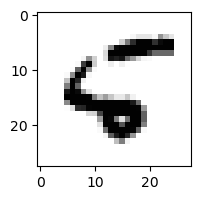

0.009793777218609134% - 0
0.0006078630849204498% - 1
0.045175622429713% - 2
2.3791967815297324e-14% - 3
2.122099107610948% - 4
0.3976278777256631% - 5
6.249564971966756% - 6 - ОШИБКА
8.141484798665158e-06% - 7
9.581912575266481e-11% - 8
4.317396982459559e-07% - 9

 3


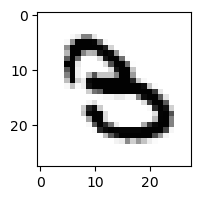

1.1880390127613277e-05% - 0
0.0001885638272858115% - 1
0.00016212033766044122% - 2
0.02478293197744365% - 3
0.0008164656640587423% - 4
0.06920181982575456% - 5 - ОШИБКА
0.054982036711671824% - 6
2.7802273840178556e-05% - 7
5.027207663953443e-12% - 8
2.8725292142390717e-09% - 9

 4


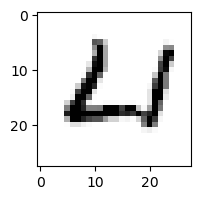

27.716268899098694% - 0
2.4318194433878438e-06% - 1
0.8640055149038591% - 2
1.0791400719912714e-11% - 3
17.961418937914324% - 4
0.010814829226896111% - 5
79.07331520844765% - 6 - ОШИБКА
0.00222975410998107% - 7
0.000618568348088283% - 8
2.111815352112971e-06% - 9

 3


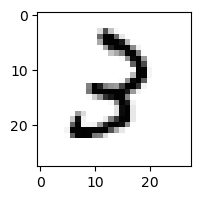

0.03056463052153174% - 0
0.038623713584151224% - 1
91.59801956186597% - 2 - ОШИБКА
34.758543611973444% - 3
0.0033065585898077615% - 4
0.0727217931037344% - 5
0.011379626633494531% - 6
0.00020811771479321614% - 7
0.002092122887905142% - 8
0.0007498924162109202% - 9

 6


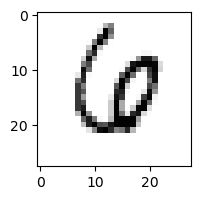

0.007843033788191263% - 0
0.004281287635001812% - 1
0.017459650359827543% - 2
0.0006744600745653055% - 3
0.6544381128183678% - 4
0.0038138971116368626% - 5
0.28446339648828983% - 6
4.926697373258607% - 7 - ОШИБКА
7.04659047693795e-08% - 8
3.815538109475516e-07% - 9

 9


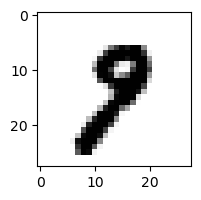

3.677980140932539e-05% - 0
0.08699648745408618% - 1
4.867389410100985e-07% - 2
5.492814125106725e-06% - 3
8.148470969188543e-07% - 4
0.0063041307469746625% - 5
3.224686281486484e-06% - 6
4.493529887482677% - 7 - ОШИБКА
0.0002099316552498669% - 8
0.051809136339359435% - 9

 8


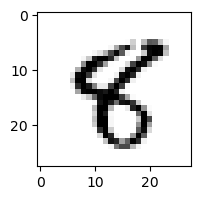

7.93689691424466e-05% - 0
0.00649532986783658% - 1
9.913898779724743e-07% - 2
5.963318057386638e-08% - 3
0.6494061336766473% - 4
40.43402009013292% - 5 - ОШИБКА
1.6430679887141276e-05% - 6
0.0002003341706717976% - 7
0.009747895002083418% - 8
0.0005223858711903886% - 9

 9


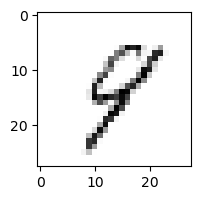

0.23320343254056622% - 0
1.4856766140259439% - 1
1.1702026194436361% - 2
0.28493864810658026% - 3
74.70726003153642% - 4
2.7395206506345353% - 5
0.7972738232918487% - 6
6.7530526444123256% - 7
97.28952946654967% - 8 - ОШИБКА
95.2844576437637% - 9

 7


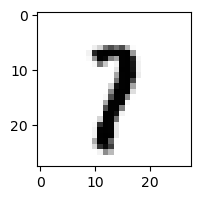

1.7727784753166677e-05% - 0
35.47167320113777% - 1 - ОШИБКА
0.02979067615112412% - 2
0.018874535219314596% - 3
0.0013578942194299168% - 4
0.0727912853977208% - 5
0.002172122958676785% - 6
13.540429122448982% - 7
0.003119814220022833% - 8
0.28276445431874364% - 9

 7


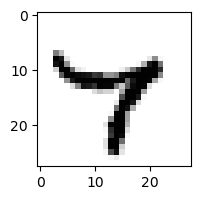

2.2333727770959177e-05% - 0
0.0015675836071144288% - 1
4.96886889420788e-13% - 2
1.0064801948528223e-05% - 3
67.13654467608154% - 4 - ОШИБКА
0.0044751416503872425% - 5
0.01119005947943168% - 6
7.597698676282544% - 7
0.3374916371897489% - 8
1.9361410656264753% - 9

 4


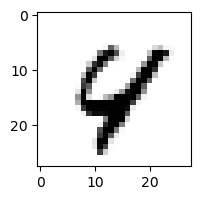

0.00040779515775925197% - 0
0.00015933326386950258% - 1
0.0026417238447162704% - 2
9.00706329445235e-14% - 3
44.640372653303736% - 4
0.00045588414176112605% - 5
0.15931966005866074% - 6
0.5166599252238941% - 7
47.21157566952791% - 8 - ОШИБКА
2.3060557875300316% - 9

 2


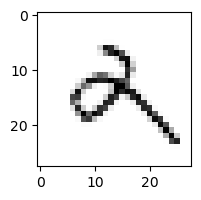

0.05566621166647012% - 0
0.9312315588091601% - 1
0.027226956088612884% - 2
0.6428188385340037% - 3
10.348949038505904% - 4
0.06485373702216911% - 5
21.699902481421578% - 6
0.008715078917787021% - 7
0.1872512999011492% - 8
98.45871200343844% - 9 - ОШИБКА

 9


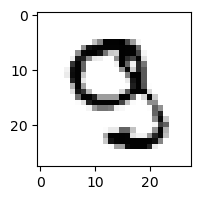

0.016996993149572183% - 0
0.00010876221335829243% - 1
0.05239079325597468% - 2
0.0005357851397582787% - 3
0.019721799027432547% - 4
0.06119270521657443% - 5 - ОШИБКА
4.781961812198579e-07% - 6
0.008225402696435834% - 7
1.025499724663038e-05% - 8
0.00032393590008738914% - 9

 7


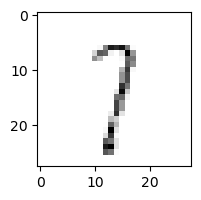

0.8849763950293491% - 0
20.901976777526755% - 1
35.597615574538544% - 2
90.19590481703739% - 3
13.436937415199504% - 4
10.670974258760884% - 5
4.209448532941277% - 6
82.72234803246015% - 7
81.96709754613259% - 8
97.19404083715703% - 9 - ОШИБКА

 5


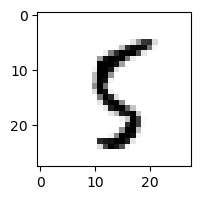

0.024215106357227976% - 0
0.12851317367319323% - 1
0.005742527920023509% - 2
0.0012773015945438957% - 3
0.7099475424556667% - 4
89.52424974601557% - 5
0.11986722432207353% - 6
0.05495963361086749% - 7
90.10704842517714% - 8 - ОШИБКА
0.5221141347197115% - 9

 9


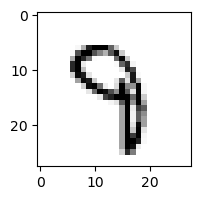

4.321745546375787e-06% - 0
0.004769088995801858% - 1
0.0012866869244503377% - 2
0.774411302218738% - 3
19.17396075415037% - 4 - ОШИБКА
0.9257886527819685% - 5
0.05314306564340855% - 6
1.1903685108064337% - 7
6.235839917777942e-05% - 8
0.07449644652025188% - 9

 3


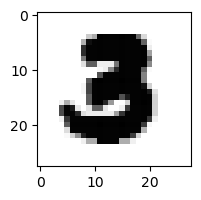

5.040028027816618e-07% - 0
2.3455655617445355e-10% - 1
1.106509831931164e-05% - 2
0.0006636254846317476% - 3
4.969143920640154e-13% - 4
0.011415405613446361% - 5 - ОШИБКА
4.932836777795801e-10% - 6
2.0577006951830063e-10% - 7
2.169303126693946e-21% - 8
1.6393731108960628e-24% - 9

 5


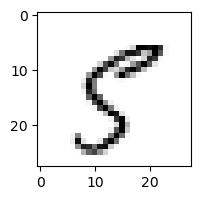

2.9473792888142376% - 0
0.15024141497939156% - 1
0.00010792314124695986% - 2
0.0010879353069181443% - 3
1.2592620206802743% - 4
34.94563039380355% - 5
0.0009808445592962057% - 6
38.70450034233875% - 7 - ОШИБКА
0.011452094495804354% - 8
2.8669441545162546% - 9

 6


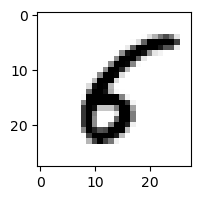

0.35530966184695073% - 0
0.049496750492165224% - 1
0.00022911018141234864% - 2
1.9685289882437024e-06% - 3
0.21076000553094373% - 4
42.469543863784295% - 5 - ОШИБКА
0.6928921847765181% - 6
1.4398696464437503e-05% - 7
7.104854627723703e-05% - 8
7.272535999866383e-08% - 9

 8


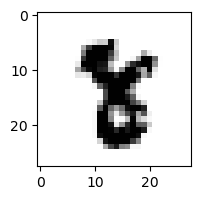

1.2687515264115775e-10% - 0
0.0001714088675583898% - 1
5.563414436137713e-10% - 2
1.769209716824276e-07% - 3
0.0003321671112674669% - 4
0.2835728686343402% - 5 - ОШИБКА
1.0276297344932342e-07% - 6
0.010094592346910318% - 7
0.03214893166013322% - 8
2.0781828140140652e-13% - 9

 8


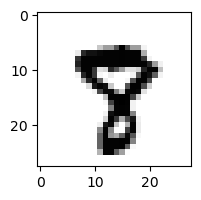

2.2824975109604128e-06% - 0
7.867844359995396e-07% - 1
1.4626610913058427e-08% - 2
8.706273225888781e-10% - 3
1.916569903074063e-05% - 4
0.04111428269719914% - 5
7.669151077002125e-09% - 6
18.999748715518404% - 7 - ОШИБКА
0.002217624946426952% - 8
0.0009348452180896251% - 9

 9


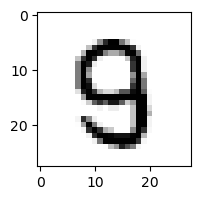

0.025018531944834964% - 0
1.3715891622888478e-06% - 1
0.0008744128315355652% - 2
0.014518175605838277% - 3
0.04035682403183831% - 4
7.430868384316046% - 5 - ОШИБКА
3.657076419983629e-05% - 6
0.0017532507098249942% - 7
0.0006273445715131549% - 8
1.4173236389289156e-07% - 9

 3


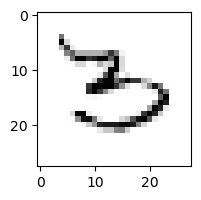

4.071110759400351% - 0
0.03169790162336573% - 1
0.035314263448707015% - 2
85.07894912243297% - 3
0.008016568638231863% - 4
18.315581816789766% - 5
99.00460821094221% - 6 - ОШИБКА
0.030861163898875776% - 7
0.004674429464318964% - 8
0.0002480047976471845% - 9

 4


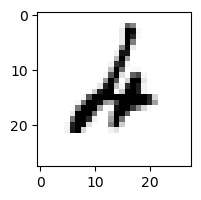

0.000521285013042106% - 0
0.058054891878174475% - 1
27.76466528060906% - 2 - ОШИБКА
0.0009201960096340388% - 3
0.7339704386506659% - 4
0.0013530184106226612% - 5
25.72128168121919% - 6
0.00011668423716618662% - 7
5.880659146254709e-05% - 8
0.0019020912579554403% - 9

 1


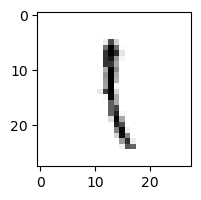

0.12933465384105006% - 0
87.63170591635736% - 1
15.280093006830436% - 2
19.772225018020723% - 3
0.6824982493291223% - 4
46.44364844297619% - 5
16.331929391154173% - 6
1.5793086933666212% - 7
94.34499489022866% - 8 - ОШИБКА
62.07834919810469% - 9

 8


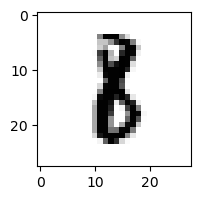

7.333222546269619e-06% - 0
5.018891259943268% - 1 - ОШИБКА
0.005156622186076927% - 2
0.0005752348472493809% - 3
7.425143187666888e-07% - 4
0.2349043261755706% - 5
0.06323558692565723% - 6
9.589825096872849e-05% - 7
0.0036531151750982234% - 8
3.0886980695241034e-08% - 9

 6


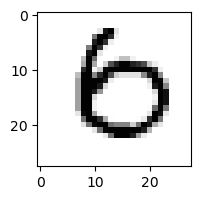

97.45825577666027% - 0 - ОШИБКА
1.8036049251178398e-06% - 1
1.2180455394043572e-06% - 2
8.065540312709425e-06% - 3
0.0018214486552851725% - 4
0.00016195499896065556% - 5
26.618667626089326% - 6
0.005894817731569812% - 7
1.8890888537850024e-10% - 8
5.874199352396541e-09% - 9

 9


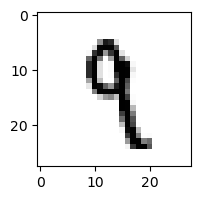

5.769979186536735e-06% - 0
5.871337612962459% - 1 - ОШИБКА
0.0056587691046431875% - 2
0.28234737967938234% - 3
0.472091437621798% - 4
3.115666617106868% - 5
0.006402719813732866% - 6
0.020272779825930322% - 7
0.0012206183056645765% - 8
1.868049758506676% - 9

 8


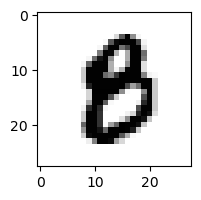

0.07027457161812001% - 0
8.523301290359082e-06% - 1
2.23594846648235e-08% - 2
1.538808441421584e-06% - 3
1.1802200485692587e-06% - 4
1.3874687412701998% - 5 - ОШИБКА
0.004705298145669643% - 6
1.5846128818920748e-07% - 7
0.005871974921168759% - 8
8.547316585823446e-10% - 9

 8


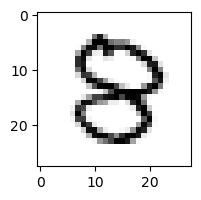

0.05144690072199939% - 0
4.0742659029248694e-07% - 1
0.002995166104564494% - 2
0.17515231664078124% - 3
0.2938614340099023% - 4 - ОШИБКА
0.12516474937812308% - 5
0.00010521329796362086% - 6
2.8125123191913596e-05% - 7
0.09347257155119552% - 8
1.430510837605438e-07% - 9

 9


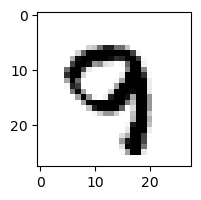

7.426130792958337e-08% - 0
0.00013789606611504438% - 1
5.7179322748698375e-05% - 2
1.3487739239038046e-07% - 3
0.02770965303554169% - 4
0.00010624210407592063% - 5
1.643348527299541e-05% - 6
0.9599223896719125% - 7 - ОШИБКА
9.638703855947723e-08% - 8
0.567264942783372% - 9

 8


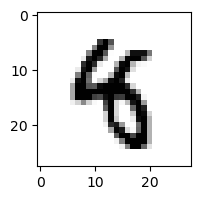

7.796877719097497e-08% - 0
0.010674362678707753% - 1
3.499927989651072e-08% - 2
1.573575322338463e-05% - 3
6.68851838266513% - 4 - ОШИБКА
1.937663720316385% - 5
0.00014154558632076348% - 6
4.0904030223020674e-05% - 7
1.1052771333568785e-14% - 8
4.0117375807660045e-06% - 9

 4


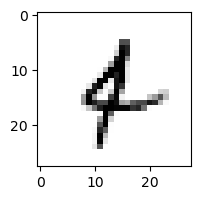

0.01069106335816374% - 0
7.740211147897338% - 1
0.0005136746310141801% - 2
0.0020314549051231147% - 3
6.843103231442979% - 4
0.34965529300181586% - 5
20.336752834195618% - 6 - ОШИБКА
0.09743020658830215% - 7
3.1044525914882194e-06% - 8
0.183014861142797% - 9

 3


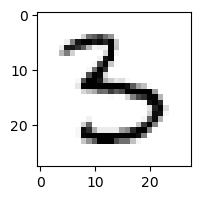

0.02461183563656119% - 0
0.00023730099027189586% - 1
8.811369148662821e-05% - 2
28.44625315720758% - 3
1.7532944686699259% - 4
59.091815658673454% - 5 - ОШИБКА
0.07125509168574055% - 6
8.34395479970089e-05% - 7
0.00016011355721558674% - 8
7.797892529869809e-06% - 9

 2


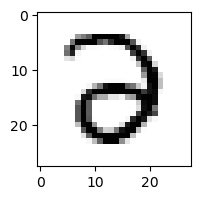

3.375943025073734% - 0
6.660619782128923e-06% - 1
16.864855599639423% - 2
60.458954147221256% - 3 - ОШИБКА
0.02137498157704339% - 4
0.00017823467337047005% - 5
0.015525859645722869% - 6
2.5199764963480377e-06% - 7
9.326336006314759e-06% - 8
2.62774933080824e-11% - 9

 9


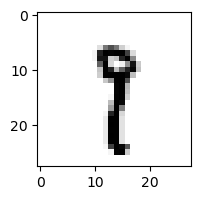

3.5717940120066454e-05% - 0
41.51457343235434% - 1
0.00012156515562833434% - 2
0.039093255115573204% - 3
0.0016143155761811914% - 4
2.7677548170585085% - 5
0.004095155244276376% - 6
69.7383838333964% - 7 - ОШИБКА
0.004323066212241279% - 8
0.5442652903276358% - 9

 2


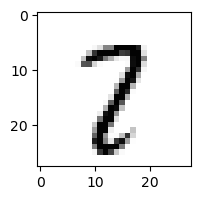

0.002235237869263319% - 0
0.2245230695549773% - 1
0.09943241933153639% - 2
0.047783953225817084% - 3
0.001862171743309236% - 4
1.0772591638673117% - 5
0.0002523102339491467% - 6
69.88881446922834% - 7 - ОШИБКА
8.820959838361023% - 8
0.13630600350385044% - 9

 4


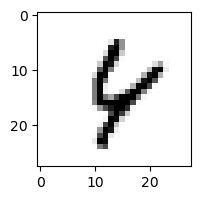

0.002806990233213459% - 0
0.008257319038746649% - 1
0.06025958300250091% - 2
9.847538121920247e-07% - 3
59.67633437973677% - 4
0.07038126192557155% - 5
3.396408235993554% - 6
0.8870737150330046% - 7
75.1763623045474% - 8 - ОШИБКА
69.9946688212247% - 9

 5


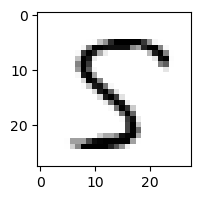

0.008187580330243692% - 0
0.0007554832467970233% - 1
0.0015487053745543633% - 2
0.004667938010278057% - 3
26.529925041235856% - 4
99.24286093945608% - 5
0.00011647489003219295% - 6
0.0015087667113049355% - 7
99.98389876980697% - 8 - ОШИБКА
8.537680069152717e-11% - 9

 9


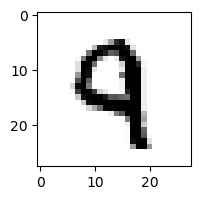

2.883335462674201e-05% - 0
3.810601587345015e-05% - 1
0.012270259875091751% - 2
1.599745191069547e-06% - 3
18.747533827883274% - 4 - ОШИБКА
0.004123108663537974% - 5
0.00018313216424253133% - 6
0.017505112271118728% - 7
9.297154282448847e-09% - 8
0.9764865774325351% - 9

 5


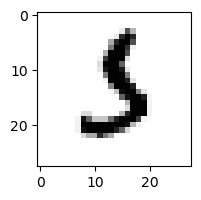

0.0019550276781653076% - 0
0.19249421844231593% - 1
0.1586249276102767% - 2
12.379292486222846% - 3 - ОШИБКА
1.0136675971309014e-07% - 4
4.775106848760431% - 5
8.13135452410818% - 6
0.06238863046864287% - 7
7.888356142145764e-10% - 8
4.554174154277366e-08% - 9

 8


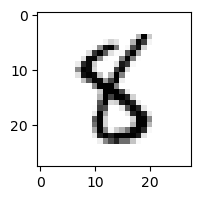

0.00028361637765097954% - 0
0.013949183706228434% - 1
4.3748204015534056e-05% - 2
0.0010778304047198448% - 3
0.004128270335460829% - 4
46.37877237415669% - 5 - ОШИБКА
0.2829108247495197% - 6
3.3198502255414806e-05% - 7
7.489102695978639% - 8
4.7979525617655e-07% - 9

 3


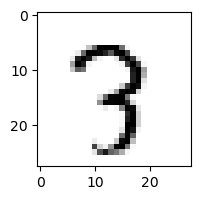

5.648309567651023e-05% - 0
0.009176375250459563% - 1
1.1583579926644783% - 2
8.957887006894405% - 3
0.019610279856546873% - 4
0.1198812925684958% - 5
0.0014915701732369213% - 6
37.896977916006804% - 7 - ОШИБКА
3.7024307005891472% - 8
0.2756187784348612% - 9

 5


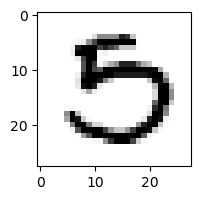

36.1097667396167% - 0 - ОШИБКА
4.0720584547211236e-07% - 1
5.140817860848128e-06% - 2
0.024411274747208018% - 3
2.400179987521891e-07% - 4
0.0004632605573641653% - 5
9.124689056092033e-07% - 6
0.0026483116876853817% - 7
3.3047029829996318e-06% - 8
2.22424048688586e-17% - 9

 1


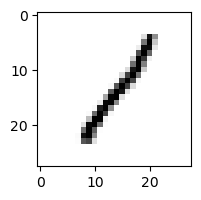

0.31240249683824173% - 0
91.43753546976802% - 1
26.54293632510275% - 2
1.7630856934423436% - 3
1.7841113277402891% - 4
0.8972765628902958% - 5
1.7696247795011901% - 6
1.7171270600296502% - 7
92.57319461232576% - 8 - ОШИБКА
0.696571085953213% - 9

 9


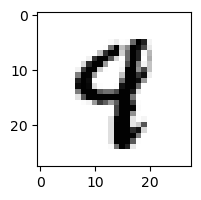

6.658907659367152e-06% - 0
0.0015672953894284344% - 1
3.6844688828711052e-06% - 2
1.0830348423902155e-07% - 3
7.7808987619057675% - 4 - ОШИБКА
0.09728779880129891% - 5
0.0003237210543711857% - 6
0.008567919724605574% - 7
7.105353779504573e-07% - 8
0.02737454636447828% - 9

 2


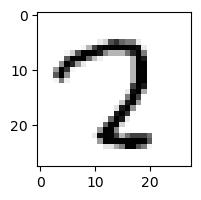

0.1528782002487384% - 0
0.00010123519840315399% - 1
2.3985350700583727% - 2
0.4525820833855985% - 3
0.05096493278173745% - 4
0.14194919769586226% - 5
1.1034128441537523e-06% - 6
51.84698174726805% - 7 - ОШИБКА
1.234711444555359% - 8
1.0100541837230272e-07% - 9

 8


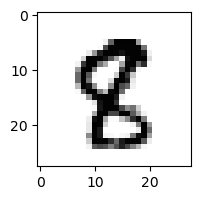

2.167720875642329e-05% - 0
0.0006385997544544075% - 1
4.50616367228006e-05% - 2
1.0568397253473441e-08% - 3
1.4467110035793434e-05% - 4
1.3406974754808982% - 5 - ОШИБКА
3.844140753656878e-08% - 6
2.084290795941693e-05% - 7
0.001424296079736476% - 8
1.7243078669536633e-06% - 9

 9


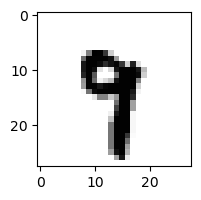

8.922301899604246e-09% - 0
0.03591702951555301% - 1
1.3877459770310112e-08% - 2
3.498810739442622e-07% - 3
0.6102347036106849% - 4
0.5014965755053177% - 5
0.0007233285112745244% - 6
1.0771308308163123% - 7 - ОШИБКА
6.600525803131695e-06% - 8
0.0007526202584695789% - 9

 8


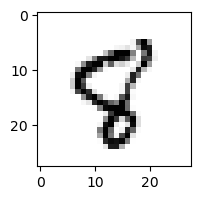

0.01007958239278872% - 0
0.00798695041175587% - 1
0.002054136011937661% - 2
1.2090933384189427e-09% - 3
0.5123962063180016% - 4
15.135860548377133% - 5 - ОШИБКА
0.017266913663346335% - 6
0.2314395824806369% - 7
0.024737717417653647% - 8
0.32916535981623196% - 9

 9


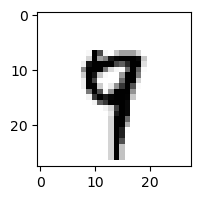

6.320444093396139e-07% - 0
0.060200450371239236% - 1
1.1676811767139495e-05% - 2
1.899465909765813e-07% - 3
1.9740627191297502% - 4
0.5009184752056085% - 5
0.0006485137775805598% - 6
7.998266107034984% - 7 - ОШИБКА
7.301816007854608e-05% - 8
1.2397569190985045% - 9

 8


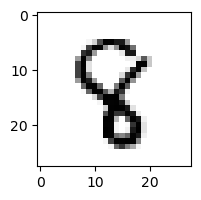

3.773436702018248e-07% - 0
0.012550783830654182% - 1
0.0010493743560026048% - 2
2.0454503800019278e-05% - 3
9.481125354510878% - 4 - ОШИБКА
1.239236183524756% - 5
0.0006015774922983702% - 6
0.005605529954850334% - 7
0.02923237962171789% - 8
1.597530036290709e-07% - 9

 8


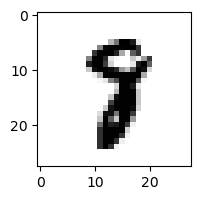

7.773416932352788e-07% - 0
0.00977455917276742% - 1
3.0259510858116547e-05% - 2
8.576321970950974e-06% - 3
0.000268154818850371% - 4
0.107160273942291% - 5
1.7454237499113183e-05% - 6
6.044385184501733% - 7 - ОШИБКА
0.0023650855945526656% - 8
1.9003504003169116e-09% - 9

 0


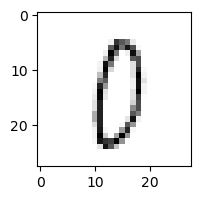

97.17135989632033% - 0
0.019886585150427197% - 1
4.464173304456696% - 2
5.283130440083215% - 3
0.7642338629740867% - 4
40.77241229505806% - 5
3.2340361357875915% - 6
1.1231592166072282% - 7
99.98409501383915% - 8 - ОШИБКА
14.491712869131229% - 9

 2


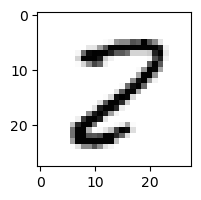

0.3465430183536504% - 0
0.001642983574159795% - 1
16.98113114321546% - 2
3.452600040677728e-05% - 3
0.00010634975073375594% - 4
0.2340787414306419% - 5
0.00023162874293611717% - 6
0.03313547663256484% - 7
99.99989442563816% - 8 - ОШИБКА
6.4300691092845896e-09% - 9

 6


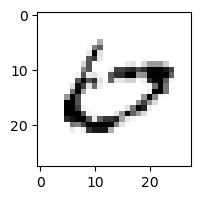

99.52097019295663% - 0 - ОШИБКА
0.00011649288125698023% - 1
0.0003942934247046772% - 2
0.0035065034099161655% - 3
0.04092476019334027% - 4
4.923308611919577e-05% - 5
8.049230730603446% - 6
4.086652051415964% - 7
3.853403954954068e-06% - 8
2.7256008824313483e-07% - 9

 9


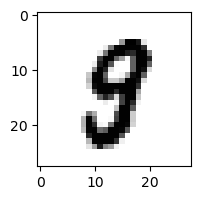

0.002717296073567137% - 0
3.373406824559799e-05% - 1
1.3438532474898397e-06% - 2
0.00026210764095677504% - 3
0.0017762251377641234% - 4
4.256778884430766% - 5 - ОШИБКА
8.702051566738678e-06% - 6
0.00032288787898978536% - 7
3.227062501821402% - 8
4.278267483641177e-05% - 9

 3


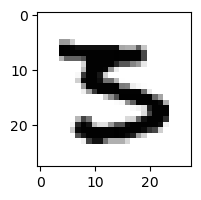

0.0003681580866302217% - 0
1.7491387414468534e-09% - 1
5.973153961337351e-06% - 2
0.06630832801128382% - 3
1.0061775113228788e-07% - 4
88.52482276962662% - 5 - ОШИБКА
2.920177140721921e-06% - 6
1.334435286892488e-05% - 7
6.192177822864854e-12% - 8
7.870412283116151e-13% - 9

 3


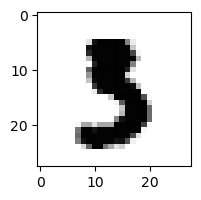

1.6179321258360062e-07% - 0
4.750620212081188e-06% - 1
2.349778483163698e-10% - 2
0.025326707711473474% - 3
8.991147462222278e-09% - 4
10.018774766150882% - 5 - ОШИБКА
4.191583881865569e-07% - 6
6.911438078751758e-05% - 7
2.576051860426393e-12% - 8
8.851542099449433e-15% - 9

 3


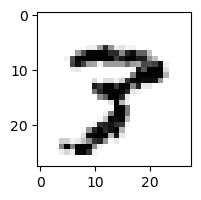

0.0002839950264422541% - 0
0.00018874240178424584% - 1
0.00011002608651928661% - 2
0.027261049688952613% - 3
0.00034731686430488815% - 4
0.0006956491795341975% - 5
6.608203208048811e-06% - 6
7.836025395544584% - 7 - ОШИБКА
1.0083691856477823% - 8
0.0024957985722145687% - 9

 5


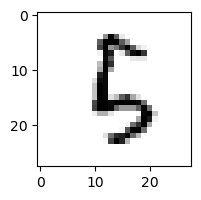

0.005105114656546263% - 0
0.016799036146574044% - 1
11.18963837245428% - 2
0.07688978092247176% - 3
10.071770942248131% - 4
7.079624875494514% - 5
0.35875783820470064% - 6
0.0009832389804384871% - 7
35.968228824055295% - 8 - ОШИБКА
0.005547609014940268% - 9

 9


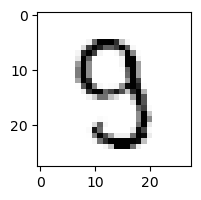

0.09557633385557303% - 0
6.704784617808298e-05% - 1
0.0018463452917001717% - 2
7.844640604436967% - 3
0.885430375139901% - 4
8.5212166232237% - 5 - ОШИБКА
0.00016459726551577503% - 6
0.1510899764318286% - 7
0.03400045004175098% - 8
0.00019299820889013346% - 9

 5


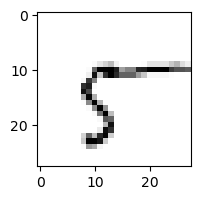

87.7995733308252% - 0
1.2584818519173746% - 1
0.0012544058796918971% - 2
0.018835866543099936% - 3
2.565941533146258% - 4
49.513741377169104% - 5
7.766621380749933% - 6
47.68030643001611% - 7
97.0913962811987% - 8 - ОШИБКА
21.378228254142414% - 9

 8


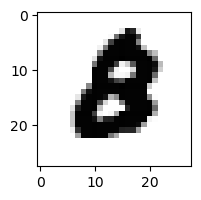

0.003837612170800675% - 0 - ОШИБКА
2.1638696388896185e-10% - 1
3.4097806510636394e-05% - 2
1.758501892248129e-08% - 3
7.909702228140753e-09% - 4
0.0007958784646921113% - 5
0.00019523565060591244% - 6
1.824531737965865e-08% - 7
7.52913675181228e-13% - 8
5.33174052258908e-12% - 9

 3


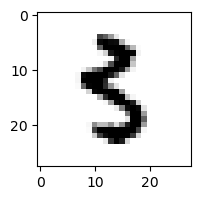

0.0015497552627279317% - 0
0.00288718554431116% - 1
2.4362382582942627e-07% - 2
0.030308534808552185% - 3
0.0006895830813366424% - 4
41.898407854272115% - 5 - ОШИБКА
0.022885590063725737% - 6
0.00018385911845919645% - 7
2.6436997990408223e-06% - 8
3.0198728726506304e-05% - 9

 4


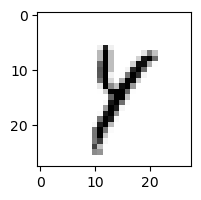

0.0008954599345494185% - 0
34.963786234814414% - 1
0.013027161196488096% - 2
0.07598382690784698% - 3
13.756540213809004% - 4
5.39940097748679% - 5
0.0523499313099069% - 6
18.541988026159732% - 7
99.48965594427807% - 8 - ОШИБКА
1.827071495205818% - 9

 3


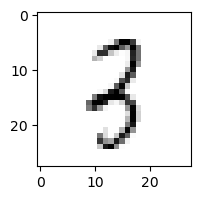

0.05939937592089163% - 0
2.650524274516812% - 1
25.821577564923416% - 2
55.65116514395938% - 3
2.138351019573844% - 4
0.9542557379325322% - 5
0.057874250762314% - 6
0.04992930315512968% - 7
99.07844685026322% - 8 - ОШИБКА
0.5760554778328706% - 9

 1


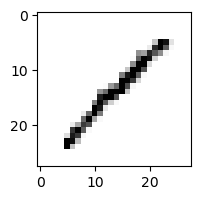

1.0300410471618453% - 0
89.83247623635145% - 1
26.015675198146926% - 2
70.98118256493922% - 3
15.291059081508513% - 4
2.1455369878880504% - 5
0.027664275805344397% - 6
0.1904139462345635% - 7
99.98600901686034% - 8 - ОШИБКА
17.891777015455304% - 9

 8


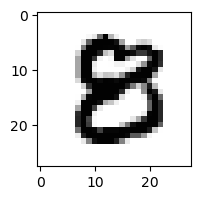

0.011734046261092538% - 0
1.201104617332778e-09% - 1
2.759919871908776e-06% - 2
0.0037739203677173744% - 3
1.710907206919158e-06% - 4
0.2777781628251171% - 5 - ОШИБКА
3.288441512971157e-07% - 6
3.5482418188602596e-10% - 7
0.000639929179370464% - 8
5.31840933516806e-12% - 9

 9


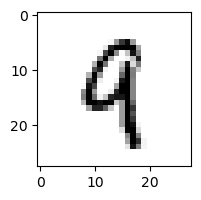

0.000170262411111419% - 0
0.8592282401798845% - 1
0.086771255404491% - 2
0.0006925751856731672% - 3
18.240376947114573% - 4 - ОШИБКА
0.0734235303296766% - 5
0.050723557263790395% - 6
0.017458285874674694% - 7
0.0020158154587473446% - 8
13.108299191763445% - 9

 3


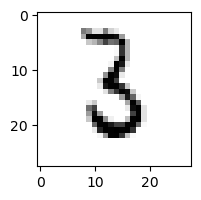

0.023835867793123727% - 0
2.9251300817013517% - 1
1.9898651028646421% - 2
20.31036870215092% - 3
1.2434410707285563e-05% - 4
0.3301416439965504% - 5
92.89900504235712% - 6 - ОШИБКА
0.0012425372304935775% - 7
0.0011066157629491676% - 8
2.1339807781962806e-06% - 9

 8


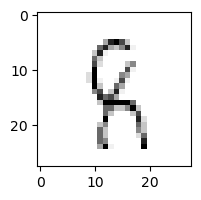

0.009396860663846568% - 0
1.3686448240366607% - 1
18.25623289639583% - 2
0.4836725630964182% - 3
58.450533341038934% - 4 - ОШИБКА
15.891300851069989% - 5
1.7612375093051273% - 6
0.09542722877130258% - 7
46.937345892517854% - 8
0.3043102158169636% - 9

 8


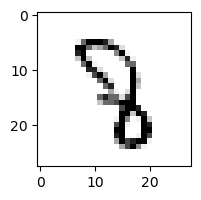

3.637561338152839e-05% - 0
0.0006555029161054164% - 1
2.1808266667463094% - 2
2.545794130173455% - 3
5.156023125861009% - 4 - ОШИБКА
2.059487312106571% - 5
0.017220955099730647% - 6
0.03577498875612509% - 7
0.0976991599149123% - 8
0.0005246897534254831% - 9

 2


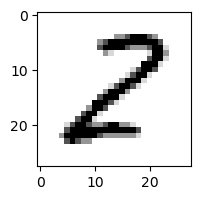

0.33854027549798305% - 0
1.4109998577027998% - 1
88.83198774528644% - 2
0.23010410757650385% - 3
0.00013977816416190736% - 4
0.33815484845748034% - 5
0.051855562277027964% - 6
9.53472293476028e-07% - 7
98.29969943453455% - 8 - ОШИБКА
7.249303570216198e-12% - 9

 7


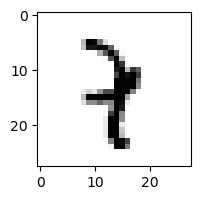

3.7405739927649865e-07% - 0
69.65389118037628% - 1 - ОШИБКА
0.1691680982068068% - 2
0.15388398978155% - 3
1.4627249510777824% - 4
0.017207410735129876% - 5
0.044021862221245885% - 6
0.11472602009069002% - 7
3.647045145627424e-05% - 8
0.01357785515591714% - 9

 4


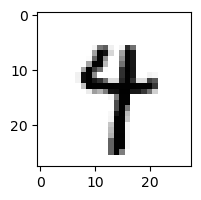

1.9776945194220704e-06% - 0
0.016502845045053196% - 1
1.6246113883413778e-08% - 2
2.6940439416638354e-06% - 3
17.178562496288155% - 4
0.4803145074128553% - 5
0.011054117241664338% - 6
0.8330443004499224% - 7
0.0005558590606014026% - 8
34.11540767783954% - 9 - ОШИБКА

 8


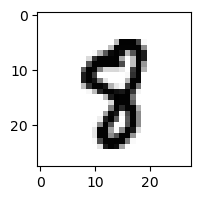

5.3303445871734744e-05% - 0
0.00038524903287717423% - 1
4.920616167183123e-06% - 2
2.172979425842952e-08% - 3
0.005795704759895893% - 4
2.966672052464616% - 5 - ОШИБКА
1.632944271737276e-05% - 6
0.007128993413708661% - 7
0.017902285152551885% - 8
7.437194097904118e-06% - 9

 3


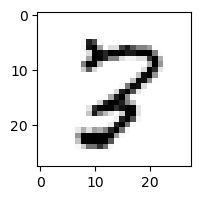

0.004968922108254869% - 0
9.47061337227686e-05% - 1
1.640106830527203% - 2
0.0004542606055045519% - 3
0.0014978116602973408% - 4
0.01447649633061776% - 5
0.0003610482035369632% - 6
2.5882949624342033% - 7
99.8608569448997% - 8 - ОШИБКА
0.023556558760189816% - 9

 8


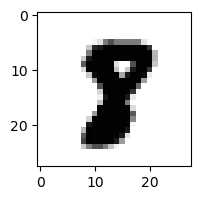

3.535749354131848e-08% - 0
5.8863057276373655e-05% - 1
4.858997285979619e-09% - 2
2.2386141179735205e-10% - 3
4.577887534074929e-09% - 4
0.20873167404747758% - 5 - ОШИБКА
4.048898785068543e-09% - 6
0.00021786988203275544% - 7
0.015433945222647941% - 8
2.280622026785912e-12% - 9

 8


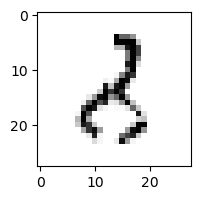

0.20321272529588247% - 0
9.167127287597047% - 1
92.12809505473363% - 2 - ОШИБКА
27.915942751313928% - 3
0.7584164227327441% - 4
0.32940911420432106% - 5
0.22949560985176545% - 6
0.00015494933523904438% - 7
86.09211763602761% - 8
0.0013490953289873198% - 9

 8


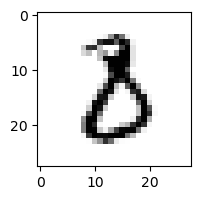

0.0997760898335539% - 0
0.08392758950396007% - 1
1.0896912233656326% - 2
9.708091736803901% - 3 - ОШИБКА
2.9465687140848264e-07% - 4
0.25686007466507743% - 5
0.06761350286136493% - 6
5.719427054468505e-05% - 7
0.0014281164487786229% - 8
1.6187670715145183e-07% - 9

 9


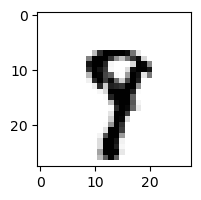

4.2938278251439107e-07% - 0
0.0006415339060392988% - 1
1.236628681622039e-08% - 2
6.9608338873452906e-06% - 3
0.01900559611207515% - 4
0.5523013676768198% - 5
8.082965976910049e-05% - 6
5.535103291341338% - 7 - ОШИБКА
1.7550256108551563% - 8
0.18524539937117704% - 9

 7


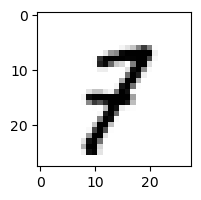

0.004214757604469322% - 0
1.7409690826623274% - 1
0.7518704303252031% - 2
0.017924815692744688% - 3
0.09629353752793005% - 4
0.11942127493173836% - 5
0.0004932822975700801% - 6
14.273538736252704% - 7
0.005412060502678313% - 8
21.060439208542768% - 9 - ОШИБКА

 4


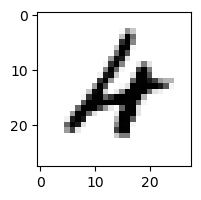

0.0217664164008402% - 0
7.177161801052194e-05% - 1
0.8550163937338432% - 2
1.5522562105730924e-05% - 3
1.5587605923362269% - 4
5.799116695086424e-06% - 5
36.46497900428711% - 6 - ОШИБКА
0.00021969906439028728% - 7
0.0010934629559528567% - 8
0.20065874640062364% - 9

 2


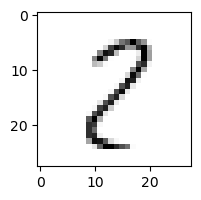

9.943948949935159% - 0
1.43992026342784% - 1
73.36339431234042% - 2
7.920180915517487% - 3
0.027707200662572134% - 4
3.2468232820328757% - 5
0.044851409042845757% - 6
2.26342704365342% - 7
99.99991922271315% - 8 - ОШИБКА
0.5321280670243568% - 9

 2


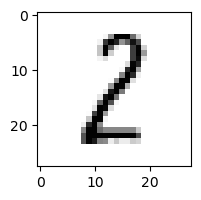

0.4098300155435779% - 0
33.38385269344576% - 1
26.71724699462958% - 2
3.4077815394551974% - 3
0.000992844883269349% - 4
1.1824354237316514% - 5
0.006773803659463609% - 6
0.0014481358435797253% - 7
88.94475669256144% - 8 - ОШИБКА
5.383667225794399e-07% - 9

 9


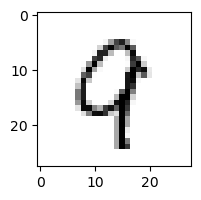

0.0430735232851863% - 0
0.10468350701288767% - 1
1.3470509177459606% - 2
8.834440088661754e-07% - 3
54.79660108467205% - 4 - ОШИБКА
0.0003725281216882633% - 5
0.058025571654998664% - 6
6.20592162204851% - 7
19.386446513930753% - 8
3.2318327869536425% - 9

 3


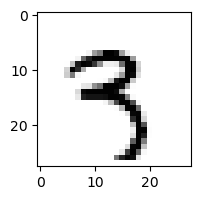

9.043629541118625e-06% - 0
0.08179161787114513% - 1
0.0640703807453173% - 2
0.8299362597543235% - 3
0.2468879553570791% - 4
1.1165982620801618% - 5
0.002949568345863805% - 6
0.029252310367729586% - 7
1.7242996576732194e-05% - 8
46.69980962689016% - 9 - ОШИБКА

 2


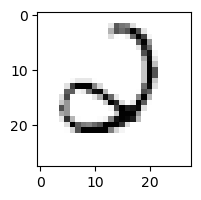

1.1122358325191575% - 0
0.0030852443955406423% - 1
0.5863948742593418% - 2
0.06924899085740635% - 3
6.468009272606694% - 4
1.8060922298024669% - 5
67.32839798029548% - 6 - ОШИБКА
0.08991478099825534% - 7
2.9257903998323817e-07% - 8
0.0006895767679470201% - 9

 5


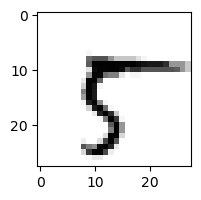

4.542759880209552% - 0
0.0008260509292790055% - 1
6.458625885278692e-07% - 2
6.83752375375897e-08% - 3
0.01751825411614104% - 4
58.47710550113082% - 5
0.0036260687448498945% - 6
85.1068247583962% - 7 - ОШИБКА
0.02071502232775067% - 8
0.04414668038274881% - 9

 8


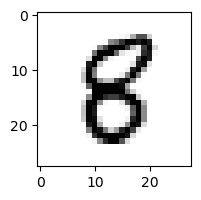

0.08213139793784408% - 0
0.00010942957428902145% - 1
0.00021268644857761404% - 2
0.0006029543236141885% - 3
0.050975659302753655% - 4
7.538837374315994% - 5 - ОШИБКА
0.0044804099955423156% - 6
5.385243583565441e-07% - 7
3.6764034722179124% - 8
6.376767466954195e-08% - 9

 7


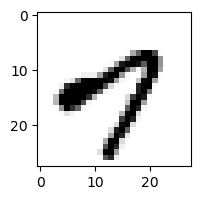

41.670995459462006% - 0
3.5642639173716296e-06% - 1
1.213763000866841e-12% - 2
0.0006534726133652902% - 3
62.15608661890115% - 4 - ОШИБКА
0.07526868420378686% - 5
1.891523941578088e-05% - 6
3.255165839430528% - 7
1.8381498195681562e-12% - 8
0.03239721107192504% - 9

 2


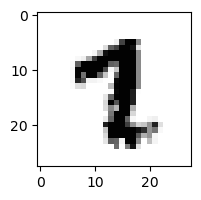

8.028466089604999e-09% - 0
0.054409610269644866% - 1
8.85391329931184e-07% - 2
2.4775134090500295e-09% - 3
2.7049346461969206e-05% - 4
0.18946674973871502% - 5 - ОШИБКА
8.819046439032715e-07% - 6
0.06786430306945747% - 7
1.1676253606063697e-08% - 8
8.916300561517179e-07% - 9

 9


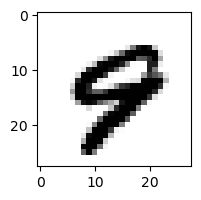

0.0015025033297791667% - 0
1.663726539443694e-06% - 1
1.5612806012599608e-11% - 2
3.987121242640553e-13% - 3
0.7287226043130398% - 4 - ОШИБКА
0.0012590466669631832% - 5
0.005442637713787455% - 6
0.08487631215746753% - 7
4.944474178265436e-13% - 8
0.04552996300180109% - 9

 7


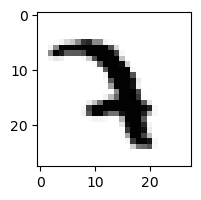

2.368995103950692e-11% - 0
0.06371803508344133% - 1
0.3931798535704788% - 2 - ОШИБКА
0.00013862935564977136% - 3
0.002454410162327479% - 4
7.684053553746095e-06% - 5
0.0012362470299863018% - 6
0.14608227459898265% - 7
2.3030805560832587e-09% - 8
4.435185083641936e-08% - 9

 8


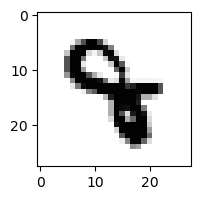

3.492433646309627e-11% - 0
0.00021249267214935386% - 1
5.989288242718795e-08% - 2
7.648070673552074e-06% - 3
36.56901966342353% - 4 - ОШИБКА
0.010747704379633854% - 5
0.026482797460538807% - 6
0.0003938009809517463% - 7
1.3118085489448131e-14% - 8
4.165472610846121e-08% - 9

 8


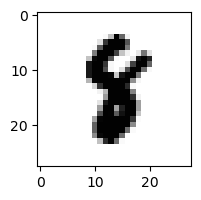

5.1582741590829555e-09% - 0
0.004556811115778653% - 1
2.64245843562795e-07% - 2
2.348105997655954e-08% - 3
0.00026627503016267206% - 4
0.5281928430667778% - 5 - ОШИБКА
1.6732028346264424e-05% - 6
0.0009887122107948149% - 7
0.0005725169866247989% - 8
1.8300777032897972e-10% - 9

 0


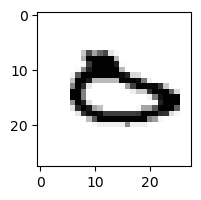

1.3626478007309162% - 0
0.0004980347284077815% - 1
1.5292334711436378e-06% - 2
9.203910258088878e-12% - 3
0.006384270426532549% - 4
0.009313501219838111% - 5
95.67354474886776% - 6 - ОШИБКА
0.694877852147523% - 7
2.9911203108067464e-07% - 8
0.0021649263712340927% - 9

 5


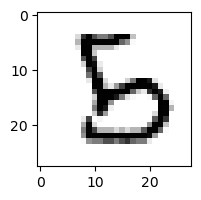

0.00019993441409051356% - 0
2.9395203302219188e-05% - 1
14.273659528301936% - 2
0.0001725029504935525% - 3
0.05541364911011915% - 4
1.6924890318844785% - 5
0.0880548886484753% - 6
2.245403731772526e-07% - 7
16.21314375029452% - 8 - ОШИБКА
4.487235581867863e-09% - 9

 2


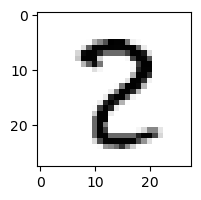

0.012701830063326572% - 0
0.0012583236992342495% - 1
11.132945766942719% - 2
0.011761075417891172% - 3
0.0005030253436611175% - 4
0.02826680080575147% - 5
9.482900067770915e-07% - 6
0.3606590630788662% - 7
99.9968995069613% - 8 - ОШИБКА
5.1628648079042315e-06% - 9

 2


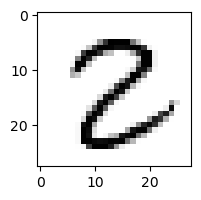

0.020871543752087104% - 0
0.0016150702827098335% - 1
31.79076742143713% - 2
0.687922967037576% - 3
5.330359501377024e-06% - 4
0.6630204564990975% - 5
6.860435712823877e-07% - 6
0.00029175825522372923% - 7
99.9980127860867% - 8 - ОШИБКА
1.013688960145697e-09% - 9

 4


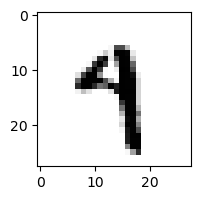

1.5010634743454368e-05% - 0
0.16971269129874642% - 1
3.5903347235055007e-08% - 2
0.0010577805862408047% - 3
2.1651194797817284% - 4
0.9722628013774937% - 5
0.009898805341317969% - 6
0.44171490172407485% - 7
8.066238356741287e-06% - 8
98.51823238171096% - 9 - ОШИБКА

 2


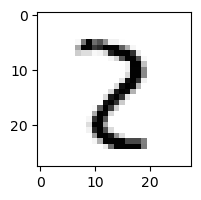

0.004158652498671082% - 0
0.24332272794234303% - 1
1.3119234692177977% - 2
0.40108394572987044% - 3
0.001576645418940266% - 4
0.007800089436396635% - 5
0.0007718631719347038% - 6
1.169022738071688% - 7
99.87340935279693% - 8 - ОШИБКА
0.10814919861717492% - 9

 4


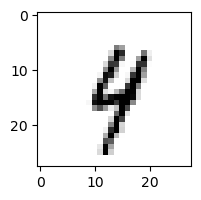

0.00044380344526657447% - 0
0.30928961773996494% - 1
0.0073925708235799215% - 2
0.030178609562565795% - 3
14.01113803730823% - 4
0.1719685178149596% - 5
0.5469295089559932% - 6
1.1378404236737265% - 7
10.023637192641184% - 8
64.25487176661223% - 9 - ОШИБКА

 8


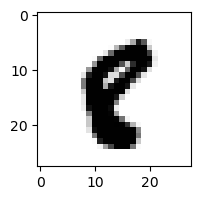

9.690147240111817e-05% - 0
0.00231289208834704% - 1
1.4929589864356527e-10% - 2
9.536562977837447e-13% - 3
2.0685435768304283e-05% - 4
0.36722421460626653% - 5 - ОШИБКА
1.845347223376722e-05% - 6
1.4134731058595571e-05% - 7
0.0012248549843770387% - 8
4.5300480503641e-06% - 9

 8


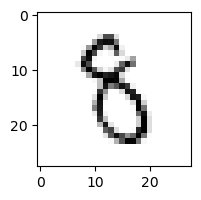

0.011196264833572382% - 0
0.09210166815192553% - 1
0.013248000559758808% - 2
3.48585793812203% - 3
0.08161761045696513% - 4
27.556509936921103% - 5 - ОШИБКА
1.3054602790086978% - 6
0.012296260042722973% - 7
0.6057888396915596% - 8
6.43605206381437e-05% - 9

 8


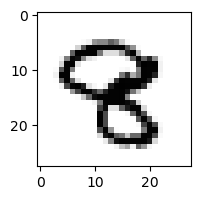

1.569447312509584e-07% - 0
6.57796442377112e-05% - 1
7.943470974048714e-05% - 2
0.0035292589643084616% - 3
0.03921932020440709% - 4 - ОШИБКА
0.00036663716021606644% - 5
2.8541446218053983e-07% - 6
0.00013488858799615765% - 7
0.0030688376922621474% - 8
1.9352602366039895e-05% - 9

 5


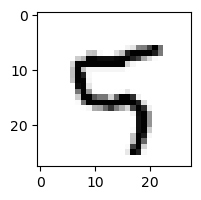

0.019894231335891358% - 0
0.0023337525748683046% - 1
0.19434587304133355% - 2
8.852428856571377e-06% - 3
4.2117450748721215% - 4
8.134533819310356% - 5
0.003488297523740721% - 6
1.0402939918624847% - 7
2.4407035316139273e-06% - 8
13.031698256179167% - 9 - ОШИБКА

 3


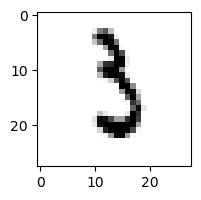

0.004366750072867449% - 0
5.9082190140970825% - 1
0.719859828847642% - 2
9.75042310393717% - 3
1.2952158657620508e-05% - 4
3.011074688301186% - 5
42.99655449982267% - 6 - ОШИБКА
2.9167815656836633% - 7
9.45291120695922e-08% - 8
0.00015979431376581712% - 9

 5


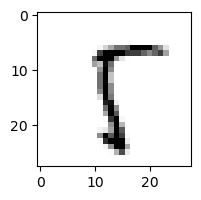

0.15303404926094882% - 0
0.2128592134865583% - 1
0.13177799820044328% - 2
0.010981198518496636% - 3
0.5230849061926567% - 4
98.1019820011727% - 5
0.08046749959174046% - 6
0.842664098382551% - 7
99.97519069921093% - 8 - ОШИБКА
15.384474834939471% - 9

 8


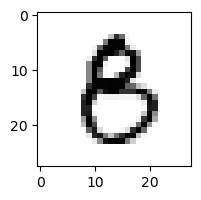

0.5921506555406285% - 0
0.0003104705430951929% - 1
3.012240680092087e-05% - 2
0.2891395324095837% - 3
0.02822815266958825% - 4
9.62424719325682% - 5 - ОШИБКА
0.0005512151507442028% - 6
6.410172549137608e-06% - 7
0.0003155588891370564% - 8
4.448074927799237e-05% - 9

 4


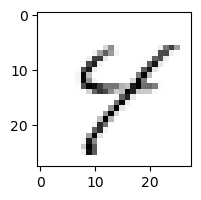

0.22319560681277345% - 0
0.10982997148393707% - 1
0.015308503518670675% - 2
0.0030575150318385984% - 3
94.80512561219884% - 4
49.48061783321497% - 5
6.037452684729693% - 6
3.2984214100265663% - 7
98.30282305430426% - 8 - ОШИБКА
87.21128355982049% - 9

 2


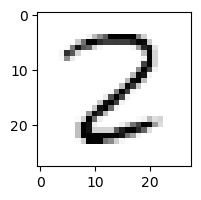

0.014556507441021486% - 0
0.14253992784687702% - 1
98.9553147278322% - 2
1.184116910572215% - 3
0.00122556214049138% - 4
0.013042745836604598% - 5
0.022891821777047017% - 6
0.0001499961858177254% - 7
99.37900920578043% - 8 - ОШИБКА
2.183013627574283e-11% - 9

 8


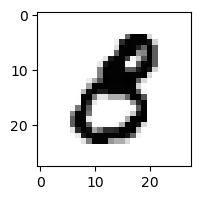

0.04526879713346084% - 0
0.00020710949376087103% - 1
1.4671908849127687e-07% - 2
0.08205058268790759% - 3
1.7572073780622962e-05% - 4
0.31584884458423973% - 5 - ОШИБКА
1.0710943407327646e-06% - 6
1.2357302396524091e-06% - 7
2.225093486701201e-09% - 8
2.3339712279036577e-11% - 9

 8


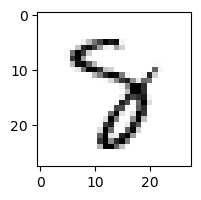

0.0004339956065051312% - 0
0.005374251575158825% - 1
0.007753819891206614% - 2
0.009277610019657564% - 3
1.1281414575393571% - 4
2.636769023496543% - 5
0.09144251159440869% - 6
24.54567714143496% - 7 - ОШИБКА
0.43782745730579864% - 8
2.0633584327163856e-08% - 9

 7


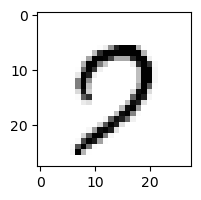

86.65814005531523% - 0
3.581172926759732e-06% - 1
0.0054881505347088985% - 2
0.0213275054684319% - 3
0.03595760801292231% - 4
8.263771487244872% - 5
0.0060937790313571145% - 6
81.73778139871975% - 7
0.00019808068044059672% - 8
99.62097367424437% - 9 - ОШИБКА

 8


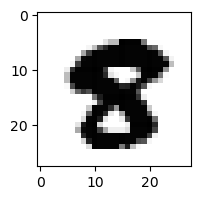

3.1330964383387966e-07% - 0
1.6477913752932103e-12% - 1
7.389204035278658e-15% - 2
1.6393382985021822e-16% - 3
7.27852730380917e-09% - 4
0.13523911615333614% - 5 - ОШИБКА
1.1850598348806518e-13% - 6
9.14394691894677e-09% - 7
0.0030540087690783106% - 8
4.756063034561334e-14% - 9

 6


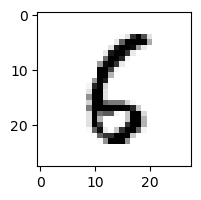

1.5714856989298864% - 0
0.005564309768349102% - 1
1.7016063241686135% - 2
2.2944560317385154e-07% - 3
0.03920279257434378% - 4
18.369560244895037% - 5
68.08038887546111% - 6
0.000144361179979593% - 7
72.93928182783192% - 8 - ОШИБКА
0.0005548195961014297% - 9

 8


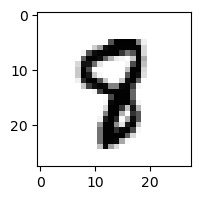

1.2531587458267053e-06% - 0
0.0003134201764422401% - 1
1.0396838826447891e-05% - 2
2.0507698922410494e-06% - 3
0.061952586450950274% - 4
0.6409838853463113% - 5 - ОШИБКА
0.00016639986464088% - 6
0.0024747389340964666% - 7
0.007443386471345155% - 8
5.811294760384022e-08% - 9

 8


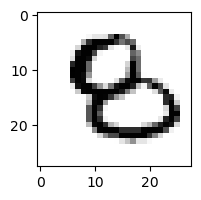

0.004137251119555202% - 0
3.10287778216619e-05% - 1
1.561135990434848% - 2 - ОШИБКА
2.776419052936225e-07% - 3
0.008496252312915195% - 4
0.019790907242237338% - 5
0.10336968267554764% - 6
5.279410432536381e-07% - 7
0.0001729658279638559% - 8
4.9209031022249285e-09% - 9

 8


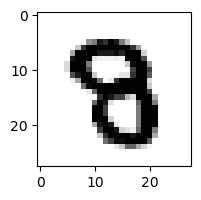

1.9527250466765167e-06% - 0
1.635638184533891e-08% - 1
1.1198531384373884e-07% - 2
0.0001009673203742485% - 3
4.239577222236758e-05% - 4
0.007334255888794904% - 5 - ОШИБКА
4.215367578775487e-06% - 6
2.0996620599327837e-06% - 7
2.821084464174213e-06% - 8
8.92634513377042e-09% - 9

 8


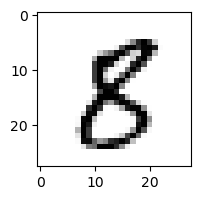

0.002398220314401365% - 0
0.002010190124082722% - 1
7.151772812366e-05% - 2
0.00011823556442554799% - 3
0.000654080263613848% - 4
13.999348410642067% - 5 - ОШИБКА
1.4112765946811409e-06% - 6
1.5431674163870547e-05% - 7
13.211325258119677% - 8
1.1037598515952072e-05% - 9

 3


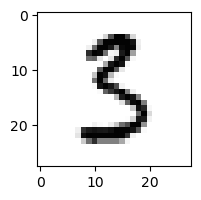

0.07712748221790926% - 0
0.0016722421542375724% - 1
0.03285713127119453% - 2
37.36405433644654% - 3
4.543669347457243e-05% - 4
60.180767144764566% - 5 - ОШИБКА
0.01916525905306439% - 6
0.0014296877940935834% - 7
0.004088409995343913% - 8
5.792087795890716e-09% - 9

 3


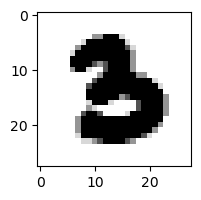

8.450536696675456e-08% - 0
7.370748897694391e-10% - 1
1.7276349241875274e-06% - 2
7.115936933460343e-05% - 3
5.416521161527727e-13% - 4
0.009972449361305057% - 5 - ОШИБКА
6.357975042447074e-05% - 6
2.0451971038350288e-09% - 7
3.570794330801723e-19% - 8
3.408645481701416e-23% - 9

 8


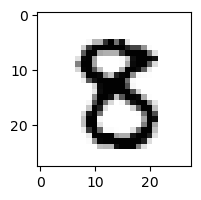

9.32821908624351e-05% - 0
6.616552933072941e-07% - 1
8.228636683446532e-08% - 2
0.00751371432965946% - 3
0.00011632065768900932% - 4
5.412027514094895% - 5 - ОШИБКА
7.415477922055583e-10% - 6
3.826352639240059e-06% - 7
1.4229013024929908% - 8
9.322063683315058e-10% - 9

 1


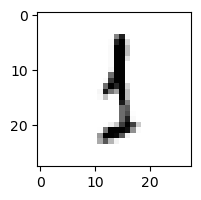

0.014161566116499021% - 0
83.9508789987716% - 1
0.7544471248034227% - 2
97.80100993313225% - 3 - ОШИБКА
0.005477668511425657% - 4
6.284976710090412% - 5
4.011435144767157% - 6
0.01838097828459981% - 7
9.705661394059339% - 8
0.9397339942921424% - 9

 9


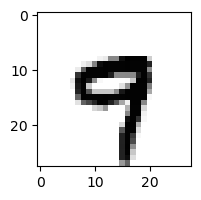

0.00020611401650929195% - 0
0.0012848525186383456% - 1
3.214545486313904e-10% - 2
3.88940099606799e-08% - 3
0.6096478153291088% - 4
0.012853025294383731% - 5
0.0001411316780867053% - 6
11.067865929805123% - 7 - ОШИБКА
8.256033887633461e-10% - 8
6.972437390098079% - 9

 2


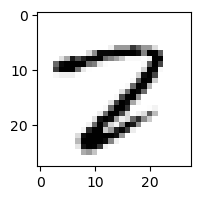

0.025793051459003208% - 0
2.7573693786819476e-05% - 1
0.14408640726107794% - 2
0.00014748689348235625% - 3
0.00011380103609449259% - 4
0.199507745298399% - 5
0.00010639978601758383% - 6
59.50603862931866% - 7 - ОШИБКА
1.0144590456976637% - 8
3.737070179462835e-07% - 9

 8


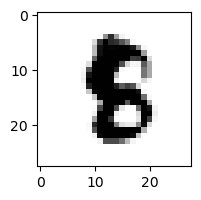

2.676277836780135e-07% - 0
2.7174290210973587e-05% - 1
4.982852795091768e-08% - 2
5.425176506686972e-08% - 3
4.736923211952073e-06% - 4
0.9253362555308443% - 5 - ОШИБКА
0.0006073937048716679% - 6
1.1312213370929902e-05% - 7
1.4002879338356284e-07% - 8
2.366928618869955e-08% - 9

 3


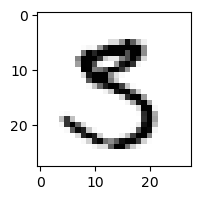

0.027556025264836914% - 0
1.9141906498221334e-05% - 1
1.812618855594653e-05% - 2
4.4790470769534485% - 3
1.1890530653501648e-05% - 4
94.34627345644097% - 5 - ОШИБКА
2.1102183435906097e-07% - 6
0.008939618684211328% - 7
0.0023632092665272202% - 8
1.587680675917818e-06% - 9

 2


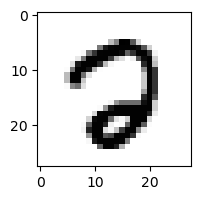

0.43291839614312666% - 0
8.917069710079585e-08% - 1
0.0006968056580698671% - 2
2.6765840726694184e-08% - 3
1.1046505967489587e-06% - 4
3.2559999011322427% - 5 - ОШИБКА
3.518668039410594e-05% - 6
0.5369709523928803% - 7
0.003772368971584085% - 8
6.273348914977654e-11% - 9

 3


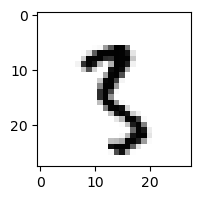

2.634828570532377e-05% - 0
0.38270926160557345% - 1
0.09722072052657572% - 2
0.05396506354336744% - 3
0.00020359997024096401% - 4
27.616978469568775% - 5 - ОШИБКА
0.0006943423425867537% - 6
0.031956405896806386% - 7
2.03606185146168% - 8
1.2382316725200884% - 9

 8


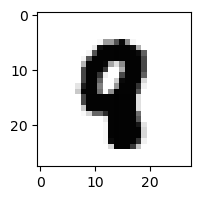

2.4986996954913333e-09% - 0
6.85590411737979e-06% - 1
2.5989310942337433e-08% - 2
3.1593817665936037e-15% - 3
0.007853052505877662% - 4 - ОШИБКА
0.00011845336082223148% - 5
2.829575679086853e-07% - 6
0.00016136576045481661% - 7
1.0326669310880503e-10% - 8
5.557781659477741e-06% - 9

 7


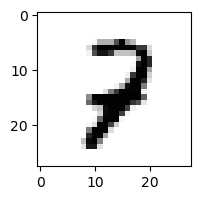

0.0004104882332770319% - 0
0.01992871212622968% - 1
35.633457898906734% - 2 - ОШИБКА
0.0013987662405573577% - 3
0.5642544793718037% - 4
0.002914859552682735% - 5
0.0014629815416203492% - 6
0.11677577747597853% - 7
0.032590954827009376% - 8
0.0019329396103712226% - 9

 1


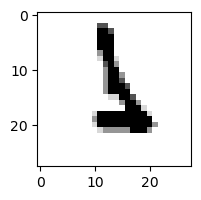

1.217809782399109e-07% - 0
1.0552145380712343% - 1
6.320214523041237% - 2
0.12291252598527042% - 3
2.35476262293177e-06% - 4
0.34560125429186894% - 5
54.55169306593901% - 6 - ОШИБКА
0.0009299741721302056% - 7
4.967355130680598e-08% - 8
1.1579481344264176e-07% - 9

 4


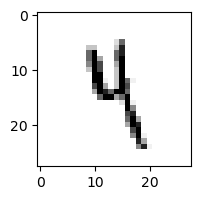

0.0007726275458686607% - 0
2.243144179357244% - 1
0.37542758718887465% - 2
6.718601329503144% - 3
34.88109389582961% - 4
39.35517302968204% - 5
4.256877270478022% - 6
0.11809914219662304% - 7
39.19596656103036% - 8
64.09559844110935% - 9 - ОШИБКА

 6


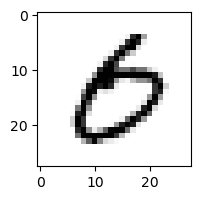

94.02468376307276% - 0 - ОШИБКА
0.00019863609511445898% - 1
7.0199818591917616e-06% - 2
0.3213889417900774% - 3
0.0005314889855843302% - 4
0.006908054084501373% - 5
10.391057397097677% - 6
0.0008347663147376068% - 7
1.9654479746271353e-05% - 8
9.594206031089613e-06% - 9

 3


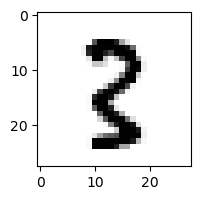

7.2482084776171995e-06% - 0
0.09775103247205785% - 1
0.1751743787657023% - 2
0.0007935639667300893% - 3
4.357685760221382e-05% - 4
0.03765112195828422% - 5
1.2292615331850511e-05% - 6
0.0003723324482603408% - 7
1.9422066034143406% - 8 - ОШИБКА
8.03631217244928e-06% - 9

 9


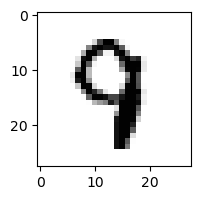

2.449129350340352e-05% - 0
8.643330986931324e-05% - 1
0.000807410493435994% - 2
0.0006242069052463467% - 3
1.826679013094511% - 4 - ОШИБКА
0.09996351956470381% - 5
0.00048078440216732787% - 6
0.7440332270934872% - 7
2.1479111496152223e-09% - 8
0.00015355498884023517% - 9

 8


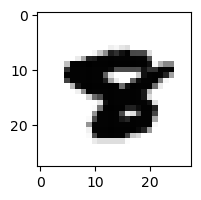

5.779493475053894e-09% - 0
2.8637386260944574e-09% - 1
3.310146292020824e-15% - 2
6.846300174720978e-17% - 3
1.6652361687488301e-06% - 4
0.00022251127569595898% - 5 - ОШИБКА
7.658814662780205e-06% - 6
0.00010843200529711265% - 7
9.405065060862171e-14% - 8
5.260125282951491e-10% - 9

 9


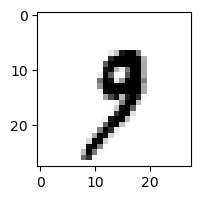

6.741399821193515e-05% - 0
0.21799249370470286% - 1
2.941250095499305e-06% - 2
0.9846171637718483% - 3
0.06349979336218886% - 4
0.023310566298047196% - 5
0.0007842876169136268% - 6
7.628886690292393% - 7 - ОШИБКА
3.245236797927019e-05% - 8
4.277441844681686% - 9

 7


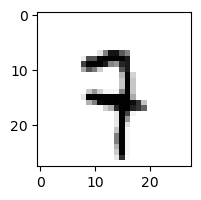

2.5195629269736337e-05% - 0
0.14704402706850056% - 1
7.857804425116402% - 2
0.0022317039202171705% - 3
12.351443009232508% - 4
0.7300814791683282% - 5
0.21230959415928413% - 6
27.397618156542713% - 7
0.003006159124183823% - 8
39.07000217361271% - 9 - ОШИБКА

 6


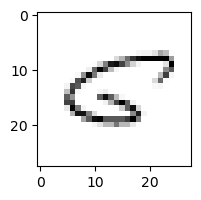

45.3635991180465% - 0 - ОШИБКА
0.18260455505916395% - 1
0.651139961646919% - 2
7.47723380761792e-05% - 3
2.200150599089479% - 4
24.16261214233941% - 5
0.8975234274380952% - 6
4.24380381967739% - 7
11.883903209177317% - 8
0.3422761280727254% - 9

 6


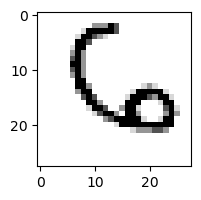

0.003941043723851008% - 0
1.0882055133446802e-05% - 1
92.40530250881723% - 2 - ОШИБКА
2.73226290504685e-06% - 3
3.189774757403447% - 4
0.05299934790580743% - 5
84.88165130752748% - 6
0.1162540357769424% - 7
9.406352767644498e-10% - 8
0.001078771972969534% - 9

 4


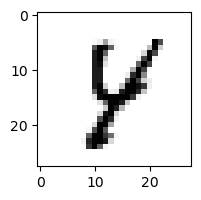

0.0014916818058693566% - 0
0.02663679442109751% - 1
0.0031668712097010034% - 2
8.299907053615403e-05% - 3
74.11688433400171% - 4
15.672609276776237% - 5
0.007816105882672284% - 6
0.7925027218074764% - 7
87.77606626955901% - 8 - ОШИБКА
0.003031768570956729% - 9

 8


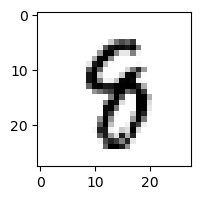

3.225394754557105e-06% - 0
0.008104100044849639% - 1
9.2080118194545e-06% - 2
9.331184860570742e-05% - 3
1.0696259215099768% - 4
2.531442119579662% - 5 - ОШИБКА
0.08719169466650772% - 6
0.003791579872350489% - 7
1.2163839607951392% - 8
0.000601290768208893% - 9

 3


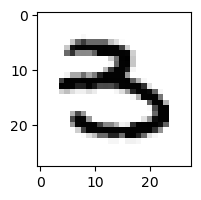

0.0070148850206089705% - 0
1.3334556860094384e-05% - 1
4.595021932912324e-08% - 2
18.349481033780805% - 3
5.2328978619419e-07% - 4
72.90062033873765% - 5 - ОШИБКА
0.0029094649329159407% - 6
6.303003737409915e-06% - 7
3.750024626122476e-15% - 8
1.8556227426965352e-09% - 9

 5


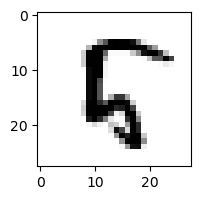

0.0010545120696966318% - 0
5.0348955156263666e-05% - 1
6.150079364536885% - 2
1.4715548003227653e-12% - 3
3.5401824471242516% - 4
10.21576869663562% - 5
0.05994865572890351% - 6
4.178130088741946e-05% - 7
36.731200831249815% - 8 - ОШИБКА
1.7161652551410202e-09% - 9

 8


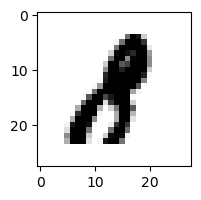

0.00045088293697493855% - 0
0.13218711354671966% - 1 - ОШИБКА
0.00034582875272932495% - 2
0.0017034569082077838% - 3
1.1609296208361014e-06% - 4
0.00013530269918256708% - 5
4.088592237261115e-07% - 6
6.57955032126129e-07% - 7
3.746513385915488e-06% - 8
3.530459881618061e-09% - 9

 7


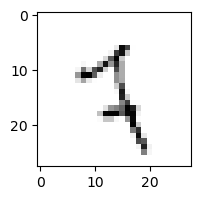

0.011199597653061777% - 0
18.57817664882691% - 1
11.891365507967008% - 2
0.0007809638637233064% - 3
1.3094153603897125% - 4
10.475915044546833% - 5
10.198744723529796% - 6
17.611520080848813% - 7
15.364375973660128% - 8
99.68514175470018% - 9 - ОШИБКА

 9


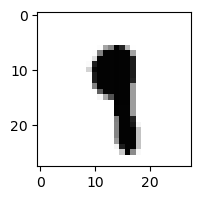

5.94530749327263e-09% - 0
6.83093387769123% - 1 - ОШИБКА
6.07304430764148e-09% - 2
7.217914385444313e-05% - 3
0.0005104905638665197% - 4
0.5352941958817535% - 5
3.826112506678849e-05% - 6
0.08910510273455362% - 7
3.158264535687911e-06% - 8
0.0582050054835892% - 9

 5


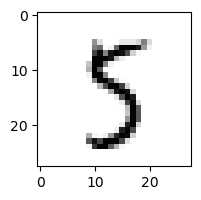

0.018191819623939495% - 0
0.0053405263377475825% - 1
0.0007669710031476027% - 2
1.4612908168485559% - 3
0.04349333436784429% - 4
91.55495490472678% - 5
0.15234674066062273% - 6
0.046878720990028426% - 7
99.2912450414434% - 8 - ОШИБКА
0.6950953466481958% - 9

 2


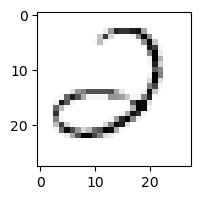

11.805890232782946% - 0
0.06502927626362548% - 1
9.155886114339577% - 2
59.375242559546095% - 3
13.996597598223918% - 4
0.6127225122857685% - 5
89.40755370819276% - 6 - ОШИБКА
0.6119166619776836% - 7
6.539995296369301e-05% - 8
0.0013108912443241273% - 9

 8


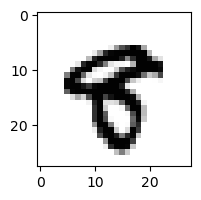

0.0004753826501249921% - 0
5.056478149041421e-06% - 1
3.2465855991578314e-13% - 2
1.7537909496378548e-08% - 3
7.663033142653409e-05% - 4
0.1608183533165584% - 5 - ОШИБКА
1.458370687228237e-07% - 6
0.00022344136279586445% - 7
5.77987360822353e-05% - 8
0.006780177659370991% - 9

 3


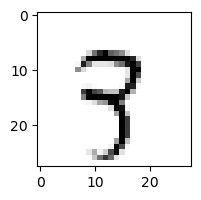

0.0015364175119551289% - 0
0.299191593294892% - 1
5.778549125456713% - 2
0.03494850603293864% - 3
1.0308865436714143% - 4
0.42637131227490443% - 5
0.0794787877027102% - 6
10.788096837229338% - 7
0.010451517534485477% - 8
14.143848636747016% - 9 - ОШИБКА

 8


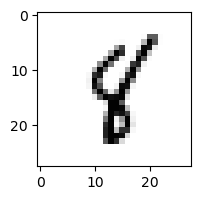

0.00010201551491311934% - 0
3.704478649625573% - 1
0.0016469769253362556% - 2
3.74562992381362e-05% - 3
38.07761017837721% - 4 - ОШИБКА
9.36400657685325% - 5
0.13880484705906956% - 6
0.42913971963023445% - 7
0.020148901858080725% - 8
0.05604978331435064% - 9

 3


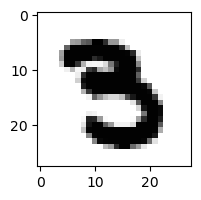

2.593701362463126e-07% - 0
3.0039542075502803e-09% - 1
1.1155433686696069e-11% - 2
0.16171123120891764% - 3
3.6030675995735873e-08% - 4
1.7134385755606192% - 5 - ОШИБКА
8.359613793273516e-09% - 6
7.6145059962572836e-06% - 7
4.663939828307362e-16% - 8
2.854818466715675e-16% - 9

 7


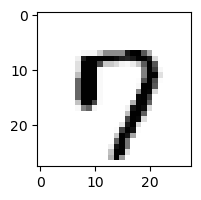

59.63927796335011% - 0
1.0391847543474348e-07% - 1
1.4541803232612422e-06% - 2
7.987706123779575e-06% - 3
1.139299985486939% - 4
1.2332367543148255% - 5
0.019487978664574957% - 6
49.856284329099694% - 7
7.533315466153077e-07% - 8
97.92623160897182% - 9 - ОШИБКА

 8


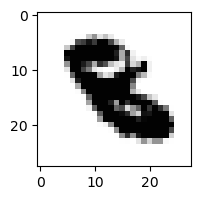

3.323009457652316e-14% - 0
5.118000790900416e-09% - 1
0.0001618573040259222% - 2
1.5315379327409996e-09% - 3
3.1170841482067825e-05% - 4
0.0029190473679201155% - 5 - ОШИБКА
1.369756195952448e-06% - 6
1.721025900703589e-08% - 7
1.2255257209752946e-18% - 8
7.200258067417145e-13% - 9

 9


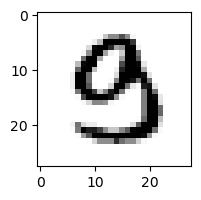

0.05157404408156381% - 0
3.120976667767749e-05% - 1
0.00013062472052926912% - 2
0.8680759487844265% - 3
0.00010527849011279806% - 4
1.5368577923865254% - 5 - ОШИБКА
1.5117693358476544e-06% - 6
1.0204077473156516e-05% - 7
2.1285002184503324e-10% - 8
6.905424236275951e-10% - 9

 4


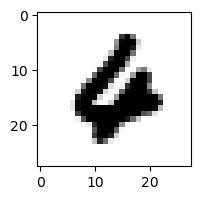

0.026016271228647976% - 0
2.424576277899265e-07% - 1
1.1007206643406311e-05% - 2
2.0968510564457695e-12% - 3
0.06553416428663995% - 4
1.770908297412253e-05% - 5
87.6101589975147% - 6 - ОШИБКА
0.00034601394171283396% - 7
1.8722160225626957e-13% - 8
1.4074751256690147e-08% - 9

 3


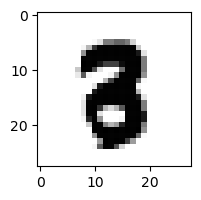

3.791813239204327e-07% - 0
1.1329086619855726e-06% - 1
4.8764173091239485e-05% - 2
8.638133082972196e-07% - 3
3.5275866651294094e-07% - 4
0.0015431958752383608% - 5 - ОШИБКА
2.4419813675788844e-07% - 6
5.106714041547974e-06% - 7
1.916686833781497e-06% - 8
1.842245729778402e-11% - 9

 5


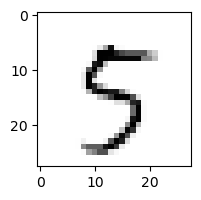

0.05496448873669272% - 0
0.0015725550179237413% - 1
0.0017293081605431508% - 2
0.9964408910040637% - 3
0.18081453810897408% - 4
85.00767853289491% - 5
0.026274620854307196% - 6
3.3455610914604113% - 7
0.5886090050777958% - 8
86.4648935186116% - 9 - ОШИБКА

 7


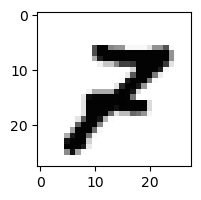

0.0035205074040485624% - 0
9.966501969043663e-05% - 1
0.5604018949582416% - 2 - ОШИБКА
1.1659551717355685e-05% - 3
9.354350288547202e-05% - 4
0.00023587177109643835% - 5
5.5694297580833065e-08% - 6
0.29391056631783297% - 7
0.009749542860730211% - 8
0.0002431196663683574% - 9

 3


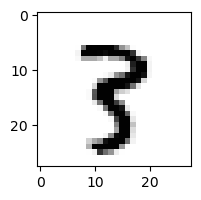

9.058779030414744e-07% - 0
0.015857075696243426% - 1
3.599913289300621e-05% - 2
0.3201579455461038% - 3
0.0207115483762545% - 4
0.1222236472063514% - 5
5.0325024175764875e-06% - 6
0.00950664220981146% - 7
2.2033878556835926% - 8 - ОШИБКА
0.023218609224828272% - 9

 3


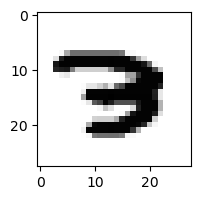

1.0085116062000443e-05% - 0
4.5734242255708874e-07% - 1
0.000313215073374233% - 2
0.0012558803320557206% - 3
2.0178270649881896e-05% - 4
1.0685421571782352e-06% - 5
0.016898850898842712% - 6
1.874503278755479% - 7 - ОШИБКА
2.902854471431077e-14% - 8
2.0246513331739248e-11% - 9

 5


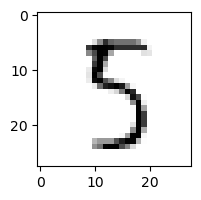

0.04797504054085757% - 0
0.003973933909785284% - 1
0.07606782493322939% - 2
12.977249246958625% - 3
0.8278319305432106% - 4
91.73205618695087% - 5
0.04145767959461414% - 6
0.035363920781253985% - 7
98.571573393174% - 8 - ОШИБКА
0.001108959869136088% - 9

 4


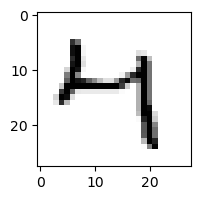

0.49296157733903934% - 0
0.0033603146707679313% - 1
1.0444883878768121e-06% - 2
51.47270471801677% - 3
92.97412766716974% - 4
1.1957504555292375% - 5
0.03797589922848629% - 6
0.18419628648940803% - 7
0.0018216099673780987% - 8
98.28986900201451% - 9 - ОШИБКА

 8


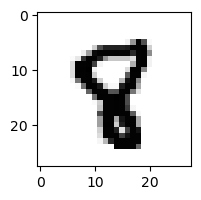

1.7606876715418966e-08% - 0
0.00010606586541328785% - 1
7.735248205793234e-07% - 2
1.4479270148671775e-10% - 3
0.045958033148858234% - 4
0.48542252123908675% - 5 - ОШИБКА
4.264195463166979e-05% - 6
0.0007813964431047227% - 7
0.0031687377731071274% - 8
1.4424285301651425e-06% - 9

 6


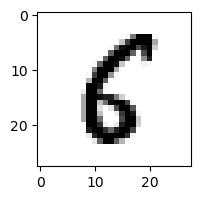

13.397724910856079% - 0
0.0002569681848130094% - 1
0.005173988151272084% - 2
7.793104046364372e-09% - 3
0.0047913717976274806% - 4
42.77340737058536% - 5 - ОШИБКА
16.075864193018464% - 6
1.4972096100272139e-05% - 7
0.026759077295722196% - 8
1.6883320294420083e-06% - 9

 3


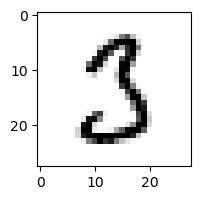

3.4169191763118625% - 0
0.008601491210018382% - 1
10.826304550972061% - 2 - ОШИБКА
3.0785417694854273% - 3
2.2281309826592366e-05% - 4
10.547503390217711% - 5
0.00134457771262117% - 6
0.10418414726700287% - 7
0.01105358314527117% - 8
1.0419304159946677e-08% - 9

 6


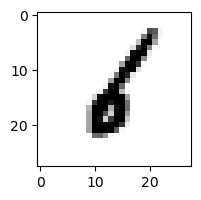

0.00014133619770036985% - 0
89.7138101848474% - 1 - ОШИБКА
1.163881878355507% - 2
5.503302868388574e-06% - 3
0.07755197725486962% - 4
0.02208314952695533% - 5
9.902082738530538% - 6
0.002033792578436836% - 7
0.0004947880369236637% - 8
1.1440735504161511e-05% - 9

 0


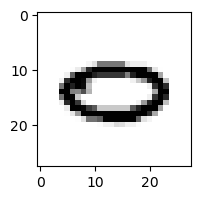

58.09177908987301% - 0
0.002563196179801898% - 1
2.0471641465316773e-08% - 2
5.280671996779469e-12% - 3
0.13810587234495197% - 4
7.707097216093686e-08% - 5
88.30461122369466% - 6 - ОШИБКА
9.195412128410831% - 7
1.2748663170033385e-07% - 8
0.01039330638182263% - 9

 9


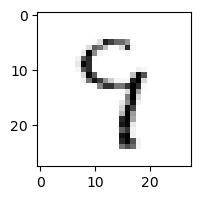

0.07225623605994956% - 0
0.059491380898429584% - 1
0.18413017958260133% - 2
1.9355278738756465% - 3
76.32893607102524% - 4
12.00451603363049% - 5
7.134331370102644% - 6
1.2205524990785233% - 7
97.81939526694433% - 8 - ОШИБКА
0.45462151413381807% - 9

 8


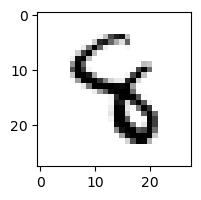

2.980765918667152e-08% - 0
0.002913293192887785% - 1
0.0007900054018768473% - 2
0.0020294379636286507% - 3
60.374365424562114% - 4 - ОШИБКА
0.3789553149180182% - 5
0.1859954872767582% - 6
0.0003072785358610112% - 7
8.460270130349933e-06% - 8
1.4776308207852046e-07% - 9

 8


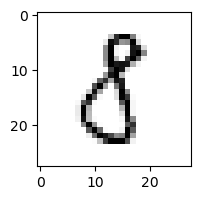

10.890057116646984% - 0 - ОШИБКА
1.054013823933508% - 1
0.06930837741233896% - 2
2.75921935069176% - 3
0.008189021339362609% - 4
4.849066863796452% - 5
0.006380883624293693% - 6
0.006522312655747128% - 7
0.0030799496389315715% - 8
2.7982263465138833e-06% - 9

 8


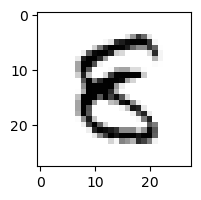

0.042258187123960046% - 0
9.183983593773361e-05% - 1
0.0010026690022173577% - 2
0.001081203201791844% - 3
1.8256371940181852% - 4
61.98501152593734% - 5 - ОШИБКА
0.07122033523661796% - 6
5.0895484906679924e-08% - 7
0.0002698214942935488% - 8
7.121613786201417e-10% - 9

 3


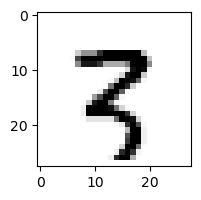

1.5049701224973214e-06% - 0
0.2173495594199744% - 1
1.478752219896935% - 2
2.195223146260593e-07% - 3
7.693684640339363e-05% - 4
0.000276003947674926% - 5
6.612107252063506e-05% - 6
0.5638134362369166% - 7
27.1148930089256% - 8 - ОШИБКА
20.64540312934089% - 9

 7


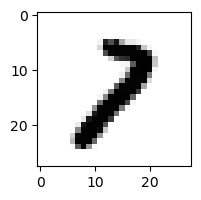

0.010553716542978049% - 0
0.5961685110842256% - 1
8.882699008704375% - 2 - ОШИБКА
0.005732068436278633% - 3
9.407181695193786e-06% - 4
0.00011774384710148812% - 5
7.970613318809371e-06% - 6
0.1086881295394969% - 7
0.896327321384182% - 8
0.03191243868410215% - 9

 3


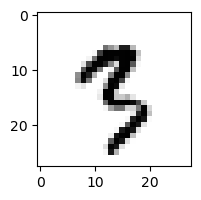

4.812856652878427e-05% - 0
0.3372113047193732% - 1
1.53377364841508e-05% - 2
0.017306271367235223% - 3
5.255935816541715e-05% - 4
16.13071174484804% - 5 - ОШИБКА
8.137146336182881e-05% - 6
0.0893115814685243% - 7
0.0003123001781067975% - 8
1.0335090061420285% - 9

 7


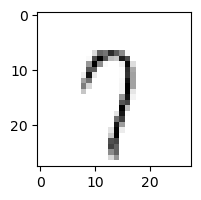

0.6361751290143289% - 0
1.1056676735163276% - 1
3.143988189367033% - 2
1.9022237824636554% - 3
20.943184179143575% - 4
15.915286643925084% - 5
6.700540617436925% - 6
91.50397635608563% - 7
62.17554896513828% - 8
98.78988780582702% - 9 - ОШИБКА

 9


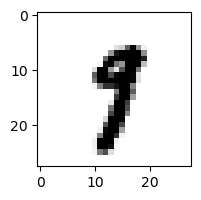

6.246621635983647e-06% - 0
1.5230558467027522% - 1
6.8178963101135e-09% - 2
0.0010192623385813365% - 3
0.0031696414936267787% - 4
0.44219136539283366% - 5
1.2950374464396719e-05% - 6
7.15087440651624% - 7 - ОШИБКА
6.772029369749856e-06% - 8
0.030486820739745426% - 9

 8


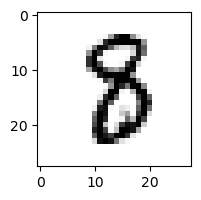

8.01274957801422e-05% - 0
0.04530364294267174% - 1
0.0001242002332426166% - 2
0.0013857279766155367% - 3
1.657763939276548e-05% - 4
1.9576029178340104% - 5 - ОШИБКА
0.0045223126617880876% - 6
0.0005955473965252964% - 7
0.0018658022705265508% - 8
7.586681405763351e-14% - 9

 7


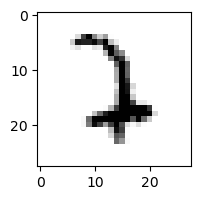

7.82271848064488e-06% - 0
2.0305101191800077% - 1
81.92845766725706% - 2 - ОШИБКА
0.16561667464207525% - 3
0.000569528783193371% - 4
0.007619741278254481% - 5
7.7598700547681965% - 6
0.700048754172879% - 7
1.3078206632015523e-09% - 8
2.976783046600101e-06% - 9

 9


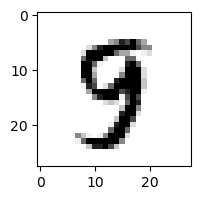

2.3602849395868706e-05% - 0
2.629342739120888e-05% - 1
1.6289446445706846e-06% - 2
0.011239230965396797% - 3
0.0426136930703906% - 4
0.7493728929863114% - 5 - ОШИБКА
1.6625772504452243e-05% - 6
0.0024522251027680937% - 7
0.0018795710726664085% - 8
3.3258838798112376e-06% - 9

 9


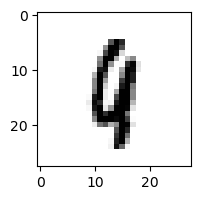

3.6393814654205255e-05% - 0
0.5779807236071005% - 1
0.019771362969627553% - 2
1.8033844601917118e-08% - 3
2.225883868924501% - 4 - ОШИБКА
0.03792951171025488% - 5
1.2261735056727614% - 6
0.24331632582666407% - 7
0.003410320213773002% - 8
0.0025091762767704504% - 9

 8


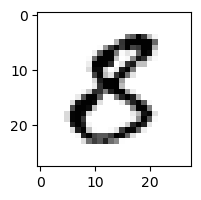

0.912010458603788% - 0
0.0001089747431791914% - 1
0.015180879681257281% - 2
0.001313428363470944% - 3
0.0006277952273816438% - 4
28.44447144474744% - 5 - ОШИБКА
1.781553390914539e-05% - 6
1.6793778511712366e-07% - 7
4.17550726797377e-08% - 8
5.0947251389268197e-11% - 9

 4


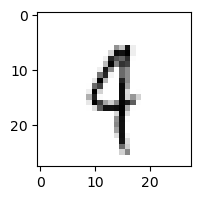

0.008321019705729519% - 0
3.5269484257078756% - 1
0.29346492474166935% - 2
0.01358027688676775% - 3
56.71124057595248% - 4
1.5031801456634393% - 5
7.381612875409016% - 6
15.616067013944946% - 7
0.12145859236874898% - 8
99.82104853459974% - 9 - ОШИБКА

 9


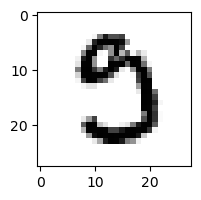

25.67664820825189% - 0 - ОШИБКА
7.181367992611111e-07% - 1
1.178456417155206e-05% - 2
0.15893761110612872% - 3
1.5552155441600396e-07% - 4
18.33696226473113% - 5
1.3460799453401096e-05% - 6
0.14836973750186505% - 7
1.3017711634891744e-05% - 8
3.468658596641753e-11% - 9

 8


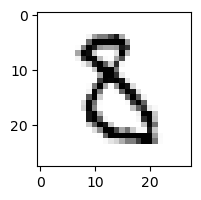

0.03248842740615369% - 0
0.00014318526650611808% - 1
0.6731428747705989% - 2
0.030220596171979343% - 3
0.0011977716625642758% - 4
12.856627110123704% - 5 - ОШИБКА
1.4820494895256027% - 6
0.00017670849115567416% - 7
0.00010095356072505457% - 8
3.47825213075667e-09% - 9

 2


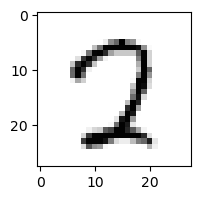

19.59499655204482% - 0
1.529169987193547e-05% - 1
0.33227866780825677% - 2
2.162801579297939% - 3
0.013869886337610835% - 4
20.105066789560397% - 5
0.0001814679621327064% - 6
2.748378321291294% - 7
32.58488091139684% - 8 - ОШИБКА
3.14187292390873e-05% - 9

 5


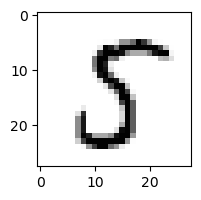

0.032617179338410275% - 0
0.026896805214655713% - 1
0.0006040022352017507% - 2
0.05281305304144956% - 3
0.0005427239174395087% - 4
98.88596367539732% - 5
0.00013652415987109925% - 6
0.0018441254056579717% - 7
99.59270625022964% - 8 - ОШИБКА
3.756540429971477e-07% - 9

 8


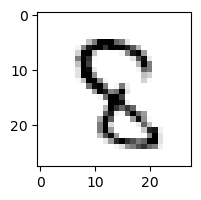

0.00010043724238668601% - 0
0.00023143783518495432% - 1
0.09115237858596065% - 2
0.0006704403439946221% - 3
2.4455362261916536% - 4
23.985472183391394% - 5 - ОШИБКА
0.00046008498376438564% - 6
0.004257874959208208% - 7
13.401841776336884% - 8
0.00012568880689446365% - 9

 7


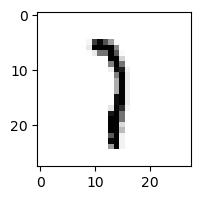

0.0010957354245461225% - 0
75.1460320674157% - 1 - ОШИБКА
22.643042519208503% - 2
3.4415271830702294% - 3
0.24667425246379537% - 4
1.4295290351296566% - 5
0.8919840951957451% - 6
22.48779280815075% - 7
0.004893056252493169% - 8
0.15336620529263928% - 9

 8


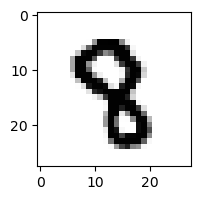

3.2722519667545437e-09% - 0
3.579848122264266e-05% - 1
6.38619684832309e-06% - 2
7.94808128787253e-06% - 3
0.13891609584923617% - 4 - ОШИБКА
0.036372169517260175% - 5
1.2949416234268855e-06% - 6
0.002247449775005566% - 7
1.3133744255766063e-07% - 8
4.484541862466741e-08% - 9

 4


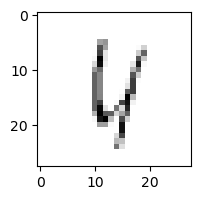

3.595433192465907% - 0
0.5051828507099125% - 1
43.532647910633166% - 2
0.0006392021934349963% - 3
64.73615962869724% - 4
5.143550214742287% - 5
57.3497087725922% - 6
10.228291944047466% - 7
85.30231502365336% - 8 - ОШИБКА
18.117081875377636% - 9

 4


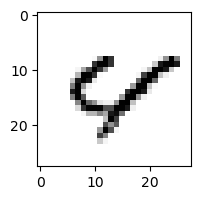

0.49380783753347435% - 0
0.00201650861702844% - 1
0.0015370970294115338% - 2
1.1200786976134836e-13% - 3
95.19560468356083% - 4
0.048830098206022056% - 5
16.970857145011855% - 6
6.824598861772426% - 7
77.54412493400415% - 8
97.56953978069917% - 9 - ОШИБКА

 9


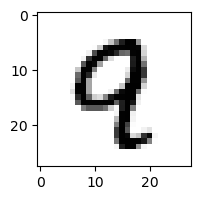

0.0005213107891689993% - 0
0.0001487697681528718% - 1
0.001857761709289494% - 2
3.612962337143255e-08% - 3
6.920207205581988% - 4 - ОШИБКА
0.0026816103329280216% - 5
9.387605234694017e-05% - 6
0.005127002456272611% - 7
0.0012674542629754182% - 8
0.23792398543906254% - 9

 7


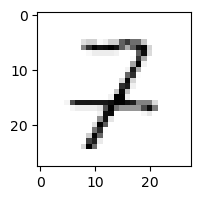

0.0638487318415448% - 0
0.9551131620551103% - 1
93.86826286878747% - 2 - ОШИБКА
2.464790237694079% - 3
40.2925636564278% - 4
0.058892391467014506% - 5
0.3510893048622845% - 6
1.3416941355772187% - 7
0.19355778543857935% - 8
0.000865807589848814% - 9

 8


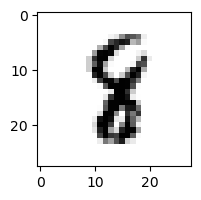

1.1159348834391938e-07% - 0
0.720822929875233% - 1 - ОШИБКА
0.0002202064517764908% - 2
6.100699379275263e-06% - 3
0.027465554136937284% - 4
0.5738878508425231% - 5
0.00888558075502554% - 6
0.004887368082492906% - 7
0.39019528534204273% - 8
1.9614030579653092e-09% - 9

 8


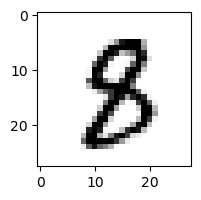

3.0619573455902e-05% - 0
0.0019359672712263548% - 1
1.4489347084242796e-06% - 2
0.0007396367022211829% - 3
0.0025741102762673624% - 4
2.2860192865975373% - 5 - ОШИБКА
4.1167547538510985e-05% - 6
0.0001678996501243281% - 7
0.00632892658705446% - 8
1.5245349754009996e-08% - 9

 3


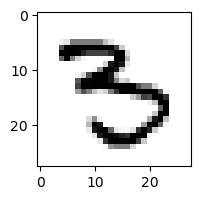

0.006369047705672787% - 0
2.7516840546537726e-05% - 1
4.144201020370111e-09% - 2
5.725206380687677% - 3
0.006492343932569773% - 4
17.79838293968943% - 5 - ОШИБКА
0.009170493386898092% - 6
0.0008313804299080285% - 7
1.8175386458247122e-07% - 8
9.108843823144054e-07% - 9

 5


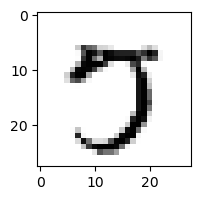

2.091426209756672% - 0
1.9733742350114937e-06% - 1
5.648379557023788e-05% - 2
0.10607597792509149% - 3
0.00012804479835459403% - 4
57.982079455749435% - 5
3.7969378204005394e-06% - 6
95.22081896849203% - 7 - ОШИБКА
0.010219086350508593% - 8
0.008216944576560482% - 9

 9


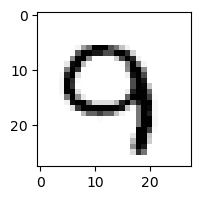

0.026152109239273844% - 0
6.1219127355750235e-06% - 1
0.5235433597558314% - 2
3.287891392675029e-06% - 3
3.760618082204345% - 4 - ОШИБКА
6.806010106155564e-06% - 5
0.0040404102091592805% - 6
2.1860301126083366% - 7
1.0159569858224053e-07% - 8
0.2012865994397301% - 9

 3


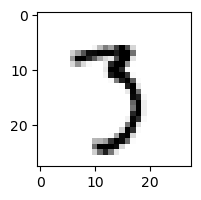

0.040381235862567644% - 0
0.022119086766885357% - 1
0.004688943685199767% - 2
91.92279691783742% - 3
9.654109402499787e-05% - 4
6.4822093119387745% - 5
0.001373344427136372% - 6
97.30811540945304% - 7 - ОШИБКА
0.0006526336076189706% - 8
0.087433742801645% - 9

 8


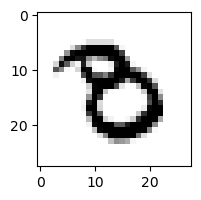

0.05786523992879163% - 0
4.939945634547694e-06% - 1
5.771713966028011e-06% - 2
0.037769443526159956% - 3
1.439393306376203e-06% - 4
0.03691760230963478% - 5
2.092582271934877% - 6 - ОШИБКА
0.0001331189096275198% - 7
2.778962660286471e-09% - 8
1.4322722994073287e-10% - 9

 8


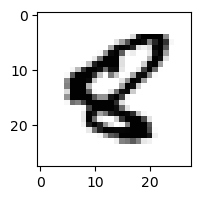

0.00010454297580253398% - 0
0.0010351356254170178% - 1
1.6841469052801498e-07% - 2
1.461802051226851e-17% - 3
0.009749077095792322% - 4
0.14919128275805948% - 5
0.17143711868016806% - 6 - ОШИБКА
6.735551064620028e-07% - 7
1.0710855265410176e-05% - 8
5.0132289932525695e-08% - 9

 7


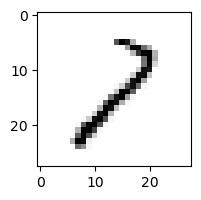

2.035953564005456% - 0
34.67455778875335% - 1
95.37754028696264% - 2
3.6383885596352297% - 3
0.696498770029713% - 4
0.18015168209994256% - 5
1.330773427792532% - 6
3.6900482009219635% - 7
99.95105926906842% - 8 - ОШИБКА
0.03155236068921508% - 9

 7


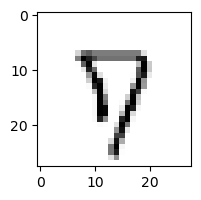

0.6170028960277992% - 0
2.4972747357307087e-05% - 1
0.06618684621690599% - 2
0.00037199403937785% - 3
5.71841245700143% - 4
2.8583380606222955% - 5
0.5814180701961161% - 6
26.26835495529346% - 7
82.21067397236446% - 8 - ОШИБКА
74.64247120227185% - 9

 2


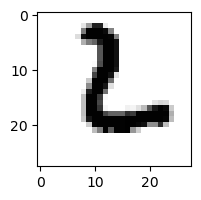

0.11240496456934013% - 0
6.386379775481242e-06% - 1
85.99372225217235% - 2
1.5565405911702964e-06% - 3
2.2767252592698698e-08% - 4
5.499768060352523% - 5
99.49459085618543% - 6 - ОШИБКА
5.626945242678246e-07% - 7
1.5248179241942874e-08% - 8
6.161800951140343e-08% - 9

 2


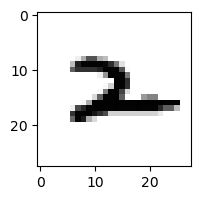

3.7249574598384634e-06% - 0
0.6743294972633161% - 1
0.6942245524529876% - 2
1.8833221128300717e-07% - 3
4.685484645630335% - 4 - ОШИБКА
0.04156215385382448% - 5
4.323282039713875% - 6
0.23880275383026278% - 7
0.4008402735191316% - 8
0.00014905229751931655% - 9

 7


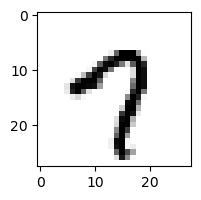

4.110805788305065% - 0
9.302092326235384e-05% - 1
1.2835542295145146e-08% - 2
1.8712603346034256e-05% - 3
0.8285988354816113% - 4
3.127916511657478% - 5
0.008586438778827676% - 6
80.87632004014654% - 7
3.275830291703108e-06% - 8
99.90597573791334% - 9 - ОШИБКА

 2


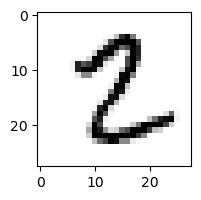

0.002757086794912007% - 0
0.06934321664282914% - 1
31.819190843838598% - 2
0.0002285925733186709% - 3
3.4055036622503882e-06% - 4
17.039616216295066% - 5
2.1539845502443112e-05% - 6
0.00022863565534587062% - 7
59.58743134493858% - 8 - ОШИБКА
1.6272889237654036e-08% - 9

 5


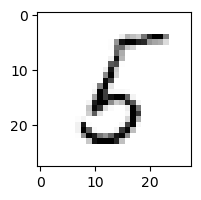

1.146189082694399% - 0
1.551776826287214% - 1
3.569380068696902% - 2
0.5234857486038538% - 3
0.5193196577180503% - 4
41.87629816904003% - 5
57.436245935848326% - 6
0.00021615159857168027% - 7
99.83631885682168% - 8 - ОШИБКА
0.0005417044294486925% - 9

 3


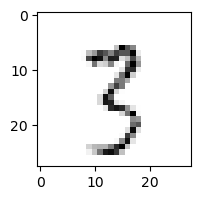

0.0034410674538085974% - 0
2.1494301289649282% - 1
4.305798460576619% - 2
30.145322851626723% - 3
0.023705415040438906% - 4
6.797111908824033% - 5
0.0025176265498430325% - 6
20.243638240665337% - 7
3.5572884058213594% - 8
91.75006399356137% - 9 - ОШИБКА

 5


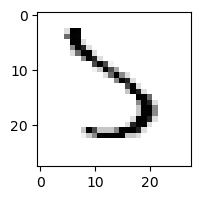

0.14492317350266784% - 0
0.08256543911021069% - 1
6.099543512148594% - 2
99.03621200150619% - 3 - ОШИБКА
0.9822510167508033% - 4
40.6693534505829% - 5
34.15898118192657% - 6
27.821509148723816% - 7
0.020054567300472663% - 8
4.483701883669923e-06% - 9

 8


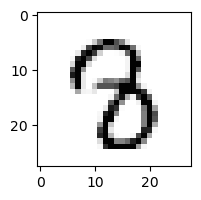

1.3786272231321026e-05% - 0
0.0008071338102325626% - 1
5.065825567978835e-05% - 2
0.012380352288413367% - 3
0.23787565871939445% - 4
1.0102278966140146% - 5 - ОШИБКА
0.00014434868863491608% - 6
0.06667444346590842% - 7
0.00017159916566119644% - 8
8.410582671226377e-08% - 9

 2


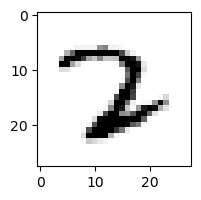

0.0002549209160707287% - 0
0.012121825177567117% - 1
27.30828186887546% - 2
0.12582480079046934% - 3
0.0004767034244507199% - 4
0.006484550703675639% - 5
0.2255135883900506% - 6
60.38210709087123% - 7 - ОШИБКА
1.795484898873753e-08% - 8
7.324722688576109e-10% - 9

 1


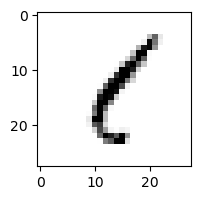

0.6984677259649126% - 0
95.99743516862092% - 1
0.03098869942823665% - 2
4.93482191392614% - 3
0.5022898316609362% - 4
5.412607194502147% - 5
0.07673794240118698% - 6
0.011695963036204276% - 7
96.93480057065065% - 8 - ОШИБКА
0.054994626122565615% - 9

 5


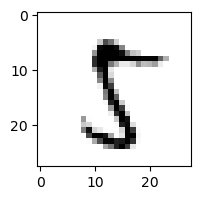

0.04243166886253812% - 0
0.048936769619427126% - 1
0.019850602781913872% - 2
0.00790253770181441% - 3
0.0005218740715243633% - 4
95.1400874138797% - 5
2.1339572117755947e-06% - 6
0.14902282366155228% - 7
99.8910045927811% - 8 - ОШИБКА
0.004983745891462181% - 9

 2


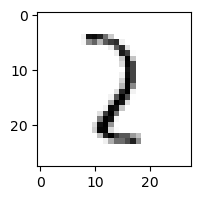

0.014787119756425982% - 0
65.83346582990384% - 1 - ОШИБКА
60.616866355209595% - 2
1.0917592931272162% - 3
2.7992851860447736% - 4
0.10270609350879077% - 5
0.5690739131491758% - 6
11.478092433050492% - 7
1.6649092608910205% - 8
0.01933811447868858% - 9

 2


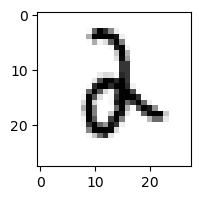

0.0006435134960842578% - 0
0.07766850159126626% - 1
0.8330090535524658% - 2
0.10180493159277042% - 3
0.1362499251207162% - 4
0.032247999653373216% - 5
23.982423617303596% - 6 - ОШИБКА
0.00012830825749147586% - 7
6.6280824266501774e-09% - 8
6.732451358306534e-05% - 9

 8


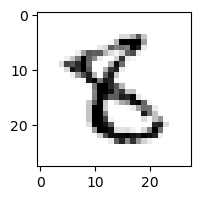

0.01353901565724947% - 0
0.00044100303633887536% - 1
0.007977575524878945% - 2
9.625359345948671e-06% - 3
0.0026519068012954552% - 4
61.51485855580291% - 5 - ОШИБКА
10.20480322653199% - 6
7.409552228070011e-06% - 7
14.62461374141257% - 8
6.023129616663992e-08% - 9

 9


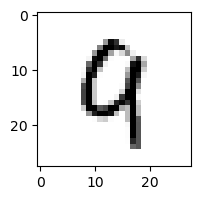

0.013061256143918686% - 0
0.00829777763239356% - 1
2.1249130765607296% - 2
7.978644082357465e-08% - 3
35.42501554459286% - 4 - ОШИБКА
0.002532811887774844% - 5
0.0938209114488042% - 6
0.7449536243487497% - 7
0.0352838643179374% - 8
5.177033129351043% - 9

 8


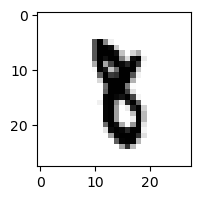

1.678430909202169e-09% - 0
23.43535741094608% - 1 - ОШИБКА
1.6985600884862532e-05% - 2
0.005971401209701936% - 3
0.00029133537749125005% - 4
0.1670489897623885% - 5
2.5323449588792442e-05% - 6
0.1054131511371632% - 7
1.2345922345916042e-08% - 8
1.5473119313035096e-07% - 9

 9


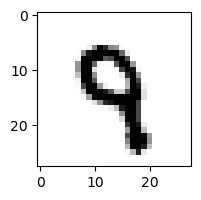

1.2858158276666433e-06% - 0
9.635898632785652e-05% - 1
0.00106667540029139% - 2
0.00012979013473956045% - 3
9.59039108626034% - 4 - ОШИБКА
0.53433913761022% - 5
0.0024639026805875633% - 6
0.10565478424557155% - 7
1.3837642106223748e-07% - 8
1.52019802732155% - 9

 4


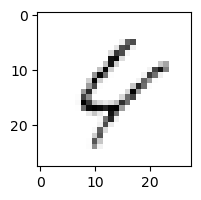

31.326856893179578% - 0
0.19066843482135032% - 1
10.895101838105045% - 2
4.983729086978132e-06% - 3
76.09184878696018% - 4
0.11043855461688747% - 5
37.21132217922204% - 6
2.8717955279204856% - 7
93.3344589503044% - 8
99.7844869414441% - 9 - ОШИБКА

 8


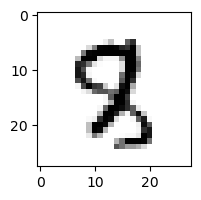

5.622771117885616e-06% - 0
0.002564431752588499% - 1
0.014155639135030705% - 2
3.719722216868384e-05% - 3
0.028518433485674018% - 4
0.3517608158811068% - 5 - ОШИБКА
8.862922976020467e-05% - 6
0.12488264735187096% - 7
7.792733090825516e-06% - 8
0.00013882083021792008% - 9

 6


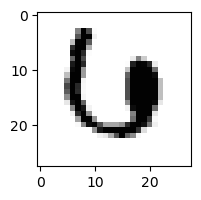

5.5854292201712425% - 0 - ОШИБКА
2.0189473224896284e-07% - 1
0.0004313936098272551% - 2
0.043958625639200166% - 3
1.714108073046243% - 4
2.991034621830978e-06% - 5
2.9445512922884016% - 6
3.5458020302981916% - 7
9.69368321105029e-11% - 8
2.5972079425994915e-09% - 9

 4


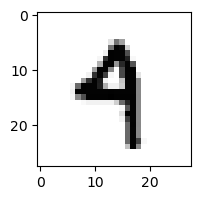

0.0003415578716783459% - 0
0.02459100110420702% - 1
5.630464193149873e-06% - 2
0.00779633330599987% - 3
48.78727956636891% - 4
0.5579684751094836% - 5
0.03738816389637968% - 6
0.020336130354704714% - 7
1.627390675778135e-08% - 8
89.96586822546037% - 9 - ОШИБКА

 3


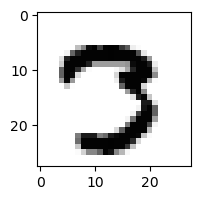

0.0006583011129775683% - 0
7.194125669224712e-08% - 1
1.849360606298879e-07% - 2
77.36296579776058% - 3
6.778096398168374e-09% - 4
0.006910261037920247% - 5
1.9030764455647406e-11% - 6
93.95518375897551% - 7 - ОШИБКА
1.909437443403788e-06% - 8
1.5076644352159575e-08% - 9

 8


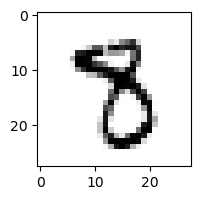

1.884146438361112e-06% - 0
0.015897741176183526% - 1
4.202209687411041e-06% - 2
0.0035789683262443125% - 3
0.000767670913794805% - 4
14.16337419595681% - 5 - ОШИБКА
3.6964473607556315e-06% - 6
1.2665344240951046% - 7
0.01658893755683558% - 8
2.4308286756056455e-09% - 9

 5


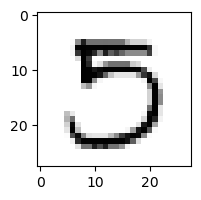

18.74191670112727% - 0 - ОШИБКА
9.954602671539342e-06% - 1
0.00013889186320856665% - 2
15.15421240630076% - 3
5.0510235903165775e-06% - 4
1.3600277816495758% - 5
2.897297720206902e-07% - 6
0.9555389386159562% - 7
0.004201826232917743% - 8
8.887184659131252e-09% - 9

 3


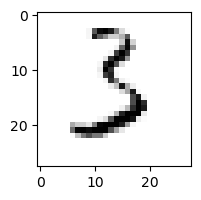

0.6236052829478869% - 0
0.03277065159815587% - 1
45.49112442166244% - 2
18.79382647042319% - 3
2.6964000729462607e-05% - 4
25.286476189890507% - 5
51.06413503355447% - 6 - ОШИБКА
1.6362090084891558% - 7
1.238454652483746e-05% - 8
0.002911413275385934% - 9

 7


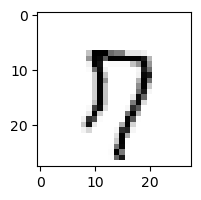

43.73420256713255% - 0
7.482730275937525e-05% - 1
0.6710222535223433% - 2
0.011087182865383554% - 3
0.08577562596744395% - 4
8.986346284267075% - 5
0.9565176330184327% - 6
28.192713010276933% - 7
96.58044221992097% - 8
98.60672926392103% - 9 - ОШИБКА

 8


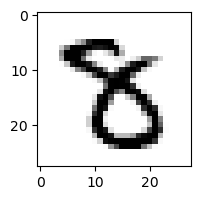

6.430993642375094e-07% - 0
6.904636884640339e-05% - 1
5.853695820899989e-05% - 2
0.07025513331044653% - 3
0.0001063226105648827% - 4
0.45351879060235856% - 5 - ОШИБКА
4.801597663428558e-08% - 6
0.00016511829318069406% - 7
0.1531460667100144% - 8
3.789378744543095e-11% - 9

 7


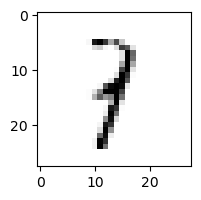

0.0029723207867591406% - 0
88.50327542959633% - 1 - ОШИБКА
3.3741828795247364% - 2
38.313584836995545% - 3
2.461914507551984% - 4
2.3299291204281514% - 5
0.3164863018475969% - 6
0.04483120842260811% - 7
1.161724358933982% - 8
1.286759776829091% - 9

 8


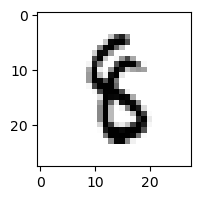

1.0038294475014674e-05% - 0
0.23495979720311025% - 1
0.00021554847130315886% - 2
0.00449975195549191% - 3
0.002566283067760547% - 4
2.749685024749466% - 5 - ОШИБКА
0.05461598196303741% - 6
0.00015729626532549632% - 7
0.0009062073774030819% - 8
2.590417417659026e-09% - 9

 2


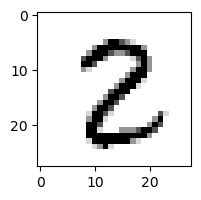

0.014965145795409852% - 0
0.004965854715230564% - 1
16.60185341297695% - 2
0.01725827828616874% - 3
1.0816365650542203e-05% - 4
0.16450570460392883% - 5
2.6476202433497794e-06% - 6
0.0016665230784079256% - 7
99.99907443019886% - 8 - ОШИБКА
1.031004700689063e-06% - 9

 7


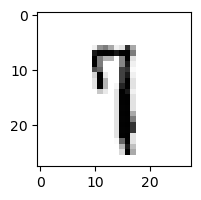

0.0006828586394515126% - 0
0.6829216011529395% - 1
0.1027837514491258% - 2
1.3610264422746776% - 3
3.330843182333285% - 4
7.814725564098253% - 5
0.4770046033817349% - 6
21.415834433207266% - 7
0.24733708219723724% - 8
74.48984514033329% - 9 - ОШИБКА

 8


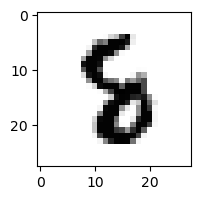

1.1819106048349366e-08% - 0
0.0004432388778194428% - 1
0.0001421689062755318% - 2
4.9506172146501146e-08% - 3
0.021087337542751456% - 4
2.3215879951825724% - 5 - ОШИБКА
0.28442835016604057% - 6
3.552754115118162e-05% - 7
0.0014062562191600374% - 8
4.569376174084504e-12% - 9

 5


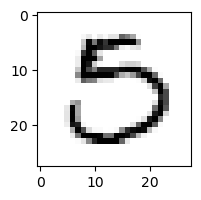

67.99192355171634% - 0 - ОШИБКА
1.8350073992145455e-05% - 1
0.02227609939485589% - 2
0.240210620607707% - 3
9.645490233682838e-06% - 4
0.027984457269950528% - 5
7.231497290778142e-05% - 6
0.010238808009620749% - 7
0.15199064529004325% - 8
1.5151047724101083e-13% - 9

 1


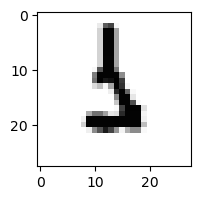

5.6822998285664385e-05% - 0
0.428387958384506% - 1
0.021607892188945352% - 2
0.001342708548488746% - 3
4.579413037409349e-06% - 4
8.700677316213117% - 5
81.67465568574919% - 6 - ОШИБКА
0.013575789143884024% - 7
2.233693324378032e-05% - 8
2.709787327002139e-07% - 9

 8


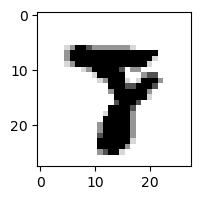

9.236309543789267e-10% - 0
4.237789001375198e-06% - 1
1.7776610636067563e-10% - 2
1.4430538995744012e-09% - 3
5.397235356220234e-08% - 4
0.0026174052636328588% - 5
3.0283679675649353e-10% - 6
72.46104817189645% - 7 - ОШИБКА
7.976396470685342e-11% - 8
1.3633331357535525e-11% - 9

 9


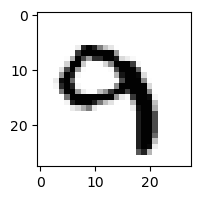

5.969252223079056e-05% - 0
0.00013217856817573952% - 1
0.004118941617146252% - 2
0.3138524774057421% - 3
0.48336731575973435% - 4 - ОШИБКА
0.0009873286477329133% - 5
0.0006921445145596747% - 6
0.06540682949016471% - 7
4.0083076565173034e-14% - 8
0.002139395092524408% - 9

 4


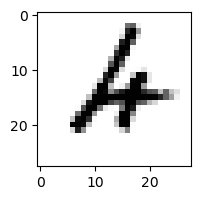

0.0020427360491056543% - 0
0.001177100722002416% - 1
0.5424159259208082% - 2
0.002237908050900226% - 3
0.12594015734509548% - 4
0.0005788854518655186% - 5
83.72088117147383% - 6 - ОШИБКА
0.00017807782286011296% - 7
0.0010028820075126258% - 8
0.010241794272193147% - 9

 9


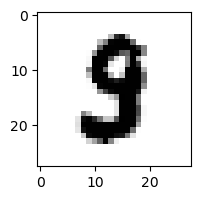

9.422556723846842e-05% - 0
2.0858615313582173e-05% - 1
2.3298239280266553e-05% - 2
8.189119106730451e-05% - 3
4.2611540693009715e-07% - 4
1.7538865673773063% - 5 - ОШИБКА
8.765963498805336e-05% - 6
3.508698584202614e-05% - 7
2.8883212378207358e-05% - 8
2.336789273316684e-11% - 9

 9


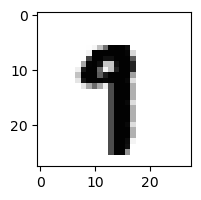

7.328550579581797e-10% - 0
0.06258092411276044% - 1
2.440042300988964e-11% - 2
1.584534386183583e-08% - 3
4.645240773482131e-05% - 4
1.208909668561099% - 5 - ОШИБКА
1.5036566522790092e-05% - 6
0.7448344597857717% - 7
1.0869270983870249e-07% - 8
0.0015378836504841083% - 9

 9


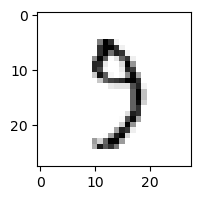

0.9409302944365696% - 0
0.018223959566624603% - 1
0.00959667792537555% - 2
53.741971077110065% - 3 - ОШИБКА
0.06914391332218257% - 4
17.657172663670888% - 5
0.03331932758294595% - 6
23.349469979362883% - 7
2.761278612853574% - 8
2.7246818255025844% - 9

 8


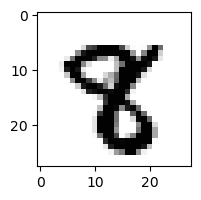

1.3491470378850478e-10% - 0
3.575482605247469e-05% - 1
1.8572190644961892e-10% - 2
1.195296149123701e-07% - 3
2.9878228859632086e-05% - 4
0.05423155853387838% - 5 - ОШИБКА
1.024335002507803e-10% - 6
0.0057196609436775975% - 7
1.888398956831642e-09% - 8
1.6757261151595192e-09% - 9

 8


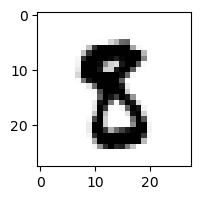

1.5598804237459761e-06% - 0
1.8288672473904976e-05% - 1
1.8505417171867634e-10% - 2
1.4508035003352882e-06% - 3
2.1580814567914773e-07% - 4
43.98084962494407% - 5 - ОШИБКА
7.315721989062258e-08% - 6
5.0991002224089355e-05% - 7
0.08136293316609898% - 8
2.337792213263663e-09% - 9

 4


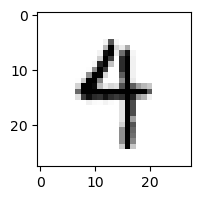

0.0007768151669289423% - 0
0.06039700695471254% - 1
2.2266967917626054e-05% - 2
0.009679695417849328% - 3
91.95478596976511% - 4
6.453624146111397% - 5
0.5140930594598512% - 6
0.08097005589604897% - 7
3.634478190996509e-07% - 8
94.46772752036085% - 9 - ОШИБКА

 7


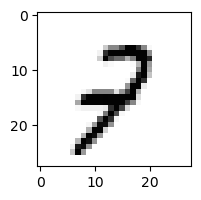

0.5475601012905247% - 0
0.07140949856737938% - 1
42.000542520202096% - 2
0.060049542924949344% - 3
0.5373826698294967% - 4
0.025536484866855547% - 5
0.013929053801156832% - 6
0.4074206467119811% - 7
0.0013912729902347029% - 8
92.36054567108023% - 9 - ОШИБКА

 3


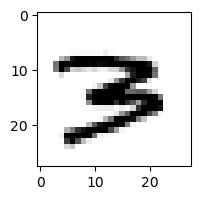

8.679261990736502e-06% - 0
0.0005274889243586701% - 1
0.005160572306212781% - 2
1.4343304388200058% - 3
0.0005998653395208769% - 4
0.0004802692107253735% - 5
0.001246554060522755% - 6
1.4838194283031938% - 7 - ОШИБКА
6.728412517295817e-13% - 8
5.233887577205666e-10% - 9

 2


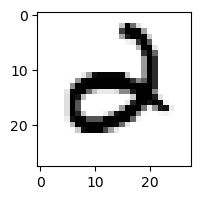

0.02302960596388457% - 0
8.340703723584913e-06% - 1
3.3782019695941103e-10% - 2
7.51965517352888e-06% - 3
1.224250430669499% - 4
0.12819005338445275% - 5
61.943235551283095% - 6 - ОШИБКА
0.0002449606659358532% - 7
3.1395949138530492e-15% - 8
2.1440674855374663e-09% - 9

 8


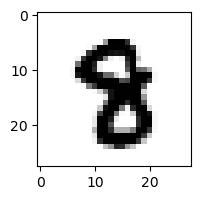

3.33136144557848e-09% - 0
1.3602882905973435e-06% - 1
1.277962024663849e-10% - 2
4.3540772841849075e-09% - 3
0.00027286849597410635% - 4
0.00800738249866568% - 5 - ОШИБКА
2.3344742103221034e-06% - 6
4.382810196494223e-05% - 7
0.0009276077620803751% - 8
7.968649249205155e-10% - 9

 0


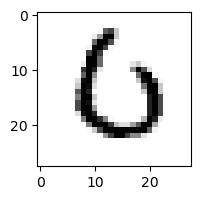

97.88071234906454% - 0
3.0922413494898893e-06% - 1
6.400468758859971% - 2
0.00019817047534398082% - 3
0.06259533587622548% - 4
0.02731455934650676% - 5
99.58646434095155% - 6 - ОШИБКА
0.0018829093324296228% - 7
3.458375544817155e-06% - 8
5.548564430073022e-07% - 9

 4


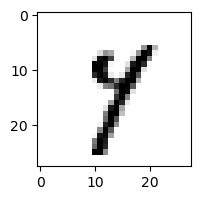

7.838994722535737e-05% - 0
8.213030450661035% - 1
8.354308027897514e-06% - 2
0.00021870213924901443% - 3
3.3971720166479398% - 4
8.026729077450065% - 5
0.0008657001907791164% - 6
35.46600494843272% - 7 - ОШИБКА
9.63200511178864% - 8
0.06181917730332696% - 9

 9


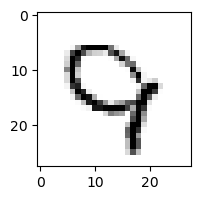

0.0674915289925309% - 0
0.0028664828218487536% - 1
1.0242773693229361% - 2
0.0002777905757858731% - 3
62.67486329331563% - 4 - ОШИБКА
0.010924391319257466% - 5
2.1764584708790666% - 6
5.518855880020544% - 7
3.4647845981863557e-07% - 8
0.34042839694911087% - 9

 2


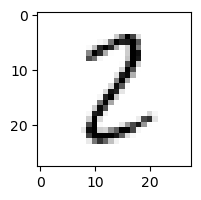

0.9927482549893771% - 0
2.921643482274584% - 1
58.33630377393288% - 2
21.67438508368608% - 3
0.000667886227922007% - 4
3.557224399719345% - 5
0.03015601850090822% - 6
0.003063028137014738% - 7
78.84159564992405% - 8 - ОШИБКА
6.446446141935249e-07% - 9

 7


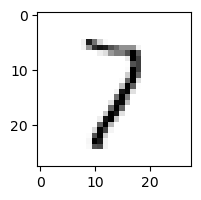

0.266819678994679% - 0
7.4581491354114595% - 1
77.29823701798239% - 2 - ОШИБКА
26.74440864874382% - 3
3.8401644948904106% - 4
0.627751366281603% - 5
0.25387404664322505% - 6
54.340202017612796% - 7
12.752090163336035% - 8
13.676657355124625% - 9

 2


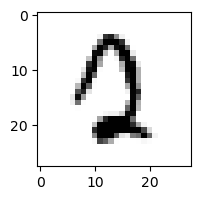

1.3655435194605219% - 0
0.00010302836762160443% - 1
0.23768793127242174% - 2
0.0030150206931196244% - 3
0.0028136151584856124% - 4
2.081540149931101% - 5 - ОШИБКА
0.16648582945710994% - 6
0.1479200583313085% - 7
1.1122549573510443e-08% - 8
1.2336653005463206e-06% - 9

 3


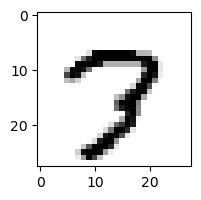

0.01576076278047671% - 0
3.3193639694373345e-07% - 1
2.1223136115433052e-05% - 2
0.0004688585711453452% - 3
0.0001611747825536196% - 4
0.14966799400960057% - 5
6.578650473460483e-06% - 6
98.77486842913574% - 7 - ОШИБКА
0.01650610922731099% - 8
0.5073050715361155% - 9

 8


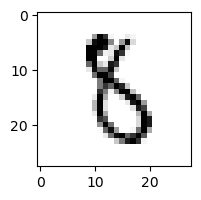

0.0006940470960251098% - 0
0.0030860593781659447% - 1
0.2922796634985665% - 2
0.3341048299348366% - 3
0.013081660252481692% - 4
34.567292984861616% - 5 - ОШИБКА
4.580436320228935% - 6
0.0013017355825067252% - 7
0.8969910865232104% - 8
9.397256413369702e-05% - 9

 8


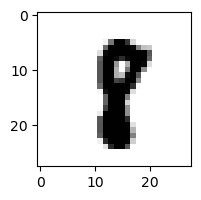

8.099154150742177e-08% - 0
1.4049387142472918% - 1 - ОШИБКА
2.9222112118777026e-07% - 2
4.990834944203274e-06% - 3
1.0309723619241219e-05% - 4
0.1679833757841687% - 5
3.181382780461611e-07% - 6
0.004689572765780982% - 7
0.0044054812486058505% - 8
1.2633694316617723e-07% - 9

 8


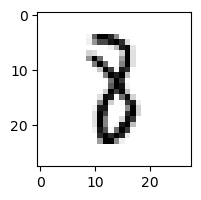

0.0005480376936336927% - 0
4.47698861577388% - 1 - ОШИБКА
0.343088089297336% - 2
0.23602674695148929% - 3
0.00010466011997868533% - 4
1.1009980948800262% - 5
0.15582924100913534% - 6
0.007727466771166266% - 7
3.6595056334814635% - 8
8.536073418533232e-06% - 9

 9


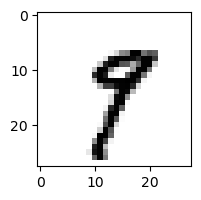

0.00013428213447898136% - 0
3.195489163461005% - 1
1.164353777933397e-07% - 2
0.002219598314894876% - 3
0.04720614716871064% - 4
0.3792129858232835% - 5
2.2845830920389754e-05% - 6
35.77678643063118% - 7 - ОШИБКА
0.6443242120708312% - 8
8.88229300109066% - 9

 2


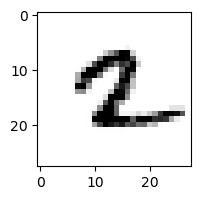

4.23151982076027e-06% - 0
3.554877498790455% - 1 - ОШИБКА
0.018355926653474325% - 2
2.45779966703661e-09% - 3
0.00010189837144435076% - 4
0.2152516429360101% - 5
0.732367866312884% - 6
0.18473958736337476% - 7
5.444090785911159e-06% - 8
2.619867778959016% - 9

 8


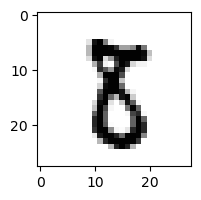

0.00021194803323575583% - 0
0.02368204653700093% - 1
0.0004409885058854473% - 2
0.07879662120513255% - 3
1.49868715655801e-07% - 4
11.46463818310615% - 5 - ОШИБКА
3.202989160512916e-05% - 6
0.0001760316111571773% - 7
0.6191845862739859% - 8
1.272436629486144e-06% - 9

 7


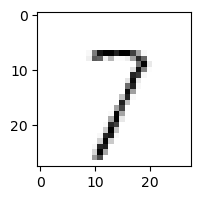

7.484834975181435% - 0
0.9701176300946609% - 1
31.796348178222054% - 2
72.38057432320589% - 3
2.5962975544035096% - 4
5.985983636719223% - 5
0.7722656240924911% - 6
92.09388389516145% - 7
79.83922369605696% - 8
97.71373773907447% - 9 - ОШИБКА

 9


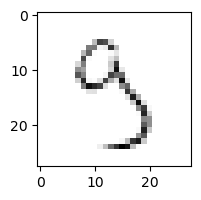

0.4257532201746208% - 0
0.5593594250199369% - 1
0.07322491917021456% - 2
94.84235347987168% - 3 - ОШИБКА
32.60610321311062% - 4
65.04783536139192% - 5
7.247049881069183% - 6
16.66826685768673% - 7
0.9437889854134438% - 8
22.47378394771427% - 9

 7


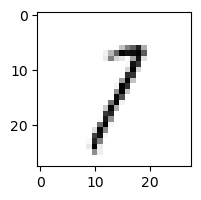

1.1269114226869656% - 0
47.10858975418617% - 1
26.179944911541302% - 2
55.73475595640653% - 3
3.5836475442450437% - 4
2.5165152659412184% - 5
0.9477903205937006% - 6
65.50159891750175% - 7
67.12794235601783% - 8
98.35642479604556% - 9 - ОШИБКА

 8


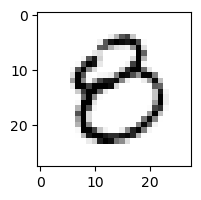

98.91584383753279% - 0 - ОШИБКА
0.00013639481439651563% - 1
0.00015913444715074933% - 2
0.03682957438459985% - 3
0.16949244534301317% - 4
0.2130492793822982% - 5
0.0017790169202742707% - 6
1.0203803627210713e-05% - 7
0.0032598805418431374% - 8
2.7568731683036533e-08% - 9

 7


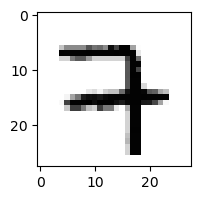

0.00039454353935300623% - 0
4.652532926028751e-05% - 1
7.01007166615771% - 2
0.7099639894617107% - 3
18.321032817415894% - 4 - ОШИБКА
5.857435969056688e-06% - 5
0.005849304953928727% - 6
1.8839386560422346% - 7
1.460340060807986e-10% - 8
0.003851152321204459% - 9

 2


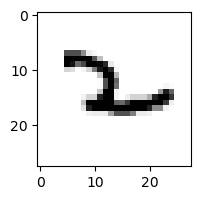

0.0006667552216731324% - 0
0.040266824142608446% - 1
0.3513588825060623% - 2
0.0004133285457304777% - 3
96.38187836513032% - 4 - ОШИБКА
0.4037612856984038% - 5
64.00870605255076% - 6
1.2707926025832346% - 7
21.563690685107943% - 8
0.0012694467642535606% - 9

 3


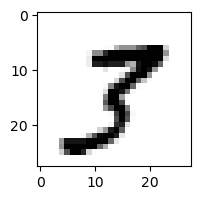

8.194549494730909e-05% - 0
0.10201458917474769% - 1
1.056912448084738e-05% - 2
0.40392891484432175% - 3
0.0004236106020744782% - 4
0.07402222427073837% - 5
8.090709475740242e-10% - 6
38.07887705841169% - 7 - ОШИБКА
0.2779968066086104% - 8
0.005741797539585704% - 9

 3


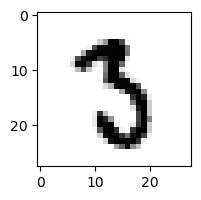

0.0003985100437285203% - 0
0.0028804510710167654% - 1
0.0005929244456056152% - 2
4.141760745645612% - 3
2.1018776844664353e-06% - 4
12.730048743719264% - 5 - ОШИБКА
0.007203454808460162% - 6
0.4959289329529105% - 7
6.240504908553193e-05% - 8
2.8717762979710153e-08% - 9

 9


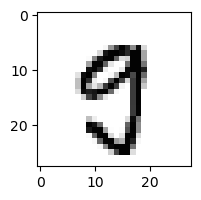

1.317393127590954% - 0
4.114654753011513e-05% - 1
2.489246220120883e-07% - 2
0.004083949206097161% - 3
0.00019804311984003323% - 4
40.356109221280065% - 5 - ОШИБКА
3.891679579749917e-06% - 6
0.048126124056103% - 7
0.00023741574363161003% - 8
13.628263488285139% - 9

 8


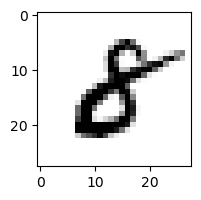

0.22777056972940338% - 0
0.0012142074358221634% - 1
0.44186375354417046% - 2
0.028373460198204407% - 3
5.959838539468719e-05% - 4
2.183685121585324% - 5 - ОШИБКА
0.004266282597132898% - 6
1.118119976788929e-05% - 7
0.00071309256685032% - 8
2.9531666432206156e-07% - 9

 4


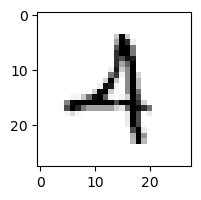

0.08607510821998457% - 0
0.056612082164398295% - 1
73.23616955334977% - 2 - ОШИБКА
5.140738415497693% - 3
3.757016015373429% - 4
0.0024715748580940453% - 5
0.20477575795960476% - 6
0.0013386754770630422% - 7
1.4476935141462514e-05% - 8
1.559768204162666% - 9

 7


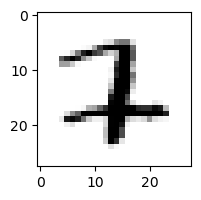

7.640916751980986e-08% - 0
0.20255514445420902% - 1
3.9369628215908787% - 2 - ОШИБКА
0.00031915804777339017% - 3
8.75570715896221e-06% - 4
8.064789803294806e-05% - 5
0.0016330808110536714% - 6
0.024408354577238632% - 7
3.505839281533616e-08% - 8
2.3741585540966563e-10% - 9

 8


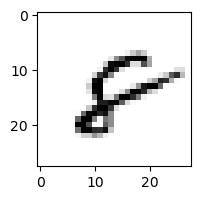

5.932184243745912% - 0
0.05590695187428034% - 1
0.07239808889661199% - 2
8.772598456181215e-07% - 3
0.6295797348397678% - 4
0.021081583220575097% - 5
24.412857714889164% - 6 - ОШИБКА
0.31246297729517175% - 7
0.7654188619898485% - 8
0.15150742914067575% - 9

 3


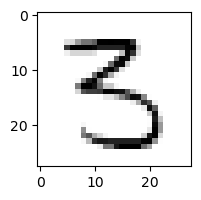

0.1436800186065991% - 0
0.00024713562653724125% - 1
0.0019469756835470277% - 2
33.071523444696986% - 3
0.07678212195243245% - 4
36.5602216781057% - 5 - ОШИБКА
0.0001050277137344041% - 6
0.0027718230047749943% - 7
0.0006868033223318836% - 8
0.00045710572889295497% - 9

 7


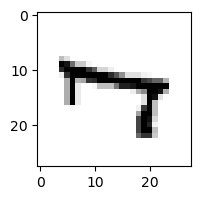

0.2732467425753799% - 0
0.0420207249608891% - 1
9.863845212687866e-10% - 2
0.020635599007225666% - 3
37.08949028096497% - 4
0.47216447015697427% - 5
92.25622632262707% - 6 - ОШИБКА
0.046506177650676425% - 7
0.021765501077899842% - 8
19.825086648145433% - 9

 1


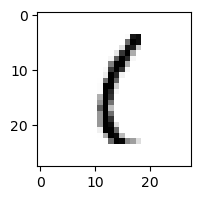

0.7202527573606038% - 0
71.47391142304667% - 1
2.7466034941487827% - 2
5.1456238808757595% - 3
0.009462610157344049% - 4
24.085586593227088% - 5
42.401241778542065% - 6
0.04003184893529954% - 7
95.69338077551082% - 8 - ОШИБКА
0.6328312910547357% - 9

 8


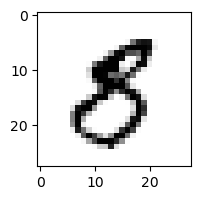

0.14215514460871329% - 0
0.0008150796194942285% - 1
4.818445318694163e-06% - 2
0.0038992663151532015% - 3
0.0008536110199984918% - 4
23.08067229528047% - 5 - ОШИБКА
3.0333446560450882e-05% - 6
3.8744882321599247e-05% - 7
0.007692695461980563% - 8
0.0001345344458408075% - 9

 8


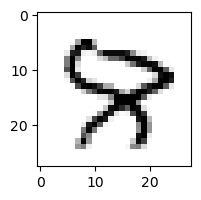

0.0012638934286910018% - 0
3.2247708467785147e-06% - 1
9.820021746213928e-05% - 2
0.00012020990424213458% - 3
0.08873538789317133% - 4 - ОШИБКА
8.737581848660263e-05% - 5
0.0004456393021787072% - 6
0.07221515078152022% - 7
7.3190168983057245e-09% - 8
4.0590915878584104e-05% - 9

 7


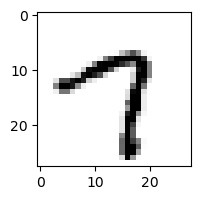

1.2409634999051349% - 0
0.0024303708875989373% - 1
2.756856179357446e-07% - 2
1.56724445843651e-05% - 3
0.01275004398572446% - 4
2.234437358246865% - 5
0.000260686316007813% - 6
97.39406874277996% - 7
0.002205812166319045% - 8
99.79579966020844% - 9 - ОШИБКА

 2


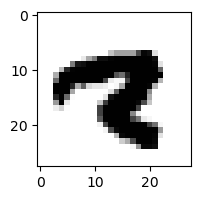

3.222277950994878e-11% - 0
3.5299790373777544e-06% - 1
1.5598146487511318e-15% - 2
1.3649981706923039e-17% - 3
0.00012380780440366827% - 4
1.9815972542022297e-05% - 5
1.092090491901896e-09% - 6
2.2122744725240615% - 7 - ОШИБКА
1.3873951812201807e-13% - 8
2.4886634680481244e-07% - 9

 3


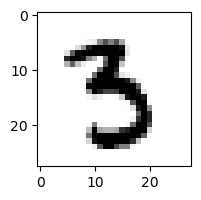

6.139295326459707e-06% - 0
1.1450057091651321e-05% - 1
5.329882068962257e-09% - 2
9.57538420037554% - 3
0.0007302572593114891% - 4
39.98320324124142% - 5 - ОШИБКА
4.717103329729166e-05% - 6
0.000834209435139205% - 7
5.031972614918581e-05% - 8
1.5436285957968512e-09% - 9

 8


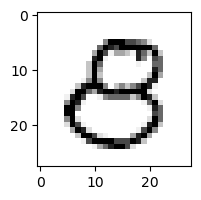

8.093651142335917% - 0 - ОШИБКА
1.2373641961412876e-06% - 1
0.021059291688273456% - 2
0.006446854915288907% - 3
0.6463606239686923% - 4
5.786544745179359% - 5
9.815395149460175e-07% - 6
4.658982518216555e-06% - 7
0.0032888378473484654% - 8
5.574614373077065e-07% - 9

 8


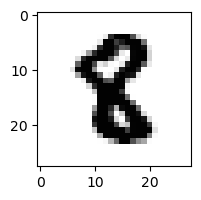

5.974669215724604e-09% - 0
0.00017214316028677702% - 1
8.078158784141246e-06% - 2
4.040130809418971e-09% - 3
3.835721004059616e-06% - 4
0.570927649967313% - 5 - ОШИБКА
1.778935014699013e-06% - 6
6.459812677928081e-08% - 7
2.4354077511960606e-07% - 8
1.7666068868608336e-15% - 9

 3


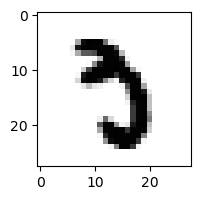

3.32068022979959e-05% - 0
2.361876650406084e-05% - 1
9.714758494180729e-09% - 2
0.01932496343748785% - 3
0.00010235167057695762% - 4
9.331079660817293% - 5
0.0005184084442383469% - 6
9.488583178646659% - 7 - ОШИБКА
1.7255078476894606e-10% - 8
8.105004186363508e-09% - 9

 3


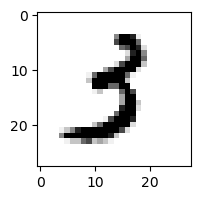

0.016453381666244663% - 0
0.30947413527492856% - 1
6.80959166381264e-06% - 2
10.572753390291117% - 3
0.002714376658010296% - 4
12.801251217802076% - 5 - ОШИБКА
0.0006505439828119046% - 6
0.015738139051471225% - 7
8.813035535389512e-10% - 8
5.3155203881773005e-11% - 9

 2


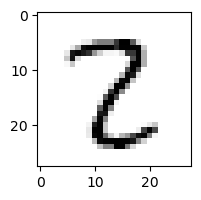

0.0070024811494611575% - 0
0.25132122389634903% - 1
17.72030224198202% - 2
11.364375778412231% - 3
0.002359441931909054% - 4
0.39490115802645775% - 5
1.4412988256461677e-06% - 6
0.01826006201889862% - 7
97.3740928944087% - 8 - ОШИБКА
5.8591277890288244e-08% - 9

 2


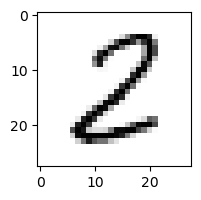

0.12208205727634297% - 0
0.40138274787865386% - 1
78.50458550392307% - 2
0.039463960640696814% - 3
0.00016250131856148427% - 4
0.4819074201820985% - 5
0.034536656027093666% - 6
0.00012405375405963236% - 7
99.9369216808083% - 8 - ОШИБКА
1.8783822845883284e-09% - 9

 5


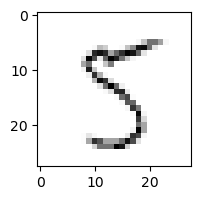

1.3094980728773258% - 0
0.07594819287492457% - 1
0.10542960089619648% - 2
23.59144201612599% - 3
1.2229939501816063% - 4
92.94043720100764% - 5
0.17111703031763564% - 6
1.5146016595365772% - 7
99.59713823376637% - 8 - ОШИБКА
53.101096397257486% - 9

 8


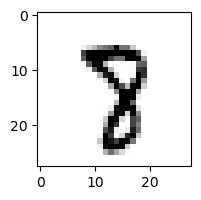

3.073027742405992e-05% - 0
0.0005887230290400443% - 1
0.00013660365728888056% - 2
0.00023167410276735546% - 3
0.0001273341698371079% - 4
2.671393058220768% - 5
2.8951036660635236e-05% - 6
17.095768634420015% - 7 - ОШИБКА
0.2243919406934675% - 8
0.0008520205831801509% - 9

 9


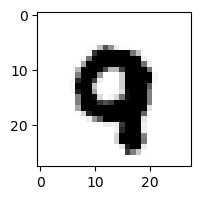

1.4923176525367872e-06% - 0
4.6158312240814217e-07% - 1
3.887600932866642e-08% - 2
1.1108446489573097e-17% - 3
0.026879207437729192% - 4
4.243597424056784e-07% - 5
0.00010033026667575109% - 6
0.6159632899346835% - 7 - ОШИБКА
1.2472734589145677e-14% - 8
0.029962433514565137% - 9

 6


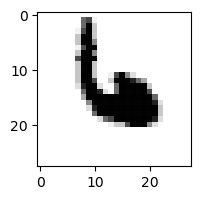

4.950830716450188e-11% - 0
9.06570154850937e-06% - 1
0.0002230089242800896% - 2
3.2652234708288536e-09% - 3
79.35412580125993% - 4 - ОШИБКА
0.003739616914140825% - 5
58.71775516864935% - 6
0.0008892069605152353% - 7
1.8040763411489667e-12% - 8
1.1679074612964085e-06% - 9

 5


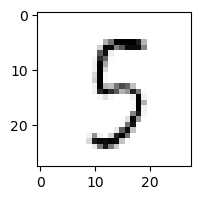

6.642338073579078% - 0
0.07900902621229315% - 1
3.618568374921083% - 2
39.04399558758646% - 3
7.708135310490991% - 4
90.44765058506822% - 5
2.5247121818034244% - 6
0.027926378673520696% - 7
99.94616860985887% - 8 - ОШИБКА
0.011248081549911975% - 9

 1


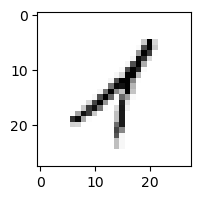

0.055789231646301646% - 0
67.77759476362355% - 1
33.58939840049414% - 2
2.7926963808816767% - 3
68.68613882842448% - 4
0.20571519737439428% - 5
0.3007407281331706% - 6
0.1096288796319327% - 7
93.35690678820751% - 8 - ОШИБКА
13.346484050651355% - 9

 8


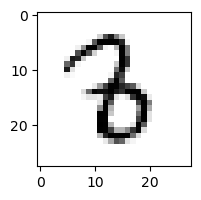

1.5195422274563452e-05% - 0
0.26858167063233995% - 1
0.6258724827385889% - 2
9.075818009545893% - 3 - ОШИБКА
0.0032347435171527746% - 4
0.1278194749740883% - 5
0.5221781312458508% - 6
0.000290517447816987% - 7
2.5186926250241806e-06% - 8
5.065011291784e-09% - 9

 5


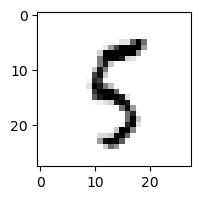

0.33340742193898293% - 0
0.02022892322963885% - 1
0.3281990736563882% - 2
0.450461346445088% - 3
0.9760470580336942% - 4
85.97295628258696% - 5
0.7869157345495423% - 6
0.0032675287739588788% - 7
98.37761294078696% - 8 - ОШИБКА
54.38577422348339% - 9

 8


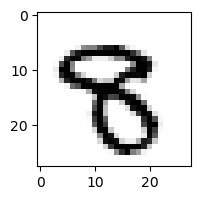

2.889660992396958e-05% - 0
2.2640173469648598e-07% - 1
2.795289924520637e-09% - 2
0.00269980809648217% - 3
3.405409640655675e-05% - 4
0.04163068918941673% - 5 - ОШИБКА
6.155917127020963e-07% - 6
0.0010114978933329515% - 7
0.00013461326046717133% - 8
0.03017970491269937% - 9

 7


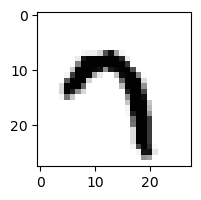

0.0018427431995245945% - 0
0.0006861469236979484% - 1
3.7949840254841196e-07% - 2
4.855324545014855e-05% - 3
0.07741104525080592% - 4
6.881043910470774% - 5
0.003559315880669549% - 6
50.86940582267593% - 7
6.27485898597017e-09% - 8
55.65112928889048% - 9 - ОШИБКА

 1


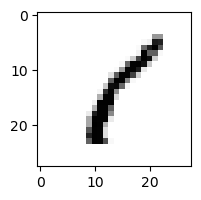

0.9071047908240484% - 0
93.4578666918884% - 1
0.4442118262080762% - 2
0.2024998386236478% - 3
0.1879638396008821% - 4
5.798831284621475% - 5
0.0040520063400549585% - 6
0.04055928352567684% - 7
94.8791464111732% - 8 - ОШИБКА
0.004138938180782015% - 9

 8


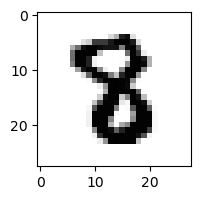

2.623885654963759e-09% - 0
3.750485259331318e-05% - 1
7.846685338384209e-06% - 2
4.317377907387981e-06% - 3
2.2030041745811747e-05% - 4
0.02174195584188153% - 5 - ОШИБКА
1.1517614375351352e-06% - 6
1.1269512210000902e-05% - 7
6.66285701749764e-06% - 8
1.232399252333473e-18% - 9

 8


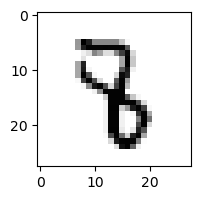

2.025257867618447e-08% - 0
0.07862614248481394% - 1
0.0003041091452137455% - 2
0.01778757339646919% - 3
1.060571958733944% - 4 - ОШИБКА
0.2647771504258774% - 5
0.0008039748879759912% - 6
0.0029868145568130366% - 7
7.880104122289773e-08% - 8
3.7776387371060903e-06% - 9

 9


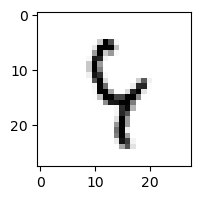

0.0023136908449848787% - 0
0.0541298296179546% - 1
2.751025205454598% - 2
0.03801727361296692% - 3
97.34061116859804% - 4 - ОШИБКА
51.84836757449853% - 5
10.466223626051052% - 6
0.3071890637697794% - 7
85.04259480755643% - 8
3.5844791971430907% - 9

 3


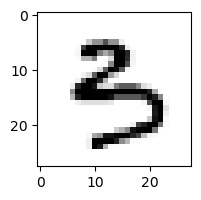

0.01879558458030282% - 0
1.2586480714988935e-05% - 1
5.438805170522895e-07% - 2
5.041883811757461% - 3
0.21816877776455998% - 4
26.678541945933627% - 5 - ОШИБКА
0.011263991689719498% - 6
6.536460613526848e-05% - 7
6.830815012829649e-11% - 8
7.556616008081044e-05% - 9

 2


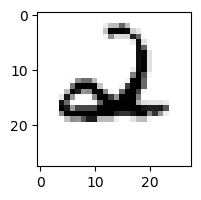

0.001330427572041253% - 0
0.00013543699913316082% - 1
0.17494653313894376% - 2
5.252872403853741e-08% - 3
75.7662177700558% - 4 - ОШИБКА
1.689033767773736e-05% - 5
2.492037464980169% - 6
0.0008930288095325668% - 7
1.5374360594889558e-06% - 8
0.004945853179031755% - 9

 4


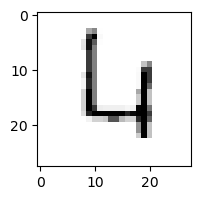

4.378765141963205% - 0
0.00010505885801779604% - 1
88.84793424813225% - 2
0.0002609334510411811% - 3
58.67489883178392% - 4
0.052248431808120485% - 5
96.8457179483674% - 6 - ОШИБКА
1.0733178307076745% - 7
0.07016406162980127% - 8
13.954077306362267% - 9

 5


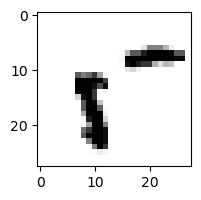

99.99616808191787% - 0 - ОШИБКА
0.00023822800184185303% - 1
6.8898979315546856e-06% - 2
2.882017009463935e-06% - 3
42.456831050563636% - 4
99.81631860363231% - 5
0.010189899936765985% - 6
0.0163730718688434% - 7
35.504335353263706% - 8
0.1099302376293284% - 9

 9


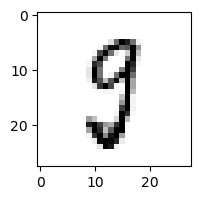

1.3350759335940845% - 0
0.04352466275189018% - 1
0.003306925784998883% - 2
2.1060038206343035% - 3
0.03070285052938489% - 4
53.13387027622949% - 5 - ОШИБКА
0.007630904132233987% - 6
0.2579049086792124% - 7
17.0570790994987% - 8
3.022807258070527e-05% - 9

 5


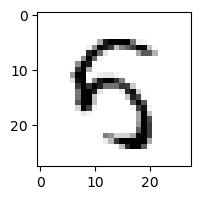

0.9091069055230029% - 0
0.00010339129415243905% - 1
0.0005902644865953288% - 2
0.020901932862573958% - 3
94.555784215226% - 4 - ОШИБКА
39.518591079478085% - 5
0.0796981832373704% - 6
5.654436077844278e-05% - 7
0.00041512387078544515% - 8
0.0013195398298429346% - 9

 8


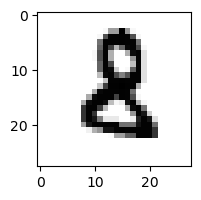

8.063602785403212e-06% - 0
0.002357001537161412% - 1
2.6417060258671494% - 2 - ОШИБКА
0.005614903751006876% - 3
7.916258786514734e-07% - 4
0.015169027004265605% - 5
0.14004617195653768% - 6
1.4165006595794859e-08% - 7
1.1998050817962293e-05% - 8
3.849097958805737e-11% - 9

 4


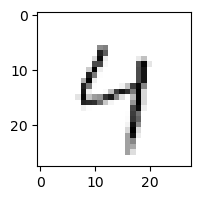

1.8886501595075118% - 0
0.11414289381802079% - 1
1.558469294341409% - 2
1.4457252950258048% - 3
92.99485385269821% - 4
3.916893996816908% - 5
29.420844235352313% - 6
3.6682071055680088% - 7
12.84221126324369% - 8
99.42190580863443% - 9 - ОШИБКА

 8


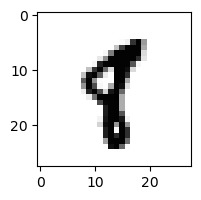

6.0086318190967395e-06% - 0
7.738006732846911% - 1 - ОШИБКА
6.216425444710946e-07% - 2
1.6336154778920038e-08% - 3
0.0013917530591315477% - 4
4.02413192439886% - 5
0.0009069385781126458% - 6
0.012025905177283447% - 7
9.99949289318584e-07% - 8
0.0061849724564582% - 9

 5


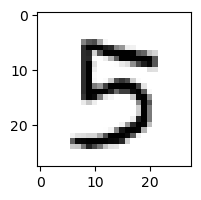

0.014774496080570323% - 0
4.973612168814433e-06% - 1
2.85280429370535e-07% - 2
80.271425731082% - 3 - ОШИБКА
0.043310826982292244% - 4
66.5607358459029% - 5
7.242474741843359e-06% - 6
0.001159961609029635% - 7
6.779725488593833e-07% - 8
0.003484179686476694% - 9

 8


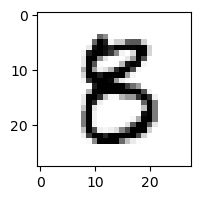

0.030396139281358696% - 0
1.5973280825954356e-05% - 1
1.8207652242173087e-06% - 2
0.36506534631984794% - 3
0.0007318094244926516% - 4
44.92601106065963% - 5 - ОШИБКА
1.1118120125973265e-05% - 6
1.1087846744827552e-06% - 7
1.7318455278730455e-06% - 8
2.8364863938482522e-11% - 9

 6


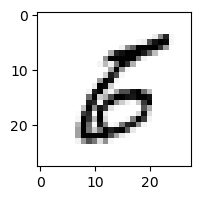

2.876928279395907% - 0
0.019337586579797884% - 1
0.024093816904678426% - 2
0.0042690732207725296% - 3
0.0011686880456601107% - 4
9.55122219485661% - 5 - ОШИБКА
4.543415027790873% - 6
0.0004238975636277629% - 7
5.497957414817969e-06% - 8
1.620270515382995e-06% - 9

 2


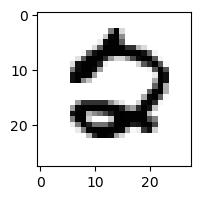

0.8086854796773417% - 0 - ОШИБКА
8.391348101102036e-10% - 1
0.5519476511525879% - 2
1.566283624676396e-11% - 3
1.0807961390719405e-08% - 4
0.0018695821323139639% - 5
0.007421921994882864% - 6
0.00014833858954673522% - 7
2.7559495150840484e-06% - 8
3.709624481907061e-12% - 9

 1


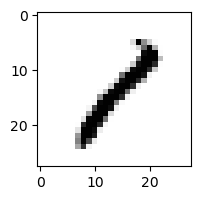

0.03509002186580536% - 0
63.06190739780892% - 1
4.857510407705376% - 2
0.1656595331607055% - 3
0.2081675010529787% - 4
0.033672188827258004% - 5
0.008820852182082235% - 6
0.12305113861824604% - 7
99.98511094933441% - 8 - ОШИБКА
0.010983331465829058% - 9

 9


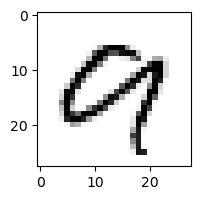

0.8820964442064455% - 0
7.657066243783928e-05% - 1
0.005925855094846979% - 2
1.7928991869910168e-05% - 3
0.0026183588967462123% - 4
0.00011747876044830983% - 5
0.017648485756624758% - 6
0.05903883010522019% - 7
99.37867440762818% - 8 - ОШИБКА
71.86824545849034% - 9

 7


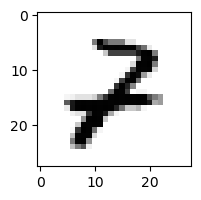

0.04365881382298872% - 0
0.010105409064017147% - 1
67.68526814569248% - 2 - ОШИБКА
0.0030524402319341425% - 3
0.036799568326246306% - 4
7.63755955188552e-06% - 5
0.00019651605536320836% - 6
0.007283256909727726% - 7
0.0006175802524256961% - 8
0.00020161593536546787% - 9

 7


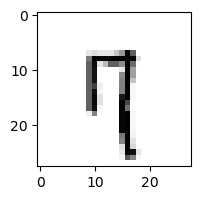

0.07504266715179238% - 0
0.15211603819578712% - 1
0.11527843657121116% - 2
0.0013523222666058364% - 3
3.13982665893144% - 4
0.7117816906363819% - 5
0.8714181484832941% - 6
31.36480894105121% - 7
0.010973497021628672% - 8
99.61715727960028% - 9 - ОШИБКА

 5


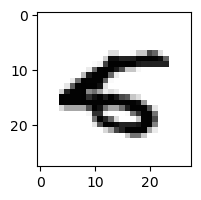

0.04647055226294716% - 0
2.0660676814742508e-05% - 1
2.049375428903616e-08% - 2
1.47300789102172e-10% - 3
4.454583889503646% - 4 - ОШИБКА
0.41855900401268675% - 5
0.013130567046252992% - 6
0.0002173440992846159% - 7
4.9282356771214526e-14% - 8
6.941774563689491e-06% - 9

 4


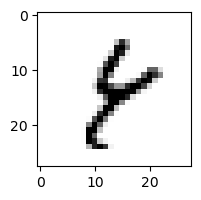

0.003747386593591197% - 0
1.9239334165339264% - 1
0.04064276335992805% - 2
0.0018898078374283808% - 3
0.1285322496926769% - 4
0.03339670144986371% - 5
13.330826334180266% - 6
0.028208265946455605% - 7
99.99652400983139% - 8 - ОШИБКА
91.46322157189% - 9

 2


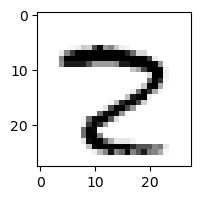

0.0865977258727186% - 0
1.6844034975717079e-07% - 1
0.007540243895898001% - 2
4.745124308061763e-06% - 3
7.089736509123685e-07% - 4
0.0016852697728708835% - 5
3.630485353385678e-08% - 6
99.95504798285927% - 7 - ОШИБКА
0.0011339759444380332% - 8
0.0001611146398875175% - 9

 8


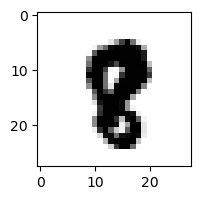

9.493202273615456e-09% - 0
0.00038278199713507677% - 1
4.2555985387491004e-08% - 2
1.029017136904578e-11% - 3
2.5477640102319253e-05% - 4
0.0009992209652812817% - 5 - ОШИБКА
9.376351910544832e-08% - 6
0.0006621279015802145% - 7
4.304452861756781e-05% - 8
6.445805593409445e-07% - 9

 4


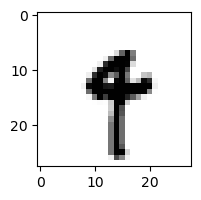

1.3103336745485507e-07% - 0
1.3991771757094829% - 1
1.9793263477879144e-09% - 2
9.386192101313538e-06% - 3
2.4124339847622194% - 4
0.29481560201503404% - 5
0.05724972047350021% - 6
0.17764368158558302% - 7
7.625231931099729e-07% - 8
26.013722876576573% - 9 - ОШИБКА

 7


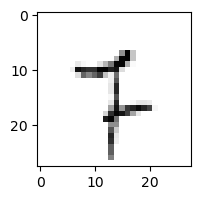

0.06341875930119381% - 0
10.2708273401863% - 1
0.03261714275031545% - 2
0.00015840534225079964% - 3
0.18422470459112164% - 4
53.418044061739856% - 5 - ОШИБКА
7.342957741943182% - 6
49.834683014505785% - 7
0.06840105822984532% - 8
8.607123605725215% - 9

 8


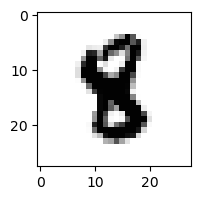

7.957275135047503e-09% - 0
0.00020654724575851604% - 1
4.911743012632122e-08% - 2
1.3969546107281414e-07% - 3
0.0010875654698542859% - 4
1.4981591739657971% - 5 - ОШИБКА
0.0051378316929345524% - 6
9.543955350932491e-07% - 7
0.0001034790103689099% - 8
2.627105117344569e-11% - 9

 9


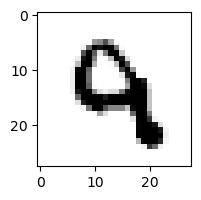

6.960005327058713e-06% - 0
2.8921991783892995e-06% - 1
0.3257249284510072% - 2
2.5949960625351385e-06% - 3
43.169294382936386% - 4 - ОШИБКА
0.025584265290086245% - 5
0.03607910911289957% - 6
0.0005474696655129138% - 7
1.5660829144798953e-11% - 8
2.2195284852278783% - 9

 7


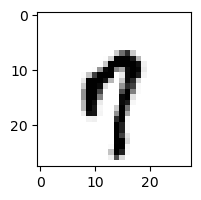

0.14368735395172866% - 0
0.02415075189735604% - 1
8.178874558449743e-07% - 2
2.104909419682009e-05% - 3
27.92301692503381% - 4
0.037965658039607816% - 5
0.2276816096053339% - 6
10.04341697065661% - 7
2.8168294557124374e-05% - 8
62.46866473947521% - 9 - ОШИБКА

 5


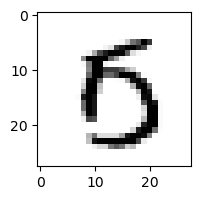

50.62058273489695% - 0 - ОШИБКА
8.791855046565507e-06% - 1
6.744549415235033e-05% - 2
8.8012737497181e-05% - 3
0.04326599367198098% - 4
45.271320495549105% - 5
0.02696933127872% - 6
0.0035168125626111944% - 7
0.004886988821947468% - 8
0.0028935534509819845% - 9

 3


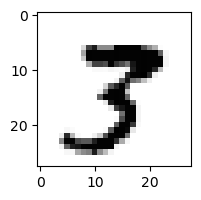

1.2939026427526392e-05% - 0
0.00010241948471826793% - 1
6.040034045701896e-06% - 2
22.3425482607983% - 3
2.968975325382878e-06% - 4
0.0175056128227218% - 5
1.5140050207168562e-11% - 6
24.388214768952878% - 7 - ОШИБКА
0.008720630930709027% - 8
4.216678343124509e-05% - 9

 8


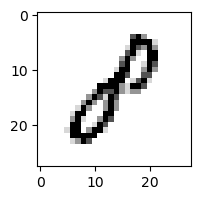

0.6032709313566638% - 0
13.002067648830007% - 1 - ОШИБКА
2.2036743887693446% - 2
0.14744945518580288% - 3
0.06944072932514277% - 4
0.30890105289309044% - 5
0.00807355235929967% - 6
5.500827685378452e-05% - 7
0.0063430561753726935% - 8
0.00011614548058593692% - 9

 2


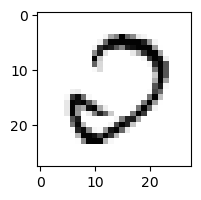

99.91466089695331% - 0 - ОШИБКА
0.00011054857127165144% - 1
98.6191106507161% - 2
0.002766109444525915% - 3
0.0022406591951897683% - 4
0.015318045709042225% - 5
0.19610904234875934% - 6
0.0008179817267008003% - 7
1.8131810960536547% - 8
9.593117655407749e-12% - 9

 8


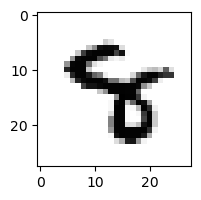

4.716379599187159e-08% - 0
3.492948805931188e-05% - 1
2.5133721487244154e-08% - 2
2.0040686268389623e-06% - 3
0.8731961658206444% - 4 - ОШИБКА
0.003161566397295469% - 5
0.06156909843424561% - 6
0.0013626832016615281% - 7
0.00033626034058447247% - 8
0.00013352006625672115% - 9

 3


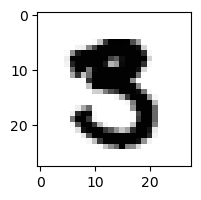

4.9588507640218436e-05% - 0
5.96313928276004e-09% - 1
4.882356741834221e-10% - 2
0.0006721051181689114% - 3
1.8135493710406293e-09% - 4
17.562793045897354% - 5 - ОШИБКА
5.632013474808069e-12% - 6
7.147253580879127e-05% - 7
2.881026462150291e-09% - 8
8.883323090089155e-18% - 9

 8


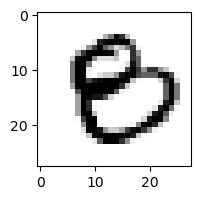

12.243879805870362% - 0 - ОШИБКА
4.858682166534087e-07% - 1
5.112903357688932e-07% - 2
0.0004774794557753458% - 3
7.422225013885297e-05% - 4
0.00040174406646399213% - 5
2.5267382411355698e-05% - 6
1.571813136867782e-08% - 7
0.00012767946534186496% - 8
6.040033975629257e-12% - 9

 3


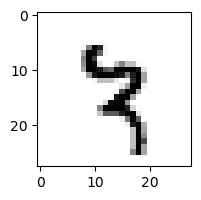

5.734730123059326e-07% - 0
1.1383063742901922% - 1
0.007173991858735955% - 2
7.788879423737378e-06% - 3
4.071105444234012% - 4
0.06300159997442703% - 5
0.02398130954262854% - 6
56.48520427975722% - 7 - ОШИБКА
0.9033330452842785% - 8
0.0008822942548147417% - 9

 2


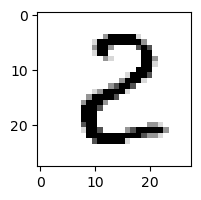

8.062288743315897% - 0
0.018731549749438556% - 1
99.12187731216842% - 2
0.2760722575056805% - 3
0.002004252626485692% - 4
0.04771203259175142% - 5
0.0002959994739333973% - 6
4.947341716223465e-07% - 7
99.99884561897318% - 8 - ОШИБКА
2.1318030993642197e-08% - 9

 6


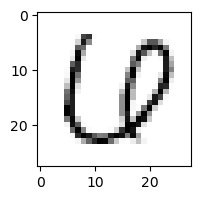

3.5507419314829245% - 0 - ОШИБКА
0.003144320518681512% - 1
0.0011441184851440317% - 2
0.17671082994602028% - 3
0.39952404891889026% - 4
0.0902382072404576% - 5
0.00015003155589612556% - 6
0.027703740729238042% - 7
1.0519196159370049e-05% - 8
1.485144405527497e-12% - 9

 8


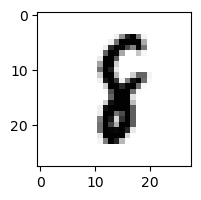

3.68552205549516e-07% - 0
5.413583441192453% - 1 - ОШИБКА
0.008979488360894352% - 2
6.672245950020895e-06% - 3
0.0013135991101635473% - 4
0.13474549833413899% - 5
3.7297036381658257% - 6
0.0009811749614275778% - 7
0.6275879940819634% - 8
4.820254866059479e-07% - 9

 5


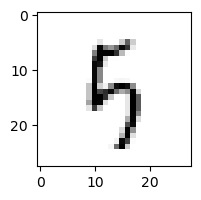

0.12108284159171606% - 0
0.01675959304557284% - 1
5.5339195045260485% - 2
0.5217426365838251% - 3
35.48371643024528% - 4
64.28041244045153% - 5
35.7348397447434% - 6
0.013308084343127257% - 7
55.58731062596267% - 8
91.69591423309473% - 9 - ОШИБКА

 9


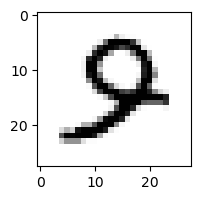

0.025871573004532224% - 0
8.068407196241435e-06% - 1
0.03788712112244668% - 2
0.0003956065985390533% - 3
0.3353193519787046% - 4
0.5232698916299329% - 5 - ОШИБКА
0.004512164366726652% - 6
0.04043127757599014% - 7
1.081308472967513e-06% - 8
3.2130563743439476e-08% - 9

 4


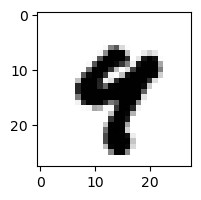

7.78636499059884e-08% - 0
2.793200332550829e-06% - 1
1.1694224259211588e-13% - 2
4.89535111290194e-12% - 3
0.6138360799875106% - 4
0.0009812135686686554% - 5
1.2659786073453966e-06% - 6
0.004905173612221921% - 7
1.8050149862430393e-07% - 8
20.89192589914523% - 9 - ОШИБКА

 6


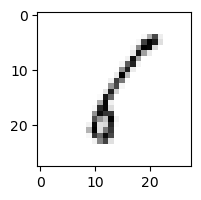

9.361398405043976% - 0
88.45314798727861% - 1 - ОШИБКА
35.99455105346285% - 2
0.6374241383968665% - 3
1.8570045330136786% - 4
22.551491233595073% - 5
30.8811832921147% - 6
0.5835629325027769% - 7
67.55279897022457% - 8
0.3658235076207206% - 9

 2


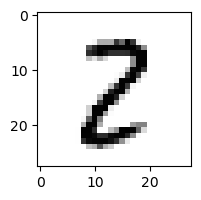

0.10738165325920698% - 0
0.1061362204572083% - 1
3.5226448467247957% - 2
2.000725108561764% - 3
1.4693727241375442e-05% - 4
0.2008401706233668% - 5
3.2820732169868456e-05% - 6
0.0007503292694932114% - 7
99.95411541733705% - 8 - ОШИБКА
5.485301418997046e-06% - 9

 8


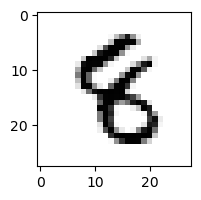

1.9121808441531261e-07% - 0
0.0031699259263472637% - 1
0.004336959351758792% - 2
4.458366392710989e-06% - 3
0.08806496605185234% - 4
1.52334327083574% - 5 - ОШИБКА
0.0007160399529807276% - 6
5.488990389474365e-05% - 7
0.0013319660529495618% - 8
2.1005027663414406e-05% - 9

 8


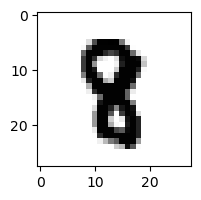

2.047837977054032e-09% - 0
0.001604268146228531% - 1
3.0898175270362276e-07% - 2
1.4351797455046904e-07% - 3
0.0001752234475748659% - 4
0.02897645628805705% - 5 - ОШИБКА
3.869493038380894e-06% - 6
1.3493083105451216e-05% - 7
1.837773371701375e-05% - 8
7.189821782842008e-10% - 9

 4


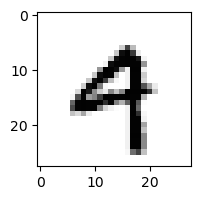

0.024414655787028068% - 0
0.0014137284131790142% - 1
4.9014202885312183e-05% - 2
8.616264064329803e-05% - 3
23.3313627542142% - 4
0.0008518006712808947% - 5
0.023370922795792833% - 6
0.027319150867457787% - 7
3.6803519319790364e-09% - 8
56.056702061030684% - 9 - ОШИБКА

 8


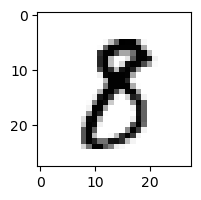

0.012480164935661371% - 0
0.12043930163914425% - 1
0.00018613612926349823% - 2
1.797834646859229% - 3
1.0501639448193741e-06% - 4
1.8961451135813046% - 5 - ОШИБКА
7.804858992624562e-07% - 6
0.0004331762611538326% - 7
0.799097784586875% - 8
1.3116830687058745e-07% - 9

 3


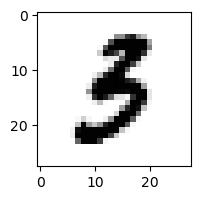

0.0023510658198527697% - 0
0.00244062690951497% - 1
1.3231439961613384e-05% - 2
6.922716737730898% - 3
1.3267245877731797e-05% - 4
10.407477613222254% - 5 - ОШИБКА
0.0012522854491317102% - 6
7.620134027588485e-06% - 7
5.801875039637863e-13% - 8
4.180090907396916e-10% - 9

 8


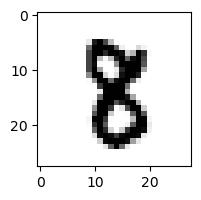

1.6393576256451136e-07% - 0
0.002130591228644763% - 1
2.797124413580166e-06% - 2
0.00010851714832921353% - 3
4.479468108990237e-05% - 4
0.06355534132733116% - 5 - ОШИБКА
6.472371848394851e-07% - 6
0.00018027387258592078% - 7
0.0096855612264656% - 8
2.4373520295514684e-08% - 9

 8


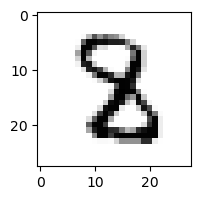

1.0556188231396089e-07% - 0
0.01078169965639713% - 1
0.021848064854846% - 2
0.00025231503308857883% - 3
0.0027986854103606105% - 4
0.11716356598901422% - 5 - ОШИБКА
0.00010256034720842326% - 6
0.0018181502981042016% - 7
3.7019527418006717e-06% - 8
4.5738029714044085e-14% - 9

 8


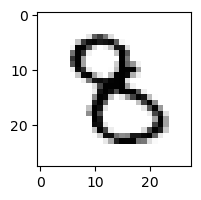

0.0003672986363407254% - 0
0.003886194032826964% - 1
0.00822305310370105% - 2
0.46741798682707875% - 3 - ОШИБКА
0.0025468595478595575% - 4
0.42812122045695467% - 5
0.0009758732663136048% - 6
5.897865153789967e-06% - 7
0.0005648356402528765% - 8
2.234127419092375e-06% - 9

 1


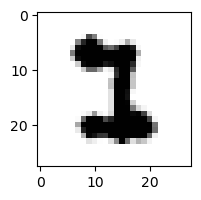

1.403864545525801e-08% - 0
0.00011635617459176888% - 1
6.567330901899441% - 2 - ОШИБКА
7.469438988137638e-05% - 3
4.233505181391942e-11% - 4
0.12469336786531875% - 5
3.384714983794925e-06% - 6
0.0013788477776345957% - 7
3.6587388771201775e-13% - 8
3.607851392196989e-17% - 9

 0


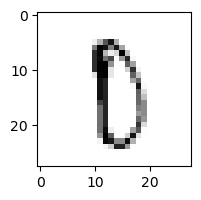

5.494222882153102% - 0
0.0029917497746604683% - 1
0.3846665695890098% - 2
0.06535796287923971% - 3
0.4406155804316433% - 4
87.2619923150735% - 5
1.5920775221271248% - 6
0.7186685080652838% - 7
99.98546914997203% - 8 - ОШИБКА
0.8737342805415741% - 9

 2


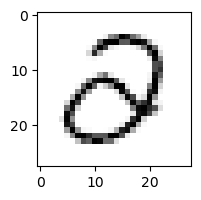

10.256089761068178% - 0
0.0006033793608923194% - 1
0.0018300377854812767% - 2
46.51772621590899% - 3 - ОШИБКА
2.3028370371126257% - 4
0.8457944418974843% - 5
0.04033854171770691% - 6
8.907940120925384e-05% - 7
5.106231594166528e-06% - 8
8.155455904756957e-12% - 9

 9


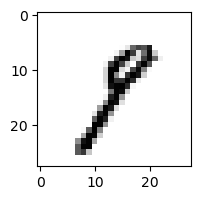

0.008335910839650568% - 0
87.61242479834044% - 1 - ОШИБКА
0.0016342200404278191% - 2
6.746753001071089% - 3
0.00044545314527219944% - 4
0.16409169429585704% - 5
0.0024046414652735856% - 6
7.520308680339516% - 7
1.579909243138471% - 8
0.8074937921431923% - 9

 2


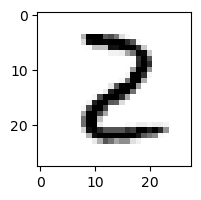

0.0402753358156039% - 0
0.06947306326676822% - 1
98.99635657778451% - 2
0.16228989261480842% - 3
0.00015183246255801792% - 4
0.002955746226684184% - 5
0.00040865380517783774% - 6
4.532754369659563e-06% - 7
99.97062364802905% - 8 - ОШИБКА
8.231870893595906e-07% - 9

 8


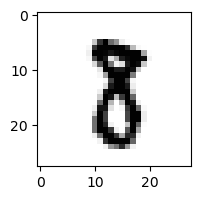

9.8940841755854e-06% - 0
0.15512444801694006% - 1
0.0002088618872393835% - 2
0.26133775771834084% - 3
1.0858246275309811e-07% - 4
0.3007247486839987% - 5 - ОШИБКА
1.5399693157145507e-06% - 6
0.014030125843331563% - 7
0.0012940034904591119% - 8
3.573051478951436e-07% - 9

 6


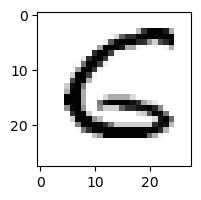

0.19782859699395755% - 0
1.8962355845647038e-06% - 1
25.051717381020204% - 2
5.74436609070555e-09% - 3
0.0030650923732942277% - 4
81.04648337466763% - 5 - ОШИБКА
20.88974050412217% - 6
1.7085972022892958e-07% - 7
1.5884873618315536e-09% - 8
5.2068818288761383e-14% - 9

 5


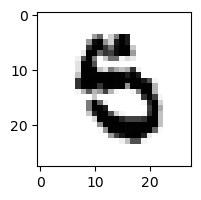

3.3330324815291623e-06% - 0
3.144334711565625e-06% - 1
7.256314609494997e-08% - 2
3.9320518686669014e-08% - 3
5.834553310333125e-06% - 4
0.7259944057563695% - 5
3.7815020358924007% - 6 - ОШИБКА
1.7892828243422735e-07% - 7
4.408194744931206e-10% - 8
2.6966854128396658e-08% - 9

 3


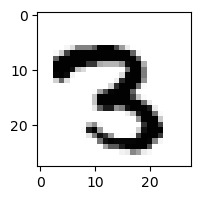

7.078450973778808e-10% - 0
2.3430933907766865e-06% - 1
0.028054101735112892% - 2
0.03484115362662756% - 3
1.1069845410737091e-05% - 4
0.0007968573656013423% - 5
1.840296036408832e-10% - 6
0.09908125376500648% - 7 - ОШИБКА
6.783445758704275e-05% - 8
8.984111965954183e-08% - 9

 9


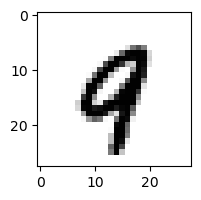

0.00028265481071948565% - 0
0.0004108770262848582% - 1
3.3237986392219287e-06% - 2
5.5609351552263894e-11% - 3
5.98457810313884% - 4 - ОШИБКА
5.1700453896152675e-05% - 5
0.008685755178124812% - 6
1.1183359658647352% - 7
1.4595926105786963e-05% - 8
0.5008537690181156% - 9

 8


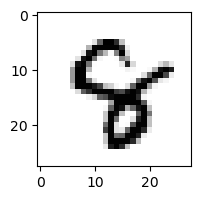

2.1931390168110784e-06% - 0
4.635341037144938e-06% - 1
5.5713052765113695e-06% - 2
8.498015256815573e-08% - 3
1.8587448062922105% - 4 - ОШИБКА
0.01323871834280076% - 5
0.003555271965783564% - 6
0.000942681368168288% - 7
1.1072744624041344e-05% - 8
4.1418004304221974e-07% - 9

 9


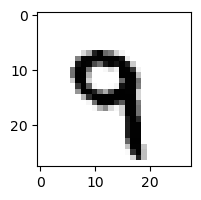

9.154314812466518e-08% - 0
0.03737472470521072% - 1
5.85449307778211e-05% - 2
2.5149561545930256e-06% - 3
2.509146731278622% - 4 - ОШИБКА
0.13005292812671132% - 5
0.009635260591547252% - 6
0.5464705218950078% - 7
1.755048193797814e-07% - 8
2.2415073743584895% - 9

 1


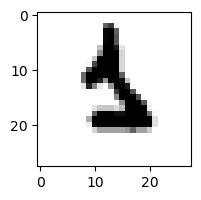

6.16030081201371e-08% - 0
0.0030114081610387463% - 1
8.817817663170198e-06% - 2
3.357794384582262e-08% - 3
2.2364147330969815e-07% - 4
0.9885500564845054% - 5
24.739300257477492% - 6 - ОШИБКА
0.0038757421227148168% - 7
2.255416280364097e-10% - 8
1.8712347724655193e-07% - 9

 8


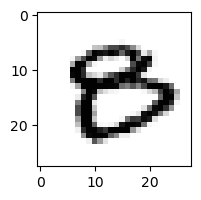

74.73268307256508% - 0 - ОШИБКА
2.9086646254783554e-07% - 1
3.896517255700265e-09% - 2
0.0015970311412221115% - 3
2.210200431611667e-05% - 4
0.010721250188375159% - 5
0.020285509444634333% - 6
1.0869661115788718e-05% - 7
2.5343289864931955e-08% - 8
2.6216982380099056e-06% - 9

 9


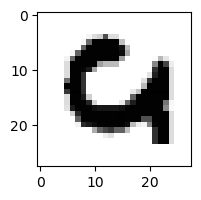

0.42925546951296967% - 0
1.7370032442856639e-12% - 1
3.3136060327902443% - 2
4.102994830856902e-16% - 3
5.7196570967811535e-08% - 4
2.6146300392671064e-07% - 5
4.381559208104123% - 6 - ОШИБКА
2.1780536932569307e-05% - 7
1.4299123757668762e-16% - 8
3.6135061872085026e-15% - 9

 8


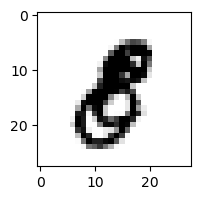

0.02533971997841012% - 0 - ОШИБКА
0.0006618918890053536% - 1
6.927165843198755e-06% - 2
0.00015266415957341663% - 3
3.557854368030486e-07% - 4
0.005173795389432628% - 5
2.8936016695836908e-05% - 6
9.256695177827097e-06% - 7
1.8227454056566983e-06% - 8
1.3289176862116188e-06% - 9

 2


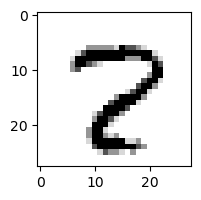

0.004490185403513073% - 0
2.2001266708000267e-06% - 1
0.012197963525090897% - 2
9.748025613976662e-08% - 3
7.193221878967735e-05% - 4
0.04125935688962196% - 5
1.0387339078405535e-06% - 6
95.03854148497149% - 7 - ОШИБКА
48.44658510666642% - 8
0.0009132138722969522% - 9

 3


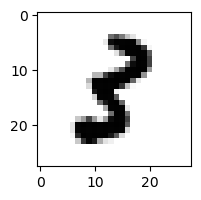

0.0028821098728276824% - 0
0.2638811514864207% - 1
0.0001273843226382439% - 2
0.07646428224957423% - 3
5.64172778643643e-05% - 4
4.263398441357567% - 5 - ОШИБКА
4.415793592190842e-06% - 6
3.85348255821938e-06% - 7
1.9303387252242444e-05% - 8
1.0283855807589865e-11% - 9

 3


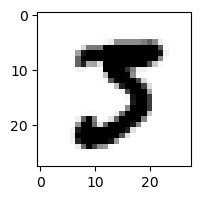

0.038682779074052605% - 0
1.5624510159370132e-06% - 1
1.5314086617076084e-06% - 2
5.30125287599696% - 3
1.0903389875574978e-10% - 4
28.432234876440116% - 5 - ОШИБКА
2.578320971929769e-10% - 6
4.612301322470432% - 7
6.359312027072903e-14% - 8
3.824618063359187e-17% - 9

 7


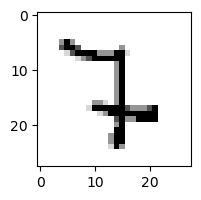

2.3242471917386556e-05% - 0
0.5784405919249467% - 1
15.166367264994845% - 2 - ОШИБКА
0.022728547918403112% - 3
0.008298616768832865% - 4
0.030109136648161013% - 5
0.8692919769292999% - 6
3.254463193052928% - 7
0.007319501964619382% - 8
0.0007085871393169281% - 9

 9


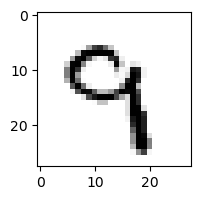

0.0002563208473412501% - 0
0.0030286527858432535% - 1
0.11447455027018584% - 2
3.3282319749438924% - 3
6.675605061927559% - 4 - ОШИБКА
0.5848975465277116% - 5
0.2644418693056357% - 6
1.3424681869946098% - 7
3.860329839026784e-05% - 8
1.6905710044172628% - 9

 5


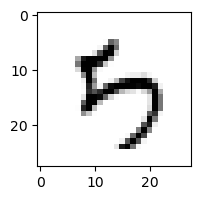

0.13841091368357133% - 0
0.0027820515511084343% - 1
0.3089821617172165% - 2
0.024659891077295906% - 3
39.63098999131709% - 4
4.124121384845605% - 5
35.258013660543% - 6
0.0005471437383678405% - 7
37.07133845912436% - 8
96.06826829397038% - 9 - ОШИБКА

 4


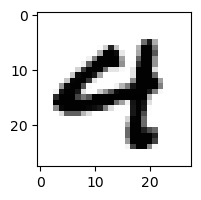

0.001592084134952436% - 0
8.219558591173537e-07% - 1
1.9326400521372523e-07% - 2
7.309315230832641e-13% - 3
6.269660264960744% - 4
1.5952777021575133e-05% - 5
2.2445009697695114e-05% - 6
8.227587757314556e-05% - 7
4.2338871119018225e-09% - 8
14.751960343251497% - 9 - ОШИБКА

 2


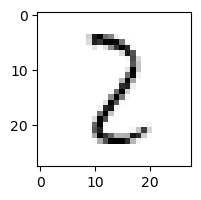

0.15092363632138678% - 0
32.131289932615715% - 1
81.81938858278916% - 2
15.415565854151994% - 3
0.23277015823667502% - 4
0.3352897015214133% - 5
0.0838155371560114% - 6
0.4835123640472633% - 7
99.67554370775967% - 8 - ОШИБКА
0.010158556047270872% - 9

 9


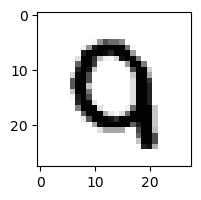

29.77976425118284% - 0 - ОШИБКА
1.84014377762493e-09% - 1
0.5203613660100044% - 2
8.447721773092359e-08% - 3
0.00010385487273100809% - 4
0.005397903688683977% - 5
1.6235793013189053% - 6
0.0025208567763967756% - 7
1.6034525691074175e-11% - 8
0.0003370190499138247% - 9

 9


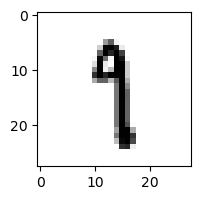

0.00010345257583385115% - 0
77.6178211711565% - 1 - ОШИБКА
0.0005549706375128938% - 2
0.1087972235249591% - 3
0.01989201717773113% - 4
6.79558758401309% - 5
0.08306910999917662% - 6
6.431968321490789% - 7
0.027045408003118075% - 8
0.2557334303505932% - 9

 8


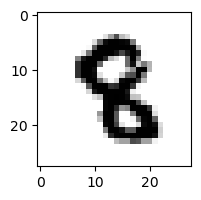

3.329887363428959e-10% - 0
3.29541437170546e-06% - 1
0.000191753646184116% - 2
2.4227817219907133e-07% - 3
0.0026626183446136456% - 4
0.12858864182901827% - 5 - ОШИБКА
8.226895043451859e-06% - 6
3.3796300878265205e-06% - 7
1.040684021799683e-08% - 8
2.6186802545210495e-09% - 9

 8


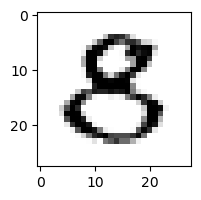

0.09406083301471857% - 0
8.487640184876186e-07% - 1
0.0019685887944557853% - 2
1.938076932201975% - 3
0.0028999832405737897% - 4
34.95072330116473% - 5 - ОШИБКА
1.2760444520338417e-08% - 6
1.278790580864867e-07% - 7
6.978749014356807e-10% - 8
3.2996896499500567e-15% - 9

 4


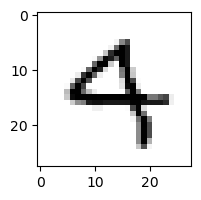

0.02339661894399845% - 0
0.0014283405923033884% - 1
0.0023005256147962724% - 2
0.002349186586541719% - 3
77.25407012556337% - 4
0.08382118814950303% - 5
0.9306749140595414% - 6
0.059645465137941986% - 7
1.109108697978042e-10% - 8
93.05408166498157% - 9 - ОШИБКА

 8


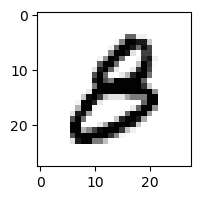

0.35934064121268594% - 0 - ОШИБКА
6.643408994966101e-06% - 1
6.607778102427447e-05% - 2
0.08382151969067414% - 3
0.0006073788127488738% - 4
0.34513878538427606% - 5
0.01962294888287722% - 6
1.4833559086448138e-06% - 7
3.8337057339776576e-07% - 8
3.052783551976683e-07% - 9

 2


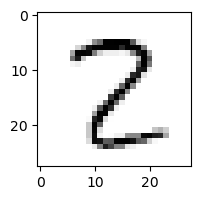

0.02262394855964214% - 0
0.14041304977273772% - 1
87.51440178928172% - 2
1.00826066483581% - 3
0.01571100648470824% - 4
0.1543150760658485% - 5
1.4112975437764193e-05% - 6
0.14607086073724812% - 7
99.9934148348123% - 8 - ОШИБКА
4.230233960637339e-07% - 9

 9


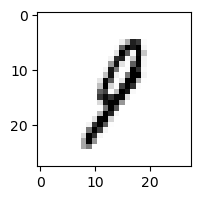

0.028637546922441304% - 0
47.17465364894208% - 1
1.8880384113332933% - 2
6.853488578367218% - 3
0.3518474931003461% - 4
1.0052923854072087% - 5
1.1757523484454053% - 6
0.49384032094017905% - 7
90.11117279679793% - 8 - ОШИБКА
4.473961028986398% - 9

 3


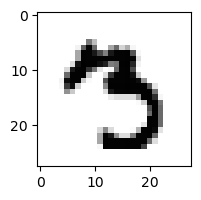

5.621435089482834e-06% - 0
7.006223763025454e-05% - 1
3.069712637199563e-10% - 2
0.005644398586220543% - 3
3.204946358951103e-06% - 4
14.80291001310547% - 5 - ОШИБКА
3.7666744791253366e-08% - 6
0.09889250873522944% - 7
3.4354055714699587e-07% - 8
0.00013113110026324529% - 9

 9


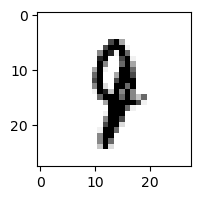

9.843164325627326e-07% - 0
2.991947058790562% - 1
0.0004688095959361271% - 2
0.00020207835866322074% - 3
4.800640056203061% - 4 - ОШИБКА
0.29401654576594716% - 5
0.009885395932634464% - 6
0.25034606266871173% - 7
5.249610180114826e-05% - 8
0.01581003917505902% - 9

 6


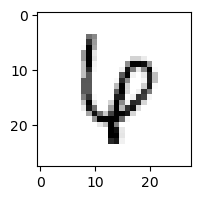

0.004544192839505879% - 0
0.016819553531753587% - 1
0.04373993964478054% - 2
3.843068271665377e-06% - 3
88.42853051688827% - 4 - ОШИБКА
0.0039023622024880757% - 5
1.7549678147646721% - 6
42.98217582495271% - 7
0.00012034724842593265% - 8
0.015079829428190597% - 9

 8


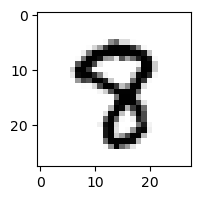

2.4006730901482136e-05% - 0
4.584568956889208e-06% - 1
1.7266024122533436e-07% - 2
7.469248790022555e-06% - 3
0.013772906449416021% - 4
0.905504029866866% - 5 - ОШИБКА
1.7508568550936671e-06% - 6
0.12338543065267908% - 7
0.19357270504875146% - 8
0.0009827866111199305% - 9

 8


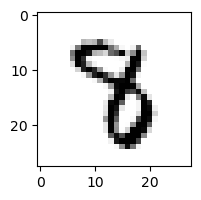

4.616793464858271e-09% - 0
0.05325033832144125% - 1
1.3250098314374898e-05% - 2
0.023875689982436277% - 3
0.07066904446606752% - 4
0.24208676848430488% - 5
3.1991525616786626e-05% - 6
0.3007967509372611% - 7 - ОШИБКА
2.8046759601774644e-07% - 8
1.0437801609094445e-09% - 9

 2


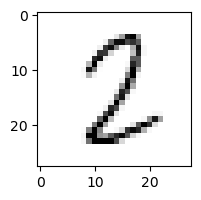

0.33245434252650075% - 0
1.5707219990356378% - 1
61.74080278398083% - 2
0.20616072888609968% - 3
0.048280292442318275% - 4
12.036004895124112% - 5
0.0280966919367407% - 6
0.2097065540279594% - 7
77.59012120289512% - 8 - ОШИБКА
3.727467997571192e-07% - 9

 2


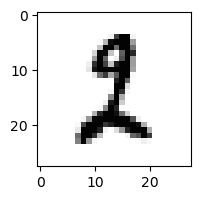

5.2925809705558345e-05% - 0
19.564945212359632% - 1 - ОШИБКА
6.285928394911669% - 2
1.4139759803388518e-06% - 3
7.986002920006115e-09% - 4
1.3797716812807523% - 5
0.01075233222798616% - 6
0.006818039197589914% - 7
2.3522964435440156e-08% - 8
1.1126858606670096e-11% - 9

 0


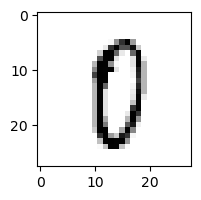

83.85202399116865% - 0
0.00022222053179386792% - 1
0.013345479584774115% - 2
0.002803627071624257% - 3
0.047425637981828514% - 4
79.08841874123686% - 5
0.665874278502038% - 6
0.3287558841929357% - 7
99.92115321867003% - 8 - ОШИБКА
0.07461351411087912% - 9

 3


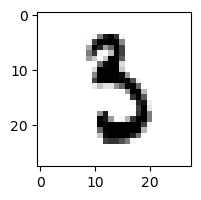

0.0003214074750750645% - 0
0.027910691466666037% - 1
3.412482821979525e-05% - 2
0.5861479306318297% - 3
5.713964999724487e-06% - 4
12.45076648185525% - 5 - ОШИБКА
0.8841262903809181% - 6
0.018042757091682467% - 7
1.7405786153641515e-07% - 8
1.576825935124825e-09% - 9

 2


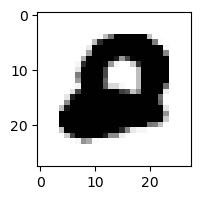

0.0011748073751510126% - 0 - ОШИБКА
7.213162697833711e-16% - 1
1.3153211139821041e-05% - 2
9.794218382852573e-20% - 3
1.0684518552931971e-09% - 4
1.0466584317017896e-06% - 5
2.559753880387259e-07% - 6
1.8648629943201614e-12% - 7
1.210000709061285e-19% - 8
1.5264304544090575e-24% - 9

 7


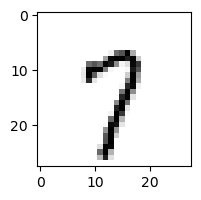

0.04219011690043149% - 0
0.24975925091548892% - 1
0.04528586435124274% - 2
0.0003520352477895661% - 3
0.5676290598666385% - 4
4.310167638283509% - 5
0.14808007467561501% - 6
92.54957916682753% - 7
10.44391332281226% - 8
92.62885448262269% - 9 - ОШИБКА

 8


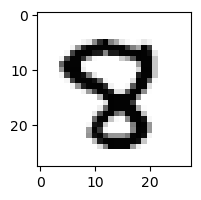

1.972094265756362e-06% - 0
1.83017383617749e-08% - 1
6.930182451364616e-07% - 2
6.891899917037973e-08% - 3
0.0025831591576627668% - 4
0.01527993459851417% - 5 - ОШИБКА
6.6604275056595254e-09% - 6
0.0011166434420008444% - 7
0.0003462121567128496% - 8
1.0318495580763224e-09% - 9

 2


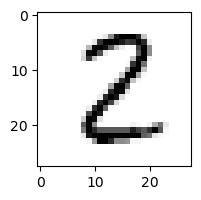

0.021734861964886887% - 0
0.3904386284125317% - 1
76.43582555938302% - 2
0.24777271734527304% - 3
0.00022048300174553899% - 4
0.8334530819332053% - 5
7.903175841200522e-05% - 6
2.520914968516229e-05% - 7
90.81118624762455% - 8 - ОШИБКА
1.1672326528277186e-11% - 9

 9


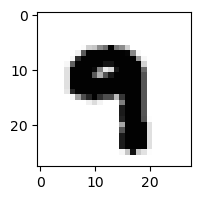

3.825199574436949e-09% - 0
5.579336241267685e-07% - 1
1.9610239766463584e-15% - 2
9.219941504982556e-09% - 3
0.0024103074917905002% - 4
0.2197879979262613% - 5 - ОШИБКА
1.1448489131223459e-07% - 6
0.0007875902495374561% - 7
2.3312941017515612e-15% - 8
0.0050242057851978255% - 9

 7


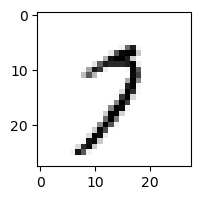

0.768234854261807% - 0
4.467984974203729% - 1
5.188411945222084% - 2
0.005706732017398711% - 3
0.2780381135763852% - 4
0.5755993252777188% - 5
0.17592010882856818% - 6
94.11233778776287% - 7
0.236651387436152% - 8
95.83237301556628% - 9 - ОШИБКА

 2


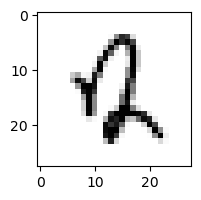

0.3101598020067474% - 0
0.0005307019772261528% - 1
0.5173525929339653% - 2
4.857202152660067e-06% - 3
1.9060958686698173% - 4
1.363830209031017% - 5
3.309253972484816% - 6 - ОШИБКА
0.013459929226112586% - 7
1.3863083707512876e-06% - 8
0.001132865777883426% - 9

 9


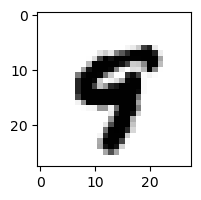

2.2455004238488722e-07% - 0
7.190709127915901e-06% - 1
1.3294645432883256e-12% - 2
5.750245825186257e-12% - 3
0.6959641098486546% - 4
1.5818281750024126% - 5 - ОШИБКА
1.6639056714543527e-06% - 6
0.004342835886312552% - 7
2.926531446640455e-09% - 8
0.014503481957376867% - 9

 7


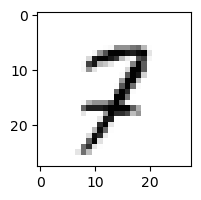

0.006893274734904096% - 0
0.3358263245066589% - 1
15.184435633681382% - 2
0.0006553819073315036% - 3
0.2711935895675234% - 4
0.01016743149237469% - 5
0.006968292565396616% - 6
41.433426182181705% - 7
10.160024110545965% - 8
83.02758090715447% - 9 - ОШИБКА

 9


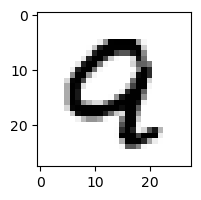

0.004808224678138513% - 0
6.282476738036106e-07% - 1
0.393217934964422% - 2 - ОШИБКА
1.6693800201199996e-13% - 3
0.26466499089940937% - 4
1.2479022341319814e-05% - 5
0.00013589490415739848% - 6
0.0004938086824913768% - 7
0.0007956751552727722% - 8
0.00011810074966662965% - 9

 8


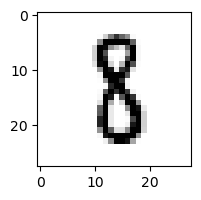

1.52618805244886e-05% - 0
7.02361131535333% - 1 - ОШИБКА
0.027044092376238824% - 2
0.3536991292532655% - 3
0.00014569119791487252% - 4
2.4756171886771265% - 5
0.0049916365019788385% - 6
0.0028680666386488684% - 7
0.016577005026170627% - 8
8.466964186827775e-10% - 9

 3


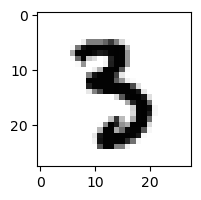

1.4880342135441497e-06% - 0
1.7220832231348164e-05% - 1
3.505791929556649e-09% - 2
4.854088997871886% - 3
0.0001288175726832994% - 4
17.110746222881797% - 5 - ОШИБКА
0.001329461566531232% - 6
0.0010208129713552676% - 7
2.012746607934633e-08% - 8
3.164358905756695e-10% - 9

 7


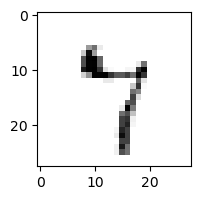

0.5237196940107155% - 0
0.022150837461484607% - 1
0.08070342270000158% - 2
0.07576200930228322% - 3
15.248280052132774% - 4
56.87062964017405% - 5
1.4368379547587624% - 6
96.16328518288772% - 7
99.41040473363677% - 8 - ОШИБКА
1.2890678404716571% - 9

 6


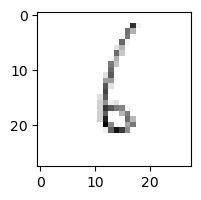

5.25914529434393% - 0
48.241791843255974% - 1
95.45639073667127% - 2
48.55354166955417% - 3
25.73779765207146% - 4
41.98027380842781% - 5
99.69291595794425% - 6
3.9671024276815543% - 7
99.77420736522107% - 8 - ОШИБКА
90.36858272693881% - 9

 3


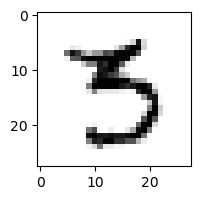

0.0700896729749569% - 0
0.0005128514917327978% - 1
1.864004199424869e-07% - 2
8.621919869044818% - 3
0.00041630429267027586% - 4
87.23828335394349% - 5 - ОШИБКА
0.00028409487887128964% - 6
0.021848007765989497% - 7
0.025195303272256823% - 8
0.000381756877260086% - 9

 9


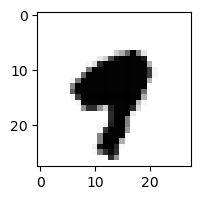

1.0392245106163677e-08% - 0
5.428541335747635e-05% - 1
8.019600764684302e-17% - 2
5.389605593305063e-13% - 3
1.6344542219877638% - 4 - ОШИБКА
0.00024347440296707456% - 5
2.7334169375065277e-06% - 6
0.0011522004192808114% - 7
3.2923122167376474e-13% - 8
0.017289017476316167% - 9

 8


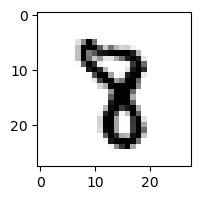

5.015056409274546e-09% - 0
0.0026502030977956195% - 1
8.491487511399336e-06% - 2
4.609548159075971e-05% - 3
0.012225265597378153% - 4
0.10053532197127085% - 5
1.598838992043806e-05% - 6
0.3812404867975767% - 7 - ОШИБКА
0.0039044098241310127% - 8
2.75199416828062e-07% - 9

 5


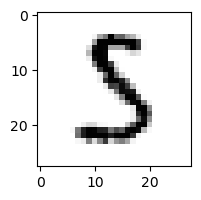

0.0017240885129841466% - 0
0.02578424520012794% - 1
0.14218759219049482% - 2
58.196917125584804% - 3 - ОШИБКА
4.416221052807941e-05% - 4
58.06067357140932% - 5
0.010322708947831168% - 6
0.0012247864329324083% - 7
0.0038925692107566025% - 8
2.912937474244569e-12% - 9

 3


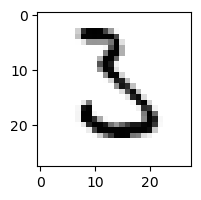

0.13264212842545148% - 0
0.01808325967517943% - 1
72.20550048631577% - 2 - ОШИБКА
17.177742445146382% - 3
1.8497802926172498e-06% - 4
1.9572904467384338% - 5
51.83023763563418% - 6
0.0011989098278248052% - 7
3.354328023968686e-05% - 8
3.1534839858278804e-07% - 9

 7


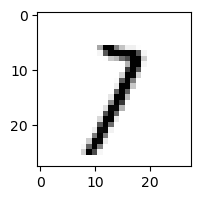

0.020515824919112545% - 0
25.249970534487726% - 1
1.728126276912508% - 2
11.727910143734562% - 3
0.16719186051847626% - 4
0.2146157574641823% - 5
0.02108071033761554% - 6
66.57584071235964% - 7
0.1936409061751104% - 8
75.0574905165808% - 9 - ОШИБКА

 9


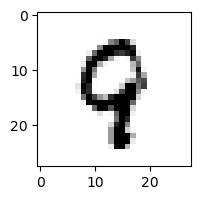

8.992725181800655e-05% - 0
0.0013354858273561595% - 1
0.02141391926795395% - 2
5.3924769208552545e-08% - 3
4.2324826643469455% - 4 - ОШИБКА
0.049990877187548806% - 5
0.029086445202369082% - 6
0.018994296165350765% - 7
0.14853275906998012% - 8
0.49273658146375826% - 9

 5


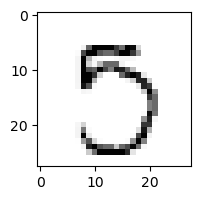

0.28003494996784845% - 0
7.013981606412173e-05% - 1
0.0001980309661616775% - 2
1.8323439644973165% - 3
0.00020238857685164231% - 4
77.31715616864591% - 5
0.009290964906929707% - 6
83.98819116347444% - 7
0.0041901486263629766% - 8
90.97380445623536% - 9 - ОШИБКА

 7


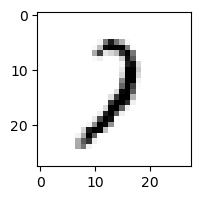

0.019949339173892383% - 0
41.28860334027684% - 1
66.86503599873778% - 2 - ОШИБКА
2.720857168137296% - 3
0.4113922482164691% - 4
0.07199891654899546% - 5
0.17337455075413702% - 6
30.266388715305233% - 7
0.004289594584026362% - 8
0.13773901208903608% - 9

 9


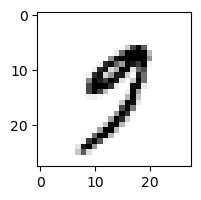

3.3180224364127846% - 0
0.007055032262075439% - 1
2.0541691250079422e-07% - 2
0.5220419809647117% - 3
0.36717126833662916% - 4
6.703389130331199% - 5
0.00011753512704923% - 6
7.6369223848600285% - 7 - ОШИБКА
8.000505901807584e-07% - 8
4.58513823676996% - 9

 9


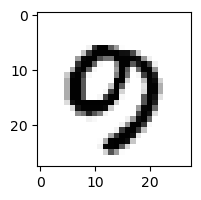

0.01950156590713645% - 0 - ОШИБКА
2.36471747755027e-05% - 1
4.456928723161983e-09% - 2
6.92819962700098e-08% - 3
0.00013567177838381308% - 4
2.6687778804900407e-06% - 5
2.6934426087367368e-05% - 6
0.010110076710545023% - 7
1.2478966802111066e-08% - 8
0.0008332203164343619% - 9

 8


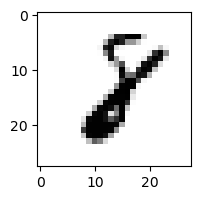

0.00010717140155368387% - 0
8.578437031375898% - 1
16.86097219575233% - 2 - ОШИБКА
1.3605590162368001e-05% - 3
0.00103055449824379% - 4
0.002094760102835301% - 5
0.01905617588070268% - 6
0.056259575366532824% - 7
6.806730683104124% - 8
6.072625151543527e-09% - 9

 7


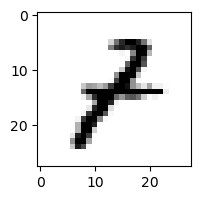

0.10700504291722833% - 0
5.038090718705836% - 1 - ОШИБКА
0.85651223532172% - 2
0.20674881784011295% - 3
0.2691623898143433% - 4
0.03197308230057056% - 5
0.02551414871744653% - 6
0.00010142642442572215% - 7
0.00655194043976428% - 8
0.00039715762118032265% - 9

 2


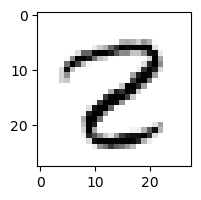

0.00870884219061387% - 0
0.0026891992340955457% - 1
5.163517416257451% - 2
8.181430875487677e-05% - 3
0.0007846513810695167% - 4
0.016237946599632114% - 5
1.0763995030778293e-05% - 6
0.048296768342479174% - 7
99.99999972823812% - 8 - ОШИБКА
2.1100213502950204e-05% - 9

 0


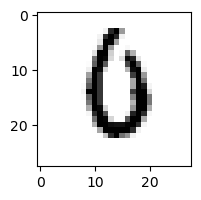

9.807374117154954% - 0
4.8179485439156745e-06% - 1
0.042401480629352964% - 2
9.425414147316093e-06% - 3
0.010074904533798312% - 4
0.3992653540702281% - 5
88.90676748890755% - 6 - ОШИБКА
0.1023165580489876% - 7
8.093673597170113e-08% - 8
0.0001436901041821428% - 9

 2


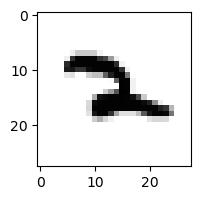

1.842416899381109e-08% - 0
0.20242283183691065% - 1
0.07495560100389692% - 2
4.968989352067698e-08% - 3
0.9535200425457216% - 4
0.09760111684926183% - 5
0.5854436678431651% - 6
24.562677013450042% - 7 - ОШИБКА
0.01213067209791821% - 8
2.7994668697841233e-05% - 9

 4


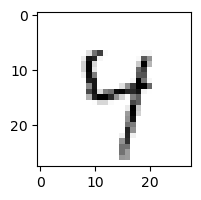

0.12984962187836707% - 0
0.021927468722448187% - 1
0.21895646811889996% - 2
1.699254538127194% - 3
95.79706061238554% - 4
24.36564265930796% - 5
11.848040374702922% - 6
4.30573016837175% - 7
75.38770106033687% - 8
97.77880265805173% - 9 - ОШИБКА

 9


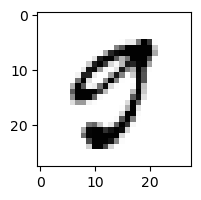

98.33736373989626% - 0 - ОШИБКА
4.979770000552796e-06% - 1
4.9845496989719e-07% - 2
0.0012964624815300938% - 3
0.002707654744361639% - 4
47.203215049881294% - 5
1.602626925232214e-05% - 6
0.02908273761905666% - 7
2.9766019858898826e-08% - 8
0.0038642672600233395% - 9

 6


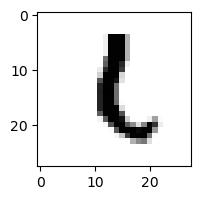

2.481933044917911e-06% - 0
39.47959261370951% - 1 - ОШИБКА
4.538695510454519% - 2
0.0002468511542965784% - 3
0.00014439514950952636% - 4
1.583729715273181% - 5
0.7309978232440579% - 6
6.4928425406354344e-06% - 7
0.0015187278924925333% - 8
0.0006104544386573001% - 9

 5


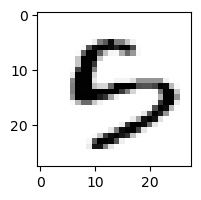

1.0172397687729084% - 0
7.635886754477836e-06% - 1
7.838558156595435e-06% - 2
0.0007666410886876241% - 3
0.17310378665611817% - 4
0.47249042854598783% - 5
12.19863909328673% - 6 - ОШИБКА
8.538023359947666e-07% - 7
0.0004608514450356358% - 8
0.000322892157569047% - 9

 5


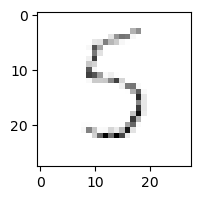

26.722770107961676% - 0
1.702367735880096% - 1
20.676516957373615% - 2
91.56050913345634% - 3
38.86174118327124% - 4
81.84157304731644% - 5
87.02654489348413% - 6
12.889108778838368% - 7
95.9436980207086% - 8 - ОШИБКА
7.60558275747172% - 9

 7


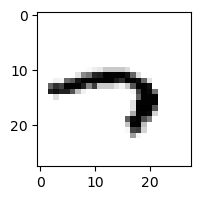

0.1778950670947516% - 0
0.11549065387389075% - 1
1.5637664543787917e-10% - 2
29.8261557508265% - 3
91.47667514798421% - 4 - ОШИБКА
71.28109110272767% - 5
89.90055509014503% - 6
2.324424595122273% - 7
7.317944185206892e-06% - 8
24.904054613011116% - 9

 0


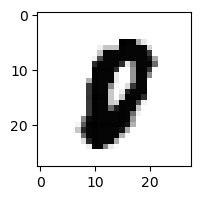

0.04667685725377278% - 0
3.8772891247237364e-08% - 1
1.726278835637136e-06% - 2
1.9745887101379684e-12% - 3
2.3128603311006717e-06% - 4
0.11623268276443544% - 5 - ОШИБКА
5.131662827761992e-05% - 6
0.00013030045505529916% - 7
3.946624252996726e-05% - 8
2.0717032026483196e-08% - 9

 9


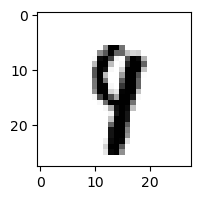

1.3200892755566445e-06% - 0
0.008809113309413799% - 1
1.1952289123569253e-05% - 2
0.00012023963354625632% - 3
9.537160429524423% - 4 - ОШИБКА
0.6793913417297064% - 5
0.00018378206065985394% - 6
3.7401566444010346% - 7
0.0031176772992760377% - 8
0.10500711783551876% - 9

 9


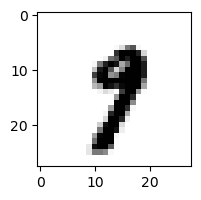

1.869664145738088e-05% - 0
0.12041406721477242% - 1
2.136863052392474e-09% - 2
0.00046995320646984974% - 3
0.012479400964360855% - 4
0.04985253194005713% - 5
7.31370708387751e-06% - 6
13.18403771458359% - 7 - ОШИБКА
5.376153146325836e-05% - 8
0.1073754997348637% - 9

 5


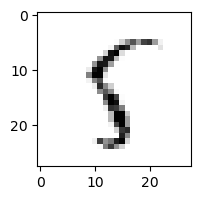

0.02412237698557085% - 0
2.4347620076838106% - 1
1.180535397795692% - 2
7.400771241710133e-05% - 3
27.70436384804526% - 4
90.00984791645695% - 5
7.544744899558924% - 6
0.1169248124800087% - 7
99.84967762529499% - 8 - ОШИБКА
1.3049804502110887% - 9

 1


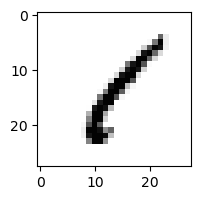

0.44776167195502825% - 0
89.11143749230308% - 1
0.28484794470254127% - 2
0.458579216889599% - 3
0.4189134379509492% - 4
2.3681248081137887% - 5
0.005748500056796338% - 6
0.033505368676490406% - 7
99.81998613069796% - 8 - ОШИБКА
0.017065950944105384% - 9

 8


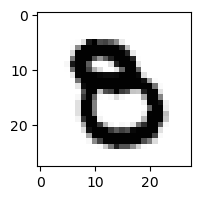

0.0014010459512365677% - 0
3.743652998655708e-09% - 1
2.1092110794998592e-10% - 2
1.278061107631188e-05% - 3
6.131622004807686e-07% - 4
0.6862497343999476% - 5 - ОШИБКА
1.6251805426260925e-06% - 6
1.1413210888167241e-07% - 7
2.0795487598027935e-11% - 8
2.015064420236006e-12% - 9

 9


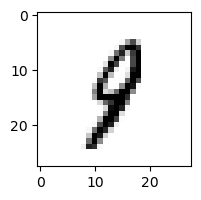

0.0022629666414756655% - 0
5.042837704580565% - 1
0.09442171507495972% - 2
0.011172018475603% - 3
5.904973765688553% - 4 - ОШИБКА
0.7306934920132564% - 5
0.2348533993911012% - 6
1.20296807992809% - 7
1.1206246499367603% - 8
1.6419781184185305% - 9

 3


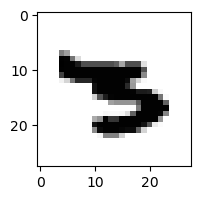

1.6220916753416947e-08% - 0
0.0005160143025628851% - 1
8.489397914097252e-13% - 2
8.950974341226645e-05% - 3
0.0008559208273620263% - 4
2.2033013212904398% - 5 - ОШИБКА
1.57925334636413% - 6
0.0034229038494467665% - 7
1.1457223367533012e-14% - 8
7.141535852884117e-13% - 9

 4


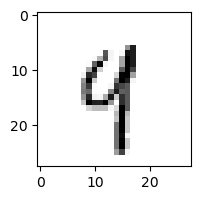

0.0006611510521066603% - 0
10.612997111411538% - 1
0.0016896316315291359% - 2
0.0019344123622525068% - 3
20.742495159223044% - 4
0.7283759059479464% - 5
0.21702886167987023% - 6
1.89985690241061% - 7
0.011532543290523712% - 8
89.6866140906083% - 9 - ОШИБКА

 2


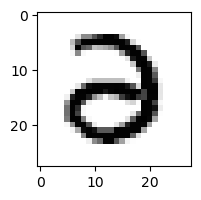

0.3457672533292661% - 0
4.4532802026922633e-08% - 1
0.0859796812910754% - 2
51.684626609880915% - 3 - ОШИБКА
0.001541642182806275% - 4
0.00016890666308689694% - 5
5.7458278851441664e-05% - 6
1.506371915038704e-08% - 7
1.8510497997413147e-13% - 8
7.138621601078027e-13% - 9

 8


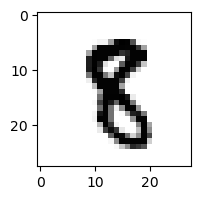

2.3220578425887198e-07% - 0
0.007373542141419507% - 1
1.5603445282656497e-05% - 2
3.6254032755777835e-05% - 3
6.604915781382644e-05% - 4
2.690978421312154% - 5 - ОШИБКА
7.520746670217174e-07% - 6
5.348818805553476e-05% - 7
0.00021734653996278313% - 8
2.8418157683343176e-07% - 9

 9


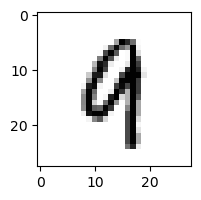

0.0006317619376937114% - 0
0.0915427174008013% - 1
0.0036721559296853763% - 2
2.8420346255062957e-07% - 3
5.018047367284025% - 4 - ОШИБКА
0.0013385855763146722% - 5
0.05388708734671146% - 6
0.036910829743941526% - 7
0.0036989322274640726% - 8
1.018592130364114% - 9

 5


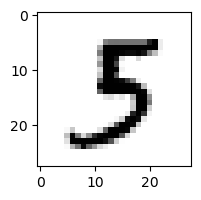

0.003649932008234489% - 0
0.02728674904363448% - 1
6.31972085026854e-07% - 2
95.30100422744593% - 3 - ОШИБКА
3.7610739202236505e-05% - 4
53.08292679311148% - 5
0.008445029961296497% - 6
0.000525645445619107% - 7
7.509528199038516e-06% - 8
1.7791314736598297e-06% - 9

 8


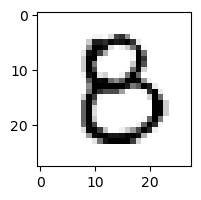

6.004207376668388% - 0
1.3427599464850042e-05% - 1
0.003826140794514576% - 2
0.15321908555152333% - 3
0.14624565156657832% - 4
26.491534474911216% - 5 - ОШИБКА
0.0005304302440694434% - 6
5.315698329406696e-07% - 7
0.4449606245628916% - 8
4.283891233666962e-10% - 9

 5


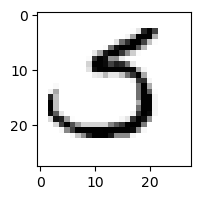

10.770952308534975% - 0
0.0013738925917746066% - 1
6.230067188700046% - 2
29.703884813388488% - 3 - ОШИБКА
2.771748904851636e-07% - 4
19.33921850310119% - 5
1.3142726080328948% - 6
0.5885191790398132% - 7
4.507370217311021e-08% - 8
3.4639071540938106e-08% - 9

 7


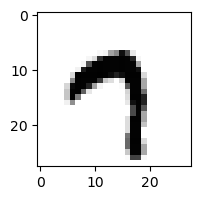

0.03904459467110968% - 0
0.0024611533494565507% - 1
6.158953438168087e-12% - 2
2.3586575956526046e-06% - 3
0.0378442242082289% - 4
1.0104398127988197% - 5
0.0006914941657389859% - 6
76.04182774613875% - 7
3.6114307490269885e-10% - 8
91.7765428662016% - 9 - ОШИБКА

 8


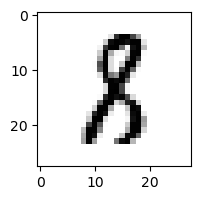

0.00016381045955883382% - 0
11.045438572808033% - 1 - ОШИБКА
0.2516814971951021% - 2
0.013260616229018236% - 3
1.1072039906085679e-05% - 4
0.4989020774592243% - 5
0.000950038635089437% - 6
0.00012500672742623724% - 7
0.05244560634594654% - 8
9.866544616290612e-10% - 9

 3


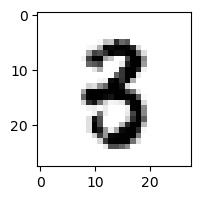

0.0009000065177354976% - 0
0.0012264715698331677% - 1
0.001407042239014487% - 2
1.1783075423572547% - 3
0.0003309168050696152% - 4
1.4328858824836672% - 5 - ОШИБКА
1.13239625167685e-05% - 6
4.552274954588315e-05% - 7
7.043667493020735e-06% - 8
1.1524808623328878e-07% - 9

 9


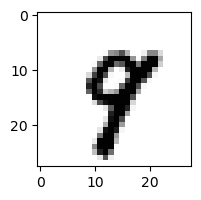

8.189846868828916e-06% - 0
0.0006091115330410013% - 1
7.659347053866731e-08% - 2
7.47991377143307e-07% - 3
3.116024066293723% - 4
0.019957536887111233% - 5
1.2107009129651656e-05% - 6
13.438437876810852% - 7 - ОШИБКА
0.00494520061122776% - 8
0.597885467952189% - 9

 9


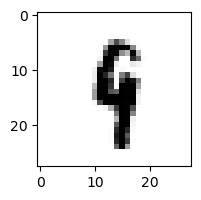

2.82998630465746e-07% - 0
0.3096256063757153% - 1
0.0003028922405066635% - 2
0.006432639165323792% - 3
14.802848362462948% - 4 - ОШИБКА
3.9547552505073913% - 5
0.0464052282650199% - 6
0.007008383059502115% - 7
1.7284500198870005% - 8
1.5423346095736825% - 9

 8


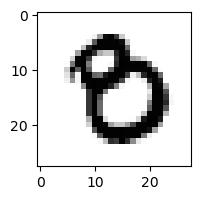

7.094756991711308% - 0 - ОШИБКА
1.3662308268606286e-07% - 1
5.636671420843372e-09% - 2
0.0003071123225746443% - 3
8.22978767707221e-09% - 4
4.73120054683955e-05% - 5
0.00039792988046794225% - 6
1.378105474441624e-06% - 7
2.707880863920176e-10% - 8
2.6686431481724163e-13% - 9

 8


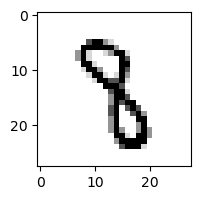

3.398546570275977e-08% - 0
0.40089514064071347% - 1
0.0014438896093882706% - 2
0.02640772225368347% - 3
0.41535566634812326% - 4
2.208042929616262% - 5 - ОШИБКА
0.00086811886464494% - 6
0.01851228268139101% - 7
6.45069433558825e-05% - 8
1.788873233643824e-05% - 9

 3


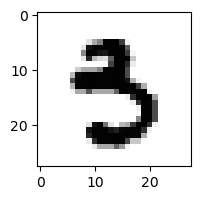

0.0003155835590357472% - 0
1.2889940355272187e-05% - 1
4.1185788908988063e-14% - 2
0.07476805047015656% - 3
1.2616749599731702e-05% - 4
75.37181669557957% - 5 - ОШИБКА
0.00013289859495970794% - 6
7.659526482790451e-05% - 7
3.27148518264963e-12% - 8
1.4456644900648411e-09% - 9

 4


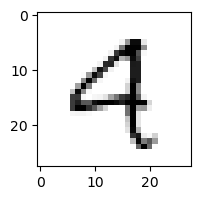

1.6469956480374848% - 0
0.0021596952716024568% - 1
0.1049784111033604% - 2
9.753783127741618e-05% - 3
73.12577797797185% - 4
0.00589920275250756% - 5
0.1341716111408897% - 6
0.14290002962644538% - 7
0.00018742374374723154% - 8
89.94801704038493% - 9 - ОШИБКА

 3


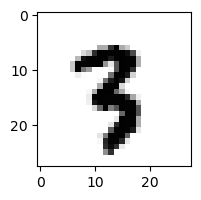

8.351282655383417e-08% - 0
0.006043620027083165% - 1
0.00010138494952534587% - 2
0.00045840367805235696% - 3
6.67094534688584e-05% - 4
0.7651148665329512% - 5 - ОШИБКА
2.9837395648071318e-05% - 6
0.006803098882061864% - 7
4.722408839843876e-05% - 8
1.75545505304369e-05% - 9

 5


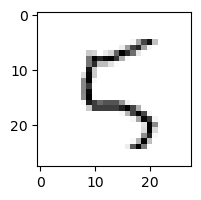

2.2784673485461036% - 0
0.022451708353394047% - 1
75.26790005845228% - 2
0.0029206106128762985% - 3
24.472003044973967% - 4
27.882164609134353% - 5
39.406445134699894% - 6
0.09797657095108087% - 7
7.48144293303568% - 8
99.90122967779293% - 9 - ОШИБКА

 3


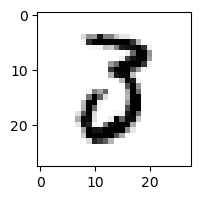

31.192837475528844% - 0
0.001108569193593719% - 1
48.558551827206905% - 2 - ОШИБКА
3.160683072423933% - 3
3.719719177437074e-05% - 4
0.0462518711914951% - 5
0.00010167674303848296% - 6
0.017503139760966558% - 7
1.9617699208543167e-09% - 8
2.6478780398988263e-11% - 9

 5


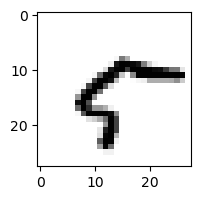

97.98096744923146% - 0 - ОШИБКА
0.01245405185810512% - 1
2.495532717235602e-05% - 2
1.7566247317811126e-05% - 3
1.1326067149755794% - 4
9.437785141138415e-06% - 5
1.820320719357961% - 6
1.237978182936148% - 7
1.4634260114365145% - 8
0.06459879975664708% - 9

 3


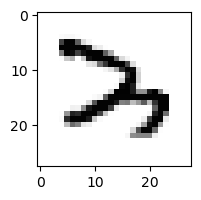

8.211268113220563e-05% - 0
0.0011021182029592883% - 1
99.49329669788199% - 2 - ОШИБКА
0.12785489613968826% - 3
0.07513672828224377% - 4
2.3902541928972027e-05% - 5
0.09041275702641344% - 6
0.33770734130627567% - 7
4.8445374806313965e-06% - 8
1.903942523630816e-07% - 9

 5


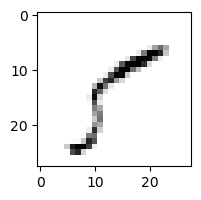

97.13967372467215% - 0
31.672231070540857% - 1
0.030965897610804167% - 2
98.80318990280271% - 3 - ОШИБКА
11.54218579426541% - 4
65.02761348884246% - 5
0.006897103258240859% - 6
44.091856310279844% - 7
1.2593642250736496% - 8
1.0120616551877726% - 9

 0


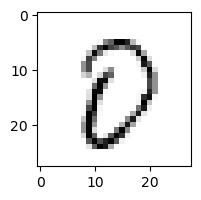

99.59311047313813% - 0
4.088566321551758e-05% - 1
0.152422368579203% - 2
1.2914964268588023% - 3
0.22338805264685924% - 4
28.545599256923865% - 5
1.1554183490068033% - 6
0.05506035702482773% - 7
99.71656321703476% - 8 - ОШИБКА
0.00010875547325703045% - 9

 3


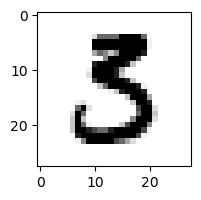

0.004960636439562835% - 0
3.088299608224282e-05% - 1
1.4882981683589926e-05% - 2
0.4735318669575616% - 3
1.6255266105264037e-09% - 4
9.76224034750438% - 5 - ОШИБКА
3.0618670674692265e-06% - 6
1.4021700532629072e-06% - 7
2.1242203172438596e-10% - 8
1.3872805386726353e-14% - 9

 3


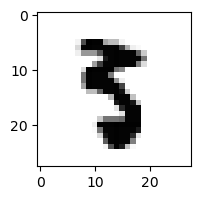

4.49981006518438e-06% - 0
2.9181223070434947e-05% - 1
3.326353112649886e-09% - 2
4.5009132816861976e-05% - 3
1.4691711007021265e-05% - 4
54.35463441639228% - 5 - ОШИБКА
7.821503930268018e-05% - 6
0.0009915016579840716% - 7
1.6137356515924782e-08% - 8
7.497504428074476e-08% - 9

 5


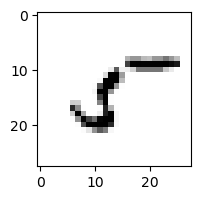

20.97492633499353% - 0
2.8984999318810383% - 1
5.827159135441163% - 2
3.447325118247991% - 3
0.1334082757973546% - 4
99.46764569184157% - 5
0.40383819031304063% - 6
0.046871468029620784% - 7
99.69125919125472% - 8 - ОШИБКА
0.0017343711879750524% - 9

 8


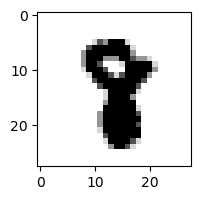

3.634399581410901e-11% - 0
0.00016494468506245542% - 1
1.4101556928454345e-08% - 2
7.545533043446191e-09% - 3
1.5389800399523384e-05% - 4
0.0020187924539277597% - 5
4.9952602589209806e-08% - 6
0.002551310339202251% - 7 - ОШИБКА
2.3058019225105254e-05% - 8
1.1805083487362244e-11% - 9

 5


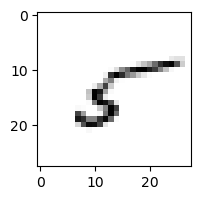

15.187512645304171% - 0
6.681016893742626% - 1
78.75063348400933% - 2
0.6069172867091781% - 3
8.328954532068769% - 4
85.76710162842117% - 5
15.361618068578991% - 6
0.8531122516485795% - 7
99.77260825091683% - 8 - ОШИБКА
0.2886150991533941% - 9

 5


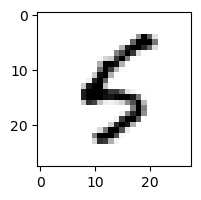

0.8126207677844819% - 0
0.0013461387109699272% - 1
0.0009741560228050994% - 2
0.015299163416786611% - 3
14.70912423674974% - 4
83.9165029595101% - 5
88.59442960524169% - 6 - ОШИБКА
0.0010901247490622498% - 7
2.708900836405875e-05% - 8
0.09956588201237657% - 9

 8


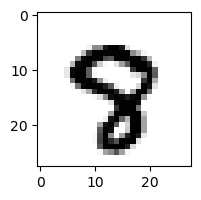

9.99086445452394e-06% - 0
6.695405576330952e-09% - 1
1.2867098723252178e-09% - 2
2.1813274483019214e-08% - 3
0.0016085837831281416% - 4
0.23724906270045498% - 5 - ОШИБКА
1.4617091517059487e-07% - 6
0.21574580492464443% - 7
4.578916316252576e-07% - 8
0.00019137670890570252% - 9

 6


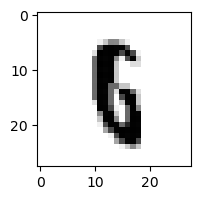

2.020633510565906e-06% - 0
0.007299716984135529% - 1
0.0016708738774419325% - 2
8.03952782159411e-06% - 3
0.004640816093537441% - 4
27.61026766047901% - 5 - ОШИБКА
1.4474998751359869% - 6
0.0004740126435148253% - 7
0.0036068991259078638% - 8
0.0006209534861348449% - 9

 4


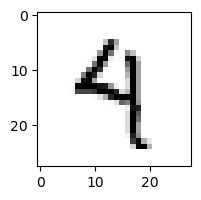

0.025098224695568577% - 0
0.016337408853451606% - 1
0.00047155158378551056% - 2
0.017711915147038213% - 3
80.34464934698933% - 4
8.780801196438055% - 5
0.15524241226492233% - 6
0.1302222233985272% - 7
0.005007589519682609% - 8
89.1333984565574% - 9 - ОШИБКА

 9


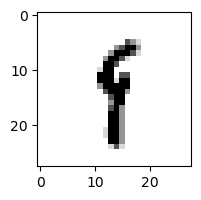

1.4378142898716642e-05% - 0
44.01155213543766% - 1
0.00036078822437968585% - 2
0.035399215590856604% - 3
0.6239200104651818% - 4
13.777766904897504% - 5
1.2111589989792715% - 6
0.11004815553151585% - 7
54.549091462263654% - 8 - ОШИБКА
12.419766552910314% - 9

 8


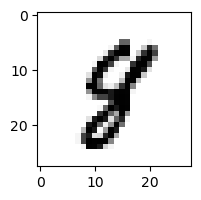

0.00018944449469512803% - 0
0.01112824155131345% - 1
2.3635783268218816e-05% - 2
1.642147602256986e-06% - 3
0.036503517309225235% - 4
1.2322586492335565% - 5 - ОШИБКА
2.9331383297688227e-05% - 6
0.040574136019752786% - 7
0.11038774763999716% - 8
0.001011688581635021% - 9

 8


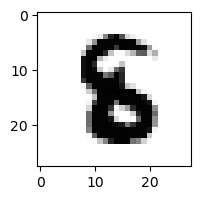

5.949208099862907e-09% - 0
2.5304377916812516e-06% - 1
1.3150132235961495e-06% - 2
6.8594451125887385e-09% - 3
2.6568311890289315e-05% - 4
2.7637545244875503% - 5 - ОШИБКА
0.03192917879970487% - 6
7.685624873016293e-10% - 7
7.981712126736355e-08% - 8
2.1654600575712295e-18% - 9

 4


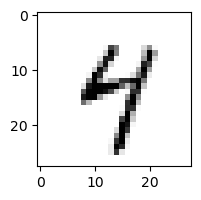

0.24015876464873726% - 0
0.0022246492137627844% - 1
8.435793438136324e-05% - 2
0.09964378265810865% - 3
92.46107226027358% - 4
24.09114740935598% - 5
0.16604480336825872% - 6
0.04280193098547496% - 7
0.07026069423800672% - 8
97.63392040113845% - 9 - ОШИБКА

 6


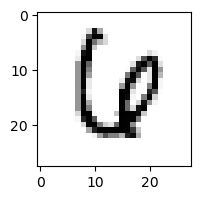

0.23328534833914247% - 0
2.1524531644435624e-05% - 1
0.10400080055510891% - 2
0.0018802162762158968% - 3
5.785178882535049% - 4 - ОШИБКА
0.0049862925775125706% - 5
2.978797910011366% - 6
4.109135738585213% - 7
0.001037868736933393% - 8
2.58392538393897e-07% - 9

 3


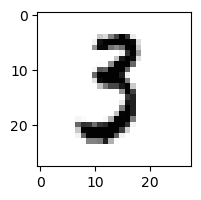

0.024611998372221267% - 0
0.22015447754197567% - 1
0.0021272230947063215% - 2
4.310391867967196% - 3
2.1485782239532894e-06% - 4
20.082749656302166% - 5 - ОШИБКА
0.003605674634849188% - 6
0.004445363878406066% - 7
2.0079732951227179e-07% - 8
1.0902489273629021e-10% - 9

 9


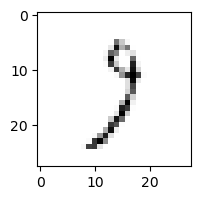

19.85123861160028% - 0
13.160386847000835% - 1
52.712026600640215% - 2
88.15935934856861% - 3 - ОШИБКА
5.566534082582383% - 4
2.9186284401462435% - 5
1.4574738891629306% - 6
84.67532292833336% - 7
25.489576199221865% - 8
65.51892520710445% - 9

 8


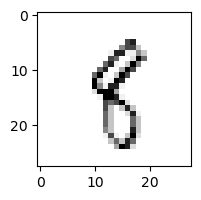

0.0022162172037649072% - 0
25.00559941441855% - 1 - ОШИБКА
0.011292934173609532% - 2
0.4416330853439533% - 3
5.143264050231264% - 4
22.145889992623374% - 5
0.0049367899378507055% - 6
0.07086910373580889% - 7
5.922841536148679% - 8
1.7832829988083634% - 9

 1


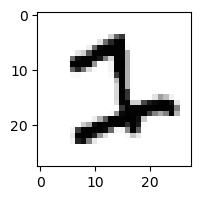

0.000576016816879717% - 0
0.00252108845742206% - 1
86.97146505726096% - 2 - ОШИБКА
23.758552837160487% - 3
1.3570790814425751e-08% - 4
2.098252978117355% - 5
0.030892218014764272% - 6
0.5284708567916415% - 7
4.1550467095803537e-13% - 8
1.0071986568416113e-13% - 9

 3


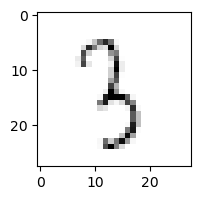

0.019133666900629873% - 0
29.84175204197151% - 1
38.25814087439981% - 2
95.62334285073874% - 3
0.3178094414011251% - 4
18.965961497317334% - 5
1.4739216395630486% - 6
0.6488328606405641% - 7
97.45733538793567% - 8 - ОШИБКА
0.35731955854171277% - 9

 7


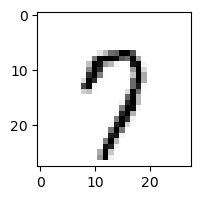

2.940495722657969% - 0
0.0003640966656120395% - 1
0.0026111219749927073% - 2
0.004410640874876984% - 3
0.3546281808701009% - 4
8.189636693493005% - 5
0.15977928919305356% - 6
78.01220978917499% - 7
0.12139691127547911% - 8
95.78378293759766% - 9 - ОШИБКА

 2


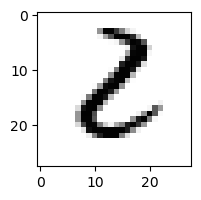

13.541477387537087% - 0 - ОШИБКА
0.2694477597232261% - 1
5.454780588827949% - 2
5.0477393630327025% - 3
9.81959858292141e-06% - 4
0.6327020593359808% - 5
0.45764637904167915% - 6
4.5760456876033904e-07% - 7
0.0003499532526748342% - 8
2.6354675998749343e-09% - 9

 3


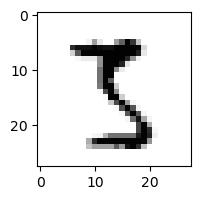

0.0025887799431823497% - 0
0.0006293472165767738% - 1
0.031651876178876964% - 2
26.129278352076547% - 3
5.859570122856386e-05% - 4
45.98974565041696% - 5
2.5854750042374035e-06% - 6
0.00829871359105156% - 7
58.018548326227915% - 8 - ОШИБКА
6.537689506772536e-05% - 9

 3


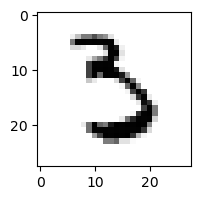

0.008747305121572941% - 0
0.0017778551056377694% - 1
0.030113932850220328% - 2
5.400521313684566% - 3
5.7746839067711174e-06% - 4
53.645462740725414% - 5 - ОШИБКА
1.9415997081515484% - 6
0.09882437451656323% - 7
1.4855876899800444e-06% - 8
7.775254181721995e-09% - 9

 4


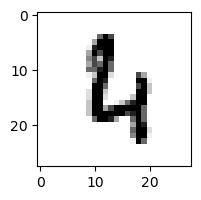

0.0026462141374131633% - 0
6.745950960373253e-06% - 1
27.281594268378782% - 2
1.781268374490268e-08% - 3
18.466760818551247% - 4
1.213114872006956% - 5
32.11967678368558% - 6 - ОШИБКА
0.028066828091213553% - 7
0.0027341575630972356% - 8
0.008775014021335875% - 9

 5


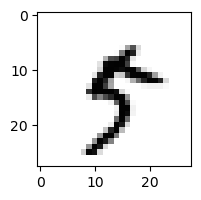

0.022806186458436375% - 0
0.03716706372127061% - 1
1.738264877176856e-06% - 2
0.09934752606157854% - 3
0.22224872504195073% - 4
0.00564801705409303% - 5
0.12251814973778502% - 6
1.7794551204111528% - 7
0.13566427307737153% - 8
22.76323070547261% - 9 - ОШИБКА

 5


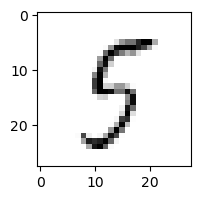

3.7774339190424464% - 0
0.01118626930457088% - 1
0.12175631047368701% - 2
2.7492547047100695% - 3
8.217135487038556% - 4
94.08150749130584% - 5
5.776027146322068% - 6
0.022227775044818612% - 7
94.53240363157843% - 8 - ОШИБКА
3.021534238797472% - 9

 6


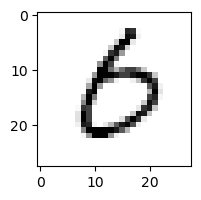

92.9860118085804% - 0 - ОШИБКА
0.0010520583801393764% - 1
0.007382465782199864% - 2
0.38996713133183686% - 3
0.0029314120544013016% - 4
0.18998474713904073% - 5
81.36943022301267% - 6
0.1416273874218543% - 7
0.00022707180647534218% - 8
0.000129836070123398% - 9

 1


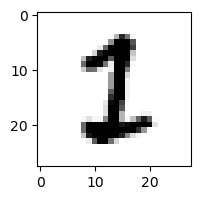

1.505544015066003e-05% - 0
2.2988835289214795% - 1
0.9799268242855562% - 2
0.00012093388191453882% - 3
2.9635135392300515e-09% - 4
6.211950948965592% - 5 - ОШИБКА
0.0017088028001156488% - 6
0.00032929215176483065% - 7
2.305757843861342e-06% - 8
2.262864764981644e-11% - 9

 4


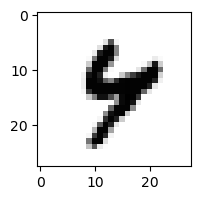

4.10593783417865e-06% - 0
0.0007182038563889653% - 1
2.835646588642106e-07% - 2
4.7082602702226283e-08% - 3
44.85882207140395% - 4
0.031480647883378086% - 5
0.052137582623639184% - 6
0.014502861902520437% - 7
3.253772713845706% - 8
58.26547141176185% - 9 - ОШИБКА

 7


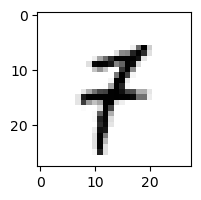

0.003305630233667362% - 0
13.509293278539985% - 1 - ОШИБКА
0.14634378152257266% - 2
0.00269632588110121% - 3
0.13851511681885603% - 4
0.6148876028118729% - 5
0.019643552723986792% - 6
0.1914885083264615% - 7
2.6226966741447602e-05% - 8
10.710010014908834% - 9

 8


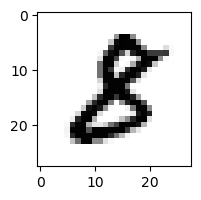

0.0009271308766515346% - 0
0.001553151015686404% - 1
0.003893550975260562% - 2
0.17492226434767721% - 3
7.166535668238616e-08% - 4
0.23434167390712826% - 5 - ОШИБКА
1.2272780996720145e-06% - 6
7.003827447521447e-07% - 7
0.06369988455143441% - 8
1.925001360606901e-11% - 9

 5


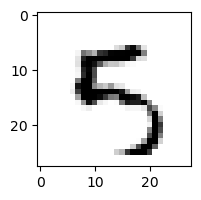

0.10511542012058134% - 0
7.548608496570166e-06% - 1
0.020535800876446558% - 2
0.00035523436230542243% - 3
0.7370542791234685% - 4
84.23547586191657% - 5
0.13820928137594046% - 6
0.006511420211691193% - 7
2.0745011569697034e-06% - 8
99.99990340391729% - 9 - ОШИБКА

 3


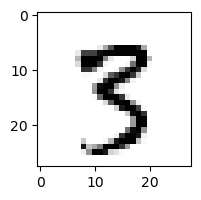

5.121250932847659e-06% - 0
0.0006326979347282049% - 1
2.642695988002954e-05% - 2
15.52681080451554% - 3
0.001544490204280149% - 4
27.717194323639934% - 5 - ОШИБКА
1.1570455015922648e-07% - 6
0.10224213504238444% - 7
0.03832039612667395% - 8
0.0005135524384264573% - 9

 2


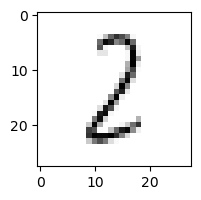

0.37495752926946746% - 0
39.98773456045957% - 1
81.88830688935971% - 2
10.267763298940519% - 3
0.1358616123364542% - 4
1.438824672773334% - 5
1.3824384948731498% - 6
0.2906621943976295% - 7
90.6039113524871% - 8 - ОШИБКА
5.959834330839879e-05% - 9

 8


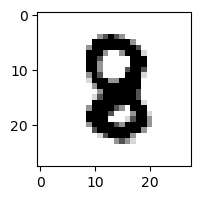

2.1221443887135342e-08% - 0
2.2336948932383166e-05% - 1
0.0006195190164196166% - 2
4.89786755765467e-08% - 3
0.0001139673523544332% - 4
0.0012343622904093519% - 5 - ОШИБКА
0.0009189627832842555% - 6
3.931232300344017e-07% - 7
0.00013658587205021358% - 8
1.5156449627509585e-12% - 9

 9


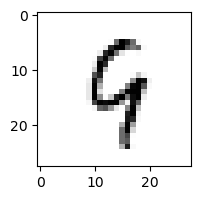

0.01227461281124027% - 0
0.021802862764103106% - 1
7.951478155412753% - 2
0.003990560099619084% - 3
58.460873357475485% - 4 - ОШИБКА
5.038302942407544% - 5
26.26929990233605% - 6
0.15686280042039516% - 7
34.17309948274021% - 8
51.473092317749135% - 9

 8


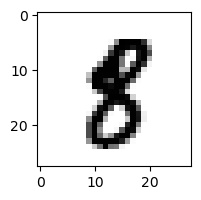

8.09924350780843e-06% - 0
0.04917453098671914% - 1
7.925501150020352e-09% - 2
5.4316694510238426e-06% - 3
8.900052919208984e-06% - 4
1.2364969599422728% - 5 - ОШИБКА
1.4317225056339586e-06% - 6
2.875154016813149e-05% - 7
0.511166495945803% - 8
5.988993422285333e-09% - 9

 7


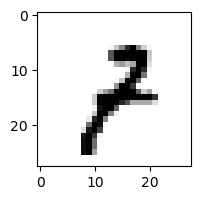

0.0022110173315936367% - 0
0.4761303155576554% - 1
0.23410693794246404% - 2
0.3046111384732019% - 3
0.025131367654551602% - 4
0.0016821684891469263% - 5
0.0036859613042972616% - 6
7.677417043427154% - 7
0.004165795776585127% - 8
42.79040821959263% - 9 - ОШИБКА

 8


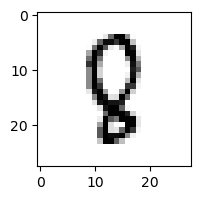

0.0002173190700703184% - 0
0.006707288802121653% - 1
1.8826429392903181% - 2
2.0552984374517678e-06% - 3
2.667248704930761% - 4
3.124779250736503% - 5 - ОШИБКА
0.09502246904884414% - 6
0.006331552880049688% - 7
2.487611746384107% - 8
2.845785154491137e-07% - 9

 7


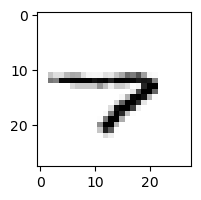

0.01983437521641448% - 0
0.6612722374286303% - 1
9.374450818527859e-06% - 2
0.0030150750068882897% - 3
99.67973482998352% - 4 - ОШИБКА
2.397726071534627% - 5
89.69235312619614% - 6
33.657039724490986% - 7
0.0007311510105640934% - 8
85.84007419253713% - 9

 3


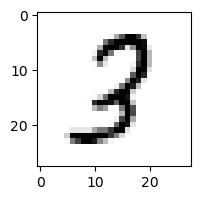

0.016105157820833525% - 0
0.2582187802645485% - 1
52.53227296588781% - 2 - ОШИБКА
22.20937819202011% - 3
0.011591194953858722% - 4
0.06230694415010599% - 5
0.002584893532874719% - 6
0.0057246143334009495% - 7
21.50095347520401% - 8
7.669774416456761e-07% - 9

 8


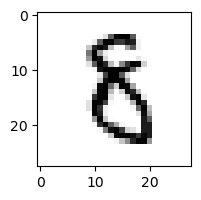

0.0008911001433218469% - 0
0.04788985205315334% - 1
0.11546268278402702% - 2
0.14825604221955188% - 3
0.007091983702822751% - 4
3.255087637240306% - 5 - ОШИБКА
0.11933937962490704% - 6
0.00017943721424728727% - 7
3.682393706282161e-05% - 8
7.818642904960464e-10% - 9

 8


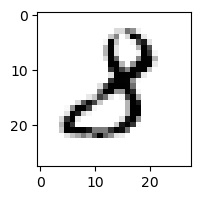

0.04060640833384378% - 0
0.06997209894994327% - 1
0.8659305332556859% - 2
92.12391475557207% - 3 - ОШИБКА
0.0005906253888087372% - 4
0.025372032063681844% - 5
3.841495683795609e-05% - 6
0.0007370876047595588% - 7
2.4738359656622255e-08% - 8
2.0786080083868007e-06% - 9

 8


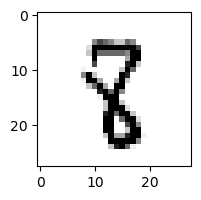

5.354059067456611e-06% - 0
0.4629438151817015% - 1
0.0035816302540719706% - 2
0.0009942315215606692% - 3
0.15546828361666792% - 4
2.1099167462485777% - 5 - ОШИБКА
0.00021834147537805668% - 6
0.0025359996630733507% - 7
0.0006712964587123781% - 8
7.472085492292612e-06% - 9

 7


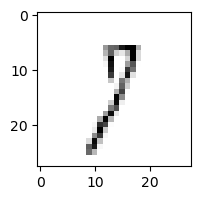

5.17533078373199% - 0
45.55377070441674% - 1
17.893449035939657% - 2
65.95020588686386% - 3
0.500454230128806% - 4
10.068995713640142% - 5
2.7777694880671433% - 6
74.54704187613133% - 7
31.855421557362142% - 8
92.00747308570111% - 9 - ОШИБКА

 9


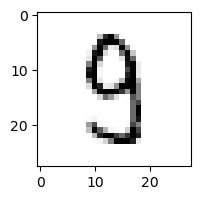

0.03186142450487416% - 0
0.00806305860150316% - 1
0.019138597618040824% - 2
3.0756546099147384% - 3
0.7888492979044667% - 4
9.835859384070494% - 5 - ОШИБКА
0.002592387139193485% - 6
0.03548237347474509% - 7
1.226823597912988% - 8
0.0005285392418796983% - 9

 8


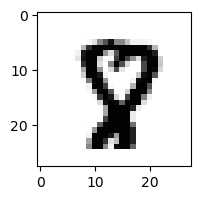

1.3781661594702529e-05% - 0
1.8081770605887285e-08% - 1
5.287104596200527e-07% - 2
1.7162704870697276e-09% - 3
0.0017833568121924034% - 4
0.6482115734282572% - 5 - ОШИБКА
4.5557158460195124e-08% - 6
0.05582315099394871% - 7
0.00010550535249384818% - 8
1.7295945633791243e-09% - 9

 6


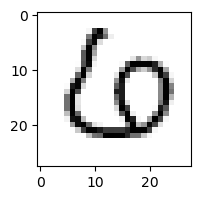

0.19825303454836293% - 0 - ОШИБКА
0.00012695138826198578% - 1
0.003341681000324645% - 2
0.01145035337626164% - 3
0.0007790014920181126% - 4
0.0006064880393521735% - 5
0.00039759596710765534% - 6
0.0014743757325513841% - 7
1.999951380058932e-07% - 8
2.4618012915793988e-11% - 9

 7


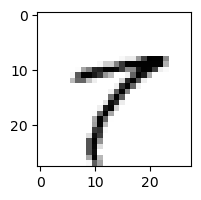

0.06973252541526348% - 0
3.40239914336624% - 1
4.398318120866258e-06% - 2
0.00023022860571379958% - 3
0.10097875139809581% - 4
0.9868999849784044% - 5
0.0004064393053856246% - 6
95.7520952213665% - 7
99.4255769826664% - 8 - ОШИБКА
2.204369029218335% - 9

 2


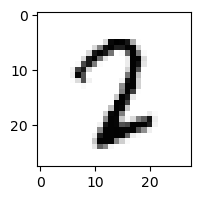

0.0012651750182480096% - 0
0.013437918734894196% - 1
0.6048283345012494% - 2
0.0019391447126377171% - 3
0.009408201338251512% - 4
1.2955528498895208% - 5 - ОШИБКА
0.0019053141726209746% - 6
0.3766981243761485% - 7
0.08222850790988864% - 8
1.9148414539717962e-08% - 9

 8


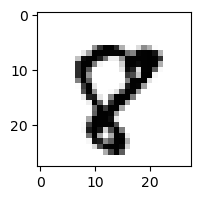

0.007634016377475653% - 0
4.868345432151847e-06% - 1
1.6985196304305318e-06% - 2
6.579635610653231e-10% - 3
4.450342175792653e-05% - 4
0.042494234782894255% - 5
1.796813255418752e-07% - 6
17.94304663387699% - 7 - ОШИБКА
0.01029306124772232% - 8
2.8699566541254933e-05% - 9

 4


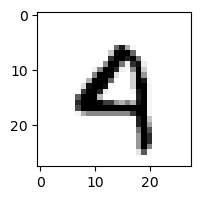

0.43073803613528727% - 0
1.5769047743921827e-05% - 1
0.0019252687261704193% - 2
4.0661448241367095e-07% - 3
44.44315037057798% - 4
0.005025191075234854% - 5
0.7521402932979581% - 6
0.004568439724256078% - 7
1.07248122029805e-07% - 8
99.46534563149147% - 9 - ОШИБКА

 8


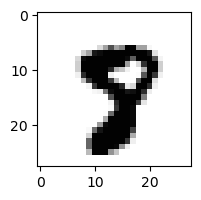

2.9322439997780086e-07% - 0
1.77755838560624e-08% - 1
3.3069670228322146e-13% - 2
1.1874365173581367e-10% - 3
1.7337478000514898e-06% - 4
3.0062856664835245% - 5 - ОШИБКА
1.3948045381395528e-08% - 6
0.7775906560160306% - 7
5.5526933783465234e-05% - 8
4.029792018096247e-06% - 9

 0


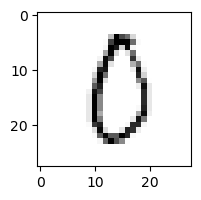

99.30922813083124% - 0
0.0086206831000537% - 1
15.542759740348227% - 2
0.1297998413127634% - 3
0.14844422910704907% - 4
35.9544918643922% - 5
25.300634005258853% - 6
0.02815871733289597% - 7
99.55033365052715% - 8 - ОШИБКА
0.011062154548305836% - 9

 7


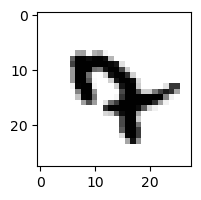

2.4066155995533297e-07% - 0
0.0065164892616282255% - 1
5.933224135613197e-09% - 2
3.325916202550692e-09% - 3
78.2544105293369% - 4 - ОШИБКА
0.1102095525013545% - 5
1.6025347782581807% - 6
27.197842409687397% - 7
7.84934917165897e-14% - 8
2.644486653941654e-07% - 9

 8


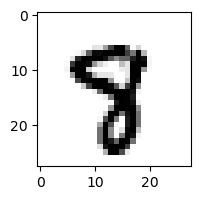

2.3868394170990733e-07% - 0
4.465620152517353e-06% - 1
7.049398957455594e-10% - 2
1.1375331199387804e-07% - 3
0.002218457185432764% - 4
3.233737364088138% - 5 - ОШИБКА
8.22688341781125e-07% - 6
0.148325854242605% - 7
0.000261948813861976% - 8
5.9165126327739726e-05% - 9

 8


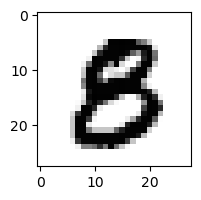

0.00830463901050365% - 0
3.672252658364701e-08% - 1
1.241855916047554e-08% - 2
0.0002235393833805965% - 3
4.20270320370052e-07% - 4
0.780667922458703% - 5 - ОШИБКА
4.4510796331774794e-08% - 6
5.828146745086984e-10% - 7
4.925172038832041e-05% - 8
1.8132503474980627e-11% - 9

 2


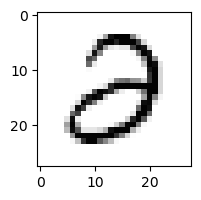

20.638116194112165% - 0
0.00011768694173942986% - 1
26.93395250422958% - 2
67.70291568709261% - 3 - ОШИБКА
0.012491304352614968% - 4
0.0950034983599826% - 5
0.019053101710492355% - 6
8.633459388460076e-06% - 7
0.0009106371581179721% - 8
1.1067967861076147e-09% - 9

 7


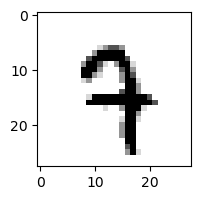

7.619068894314167e-06% - 0
0.00855307086145741% - 1
0.027924876279107825% - 2
0.0025395420501987515% - 3
0.7607946881070046% - 4
0.2766841140646882% - 5
0.05505863203987263% - 6
13.3534074050105% - 7
6.129110914468209e-06% - 8
19.69735960871373% - 9 - ОШИБКА

 8


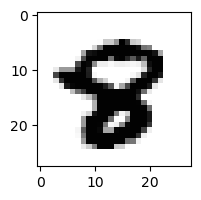

1.5974235562238268e-06% - 0
1.0604023318173446e-10% - 1
2.8048658794045968e-11% - 2
1.5925308537644477e-14% - 3
5.363207049895009e-07% - 4
0.013968447870958271% - 5 - ОШИБКА
6.019402448965214e-08% - 6
2.5820023831765915e-07% - 7
3.7807972427130924e-05% - 8
5.384086395163029e-12% - 9

 1


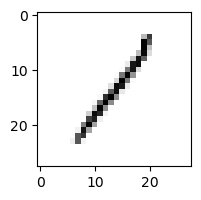

4.403736717622215% - 0
94.40461941887743% - 1
71.30370476614812% - 2
35.88284041831893% - 3
3.491884832368173% - 4
3.426220018418395% - 5
6.584543050227415% - 6
0.9671777778190572% - 7
98.52611346132221% - 8 - ОШИБКА
31.546753025783747% - 9

 9


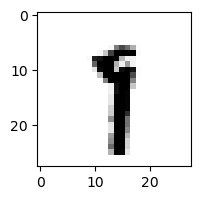

3.062744073545967e-07% - 0
26.59674946562388% - 1
1.4464693859108064e-05% - 2
0.001253359707265% - 3
0.0016117357817303894% - 4
0.7701188798418631% - 5
0.0024422234215087726% - 6
33.70421623038891% - 7 - ОШИБКА
0.0009175847934128141% - 8
0.10865771395753519% - 9

 3


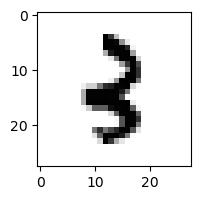

1.0283020281381029e-05% - 0
0.2742492836395424% - 1
0.9118501288540206% - 2 - ОШИБКА
0.014785570349308119% - 3
0.10456090177292686% - 4
0.002971130603111887% - 5
0.007544253622660922% - 6
3.139429352329916e-06% - 7
0.0005367447098196% - 8
0.03452354394153605% - 9

 9


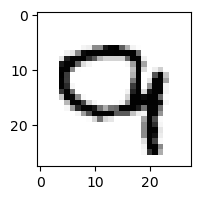

2.364273998518146% - 0
1.1441898822256978e-07% - 1
1.9759393634365234% - 2
6.961536728923484e-06% - 3
0.0904115390366333% - 4
4.629654156545751e-08% - 5
0.024938241818409167% - 6
6.520200382687373% - 7 - ОШИБКА
1.362003549669217e-09% - 8
0.0030742636058821% - 9

 9


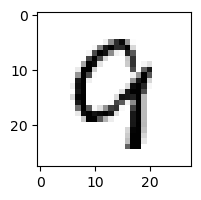

0.5140212999961565% - 0
0.00015139051773322353% - 1
2.7563917174077717% - 2
2.488889504833606e-08% - 3
3.6859698756350276% - 4 - ОШИБКА
0.00030470055999742314% - 5
1.1836352467530387% - 6
0.2525931029847732% - 7
0.10370204809676219% - 8
0.25386397642135455% - 9

 8


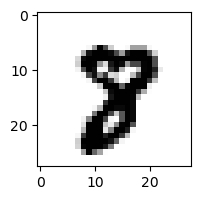

5.010569995418036e-07% - 0
1.4724210183917389e-06% - 1
1.0630336888808648e-09% - 2
4.312019685476868e-09% - 3
5.8008829686707876e-08% - 4
0.004672544538879602% - 5
4.007082375986957e-08% - 6
0.3319807374350407% - 7 - ОШИБКА
0.011373772761090464% - 8
8.907908642088563e-09% - 9

 9


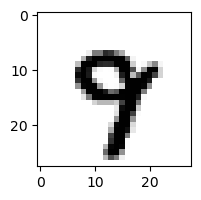

1.1721473074076407e-06% - 0
9.066152407189536e-06% - 1
1.6721275788547648e-08% - 2
7.51038219274702e-08% - 3
0.2611385383488812% - 4
0.004492721763629598% - 5
0.0010779829735407948% - 6
10.358429610542204% - 7 - ОШИБКА
3.560948362485167e-07% - 8
3.3203363421674856% - 9

 7


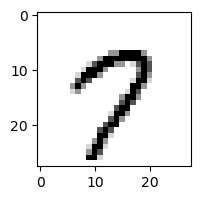

2.350875747011846% - 0
0.0007159705260066226% - 1
2.9496364605554844e-05% - 2
3.6241596860644554e-06% - 3
0.07113102840613926% - 4
1.5279563744835107% - 5
0.0012468231209293477% - 6
93.26197963071246% - 7
0.024155861427876592% - 8
99.68154269934652% - 9 - ОШИБКА

 2


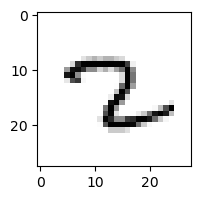

4.1490735980420865e-05% - 0
22.539959999399926% - 1
8.7778249644674% - 2
0.00011419366331356083% - 3
0.016104101700064336% - 4
1.9911909412191076% - 5
11.234169694657382% - 6
24.400399412185394% - 7 - ОШИБКА
0.0006510794465449713% - 8
0.002563716905814306% - 9

 3


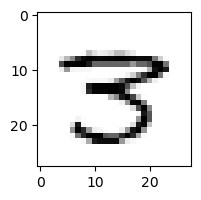

0.01858858970592848% - 0
0.00028022568224240585% - 1
0.0005546248896363921% - 2
13.09093800218036% - 3
0.00498374288648525% - 4
0.3625056716760699% - 5
2.0073031352622636e-07% - 6
0.2431600467260008% - 7
59.12760392414113% - 8 - ОШИБКА
7.910588882092315e-05% - 9

 5


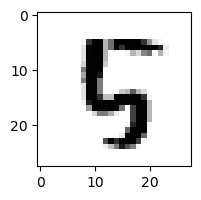

2.189422718488474e-05% - 0
2.58880831119889e-06% - 1
0.028268267017823406% - 2
1.030925707416435e-09% - 3
67.80826885068521% - 4 - ОШИБКА
10.847433670244424% - 5
0.012596325806792237% - 6
9.405723369584589e-05% - 7
0.0006537141915660402% - 8
2.5636185947495946e-10% - 9

 3


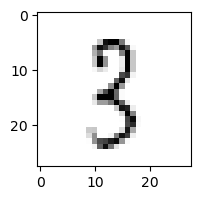

0.014539018932358292% - 0
8.447782656524188% - 1
11.476428316598989% - 2
46.99155597976636% - 3
0.15549948468822086% - 4
9.556510235520085% - 5
0.005402208190987354% - 6
0.023501653762810104% - 7
65.88912234860912% - 8 - ОШИБКА
0.03283740568880036% - 9

 9


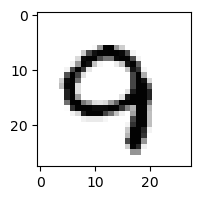

0.015687706156911417% - 0
6.326625414773083e-06% - 1
0.031826237062236196% - 2
9.961763797878205e-10% - 3
0.2969090892361373% - 4
1.0636739444887599e-05% - 5
0.004993413324144746% - 6
0.6837987710279242% - 7 - ОШИБКА
1.2069433308573204e-07% - 8
0.13506466688077795% - 9

 4


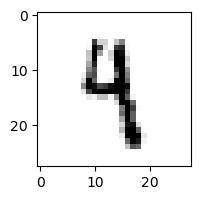

1.0000225521398847e-05% - 0
3.726856556870707% - 1
0.001869864414519535% - 2
1.831048201948329% - 3
2.7685540170662533% - 4
3.9988244612921857% - 5
0.10527054847536388% - 6
0.0028672375919831764% - 7
0.00011185968768283543% - 8
4.4830388752016015% - 9 - ОШИБКА

 7


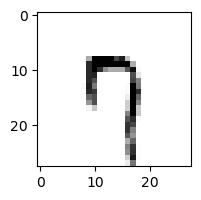

8.02668962872982% - 0
0.03874868726587836% - 1
0.16361937604116208% - 2
0.001724637069930862% - 3
2.8972266901878747% - 4
15.656553619951485% - 5
2.186975014030286% - 6
83.51445358045616% - 7
0.0012463498014811001% - 8
94.86501176249587% - 9 - ОШИБКА

 8


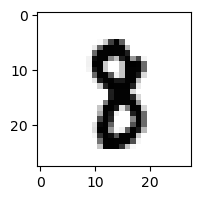

5.290353691526934e-08% - 0
0.021032837125898134% - 1
2.367995683092241e-07% - 2
4.45733936064578e-05% - 3
7.557534108281906e-05% - 4
0.056894492956429926% - 5 - ОШИБКА
2.047018364322261e-06% - 6
0.009367502656659915% - 7
0.02295512749860191% - 8
3.185301980942454e-08% - 9

 8


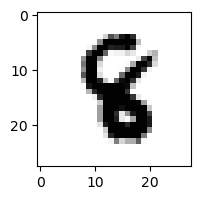

2.389050206777291e-11% - 0
9.46544989222435e-05% - 1
8.739902563176385e-05% - 2
2.446583925137846e-07% - 3
0.16088390611580347% - 4 - ОШИБКА
0.07365818103238962% - 5
6.769651879904265e-05% - 6
1.4287802125127433e-06% - 7
2.7055564454169406e-08% - 8
3.5738337548406945e-13% - 9

 9


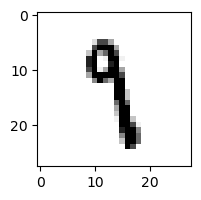

1.2745345946344145e-05% - 0
13.790260537674225% - 1
0.0003722661516317473% - 2
0.01799220093524627% - 3
0.04897612268477431% - 4
24.08017309724813% - 5 - ОШИБКА
0.08926062663670054% - 6
0.933852145102547% - 7
0.09257063221467637% - 8
0.005326024245664159% - 9

 6


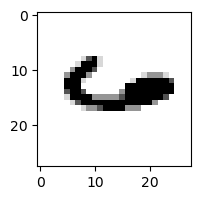

0.4493817097150555% - 0
0.0013405050822880658% - 1
4.232262214574745e-06% - 2
4.530240025851394e-10% - 3
99.99635794428086% - 4 - ОШИБКА
1.1719374583046173e-06% - 5
99.66712631432037% - 6
1.2397593962374382% - 7
4.506424520054151e-05% - 8
95.14488238584538% - 9

 8


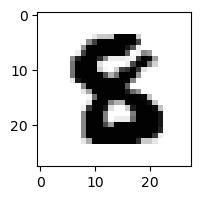

1.0112365785695886e-08% - 0
3.1374981929860694e-10% - 1
9.51741603018296e-09% - 2
1.0686947787507483e-08% - 3
6.829267549024672e-09% - 4
2.4492864320416765% - 5 - ОШИБКА
3.744562018931238e-08% - 6
3.6946261623213376e-11% - 7
9.892261895111722e-11% - 8
7.84064454810993e-21% - 9

 3


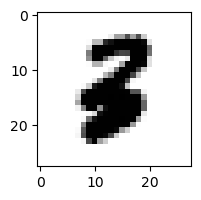

7.450954439390606e-07% - 0
3.24500232878815e-05% - 1
0.0040043758001515415% - 2 - ОШИБКА
1.119671053558799e-08% - 3
2.4913512232550067e-05% - 4
0.003193491566079271% - 5
3.45182886836113e-05% - 6
4.994690498019493e-08% - 7
4.807270105519578e-16% - 8
1.5014728735255892e-15% - 9

 5


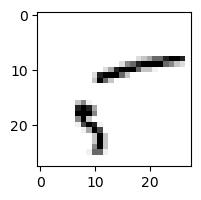

98.93487565288982% - 0
0.290008928943885% - 1
0.10219346479823875% - 2
24.90950247767906% - 3
0.6416617201312705% - 4
94.26453624156025% - 5
0.013303576595283088% - 6
44.72218090767174% - 7
99.94777290471636% - 8 - ОШИБКА
0.014427628733000328% - 9

 8


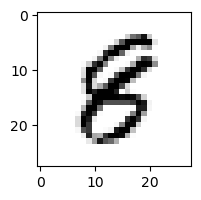

0.0020439837091118292% - 0
0.001628485714865865% - 1
0.00016461948491160627% - 2
5.659288184909553e-05% - 3
0.00575520466060612% - 4
1.0512183730397804% - 5 - ОШИБКА
0.0016211928927600695% - 6
8.445147916752674e-07% - 7
0.05121838644511404% - 8
6.259627796741601e-06% - 9

 5


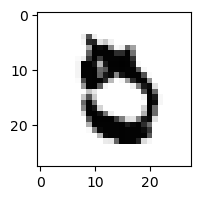

0.876797165909828% - 0 - ОШИБКА
1.2749811499104401e-06% - 1
8.007266028850787e-07% - 2
2.0709249983418014e-08% - 3
4.183268178240953e-07% - 4
0.46607555565538344% - 5
0.14178152427500462% - 6
0.02723988299116254% - 7
3.9082615984963246e-10% - 8
2.868183426770988e-09% - 9

 8


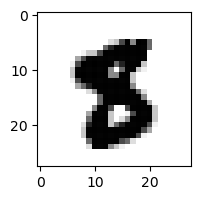

1.3088343400016083e-08% - 0
1.109457805519923e-07% - 1
9.82805412261226e-14% - 2
9.458106784563381e-12% - 3
1.424817321894348e-08% - 4
4.094233016465541% - 5 - ОШИБКА
4.2355638841017913e-07% - 6
2.0869868471850928e-07% - 7
5.513236288581609e-10% - 8
5.977534053776169e-15% - 9

 7


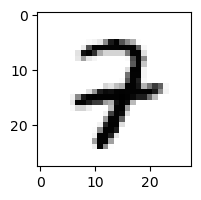

0.0008283019964935861% - 0
0.0011691096672654824% - 1
1.8780884861354854% - 2
0.0020376999386945223% - 3
35.06327387171274% - 4 - ОШИБКА
0.0016084744100858858% - 5
0.012662574771308189% - 6
0.015218200305242702% - 7
1.4894955584629286e-06% - 8
7.179800113557355e-06% - 9

 0


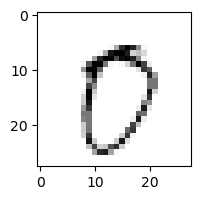

98.38647890746586% - 0
0.00021348126286146142% - 1
0.22264536637525306% - 2
0.050293501508966165% - 3
0.008099113149050693% - 4
11.452449413354875% - 5
0.15188403150385693% - 6
21.930457962831763% - 7
3.3556048646008563% - 8
99.75712731586283% - 9 - ОШИБКА

 2


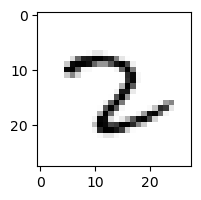

0.0004879959662233909% - 0
5.045044720083595% - 1
57.74824527375676% - 2
0.01892588968158679% - 3
0.012668569286842681% - 4
0.36859730996137585% - 5
58.33619997486817% - 6 - ОШИБКА
50.67086109613588% - 7
0.0046198542449161365% - 8
8.811326008413252e-06% - 9

 7


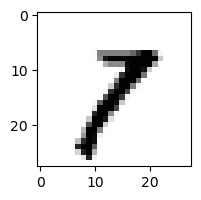

0.0017387148194820006% - 0
29.635897255984407% - 1 - ОШИБКА
0.014876764304268713% - 2
0.19720571046729726% - 3
0.00021258584401933885% - 4
0.003911512122270261% - 5
7.656508493431028e-06% - 6
23.916953845371577% - 7
0.25620987809633994% - 8
1.3371088455748965% - 9

 8


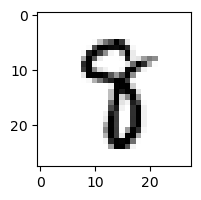

6.912576920842128e-07% - 0
0.0498681111393883% - 1
1.7834974086475519e-06% - 2
0.002208675099011474% - 3
0.0529691256387441% - 4
3.9957176397804615% - 5 - ОШИБКА
2.6257521287617645e-05% - 6
0.5817014498000972% - 7
0.002224793941478814% - 8
1.983573463621027e-08% - 9

 9


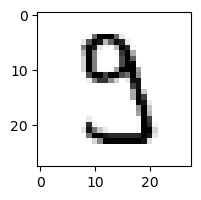

1.066075547781647% - 0
0.00043604532527529084% - 1
0.0017904157609515534% - 2
56.69666423795397% - 3 - ОШИБКА
0.0010752277760807591% - 4
8.516597909578817% - 5
4.334535858090944e-06% - 6
0.7142010545731953% - 7
0.0006890120635201698% - 8
5.729463402460703e-08% - 9

 1


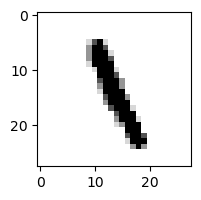

2.9777021720385143e-08% - 0
6.465754852604495% - 1
0.023335656610975284% - 2
0.002321163874046728% - 3
2.037277252071798% - 4
44.29826966332338% - 5 - ОШИБКА
0.24798986668112302% - 6
0.0037653659816378067% - 7
14.935218817233528% - 8
7.753606463685728e-05% - 9

 7


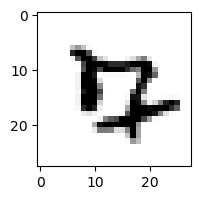

7.957878189283416% - 0 - ОШИБКА
1.4108477655025736e-07% - 1
0.0006456025136455659% - 2
5.039628951551155e-07% - 3
0.19267114365538077% - 4
0.059423244368563714% - 5
0.30888094323307086% - 6
3.49140835671118% - 7
8.575414517948414e-13% - 8
1.3438489541174166e-06% - 9

 9


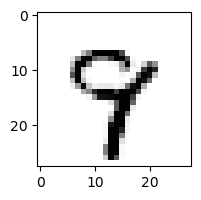

3.7757863725509685e-05% - 0
0.0003758517657122532% - 1
0.00031907084465361676% - 2
4.260819246552692e-05% - 3
0.4350075464419822% - 4
0.0247926548203442% - 5
0.033058234199566765% - 6
11.18321555125389% - 7 - ОШИБКА
0.01114059399199417% - 8
2.537336502146038% - 9

 8


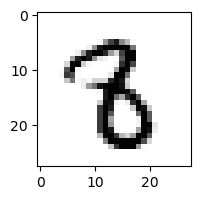

2.5945749923377104e-07% - 0
0.016954557813254716% - 1
8.292444949558136e-05% - 2
0.06676674135062247% - 3
0.00017579684177559734% - 4
0.41003255237351033% - 5 - ОШИБКА
2.8296221030008235e-05% - 6
0.0005701190646800958% - 7
0.000163146462556618% - 8
2.4626373383112342e-08% - 9

 8


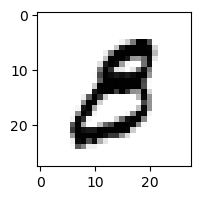

0.8630294094214228% - 0
0.000748835810806536% - 1
1.0869499944294175e-05% - 2
1.8662227598908825% - 3 - ОШИБКА
3.1057778227788894e-06% - 4
0.44732303538618917% - 5
0.0020554037591035117% - 6
7.32296464216345e-06% - 7
8.52783777730889e-06% - 8
2.99504776343648e-06% - 9

 8


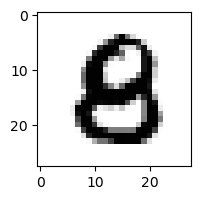

0.0026317058979031965% - 0
4.237958798799138e-09% - 1
0.0004756184937219103% - 2
4.164817124952954e-08% - 3
0.021313258227475134% - 4
0.35111799725522574% - 5 - ОШИБКА
6.565354892896312e-05% - 6
8.635112964973425e-10% - 7
0.0022670569648448077% - 8
8.099468795489635e-11% - 9

 5


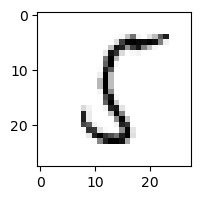

2.92002014886124% - 0
8.320822918496445% - 1
13.936551830358452% - 2
0.039863593907829016% - 3
1.5218558432172395% - 4
93.43979429513982% - 5
6.046347328558152% - 6
0.002043374881052865% - 7
99.99203118804097% - 8 - ОШИБКА
0.00020412518699307875% - 9

 8


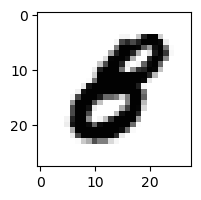

0.012746319971141949% - 0
8.264393412655181e-07% - 1
8.364971039823244e-08% - 2
3.827818744963243e-08% - 3
0.0001075297983571969% - 4
0.18903612432762149% - 5 - ОШИБКА
3.199967901071963e-05% - 6
7.713143792383756e-08% - 7
1.1790481687087095e-12% - 8
4.236598560339592e-13% - 9

 9


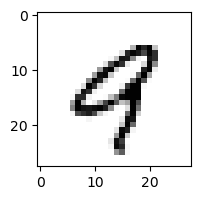

0.3783487202921601% - 0
0.0009061813428933428% - 1
0.00026033650026306004% - 2
7.840106348509791e-06% - 3
63.146542771807646% - 4 - ОШИБКА
0.0014666874017272003% - 5
0.20976684570103446% - 6
4.094686905479893% - 7
0.0306841388080089% - 8
21.223370600416725% - 9

 8


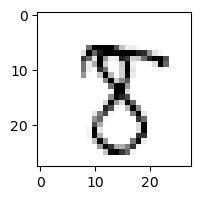

4.5813146991984316e-05% - 0
0.003543010192047757% - 1
0.004171477571130201% - 2
0.12986104864081274% - 3
0.0001028739706834802% - 4
42.38008109177018% - 5 - ОШИБКА
9.529007823988312e-06% - 6
8.537358597861692% - 7
17.744493326637354% - 8
0.05896538212825577% - 9

 9


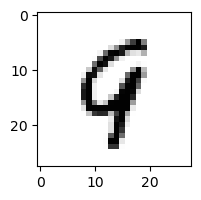

0.0002672545053128221% - 0
0.02180040628262157% - 1
0.0461136581012462% - 2
2.503524610212572e-10% - 3
38.43033118714493% - 4 - ОШИБКА
0.0014327788651069542% - 5
4.013453994456439% - 6
0.10066427866265322% - 7
3.338797842222357% - 8
30.36587202408686% - 9

 6


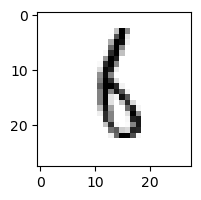

0.0012626457662062544% - 0
9.422286023385686% - 1
4.525354796773834% - 2
1.8126089118510584% - 3
0.2166288966211848% - 4
33.49787200550804% - 5
70.02131346902534% - 6
0.003977712012330432% - 7
78.07978217867489% - 8 - ОШИБКА
2.320762375338407% - 9

 5


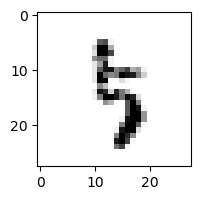

0.0006768055790478457% - 0
0.40825637820265953% - 1
0.017553847752127254% - 2
37.33445865685507% - 3 - ОШИБКА
5.1809579201476055% - 4
37.02391980881007% - 5
0.5299365516948562% - 6
2.15558275493002% - 7
0.41633191106620104% - 8
0.000655087396350156% - 9

 9


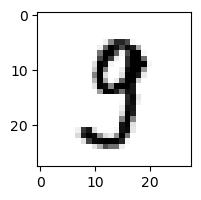

0.10243497135582855% - 0
0.005387438296229938% - 1
0.00019151846670030043% - 2
8.436970548791177% - 3 - ОШИБКА
0.01174014879304373% - 4
3.3247002330625572% - 5
5.22518400726789e-07% - 6
0.26331758267068633% - 7
1.0010731358237615% - 8
0.0060003172122589194% - 9

 4


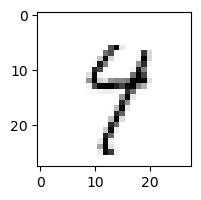

0.06596511822892347% - 0
0.8714977090380052% - 1
0.007119185465451246% - 2
0.47339267685404357% - 3
32.90850338279782% - 4
6.845176821475363% - 5
0.6064375541774895% - 6
4.157946686298969% - 7
98.4841744035914% - 8
99.76334774221426% - 9 - ОШИБКА

 4


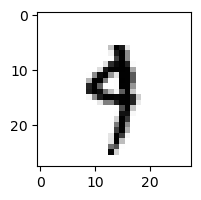

3.0406862163081504e-05% - 0
0.7541971013556337% - 1
1.1529428116603628e-05% - 2
0.5627355849205785% - 3
25.37359685353807% - 4
1.3097203444119108% - 5
0.29673880443275974% - 6
2.478981278643158% - 7
1.4222154572856253e-05% - 8
32.81839294463701% - 9 - ОШИБКА

 8


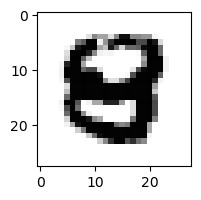

1.3165694654103586e-05% - 0
2.5201317204542564e-11% - 1
6.36598366698133e-11% - 2
9.123435202577454e-10% - 3
0.012782074408865834% - 4 - ОШИБКА
0.005675662848378177% - 5
1.9887919715965705e-06% - 6
1.0898125019231456e-10% - 7
4.4799332122554284e-14% - 8
1.7691912263716231e-22% - 9

 7


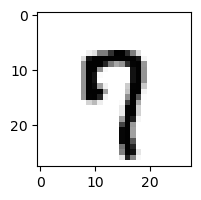

0.9497893036853309% - 0
2.3728282187215012e-05% - 1
0.00032770760073921987% - 2
5.670221573874558e-05% - 3
0.26521704606603375% - 4
4.529650052866167% - 5
0.004556820698331856% - 6
21.02301123245907% - 7
8.052905737010666e-06% - 8
99.20574277628671% - 9 - ОШИБКА

 8


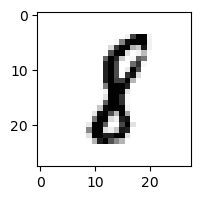

3.1650274339708614e-05% - 0
41.63380293142365% - 1 - ОШИБКА
0.0016299380363831426% - 2
7.33284647476975e-05% - 3
6.421277158266503e-05% - 4
0.4700403337906149% - 5
0.0313834965912596% - 6
0.0013020754518242477% - 7
8.896506158037983% - 8
7.49488104165508e-07% - 9

 8


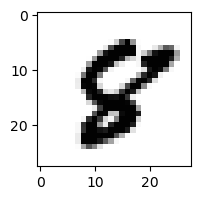

0.00014863618799297078% - 0
9.601386606921787e-08% - 1
2.476554656623768e-06% - 2
8.408728693258126e-14% - 3
2.7504206518570948e-05% - 4
17.2926129122242% - 5 - ОШИБКА
1.1621966747414224e-05% - 6
0.0001155454415865582% - 7
5.052973812833019% - 8
2.6770003882392814e-07% - 9

 6


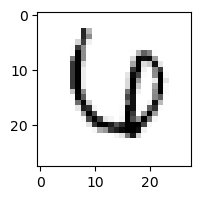

50.731898415475065% - 0 - ОШИБКА
0.0005627059677523569% - 1
0.06491545044468609% - 2
0.01459814873870425% - 3
0.6881268071610755% - 4
0.0004916493541100636% - 5
24.069306165636736% - 6
0.9272797208587715% - 7
7.355798718264631e-06% - 8
2.1393830957850797e-07% - 9

 7


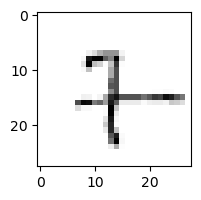

0.057829224599298734% - 0
19.8446382235987% - 1
5.661401958131849% - 2
0.33956110210996177% - 3
3.5484229488440406% - 4
3.4872631303187274% - 5
29.248029103592366% - 6 - ОШИБКА
7.5330112547897565% - 7
0.6791120197088808% - 8
1.5895920314749252% - 9

 5


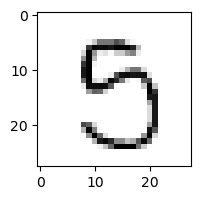

8.654690937702847% - 0
0.000252346248211136% - 1
0.004652000070081935% - 2
67.17041554420643% - 3 - ОШИБКА
0.12729177823169963% - 4
63.64756459755577% - 5
0.0017581152745639063% - 6
0.016817497902580886% - 7
38.15259396915577% - 8
0.04755371150256442% - 9

 8


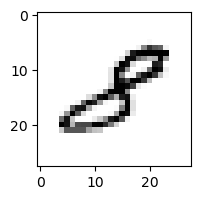

0.1503687070943858% - 0
5.953380439672131% - 1
7.723439084224984% - 2 - ОШИБКА
0.43502923844584596% - 3
0.0228097437802088% - 4
0.03260242103715847% - 5
0.00011563077145540431% - 6
0.044645500672541326% - 7
0.007078092486871477% - 8
0.0003194262767805302% - 9

 4


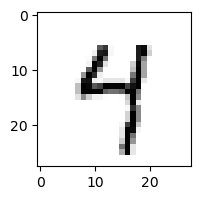

0.07632346714361331% - 0
0.02109821824072415% - 1
0.00015482060467412515% - 2
0.06146057036323784% - 3
69.06417358725349% - 4
33.6155003784871% - 5
0.29041848625546013% - 6
0.15420923284675025% - 7
0.06546157857766567% - 8
94.79059068447889% - 9 - ОШИБКА

 5


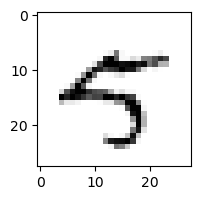

0.8802924485875246% - 0
0.041010905087206985% - 1
1.2299531302071347e-05% - 2
0.0008496246690045286% - 3
50.67328632265763% - 4 - ОШИБКА
22.805300544700845% - 5
4.4148303740904056e-05% - 6
5.3092204283905815% - 7
1.8485480580552607e-05% - 8
0.2857787641719985% - 9

 7


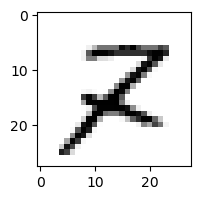

0.0009232147139860301% - 0
0.01538374268231948% - 1
89.13520990513642% - 2 - ОШИБКА
0.0019554153795631477% - 3
0.0031544252633921256% - 4
0.03621321036054633% - 5
0.0009054449006613667% - 6
0.002994478362812388% - 7
10.38805750126466% - 8
0.004125272374817161% - 9

 3


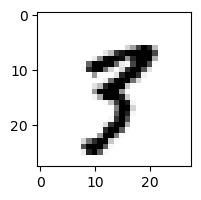

3.021959861218919e-05% - 0
0.09158892911069985% - 1
3.944270263716704e-06% - 2
0.017810931851640635% - 3
0.0026414861466194186% - 4
3.027646743328742% - 5 - ОШИБКА
3.273547095931331e-07% - 6
0.48493927731038433% - 7
0.00783173282565659% - 8
0.20623041983576568% - 9

 5


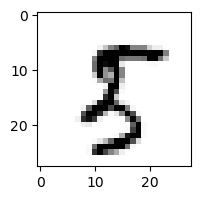

0.00015846097599801808% - 0
0.10913726591773575% - 1
0.000540442211589233% - 2
3.651574997516473e-07% - 3
9.549461878736148e-07% - 4
4.230253143923062% - 5
4.611125977699255e-06% - 6
0.012214306005835503% - 7
99.30052078951041% - 8 - ОШИБКА
0.028579657010129125% - 9

 4


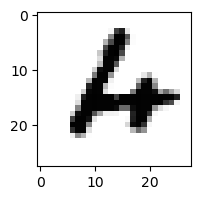

0.03559033804655778% - 0
2.74667538481134e-07% - 1
0.658280523134323% - 2
2.2371823000275665e-07% - 3
0.11286755243920066% - 4
0.0010958971451838092% - 5
52.82746449587851% - 6 - ОШИБКА
7.443777221102869e-06% - 7
1.2584830340854426e-09% - 8
7.063242724103812e-06% - 9

 8


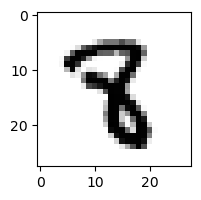

9.923316249805582e-11% - 0
0.0058820964610778485% - 1
1.1028834307757281e-06% - 2
0.00026240294047113783% - 3
0.06284837108843577% - 4 - ОШИБКА
0.052129185278072754% - 5
2.9685096849376005e-07% - 6
0.0004875873737937146% - 7
7.474200577187358e-10% - 8
1.3074834942438302e-11% - 9

 2


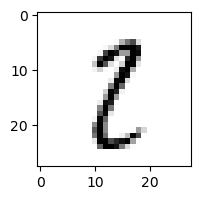

0.16790521138588357% - 0
28.895582042250368% - 1
0.307959225897158% - 2
0.44433915518932954% - 3
0.00043260890677797% - 4
5.4520777328134225% - 5
0.00033370299950283365% - 6
0.23640369010203446% - 7
94.86327874672594% - 8 - ОШИБКА
0.09100731365117058% - 9

 6


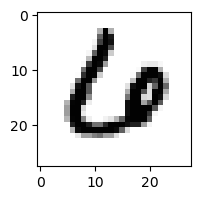

52.59111100852155% - 0 - ОШИБКА
2.1285673347459183e-09% - 1
0.00448835981198747% - 2
3.1390822411089954e-06% - 3
0.0014951989545369658% - 4
4.662785442819223e-05% - 5
51.289259523791365% - 6
0.003867329107357475% - 7
1.1161245702264947e-12% - 8
2.320083834087972e-09% - 9

 5


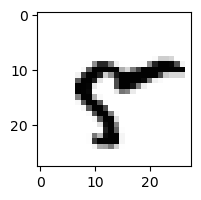

1.0367811790865784% - 0
0.014925051345374434% - 1
3.210405985022602e-10% - 2
2.641961880561242e-10% - 3
0.2737334731564082% - 4
0.10462363398622558% - 5
0.12562985481145078% - 6
1.292581555003862% - 7
99.15915186079506% - 8 - ОШИБКА
9.008708249347572% - 9

 7


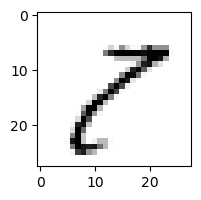

21.018780544108658% - 0
2.34139566010493% - 1
1.346832421050456% - 2
93.40546140733706% - 3
0.0422305409963136% - 4
5.291734027551764% - 5
8.583759873150364e-05% - 6
0.17442760984667224% - 7
99.85476444216029% - 8 - ОШИБКА
80.42902405732158% - 9

 2


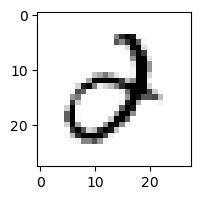

5.364537435141063% - 0
0.0006200478774484046% - 1
0.000544105233908353% - 2
2.166999869693988% - 3
8.224402562445603% - 4 - ОШИБКА
0.2605843368855221% - 5
0.005236282035463606% - 6
0.025055353014605843% - 7
2.566570261754669e-07% - 8
5.26531367164089e-06% - 9

 2


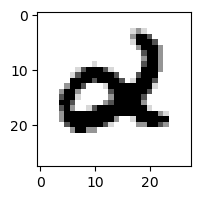

1.1744456766947487e-06% - 0
3.4789324082579115e-06% - 1
3.231985669144548e-09% - 2
1.1282930859585158e-15% - 3
0.0009390694587917395% - 4
0.0022576375939988963% - 5
0.003089308711369999% - 6 - ОШИБКА
1.1875660283043868e-07% - 7
1.5292600704989914e-07% - 8
1.5060190816597753e-10% - 9

 9


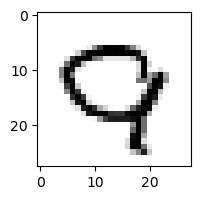

10.492821818787398% - 0 - ОШИБКА
6.438256924614048e-06% - 1
0.1403099978322809% - 2
4.9129746230568225e-06% - 3
0.005105167551573168% - 4
1.1796093359315331e-06% - 5
0.7284750126019942% - 6
4.1349305538704755% - 7
1.6456924868396857e-05% - 8
0.10191260078822979% - 9

 9


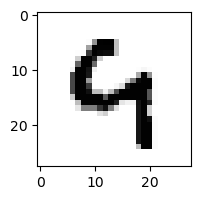

0.00017218583294344896% - 0
6.3711635483282714e-06% - 1
0.012807697637341435% - 2
1.4485479212090802e-06% - 3
96.10926678629609% - 4 - ОШИБКА
0.02109348311018235% - 5
12.231479318991733% - 6
0.0002584234846420155% - 7
9.16336085919523e-07% - 8
14.075409105405576% - 9

 9


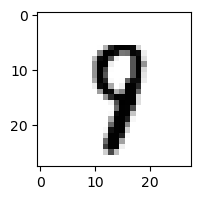

0.00013614009239893663% - 0
0.0009130328338056666% - 1
0.00026413966392386775% - 2
0.0015552271463551307% - 3
1.0188190764123894% - 4
2.3647494299093017% - 5 - ОШИБКА
0.0018667830131828007% - 6
1.739259033405283% - 7
2.114353723233891% - 8
1.0130510203479788% - 9

 8


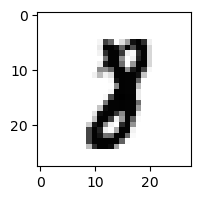

1.3545204437952789e-06% - 0
0.3598393111308675% - 1 - ОШИБКА
7.766938335940343e-05% - 2
5.813545653639381e-06% - 3
3.5012738435590675e-06% - 4
0.0019556791257164113% - 5
1.889630785393401e-07% - 6
0.23722542437001268% - 7
1.5271025298549797e-06% - 8
8.656495713260764e-10% - 9

 3


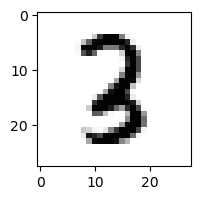

2.619673979598364e-07% - 0
0.10889037814317849% - 1
2.7363709847086315% - 2 - ОШИБКА
0.3016982272566089% - 3
0.0012988137537581059% - 4
0.00026922324153886196% - 5
1.238751245288443e-05% - 6
0.00010506596314010497% - 7
0.013101439009799673% - 8
9.950529264646719e-10% - 9

 7


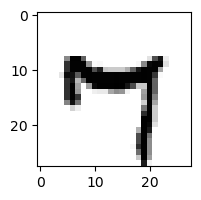

0.0035624109345435495% - 0
0.0010955189114376046% - 1
1.7094844166467707e-13% - 2
0.0004892335668758424% - 3
16.65448559178969% - 4
0.11718845632886282% - 5
0.001916586342994662% - 6
0.11656979427831923% - 7
0.5706193223778722% - 8
38.42208546791003% - 9 - ОШИБКА

 7


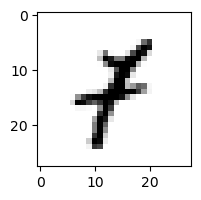

0.007437296254450946% - 0
71.71630832577924% - 1 - ОШИБКА
0.05720961694264191% - 2
0.0067820867336327055% - 3
0.04298239013007089% - 4
0.054228381849540756% - 5
0.021536004748706365% - 6
0.013311850385290671% - 7
1.6995901580842287e-05% - 8
0.19460498647942578% - 9

 6


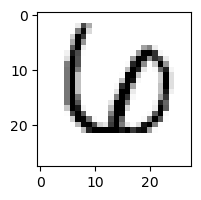

0.0282075451615027% - 0
0.00836322220886373% - 1
0.17303798636742337% - 2 - ОШИБКА
0.0004857743972126827% - 3
0.11913976042782312% - 4
0.00012623812994556685% - 5
0.002433452924528253% - 6
0.04591831163380666% - 7
8.887051225415829e-08% - 8
9.056925556358403e-12% - 9

 9


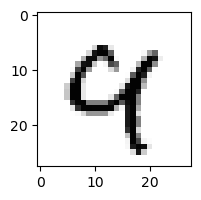

0.002045245870169281% - 0
0.001078271557528887% - 1
0.007095137876696584% - 2
2.0465865537427585e-08% - 3
64.79456826651015% - 4 - ОШИБКА
0.00010686326320429397% - 5
0.024006756137459277% - 6
2.395989817021045% - 7
0.18000818669469285% - 8
14.814561098182516% - 9

 6


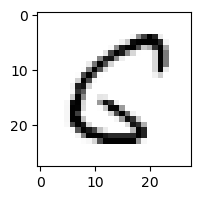

15.375225846917424% - 0
0.0027993016357033156% - 1
0.720019454288764% - 2
8.96153990942413e-09% - 3
0.42346349329221833% - 4
96.58221353200688% - 5 - ОШИБКА
0.0011686832720371732% - 6
0.00012913119446567907% - 7
25.48811213722596% - 8
1.9072091250333112e-07% - 9

 5


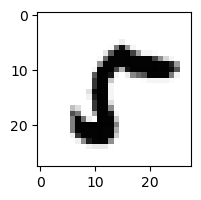

98.183930235144% - 0 - ОШИБКА
1.6154169680843644e-05% - 1
0.000216290301070126% - 2
8.499195902839062e-06% - 3
9.013791751522084e-08% - 4
5.262948946088908% - 5
6.075934222262084e-07% - 6
0.03035348133600921% - 7
88.39610262830844% - 8
9.449372613613244e-05% - 9

 9


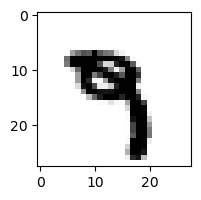

1.6791904036747246e-08% - 0
0.0006227513335712572% - 1
6.288678306692293e-09% - 2
0.000171838694965366% - 3
0.0195082924102124% - 4
1.1778643064401524% - 5 - ОШИБКА
0.000260394300382064% - 6
0.3064054337041681% - 7
1.041193444004285e-07% - 8
0.01771536643079718% - 9

 2


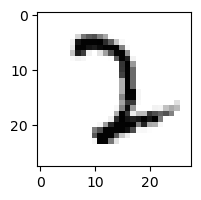

0.0005110995400802976% - 0
0.0015262229639106237% - 1
97.29656710715928% - 2
99.15854053344707% - 3 - ОШИБКА
9.963078524073659e-05% - 4
0.023356377711418613% - 5
0.009604911382207006% - 6
0.0862371361576364% - 7
2.1376126367683562e-08% - 8
2.2518778281151722e-07% - 9

 9


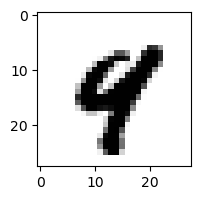

1.9463738392039191e-07% - 0
1.0899399857204083e-05% - 1
4.9148524074972304e-11% - 2
3.303455056165081e-14% - 3
49.93632465949251% - 4 - ОШИБКА
0.0006779527343344449% - 5
3.5749452699246958e-06% - 6
0.007116265706467393% - 7
3.359916873460286e-05% - 8
0.12198258706482903% - 9

 2


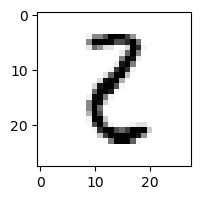

7.236281512915105% - 0 - ОШИБКА
3.7384801619249473% - 1
6.31529338524093% - 2
5.51166247499008% - 3
0.0010101816321824136% - 4
2.8594453408786036% - 5
0.7946943379881657% - 6
3.8101380644500487e-06% - 7
0.44816636849117564% - 8
4.5093364360896727e-08% - 9

 8


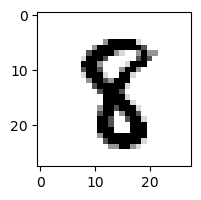

1.2980222030166517e-08% - 0
0.0015577652454649728% - 1
5.319737426421481e-06% - 2
1.8394342857097992e-07% - 3
0.009214206675280365% - 4
9.551533400292932% - 5 - ОШИБКА
1.693465439711318e-07% - 6
1.8949462469876208e-05% - 7
1.750102905839793% - 8
1.4825307711880137e-11% - 9

 9


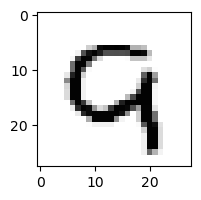

0.6848827738585239% - 0
3.0435112714905594e-07% - 1
7.155355130270942% - 2 - ОШИБКА
4.6170462757687175e-09% - 3
0.5114373923413843% - 4
0.0005758128764999895% - 5
0.6362745265076992% - 6
0.2648777765388118% - 7
6.577784757723713e-08% - 8
1.2007033739740802% - 9

 5


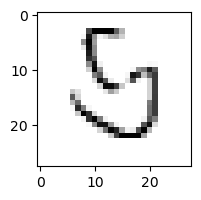

14.582941414964978% - 0
0.002749716937418505% - 1
12.072831250784768% - 2
6.739402763791154% - 3
0.6702792651492534% - 4
0.12124876244664667% - 5
95.88001702777991% - 6 - ОШИБКА
0.07221454112818705% - 7
52.65445782045132% - 8
0.001863843533244337% - 9

 5


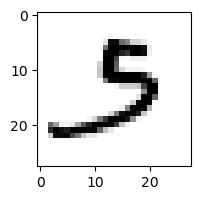

5.74364486073701% - 0
0.041541809765004635% - 1
0.5968395632784619% - 2
66.85956978298661% - 3 - ОШИБКА
6.702755644669184e-07% - 4
0.9159434714546303% - 5
0.33719383119189306% - 6
2.6204567705246937% - 7
7.073066738981701e-08% - 8
0.0003003534644270579% - 9

 1


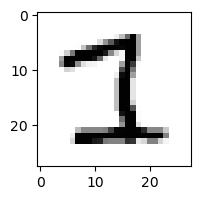

9.969582054951232e-05% - 0
0.005168992285034983% - 1
26.09483034948879% - 2
46.1575361895065% - 3 - ОШИБКА
0.0005897891880040076% - 4
0.40795064186286145% - 5
3.0797255119792763e-07% - 6
0.0870740695036324% - 7
1.7535859642945455e-05% - 8
1.1137528506854585e-13% - 9

 9


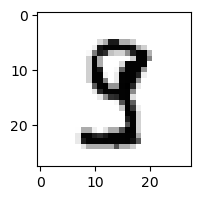

0.0002931831179212665% - 0
0.0068109807981210305% - 1
2.659851143729302e-07% - 2
3.5645454485994184% - 3 - ОШИБКА
0.060881958240468145% - 4
3.0043752450893595% - 5
7.046721276028504e-09% - 6
0.010354000131133996% - 7
0.823442424059586% - 8
8.092732843579017e-07% - 9

 4


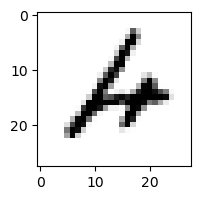

0.346169246805673% - 0
0.0008150803201551134% - 1
1.4359414730356255% - 2
0.020945661648341007% - 3
0.5416858293276882% - 4
0.0036028135171814104% - 5
95.14991094097809% - 6 - ОШИБКА
0.0005827285893745601% - 7
0.00014436901272369676% - 8
0.009203213599119919% - 9

 3


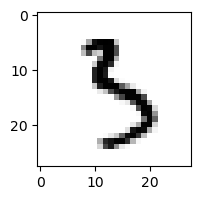

0.0003462174919196444% - 0
0.0012196776575652173% - 1
0.0018451165002560598% - 2
33.677311536905904% - 3
0.9615917738331092% - 4
78.22568650891743% - 5 - ОШИБКА
0.04236355250946018% - 6
0.007898118680033778% - 7
0.6077013792639289% - 8
0.00033650805772561564% - 9

 2


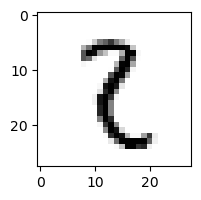

0.0008756022715746492% - 0
19.450682886435285% - 1 - ОШИБКА
0.6196147108628577% - 2
3.1097779873302906% - 3
0.0007390184659334099% - 4
1.7078952179906903% - 5
0.009847211412214472% - 6
0.006063914097790273% - 7
0.9161863926066472% - 8
0.0014449495169889903% - 9

 9


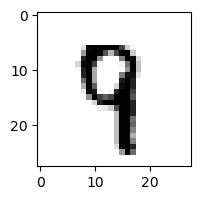

1.036187510992628e-07% - 0
0.0017473722272468967% - 1
0.0002508091260795799% - 2
6.0005282067078217e-05% - 3
2.082869720613419% - 4 - ОШИБКА
0.39883917377752764% - 5
0.0019304978866517622% - 6
1.060970143701869% - 7
4.206078755999587e-05% - 8
0.17823088548538554% - 9

 8


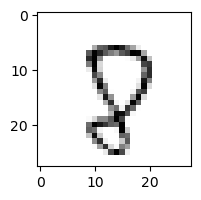

0.8196248244788545% - 0
7.818385173645045e-05% - 1
1.4383227128751022% - 2
0.012923258796623559% - 3
0.14717977445810684% - 4
58.53188138412453% - 5 - ОШИБКА
0.09016291273255211% - 6
14.377511034203119% - 7
2.238166528848392% - 8
4.117018402821062% - 9

 8


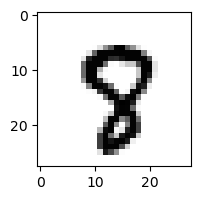

8.16565125777074e-05% - 0
3.574254589371781e-07% - 1
3.8765285229400347e-07% - 2
1.5574462292712047e-07% - 3
0.0019806490423172024% - 4
2.4873558736512664% - 5 - ОШИБКА
1.3317247636302885e-06% - 6
0.15407960694038317% - 7
0.040716022181433525% - 8
0.028703981678170547% - 9

 3


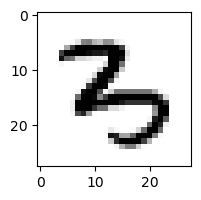

0.000820847873334261% - 0
1.3407699797981098e-06% - 1
0.09113003303290686% - 2
0.011355007644059301% - 3
11.652043625366954% - 4 - ОШИБКА
0.031681195793343796% - 5
0.00784701395152669% - 6
0.00013472291417127247% - 7
5.567576544229435e-11% - 8
3.765202796288074e-06% - 9

 8


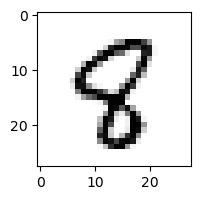

0.0006183407530593531% - 0
0.006388794366731202% - 1
0.0052373642516264285% - 2
1.329783788967227e-06% - 3
0.760052681099646% - 4
14.783484771193937% - 5 - ОШИБКА
0.0019086944801552036% - 6
0.00070919382172824% - 7
0.87472221032529% - 8
1.663269140145846e-05% - 9

 9


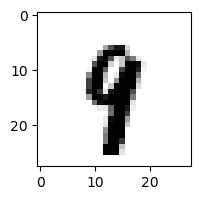

1.6724958932509658e-08% - 0
0.014277671926402983% - 1
5.072396971419631e-08% - 2
9.959455131532376e-08% - 3
0.7078752383924353% - 4 - ОШИБКА
0.26151979487185123% - 5
0.00047703087092429197% - 6
0.05584362157525142% - 7
1.2273787778795038e-06% - 8
0.09450492985825937% - 9

 7


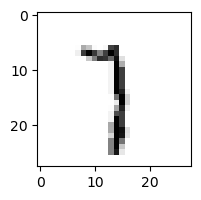

0.0025956142170955264% - 0
52.687753435318996% - 1 - ОШИБКА
0.8864641145598842% - 2
6.5938926427828966% - 3
0.03417504152715472% - 4
8.187625704586258% - 5
1.044766753931406% - 6
43.93376799093595% - 7
0.18579813233898942% - 8
0.5314437919805007% - 9

 9


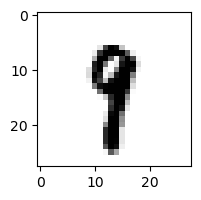

2.919030455662814e-07% - 0
6.298420154376634% - 1 - ОШИБКА
7.332934297637085e-07% - 2
0.00017988603939239346% - 3
0.015616919226883779% - 4
2.0310892959251183% - 5
0.0006904665685448062% - 6
0.14613132317692978% - 7
0.0019265694587631615% - 8
0.07942648321420454% - 9

 9


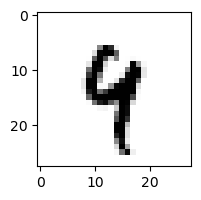

4.83548088556853e-07% - 0
0.09329458129249389% - 1
0.00012414951126115136% - 2
6.831919905221305e-05% - 3
51.60767743181876% - 4 - ОШИБКА
0.5990202407823042% - 5
0.13560442503373285% - 6
0.0551250342206294% - 7
0.02980525444916316% - 8
42.19439785238486% - 9

 2


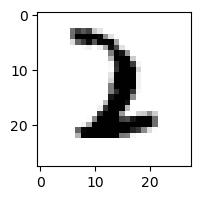

3.693498743167294e-09% - 0
10.050986487358466% - 1 - ОШИБКА
5.053836024104281% - 2
0.001191152448502684% - 3
2.0554065401042387e-08% - 4
0.00014804381981001227% - 5
0.01158068486831804% - 6
8.795346011464455e-05% - 7
5.790268028116031e-13% - 8
1.4550624332395827e-11% - 9

 8


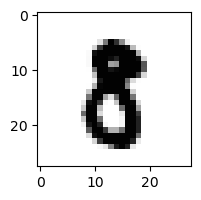

0.0008854523663025691% - 0
0.0002367501934283129% - 1
2.936280187522775e-07% - 2
3.162033615551007e-05% - 3
1.5751090761893856e-07% - 4
0.13295336776205458% - 5 - ОШИБКА
3.235003853676493e-07% - 6
3.071813188725215e-05% - 7
0.0007054537187251589% - 8
4.101032199153831e-09% - 9

 5


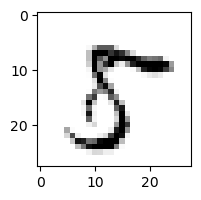

8.044471303759812% - 0
5.008546011543854e-05% - 1
0.0001442501854283466% - 2
0.007007588252443986% - 3
0.005789989141880581% - 4
71.68259573788615% - 5
1.7152220831210392e-06% - 6
3.5750534309980075% - 7
99.01247331380493% - 8 - ОШИБКА
0.023154512177069642% - 9

 3


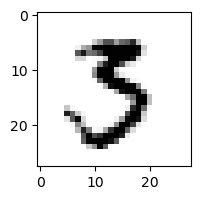

0.013138684332713159% - 0
3.5957549417230584e-05% - 1
0.00012050802177736308% - 2
22.390381274134864% - 3
3.3198881562115206e-07% - 4
41.64110090701105% - 5 - ОШИБКА
9.692877441712808e-05% - 6
0.011857478998999721% - 7
2.101935182110006e-05% - 8
9.742239874513643e-08% - 9

 9


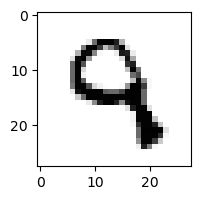

0.0001431344157368807% - 0
4.907811217502178e-06% - 1
3.374979118117591% - 2
0.3563951561604395% - 3
29.989605033974453% - 4 - ОШИБКА
0.862819475140016% - 5
0.011430425645405655% - 6
0.00014731510563358735% - 7
4.5651348479275323e-10% - 8
0.014850923584760032% - 9

 3


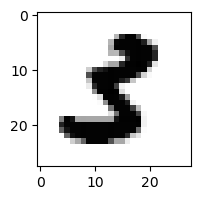

0.00011449795366167007% - 0
0.006559666016958303% - 1
1.0851607467058372e-07% - 2
0.0014409900706291218% - 3
1.1076625260203133e-08% - 4
33.86578377136688% - 5 - ОШИБКА
7.875245422141016e-10% - 6
1.1240159487729111e-07% - 7
4.623919280267936e-10% - 8
3.75451468794834e-19% - 9

 8


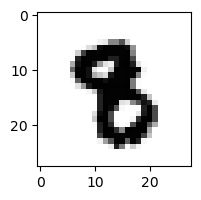

3.8045278102321455e-10% - 0
6.468713924657048e-05% - 1
5.3113786750868535e-11% - 2
2.8719049858522637e-07% - 3
3.930800008715314e-06% - 4
0.10353885420943748% - 5 - ОШИБКА
9.410462311273532e-06% - 6
1.889165193021971e-05% - 7
1.1884453542705339e-09% - 8
5.152263916184152e-11% - 9

 9


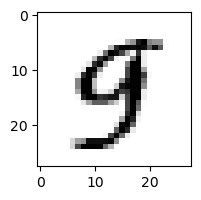

0.011111698043138177% - 0
0.00013619251662750663% - 1
1.3368376710375674e-07% - 2
0.0003769940532731642% - 3
2.826725270773651% - 4 - ОШИБКА
0.8131414446078986% - 5
0.0009028345357705255% - 6
0.02965036214303403% - 7
3.152351235094084e-06% - 8
0.5490632231565551% - 9

 4


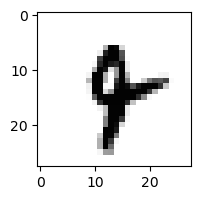

9.828621835289488e-08% - 0
0.1564527626906839% - 1
5.607639186690392e-07% - 2
1.2126201658275776e-08% - 3
2.7118748621185986% - 4
0.010648533125660003% - 5
1.293756767312636% - 6
0.06881086873633355% - 7
2.430031964352945e-06% - 8
3.325239511361281% - 9 - ОШИБКА

 7


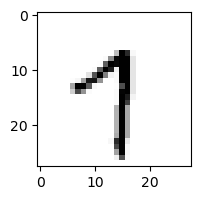

0.006426109656946367% - 0
14.403677953238795% - 1
6.852673650278171e-06% - 2
0.03672564431555673% - 3
14.380359579830904% - 4
2.6892640366255174% - 5
0.39744383371853936% - 6
88.04684179015096% - 7
0.0007615367775686498% - 8
98.30914127175946% - 9 - ОШИБКА

 4


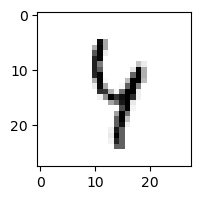

0.0018217412298960729% - 0
0.21348644496871652% - 1
0.7567565326502175% - 2
0.1304919211499436% - 3
97.39297540019433% - 4
4.085092492920707% - 5
7.190074659428282% - 6
6.246551472059942% - 7
97.66487816908551% - 8 - ОШИБКА
1.4410968621042757% - 9

 5


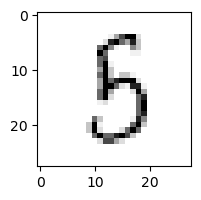

0.7109970179785434% - 0
0.44005406902872696% - 1
0.23171112915249806% - 2
87.24446706811398% - 3
1.1811502452320948% - 4
94.7379135679575% - 5
10.250522535178117% - 6
0.0033980520235655206% - 7
98.55619750069964% - 8 - ОШИБКА
0.00025425902035234005% - 9

 3


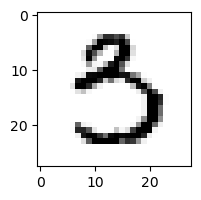

1.8560016147645686% - 0
0.00033341601258571194% - 1
2.901841117856171e-07% - 2
6.957328153177862% - 3
1.8624829030703675e-05% - 4
67.60655749327114% - 5 - ОШИБКА
9.050192793717153e-05% - 6
0.00860372442996954% - 7
6.071075906819361e-07% - 8
8.505425995201306e-09% - 9

 5


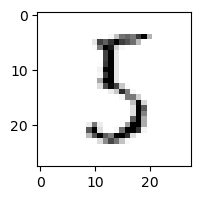

1.4370924311980167% - 0
0.9110892845901873% - 1
1.7655133499022857% - 2
96.33378282035913% - 3 - ОШИБКА
0.023096053857441446% - 4
85.169122697313% - 5
10.862113445101249% - 6
0.018281077216293212% - 7
30.169327648171095% - 8
1.810170735890942e-05% - 9

 5


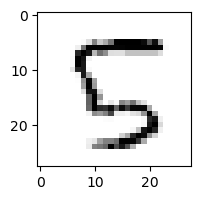

0.2057003409050644% - 0
4.522887709237886e-05% - 1
24.79604683537542% - 2 - ОШИБКА
3.46128040824287e-05% - 3
9.07327381627839% - 4
23.709315396147318% - 5
0.007267457745969872% - 6
0.000516011585712865% - 7
0.170429766826794% - 8
5.599751986822122e-08% - 9

 6


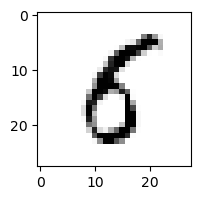

14.653970073745203% - 0
0.05893163184391883% - 1
0.000529216725447246% - 2
0.03004095265864637% - 3
0.03198232468659784% - 4
61.38208838172756% - 5 - ОШИБКА
18.33548717371495% - 6
6.599510647244395e-05% - 7
0.9628013914059576% - 8
0.020214059542982714% - 9

 0


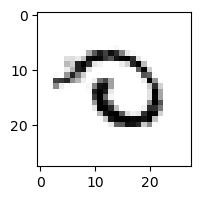

0.056973140635768596% - 0
0.0009717057024946147% - 1
2.7066916874661615% - 2
0.00043293913941814817% - 3
0.0710165798694197% - 4
0.38834940557818853% - 5
37.22490410121568% - 6 - ОШИБКА
0.0895247473043863% - 7
0.05135013838471452% - 8
2.408633973870816% - 9

 8


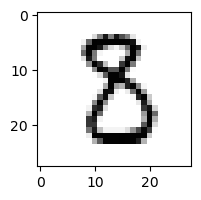

0.013146147686457402% - 0
0.012869929770671147% - 1
0.24419886649556985% - 2
1.6115428503388252% - 3
1.302145675297256e-05% - 4
2.4848848391911145% - 5 - ОШИБКА
5.074934489637116e-05% - 6
5.174141341156326e-05% - 7
0.19941890946110719% - 8
7.912369185862088e-12% - 9

 5


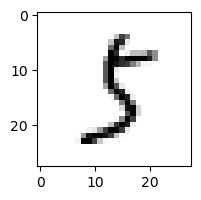

1.1878133278239067% - 0
1.9793844379692334% - 1
0.1298961852822801% - 2
90.59014012461665% - 3 - ОШИБКА
0.0005516236040387491% - 4
26.84521855126401% - 5
0.00458109257876199% - 6
0.9173146043188349% - 7
0.07785495170579315% - 8
0.01546581285103919% - 9

 8


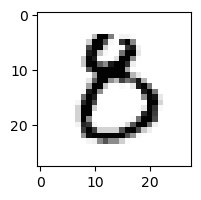

14.437067048654683% - 0
8.94380447185647e-06% - 1
0.0005689271016375599% - 2
0.014311366120682149% - 3
0.000333813057986914% - 4
39.98925163009709% - 5 - ОШИБКА
0.021936583086417983% - 6
0.0013969291991133023% - 7
4.3569074092630645e-08% - 8
4.3742553617380023e-10% - 9

 5


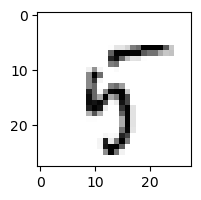

0.041855205454024595% - 0
0.07720237423291024% - 1
0.04307580022672716% - 2
9.614304665788858e-05% - 3
3.6552203152691245% - 4
14.199616257405879% - 5
0.883592686739839% - 6
0.005398197873375692% - 7
64.90341585096296% - 8
95.7862867129324% - 9 - ОШИБКА

 9


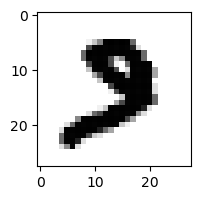

2.7871020390000562e-05% - 0
4.852302330700492e-06% - 1
0.0002823206109258514% - 2
1.375191419167714e-05% - 3
1.1385986291001163e-09% - 4
0.0009938890703588973% - 5
1.444375475422387e-07% - 6
0.8110757224378502% - 7 - ОШИБКА
9.952820691351751e-13% - 8
3.8000563782335307e-13% - 9

 8


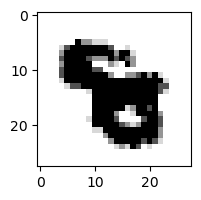

6.097118875163611e-13% - 0
7.165251299178062e-10% - 1
6.276743448947952e-14% - 2
6.285928724522124e-15% - 3
0.0004641189847435744% - 4
2.0960945838658795e-06% - 5
0.015257086416773952% - 6 - ОШИБКА
1.6336213856324184e-07% - 7
7.623963031914859e-14% - 8
9.343112532691634e-13% - 9

 9


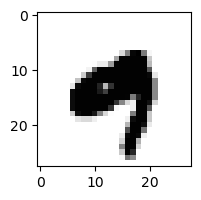

4.873808762321812e-06% - 0
0.00024763390540977236% - 1
7.957519890850144e-14% - 2
7.412489440235572e-10% - 3
11.070750136839514% - 4 - ОШИБКА
2.163766315761994e-07% - 5
0.0003692591504117022% - 6
5.092212892937979e-05% - 7
4.2745199178598274e-14% - 8
0.08418204326819292% - 9

 9


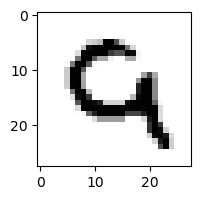

0.14552555255871494% - 0
3.699903852391531e-08% - 1
39.03458916090198% - 2 - ОШИБКА
9.702604539969014e-10% - 3
0.6713414875332924% - 4
0.001114378152001116% - 5
2.5373314784429777% - 6
0.01290228606630072% - 7
6.934958504685457e-10% - 8
0.11597404777420914% - 9

 8


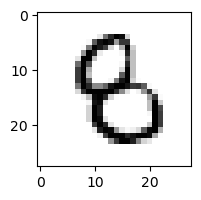

0.04584158921292127% - 0
0.00089240442211588% - 1
0.03538281450860216% - 2
0.005277834649786915% - 3
0.04976688677244873% - 4
16.535241197669144% - 5 - ОШИБКА
0.4572683537540278% - 6
1.624289364062793e-06% - 7
0.0002107954740950639% - 8
8.970409749912333e-07% - 9

 8


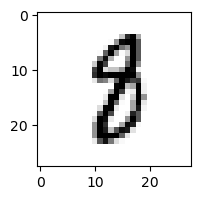

0.0004069121335326687% - 0
0.8377882492181828% - 1
7.370725695971604e-05% - 2
0.000500999700031812% - 3
0.00023990512569456346% - 4
1.3616728183316473% - 5 - ОШИБКА
0.014588712804803295% - 6
0.15215153518692143% - 7
0.0047160493905460425% - 8
2.1221366278578512e-07% - 9

 5


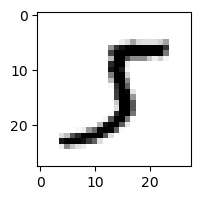

0.007010412075484943% - 0
43.1791931937386% - 1 - ОШИБКА
0.01207660711091676% - 2
12.420721704187805% - 3
0.0003128932398602881% - 4
8.5545562962545% - 5
0.0002094255158345646% - 6
1.459723519429185% - 7
8.301754157971881e-09% - 8
3.9740594707807796e-05% - 9

 8


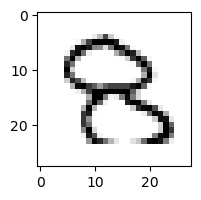

0.42698453456227575% - 0
2.138228802600583e-05% - 1
46.18116911376787% - 2 - ОШИБКА
5.624346108068665% - 3
0.10333270520567556% - 4
0.06991016661215989% - 5
0.0004090763819898488% - 6
2.704448022979812e-05% - 7
0.0008030861402884836% - 8
0.3257237194517229% - 9

 8


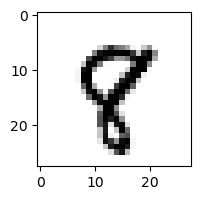

7.730000974324835e-06% - 0
0.012301834113490319% - 1
7.314726784510181e-06% - 2
7.807717517847935e-08% - 3
0.004732022387027266% - 4
0.8652783752113681% - 5
2.8064118958411983e-05% - 6
0.31420433782195667% - 7
0.06544227731430237% - 8
2.1398570968322153% - 9 - ОШИБКА

 8


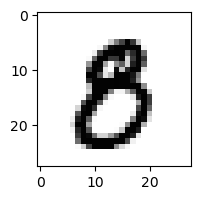

0.5445576041950602% - 0
4.4217144038468544e-06% - 1
2.5040039015511814e-08% - 2
0.0033338210688730534% - 3
5.6638831507098485e-06% - 4
2.335538431201761% - 5 - ОШИБКА
2.2874432310716455e-07% - 6
2.4927735968756635e-06% - 7
3.407397527301876e-05% - 8
3.899128306648584e-07% - 9

 5


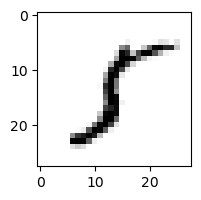

0.07886175649329641% - 0
97.50176289683436% - 1 - ОШИБКА
0.11509038663941801% - 2
0.3209522147090104% - 3
0.0024195100554551922% - 4
54.7026085787545% - 5
0.02077136122551413% - 6
0.23770516014255594% - 7
0.0005571799092690859% - 8
0.000417726313375697% - 9

 9


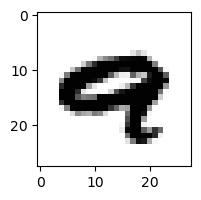

0.0005748910471853113% - 0
4.1566763581073474e-07% - 1
9.693255369463014e-14% - 2
4.153483212642202e-16% - 3
7.19726211680146% - 4 - ОШИБКА
2.8566456595736332e-09% - 5
5.504203659883599e-05% - 6
0.010137656865596568% - 7
6.726571515457123e-14% - 8
0.0012278458127404376% - 9

 8


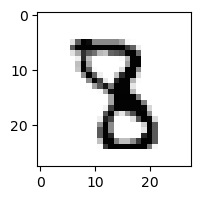

5.569543229925187e-09% - 0
2.1505691016547658e-05% - 1
3.717085299760471e-05% - 2
0.012102248723352398% - 3
0.013766237246429879% - 4
0.07852159336060367% - 5 - ОШИБКА
1.7735964272569428e-07% - 6
0.005331051226092251% - 7
1.635431064634049e-07% - 8
8.258689977858653e-08% - 9

 9


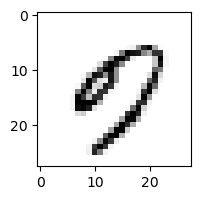

75.25105771853414% - 0 - ОШИБКА
9.163750944337615e-05% - 1
3.175921802769899e-06% - 2
0.00106540864096543% - 3
4.705311513853795% - 4
4.215812716767974% - 5
4.11802266841478% - 6
0.09690822845597866% - 7
0.001708019155623651% - 8
17.978747572764288% - 9

 2


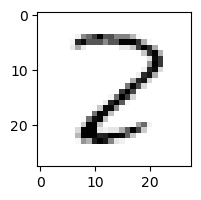

0.40222429288780687% - 0
0.3648046209381872% - 1
98.51807492830832% - 2
0.017421536967302465% - 3
0.014332472290926298% - 4
0.05737468709224433% - 5
0.022397930234529427% - 6
0.00868973838941179% - 7
99.98795442682153% - 8 - ОШИБКА
1.649802442147982e-09% - 9

 2


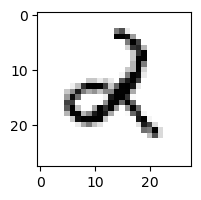

0.0011612745473761458% - 0
0.06935180993077086% - 1
4.9887051410707235% - 2
0.00014600644015486106% - 3
17.506071761663232% - 4 - ОШИБКА
0.0022076356060232814% - 5
0.4130353752456076% - 6
6.931989445531832e-05% - 7
0.009010828175168899% - 8
0.0006195748525081572% - 9

 2


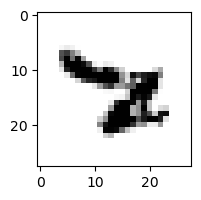

7.009200945407207e-07% - 0
0.00016367788708307517% - 1
6.744451104145507e-09% - 2
4.1604451088154505e-08% - 3
0.21457700453266132% - 4
0.011521303544399756% - 5
36.14504331829658% - 6 - ОШИБКА
0.6446769939119287% - 7
1.2280092867814288e-07% - 8
4.302048915118867e-07% - 9

 5


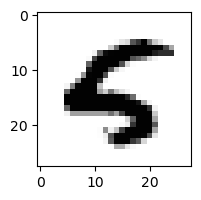

0.00044626754784445445% - 0
1.6637753084126709e-07% - 1
8.294247382176279e-07% - 2
1.211355107136191e-15% - 3
5.957142062018414% - 4 - ОШИБКА
0.3497574680575391% - 5
4.6681360576678666e-05% - 6
8.034552625379668e-08% - 7
1.3175654847424678e-12% - 8
2.666341251748626e-07% - 9

 1


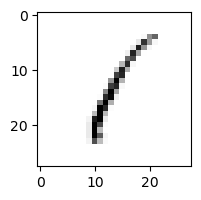

18.748427116876773% - 0
95.41772800462353% - 1
63.54622496719149% - 2
37.28992787285849% - 3
0.4526420274708867% - 4
17.731805520892834% - 5
67.72109874372089% - 6
0.14336588055008984% - 7
99.68675124342319% - 8 - ОШИБКА
34.00049316729386% - 9

 7


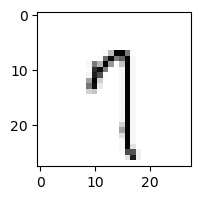

1.5724208069083652% - 0
2.3489785771028644% - 1
0.4274648200769353% - 2
3.956238576674091% - 3
17.906950195638487% - 4
32.12768673921928% - 5
7.398212947569495% - 6
71.9248818795848% - 7
7.564015558644338% - 8
99.98577885352509% - 9 - ОШИБКА

 1


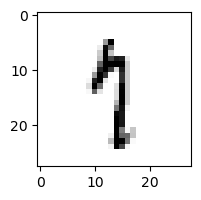

0.013072733249140243% - 0
18.11872100461514% - 1
0.005190665097074732% - 2
0.012518573775510172% - 3
15.567858443817029% - 4
30.169665850266288% - 5
0.6064534013940451% - 6
54.84754752456732% - 7 - ОШИБКА
0.4869469107130644% - 8
2.869915947709602% - 9

 2


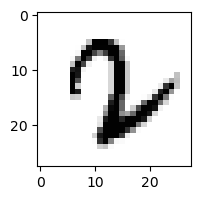

7.747455718715487e-07% - 0
0.115600707848109% - 1
1.5432130238039328e-05% - 2
0.0008288069735895021% - 3
3.199813517076029e-06% - 4
0.005276419026369861% - 5
0.9538553415725805% - 6 - ОШИБКА
0.016964872044731873% - 7
1.7381259536125034e-13% - 8
1.2662714850175585e-12% - 9

 6


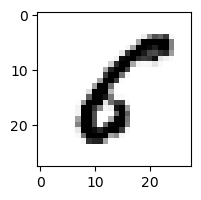

10.974606062807544% - 0
0.3168132439291459% - 1
0.0049763238709132004% - 2
2.608614174877198e-06% - 3
0.028127145532064825% - 4
85.82917386836225% - 5 - ОШИБКА
0.04230525703168362% - 6
2.5025305108212833e-05% - 7
8.936314378208161e-05% - 8
6.313430467188817e-10% - 9

 1


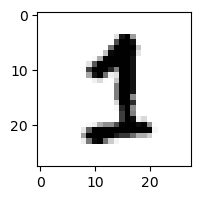

0.0002798959246452093% - 0
0.030579417681598012% - 1
0.002020471410439178% - 2
0.004074633563410151% - 3
3.6733623270860997e-06% - 4
1.2204177762987916% - 5 - ОШИБКА
0.00012542643893413168% - 6
0.09770599858435634% - 7
4.485181652627492e-07% - 8
4.23611779929603e-07% - 9

 9


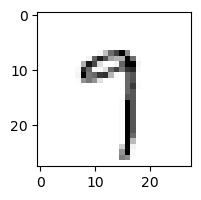

0.5279967195428233% - 0
0.4218374603041006% - 1
0.015145645547898115% - 2
1.4186201749546208% - 3
0.45511421472844515% - 4
13.976567844549765% - 5
0.2786653655445247% - 6
93.55395063906464% - 7 - ОШИБКА
0.2883565860501335% - 8
92.91649626883249% - 9

 7


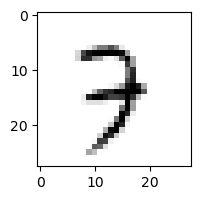

0.002489135596062249% - 0
0.00940112894803117% - 1
6.2239963079081475% - 2
30.66635152156555% - 3 - ОШИБКА
7.139881749292912% - 4
0.996626198094577% - 5
1.5190396391315222% - 6
3.0050622865745598% - 7
0.10088948395036566% - 8
14.26532115156135% - 9

 6


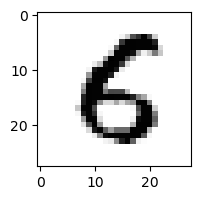

1.9926869022209994% - 0
4.65741948908236e-05% - 1
0.00019239464330856105% - 2
2.047386608447267e-06% - 3
0.01565779171664515% - 4
31.3068383994076% - 5 - ОШИБКА
17.897737622986035% - 6
1.5042441178131233e-07% - 7
1.6077712452051825e-07% - 8
1.3356011078524579e-08% - 9

 8


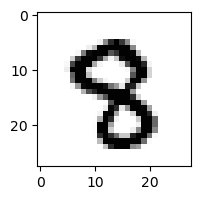

2.653898306089526e-06% - 0
3.7373280915178187e-07% - 1
4.374873580501743e-07% - 2
5.2868617226711745e-06% - 3
0.003129170496915239% - 4
0.21322468235310982% - 5 - ОШИБКА
1.3851625165346072e-07% - 6
0.0005046663775926501% - 7
1.0533591848029447e-05% - 8
1.0589467590391367e-07% - 9

 2


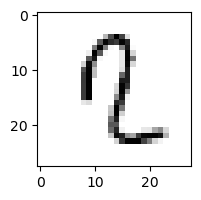

0.0017175811444276367% - 0
2.464979193013901% - 1
2.684541584599927% - 2
0.0024183398292608204% - 3
45.99499507158999% - 4 - ОШИБКА
9.459603286099695% - 5
0.020037163236930503% - 6
0.1757707793411071% - 7
0.00031540716669664994% - 8
0.0057965854342163945% - 9

 3


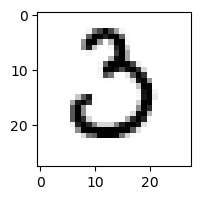

72.052910482535% - 0
0.00011217976221078414% - 1
91.2279059654294% - 2 - ОШИБКА
40.0504924473543% - 3
2.9476920847934407e-07% - 4
0.02405663730909636% - 5
0.22099743646157716% - 6
0.07146984199885043% - 7
1.0540106930627406e-10% - 8
6.1575825004986225e-09% - 9

 4


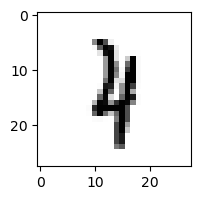

3.791675923188277e-06% - 0
14.363617299391358% - 1 - ОШИБКА
0.4380266940316087% - 2
0.0018069422889334169% - 3
3.726809428916502% - 4
0.011386761184486584% - 5
0.3834405728436571% - 6
0.31427939342234146% - 7
6.122329798797018% - 8
0.3199160096847072% - 9

 5


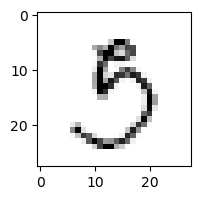

20.155239173352324% - 0
0.06332035766173645% - 1
0.008461417571936046% - 2
95.8178954054932% - 3 - ОШИБКА
0.010405181853553365% - 4
80.44585220373858% - 5
0.007441817536757891% - 6
0.04310196142194682% - 7
68.46802950135901% - 8
0.17117921091571953% - 9

 9


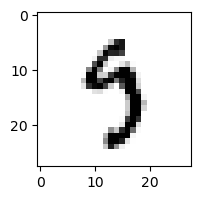

0.00692189920787532% - 0
0.02072899469551698% - 1
2.645858004822928e-07% - 2
4.19955061007694% - 3
1.6526671720171016% - 4
32.473175259353646% - 5 - ОШИБКА
0.11262621349106235% - 6
0.8984594703056141% - 7
0.01856651707643704% - 8
0.06823486238398616% - 9

 2


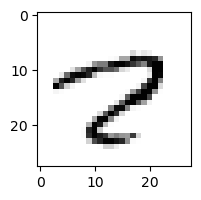

21.213063136939407% - 0
0.005716439257598971% - 1
5.4039283116650224e-06% - 2
8.05711069702538e-09% - 3
0.16018860798716492% - 4
3.034255042161495% - 5
2.9899052821713776e-05% - 6
97.8118174576386% - 7 - ОШИБКА
0.6593042153504077% - 8
0.001732701169922808% - 9

 8


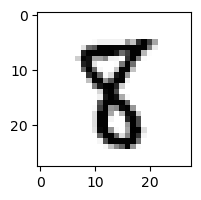

3.996501623125711e-06% - 0
0.009962130151682526% - 1
2.346570434662928e-05% - 2
7.271287082836164e-06% - 3
0.0003120380086243853% - 4
11.29695050405483% - 5 - ОШИБКА
9.36725317732891e-05% - 6
6.73963099323142e-05% - 7
0.45894788426857175% - 8
8.182484690820427e-09% - 9

 9


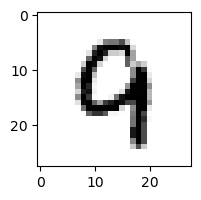

0.006219304813739627% - 0
2.1564587403002624e-05% - 1
0.23461027583259741% - 2
5.860998703939816e-08% - 3
48.20062508169797% - 4 - ОШИБКА
0.00018428245274997225% - 5
0.36177125748411304% - 6
0.04467955632122862% - 7
0.00023441105484410415% - 8
5.967551352647313% - 9

 7


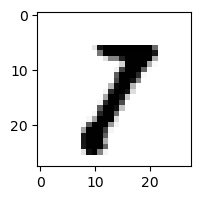

0.0003561317743583875% - 0
6.8480511613793755% - 1 - ОШИБКА
0.0029935855718615087% - 2
0.16490558557698137% - 3
2.556323756467931e-06% - 4
0.023316587292820455% - 5
1.2358486983081275e-07% - 6
1.1749180902684193% - 7
8.846523624087001e-05% - 8
0.004422124615719659% - 9

 5


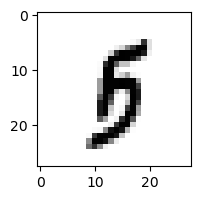

0.00013495155277832554% - 0
0.07177173376387311% - 1
2.8321774589312774e-05% - 2
0.08355968035939089% - 3
0.0052547365396980105% - 4
2.1583810973280997% - 5
0.29775792961302977% - 6
0.0026922034314916066% - 7
1.8952397272735715% - 8
3.271860655885623% - 9 - ОШИБКА

 5


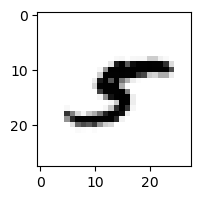

0.0005599527967369909% - 0
13.85953624761567% - 1 - ОШИБКА
0.0006244501231096578% - 2
0.0030414848308425923% - 3
0.017162577718985106% - 4
0.0805968981712051% - 5
0.00013448078747022694% - 6
0.2778631213547367% - 7
5.115497310603638% - 8
8.53954195459976e-06% - 9

 3


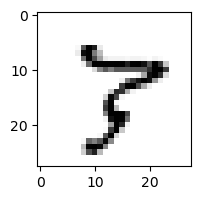

0.00022429989391923355% - 0
0.03602132188650437% - 1
0.009656579768625549% - 2
0.00010143464857194534% - 3
0.014513364952714025% - 4
0.0014518675177565147% - 5
0.0003106275819392037% - 6
98.19748429139788% - 7 - ОШИБКА
64.06985066756783% - 8
0.0010415142545955412% - 9

 4


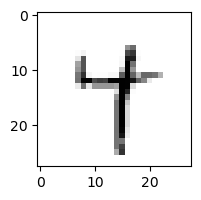

0.0010949794108459133% - 0
11.507920401786736% - 1
6.994551980165058e-06% - 2
0.33952056872725817% - 3
64.63575828640354% - 4
0.13496545000036841% - 5
0.9170075134854141% - 6
18.167259630827694% - 7
10.369571056142178% - 8
92.41233026701163% - 9 - ОШИБКА

 5


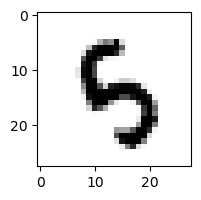

7.2274168376884654e-06% - 0
5.4312792024929e-05% - 1
0.001841069783080723% - 2
0.007274495048957371% - 3
38.241859286557165% - 4 - ОШИБКА
20.345545430383165% - 5
1.7974984985490723% - 6
4.9252780908957585e-06% - 7
0.00016407790429075333% - 8
0.022673565645727645% - 9

 3


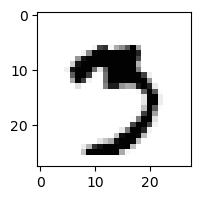

0.00015151607197339716% - 0
0.00010384374049863684% - 1
9.655129975569791e-11% - 2
0.026056529768693822% - 3
7.342464118204826e-09% - 4
4.628897232014592% - 5
1.783981989715625e-07% - 6
52.64278411756641% - 7 - ОШИБКА
1.2201270695520108e-07% - 8
0.003975359306868149% - 9

 9


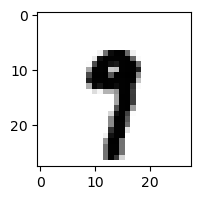

1.5098196727741892e-07% - 0
0.05892817639219657% - 1
8.795386071918003e-11% - 2
6.400844054611658e-06% - 3
0.0039989884082328115% - 4
0.5691745719270144% - 5
0.0001228353861038639% - 6
5.282347996399875% - 7 - ОШИБКА
1.7218581427072695e-06% - 8
0.061966738191068876% - 9

 5


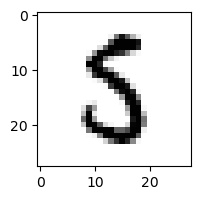

0.02317924234514871% - 0
0.005586809540129806% - 1
0.034157923777460485% - 2
0.03243493362559442% - 3
3.92420797950617e-05% - 4
65.27129270520436% - 5
0.5595773899021007% - 6
0.000316803420329911% - 7
69.76893808981981% - 8 - ОШИБКА
7.864869914697477e-09% - 9

 3


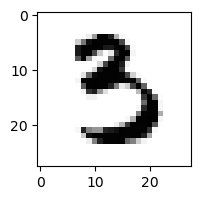

0.0007107947802290116% - 0
8.832190831669171e-06% - 1
2.9895735391966386e-08% - 2
43.567978313019786% - 3
2.7337398143146257e-06% - 4
49.62524525550606% - 5 - ОШИБКА
9.217679277314685e-05% - 6
3.5491645677660246e-05% - 7
8.642193165181197e-11% - 8
1.9864439306421865e-11% - 9

 5


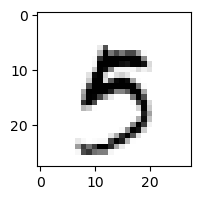

0.007737874772997775% - 0
0.0008256051063101887% - 1
2.9013251249248193e-08% - 2
0.3978606555899749% - 3
0.4676708040805627% - 4
15.05874579129375% - 5
0.00088177524814799% - 6
0.02685443587918611% - 7
9.847947451965259e-08% - 8
50.228082568148466% - 9 - ОШИБКА

 5


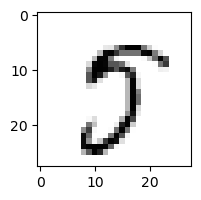

0.9255105193098362% - 0
0.000239982906095593% - 1
2.019529214857536e-05% - 2
0.03305826807839369% - 3
0.0006505000469421012% - 4
91.1019150440199% - 5
0.00013435753400635225% - 6
93.22553803228142% - 7 - ОШИБКА
0.030470604600151614% - 8
0.06473836918622149% - 9

 5


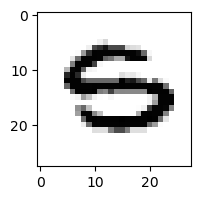

0.4038448627295871% - 0
6.377392443038465e-07% - 1
2.528384541354503e-07% - 2
2.3015018852554475e-05% - 3
6.055064152955787e-06% - 4
0.35572417541477197% - 5
77.25661308901351% - 6 - ОШИБКА
4.69378978042e-06% - 7
4.385700119421828e-12% - 8
1.7460998532968183e-05% - 9

 8


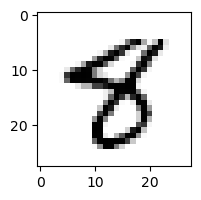

1.5330442713029604e-05% - 0
0.001218550466191255% - 1
7.268902924362576e-11% - 2
1.9663705626801878e-08% - 3
0.06057252007244926% - 4
32.63892498563125% - 5 - ОШИБКА
1.3019449666820301e-05% - 6
0.0007641080489166603% - 7
7.239092461720265% - 8
1.3368093184360472e-05% - 9

 8


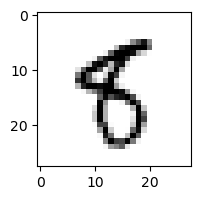

0.009344830969928315% - 0
0.011418191425544717% - 1
3.7552671879852187e-06% - 2
1.7837657931018618e-05% - 3
0.001116971412783144% - 4
64.34155238613481% - 5 - ОШИБКА
1.3335153170559266% - 6
0.0001632382517997979% - 7
13.971148575906081% - 8
1.8751190357968461% - 9

 9


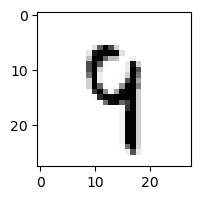

4.2651802983139645e-05% - 0
0.03113659121791471% - 1
0.15938128919783992% - 2
0.09433281425566487% - 3
52.847858990016626% - 4 - ОШИБКА
2.860088917853754% - 5
0.3449337568167465% - 6
1.3028030767949625% - 7
1.8145228614902822% - 8
18.122123275407553% - 9

 9


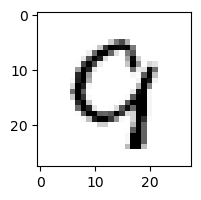

24.385078222970577% - 0 - ОШИБКА
6.52351627577119e-06% - 1
1.530984023828503% - 2
1.0961693233368584e-07% - 3
1.4488483448959844% - 4
0.0022697759747426936% - 5
0.5264976484050191% - 6
1.235826281125767% - 7
0.0001676182389918771% - 8
0.6907133019925039% - 9

 9


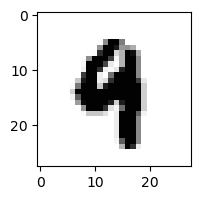

8.543690781910041e-08% - 0
0.0004219117044719077% - 1
1.3698975549250153e-08% - 2
1.312915733531287e-09% - 3
1.6445762237927244% - 4 - ОШИБКА
0.001524925411003914% - 5
0.00028233171895934375% - 6
4.642301251113023e-06% - 7
1.130561480037798e-10% - 8
0.021390056722059084% - 9

 2


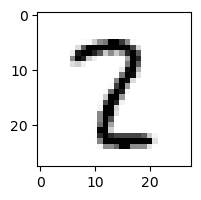

5.321005111218963e-05% - 0
1.2086459878433775% - 1
0.3202937917721252% - 2
0.1563490700893452% - 3
0.007174321872757965% - 4
0.15202056107263556% - 5
2.459303423772704e-06% - 6
0.5726748732012338% - 7
18.70092288541134% - 8 - ОШИБКА
1.649803813313427e-07% - 9

 8


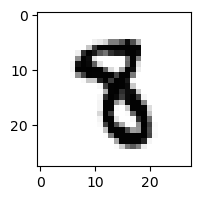

3.8917059157429666e-10% - 0
0.0010346593696282753% - 1
2.1234966612966706e-07% - 2
2.4291228617342744e-05% - 3
0.0007583642050233113% - 4
3.1247594779273142% - 5 - ОШИБКА
1.6472761953879715e-05% - 6
0.00043986302347598323% - 7
9.244409263605406e-07% - 8
4.991802411816891e-10% - 9

 3


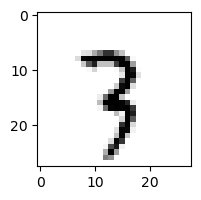

3.0506134785534967e-06% - 0
4.103431103150098% - 1
1.5054253215018898% - 2
0.04945108370661978% - 3
0.4734930215811126% - 4
0.08172065054036305% - 5
0.02064003264570033% - 6
60.00731279577109% - 7 - ОШИБКА
0.26305367303713667% - 8
0.8496219641080823% - 9

 6


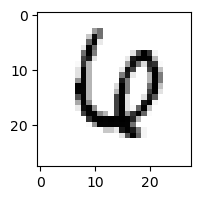

0.03244174256100158% - 0
0.0015516762669496292% - 1
0.003074503323027239% - 2
3.8905219810675753e-07% - 3
2.5444436703023836% - 4
9.358376300411103e-05% - 5
3.4824278440809757% - 6
3.694372631545014% - 7 - ОШИБКА
3.329062117519662e-09% - 8
3.9288118229772574e-07% - 9

 6


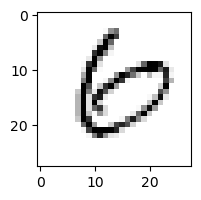

74.76384066181285% - 0 - ОШИБКА
0.0005015918694173172% - 1
0.02021143503605891% - 2
0.04441999760130506% - 3
0.035741729594394575% - 4
0.028177642833282376% - 5
12.711122445285827% - 6
0.0009854918672553537% - 7
0.8072076901293335% - 8
0.0002521863555104956% - 9

 2


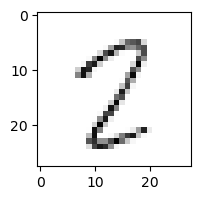

2.7822712014343445% - 0
2.673200307649711% - 1
7.808429176388801% - 2
0.1083803292015855% - 3
0.7971993304789855% - 4
40.98259703035206% - 5
0.04039836176778453% - 6
7.984695861233147% - 7
99.96753329302886% - 8 - ОШИБКА
0.05251049102972834% - 9

 9


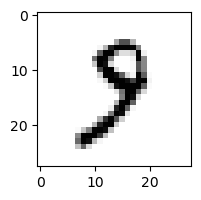

0.010826940484107608% - 0
1.8167105174833713% - 1
0.011185449744916028% - 2
0.09803331917992472% - 3
0.002433547220830719% - 4
2.009519068891689% - 5
0.0033390059913361737% - 6
6.9924789272927015% - 7 - ОШИБКА
0.006838501132780419% - 8
0.005697450002721397% - 9

 8


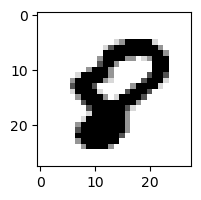

0.3646448798448251% - 0 - ОШИБКА
5.426356043545678e-09% - 1
8.704347274797809e-11% - 2
4.8317856402088976e-20% - 3
0.00011543177670341916% - 4
0.05337561985375355% - 5
0.00047963848508814837% - 6
7.426423521541602e-06% - 7
3.82300207448529e-06% - 8
6.975376058975694e-10% - 9

 5


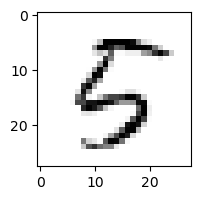

0.6743831304856845% - 0
0.002198594627139376% - 1
0.1258780266360009% - 2
0.00042579198250639717% - 3
27.552999617592803% - 4 - ОШИБКА
7.098599375405507% - 5
0.3702041374323319% - 6
0.0006202985231102754% - 7
0.7255082834921763% - 8
7.482424482578201e-06% - 9

 0


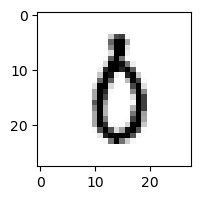

3.5345543564074067% - 0
0.055123615231474556% - 1
0.026130783295270514% - 2
1.1551389987820115% - 3
0.004638137057780461% - 4
3.074189659742484% - 5
26.3195930182375% - 6 - ОШИБКА
0.019559371510480116% - 7
0.13922711224802728% - 8
0.0012746410620527611% - 9

 8


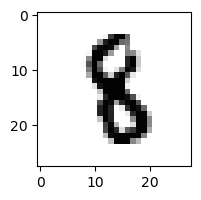

5.115540770501275e-09% - 0
0.05192580015459883% - 1
4.398985125134815e-05% - 2
0.00018192933253463473% - 3
0.005525427519974027% - 4
0.9800150875156873% - 5 - ОШИБКА
0.0006844986409560817% - 6
3.689745957159271e-05% - 7
4.212967146097391e-05% - 8
1.419834763924835e-10% - 9

 9


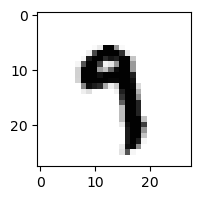

1.8130390889400327e-06% - 0
0.004285397610496497% - 1
1.2726640900379496e-09% - 2
0.001502638012809138% - 3
0.022660314251782044% - 4
9.924608720291204% - 5 - ОШИБКА
0.001116400801751322% - 6
2.737257138254045% - 7
4.629310652105498e-07% - 8
0.5866126601609393% - 9

 7


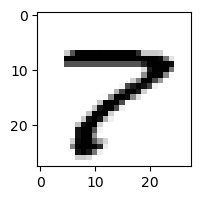

0.012242371371977388% - 0
4.602559860884473e-05% - 1
0.055168766372165036% - 2
1.0180801809575341e-05% - 3
4.5903427649390756e-07% - 4
0.0007999280741317799% - 5
1.0736683295164636e-07% - 6
94.23696238736214% - 7
95.82438327120114% - 8 - ОШИБКА
0.0001527821127134417% - 9

 9


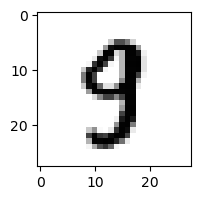

0.0024647461717174817% - 0
0.000547467799518151% - 1
3.3704401044465115e-06% - 2
0.005939271962371058% - 3
0.039408584595685976% - 4
1.354883730607128% - 5 - ОШИБКА
5.3773487903663506e-06% - 6
0.03584612008444723% - 7
0.010097051518194698% - 8
0.01591432480050544% - 9

 3


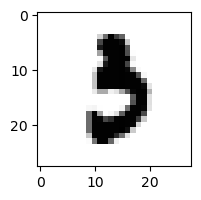

0.0013371759286207071% - 0
0.0009573030454670986% - 1
2.9502372668345634e-06% - 2
0.01645579230280983% - 3
1.8721671162786896e-08% - 4
0.4364951361364523% - 5 - ОШИБКА
0.04269646239835639% - 6
0.0019640920758564615% - 7
3.253357800133706e-10% - 8
3.6843863940776065e-09% - 9

 8


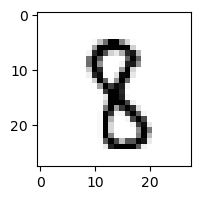

5.767623842229708e-07% - 0
0.055756675007803375% - 1
0.0028320572618351237% - 2
0.003818000545494314% - 3
0.02974477754616906% - 4
3.7894643314758634% - 5 - ОШИБКА
1.7909709628691672e-05% - 6
0.0045727582639802635% - 7
1.1299879893284583% - 8
2.9988002531297368e-05% - 9

 8


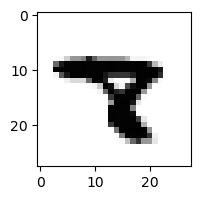

1.4714857532410218e-09% - 0
0.0016515166581289296% - 1
1.291118900981025e-09% - 2
1.1231235364437237e-11% - 3
0.011067885743308402% - 4
0.00017040529322189703% - 5
1.4146107173461773e-06% - 6
7.256402599263604% - 7 - ОШИБКА
1.5030797158839804e-06% - 8
6.509135159465113e-08% - 9

 7


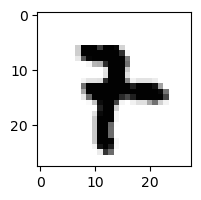

1.150333672718899e-06% - 0
0.0014287426833879447% - 1
1.9009905293323178e-07% - 2
2.7352447535343377e-05% - 3
0.003527924315070658% - 4
0.06953594369579168% - 5
0.9854716454848583% - 6 - ОШИБКА
0.007529465243150635% - 7
6.632529735321234e-09% - 8
0.00014194623265997755% - 9

 9


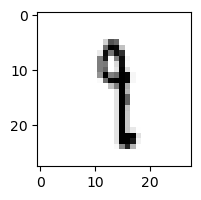

0.0020450868154419117% - 0
91.73396192502473% - 1 - ОШИБКА
0.035342378403976284% - 2
34.67552555295418% - 3
0.2996629806034967% - 4
9.56897626003468% - 5
0.16575733879086976% - 6
5.460977984147904% - 7
14.243016027236413% - 8
21.338621980179997% - 9

 9


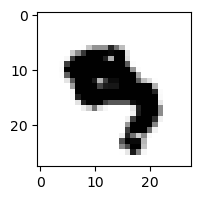

8.114610594261717e-10% - 0
7.554415623440067e-07% - 1
1.0536580077076009e-14% - 2
7.284176447328024e-09% - 3
0.010654811829850726% - 4
0.8498647403011921% - 5 - ОШИБКА
0.0003669676155699111% - 6
6.225399556491363e-05% - 7
1.321736381287894e-16% - 8
4.2584197804550345e-05% - 9

 9


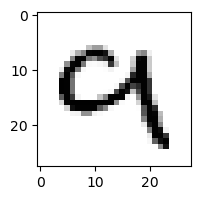

0.014740165811863118% - 0
0.00015736658808728656% - 1
1.0092947382957604% - 2
0.003730444582822343% - 3
3.9476278674649263% - 4 - ОШИБКА
0.00021520617641506264% - 5
0.001993203503466771% - 6
0.4877549059254806% - 7
0.0011312543169518104% - 8
1.243721744670248% - 9

 8


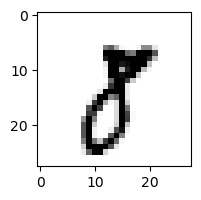

0.0035594524986736794% - 0
0.8803996895759029% - 1 - ОШИБКА
4.728955452758685e-05% - 2
0.6698380610756828% - 3
3.118902053793133e-07% - 4
0.06725614975093978% - 5
2.3777271207368134e-07% - 6
0.10423296482808372% - 7
0.002389126001215372% - 8
0.0148640374980334% - 9

 9


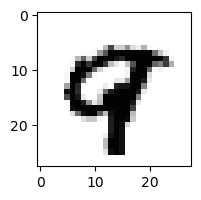

1.58127657525859e-06% - 0
6.222794047797099e-07% - 1
8.221326930004949e-08% - 2
1.8435414573767975e-16% - 3
0.010281950869797944% - 4
5.572897532112203e-05% - 5
2.8281100016670832e-08% - 6
0.07532250211397226% - 7 - ОШИБКА
0.0008682905529414801% - 8
0.0104801869979554% - 9

 6


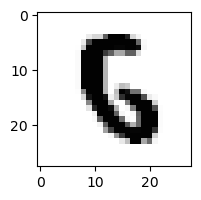

3.4061423706843994e-07% - 0
8.130392304804606e-09% - 1
0.27018755580357484% - 2
5.598748176129491e-10% - 3
0.021406417991327503% - 4
12.066974187017424% - 5 - ОШИБКА
4.248893914541778% - 6
2.727265207040111e-07% - 7
1.5130620433250308e-11% - 8
6.798179858957686e-12% - 9

 7


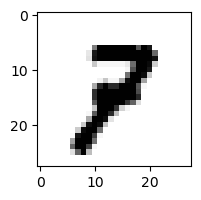

0.0004520997925392164% - 0
0.0039242739256987% - 1
0.09976626289411533% - 2
0.013099103904649686% - 3
0.00015562736081532315% - 4
0.0033499196733106965% - 5
2.9821621959950937e-06% - 6
0.019632720692796292% - 7
0.01651725884588866% - 8
1.541401554113715% - 9 - ОШИБКА

 8


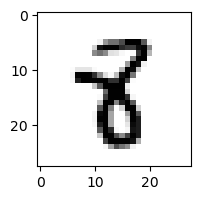

2.7830214439746904e-06% - 0
0.5105106898800299% - 1
1.8567169466471e-07% - 2
0.00013167737587853177% - 3
0.07516907292302671% - 4
2.9067994445797356% - 5 - ОШИБКА
9.029311458562366e-05% - 6
2.65762468641997e-05% - 7
2.0653347300049045% - 8
2.277618097524623e-08% - 9

 5


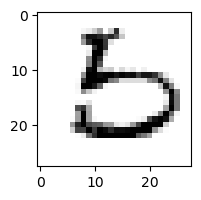

1.8903195023485408% - 0 - ОШИБКА
8.16600820500251e-06% - 1
0.016053941709053134% - 2
0.0037592205414059636% - 3
1.838988944075598e-05% - 4
0.08834389071184955% - 5
0.7727173387525771% - 6
5.328719311631678e-05% - 7
0.00718868286253708% - 8
3.462129017891426e-09% - 9

 3


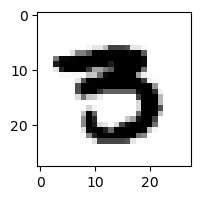

0.0015954824781966419% - 0
1.0322317046493196e-07% - 1
7.136401178927822e-13% - 2
0.0015626072619916074% - 3
7.123213727245297e-08% - 4
1.5968280081152062% - 5 - ОШИБКА
3.0480177134909287e-07% - 6
0.002383493838322302% - 7
1.9863972546294663e-14% - 8
2.723071562795432e-12% - 9

 9


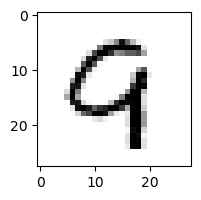

0.0794168261866712% - 0
9.25630878766263e-05% - 1
5.926820384157258% - 2
1.416328526216784e-08% - 3
7.564721615242559% - 4 - ОШИБКА
0.00013923734808262583% - 5
0.6210584602781364% - 6
0.07456469677173842% - 7
0.31061973059396725% - 8
1.4734541630697924% - 9

 4


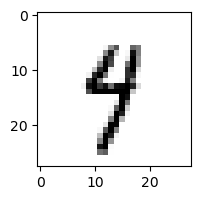

0.002165109622379709% - 0
0.2856655016802385% - 1
6.44638740865676e-05% - 2
0.009453804152582254% - 3
62.09045233783311% - 4
17.395709384371077% - 5
0.17500612340777122% - 6
1.6388858275497593% - 7
0.28185142560412% - 8
66.67081221752554% - 9 - ОШИБКА

 6


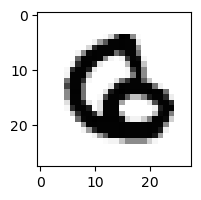

7.34720948690764e-06% - 0
7.824988796098337e-08% - 1
0.05137421025978786% - 2 - ОШИБКА
1.808474475020829e-14% - 3
4.621993805550998e-07% - 4
0.0001256230673982862% - 5
0.0006965576224987944% - 6
8.543875620169718e-09% - 7
7.761633307711533e-15% - 8
3.262582103632902e-17% - 9

 8


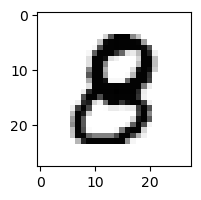

0.0007903444649154128% - 0
3.430816128628413e-07% - 1
0.0006215556742173122% - 2
0.0002826888759713239% - 3
0.005304224660712465% - 4
0.09725598573782698% - 5 - ОШИБКА
2.2654432424183604e-07% - 6
1.5933113455791907e-08% - 7
0.009833170265468446% - 8
8.112371042710905e-10% - 9

 4


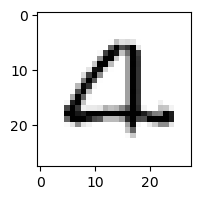

5.53342627338227% - 0
5.185379358118267e-06% - 1
87.15362376682734% - 2 - ОШИБКА
4.2755088484008115e-08% - 3
0.001894726890872124% - 4
0.012257567184582012% - 5
0.021644876678385057% - 6
0.012500301781917753% - 7
6.563761688338604e-08% - 8
0.016288247002311986% - 9

 5


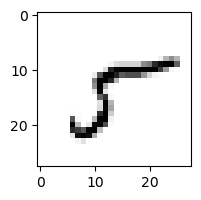

36.05672323846715% - 0
1.8329016846675454% - 1
0.04396311503267937% - 2
7.860336207238264% - 3
0.13133340539854932% - 4
90.18280365505942% - 5
0.10696007350964046% - 6
6.543722385120515% - 7
98.43612982009414% - 8 - ОШИБКА
0.0052361475253663685% - 9

 5


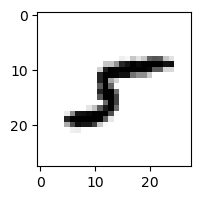

0.6089966449639558% - 0
2.2978591109706814% - 1
0.16999927061948358% - 2
0.0023863911820803827% - 3
0.013389409125100313% - 4
4.9047530569086755% - 5
0.00048379454669956416% - 6
0.20316658094126291% - 7
99.98102960964835% - 8 - ОШИБКА
0.00010097855260577208% - 9

 8


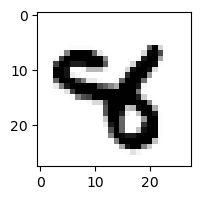

5.22799125328667e-11% - 0
8.144736836685024e-06% - 1
2.062625635599343e-08% - 2
1.257603856123344e-09% - 3
94.72893359221554% - 4 - ОШИБКА
0.0089976172889746% - 5
1.0709853626611743e-07% - 6
0.01006023302512787% - 7
3.784130673624877e-11% - 8
7.253452757919926e-11% - 9

 3


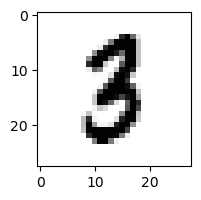

5.5981605306861626e-05% - 0
0.013799223372059397% - 1
0.088797580692235% - 2
0.6850604438115042% - 3
3.746733384256414e-06% - 4
1.3837239364222524% - 5 - ОШИБКА
0.00021813502949983668% - 6
7.220851327592338e-05% - 7
0.00033967976786018154% - 8
4.2837377055015855e-08% - 9

 3


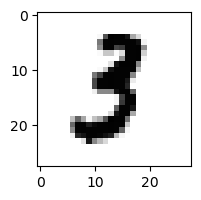

0.0007625577284479887% - 0
0.09897204784757303% - 1
0.0006779292805323746% - 2
0.2306530244670693% - 3
4.4195509015731816e-07% - 4
2.82060056670795% - 5 - ОШИБКА
2.7547702965191132e-05% - 6
8.825317778583884e-05% - 7
9.84596018327846e-11% - 8
1.716135553705106e-13% - 9

 2


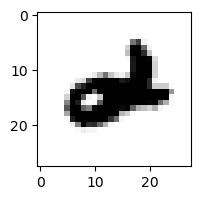

0.0008331861740155494% - 0
4.222915850829778e-05% - 1
9.95287775854371e-08% - 2
2.6988625000709207e-10% - 3
98.36968947084742% - 4 - ОШИБКА
9.41980346640078e-08% - 5
0.16888588974155525% - 6
2.382576356123386e-05% - 7
9.345750106827842e-10% - 8
1.5465096945677226e-05% - 9

 6


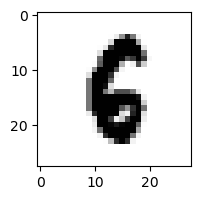

1.7452035541809233e-05% - 0
0.00022072978517351152% - 1
7.597204679085164e-05% - 2
5.763561363229855e-11% - 3
0.0006414046451962097% - 4
0.6655520035361765% - 5 - ОШИБКА
0.3907049832600196% - 6
2.430859495008706e-05% - 7
5.388190381099603e-07% - 8
1.0278642362005507e-07% - 9

 8


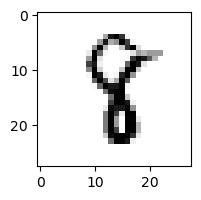

6.006624602692529e-07% - 0
3.755243779827834% - 1 - ОШИБКА
0.0008341103711506027% - 2
0.0004311258551804838% - 3
1.4238174777964936% - 4
1.9594485928189032% - 5
3.0998385144821855e-05% - 6
0.01708644265924031% - 7
0.0015038335098235829% - 8
1.974045360383567e-09% - 9

 3


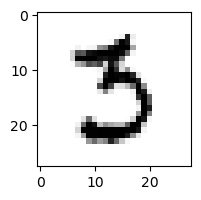

0.14063624778096953% - 0
0.0009964069888407448% - 1
0.0013159246169984551% - 2
84.24463614775424% - 3
5.692088756327945e-07% - 4
84.94506197638506% - 5 - ОШИБКА
0.01379088936843285% - 6
0.056851451728081044% - 7
0.002620923011499196% - 8
8.518155156752286e-10% - 9

 8


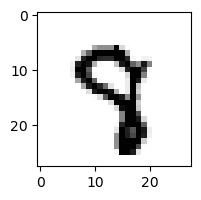

1.1782900371180053e-05% - 0
2.3199346112645762e-05% - 1
4.01795207476461e-05% - 2
0.00041883733251082847% - 3
0.043119944473612934% - 4
0.31281969615978755% - 5
3.422712582642354e-05% - 6
0.3485360225866288% - 7 - ОШИБКА
4.964136795637131e-05% - 8
0.08145707943903814% - 9

 8


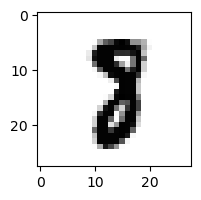

1.4259878932307707e-06% - 0
0.021091520519164058% - 1
0.0002206730520187629% - 2
1.8702286612801954e-05% - 3
3.8950893502372433e-07% - 4
0.01446672647113864% - 5
3.1464096402023107e-06% - 6
0.7414929217285612% - 7 - ОШИБКА
7.772641386244451e-07% - 8
5.2157271970433225e-12% - 9

 2


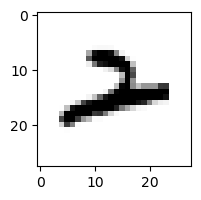

0.0004951229705969235% - 0
0.02752874170513069% - 1
16.24053628740614% - 2
2.2199616759876035e-06% - 3
25.77113963170999% - 4 - ОШИБКА
8.260929159146498e-07% - 5
1.2219292060527327% - 6
4.248756489467703% - 7
6.132996253366935e-07% - 8
0.12511946657976725% - 9

 3


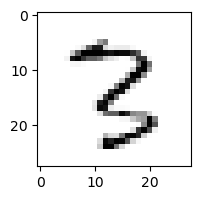

0.00017979735304112716% - 0
0.016112935017059737% - 1
8.559572717095948% - 2
20.30515952285746% - 3
0.036945467365702436% - 4
0.16335529899804455% - 5
0.0001359508624148842% - 6
0.8504405825180453% - 7
99.70563317969645% - 8 - ОШИБКА
0.0408162838380142% - 9

 8


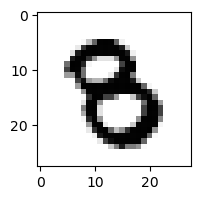

7.11006212160811e-05% - 0
6.171422298032045e-07% - 1
3.48728390738335e-07% - 2
0.01791732869227759% - 3
3.7568260497283734e-05% - 4
0.17084626960321111% - 5 - ОШИБКА
0.00011286232566281227% - 6
1.0699602819938046e-07% - 7
4.8748349421842735e-11% - 8
1.7099208619888737e-11% - 9

 9


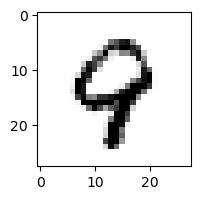

0.0022995563649051867% - 0
0.0002131275235337076% - 1
0.0040716830662596674% - 2
1.3345144110844896e-09% - 3
24.43231468179367% - 4 - ОШИБКА
0.0030725530454336985% - 5
0.11399903718792685% - 6
0.01267071672387334% - 7
0.21553072936934706% - 8
3.27053394591834% - 9

 9


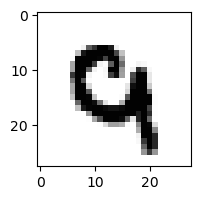

0.00030361511680478804% - 0
1.1805610806004777e-07% - 1
0.01580150961461925% - 2
1.4783954136747718e-12% - 3
0.031034199482312196% - 4
0.00023123236939382282% - 5
0.5670246394909209% - 6 - ОШИБКА
0.40901252109959013% - 7
1.4069989559226058e-13% - 8
0.001414389078245019% - 9

 4


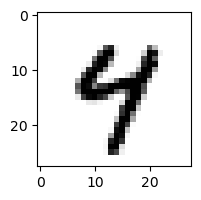

0.0005167820849061124% - 0
1.7476054766422815e-05% - 1
2.5144771611283694e-08% - 2
1.0846025102574073e-05% - 3
76.01530411988279% - 4
4.8428488299666475% - 5
0.0018842170563962886% - 6
0.051693686091123146% - 7
0.00633388261075709% - 8
82.98110701185063% - 9 - ОШИБКА

 6


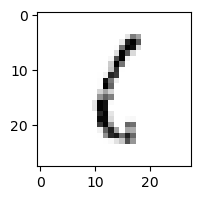

14.40990707569264% - 0
45.76228385337411% - 1
58.52059773676861% - 2
6.456574127370413% - 3
0.050233587536131094% - 4
36.76294830499191% - 5
97.29611362229774% - 6
0.03911526829534744% - 7
99.96219689328912% - 8 - ОШИБКА
6.2922508938351935% - 9

 5


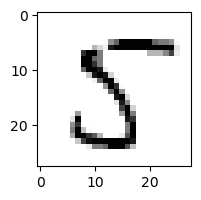

0.015192997438265814% - 0
0.011206185268196455% - 1
0.0014128206690565135% - 2
0.00044951725799990565% - 3
0.06267142836809422% - 4
99.95576777292877% - 5
0.0001030159436916894% - 6
0.000578931215661803% - 7
99.99857851330579% - 8 - ОШИБКА
2.565724209769594e-11% - 9

 4


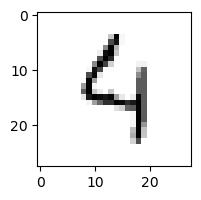

0.3152034979535397% - 0
0.01398550509734479% - 1
26.948898466960276% - 2
1.0128067044361408% - 3
80.83109005223793% - 4
11.737516837580793% - 5
18.503649263387985% - 6
0.47061165248998493% - 7
0.12924450998578668% - 8
87.95974583459372% - 9 - ОШИБКА

 5


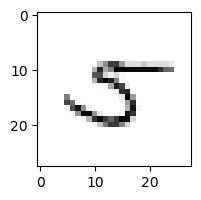

8.574999904564304% - 0
1.6915376226019925% - 1
0.28736645795704086% - 2
0.07542589507270253% - 3
0.860242272710468% - 4
0.7405000864899799% - 5
12.118792510823702% - 6
19.47589531111276% - 7 - ОШИБКА
3.7103682417639874% - 8
0.11478247262912346% - 9

 8


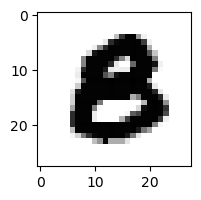

0.01468214794831407% - 0
2.7448490511321702e-11% - 1
2.003315696592543e-09% - 2
8.211762372330727e-08% - 3
5.47136988188328e-09% - 4
0.1513968520620025% - 5 - ОШИБКА
6.013774967535936e-07% - 6
2.73777240186117e-11% - 7
6.6272837416382306e-15% - 8
9.979078573833264e-17% - 9

 8


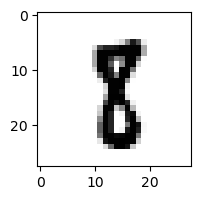

4.941127443322441e-07% - 0
1.7651301190071425% - 1
1.0757975510335607e-05% - 2
0.0001268047121849037% - 3
2.9725295393264207e-06% - 4
2.8581822268160715% - 5 - ОШИБКА
6.435745694673107e-06% - 6
0.006796192058018971% - 7
0.01461529602244278% - 8
1.7154833955252195e-07% - 9

 8


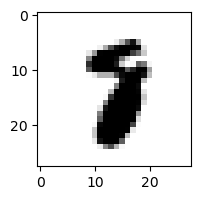

2.0360100913766845e-08% - 0
0.0019760497711352014% - 1
4.299228211093624e-05% - 2
2.6959978813670246e-09% - 3
5.584719889733131e-06% - 4
0.001299903603564193% - 5
2.999122633103103e-05% - 6
5.081645261258423% - 7 - ОШИБКА
4.0144251456877695e-07% - 8
9.018390875396602e-09% - 9

 3


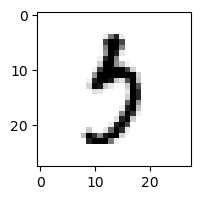

0.2666022269492817% - 0
0.0312748604905527% - 1
2.675743786088005e-05% - 2
4.737772528565168% - 3
0.030578043559731708% - 4
24.11728080373699% - 5 - ОШИБКА
0.02140007156230992% - 6
3.605035240322483% - 7
0.0010890330625034298% - 8
0.001191420428299988% - 9

 8


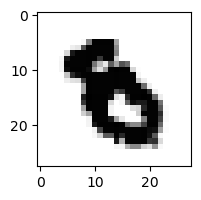

8.778904913591392e-10% - 0
2.0589105426716674e-08% - 1
9.94593010418686e-10% - 2
3.42410609157589e-10% - 3
0.0001249204349122114% - 4
0.20035436541552248% - 5 - ОШИБКА
0.011571507207071017% - 6
7.917666401390399e-08% - 7
3.2844314521144415e-16% - 8
1.732777171375544e-15% - 9

 5


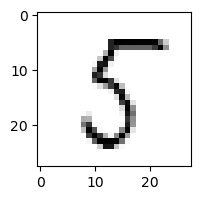

3.3460980439567525% - 0
0.4249291661400625% - 1
0.06471254307936158% - 2
0.0749927374280821% - 3
0.4344717245162599% - 4
98.88203233700762% - 5
0.21824670245545377% - 6
0.001592719418728868% - 7
99.97691321198468% - 8 - ОШИБКА
4.161221353439971e-06% - 9

 4


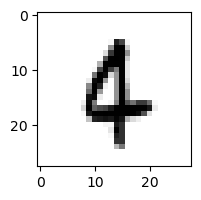

0.00016226739805850823% - 0
0.06000124103454005% - 1
0.0013175052775045103% - 2
3.0150399517947623e-09% - 3
0.14630652141864467% - 4
0.022844756322514037% - 5
20.73030743346517% - 6 - ОШИБКА
0.14072270470263604% - 7
3.0875411000014663e-07% - 8
0.014368789911633716% - 9

 9


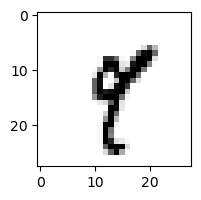

5.48848693263056e-05% - 0
16.6303807118094% - 1
3.619861432980812e-06% - 2
0.007785091938870038% - 3
1.4333470113667088% - 4
5.129964644734797% - 5
1.6490500431734164e-05% - 6
21.841466769312348% - 7 - ОШИБКА
0.01698104173950577% - 8
0.0468906465810639% - 9

 5


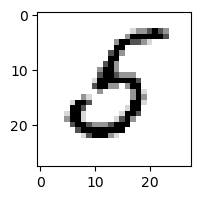

0.6868685259293509% - 0
0.0006670965995371212% - 1
0.0177565316532918% - 2
0.0631780627448084% - 3
0.00874197612771847% - 4
31.168134702912308% - 5
80.70075472288431% - 6 - ОШИБКА
0.00035279476975879227% - 7
1.037522338844706e-07% - 8
1.6103034845487848e-07% - 9

 5


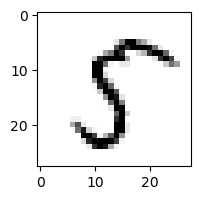

0.08128272383816848% - 0
0.027630829772337325% - 1
0.04340000850424319% - 2
0.00019511580519957712% - 3
0.07596882719980662% - 4
99.82491915057705% - 5
0.0005877983001043093% - 6
0.0014765385984399147% - 7
99.98056196324143% - 8 - ОШИБКА
5.0591918968627144e-05% - 9

 8


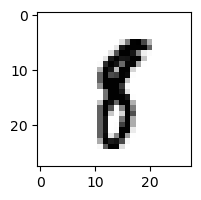

1.1726961862667686e-05% - 0
9.119332027372034% - 1 - ОШИБКА
5.415551599370289e-06% - 2
0.0015232143132830262% - 3
0.0002690680497672928% - 4
1.1477924008509868% - 5
0.00046559012229606937% - 6
0.0027556493322267246% - 7
0.06299041336256948% - 8
2.7246616498901638e-05% - 9

 3


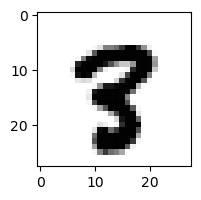

1.6893861204948526e-08% - 0
7.072519791844826e-06% - 1
7.41688103252051e-08% - 2
8.210982388653033e-09% - 3
1.3181154138273549e-05% - 4
0.08124385127894426% - 5
1.1873371085457182e-09% - 6
0.004065359578073216% - 7
7.429698409108528% - 8 - ОШИБКА
0.0006702301804716953% - 9

 8


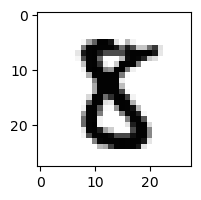

4.126124168997014e-05% - 0
2.8451013832685384e-06% - 1
2.653010670230523e-06% - 2
3.2178987055276923e-07% - 3
4.957720696340082e-07% - 4
15.036915103970797% - 5 - ОШИБКА
5.412976936897672e-09% - 6
5.976043329580527e-07% - 7
0.16807287382895378% - 8
4.002770237483007e-13% - 9

 8


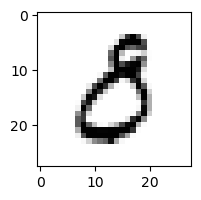

89.90812502286792% - 0 - ОШИБКА
0.0028280471927720602% - 1
0.005606902534026604% - 2
29.174464207505668% - 3
0.00011585497564834226% - 4
4.115763920705949% - 5
0.005453220355463246% - 6
0.00035096021010623676% - 7
1.6903610305535676e-07% - 8
1.6953270664674679e-09% - 9

 3


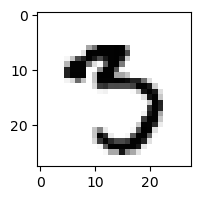

0.000833272361128131% - 0
1.971998105305037e-05% - 1
9.208827820645382e-09% - 2
0.1949194126428777% - 3
4.0868413440363475e-06% - 4
91.78970614777592% - 5 - ОШИБКА
8.501096621579039e-05% - 6
0.1721457030356707% - 7
0.09341230847721929% - 8
0.029162831545710324% - 9

 2


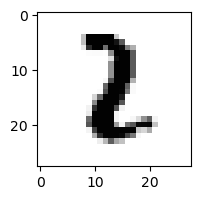

4.331520679905283e-07% - 0
13.963815990669826% - 1 - ОШИБКА
2.45655799350535% - 2
0.004148574358816956% - 3
1.1696902083666673e-08% - 4
0.0008007927938911372% - 5
0.017973353372331684% - 6
2.759443371892291e-06% - 7
5.679038687610424e-06% - 8
1.0047664744872754e-08% - 9

 4


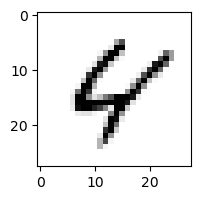

0.15730790281968934% - 0
0.002054588063288977% - 1
0.05450166280931803% - 2
2.051439699454133e-10% - 3
90.24593540096416% - 4
0.038203576702227% - 5
2.5075680117989525% - 6
0.08779311280298426% - 7
22.117541736669438% - 8
90.72500952609235% - 9 - ОШИБКА

 6


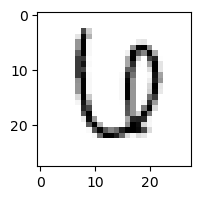

36.746362994455225% - 0 - ОШИБКА
0.000288246638244989% - 1
0.2408778084568493% - 2
1.0630401342466929% - 3
5.7058186470574705% - 4
0.03486829416039662% - 5
1.9582576389275093% - 6
3.384697118242272% - 7
0.001146084395415214% - 8
8.389058118521904e-06% - 9

 8


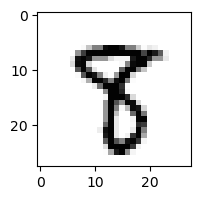

4.570280861014143e-08% - 0
0.0005944470773295152% - 1
2.7746773112649735e-08% - 2
0.001595030075591715% - 3
0.0016449597336015143% - 4
12.631197818913531% - 5 - ОШИБКА
2.5446655640202394e-09% - 6
0.33478221633506783% - 7
0.0009309997984939118% - 8
2.3867165739197654e-06% - 9

 9


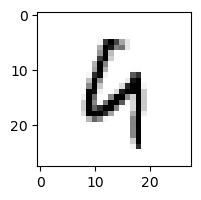

0.004801357491230976% - 0
0.04462169373490911% - 1
14.567143831543358% - 2
9.379794909112657e-07% - 3
75.91408323244157% - 4
0.02243839407414777% - 5
79.30401837679342% - 6 - ОШИБКА
0.037243017606933305% - 7
35.605976036897424% - 8
5.048433877037002% - 9

 8


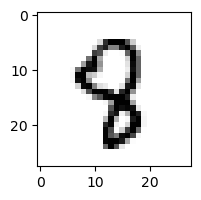

5.432671404639225e-05% - 0
0.002635677165247362% - 1
0.0010490623992966451% - 2
3.187039753769238e-06% - 3
3.712751849975598% - 4
4.862993591096495% - 5 - ОШИБКА
0.0025930440609494747% - 6
0.011220266919656606% - 7
0.05554561327994191% - 8
2.135575657700044e-06% - 9

 8


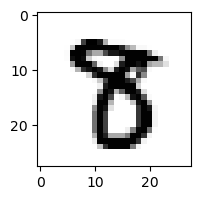

8.876617238478206e-07% - 0
3.269984947269732e-06% - 1
9.660971117457137e-08% - 2
0.03725571335968188% - 3
4.329422108165257e-07% - 4
0.32994766004166803% - 5 - ОШИБКА
4.799311340317539e-10% - 6
0.0023659139043384625% - 7
0.002118171766004746% - 8
5.0702920687623717e-11% - 9

 7


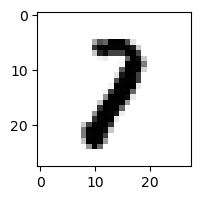

0.00013308829009850927% - 0
12.975472696030371% - 1 - ОШИБКА
2.2473607825572675% - 2
0.008253792969591195% - 3
5.0938066272050855e-05% - 4
0.0028490376507992127% - 5
4.173208159395418e-05% - 6
0.029902249505004065% - 7
0.004104878016536361% - 8
6.525351436536628e-06% - 9

 8


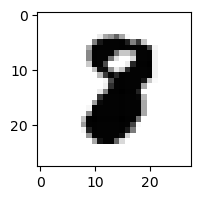

9.570359106970265e-09% - 0
0.00010233560652843729% - 1
0.00047034571103897% - 2 - ОШИБКА
9.99713152462425e-10% - 3
1.2767626463509939e-08% - 4
6.046566690309192e-05% - 5
1.6413840736624948e-07% - 6
7.251748451335199e-05% - 7
2.8664141102296987e-06% - 8
4.942423952362754e-16% - 9

 8


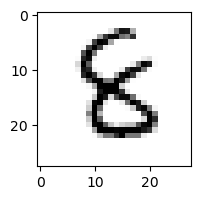

5.970226558263073e-05% - 0
0.0004443576548891626% - 1
0.0007726780541793998% - 2
0.06920614192324785% - 3
0.03334968250510328% - 4
2.2991139803580354% - 5
2.396135766297637% - 6 - ОШИБКА
8.4288320940569e-06% - 7
0.0008827227380109569% - 8
2.2350832528689304e-08% - 9

 8


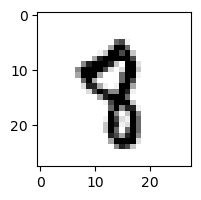

7.638641712089719e-07% - 0
0.09327447794194824% - 1
1.5824176374709616e-05% - 2
1.271505624866071e-07% - 3
0.14760446657010698% - 4
2.560064022428505% - 5 - ОШИБКА
0.0005872232094207429% - 6
0.33845936793374487% - 7
0.0005825517392077945% - 8
0.05216186582461477% - 9

 9


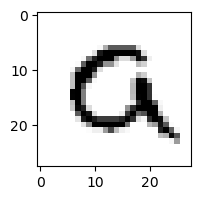

90.05564553890211% - 0 - ОШИБКА
1.245991292730093e-07% - 1
0.998161238497065% - 2
2.3323171858704636e-06% - 3
0.0002443823915878863% - 4
28.989687406203462% - 5
32.959807013018064% - 6
0.07461656253215111% - 7
1.0083909168318958e-09% - 8
0.30934462582576044% - 9

 2


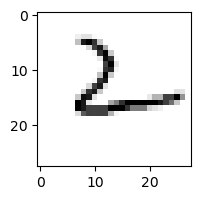

13.42377130876719% - 0
0.010000679848355034% - 1
54.152823147243154% - 2
0.0011260239132069969% - 3
99.9149354601324% - 4 - ОШИБКА
0.06428632923797821% - 5
95.33840740633528% - 6
11.040856933896004% - 7
0.004694639833317688% - 8
10.591837477974778% - 9

 8


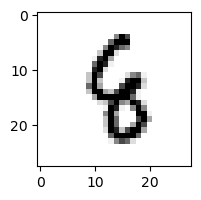

1.9568217181500716e-06% - 0
0.15141962765154018% - 1
0.14771027109360496% - 2
8.12147651993275e-05% - 3
20.074317897696872% - 4 - ОШИБКА
1.9426506790084075% - 5
9.078394880172786% - 6
0.004523930475703132% - 7
0.005148174895501819% - 8
4.919127441022974e-05% - 9

 0


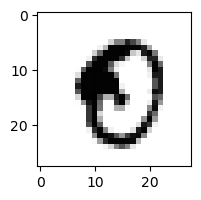

5.805663499295317% - 0
2.683305952479657e-06% - 1
2.4290231533671967e-10% - 2
5.653441038859098e-10% - 3
0.0009608908059169177% - 4
6.862496542273503% - 5
0.0020079986408845095% - 6
8.892455869154407e-08% - 7
38.38738836510656% - 8 - ОШИБКА
0.00015325266510359293% - 9

 7


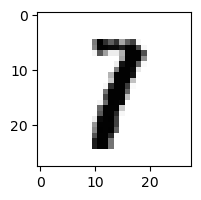

1.7439219393557795e-05% - 0
51.26883947386228% - 1 - ОШИБКА
0.03869342901282126% - 2
0.04851265397230777% - 3
5.8480712310430924e-05% - 4
0.025192578845580262% - 5
6.38562542628708e-05% - 6
0.01614441188499046% - 7
0.0017030484866320313% - 8
8.699747734990535e-07% - 9

 8


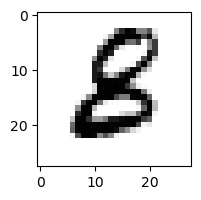

0.00011073254078396069% - 0
6.764753058212492e-05% - 1
0.0015047138661484487% - 2
0.0007332778865739935% - 3
3.888690697698516e-06% - 4
1.004262539970372% - 5 - ОШИБКА
0.6295652808686172% - 6
2.25053790419125e-08% - 7
4.556229452066166e-10% - 8
9.908534041324685e-16% - 9

 4


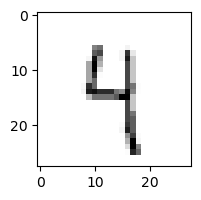

0.032849774823075197% - 0
0.9814806959688989% - 1
1.8910569750287196% - 2
5.088964307673846% - 3
87.512874302022% - 4
24.315655311035506% - 5
17.56636778223585% - 6
2.944847012679245% - 7
8.58035721209166% - 8
92.51419669755792% - 9 - ОШИБКА

 8


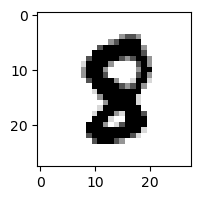

5.406756931120743e-07% - 0
5.875564969105548e-07% - 1
1.721384941756471e-06% - 2
4.2077858556202453e-10% - 3
3.0084416207056484e-06% - 4
0.733445091920517% - 5 - ОШИБКА
2.5754726595675924e-05% - 6
5.85289936385015e-07% - 7
0.10294314347868588% - 8
2.0215103262378605e-10% - 9

 8


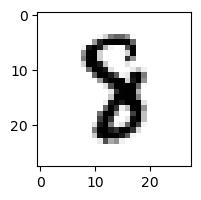

9.747919865506909e-08% - 0
0.011639405965216816% - 1
0.000414466637951852% - 2
4.192982327594622e-06% - 3
0.004119271849432123% - 4
0.3404813947794291% - 5 - ОШИБКА
0.1562788512911814% - 6
0.00894300374243008% - 7
0.008342497891943416% - 8
1.645353396836084e-12% - 9

 4


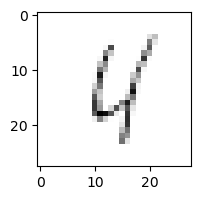

22.61170920590225% - 0
3.7352184049304586% - 1
64.4948436832779% - 2
0.006865805555669281% - 3
87.74467861831108% - 4
4.623172087026322% - 5
71.6311202962184% - 6
11.941977383455441% - 7
96.47774213452914% - 8 - ОШИБКА
84.78717215825598% - 9

 2


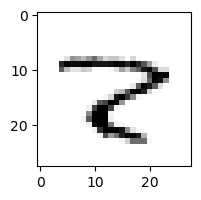

0.3327686055821939% - 0
0.28892984185935927% - 1
4.16393727554194% - 2
2.2046298245636044e-07% - 3
0.03667043990003396% - 4
9.374571182940086e-06% - 5
7.035742744698589% - 6
38.13721185898594% - 7
96.51595736448334% - 8 - ОШИБКА
0.0002823000392750458% - 9

 8


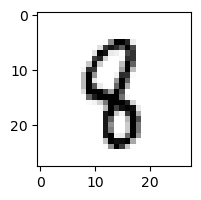

1.0199320638341046e-05% - 0
0.2761467168639649% - 1
0.004539520483059525% - 2
5.317470748816982e-05% - 3
3.4319061224486602% - 4 - ОШИБКА
2.787361793100745% - 5
0.00859788670196157% - 6
0.003616309837382918% - 7
0.0027773588047495796% - 8
0.00011466334525413169% - 9

 2


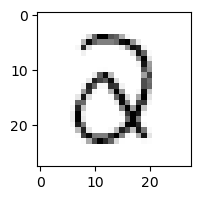

0.6336758460424794% - 0
0.00041847478569947207% - 1
0.5465903122768649% - 2
47.678631016152984% - 3 - ОШИБКА
1.1100561798783575% - 4
1.6570682260015628% - 5
0.011898699804322224% - 6
0.0004799154753873096% - 7
0.0027356104240210998% - 8
9.560152965833584e-07% - 9

 6


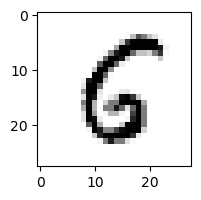

1.9772480957890435% - 0
0.00024598604506813505% - 1
0.0041531574189479625% - 2
4.252217548664866e-08% - 3
1.2946244194029248% - 4
46.655330922654706% - 5 - ОШИБКА
8.026792581553375% - 6
0.0002796971241643666% - 7
6.934069927897222e-05% - 8
1.8268916852629289e-07% - 9

 2


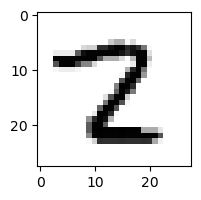

8.639866008633011e-05% - 0
0.016714333343970295% - 1
2.768045091652459% - 2
0.003601275246722266% - 3
0.00011663925187352756% - 4
0.03149449647335559% - 5
1.7856202482310433e-06% - 6
0.5219891535268443% - 7
33.611450997740455% - 8 - ОШИБКА
2.395437783086698e-09% - 9

 8


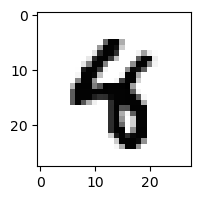

3.2035873561344284e-08% - 0
0.00033013381116154823% - 1
1.3447595283747463e-07% - 2
9.925053510642871e-09% - 3
79.75013420911723% - 4 - ОШИБКА
0.09338139541247044% - 5
3.781061114730313e-05% - 6
5.777492238571025e-05% - 7
7.197555274410363e-12% - 8
2.9311422682333783e-05% - 9

 7


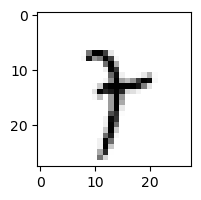

0.00015499881273623435% - 0
48.999730713967594% - 1
0.04278970979142208% - 2
0.19381095019652958% - 3
0.8216504573662766% - 4
3.0954323051886683% - 5
13.458236786667724% - 6
0.9481582838446757% - 7
79.9625879961248% - 8 - ОШИБКА
11.78197858526273% - 9

 4


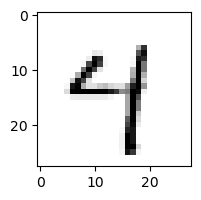

0.7823343660327586% - 0
0.015360899141643035% - 1
0.00032821316392406377% - 2
0.0024130652399040795% - 3
91.30746314576544% - 4
27.97142117383402% - 5
0.33725269910261796% - 6
1.2183225607952448% - 7
0.04209152659373171% - 8
97.11568691957771% - 9 - ОШИБКА

 8


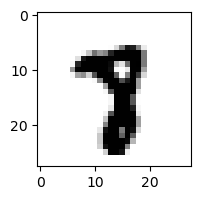

5.761633450747801e-09% - 0
0.00027106323642146367% - 1
2.844849569220384e-10% - 2
2.6437582948441512e-09% - 3
1.414793629449936e-06% - 4
1.8331527629624564% - 5
3.319012099702884e-07% - 6
2.3044363807219375% - 7 - ОШИБКА
0.00011578511255328949% - 8
4.651680462726193e-07% - 9

 3


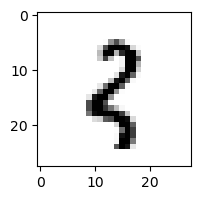

0.004909520969298267% - 0
20.75835384200115% - 1 - ОШИБКА
17.005894594367785% - 2
0.00023508973442083297% - 3
0.009793514965438739% - 4
0.021023530571949323% - 5
0.08323001492019685% - 6
0.0012515396480836714% - 7
7.270795921569007% - 8
15.074919209295636% - 9

 9


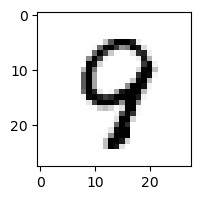

0.0021786834609666228% - 0
4.38625714533986e-05% - 1
0.004852897883383565% - 2
0.00015111954100212148% - 3
25.494160743579226% - 4 - ОШИБКА
0.204901223104304% - 5
0.011673255117386207% - 6
0.02315692326506502% - 7
2.1230584351500927% - 8
0.005578882237390489% - 9

 9


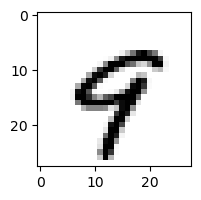

0.0044773992626613015% - 0
0.0002462803875466136% - 1
8.302892986859133e-08% - 2
1.3501277819008925e-08% - 3
44.06384961832742% - 4 - ОШИБКА
0.3842461244912672% - 5
0.0008108114125679968% - 6
3.012303312098381% - 7
4.7148111828312994e-07% - 8
0.3817168463700282% - 9

 9


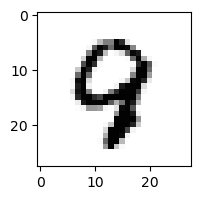

0.0005526613457414442% - 0
1.8527774161326727e-05% - 1
0.0010203066771076888% - 2
3.3940038734522305e-06% - 3
4.520518844282751% - 4 - ОШИБКА
0.007512014801875725% - 5
0.007825318612772521% - 6
0.006888872267103015% - 7
0.0013666813557159745% - 8
0.004139765329437117% - 9

 3


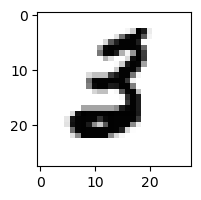

0.0011911227762217438% - 0
0.000241426263300185% - 1
0.013927388451332894% - 2
1.1836555757321573e-05% - 3
4.772624562967325e-07% - 4
0.02711285703159191% - 5 - ОШИБКА
0.003913457462954686% - 6
6.440545133179093e-06% - 7
8.433545890467807e-11% - 8
9.944623304784898e-14% - 9

 3


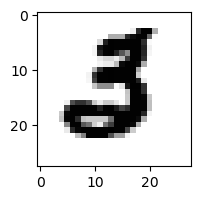

0.000711518048325156% - 0
1.6272587065393995e-06% - 1
0.002045718596725132% - 2 - ОШИБКА
2.422368315187365e-09% - 3
2.6802572134018924e-08% - 4
0.00011218924020075443% - 5
0.00010538040736241521% - 6
9.18720279245244e-06% - 7
3.633179368357588e-16% - 8
3.411900262001577e-16% - 9

 3


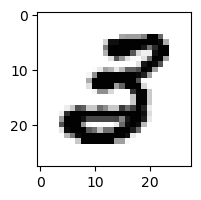

0.005957554756871284% - 0
2.286430070569614e-06% - 1
2.377361745541133e-06% - 2
1.6512791582412953e-06% - 3
3.5790594149023744e-06% - 4
0.48924877493764773% - 5 - ОШИБКА
6.537888536026323e-07% - 6
8.483910976092732e-08% - 7
2.4040553702907717e-06% - 8
3.100178324046738e-17% - 9

 8


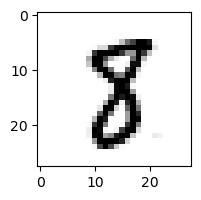

2.241341661096918e-05% - 0
0.1019719445096421% - 1
6.130765621887709e-05% - 2
0.0001481180169550876% - 3
2.139756190380221e-05% - 4
4.359127146463377% - 5 - ОШИБКА
2.9077438880980826e-05% - 6
0.04157547233921475% - 7
0.06262808840141636% - 8
2.353872485523662e-09% - 9

 8


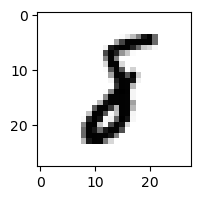

1.3217384025660358e-05% - 0
27.962517563033224% - 1 - ОШИБКА
0.5241665120363486% - 2
1.1376038966098574e-05% - 3
1.9656050178379124e-05% - 4
0.017777911780809286% - 5
3.6365680592758007% - 6
0.000512483403869067% - 7
0.024139999234722036% - 8
6.155904872148377e-08% - 9

 3


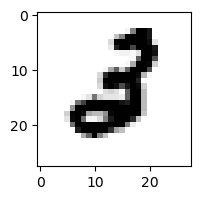

1.82619439510581e-05% - 0
0.0010038846574419787% - 1
0.03729310790097469% - 2 - ОШИБКА
3.900934345656728e-08% - 3
0.000651475188220586% - 4
0.0003928809702293997% - 5
0.0020845830964007204% - 6
3.7626072311738538e-06% - 7
1.035758692709724e-10% - 8
7.662524685822799e-15% - 9

 4


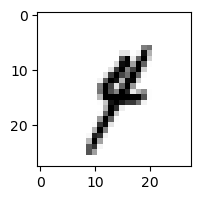

5.7186292485070646e-05% - 0
77.66482131664709% - 1 - ОШИБКА
0.000516543883373364% - 2
9.38614462554996% - 3
8.031531121740562% - 4
0.10127376865894837% - 5
0.003025617797987715% - 6
3.639200488359615% - 7
0.0014304143060720781% - 8
0.02388369724704708% - 9

 3


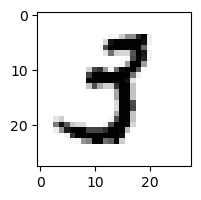

0.0022092437326346214% - 0
0.12259276431462265% - 1
1.641098366833448e-07% - 2
0.8181361359785762% - 3
0.00042135490678434735% - 4
5.897264387967384% - 5 - ОШИБКА
2.9686643280811053e-06% - 6
0.0009070395907678104% - 7
4.23011595326997e-06% - 8
5.2279829219013636e-11% - 9

 3


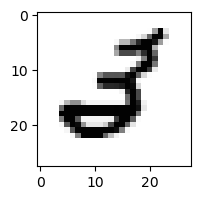

0.0036749737549799312% - 0
0.0005649172138458362% - 1
0.17611581341066337% - 2 - ОШИБКА
6.620233358734473e-07% - 3
0.028558512206843672% - 4
0.0012631859350259232% - 5
0.0019090463464315423% - 6
5.837872637321457e-05% - 7
7.792902171817354e-06% - 8
1.8681896329562667e-09% - 9

 5


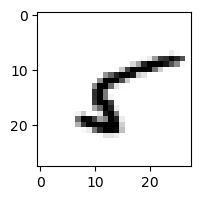

0.2958305301700703% - 0
1.290667249407167% - 1
0.2927438467262984% - 2
0.02567935858722473% - 3
1.0494799850881542% - 4
97.61879924689954% - 5
5.637338644567925% - 6
0.02704945562391348% - 7
98.08231763330679% - 8 - ОШИБКА
0.0002335159621929864% - 9

 9


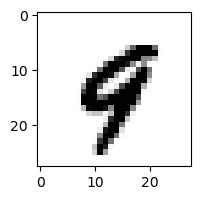

9.943026498002085e-05% - 0
0.0006754818645740304% - 1
1.3939388544112316e-08% - 2
1.038776820262089e-09% - 3
7.947559419209593% - 4 - ОШИБКА
0.0005773733502048009% - 5
0.0017577715699574157% - 6
0.14633539142735827% - 7
3.558127182463494e-08% - 8
0.10085039606633897% - 9

 8


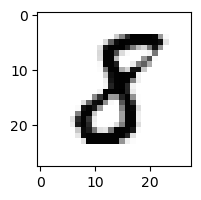

0.0008050120053151673% - 0
0.27754681687416566% - 1
0.014688898967992565% - 2
0.002062163257415657% - 3
3.3263582044189997e-06% - 4
0.368064279537254% - 5 - ОШИБКА
0.00017038350390808572% - 6
7.672575231784526e-07% - 7
0.024355696926388216% - 8
3.358409630175359e-12% - 9

 8


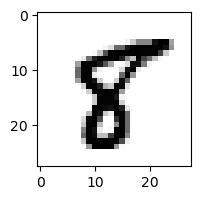

0.00022314459597522587% - 0
0.0007999163823558302% - 1
6.411839920613796e-08% - 2
3.3111125234086906e-12% - 3
0.0007482894252481627% - 4
68.15761281552798% - 5 - ОШИБКА
5.448343369740597e-07% - 6
5.053200538440544e-05% - 7
0.2705764361551341% - 8
1.1119980372552956e-06% - 9

 5


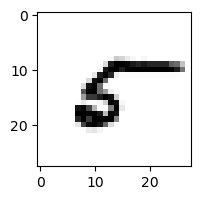

58.88459259552784% - 0 - ОШИБКА
0.07452378127246953% - 1
0.09442267190014209% - 2
2.8969068323517274e-06% - 3
1.2866282773585414% - 4
14.053441461774232% - 5
0.4228342121675126% - 6
0.8549467635633434% - 7
0.40499613394919165% - 8
0.0008040003717678224% - 9

 9


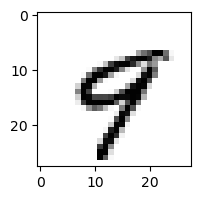

0.00922914293623776% - 0
0.0001892222392175361% - 1
2.5290752653820578e-08% - 2
3.0933413643423393e-07% - 3
32.853203898776314% - 4 - ОШИБКА
0.04679995730737363% - 5
0.0009359422909397468% - 6
6.949952711902413% - 7
2.515503773684317e-05% - 8
0.6472363216431326% - 9

 8


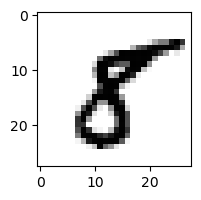

0.0012469833602058286% - 0
0.04141987819042526% - 1
2.1964355936666547e-07% - 2
1.864158884582928e-07% - 3
0.0017539197722609074% - 4
32.69079225010214% - 5 - ОШИБКА
2.058898094013076e-09% - 6
5.744967575552023e-05% - 7
0.050118313876923955% - 8
6.818744337814884e-08% - 9

 3


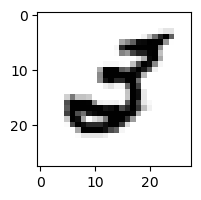

0.1065608927276241% - 0 - ОШИБКА
0.0016322288474802063% - 1
0.03815601798483345% - 2
5.498184785116253e-10% - 3
0.020923627378006352% - 4
0.0015337636794150195% - 5
0.0021036346315153587% - 6
0.004657791963270681% - 7
8.673056510906761e-10% - 8
2.1264908131180104e-12% - 9

 3


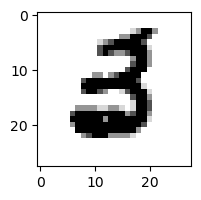

0.002845341249064601% - 0
1.9182573427141097e-06% - 1
4.0222267134926195e-05% - 2
5.177537997701464e-06% - 3
1.5894715941451703e-06% - 4
0.06697942601911436% - 5
0.11484222970080078% - 6 - ОШИБКА
9.246737024837009e-08% - 7
1.0929226459127031e-13% - 8
3.304108904218806e-15% - 9

 8


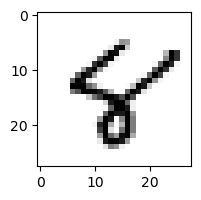

0.0008874894033797156% - 0
0.0008332205850400889% - 1
2.358081475114439e-05% - 2
1.350420288426848e-11% - 3
4.485041618244593% - 4
52.72234218889766% - 5 - ОШИБКА
0.3158132341087633% - 6
0.003954429817568076% - 7
6.71335766772024% - 8
0.03320329542210313% - 9

 7


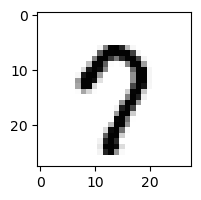

1.132359735801511% - 0
3.2849846957921384e-06% - 1
4.785074318062139e-06% - 2
1.6478457242598344e-05% - 3
0.01939256488614012% - 4
3.4290493923693357% - 5
0.0011904235291188604% - 6
68.03154359706237% - 7
0.006215543995019362% - 8
98.38668248639706% - 9 - ОШИБКА

 4


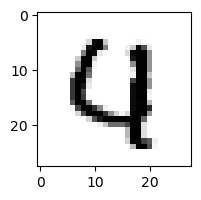

3.788059021824656% - 0 - ОШИБКА
5.849591281569975e-07% - 1
0.013269191889929114% - 2
8.221604475172841e-09% - 3
1.8369335573870862% - 4
0.0006766307512553533% - 5
0.19632561611871868% - 6
0.3419412739965101% - 7
1.3330035197208342e-08% - 8
6.38219274308575e-05% - 9

 9


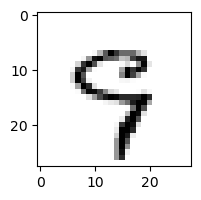

0.06167812549378795% - 0
0.0012074465101348552% - 1
0.0004225441521389275% - 2
0.9236490949759303% - 3
2.394049383913384% - 4
16.510879417648656% - 5
0.01304627082219652% - 6
44.63233932367838% - 7 - ОШИБКА
1.6497581686155244e-06% - 8
6.016913172932231% - 9

 2


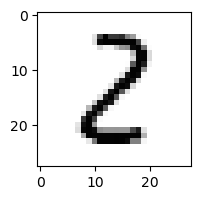

0.29558511927960274% - 0
10.168789413360741% - 1
32.435528236311484% - 2
0.46452817624430326% - 3
0.0005935212101093903% - 4
0.06395160383335491% - 5
4.797218982096478e-05% - 6
7.002903601665841e-05% - 7
99.98983924539937% - 8 - ОШИБКА
6.384868651697351e-09% - 9

 7


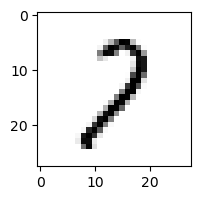

3.776152378220788% - 0
7.156077322430952% - 1
93.89587373939911% - 2 - ОШИБКА
2.6261726497957114% - 3
0.31020782999255553% - 4
0.14904356582168224% - 5
0.04296013661858772% - 6
15.659463640969621% - 7
30.12047473252761% - 8
0.14381268038601913% - 9

 9


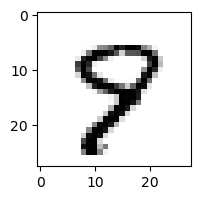

0.0007452191735996865% - 0
8.104429406564714e-06% - 1
8.034765549905835e-06% - 2
2.1660403221910894e-05% - 3
0.2486576695435129% - 4
6.881082210311177% - 5 - ОШИБКА
0.0007703177875767594% - 6
1.6316554121989089% - 7
0.23437478073739898% - 8
0.402398182052817% - 9

 9


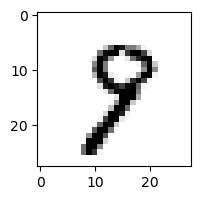

0.0018134288607811362% - 0
0.020823133820622456% - 1
0.00010999227418379797% - 2
0.005661420820305569% - 3
0.03987174213051805% - 4
1.3498206003922926% - 5
0.0015469488915040575% - 6
6.027704169255496% - 7
28.324305377842983% - 8 - ОШИБКА
27.262563741384625% - 9

 8


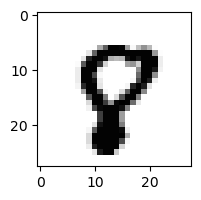

0.006701538519635594% - 0
2.6193734602130104e-08% - 1
1.0935832733531127e-07% - 2
1.5925040527607277e-12% - 3
0.0017945585061129468% - 4
0.1896699654621329% - 5
6.516058739511932e-06% - 6
0.6600325094317973% - 7 - ОШИБКА
0.009613290695921914% - 8
0.059919374465841876% - 9

 3


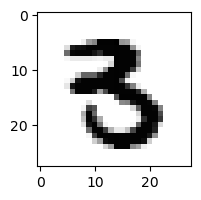

0.00012600174723503696% - 0
3.3709958516099513e-07% - 1
1.6598994866132154e-11% - 2
0.08567886637399183% - 3
2.6792307764545407e-06% - 4
0.4641985653516341% - 5 - ОШИБКА
1.0542448754435274e-07% - 6
1.0568017553802107e-06% - 7
2.372116124543053e-14% - 8
1.8867982264191053e-12% - 9

 8


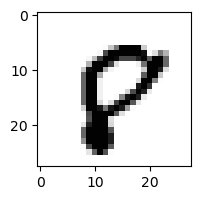

51.31983478839296% - 0 - ОШИБКА
1.9601856527869652e-08% - 1
1.1096447304335565e-05% - 2
7.301854886045552e-14% - 3
0.00029000623459650177% - 4
0.19242064577473944% - 5
6.163388057859872e-05% - 6
0.51910761588918% - 7
3.8667967669829633% - 8
7.867583809357881% - 9

 3


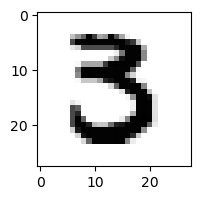

0.002617931593835306% - 0
4.773433177289115e-06% - 1
2.3421418352383434e-06% - 2
0.23039880309765462% - 3
1.3625036652806604e-10% - 4
4.6208639657907185% - 5 - ОШИБКА
4.935663107017851e-08% - 6
7.297446225408318e-05% - 7
1.2277985871921933e-13% - 8
1.8587180777067083e-17% - 9

 8


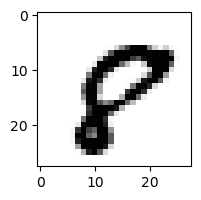

18.321267884041276% - 0 - ОШИБКА
1.4981240850903955e-07% - 1
6.156170616151432e-08% - 2
1.5632737310301755e-13% - 3
2.2488709924318183e-05% - 4
0.7945438614120797% - 5
5.4880347763293516e-06% - 6
0.0643423925537031% - 7
1.7416426523872943% - 8
0.002011816833068534% - 9

 9


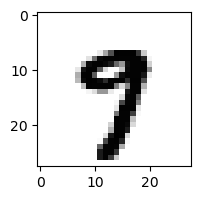

5.121049114215818e-05% - 0
9.865119169771083e-06% - 1
1.948998695938565e-11% - 2
2.12360606445432e-06% - 3
0.004407970110448125% - 4
0.341618413314612% - 5
6.743858641047117e-07% - 6
8.577181750172242% - 7 - ОШИБКА
4.112623913412944e-07% - 8
2.274598997180049% - 9

 9


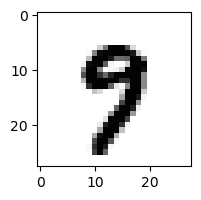

0.0002489601101902484% - 0
6.805849870205969e-06% - 1
2.7325306641216405e-10% - 2
2.453549902963517e-05% - 3
0.003338590566334079% - 4
2.4618516181472665% - 5
6.025596781606907e-06% - 6
7.254880453057155% - 7 - ОШИБКА
4.11276423423576e-06% - 8
0.3198199009539548% - 9

 3


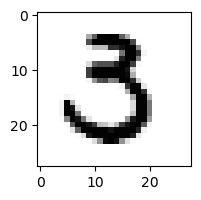

0.16471452038923082% - 0
7.193748473776603e-05% - 1
0.0010315114952083205% - 2
0.6942044783805132% - 3
5.639787826520048e-09% - 4
8.329013798970132% - 5 - ОШИБКА
3.982511042057758e-06% - 6
0.0010433381751543563% - 7
3.0267482861662984e-11% - 8
3.02633614957153e-15% - 9

 1


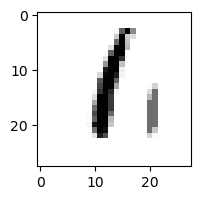

0.5330647962511653% - 0
3.2673669423027207% - 1
3.504217243661968% - 2
0.18129785396778375% - 3
0.00025492681817647334% - 4
18.16780292196368% - 5
96.37652347193352% - 6 - ОШИБКА
0.00037652356699864554% - 7
61.46179078421665% - 8
1.0175601742448648% - 9

 3


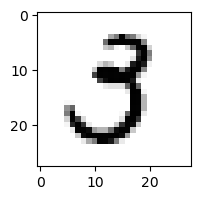

1.3159098058447969% - 0
0.006624024002120771% - 1
0.00021329834100889425% - 2
18.796630899042416% - 3
7.83623798136146e-05% - 4
26.73647132750898% - 5 - ОШИБКА
1.420326980173535e-06% - 6
0.02607396525623057% - 7
1.2797725321326176e-05% - 8
1.5495547595856643e-13% - 9

 8


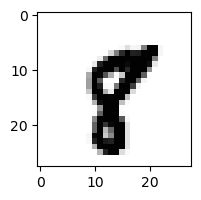

5.342432258706621e-06% - 0
0.01841642780964488% - 1
6.938521424074859e-10% - 2
2.010161777380227e-09% - 3
0.00019775112655674314% - 4
0.17616060878616638% - 5
3.0367976463875376e-07% - 6
3.4543962464362026% - 7 - ОШИБКА
1.4172514282248026e-05% - 8
1.9486711779169055e-05% - 9

 8


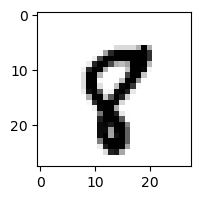

6.209575408486583e-05% - 0
0.0034807815855149343% - 1
3.220090638074296e-07% - 2
4.0621986598515395e-10% - 3
0.0011946772750836229% - 4
0.3926842443425298% - 5
8.071352499593988e-05% - 6
0.4410654112663195% - 7 - ОШИБКА
0.0019247543873700756% - 8
0.09706678494180579% - 9

 3


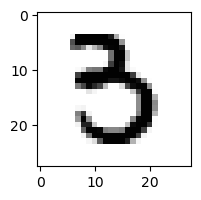

0.010905117179682311% - 0
6.828857703509849e-05% - 1
3.867097922269773e-09% - 2
1.742540216074056% - 3
3.253910338762403e-06% - 4
8.953733568763587% - 5 - ОШИБКА
0.0008319031879625195% - 6
0.00033447836777554497% - 7
4.922685596895644e-09% - 8
8.743804684006227e-09% - 9

 8


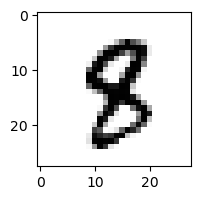

5.141629418764989e-06% - 0
0.00149647392231464% - 1
1.1682292902232777e-06% - 2
4.844539746154195e-05% - 3
0.024542433977378392% - 4
1.4689211248846585% - 5 - ОШИБКА
1.1446901274216544e-05% - 6
0.0006462182242946569% - 7
0.020349163859259604% - 8
1.1345782518857375e-05% - 9

 8


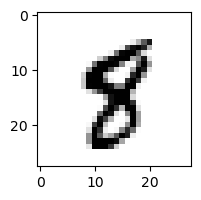

3.4371426648981356e-05% - 0
0.0024633968787576123% - 1
8.674032602823954e-09% - 2
5.8104730782414e-08% - 3
0.028179164218210966% - 4
1.5693014328774364% - 5 - ОШИБКА
0.00025575152131223966% - 6
0.005935525632916459% - 7
1.110420936904512% - 8
0.003630402317962185% - 9

 1


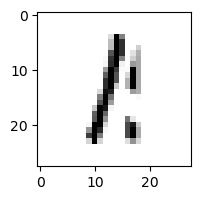

2.055175889131986% - 0
39.65730335378692% - 1
8.244325584783505% - 2
4.148729648944015% - 3
0.00015459863569325415% - 4
2.1328879550889157% - 5
4.172425436924388% - 6
0.0038227854316747957% - 7
99.6399732915158% - 8 - ОШИБКА
1.0692967801927953% - 9

 8


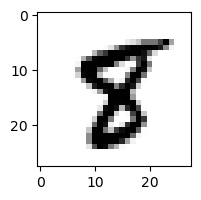

1.104604078515681e-06% - 0
4.2656857241038056e-05% - 1
1.2116817881690556e-09% - 2
2.6937571840993776e-10% - 3
0.0003901539325330021% - 4
11.109994996199248% - 5 - ОШИБКА
8.828654111274412e-07% - 6
0.000837238691989857% - 7
0.07251530613384205% - 8
5.46600854549944e-08% - 9

 8


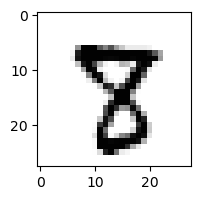

1.2665282414994102e-07% - 0
2.5480606618864095e-06% - 1
3.4220014076089715e-06% - 2
2.6342440133878436e-05% - 3
0.00029882757459090507% - 4
0.6259272953587653% - 5
5.782538895526674e-10% - 6
3.6910632774292775% - 7 - ОШИБКА
0.5347455462584755% - 8
2.3251963163923092e-07% - 9

 8


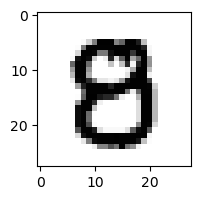

0.19103431872804572% - 0 - ОШИБКА
7.582209193847271e-10% - 1
6.8328362501666995e-06% - 2
0.0010235098803492457% - 3
0.00017001251892950702% - 4
0.16616158492468747% - 5
2.13156204245976e-08% - 6
3.7153623681804327e-08% - 7
4.125430516807422e-06% - 8
5.097151202789636e-10% - 9

 9


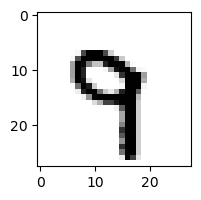

3.283449719128155e-07% - 0
0.0163999752828742% - 1
2.2555633124013896e-05% - 2
2.0643878103624205e-05% - 3
0.9996509318526827% - 4
0.1426224961879343% - 5
0.010559241831210368% - 6
30.226581038520013% - 7 - ОШИБКА
2.0378199276919074e-07% - 8
0.047615371372910324% - 9

 8


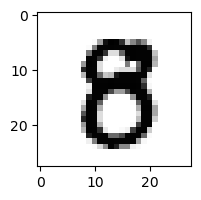

0.2953451141181813% - 0
5.832449078253674e-08% - 1
5.069218782836838e-08% - 2
0.0006128990907391093% - 3
8.158972556452729e-05% - 4
2.43979582772737% - 5 - ОШИБКА
7.284359455711753e-08% - 6
3.9833205556185594e-07% - 7
0.1631013553405752% - 8
4.493531083235515e-10% - 9

 8


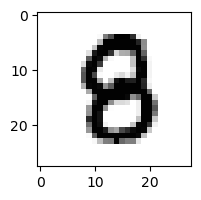

0.00018420433201617994% - 0
3.6184213789422926e-06% - 1
4.2300112093064585e-05% - 2
2.1010845066032017e-05% - 3
0.0001403436736935369% - 4
0.10137937613404452% - 5 - ОШИБКА
0.0011037158933814642% - 6
2.1288536186473602e-08% - 7
0.008630237874622266% - 8
4.705944619373638e-10% - 9

 8


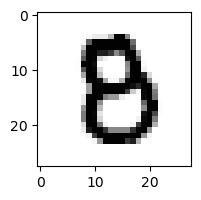

0.11662819371518099% - 0
4.64626328482439e-08% - 1
0.0009585515506803542% - 2
0.0010310874088623725% - 3
0.00018243716302603573% - 4
0.13248232323706055% - 5 - ОШИБКА
0.0005853020727851953% - 6
1.0020237833335644e-07% - 7
0.0024963611656326572% - 8
2.1257015654000062e-10% - 9

 8


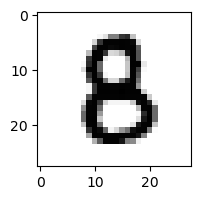

0.005727273341673927% - 0
7.593111397322034e-07% - 1
0.0015514434945806874% - 2
0.00015953010323841132% - 3
0.0007090804089764889% - 4
0.4328451591881283% - 5 - ОШИБКА
0.0004919227047783479% - 6
2.347103593940685e-08% - 7
0.05483370709007612% - 8
8.538551402278389e-11% - 9

 2


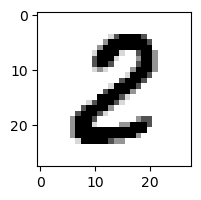

0.01652361340968883% - 0
0.002158627722258316% - 1
55.50991966916373% - 2
0.0001277218420290829% - 3
2.7675475052225223e-08% - 4
0.004351872454669205% - 5
3.96213499856314e-06% - 6
5.030428897004224e-08% - 7
99.9554191431872% - 8 - ОШИБКА
5.799420286999392e-12% - 9

 8


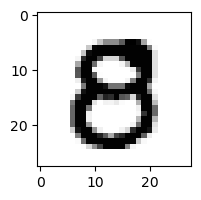

1.0784377426638376% - 0 - ОШИБКА
5.045638815529342e-11% - 1
6.983731942334291e-06% - 2
0.00030671549443201713% - 3
0.00030027219834291547% - 4
0.3046391818974722% - 5
8.64433934919702e-10% - 6
9.107075266540437e-08% - 7
2.8888807688548755e-07% - 8
1.8954483343064446e-10% - 9

 3


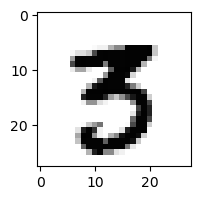

2.8955871218074225e-05% - 0
6.137781205551829e-06% - 1
4.4402663186895803e-10% - 2
3.907218771877182% - 3
5.264303448369156e-07% - 4
23.483985267942384% - 5 - ОШИБКА
3.445083522854982e-10% - 6
0.007400508560030352% - 7
7.185276696579702e-14% - 8
1.0664486185564375e-09% - 9

 8


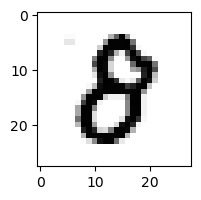

4.107972446002538% - 0 - ОШИБКА
3.6329924081693525e-07% - 1
0.0026173724909723042% - 2
0.0007620780357807671% - 3
0.00014831137644306572% - 4
0.19651466915726196% - 5
8.497360991892651e-05% - 6
3.67564995986802e-06% - 7
1.4274082655253726% - 8
1.643799749738061e-06% - 9

 8


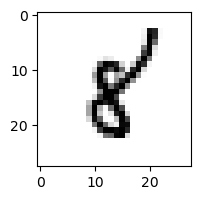

0.00027948095156240274% - 0
45.80083997065194% - 1 - ОШИБКА
0.00021280901374783086% - 2
3.7053474700847833e-06% - 3
2.9482728059913734% - 4
2.9081656626102896% - 5
6.781016068539163% - 6
0.0064893195198891815% - 7
1.1803765853607884% - 8
0.0005620241767526557% - 9

 4


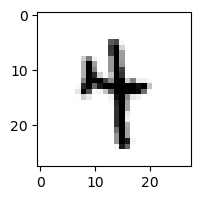

5.68538808674805e-06% - 0
11.125083618314786% - 1
9.412460479034158e-08% - 2
0.00013434352580079061% - 3
15.148531692295606% - 4
4.827208739243414% - 5
0.6345571872733925% - 6
0.009826339611679214% - 7
0.00046481520180410813% - 8
27.88961177633686% - 9 - ОШИБКА

 7


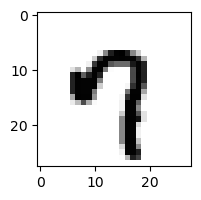

2.3475306446194293% - 0
1.9946609262498056e-05% - 1
8.066167447190672e-09% - 2
5.453332737642428e-08% - 3
0.685603848702215% - 4
0.5118191653597605% - 5
0.0026457818860528173% - 6
6.255189453891523% - 7
2.1243469677867534e-10% - 8
99.93966568922879% - 9 - ОШИБКА

 8


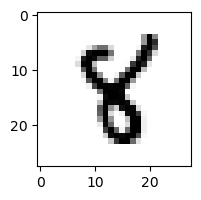

4.496450705374436e-08% - 0
0.08139002649984754% - 1
1.3594802106041302e-06% - 2
1.2878156803499544e-05% - 3
11.685656971949284% - 4 - ОШИБКА
5.705593781242937% - 5
0.0004994560352109116% - 6
0.004034403115580717% - 7
0.03332669683708281% - 8
9.140704679982852e-08% - 9

 3


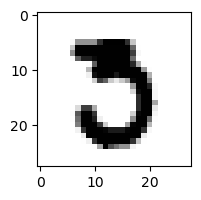

1.710375533297374% - 0 - ОШИБКА
3.324393507061327e-08% - 1
0.00028176826175085965% - 2
0.009205945605031707% - 3
1.3907520097369637e-10% - 4
0.0908210616726288% - 5
1.4606428731122975e-07% - 6
0.20850687862989692% - 7
1.615020649693755e-06% - 8
3.903610790181011e-16% - 9

 2


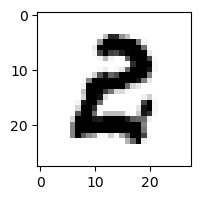

2.6054176188283296% - 0 - ОШИБКА
3.4088393532934575e-05% - 1
0.021682001579163217% - 2
0.029597426281680647% - 3
1.0314575637879896e-07% - 4
0.03612764317757349% - 5
0.000840528983091476% - 6
3.331686483145194e-09% - 7
1.6498398533518245e-09% - 8
6.702626217090155e-13% - 9

 3


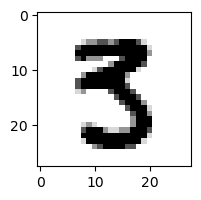

1.0698395691183397e-05% - 0
1.1121710536450163e-06% - 1
5.933747278874023e-13% - 2
0.4378192808449673% - 3
5.446043302334337e-07% - 4
18.455825351537165% - 5 - ОШИБКА
1.327444855134327e-11% - 6
0.00016819502811024726% - 7
3.6217671023010166e-11% - 8
1.2136417170369334e-14% - 9

 1


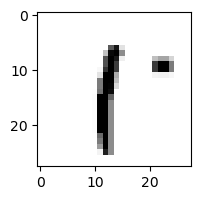

0.7976676992093497% - 0
0.4547476456288552% - 1
0.05829029595627602% - 2
0.06087386767277751% - 3
0.005730022586323134% - 4
97.26397325021698% - 5
7.217713133946331% - 6
0.0757151758294063% - 7
99.99997546802916% - 8 - ОШИБКА
47.7990299364304% - 9

 8


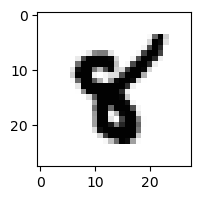

1.466995864519122e-08% - 0
0.011016231646908925% - 1
1.8906271482441128e-10% - 2
7.011722102930319e-13% - 3
0.6445544474950838% - 4
5.568745125017409% - 5 - ОШИБКА
0.00011179141092717701% - 6
0.00026314687958455446% - 7
8.821149903932988e-05% - 8
3.5531766140399645e-09% - 9

 8


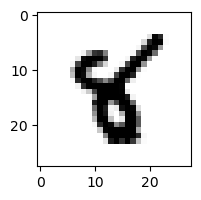

1.3327756140557254e-07% - 0
0.052179560942287886% - 1
5.625497065512203e-10% - 2
2.047506118536726e-09% - 3
0.9016164698818958% - 4
13.022574083567212% - 5 - ОШИБКА
0.0009010979072961584% - 6
7.217803036077485e-05% - 7
2.6518883428585838e-06% - 8
4.3001799884021235e-10% - 9

 8


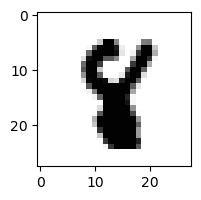

2.0350332362336052e-10% - 0
0.0006627592758967336% - 1
2.0639590086983107e-08% - 2
9.096815190850076e-11% - 3
0.018273537462507764% - 4
0.7303234959425196% - 5 - ОШИБКА
2.2471095091275396e-06% - 6
5.700389611252225e-05% - 7
0.0008951062462742477% - 8
3.072423547039256e-11% - 9

 8


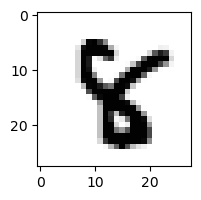

3.938356823073109e-11% - 0
4.2883859904090785e-06% - 1
9.852636846297343e-08% - 2
9.178765919080233e-08% - 3
1.9303112039089325% - 4
2.2957646244892644% - 5 - ОШИБКА
4.018538661210706e-08% - 6
0.00010412524789460709% - 7
0.006053604337362646% - 8
1.0458652514968766e-11% - 9

 7


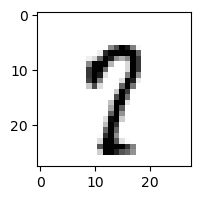

0.0003452211942675886% - 0
0.005632019546385299% - 1
1.5401361564407754e-05% - 2
7.351161688878814e-06% - 3
0.010649433122494261% - 4
7.854049331191732% - 5
0.001150434719936854% - 6
85.79165409162867% - 7
3.0626059847867335% - 8
88.74086721711056% - 9 - ОШИБКА

 7


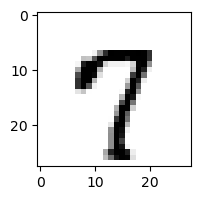

0.02631035867035739% - 0
4.7501392738677e-05% - 1
1.2220849665177794e-06% - 2
2.8248648126679398e-06% - 3
0.004786915739156309% - 4
4.603777933835001% - 5
7.548819496992065e-05% - 6
96.63547488784657% - 7
0.009914484921199892% - 8
97.64052241663174% - 9 - ОШИБКА

 8


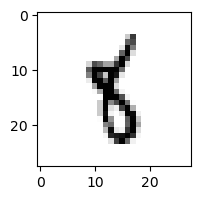

0.00014441350779896016% - 0
4.862699234744417% - 1
0.00018946870025329617% - 2
0.00015840983567584613% - 3
0.14820209024240066% - 4
60.99477187839353% - 5 - ОШИБКА
6.190245078889999% - 6
0.0038266437399480544% - 7
41.204301892225324% - 8
0.008054079796920022% - 9

 8


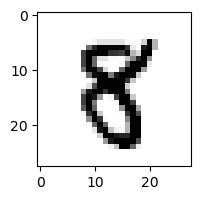

0.0008364014189254301% - 0
7.78839905371803e-05% - 1
1.3800560992942907e-07% - 2
3.1363371989014405e-05% - 3
0.010548310906322694% - 4
4.47609709714376% - 5 - ОШИБКА
2.507972315202911e-06% - 6
7.020365623312178e-05% - 7
0.0004834631363991559% - 8
1.7064227069581734e-08% - 9

 7


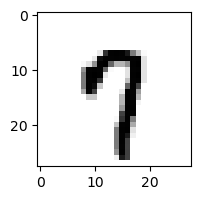

0.06373704033883784% - 0
0.000246437062624094% - 1
4.018523803687126e-06% - 2
2.6308331205232212e-05% - 3
0.21529595402167756% - 4
5.675580672314324% - 5
0.0037778257408276356% - 6
66.65921542372776% - 7
5.87552053870119e-05% - 8
97.11731589531013% - 9 - ОШИБКА

 8


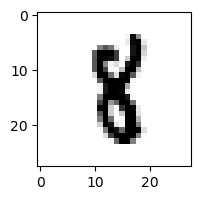

1.2097507132115067e-07% - 0
2.3537599958500683% - 1 - ОШИБКА
0.00012244091990727652% - 2
0.0002765586535155519% - 3
0.006038595525699121% - 4
1.5500946181012965% - 5
0.003984904607047653% - 6
0.0016861141729423224% - 7
0.010272550792385596% - 8
1.393011808232999e-06% - 9

 7


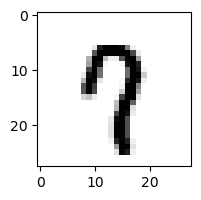

0.004811846372343535% - 0
0.0004207889066601522% - 1
0.00010520520739543437% - 2
0.00012397869441056785% - 3
0.5333723805433587% - 4
0.8219001283423927% - 5
0.0014195376805118225% - 6
40.18363683533666% - 7
2.554316482276721e-05% - 8
40.197671584328916% - 9 - ОШИБКА

 3


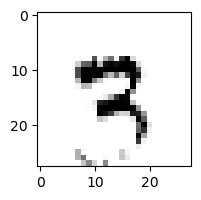

1.4256798526552458e-05% - 0
0.7096461054716648% - 1
8.767558067582363e-05% - 2
6.92232419959097e-09% - 3
0.9570820561687412% - 4
0.08670123707194369% - 5
0.020595597571896548% - 6
55.47744090824184% - 7 - ОШИБКА
0.016693743827112466% - 8
0.8829697358657299% - 9

 5


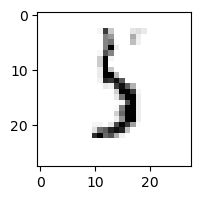

0.006975566961714298% - 0
2.3726017769709133% - 1
0.39313376721441096% - 2
49.301200979925646% - 3
1.6402883029147615% - 4
21.749521683089863% - 5
72.49817420924859% - 6 - ОШИБКА
1.3540489693640403% - 7
4.36263241016258% - 8
0.06384018095278865% - 9

 1


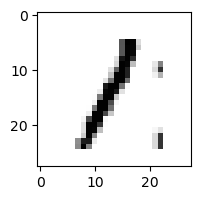

0.36369392957295477% - 0
85.34877989315666% - 1
9.844880827194887% - 2
3.4251159764360626% - 3
0.0005413327934884086% - 4
0.759050118312729% - 5
0.5416509855886396% - 6
0.002404658749364283% - 7
95.51234762718512% - 8 - ОШИБКА
0.6738205946723512% - 9

 8


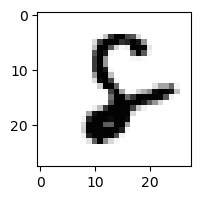

0.0003902109366634708% - 0
0.0004581063561683415% - 1
0.015130060005993918% - 2
2.976384817708127e-09% - 3
0.0017034141419893264% - 4
0.2713583998346788% - 5
45.39485505142319% - 6 - ОШИБКА
0.0005664116749699114% - 7
6.675883542527439e-06% - 8
6.626429713485081e-16% - 9

 5


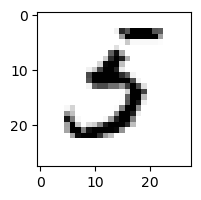

0.0001975025166352841% - 0
0.008875794954657382% - 1
6.233866054484891e-07% - 2
0.004439032050086527% - 3
0.0006462226133825002% - 4
21.76843740254264% - 5
28.98658764760772% - 6 - ОШИБКА
0.06499535865591807% - 7
5.3113515709541394e-11% - 8
1.8890542461983306e-05% - 9

 9


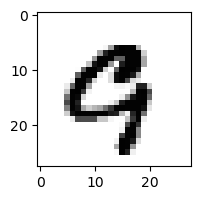

0.010071783109723799% - 0
4.037296146419642e-05% - 1
1.1313115358702372e-07% - 2
1.9963969682079446e-12% - 3
0.001960485532243963% - 4
0.0005554464375522245% - 5
3.297281102743054e-06% - 6
1.516398060905538% - 7 - ОШИБКА
2.3073965688328293e-13% - 8
0.010433138118483154% - 9

 9


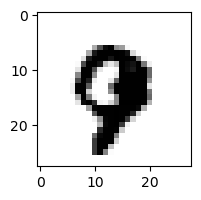

9.518438539244713e-07% - 0
2.0561990189993006e-06% - 1
9.490009467623024e-10% - 2
4.798402157587701e-13% - 3
0.001635737119385043% - 4
1.050479572444327e-05% - 5
4.5365906992872175e-05% - 6
2.394226103655624% - 7 - ОШИБКА
2.564685067391846e-12% - 8
0.01161417275983798% - 9

 8


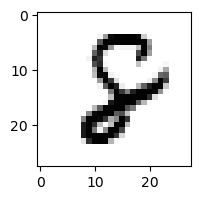

0.00022648391360549755% - 0
0.0015666748405962936% - 1
0.010003376633436232% - 2
2.0257800645452937e-10% - 3
0.0014311295010549059% - 4
0.0035604793784275142% - 5
1.5034021999693% - 6 - ОШИБКА
6.263389017262829e-05% - 7
0.002153269422033735% - 8
3.9815126267963426e-15% - 9

 9


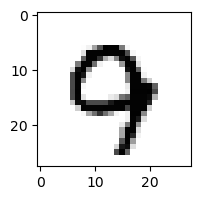

0.0013372976573799036% - 0
6.544411631250836e-06% - 1
0.000326774092420482% - 2
1.1059433323531917e-09% - 3
2.2726194046249732% - 4
9.0573642640414e-05% - 5
0.024916392752176875% - 6
12.111168756321263% - 7 - ОШИБКА
1.817729773281427e-08% - 8
1.396251884476174% - 9

 5


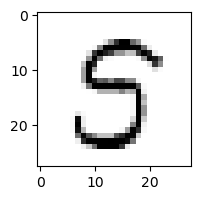

0.23430996770609064% - 0
0.0002304240226781997% - 1
1.4544793672716182e-05% - 2
9.568892767205115% - 3
0.033454986230393086% - 4
98.25666989531098% - 5
8.789899676993186e-06% - 6
0.0005866332489484753% - 7
99.66592425660785% - 8 - ОШИБКА
4.0721064801943385e-05% - 9

 5


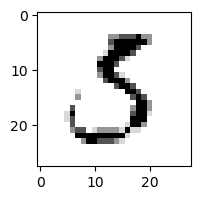

1.9315140704308724% - 0
0.013653654163829796% - 1
0.05201245211473198% - 2
59.39310089397416% - 3 - ОШИБКА
5.69798209748805e-06% - 4
49.977840882434045% - 5
0.027211386074330587% - 6
0.002731386795445269% - 7
0.0006784356718256827% - 8
6.973083853128752e-07% - 9

 7


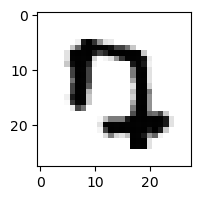

0.08412315306168353% - 0
4.1394823724444437e-10% - 1
0.030247262871183123% - 2
0.0024709030798901357% - 3
0.00014650207791327616% - 4
0.10637016228291403% - 5 - ОШИБКА
7.747273629398316e-05% - 6
0.0038852397022161892% - 7
3.0803738029478825e-16% - 8
6.432977684536874e-07% - 9

 4


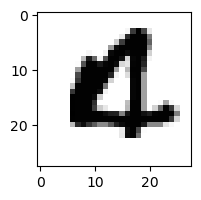

4.551521997715406% - 0 - ОШИБКА
3.0213990298648204e-11% - 1
0.0001064306224111199% - 2
4.55577860443444e-16% - 3
4.793325393778756e-07% - 4
0.05643837692693186% - 5
0.03326602614889059% - 6
8.341770484572838e-08% - 7
4.726579466705738e-18% - 8
7.660457210322775e-11% - 9

 5


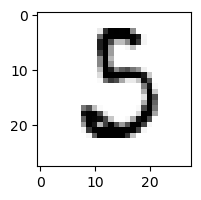

1.5069355711887709% - 0
0.015115948957358563% - 1
0.8473992092878024% - 2
0.7186099043502853% - 3
3.7136774187693135e-08% - 4
0.1146999026496742% - 5
74.79375680016% - 6 - ОШИБКА
0.010226179107761746% - 7
3.052139977434556e-05% - 8
3.8439969430141805e-13% - 9

 3


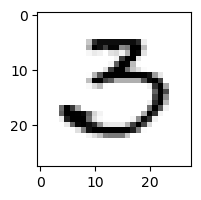

97.63087314131816% - 0 - ОШИБКА
0.001613721117735208% - 1
0.744175502599153% - 2
92.98887024763187% - 3
2.4714750798935295e-07% - 4
0.0012518106998945517% - 5
0.229796584215542% - 6
0.001033378520403462% - 7
1.201305183135413e-06% - 8
2.9937667317706347e-12% - 9

 5


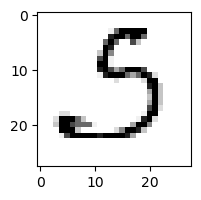

11.393064944047785% - 0
0.1036811594563785% - 1
10.479265992442228% - 2
99.70371972912841% - 3 - ОШИБКА
2.848941964546503e-06% - 4
0.1891931634809091% - 5
0.203967581652817% - 6
0.22804197644523744% - 7
0.00012990433009882048% - 8
2.0168099119136952e-08% - 9

 3


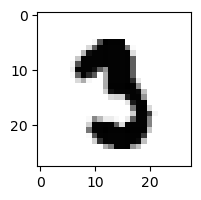

9.551492857209431e-07% - 0
7.785321380821689e-05% - 1
2.7505362250050816e-08% - 2
0.0008898292703589511% - 3
9.458517222798845e-10% - 4
12.898727409757743% - 5 - ОШИБКА
5.360255739866151e-07% - 6
0.009109787562050465% - 7
6.769522563309473e-09% - 8
5.472232117528725e-13% - 9

 4


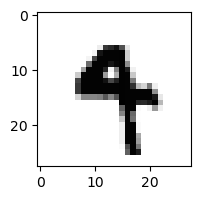

4.927108561048621e-07% - 0
0.0014465842240711149% - 1
1.3835940328293792e-11% - 2
8.025238992007874e-06% - 3
12.262570114671163% - 4
9.050214471796634% - 5
0.020920917106521626% - 6
0.018312803980387916% - 7
6.100993654369629e-12% - 8
88.05490570981542% - 9 - ОШИБКА

 8


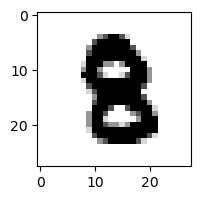

1.868726481654204e-08% - 0
1.7746032162333923e-08% - 1
2.5195330494226777e-07% - 2
5.03772847091302e-08% - 3
3.152957285314917e-07% - 4
0.0007846993054588753% - 5 - ОШИБКА
3.6591818729890276e-07% - 6
4.646262929846497e-09% - 7
1.707083519777926e-07% - 8
2.3884759822243902e-11% - 9

 3


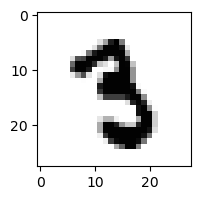

5.054825989899726e-08% - 0
0.002589222206328953% - 1
6.736679356514881e-07% - 2
2.741642844654976% - 3
1.917835807465986e-05% - 4
5.997049068691572% - 5 - ОШИБКА
0.00010464303440069565% - 6
0.00029032197465729103% - 7
2.232211665602901e-07% - 8
9.228198286631241e-10% - 9

 8


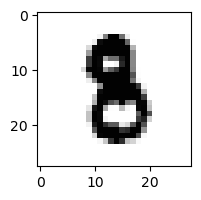

9.861290213991507e-08% - 0
0.0008350777654942007% - 1
4.903747046415952e-07% - 2
6.170108874739033e-05% - 3
6.940936424981414e-07% - 4
0.1252385938210155% - 5 - ОШИБКА
0.0011503191048875137% - 6
3.3042278341550363e-06% - 7
9.417177093193901e-06% - 8
1.378970079839144e-10% - 9

 3


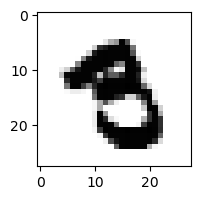

7.331001427003546e-08% - 0
1.467624664441793e-06% - 1
7.677549534201908e-14% - 2
5.429531308083715e-09% - 3
1.0323186098541801e-06% - 4
31.68890106218894% - 5 - ОШИБКА
9.778069789768635e-07% - 6
6.350269975014079e-07% - 7
1.9560058532760758e-09% - 8
1.5415516982290162e-06% - 9

 8


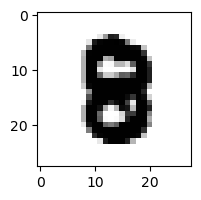

4.733119067842107e-07% - 0
3.7992451105815295e-09% - 1
4.740593673608365e-08% - 2
1.0074646638469506e-07% - 3
7.37325716085574e-07% - 4
0.000314982634684393% - 5 - ОШИБКА
2.653716162163674e-06% - 6
7.609090866404812e-09% - 7
1.740589375053103e-07% - 8
2.0495516496281277e-11% - 9

 8


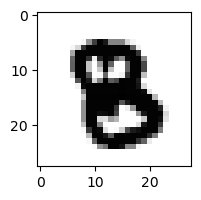

9.939499712424404e-09% - 0
2.9572469714774294e-10% - 1
3.060747924761507e-08% - 2
1.0340276861053853e-10% - 3
2.437413215924491e-05% - 4
0.004256780299218335% - 5 - ОШИБКА
4.918215282987143e-09% - 6
3.389695051142718e-08% - 7
3.840024977648288e-11% - 8
2.311651602230402e-13% - 9

 8


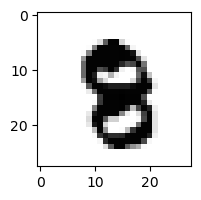

1.3914105407507473e-08% - 0
3.8722686450311487e-07% - 1
7.211927694118453e-07% - 2
2.297910701908849e-12% - 3
4.745109656075529e-05% - 4
0.00795508545837464% - 5 - ОШИБКА
8.382626896787586e-07% - 6
5.879580106908949e-05% - 7
3.726901529718097e-05% - 8
5.951034764057081e-07% - 9

 3


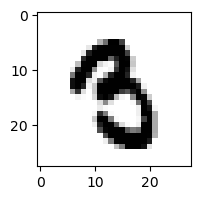

6.667180215558727e-07% - 0
0.00020629625916384307% - 1
2.546911024881901e-10% - 2
9.366929960886978e-05% - 3
1.0794191416207622e-05% - 4
15.138125016743711% - 5 - ОШИБКА
0.0004576116270920901% - 6
5.188555566391397e-06% - 7
1.225205862317603e-09% - 8
2.983531997728233e-07% - 9

 4


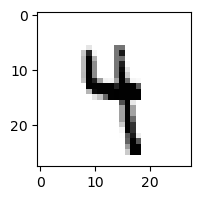

1.4008037778393e-06% - 0
1.4667405755027052% - 1
4.491695031711528e-05% - 2
0.04092975692469019% - 3
38.23196016798568% - 4
3.1600389522755714% - 5
1.0189406533118648% - 6
0.012443271933811187% - 7
0.00866516776328755% - 8
86.91873245489842% - 9 - ОШИБКА

 8


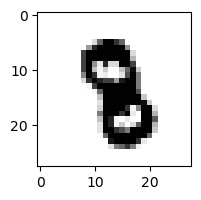

1.3216585983066066e-11% - 0
2.7769534676710443e-05% - 1
2.392699411312665e-06% - 2
2.328077520152342e-07% - 3
0.0028714058097303406% - 4
0.022195020371000625% - 5 - ОШИБКА
8.617284985634308e-06% - 6
2.7616837376531127e-05% - 7
1.0678652701534517e-08% - 8
1.931713373185857e-09% - 9

 8


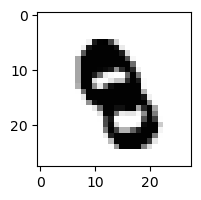

7.205231921264734e-12% - 0
1.2119650335039303e-06% - 1
2.0022684880991725e-07% - 2
1.4254342615732851e-11% - 3
0.006311305401666271% - 4
0.10537857295299542% - 5 - ОШИБКА
3.54810151030262e-06% - 6
4.261699828341044e-05% - 7
7.858957209932311e-14% - 8
7.573805230596015e-08% - 9

 1


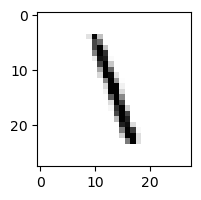

0.0007345422418810505% - 0
66.86114339410773% - 1
3.257455509239788% - 2
0.7136837194575271% - 3
4.343036584803813% - 4
51.08322030794281% - 5
14.603491833429299% - 6
0.4670885407553461% - 7
85.34594516174437% - 8 - ОШИБКА
0.07372059862120015% - 9

 3


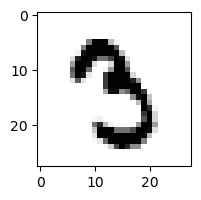

4.138559654613499e-06% - 0
0.0020148224722157226% - 1
6.302316216236838e-07% - 2
12.805169119282873% - 3
9.088803497884359e-06% - 4
25.12237860514082% - 5 - ОШИБКА
3.066991166698083e-05% - 6
0.016626622035581913% - 7
6.390645050151346e-06% - 8
1.9668155773791963e-09% - 9

 3


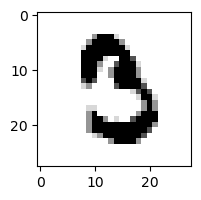

0.0017093772420619722% - 0
4.445251356934063e-05% - 1
0.0001072725600839169% - 2
0.042557281489038354% - 3
1.1083871655875448e-09% - 4
0.5320372891392153% - 5 - ОШИБКА
0.0003239488080545859% - 6
0.0055992398823473235% - 7
1.2167537639017173e-11% - 8
2.537859854713263e-13% - 9

 4


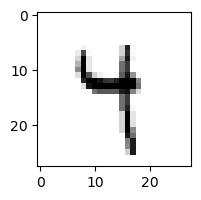

0.00022194220648069158% - 0
5.281551960241047% - 1
3.991175362432015e-06% - 2
1.8170925740296133% - 3
88.03457930846179% - 4
11.938057248792138% - 5
2.8940972653211485% - 6
0.08148359896007511% - 7
3.349566734929616% - 8
98.56588713034853% - 9 - ОШИБКА

 3


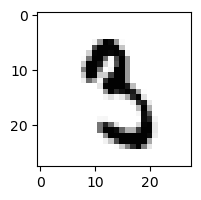

1.7060008048899803e-05% - 0
0.08605127184726709% - 1
1.3413715455351322e-05% - 2
2.85116539552% - 3
0.0001241000522305794% - 4
48.566676160172776% - 5 - ОШИБКА
0.0015511686539563614% - 6
0.0014130148616025636% - 7
0.00010968278990528865% - 8
3.835228040273136e-05% - 9

 8


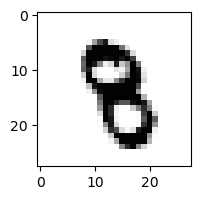

9.674376121907041e-10% - 0
0.00020340356494891835% - 1
0.00010837723548390395% - 2
0.00017535967480116274% - 3
0.016882093685332864% - 4
0.02422723305017744% - 5 - ОШИБКА
3.598145812104391e-05% - 6
0.0003325109021066275% - 7
1.2971703120850854e-07% - 8
0.00037962893998826346% - 9

 3


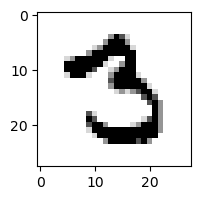

0.005331176613710152% - 0
0.00040251753445903906% - 1
0.002342733493136927% - 2
0.1753138854722122% - 3
3.81905807675403e-08% - 4
17.967477533894087% - 5 - ОШИБКА
3.1360744768329e-06% - 6
0.004003576329698181% - 7
6.565471720276639e-06% - 8
1.8030282611398254e-11% - 9

 3


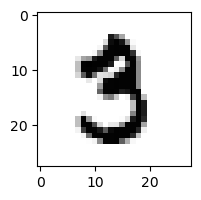

0.0004159327411273043% - 0
0.0008542666344837447% - 1
1.0500583821844479e-05% - 2
0.052735669002773565% - 3
1.732957490512544e-07% - 4
33.1394885374552% - 5 - ОШИБКА
1.0638328525398233e-05% - 6
0.00020192834295812474% - 7
0.003250812394320494% - 8
1.3106085061264954e-08% - 9

 2


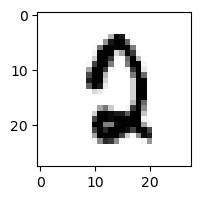

0.4418011450936392% - 0
1.4801805799003073e-06% - 1
0.024053300479433114% - 2
1.502848291509755e-07% - 3
5.281615289803413e-05% - 4
6.063843551658967% - 5 - ОШИБКА
0.16343410850646178% - 6
0.026016570514732596% - 7
3.378285479355365e-05% - 8
6.012895379470902e-08% - 9

 4


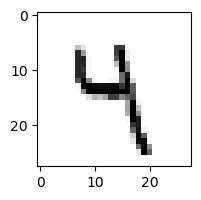

0.00025173664068915485% - 0
0.7114890089584595% - 1
0.006189099681461252% - 2
15.266744114828768% - 3
58.27334068024823% - 4
6.068942443335048% - 5
2.4975157419509473% - 6
0.01669456227119633% - 7
0.0027279813216950603% - 8
99.46862725597553% - 9 - ОШИБКА

 3


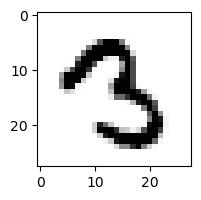

1.970068650719398e-05% - 0
0.00018650314424915486% - 1
1.3735303378804923e-05% - 2
0.12380031814661796% - 3
5.822354207688676e-05% - 4
18.627424495883734% - 5 - ОШИБКА
1.6829946719386623e-06% - 6
0.010968871730798404% - 7
3.893471231757336e-09% - 8
2.9633891042093004e-07% - 9

 8


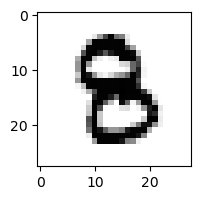

1.928943366478809e-05% - 0
1.1105196031779297e-06% - 1
2.0416945444134026e-07% - 2
0.018912850320683603% - 3
0.00019574556698448314% - 4
0.18374027441992158% - 5 - ОШИБКА
4.945716315827839e-05% - 6
7.956110065577472e-08% - 7
9.752344391106442e-06% - 8
4.503075003104473e-09% - 9

 3


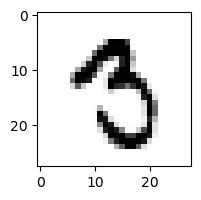

0.006644556203627636% - 0
0.018211551188208965% - 1
1.806702266350028e-07% - 2
0.0015477506657357993% - 3
2.8599649846220713e-06% - 4
10.967132666890524% - 5 - ОШИБКА
0.0006009680307575692% - 6
0.013230614866209701% - 7
3.452147393385825e-05% - 8
0.0014863743607136611% - 9

 3


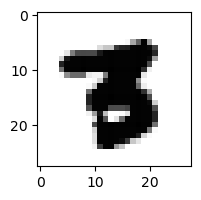

1.8805891905859667e-10% - 0
3.811482642344283e-08% - 1
3.1519461635001047e-11% - 2
4.4392837356686367e-10% - 3
8.328956423812196e-09% - 4
0.009914702419187415% - 5 - ОШИБКА
5.979485349105811e-10% - 6
2.5455559154068715e-05% - 7
3.9087984995846626e-14% - 8
8.491641175641158e-18% - 9

 9


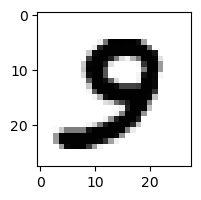

0.00018602299593348584% - 0
9.678914372640187e-09% - 1
7.082481371244472e-09% - 2
0.00479231738739935% - 3
5.459158750928593e-05% - 4
2.11613600673274% - 5 - ОШИБКА
1.701677071981049e-06% - 6
0.0001081723865884252% - 7
4.703801048014938e-07% - 8
2.5371358854347134e-10% - 9

 3


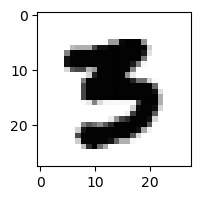

9.203090576137491e-07% - 0
6.713818233090471e-09% - 1
4.5356120610849055e-13% - 2
0.0011687007328636994% - 3
1.2060236509580933e-08% - 4
13.955315701213209% - 5 - ОШИБКА
2.2757116231201745e-07% - 6
6.0598831554074756e-06% - 7
1.5429406924384795e-18% - 8
8.4355443177229155e-19% - 9

 8


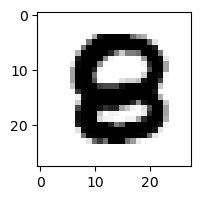

1.586131665218701e-05% - 0
6.787010098305604e-13% - 1
2.8401750842875804e-05% - 2
2.762035366056915e-14% - 3
2.697756380992732e-06% - 4
0.0015220394720096603% - 5 - ОШИБКА
4.697783503700346e-06% - 6
2.0558954553086056e-12% - 7
1.6839124891091826e-11% - 8
1.9844748696691444e-21% - 9

 9


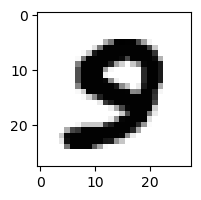

6.604202800672399e-05% - 0
1.0405722403968632e-10% - 1
8.033593155479688e-13% - 2
1.6908701007557304e-06% - 3
2.4381087144771206e-06% - 4
0.35472445010413345% - 5 - ОШИБКА
2.4180803343696304e-08% - 6
1.4401505772728901e-05% - 7
7.92960558387142e-11% - 8
7.713352806157947e-13% - 9

 3


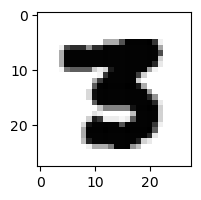

2.82628989127621e-10% - 0
1.8552720463716992e-09% - 1
2.1778389129109848e-10% - 2
0.00020644491521558977% - 3
9.77859546603535e-10% - 4
0.1381330670778546% - 5 - ОШИБКА
5.761949292293452e-14% - 6
2.394103149342287e-06% - 7
9.547401555055073e-17% - 8
1.075890814653435e-25% - 9

 9


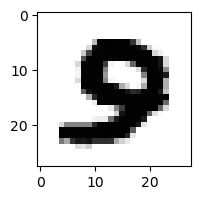

0.00030849149350151806% - 0
7.732550954678092e-12% - 1
1.2270713823633806e-10% - 2
7.672575331258808e-07% - 3
2.3341162431373554e-07% - 4
0.007169101393937811% - 5 - ОШИБКА
2.542815870249669e-08% - 6
1.0404941730435203e-06% - 7
8.555438704015486e-14% - 8
3.848901804316855e-17% - 9

 3


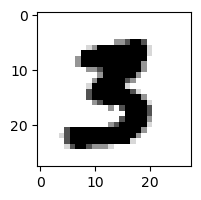

3.881030673833353e-08% - 0
2.205964786179426e-06% - 1
2.2895165398323468e-10% - 2
0.2620608302957768% - 3
1.5138849759527587e-08% - 4
2.039433503179254% - 5 - ОШИБКА
7.145488964437559e-11% - 6
1.2262603848055668e-05% - 7
9.795807883356394e-15% - 8
2.7416721928205897e-17% - 9

 3


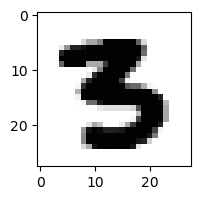

3.217965053899763e-09% - 0
4.4921569271907586e-10% - 1
2.3562469271410006e-11% - 2
0.0319761820156486% - 3
2.3188612567759385e-07% - 4
0.4894541047982669% - 5 - ОШИБКА
4.6623819472351347e-11% - 6
8.9559377187146e-08% - 7
4.7742999270025493e-20% - 8
3.2297121397559116e-21% - 9

 3


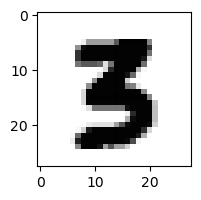

9.575730516045928e-09% - 0
7.280704823506981e-08% - 1
9.287556477994144e-10% - 2
0.049860551015375815% - 3
3.1741437177231734e-07% - 4
0.1130319779446636% - 5 - ОШИБКА
1.3544592571948573e-10% - 6
5.224685447955502e-07% - 7
3.0956384092490106e-17% - 8
1.072629026355789e-19% - 9

 2


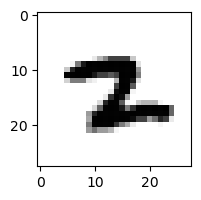

2.7636125193933114e-08% - 0
0.5085533064404171% - 1
4.407850313047302e-05% - 2
5.622477033655996e-12% - 3
1.2640383236053836e-06% - 4
0.08736485445770555% - 5
0.23169189896140008% - 6
1.0189851246521064% - 7 - ОШИБКА
1.8498384507194193e-09% - 8
2.0046877492849477e-08% - 9

 9


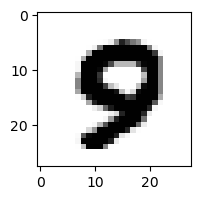

0.0004411436000859545% - 0
2.4664389337189917e-11% - 1
4.5794044728996096e-11% - 2
1.522086817183612e-10% - 3
0.0014325773154640425% - 4
0.13767855833669776% - 5 - ОШИБКА
7.109126168755734e-07% - 6
0.0006556336804567291% - 7
8.230796179966201e-11% - 8
2.861099384548976e-08% - 9

 3


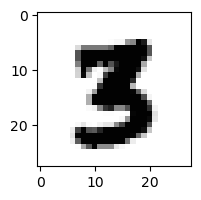

3.6984562850876985e-09% - 0
2.440894411064881e-06% - 1
3.069234384236502e-09% - 2
0.0052745998814024% - 3
3.838019838219125e-08% - 4
0.22117785693089204% - 5 - ОШИБКА
1.6481584063070036e-10% - 6
2.131534849609954e-05% - 7
2.4188877703314447e-12% - 8
8.072878310301113e-16% - 9

 9


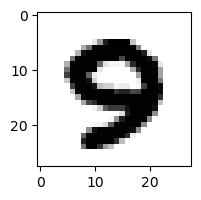

8.483245862185438e-05% - 0
1.7914320967188843e-12% - 1
2.513279437392929e-11% - 2
6.233420187512521e-09% - 3
8.082453935275163e-05% - 4
0.0002559963507173982% - 5 - ОШИБКА
7.857357430565792e-08% - 6
0.0002248481697765779% - 7
3.227793695021635e-14% - 8
1.0647543333545231e-12% - 9

 9


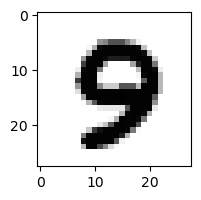

0.0002874583619242723% - 0
1.1451821453186206e-10% - 1
5.465072546815016e-10% - 2
1.5454444908375215e-06% - 3
0.0007418489263240442% - 4
0.01420800315078237% - 5 - ОШИБКА
8.144252450948113e-06% - 6
0.00036169238280615715% - 7
5.577632741821369e-10% - 8
9.880900830310446e-07% - 9

 8


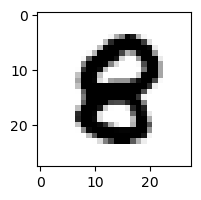

0.0009608908688675019% - 0
1.9229295106812856e-09% - 1
3.0113019209922356e-06% - 2
1.0853480115728845e-11% - 3
3.636904280055543e-05% - 4
0.018901607801727574% - 5 - ОШИБКА
4.1901677715340035e-05% - 6
3.999398121186932e-10% - 7
0.012128240792522924% - 8
1.355289293042038e-09% - 9

 8


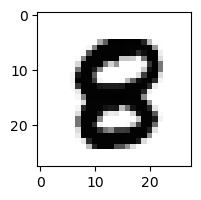

1.4551034394660195e-05% - 0
1.4824321974915784e-11% - 1
1.325628592381299e-07% - 2
4.8299309468519e-14% - 3
6.511161247846282e-06% - 4
0.005743390576069662% - 5 - ОШИБКА
9.33491157604227e-08% - 6
2.809107596657943e-10% - 7
0.0033306242108846855% - 8
1.7175361040776928e-12% - 9

 8


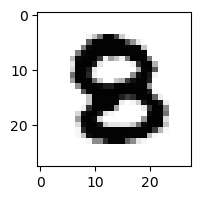

2.252522626266518e-05% - 0
1.076985115991918e-10% - 1
8.483647056406863e-05% - 2
4.015284548100774e-08% - 3
1.916725621338902e-07% - 4
0.011398927390877086% - 5 - ОШИБКА
4.0822880481255405e-07% - 6
6.798664455087854e-10% - 7
3.132229722573479e-07% - 8
1.6809112923803133e-13% - 9

 8


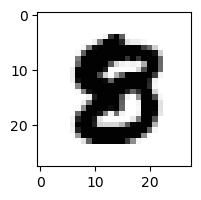

1.7404088674823814e-06% - 0
2.465733699980211e-10% - 1
9.384614651348708e-11% - 2
6.136698672338301e-13% - 3
1.4332618676685781e-08% - 4
0.022627587573619518% - 5 - ОШИБКА
1.6964166505656203e-09% - 6
1.275489458015286e-09% - 7
8.788639671463047e-05% - 8
5.081505596601295e-14% - 9

 9


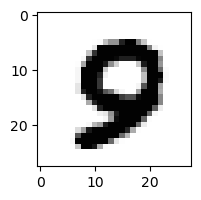

0.0012779406250124567% - 0
5.8184370678530623e-11% - 1
3.1479625612592793e-09% - 2
9.21342081549879e-11% - 3
0.0002851964450044877% - 4
0.0491841332282225% - 5 - ОШИБКА
4.712130279802633e-06% - 6
0.0005018528059608926% - 7
1.9743515369603308e-11% - 8
3.7208476593717265e-11% - 9

 3


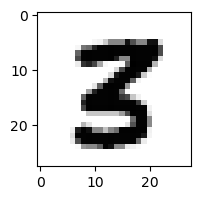

3.1054299984460853e-07% - 0
2.2193503486282483e-06% - 1
1.28730820654148e-05% - 2
6.988858133505329e-05% - 3
1.5365978535365553e-05% - 4
0.012835951428134585% - 5 - ОШИБКА
4.159824386383611e-13% - 6
3.762301074036123e-07% - 7
6.25633119321425e-08% - 8
2.0264330715200027e-16% - 9

 8


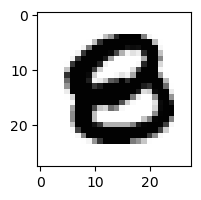

0.00033611769983063364% - 0 - ОШИБКА
5.47858059335735e-11% - 1
3.957742000384939e-07% - 2
7.430435829892377e-15% - 3
1.041450170373332e-06% - 4
4.606969572397674e-05% - 5
2.0406711394788115e-07% - 6
3.994550155042917e-14% - 7
2.2223705344301417e-09% - 8
8.65497567022789e-19% - 9

 9


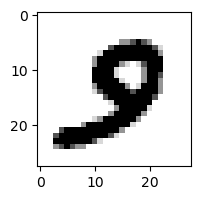

0.00020695488210636625% - 0
1.8869460153590954e-06% - 1
2.1599781151088985e-09% - 2
7.812549085232216e-05% - 3
4.166355152478252e-07% - 4
0.21724084987976533% - 5 - ОШИБКА
1.397400352069275e-06% - 6
0.0016068840572953868% - 7
1.3044457092859183e-11% - 8
3.9943143237923166e-11% - 9

 9


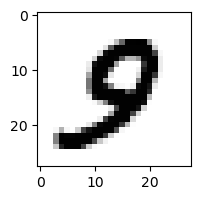

0.0009163720920302557% - 0
7.480767074991443e-07% - 1
3.2849696198014913e-06% - 2
1.5152247407862411e-05% - 3
0.005437361005209154% - 4
2.19756164588525% - 5 - ОШИБКА
3.0438867948766108e-05% - 6
0.0037713973048872232% - 7
1.0227908627048875e-08% - 8
3.0143139995300653e-06% - 9

 9


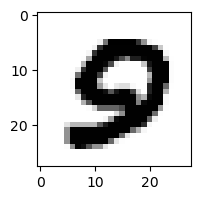

0.003235627146128832% - 0
8.496995071526295e-11% - 1
9.888788104781946e-11% - 2
3.633200698685119e-10% - 3
2.6248635507899825e-06% - 4
0.02134195543792673% - 5 - ОШИБКА
1.6733060744845517e-06% - 6
3.403185955952941e-07% - 7
1.0033699444901771e-13% - 8
2.0706162612378024e-16% - 9

 9


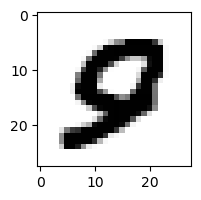

0.03120703927939925% - 0
7.630325351800326e-10% - 1
2.144410545811726e-07% - 2
5.485515155166894e-14% - 3
0.002292085509826034% - 4
0.09656051533325184% - 5 - ОШИБКА
8.032057550762335e-05% - 6
0.0002682255714363196% - 7
2.645576757492925e-14% - 8
6.466119312539023e-10% - 9

 3


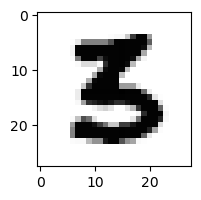

9.53362657603304e-06% - 0
1.95445078794646e-08% - 1
1.3925036774705578e-05% - 2
0.08325790404743685% - 3
6.075762209414714e-09% - 4
22.85945243087748% - 5 - ОШИБКА
5.706630517431783e-06% - 6
2.62177983819019e-10% - 7
1.4143319426826237e-18% - 8
5.740080051266412e-21% - 9

 8


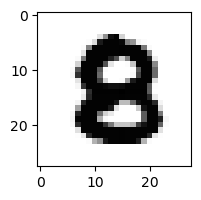

0.0001144524126174997% - 0
1.1162793502315276e-11% - 1
3.272937811111749e-05% - 2
4.63845513020593e-11% - 3
2.942545414824177e-07% - 4
0.007934560686580232% - 5 - ОШИБКА
2.8688551109384693e-07% - 6
2.251584088222812e-10% - 7
8.069477320912679e-07% - 8
7.80084171512533e-13% - 9

 8


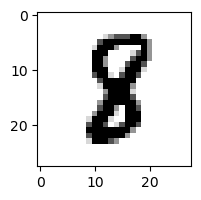

9.021020719543044e-08% - 0
0.027000641901343783% - 1
4.486839132872629e-05% - 2
1.0450119495555092e-06% - 3
3.617951025284678e-05% - 4
0.3213395087126581% - 5 - ОШИБКА
4.08771990374604e-05% - 6
1.8249657279259104e-05% - 7
0.0008224035619074459% - 8
3.928767946496106e-16% - 9

 8


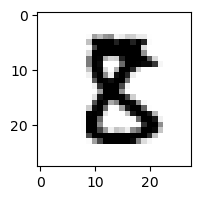

7.399242331899662e-05% - 0
1.5019492777711851e-05% - 1
0.0007504888267059593% - 2
0.0007249695102246423% - 3
3.593268020616867e-08% - 4
2.403429082149115% - 5 - ОШИБКА
1.0996454420027188e-09% - 6
1.3100897367808357e-08% - 7
0.0025701358875453682% - 8
1.5980248633148138e-12% - 9

 8


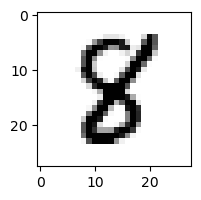

1.6941654765035725e-05% - 0
0.0006072079759180545% - 1
3.9483165242046684e-05% - 2
1.0078000790390315e-05% - 3
0.0016453518736257047% - 4
1.6155376368342227% - 5 - ОШИБКА
1.8540260942610007e-05% - 6
6.74781964611465e-06% - 7
0.30041593304364966% - 8
3.3593830980179015e-12% - 9

 8


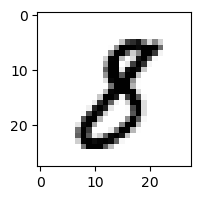

0.0005980658528051467% - 0
0.3461030045008357% - 1 - ОШИБКА
1.664053322535333e-05% - 2
0.051682272503128415% - 3
3.812243210207737e-07% - 4
0.13242367494839558% - 5
1.6667549136299197e-06% - 6
0.0008676748062389021% - 7
0.020348884855664114% - 8
9.357502610375166e-09% - 9

 3


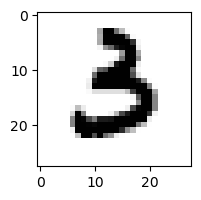

0.004484180311655407% - 0
0.00020567685685112525% - 1
3.8957052562093004e-05% - 2
0.7789517540207199% - 3
2.377667552807261e-09% - 4
3.7211272808160265% - 5 - ОШИБКА
0.04903667667567917% - 6
4.5648619005548575e-05% - 7
4.931120475553073e-15% - 8
6.869240137298184e-15% - 9

 8


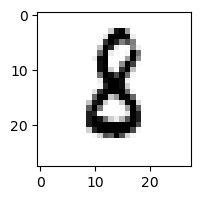

0.0009222934439777059% - 0
0.3867864858169677% - 1
0.0455120282733948% - 2
0.0210414985375611% - 3
7.96342736327058e-06% - 4
1.8225943366254775% - 5
12.361757039438679% - 6 - ОШИБКА
3.644501062202338e-05% - 7
0.0002792245395176966% - 8
8.833717397192571e-10% - 9

 8


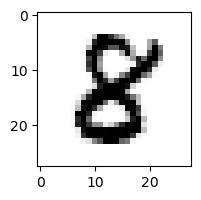

0.0003049537019289043% - 0
1.0203675199000496e-06% - 1
0.0008481075180364683% - 2
0.00012303289746250722% - 3
0.0015294272176242113% - 4
0.28435453304269864% - 5 - ОШИБКА
2.0200872373531782e-07% - 6
3.861487953008321e-08% - 7
0.07883194461382816% - 8
4.4074107177022016e-14% - 9

 2


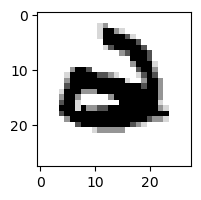

2.0495098077070028e-05% - 0
3.228324881036699e-09% - 1
1.7409120074362041e-10% - 2
7.807061261663082e-14% - 3
3.230324970473535e-05% - 4
1.1675443854899931e-06% - 5
0.00867811668473038% - 6 - ОШИБКА
1.8738010447587977e-09% - 7
2.048015328492743e-17% - 8
2.927244360417045e-13% - 9

 0


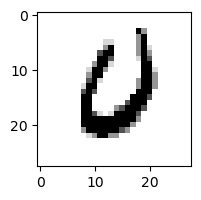

66.68500038404656% - 0
2.915435960720362e-07% - 1
0.10846466747990897% - 2
6.759411864546042e-09% - 3
0.07101816579655779% - 4
0.44114458909598% - 5
79.07033229667547% - 6 - ОШИБКА
0.2985868262093874% - 7
3.285679422726037e-08% - 8
5.701007471884436e-06% - 9

 2


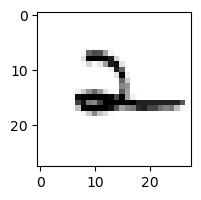

0.02534476105305556% - 0
0.7865698249691473% - 1
96.47762322634115% - 2
0.005878674251668345% - 3
99.17796144326887% - 4 - ОШИБКА
0.014820138117704348% - 5
62.42814809902241% - 6
4.684456847503294% - 7
0.0028505598255445853% - 8
14.450755896920992% - 9

 3


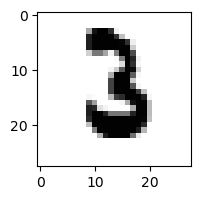

1.0107934781802463e-06% - 0
0.005158644333014414% - 1
2.759308396689961% - 2 - ОШИБКА
0.02028771663774328% - 3
9.516594194644004e-09% - 4
0.00011953628280042188% - 5
0.3617409874472754% - 6
7.255828912261152e-05% - 7
5.973675807591074e-13% - 8
2.6417709303466137e-13% - 9

 6


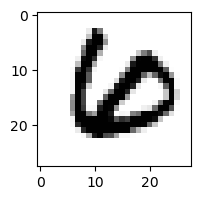

2.9100248850440514e-05% - 0
1.0464865008700828e-06% - 1
0.001480971744200228% - 2 - ОШИБКА
1.656491086190945e-09% - 3
1.4414389215165215e-07% - 4
1.5811774722719567e-07% - 5
0.0011745288112398617% - 6
1.206591146779872e-05% - 7
9.734421481859547e-08% - 8
3.522445432368258e-16% - 9

 0


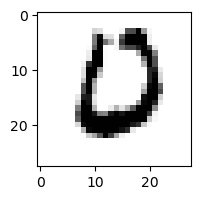

21.477505999753767% - 0
2.9674685610441245e-08% - 1
0.9709267347738124% - 2
6.655867548238611e-10% - 3
7.900523638929756e-05% - 4
0.04424719286210498% - 5
97.42471011889259% - 6 - ОШИБКА
0.0002297973958748598% - 7
1.8488742616871235e-10% - 8
3.366114666347685e-15% - 9

 0


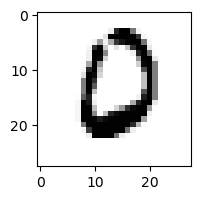

31.752723657782372% - 0
7.487627195213689e-08% - 1
0.5176418445865565% - 2
6.527390751511515e-08% - 3
0.0004712780793536365% - 4
0.37395665216257185% - 5
38.2820477298166% - 6 - ОШИБКА
0.005568891868774607% - 7
4.619558722540629e-09% - 8
7.512610459827837e-13% - 9

 3


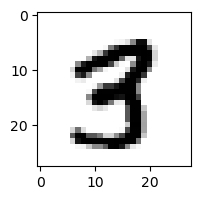

3.195071735712814e-05% - 0
2.6066806363625626e-05% - 1
1.0021442767746982e-05% - 2
0.004740821241897729% - 3
0.00019313447287456215% - 4
1.2185896798312716% - 5 - ОШИБКА
1.3611996486561534e-09% - 6
0.0003892673764997563% - 7
0.3070422124070859% - 8
0.00010306982178214637% - 9

 3


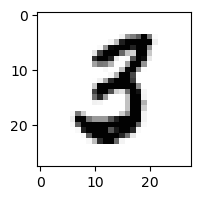

0.05169005186837991% - 0
0.0003727790989026759% - 1
0.04632211682804615% - 2
0.7800060787017903% - 3
2.4412010261542923e-06% - 4
46.78483275417856% - 5 - ОШИБКА
0.0013214764142401752% - 6
8.889924475436371e-06% - 7
1.67704497408204e-08% - 8
2.2807484777216378e-12% - 9

 3


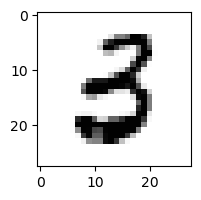

0.13641840634400712% - 0
0.0011121736361131606% - 1
1.4263033828636975e-05% - 2
9.708972145773872% - 3
0.00013698878282213505% - 4
58.82381374838337% - 5 - ОШИБКА
0.012672751041985631% - 6
2.4210555298286543e-07% - 7
7.913765014060028e-11% - 8
4.674699733312816e-16% - 9

 3


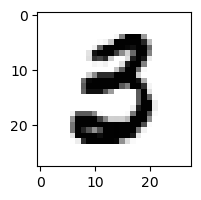

1.9925559906352117% - 0
9.354803169385844e-06% - 1
6.287996378958056e-08% - 2
1.9557611410390707% - 3
2.453347943557772e-08% - 4
66.50183382488444% - 5 - ОШИБКА
4.5285132458660574e-05% - 6
2.1057653676135414e-07% - 7
4.062940914149208e-11% - 8
3.5773598007753125e-17% - 9

 8


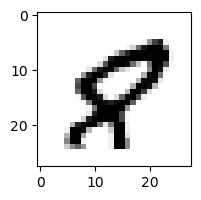

0.03368333768046794% - 0
0.00011621930180742716% - 1
9.356248141316933e-09% - 2
6.731784609547607e-16% - 3
0.007091741697034137% - 4
0.1981888708322381% - 5 - ОШИБКА
7.471997899163737e-06% - 6
0.08513037851916146% - 7
1.6525497188685543e-08% - 8
9.252515089997651e-07% - 9

 3


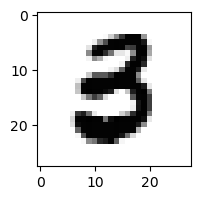

0.06352790723025074% - 0
1.0234886008783805e-06% - 1
7.915755718822449e-08% - 2
0.04566531972238002% - 3
6.248509930918858e-07% - 4
33.08778420707735% - 5 - ОШИБКА
0.0003703681816390227% - 6
4.381236360141986e-08% - 7
7.805583052951358e-15% - 8
1.5096712126237708e-18% - 9

 9


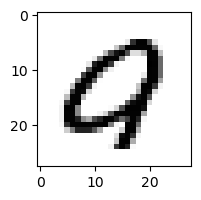

36.18785413564876% - 0 - ОШИБКА
1.1552857197091275e-07% - 1
0.002817344076841206% - 2
8.950835587004132e-11% - 3
0.00043633005415225215% - 4
1.3156703786557018% - 5
0.0023870918136163753% - 6
0.00793304182321531% - 7
4.117017203847519e-09% - 8
5.4698754856914526e-08% - 9

 9


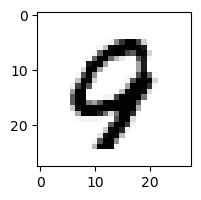

0.016524954717918854% - 0
5.417813574042262e-07% - 1
0.001614503863389591% - 2
2.1842705061427473e-13% - 3
3.4673090405185905% - 4 - ОШИБКА
1.1023600971105287e-05% - 5
0.03293860094105527% - 6
0.0040916019069325025% - 7
0.01405566101813619% - 8
0.2559772219821681% - 9

 3


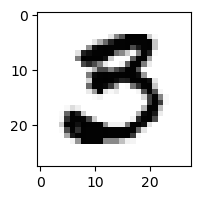

6.280551168190356% - 0
5.654148404338312e-07% - 1
5.615430329980585e-06% - 2
13.651107021872539% - 3
7.628959329334129e-10% - 4
90.14345234650926% - 5 - ОШИБКА
9.51907762273774e-08% - 6
1.1555097121075252e-06% - 7
1.2328766667560204e-10% - 8
6.059204217807297e-21% - 9

 3


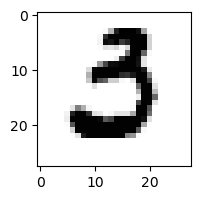

8.529297615569863% - 0 - ОШИБКА
1.9517550733184625e-05% - 1
0.0006062233566685324% - 2
0.00017388627913776834% - 3
4.933180877854064e-11% - 4
0.16177806380590645% - 5
0.029147808435788125% - 6
0.002640246855699495% - 7
3.977470026225514e-14% - 8
4.901177627321364e-19% - 9

 2


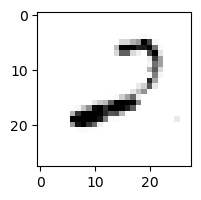

21.70001553317831% - 0
0.1541206795014969% - 1
99.98954591072297% - 2
2.999982036005679e-06% - 3
4.488886047396363% - 4
0.1219777039158399% - 5
27.58851512541607% - 6
0.1757365981470987% - 7
99.99248319739128% - 8 - ОШИБКА
0.15134684895586228% - 9

 8


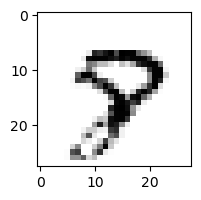

0.00065258622602457% - 0
7.068330758315599e-06% - 1
7.400989132305478e-08% - 2
1.620866824483198e-07% - 3
0.06271375676281346% - 4
0.06593301939216083% - 5
0.00020309451468162898% - 6
14.682985871401549% - 7 - ОШИБКА
5.2810060064381993e-05% - 8
0.3232631136611658% - 9

 7


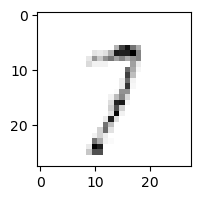

3.2316733330469014% - 0
11.68908671232785% - 1
73.54781860827995% - 2
82.31819340390636% - 3
3.3563147754095373% - 4
7.94074960338125% - 5
2.9856524350921294% - 6
88.73601165849229% - 7
62.8944508724006% - 8
99.93844335869183% - 9 - ОШИБКА

 3


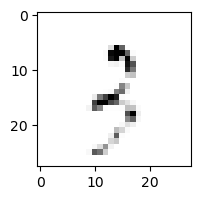

2.1273237863494843% - 0
9.307750123842819% - 1
91.14325951688075% - 2
91.46851442828067% - 3
1.1613046497116242% - 4
2.166951358131659% - 5
18.3709025744685% - 6
6.362513591436492% - 7
92.95498319603135% - 8
99.996145679544% - 9 - ОШИБКА

 1


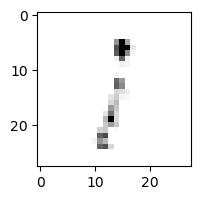

33.78505407786891% - 0
62.83345159398947% - 1
95.70191830278203% - 2
86.23310943714813% - 3
4.378678338287417% - 4
39.13723286259754% - 5
52.59662981440438% - 6
6.235976260379751% - 7
99.80091273759373% - 8 - ОШИБКА
99.05011153421299% - 9

 2


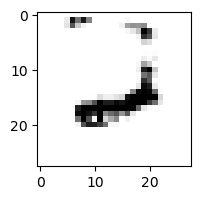

0.4898172473483087% - 0
0.011078537937560105% - 1
92.87203356569087% - 2
1.8159964277360912e-06% - 3
97.35238438833326% - 4
0.00034971970509209134% - 5
99.82151407719346% - 6 - ОШИБКА
7.7474904528538335% - 7
0.36656626961345357% - 8
0.27439967884593625% - 9

 7


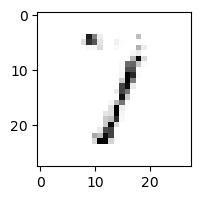

0.8465609664814241% - 0
55.802841701069994% - 1
66.62668634316272% - 2
86.42122488540919% - 3 - ОШИБКА
79.01933269209171% - 4
2.9321839831275676% - 5
5.33209442062663% - 6
78.6786029587459% - 7
84.81937006087014% - 8
20.585364283134556% - 9

 7


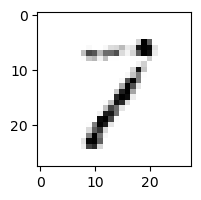

0.43781171532328195% - 0
23.813646356420147% - 1
56.91918904290745% - 2
1.1194522238787405% - 3
6.8433137471397965% - 4
4.309443444364743% - 5
7.599036781881425% - 6
28.51464609460509% - 7
76.31966918532422% - 8 - ОШИБКА
0.3956741121101235% - 9

 0


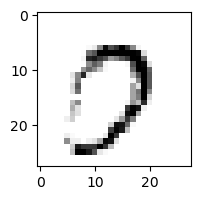

39.244101461331226% - 0
1.930779525063898e-06% - 1
0.0034986411651763585% - 2
13.090703593828712% - 3
0.0015121747276111439% - 4
0.6728022699868136% - 5
0.0005955309817274087% - 6
95.8025070170761% - 7 - ОШИБКА
0.0012393576001218918% - 8
78.38324943293782% - 9

 5


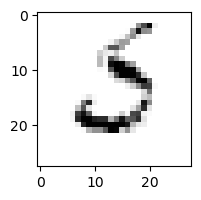

45.944292683546976% - 0
0.7404148389556924% - 1
70.19225377987416% - 2
4.100851832396427% - 3
3.8633339906103705e-05% - 4
0.18432419879958467% - 5
92.86490180031248% - 6 - ОШИБКА
6.044664689181061% - 7
2.2250923883455026e-06% - 8
1.1779851591078837e-05% - 9

 8


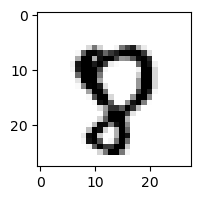

0.003977118905885632% - 0
3.1231245646567774e-09% - 1
2.0336557800192573e-07% - 2
1.1642695340906028e-10% - 3
0.017630424148572906% - 4
30.453506703206678% - 5 - ОШИБКА
7.400078975904308e-05% - 6
20.81026527065663% - 7
3.6104063375274875e-05% - 8
0.07496556758022635% - 9

 1


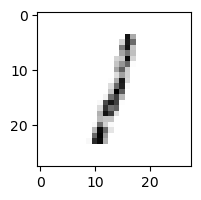

0.15453250351320394% - 0
94.69442918361013% - 1
52.170115843260966% - 2
3.239349046510248% - 3
2.2703264231313733% - 4
2.7251157864524096% - 5
10.747278472952623% - 6
1.5117152367551359% - 7
95.34724476556035% - 8 - ОШИБКА
14.50408012285274% - 9

 7


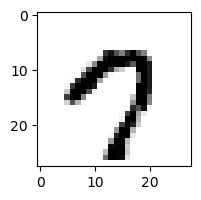

28.279238094223924% - 0
1.8194852165435326e-06% - 1
1.2717875804136191e-10% - 2
3.391970376902594e-06% - 3
0.01954706686014248% - 4
0.7034078263227207% - 5
0.00019789061582130448% - 6
91.25629498713359% - 7
8.530619234621482e-10% - 8
95.21649071217564% - 9 - ОШИБКА

 8


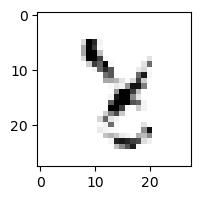

8.269712215974412e-05% - 0
0.625818498187857% - 1
0.9425801019256389% - 2
0.005055960507872898% - 3
79.79228661531658% - 4 - ОШИБКА
2.009432942218089% - 5
0.19192029640096112% - 6
64.47503253818763% - 7
71.03686064846873% - 8
0.006693739858231257% - 9

 9


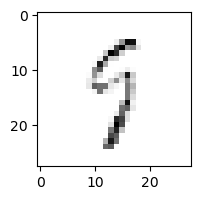

3.3271925354551124% - 0
1.6376283331213775% - 1
27.14988500497085% - 2
20.770275200319553% - 3
39.710988914000225% - 4
54.7076724913224% - 5
23.740525197089145% - 6
3.4014415519809362% - 7
99.08266389619352% - 8 - ОШИБКА
52.950503888626855% - 9

 8


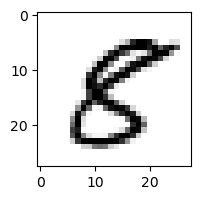

0.020994281441585393% - 0
0.0009157586567445827% - 1
2.7974138717613845e-06% - 2
3.2806979538335523e-06% - 3
0.234692767398387% - 4
92.13959285212302% - 5 - ОШИБКА
8.998472469832145e-09% - 6
1.0042834526426233e-06% - 7
0.00603928309767819% - 8
6.4493948372669455e-09% - 9

 9


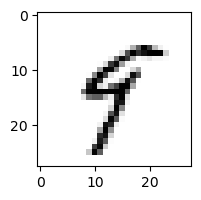

0.004357104953430735% - 0
2.559230953995838% - 1
3.2436822542353774e-05% - 2
0.003335198174609235% - 3
41.34004491983359% - 4 - ОШИБКА
29.19866203295828% - 5
0.37130281002898646% - 6
0.5988189732300436% - 7
0.016854593670116894% - 8
19.1084161143168% - 9

 0


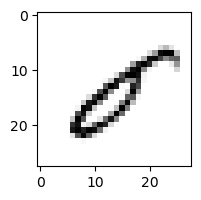

2.876546792607915% - 0
0.8943681376885696% - 1
67.99683041332742% - 2 - ОШИБКА
0.12063827499368669% - 3
19.144588081853307% - 4
42.57018962029802% - 5
0.0023173227610400167% - 6
0.009824595198391878% - 7
15.131904132189192% - 8
0.0015921876382635866% - 9

 1


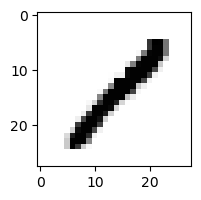

0.003951071259659362% - 0
73.88790921780756% - 1
0.11966241859113606% - 2
0.010104081215186455% - 3
0.16941921016467176% - 4
0.012770513360720869% - 5
9.874862235749975e-05% - 6
0.028141730047101576% - 7
99.79193518143109% - 8 - ОШИБКА
8.272427248030529e-05% - 9

 1


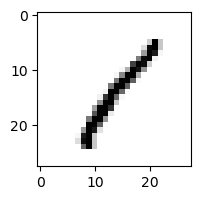

0.09254163717169024% - 0
92.99427019345146% - 1
2.423355596943411% - 2
1.160103080392878% - 3
1.0678944768450318% - 4
1.2920226118110771% - 5
0.04783650490176692% - 6
0.5964184252520054% - 7
97.5497976955545% - 8 - ОШИБКА
0.16042098783496192% - 9

 1


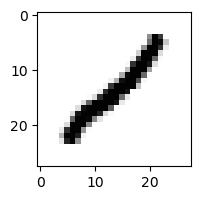

0.02794143997330434% - 0
72.16365157331262% - 1
32.53100711336849% - 2
0.1127401415931087% - 3
3.839579763074436% - 4
0.006854647288709708% - 5
0.0021804289465300543% - 6
0.000647311953675421% - 7
99.88247903066068% - 8 - ОШИБКА
0.0750081202528458% - 9

 9


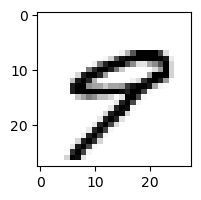

0.1044560720396451% - 0
0.0006074092551594129% - 1
3.3895740345946054e-10% - 2
3.7612463833015564e-10% - 3
4.786488782621789% - 4 - ОШИБКА
0.2644750987772225% - 5
7.591270164009307e-05% - 6
3.497582351770609% - 7
1.6623118728558424e-07% - 8
1.8448840846481147% - 9

 1


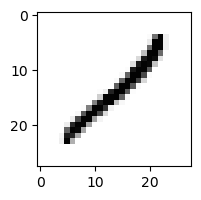

0.23245118080213423% - 0
73.94235144129696% - 1
61.41775222585319% - 2
2.077724689703062% - 3
7.301620647876435% - 4
0.06443530394684384% - 5
0.02814634498126086% - 6
0.08067403657152848% - 7
99.99991617711824% - 8 - ОШИБКА
2.83771937425933% - 9

 9


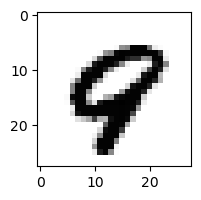

0.0019255479067024509% - 0
1.0823937533597072e-08% - 1
4.4868300075314144e-09% - 2
1.2677785659217947e-19% - 3
0.05758383592095381% - 4
1.254484275154837e-05% - 5
0.000374656291715478% - 6
0.10965271037785408% - 7 - ОШИБКА
2.3577046750384374e-05% - 8
0.08982121280958184% - 9

 5


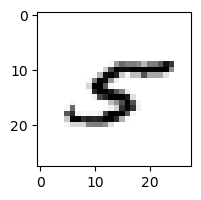

0.04033511933402217% - 0
0.20145323247361518% - 1
0.04521136502991698% - 2
0.006808562733808714% - 3
2.9945898534870556% - 4 - ОШИБКА
1.9716853165510337% - 5
0.03791213981241634% - 6
0.6902172608451276% - 7
1.0142657660458658% - 8
6.255104874800747e-05% - 9

 9


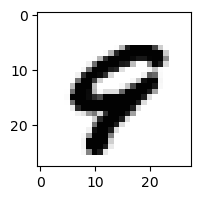

0.0038958296749401753% - 0
1.7294548434942333e-07% - 1
6.88623735041848e-10% - 2
6.783726624626537e-18% - 3
0.3470716711361075% - 4 - ОШИБКА
0.0014914733130503134% - 5
0.00013676960210429762% - 6
0.03734716796150299% - 7
4.449436606801449e-11% - 8
0.010779391842639314% - 9

 2


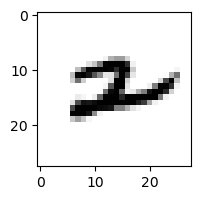

0.0005889610507247098% - 0
1.8853935261883639% - 1
2.990710063707437e-05% - 2
4.188052171915906e-09% - 3
53.37390873463483% - 4 - ОШИБКА
1.6695834437673786e-05% - 5
9.802839668997798% - 6
0.10613107204535446% - 7
4.753200697019068e-05% - 8
1.6645422237630072% - 9

 3


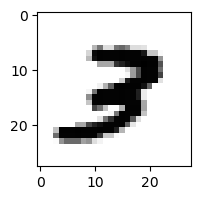

0.0003871882248182143% - 0
2.68517849183973e-05% - 1
0.16218282314246818% - 2 - ОШИБКА
0.04621340836937348% - 3
1.8197689169692802e-06% - 4
6.994744921656428e-05% - 5
1.5111630021862607e-06% - 6
0.013679126234498209% - 7
7.165691347124438e-08% - 8
0.0008394733699124777% - 9

 9


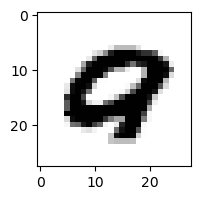

0.2406012275403504% - 0 - ОШИБКА
5.255014539827067e-10% - 1
9.201227739668052e-09% - 2
6.35023633124145e-20% - 3
9.185641511405391e-05% - 4
4.816431437765367e-07% - 5
4.184795436035485e-06% - 6
0.011148169370561824% - 7
8.290591834758613e-12% - 8
2.8789569938639048e-08% - 9

 2


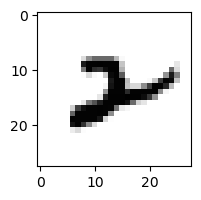

4.4645450413958325e-05% - 0
0.7732377759295105% - 1
0.04927680657853489% - 2
1.9364478856973e-10% - 3
0.03298858333069199% - 4
6.338683704105677e-05% - 5
42.704677260492744% - 6
0.0037763021464826646% - 7
50.66128201140803% - 8 - ОШИБКА
0.0011525462793375001% - 9

 5


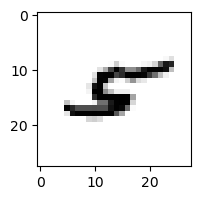

0.009788035804794124% - 0
0.4849889037502415% - 1
0.031106615891526135% - 2
1.7439992432824119e-06% - 3
95.99024415834783% - 4
0.0006780219640652439% - 5
0.8569942960553621% - 6
0.5995007902566194% - 7
99.85146684783427% - 8 - ОШИБКА
1.275497370802382% - 9

 9


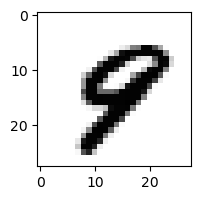

0.00012109551160919822% - 0
1.1349694844889528e-05% - 1
2.6921872535865707e-09% - 2
3.3859900640471794e-12% - 3
0.4991130883598517% - 4 - ОШИБКА
0.05566143658748819% - 5
0.00015671016433797965% - 6
0.22334858768752447% - 7
9.149597294970994e-07% - 8
0.00679160143386223% - 9

 8


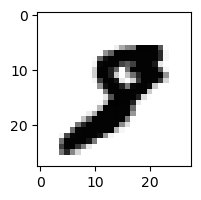

3.6344396101150906e-05% - 0
0.002276782617707417% - 1
7.160237017505017e-08% - 2
1.3780126037796626e-08% - 3
7.701181517171831e-08% - 4
1.891972694698925e-05% - 5
2.6058551990055977e-08% - 6
0.12230800146999665% - 7 - ОШИБКА
4.1198543164176115e-07% - 8
3.326340842908677e-08% - 9

 7


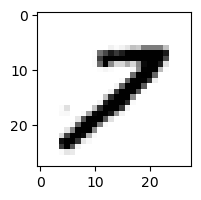

0.018513322648439273% - 0
0.2334509786067143% - 1
8.583689723864081% - 2
3.449272458908925e-05% - 3
9.99002034628243e-05% - 4
0.0015031860363523646% - 5
1.2226306904296982e-06% - 6
8.82015740686853% - 7
76.88839116601459% - 8 - ОШИБКА
0.05678695842067274% - 9

 4


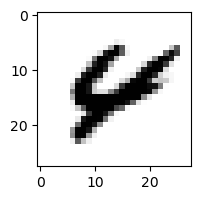

0.011222550196013807% - 0
7.636714259395565e-06% - 1
9.115733233389248e-06% - 2
8.222349508136873e-16% - 3
1.206517241033338% - 4
0.0009353956516757419% - 5
0.2810974863338043% - 6
0.0005052741824624551% - 7
7.240401173967995% - 8
31.634463530046457% - 9 - ОШИБКА

 9


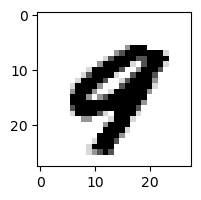

3.98397940980582e-05% - 0
1.0806795476732827e-08% - 1
2.5476924272226656e-13% - 2
2.1152445373320108e-16% - 3
1.1104482269213176% - 4 - ОШИБКА
2.1713036719904824e-06% - 5
4.0753978975976235e-06% - 6
0.06231387774936133% - 7
5.874163538252713e-09% - 8
0.0008903262099193812% - 9

 5


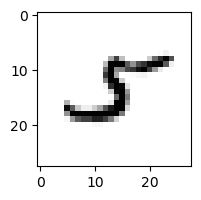

0.007332776683870172% - 0
30.845429070585283% - 1
0.8383600590240252% - 2
8.017555608238176e-06% - 3
0.10757958361110313% - 4
0.08605256110522264% - 5
0.006549141821536481% - 6
3.542542344674407% - 7
86.93483108225223% - 8 - ОШИБКА
0.00467605427799226% - 9

 9


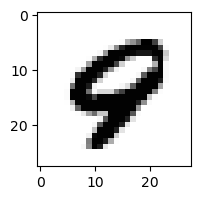

0.003996836378348083% - 0
6.682725269217246e-08% - 1
1.69551689341158e-09% - 2
1.0639054452905466e-19% - 3
3.8880950280419304% - 4 - ОШИБКА
4.688586174677954e-05% - 5
0.019328049430002603% - 6
0.0005288610798136949% - 7
9.10814380366301e-08% - 8
0.00707832737147963% - 9

 2


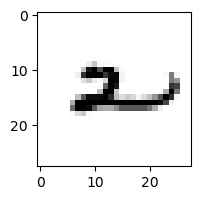

0.13614564195269085% - 0
0.4644964748460342% - 1
0.004324174105221455% - 2
0.0006372251511451132% - 3
99.38327370765504% - 4 - ОШИБКА
0.2987194417186711% - 5
95.79788424227564% - 6
0.004836345222868433% - 7
0.6031279661536461% - 8
11.003974041699037% - 9

 5


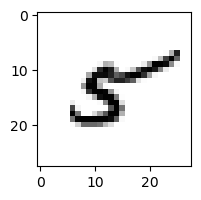

0.01707600590967687% - 0
0.4273559626463607% - 1
0.0006443527529083528% - 2
7.986051952354692e-06% - 3
7.503844757426613% - 4
93.356619168104% - 5
0.6028830179587055% - 6
0.14545765175473918% - 7
94.41371563938598% - 8 - ОШИБКА
0.007165878464916514% - 9

 9


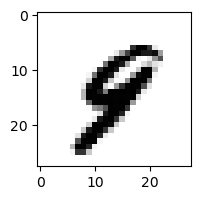

8.654308301250768e-05% - 0
0.014160017874105313% - 1
4.61267147440607e-07% - 2
2.2720770816987966e-08% - 3
0.5952655909560151% - 4 - ОШИБКА
0.023228308381225114% - 5
0.02519901819492125% - 6
0.04606787779953659% - 7
8.904542285679583e-07% - 8
0.023187293904529355% - 9

 2


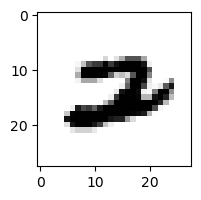

0.0017472479312074136% - 0
7.592501313115571e-05% - 1
0.00016566407090030388% - 2
1.0557662542233614e-12% - 3
0.0022646321452492327% - 4
2.5992542645382004e-06% - 5
0.09823558680713396% - 6
22.51555860088044% - 7 - ОШИБКА
8.479162042321253e-09% - 8
2.681555919877546e-09% - 9

 9


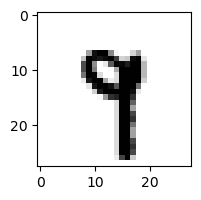

1.2641720016575026e-07% - 0
0.06701488404960299% - 1
5.638305189501903e-08% - 2
0.00024156978762293396% - 3
0.28103088156455935% - 4
0.07415475581781748% - 5
2.100159847640218e-05% - 6
4.846455270818566% - 7 - ОШИБКА
6.0323588978216545e-05% - 8
0.213522844806972% - 9

 9


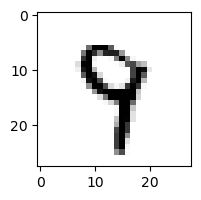

4.548245059287666e-05% - 0
0.0004930746255474391% - 1
0.00030806345824239213% - 2
0.004409068112370573% - 3
35.736277041548966% - 4 - ОШИБКА
0.5419338270400343% - 5
0.03622961959544314% - 6
1.0626489195612683% - 7
1.836469623785055% - 8
1.699529726397897% - 9

 6


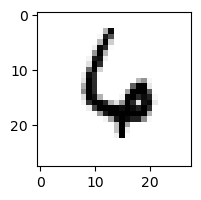

0.00029712516906586507% - 0
0.00013798620580845783% - 1
1.579738955160606% - 2
4.0719109704242225e-08% - 3
94.15369706621745% - 4 - ОШИБКА
0.5240207726304674% - 5
92.49535126509738% - 6
0.3463135201733559% - 7
6.653944443004947e-08% - 8
0.04281333831764964% - 9

 4


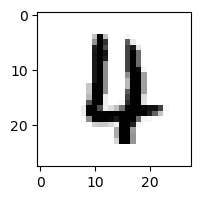

0.012202002790608573% - 0
2.7070595917415718e-06% - 1
0.15302298826289348% - 2
7.64981444485481e-09% - 3
0.18311736249435376% - 4
0.018991433373579357% - 5
1.1859321728252437% - 6 - ОШИБКА
0.023413176718376786% - 7
1.2390661136502238e-07% - 8
8.512826278306511e-07% - 9

 9


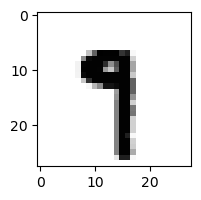

5.7388369957945e-08% - 0
0.10918677796420177% - 1
4.76982329103202e-10% - 2
1.4114508782941863e-06% - 3
0.0013308527721038925% - 4
10.694316407807639% - 5
0.000580715444038083% - 6
11.5365812186613% - 7 - ОШИБКА
0.00023707412788015914% - 8
0.4249958177311202% - 9

 8


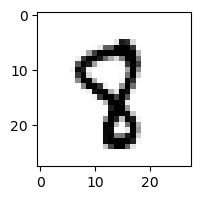

1.115403696087087e-05% - 0
0.0026102585256556256% - 1
0.00023713991955852978% - 2
7.830268381305531e-06% - 3
0.19679390587207848% - 4
2.8745827858555515% - 5 - ОШИБКА
0.00022769840917638326% - 6
0.12887110549623412% - 7
0.10043560092433755% - 8
0.00035343116219086683% - 9

 5


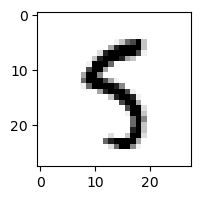

0.00243303355356598% - 0
0.002165838403160374% - 1
9.0249474639363e-05% - 2
0.01204144451612764% - 3
0.3017109274579869% - 4
82.10898747748686% - 5
0.014498616714160016% - 6
0.002636522175205069% - 7
84.78431651080575% - 8 - ОШИБКА
35.83102779925824% - 9

 9


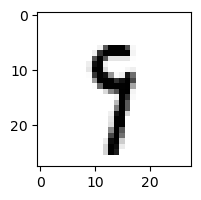

2.38430101170851e-05% - 0
0.32686473196152294% - 1
7.620702733452627e-05% - 2
0.03417485688504733% - 3
0.55231434311375% - 4
45.29917338673937% - 5
0.6766628381783457% - 6
0.3624371211971866% - 7
96.4252488767953% - 8 - ОШИБКА
84.52382380671594% - 9

 2


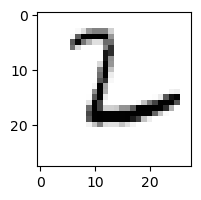

0.7166496722833648% - 0
0.0026284381972477436% - 1
99.48789141634879% - 2
0.0004778621583229146% - 3
0.024006329414208966% - 4
0.2369567282639559% - 5
99.63079877019217% - 6 - ОШИБКА
0.029046480695601496% - 7
0.03239948315412127% - 8
0.002366778880988797% - 9

 5


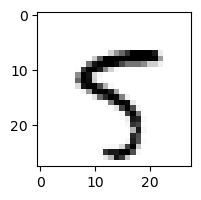

0.005221760000701018% - 0
0.0026388700474743033% - 1
0.00015153150179629104% - 2
7.465919671643038e-05% - 3
0.05600504183894273% - 4
84.28555236683921% - 5
6.906584820799586e-05% - 6
5.2127409664011735% - 7
0.008195976218883428% - 8
99.55809421763468% - 9 - ОШИБКА

 9


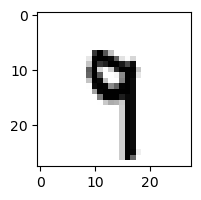

6.121461779893102e-07% - 0
1.1199638922838173% - 1
3.316737927170428e-05% - 2
0.00430578008512193% - 3
3.7439968197305737% - 4 - ОШИБКА
0.9776989473408477% - 5
0.011009467643950254% - 6
2.2783442516994885% - 7
0.0016866131548421558% - 8
3.7045925547837086% - 9

 9


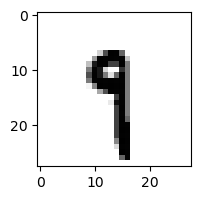

6.687911463716204e-07% - 0
15.13908877611391% - 1
5.315464215899124e-07% - 2
7.247237854981795e-05% - 3
0.25172996034006506% - 4
20.92086227367452% - 5 - ОШИБКА
0.06925740382820944% - 6
0.1797926344599538% - 7
0.09493831225149632% - 8
16.394150507297176% - 9

 9


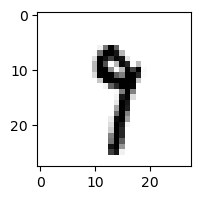

7.395672613844554e-05% - 0
7.288952624978013% - 1
4.143221905509456e-05% - 2
0.16770290965168166% - 3
0.023050348474930656% - 4
1.1188880323775274% - 5
0.009513526615715324% - 6
37.81227771958177% - 7 - ОШИБКА
0.2101087755422039% - 8
2.7432937305674074% - 9

 6


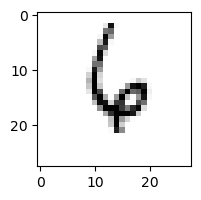

0.0001614870270025504% - 0
0.06346316388049032% - 1
16.14014754612229% - 2
5.718577294992356e-05% - 3
99.45529101808958% - 4 - ОШИБКА
4.506779136188701% - 5
93.01205462059792% - 6
1.9991988053339373% - 7
0.037699179682281904% - 8
16.92365301309284% - 9

 3


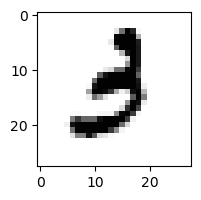

0.019351656962918427% - 0
0.00400785489044886% - 1
0.0018344864759132881% - 2
1.2273719675454942% - 3
4.851102336345186e-05% - 4
7.102438611251473% - 5 - ОШИБКА
0.06306969208462203% - 6
7.321735412288812e-05% - 7
3.6764284339776557e-10% - 8
1.5140075886786621e-10% - 9

 8


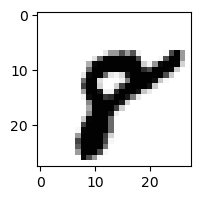

0.00031300362943254066% - 0
1.5579167507993276e-05% - 1
2.0964545675073618e-10% - 2
6.258085246910752e-14% - 3
7.867180253762215e-07% - 4
0.0014561934915785517% - 5
2.2396008635253615e-05% - 6
0.21279639358093527% - 7 - ОШИБКА
0.0011777527243333253% - 8
0.00031643186441031334% - 9

 5


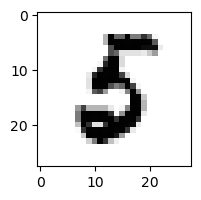

0.02662198776671789% - 0
0.00037640820136138113% - 1
0.00030018644582797775% - 2
5.864880137100931e-08% - 3
1.3075139335424088e-06% - 4
6.658932969788702% - 5
16.479560197951976% - 6 - ОШИБКА
2.2425668689177877e-06% - 7
6.727168209336187e-07% - 8
1.2602378692663132e-13% - 9

 9


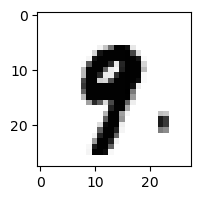

1.1315970959859313e-07% - 0
0.0013619470902099609% - 1
2.5567696363844507e-09% - 2
6.793140298365338e-09% - 3
0.0007455989874581031% - 4
1.4526367770925113% - 5 - ОШИБКА
3.5093150697565304e-06% - 6
0.0005993975140045402% - 7
8.221122559228498e-09% - 8
0.6716116363170562% - 9

 7


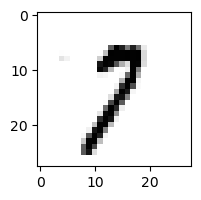

0.0637751490148129% - 0
9.195330085032625% - 1
1.3868472084387387% - 2
0.03469431892085762% - 3
0.0008157810646726462% - 4
0.3699597065654711% - 5
0.0044195265545527536% - 6
82.25951449557732% - 7
0.09977966500845992% - 8
85.7774560159806% - 9 - ОШИБКА

 8


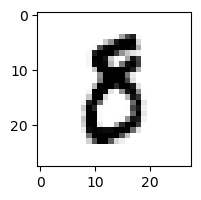

0.605208245759321% - 0
0.0006280557432288428% - 1
0.000606993799696647% - 2
0.02148650652265387% - 3
7.060439004653811e-06% - 4
8.967386667848135% - 5 - ОШИБКА
0.003983117293544218% - 6
6.0622371394599804e-05% - 7
0.0007527355485879163% - 8
2.638485023855149e-09% - 9

 9


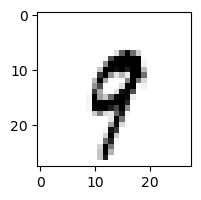

0.00023454767178834014% - 0
1.406233270290842% - 1
0.0002209879736698246% - 2
2.5564831726219738e-05% - 3
0.7163553383611526% - 4
0.0018263141849148513% - 5
0.01564401293097247% - 6
31.886443454034552% - 7 - ОШИБКА
0.0026414567635892404% - 8
10.757832017280002% - 9

 2


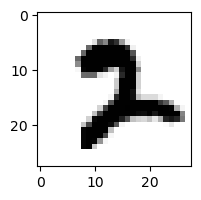

5.881303973976187e-07% - 0
6.443976631692394e-06% - 1
0.49933337340039263% - 2
4.3996336318455967e-08% - 3
6.709407717309544e-09% - 4
0.036771938881444984% - 5
3.528952951874077e-06% - 6
7.576849231340608% - 7 - ОШИБКА
1.2483317484651993e-14% - 8
6.358205576721517e-13% - 9

 9


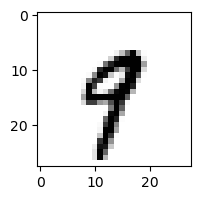

0.00015429800816881608% - 0
2.568257726593096% - 1
2.7282324948838686e-06% - 2
0.0001068315324293697% - 3
1.9430872847058942% - 4
0.17370014597588324% - 5
0.009011427225091366% - 6
6.6966197866866946% - 7 - ОШИБКА
1.417852607263295e-06% - 8
0.9826007348752356% - 9

 9


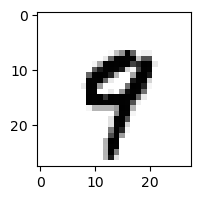

0.00016002557550998128% - 0
0.0002936906723314953% - 1
1.737792498966642e-08% - 2
3.426739831651875e-07% - 3
0.9682233167725306% - 4
0.010588511177171734% - 5
0.0007034295302726374% - 6
7.634364536772918% - 7 - ОШИБКА
2.9837705727112287e-06% - 8
3.244196797733555% - 9

 9


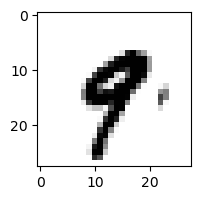

5.113536056024222e-05% - 0
0.20968010527859832% - 1
8.968199422160321e-10% - 2
4.417100057067158e-06% - 3
1.2544658957204324% - 4 - ОШИБКА
0.002805137377902699% - 5
0.0006644379036591795% - 6
0.2951352136218824% - 7
2.289185964522018e-08% - 8
0.18120827203990789% - 9

 9


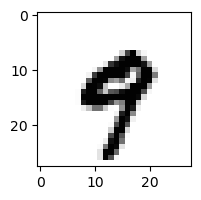

0.00010649446841877642% - 0
0.0003135762331913447% - 1
2.960433124042211e-10% - 2
1.6122785490861234e-05% - 3
2.86896359024135% - 4 - ОШИБКА
0.0008167975819928878% - 5
0.00046600116289976216% - 6
0.356406444973586% - 7
2.566772017386494e-09% - 8
0.5116628734620053% - 9

 8


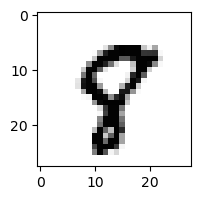

0.0010079528494202816% - 0
5.6749268557800796e-05% - 1
1.578921098318381e-06% - 2
7.452806040500081e-09% - 3
0.006187729049022641% - 4
4.323354390180285% - 5
8.3465080725085e-06% - 6
0.4868181549467614% - 7
0.047131770140254506% - 8
4.903717971146157% - 9 - ОШИБКА

 9


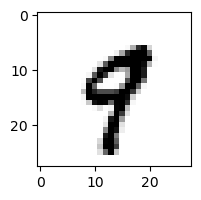

0.000307795298004658% - 0
0.01702687823691997% - 1
5.803058886890152e-07% - 2
2.3982520232206226e-05% - 3
1.189472460119951% - 4
0.06886779993983207% - 5
2.764184801133104e-05% - 6
3.888419068117889% - 7 - ОШИБКА
1.3655572591065434e-05% - 8
1.5557945291768103% - 9

 8


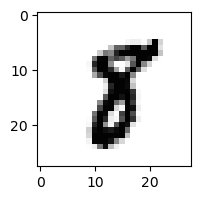

2.460248704314851e-06% - 0
0.1366121326136694% - 1
4.3145553874140507e-07% - 2
2.5009013129694315e-06% - 3
3.0252698337967973e-06% - 4
1.5214454503489507% - 5 - ОШИБКА
2.5217802288032676e-06% - 6
0.016426964124912073% - 7
0.014887638400678044% - 8
1.1134367337768105e-07% - 9

 9


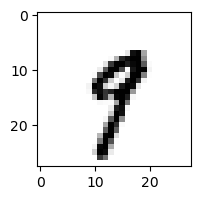

0.0005823258076759466% - 0
1.1647475173557005% - 1
1.5100864384185428e-06% - 2
0.08632530492246741% - 3
2.2914770618311207% - 4
0.2111875726719837% - 5
0.003422884323470058% - 6
19.737668522061462% - 7 - ОШИБКА
0.0020292852482329034% - 8
0.158979025788034% - 9

 3


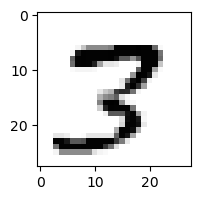

1.4128239443384371e-05% - 0
4.106100786674812e-05% - 1
0.0021163740217345203% - 2
0.2444378097852422% - 3
0.00012087165785008113% - 4
0.042974585192542186% - 5
6.194467414338396e-09% - 6
21.296788357236586% - 7 - ОШИБКА
16.265933653086012% - 8
1.6059812961504664e-05% - 9

 8


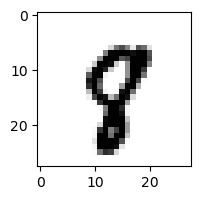

6.794760840845975e-05% - 0
0.000553356697904409% - 1
4.513841860253615e-07% - 2
2.271800036830128e-08% - 3
0.025364924969290915% - 4
0.741907645265899% - 5
1.2067370244916248e-05% - 6
3.2019872132994216% - 7 - ОШИБКА
0.0006743453675877564% - 8
0.09918799623290166% - 9

 8


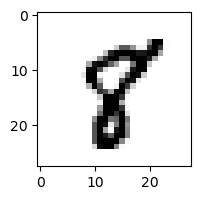

7.432910361165243e-05% - 0
0.020766888416022356% - 1
1.1543524982344502e-06% - 2
1.3431034976893137e-09% - 3
0.012885569874381844% - 4
4.69362713167599% - 5 - ОШИБКА
4.2695526611894185e-06% - 6
0.1665621509970575% - 7
2.3324215859052133% - 8
0.000399289495529462% - 9

 3


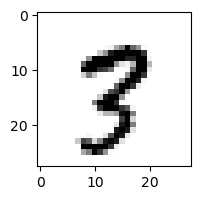

6.1093058997751025e-06% - 0
0.007427217797681325% - 1
6.472881904159874e-05% - 2
8.013129830286546e-06% - 3
0.00012785043786840502% - 4
0.0948328358657631% - 5
6.443462901017714e-06% - 6
7.355280141507166% - 7
50.17685034740913% - 8 - ОШИБКА
22.852768504324956% - 9

 9


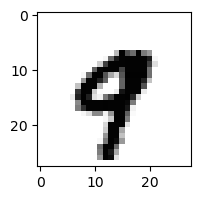

1.144299561688438e-05% - 0
0.0003093748122433056% - 1
6.332008532053378e-11% - 2
9.12363531922848e-12% - 3
2.0817319627157453% - 4
6.920980497570534e-06% - 5
1.4485006840079655e-05% - 6
3.806730293074703% - 7 - ОШИБКА
5.627200487087884e-10% - 8
0.7880289643386837% - 9

 9


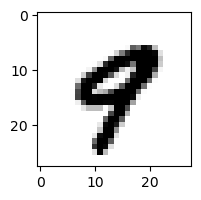

0.0005111004054078481% - 0
0.0002404645494583613% - 1
5.076968780052417e-11% - 2
9.73202297581288e-10% - 3
0.8959349383539243% - 4 - ОШИБКА
0.0035588888969352644% - 5
1.4949775453196269e-06% - 6
0.4718522642925203% - 7
2.1943862674963846e-07% - 8
0.6527034217600939% - 9

 5


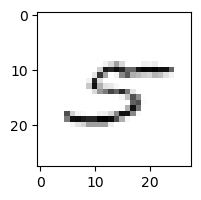

19.614171345095208% - 0
0.3429061917434972% - 1
6.4569047627590335% - 2
1.9641752518734346% - 3
2.9971925057666016% - 4
7.42744544263653% - 5
6.146058970072892% - 6
41.441824325498814% - 7 - ОШИБКА
9.042575332898512% - 8
0.1292723102519174% - 9

 6


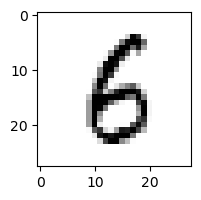

0.05991741775836815% - 0
0.007971049774316223% - 1
0.022330975787190708% - 2
0.0008038620442323118% - 3
0.04397262259256127% - 4
6.365834789690021% - 5
60.40590278160721% - 6
5.129483899848668e-05% - 7
67.50139403219157% - 8 - ОШИБКА
0.0007909105319600585% - 9

 3


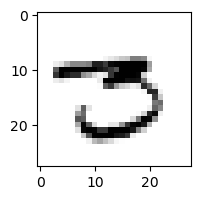

0.7093360491889603% - 0
0.12104458415626133% - 1
3.94089866368243e-06% - 2
0.16057470553411063% - 3
6.130488245085482e-06% - 4
22.855936015537058% - 5 - ОШИБКА
0.0003391120785272108% - 6
0.6440120732496392% - 7
0.001023319475190568% - 8
2.6176063738933685e-08% - 9

 5


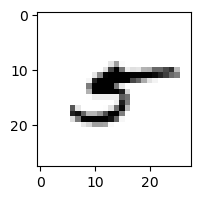

0.01584770602043168% - 0
9.663305109039252% - 1
0.0007299694352570589% - 2
0.002491282165807501% - 3
4.461380859437384% - 4
0.01708332584325138% - 5
11.848654001084498% - 6
0.03988335736577565% - 7
92.38997256631541% - 8 - ОШИБКА
0.13508940116026652% - 9

 1


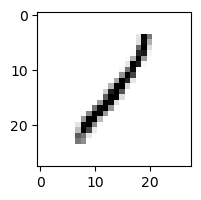

0.2650665601726562% - 0
94.94659664605733% - 1
60.29193097864203% - 2
1.9416692855653168% - 3
0.6246422587816353% - 4
0.7290118115125777% - 5
5.946081028358166% - 6
0.1438269774660756% - 7
99.04079053453% - 8 - ОШИБКА
2.9940603645905886% - 9

 3


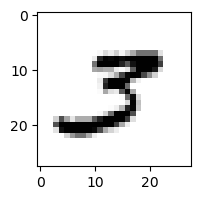

0.12146266064941684% - 0
0.08416104762746157% - 1
0.38432377093289777% - 2
1.689968876527197% - 3
2.454633510010942e-06% - 4
2.1198302293345677% - 5
6.663471558629848e-07% - 6
4.504691857735122% - 7 - ОШИБКА
4.7872328835080576e-05% - 8
1.0673893199436058e-05% - 9

 2


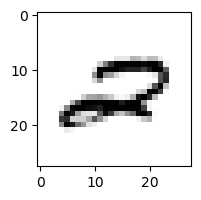

5.587492687824915% - 0
0.0007802667366091254% - 1
0.31910760632609886% - 2
3.981198094798229e-07% - 3
3.3887498619077037% - 4
9.730396572189079e-06% - 5
0.005590021916176715% - 6
14.025397087332674% - 7 - ОШИБКА
1.2444478623618598e-05% - 8
9.584640041301353e-05% - 9

 8


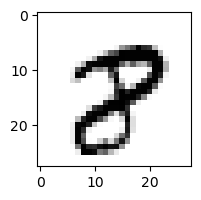

2.221909778709049e-05% - 0
0.00011392556868280181% - 1
5.101752289699134e-07% - 2
2.225335426474138e-12% - 3
2.3467057916789326e-08% - 4
0.001248089871721268% - 5
3.94629155306919e-08% - 6
3.495695349170058% - 7 - ОШИБКА
0.11720970578122905% - 8
8.465328305273886e-05% - 9

 1


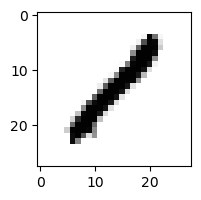

0.48857105412312485% - 0
64.0014040029765% - 1
4.056705021311124% - 2
0.6542430515559357% - 3
0.02276329683315877% - 4
0.03630353982012471% - 5
0.000518379301806685% - 6
0.00016149374955300248% - 7
81.66400087593395% - 8 - ОШИБКА
0.0014177191153415195% - 9

 8


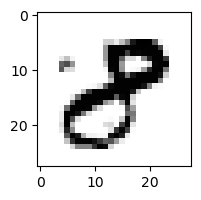

0.02184435326443272% - 0 - ОШИБКА
0.0005595864284595891% - 1
0.00023247624756263135% - 2
0.007574693063994635% - 3
8.252199926897841e-05% - 4
1.373324668147386e-05% - 5
2.981870360489259e-08% - 6
1.8592655054606297e-06% - 7
9.831318546859487e-05% - 8
4.8470094702995364e-06% - 9

 3


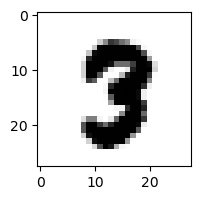

1.2090530739533329e-05% - 0
4.7246515454436324e-07% - 1
8.989082962861741e-08% - 2
2.8800374849635312e-05% - 3
2.614416453088507e-09% - 4
0.03839617550139648% - 5 - ОШИБКА
3.3163015227475966e-09% - 6
0.013437530069703474% - 7
2.172653826378444e-06% - 8
2.753671843577128e-10% - 9

 8


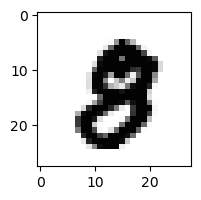

5.7746028455695224e-05% - 0
3.107553623255426e-07% - 1
2.9519239743489728e-09% - 2
1.703911989043436e-08% - 3
3.624087970306789e-08% - 4
0.00014681779805499897% - 5
1.2934731053834596e-09% - 6
0.0001719453847684153% - 7 - ОШИБКА
0.00010907087736604574% - 8
5.365644552250218e-10% - 9

 4


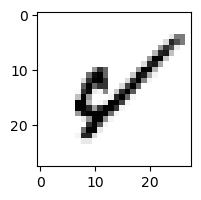

1.334071791963721% - 0
0.04649466470474087% - 1
0.003944321771643589% - 2
7.880071474931936e-09% - 3
99.8228071037117% - 4
0.2231345404759535% - 5
43.80093789884567% - 6
0.05564114724219626% - 7
99.9502663045307% - 8 - ОШИБКА
2.0638901427040683% - 9

 7


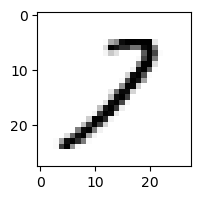

0.41718248897192484% - 0
53.45906618874993% - 1
95.79050649025967% - 2 - ОШИБКА
1.3241515134693147% - 3
0.24049728759221903% - 4
0.1231814440955238% - 5
0.07315297933484685% - 6
0.4290369486035712% - 7
94.35653877500542% - 8
8.799244714440834e-05% - 9

 4


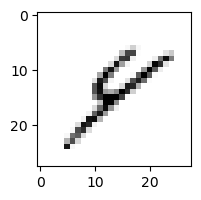

0.3495916646900833% - 0
2.9534762069900378% - 1
0.7112018584038812% - 2
0.5488402831021963% - 3
2.6504442016976864% - 4
2.578774287891248% - 5
22.17251957069598% - 6
0.5792704033570547% - 7
99.9997046621056% - 8 - ОШИБКА
92.40812855076422% - 9

 1


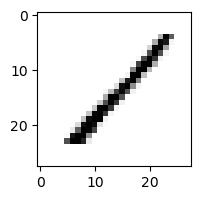

0.24718660276374893% - 0
83.37773578495243% - 1
38.43321133863778% - 2
0.5316268039391422% - 3
3.693388752609459% - 4
0.7807069821908384% - 5
0.2685190672840812% - 6
1.4856202734081037% - 7
99.9900781553275% - 8 - ОШИБКА
0.031520680674349356% - 9

 5


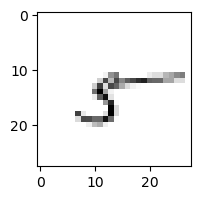

6.333695510455546% - 0
64.69791347340254% - 1
60.04305042753752% - 2
14.050277025111388% - 3
71.37625472147992% - 4
3.8785518348203083% - 5
99.23466745317084% - 6
0.21244563534143934% - 7
99.99526684547202% - 8 - ОШИБКА
97.82686795380272% - 9

 5


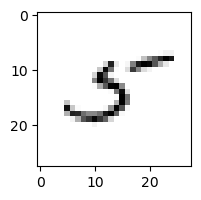

0.613982830717831% - 0
5.29183034592668% - 1
1.0015326317228832% - 2
0.00214206684372658% - 3
63.08920217068319% - 4
50.139208392420365% - 5
0.4985696774251709% - 6
3.417384793188466% - 7
99.98832253418212% - 8 - ОШИБКА
1.3501417871218735% - 9

 9


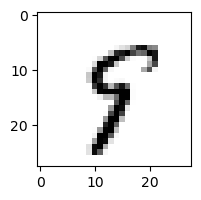

0.0012973280919791749% - 0
0.13631867491525065% - 1
0.0007322034735752953% - 2
0.00011148039146154822% - 3
4.089056515977421% - 4
67.74939369570993% - 5 - ОШИБКА
0.0893638364961416% - 6
0.47907384855689444% - 7
35.454224997875464% - 8
49.043511034822714% - 9

 2


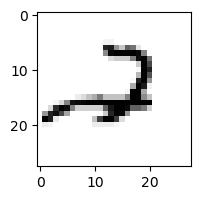

0.3803797902006584% - 0
0.0036255406075805284% - 1
93.81431538677532% - 2
0.0026687393725072514% - 3
44.209893615109884% - 4
0.0006663865535764112% - 5
0.06506378105034999% - 6
7.970839354672621% - 7
4.8998226068248384e-05% - 8
97.6604802570815% - 9 - ОШИБКА

 4


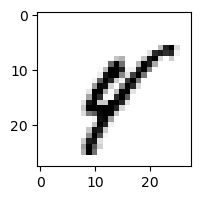

0.003027411073877509% - 0
4.953848584787523% - 1
0.0001953407555813389% - 2
1.596318632705193e-05% - 3
17.252126084087916% - 4
0.2312900720254399% - 5
0.3939819582204425% - 6
0.343929223001826% - 7
68.51532182558296% - 8 - ОШИБКА
0.014456295396278676% - 9

 3


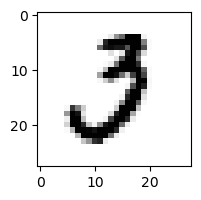

13.777129758562662% - 0
0.0008024195108649557% - 1
20.289588707974897% - 2 - ОШИБКА
0.32452751235949634% - 3
1.3033397239878343e-06% - 4
0.07716363528652659% - 5
1.7757227586864098e-05% - 6
0.0838732177389117% - 7
2.6996045725746996e-10% - 8
2.690834083725586e-12% - 9

 2


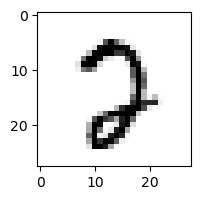

8.373899694612344% - 0
3.842952093496926e-06% - 1
6.972414556093326% - 2
0.014650037641005751% - 3
0.0001476950883099498% - 4
4.060048983530588% - 5
0.00440816991182616% - 6
35.90404501580153% - 7 - ОШИБКА
0.004698737398725046% - 8
1.722867390500176e-06% - 9

 8


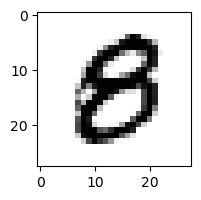

1.9619576695222039% - 0 - ОШИБКА
4.6334419577684763e-07% - 1
1.6092466808211773e-07% - 2
3.184341594302784e-06% - 3
0.0004419879091237985% - 4
1.5173530592611264% - 5
0.009855218849714957% - 6
6.541100779388613e-09% - 7
0.13686537902576293% - 8
2.129900313047602e-07% - 9

 8


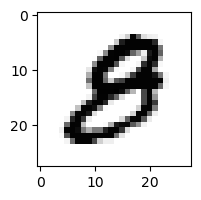

0.6156963443211798% - 0 - ОШИБКА
1.7950071245381105e-06% - 1
6.425635383780021e-06% - 2
7.128676926090784e-05% - 3
1.6690536760375735e-05% - 4
0.0013515875700399885% - 5
0.001551964543710283% - 6
5.313231772559956e-08% - 7
0.04581032224943923% - 8
1.453218884816216e-06% - 9

 3


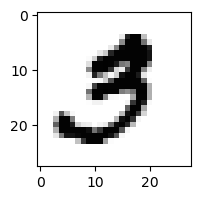

0.030218333372174985% - 0
1.8851360908790968e-05% - 1
5.008477411867662e-05% - 2
2.3068028324942063% - 3
9.8846615731993e-07% - 4
11.527361175663186% - 5 - ОШИБКА
4.099290899034041e-08% - 6
0.0002160345620653038% - 7
3.2894028234840344e-11% - 8
8.42204519297723e-07% - 9

 2


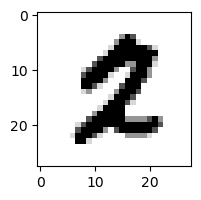

3.1084795324704894e-05% - 0
0.00010633410037138942% - 1
3.832942797509759e-05% - 2
1.6582745022633184e-11% - 3
2.7060443828776043e-08% - 4
0.05463955742504701% - 5 - ОШИБКА
3.3897468345348083e-06% - 6
0.0006599374570352584% - 7
3.945337560280401e-10% - 8
7.717247181411997e-10% - 9

 5


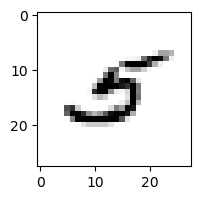

0.05299332501452886% - 0
0.18391058261613685% - 1
0.43223233703630937% - 2
0.005268306198087239% - 3
25.766034502955893% - 4 - ОШИБКА
10.663551436201947% - 5
0.09719040663791238% - 6
0.055917044553173326% - 7
0.187407297798857% - 8
0.0008549010721679038% - 9

 5


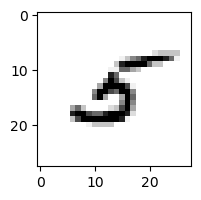

0.015763884540764515% - 0
2.7292045831928813% - 1
9.651178169730953% - 2 - ОШИБКА
0.003045777502367715% - 3
5.3694439790262525% - 4
5.7410772666850285% - 5
0.04286525751845542% - 6
0.03022885066530757% - 7
1.7133661632969817% - 8
0.0007128639323872412% - 9

 8


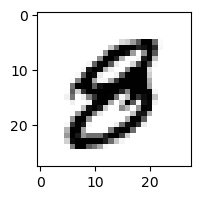

0.00377407209599691% - 0
3.624837282374697e-06% - 1
6.51792694845363e-10% - 2
7.531283955888521e-06% - 3
0.002203719029615854% - 4
0.05653788218520805% - 5 - ОШИБКА
1.4088015410423485e-05% - 6
2.259789281019078e-07% - 7
6.946955344122376e-07% - 8
0.00021007388943980324% - 9

 9


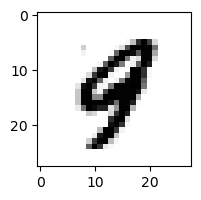

6.917421563459248e-05% - 0
0.0010329436652018083% - 1
7.571812254322087e-08% - 2
5.426225204974185e-09% - 3
15.188040354693932% - 4 - ОШИБКА
0.00231779397843087% - 5
0.0006534118833411758% - 6
0.0008082677763413147% - 7
3.3872630350468075e-05% - 8
2.637049036502309% - 9

 9


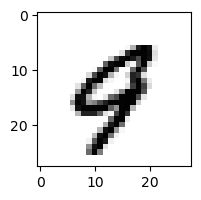

0.02388071915967272% - 0
0.00014714823659707125% - 1
7.587902414844797e-07% - 2
2.250577356284177e-10% - 3
30.561401281616828% - 4 - ОШИБКА
0.00022043251024268047% - 5
0.004237094991401832% - 6
0.9622459545603148% - 7
4.889634921258837e-07% - 8
0.47805998205820616% - 9

 3


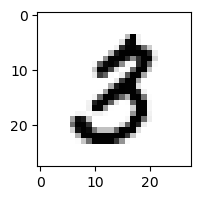

0.005893723054560034% - 0
0.002377289506509295% - 1
0.003191900771194678% - 2
0.12499769958674407% - 3
1.4256732885118765e-06% - 4
0.5576266608353596% - 5 - ОШИБКА
1.2049319762842546e-06% - 6
0.0014424392875259581% - 7
0.3045744284169378% - 8
5.6212912490353626e-06% - 9

 8


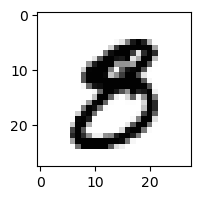

0.006204053275250043% - 0
1.5269325112469348e-05% - 1
2.577747065788705e-11% - 2
0.00019525017765337725% - 3
2.7932311481229863e-06% - 4
3.3212115647212928% - 5 - ОШИБКА
2.1699369343217538e-08% - 6
5.265452509897179e-07% - 7
0.015827299690309698% - 8
4.214085499818824e-07% - 9

 8


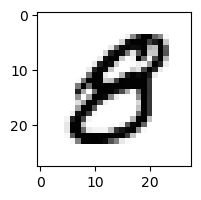

0.46081089657777163% - 0
4.7801171544844795e-06% - 1
9.578831849941222e-09% - 2
4.370004639308547e-06% - 3
0.01514827822024621% - 4
6.3568852363193304% - 5 - ОШИБКА
3.8150762741322785e-05% - 6
5.239559918289507e-08% - 7
0.004432069416496402% - 8
1.6712035767939693e-06% - 9

 3


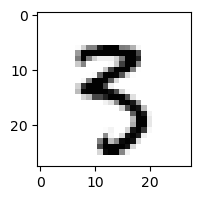

0.00023477288111706268% - 0
6.042703027699569e-05% - 1
9.346255829082786e-08% - 2
21.186336799324597% - 3
0.0074576825463269596% - 4
36.918809843765054% - 5 - ОШИБКА
1.3615856800052174e-05% - 6
0.11260507392396506% - 7
7.231307099239394e-08% - 8
0.00030093412488268486% - 9

 2


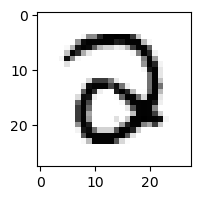

0.7072038779300974% - 0
4.8164342348810044e-08% - 1
0.6367052560303248% - 2
19.176495240356186% - 3 - ОШИБКА
0.010349370833511916% - 4
0.004397255196369093% - 5
0.006477977680977667% - 6
2.9543911144809055e-07% - 7
4.503355522397484e-10% - 8
1.206521702790975e-16% - 9

 9


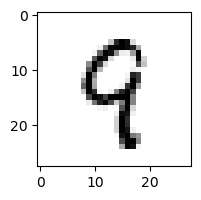

0.0014725047150284814% - 0
0.05525034327615399% - 1
0.1905458931391739% - 2
0.001735394347436629% - 3
12.64262152870031% - 4 - ОШИБКА
4.827967178671059% - 5
0.0910544945854576% - 6
0.03329932661949922% - 7
1.7017317721515106% - 8
4.855490078827405% - 9

 9


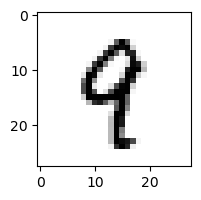

6.065957550690839e-05% - 0
0.5694794554297764% - 1
0.0006602442392699488% - 2
5.915343525939579e-05% - 3
9.171343570704025% - 4 - ОШИБКА
0.6024290265170094% - 5
0.0030894200218166915% - 6
0.07899128386893398% - 7
0.026687843331562634% - 8
7.388363916079234% - 9

 5


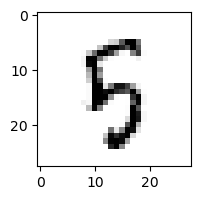

0.061873011434401395% - 0
0.0003532890766124931% - 1
0.17474503618060752% - 2
0.03154909414418639% - 3
12.665765199479594% - 4
76.2081754000628% - 5
3.8065485086975133% - 6
0.000544020045787869% - 7
99.00583748177182% - 8 - ОШИБКА
0.13265948274941144% - 9

 5


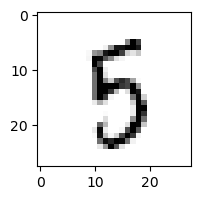

0.10740867730904474% - 0
0.002668855608102422% - 1
0.0035520733212201605% - 2
5.794025902313088% - 3
1.575780128435083% - 4
94.97231509271849% - 5
1.460235463966047% - 6
0.0004566331080372344% - 7
95.09317432018037% - 8 - ОШИБКА
0.9132471587995596% - 9

 8


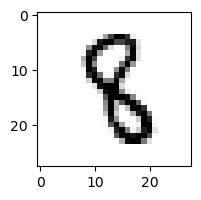

9.207563886122444e-08% - 0
0.12148531049322371% - 1
0.013181612233185883% - 2
0.010381848899888047% - 3
0.13009915255316046% - 4
3.61685190669663% - 5 - ОШИБКА
0.0005011635803429761% - 6
6.317896642803701e-05% - 7
1.9870538720295693e-07% - 8
1.372667638936077e-10% - 9

 8


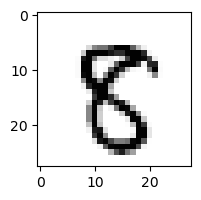

0.05018179023326545% - 0
2.835565145354826e-06% - 1
1.3410042862581395e-06% - 2
0.00013872116603998137% - 3
3.312126616496062e-05% - 4
23.606420212681147% - 5 - ОШИБКА
8.837616722024824e-07% - 6
0.0034128755801077805% - 7
19.497523487643292% - 8
0.00501569505365752% - 9

 8


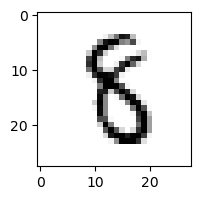

0.0003114369549443314% - 0
0.04401382607619232% - 1
0.0032972999239821743% - 2
0.10008993286048729% - 3
0.016300526504549023% - 4
35.54782739663974% - 5 - ОШИБКА
0.053123124999260155% - 6
0.0004501068784581933% - 7
0.04572795206922848% - 8
4.5163137186350595e-09% - 9

 2


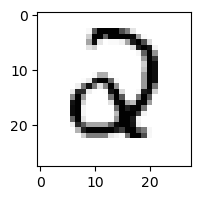

0.003420616738082585% - 0
1.9281858107457833e-05% - 1
0.08283262685224276% - 2
0.0019667261123803618% - 3
0.2278069120036001% - 4
0.009938604402600462% - 5
1.6481096772028012% - 6 - ОШИБКА
4.024237493677653e-05% - 7
3.595785300097174e-10% - 8
1.6249825852796265e-11% - 9

 8


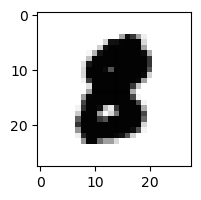

2.158379882213936e-06% - 0
4.946127751306907e-07% - 1
2.604160489525239e-08% - 2
4.341116371009278e-12% - 3
3.8866231656801955e-10% - 4
0.0030650773752688943% - 5 - ОШИБКА
1.1776750718183121e-07% - 6
1.155225432796139e-08% - 7
4.449919100024236e-11% - 8
2.367614484652134e-15% - 9

 9


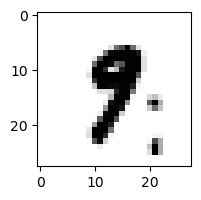

1.2531372833234516e-05% - 0
5.97613167776602% - 1 - ОШИБКА
7.68669889673693e-08% - 2
3.1115230453060283e-05% - 3
0.0003059064234568988% - 4
0.32726888642156904% - 5
5.682539907569001e-05% - 6
1.1567309278247377% - 7
2.1882508329852313e-06% - 8
0.08738634425537022% - 9

 8


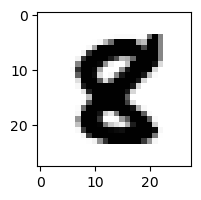

1.1380679552597689e-07% - 0
7.619504682349099e-08% - 1
4.923032414391936e-08% - 2
1.3894764622784589e-13% - 3
1.2307685818557766e-06% - 4
0.07921214453332558% - 5 - ОШИБКА
3.500128966564974e-10% - 6
1.8382270421690553e-10% - 7
6.294696939133638e-05% - 8
9.971252860294388e-16% - 9

 8


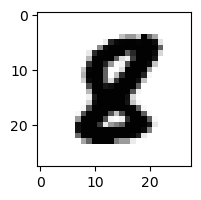

1.936425406806377e-07% - 0
9.955466749796372e-07% - 1
1.1623797079403641e-07% - 2
2.138339096807427e-13% - 3
9.938271038315365e-08% - 4
0.04962224814982277% - 5 - ОШИБКА
1.4731918293955209e-08% - 6
2.0410942710196135e-10% - 7
1.5323226908034746e-05% - 8
4.2159567815105855e-17% - 9

 9


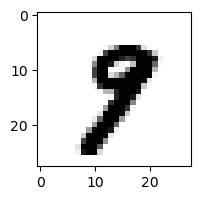

4.140933744698529e-06% - 0
0.004942407404261033% - 1
5.444870168398238e-09% - 2
7.605198964085697e-06% - 3
0.00012670231518496173% - 4
0.016548977368703803% - 5
8.820237583857863e-08% - 6
3.2838329843687006% - 7 - ОШИБКА
0.0008031284925030078% - 8
0.14634795465818246% - 9

 8


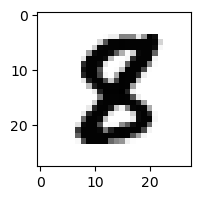

7.220098559178034e-07% - 0
1.534216204208692e-05% - 1
3.563482616367755e-07% - 2
6.242240559815602e-09% - 3
1.1791093381506165e-06% - 4
0.7577848931551985% - 5 - ОШИБКА
1.3966443816987264e-07% - 6
9.441997001202036e-09% - 7
0.00010691012014267664% - 8
2.8989799310684506e-17% - 9

 8


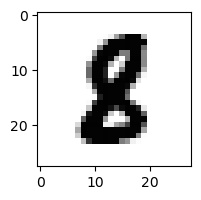

5.893040949760342e-07% - 0
0.0001562116912578731% - 1
2.65391944750729e-06% - 2
1.3116188898731627e-09% - 3
7.426649313354696e-08% - 4
0.11399622862021128% - 5 - ОШИБКА
2.3367758176460164e-06% - 6
6.5694568410321e-09% - 7
0.003529730330036511% - 8
6.305617038360475e-15% - 9

 8


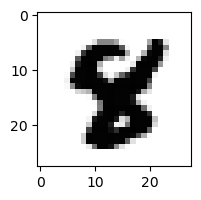

3.4903918346537763e-11% - 0
2.524966336665469e-09% - 1
8.796866201642827e-15% - 2
1.961387494350051e-14% - 3
0.0002833445825916943% - 4
1.070587584632105% - 5 - ОШИБКА
1.7555549514540393e-09% - 6
2.540094146455495e-07% - 7
3.0531267580783e-07% - 8
6.2862515534515825e-15% - 9

 9


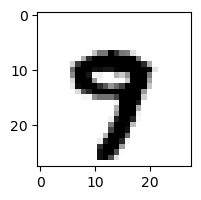

7.136173903446667e-07% - 0
8.62019884173616e-07% - 1
4.4949139021423405e-12% - 2
6.157351580929991e-10% - 3
0.001161431594383759% - 4
0.04960537631462555% - 5
2.6554463341715697e-06% - 6
7.6361405449178354% - 7 - ОШИБКА
3.230542113356786e-10% - 8
0.025023088724389755% - 9

 8


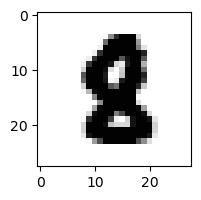

9.672317464610122e-09% - 0
5.437121853419897e-07% - 1
1.5323564454785036e-07% - 2
1.3628495943923233e-12% - 3
4.971807607032892e-07% - 4
0.013995591815504823% - 5 - ОШИБКА
1.3836039277181223e-07% - 6
2.141809928662111e-08% - 7
7.191051317933826e-08% - 8
3.242736530619268e-13% - 9

 5


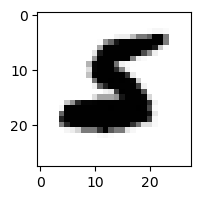

3.5112256129038e-08% - 0
6.7470851813673324e-06% - 1
0.004004300950001847% - 2
2.630859350640277e-14% - 3
2.1470546734316544e-08% - 4
0.003450989560370985% - 5
0.08279610558716632% - 6 - ОШИБКА
9.705245891241842e-09% - 7
4.48685477985488e-15% - 8
6.471656805528683e-16% - 9

 3


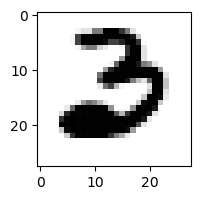

0.35729654629424124% - 0 - ОШИБКА
9.63200991507183e-07% - 1
0.160695749543353% - 2
0.00010450794929018581% - 3
2.523480872495906e-13% - 4
7.316191353563884e-10% - 5
0.001695767804160217% - 6
3.2873162558104984e-06% - 7
2.016217612781662e-14% - 8
2.200307456066323e-21% - 9

 8


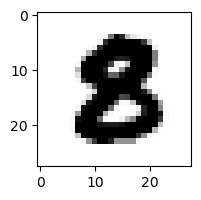

1.1027816492880925e-05% - 0
1.0837892928605655e-09% - 1
7.497131466758854e-09% - 2
1.3171719844673726e-09% - 3
4.885220078915536e-11% - 4
0.025720971130830852% - 5 - ОШИБКА
5.034915521129169e-09% - 6
1.0679003364554855e-10% - 7
1.944148841122994e-08% - 8
3.056815089590543e-18% - 9

 8


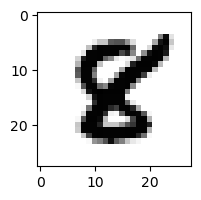

1.9445754467146874e-07% - 0
1.3330065091030225e-06% - 1
1.6061814792259548e-07% - 2
5.676791098838839e-11% - 3
1.1897693736083839e-05% - 4
1.1745337013908093% - 5 - ОШИБКА
7.928010991176187e-09% - 6
4.173142384532501e-08% - 7
0.020134481166661423% - 8
1.6855805081147336e-14% - 9

 3


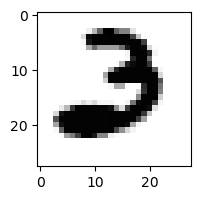

0.09892120155433314% - 0
2.026135364063549e-06% - 1
26.888042008641683% - 2 - ОШИБКА
7.062544429847655e-05% - 3
1.9293757495336937e-11% - 4
8.726784297663782e-09% - 5
2.5313728702977865e-05% - 6
9.333476970599433e-05% - 7
2.216256170336789e-15% - 8
5.008952013687939e-20% - 9

 8


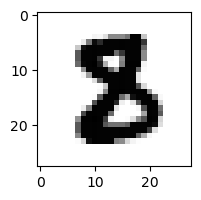

1.0040191460765644e-07% - 0
3.899719099278854e-07% - 1
1.2595450696201883e-05% - 2
1.4949254006970456e-07% - 3
8.552087780836762e-12% - 4
0.08202820473743605% - 5 - ОШИБКА
4.907230854633644e-07% - 6
1.8549084582415388e-08% - 7
3.4285290518700483e-10% - 8
4.033827591416805e-23% - 9

 5


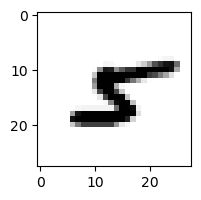

0.00013632621375649155% - 0
0.2559249195270838% - 1
0.00038313625880930804% - 2
2.5547128354652705e-06% - 3
0.031016281763458504% - 4
0.12301182099289248% - 5
0.11482074312473514% - 6
0.01058147931867725% - 7
95.52538514792106% - 8 - ОШИБКА
1.330536287328451e-06% - 9

 3


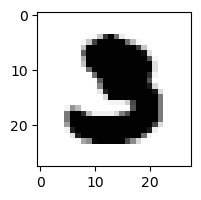

2.617902842991537e-06% - 0
9.374108229017687e-10% - 1
1.2300900402208954e-06% - 2
0.004392157416034605% - 3
1.5292856201189536e-15% - 4
0.01576304391068903% - 5 - ОШИБКА
9.396995526719579e-12% - 6
5.017278526755182e-07% - 7
3.585522494353144e-18% - 8
2.9745034081023174e-24% - 9

 5


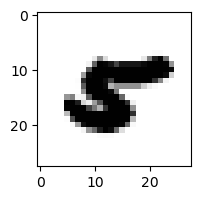

7.697285859881143e-05% - 0
6.722129016180451e-05% - 1
1.1499340369474761e-08% - 2
3.449059114537779e-16% - 3
0.005674456826497595% - 4 - ОШИБКА
5.732722635056147e-06% - 5
0.0008146478066360953% - 6
7.002729495599498e-05% - 7
0.00030816597401872803% - 8
5.039972933638703e-09% - 9

 8


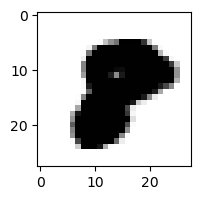

4.678246324953183e-06% - 0 - ОШИБКА
1.196653525665542e-10% - 1
8.674421763224871e-14% - 2
7.999155672032697e-19% - 3
1.5130969505909149e-10% - 4
1.0405365031108589e-07% - 5
6.351087668488996e-12% - 6
4.5331390499056674e-08% - 7
1.3178303388710424e-08% - 8
2.81434505506507e-18% - 9

 3


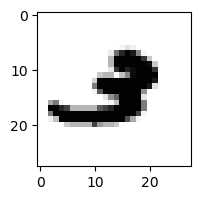

1.4883754412656074e-05% - 0
0.0017551480480869357% - 1
0.002044647332748507% - 2
1.1169073604075809e-06% - 3
0.0021129828408868187% - 4
2.1280577722567178e-07% - 5
6.861525371246872e-05% - 6
0.023982361806872854% - 7 - ОШИБКА
9.079000693016518e-07% - 8
0.012680118787671951% - 9

 5


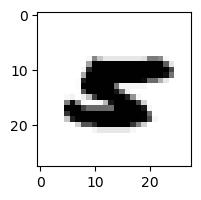

2.2694372538427188e-06% - 0
8.301391765943646e-06% - 1
4.1966207301965295e-09% - 2
1.3847300074712446e-14% - 3
0.0003866127419841514% - 4 - ОШИБКА
2.6749991410036867e-06% - 5
0.00016565993810729006% - 6
6.268298847733566e-05% - 7
1.8942044092625336e-07% - 8
2.3783478241706377e-10% - 9

 8


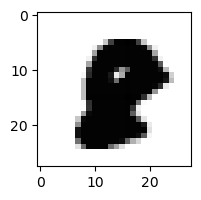

1.6981984779704453e-07% - 0 - ОШИБКА
1.613919470236179e-09% - 1
1.5883005387973084e-13% - 2
4.800378289039627e-17% - 3
4.190057274344623e-10% - 4
7.905856491324531e-08% - 5
2.5028759831425925e-10% - 6
1.4764234719096476e-08% - 7
2.150346229242889e-09% - 8
4.399482047675751e-17% - 9

 9


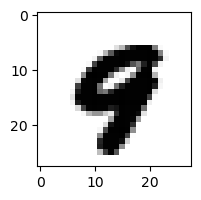

7.926444886680651e-07% - 0
8.885208376462003e-09% - 1
5.4505341315784257e-14% - 2
5.606022590966701e-16% - 3
0.12439368803646102% - 4 - ОШИБКА
1.6242518283083722e-05% - 5
1.1152305015114223e-06% - 6
0.007059200286896658% - 7
1.5900020012431404e-12% - 8
0.001217620710636849% - 9

 2


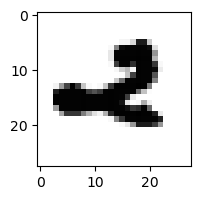

0.00020544450165568514% - 0
9.615380497339987e-05% - 1
0.039149372185270495% - 2
7.029587884704313e-08% - 3
0.24057340738434432% - 4
1.3022294652537624e-08% - 5
5.506720587227254e-06% - 6
3.000903312933306e-07% - 7
4.20510390189567e-11% - 8
2.020597349646996% - 9 - ОШИБКА

 3


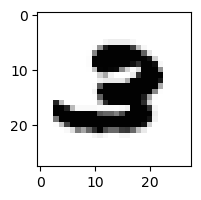

1.8906102943857345e-05% - 0
1.5687105924603001e-07% - 1
0.19151047462815857% - 2 - ОШИБКА
3.281062393910286e-06% - 3
6.415201057265094e-11% - 4
8.533634071268819e-06% - 5
2.402629723090103e-05% - 6
9.6828442200753e-05% - 7
1.0115973089785838e-10% - 8
2.2741545905824266e-09% - 9

 5


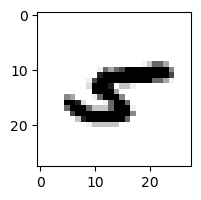

0.0021997038649174995% - 0
0.14547566791119845% - 1
0.0003367375968347423% - 2
1.910172668250994e-08% - 3
9.779563177220286% - 4
1.056503806469517e-07% - 5
0.9235257950315245% - 6
0.00289395108355725% - 7
91.1730020344986% - 8 - ОШИБКА
0.0016419283334574944% - 9

 8


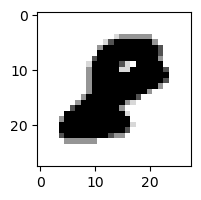

4.821547284153928e-05% - 0 - ОШИБКА
1.740853810989042e-07% - 1
1.554897244712833e-07% - 2
3.024365442334853e-16% - 3
1.9924106528429584e-10% - 4
1.4709009188207622e-07% - 5
3.9015306255239904e-09% - 6
3.81325919673884e-10% - 7
2.0833859253724762e-09% - 8
1.1536573945821246e-15% - 9

 9


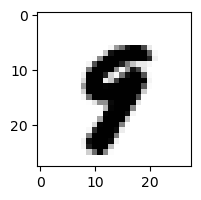

5.513228250830517e-08% - 0
0.000112934619515948% - 1
1.7913358693073318e-11% - 2
4.701677700785271e-10% - 3
0.0026419245787993708% - 4
0.17595483078166677% - 5 - ОШИБКА
5.423028677154718e-06% - 6
0.004331077314182314% - 7
3.178089538759254e-09% - 8
0.030908708076905402% - 9

 5


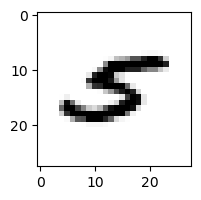

0.005331532529175834% - 0
0.01747367332969724% - 1
3.053340466448539e-05% - 2
6.435048560833406e-08% - 3
4.62134229238283% - 4 - ОШИБКА
0.02618883027247209% - 5
3.581302706283615e-05% - 6
1.9236423699164555% - 7
0.0013069044804946343% - 8
0.00015886609582253577% - 9

 8


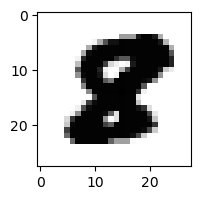

4.420730930229239e-09% - 0
2.5721525227936462e-11% - 1
4.605742437869451e-10% - 2
3.9428752013192786e-17% - 3
2.2339104581054846e-10% - 4
0.054028398461255685% - 5 - ОШИБКА
1.2746081212766039e-12% - 6
4.208520527215949e-12% - 7
2.401872575440782e-08% - 8
1.9045566824733395e-23% - 9

 8


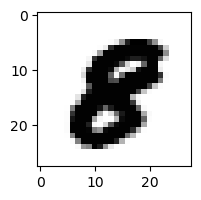

6.8659502448921175e-06% - 0
5.342117994640145e-09% - 1
2.958373140722424e-10% - 2
1.152938295198173e-14% - 3
5.718865160785824e-07% - 4
5.644156358878282e-05% - 5 - ОШИБКА
2.5255197908475936e-09% - 6
5.830392153891939e-10% - 7
3.0415281823798543e-05% - 8
1.3754593469147925e-12% - 9

 3


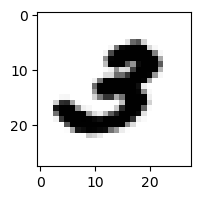

0.0019631460373355967% - 0
9.291968862176144e-06% - 1
0.033418464142028245% - 2 - ОШИБКА
0.008477234832454895% - 3
2.5324783771444885e-07% - 4
0.001001349395738491% - 5
1.25726808557481e-07% - 6
0.00021568591935014665% - 7
1.18494241509819e-10% - 8
1.3253110690292271e-08% - 9

 2


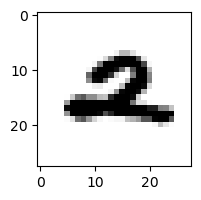

0.0003776418165296334% - 0
0.00010190238156691537% - 1
0.10102387756471719% - 2
2.993514458061388e-11% - 3
0.11569929298758626% - 4 - ОШИБКА
4.490865179982793e-07% - 5
0.005349278990826885% - 6
0.02141798529291905% - 7
1.4884988036979307e-07% - 8
0.008226400687344497% - 9

 2


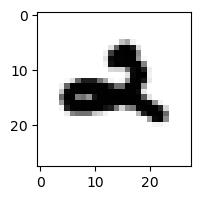

0.03314164741363509% - 0
2.0000962963583803e-05% - 1
1.6311212242459512e-05% - 2
1.278613071495849e-05% - 3
77.52244701811264% - 4
4.887545669703671e-07% - 5
0.006731199859256268% - 6
1.1206320454668983e-05% - 7
2.3952611921492435e-13% - 8
99.18921863448233% - 9 - ОШИБКА

 5


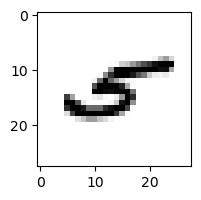

0.004936943816750474% - 0
0.7509109844549969% - 1
0.009196907268622418% - 2
8.64403869654321e-06% - 3
79.73049782041608% - 4 - ОШИБКА
0.0003120188233803031% - 5
0.0038438580047817123% - 6
0.08649568098879418% - 7
41.83262129198994% - 8
0.013381542107203189% - 9

 3


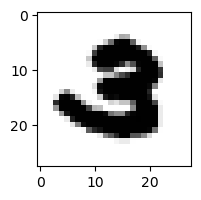

3.2337601454601413e-05% - 0
3.3724329734779e-09% - 1
0.0023834229063158007% - 2 - ОШИБКА
1.5596248965233843e-07% - 3
5.134343491173987e-11% - 4
4.1839719328483793e-07% - 5
4.4204271802566914e-07% - 6
4.346751323486362e-08% - 7
6.009064701179412e-14% - 8
1.2601158512484676e-15% - 9

 2


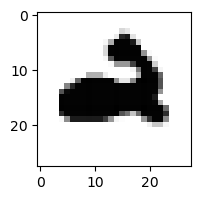

0.0048372523574567936% - 0
5.296844819461727e-09% - 1
1.1228334393466818e-06% - 2
5.3741640782598935e-12% - 3
1.0052630808248604% - 4 - ОШИБКА
3.8381441577361463e-10% - 5
0.0017066690231304271% - 6
2.068226121709084e-09% - 7
2.557340920936467e-15% - 8
0.0029240234520509986% - 9

 5


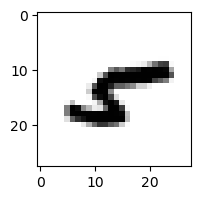

0.005622348372858264% - 0
0.43255151265897% - 1
0.01691622112565694% - 2
2.9628761085728705e-07% - 3
0.5710278806396952% - 4
3.516738329543756e-06% - 5
4.07736925654168% - 6
0.0011113527450530433% - 7
98.32523304952558% - 8 - ОШИБКА
0.0019436618829483138% - 9

 8


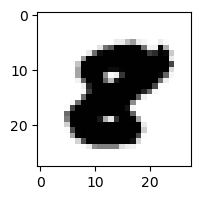

3.812988736675825e-07% - 0
1.2278995040971753e-10% - 1
2.1201366447975045e-12% - 2
3.9051441506898396e-21% - 3
1.494039557753451e-09% - 4
2.7280655674245075e-05% - 5 - ОШИБКА
1.053242510901639e-13% - 6
1.0904860694290392e-08% - 7
4.010662074031459e-07% - 8
5.809832816803386e-17% - 9

 8


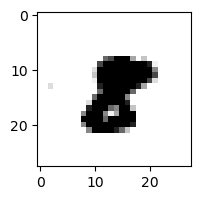

5.570986805885659e-07% - 0
2.4327992007456807% - 1 - ОШИБКА
6.5446027562430614e-06% - 2
4.300963217142744e-09% - 3
4.0790739831223005e-05% - 4
9.442432846825233e-06% - 5
0.22869628186887975% - 6
0.001350409557353611% - 7
0.014725305261491682% - 8
2.7508020217379018e-05% - 9

 8


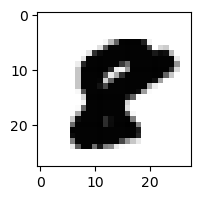

5.236128834176963e-07% - 0
3.1174381608815363e-09% - 1
1.6594267556772325e-13% - 2
5.610087982346567e-20% - 3
2.0303032171617695e-10% - 4
0.003330611499830705% - 5 - ОШИБКА
1.113658258528412e-12% - 6
3.058933228248134e-09% - 7
0.0006688769160895154% - 8
2.549127448002057e-17% - 9

 2


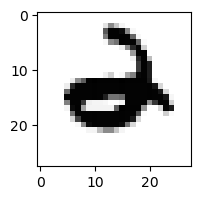

0.0017629755513239637% - 0
6.501105758417564e-07% - 1
2.640339028115202e-07% - 2
1.3192310310347711e-09% - 3
13.464166612266101% - 4
1.1856534437753224e-06% - 5
36.304081888868694% - 6 - ОШИБКА
2.783688766954208e-07% - 7
6.897354226808239e-17% - 8
5.276212228066731e-10% - 9

 9


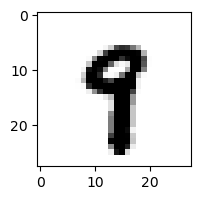

4.995457974313685e-08% - 0
0.007490032625404844% - 1
5.085036481326827e-10% - 2
3.498822113755397e-07% - 3
0.03703380096905828% - 4
1.221576936271414% - 5 - ОШИБКА
2.802808635535352e-06% - 6
0.04414883495484394% - 7
7.98017643909324e-05% - 8
1.0156295792348649% - 9

 9


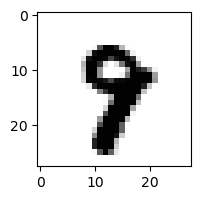

4.2746699837508167e-08% - 0
2.191481280738566e-05% - 1
2.1315936456939298e-09% - 2
4.0728222037832155e-09% - 3
0.002765345556901051% - 4
0.0017809631648898654% - 5
0.00012016489235380571% - 6
0.09537286960451298% - 7 - ОШИБКА
0.0007724901469508089% - 8
0.030205590204786352% - 9

 8


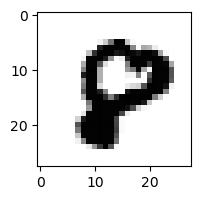

1.30843955153313% - 0 - ОШИБКА
1.3163329125767755e-10% - 1
1.3580634192455524e-07% - 2
1.2809684395288046e-15% - 3
4.742463383853628e-05% - 4
5.0507958903674864e-05% - 5
4.076757591862923e-07% - 6
0.0013063103600053237% - 7
9.73315029854503e-05% - 8
1.1694702573770309e-11% - 9

 9


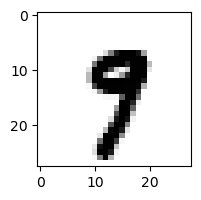

4.340424415442071e-06% - 0
0.0006106543086514087% - 1
1.9664362701018728e-10% - 2
9.023692999164044e-05% - 3
0.003637821868471842% - 4
0.10683082740334889% - 5
2.4972025598255324e-06% - 6
2.2389940598439786% - 7 - ОШИБКА
3.549082044022116e-05% - 8
1.8956067608790939% - 9

 3


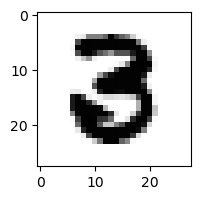

0.0015401374955501916% - 0 - ОШИБКА
1.066535005648791e-07% - 1
0.0008276046593449725% - 2
0.0008303890449842444% - 3
2.1600912333521563e-08% - 4
7.474826781747273e-06% - 5
5.484999836009134e-07% - 6
1.414841819876698e-08% - 7
1.0010790807896407e-11% - 8
6.448942096771838e-20% - 9

 8


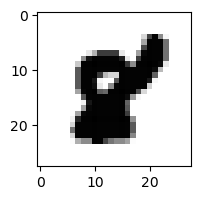

5.024673255977594e-07% - 0
3.0452129785915904e-05% - 1
5.868449963455653e-12% - 2
3.755349615730228e-21% - 3
3.2191049103783917e-06% - 4
0.012878365527652695% - 5 - ОШИБКА
1.5219321730805775e-08% - 6
9.318117840693524e-06% - 7
1.0135837642559932e-08% - 8
1.5940515357152548e-14% - 9

 8


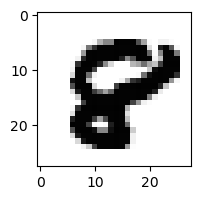

1.1645507651469345e-05% - 0
2.1862066604278692e-11% - 1
3.3742120570379524e-09% - 2
1.453747866741722e-21% - 3
2.3166154933153685e-07% - 4
0.0006931501256683193% - 5 - ОШИБКА
2.1472552722625107e-09% - 6
2.7491575812736304e-08% - 7
8.146205490115173e-05% - 8
4.1997906133104426e-16% - 9

 1


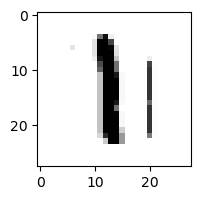

3.728988940534557e-05% - 0
5.797827572638715% - 1
0.020098219057424746% - 2
0.001995012271758012% - 3
0.0022362138604114313% - 4
9.688880521075733% - 5 - ОШИБКА
1.6166956426563843% - 6
0.004209392287163877% - 7
2.6367396696490837% - 8
0.00014708416215918348% - 9

 9


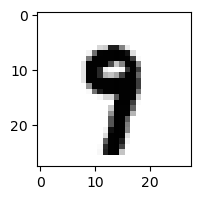

1.2884691521422294e-08% - 0
0.0005018688772057316% - 1
3.1169438631222803e-10% - 2
1.2125024067381582e-07% - 3
0.018965161327395987% - 4
0.8112810476200365% - 5 - ОШИБКА
3.415891686514027e-05% - 6
0.1085438467508272% - 7
1.0203715560287388e-05% - 8
0.09274337299271235% - 9

 9


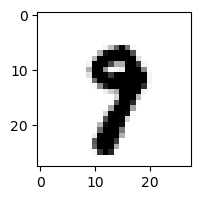

6.901061294678553e-07% - 0
0.002471365763579035% - 1
1.1596172419248318e-09% - 2
1.677822571997386e-06% - 3
0.000185207721015286% - 4
0.04677911115034782% - 5
1.7689417557349502e-05% - 6
3.120325967941491% - 7 - ОШИБКА
3.739434716684911e-05% - 8
0.020443764394424375% - 9

 2


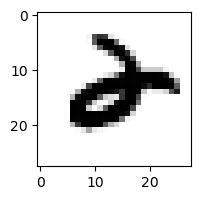

0.0017875234396058342% - 0
7.359767293032218e-05% - 1
0.058477603844553826% - 2
6.599008930156111e-10% - 3
0.014922951292239674% - 4
5.680041621071475e-12% - 5
0.2434982351202182% - 6 - ОШИБКА
3.0609939574144695e-07% - 7
8.003681037238907e-11% - 8
0.00013333830261422967% - 9

 8


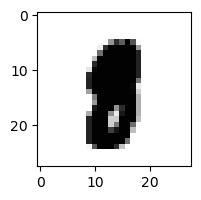

4.2890018900121294e-08% - 0
0.00018878082886509813% - 1
2.0046999809704403e-11% - 2
4.193668862716844e-11% - 3
6.89514716704367e-08% - 4
0.023857167120741395% - 5 - ОШИБКА
2.572430062044157e-06% - 6
4.987527014626103e-06% - 7
1.838573683005151e-06% - 8
9.988543184855542e-11% - 9

 9


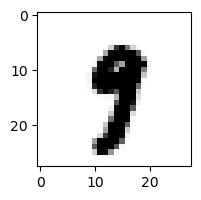

3.4450984384262945e-07% - 0
0.006261714931660234% - 1
1.0115565296231862e-11% - 2
0.00012749935316735015% - 3
0.0004254831393965598% - 4
0.15224086456733063% - 5
3.4669470419193656e-07% - 6
0.7582519835318862% - 7 - ОШИБКА
2.65907003530031e-07% - 8
0.0036836616740632093% - 9

 8


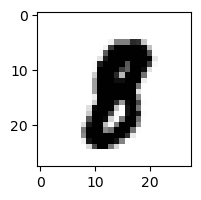

2.3384382574594016e-06% - 0
0.0006214950646069799% - 1
2.5392320716958986e-09% - 2
1.424620483962958e-07% - 3
1.7251070972751148e-08% - 4
0.006620981451840411% - 5 - ОШИБКА
1.0551254522499529e-07% - 6
1.569556057818478e-05% - 7
0.00011060522240573539% - 8
2.4001377955187895e-10% - 9

 4


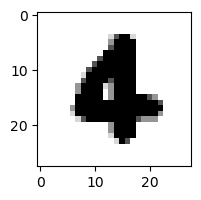

1.589723177238247e-08% - 0
1.6608595120038018e-05% - 1
2.3779900966597454e-09% - 2
2.286091791972615e-15% - 3
0.00014726984269964257% - 4
1.2383870929137008e-05% - 5
0.054794741891392475% - 6 - ОШИБКА
5.389328800479886e-07% - 7
2.952962016636456e-20% - 8
1.0945987373984824e-11% - 9

 2


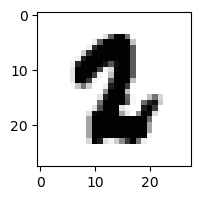

4.2000815123934337e-10% - 0
0.0028986269907392177% - 1
7.170431781818121e-06% - 2
2.6485794387462187e-11% - 3
3.409814324667514e-11% - 4
0.05065322186189475% - 5 - ОШИБКА
4.399948236749695e-05% - 6
4.547694905516511e-06% - 7
4.995698846320193e-11% - 8
2.241494688244047e-16% - 9

 9


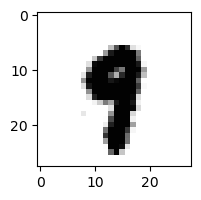

4.9989281726524685e-09% - 0
0.0020025127897672977% - 1
2.5017052209866387e-12% - 2
5.137035144219053e-08% - 3
0.006053368849862383% - 4
0.16643135808383824% - 5 - ОШИБКА
5.838712254379965e-06% - 6
0.012678156181858026% - 7
9.526331793700813e-09% - 8
0.01141514621127739% - 9

 2


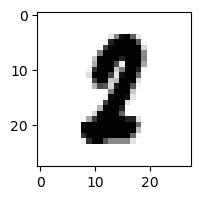

1.2134426968240572e-06% - 0
0.1449949832848358% - 1
3.7143009851657976e-06% - 2
1.209975961638013e-09% - 3
8.074679567081755e-09% - 4
0.23826838708841153% - 5 - ОШИБКА
4.668419582646905e-06% - 6
0.00034060113447946386% - 7
6.41191954401671e-07% - 8
4.848510055647689e-13% - 9

 4


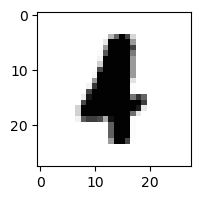

1.5494275602384446e-08% - 0
0.05303152823749749% - 1 - ОШИБКА
3.557818807349683e-05% - 2
5.4931442182270873e-11% - 3
0.001631123811057302% - 4
0.00013705099938239994% - 5
0.01625246458300085% - 6
2.209330225037676e-06% - 7
3.772423731870158e-09% - 8
4.081839847236011e-07% - 9

 8


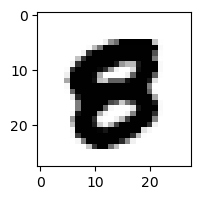

0.001048412468017368% - 0
1.3212624554102551e-12% - 1
5.992349925733487e-13% - 2
5.792139412592122e-14% - 3
2.3880311605256014e-08% - 4
0.01172012672277692% - 5 - ОШИБКА
1.2980832206171136e-08% - 6
2.0909263038314595e-10% - 7
5.2691868085489136e-11% - 8
1.0576986219194899e-14% - 9

 8


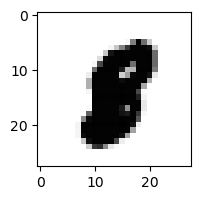

1.7267076035495607e-07% - 0
2.799473184517869e-05% - 1
4.724028720623164e-11% - 2
1.92276712849576e-12% - 3
3.551416962090101e-08% - 4
0.0011137948802840399% - 5 - ОШИБКА
4.775105045045665e-07% - 6
6.341936969608478e-06% - 7
5.269576915719744e-08% - 8
1.7998643371788406e-11% - 9

 9


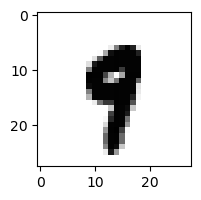

2.8885506189557774e-08% - 0
0.0055264222585852864% - 1
4.508257405961802e-10% - 2
8.742772528426705e-08% - 3
0.017724714458662208% - 4
0.2249451224413041% - 5 - ОШИБКА
1.3336597258141697e-05% - 6
0.031104591440361096% - 7
4.237914838743645e-08% - 8
0.20298557643039783% - 9

 3


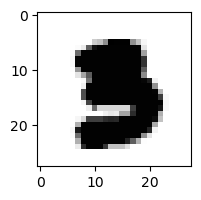

4.4140998208786775e-09% - 0
7.434401810212975e-11% - 1
2.0486803009203288e-13% - 2
2.9937714639915585e-08% - 3
4.309036535234239e-11% - 4
0.1815373635417259% - 5 - ОШИБКА
1.910628970361387e-09% - 6
3.714667503056407e-08% - 7
7.100179449001486e-21% - 8
1.0570024936735612e-22% - 9

 2


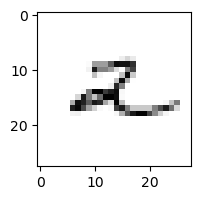

0.33586246700814065% - 0
8.865056437199584% - 1
69.20631511195606% - 2
0.190744219008662% - 3
85.3406955299433% - 4 - ОШИБКА
0.3935767865932834% - 5
7.141592829702159% - 6
0.10698005447726405% - 7
0.0019396092879097496% - 8
60.74431589352347% - 9

 9


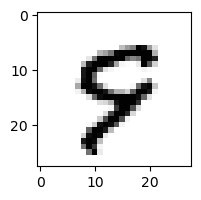

0.007118415636114922% - 0
8.539010363432223e-06% - 1
3.13755403239893e-05% - 2
4.715705911847485e-08% - 3
1.4081416605621535% - 4
80.24314796961298% - 5 - ОШИБКА
0.0014571552423036046% - 6
0.9238053428182483% - 7
2.417852268423335e-08% - 8
6.8553588796485485% - 9

 8


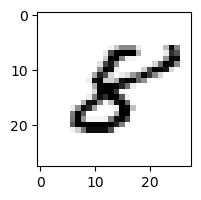

0.00534818985781688% - 0
0.0022765112819629293% - 1
0.03312442859091476% - 2
4.988417046523859e-05% - 3
0.00468167658366103% - 4
56.45558155124372% - 5 - ОШИБКА
0.3632526366294638% - 6
9.777657632126864e-05% - 7
44.36790883995473% - 8
0.3427345573223135% - 9

 7


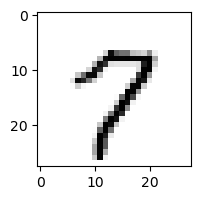

1.4283515854434297% - 0
0.011748759815363576% - 1
0.0014935051655286782% - 2
9.025314174174556e-05% - 3
0.15333278647133014% - 4
2.0926752129016433% - 5
0.0034016224964991907% - 6
92.58226430359191% - 7
3.4325094948351618% - 8
98.91522158077971% - 9 - ОШИБКА

 8


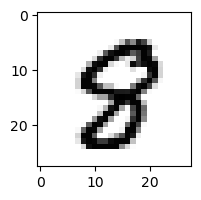

0.0011974720163366085% - 0
2.5224181261831405e-06% - 1
9.953081471803982e-08% - 2
1.193374901642966e-09% - 3
0.0007012077508827349% - 4
1.4491917124926257% - 5 - ОШИБКА
1.212973954944855e-06% - 6
0.002263963695240425% - 7
0.0007122340197451412% - 8
4.065039960596609e-06% - 9

 9


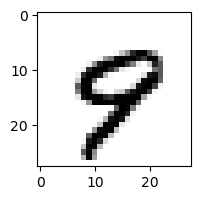

0.009889744544229558% - 0
3.6909258315525385e-05% - 1
2.347898442922779e-08% - 2
1.7531793665292547e-10% - 3
1.7822447099259398% - 4
0.06031821901467628% - 5
0.0010861820797800495% - 6
9.260570025977895% - 7 - ОШИБКА
1.7694582594611104e-08% - 8
3.1606027559950185% - 9

 1


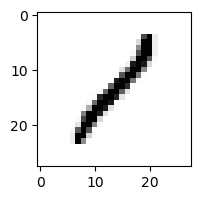

0.4426230197080748% - 0
89.34284822540567% - 1
24.096930423421497% - 2
2.2477558368944566% - 3
0.24300005885062262% - 4
0.1403161748118312% - 5
0.11677670129245635% - 6
0.01194688696729616% - 7
99.18772764129129% - 8 - ОШИБКА
0.5240585914448562% - 9

 3


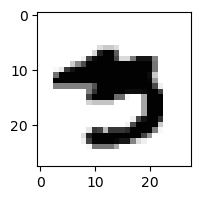

6.599901005467715e-06% - 0
1.1909128046777686e-06% - 1
1.1647501524541008e-18% - 2
3.5086620928971084e-06% - 3
9.925903505043924e-06% - 4
1.4884790907827306% - 5 - ОШИБКА
4.74132231459426e-09% - 6
0.00014770514589399958% - 7
3.4120147412104317e-09% - 8
2.2066772496214048e-08% - 9

 3


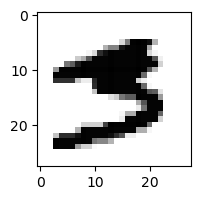

4.418376637836375e-05% - 0
6.85178362594911e-07% - 1
6.286974696341164e-15% - 2
0.03688761238007287% - 3
1.292442634615437e-10% - 4
17.492190271794293% - 5 - ОШИБКА
2.8692693868773877e-09% - 6
0.002082489454447785% - 7
3.6069899135074903e-16% - 8
2.1492441379984157e-14% - 9

 2


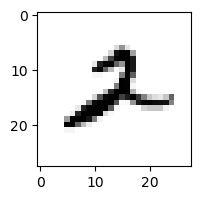

0.014805287023010826% - 0
1.144470664928288% - 1
63.65315198367747% - 2
0.0011786837261990508% - 3
0.1140732371473443% - 4
0.0016410352352950516% - 5
1.0836785522571173% - 6
0.32911947318708096% - 7
1.8885929479210195% - 8
78.17887052493008% - 9 - ОШИБКА

 3


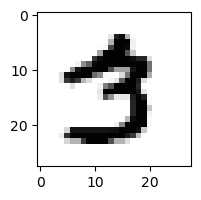

0.004122843885934618% - 0
0.00010942028332429098% - 1
8.752703533059009e-08% - 2
0.005140559581758782% - 3
1.5929037144111024e-08% - 4
0.7793857706122264% - 5 - ОШИБКА
1.5352060070728317e-08% - 6
0.007524283956113963% - 7
1.4158798713587758e-06% - 8
5.635419679689091e-07% - 9

 1


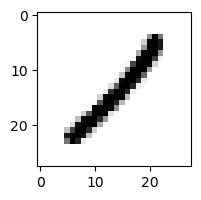

0.009907516908219564% - 0
92.25166265499819% - 1
9.504052865529673% - 2
0.018079883216368265% - 3
0.3008613853597767% - 4
0.033926303390883664% - 5
0.003538800331026336% - 6
0.05047447927751864% - 7
96.77433748997129% - 8 - ОШИБКА
0.00033339734245251863% - 9

 3


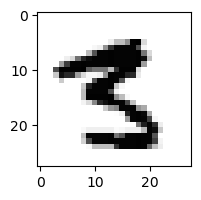

4.453138957968382e-06% - 0
2.920080193190364e-06% - 1
1.7640240015819745e-08% - 2
1.5520122187359633e-05% - 3
1.2866781985655391e-06% - 4
53.808549311284025% - 5 - ОШИБКА
3.3356471925775006e-12% - 6
2.0017299176149784e-05% - 7
4.949533654909626e-07% - 8
4.947521840728375e-09% - 9

 9


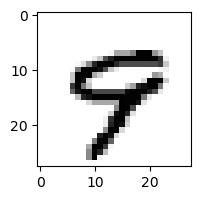

0.0018382359097110644% - 0
4.932876764690902e-06% - 1
4.222116924562609e-09% - 2
4.352129512242258e-11% - 3
2.615551793823523% - 4 - ОШИБКА
0.5078770613552611% - 5
0.0001077204057904338% - 6
1.8207244042729502% - 7
1.1416934018038732e-08% - 8
1.504120226783328% - 9

 3


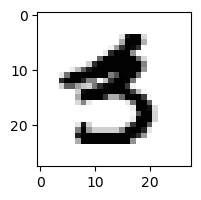

0.0005672754061106058% - 0
0.00015803121798399722% - 1
5.492004707301498e-13% - 2
2.9067302987418844e-05% - 3
7.212103847841091e-06% - 4
32.09448694185406% - 5 - ОШИБКА
9.30921724136878e-08% - 6
3.774955216673239e-06% - 7
9.07317775007669e-13% - 8
4.521805221210251e-08% - 9

 8


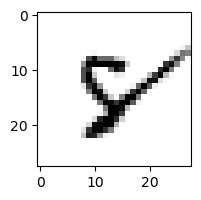

0.005620247166269563% - 0
0.00896999811198503% - 1
0.07206646010646718% - 2
6.900949391243041e-10% - 3
3.490728287526095% - 4
8.798592550465187% - 5
10.601044605254534% - 6 - ОШИБКА
4.0986688131176106% - 7
0.0015279649759735105% - 8
0.021253226754131768% - 9

 3


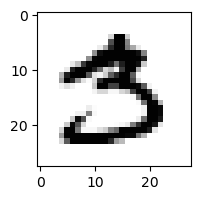

0.06940911969531299% - 0
7.035255623203388e-05% - 1
5.009343434864097e-08% - 2
3.4595451302825415% - 3
1.9545987269081322e-09% - 4
57.0391284961234% - 5 - ОШИБКА
2.18602549383559e-09% - 6
8.780701487338323e-05% - 7
8.984146297392225e-10% - 8
2.3039244976896757e-09% - 9

 2


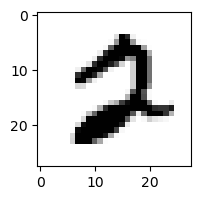

1.8291271634378155% - 0 - ОШИБКА
4.131990161302179e-07% - 1
0.15468147744611113% - 2
4.1607595897500097e-10% - 3
1.0018828751675766e-08% - 4
0.1641346430081645% - 5
0.0001125284649700716% - 6
0.29288057169569726% - 7
5.6125310577651445e-09% - 8
9.288427771190149e-08% - 9

 3


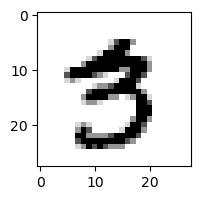

0.0026309350779113675% - 0
3.580652345857962e-05% - 1
8.867686844304899e-09% - 2
0.0008579800994644388% - 3
1.8138772853334752e-06% - 4
4.224893074290517% - 5 - ОШИБКА
6.0399741349737446e-09% - 6
0.003273353100775169% - 7
5.636871985573132e-07% - 8
1.8282287733139286e-06% - 9

 8


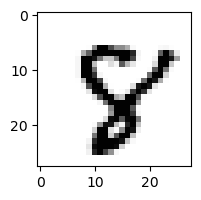

1.9178222670090677e-05% - 0
1.4265200671703564e-08% - 1
2.221321712976288e-07% - 2
4.0501389684005563e-10% - 3
0.01986219150458214% - 4
18.608921555299347% - 5 - ОШИБКА
4.400168006085883e-05% - 6
0.08810536907785499% - 7
0.14608417603202806% - 8
1.834551426230717e-05% - 9

 3


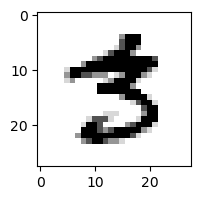

0.0029954722646756337% - 0
0.00011979813240818788% - 1
5.013323078546855e-08% - 2
0.0017960870408049738% - 3
8.076011447825332e-09% - 4
13.16218792173402% - 5 - ОШИБКА
2.8986996881647407e-08% - 6
0.0014235291704942606% - 7
2.7138366180786125e-08% - 8
1.6166531281515592e-10% - 9

 8


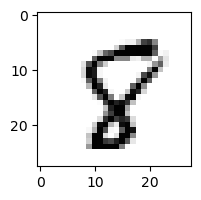

0.005817939174606393% - 0
9.780303596197866e-05% - 1
0.0001353286248452944% - 2
4.789038498228884e-09% - 3
0.18006679862688763% - 4
14.277411327366494% - 5 - ОШИБКА
0.0006290093270382187% - 6
0.035011604916212344% - 7
8.104826575186692% - 8
0.0009414422480552209% - 9

 3


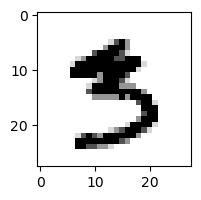

5.698297387169553e-05% - 0
9.558835822953784e-05% - 1
1.0022888019925677e-11% - 2
0.04347018108951674% - 3
2.2088633860159192e-06% - 4
78.61601683568759% - 5 - ОШИБКА
8.510919976976085e-08% - 6
0.0017041962357414477% - 7
9.048849771183768e-09% - 8
2.6960655969736746e-09% - 9

 2


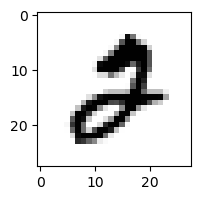

4.180964874576902% - 0 - ОШИБКА
3.968504269632242e-05% - 1
2.325147935901238% - 2
0.00010871393740928312% - 3
1.1088116130005734e-05% - 4
0.001700330904545312% - 5
3.3294877242624025e-05% - 6
0.08288819230588929% - 7
2.5983376178652355e-09% - 8
2.2977222495163614e-07% - 9

 9


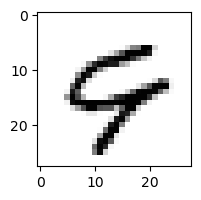

0.470284233533159% - 0
2.7858766504481482e-05% - 1
5.681860108504552e-06% - 2
3.664825656027611e-11% - 3
15.59508466654829% - 4 - ОШИБКА
0.00036878538288691217% - 5
2.0150149720529393% - 6
1.6524008954610487% - 7
7.577795146307401e-08% - 8
7.0964848978309165% - 9

 9


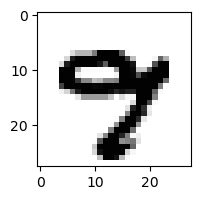

2.143809951450722e-06% - 0
2.4039819660208618e-08% - 1
3.8107790094852853e-16% - 2
3.7342584441127366e-07% - 3
3.2538254247096906e-05% - 4
4.123547159048313e-05% - 5
2.205736854538555e-06% - 6
2.8271341981181015% - 7 - ОШИБКА
2.7453011789439557e-10% - 8
5.593884234677995e-05% - 9

 3


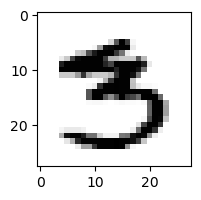

4.560061768886123e-06% - 0
3.617132872163786e-05% - 1
3.672635662468008e-08% - 2
1.0268282695746087% - 3
2.149242662512872e-06% - 4
11.048685683929282% - 5 - ОШИБКА
7.805447084544117e-11% - 6
0.005335740563327081% - 7
4.898805268692191e-09% - 8
1.4002304412621035e-11% - 9

 8


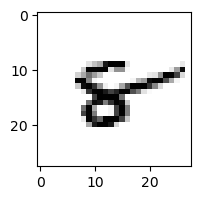

0.024061170439391197% - 0
0.41356364728346257% - 1
0.03827952621768007% - 2
2.0474932345555573e-10% - 3
40.30255180007728% - 4
0.00585658156218894% - 5
99.45532041981971% - 6 - ОШИБКА
0.005495442937935798% - 7
6.183683193928284% - 8
62.91701750813995% - 9

 2


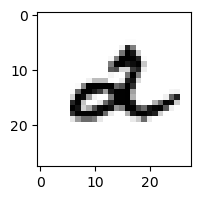

0.011042127226751453% - 0
0.019548575932062273% - 1
0.35055477611056574% - 2
0.0005001444235019276% - 3
16.089415529189317% - 4 - ОШИБКА
2.9824475040312928e-05% - 5
0.4298507063301024% - 6
0.0031109948940331407% - 7
4.5569641201595805e-08% - 8
0.4147051261026118% - 9

 9


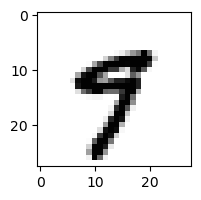

7.248550085622339e-05% - 0
0.004853561989850865% - 1
9.344845619450209e-13% - 2
1.9672267177465436e-07% - 3
0.8267527667472968% - 4
4.626266837249764% - 5 - ОШИБКА
1.3292890913817225e-05% - 6
0.9905968073385806% - 7
2.4511738070736583e-07% - 8
3.825542333274002% - 9

 3


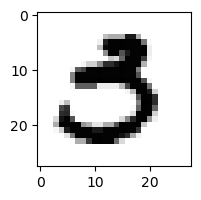

0.6609717162599058% - 0
1.295476301438504e-05% - 1
3.117160518715852e-11% - 2
0.06904625556570786% - 3
4.967836801132453e-10% - 4
34.8749522042605% - 5 - ОШИБКА
1.9173052164475758e-08% - 6
0.00016758302791792197% - 7
2.7894140217595556e-14% - 8
1.3304439877094325e-13% - 9

 9


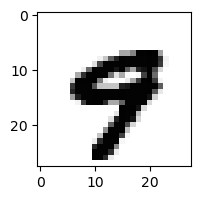

7.335195167931346e-05% - 0
3.71054893007379e-08% - 1
4.2864392273790165e-16% - 2
1.706328388041252e-10% - 3
0.9378785069531252% - 4 - ОШИБКА
0.00520991795403164% - 5
1.0198353433150238e-06% - 6
0.4624867711060815% - 7
7.632577655953343e-14% - 8
0.0038430346500700524% - 9

 9


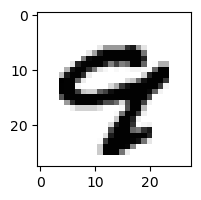

2.1916753591679312e-05% - 0
4.8388923375758125e-09% - 1
2.1388096069578202e-10% - 2
3.2024223451972897e-12% - 3
0.0002505133505201549% - 4
4.998246035111316e-06% - 5
1.1788145088699149e-06% - 6
0.002074171479016769% - 7 - ОШИБКА
1.1077013121074627e-10% - 8
0.0018648314967947934% - 9

 3


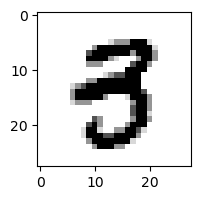

0.04484661341935774% - 0
8.512399667621828e-07% - 1
4.440528503731523e-09% - 2
4.189706351933979% - 3
0.011710089341583997% - 4
9.566902837967893% - 5 - ОШИБКА
1.7232680977601636e-07% - 6
3.7834736512081673e-06% - 7
1.3695370517601476e-09% - 8
7.537211756284592e-10% - 9

 8


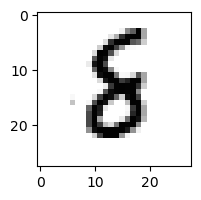

5.8820859813986444e-05% - 0
0.014110780781082516% - 1
0.014784165727801144% - 2
0.00020756680442062789% - 3
4.637440573523466e-05% - 4
0.3908687423108255% - 5
93.60231891486885% - 6 - ОШИБКА
1.3914476544183688e-05% - 7
20.560318039126283% - 8
3.512198017704791e-08% - 9

 9


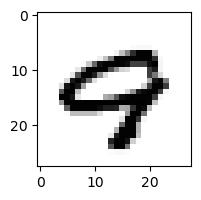

0.10558570112985054% - 0
5.982312182591021e-06% - 1
7.466979060730169e-11% - 2
3.3922233391158587e-13% - 3
3.751088253387684% - 4 - ОШИБКА
3.742698230743985e-06% - 5
5.715839476223667e-05% - 6
2.3959237688493498% - 7
1.5498646421246226e-09% - 8
0.0009232512714435616% - 9

 9


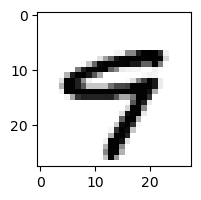

0.004253526656778638% - 0
8.401476743938253e-06% - 1
5.7471149321677516e-12% - 2
4.254465244687301e-09% - 3
0.5135287420785463% - 4
25.72865296634132% - 5 - ОШИБКА
2.3307526315391476e-05% - 6
0.3064878067396376% - 7
4.2943708022987756e-10% - 8
0.9728876554037983% - 9

 5


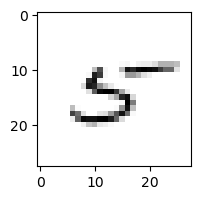

5.918134771738426% - 0
0.20925496659731446% - 1
3.595481721189283% - 2
0.05531911455283112% - 3
72.23644835918539% - 4
35.0100262842478% - 5
10.01446502284574% - 6
3.501392372364683% - 7
92.19649530466243% - 8 - ОШИБКА
2.981903179008607% - 9

 8


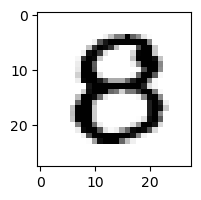

32.30012540071085% - 0 - ОШИБКА
2.9641631794323096e-09% - 1
0.0001195085245376865% - 2
5.864766929739538e-05% - 3
0.01721403585055607% - 4
4.679133289574141% - 5
1.3659367376390315e-05% - 6
1.035741766503144e-08% - 7
0.002399885174413713% - 8
6.220088286051993e-14% - 9

 9


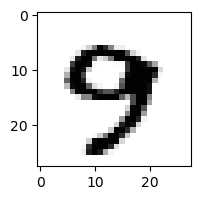

0.0005909426557575761% - 0
2.156080590969332e-08% - 1
5.537606207351203e-11% - 2
0.003550082939375451% - 3
0.018670284459335214% - 4
0.004584819579010011% - 5
6.507166172892922e-06% - 6
11.4817368682146% - 7 - ОШИБКА
1.7601493566442075e-08% - 8
0.14674724118060406% - 9

 9


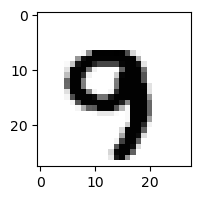

2.2215885999240435e-08% - 0
5.991998365842393e-05% - 1
5.461274995908126e-09% - 2
1.8830987068241463e-10% - 3
0.014478893316437444% - 4
4.599560446382022e-05% - 5
1.3261937808733526e-05% - 6
0.42129389137225204% - 7 - ОШИБКА
3.4119616729925344e-14% - 8
0.09060038629911414% - 9

 8


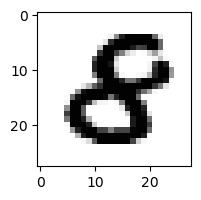

0.002045467163638986% - 0
3.8566734694597985e-08% - 1
3.8545388211898025e-06% - 2
1.3393419458760984e-08% - 3
2.134487888074781e-05% - 4
0.008838780381791384% - 5 - ОШИБКА
3.934177146156071e-05% - 6
1.4137450636065001e-11% - 7
3.8856157301173994e-08% - 8
1.0605115385893655e-16% - 9

 9


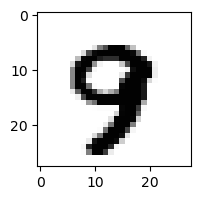

5.4656534791360745e-06% - 0
1.896052880103997e-08% - 1
2.7194661885140537e-09% - 2
5.447441556136647e-06% - 3
0.004644873060687814% - 4
0.005309074192379687% - 5
1.2697551424095123e-06% - 6
1.2574786085838143% - 7 - ОШИБКА
2.030125867764929e-09% - 8
0.10454470005525206% - 9

 8


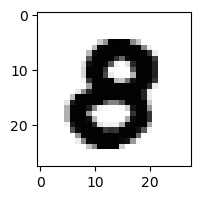

0.004530900122260224% - 0 - ОШИБКА
2.947340196896107e-12% - 1
8.5241252125509e-08% - 2
2.5293792569037695e-08% - 3
6.733184433986821e-07% - 4
0.004202350479081108% - 5
2.82900245084612e-10% - 6
1.0088699913471296e-09% - 7
4.5677863635875844e-07% - 8
2.9873726463808556e-13% - 9

 3


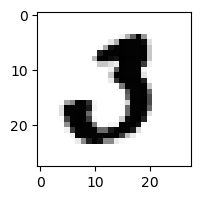

44.01554124279666% - 0 - ОШИБКА
2.9365501330919304e-06% - 1
3.6981585897869413% - 2
9.443399607820071% - 3
8.66273053679013e-09% - 4
0.002973612377337226% - 5
7.911572506650641e-08% - 6
0.000913525799436339% - 7
7.812513739599468e-14% - 8
3.7893933589341297e-13% - 9

 4


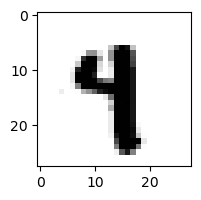

5.141482695832918e-10% - 0
0.039395009506783825% - 1
5.387043865146343e-12% - 2
9.007029424968927e-09% - 3
0.021602717161725953% - 4
0.3181280868684436% - 5 - ОШИБКА
3.823285071048833e-05% - 6
0.011302236524988869% - 7
1.1370594244676349e-09% - 8
0.018241815606243543% - 9

 8


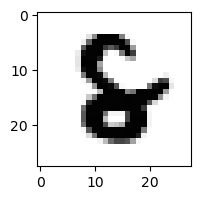

1.4363039259556785e-06% - 0
1.1105954562357349e-08% - 1
0.0004556593860146119% - 2
7.686025965286168e-11% - 3
0.0008663700024387453% - 4
0.0006068759787035736% - 5
15.34747378913316% - 6 - ОШИБКА
5.6871648119614e-08% - 7
4.438688269963804e-05% - 8
1.1037450556060219e-16% - 9

 9


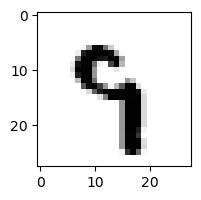

2.7962147704757215e-07% - 0
0.00011517743378611334% - 1
0.000103138496658954% - 2
0.00015320956439600098% - 3
3.410697576546025% - 4
14.776228124022644% - 5 - ОШИБКА
0.211829802388387% - 6
0.5035575673346309% - 7
0.0003089488657484806% - 8
0.07656373147946699% - 9

 8


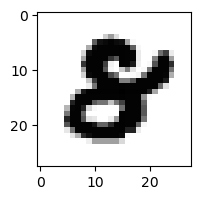

0.00011859736186313703% - 0
6.256499247257885e-12% - 1
4.799750872296881e-07% - 2
8.563938505685904e-11% - 3
1.6658931219583474e-07% - 4
0.0007864331539796186% - 5 - ОШИБКА
5.23606219454733e-07% - 6
2.8342548802510874e-09% - 7
1.2014934185926787e-10% - 8
5.470441195955322e-15% - 9

 3


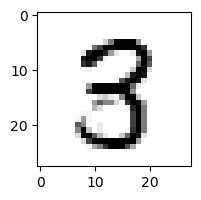

0.0017018422152132067% - 0
7.259185275695007e-05% - 1
0.06012193301085584% - 2
41.902407583647985% - 3
0.038347366960476005% - 4
3.2067221511663755% - 5
4.2631470952185837e-07% - 6
0.0005407049965582473% - 7
81.62305669553707% - 8 - ОШИБКА
5.169220500001915e-08% - 9

 3


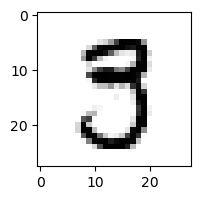

0.23634756921166425% - 0
0.0001506458974337708% - 1
1.2752476326861404e-07% - 2
9.813400370008285% - 3
5.1768573417598346e-05% - 4
33.62637095274224% - 5 - ОШИБКА
2.2984227357439717e-08% - 6
0.11839624800539172% - 7
1.467893917587326% - 8
1.2411232786833696e-10% - 9

 4


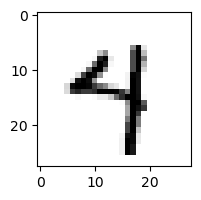

0.04287283478378103% - 0
0.0029844129625963664% - 1
2.0125377950620894e-07% - 2
0.0002466960423153966% - 3
83.39065088544149% - 4
25.494760939822815% - 5
0.058242985146615515% - 6
1.3141522882843804% - 7
0.00016233349097004497% - 8
90.06481475366667% - 9 - ОШИБКА

 8


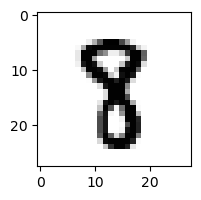

4.3747020886482006e-08% - 0
0.006920976400769055% - 1
1.3558732585098696e-06% - 2
0.00013250898368477224% - 3
0.0003699796261415471% - 4
1.3217058583397838% - 5 - ОШИБКА
1.3932322140806582e-07% - 6
0.0031378486283847582% - 7
0.7550534514836089% - 8
6.301836805604625e-11% - 9

 2


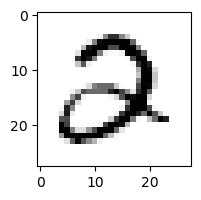

0.6623902094381326% - 0
1.9706177498210606e-07% - 1
87.9606873650613% - 2
98.20638668436791% - 3 - ОШИБКА
0.00055257609108247% - 4
0.01590821210184198% - 5
4.806347268009867e-05% - 6
0.004613911703910031% - 7
6.358700487397143e-11% - 8
1.5326119254464993e-10% - 9

 8


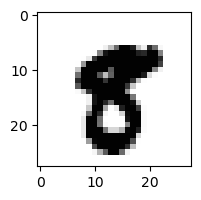

1.5103159882020239e-06% - 0
3.3970616896209807e-07% - 1
3.1740012748323485e-16% - 2
2.6526283085286384e-11% - 3
2.877369571976915e-08% - 4
0.8403937884352145% - 5 - ОШИБКА
5.518637877436331e-12% - 6
0.00017468524275726676% - 7
0.00021843220001951773% - 8
3.8226570487997144e-07% - 9

 8


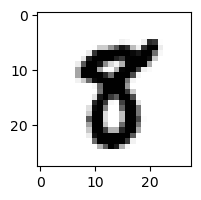

3.232743468095405e-05% - 0
6.810437485062619e-05% - 1
1.0463682598224946e-10% - 2
2.6532277606026902e-08% - 3
7.454608627507938e-07% - 4
12.72494917757733% - 5 - ОШИБКА
3.8116394663684694e-08% - 6
8.372302791642485e-05% - 7
0.1616431009894836% - 8
3.235363176708717e-08% - 9

 8


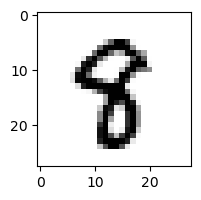

2.1150985634487045e-06% - 0
0.001347172247936951% - 1
1.1885335169316119e-08% - 2
4.8794744593228596e-06% - 3
0.036790467341168344% - 4
3.414662221911947% - 5 - ОШИБКА
1.9232627188695762e-06% - 6
0.0006787562109033041% - 7
0.06270837155526165% - 8
2.133622837584044e-06% - 9

 8


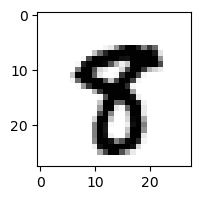

1.8205805310685228e-08% - 0
2.2167699926494986e-06% - 1
3.316223803909102e-12% - 2
5.6300442931540025e-09% - 3
2.1981317810677608e-05% - 4
5.195438379254564% - 5 - ОШИБКА
1.1835959115875123e-10% - 6
0.01158905259792603% - 7
0.0025304844059718117% - 8
0.00020518067540402571% - 9

 8


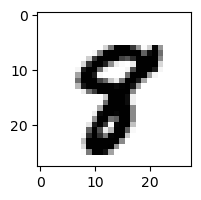

1.653058824916861e-07% - 0
2.0054043570412182e-06% - 1
6.149835540229431e-12% - 2
9.370030845673604e-12% - 3
9.338254424316897e-05% - 4
0.4111138732935938% - 5 - ОШИБКА
1.8866912620561653e-08% - 6
0.004509863014344939% - 7
0.02019266822218103% - 8
0.0003284051312854869% - 9

 8


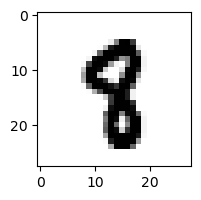

8.181113215834274e-09% - 0
0.005783478046632576% - 1
2.2653901697942866e-07% - 2
3.4248559587274034e-08% - 3
0.02064650780460879% - 4
0.4955861589586537% - 5 - ОШИБКА
4.4522449388059625e-06% - 6
0.0014321992556411423% - 7
6.129309638993706e-05% - 8
4.541190741198858e-06% - 9

 8


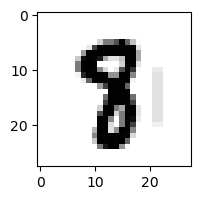

1.205220509603262e-08% - 0
0.0003392871397674923% - 1
3.6036603083355135e-09% - 2
5.0799153126560403e-08% - 3
2.3123187699886187e-05% - 4
0.7510332884475514% - 5 - ОШИБКА
4.501289572551235e-06% - 6
0.0011289867405197811% - 7
0.030443247658186935% - 8
1.8478880445128363e-10% - 9

 8


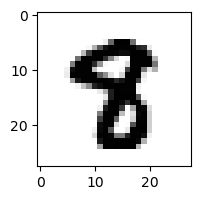

6.448035177390516e-10% - 0
1.5030167483119042e-06% - 1
1.8463632968173003e-12% - 2
9.858670467850723e-10% - 3
0.00017551913887409951% - 4
0.5384147198711846% - 5 - ОШИБКА
1.7732733004179495e-10% - 6
0.00038610480118591765% - 7
0.00012098775521850833% - 8
1.1862164494611825e-11% - 9

 3


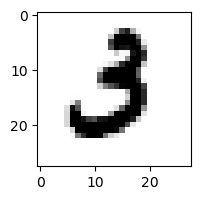

0.023982530560520715% - 0
0.0009445896927121753% - 1
0.010949772180718822% - 2
0.03475166467877633% - 3
5.1789427363560234e-08% - 4
0.4118506555577866% - 5 - ОШИБКА
0.00021603460911256262% - 6
0.0016629689898051824% - 7
1.538876099723526e-14% - 8
1.1416942097005021e-15% - 9

 8


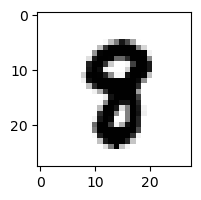

5.370560684148831e-08% - 0
4.7865229310427455e-05% - 1
3.984790525525948e-10% - 2
2.11002514195253e-08% - 3
9.476224214821684e-05% - 4
0.04339041771911144% - 5 - ОШИБКА
4.0162587474982495e-07% - 6
0.0005322198138417915% - 7
0.004049156773689938% - 8
1.1939140610164126e-07% - 9

 8


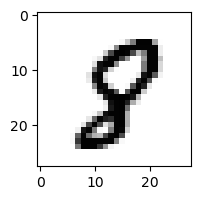

0.00142254518879206% - 0
0.00022503340443069856% - 1
1.9404637982303386e-05% - 2
1.1000699680412395e-08% - 3
0.0021010370950142595% - 4
1.6698231609902854% - 5 - ОШИБКА
7.681287750083455e-05% - 6
0.007556235514115297% - 7
0.6178692918948606% - 8
4.019376592005e-06% - 9

 3


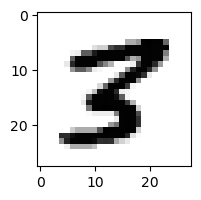

1.2285567683129842e-06% - 0
0.00014585638084945707% - 1
5.1867753397837325e-05% - 2
3.7162835700073537e-06% - 3
7.622538826060091e-05% - 4
0.6544166011038277% - 5 - ОШИБКА
4.2651103501604505e-10% - 6
5.2873296876118666e-05% - 7
0.0036803840115861683% - 8
1.5728475508407014e-11% - 9

 7


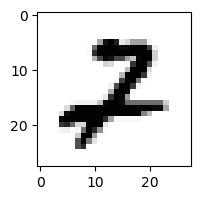

0.004079197021352124% - 0
0.00028586319045905567% - 1
97.81443612824184% - 2 - ОШИБКА
0.0005108396668381548% - 3
2.1089686478243887e-06% - 4
3.408994266838246e-05% - 5
1.1403048237838931e-06% - 6
0.0038824510681917095% - 7
1.6885335720810357e-06% - 8
1.9048476553590872e-08% - 9

 2


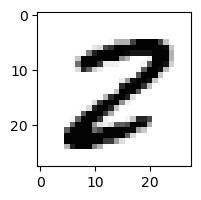

0.00404187298656614% - 0
1.508314790097024e-05% - 1
0.10476042470833527% - 2
6.142674704338077e-08% - 3
1.183452621253638e-08% - 4
0.344494314186309% - 5
2.1029447801617876e-06% - 6
7.050314386515431e-05% - 7
99.98846242697475% - 8 - ОШИБКА
3.945747859162902e-13% - 9

 5


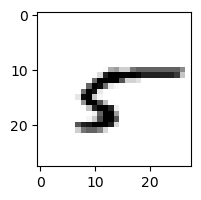

32.78356089876597% - 0
2.899870596787171% - 1
0.032311937383300474% - 2
0.0006146614797766895% - 3
3.419419034145587% - 4
0.05553678228950614% - 5
85.66637775087821% - 6 - ОШИБКА
0.11921149830539168% - 7
10.33919784485286% - 8
0.6283202948125564% - 9

 7


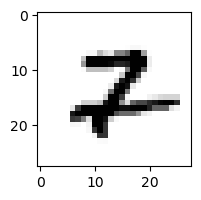

0.002245058369215901% - 0
0.008376416539153914% - 1
11.82922375961666% - 2 - ОШИБКА
6.877699904992325e-08% - 3
0.0018547963240138487% - 4
0.00014521335621213687% - 5
0.0011702859635961465% - 6
6.003246224536029% - 7
0.00019039527796438474% - 8
8.13962403077888e-05% - 9

 1


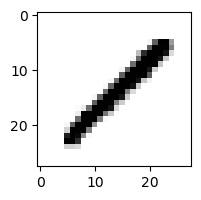

0.004671289244402523% - 0
70.43016312290817% - 1
1.8609166009803735% - 2
0.013488047832041163% - 3
0.6786930797251514% - 4
0.023900835158470635% - 5
3.5684936074918566e-05% - 6
0.00900946897507703% - 7
99.99689813077207% - 8 - ОШИБКА
0.00117286325541367% - 9

 7


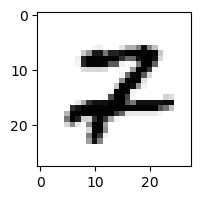

0.010886965394815233% - 0
3.6188200994533266e-05% - 1
38.81559333804774% - 2 - ОШИБКА
2.146333032997931e-08% - 3
0.0011087003848816292% - 4
0.00019993081197778193% - 5
1.26710654218463e-05% - 6
2.466291249494362% - 7
0.025919793429061956% - 8
1.6097441916469356e-05% - 9

 7


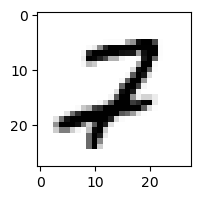

0.0869896402013594% - 0
6.51611871655042e-05% - 1
95.86146806909842% - 2 - ОШИБКА
2.5220253406687163e-05% - 3
0.0004822269842386844% - 4
0.004749059788530514% - 5
0.0002334817410051596% - 6
0.1309889397890571% - 7
0.43113634020788105% - 8
1.872147496613959e-07% - 9

 1


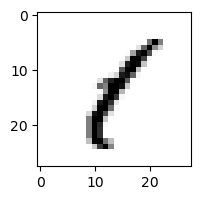

0.18674719639123047% - 0
84.67865644735282% - 1
0.01603020254753538% - 2
0.5228925830937793% - 3
0.19984800850548712% - 4
3.2481626062076323% - 5
0.009603879174902553% - 6
0.018778425195329344% - 7
94.12338285164688% - 8 - ОШИБКА
0.02773997171625491% - 9

 9


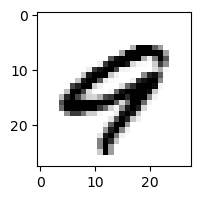

0.039789734648527336% - 0
4.85394905064008e-07% - 1
2.707542408860502e-10% - 2
3.87619725382805e-13% - 3
25.537146062976213% - 4 - ОШИБКА
3.69228752005925e-05% - 5
0.0016723015061608643% - 6
0.06712647136588576% - 7
1.5296906186028417e-09% - 8
0.03739580371971723% - 9

 7


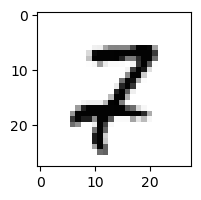

0.018793759210802025% - 0
0.002556239677157866% - 1
53.87306557432332% - 2 - ОШИБКА
2.5958509968155497e-06% - 3
5.918290406603274e-05% - 4
0.0011423584082938692% - 5
0.00013232608664321237% - 6
0.6396412830202564% - 7
32.83263741544115% - 8
0.025539487820590203% - 9

 7


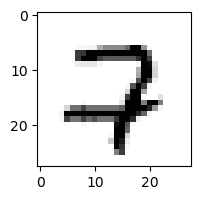

0.3560822448042924% - 0
1.289483730871203e-07% - 1
66.71379481024721% - 2 - ОШИБКА
6.6188907846202025e-06% - 3
0.0003103114366647567% - 4
0.00018078356056545493% - 5
0.0015021638233449182% - 6
38.97899775828162% - 7
0.00021337355447650005% - 8
8.164272352033392e-05% - 9

 2


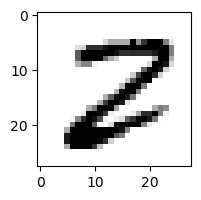

0.0022501981863680266% - 0
6.1302412748252504e-06% - 1
2.976462780315872% - 2
9.38348747226614e-05% - 3
1.1133878187159233e-08% - 4
0.19354567819088775% - 5
1.2212069484434075e-05% - 6
9.618157998370792e-05% - 7
85.32105467127614% - 8 - ОШИБКА
5.733650430808142e-16% - 9

 8


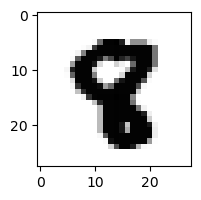

3.513297008791059e-11% - 0
7.870492329483539e-08% - 1
2.918231280830311e-09% - 2
5.103512034691701e-12% - 3
0.00012937485457823538% - 4
0.015213421050873865% - 5 - ОШИБКА
8.734759422056863e-10% - 6
5.859910681564474e-07% - 7
3.344910012177239e-11% - 8
1.6152074820506582e-11% - 9

 8


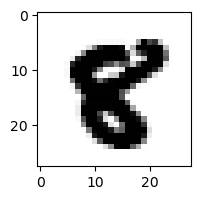

6.47092078480285e-08% - 0
2.4077213369128842e-08% - 1
2.3063893176315343e-12% - 2
4.5736455952199465e-18% - 3
1.5812463943010305e-05% - 4
0.05616197722305398% - 5 - ОШИБКА
3.8328614467324465e-10% - 6
1.8825361346914405e-08% - 7
0.0008439077746406883% - 8
2.499689623049201e-13% - 9

 8


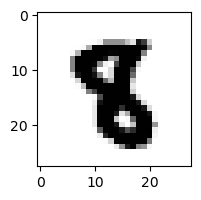

3.683526630884895e-12% - 0
6.389611946567947e-06% - 1
1.2674816821531165e-09% - 2
5.3399072574721715e-11% - 3
6.100972989574342e-06% - 4
0.15542153412615847% - 5 - ОШИБКА
3.425148253500988e-07% - 6
1.2126902296763237e-06% - 7
6.125679708062574e-13% - 8
2.385917939805055e-13% - 9

 8


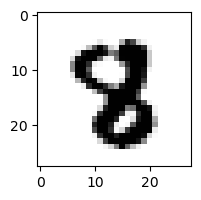

6.305655751886978e-09% - 0
3.140536134123976e-07% - 1
2.5889085470467597e-07% - 2
9.399030508428052e-09% - 3
0.000663294544510791% - 4
0.010958202647683298% - 5 - ОШИБКА
4.019390978947145e-08% - 6
0.0005944096078900566% - 7
2.674308701637865e-08% - 8
2.0814845000430872e-12% - 9

 8


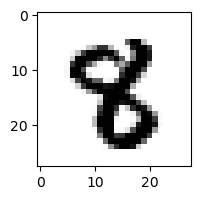

1.1041619867679469e-09% - 0
3.3696643963042366e-05% - 1
1.2955678937836711e-08% - 2
1.442478340580232e-07% - 3
0.00303947554856704% - 4
0.1340949531363732% - 5 - ОШИБКА
1.2221055127891716e-08% - 6
0.00012370695619300112% - 7
2.054039525502977e-08% - 8
2.7128568292036212e-12% - 9

 8


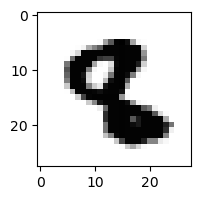

3.6045316571636854e-11% - 0
1.426770328418706e-05% - 1
4.547177777073122e-06% - 2
1.233557067816451e-09% - 3
8.425642234563339e-08% - 4
0.47593482773858037% - 5 - ОШИБКА
7.159018787021146e-09% - 6
8.438796568282855e-09% - 7
2.8567666681310674e-19% - 8
1.9946956148188797e-13% - 9

 8


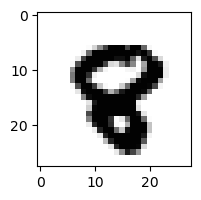

5.305790015478212e-07% - 0
1.8804847679235315e-09% - 1
9.535367865420295e-08% - 2
1.579570443614574e-17% - 3
1.0259852049573198e-05% - 4
8.60025000723303e-05% - 5
6.894763761511313e-06% - 6
0.00040645206243270177% - 7 - ОШИБКА
6.363089495523752e-05% - 8
0.00014739045301755927% - 9

 8


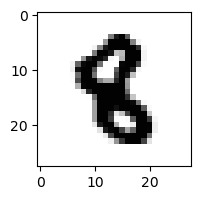

2.2317752016051908e-09% - 0
0.0002766274978312753% - 1
8.364126526967501e-07% - 2
1.7644892381910843e-09% - 3
0.0002112747062581203% - 4
0.16426177413248094% - 5 - ОШИБКА
3.0453671320308237e-05% - 6
1.6356173892587567e-07% - 7
6.956812755470738e-11% - 8
1.9397547806520934e-10% - 9

 8


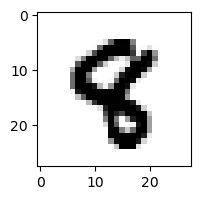

2.572510140740334e-09% - 0
4.833031833189376e-05% - 1
6.802670944718073e-08% - 2
3.0891644582758203e-09% - 3
0.027067671168550505% - 4
0.11373985173458719% - 5 - ОШИБКА
8.676974600052676e-09% - 6
2.238056775005913e-05% - 7
4.3334881005721803e-10% - 8
1.7809307669835353e-07% - 9

 8


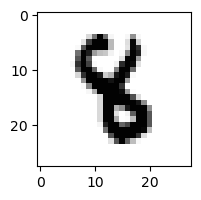

3.62361443361088e-11% - 0
0.0007790997375174663% - 1
1.4500810702620478e-07% - 2
1.640078346191449e-05% - 3
0.027529287037399396% - 4
0.5827857505042435% - 5 - ОШИБКА
0.00044471312377958024% - 6
2.731208760354217e-05% - 7
8.782437595991303e-12% - 8
1.6561616392781078e-13% - 9

 7


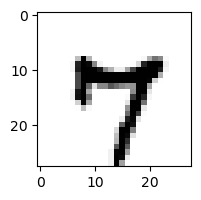

0.006297316443344371% - 0
1.995038514209022e-05% - 1
2.3065733477458163e-13% - 2
3.5184778591629646e-06% - 3
28.370261428657596% - 4 - ОШИБКА
0.3419715349127194% - 5
0.002908518565063567% - 6
21.592699955256055% - 7
0.017013322328282315% - 8
7.20124637191726% - 9

 8


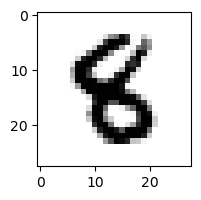

9.134691314241767e-07% - 0
3.89627900246358e-05% - 1
2.5489410079419168e-08% - 2
2.433961473507309e-07% - 3
0.002401063017130498% - 4
2.1325020803659003% - 5 - ОШИБКА
0.0007161129090305154% - 6
4.804928794414734e-08% - 7
9.270976323917148e-09% - 8
4.545396742953006e-13% - 9

 8


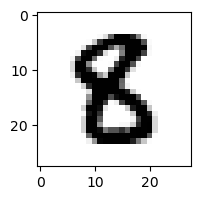

5.1245276499100696e-05% - 0
7.824095672411925e-07% - 1
1.0295819084223787e-07% - 2
1.2322908306286514e-06% - 3
9.345608723080857e-07% - 4
2.7376385431264656% - 5 - ОШИБКА
1.30982089269964e-05% - 6
2.2879977182923536e-09% - 7
7.972635758411143e-08% - 8
1.6469238131598914e-16% - 9

 2


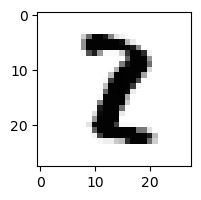

2.360381197489546e-08% - 0
11.388881548318027% - 1 - ОШИБКА
0.18267361096196597% - 2
0.005553148604273166% - 3
2.0156560642510645e-05% - 4
0.00021364339810903412% - 5
2.2592323490444458e-07% - 6
0.00021213033308157498% - 7
8.798243070077023e-07% - 8
1.1516657223100373e-11% - 9

 8


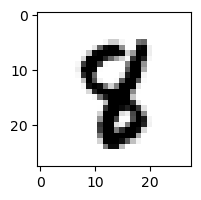

2.117320891858945e-08% - 0
0.0002543737160987298% - 1
2.6011021676661295e-06% - 2
3.082300727351735e-08% - 3
0.02348001827790922% - 4
0.5101368934084036% - 5 - ОШИБКА
1.2754322287020198e-05% - 6
0.0016961415810290098% - 7
3.9196928644807606e-05% - 8
2.0006325091911322e-08% - 9

 3


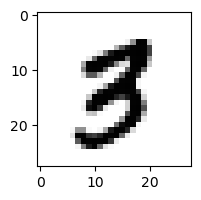

0.00031224368385492215% - 0
0.00010963737846137603% - 1
1.2835735790709909e-05% - 2
0.00042797636589957306% - 3
5.372229059539193e-05% - 4
0.19600676588439275% - 5 - ОШИБКА
1.6743922792056607e-06% - 6
0.0010957287622925082% - 7
0.0005468316261162626% - 8
0.0012079961720437024% - 9

 3


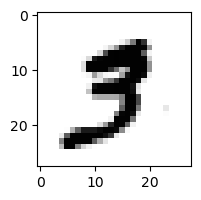

0.0011690169461563797% - 0
0.0005720510705530909% - 1
7.90045156220409e-06% - 2
0.07460977672181307% - 3
1.578211886632123e-05% - 4
0.32215818043971267% - 5 - ОШИБКА
2.2658880296788807e-07% - 6
0.04458144936777813% - 7
9.221447572337482e-10% - 8
0.00011214904230242373% - 9

 9


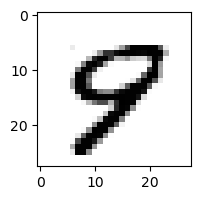

0.004005981292634348% - 0
9.235572891734396e-06% - 1
2.0863697397883336e-06% - 2
2.0304392033015929e-10% - 3
1.252651536365591% - 4 - ОШИБКА
0.5979752065705447% - 5
0.0010337967150455584% - 6
0.2089539950710787% - 7
1.2396228260869892e-06% - 8
1.202912062824166% - 9

 4


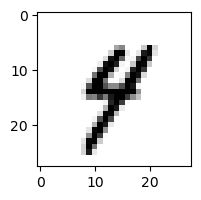

0.0006008020190468317% - 0
0.6334767438897817% - 1
5.745272148076572e-06% - 2
0.0006272747723226969% - 3
8.13750052868585% - 4
2.419367930996571% - 5
0.004408418996648972% - 6
0.2854201791892643% - 7
0.004628139762847225% - 8
9.883957770935178% - 9 - ОШИБКА

 9


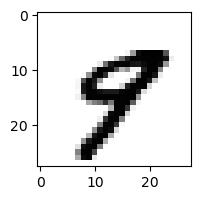

0.0002355345139170682% - 0
0.0002612880668156794% - 1
8.981720775226565e-10% - 2
1.9158933768331604e-08% - 3
5.988028142634823% - 4
0.09826088059546861% - 5
1.2586913738698913e-06% - 6
6.9561854163881565% - 7 - ОШИБКА
2.024393182698964e-06% - 8
0.0023864539202438743% - 9

 3


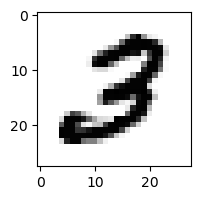

0.004265705931013613% - 0
1.0418559666615131e-05% - 1
2.4441045948469906% - 2 - ОШИБКА
0.8384811044210643% - 3
3.1757756972461835e-07% - 4
0.6092876708543394% - 5
3.387825629042452e-05% - 6
0.00012242221224339835% - 7
4.343437979572964e-06% - 8
2.3921288103463974e-11% - 9

 3


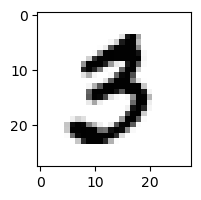

0.027439606359027896% - 0
4.7269663258084174e-05% - 1
0.00472335129109587% - 2
1.734514614792251% - 3
9.678969933149788e-07% - 4
32.858266198762095% - 5 - ОШИБКА
1.1411831103632067e-05% - 6
4.440819907036097e-05% - 7
1.0088238816066202e-08% - 8
7.701470173648229e-07% - 9

 8


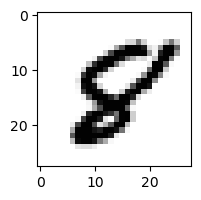

0.005451869337922389% - 0
1.2074981861223027e-06% - 1
0.00013389992245784087% - 2
2.2422555922362162e-15% - 3
0.00012707937986347671% - 4
4.64295128846554% - 5 - ОШИБКА
0.0011209330371571439% - 6
0.0001328351949736287% - 7
0.9230671832927796% - 8
3.145697326756135e-05% - 9

 9


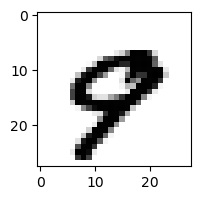

0.060889780847769005% - 0
9.065711356976071e-06% - 1
2.0793695754897579e-10% - 2
9.831565511683612e-15% - 3
1.020179083948767% - 4
4.2623781156391773e-07% - 5
7.762632764163006e-06% - 6
47.57153421393738% - 7 - ОШИБКА
8.030986395432218e-10% - 8
5.287467293762807% - 9

 9


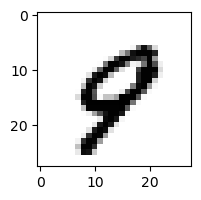

0.15629135778392805% - 0
0.0004423558354040175% - 1
1.8409874982289615e-06% - 2
1.1794095703895115e-10% - 3
4.298718288237034% - 4
0.0003202953599422623% - 5
0.0013954094163487276% - 6
7.377326770803676% - 7 - ОШИБКА
2.353371588082618e-06% - 8
3.2910892975025496% - 9

 8


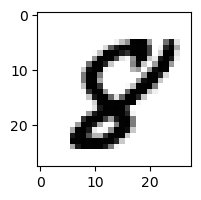

0.0006608138905534387% - 0
2.655562306620544e-08% - 1
3.994488950291647e-07% - 2
1.4402944464935373e-15% - 3
2.4151713652544604e-05% - 4
3.0394866240224707% - 5 - ОШИБКА
7.583690890994707e-07% - 6
5.651739900220758e-05% - 7
0.1296650661931209% - 8
3.686623556353412e-10% - 9

 8


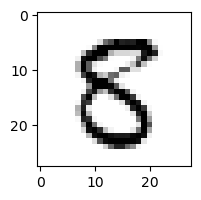

0.323976218592329% - 0
1.976707709266108e-06% - 1
3.9124786269302914e-05% - 2
0.006447477664176713% - 3
0.03587188091385162% - 4
93.52287563466794% - 5 - ОШИБКА
1.4596990972192703e-06% - 6
6.155115789582365e-06% - 7
0.07104792727498493% - 8
1.4956517399996352e-12% - 9

 8


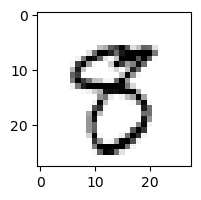

0.008363559524035623% - 0
0.00037510341150450045% - 1
3.2645325245332966e-07% - 2
0.06128461790103186% - 3
0.00023220633010505575% - 4
6.572712343698568% - 5 - ОШИБКА
4.096348033565888e-06% - 6
0.030191719859742488% - 7
0.001398146466678223% - 8
2.492935096374959% - 9

 3


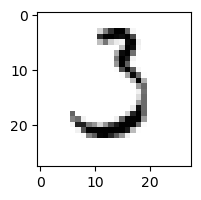

22.29557020546056% - 0
0.016997387089460813% - 1
97.61084883667604% - 2 - ОШИБКА
94.9088191499523% - 3
3.079706622108202e-06% - 4
2.9029194485652274% - 5
12.731503259549914% - 6
0.17020156131224395% - 7
1.2977845956721467e-05% - 8
5.074658081783936e-06% - 9

 8


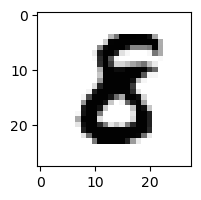

0.0001426035090728967% - 0
0.0004929458685336421% - 1
3.340947891782557e-05% - 2
4.454714384301e-05% - 3
5.296385136281347e-07% - 4
0.023868897423556384% - 5 - ОШИБКА
0.00036912218755281214% - 6
1.9410808547940704e-09% - 7
6.354967341720612e-06% - 8
7.650728086420684e-17% - 9

 8


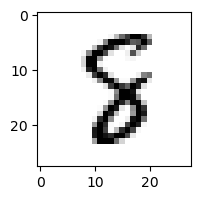

6.885900177937671e-05% - 0
0.007918050011272808% - 1
0.005523418964193098% - 2
1.3301766376097642e-05% - 3
0.013479285116159073% - 4
3.612071822485896% - 5
3.6359933901196206% - 6 - ОШИБКА
0.0009806040029630174% - 7
2.408096943926798% - 8
3.919520850975236e-11% - 9

 8


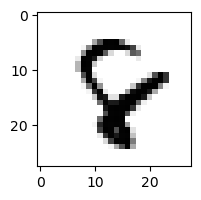

3.9659352142048175e-05% - 0
6.847391225757676e-06% - 1
0.0030524035828222843% - 2
7.666459401667164e-10% - 3
13.757045208810892% - 4 - ОШИБКА
0.004109849501062028% - 5
1.6624213467732722% - 6
0.07584078793432625% - 7
0.00025501359203571543% - 8
5.720623089074951e-08% - 9

 2


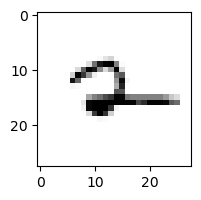

0.0032654841568016727% - 0
25.682828098930454% - 1
0.3270081213219465% - 2
1.4501998591011225e-06% - 3
76.16554311636473% - 4
0.17973681588191392% - 5
88.30808788579778% - 6
4.50461416055962% - 7
18.428975097859436% - 8
93.03857270141991% - 9 - ОШИБКА

 2


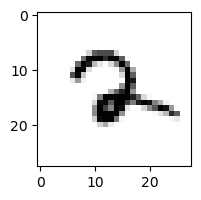

6.354612481528302e-06% - 0
2.2538908767157158% - 1
29.753847945174826% - 2
2.8391232694928335e-06% - 3
5.856440946953168% - 4
0.02445251810667214% - 5
5.292862747718992% - 6
56.75957687049119% - 7 - ОШИБКА
0.011319756342417109% - 8
0.4685911825001662% - 9

 3


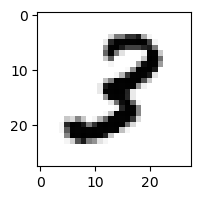

0.0003648165983192277% - 0
0.09027711205041844% - 1
6.791767426402412% - 2 - ОШИБКА
5.158875707247491% - 3
6.955083099572833e-06% - 4
0.07633943684957227% - 5
3.9598660444018684e-05% - 6
9.434149111347554e-06% - 7
0.005027557753963202% - 8
9.943540355881485e-12% - 9

 8


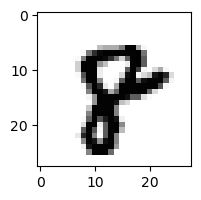

2.5557896310020598e-05% - 0
4.234185102565351e-07% - 1
1.1227605985118374e-08% - 2
7.595966703852343e-13% - 3
4.644137133049747e-05% - 4
2.180449698800121e-05% - 5
0.0016717961771680549% - 6
0.025830951747331684% - 7
0.028771143891793294% - 8
0.056256123263043106% - 9 - ОШИБКА

 5


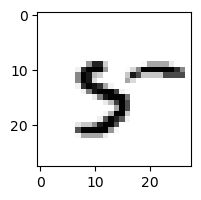

0.0652224226898058% - 0
0.03652420896635939% - 1
0.007030208166199584% - 2
1.4505339070467911e-06% - 3
38.34669363919096% - 4
49.03389610470159% - 5
7.296610486239159% - 6
0.1777033203793673% - 7
83.11508184755354% - 8 - ОШИБКА
0.3059657556665848% - 9

 9


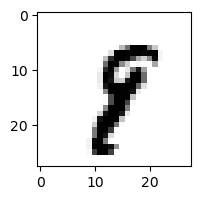

4.388935887003019e-06% - 0
1.0483399799207624% - 1 - ОШИБКА
1.0932154274468776e-05% - 2
0.00010703730716903883% - 3
0.00021443907109807981% - 4
0.07623574524736207% - 5
0.0005757303527687263% - 6
0.9095584141340148% - 7
0.020963106454088658% - 8
0.08461018851220616% - 9

 7


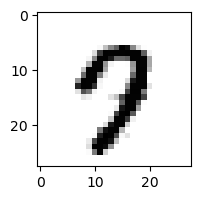

0.1924022493181748% - 0
4.172412840147786e-07% - 1
5.605362058437377e-08% - 2
1.0711070714268731e-05% - 3
0.04731902007641214% - 4
3.0090944821864087% - 5
7.285903190895721e-05% - 6
48.546576882448825% - 7
7.490178200904286e-05% - 8
78.39696481131901% - 9 - ОШИБКА

 9


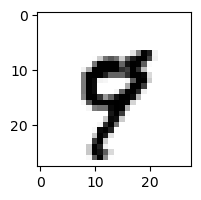

0.00012865088950294817% - 0
0.015499153721278247% - 1
2.293778627261398e-08% - 2
6.719844594729356e-10% - 3
0.6320030280037894% - 4
0.031197112796587875% - 5
8.038570506175067e-05% - 6
31.049786044489007% - 7 - ОШИБКА
1.3726392597328964e-08% - 8
0.12008562378024962% - 9

 9


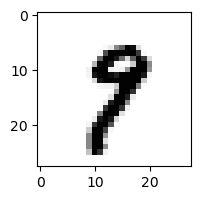

7.065436183014877e-05% - 0
0.7881618492367893% - 1
5.622887243830981e-07% - 2
3.061873268028525e-05% - 3
0.0002800618644352458% - 4
0.09537799260452669% - 5
5.139260354622745e-05% - 6
27.77481583288402% - 7 - ОШИБКА
0.21196818722915345% - 8
2.097704775166508% - 9

 7


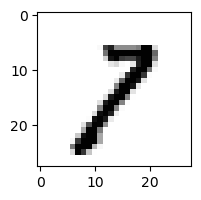

0.025840533597233928% - 0
5.868298770333212% - 1
0.25224831316470414% - 2
3.7477888579729557% - 3
0.00030475655463027887% - 4
0.01786191046193023% - 5
5.354172870475573e-05% - 6
15.1159363278334% - 7
3.271452486344078% - 8
15.65266086845778% - 9 - ОШИБКА

 8


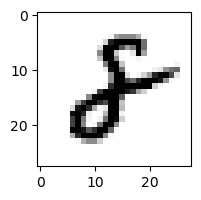

0.0015650663574048591% - 0
1.5986638376921596% - 1
50.06712310792771% - 2 - ОШИБКА
4.021476204617865e-06% - 3
9.537606517321572e-06% - 4
1.87086176194454e-05% - 5
0.029149684421479923% - 6
4.464599508050289e-07% - 7
0.003670054616831303% - 8
3.5778931008214506e-07% - 9

 9


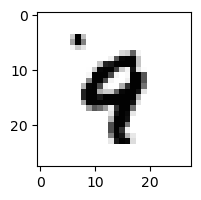

2.3597217791449695e-05% - 0
0.022079336078771238% - 1
2.5156324074441324e-06% - 2
5.546362905121301e-08% - 3
84.29901578964096% - 4 - ОШИБКА
0.00844505747569688% - 5
0.42194877304122447% - 6
0.11348459403438707% - 7
1.3327849030065158e-07% - 8
0.16317696562452827% - 9

 2


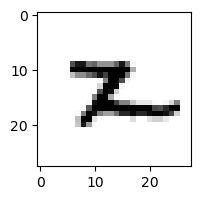

8.780820001452294e-05% - 0
1.1276333577140478% - 1
0.04586400681451125% - 2
2.2162906865644928e-07% - 3
0.03198925861593529% - 4
4.911500478699262% - 5
0.9289227148090917% - 6
0.001511662597969815% - 7
8.759748493058732% - 8 - ОШИБКА
0.0020011191766134613% - 9

 8


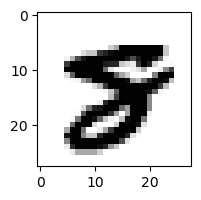

3.251771165480716e-08% - 0
1.998384846993689e-08% - 1
2.7004166346168112e-15% - 2
4.8105770271156106e-14% - 3
5.088144826381058e-09% - 4
0.00011996203976461042% - 5
3.059478894398511e-09% - 6
0.0004456143319987091% - 7 - ОШИБКА
5.685897888120067e-05% - 8
7.000463452702221e-14% - 9

 1


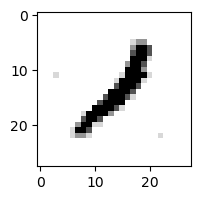

0.0033485829854119223% - 0
80.79874136261834% - 1
35.20395093623729% - 2
0.003207118788557245% - 3
0.4951754343681566% - 4
0.00040106459320094845% - 5
0.016391667728753282% - 6
0.25040178380943046% - 7
99.26347615090462% - 8 - ОШИБКА
0.2463088072408097% - 9

 3


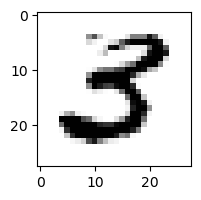

0.011222520808872611% - 0
0.0004593866605342878% - 1
2.9968730524551955e-08% - 2
4.3427847639895445% - 3
4.901714351927464e-05% - 4
95.79045655631907% - 5 - ОШИБКА
1.1087694279099273e-06% - 6
2.5213928120102874e-05% - 7
4.4940695352102607e-10% - 8
8.77321580775766e-19% - 9

 3


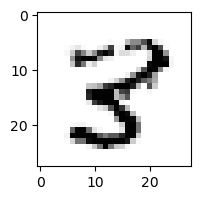

4.0112772778675806e-05% - 0
0.00277248392835099% - 1
0.010259555700316928% - 2
0.0005400304513415026% - 3
0.8491714301138891% - 4
2.449857235310247% - 5
2.1706598560462564e-06% - 6
8.00451681695557e-05% - 7
99.9646748587444% - 8 - ОШИБКА
2.6674443830350958e-09% - 9

 0


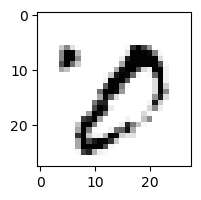

0.5459946390409076% - 0
0.39565812376212817% - 1
6.531439305927416e-06% - 2
16.355120875397475% - 3
1.4170590702112451e-05% - 4
0.00037256857866051863% - 5
2.167728470792691e-06% - 6
0.05592766362266617% - 7
36.87262177505059% - 8 - ОШИБКА
2.044598596844719e-08% - 9

 1


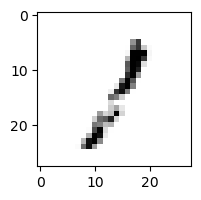

11.662804078244731% - 0
59.53269251665301% - 1
10.558036091342027% - 2
70.38292468052795% - 3 - ОШИБКА
4.889232947078393% - 4
2.0394281478747054% - 5
0.09166996602891705% - 6
66.08933253299288% - 7
30.892880680745847% - 8
1.7577227144090677% - 9

 1


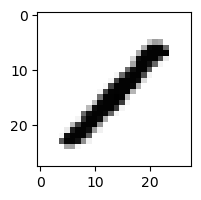

0.0009958231947855263% - 0
89.01208763651096% - 1
1.8351012398704494% - 2
0.004679254040874447% - 3
0.29887563254479127% - 4
0.02131655078539232% - 5
8.04190666576998e-05% - 6
0.0057286782745263245% - 7
99.59777677165138% - 8 - ОШИБКА
5.736883203074859e-05% - 9

 3


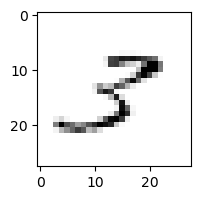

6.7269023095136395% - 0
3.1133564506667444% - 1
73.25501328261826% - 2 - ОШИБКА
57.02417933183676% - 3
0.12101268736577118% - 4
1.2237061732778818% - 5
0.02764650502369603% - 6
12.778649129717232% - 7
31.934577221749993% - 8
18.7896344969748% - 9

 3


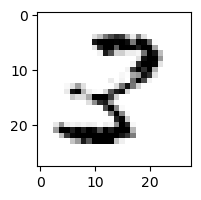

1.3778800279505212% - 0
0.08795528298194426% - 1
14.542807394968413% - 2 - ОШИБКА
2.8061682126593457% - 3
0.0007393201159964463% - 4
0.1508120367768038% - 5
3.0754689641186787e-06% - 6
2.663043510098854e-05% - 7
0.9711634831525194% - 8
1.0013750942613617e-09% - 9

 2


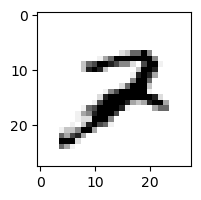

0.004557233215862973% - 0
0.0572275034878705% - 1
5.184772271758463% - 2
2.951973308296626e-07% - 3
0.024052940307212292% - 4
0.0002858291795881528% - 5
0.011077945324890561% - 6
29.277746930068755% - 7 - ОШИБКА
0.07006824934029925% - 8
0.06757371306719623% - 9

 3


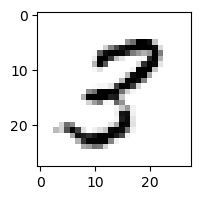

0.4778061110219861% - 0
0.008305749201575875% - 1
0.4126390602858046% - 2
16.301868022023562% - 3
0.005804528487037844% - 4
3.7849632642493227% - 5
0.00011583791117335576% - 6
0.000687015859745539% - 7
85.58858439441408% - 8 - ОШИБКА
0.007099356505419147% - 9

 3


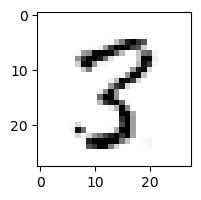

0.003287756008986694% - 0
0.017764279851897716% - 1
0.18412985949638827% - 2
5.762415528575298% - 3
0.008080852324776453% - 4
12.542682633808422% - 5
4.767744134969647e-06% - 6
0.02559933675397151% - 7
99.99253707210767% - 8 - ОШИБКА
9.571040953823803e-06% - 9

 2


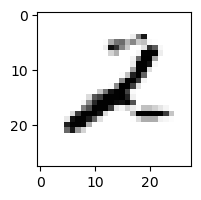

0.01692173636158595% - 0
0.6497808328851209% - 1
99.72999609585723% - 2
0.2102160279378572% - 3
0.07319437938841615% - 4
0.002137460447977399% - 5
0.011758802603419173% - 6
9.86842291563787e-05% - 7
99.83409186683812% - 8 - ОШИБКА
0.0028972910971441974% - 9

 9


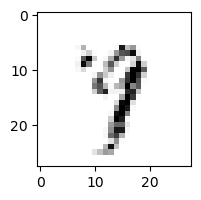

0.009138628099355797% - 0
0.02994041793999919% - 1
0.05978893751549669% - 2
0.43756746760986226% - 3
44.08529452643275% - 4
0.6359818054409324% - 5
0.13202273824110747% - 6
63.65859796934096% - 7 - ОШИБКА
0.5390740104592576% - 8
38.708900858603684% - 9

 2


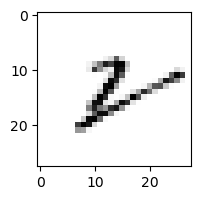

0.7612919934962985% - 0
46.85775848433325% - 1
24.985027402532083% - 2
0.00019905140816351566% - 3
0.3058375939428983% - 4
0.043681346950751966% - 5
73.6294607414687% - 6
0.045939621679678244% - 7
95.2311358011642% - 8 - ОШИБКА
12.07566161886455% - 9

 8


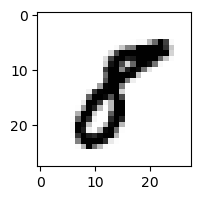

0.01535714524391858% - 0
0.9505452485423428% - 1
9.013736562898327e-06% - 2
3.946501824675443e-05% - 3
0.00017053601463841366% - 4
9.772772855280062% - 5 - ОШИБКА
1.9914457288131974e-08% - 6
0.00017351858038808913% - 7
0.0003340471286823726% - 8
1.1316927268546012e-07% - 9

 2


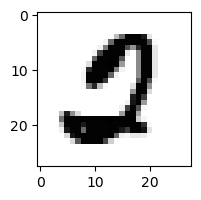

43.24052455116547% - 0
2.290327892216795e-08% - 1
0.005189711245500611% - 2
4.109954864111706e-05% - 3
1.7473031484217537e-10% - 4
80.18519423575546% - 5 - ОШИБКА
3.388061892131402e-05% - 6
0.0002271624475940695% - 7
2.614238359465804e-08% - 8
1.8920267700853862e-14% - 9

 5


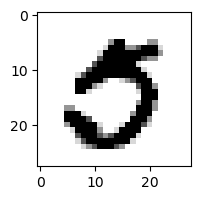

74.0119325207221% - 0 - ОШИБКА
5.709742045773366e-07% - 1
3.0003196956158824e-11% - 2
0.0008317474052707247% - 3
1.5045761936100732e-09% - 4
50.136463810219645% - 5
4.2850022277248775e-10% - 6
0.03538007679614785% - 7
6.517006228049689e-12% - 8
6.778175247048113e-12% - 9

 5


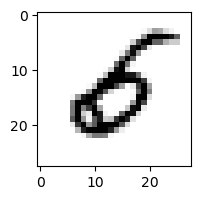

16.589826446781526% - 0
0.004637277773383659% - 1
0.03860871571296995% - 2
0.0001382124800357521% - 3
0.09215650704738028% - 4
0.7914643299846206% - 5
98.55594661729302% - 6 - ОШИБКА
5.1223557505093496e-05% - 7
2.2981529032091118e-10% - 8
4.307862280709696e-06% - 9

 8


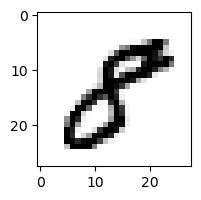

0.01839579454382805% - 0
0.011717383848919556% - 1
2.6965791742059757e-06% - 2
0.003791328548272311% - 3
0.005430735807962387% - 4
11.604826594768628% - 5 - ОШИБКА
3.715549354306407e-08% - 6
0.0002240032396821003% - 7
0.0005400018049616352% - 8
3.5689885862307046e-06% - 9

 9


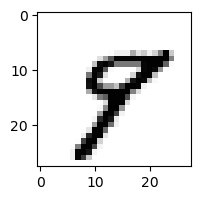

0.0002329983607075626% - 0
0.0204832864494658% - 1
8.016582305650976e-07% - 2
2.3849804353840794e-07% - 3
0.7458437275349963% - 4
1.2651281870194553% - 5
2.3678155668669547e-05% - 6
4.716055155463292% - 7
24.24316481952916% - 8 - ОШИБКА
0.32336876490098426% - 9

 4


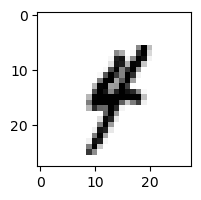

2.5693847402112293e-05% - 0
17.801267236824042% - 1 - ОШИБКА
7.648361160867268e-05% - 2
0.014039566851313615% - 3
6.9612789221207505% - 4
0.09492237315364548% - 5
0.013328472738160678% - 6
0.10126176194492106% - 7
0.00011090630983332067% - 8
0.3287315964480683% - 9

 4


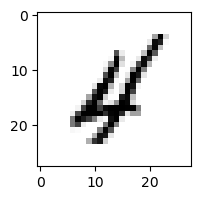

0.052933966635321524% - 0
0.16987749540909838% - 1
1.0045976658483258% - 2
1.9470727575456531e-07% - 3
22.13232576401189% - 4
0.027740588649519407% - 5
1.0264914220514865% - 6
0.010541413714700075% - 7
23.583068473782614% - 8 - ОШИБКА
0.002970328511714149% - 9

 9


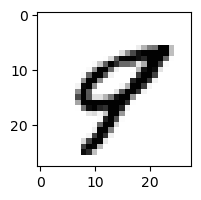

0.02972332396335078% - 0
0.002061117783252162% - 1
9.339799874269571e-08% - 2
1.3456256748813626e-11% - 3
43.21574521353743% - 4 - ОШИБКА
0.014907407865375828% - 5
3.3655149165168155e-05% - 6
4.444127776657293% - 7
0.012026764739403345% - 8
0.4859391185478232% - 9

 9


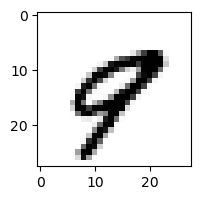

0.04638095630840668% - 0
0.0029255260298291608% - 1
1.3936258736422336e-07% - 2
4.617043291371894e-11% - 3
7.008919480916983% - 4
3.010441690164878e-05% - 5
3.641697155016978e-05% - 6
27.802664615620674% - 7 - ОШИБКА
0.0013760676801117362% - 8
0.02427129037543786% - 9

 8


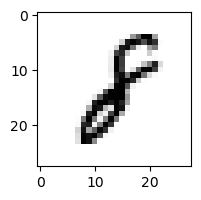

0.0006821294785412323% - 0
81.73328174933397% - 1 - ОШИБКА
3.1431558073494825% - 2
0.0002731549316570899% - 3
0.0007553644285892795% - 4
0.005657105140198154% - 5
0.4171716651097512% - 6
0.001390501995661893% - 7
2.4939701306188033% - 8
0.00029301070146698597% - 9

 4


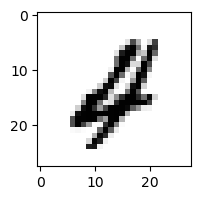

0.12512583998019344% - 0
0.0031546024193961396% - 1
0.6579892920324306% - 2 - ОШИБКА
4.011927012140611e-07% - 3
0.033890804516568895% - 4
0.00040541320588864324% - 5
0.011000965329824246% - 6
0.0009629721016641728% - 7
1.755485799468315e-05% - 8
7.008555732361514e-06% - 9

 5


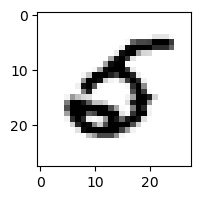

0.5023507595673768% - 0
7.756206797324837e-05% - 1
4.841157104325891e-05% - 2
1.6697788350790554e-11% - 3
0.006824187839988% - 4
0.09039202894230804% - 5
14.595256283488766% - 6 - ОШИБКА
0.0031283013463869447% - 7
1.542947913704673e-14% - 8
5.225364686405468e-10% - 9

 2


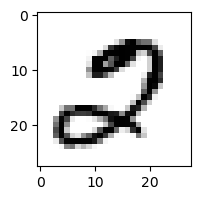

52.33077812144429% - 0 - ОШИБКА
6.488276588189813e-06% - 1
1.6433143205658016% - 2
2.489431984820086e-07% - 3
9.225394115578548e-07% - 4
0.0026009787168498944% - 5
0.0026715909918738237% - 6
0.5543981211030418% - 7
0.0001649939379123839% - 8
7.80898753208107e-07% - 9

 8


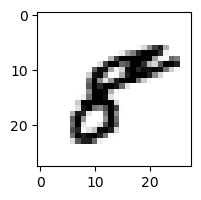

1.524187902009848% - 0
0.006329383524569531% - 1
2.5273022934897478e-05% - 2
9.214524393652182e-07% - 3
0.12135437104877182% - 4
2.1957385938062814% - 5 - ОШИБКА
1.410752503882837e-07% - 6
0.0028943458019376842% - 7
0.040819463562772634% - 8
0.0017747342421096048% - 9

 4


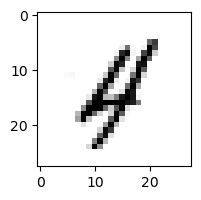

0.060037707570857114% - 0
0.6604675617415857% - 1
0.12269996175535472% - 2
0.00020778524623178113% - 3
4.693729281046663% - 4
0.0182360004448812% - 5
0.21844225368214107% - 6
0.03296614607618802% - 7
21.022429434660424% - 8 - ОШИБКА
0.866019953401213% - 9

 9


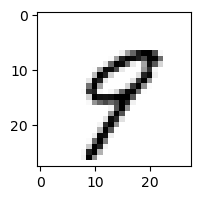

0.015294467507135652% - 0
0.0361069423822451% - 1
3.57772089630963e-05% - 2
0.0012955558887215617% - 3
8.415774283452336% - 4
0.8108990741207849% - 5
0.0017950886723875732% - 6
29.597269642121937% - 7 - ОШИБКА
0.008279064124774369% - 8
7.440486847080306% - 9

 2


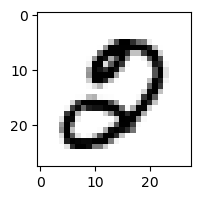

2.361992608295214% - 0 - ОШИБКА
3.5834524753505265e-06% - 1
2.5152089643836295e-05% - 2
7.226499343952588e-07% - 3
4.7326804438575574e-05% - 4
0.022458949810006457% - 5
0.0005062839100183404% - 6
0.005646624849770282% - 7
4.315749361941871e-05% - 8
9.609024457133087e-09% - 9

 5


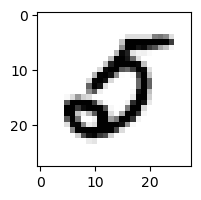

94.64060571359725% - 0 - ОШИБКА
4.333253823417218e-06% - 1
0.03593633956764208% - 2
1.373968045273287e-08% - 3
0.0007020590912019158% - 4
0.008542718887363097% - 5
0.8605545158666761% - 6
0.0018734548028750927% - 7
3.004453220477854e-12% - 8
3.704199677095713e-09% - 9

 5


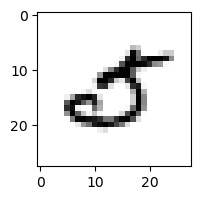

77.92879707587811% - 0 - ОШИБКА
0.003117543358536062% - 1
0.02512078208147846% - 2
0.14639396155858966% - 3
0.22344244426388418% - 4
11.94726186966419% - 5
0.025471206654110876% - 6
0.9973857055055132% - 7
4.8903815813517246e-08% - 8
3.1164867401400394e-06% - 9

 2


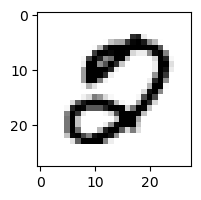

6.482784591480762% - 0 - ОШИБКА
6.356488900646271e-08% - 1
0.0012063334533363968% - 2
4.999518577213281e-11% - 3
0.00015753319520652202% - 4
0.2721419631731338% - 5
0.0021515303828124306% - 6
0.0002187449662654511% - 7
0.0002774223838892091% - 8
2.462214826021384e-10% - 9

 8


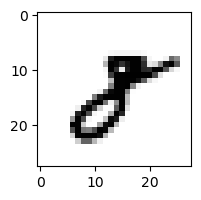

0.007790373398798282% - 0
7.750577442097503% - 1 - ОШИБКА
0.03992793802489926% - 2
0.004464478991783254% - 3
5.702145913963382e-05% - 4
0.0011910491036162382% - 5
2.6240731726551043e-06% - 6
0.088214571706466% - 7
0.21431266577030506% - 8
0.0005288788220001822% - 9

 4


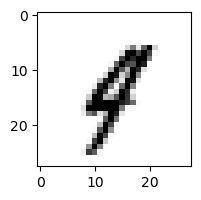

0.0012267709922169653% - 0
8.23478885162829% - 1 - ОШИБКА
0.0013602449837666721% - 2
0.0003853684245171268% - 3
1.923045341454055% - 4
0.008079607138741812% - 5
0.004956051710750045% - 6
0.1842071500758915% - 7
0.037203907555095145% - 8
0.32348626056834% - 9

 2


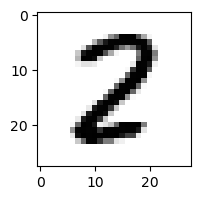

0.0007166990889469124% - 0
0.007552878363432971% - 1
47.844062441015566% - 2
0.00033787388363714954% - 3
8.531671823684973e-07% - 4
0.005324890397604384% - 5
5.24766617714428e-05% - 6
1.7574676632254778e-05% - 7
70.42856559291465% - 8 - ОШИБКА
2.373008231609376e-16% - 9

 9


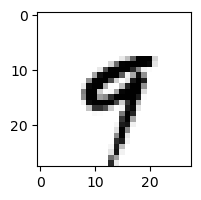

0.0003078960830733401% - 0
0.03585176402765834% - 1
5.885256246871606e-08% - 2
0.0018611933652871921% - 3
62.84537864065523% - 4 - ОШИБКА
0.05016522823324851% - 5
0.005044270265533744% - 6
1.0071946046226599% - 7
1.0081291089549816e-06% - 8
0.09037381408727674% - 9

 2


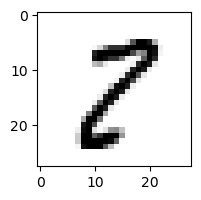

1.1575698670034407% - 0
0.05847802325383329% - 1
0.16479650468143092% - 2
0.498811407078788% - 3
9.037728952889904e-06% - 4
1.8725273120243924% - 5
1.890164811892004e-05% - 6
0.009228043096185398% - 7
99.99802336695303% - 8 - ОШИБКА
0.0056149321435946% - 9

 2


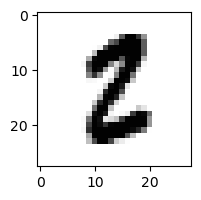

0.0002327796165963111% - 0
0.013413352199994589% - 1
0.028659459582120947% - 2
4.787965505310519e-06% - 3
4.541330409701329e-11% - 4
0.9823348247713661% - 5 - ОШИБКА
0.0003744226598639239% - 6
1.9699118300850056e-06% - 7
0.0009858476808687552% - 8
4.215946417984748e-11% - 9

 4


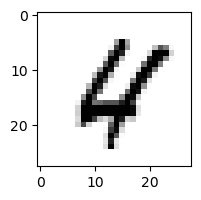

0.03827168674009729% - 0
1.872351876275677e-05% - 1
0.029386317187726108% - 2
3.974376115188288e-12% - 3
23.38026647372314% - 4
0.005591797563706031% - 5
0.08225617818491852% - 6
0.032312762576327834% - 7
38.94751505712152% - 8 - ОШИБКА
0.004586926393916298% - 9

 2


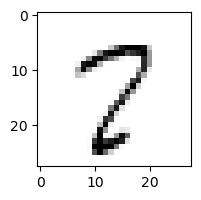

3.4050042135307748% - 0
0.02046734284809365% - 1
0.5656599121859642% - 2
0.16408273500049295% - 3
0.01574062871248243% - 4
28.69018917838161% - 5
0.0020227772457372347% - 6
70.7999317773494% - 7
99.78067797522199% - 8 - ОШИБКА
36.60846233957496% - 9

 3


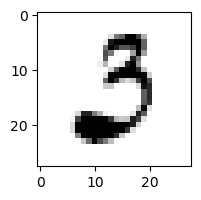

95.96290744481294% - 0 - ОШИБКА
0.03149321378192767% - 1
5.395974236460091% - 2
19.815240256415077% - 3
4.726350300670542e-09% - 4
1.1778468565757094% - 5
0.08912331014498415% - 6
0.0030105114713909666% - 7
4.512313803635338e-05% - 8
2.7288396758519855e-14% - 9

 2


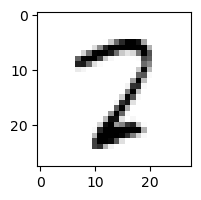

1.3987501542544276% - 0
0.002375835925974003% - 1
31.560596496203274% - 2
0.18797440909932345% - 3
0.031435061985736854% - 4
10.022204909340724% - 5
0.004394404547830647% - 6
1.7112101785286358% - 7
55.39933401583122% - 8 - ОШИБКА
3.592266195723667e-08% - 9

 2


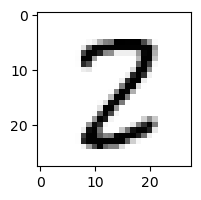

0.006758684118373482% - 0
0.006382724462114671% - 1
6.939960799349078% - 2
0.08550434568601274% - 3
0.0008955378269892497% - 4
0.6406440845522717% - 5
1.2477780544195178e-06% - 6
0.011638804234022044% - 7
99.07845269418802% - 8 - ОШИБКА
1.618341221459538e-12% - 9

 9


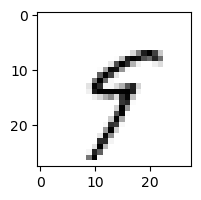

0.025481229600768922% - 0
2.526291890450606% - 1
0.00044013512188512274% - 2
2.0333228084448414% - 3
48.22687578452115% - 4 - ОШИБКА
36.52666955989475% - 5
0.060357221556315045% - 6
13.500419048452288% - 7
0.10806095836110566% - 8
0.6535442900167543% - 9

 6


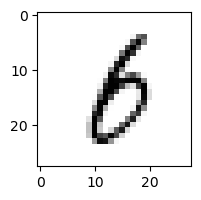

0.2571816094880485% - 0
6.066390400919617% - 1
0.019524920709342006% - 2
10.50074550461974% - 3
0.0014541990503068138% - 4
2.814050331923173% - 5
45.71184305963663% - 6
0.0011952524112723343% - 7
94.97881691770877% - 8 - ОШИБКА
0.7729336210702071% - 9

 2


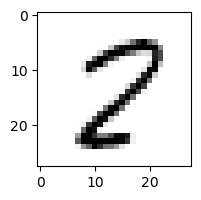

3.0691107739155723% - 0
0.00677601434681779% - 1
0.4055137252577899% - 2
1.1829915050016978e-06% - 3
0.0018300520842563443% - 4
6.56188430995051% - 5
0.00015176412160115347% - 6
1.7187922023327216% - 7
99.97862518177708% - 8 - ОШИБКА
5.133358433272902e-05% - 9

 2


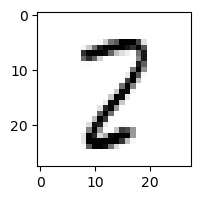

0.14400986482538078% - 0
0.2071291841647712% - 1
5.736593528381054% - 2
0.7198349940461686% - 3
0.009074865421018973% - 4
1.400567440451894% - 5
0.000593130672040834% - 6
0.9011723232643659% - 7
99.9640367925552% - 8 - ОШИБКА
9.36783071813344e-08% - 9

 2


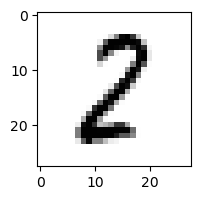

0.21522663716844725% - 0
3.117803428278889% - 1
72.64951471788874% - 2
0.09594690802515442% - 3
1.569791511676865e-05% - 4
0.19023733391261366% - 5
0.015090907962447532% - 6
0.00021720452189651526% - 7
90.6935339777886% - 8 - ОШИБКА
2.549873413013222e-09% - 9

 5


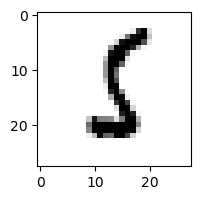

0.009044214617369267% - 0
3.402043306557312% - 1
1.397552374377226% - 2
0.18473493294278615% - 3
6.709928807447235e-07% - 4
16.494506842767144% - 5
84.93935429440525% - 6 - ОШИБКА
0.0004220090654034628% - 7
0.00016318863730430084% - 8
1.0045230470131715e-07% - 9

 6


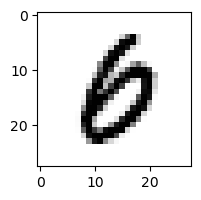

1.219416206944194% - 0 - ОШИБКА
2.1865595547615073e-05% - 1
0.00029464868962096494% - 2
0.00016479791683910014% - 3
0.0007095938057972814% - 4
0.009404193997591043% - 5
0.6712994606223445% - 6
3.5913948454412346e-05% - 7
0.0035784202835643236% - 8
0.00038528874163207993% - 9

 9


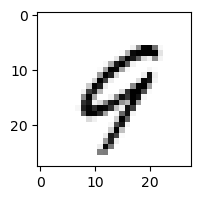

0.3226017207760015% - 0
0.0035293208717737533% - 1
0.002765455946531274% - 2
8.100152780501248e-07% - 3
59.808826564193474% - 4 - ОШИБКА
0.0045433897273301745% - 5
2.0226217203693593% - 6
1.6133654644841782% - 7
0.0016777448594181908% - 8
1.338449853834366% - 9

 9


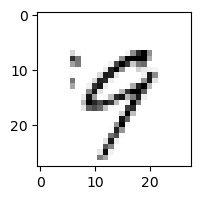

1.2198150241886503% - 0
0.007410872872087176% - 1
0.0012570412426323972% - 2
0.059253819134158864% - 3
34.01748507401313% - 4 - ОШИБКА
0.13423234609838486% - 5
0.3280848003684948% - 6
17.63920826091984% - 7
0.0016308389122507746% - 8
20.250344028598725% - 9

 8


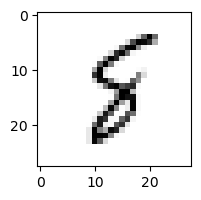

0.00694555446603458% - 0
1.1501453538392608% - 1
0.0711290930648419% - 2
0.0006178399620866423% - 3
0.6751685573186947% - 4
13.084292442064264% - 5
89.11435174743832% - 6 - ОШИБКА
0.03168584684836652% - 7
61.321585916121414% - 8
0.2589961952800266% - 9

 2


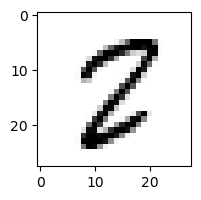

0.027239693823303955% - 0
0.01068842351730226% - 1
0.08842627857265696% - 2
0.00011532032554855869% - 3
2.1258950709470464e-05% - 4
9.929617251643618% - 5
0.007446975812986409% - 6
0.01367689509520555% - 7
97.13992061825924% - 8 - ОШИБКА
1.0853361301235912e-06% - 9

 9


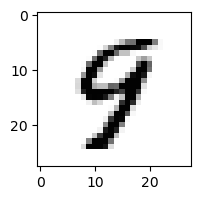

0.001767941110023787% - 0
0.00010129550830122217% - 1
9.327665165587902e-06% - 2
6.45661171332679e-06% - 3
13.33217791162851% - 4 - ОШИБКА
3.0083560001788623% - 5
0.020442908645984227% - 6
0.002187698480597093% - 7
0.03989903823517785% - 8
0.632524244147896% - 9

 3


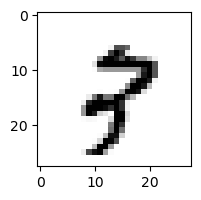

0.006728085559243301% - 0
0.015793248765033362% - 1
0.18814042323734637% - 2
1.740266142556769e-07% - 3
0.0048711822639515385% - 4
8.046184644390197e-06% - 5
0.0011966052287004825% - 6
14.942109802076045% - 7
20.34213732384778% - 8
88.87147015601357% - 9 - ОШИБКА

 5


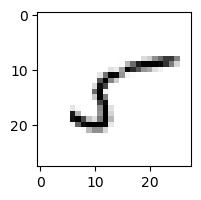

68.21293507272506% - 0
0.7012248679525117% - 1
18.51929052984603% - 2
9.40034281369395% - 3
2.447048288720155% - 4
99.72210379007397% - 5
1.6683112909542566% - 6
0.8999267979970178% - 7
99.90548029599914% - 8 - ОШИБКА
0.01942385039246824% - 9

 1


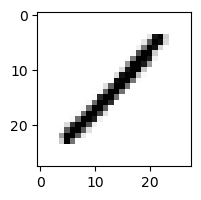

0.6035996539260443% - 0
94.75135432533258% - 1
25.923377590633507% - 2
10.758943727138712% - 3
0.18673057138857663% - 4
0.4097216518982793% - 5
0.00371122597381108% - 6
0.004832043007561912% - 7
96.44298838384049% - 8 - ОШИБКА
0.17180380658919983% - 9

 7


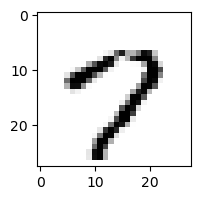

4.28621681662754% - 0
3.857251195409693e-06% - 1
5.732355425133624e-08% - 2
3.2850217951655873e-07% - 3
0.07281873728737442% - 4
4.352341084974151% - 5
0.002479073427708193% - 6
90.74834619239624% - 7
0.4987707984929874% - 8
98.32837496140925% - 9 - ОШИБКА

 3


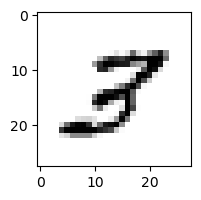

0.12133754958102401% - 0
0.05457116549416807% - 1
23.90253704411476% - 2 - ОШИБКА
0.15147065133208157% - 3
0.0010802671171857145% - 4
0.677368385233094% - 5
0.0001201010887013557% - 6
0.7306833533390077% - 7
13.340959602335042% - 8
0.008571447813076854% - 9

 5


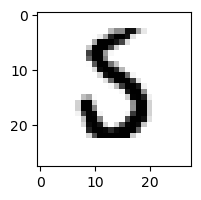

0.012896789359311852% - 0
0.0008709556541569606% - 1
0.26858594122841273% - 2
0.0191596825243624% - 3
1.2119321828409637e-05% - 4
0.43684916726984735% - 5
28.306689719468793% - 6 - ОШИБКА
0.012515914102954537% - 7
3.213411836972531e-07% - 8
1.5130885923449523e-12% - 9

 3


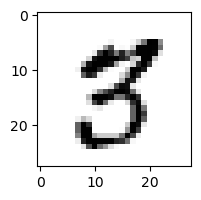

0.008275872490222755% - 0
0.0007191932243940218% - 1
0.00036674749265403064% - 2
0.006987230960411357% - 3
0.00018926330376143396% - 4
64.4106801804482% - 5 - ОШИБКА
1.4519123638333887e-07% - 6
0.01685321361626975% - 7
0.19787038808671606% - 8
4.8206469023677615e-05% - 9

 3


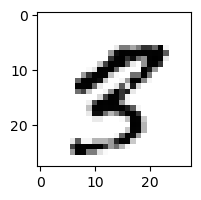

1.1068152336566352e-05% - 0
0.0032859069180499185% - 1
2.435949915912507e-11% - 2
3.0677305366477505e-09% - 3
0.02226607467430224% - 4
0.02873051362233675% - 5
1.1237582164254716e-06% - 6
0.6284470361763655% - 7 - ОШИБКА
0.52180105712401% - 8
0.39739812475646447% - 9

 9


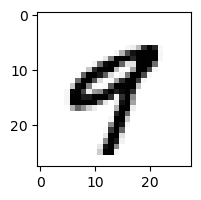

0.002233857685706115% - 0
0.0010429065311160608% - 1
3.7254833693670283e-10% - 2
2.6728959345950805e-08% - 3
18.67125927478765% - 4 - ОШИБКА
0.03131279585286694% - 5
7.98080060718339e-06% - 6
0.06688271879754823% - 7
2.4758988782410834e-07% - 8
12.136047403974066% - 9

 4


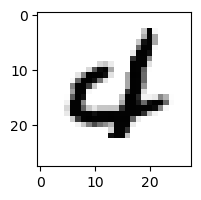

1.337979050759889% - 0
6.099226651798409e-06% - 1
1.532426556979065e-06% - 2
1.1898578627434559e-11% - 3
17.623796107926047% - 4
0.0050165431384168405% - 5
19.404898140977803% - 6 - ОШИБКА
0.12207147223492053% - 7
3.0562059337870314e-13% - 8
2.9208425481588924e-09% - 9

 2


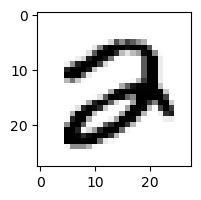

0.506301549358002% - 0 - ОШИБКА
2.6293317026799885e-08% - 1
0.15858476830066404% - 2
7.717778103490621e-05% - 3
3.138232596861945e-06% - 4
0.001973330626154792% - 5
0.0008582875131885902% - 6
0.003033852629737063% - 7
0.0004992127797568555% - 8
2.3003021985222708e-10% - 9

 7


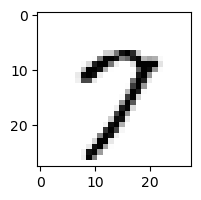

2.0781802250770993% - 0
0.00026680936591238005% - 1
0.0005789608001637551% - 2
0.00024108251098782022% - 3
0.06980237298368568% - 4
3.4838120555130727% - 5
0.0018784975217886414% - 6
94.4545644922839% - 7
32.37831306859328% - 8
98.1161904239619% - 9 - ОШИБКА

 8


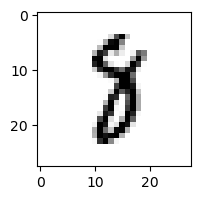

4.1272270461805764e-05% - 0
2.8963614157475224% - 1
0.005130315437409282% - 2
0.013932835930627835% - 3
0.0006630422399121982% - 4
0.7763953062985697% - 5
0.001020210954840021% - 6
4.707365224401077% - 7 - ОШИБКА
5.015025110828166e-05% - 8
8.346345033099666e-08% - 9

 5


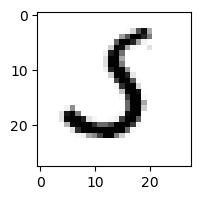

0.03821756841262484% - 0
0.035230175319036515% - 1
46.61409369640453% - 2
49.7524624088035% - 3 - ОШИБКА
2.605039601168914e-06% - 4
3.566534687028838% - 5
3.1540510662990915% - 6
0.03045674068931861% - 7
7.82216163326709e-10% - 8
1.230925629962655e-09% - 9

 3


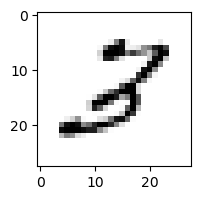

0.3087209553787548% - 0
0.02305284034445769% - 1
98.63558010688851% - 2 - ОШИБКА
9.074178614597892% - 3
0.006261545188092113% - 4
1.9934444839297203% - 5
0.012250974280405232% - 6
0.01905354834071918% - 7
49.19589162421028% - 8
0.0848949865675139% - 9

 5


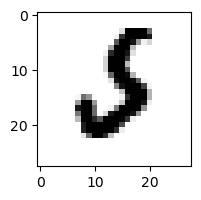

0.007867879260648115% - 0
0.0036693208591078203% - 1
1.0426038428575415% - 2
2.38607981540509e-06% - 3
6.481268734716002e-06% - 4
0.0009609830184048219% - 5
39.9890787255059% - 6 - ОШИБКА
0.024655823047450762% - 7
2.6001399987015608e-14% - 8
9.334326985556911e-09% - 9

 3


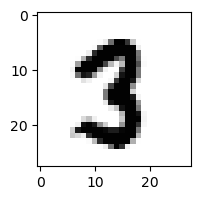

2.419366478278108e-06% - 0
0.0010543583785320892% - 1
0.00010459380970661406% - 2
0.00020146781505165398% - 3
1.1634720161032119e-07% - 4
2.7679988540426193% - 5 - ОШИБКА
3.2737573406514085e-08% - 6
0.001831704358976961% - 7
0.001037550666513999% - 8
7.790975033996308e-11% - 9

 8


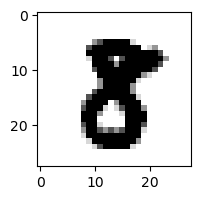

4.795722941576753e-06% - 0
2.922512591833322e-07% - 1
2.8580012214795954e-08% - 2
3.1125312365268685e-06% - 3
2.2763827128142573e-09% - 4
0.014397006097996386% - 5 - ОШИБКА
2.900668810152876e-13% - 6
3.903366725602358e-06% - 7
0.0013200557215220679% - 8
7.130138736668161e-16% - 9


Общая доля ошибок: 13.62863713628637%


In [152]:
errs = 0
for k in range(len(X_test)):
    ans = np.empty((0,10))
    for j in range(10):
        ans = np.append(ans,f(neursum(X_test[k],w[:,j],w0[j])))
    if (ans.argmax() != ansbase_test[k].argmax()):
        errs += 1
        print('\n',y_test[k])
        plt.figure(figsize=(2, 2))
        plt.imshow(X_test[k].reshape(28, 28), cmap=plt.cm.Greys)
        plt.show()
        for i in range(len(ans)):
            if i == ans.argmax():
                print(ans[i]*100,'%',' - ',i," - ОШИБКА",sep="") 
            else:
                print(ans[i]*100,'%',' - ',i,sep="") 
print("\n\nОбщая доля ошибок: ",errs/(len(X_test)+1)*100,'%',sep="")   

# Изменение диапазона случайных чисел для изначальной матрицы весов

In [153]:
w = np.random.uniform(-0.5,0.5,(784, 10))
w0 = np.random.uniform(-0.5,0.5, (10,))

In [154]:
iterations = 100000
eta = 0.05
for i in range(iterations):
    pos = random.randint(0,len(X_train)-1)
    for j in range(len(ansbase[pos])):      
        sm = neursum(X_train[pos],w[:,j],w0[j])
        res = f(sm)
        sigm = - (ansbase[pos][j] - res)*f_d(sm)
        for k in range(len(X_train[pos])):
            w[k][j]+= - eta * sigm * X_train[pos][k]
        w0[j] += eta * sigm
    clear_output()
    print((i+1)/iterations*100, end='%')
    

100.0%


 5


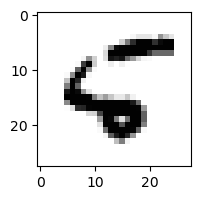

0.004883846255973675% - 0
0.00019460476369516445% - 1
0.07703636925675439% - 2
3.293134874861848e-14% - 3
0.15873667434456684% - 4
0.038341388516624386% - 5
2.909015093215115% - 6 - ОШИБКА
9.000762611320867e-06% - 7
7.003797559205344e-11% - 8
5.559981375091968e-06% - 9

 4


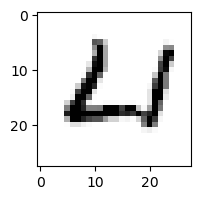

15.842366451052442% - 0
3.154012598685869e-07% - 1
12.558928790122422% - 2
6.162207244172066e-12% - 3
9.250367690799148% - 4
0.00872865424107788% - 5
80.4978429157864% - 6 - ОШИБКА
0.0011248207800523054% - 7
0.003381775652462785% - 8
4.379831345282679e-06% - 9

 3


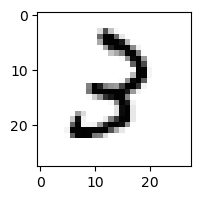

0.005878992967870853% - 0
0.007016488311709645% - 1
80.94881842570315% - 2 - ОШИБКА
45.05878638915534% - 3
0.0007405232854774859% - 4
0.058811398443536875% - 5
0.009639445844041337% - 6
5.5042873997478386e-05% - 7
0.0020041913555542234% - 8
0.003105475042226612% - 9

 6


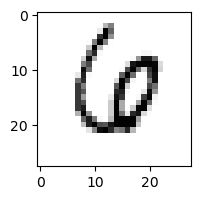

0.0010789637666896322% - 0
0.000674751803670103% - 1
0.04567779812901781% - 2
0.0027278781643719787% - 3
0.25222660201350056% - 4
0.00033495912217941347% - 5
0.14513064666382486% - 6
1.5949928397742144% - 7 - ОШИБКА
3.831099229256895e-08% - 8
1.983437159267677e-07% - 9

 9


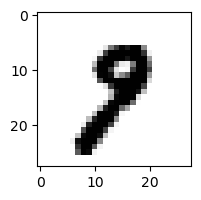

1.9478335831405903e-05% - 0
0.025639355418587795% - 1
0.00010199758129507502% - 2
9.904968646971157e-05% - 3
1.8355444570642408e-07% - 4
0.0002256856824760927% - 5
5.151436498810372e-07% - 6
1.7103677412264569% - 7 - ОШИБКА
0.0001982892430851381% - 8
0.16875836827902926% - 9

 8


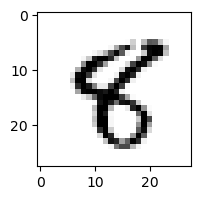

1.2826067225055675e-05% - 0
0.007740833090737724% - 1
0.00010248120559288372% - 2
3.10048902413396e-07% - 3
0.10449714256347464% - 4
6.853847625235742% - 5 - ОШИБКА
2.71771945498712e-05% - 6
5.4643802128888266e-05% - 7
0.0023405130660476966% - 8
0.00017559829850178604% - 9

 9


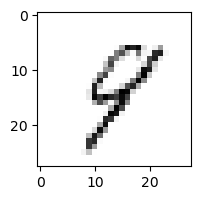

0.1445672207772618% - 0
0.8915334543603736% - 1
1.771577675841451% - 2
0.6741917341267449% - 3
68.23560926502653% - 4
1.4571243319327567% - 5
1.0807961891539213% - 6
14.108941128889327% - 7
95.24727412110398% - 8 - ОШИБКА
92.48928809339098% - 9

 7


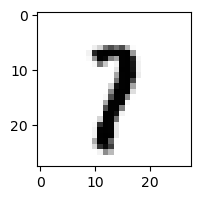

4.12541392024502e-06% - 0
35.913717605527964% - 1 - ОШИБКА
0.33884959281386634% - 2
0.03380612523650643% - 3
0.0003757772287483037% - 4
0.009476268563503188% - 5
0.00027063178456870614% - 6
14.13062905342489% - 7
0.0033098873529643293% - 8
0.23507313539929942% - 9

 7


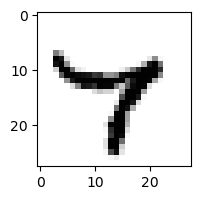

8.698437060168857e-06% - 0
0.0002741896539349837% - 1
1.6615061003032365e-11% - 2
7.365544218872563e-05% - 3
85.86085497669357% - 4 - ОШИБКА
0.0003075245155902425% - 5
0.006395210937077242% - 6
19.341381804101022% - 7
0.04780269047227005% - 8
2.650371482587886% - 9

 2


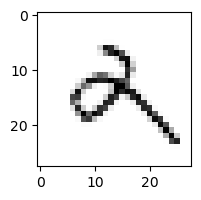

0.012920744261952992% - 0
10.705799045340608% - 1
0.10381035718684532% - 2
0.4358674819457896% - 3
2.716142883999596% - 4
0.02031456403594169% - 5
3.461155053246884% - 6
0.002935194613763033% - 7
0.0125003479759819% - 8
97.22590777766446% - 9 - ОШИБКА

 9


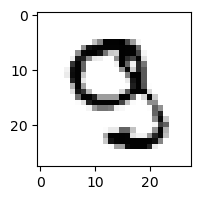

0.0004849457054669645% - 0
1.7356478104967486e-05% - 1
0.06545608087818934% - 2 - ОШИБКА
0.002172395430746636% - 3
0.01604735643778967% - 4
0.0032832754631673005% - 5
2.875897380107702e-07% - 6
0.00927497266148922% - 7
1.0810688420370939e-06% - 8
0.0001256781680314711% - 9

 5


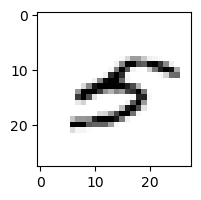

0.12625797289509327% - 0
0.22555132516643298% - 1
0.0019427713777331057% - 2
0.4169415490682989% - 3
12.569590106582046% - 4 - ОШИБКА
11.662850021740025% - 5
0.20373666735311727% - 6
0.007654154020646971% - 7
4.996529575963443e-07% - 8
0.00020751073321610865% - 9

 7


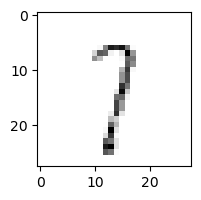

0.11442131559990112% - 0
25.732881836954252% - 1
31.22872259739505% - 2
86.96766740307484% - 3
7.827578142321942% - 4
13.186235975946406% - 5
1.9770925512262019% - 6
85.28574626491249% - 7
85.91997185188335% - 8
98.83420392384139% - 9 - ОШИБКА

 5


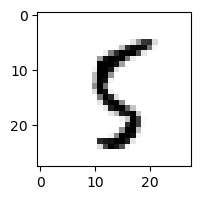

0.015065776728475885% - 0
0.12422260919815534% - 1
0.023153166135050425% - 2
0.007660240349832028% - 3
0.11846014213088138% - 4
83.80955625903749% - 5
0.22660875878570919% - 6
0.02950556546764096% - 7
83.94288901564886% - 8 - ОШИБКА
0.5272209633927266% - 9

 9


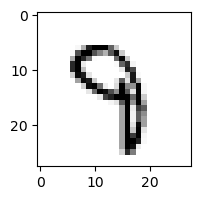

6.844680292101815e-07% - 0
0.002191592091216187% - 1
0.0015687718437503828% - 2
3.4127839196292467% - 3
11.587576084770697% - 4 - ОШИБКА
0.11354931793394493% - 5
0.030020658133344907% - 6
2.52406119119875% - 7
7.5873558128253555e-06% - 8
0.052729749015180565% - 9

 6


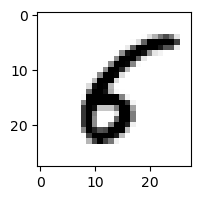

0.056160433109935196% - 0
0.03340540079145046% - 1
0.008323186862359336% - 2
6.9111266481211095e-06% - 3
0.051926884631919454% - 4
59.09123238539831% - 5 - ОШИБКА
0.1874918953838669% - 6
6.767393668018086e-06% - 7
9.168456921281683e-05% - 8
1.0192541496372425e-06% - 9

 8


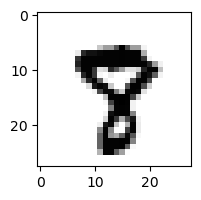

5.829595821506304e-07% - 0
3.560955622634657e-07% - 1
3.6585587291127275e-07% - 2
3.1268594567689346e-08% - 3
4.1996367026283e-06% - 4
0.0033177384993561044% - 5
1.1168469694262866e-08% - 6
26.78754782525402% - 7 - ОШИБКА
0.004975108352021502% - 8
0.0009447991142564273% - 9

 9


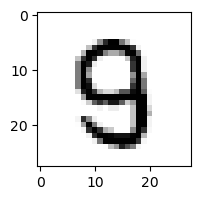

0.0037328882751685687% - 0
3.334740174096305e-06% - 1
0.0009099656753983816% - 2
0.1447398531444788% - 3
0.011153611997518685% - 4
2.1821523997841377% - 5 - ОШИБКА
3.190356810076994e-05% - 6
0.0010733140263706877% - 7
0.00013595335880455423% - 8
1.9989906278808163e-08% - 9

 3


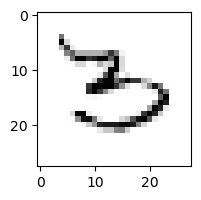

1.4509059215015732% - 0
0.006915316809667922% - 1
0.31705339430927976% - 2
88.66591370716719% - 3
0.0010878018576485058% - 4
22.387171415605362% - 5
99.79089404496048% - 6 - ОШИБКА
0.012620774031498803% - 7
0.004846833495153563% - 8
0.0004264476825858096% - 9

 4


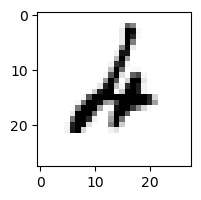

0.00015434500555636452% - 0
0.14695899893717143% - 1
19.445964159602788% - 2 - ОШИБКА
0.0003427832390511765% - 3
0.4884068992725958% - 4
0.00031389132452746133% - 5
11.348684228831901% - 6
2.849942481107427e-05% - 7
2.628037559295668e-05% - 8
0.02696186835130623% - 9

 8


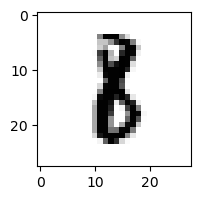

5.336078706995538e-06% - 0
3.6369785217299735% - 1 - ОШИБКА
0.1270549553517782% - 2
0.001930479373391316% - 3
5.4650577616923283e-08% - 4
0.023677988316514742% - 5
0.032709175500358886% - 6
4.578979159994518e-06% - 7
0.011265617235253355% - 8
2.8143027580503566e-08% - 9

 6


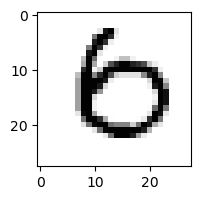

86.12819494635241% - 0 - ОШИБКА
3.3956189581072477e-07% - 1
0.00011863035581547351% - 2
5.97927225846578e-05% - 3
0.0007385614964840206% - 4
2.0977644088346408e-05% - 5
21.03724082868324% - 6
0.0013041198686530495% - 7
6.032673756005767e-10% - 8
1.5867660835494936e-09% - 9

 8


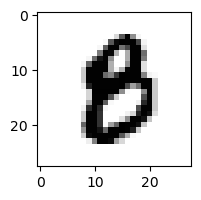

0.010438841696191133% - 0
2.627708920228867e-06% - 1
2.5760629212364796e-06% - 2
3.9987027338821875e-05% - 3
3.764064641884186e-08% - 4
0.14234427823671172% - 5 - ОШИБКА
0.00847081964115522% - 6
5.649355803966148e-08% - 7
0.001876161681529278% - 8
3.01381528088273e-10% - 9

 8


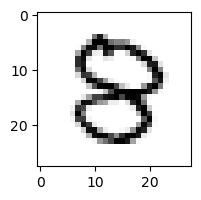

0.009773097267525682% - 0
1.623694953585864e-07% - 1
0.009255501276103247% - 2
0.4407394224985285% - 3 - ОШИБКА
0.12723908079370544% - 4
0.08191431196776246% - 5
9.282795258052526e-06% - 6
2.9139906103713887e-05% - 7
0.008639611830253642% - 8
7.852665415716911e-08% - 9

 9


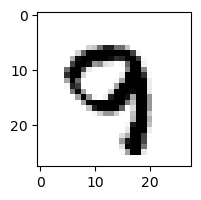

6.487438776107342e-09% - 0
7.129235411632728e-05% - 1
0.0002674827749913051% - 2
5.997836873323486e-07% - 3
0.008949085850326078% - 4
8.31651199715526e-06% - 5
1.6291168999469564e-06% - 6
0.8920821648400671% - 7 - ОШИБКА
1.6828698675287082e-08% - 8
0.17664241308645134% - 9

 8


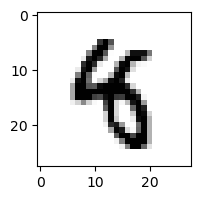

2.8999961831880936e-08% - 0
0.03498904592834934% - 1
2.0662660012545417e-06% - 2
7.7218862433384e-05% - 3
7.6751905039186274% - 4 - ОШИБКА
0.42625611507455097% - 5
0.0001530507611124238% - 6
1.3812189582399319e-05% - 7
1.6543846149269788e-14% - 8
3.0782550520854244e-06% - 9

 4


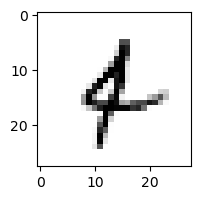

0.0015024148778032553% - 0
3.9995758912211308% - 1 - ОШИБКА
0.009405800738907299% - 2
0.0023020944403957023% - 3
2.947103655377485% - 4
0.06675364735670503% - 5
3.4930825766515032% - 6
0.018127998385701245% - 7
2.621869945465961e-06% - 8
0.21039176122438866% - 9

 2


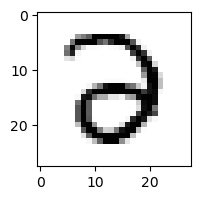

2.7675733425702953% - 0
4.7042136319539316e-07% - 1
11.073102384210728% - 2
63.86778831798969% - 3 - ОШИБКА
0.0019525143820041926% - 4
3.0417146437548543e-05% - 5
0.02675290681334936% - 6
1.648826706973306e-06% - 7
3.943281198655544e-06% - 8
6.2266653475975685e-12% - 9

 9


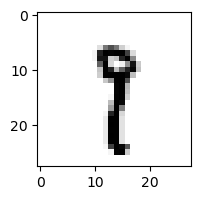

1.1457613668162947e-05% - 0
60.60899805861118% - 1 - ОШИБКА
0.001575112093212176% - 2
0.1156187045754346% - 3
0.0005125087982789341% - 4
0.15441699793145838% - 5
0.001414641697063903% - 6
46.23396936161204% - 7
0.021459875350957607% - 8
0.7156032461990877% - 9

 2


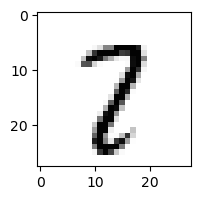

0.0008626515077500776% - 0
0.75000811535641% - 1
0.30825196522745474% - 2
0.049261103025066214% - 3
0.0011917593571402001% - 4
0.3364407493880348% - 5
0.00028207220602547453% - 6
81.53743763536961% - 7 - ОШИБКА
3.0708388766280574% - 8
0.11081910081756965% - 9

 4


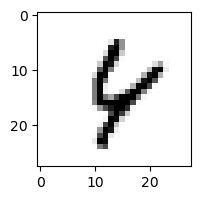

0.0004758245113082844% - 0
0.00199229879527651% - 1
0.258966782080096% - 2
8.122624784035929e-06% - 3
44.90286168411115% - 4
0.008654281502243406% - 5
1.1863594799718296% - 6
0.4829750395628584% - 7
70.22600317786942% - 8 - ОШИБКА
63.77486307260507% - 9

 5


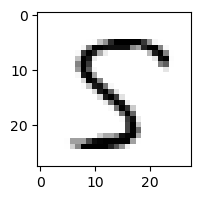

0.003392149255606283% - 0
0.0005679045194333859% - 1
0.0007136736115904167% - 2
0.01652026452996338% - 3
28.418725842938624% - 4
99.75783438527858% - 5
0.00023768890628818117% - 6
0.0005722316803250818% - 7
99.96848148640899% - 8 - ОШИБКА
2.671431518059687e-10% - 9

 9


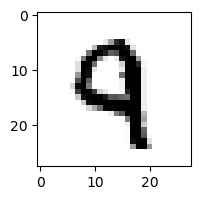

4.738589593142633e-06% - 0
2.9725112644966072e-05% - 1
0.030118200149293044% - 2
3.2036332864520415e-05% - 3
11.973127358610945% - 4 - ОШИБКА
0.0009588885051623321% - 5
0.00019870630640625976% - 6
0.007402142780933768% - 7
5.209823086837382e-09% - 8
0.8254184254037376% - 9

 8


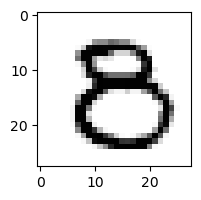

0.057011131192892375% - 0
1.8622711080249762e-09% - 1
0.0028565132184095775% - 2
0.003045508363212118% - 3
0.0015307067210146423% - 4
0.6342273670983707% - 5 - ОШИБКА
1.2973644358521084e-07% - 6
1.5174540034434042e-06% - 7
0.5480897625847788% - 8
5.149324659436503e-06% - 9

 5


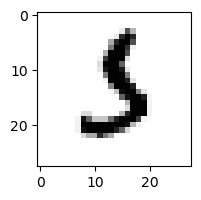

0.0002578423777834436% - 0
0.22666694436908216% - 1
0.1375134016910113% - 2
26.61880172368677% - 3 - ОШИБКА
1.4487578651875307e-08% - 4
1.242902520239671% - 5
0.6934619018761914% - 6
0.024068074191012038% - 7
3.8337022391277275e-09% - 8
6.889352009896628e-08% - 9

 8


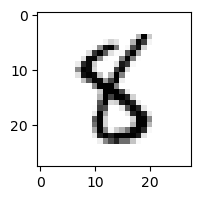

9.106275024682227e-05% - 0
0.009826463073297532% - 1
0.0009999894729796036% - 2
0.0016818735293068461% - 3
0.0018714895177668145% - 4
26.368167266431254% - 5 - ОШИБКА
0.19798770367695034% - 6
4.361745063714453e-06% - 7
2.599666384177118% - 8
2.2775114608602025e-06% - 9

 3


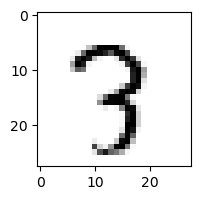

2.794021792639197e-05% - 0
0.008245030530402162% - 1
0.1985240487382397% - 2
23.989757577335254% - 3
0.013265757217920695% - 4
0.03127637107115602% - 5
0.001360183122570409% - 6
28.986655180116323% - 7 - ОШИБКА
4.467203618262911% - 8
0.2209537093390232% - 9

 5


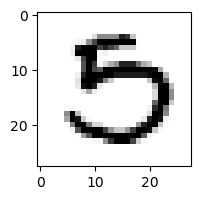

3.6285155592515195% - 0 - ОШИБКА
1.3130378821330939e-07% - 1
0.00021553695035299802% - 2
0.13080543285397533% - 3
1.2659259536102267e-08% - 4
0.0001871582801444954% - 5
3.340199617695294e-07% - 6
0.000415656762491237% - 7
3.5837649401806096e-06% - 8
9.804558923826985e-18% - 9

 9


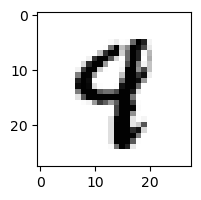

7.531643529086279e-07% - 0
0.001708322851034475% - 1
3.161409767636205e-05% - 2
3.7495775505200983e-06% - 3
3.566554195493979% - 4 - ОШИБКА
0.017995883322088232% - 5
0.0003216418372878089% - 6
0.011816957705618416% - 7
1.5753829497668254e-06% - 8
0.023533330128939253% - 9

 2


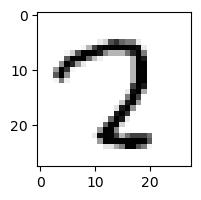

0.029258285666408666% - 0
1.1608940881925747e-05% - 1
5.8393105235799965% - 2
0.7244272311660735% - 3
0.06090097275752897% - 4
0.047470036699030535% - 5
2.6737359215933107e-06% - 6
26.01878971606404% - 7 - ОШИБКА
0.8328510215402031% - 8
9.689190135922105e-07% - 9

 8


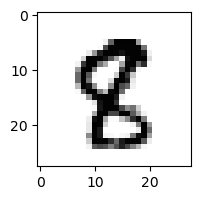

9.85579515292232e-06% - 0
0.0008343630550459411% - 1
0.0036629800622317065% - 2
1.5440296204026162e-07% - 3
8.207837446036053e-06% - 4
0.43453956267925176% - 5 - ОШИБКА
5.996020125056774e-08% - 6
1.2364407401986938e-05% - 7
0.0013000124694832243% - 8
1.519321671070838e-06% - 9

 9


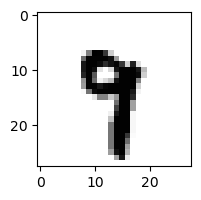

1.4941064830075207e-09% - 0
0.05526051853785792% - 1
4.354696112534714e-07% - 2
1.3305138441868731e-05% - 3
0.6579627782049622% - 4
0.016101507345844777% - 5
0.0010246399021768932% - 6
1.588953279198208% - 7 - ОШИБКА
1.5425722896705325e-05% - 8
0.0022621871052655217% - 9

 8


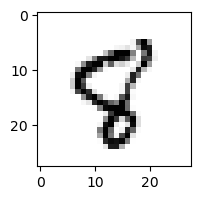

0.0022951479578833165% - 0
0.0025920537384637103% - 1
0.01041867346888215% - 2
3.0501651539115396e-08% - 3
0.06806495972832424% - 4
13.7988942187993% - 5 - ОШИБКА
0.01620364319082417% - 6
0.20694115036963015% - 7
0.009658436509002602% - 8
0.09315932522621069% - 9

 5


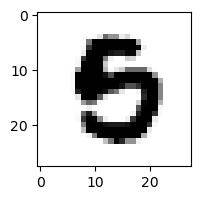

0.0032941865456938856% - 0
4.702513462438235e-10% - 1
2.7400685230694287e-08% - 2
3.141938932848964e-05% - 3
2.1644059482694828e-08% - 4
0.04033351353010138% - 5
0.14288932677047034% - 6 - ОШИБКА
1.1530760874998053e-08% - 7
1.3013782750228355e-10% - 8
5.107140602264846e-13% - 9

 9


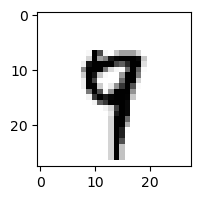

2.479881159956393e-07% - 0
0.014010588012940058% - 1
0.0002539023941377972% - 2
3.894959046951959e-06% - 3
0.8647007328693547% - 4
0.13526940734194218% - 5
0.0006519317574977655% - 6
4.368736706085502% - 7 - ОШИБКА
6.781440489024751e-05% - 8
1.8138015236434244% - 9

 4


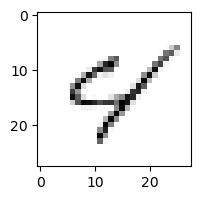

0.29921578933943427% - 0
0.06231147072440826% - 1
0.15066196840897023% - 2
2.399068609903741e-06% - 3
93.02767074181747% - 4
8.550558385198114% - 5
3.6519958753071515% - 6
5.283646293206685% - 7
28.23684177563985% - 8
95.3892390242039% - 9 - ОШИБКА

 8


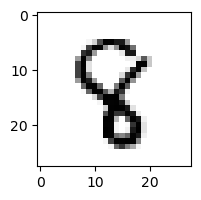

2.22498486110276e-08% - 0
0.018399472254977157% - 1
0.0011022172192271331% - 2
0.00042360415751296% - 3
3.7293291850203962% - 4 - ОШИБКА
0.7290676425726818% - 5
0.0024024732985202996% - 6
0.0017593377203029821% - 7
0.0025501398678984565% - 8
3.603888522495e-07% - 9

 8


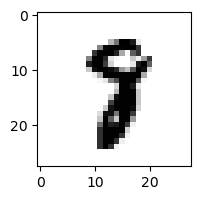

2.632623020797552e-07% - 0
0.02259715735756662% - 1
0.0029258353547550616% - 2
8.466377296193353e-05% - 3
7.537951082670159e-05% - 4
0.005210620228004453% - 5
6.983070392413998e-06% - 6
3.281031063531481% - 7 - ОШИБКА
0.006001019999371849% - 8
1.1601565704047046e-08% - 9

 0


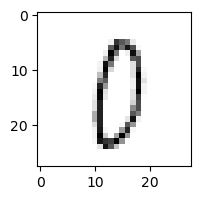

95.40456596325441% - 0
0.017503127823477477% - 1
2.268688886721289% - 2
5.352935814195912% - 3
0.4048510961589085% - 4
20.494252979662956% - 5
5.335554180961098% - 6
0.15935507083552786% - 7
99.78623523131813% - 8 - ОШИБКА
1.8430423212030238% - 9

 2


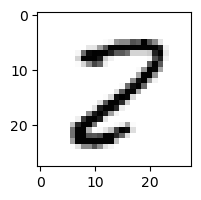

0.13535609159562298% - 0
0.0006326696565042545% - 1
28.38853968072917% - 2
2.7589282945990673e-05% - 3
3.472941842565323e-05% - 4
0.053511969087793265% - 5
1.6826329515002565e-05% - 6
0.014092117170744616% - 7
99.99982116142002% - 8 - ОШИБКА
7.3831779446634065e-09% - 9

 6


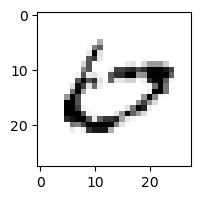

97.01296237885227% - 0 - ОШИБКА
0.00016981621594498237% - 1
0.0003551735530572668% - 2
0.0009079716879036402% - 3
0.008377596998241147% - 4
1.7622205717945986e-05% - 5
3.5612649547864716% - 6
3.297001104196347% - 7
2.735472859990327e-06% - 8
1.6354605301520613e-07% - 9

 9


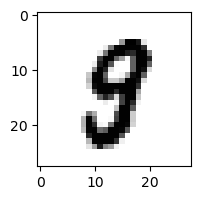

0.003119342096678771% - 0
2.1273397487030396e-05% - 1
2.4813687092431176e-05% - 2
0.0041864956976056114% - 3
0.0006200274185975617% - 4
0.6728558429626995% - 5
1.8002679926123742e-06% - 6
0.0002375583514800444% - 7
1.8246092070030078% - 8 - ОШИБКА
0.0001091617761156648% - 9

 3


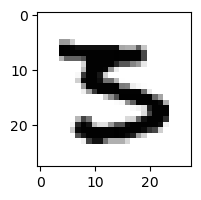

0.00012499600061290095% - 0
9.326715799681105e-09% - 1
0.0001233224603515504% - 2
0.7158563137280485% - 3
1.6429064746994478e-09% - 4
57.91453196431456% - 5 - ОШИБКА
2.3739945257145316e-06% - 6
9.456819739858302e-07% - 7
1.245473937261171e-12% - 8
4.007027116914294e-13% - 9

 3


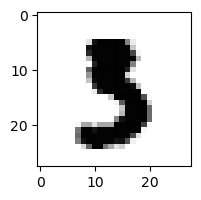

3.6465798660431925e-08% - 0
8.311343438194979e-06% - 1
7.063739211669298e-08% - 2
0.20350781622187633% - 3
6.185879256224595e-10% - 4
1.6552692271662857% - 5 - ОШИБКА
9.809243306190946e-08% - 6
1.0072801264235235e-05% - 7
4.736488899600933e-12% - 8
7.351594325614097e-15% - 9

 3


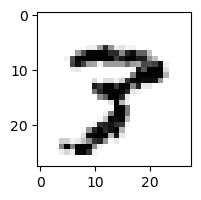

8.331786056748777e-05% - 0
2.6677511126619916e-05% - 1
0.000755185688099758% - 2
0.06319856701929888% - 3
0.0001284201999032722% - 4
4.422613664017465e-05% - 5
2.0733596956983252e-06% - 6
13.617329557812754% - 7 - ОШИБКА
0.5947897391442147% - 8
0.0194157077718649% - 9

 7


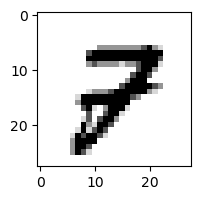

0.002195131382617804% - 0
7.364535871193623e-05% - 1
4.353321374431294% - 2 - ОШИБКА
1.1959474223158548e-05% - 3
0.00013945642094806128% - 4
0.0002935249934815555% - 5
1.1151335421910174e-07% - 6
1.1601137570178957% - 7
1.3315997205798243e-05% - 8
0.027898294072072716% - 9

 5


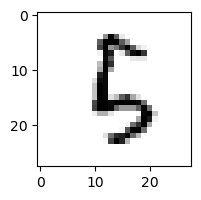

0.0019217432306892703% - 0
0.033139835361900884% - 1
7.952222437942173% - 2 - ОШИБКА
0.21084804674648622% - 3
1.1108306107501584% - 4
2.0514335609176175% - 5
0.18725632047198193% - 6
0.00025543440686683327% - 7
5.843555986163428% - 8
0.0014273162363942157% - 9

 9


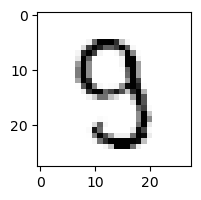

0.008554931266447319% - 0
6.964627890920754e-05% - 1
0.002854862604174057% - 2
37.26347401713164% - 3 - ОШИБКА
0.7772322914893665% - 4
2.680087053699921% - 5
0.00029001659367453513% - 6
0.03811054699658775% - 7
0.004231284175623757% - 8
7.343127525534605e-05% - 9

 5


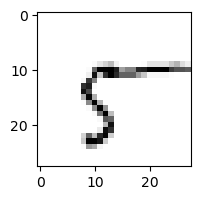

66.86600096234805% - 0
1.3679051419351655% - 1
0.007990729153645515% - 2
0.028800133294561853% - 3
1.3086917528000028% - 4
11.285614908952677% - 5
3.11882359492155% - 6
46.389189675895075% - 7
97.43815245142065% - 8 - ОШИБКА
12.538143128494717% - 9

 8


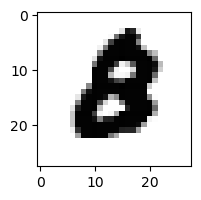

0.0007120436825578562% - 0 - ОШИБКА
1.0224107184143392e-10% - 1
0.0006996934115983926% - 2
7.054023051895652e-07% - 3
4.4457318822539157e-10% - 4
3.549084922619814e-05% - 5
7.273860171969575e-05% - 6
6.458739532020603e-09% - 7
7.404832300817088e-13% - 8
5.2028108828506446e-12% - 9

 5


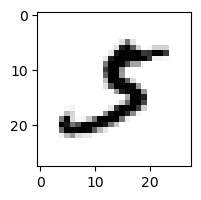

0.0023628675889758046% - 0
4.543787682303917% - 1 - ОШИБКА
0.6102259773727033% - 2
0.3996287295813969% - 3
2.2032453067113723e-06% - 4
1.6833554968501832% - 5
6.557348024569778e-06% - 6
1.069704128670044% - 7
7.785258317191886e-10% - 8
4.8116619308070435e-05% - 9

 3


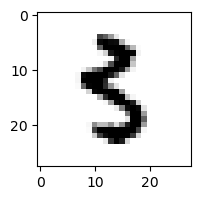

0.00029590817791760627% - 0
0.004473804461504513% - 1
5.43295410087821e-06% - 2
0.10078228595072038% - 3
0.0001479887848135501% - 4
9.540069315830662% - 5 - ОШИБКА
0.023977954248457542% - 6
4.652177536055555e-05% - 7
1.9254299869480026e-06% - 8
3.142947647359434e-05% - 9

 4


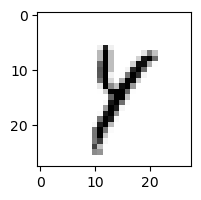

0.00023880407413812553% - 0
49.5920616339376% - 1
0.15631674228156942% - 2
0.1155443465055893% - 3
12.831258242907536% - 4
2.826210758049843% - 5
0.04335469458075601% - 6
4.992111261301571% - 7
97.43684038008335% - 8 - ОШИБКА
0.7627925326785222% - 9

 3


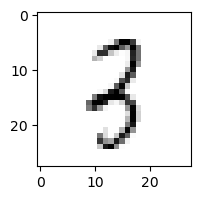

0.008329523385401957% - 0
3.192311264267003% - 1
13.942383801082503% - 2
72.86238536591216% - 3
2.7148872257131713% - 4
0.5796830765615031% - 5
0.01902620758938386% - 6
0.03052704544233521% - 7
98.48648046935415% - 8 - ОШИБКА
0.38485324615276567% - 9

 2


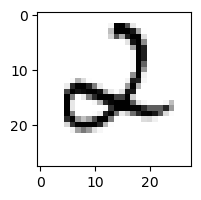

0.021064353371926237% - 0
0.0027780982696881595% - 1
0.39097271853363363% - 2
0.0002142812227764208% - 3
0.8972849351185416% - 4
0.036386595708645775% - 5
10.201275894381425% - 6 - ОШИБКА
8.275409204030748e-05% - 7
2.1313690508804353e-09% - 8
2.24148777248247e-06% - 9

 1


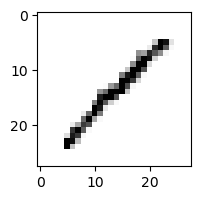

0.2385599943438555% - 0
83.3207211791072% - 1
38.65944710057369% - 2
85.08361393783576% - 3
19.562433130665866% - 4
3.9377802217701747% - 5
0.013390850387197771% - 6
0.3380329508493675% - 7
99.80819713564206% - 8 - ОШИБКА
26.312004747667473% - 9

 8


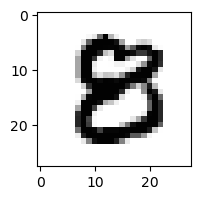

0.0009219847132510464% - 0
4.761188908324426e-10% - 1
5.162304730909794e-05% - 2
0.010692088065190605% - 3
6.170998096708471e-08% - 4
0.0296692591046095% - 5 - ОШИБКА
2.4062941205163025e-07% - 6
6.583711678723956e-11% - 7
0.0003726855003510997% - 8
1.5822185676895188e-12% - 9

 3


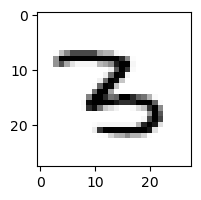

9.972258948609036e-05% - 0
0.03650286440625373% - 1
37.11005185350197% - 2 - ОШИБКА
33.50374140311337% - 3
0.04228294468412716% - 4
0.053153144915378654% - 5
2.4417803259565978% - 6
0.014037797065357929% - 7
1.6075763273807026e-07% - 8
1.4244385575291428e-06% - 9

 9


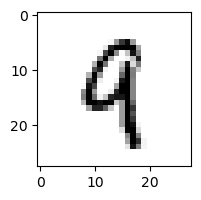

4.757347693711173e-05% - 0
0.1899683236134696% - 1
0.17301548258074853% - 2
0.008534704481454323% - 3
15.786063852166196% - 4 - ОШИБКА
0.024147365596408402% - 5
0.0072098468304399805% - 6
0.010327203582987207% - 7
0.002570920972120106% - 8
11.85416244800893% - 9

 3


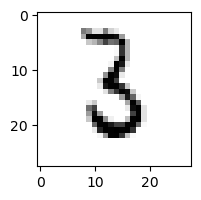

0.011560328338491816% - 0
1.9815185942866427% - 1
3.9368603408167684% - 2
25.822355455375153% - 3
2.8620367968650726e-06% - 4
0.09415475648229862% - 5
92.79947229719964% - 6 - ОШИБКА
0.00042430523811378963% - 7
0.002070658891206983% - 8
1.129810057630978e-05% - 9

 8


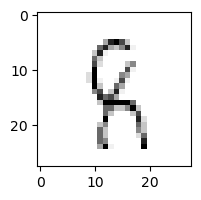

0.0028505149308221305% - 0
0.9852245009544035% - 1
25.09103770549167% - 2
0.4375581887207032% - 3
62.7620580470865% - 4 - ОШИБКА
5.584183989955457% - 5
2.267358651525171% - 6
0.02868571421923471% - 7
9.091044481429494% - 8
0.2357441698584089% - 9

 8


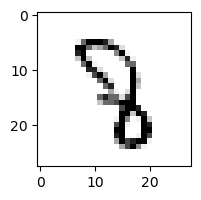

1.78907242123326e-05% - 0
0.000746084030471972% - 1
15.220753927611522% - 2 - ОШИБКА
3.6201488462343896% - 3
6.320376523623978% - 4
0.4398057734528173% - 5
0.012117573734629654% - 6
0.04050250877489175% - 7
0.32144135139267943% - 8
0.0003500022348124495% - 9

 7


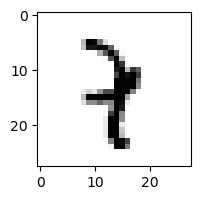

2.848947164817249e-08% - 0
64.70689641062336% - 1 - ОШИБКА
0.3302337050947555% - 2
0.79058303177111% - 3
0.4565343679379341% - 4
0.0040198018402352554% - 5
0.006899689466869275% - 6
0.3161946234599625% - 7
3.493776557318259e-05% - 8
0.019737998758879115% - 9

 0


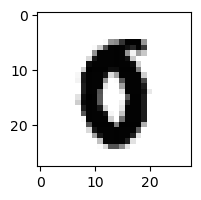

0.01686154358762061% - 0
6.521865355881436e-09% - 1
2.8888200053672813e-06% - 2
7.243438381322514e-11% - 3
1.2787490807149965e-06% - 4
0.002213743521669508% - 5
0.021388771173156247% - 6 - ОШИБКА
0.0004108812150958491% - 7
4.689193344659555e-11% - 8
1.7909559944265821e-10% - 9

 4


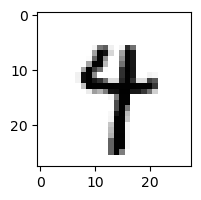

5.448532359111181e-07% - 0
0.007876324345125842% - 1
2.669277545550805e-07% - 2
0.00010712537433848435% - 3
10.814968032800836% - 4
0.05222709703431546% - 5
0.006302798673301076% - 6
2.8879807429927107% - 7
0.0007844830077450023% - 8
48.492018661278316% - 9 - ОШИБКА

 8


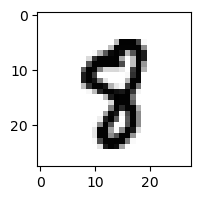

1.59288655423376e-05% - 0
0.00035457551326259626% - 1
4.1976725914519e-05% - 2
1.0449220149834006e-06% - 3
0.0014220856576486534% - 4
0.30043850836359803% - 5 - ОШИБКА
2.2687379049611728e-05% - 6
0.005027842177572284% - 7
0.003926428065592782% - 8
3.5552478051931205e-06% - 9

 3


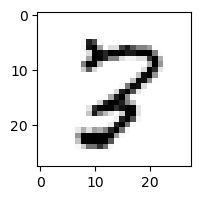

0.006957760935007981% - 0
4.302724502732757e-05% - 1
5.07949193200036% - 2
0.0009051795215551012% - 3
0.0007252836466086785% - 4
0.010244622600144604% - 5
3.9339492499655964e-05% - 6
2.185369486715045% - 7
99.95460150624025% - 8 - ОШИБКА
0.0258298265021194% - 9

 8


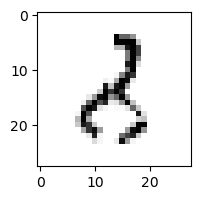

0.017905699112447788% - 0
6.492639648759526% - 1
90.41975783077386% - 2 - ОШИБКА
32.5391234430111% - 3
0.17762902961210159% - 4
0.2631263118219573% - 5
0.16653407081648006% - 6
8.104461971197671e-05% - 7
57.63955283826541% - 8
0.00024619159315752715% - 9

 8


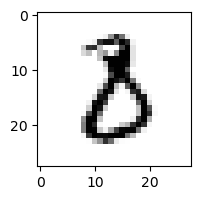

0.01311901585892745% - 0
0.1302011120239538% - 1
2.056334570743135% - 2
41.41227314350128% - 3 - ОШИБКА
4.12214128329024e-08% - 4
0.054002933235218833% - 5
0.015540015521211327% - 6
2.5454093123001603e-05% - 7
0.0005854983253953067% - 8
7.180066771223004e-08% - 9

 9


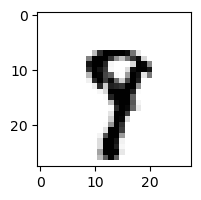

1.5396048824033285e-07% - 0
0.0022979577564874593% - 1
1.4280392194381953e-06% - 2
2.9340801856319073e-05% - 3
0.025950005428309882% - 4
0.07191519247664052% - 5
3.4791953971954965e-05% - 6
5.218067715532692% - 7 - ОШИБКА
0.9467656789998703% - 8
0.417576397697795% - 9

 7


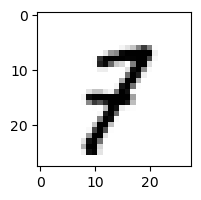

0.0017287464060297523% - 0
0.46107213915243606% - 1
4.231439739473181% - 2
0.05531963399642063% - 3
0.01620553191950144% - 4
0.04720609958582918% - 5
0.0002765823783933648% - 6
4.908110372337604% - 7
0.004174644069166289% - 8
8.923022449248366% - 9 - ОШИБКА

 8


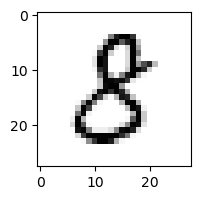

0.02444342934526489% - 0
0.0014406125905945574% - 1
0.92968525079693% - 2
29.40503887406451% - 3 - ОШИБКА
0.00036791857805338566% - 4
2.540187279167646% - 5
4.4494764905370574e-05% - 6
7.94381899776447e-06% - 7
1.3858170596014046% - 8
6.5492194273468906e-09% - 9

 4


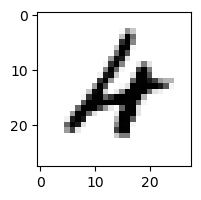

0.010300135390384187% - 0
4.758905580973842e-05% - 1
2.102736720522941% - 2
3.519260771389468e-05% - 3
0.8861390408460573% - 4
1.242608786223644e-06% - 5
9.0696288645465% - 6 - ОШИБКА
0.000168139040446856% - 7
0.0018737924145936142% - 8
0.26807274710519563% - 9

 2


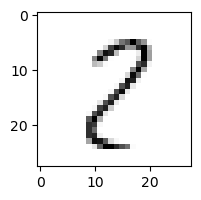

4.938406302083327% - 0
1.456988552571651% - 1
73.81122081340663% - 2
7.5590152365727015% - 3
0.01107736240776005% - 4
3.20489687984344% - 5
0.006161905871604945% - 6
3.036727696425192% - 7
99.99976530652933% - 8 - ОШИБКА
0.47545687510995904% - 9

 2


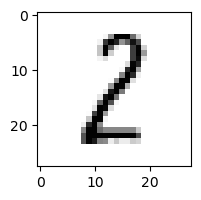

0.11272490371433223% - 0
39.63261732862334% - 1
38.97792709107136% - 2
11.246040225116834% - 3
0.0007150725317840847% - 4
0.5138838155645464% - 5
0.002239484299688388% - 6
0.0005793130603510042% - 7
69.6983700911246% - 8 - ОШИБКА
4.7295648225521914e-07% - 9

 9


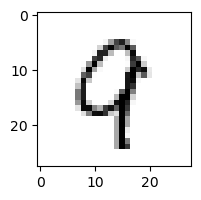

0.00969409323008999% - 0
0.13535533130202973% - 1
2.5612277574425857% - 2
2.1526001316021177e-06% - 3
55.932598186760494% - 4 - ОШИБКА
4.7729052502930893e-05% - 5
0.02410927718366425% - 6
7.796019770736512% - 7
8.005511382360336% - 8
1.0205558422938121% - 9

 3


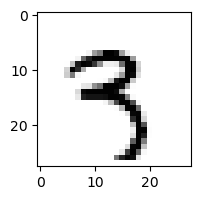

1.8948893041339163e-06% - 0
0.04936888285932178% - 1
0.3120993934093516% - 2
1.3066571079207778% - 3
0.2025299471104965% - 4
0.4033413792127638% - 5
0.0019251665620063636% - 6
0.013838396998437775% - 7
2.1712626757661065e-05% - 8
71.44067557778874% - 9 - ОШИБКА

 2


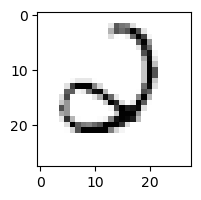

0.7848082587448896% - 0
0.0008246434166569449% - 1
0.1099528077282481% - 2
0.024732570821184578% - 3
2.5799591071817316% - 4
0.4998858673918368% - 5
84.16884795723034% - 6 - ОШИБКА
0.03322166012899594% - 7
3.198030625815504e-06% - 8
0.001262845704687864% - 9

 5


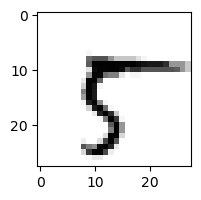

3.076305357260264% - 0
0.0005708155267917425% - 1
5.2720800960763944e-05% - 2
2.8874990845620466e-07% - 3
0.004929300220173281% - 4
14.283355435752046% - 5
0.006695943030619844% - 6
79.52565410641832% - 7 - ОШИБКА
0.022954234315949368% - 8
0.03123310421469687% - 9

 8


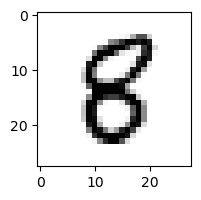

0.017638403057115323% - 0
6.423592411778026e-05% - 1
0.0056656741371278125% - 2
0.0033154587156259% - 3
0.021019861491072555% - 4
2.183046338407565% - 5 - ОШИБКА
0.0031616166349403953% - 6
8.634507994230715e-07% - 7
0.21120621586580543% - 8
5.8977294059388e-08% - 9

 7


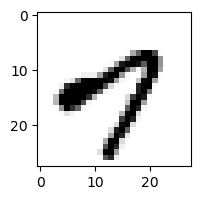

47.2452341283692% - 0
4.5896487966655625e-06% - 1
1.6783386537115254e-11% - 2
0.0016669949066266706% - 3
87.18401611915489% - 4 - ОШИБКА
0.0022765847158190823% - 5
1.8785497993025445e-05% - 6
4.192608086025594% - 7
3.191904029753702e-11% - 8
0.012178771470596188% - 9

 2


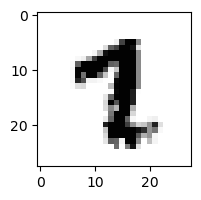

8.248944956626117e-09% - 0
0.04571071728945891% - 1 - ОШИБКА
5.659400016681237e-05% - 2
9.431489185084684e-08% - 3
5.5768232004717465e-06% - 4
0.006211500654017776% - 5
9.637780953801836e-07% - 6
0.042366389154551494% - 7
2.1956400568670323e-08% - 8
2.0408357192255404e-06% - 9

 7


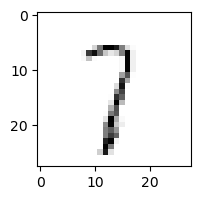

0.03546251487375626% - 0
14.749960092091241% - 1
19.115901343458074% - 2
28.52607510510476% - 3
0.8234188735573179% - 4
9.14892032714865% - 5
1.3182920646064502% - 6
55.963500496904395% - 7
40.75452848178717% - 8
65.79108522263323% - 9 - ОШИБКА

 9


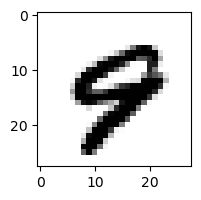

0.0002055206251303531% - 0
5.859818528936201e-07% - 1
1.6820545225450359e-09% - 2
2.549999958684031e-11% - 3
0.16773166079936583% - 4 - ОШИБКА
0.000539429571829464% - 5
0.002567792810233243% - 6
0.048882274084597936% - 7
6.3996511489833546e-12% - 8
0.0855744346727324% - 9

 7


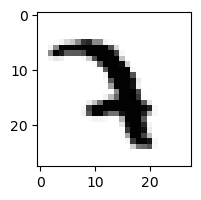

6.848800378915562e-12% - 0
0.09891074838601824% - 1
1.848448125578811% - 2 - ОШИБКА
0.0025422264953338216% - 3
0.0006660898326984196% - 4
6.220976170926549e-08% - 5
0.00015738412325536912% - 6
0.1273327467698744% - 7
8.050971501432677e-10% - 8
6.7005544062245e-08% - 9

 7


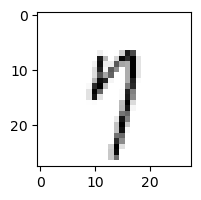

1.0504519938030688% - 0
0.017005208315826574% - 1
0.09092897548714463% - 2
10.033147740729891% - 3
39.48604103688647% - 4
21.538696831007922% - 5
1.873504172083714% - 6
58.29729213381255% - 7
0.3715275210609157% - 8
73.77251157060694% - 9 - ОШИБКА

 8


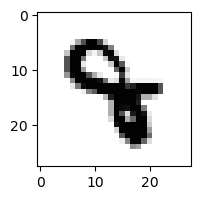

7.351283506958478e-12% - 0
8.260305846528063e-06% - 1
4.601930651767477e-07% - 2
0.0002811047487416149% - 3
46.986278201474896% - 4 - ОШИБКА
0.0017584292034372735% - 5
0.02752592419076339% - 6
0.001123299913844537% - 7
3.420049329205763e-15% - 8
3.0873575626615565e-07% - 9

 8


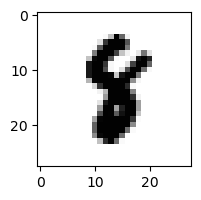

2.6004996208815097e-09% - 0
0.010471005590349589% - 1
8.16760302245155e-05% - 2
2.2022924594651868e-07% - 3
3.0598153550899264e-05% - 4
0.05324563736967173% - 5 - ОШИБКА
9.711851307810828e-06% - 6
0.0002807195590913705% - 7
0.000789836252059732% - 8
1.543135854234244e-10% - 9

 4


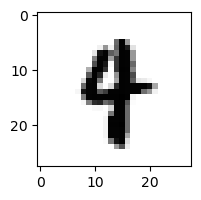

1.842802396557233e-08% - 0
0.11013306398798518% - 1 - ОШИБКА
1.410561011604464e-05% - 2
4.3372285983079643e-07% - 3
0.10103875674814565% - 4
0.021405516552934337% - 5
0.003302422668960278% - 6
0.01629427860096447% - 7
6.710805225003142e-09% - 8
0.07512323183654941% - 9

 8


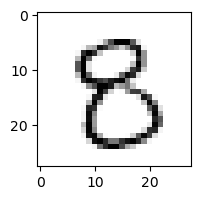

0.5702658712626536% - 0
6.204465959610009e-05% - 1
0.0005388245054465762% - 2
2.9598340843252813% - 3
0.45222023410486595% - 4
30.050156543258577% - 5 - ОШИБКА
0.00015288695745624013% - 6
0.0001322967802308433% - 7
3.435200351027723% - 8
1.8637145327469088e-06% - 9

 0


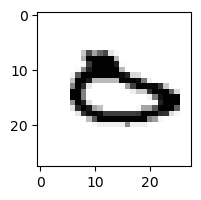

0.041778714322633366% - 0
5.161854803015004e-05% - 1
2.3921430490674294e-05% - 2
5.003713020556107e-10% - 3
0.008215868620822256% - 4
0.0036870294779882467% - 5
97.47557953578809% - 6 - ОШИБКА
1.5818060452284324% - 7
3.1885690464093493e-07% - 8
0.0013350131679201165% - 9

 5


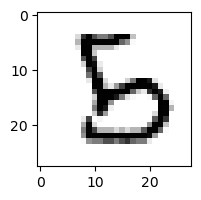

2.3047686568478886e-05% - 0
1.8045879647020101e-06% - 1
22.273035648650463% - 2 - ОШИБКА
0.0011896843692001692% - 3
0.044900803048578464% - 4
0.577062244573089% - 5
0.10059852131848217% - 6
1.3554944174445438e-08% - 7
2.2653888187438147% - 8
5.462517472841141e-09% - 9

 2


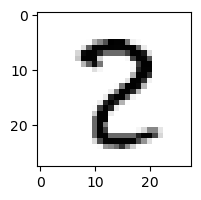

0.00486720136761175% - 0
0.00046076515966995187% - 1
21.03344878871072% - 2
0.05927554306155336% - 3
0.00021398976662343716% - 4
0.01196702721292687% - 5
1.0269850276595397e-06% - 6
0.06857442705225494% - 7
99.98102985630581% - 8 - ОШИБКА
1.7147554327840412e-06% - 9

 2


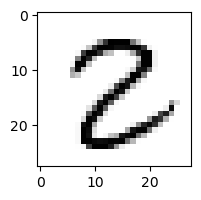

0.020388384268227602% - 0
0.00041569574176114274% - 1
39.42776852091594% - 2
0.948272236429803% - 3
1.0871725470884882e-06% - 4
0.2934265774153456% - 5
4.4936017852525874e-07% - 6
0.0002453094881820107% - 7
99.98572505658846% - 8 - ОШИБКА
1.1679711345389167e-09% - 9

 4


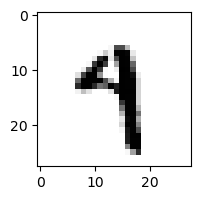

2.8577806538637877e-06% - 0
0.03077891777116704% - 1
2.120684102513972e-07% - 2
0.014471394059741344% - 3
4.426082776343573% - 4
0.1603790891521495% - 5
0.001295792783876138% - 6
0.9132558457046297% - 7
2.9024364805159292e-05% - 8
95.01454557863477% - 9 - ОШИБКА

 2


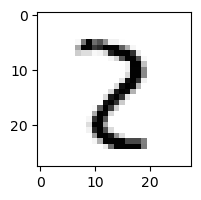

0.0009336884352811601% - 0
0.1031308139135289% - 1
1.9933204759569865% - 2
0.14709932844243792% - 3
0.0012644380090078501% - 4
0.0037258222471503303% - 5
0.00013154718912248095% - 6
0.32350074256463884% - 7
99.41428480442279% - 8 - ОШИБКА
0.016035952154679945% - 9

 4


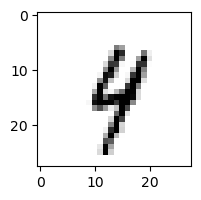

0.00023845524759598342% - 0
0.4043794781888875% - 1
0.05413827094790744% - 2
0.0807094113190951% - 3
7.165072643234607% - 4
0.04664181918253776% - 5
0.2890808722758205% - 6
1.0496714669919078% - 7
3.4748438927029515% - 8
59.72571507166505% - 9 - ОШИБКА

 8


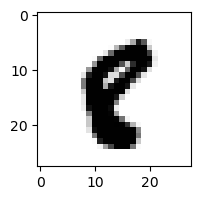

3.06149207004684e-05% - 0
0.0010319869899348977% - 1
1.0779974085194293e-07% - 2
2.4283148610953307e-11% - 3
3.982685245930958e-06% - 4
0.019196572977475776% - 5 - ОШИБКА
6.842147370981977e-05% - 6
7.574443744254444e-06% - 7
0.0003351654379605946% - 8
2.5738614356727585e-06% - 9

 8


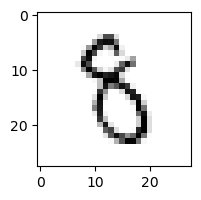

0.01601430672300846% - 0
0.1584144686190558% - 1
0.03623574662300699% - 2
6.11442107259521% - 3
0.011527033381602167% - 4
13.03708242499971% - 5 - ОШИБКА
1.6584738723185715% - 6
0.002888344041194747% - 7
0.5730574440115646% - 8
5.8228271879829196e-05% - 9

 8


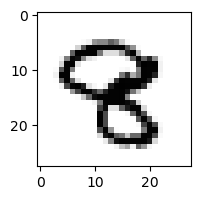

5.555724713783731e-09% - 0
1.5347016691882005e-06% - 1
0.0003547388752255689% - 2
0.0028956730956667975% - 3
0.03548624001708486% - 4 - ОШИБКА
6.0273191210060525e-05% - 5
8.957469617736093e-07% - 6
2.745159488199071e-06% - 7
0.0008210419531728191% - 8
5.7295672184746245e-05% - 9

 3


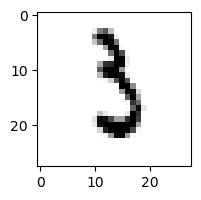

0.0006118733582876915% - 0
1.2334038885507803% - 1
0.9932003414819441% - 2
25.767032522493% - 3
2.0732929134344963e-06% - 4
0.5699938227272396% - 5
30.54014601092991% - 6 - ОШИБКА
0.5463173568635581% - 7
3.424371933674675e-07% - 8
0.0001627071786160128% - 9

 5


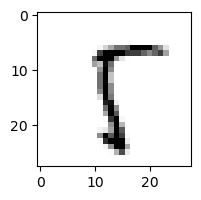

0.08576305072883081% - 0
0.31621047660834106% - 1
0.3551680825145431% - 2
0.00968380085854333% - 3
0.07492825422393451% - 4
95.52952834816273% - 5
0.0412183229983228% - 6
0.2053048620259375% - 7
99.9345592392186% - 8 - ОШИБКА
7.098031699792491% - 9

 8


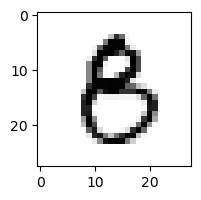

0.0852146757975609% - 0
0.0001183161841075796% - 1
0.0009092366647429825% - 2
1.0839309371801842% - 3
0.0021582393845341026% - 4
2.67938955132094% - 5 - ОШИБКА
0.00018363408606766025% - 6
6.049310151178732e-06% - 7
0.000128546234423452% - 8
1.7805325185791126e-05% - 9

 4


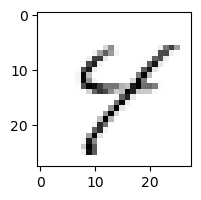

0.11247296925555676% - 0
0.017452211031611976% - 1
0.026512315833039646% - 2
0.013357747795505446% - 3
90.02434904270359% - 4
34.23632894031881% - 5
6.0356404092218225% - 6
5.416959206374984% - 7
95.37694526856123% - 8 - ОШИБКА
77.91008258160015% - 9

 8


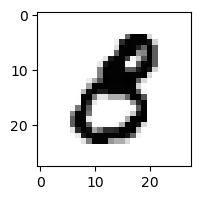

0.010450625831773646% - 0
0.0001929771212174998% - 1
2.528087078589763e-06% - 2
0.8504438489393205% - 3 - ОШИБКА
2.6300798752720496e-06% - 4
0.04521226400256578% - 5
5.38620739876748e-07% - 6
2.275052282332411e-07% - 7
4.944827206933719e-10% - 8
6.012117602927173e-12% - 9

 8


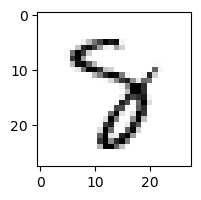

2.5824083658567475e-05% - 0
0.0010661652213218636% - 1
0.014918779469821926% - 2
0.04871068763915352% - 3
1.8353701373015576% - 4
1.1441960879142536% - 5
0.09000986798934751% - 6
17.658380799085126% - 7 - ОШИБКА
0.14429655954293047% - 8
5.126163657128963e-09% - 9

 7


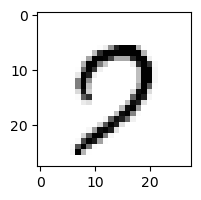

77.12404100065795% - 0
2.322358881077093e-06% - 1
0.0062563008546407456% - 2
0.052139329046060195% - 3
0.0074754282502132565% - 4
3.898476496133929% - 5
0.0017620746855944874% - 6
84.80164856694611% - 7
0.00027305606983746636% - 8
99.44579081683102% - 9 - ОШИБКА

 7


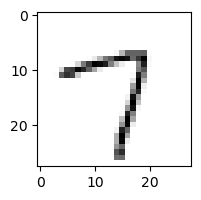

11.071503286038272% - 0
0.005590793721519041% - 1
5.202801731763131% - 2
1.6954965396220287% - 3
0.15940997265249116% - 4
18.42891298618997% - 5
0.037844730471444% - 6
90.612821336938% - 7
24.839554661490507% - 8
95.33838703714312% - 9 - ОШИБКА

 5


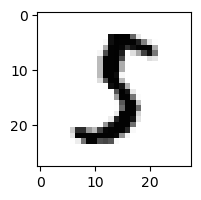

0.011199720428708607% - 0
0.6240841573260006% - 1
0.1408996731370943% - 2
5.394032969714007% - 3 - ОШИБКА
1.9994949749133864e-08% - 4
4.432014011376201% - 5
0.0003118928601580054% - 6
0.000440847604969142% - 7
0.0002732425654170723% - 8
9.839908085248673e-09% - 9

 8


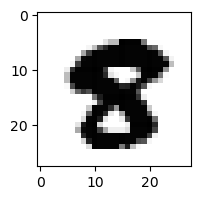

1.8862117865119553e-07% - 0
1.3110213085337123e-12% - 1
3.050565238426205e-12% - 2
1.8201653375441728e-14% - 3
1.6658875307265842e-09% - 4
0.025329990617367685% - 5 - ОШИБКА
1.5937808464704213e-13% - 6
1.6775358752904108e-09% - 7
0.00872289707096988% - 8
1.8756967680653878e-14% - 9

 8


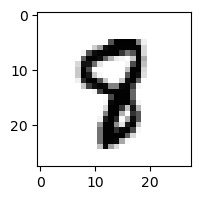

3.712333180962754e-07% - 0
0.0004468510384428% - 1
8.888379364393931e-05% - 2
2.442680925552565e-05% - 3
0.017236983954945134% - 4
0.07671750714214126% - 5 - ОШИБКА
0.000299063195689316% - 6
0.001380935290314978% - 7
0.0018473295341523272% - 8
1.2481942209841456e-07% - 9

 8


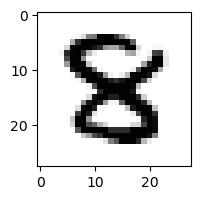

1.6417617418806683e-07% - 0
7.002727544612876e-10% - 1
0.0007131840104323368% - 2
0.00174379461781589% - 3
0.000637184251126611% - 4
0.0020007140238560185% - 5 - ОШИБКА
1.7955757603062175e-07% - 6
1.8508848507733099e-09% - 7
0.0012220408318453734% - 8
7.870971523999977e-17% - 9

 8


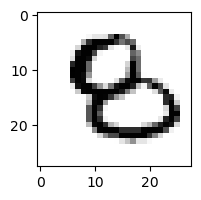

0.0004473459659606323% - 0
3.686686495199084e-06% - 1
2.0552735663118247% - 2 - ОШИБКА
2.7364173871753373e-06% - 3
0.03794790280871824% - 4
0.04024115513476085% - 5
0.2958119279981467% - 6
8.633617835103919e-07% - 7
4.998920730339462e-05% - 8
1.9657273081248386e-08% - 9

 8


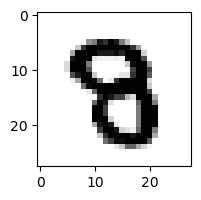

5.839043823297922e-07% - 0
1.3939947461512108e-08% - 1
6.9446216680018e-06% - 2
0.00029956762176826875% - 3
3.3767587394308226e-05% - 4
0.001271472662831507% - 5 - ОШИБКА
1.4054750566562142e-05% - 6
1.4577077671900612e-06% - 7
7.534790057893347e-08% - 8
4.33464301277078e-09% - 9

 3


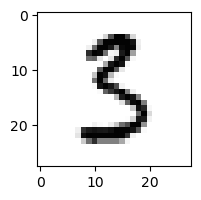

0.039421225545721174% - 0
0.0017124345589578228% - 1
0.1642748642747952% - 2
51.22056067267836% - 3
6.092057654497081e-06% - 4
56.66202707612283% - 5 - ОШИБКА
0.006296083555305763% - 6
0.0006471349583974989% - 7
0.002225186590847394% - 8
4.149782720125412e-09% - 9

 7


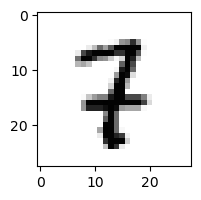

2.1245497303137363e-06% - 0
0.21616627520954432% - 1
0.450108712086619% - 2 - ОШИБКА
0.000595008340206273% - 3
0.011344729809911053% - 4
0.0011538414392073283% - 5
7.583168521663498e-05% - 6
0.3485486063795362% - 7
0.00014226611415160104% - 8
3.566505706852604e-05% - 9

 8


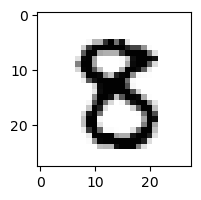

2.4406305034328152e-05% - 0
3.1785446994009072e-06% - 1
5.520404055358467e-06% - 2
0.07760469049489853% - 3
7.631808552866085e-05% - 4
1.111170363552471% - 5 - ОШИБКА
3.52040966242824e-10% - 6
5.417082172626576e-06% - 7
0.1010840399798409% - 8
5.647387702493966e-10% - 9

 1


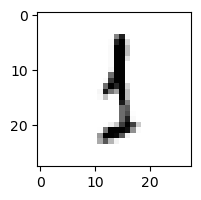

0.008149868799638055% - 0
63.388533504643895% - 1
0.7589904941905136% - 2
95.79786946660136% - 3 - ОШИБКА
0.00223998807025658% - 4
1.9183513592714727% - 5
1.434626109170368% - 6
0.012346182453336647% - 7
14.425085216100083% - 8
1.0164272969480912% - 9

 9


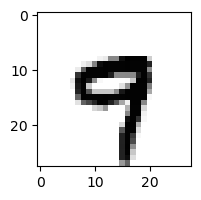

4.01186387768962e-05% - 0
0.0013522353157979902% - 1
4.555906065244457e-09% - 2
4.887790271377694e-06% - 3
1.1705319106031093% - 4
0.001295950521788241% - 5
0.000537011556224788% - 6
15.15487803441161% - 7 - ОШИБКА
1.2000538486150095e-09% - 8
0.6782931661696066% - 9

 2


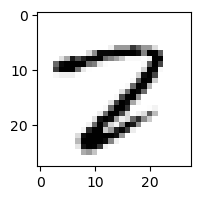

0.02976676103016131% - 0
8.737388037751819e-06% - 1
1.0601528124525468% - 2
0.000251912245664334% - 3
3.055735128490755e-05% - 4
0.0627393920115459% - 5
0.00019563736028566656% - 6
29.076599759548266% - 7 - ОШИБКА
0.5600206556629131% - 8
5.383177306609629e-07% - 9

 8


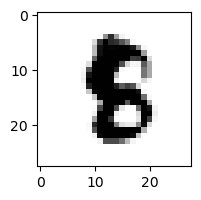

9.775751364275408e-08% - 0
0.00014139211729666316% - 1
8.045459274747097e-06% - 2
5.485312866702122e-07% - 3
3.675907891992747e-07% - 4
0.05304333629244647% - 5 - ОШИБКА
0.0003827447366411754% - 6
1.2389756659641747e-06% - 7
1.1331049682953621e-07% - 8
7.505029958518083e-09% - 9

 3


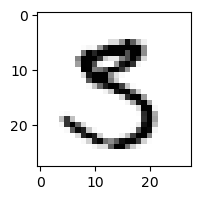

0.049494655682384744% - 0
0.00023992998844546632% - 1
9.633188566133803e-05% - 2
10.198755395761761% - 3
2.9136064833593896e-06% - 4
94.54203899593969% - 5 - ОШИБКА
2.326412535389666e-08% - 6
0.015796436262607044% - 7
0.001435571891731574% - 8
1.2691526938897891e-06% - 9

 2


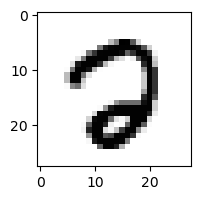

0.1654434738157252% - 0
4.307217930597587e-08% - 1
0.004865081602494128% - 2
9.168011348744103e-08% - 3
4.9155565340623914e-08% - 4
0.14245312606076052% - 5
2.3942018118401767e-05% - 6
0.1921082420769357% - 7 - ОШИБКА
0.002778681156772321% - 8
2.4400370611351104e-11% - 9

 3


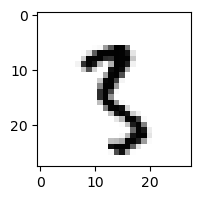

4.674393788869708e-05% - 0
0.6496721267934693% - 1
1.1786187555881908% - 2
0.45290788820367334% - 3
1.8786478772854027e-05% - 4
9.73873514476571% - 5 - ОШИБКА
0.00037428491462456034% - 6
0.02087547416595668% - 7
1.2662892654670914% - 8
3.7910926935498392% - 9

 8


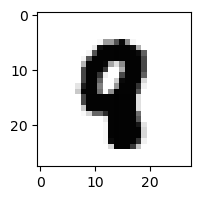

3.1889820511043013e-10% - 0
6.185637158739988e-06% - 1
2.613298055082419e-06% - 2
3.543609785095912e-13% - 3
0.0031464353989322136% - 4 - ОШИБКА
1.7801470590572345e-06% - 5
1.3110772934671135e-07% - 6
0.00015058491234421279% - 7
1.2929295036025764e-10% - 8
3.223367594027145e-06% - 9

 7


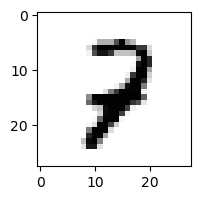

0.00015642499948573843% - 0
0.009023184579166094% - 1
21.609902373680615% - 2 - ОШИБКА
0.004494606201326794% - 3
0.16732953220043406% - 4
0.0008185868266160161% - 5
0.0004987847330000497% - 6
0.04600122990754955% - 7
0.02524600523377117% - 8
0.002268811797291578% - 9

 1


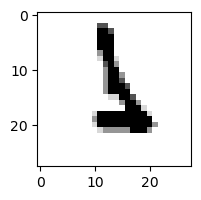

7.408862492131751e-08% - 0
1.9287145567897517% - 1
13.744455193289658% - 2
0.17768419846607614% - 3
2.316979139331882e-07% - 4
0.07156266678599306% - 5
33.870717801484346% - 6 - ОШИБКА
2.4991289402031102e-05% - 7
1.978185478569141e-07% - 8
3.8169766942831444e-07% - 9

 4


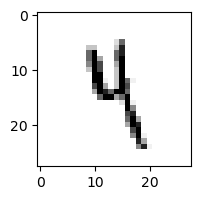

0.0001641399763745927% - 0
0.639304103044783% - 1
0.2615645402798443% - 2
12.355118946705236% - 3
29.188070600039577% - 4
43.191970112527486% - 5
1.1252886160264568% - 6
0.07374806961491992% - 7
5.240823552041603% - 8
70.17591677826167% - 9 - ОШИБКА

 6


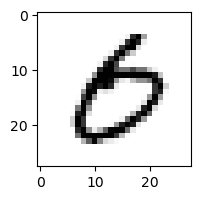

68.55806051208091% - 0 - ОШИБКА
3.257982383581352e-05% - 1
0.0001216902780554716% - 2
0.43717935366465793% - 3
1.4641897475925808e-05% - 4
0.0014568473265844887% - 5
11.95738605070741% - 6
0.0003132874286905277% - 7
7.0576289246528645e-06% - 8
5.9137945570120275e-06% - 9

 2


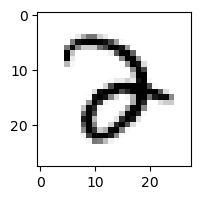

0.2978191733289128% - 0
2.5034239587790767e-06% - 1
31.71982339004475% - 2
48.70898469259258% - 3 - ОШИБКА
0.00042045573650581665% - 4
0.00015377779973328173% - 5
0.8474852772480553% - 6
0.002471220939437365% - 7
3.141882106953412e-05% - 8
0.001292760974660359% - 9

 3


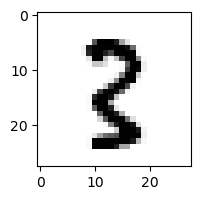

2.7415447027649547e-06% - 0
0.030519896250862495% - 1
1.5445183438081793% - 2 - ОШИБКА
0.0064951670109636055% - 3
1.0849399619215849e-05% - 4
0.0070048834140932735% - 5
2.3743896394719465e-05% - 6
0.00016995858924188367% - 7
0.09245165965174693% - 8
4.318896044919068e-06% - 9

 9


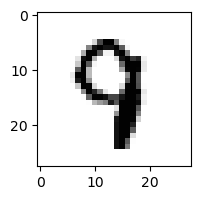

9.895361414390988e-06% - 0
0.00011820837304891327% - 1
0.0008741845699980934% - 2
0.006985980155509107% - 3
1.0155039593434327% - 4 - ОШИБКА
0.01574678253557445% - 5
0.00107756544624822% - 6
0.9560352694203257% - 7
2.4920538251673373e-09% - 8
0.00019776987395016775% - 9

 8


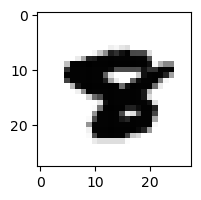

1.983823002055929e-09% - 0
7.817483029167758e-09% - 1
1.4409029924369034e-11% - 2
6.1170283810917025e-15% - 3
2.5310624597026614e-07% - 4
3.0931171675461294e-06% - 5
1.4890819067782912e-05% - 6
8.87040987900527e-05% - 7 - ОШИБКА
2.4198155522683113e-13% - 8
1.1572922695306435e-10% - 9

 9


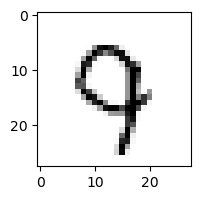

0.030867080831563323% - 0
0.0017589625010856215% - 1
0.16187217929244696% - 2
0.009614757786941737% - 3
24.72663357545016% - 4
0.08099466919869068% - 5
0.04366546551238963% - 6
55.06025818779858% - 7 - ОШИБКА
1.8723231027237824e-05% - 8
30.748221759762345% - 9

 7


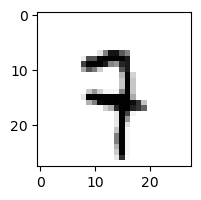

2.0219147474872077e-06% - 0
0.20390910130659778% - 1
23.87273394662165% - 2
0.00875229557378866% - 3
4.465636731334033% - 4
0.31423898804461864% - 5
0.061793619957388454% - 6
51.5314243164451% - 7
0.007132085626802216% - 8
52.36507679431459% - 9 - ОШИБКА

 6


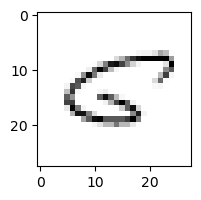

19.653709983298103% - 0
0.021575085161056978% - 1
1.6920438613966489% - 2
3.761652608328776e-05% - 3
0.7754517580961724% - 4
13.27542569210904% - 5
2.360076453538975% - 6
3.047702578255719% - 7
56.24465288408593% - 8 - ОШИБКА
0.0391482268724465% - 9

 8


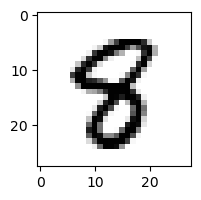

9.954391713549326e-06% - 0
0.0001538299923447949% - 1
2.684179946047688e-06% - 2
2.7405181101072286e-06% - 3
0.013564984458607038% - 4
1.9785533261008097% - 5 - ОШИБКА
3.215175125985504e-05% - 6
9.523774289523579e-06% - 7
1.021418294344876% - 8
1.182818516294743e-09% - 9

 8


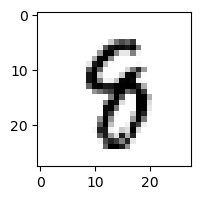

8.468344882409734e-07% - 0
0.004861473863723167% - 1
0.00010166673805525318% - 2
0.0007012340438077497% - 3
0.27657847186114376% - 4 - ОШИБКА
0.2738666251041321% - 5
0.061236854436601144% - 6
0.0013398576402498224% - 7
0.02500657506538674% - 8
9.504176617487822e-05% - 9

 5


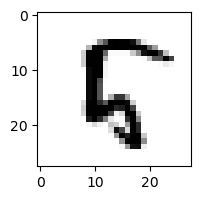

0.0016455919606724843% - 0
1.1429913033417218e-05% - 1
30.818661543537118% - 2
9.688163186748372e-12% - 3
3.350917817468875% - 4
14.014266147045268% - 5
0.03046341529453335% - 6
8.019093336033749e-06% - 7
43.17611525931358% - 8 - ОШИБКА
1.4083617559500045e-09% - 9

 8


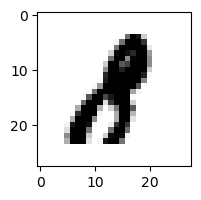

0.00012709729919273483% - 0
0.18418196397583234% - 1 - ОШИБКА
0.004996423931054932% - 2
0.00570490059914858% - 3
1.5157634150192504e-07% - 4
1.0408901700560814e-05% - 5
3.542112164971254e-07% - 6
3.432120274226261e-07% - 7
1.8584691008004516e-06% - 8
9.644325119473851e-09% - 9

 7


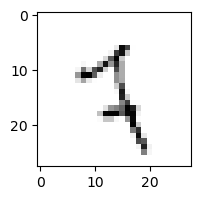

0.0064061725102978915% - 0
6.830275919989033% - 1
7.00250429772058% - 2
0.0008494086501699549% - 3
0.47857541765086137% - 4
7.063828536734568% - 5
3.703007404719654% - 6
15.119920230046283% - 7
2.0091253553503634% - 8
99.81039283281042% - 9 - ОШИБКА

 9


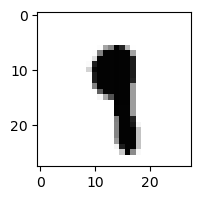

1.5098979487342432e-09% - 0
9.447438277937394% - 1 - ОШИБКА
6.697353786530872e-07% - 2
0.002039850771605275% - 3
0.00021833767063803751% - 4
0.029032119512830377% - 5
1.8029116704924316e-05% - 6
0.12028998480394368% - 7
9.525635115615591e-06% - 8
0.17031519058462494% - 9

 5


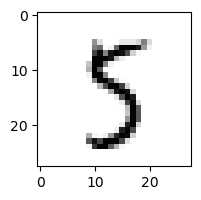

0.01842997193811757% - 0
0.0016304812004120748% - 1
0.005864812013226244% - 2
3.579804456815557% - 3
0.030479632079418725% - 4
90.42054887100464% - 5
0.08187778404767007% - 6
0.03227142616600732% - 7
98.8858876462163% - 8 - ОШИБКА
0.4187780447154987% - 9

 2


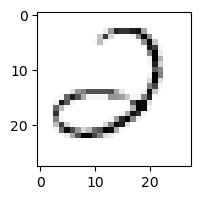

2.3251681830610575% - 0
0.03069326569403594% - 1
18.488245288846155% - 2
53.21326632447065% - 3
18.981802309602465% - 4
0.3208983122838097% - 5
84.27331992657908% - 6 - ОШИБКА
0.27152420691301277% - 7
4.56520470896923e-05% - 8
0.002106267067303849% - 9

 8


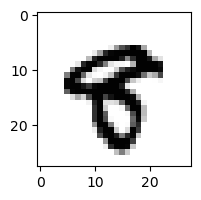

6.639544449134567e-05% - 0
1.4314966534254507e-06% - 1
9.545492652881136e-11% - 2
2.4560543525732003e-07% - 3
6.553696809724174e-05% - 4
0.0016656480481721597% - 5 - ОШИБКА
2.598776778341894e-07% - 6
0.0002305748323700083% - 7
4.4693162338663034e-05% - 8
0.0012933585955466188% - 9

 3


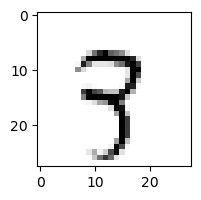

0.0006000710179762813% - 0
1.1606776905216662% - 1
19.264314589709937% - 2
0.1537562312749938% - 3
1.4418703199608682% - 4
0.2047855303553732% - 5
0.04313652719182683% - 6
23.77845606427594% - 7 - ОШИБКА
0.0053560835967506335% - 8
19.47582675445023% - 9

 8


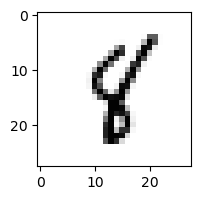

5.8194272521036166e-05% - 0
11.568899922929296% - 1
0.008924481341742294% - 2
0.00012434621138433918% - 3
20.70764722762203% - 4 - ОШИБКА
2.2698198317645373% - 5
0.1767970713596226% - 6
0.5472168400542616% - 7
0.009747253732864962% - 8
0.03807963164264859% - 9

 5


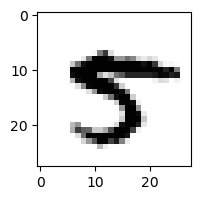

0.00024432500564369747% - 0
1.257097711680405e-05% - 1
5.915642768587637e-10% - 2
7.461375232445995e-06% - 3
0.000197579273295907% - 4
0.044058184416607374% - 5
3.288724495106771e-08% - 6
0.13129272568874528% - 7 - ОШИБКА
0.023315596694208664% - 8
3.600033255236604e-08% - 9

 7


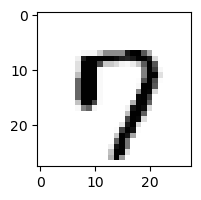

11.47584388669857% - 0
6.682656454966793e-09% - 1
2.2323207704444856e-06% - 2
0.0001174937830761199% - 3
0.3579863994663771% - 4
0.2601126203670088% - 5
0.04054366197024892% - 6
34.651911825382456% - 7
5.787127902820344e-07% - 8
45.85489062211053% - 9 - ОШИБКА

 8


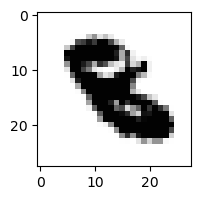

1.7204422078696744e-15% - 0
2.2787450314875275e-08% - 1
0.04424648270201434% - 2 - ОШИБКА
5.027216794518355e-08% - 3
3.167470118473523e-06% - 4
0.00014179753491734893% - 5
1.0450808618231811e-05% - 6
5.937013496462979e-09% - 7
3.8832724483132586e-20% - 8
8.645982908654274e-13% - 9

 9


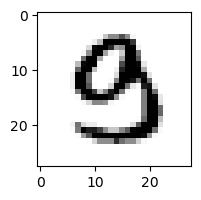

0.0036006106411452412% - 0
3.180907649699243e-05% - 1
0.0008288958838189533% - 2
15.395388821165795% - 3 - ОШИБКА
1.3937767522278762e-05% - 4
0.6691517491372435% - 5
3.3053581909739023e-06% - 6
3.0290667298923173e-06% - 7
2.393848118857318e-10% - 8
2.8533107984919493e-10% - 9

 4


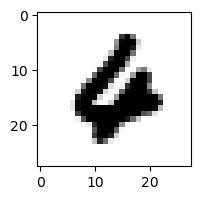

0.0015740681351997749% - 0
3.8575971067476756e-07% - 1
0.00048664370466582584% - 2
1.6507778980014874e-11% - 3
0.00941148382654746% - 4
2.2615343895888193e-07% - 5
81.65913003214392% - 6 - ОШИБКА
9.494043907424461e-05% - 7
5.604284338022364e-13% - 8
1.6107653231392106e-08% - 9

 3


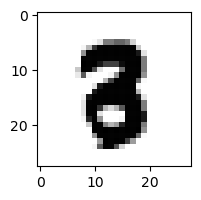

3.94357919804172e-08% - 0
7.939642600150017e-07% - 1
0.0027099511583172095% - 2 - ОШИБКА
3.801398158929986e-05% - 3
3.7911794383756075e-08% - 4
5.740104071952337e-05% - 5
2.5970509904345173e-07% - 6
2.295327434406735e-06% - 7
9.253308719074363e-07% - 8
1.8210096601546403e-11% - 9

 7


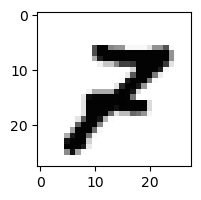

0.0005509293436694328% - 0
9.901885874556708e-06% - 1
0.6969576614598842% - 2 - ОШИБКА
2.542093687964677e-05% - 3
6.034377799321263e-05% - 4
3.970635458786361e-05% - 5
2.4029585595959545e-09% - 6
0.45460987410313597% - 7
0.025626571209868367% - 8
0.00026616937185414504% - 9

 0


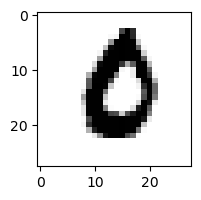

7.055047369004787% - 0
5.488320513009184e-08% - 1
0.0013465825105715814% - 2
8.709432470253447e-08% - 3
1.0479647431812872e-09% - 4
0.0009232073534078287% - 5
19.658500495158766% - 6 - ОШИБКА
2.6284488368819957e-06% - 7
5.287423024534547e-10% - 8
6.72157109338169e-08% - 9

 8


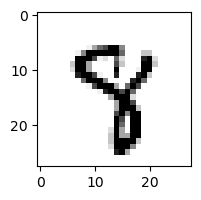

1.559474615906779e-07% - 0
4.754466304887031e-05% - 1
3.968677075267316e-06% - 2
0.0038222695092183104% - 3
0.03242578996194663% - 4
0.1818840927335024% - 5
0.00025137543887722186% - 6
0.9402069625577535% - 7 - ОШИБКА
0.8738944653222724% - 8
0.003856784499740244% - 9

 3


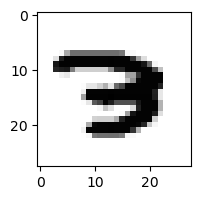

9.107478986956656e-07% - 0
8.70595396993335e-08% - 1
0.09222761677139914% - 2
0.006354035853502665% - 3
5.466750224966282e-07% - 4
4.481831251938682e-08% - 5
0.03852366949584333% - 6
4.980902646182344% - 7 - ОШИБКА
2.5974118271560175e-14% - 8
2.8084206721376454e-11% - 9

 5


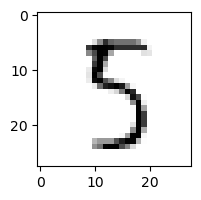

0.03653764128681475% - 0
0.0016135517794301367% - 1
0.11823292611006178% - 2
16.096081494368967% - 3
0.31564966674898093% - 4
93.8781198434122% - 5
0.025396089159085887% - 6
0.038277846901877535% - 7
96.18877036012069% - 8 - ОШИБКА
0.0006565181359642804% - 9

 8


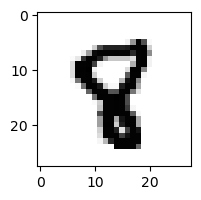

5.6752050459386015e-09% - 0
0.00015439353153413296% - 1
5.486149961011166e-06% - 2
1.7261342565067934e-09% - 3
0.01762554246954463% - 4
0.1635655193273397% - 5 - ОШИБКА
0.00012931081680417895% - 6
0.0004789177956786483% - 7
0.000950174321590553% - 8
1.106496076076035e-05% - 9

 6


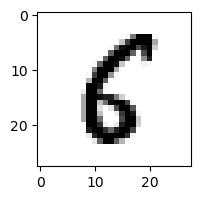

6.304177066880355% - 0
9.567691867988206e-05% - 1
0.06828287864204698% - 2
2.65127483933183e-08% - 3
0.001338077965125323% - 4
23.146588681681983% - 5 - ОШИБКА
7.459656111623697% - 6
7.698662514990823e-06% - 7
0.04307854029048717% - 8
2.34908029323299e-06% - 9

 3


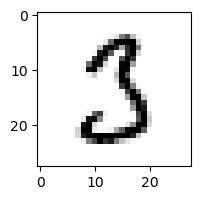

0.28413414164508705% - 0
0.004073000618389206% - 1
37.759194051067354% - 2 - ОШИБКА
16.51476394731767% - 3
3.2760557417820843e-06% - 4
2.6899503228050876% - 5
0.00033113558635047016% - 6
0.07213814843687529% - 7
0.010471651272536955% - 8
3.7015765864102333e-09% - 9

 6


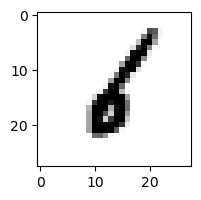

5.0815163231696294e-05% - 0
92.5760231057393% - 1 - ОШИБКА
5.706922517498368% - 2
5.598170817431273e-06% - 3
0.04437730930387022% - 4
0.006265247150559987% - 5
3.4808556381255373% - 6
0.000940737243074063% - 7
0.0006022293381477704% - 8
2.5505940060391066e-05% - 9

 0


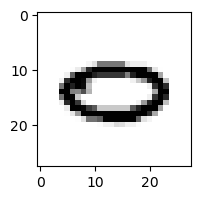

15.840938291765891% - 0
0.0012493641728653813% - 1
8.208951623107352e-07% - 2
1.302510721404589e-11% - 3
0.021746018168852% - 4
1.054584945289255e-09% - 5
81.74248040221264% - 6 - ОШИБКА
30.166498839115004% - 7
4.943373458625038e-07% - 8
0.00215329763036201% - 9

 9


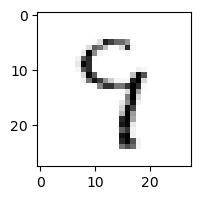

0.04732424814066197% - 0
0.08238060795108533% - 1
0.13751204754579263% - 2
3.9798329695988475% - 3
90.93187820969314% - 4
10.993446115632558% - 5
11.554405362367067% - 6
2.314358735521661% - 7
99.17368674592531% - 8 - ОШИБКА
0.21454147788923147% - 9

 8


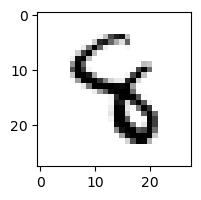

1.6492780723283796e-08% - 0
0.0010418289044099199% - 1
0.000598160922030371% - 2
0.02889402851475023% - 3
81.48556185811753% - 4 - ОШИБКА
0.14150982183975422% - 5
0.19482357901877048% - 6
0.0004799207017332274% - 7
7.942480476961909e-08% - 8
7.083689118777662e-07% - 9

 8


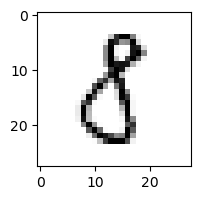

4.782351719873694% - 0
0.3757940445608826% - 1
0.192937443052197% - 2
10.81967499538022% - 3 - ОШИБКА
0.0028668268410550974% - 4
1.7982994021686756% - 5
0.001279272902007216% - 6
0.0029011498676903788% - 7
0.0018225049414161774% - 8
9.9961904104053e-07% - 9

 8


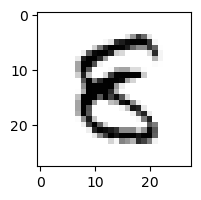

0.00781709752804761% - 0
0.00014827709063222575% - 1
0.014525688479233408% - 2
0.0012469416624215574% - 3
0.6428396405128023% - 4
35.32352331906164% - 5 - ОШИБКА
0.09019276706623114% - 6
7.569775159684352e-09% - 7
0.00011356325860321741% - 8
3.3952669753465364e-09% - 9

 3


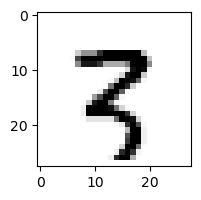

8.189236219771407e-07% - 0
0.06454967833260906% - 1
5.8207872058152486% - 2
2.6271863361686557e-06% - 3
1.7431849678183193e-05% - 4
3.771442544191281e-05% - 5
7.842701123609696e-05% - 6
0.230057209082517% - 7
13.402207901047408% - 8
20.248931252880322% - 9 - ОШИБКА

 7


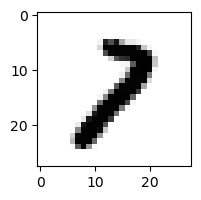

0.0010702660938484375% - 0
0.4749355865628751% - 1
13.496149788984047% - 2 - ОШИБКА
0.017592039738457278% - 3
2.3419054219283947e-06% - 4
1.9200882150035798e-05% - 5
1.4459041046065997e-06% - 6
0.09103693402810195% - 7
0.32072446782449016% - 8
0.015639399077145733% - 9

 3


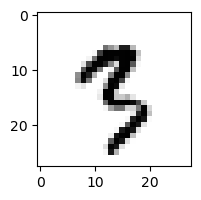

6.920224521094731e-06% - 0
0.3907642078056381% - 1
8.921989843036483e-05% - 2
0.13179239528869569% - 3
1.406381054931329e-05% - 4
4.880886480580418% - 5 - ОШИБКА
7.763596148691206e-05% - 6
0.114845794588154% - 7
0.00011623195970700608% - 8
0.1558852837026252% - 9

 7


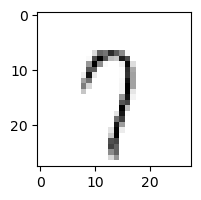

0.10634190413347137% - 0
0.36959453245296053% - 1
3.754566341500027% - 2
3.0639955807646606% - 3
17.230090288108784% - 4
12.80987056882017% - 5
5.390233562173109% - 6
89.71954319436915% - 7
58.264877737225895% - 8
98.25290453783434% - 9 - ОШИБКА

 9


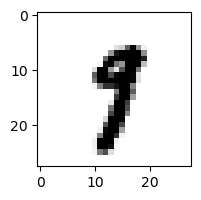

3.4220536493262103e-06% - 0
1.7722869605068179% - 1
5.645204888272347e-07% - 2
0.004113533585731506% - 3
0.0008720113519202586% - 4
0.04959009367059775% - 5
1.1235104328532963e-05% - 6
7.580878932529261% - 7 - ОШИБКА
2.5239420780273875e-05% - 8
0.08384208355475192% - 9

 8


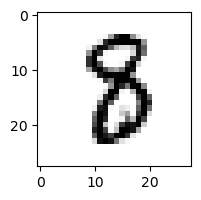

4.816661862978531e-05% - 0
0.05948317993968487% - 1
0.003872400436269097% - 2
0.012629200436650414% - 3
4.086797717002954e-06% - 4
0.6242204186140143% - 5 - ОШИБКА
0.0033479034281232774% - 6
0.0001610724410113103% - 7
0.000588616690917752% - 8
2.1325172635324933e-14% - 9

 7


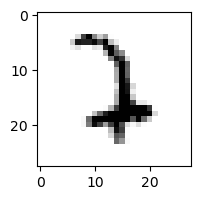

8.583047738929129e-07% - 0
0.9799552236427334% - 1
84.94316735767781% - 2 - ОШИБКА
0.15798456818784745% - 3
0.00010644013665028589% - 4
0.00122306461191046% - 5
7.427457827991425% - 6
1.021086432422915% - 7
2.9740783535637026e-09% - 8
9.636379687253176e-06% - 9

 9


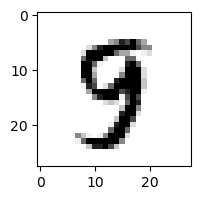

1.2265672465262704e-05% - 0
5.199764944570566e-05% - 1
6.815721634002623e-05% - 2
0.1703355918504816% - 3 - ОШИБКА
0.0212312488985762% - 4
0.10920928812123948% - 5
1.7916602160662044e-05% - 6
0.004153819684092639% - 7
0.003124873178783752% - 8
3.585580758344937e-05% - 9

 9


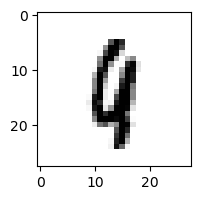

3.255711667068576e-06% - 0
0.940139738376781% - 1
0.22668567407677118% - 2
1.6213785078966299e-07% - 3
1.5374833524437441% - 4 - ОШИБКА
0.0018537501320790768% - 5
1.1145499483869354% - 6
0.18577370532511803% - 7
0.002125866740601307% - 8
0.0018028802315297398% - 9

 5


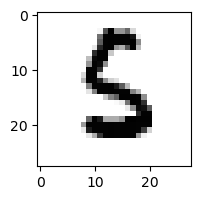

1.4925954589358272e-05% - 0
1.707602828145335e-05% - 1
0.28576155950611754% - 2
0.020813146316887163% - 3
8.962652544201913e-06% - 4
55.20889868835298% - 5
55.25393768940676% - 6 - ОШИБКА
5.0409824544077865e-08% - 7
5.502105803386519e-07% - 8
1.209650309725383e-12% - 9

 8


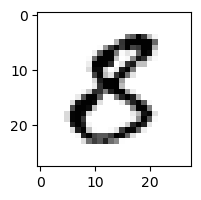

0.5045847495038323% - 0
0.0002730564594580769% - 1
0.311396357330217% - 2
0.006304245491433909% - 3
3.186081583127328e-05% - 4
9.873558363847048% - 5 - ОШИБКА
2.9341393664351766e-06% - 6
2.5889685522560087e-08% - 7
2.0508058142865543e-08% - 8
4.921099424873532e-11% - 9

 4


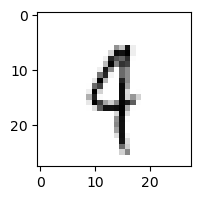

0.003090057963509302% - 0
1.5453588611847762% - 1
0.5993318610106414% - 2
0.023915340839799966% - 3
33.58183547377744% - 4
0.6745595767680158% - 5
3.2944250264329353% - 6
14.987466623085444% - 7
0.0643606587766397% - 8
99.59981206730467% - 9 - ОШИБКА

 9


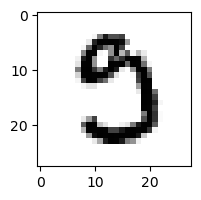

6.599875964836804% - 0 - ОШИБКА
1.0098621808837994e-06% - 1
0.00016882634564055748% - 2
0.4206434989780618% - 3
1.7115429995724108e-08% - 4
6.054504697525469% - 5
5.895893572438283e-06% - 6
0.1341142521724516% - 7
9.884393409518931e-06% - 8
1.7931564012173382e-11% - 9

 8


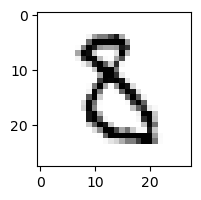

0.0073044996182624455% - 0
9.05697350638444e-05% - 1
11.653011703484575% - 2 - ОШИБКА
0.0979029397011556% - 3
0.0006498697788773411% - 4
4.263785699452886% - 5
0.4945380391655718% - 6
2.4666651977042945e-05% - 7
4.032512072067428e-05% - 8
2.337450033603261e-08% - 9

 5


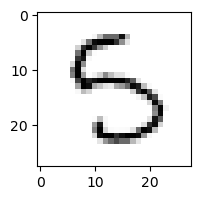

0.03887353258731235% - 0
0.0016668578726266156% - 1
0.00012328377155821897% - 2
91.74146685274384% - 3 - ОШИБКА
6.533910020282415% - 4
82.06711813751583% - 5
0.3910033066473106% - 6
0.0009350777824900917% - 7
0.005822707066784914% - 8
8.395141881661785e-07% - 9

 2


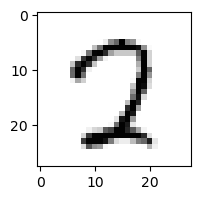

27.10272904655674% - 0
6.964340906767731e-06% - 1
0.5493631271018118% - 2
5.42427665546283% - 3
0.027086700925009873% - 4
6.901679596218943% - 5
0.00012919564086475815% - 6
2.1982675735054245% - 7
27.425854335866152% - 8 - ОШИБКА
0.00021339321876945997% - 9

 5


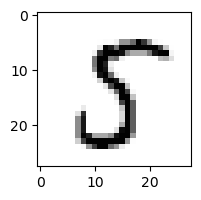

0.0663308658186838% - 0
0.049161803741681574% - 1
0.006951171024990209% - 2
0.07779450080052064% - 3
8.772911471564222e-05% - 4
98.88205626970915% - 5
2.288023149323797e-05% - 6
0.0006330257240404584% - 7
99.78206586722125% - 8 - ОШИБКА
7.558368310921795e-07% - 9

 8


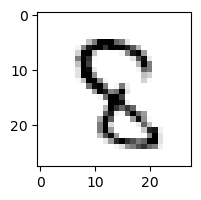

6.1000160550985535e-06% - 0
7.716151655089813e-05% - 1
0.15016245796730457% - 2
0.0007267388863646941% - 3
4.1269170166686155% - 4
5.664418582425098% - 5 - ОШИБКА
0.0023944087770159756% - 6
0.0015004324958654155% - 7
0.7387313122930665% - 8
0.00025049400440900775% - 9

 7


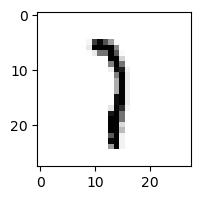

0.00018629982171843598% - 0
66.93453084433241% - 1 - ОШИБКА
16.54481903890915% - 2
4.036752342098733% - 3
0.0754366743535818% - 4
0.3860095856684992% - 5
0.31642622965146644% - 6
23.41081600268957% - 7
0.007866485224930917% - 8
0.3642932115291141% - 9

 8


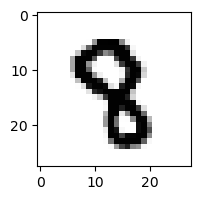

2.5139620860732977e-10% - 0
2.5941025067896866e-05% - 1
8.68570443631156e-05% - 2
2.2768951285158478e-05% - 3
0.09376488268030814% - 4 - ОШИБКА
0.004040826119268918% - 5
5.546659447842707e-06% - 6
0.0015878234952963182% - 7
1.0389312951199757e-07% - 8
8.501226919932995e-08% - 9

 0


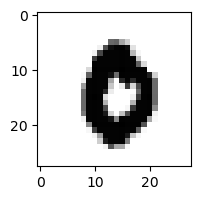

0.025772605789342058% - 0
9.645454153888357e-09% - 1
1.6637174326644192e-06% - 2
2.1849638274430487e-08% - 3
1.0506525634048917e-08% - 4
1.9158377631432284e-05% - 5
0.5418018204904937% - 6 - ОШИБКА
0.00036821157440320617% - 7
2.616721563835014e-11% - 8
1.491774075365195e-08% - 9

 4


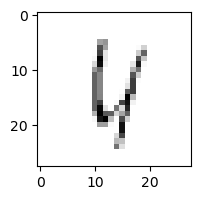

1.1438290849192578% - 0
0.4479207750805576% - 1
32.104564139682545% - 2
0.0006903665871507189% - 3
65.85760621716594% - 4
2.8910570321752287% - 5
39.64139013716254% - 6
11.768602256547757% - 7
76.22848570126216% - 8 - ОШИБКА
15.904537266803079% - 9

 9


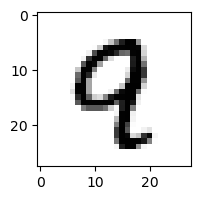

0.0003548162480204012% - 0
0.00034704858512411976% - 1
0.009078541394476261% - 2
3.458526365817128e-07% - 3
8.909385901177055% - 4 - ОШИБКА
0.0002751453984702951% - 5
5.848963875181171e-05% - 6
0.008652701551779506% - 7
0.001004755564721537% - 8
0.1862113069113459% - 9

 7


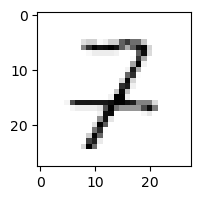

0.0505233231308774% - 0
1.0313528144562825% - 1
88.61794912331685% - 2 - ОШИБКА
1.745395373138051% - 3
15.4954995079238% - 4
0.01857538777146082% - 5
0.06379021562125853% - 6
0.6901779242241892% - 7
0.03636800499888554% - 8
0.001483011140445073% - 9

 8


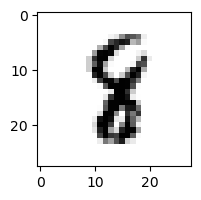

3.32249351723896e-08% - 0
0.5473620271252353% - 1 - ОШИБКА
0.0064196776093584885% - 2
5.561655147082875e-05% - 3
0.013591672560082698% - 4
0.08719368855647013% - 5
0.008709256439008547% - 6
0.0010606994305111888% - 7
0.2449568064144265% - 8
2.0380270871433234e-09% - 9

 8


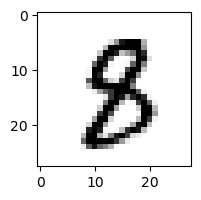

3.3223461592509384e-05% - 0
0.007777225840013786% - 1
5.413499100188443e-05% - 2
0.001860793622868797% - 3
0.00040607912488447684% - 4
0.17865646680454506% - 5 - ОШИБКА
1.7754498031752486e-05% - 6
5.473047547419283e-05% - 7
0.0003128735561031455% - 8
4.311300619156883e-09% - 9

 5


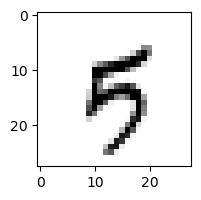

0.0069031908224920155% - 0
0.06358716448808899% - 1
0.00020340066279840845% - 2
0.02538366899932744% - 3
2.7432584015907144% - 4 - ОШИБКА
0.9636179864125238% - 5
0.018094686152118393% - 6
0.9766036988715818% - 7
0.00014550808576776692% - 8
0.21037253114247392% - 9

 5


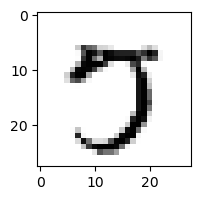

3.8271056545349924% - 0
2.277749092815074e-06% - 1
0.0002725565996216445% - 2
0.48910769350453454% - 3
4.3577483333878407e-05% - 4
61.24841267944552% - 5
3.572581606935447e-06% - 6
92.10760756045367% - 7 - ОШИБКА
0.002071565199702412% - 8
0.0009852964240420568% - 9

 9


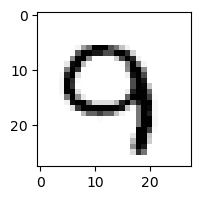

0.002273189819554877% - 0
4.809215362136763e-06% - 1
0.7125209574057675% - 2
2.029622915117476e-06% - 3
3.023308724091036% - 4
4.623619908341044e-07% - 5
0.00026677942819967616% - 6
5.872590760186121% - 7 - ОШИБКА
2.6261269898568386e-08% - 8
0.6809303756732784% - 9

 3


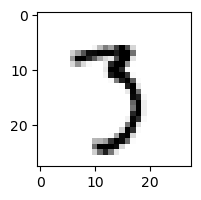

0.006216699117116829% - 0
0.005299375651891976% - 1
0.003269142239025064% - 2
97.73912869752742% - 3
5.07708231892755e-05% - 4
1.3630883192262522% - 5
0.0003592267489611025% - 6
98.48185968416695% - 7 - ОШИБКА
0.00048519118160372267% - 8
0.07460664196141352% - 9

 8


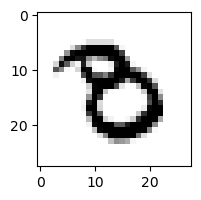

0.014293795652112792% - 0
1.9492794393024426e-06% - 1
0.0002603270217772869% - 2
0.181020349179197% - 3
2.5123340332394507e-08% - 4
0.0007619225584795363% - 5
2.161922483642294% - 6 - ОШИБКА
0.00018431663629823867% - 7
6.972363465715511e-10% - 8
4.270365341590262e-10% - 9

 8


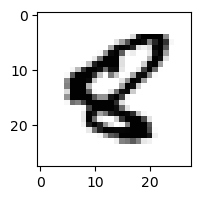

0.0001248105757632366% - 0
0.00015644821478027137% - 1
4.128309358323321e-06% - 2
6.338283035630769e-16% - 3
0.0023395420095371987% - 4
0.05256350335581753% - 5
0.09666718613398437% - 6 - ОШИБКА
1.4576749295775444e-06% - 7
2.783752193011263e-06% - 8
1.2787949768442446e-07% - 9

 7


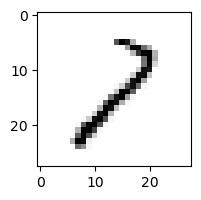

1.0090218880534303% - 0
17.61390675339642% - 1
80.78801430746668% - 2
3.459102835495094% - 3
0.6179046280693711% - 4
0.10105374143003838% - 5
0.46945988928048904% - 6
1.66268045411719% - 7
99.91669900044177% - 8 - ОШИБКА
0.012256263852671647% - 9

 7


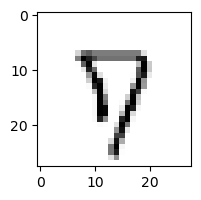

0.13391075015529796% - 0
2.4365364216998234e-05% - 1
0.15003385106622807% - 2
0.002419094988487651% - 3
8.512999091189672% - 4
0.8265149934176014% - 5
0.9330736186124051% - 6
7.0044923327989865% - 7
48.31452734744376% - 8
76.90119560847384% - 9 - ОШИБКА

 2


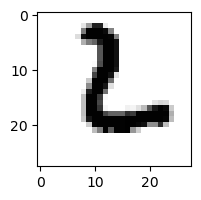

0.028931670474665428% - 0
3.8075106858610514e-06% - 1
98.23659664629358% - 2
3.2305337220888355e-06% - 3
2.5727299140255717e-10% - 4
0.5971331822028574% - 5
99.81053032947759% - 6 - ОШИБКА
1.3575022949279942e-07% - 7
1.2555259484003487e-08% - 8
8.771458132268405e-08% - 9

 5


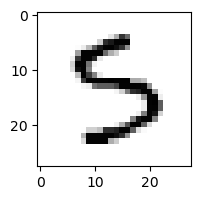

0.004905765395570051% - 0
6.071718651417822e-05% - 1
6.984246610747231e-05% - 2
71.7857139430489% - 3 - ОШИБКА
0.01830378485308582% - 4
68.33920383692156% - 5
0.2932970485143285% - 6
0.000655703691188629% - 7
0.04690650330788578% - 8
1.2564340367627001e-08% - 9

 7


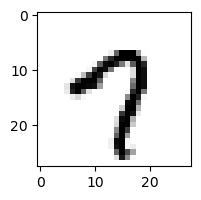

1.6113621940850846% - 0
2.8630318282352235e-05% - 1
2.460051482892577e-08% - 2
0.0002561781188070172% - 3
1.1369208099642776% - 4
0.6245661229311454% - 5
0.020156316265342686% - 6
69.23350574325463% - 7
1.620105172994495e-05% - 8
99.79984590081843% - 9 - ОШИБКА

 5


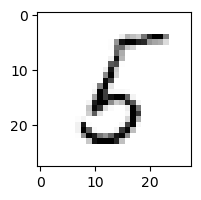

0.3548366915791116% - 0
0.7650919908176479% - 1
4.299374564715239% - 2
0.6103975796520791% - 3
0.15801788558796342% - 4
69.30946848845802% - 5
48.653796126279104% - 6
7.662063628758526e-05% - 7
99.3176700987572% - 8 - ОШИБКА
0.0004000953037181599% - 9

 3


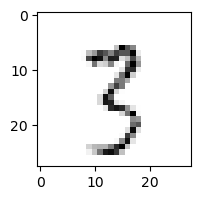

0.0010733286606774764% - 0
4.430130356690017% - 1
4.304292416092881% - 2
32.391216369535705% - 3
0.01322788951982274% - 4
4.3514576852245535% - 5
0.0020403969262597034% - 6
22.342233477114174% - 7
3.0070665832843506% - 8
83.0894466668686% - 9 - ОШИБКА

 5


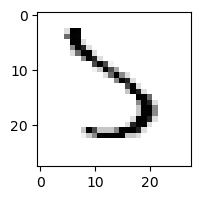

0.006800358363352516% - 0
0.11038962845738212% - 1
21.024314412930863% - 2
99.39352369203577% - 3 - ОШИБКА
3.1481613682970906% - 4
33.68785066775476% - 5
1.764610695718136% - 6
3.01690532594215% - 7
0.0028389665370303152% - 8
8.94447741825926e-07% - 9

 8


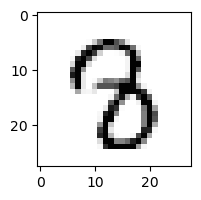

4.112490299119634e-06% - 0
0.0013069161392203444% - 1
7.637765752018537e-05% - 2
0.015682812728737214% - 3
0.24265869175062493% - 4 - ОШИБКА
0.14161708129177902% - 5
0.00010457804792842937% - 6
0.060216281058731176% - 7
2.4176666317687725e-05% - 8
2.340364378869655e-08% - 9

 5


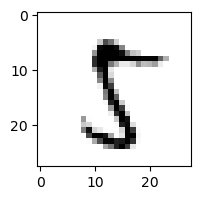

0.011896100103405936% - 0
0.059146405406174295% - 1
0.21287020391891565% - 2
0.04151728790650493% - 3
0.00024126089919492246% - 4
92.11511045835353% - 5
1.4841408790590126e-06% - 6
0.410775845839303% - 7
99.8695819685698% - 8 - ОШИБКА
0.0014065429173636668% - 9

 2


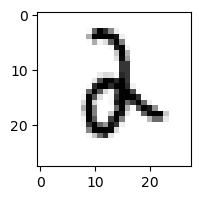

7.007245446766234e-05% - 0
0.018811391742613457% - 1
2.0079587035084057% - 2
0.3052285086746871% - 3
0.03603051310788602% - 4
0.0019423999880590528% - 5
6.58300681720215% - 6 - ОШИБКА
4.918918851380108e-05% - 7
2.0473703655343918e-09% - 8
0.0004920152775718068% - 9

 8


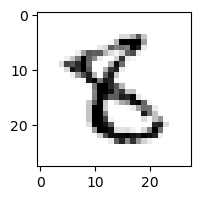

0.003905271730094609% - 0
0.0014290064288111557% - 1
0.10473382230149351% - 2
5.685910831298329e-05% - 3
0.0014113013748537253% - 4
33.02961322145068% - 5 - ОШИБКА
6.00886072040165% - 6
1.0337289470452316e-06% - 7
2.3154456123425096% - 8
2.601529788649082e-07% - 9

 9


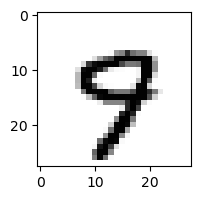

0.000247006405471861% - 0
1.9839127653238344e-07% - 1
7.687107915944338e-07% - 2
5.722282190507405e-05% - 3
0.27055889194451005% - 4
0.5050616484526167% - 5
0.0002818310861366969% - 6
11.33980126822389% - 7 - ОШИБКА
3.720088596415931e-06% - 8
8.912034178036944% - 9

 9


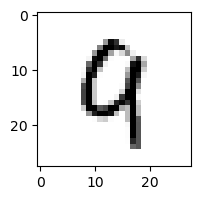

0.0012117451254816459% - 0
0.003382534362415489% - 1
4.8374008941460085% - 2
1.057257665588292e-06% - 3
54.34029781372214% - 4 - ОШИБКА
0.00042907886578398606% - 5
0.013690221183464076% - 6
0.49539088981403345% - 7
0.04620043648343732% - 8
3.3889051061484965% - 9

 8


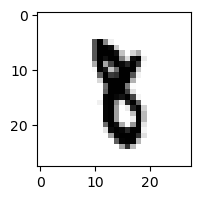

5.88335844880801e-10% - 0
28.278444061397686% - 1 - ОШИБКА
0.001979777308310703% - 2
0.03930676432128712% - 3
6.131597442960194e-05% - 4
0.014654410946157053% - 5
6.258167019180701e-05% - 6
0.04115384715661269% - 7
1.992638552744993e-08% - 8
1.065040870537708e-07% - 9

 9


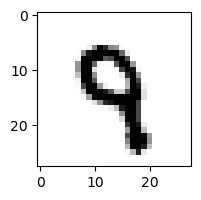

1.36179368937021e-07% - 0
0.00014446836304073427% - 1
0.00256072734778182% - 2
0.0037168386127775844% - 3
10.339269082880746% - 4 - ОШИБКА
0.0767820141921271% - 5
0.002617768585300203% - 6
0.17174202952590048% - 7
1.7680972575100253e-07% - 8
4.914990640724479% - 9

 4


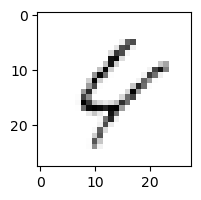

7.563508455453177% - 0
0.07393514196045253% - 1
6.269867734010215% - 2
1.3213765239443873e-05% - 3
61.306712229197245% - 4
0.017598025278613903% - 5
10.44905555454903% - 6
1.7252940106007968% - 7
79.42978653111324% - 8
99.34331132879721% - 9 - ОШИБКА

 8


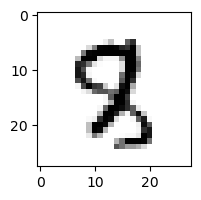

8.606427307112956e-07% - 0
0.006749672619916446% - 1
0.03722675220698102% - 2
0.00020042183237974247% - 3
0.006523752427449194% - 4
0.04801302087967596% - 5
0.00041863477772653034% - 6
0.0695835710090278% - 7 - ОШИБКА
1.1976991461034808e-06% - 8
0.0003134830575326191% - 9

 6


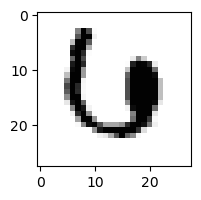

1.8066331144524697% - 0
4.840106692245725e-08% - 1
0.0015311160012411941% - 2
0.018047788434704386% - 3
0.2783528097321631% - 4
1.718770090714611e-07% - 5
2.6725947209568894% - 6
17.90924014654201% - 7 - ОШИБКА
1.3956027868216463e-10% - 8
3.133469764537001e-09% - 9

 4


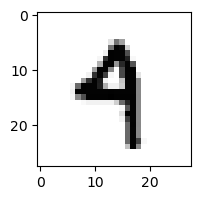

3.31279984301943e-05% - 0
0.010621344282840924% - 1
1.6691141277859708e-05% - 2
0.20559703980894511% - 3
51.078691489119684% - 4
0.07482369180668394% - 5
0.006192609711809282% - 6
0.01672560759260836% - 7
5.070940250260266e-08% - 8
80.10179445594149% - 9 - ОШИБКА

 3


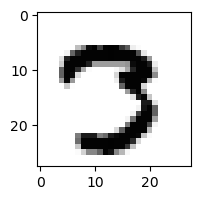

0.00017747374088639825% - 0
9.619768052581593e-09% - 1
4.5568024779970795e-06% - 2
89.40221907208624% - 3
4.498011958239884e-10% - 4
0.0021246638251020402% - 5
3.078119009911486e-11% - 6
95.83001430465406% - 7 - ОШИБКА
4.961115550544049e-07% - 8
5.105832966288014e-09% - 9

 8


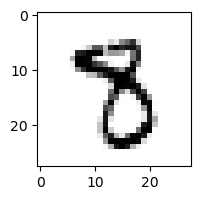

2.435322154893018e-06% - 0
0.032353482339050416% - 1
5.9695782147149616e-05% - 2
0.03493353972103463% - 3
0.000221562417353483% - 4
2.5482282121439335% - 5 - ОШИБКА
1.778909784428471e-06% - 6
0.35692691587971964% - 7
0.0027221507024113726% - 8
4.2167147533451216e-09% - 9

 5


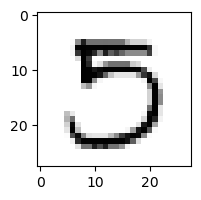

6.375047248301367% - 0
9.273170292401109e-06% - 1
0.0009465591440838707% - 2
58.09779038820126% - 3 - ОШИБКА
3.228659208292198e-07% - 4
0.328184723495451% - 5
9.571095149375576e-08% - 6
0.8309168207336872% - 7
0.006209124166128656% - 8
1.6785784235303082e-08% - 9

 3


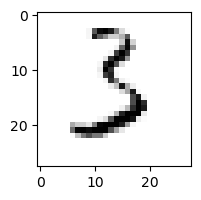

0.3209275289436061% - 0
0.0164404125085163% - 1
39.924863256046855% - 2 - ОШИБКА
22.55544303680887% - 3
3.9586084743159786e-06% - 4
23.27358377752374% - 5
20.960326271479058% - 6
0.1567090670161563% - 7
1.9450387061969293e-05% - 8
0.010860376650690827% - 9

 7


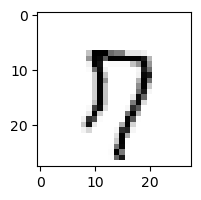

30.60919169296561% - 0
1.9003570376177025e-05% - 1
0.9479305758638207% - 2
0.03604209143511329% - 3
0.0747075443337466% - 4
4.270666800303782% - 5
0.7773778920394445% - 6
32.63947717524892% - 7
90.0009412372743% - 8
95.25148690777537% - 9 - ОШИБКА

 8


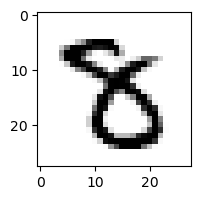

5.631165641064041e-08% - 0
0.00031751165270473675% - 1
0.0021110045681378034% - 2
0.15096682613252474% - 3 - ОШИБКА
5.7400286469929964e-05% - 4
0.04473125339083215% - 5
1.6040762415101965e-07% - 6
5.4952520064285654e-05% - 7
0.0025519653380662328% - 8
1.1064884182696101e-11% - 9

 7


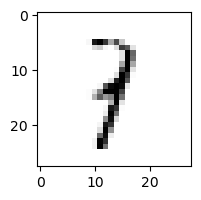

0.0004679946341244785% - 0
84.63946635640036% - 1 - ОШИБКА
15.010131907128136% - 2
41.61269039309731% - 3
3.2273108246732614% - 4
2.4164650320363976% - 5
0.2147216849392828% - 6
0.03574136268512144% - 7
1.00509090615417% - 8
4.024049160823289% - 9

 8


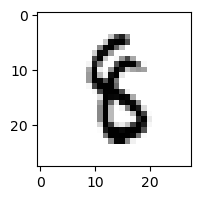

5.775671886192448e-06% - 0
0.153623750186446% - 1
0.003304393749845784% - 2
0.023244892492946815% - 3
0.0007284657903840778% - 4
0.4633529384261391% - 5 - ОШИБКА
0.029732186312740886% - 6
3.7605108767404924e-05% - 7
0.0011104302912966068% - 8
2.603691351447218e-09% - 9

 2


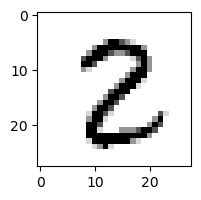

0.0043543653253500635% - 0
0.005932554786587592% - 1
28.834055998836583% - 2
0.05327184929481885% - 3
1.6222174855666806e-05% - 4
0.05869789513538598% - 5
2.4060606113308927e-06% - 6
0.0003135711739038825% - 7
99.99229144957211% - 8 - ОШИБКА
3.090968007173983e-07% - 9

 7


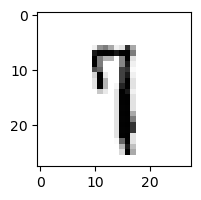

0.0003111339290055273% - 0
0.5076789226150237% - 1
0.2020361461892872% - 2
3.6697947480995703% - 3
2.558734847052202% - 4
3.984144367606915% - 5
0.2816717017648134% - 6
39.719603906423984% - 7
0.17378206250832273% - 8
82.77240502380971% - 9 - ОШИБКА

 8


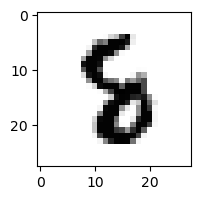

3.739003259457612e-09% - 0
0.00045815843212663137% - 1
0.00676930403602213% - 2
2.2132153266224048e-07% - 3
0.005158690734431385% - 4
0.7308873178828662% - 5 - ОШИБКА
0.2365452277174239% - 6
2.353336115093534e-06% - 7
0.0002672210596216601% - 8
4.456860171789434e-12% - 9

 5


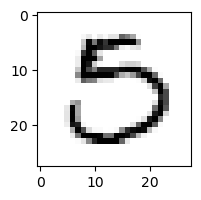

33.01871554893705% - 0 - ОШИБКА
1.8041243897222465e-05% - 1
0.1592300919762439% - 2
0.48534219942377255% - 3
1.989306489057577e-06% - 4
0.02050342043567766% - 5
1.6475665308142858e-05% - 6
0.005027210658491429% - 7
0.05001635790731114% - 8
1.1152565057144888e-13% - 9

 1


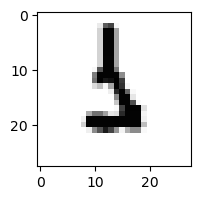

1.4304531725050492e-05% - 0
0.08553492907507161% - 1
0.09297743103834169% - 2
0.0042358190444575046% - 3
9.366384887962602e-07% - 4
1.5346091076101136% - 5
57.744052297440575% - 6 - ОШИБКА
0.001337215683445685% - 7
7.248887015321695e-05% - 8
6.814371083648263e-07% - 9

 8


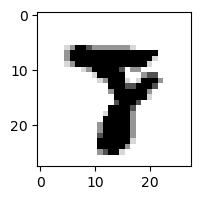

1.3484843351796366e-09% - 0
8.206370191856635e-06% - 1
1.92448487236317e-08% - 2
1.4246926842252147e-07% - 3
8.726535015718771e-09% - 4
0.00017640396474442695% - 5
1.79233900710292e-10% - 6
78.69034116606653% - 7 - ОШИБКА
2.4742546838666462e-09% - 8
6.281731073676404e-11% - 9

 9


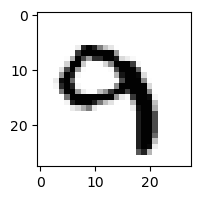

1.5204759770423376e-06% - 0
1.493224074860758e-05% - 1
0.012405813357862068% - 2
1.8998656745934681% - 3 - ОШИБКА
0.1745084195775111% - 4
3.5760390049506043e-05% - 5
5.5670620747366514e-05% - 6
0.8757625597456317% - 7
3.445461739895842e-15% - 8
0.0034151449769743406% - 9

 4


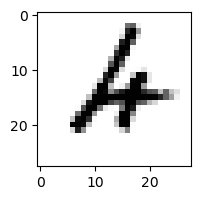

0.00032673726279561205% - 0
0.0009912391545949075% - 1
0.17994482668972772% - 2
0.006301326213773178% - 3
0.07419491564845053% - 4
0.00032807911026221646% - 5
63.20861903092254% - 6 - ОШИБКА
3.986690762040978e-05% - 7
0.000821713687357919% - 8
0.03022452372908214% - 9

 9


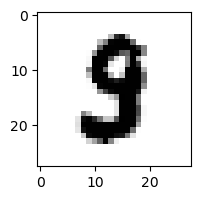

1.7289705237432217e-05% - 0
1.1740372296445948e-05% - 1
0.0008303644527210279% - 2
0.0016678868084133286% - 3
2.8181768551423368e-08% - 4
0.35489778033400793% - 5 - ОШИБКА
2.3214353218578428e-05% - 6
1.93689655564149e-05% - 7
9.387242242913945e-05% - 8
6.787436029325909e-11% - 9

 9


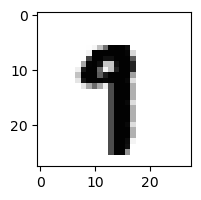

3.7618581251589715e-10% - 0
0.1452304009823041% - 1
3.278826219165394e-09% - 2
3.904245133671519e-07% - 3
2.6467027712875695e-05% - 4
0.07671675593299897% - 5
5.406661337213707e-06% - 6
2.2313178698467175% - 7 - ОШИБКА
4.449225139951208e-07% - 8
0.0037105163691446104% - 9

 9


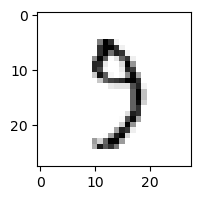

0.3801934343976088% - 0
0.0057053242112846785% - 1
0.03697875361909111% - 2
92.20463291551555% - 3 - ОШИБКА
0.06369937636243553% - 4
5.306473535654233% - 5
0.010060124743494315% - 6
30.288727475460625% - 7
1.3903882468383273% - 8
0.638677543353958% - 9

 8


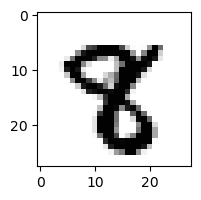

5.8455597140111215e-12% - 0
5.209268913251396e-05% - 1
5.146432544262309e-08% - 2
1.1324298217752086e-06% - 3
9.639779165458194e-06% - 4
0.0017117846518973157% - 5 - ОШИБКА
4.401671368831863e-10% - 6
0.0005511447713532353% - 7
7.78468993812956e-10% - 8
5.26766814801403e-09% - 9

 8


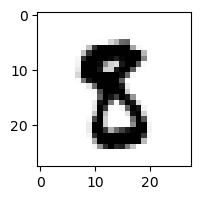

9.554138355660904e-07% - 0
1.640026576074432e-05% - 1
2.786856666649144e-08% - 2
2.348287996198012e-05% - 3
2.546749931081573e-08% - 4
9.385977243988771% - 5 - ОШИБКА
4.651452402568059e-08% - 6
1.0907225446378738e-05% - 7
0.029794521040900624% - 8
2.3117459880640633e-09% - 9

 6


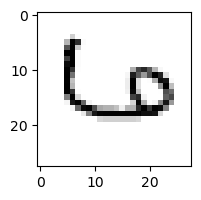

51.98195116262694% - 0
0.0021820142518101655% - 1
7.242344766585673% - 2
0.0007283301766529188% - 3
33.782931140859674% - 4
4.2226253411991785e-10% - 5
61.946039521006554% - 6
69.72229561781151% - 7 - ОШИБКА
0.02768342025923189% - 8
0.1192002887936854% - 9

 4


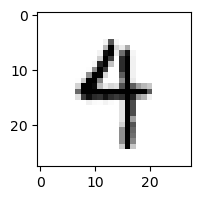

0.00022279658732132405% - 0
0.07466343535856895% - 1
4.323923610360166e-05% - 2
0.43484121042833174% - 3
95.83943934347407% - 4
2.9128819559718027% - 5
0.16494489591742154% - 6
0.09164984660477107% - 7
1.6034509598068354e-06% - 8
96.80186414618954% - 9 - ОШИБКА

 7


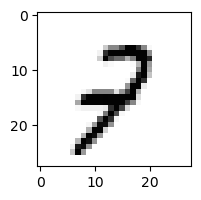

0.222260391450089% - 0
0.04751374625384516% - 1
54.91608556917688% - 2
0.1422506123441802% - 3
0.17204773584408886% - 4
0.013170904615959404% - 5
0.002492097222585708% - 6
0.24877382979979915% - 7
0.001010833852251606% - 8
94.89630018005212% - 9 - ОШИБКА

 2


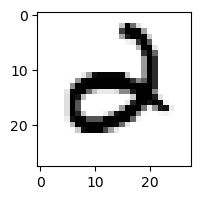

0.004063182590691521% - 0
5.154802963155386e-06% - 1
1.0337015769645808e-09% - 2
1.733480375105278e-05% - 3
0.5245614701253726% - 4
0.01345793504102045% - 5
61.50505346277377% - 6 - ОШИБКА
9.049508442473332e-05% - 7
4.84975034787316e-14% - 8
1.3665762922033539e-08% - 9

 8


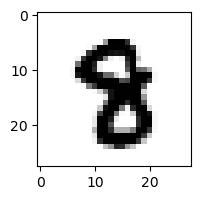

4.978034727268685e-10% - 0
1.6319149815732032e-05% - 1
5.993028199122782e-09% - 2
4.2493335675805316e-08% - 3
8.451812828333204e-05% - 4
0.0003345342964859646% - 5 - ОШИБКА
4.533311822361929e-06% - 6
4.680141801849269e-06% - 7
0.00026633504387390525% - 8
2.2555215604885061e-10% - 9

 0


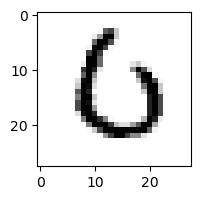

79.58238038885075% - 0
3.9892239603402376e-07% - 1
21.118952272317685% - 2
0.000985930495596148% - 3
0.016623134338093024% - 4
0.006547585512668558% - 5
99.25640272149047% - 6 - ОШИБКА
0.0011071913350240083% - 7
1.5541357630270906e-05% - 8
6.556485461788552e-07% - 9

 4


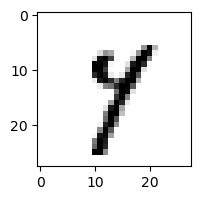

4.0636421065768985e-05% - 0
3.455015358974886% - 1
0.0002858356481665555% - 2
0.001031253451255543% - 3
7.069074263341819% - 4
3.188019306426535% - 5
0.0005958189360928558% - 6
22.23879219515917% - 7 - ОШИБКА
8.238655962940753% - 8
0.04354532635531877% - 9

 9


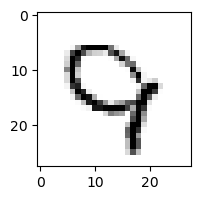

0.020011303038090764% - 0
6.810822256521514e-05% - 1
0.7297246356940796% - 2
0.0003740950426284001% - 3
43.82578219201898% - 4 - ОШИБКА
0.0018284067800019331% - 5
0.5265822091655527% - 6
5.9810361951864515% - 7
2.5077092048103696e-07% - 8
0.2492147481250639% - 9

 5


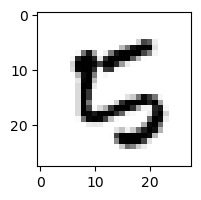

0.04493179150946155% - 0
1.4452341649994398e-06% - 1
3.19320549287031% - 2 - ОШИБКА
2.634111454907337e-11% - 3
0.026616084836298685% - 4
0.24753389292342548% - 5
0.02867949062688989% - 6
0.008516089978285148% - 7
2.1475131671088816e-08% - 8
9.79400807562982e-06% - 9

 2


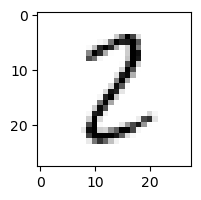

0.18959887107882542% - 0
3.508657134839255% - 1
71.55063175880146% - 2
31.162991734924873% - 3
0.0004481284754719498% - 4
1.545754798661351% - 5
0.010374066371668824% - 6
0.0004103892073386982% - 7
74.1749622376534% - 8 - ОШИБКА
4.5668583338497115e-07% - 9

 7


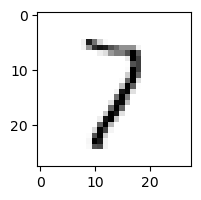

0.08173368253826205% - 0
5.076831936861699% - 1
56.61516814736315% - 2 - ОШИБКА
33.93135707483011% - 3
2.4364991261588713% - 4
0.5224733372038745% - 5
0.07860279176452672% - 6
43.30120795459167% - 7
8.362102539469538% - 8
15.279806531889603% - 9

 2


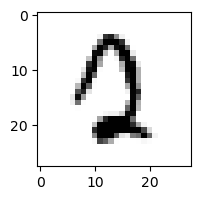

0.1277046581208238% - 0
8.770159837618239e-05% - 1
0.3261889470492248% - 2
0.041059384362629084% - 3
0.001168007707686613% - 4
0.4561638353363719% - 5 - ОШИБКА
0.09155707952928016% - 6
0.044929302600226394% - 7
5.185656208139078e-08% - 8
8.509381450594425e-07% - 9

 3


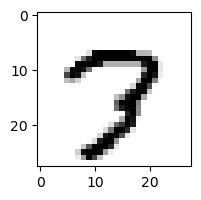

0.018298970490764534% - 0
1.9812460385315143e-07% - 1
0.0008543660164865134% - 2
0.003858004869907572% - 3
0.00012799584382573967% - 4
0.08446674000714954% - 5
4.134920760669464e-06% - 6
99.28546147178109% - 7 - ОШИБКА
0.01334415623961654% - 8
0.6515909783445639% - 9

 5


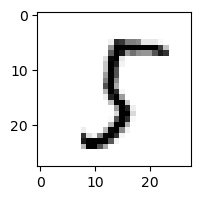

0.08943654719053648% - 0
5.103819922008044% - 1
0.04301289164579896% - 2
4.5179314272490005% - 3
0.0007170545652949777% - 4
35.72129447522651% - 5
0.004779201056671992% - 6
0.0023203964750771982% - 7
61.688758212000735% - 8 - ОШИБКА
0.0006900841250645245% - 9

 8


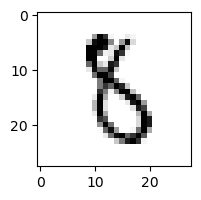

0.0007526581933758864% - 0
0.009835701423594424% - 1
1.5781006077924657% - 2
0.49922398064930373% - 3
0.0012142066982314423% - 4
28.05094571530566% - 5 - ОШИБКА
0.9124756819186598% - 6
0.0001520298408698743% - 7
0.3860173684165876% - 8
0.00010532501457293086% - 9

 8


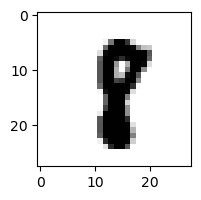

2.509235533686307e-08% - 0
1.5166460096975027% - 1 - ОШИБКА
2.4105052246996935e-05% - 2
3.898452782689979e-05% - 3
3.16392075862218e-06% - 4
0.0053248742387283525% - 5
6.565167606457286e-07% - 6
0.00046861338420286776% - 7
0.0038686754957083396% - 8
5.3241520328738735e-08% - 9

 9


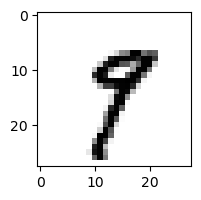

5.3704336901119435e-05% - 0
1.9420876813920334% - 1
4.733005582335881e-06% - 2
0.023005250711177892% - 3
0.07697743259819276% - 4
0.10318365364426636% - 5
1.4270661557780388e-05% - 6
21.988956629393954% - 7 - ОШИБКА
0.4310337027466355% - 8
4.271805907487736% - 9

 2


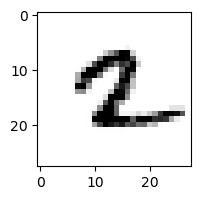

4.3553028591582913e-07% - 0
0.9146243824986496% - 1
0.1378557136118049% - 2
1.8096062895217844e-08% - 3
5.251970441248985e-06% - 4
0.0572045979379302% - 5
0.7610033676733587% - 6
0.09976347025854955% - 7
4.375888959867409e-06% - 8
1.6857606831610226% - 9 - ОШИБКА

 8


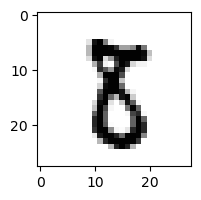

0.00010813224954413328% - 0
0.008329074959608803% - 1
0.012838380244848903% - 2
0.39989176417222105% - 3
1.4362358760097623e-08% - 4
2.502160588514942% - 5 - ОШИБКА
1.707606188950687e-05% - 6
2.2931717384945086e-05% - 7
0.6407849740759712% - 8
2.4706299340631163e-06% - 9

 9


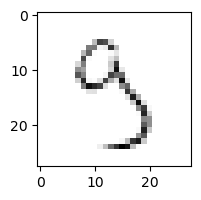

0.09793522055823602% - 0
0.4005530850536931% - 1
0.03286926347950416% - 2
97.84429477094939% - 3 - ОШИБКА
27.030679690014402% - 4
37.48263142116117% - 5
4.131931139038082% - 6
9.282952903062796% - 7
0.20558277398842612% - 8
7.3042896766048955% - 9

 7


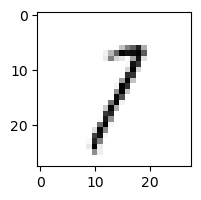

0.7467739053016733% - 0
42.59523500534718% - 1
19.675287209805038% - 2
46.02787088106714% - 3
1.978244157136461% - 4
1.8277789658809322% - 5
0.5574055181456667% - 6
58.37267614837135% - 7
26.715394983172857% - 8
96.53207102071741% - 9 - ОШИБКА

 8


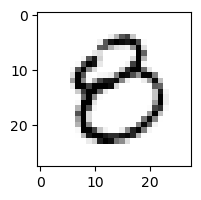

89.82316721955202% - 0 - ОШИБКА
9.7734472534867e-05% - 1
0.0021074802242192587% - 2
0.2751195939557307% - 3
0.01931098657769127% - 4
0.04328988444932535% - 5
0.000854057363610389% - 6
4.4616526094180535e-06% - 7
0.002749278554451873% - 8
4.296238609836899e-09% - 9

 7


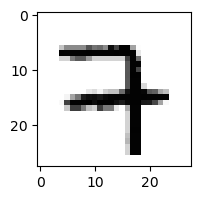

5.913899658056247e-05% - 0
2.6153424060052927e-05% - 1
2.950006764018574% - 2
3.4956188745257806% - 3
4.427609730754089% - 4 - ОШИБКА
3.7114183668942475e-07% - 5
0.0006040716035834927% - 6
1.418873859651556% - 7
2.3148441584940538e-11% - 8
0.003216655047555538% - 9

 2


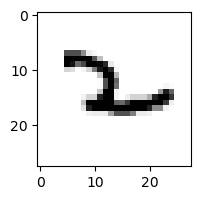

0.00031821587602786684% - 0
0.0360884054812717% - 1
2.698830915732681% - 2
0.001171278782349029% - 3
89.15323892440352% - 4 - ОШИБКА
0.24147700988588652% - 5
28.714907391011717% - 6
0.4504776062261906% - 7
8.935636063631001% - 8
0.006358338020028138% - 9

 3


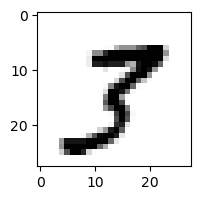

7.155635427651164e-05% - 0
0.015997448351253992% - 1
0.00037768480053242164% - 2
0.4016686895902117% - 3
0.001845151665186806% - 4
0.01852073055855318% - 5
1.2244172370455327e-10% - 6
55.019830253975854% - 7 - ОШИБКА
0.6514946331619325% - 8
0.017317584194191334% - 9

 9


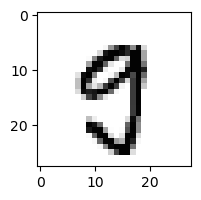

0.23731548998552018% - 0
1.7543372148075053e-05% - 1
5.560983875071774e-06% - 2
0.20163426404061743% - 3
6.516585026322882e-05% - 4
6.4462519212556275% - 5 - ОШИБКА
1.5177670719532213e-05% - 6
0.06134604645946538% - 7
0.00011948823125956337% - 8
2.680243119567063% - 9

 5


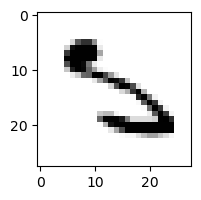

2.6031559102883485e-06% - 0
0.00010638213341043207% - 1
53.0275382124618% - 2 - ОШИБКА
0.35847406414338306% - 3
0.01903295242878775% - 4
35.63519680920507% - 5
45.31433460633356% - 6
0.02928727762676491% - 7
1.6698244051716476e-06% - 8
7.617042505684087e-10% - 9

 8


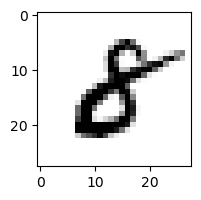

0.03279899187223297% - 0
0.0007662881981300402% - 1
2.5064915520995537% - 2 - ОШИБКА
0.09804162816502156% - 3
1.463365127439627e-06% - 4
0.33210432968223624% - 5
0.0007412529123242879% - 6
4.994306663387818e-06% - 7
0.00015096096003720883% - 8
1.2202096897071117e-06% - 9

 4


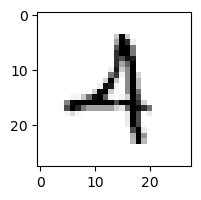

0.027554585849146128% - 0
0.01926304420074181% - 1
46.055232601909104% - 2 - ОШИБКА
23.754534131939835% - 3
1.106819248410005% - 4
0.0004979920175025154% - 5
0.06414716417388838% - 6
0.0007372091117312527% - 7
2.348231840730297e-06% - 8
2.0985085697846806% - 9

 7


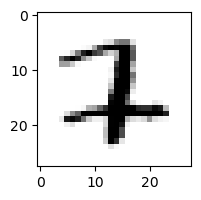

4.37937888939655e-08% - 0
0.08345064630506276% - 1
20.76363233129023% - 2 - ОШИБКА
8.387475336608119e-05% - 3
4.037834540566411e-07% - 4
2.9167894635457617e-06% - 5
0.0009037986238599114% - 6
0.0054179566362091355% - 7
5.216237042819073e-08% - 8
8.586864027445182e-10% - 9

 8


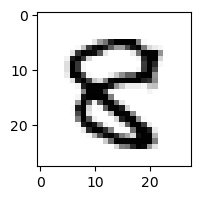

5.9458312384810184e-05% - 0
7.223203677125671e-08% - 1
0.0036797277113574485% - 2
7.521322158815116e-06% - 3
0.5165067897106602% - 4 - ОШИБКА
0.0562926607045973% - 5
1.3110279291645563e-06% - 6
3.814802130936464e-08% - 7
0.13959740634030574% - 8
2.608398006477927e-10% - 9

 8


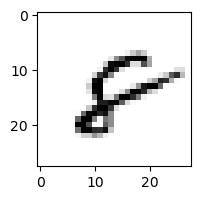

1.3354255982803365% - 0
0.04056289608257023% - 1
0.722076868839147% - 2
4.558293965647375e-06% - 3
0.3408907310886019% - 4
0.026163932900542076% - 5
10.059670080538313% - 6 - ОШИБКА
0.47154269955076866% - 7
0.5081761432470137% - 8
0.08754865607228438% - 9

 7


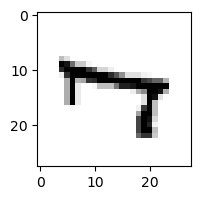

0.033875973890706186% - 0
0.005180039223436187% - 1
4.8052365740336806e-08% - 2
0.017604592887632033% - 3
54.460112584708945% - 4
1.5230928316013284% - 5
80.26756838297219% - 6 - ОШИБКА
0.13644156786280223% - 7
0.015750258856245054% - 8
38.41503380311505% - 9

 1


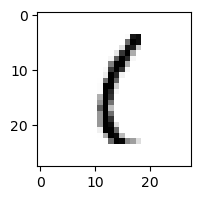

0.4628021019612752% - 0
56.13303757505144% - 1
2.8924669233349536% - 2
4.220598273072933% - 3
0.0011675210272063825% - 4
27.72256325226084% - 5
47.08306514430861% - 6
0.009190071562783328% - 7
90.33982756088699% - 8 - ОШИБКА
1.1978844631751393% - 9

 8


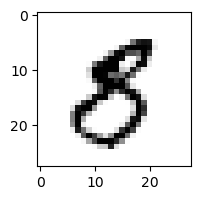

0.04874024102264399% - 0
0.0005779402946529132% - 1
0.0002782446922106648% - 2
0.0191862231715825% - 3
0.00013304654933968634% - 4
8.666190380756714% - 5 - ОШИБКА
1.7980620277332058e-05% - 6
4.094224167519574e-05% - 7
0.0008413352854075718% - 8
7.190913958194918e-05% - 9

 8


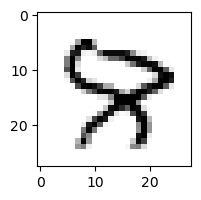

0.0003986253328183106% - 0
2.6028051103929857e-07% - 1
0.0008547788380428821% - 2
0.0002944760988371359% - 3
0.11019600766098683% - 4
4.539438177846553e-05% - 5
0.00020521703773538274% - 6
0.20157664039855738% - 7 - ОШИБКА
5.906787541035867e-09% - 8
2.034736325746624e-05% - 9

 7


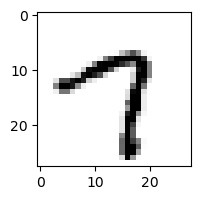

0.4613453231539064% - 0
6.720722884101578e-05% - 1
1.4824299860797493e-06% - 2
0.0003402124712663592% - 3
0.01916371025823938% - 4
0.15898207040597975% - 5
0.0005695583330052967% - 6
95.17373331348432% - 7
0.014241089817752255% - 8
97.6038762196416% - 9 - ОШИБКА

 2


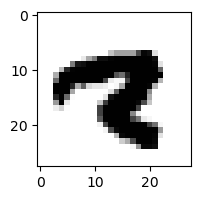

4.674737726720296e-12% - 0
1.928566103267234e-07% - 1
3.7930396080402456e-12% - 2
1.7427657882520646e-15% - 3
0.00035682758692970855% - 4
3.853020501402171e-08% - 5
4.233505306148032e-09% - 6
2.602719701749849% - 7 - ОШИБКА
3.16972381543231e-13% - 8
6.509155611168269e-08% - 9

 6


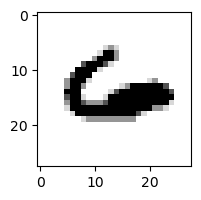

0.0003902058677025317% - 0
4.550350379746048e-06% - 1
0.00031261634474157653% - 2
2.778493450407154e-15% - 3
98.90386087860301% - 4 - ОШИБКА
7.949808723869428e-08% - 5
94.2921821468897% - 6
0.20387091479442537% - 7
4.330505640787328e-09% - 8
0.09133421675134155% - 9

 9


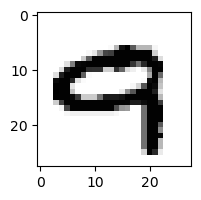

0.0008750511209939815% - 0
1.022573943994377e-08% - 1
0.011348684989244039% - 2
3.1442855352977757e-09% - 3
0.00022918923093284216% - 4
7.626766538363421e-08% - 5
2.1005312370718143e-08% - 6
0.568553899735132% - 7 - ОШИБКА
1.708048879124633e-11% - 8
0.25515237566183824% - 9

 8


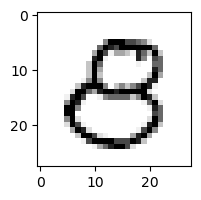

3.653140656021753% - 0 - ОШИБКА
1.8848643881089972e-06% - 1
0.006206113183700526% - 2
0.009257481077060262% - 3
1.0744343773601972% - 4
3.1503124811946677% - 5
5.888895088301531e-07% - 6
4.856440388283167e-06% - 7
0.0036823001085371045% - 8
3.671039722726808e-07% - 9

 8


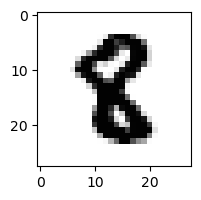

1.7595699330050076e-09% - 0
0.0009132272559800347% - 1
0.00032484625808455167% - 2
3.6901470271519116e-08% - 3
2.2116975048216727e-07% - 4
0.044055378531322256% - 5 - ОШИБКА
5.220307945901984e-06% - 6
1.0556961418548545e-08% - 7
6.131760283328063e-08% - 8
6.843143315942268e-15% - 9

 3


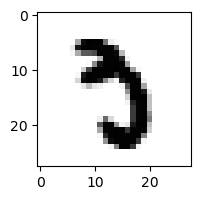

1.1204768509986222e-06% - 0
8.190418409893832e-06% - 1
2.2441814474107435e-07% - 2
0.1706072411588866% - 3
2.239654812648081e-05% - 4
0.5917974133586382% - 5
0.0001402705827699296% - 6
11.546618669618018% - 7 - ОШИБКА
2.4576025815996315e-10% - 8
7.273523107961674e-10% - 9

 2


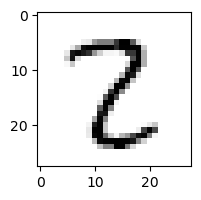

0.001627530298724269% - 0
0.0739834045225963% - 1
14.083034510204135% - 2
11.617207238448191% - 3
0.002048560509001063% - 4
0.21698759066070347% - 5
9.647118758715779e-07% - 6
0.0014096377250565008% - 7
84.17009893855382% - 8 - ОШИБКА
2.127355043051545e-08% - 9

 2


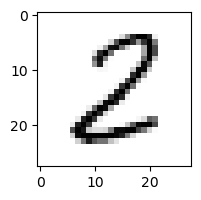

0.043762064426308984% - 0
0.46480231289959245% - 1
94.1459653049081% - 2
0.030934946611759565% - 3
5.98076693002017e-05% - 4
0.4423319146545265% - 5
0.006028535707000999% - 6
1.37232621682165e-05% - 7
99.30994637608617% - 8 - ОШИБКА
7.8740436742659e-10% - 9

 5


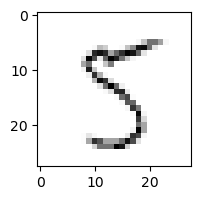

1.0166592981321452% - 0
0.14220759317201104% - 1
0.17988773629183905% - 2
25.323091072341153% - 3
0.46118480096035824% - 4
92.66401895862992% - 5
0.05414849255121311% - 6
1.5744391166859157% - 7
99.31319254479199% - 8 - ОШИБКА
23.591777945184067% - 9

 8


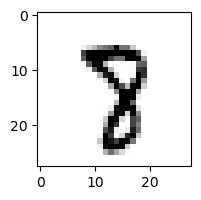

8.515352542828286e-06% - 0
0.00023132517925653634% - 1
0.0005716200813132539% - 2
0.004843401983285713% - 3
2.7271380699621387e-05% - 4
0.5817080138360644% - 5
1.080400575116948e-05% - 6
9.630625570766853% - 7 - ОШИБКА
0.42560080234262726% - 8
0.0036259932970452323% - 9

 9


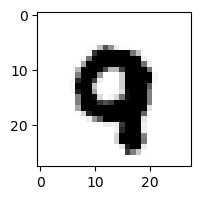

1.0950096216651222e-07% - 0
5.589329149173315e-07% - 1
2.8109528619829244e-06% - 2
4.528449129007766e-16% - 3
0.025532350016868887% - 4
4.105413155997414e-09% - 5
9.9161298594848e-05% - 6
0.649208363945862% - 7 - ОШИБКА
1.134627381642366e-14% - 8
0.001801036700511746% - 9

 5


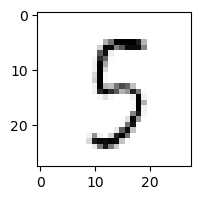

5.508458364431665% - 0
0.023083071270056144% - 1
2.489253270969169% - 2
46.47267208376696% - 3
3.974098819339474% - 4
90.72698772181295% - 5
1.8156912671629752% - 6
0.031464245360928074% - 7
99.66259418534595% - 8 - ОШИБКА
0.006460721575505487% - 9

 1


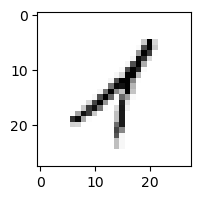

0.008784690235390137% - 0
60.23358497129253% - 1
21.43233284601793% - 2
2.022696107152789% - 3
77.32676441840222% - 4
0.12439552339095557% - 5
0.1468382911075773% - 6
0.07726985111613378% - 7
81.7871144189106% - 8 - ОШИБКА
20.286683092890705% - 9

 8


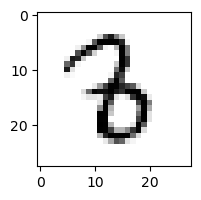

2.342566891795109e-06% - 0
0.09657765960876498% - 1
1.0770592935676668% - 2
11.185344116335777% - 3 - ОШИБКА
0.0006253060279581648% - 4
0.027614074426863748% - 5
0.5273646935876503% - 6
9.487023639976718e-06% - 7
4.190588736087783e-07% - 8
3.5103904468678906e-09% - 9

 5


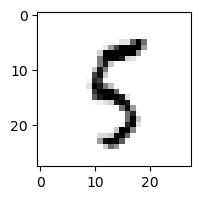

0.1927825785228398% - 0
0.017389561784394936% - 1
0.24146650871647654% - 2
1.097116923808697% - 3
0.5251409620955666% - 4
88.3724837921979% - 5
0.8357442388173788% - 6
0.00102417045760741% - 7
92.77213990900987% - 8 - ОШИБКА
66.67420144934081% - 9

 8


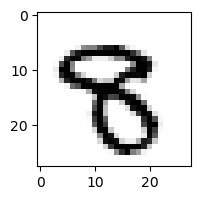

2.9443646451532584e-06% - 0
1.2801775890289974e-07% - 1
2.580843133644615e-07% - 2
0.004410767009118554% - 3
1.4579782951076677e-05% - 4
0.004016216458088311% - 5
3.3541409765085535e-07% - 6
0.00023689727755952259% - 7
9.507892040319608e-06% - 8
0.06448112564168376% - 9 - ОШИБКА

 8


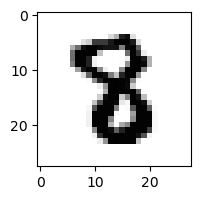

6.200000854060853e-10% - 0
9.102512421712155e-05% - 1
0.00039066648369674294% - 2
2.4857998679348338e-05% - 3
5.45755958908052e-06% - 4
0.0012554801449831795% - 5 - ОШИБКА
4.8921409871860515e-06% - 6
1.017560203439646e-06% - 7
1.0110693532219049e-06% - 8
1.048899003854585e-18% - 9

 8


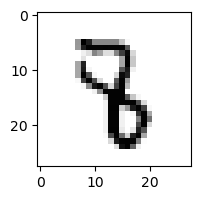

2.999994845219528e-09% - 0
0.06405442926609595% - 1
0.0007501728601082155% - 2
0.012815737799995957% - 3
0.3286604971558216% - 4 - ОШИБКА
0.034762990844692365% - 5
0.00036386160628780446% - 6
0.002410703148063855% - 7
1.194822483585022e-07% - 8
4.098071011310641e-06% - 9

 9


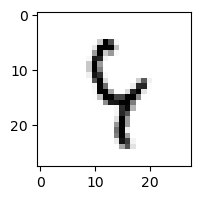

0.0005205858051800826% - 0
0.052822138188149265% - 1
6.348032963812216% - 2
0.04227758934274131% - 3
98.0643083920483% - 4 - ОШИБКА
50.61496151625078% - 5
8.461556136784688% - 6
0.5532145544677318% - 7
82.08147113703058% - 8
7.385565027529141% - 9

 5


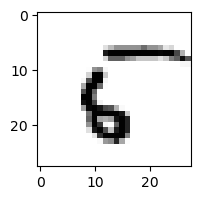

87.19052737715243% - 0 - ОШИБКА
0.000732398284255524% - 1
0.14801567702194326% - 2
6.218306949538072e-09% - 3
0.16832745546432595% - 4
67.80740630453008% - 5
2.8815560716205075% - 6
0.0015878660749619388% - 7
0.3756226253411913% - 8
0.4539092481637715% - 9

 3


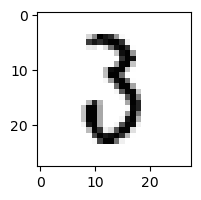

0.5302275232844658% - 0
0.21866978528378797% - 1
6.347960832618329% - 2 - ОШИБКА
4.410021774560078% - 3
2.4108921437917895e-06% - 4
0.006670305024773608% - 5
0.06711607088529198% - 6
0.005976949938581132% - 7
0.007990528879906126% - 8
5.317906151301478e-06% - 9

 2


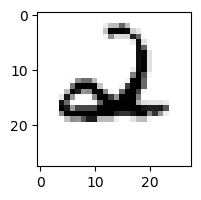

0.0012364628635785138% - 0
0.00021749785362957318% - 1
0.15860945048772718% - 2
9.839661761176402e-08% - 3
89.26611655619877% - 4 - ОШИБКА
9.631556154483807e-07% - 5
9.707976554220506% - 6
0.00017421421534110317% - 7
3.7152641376457627e-06% - 8
0.007496003017487848% - 9

 5


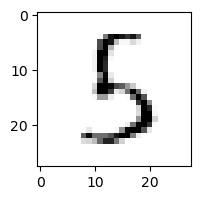

0.03597483704455602% - 0
0.06912968593278648% - 1
1.3613286656986798% - 2
93.8347634085823% - 3 - ОШИБКА
0.23516999391370108% - 4
89.41722051997365% - 5
2.147332736804039% - 6
0.00029095612983120886% - 7
0.897675686255424% - 8
2.6830215160094218e-05% - 9

 4


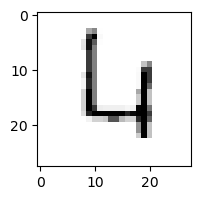

0.9935728898752211% - 0
5.443350786211629e-05% - 1
85.92770280284792% - 2
0.0002984575090115904% - 3
19.02361523687693% - 4
0.01535827900891077% - 5
95.22601008272689% - 6 - ОШИБКА
1.2309044813028949% - 7
0.03166506183341432% - 8
5.580780819920447% - 9

 5


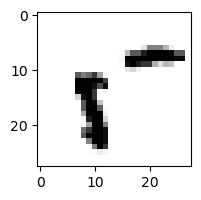

99.9920093424565% - 0 - ОШИБКА
4.015405839848602e-05% - 1
4.973955863135723e-05% - 2
7.0002089478192925e-06% - 3
19.94245123726436% - 4
99.93100566049026% - 5
0.005694322485684643% - 6
0.007135822454627799% - 7
21.19013172209261% - 8
0.00987565970773497% - 9

 9


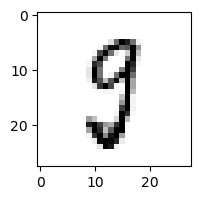

0.2381352187923947% - 0
0.028998091183548798% - 1
0.0495502469937996% - 2
2.674533268623737% - 3
0.006221460194505752% - 4
45.73640775873271% - 5 - ОШИБКА
0.004421377947174967% - 6
0.1420037962289251% - 7
20.13458047534297% - 8
0.00011827602382454972% - 9

 5


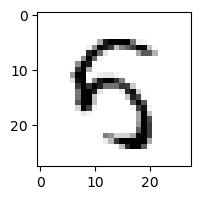

0.27322805415116574% - 0
0.00023415068071086276% - 1
0.0007729548179917329% - 2
0.04561447279081719% - 3
98.19387195508882% - 4 - ОШИБКА
20.95035258832064% - 5
0.06131236151837785% - 6
1.751016204199078e-05% - 7
9.424715265593595e-05% - 8
0.0003098916304760026% - 9

 8


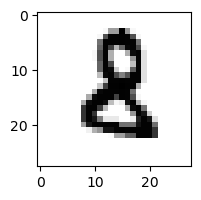

1.727528153944069e-06% - 0
0.005444741781541822% - 1
6.07754681415838% - 2 - ОШИБКА
0.026472335102328014% - 3
1.5464131112687305e-07% - 4
0.003501399840562688% - 5
0.19134068056787762% - 6
8.48330538546816e-10% - 7
1.318242401454135e-05% - 8
2.5702077060983464e-10% - 9

 4


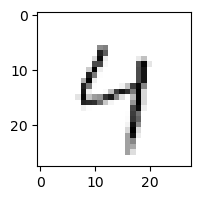

0.4384506855120953% - 0
0.022967980083882164% - 1
1.1456785651869865% - 2
5.920368170725573% - 3
94.33029395157172% - 4
3.8750099901520967% - 5
16.852106917712685% - 6
3.3098825799809246% - 7
9.196866357210377% - 8
97.67856480359282% - 9 - ОШИБКА

 8


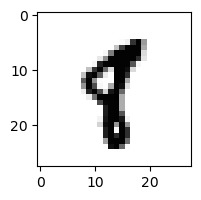

3.913839100144046e-06% - 0
7.859641368417571% - 1 - ОШИБКА
3.249887802838174e-05% - 2
2.2866348911817186e-07% - 3
0.00026324636701732844% - 4
0.736777812341022% - 5
0.0010493136751431786% - 6
0.015177747048182689% - 7
4.734371141898778e-07% - 8
0.02169930334257591% - 9

 5


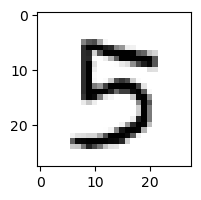

0.005300793125087203% - 0
2.0563128633028425e-06% - 1
9.255924117652882e-07% - 2
96.38003698799933% - 3 - ОШИБКА
0.03473933435240112% - 4
56.34625003189168% - 5
3.0031880725007085e-06% - 6
0.000312444171643506% - 7
1.164864334361703e-07% - 8
0.0005788790504779281% - 9

 8


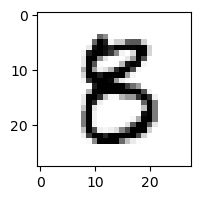

0.019106457046363493% - 0
3.659309122592846e-05% - 1
2.275143580916238e-05% - 2
1.5232504658007104% - 3
7.313852216579054e-05% - 4
22.941677009688892% - 5 - ОШИБКА
3.4818883940833338e-06% - 6
5.934473719754226e-07% - 7
2.7990200654051833e-07% - 8
5.667498643854621e-11% - 9

 6


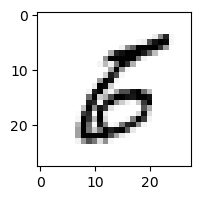

0.2905594092226306% - 0
0.04306476054035992% - 1
0.05873313570190148% - 2
0.007173884632343219% - 3
0.000196199683010059% - 4
18.027670400661087% - 5 - ОШИБКА
0.6922151540360454% - 6
8.834215987137572e-05% - 7
6.300992636110303e-07% - 8
1.253198315285634e-06% - 9

 1


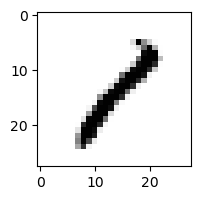

0.016830356770199204% - 0
56.44794376708264% - 1
9.044997324704463% - 2
0.26563049288062235% - 3
0.16753541064240507% - 4
0.02172847371376607% - 5
0.002269283799532212% - 6
0.09652610428304538% - 7
99.94335800075382% - 8 - ОШИБКА
0.007690422320426236% - 9

 8


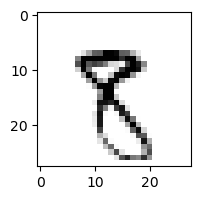

8.765767483149398e-05% - 0
0.11331039793180818% - 1
0.036066926376601555% - 2
0.007347512393197105% - 3
0.0004638781569536393% - 4
5.814460532120843% - 5
0.002816841199268831% - 6
0.017879250899526553% - 7
0.6711214249152332% - 8
18.13064061318678% - 9 - ОШИБКА

 9


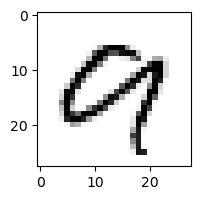

0.3567322994622937% - 0
2.0007538843977963e-06% - 1
0.003006314806339761% - 2
4.198412508436238e-06% - 3
0.00021058672197988543% - 4
5.931790443880614e-05% - 5
0.005219889764907108% - 6
0.030239711752984733% - 7
97.32488337680637% - 8 - ОШИБКА
49.45062618829098% - 9

 7


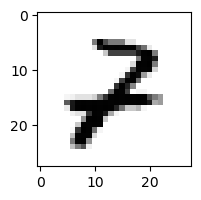

0.002529108556928431% - 0
0.03038408411280437% - 1
75.26879876974992% - 2 - ОШИБКА
0.0014666422533338448% - 3
0.026116624616849975% - 4
4.91159973034407e-07% - 5
1.2427449156333281e-05% - 6
0.01367539077906624% - 7
0.0003757241105789668% - 8
0.000327599481718707% - 9

 7


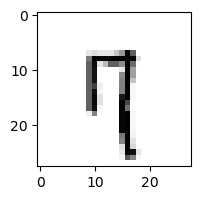

0.012475730071893945% - 0
0.10015153582291958% - 1
0.6725511060889665% - 2
0.004851419463162448% - 3
3.395532954043444% - 4
0.22457609422486363% - 5
0.7707600060716713% - 6
43.68936081020621% - 7
0.02164515104655285% - 8
99.15324972367941% - 9 - ОШИБКА

 5


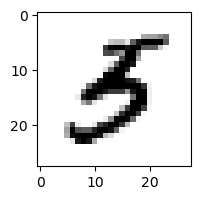

0.006425241950312539% - 0
0.00847624167723226% - 1
5.477431877918903e-05% - 2
23.294921478902847% - 3 - ОШИБКА
0.0024628693766333984% - 4
12.575160842037242% - 5
0.006720488709635918% - 6
4.9851813844500066e-05% - 7
6.384666677344397e-16% - 8
3.0692683326345885e-06% - 9

 5


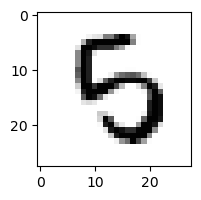

0.00015990389024117074% - 0
9.79186009781048e-06% - 1
0.010277454545919334% - 2
6.614832514598587% - 3
0.03976850369719401% - 4
2.091484987589705% - 5
35.78328935423546% - 6 - ОШИБКА
2.728679132063869e-08% - 7
1.356786308086541e-09% - 8
2.5330795384758776e-10% - 9

 5


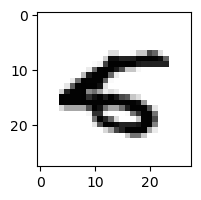

0.026624808201985258% - 0
3.822685754351002e-05% - 1
2.215690330110076e-07% - 2
9.149092620889553e-10% - 3
3.5787090890779942% - 4 - ОШИБКА
0.026337526010490775% - 5
0.03930166062530493% - 6
9.652483722249417e-05% - 7
7.063612109202286e-14% - 8
4.2926067343181467e-07% - 9

 4


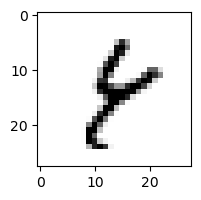

0.00221150783236536% - 0
0.7557946891383295% - 1
0.1413097515186548% - 2
0.0023848619689441105% - 3
0.08139946080514433% - 4
0.005944121070180641% - 5
4.047197168127503% - 6
0.014528804093019083% - 7
99.9924591942844% - 8 - ОШИБКА
61.18413889811792% - 9

 2


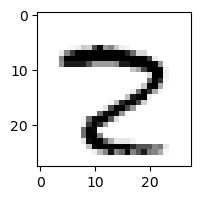

0.014059414174255207% - 0
3.9094048533330114e-08% - 1
0.015926583403221495% - 2
5.542463121251244e-06% - 3
1.1584753480164355e-07% - 4
5.9481285965393375e-05% - 5
1.5462143577904807e-08% - 6
99.99377806689233% - 7 - ОШИБКА
0.003967343716557977% - 8
9.883412650264395e-05% - 9

 8


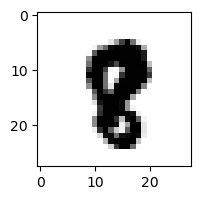

2.5296701354852666e-09% - 0
0.00014242530195532924% - 1
5.043114025966094e-06% - 2
1.3045042195888761e-09% - 3
1.5164569398830886e-06% - 4
3.287582857485376e-05% - 5
9.425861664505955e-08% - 6
0.0002377670821586223% - 7 - ОШИБКА
2.8372490749897983e-05% - 8
4.216744159287168e-07% - 9

 4


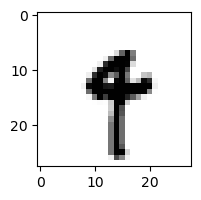

1.3380590683094458e-08% - 0
0.7251834641014483% - 1
3.041204840571592e-08% - 2
0.00019347532239265286% - 3
1.783291327539406% - 4
0.032506853159825946% - 5
0.052779387407953245% - 6
0.12224915789239565% - 7
2.6486206195110394e-06% - 8
51.74766266692568% - 9 - ОШИБКА

 7


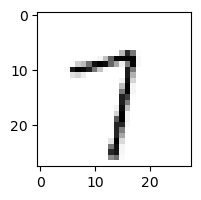

0.016644640554276016% - 0
0.2968241906172232% - 1
11.522782982923582% - 2
0.20691768289087223% - 3
1.921109960187874% - 4
8.059494587456797% - 5
0.3815280517024302% - 6
92.23627469153335% - 7
16.623912546074486% - 8
95.17725344914885% - 9 - ОШИБКА

 8


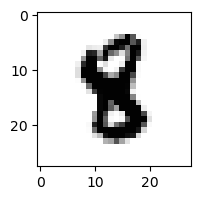

1.4936799885266734e-09% - 0
0.0004862727904167891% - 1
4.392295129971293e-06% - 2
3.103425465797677e-06% - 3
0.00014284288263266732% - 4
0.23450661484878824% - 5 - ОШИБКА
0.00885988057850637% - 6
9.940763789210947e-08% - 7
4.613080815137723e-05% - 8
1.3383695902595407e-10% - 9

 9


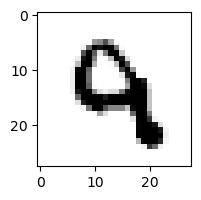

1.2326051596953355e-07% - 0
1.0231278335596307e-05% - 1
0.9255542486986148% - 2
4.318484522312346e-05% - 3
54.36019617572856% - 4 - ОШИБКА
0.0030410872217750966% - 5
0.0316221041700676% - 6
0.0007325465403337339% - 7
2.127011892840077e-12% - 8
2.2783785683536446% - 9

 7


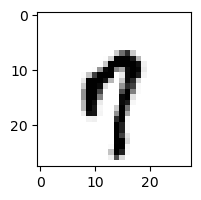

0.021720941372795302% - 0
0.010060059232580828% - 1
8.297719464828162e-06% - 2
0.00014096390490280972% - 3
23.602634180727826% - 4
0.006035757298852907% - 5
0.10868259276078743% - 6
4.755974577806617% - 7
2.0586566353399114e-05% - 8
61.92417953411423% - 9 - ОШИБКА

 8


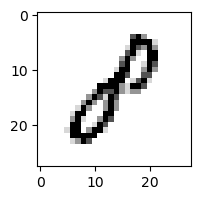

0.1503323646641324% - 0
8.319178688902118% - 1 - ОШИБКА
3.8005195752947487% - 2
0.1323786826903011% - 3
0.019394731877545545% - 4
0.278821345980842% - 5
0.007047812687807549% - 6
1.8061097059992854e-05% - 7
0.0011764967459944663% - 8
0.00018340078863498844% - 9

 2


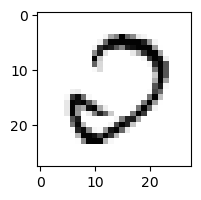

99.66442277521074% - 0 - ОШИБКА
4.2790730508047135e-05% - 1
97.77020373131734% - 2
0.001578656290040339% - 3
0.00030489376201399713% - 4
0.006538287119388744% - 5
0.03241245507361996% - 6
0.001997916475613774% - 7
0.9260309923175037% - 8
3.8605272585653445e-11% - 9

 8


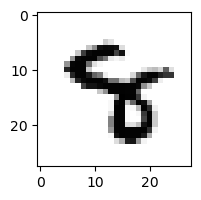

4.2751817874616584e-08% - 0
5.347988455758762e-05% - 1
1.8751264031893873e-07% - 2
2.2792030921107246e-05% - 3
1.6853778415604745% - 4 - ОШИБКА
0.0003030190999133608% - 5
0.027328872168257877% - 6
0.0010278152906252986% - 7
4.100794030300987e-05% - 8
0.00019072363261310384% - 9

 3


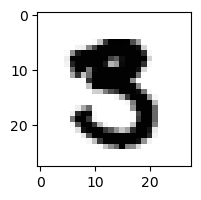

6.56040279409929e-06% - 0
1.1454738568830005e-08% - 1
6.039778613863556e-08% - 2
0.006284534787507079% - 3
1.0326942759372576e-10% - 4
1.5557890144261661% - 5 - ОШИБКА
6.810315674004316e-13% - 6
5.8728000662543585e-05% - 7
2.7072614304641006e-10% - 8
9.966584586074525e-18% - 9

 8


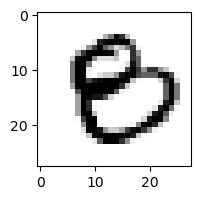

3.527190878710445% - 0 - ОШИБКА
8.064996287866231e-08% - 1
2.1619124307970873e-05% - 2
0.004119164632486427% - 3
1.2446529426839277e-05% - 4
9.558603159162897e-05% - 5
1.1564470439424532e-05% - 6
1.0871829706400576e-08% - 7
7.261725928787356e-06% - 8
1.1868319434377969e-12% - 9

 3


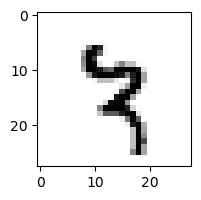

4.035869209056661e-07% - 0
1.4903802095660679% - 1
0.04988800081067321% - 2
8.64980812216854e-05% - 3
2.41309250350824% - 4
0.025443922173630798% - 5
0.004681802086937099% - 6
56.42038476550879% - 7 - ОШИБКА
0.33363434517072954% - 8
0.0034126587338664683% - 9

 2


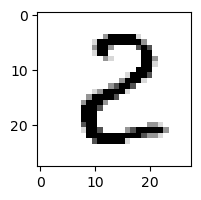

0.7147694919936932% - 0
0.012115160723634878% - 1
97.38358185960894% - 2
1.0948161285159095% - 3
0.001600609448270396% - 4
0.06553499180768942% - 5
0.0001219198165235112% - 6
2.2021123099436467e-07% - 7
99.99173128849964% - 8 - ОШИБКА
7.03236381625439e-09% - 9

 6


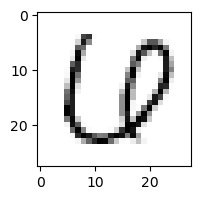

1.1662258105066465% - 0 - ОШИБКА
0.0009719804466626632% - 1
0.00404631979308987% - 2
0.09043059499232402% - 3
0.15731830598542945% - 4
0.3674755269895058% - 5
0.00011049841902871145% - 6
0.03529926467798824% - 7
1.0226811305786453e-05% - 8
1.1008969951036071e-12% - 9

 8


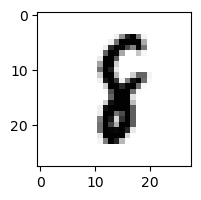

4.0847163626366056e-07% - 0
9.91827788669992% - 1 - ОШИБКА
0.043992294471129186% - 2
3.405383791975595e-05% - 3
0.0003890162236198572% - 4
0.03200071173199811% - 5
2.2174419713313718% - 6
6.0668353235942174e-05% - 7
0.9388660255688519% - 8
8.964693111221051e-07% - 9

 5


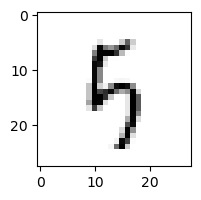

0.05671483280523593% - 0
0.014939264124037765% - 1
3.2799049180470212% - 2
2.227925587633136% - 3
22.421918122739502% - 4
49.41194220149636% - 5
16.507534336288% - 6
0.025190535559041407% - 7
42.086710271986014% - 8
93.94634462341527% - 9 - ОШИБКА

 9


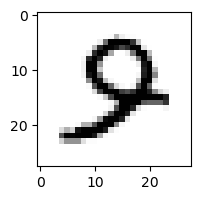

0.0040378710874732545% - 0
1.6465350049761742e-05% - 1
0.19794962102913763% - 2 - ОШИБКА
0.0018415583117651268% - 3
0.06424855119538364% - 4
0.1791451752548231% - 5
0.0013506303370617336% - 6
0.05157032779324665% - 7
2.347501393854275e-06% - 8
1.681774976031388e-07% - 9

 4


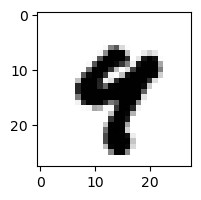

5.536975487020387e-09% - 0
2.515643118887231e-06% - 1
1.656970598575546e-11% - 2
7.368729962038139e-10% - 3
0.3821037011770543% - 4
2.045822777164133e-05% - 5
1.5133133162643418e-06% - 6
0.007529404442656226% - 7
4.1443404866846925e-07% - 8
10.019273923664663% - 9 - ОШИБКА

 6


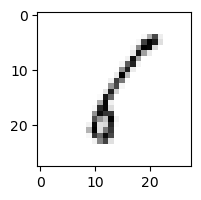

2.6192274861430094% - 0
89.17168311461704% - 1 - ОШИБКА
57.18445965856037% - 2
0.5397734966127612% - 3
4.489426029776414% - 4
28.651938152844174% - 5
19.956509749242407% - 6
0.3745988195166988% - 7
81.89000095379147% - 8
0.19522600379801808% - 9

 2


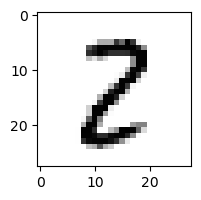

0.06500741936348381% - 0
0.1364022486883142% - 1
15.350828573576988% - 2
2.645421767729235% - 3
4.095210191004131e-06% - 4
0.047257218179551995% - 5
6.628628375217037e-06% - 6
0.001318657552017156% - 7
99.70141771923012% - 8 - ОШИБКА
4.065124947190419e-06% - 9

 8


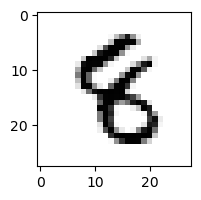

7.031001860041365e-08% - 0
0.011127796699701688% - 1
0.07274503249681226% - 2
6.241595328376997e-05% - 3
0.020741856437400123% - 4
0.20616428402953482% - 5 - ОШИБКА
0.0013674642388941379% - 6
1.0402551132531507e-05% - 7
6.388429247676348e-05% - 8
7.97263964668178e-06% - 9

 8


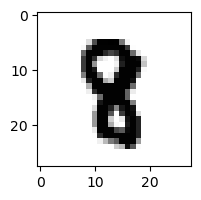

2.2169635513786644e-10% - 0
0.002576558241637626% - 1
1.817896543543703e-05% - 2
1.3924742157028294e-06% - 3
0.00014486000287118456% - 4
0.002671215198258046% - 5 - ОШИБКА
6.348591668849763e-06% - 6
3.2687415595403158e-06% - 7
1.2470575954387574e-05% - 8
9.324904598303156e-10% - 9

 8


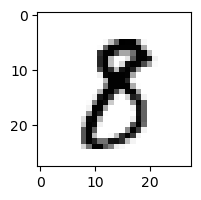

0.005773699975995844% - 0
0.19642553501783064% - 1
0.003967992937605365% - 2
7.729724470127776% - 3 - ОШИБКА
1.0493072123068665e-07% - 4
0.2626925490013391% - 5
2.3562796308359836e-07% - 6
0.0002619236828685708% - 7
0.49888094082101814% - 8
4.3502982543395495e-08% - 9

 8


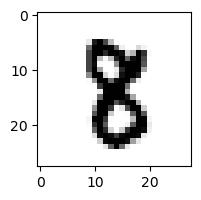

3.77795941944202e-08% - 0
0.000616958112911649% - 1
0.0005726078894190481% - 2
0.0006946867763021105% - 3
5.344198578180137e-06% - 4
0.0056849478848729935% - 5 - ОШИБКА
6.821657948949877e-07% - 6
5.7966141044479576e-05% - 7
0.0014150372142629438% - 8
1.1003103149065506e-08% - 9

 8


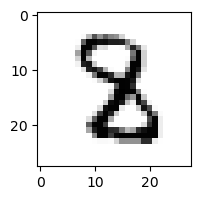

3.804836849604556e-08% - 0
0.023945301905219943% - 1
0.16465602567695917% - 2 - ОШИБКА
0.0019237409283544003% - 3
0.004623235886706846% - 4
0.014768347155743551% - 5
0.00010146984710389468% - 6
0.00017590176757280407% - 7
4.0739170197235383e-07% - 8
2.8793926762706086e-14% - 9

 8


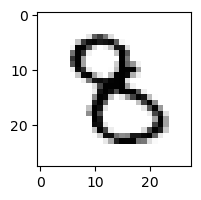

2.092557108769774e-05% - 0
0.002032928964297412% - 1
0.06061354781980417% - 2
0.3342155927317277% - 3 - ОШИБКА
0.001246811524029925% - 4
0.06538196605410253% - 5
0.0012419170515370016% - 6
9.508010332513186e-07% - 7
2.2816596218940704e-05% - 8
2.735483177811558e-06% - 9

 1


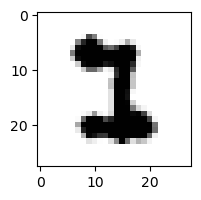

1.3365729343607426e-09% - 0
5.880498803878632e-05% - 1
51.191662905654745% - 2 - ОШИБКА
0.001093833149740964% - 3
2.913476625658246e-12% - 4
0.022214108502655948% - 5
7.131998857394153e-06% - 6
0.0008599482608033549% - 7
1.7640940518352128e-12% - 8
5.106251386267118e-16% - 9

 0


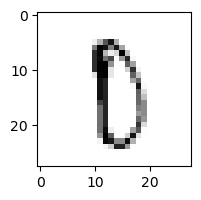

2.480928335535123% - 0
0.0007634600000133953% - 1
1.7113352193840592% - 2
0.1425604872600647% - 3
0.06265392238544287% - 4
81.46461330827158% - 5
1.7998970972767716% - 6
0.19366367221086792% - 7
99.8472687843477% - 8 - ОШИБКА
0.18342039315338804% - 9

 2


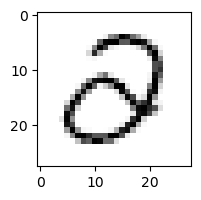

6.783552093786492% - 0
0.0005481111200913738% - 1
0.001549035803023762% - 2
43.22882430101383% - 3 - ОШИБКА
0.7859865517790592% - 4
0.27663014473450476% - 5
0.023273276075074144% - 6
4.614583717928879e-05% - 7
5.595093199113785e-06% - 8
6.0067883017908835e-12% - 9

 9


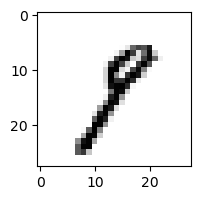

0.010430932168479285% - 0
92.72359416663758% - 1 - ОШИБКА
0.03233718947659354% - 2
19.858741237023537% - 3
0.000253361492452326% - 4
0.056763740398222955% - 5
0.0007487368096654803% - 6
1.827937982551603% - 7
0.6126074000490863% - 8
1.8425492985968732% - 9

 2


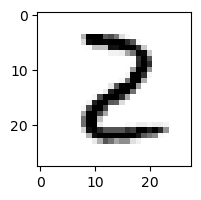

0.009201909162653314% - 0
0.0680213212292439% - 1
98.88978548917622% - 2
0.5785250344367565% - 3
0.0002190689887965826% - 4
0.0018756080384796732% - 5
0.0002148704783151355% - 6
1.6103370974247053e-06% - 7
99.74540174627727% - 8 - ОШИБКА
3.1858013497250875e-07% - 9

 8


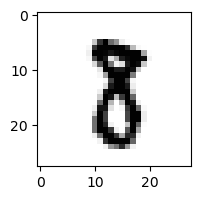

1.6275935487202812e-06% - 0
0.09461578266543122% - 1
0.003861104103703939% - 2
1.166134071732417% - 3 - ОШИБКА
1.534002967329655e-08% - 4
0.02841255981784954% - 5
3.906977048986141e-06% - 6
0.0014563837910482912% - 7
0.003085259039998115% - 8
2.1037028166735948e-07% - 9

 6


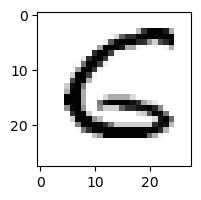

0.00778423658393937% - 0
5.560482673736387e-07% - 1
26.575238068681312% - 2
3.722970146113455e-08% - 3
0.0003433489797312641% - 4
57.455510594333894% - 5 - ОШИБКА
10.598474693627335% - 6
3.3987250554520103e-08% - 7
7.334994959161022e-10% - 8
5.060392594846255e-14% - 9

 5


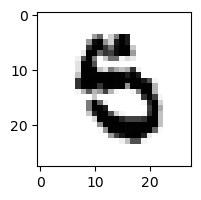

5.72087259585846e-07% - 0
2.2404051473088523e-06% - 1
4.884898231203246e-07% - 2
4.7554875998881884e-07% - 3
3.6856563858464197e-07% - 4
0.02574567994618358% - 5
7.797012683739527% - 6 - ОШИБКА
2.5453313069318007e-08% - 7
6.345141363672703e-10% - 8
8.225768969651702e-08% - 9

 3


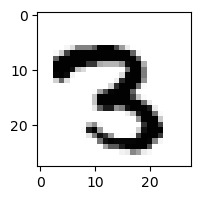

2.9950936433525386e-11% - 0
4.494938051077185e-06% - 1
0.556604346982324% - 2 - ОШИБКА
0.10116542233122437% - 3
1.5753111346514553e-06% - 4
9.50942308859731e-05% - 5
2.3630153067302175e-10% - 6
0.14508275514186778% - 7
7.83908012607329e-07% - 8
3.581714837356494e-07% - 9

 9


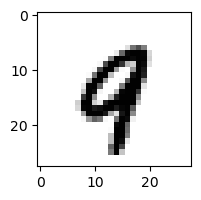

7.80405984452274e-05% - 0
0.000273750534458858% - 1
0.00010462375506531965% - 2
8.990023168676572e-10% - 3
9.188324186799404% - 4 - ОШИБКА
4.062478459722146e-06% - 5
0.0038137848948350066% - 6
0.4236563678552486% - 7
1.2615696796634767e-05% - 8
0.4147330739206864% - 9

 8


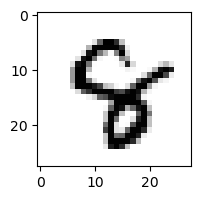

2.2185115959185486e-07% - 0
1.9707058276451874e-05% - 1
5.033117264871322e-06% - 2
1.419786977753364e-06% - 3
1.3374682202915333% - 4 - ОШИБКА
0.0003634961122633463% - 5
0.006166121663393124% - 6
0.0006855298576830333% - 7
6.623902534948675e-06% - 8
1.2242329029024222e-07% - 9

 9


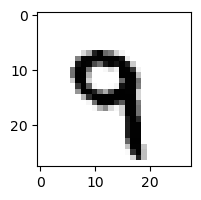

9.656396596005043e-09% - 0
0.024932196211055746% - 1
0.0004236612170674823% - 2
7.650473879675154e-05% - 3
1.2901859239366145% - 4 - ОШИБКА
0.041739223345700294% - 5
0.0021947680744003315% - 6
0.788589332264524% - 7
2.79078413475304e-07% - 8
1.0702353124677015% - 9

 1


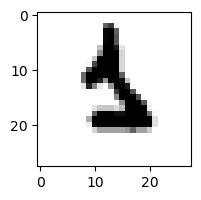

1.5483046617663326e-08% - 0
0.001911563757655694% - 1
0.0005090602655697314% - 2
3.8404192917812383e-07% - 3
3.22002577244291e-08% - 4
0.0852187943679902% - 5
5.988195500800472% - 6 - ОШИБКА
0.0012684169411081685% - 7
5.257238830911401e-10% - 8
3.825109321392934e-07% - 9

 8


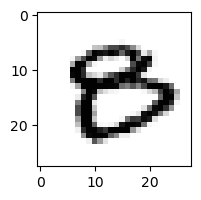

32.84117094745616% - 0 - ОШИБКА
4.818625507370193e-08% - 1
2.128178990763616e-07% - 2
0.004779856058324086% - 3
4.891580527288753e-06% - 4
0.00767301289487468% - 5
0.023555475925772656% - 6
3.26382028320692e-05% - 7
2.669601811046256e-08% - 8
1.4937721500874316e-06% - 9

 9


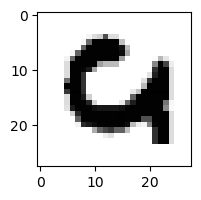

0.011122461378443388% - 0
5.80160404055685e-13% - 1
41.34118501126902% - 2 - ОШИБКА
2.7093821450459855e-16% - 3
3.848331772892588e-09% - 4
1.572787011980917e-09% - 5
1.8965397938534194% - 6
2.63163754782713e-05% - 7
1.3419150398022752e-16% - 8
6.779876423445945e-15% - 9

 8


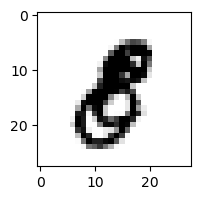

0.00969948099797254% - 0 - ОШИБКА
0.0012430768522314894% - 1
0.000752476876335319% - 2
0.0012949326448510106% - 3
1.516585905668813e-08% - 4
0.0005482738852130405% - 5
1.0785056943772566e-05% - 6
1.8258371750458717e-06% - 7
2.216765252811116e-06% - 8
6.898339443766572e-07% - 9

 2


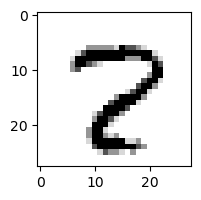

0.0006054732512484568% - 0
4.700441971790023e-07% - 1
0.07059664117913297% - 2
1.743955065082772e-07% - 3
5.370945469683424e-05% - 4
0.001971435386430333% - 5
2.9708274936329506e-07% - 6
96.18293348146973% - 7 - ОШИБКА
57.28913210838665% - 8
0.0006548085442112555% - 9

 3


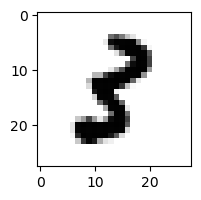

0.0011075162165537391% - 0
0.7465267335293843% - 1
0.001499195312185554% - 2
0.49167284071253964% - 3
2.970948904179108e-06% - 4
1.172054856084738% - 5 - ОШИБКА
2.1648583386023155e-06% - 6
1.387840229432428e-06% - 7
4.9177960504583994e-06% - 8
1.0015010734948553e-10% - 9

 0


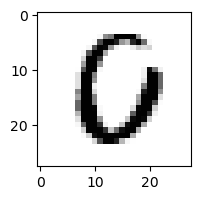

90.13339850926197% - 0
6.296794188705174e-09% - 1
0.3282765613028213% - 2
4.268652036838276e-07% - 3
0.0010737438801335843% - 4
0.0069034641803172635% - 5
94.96781524666665% - 6 - ОШИБКА
0.00022969027374605046% - 7
0.0005489423253756297% - 8
2.6057498930019686e-12% - 9

 7


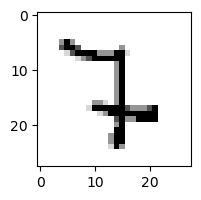

8.004214449542695e-06% - 0
1.0012617279599532% - 1
11.586644776337351% - 2 - ОШИБКА
0.035594732563701076% - 3
0.00032894954269931554% - 4
0.007496470157929414% - 5
0.13401114010622991% - 6
8.735452193657563% - 7
0.000919406075274832% - 8
0.0013466021756671216% - 9

 5


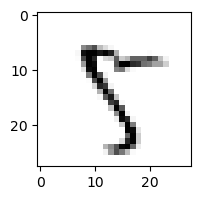

0.0020986177897510724% - 0
0.022506176424827724% - 1
0.05912784079817431% - 2
0.08822929109471553% - 3
3.3898159749156576% - 4
51.26302955058873% - 5
0.0008903469278717136% - 6
61.00006942145364% - 7 - ОШИБКА
50.6687812248363% - 8
0.030690235828828523% - 9

 9


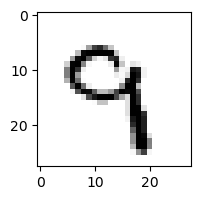

2.8545010387861014e-05% - 0
0.0011345210024289016% - 1
0.04514698005382277% - 2
21.039645297838234% - 3 - ОШИБКА
5.348676258865108% - 4
0.387703483023371% - 5
0.07039404499118954% - 6
1.3686111892120296% - 7
1.3211085534024097e-05% - 8
3.7117534558747707% - 9

 8


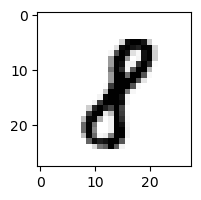

2.1098846166014532e-05% - 0
25.71346060269153% - 1 - ОШИБКА
0.014080734734970134% - 2
8.204339217555275e-05% - 3
1.9722809760783126e-06% - 4
0.0001037428425340774% - 5
1.951753968147904e-06% - 6
0.0017681933439784487% - 7
21.345912959936857% - 8
4.591297083442319e-06% - 9

 5


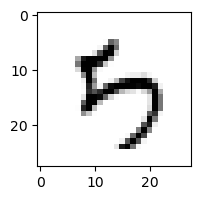

0.041887811848349374% - 0
0.000324679157621089% - 1
1.9890767159475722% - 2
0.1679151030483684% - 3
22.1164150465353% - 4
1.2265161701194824% - 5
24.646846679815887% - 6
0.003137038639150523% - 7
62.05152641401068% - 8
98.07180071007483% - 9 - ОШИБКА

 2


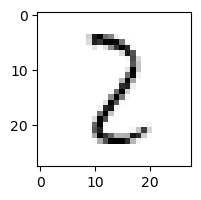

0.03302678152839113% - 0
15.159968709317539% - 1
75.98802000060957% - 2
11.421063377043723% - 3
0.18595256784158876% - 4
0.3363350419135994% - 5
0.1015490399642714% - 6
0.05671391118764241% - 7
97.4026155564993% - 8 - ОШИБКА
0.004292580191089989% - 9

 0


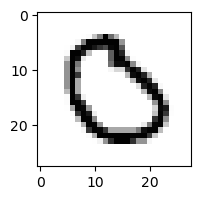

44.7184458802241% - 0
3.4640637092142807e-07% - 1
79.050186155121% - 2 - ОШИБКА
0.2485837351088498% - 3
3.6280760409078744e-06% - 4
0.00011841536053586528% - 5
2.996261257245015e-05% - 6
0.0007713331194631435% - 7
1.209254074740968e-07% - 8
1.5274992551916487e-09% - 9

 9


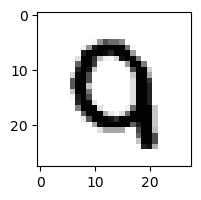

2.058103759283428% - 0
4.056273766590125e-09% - 1
0.5780514267430352% - 2
2.424183576196158e-07% - 3
2.3911019136716018e-05% - 4
0.00043114198899396936% - 5
4.4994929869917755% - 6 - ОШИБКА
0.0016756300598489277% - 7
6.04471550898609e-12% - 8
0.0001615925486949254% - 9

 9


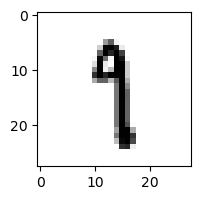

8.782581139220559e-05% - 0
71.12711465968434% - 1 - ОШИБКА
0.007395895146680468% - 2
0.24684080789643945% - 3
0.008222833875893069% - 4
1.6061757835075074% - 5
0.028514525950132333% - 6
13.138535122531314% - 7
0.05032958365694118% - 8
0.5753255382658158% - 9

 8


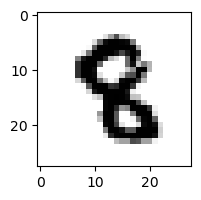

9.992972222850902e-11% - 0
1.0846972346009769e-05% - 1
0.0024801999654043166% - 2
2.3849842896214762e-06% - 3
0.000448525478114399% - 4
0.013827608024268398% - 5 - ОШИБКА
4.213802425086905e-05% - 6
6.680709610039759e-07% - 7
2.287371916296284e-09% - 8
6.268718273170301e-09% - 9

 8


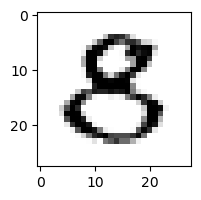

0.01949672787444579% - 0
7.609443417382714e-06% - 1
0.020800471175712043% - 2
5.552968073760452% - 3
0.0004128377115477875% - 4
25.46501380643332% - 5 - ОШИБКА
1.0174122555260684e-08% - 6
6.486772425494132e-09% - 7
4.015761939019194e-10% - 8
1.3582173898474921e-14% - 9

 4


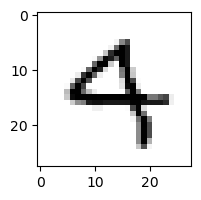

0.0008736701254041562% - 0
0.0007813906659393709% - 1
0.007625968715945288% - 2
0.003933661622953812% - 3
59.87592482685326% - 4
0.044043988642156875% - 5
0.1144080513083171% - 6
0.04397527474832039% - 7
1.4138994988811325e-10% - 8
81.9139546014707% - 9 - ОШИБКА

 8


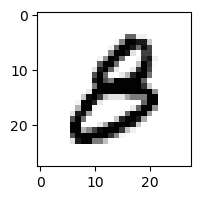

0.061423854167781754% - 0
1.5371023984472811e-06% - 1
0.0008345063412494681% - 2
0.32215590098247454% - 3 - ОШИБКА
3.20021016316635e-05% - 4
0.05092327704746444% - 5
0.014803374351761114% - 6
1.0560144958956797e-07% - 7
2.945202314005303e-08% - 8
2.1101504382538655e-07% - 9

 2


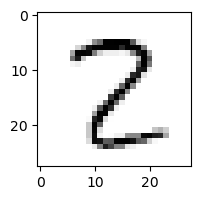

0.018443026204956588% - 0
0.05042899905219764% - 1
85.36971619698551% - 2
1.3153266495332485% - 3
0.01890354791778818% - 4
0.1001867104939142% - 5
1.175287459320732e-05% - 6
0.03445066939749331% - 7
99.86933925628783% - 8 - ОШИБКА
1.6537009459885417e-07% - 9

 4


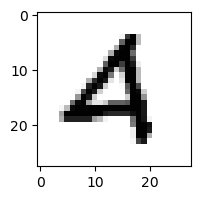

0.007352672983702472% - 0
8.509412828336089e-06% - 1
14.983574587060138% - 2 - ОШИБКА
2.2281594576778463e-08% - 3
0.6959069433426498% - 4
3.887194838163664e-06% - 5
0.01851915210160821% - 6
0.00010569252126934455% - 7
2.7103036220802103e-12% - 8
0.00011039678855301835% - 9

 9


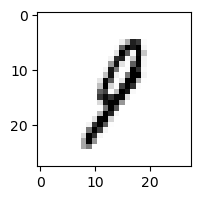

0.03648062391413749% - 0
51.281193707674056% - 1
3.6812930990004573% - 2
7.960273203874049% - 3
0.0732205253668875% - 4
0.9607780157614739% - 5
0.8570874647868361% - 6
0.17607551047299302% - 7
66.79585656269087% - 8 - ОШИБКА
9.89726741821129% - 9

 3


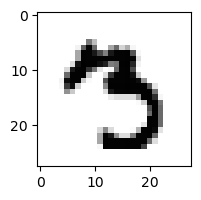

3.8562609228752296e-07% - 0
1.213836319577805e-05% - 1
3.557016309993453e-08% - 2
0.03979669071751232% - 3
1.0743572797647322e-06% - 4
1.0030597244592452% - 5 - ОШИБКА
1.1961473503444877e-08% - 6
0.11021965487748348% - 7
4.5952668494337376e-07% - 8
7.081615804393186e-05% - 9

 9


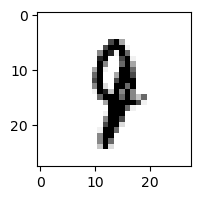

7.23179269568204e-08% - 0
1.3804875236653638% - 1
0.007353986212333587% - 2
0.0010937361243707744% - 3
3.153468863522177% - 4 - ОШИБКА
0.03335064640329186% - 5
0.0016010853026715446% - 6
0.6119037069478562% - 7
0.00018175701604842184% - 8
0.10192115390003957% - 9

 6


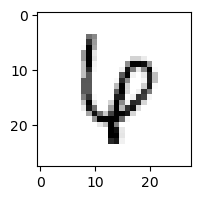

0.0006204052255371938% - 0
0.028411238352065278% - 1
0.12362666528398737% - 2
6.934048112473425e-06% - 3
89.48872659046758% - 4 - ОШИБКА
0.000686377739686504% - 5
2.0408293949499763% - 6
56.4246043572737% - 7
0.0002858098195685985% - 8
0.005610331279880721% - 9

 8


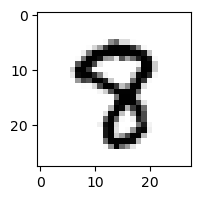

6.049274487034658e-06% - 0
2.467505803697533e-06% - 1
2.5189608212987604e-06% - 2
8.090463937927073e-05% - 3
0.004180173634311935% - 4
0.0850189423103345% - 5
1.9704294717142276e-06% - 6
0.14135013385929554% - 7 - ОШИБКА
0.058262516566331135% - 8
0.000893998651871572% - 9

 8


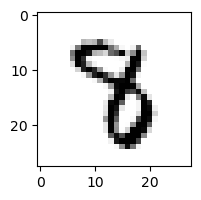

1.0106828302836206e-09% - 0
0.13173096789267305% - 1 - ОШИБКА
4.304092957865566e-05% - 2
0.1268774845346056% - 3
0.020087645224858498% - 4
0.013465959692882827% - 5
3.932619652767581e-05% - 6
0.11754229508470362% - 7
1.1260442398758247e-07% - 8
2.5545608075211907e-10% - 9

 4


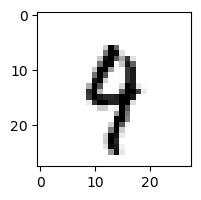

3.8507062178106857e-05% - 0
0.004724519038776416% - 1
0.010625185569062466% - 2
0.007776964545333382% - 3
26.222536032788728% - 4
0.42030044978516856% - 5
0.302791227366193% - 6
1.2649175265433652% - 7
0.015880188987327418% - 8
53.25833884952469% - 9 - ОШИБКА

 0


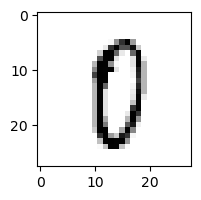

67.80559504736283% - 0
0.0001118192984080672% - 1
0.0277901158043777% - 2
0.013895962320953812% - 3
0.010203903289724925% - 4
61.44343814788738% - 5
0.7135166947508856% - 6
0.01821336022078713% - 7
98.3302164703883% - 8 - ОШИБКА
0.017781920208794266% - 9

 3


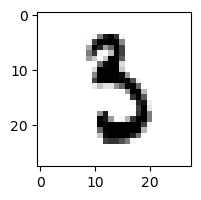

7.800399318917247e-05% - 0
0.005010647413944121% - 1
0.0003077094259478306% - 2
1.422275070544223% - 3
5.283602300868171e-07% - 4
1.4465920109312227% - 5 - ОШИБКА
0.6273500837585593% - 6
0.0016350148790890665% - 7
1.1938295551859785e-07% - 8
4.125994927185852e-10% - 9

 8


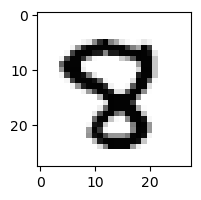

4.745877275559232e-07% - 0
5.851116548885242e-09% - 1
8.585438187560321e-06% - 2
1.752578216631338e-07% - 3
0.0024679301955408675% - 4
0.005815708683376695% - 5 - ОШИБКА
1.2286728116373243e-08% - 6
0.0003052752647092191% - 7
6.460192373335829e-05% - 8
1.594139322723479e-09% - 9

 2


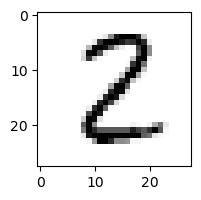

0.0035000612991379827% - 0
0.4808025695733995% - 1
74.17818086750265% - 2
0.5340289589418883% - 3
0.00014291950213729857% - 4
0.5737271461444583% - 5
3.265874268598436e-05% - 6
6.737175289772241e-06% - 7
82.68135959351834% - 8 - ОШИБКА
1.127563276777472e-11% - 9

 9


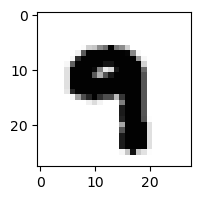

3.496480259297734e-10% - 0
2.9039745395728385e-07% - 1
4.177296957720978e-13% - 2
7.162066497932015e-07% - 3
0.0018782357981887972% - 4
0.01440866561784238% - 5 - ОШИБКА
3.6117079144289264e-08% - 6
0.0021773164815697883% - 7
4.637092006138478e-15% - 8
0.004280452918889998% - 9

 2


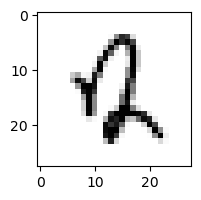

0.04978194741047289% - 0
0.00020683053508925163% - 1
0.7196812189613435% - 2
6.398038039463691e-05% - 3
0.6560388746303426% - 4
0.7417000620171709% - 5
6.060422925129879% - 6 - ОШИБКА
0.0018024673164965042% - 7
4.7226143939697014e-06% - 8
0.0027001339311285254% - 9

 9


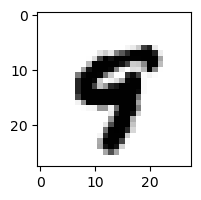

3.8730445481141035e-08% - 0
5.267518995607687e-06% - 1
1.5509560656326416e-10% - 2
1.9833066665097967e-09% - 3
0.49508264516600375% - 4 - ОШИБКА
0.10532374556833769% - 5
2.314001558246848e-06% - 6
0.002464162319648818% - 7
6.734571136784657e-09% - 8
0.01714469589192582% - 9

 7


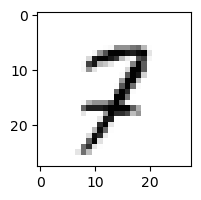

0.004404935065785185% - 0
0.2270585430016464% - 1
49.366877659374914% - 2
0.0018706569508651508% - 3
0.09236322060920112% - 4
0.00244035655280267% - 5
0.004258048693388679% - 6
51.77340093539428% - 7
1.264355282264543% - 8
81.34534357524207% - 9 - ОШИБКА

 9


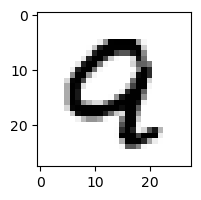

0.005006853748859029% - 0
6.625589963874007e-07% - 1
1.128684364479955% - 2
8.619249697811637e-13% - 3
1.398396917035131% - 4 - ОШИБКА
5.895594416906963e-07% - 5
9.367485729249162e-05% - 6
0.0003903944949764734% - 7
0.0009491821314849406% - 8
0.0002812578321133163% - 9

 8


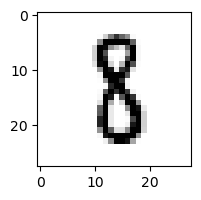

4.1004659014628356e-06% - 0
2.7998429997707843% - 1 - ОШИБКА
0.15431858752105307% - 2
1.8724071969239273% - 3
1.4523966977265614e-05% - 4
0.3638262638364187% - 5
0.0038681871049405046% - 6
8.292155965104195e-05% - 7
0.033850969202338516% - 8
4.893295306354128e-10% - 9

 7


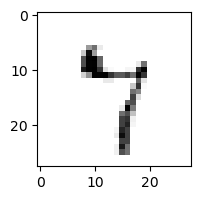

0.19834681786629624% - 0
0.023392574430661003% - 1
0.2824607223674549% - 2
0.33550100111814835% - 3
13.120267105349411% - 4
34.713522850985406% - 5
1.207926699960155% - 6
98.09831256048766% - 7
99.31716014350916% - 8 - ОШИБКА
1.6050230070043432% - 9

 3


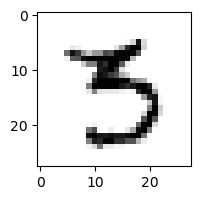

0.04752622578284976% - 0
0.00011102846842465203% - 1
1.593282393391417e-05% - 2
51.99121010725191% - 3
6.686598918043352e-05% - 4
77.86101609635507% - 5 - ОШИБКА
0.00022575165307988295% - 6
0.013202290330846625% - 7
0.02242446233057987% - 8
0.0010633847765253526% - 9

 7


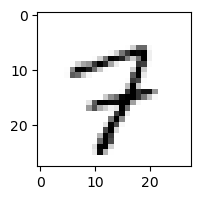

0.013660013405829893% - 0
0.0040616749569262044% - 1
0.2763090089684681% - 2
0.00019436125503527634% - 3
1.967390763686338% - 4
0.3217746639959798% - 5
0.004800108870658957% - 6
48.769248033222816% - 7
1.2864791283241341% - 8
62.454192629941275% - 9 - ОШИБКА

 9


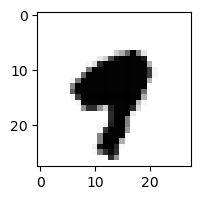

9.660060058293147e-10% - 0
8.518801389229989e-05% - 1
7.928328659963579e-14% - 2
2.4990822026025912e-11% - 3
2.2614805076926197% - 4 - ОШИБКА
9.279765713975254e-06% - 5
2.4286872389861317e-06% - 6
0.0007010426910741009% - 7
9.508651959290773e-13% - 8
0.025718089825630355% - 9

 8


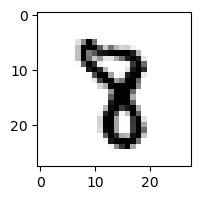

2.2568192990479563e-09% - 0
0.0022829513642404703% - 1
0.00014493580399895962% - 2
0.0006302668607259665% - 3
0.00469693357373429% - 4
0.012035579922646587% - 5
9.422221423453222e-06% - 6
0.16657253116686757% - 7 - ОШИБКА
0.007073233563442144% - 8
2.6731770490448266e-07% - 9

 5


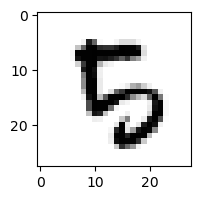

3.231753745529426e-05% - 0
1.2961895479189135e-07% - 1
0.17499890453313918% - 2 - ОШИБКА
2.2988515852808458e-05% - 3
0.003359459751505507% - 4
0.15490977441254322% - 5
0.008951574583230051% - 6
0.00022071292000458003% - 7
1.9419419447257934e-05% - 8
0.0004301825125123107% - 9

 5


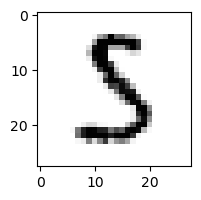

0.0009314372385434314% - 0
0.0400814790620382% - 1
1.0503407856053402% - 2
87.14236185796047% - 3 - ОШИБКА
8.961943782442401e-06% - 4
31.494354891471772% - 5
0.006888618901304616% - 6
0.00013394368694932503% - 7
0.004386561446185495% - 8
1.6928023668851261e-12% - 9

 3


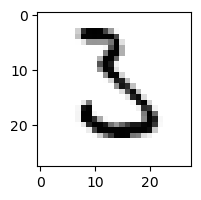

0.03773658043075964% - 0
0.017832531920477877% - 1
75.99118129195169% - 2 - ОШИБКА
13.512672648257537% - 3
1.5441846807528892e-07% - 4
0.4064252171645443% - 5
40.38011503517664% - 6
0.00011074763806366942% - 7
7.431850608808393e-06% - 8
1.393729205737969e-07% - 9

 7


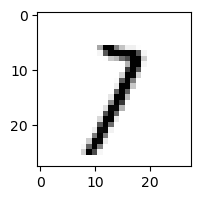

0.005170115946421796% - 0
18.629171445946653% - 1
3.448405168365113% - 2
12.59658058943886% - 3
0.04257721450147418% - 4
0.06865909227001156% - 5
0.008810360136821556% - 6
49.26283690771271% - 7
0.0585989542917356% - 8
76.85992357920806% - 9 - ОШИБКА

 9


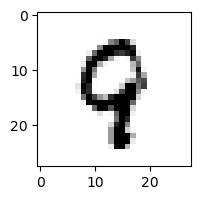

2.601470578651263e-05% - 0
0.0010585539642564686% - 1
0.048399719707631135% - 2
3.3894413490751804e-07% - 3
1.3690143308473761% - 4 - ОШИБКА
0.03388127328005934% - 5
0.010301477767678072% - 6
0.0226594321093828% - 7
0.24558359547777026% - 8
0.6535701335216675% - 9

 5


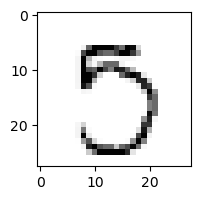

0.15130361920529675% - 0
7.466730632744856e-05% - 1
0.0007539146963633896% - 2
6.489341262264485% - 3
2.388116173694348e-05% - 4
16.318165947714864% - 5
0.022433724623636533% - 6
92.97107276493233% - 7
0.009376061485580246% - 8
96.65990481821663% - 9 - ОШИБКА

 7


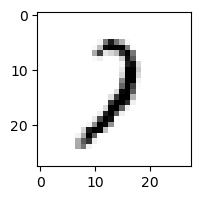

0.0026639754585220552% - 0
38.9346318886767% - 1
68.7587192957887% - 2 - ОШИБКА
1.9564256500876946% - 3
0.11810749846950942% - 4
0.028852353585518853% - 5
0.03887959439503138% - 6
19.567621213040688% - 7
0.0049450800578746% - 8
0.06797618653573055% - 9

 8


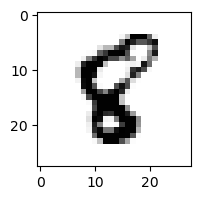

1.4302992287190556e-05% - 0
0.004695700896735843% - 1
0.024160371272134013% - 2
1.0747677682103794e-11% - 3
0.0011833831371078094% - 4
1.0996154584275597% - 5 - ОШИБКА
0.49567092228253146% - 6
4.722357053034892e-06% - 7
0.3174439701592908% - 8
3.251344481416661e-06% - 9

 9


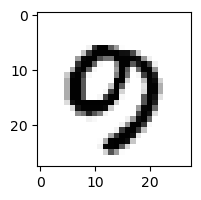

0.002695310838206723% - 0
1.8615513878031562e-05% - 1
1.4381327000697285e-07% - 2
1.5536110441813016e-07% - 3
9.056967620250968e-06% - 4
1.0847568709939355e-07% - 5
2.6622815603242204e-05% - 6
0.024969405172210545% - 7 - ОШИБКА
9.302894491283824e-09% - 8
0.00026020486551262613% - 9

 8


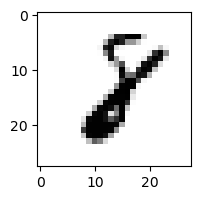

1.248369450139048e-05% - 0
2.2007357404830725% - 1
20.32075285927485% - 2 - ОШИБКА
5.147422691651103e-05% - 3
0.0001890171311978551% - 4
0.00026026801157188583% - 5
0.003100551190174612% - 6
0.10974515538261784% - 7
6.208684813785678% - 8
6.919266798693221e-09% - 9

 5


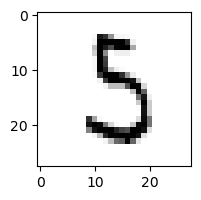

0.08482482398509891% - 0
0.2398100632292508% - 1
0.1448322937732661% - 2
92.422094931333% - 3 - ОШИБКА
0.0002278748475047264% - 4
61.96998641781409% - 5
0.475426526430603% - 6
0.0011807811863509044% - 7
0.23786396571871415% - 8
4.3608737656024185e-09% - 9

 7


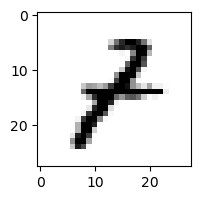

0.019090873922409615% - 0
2.7883093532152174% - 1 - ОШИБКА
1.0529582585082675% - 2
0.5166055568395911% - 3
0.13751680163107927% - 4
0.016070946797004083% - 5
0.011296621471935712% - 6
6.294254088965748e-05% - 7
0.0010816307854078719% - 8
0.0020462007964226515% - 9

 2


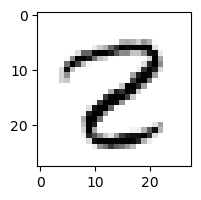

0.0023962391292815465% - 0
0.0006297769944948531% - 1
3.9513821961161884% - 2
0.00011828384322746105% - 3
0.001333888368953765% - 4
0.0058429310283570615% - 5
5.151065678793234e-06% - 6
0.0266570952341025% - 7
99.99999945877562% - 8 - ОШИБКА
7.672658051747801e-06% - 9

 0


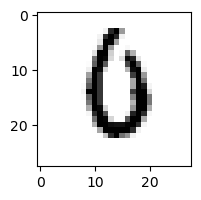

1.330870660257298% - 0
1.021621114709989e-06% - 1
0.26091251204262395% - 2
0.00014166200340363499% - 3
0.004515868756614247% - 4
0.09754171719734524% - 5
83.8907460793239% - 6 - ОШИБКА
0.04931412604679055% - 7
2.955855413013117e-08% - 8
7.868167702432242e-05% - 9

 2


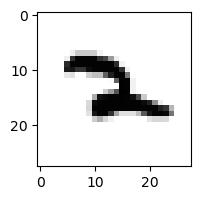

2.565307275281792e-09% - 0
0.30180032175760546% - 1
12.83143428857268% - 2
2.984144798730669e-07% - 3
0.4124712918244034% - 4
0.007801355741213621% - 5
0.4292431327097177% - 6
13.857989709047807% - 7 - ОШИБКА
0.016720274791998637% - 8
7.771889789032343e-05% - 9

 9


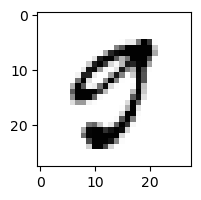

92.0151228113209% - 0 - ОШИБКА
5.6851377829818815e-06% - 1
2.0629864362050442e-05% - 2
0.005871674236253073% - 3
0.0007035749889767347% - 4
46.38291822993531% - 5
2.1068942288467044e-05% - 6
0.017448315782646447% - 7
9.571527958313327e-08% - 8
0.006243602603838616% - 9

 6


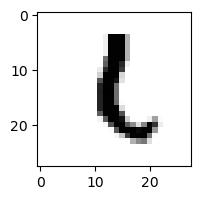

5.5862770940109135e-06% - 0
35.938073019128765% - 1 - ОШИБКА
7.568428729611301% - 2
0.001956933994396026% - 3
4.363617195874871e-05% - 4
0.23942208269959997% - 5
0.4319943105489548% - 6
1.6651550212880411e-06% - 7
0.00029214930546435635% - 8
0.0018686269783268063% - 9

 5


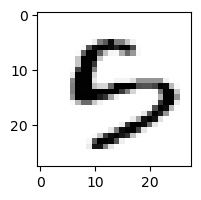

0.38941856523029134% - 0
7.023065415872154e-07% - 1
4.690513658999395e-05% - 2
0.006268735978772951% - 3
0.10539155927103266% - 4
0.6464874753722474% - 5
25.297628974221936% - 6 - ОШИБКА
2.5538638388049236e-07% - 7
0.0005597017005533725% - 8
0.00030159023845307805% - 9

 5


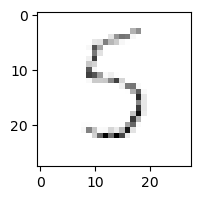

19.535790902919267% - 0
0.3477490253050785% - 1
11.419544823170458% - 2
94.787311606285% - 3 - ОШИБКА
60.53909456178658% - 4
88.78050329909853% - 5
90.73525481051013% - 6
4.1177535097934905% - 7
88.3241159126674% - 8
2.4686425579952638% - 9

 7


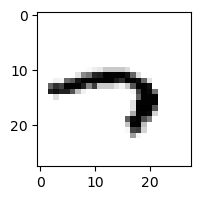

0.015650308644596222% - 0
0.00646360743569422% - 1
1.9542395002560403e-10% - 2
76.77889977601876% - 3
77.05456509119793% - 4
18.00568173718873% - 5
90.78672623573438% - 6 - ОШИБКА
2.742660255545404% - 7
3.4285840247258595e-06% - 8
4.629196537344763% - 9

 9


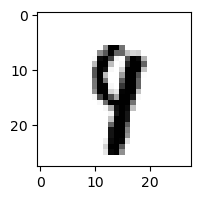

1.6873446571706665e-07% - 0
0.013301005201329862% - 1
0.00020453732393191357% - 2
0.0009879539270611424% - 3
2.6670111289404184% - 4
0.0301578382407546% - 5
0.00010250670681013624% - 6
5.535561890754914% - 7 - ОШИБКА
0.0027033505474729014% - 8
0.18758508023008516% - 9

 9


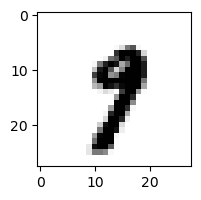

5.9920339788932045e-06% - 0
0.06215328008513095% - 1
4.2102469952858063e-07% - 2
0.0038425381643192235% - 3
0.003760898422988419% - 4
0.002892576600932355% - 5
7.4407447840289325e-06% - 6
11.059106465871633% - 7 - ОШИБКА
0.00014301437570260302% - 8
0.30559908246906364% - 9

 5


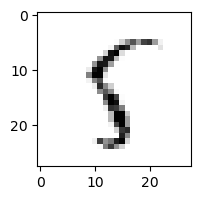

0.01637167972953421% - 0
1.5228521581140884% - 1
2.544631666844811% - 2
6.510923860544553e-05% - 3
4.736790706653605% - 4
90.60136822162097% - 5
9.317035966412995% - 6
0.31051632921935435% - 7
98.97935740063208% - 8 - ОШИБКА
2.112324536730584% - 9

 1


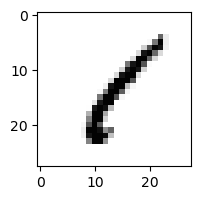

0.09603041285292399% - 0
81.44910358324898% - 1
3.7901494952688957% - 2
0.45795925369126794% - 3
0.5432781941740972% - 4
1.8963636016138627% - 5
0.0023161101475394387% - 6
0.02253803141660293% - 7
97.59249746980984% - 8 - ОШИБКА
0.007669419335919702% - 9

 3


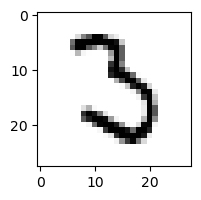

0.01931422276987822% - 0
0.02225131595400148% - 1
87.16749705424776% - 2 - ОШИБКА
68.99594782942077% - 3
1.7333615381400302e-06% - 4
0.003969751532780905% - 5
3.216876027204089% - 6
0.1053462011692597% - 7
2.0673937080490295e-08% - 8
8.349500287142781e-09% - 9

 8


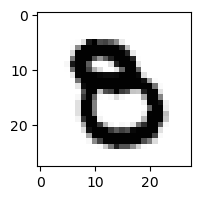

1.5586724280066348e-05% - 0
5.109222700132085e-10% - 1
4.954201545396449e-08% - 2
0.00012153223743581633% - 3
1.3193225506063548e-07% - 4
0.031180005170875526% - 5 - ОШИБКА
1.0181824659345574e-06% - 6
9.335810001992059e-08% - 7
1.386338798464112e-11% - 8
8.629293189829303e-13% - 9

 9


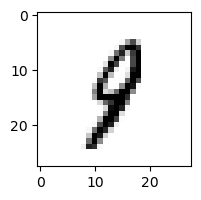

0.0014361511482466483% - 0
9.51490015042178% - 1 - ОШИБКА
0.28178176615793404% - 2
0.06528846383792956% - 3
2.9220117000538224% - 4
0.3409355930577397% - 5
0.26915587793443446% - 6
0.43337301818363533% - 7
0.2294555206644398% - 8
1.0180070867547073% - 9

 3


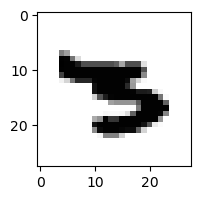

2.595543727293892e-09% - 0
0.0014349088006974956% - 1
1.2465302515342038e-09% - 2
0.0010303502648136606% - 3
0.0002619736120603626% - 4
0.26245708500704307% - 5
1.890052012552055% - 6 - ОШИБКА
0.0014636776196855568% - 7
1.2847519432588854e-15% - 8
4.339825778461223e-13% - 9

 4


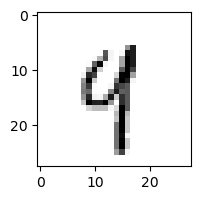

0.00015781691038622804% - 0
6.129055616285316% - 1
0.007175580461220827% - 2
0.013392529067575985% - 3
20.137511760656313% - 4
0.4155050175052409% - 5
0.13029846948682544% - 6
0.6758784725872189% - 7
0.008751943784525939% - 8
80.61034955606743% - 9 - ОШИБКА

 2


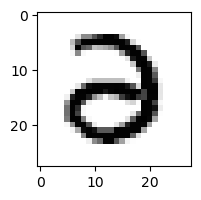

0.10308109855237174% - 0
9.737984880158989e-09% - 1
0.053558530641643766% - 2
61.567425669026534% - 3 - ОШИБКА
9.591113292009501e-05% - 4
3.5165600292763705e-05% - 5
3.8340110349497236e-05% - 6
6.521438597109631e-09% - 7
2.0796185439065209e-13% - 8
6.625255973521397e-13% - 9

 5


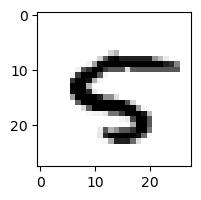

0.01139276799663452% - 0
5.466348208792861e-05% - 1
1.126354604567765e-05% - 2
1.1285602180774221e-10% - 3
2.0387272934045644% - 4 - ОШИБКА
1.2564929590135243% - 5
2.157996632027663e-05% - 6
0.0030231402318492626% - 7
2.2887219128465066e-06% - 8
0.0006361059428334557% - 9

 8


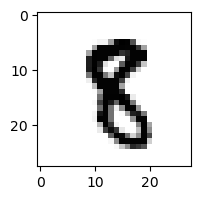

1.6077939673665227e-07% - 0
0.007122449173850219% - 1
0.000797332768360537% - 2
0.00011408953294872314% - 3
1.4419269685298231e-05% - 4
0.31184648318888974% - 5 - ОШИБКА
1.4024261420099015e-06% - 6
1.2320686866691737e-05% - 7
0.0006309850621103798% - 8
2.2719243686645868e-07% - 9

 9


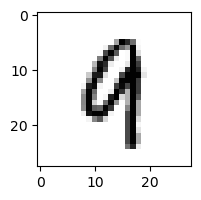

0.00032992247289879935% - 0
0.016000476691793254% - 1
0.022102379872803578% - 2
4.263651413444683e-06% - 3
4.366920457496528% - 4 - ОШИБКА
5.902228770683788e-05% - 5
0.015290595713005572% - 6
0.014720996752608875% - 7
0.003679264709230794% - 8
0.27496381710193846% - 9

 5


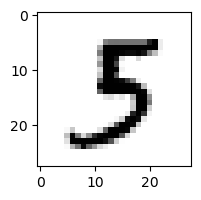

0.00071591200973198% - 0
0.021692854834077503% - 1
2.0346712641878826e-06% - 2
98.76151733243664% - 3 - ОШИБКА
1.7296694793903446e-05% - 4
23.52681158421274% - 5
0.001640400106117418% - 6
0.00020563453379130047% - 7
4.25889519961388e-06% - 8
1.146659076627767e-06% - 9

 8


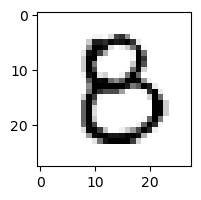

0.7343893879110456% - 0
1.5708247596480374e-06% - 1
0.07620309917556388% - 2
0.9745971172832891% - 3
0.04184380133387504% - 4
9.571793001722343% - 5 - ОШИБКА
0.0008125527595391641% - 6
2.7540254965675057e-07% - 7
0.1496084799550199% - 8
3.092161614363043e-10% - 9

 5


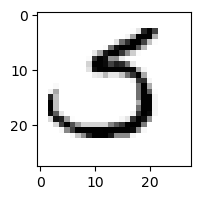

1.5644182527540587% - 0
0.0027308501451272435% - 1
34.48593080115803% - 2 - ОШИБКА
17.192409735606006% - 3
6.9870797855581046e-09% - 4
12.878537320879863% - 5
0.3283358764875459% - 6
0.6957440338342532% - 7
6.1443523197855805e-09% - 8
8.969583551573328e-09% - 9

 8


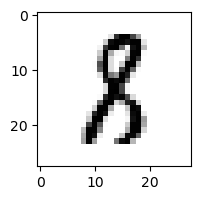

5.8990125153617676e-05% - 0
9.1470389806% - 1 - ОШИБКА
1.8294637467705397% - 2
0.1417441209069388% - 3
2.5166197799436502e-06% - 4
0.13861588611490483% - 5
0.000336578465431142% - 6
1.3759999407130148e-05% - 7
0.04560381314964335% - 8
6.142988012978937e-10% - 9

 9


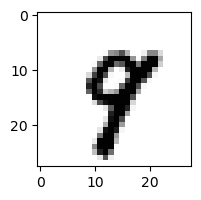

1.8758612224470528e-06% - 0
0.00035024742929194236% - 1
6.8686019738648e-06% - 2
5.012100682814631e-06% - 3
1.85792371273872% - 4
0.0031900530358505833% - 5
1.0606736916440602e-05% - 6
15.563134620310212% - 7 - ОШИБКА
0.009907550256622101% - 8
1.0497332867134663% - 9

 9


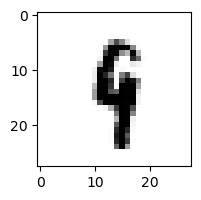

6.570304917250708e-08% - 0
0.4603952481577576% - 1
0.000998476704619579% - 2
0.052908618070671765% - 3
10.001906827045604% - 4 - ОШИБКА
1.1149632925764912% - 5
0.031372617345099704% - 6
0.0032884816663940114% - 7
0.9526293230093635% - 8
4.038506549604164% - 9

 8


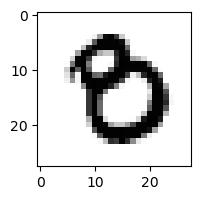

0.6214777225280034% - 0 - ОШИБКА
7.813055443761039e-09% - 1
4.5030833975005193e-07% - 2
0.0008260213551602248% - 3
5.667793941127181e-10% - 4
4.877317168954948e-06% - 5
0.0006351897172229336% - 6
1.9999089129360344e-07% - 7
3.0494529279244116e-10% - 8
5.131058641293454e-13% - 9

 8


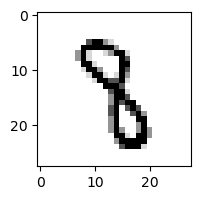

2.7477582239747417e-08% - 0
0.2301280303984928% - 1
0.026079771357139646% - 2
0.0500562909086375% - 3
0.2857269633168917% - 4 - ОШИБКА
0.1384277040569701% - 5
0.0005632813284367175% - 6
0.006607848817851865% - 7
0.00012394080145251404% - 8
3.7156303129244526e-05% - 9

 3


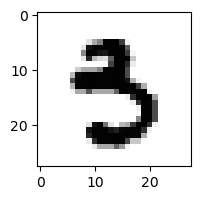

3.055418076167377e-05% - 0
1.9190994898227303e-05% - 1
4.163195004609652e-12% - 2
0.4615340170610039% - 3
3.407958475454289e-06% - 4
32.94574307216752% - 5 - ОШИБКА
1.2933517083166959e-05% - 6
5.080569544923872e-05% - 7
1.3222266287053773e-12% - 8
2.66407057408025e-10% - 9

 4


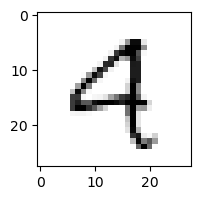

0.45254536259331973% - 0
0.013257286899687014% - 1
0.013850977225895143% - 2
0.000413555855641495% - 3
78.85998177969402% - 4
0.0008510878285106034% - 5
0.057354132350067255% - 6
0.10776863091689927% - 7
1.154670419831342e-05% - 8
84.89097568467879% - 9 - ОШИБКА

 3


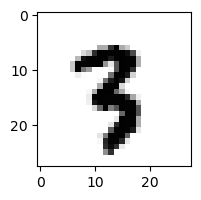

3.43868227052438e-08% - 0
0.007379424282809193% - 1
0.003126509027195726% - 2
0.0026950455376902626% - 3
1.1023020406118889e-05% - 4
0.13195214068863176% - 5 - ОШИБКА
3.708922165073763e-05% - 6
0.005759004643637483% - 7
4.374261327701677e-05% - 8
7.254090697202372e-05% - 9

 5


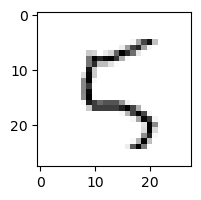

0.3967098546981586% - 0
0.010777137124721607% - 1
79.26684749445158% - 2
0.00153405655259588% - 3
30.889727822250517% - 4
45.677909194292624% - 5
46.97531017354643% - 6
0.07172695704195511% - 7
6.5169117179198395% - 8
99.87505598977971% - 9 - ОШИБКА

 3


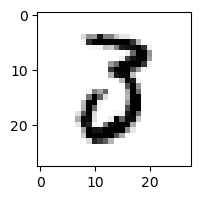

5.184715752661174% - 0
0.0003494629205603526% - 1
62.66000705565072% - 2 - ОШИБКА
14.931897375432737% - 3
3.5687296774769437e-06% - 4
0.007964862154568925% - 5
2.3108992872086122e-05% - 6
0.02504779720956348% - 7
6.542649890184469e-09% - 8
1.0834267631792735e-10% - 9

 5


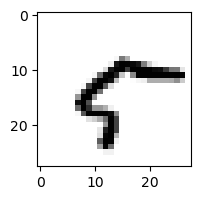

94.68579400696879% - 0 - ОШИБКА
0.00875001001222389% - 1
0.0013801454189012509% - 2
2.939617571063374e-05% - 3
0.9922875287319397% - 4
2.8242402479902174e-07% - 5
0.5963694243493509% - 6
1.045219979046525% - 7
0.804726534087012% - 8
0.012390915893530769% - 9

 3


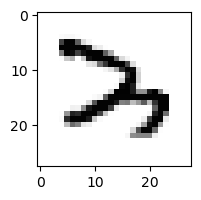

1.0217092357969734e-05% - 0
0.0005085925119678273% - 1
99.39003513282613% - 2 - ОШИБКА
0.1692862679366088% - 3
0.0032056542138536896% - 4
6.292795678554217e-06% - 5
0.009076465437521681% - 6
0.07711429684584711% - 7
1.0422658331289648e-06% - 8
4.217260628739404e-08% - 9

 5


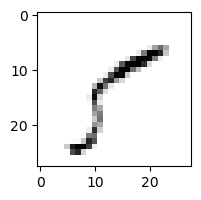

93.90483293175357% - 0
29.455329709658358% - 1
0.21725850834882818% - 2
96.84041163866547% - 3 - ОШИБКА
11.956969518131134% - 4
68.00150462084079% - 5
0.0023240186296992972% - 6
56.283857463628465% - 7
1.1746465951615648% - 8
0.9352750442278399% - 9

 3


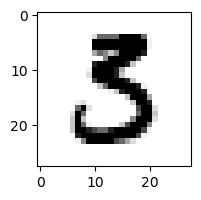

0.0036390373894130846% - 0
4.212881194093952e-05% - 1
0.00014887193584946402% - 2
1.9679099478898465% - 3
5.6983622986321965e-11% - 4
2.756315620956682% - 5 - ОШИБКА
3.5021335815778187e-07% - 6
3.4450346980413484e-07% - 7
1.8985176747699097e-10% - 8
1.0696042908742995e-14% - 9

 3


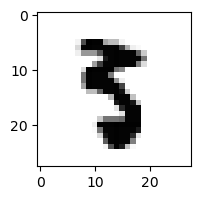

9.13863470553335e-07% - 0
8.313852156528008e-06% - 1
1.4224415175045537e-07% - 2
0.0004750939378652141% - 3
1.8740667493942334e-06% - 4
18.762954620850998% - 5 - ОШИБКА
6.369393149618699e-05% - 6
0.0001499813485170507% - 7
8.569591728478584e-08% - 8
9.022244292236865e-08% - 9

 8


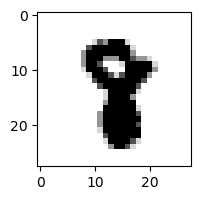

8.442034324804439e-12% - 0
9.316302213171949e-05% - 1
2.810000706167721e-06% - 2
2.6486566568069014e-07% - 3
1.8849382112124657e-06% - 4
0.00011280605457234853% - 5
8.009106020580762e-08% - 6
0.0005745795745178264% - 7 - ОШИБКА
1.995052112832646e-05% - 8
1.2920383785375824e-11% - 9

 5


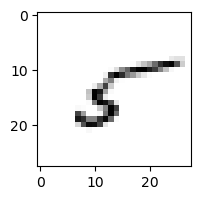

7.263642161410219% - 0
7.195756843094793% - 1
67.80994657759794% - 2
0.217029547486693% - 3
1.9306711529625364% - 4
84.87809259081199% - 5
13.806970452892875% - 6
0.20202275445765708% - 7
97.66374938623817% - 8 - ОШИБКА
0.2662228878859624% - 9

 5


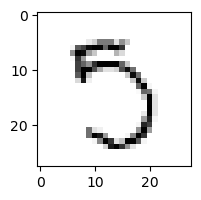

0.41085820125760664% - 0
0.0039632003436510166% - 1
6.235501500954329% - 2
11.027733767551853% - 3
0.012285690058727212% - 4
26.40197683684199% - 5
0.0004928612142407687% - 6
29.95737462247804% - 7 - ОШИБКА
15.00110224085154% - 8
0.00036302183856903967% - 9

 5


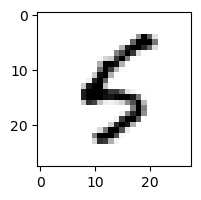

0.29699362405362034% - 0
0.0004379731116929127% - 1
0.0061944225173009475% - 2
0.09898959277123028% - 3
8.633542841409996% - 4
77.27408901665963% - 5
87.98436246082511% - 6 - ОШИБКА
0.0007716765537336314% - 7
6.760838318566088e-05% - 8
0.21503651529563858% - 9

 5


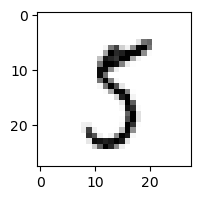

1.2966137663973987% - 0
0.1913761763649123% - 1
0.02491826621586308% - 2
25.821823795630173% - 3
0.0015684155443298946% - 4
74.56970476512308% - 5
0.005043706839655594% - 6
0.3609952314652137% - 7
79.3155213660535% - 8 - ОШИБКА
7.424847950177157% - 9

 8


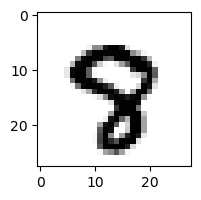

8.746924136847938e-07% - 0
3.55067379869609e-09% - 1
2.55866892767275e-08% - 2
1.1536723038956769e-06% - 3
0.0005204166361083133% - 4
0.04881928499413092% - 5
3.7760204031041e-07% - 6
0.27442830840195787% - 7 - ОШИБКА
7.375730309767034e-07% - 8
0.0003677844397979861% - 9

 6


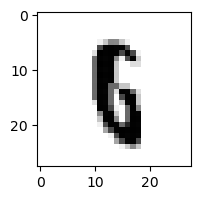

2.0474176214695078e-06% - 0
0.004145650459370929% - 1
0.013677025730528085% - 2
3.430147948193491e-05% - 3
0.0009088702532107757% - 4
7.892842616609348% - 5 - ОШИБКА
0.7998703529932358% - 6
3.9809022410801626e-05% - 7
0.001708416490688033% - 8
0.00040102650000443317% - 9

 9


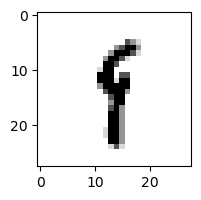

5.7741473203739625e-06% - 0
47.786786969623066% - 1 - ОШИБКА
0.0016422544497376214% - 2
0.05593488475157509% - 3
0.15745730498296306% - 4
4.770941229183694% - 5
0.38110917731169125% - 6
0.036751367577733576% - 7
36.62803636737594% - 8
19.37686473237605% - 9

 8


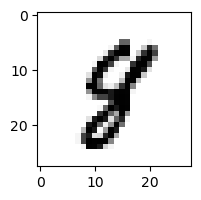

0.00018978843597400083% - 0
0.00523483284567979% - 1
0.0007859940328441361% - 2
7.68816257102055e-06% - 3
0.009440261133683951% - 4
0.19169933440253076% - 5 - ОШИБКА
5.345849835566156e-05% - 6
0.028463156434714663% - 7
0.1561827019324096% - 8
0.0014707896121894113% - 9

 8


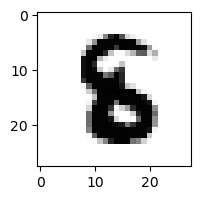

3.441948475836289e-09% - 0
8.53102970539815e-06% - 1
3.354670301303472e-05% - 2
1.5749208853362505e-08% - 3
5.403141996598694e-06% - 4
0.3638353866117076% - 5 - ОШИБКА
0.027871990993529213% - 6
1.1124114691014538e-10% - 7
1.2748899367882476e-08% - 8
6.0300823374988806e-18% - 9

 6


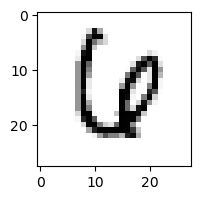

0.018322758343053736% - 0
1.7743594393200707e-06% - 1
0.13137992063800627% - 2
0.0023136449167212953% - 3
1.3663218396894559% - 4
0.0008717582541810089% - 5
1.3017025143644672% - 6
3.756476670793131% - 7 - ОШИБКА
0.00021807840158892064% - 8
2.5863001801467987e-07% - 9

 9


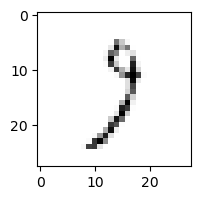

5.971030574954632% - 0
2.92227317363097% - 1
25.691372957445513% - 2
94.07518675254312% - 3 - ОШИБКА
3.8119461493020577% - 4
1.1185977234226234% - 5
1.0640423560279044% - 6
90.92387781748887% - 7
32.39896281547138% - 8
46.836985088883196% - 9

 8


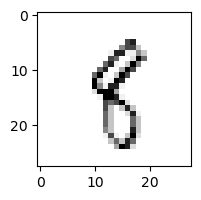

0.002250590816988485% - 0
13.808974765655933% - 1 - ОШИБКА
0.019291368266249% - 2
1.9507199743035795% - 3
1.8696333945108083% - 4
3.628236393900127% - 5
0.023422091543649753% - 6
0.03388954445378172% - 7
2.136618583745885% - 8
1.991164927212069% - 9

 1


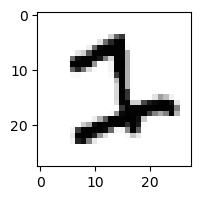

1.9992197398750064e-05% - 0
0.0016060846056480743% - 1
94.14051069316716% - 2 - ОШИБКА
27.854759705058047% - 3
3.732680632901239e-10% - 4
0.4949717940984579% - 5
0.017586833183439714% - 6
0.8515568464705147% - 7
2.4075282358417195e-12% - 8
2.966102609873777e-13% - 9

 7


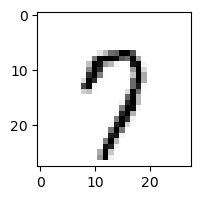

1.8255036760386738% - 0
0.0003557131645824234% - 1
0.005951876031570791% - 2
0.016940772335605793% - 3
0.18499317387340547% - 4
4.902118335890012% - 5
0.1232084406134971% - 6
78.18752284470021% - 7
0.21288619457864644% - 8
97.47608946207298% - 9 - ОШИБКА

 5


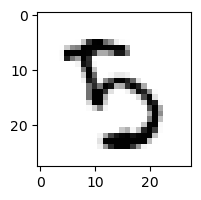

0.0006858558607910369% - 0
2.0856236562604426e-06% - 1
0.02199486799778233% - 2
52.448677485908824% - 3 - ОШИБКА
1.0830450974058738% - 4
31.677141452831027% - 5
0.010371359385181852% - 6
2.847688177793453e-05% - 7
0.02111025184784445% - 8
0.0006477560930156599% - 9

 5


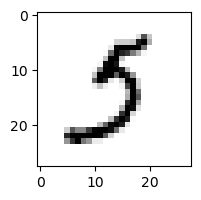

0.2959111222202165% - 0
0.14305820369614441% - 1
0.01920850094067387% - 2
19.13266536425123% - 3 - ОШИБКА
0.0004911532446841697% - 4
10.666073915295993% - 5
0.2112718603008335% - 6
7.25674104649331% - 7
6.125303200686594e-06% - 8
0.011614601666821071% - 9

 2


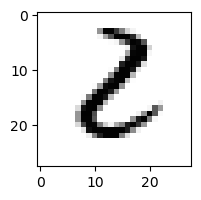

4.264041904724727% - 0
0.32257729393964385% - 1
13.239103665735822% - 2
14.33417182608536% - 3 - ОШИБКА
1.0889894160199966e-06% - 4
0.17396709869408128% - 5
0.19005844442613606% - 6
8.926519421312781e-08% - 7
0.0001297298119962447% - 8
1.7345730477083246e-08% - 9

 3


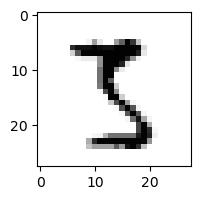

0.0013153020495417316% - 0
0.00035002434514636873% - 1
0.12404335761307933% - 2
46.96161694498933% - 3
1.7905689596789867e-05% - 4
22.768915201710524% - 5
1.1328427550409699e-06% - 6
0.002063580185446038% - 7
61.2783320757434% - 8 - ОШИБКА
0.00011663477291272728% - 9

 3


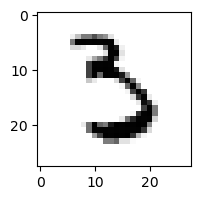

0.0021634233408196046% - 0
0.0004011106095830795% - 1
0.34368024606292685% - 2
19.32708729843483% - 3
8.032320057404092e-07% - 4
23.573516854372162% - 5 - ОШИБКА
1.4544779518747986% - 6
0.19446216246263348% - 7
1.025885459340993e-06% - 8
2.4685130693103436e-09% - 9

 8


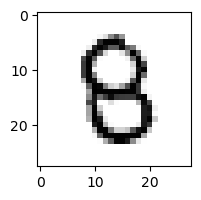

0.03186948505790987% - 0
4.252990489956192e-05% - 1
0.02680926954984968% - 2
0.025112180152864542% - 3
0.13855442169688173% - 4
0.3964025943303748% - 5 - ОШИБКА
0.055267359646751724% - 6
2.3063148305810296e-05% - 7
0.0855906185830864% - 8
6.140959151197739e-07% - 9

 4


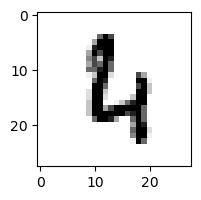

0.0025283100401362795% - 0
3.804786196596405e-06% - 1
50.74974862805267% - 2 - ОШИБКА
1.395171888964291e-07% - 3
11.839818014851092% - 4
0.17428276600846793% - 5
27.915240546654463% - 6
0.005776696461986915% - 7
0.000719620296100597% - 8
0.007213127238498734% - 9

 5


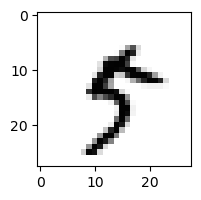

0.005400431237746365% - 0
0.016603933711647256% - 1
6.523463345061578e-05% - 2
0.4518170244589427% - 3
0.06031499893030275% - 4
0.0013604680878734736% - 5
0.11608703889800938% - 6
0.8768764435543761% - 7
0.34638580197351526% - 8
58.85787048380897% - 9 - ОШИБКА

 5


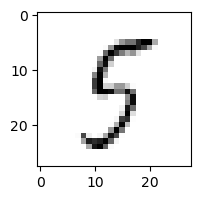

2.9845066811591017% - 0
0.02187190011876778% - 1
0.3588618078534847% - 2
3.970821979441093% - 3
2.5259300659937645% - 4
91.06268364158706% - 5
3.4931389840674334% - 6
0.026580222681426843% - 7
92.59533384311621% - 8 - ОШИБКА
24.12729680554205% - 9

 1


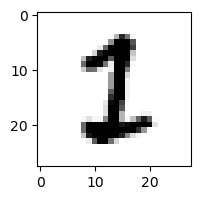

7.960177904396811e-06% - 0
3.086063913107331% - 1
21.57202112921749% - 2 - ОШИБКА
0.0005323229100257023% - 3
1.0076774275845052e-10% - 4
0.7641355229745277% - 5
0.00017294462074554377% - 6
0.00025461805576731944% - 7
5.180475538235088e-06% - 8
9.532734764765964e-11% - 9

 4


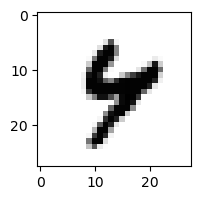

1.036248850566625e-06% - 0
4.779707171815397e-05% - 1
9.024280893546585e-06% - 2
2.1985015957402206e-06% - 3
36.12219964219791% - 4
0.0016748163599892534% - 5
0.010106822484144956% - 6
0.019492009899307876% - 7
2.9631122168135025% - 8
51.97743704000693% - 9 - ОШИБКА

 7


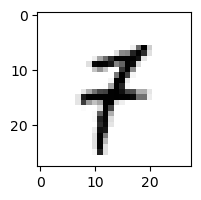

0.003241837184379448% - 0
3.735361219641216% - 1
1.185810899406705% - 2
0.009629263935287761% - 3
0.06518522126127697% - 4
0.44517246654767306% - 5
0.003131463954542374% - 6
0.028516114578753183% - 7
2.7273384557355165e-05% - 8
12.075677784033537% - 9 - ОШИБКА

 8


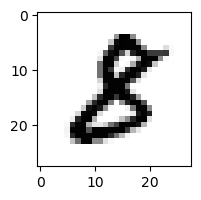

0.0005902203023876998% - 0
0.0027455657893409764% - 1
0.059727277769184337% - 2
1.5571808466720214% - 3 - ОШИБКА
2.134320874469369e-09% - 4
0.03810571475957045% - 5
3.958533395124854e-07% - 6
5.9318617082220843e-08% - 7
0.003696610456754304% - 8
6.2704170192553936e-12% - 9

 5


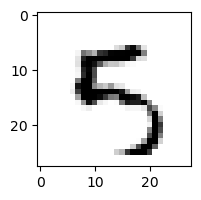

0.009632528928877143% - 0
2.8053450057088603e-05% - 1
0.031856164147720106% - 2
0.001451936097431193% - 3
0.2063798457509155% - 4
36.685596595939835% - 5
0.08937148955801612% - 6
0.005887532263662802% - 7
1.4336321081808438e-07% - 8
99.99982350397738% - 9 - ОШИБКА

 5


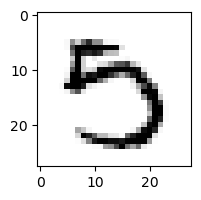

0.10852345338165362% - 0
3.945947946301532e-06% - 1
1.1295457979830068e-08% - 2
0.36911779543397766% - 3
0.000724510144891268% - 4
7.170446476706867% - 5
1.7035406945821504e-06% - 6
9.274353107414477% - 7 - ОШИБКА
6.391587390017417e-06% - 8
1.0462926422551327e-06% - 9

 8


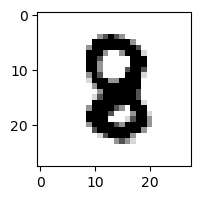

9.21709647409973e-09% - 0
1.3862524039780913e-05% - 1
0.022505969836023643% - 2 - ОШИБКА
4.549355243585365e-07% - 3
1.5441173502915407e-05% - 4
6.697158217497074e-05% - 5
0.0015547464064041222% - 6
5.947706067651384e-08% - 7
3.4317848415312814e-05% - 8
1.464832585391401e-12% - 9

 9


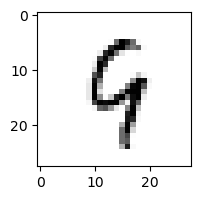

0.010975313579883562% - 0
0.011615733929728377% - 1
4.736590662525709% - 2
0.021067046501247116% - 3
66.39354781820197% - 4 - ОШИБКА
2.139125957749507% - 5
12.388364160487143% - 6
0.10325870487971071% - 7
19.836688318760608% - 8
42.486869205904185% - 9

 6


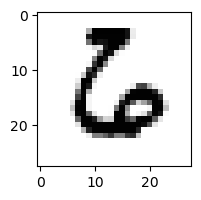

0.0018138068049550343% - 0
2.1353327365371144e-07% - 1
68.50275570221042% - 2 - ОШИБКА
1.2381351987965766e-05% - 3
3.4518898116678503e-06% - 4
0.03870767992191588% - 5
67.72829082108451% - 6
4.176065865756309e-06% - 7
3.844599931902828e-14% - 8
1.7536867458812096e-13% - 9

 7


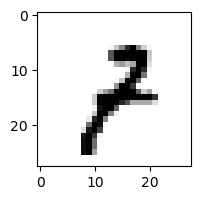

0.0017890648527390733% - 0
0.1959283927295444% - 1
1.265018382047369% - 2
0.6184626409140905% - 3
0.013145647867167477% - 4
0.0004812914637139075% - 5
0.0008645366843720256% - 6
4.6128718702269005% - 7
0.0006717768968880649% - 8
28.526028274649363% - 9 - ОШИБКА

 8


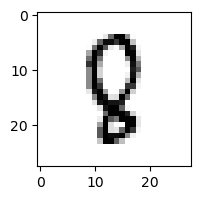

0.00018976412027010202% - 0
0.0021644469677105983% - 1
3.6445194622823154% - 2 - ОШИБКА
5.055935105797296e-05% - 3
0.6754806511644854% - 4
1.8221747007468363% - 5
0.1007391600106863% - 6
0.0023110206092621767% - 7
0.37494062935082145% - 8
2.8286487676405944e-07% - 9

 7


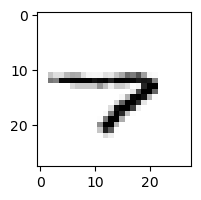

0.003024894460234861% - 0
0.0688956928165447% - 1
7.867076916242846e-06% - 2
0.010230063529646293% - 3
99.91685904685951% - 4 - ОШИБКА
2.1197237682537597% - 5
79.17857340480145% - 6
15.234034669425839% - 7
0.0023700975528577915% - 8
82.65891715640166% - 9

 3


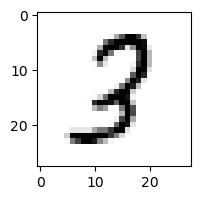

0.004864380230314006% - 0
0.2722382942969314% - 1
44.784872563163795% - 2 - ОШИБКА
36.2569070580053% - 3
0.0035650787662415387% - 4
0.04037788384467626% - 5
0.0007207006566562851% - 6
0.002213866951902241% - 7
18.77834640498253% - 8
9.090785465731957e-07% - 9

 1


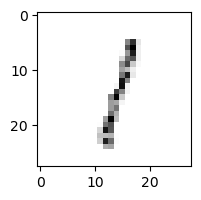

0.4845966867240253% - 0
72.77976998014304% - 1
34.115610383232095% - 2
63.44957094947259% - 3
18.849650966376668% - 4
14.607621592376505% - 5
8.002731669443008% - 6
49.95096847031414% - 7
77.59115876592728% - 8 - ОШИБКА
21.724467523686883% - 9

 8


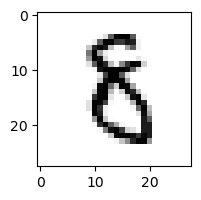

0.0003040678424418556% - 0
0.10726255524541042% - 1
1.6847489558862352% - 2 - ОШИБКА
0.27367950141289127% - 3
0.0016427305706968932% - 4
1.0460503200694646% - 5
0.4314741710508524% - 6
3.6867252515120824e-05% - 7
6.469931455193036e-05% - 8
7.884042567564022e-10% - 9

 8


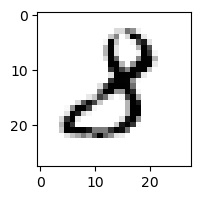

0.007478738913178882% - 0
0.2065757052132892% - 1
3.096999426992959% - 2
98.62145304750341% - 3 - ОШИБКА
0.00022674349967198327% - 4
0.003771924296773213% - 5
1.0227493737651465e-05% - 6
0.0027293914990015% - 7
8.989206328859001e-09% - 8
1.860836143184297e-05% - 9

 8


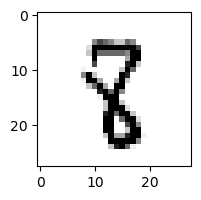

1.838902483947645e-06% - 0
0.2973525115822746% - 1
0.008812142055659944% - 2
0.004981145260050947% - 3
0.08164041911370352% - 4
2.701655977907251% - 5 - ОШИБКА
0.00040204653174129713% - 6
0.002306653223549995% - 7
0.00035770387281800945% - 8
1.0308444235027702e-05% - 9

 0


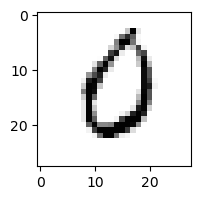

80.45386359978416% - 0
2.023516425093879e-06% - 1
0.09432750707385827% - 2
0.011530629590409186% - 3
0.03581682341627869% - 4
3.246298121765641% - 5
84.95367547904092% - 6 - ОШИБКА
0.05750161023377278% - 7
0.00014745857919536498% - 8
0.0006255873806599913% - 9

 7


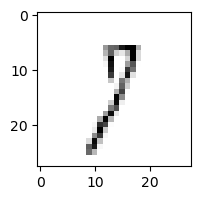

2.1411387773449735% - 0
39.82213247127883% - 1
20.666472469785788% - 2
63.77744559185567% - 3
0.19385670932847016% - 4
3.8489839329446967% - 5
2.1201338603332767% - 6
47.23871323972578% - 7
10.988851138620381% - 8
93.23192200014199% - 9 - ОШИБКА

 9


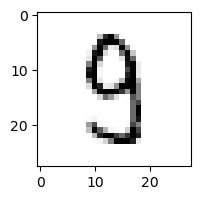

0.0030621902373293556% - 0
0.0023063713072334568% - 1
0.0421734614949156% - 2
21.78337126730615% - 3 - ОШИБКА
0.6154241425084702% - 4
3.9726699442269466% - 5
0.002679215833910082% - 6
0.0185451732811242% - 7
0.22927901455827393% - 8
0.00038422019486829604% - 9

 8


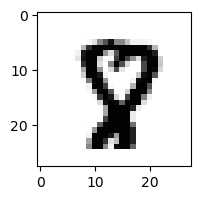

5.913536738154052e-06% - 0
1.1211152754667438e-08% - 1
1.4957825293132061e-05% - 2
1.1126937117322955e-07% - 3
0.0006960908689293945% - 4
0.0425594710272741% - 5
6.669674202831439e-08% - 6
0.07547980471338057% - 7 - ОШИБКА
0.00044956641976552864% - 8
2.2461143420990317e-09% - 9

 6


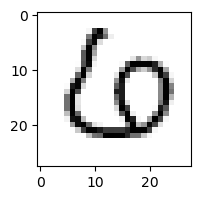

0.025232597997392598% - 0
4.345094939681536e-05% - 1
0.013990396975961415% - 2
0.030745605847804648% - 3 - ОШИБКА
0.0002216800848717402% - 4
0.0003417637796838228% - 5
9.217624094849935e-05% - 6
0.00035952333822475224% - 7
8.503466524044259e-08% - 8
1.6703682345946556e-11% - 9

 5


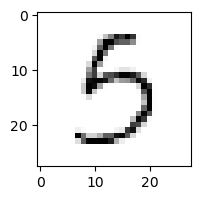

0.4440810115317952% - 0
0.013496067914756485% - 1
0.0007691321731371583% - 2
83.62618780048376% - 3 - ОШИБКА
0.22217090066783854% - 4
68.84070903054848% - 5
0.34265767210146125% - 6
0.06686499264613266% - 7
0.13123910803663902% - 8
1.5275607508033598e-06% - 9

 7


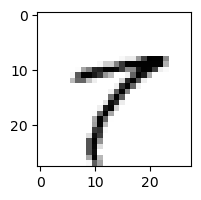

0.05766990121920119% - 0
1.7764406546336642% - 1
0.00019910483225092632% - 2
0.0015156288565601596% - 3
0.1057681005455079% - 4
1.0493664377189973% - 5
0.0007177509410684585% - 6
91.51266486076764% - 7
93.98520293886622% - 8 - ОШИБКА
0.15743476208126025% - 9

 8


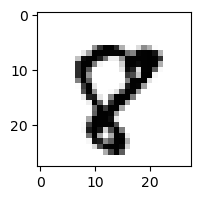

0.0014902717135994174% - 0
5.3415032986815485e-06% - 1
5.8175827477766976e-05% - 2
4.370553367251768e-09% - 3
1.3829322660862478e-05% - 4
0.0039006366405180473% - 5
5.051390264634409e-07% - 6
24.915326311897402% - 7 - ОШИБКА
0.07826144929341085% - 8
3.7038158788743576e-06% - 9

 4


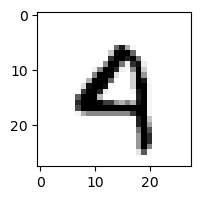

0.18971741072466267% - 0
3.4799313592988033e-05% - 1
0.015021983385175703% - 2
1.024436873959788e-06% - 3
29.080072529224775% - 4
0.0005104661772105284% - 5
0.7758616071160076% - 6
0.0018081550908926342% - 7
6.570760566317359e-09% - 8
99.32443734200237% - 9 - ОШИБКА

 8


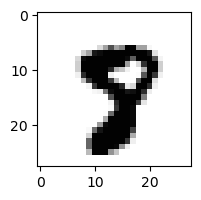

2.0410866714376246e-07% - 0
2.2760700386753088e-08% - 1
7.67568524015525e-11% - 2
5.849449817781503e-09% - 3
5.893814291216717e-07% - 4
0.2642513135249746% - 5
1.4721289610004413e-08% - 6
0.992395025565028% - 7 - ОШИБКА
0.00014196253300852526% - 8
5.327947905769977e-06% - 9

 6


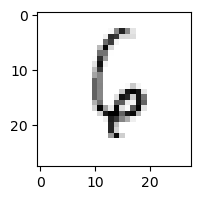

0.0019608970134748563% - 0
0.17854266146743086% - 1
40.08599822656497% - 2
0.0012328678467987586% - 3
89.20987455817854% - 4 - ОШИБКА
1.6024807717300515% - 5
79.10887694689877% - 6
4.544558169656183% - 7
0.024489482693865135% - 8
2.1057477661617368% - 9

 7


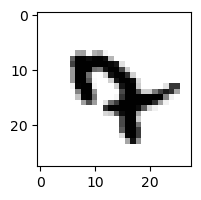

2.6427410380892546e-08% - 0
0.0005873856032238699% - 1
3.271219256628039e-07% - 2
1.8797784569551705e-07% - 3
89.49826759232393% - 4 - ОШИБКА
0.01624141273521992% - 5
0.8290653552546658% - 6
28.26210841651052% - 7
3.1004407318186564e-13% - 8
2.538264575033648e-07% - 9

 8


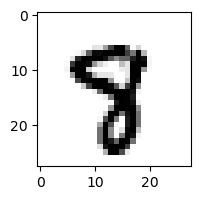

9.711039622987342e-08% - 0
3.0795993495723048e-06% - 1
1.2939540447848725e-08% - 2
3.5145173965441767e-06% - 3
0.0018822893815508323% - 4
0.4067106392201293% - 5 - ОШИБКА
2.5883925291930354e-06% - 6
0.3516088350977802% - 7
0.00010804970015558189% - 8
0.0001002698069566541% - 9

 8


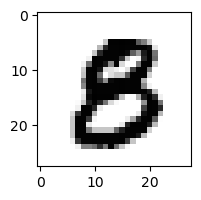

0.0006452136166704141% - 0
2.5534416739324204e-08% - 1
1.060630090422863e-06% - 2
0.016893235556478526% - 3
2.330667755276244e-08% - 4
0.12419032043405392% - 5 - ОШИБКА
1.782153048278094e-08% - 6
2.0047704091362568e-10% - 7
3.969799310410185e-06% - 8
4.181268291425791e-12% - 9

 7


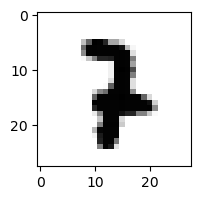

2.1949245215187222e-10% - 0
0.027568452388095157% - 1
0.8973437153204566% - 2 - ОШИБКА
0.00028305989450568627% - 3
8.252766387395325e-06% - 4
1.6045137095463376e-05% - 5
7.739024109285574e-05% - 6
0.011823176602807565% - 7
7.572713099039319e-11% - 8
6.562349025424686e-08% - 9

 2


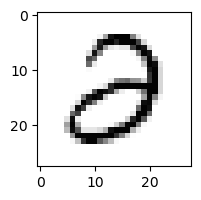

20.057230039418428% - 0
1.4464523341548856e-05% - 1
14.700233741532411% - 2
82.10756380442612% - 3 - ОШИБКА
0.0019604940396195114% - 4
0.021671407986227725% - 5
0.007969381249881233% - 6
3.852272505295056e-06% - 7
0.00020400398030473657% - 8
8.234851825091472e-10% - 9

 5


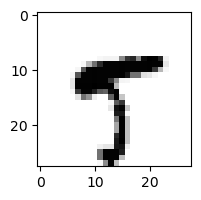

0.00011829317806418845% - 0
0.0055794636172565295% - 1
3.5744693860410617e-12% - 2
4.012137671561316e-07% - 3
0.6788605922544256% - 4
3.7089625259525367% - 5
9.956220473133968e-07% - 6
5.872668049625714% - 7 - ОШИБКА
2.879427754349122e-06% - 8
0.037310870822935396% - 9

 8


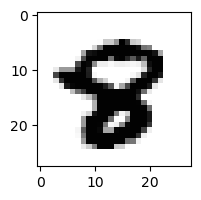

3.876948548792081e-07% - 0
5.031134613959201e-11% - 1
1.3102363557957943e-09% - 2
5.281395766998667e-13% - 3
8.789216350899766e-08% - 4
0.0003467988126750554% - 5 - ОШИБКА
1.8904153457243504e-07% - 6
9.948408993367111e-08% - 7
5.641461543078804e-05% - 8
1.3240388122677727e-12% - 9

 1


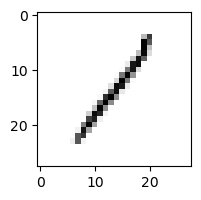

1.4426769120259486% - 0
91.79236810018409% - 1
64.48320656325753% - 2
26.977577373476002% - 3
2.797840872242759% - 4
5.2060632429497655% - 5
1.6261316026510244% - 6
1.395158010362051% - 7
98.23427837442178% - 8 - ОШИБКА
25.72220546595344% - 9

 9


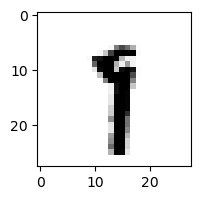

9.3814767720102e-08% - 0
41.38350634845601% - 1 - ОШИБКА
0.0004051293376568778% - 2
0.00815765174578148% - 3
0.0004947041358894845% - 4
0.05600430441686509% - 5
0.0017734248966315032% - 6
23.540456173499543% - 7
0.0009709568525935019% - 8
0.146633637868304% - 9

 3


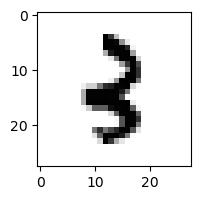

2.431937609772085e-06% - 0
0.08799063055982942% - 1
3.9092018532311106% - 2 - ОШИБКА
0.05324643966639433% - 3
0.01896240190439142% - 4
0.0008968412771476415% - 5
0.011029901247089921% - 6
1.2761434934586699e-06% - 7
0.00017671504417727393% - 8
0.024164374426661254% - 9

 9


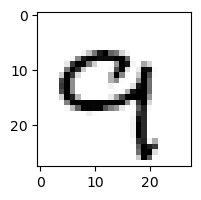

0.0005885876797122454% - 0
0.0004902663007034873% - 1
0.02278912223508523% - 2
1.1734043735563041e-05% - 3
0.19483427619404545% - 4
2.2224233192135197e-06% - 5
0.0041062929586703194% - 6
36.835751329046275% - 7 - ОШИБКА
4.062392947953613e-07% - 8
23.43295821236194% - 9

 9


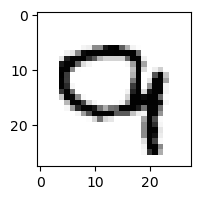

0.14251192522912048% - 0
3.1182065175008414e-08% - 1
7.783677525276049% - 2
1.8887631928295446e-06% - 3
0.07448701987310001% - 4
6.649595799981837e-10% - 5
0.008907884762282997% - 6
14.54069134449994% - 7 - ОШИБКА
1.3252112534420236e-09% - 8
0.015444712397682433% - 9

 9


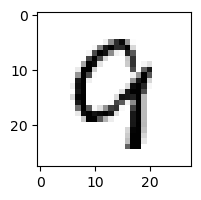

0.10296161495360152% - 0
2.4647958021433705e-05% - 1
2.169261759576676% - 2
1.6848229895660726e-07% - 3
12.435244591420577% - 4 - ОШИБКА
4.825893063213987e-05% - 5
0.41813126727855515% - 6
0.1275698270086278% - 7
0.08854539918931825% - 8
0.04428578871881301% - 9

 8


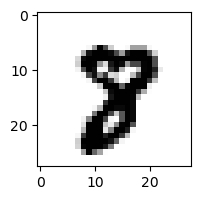

8.161459886488132e-07% - 0
8.863556419032726e-07% - 1
3.9441043097806595e-07% - 2
1.3218847007813705e-07% - 3
2.4475753640349253e-08% - 4
0.00039770073233416793% - 5
2.6616981399811472e-08% - 6
0.13468635506115706% - 7 - ОШИБКА
0.10561205014723898% - 8
3.0493138639900865e-08% - 9

 9


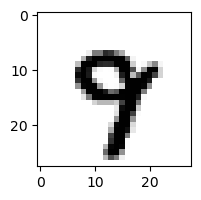

8.831584717847402e-08% - 0
5.20320267565084e-06% - 1
2.1682977254031222e-07% - 2
5.2236587740693434e-06% - 3
0.22743727204629405% - 4
0.00026636679860008453% - 5
0.0009076453903301001% - 6
27.555552975694226% - 7 - ОШИБКА
6.70655292558729e-07% - 8
4.391612848970745% - 9

 7


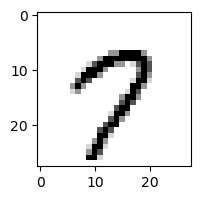

0.3293456597795207% - 0
6.134015265854426e-05% - 1
0.0002101713395639111% - 2
2.7886021010511893e-05% - 3
0.04079280066115275% - 4
1.0487647798034692% - 5
0.0011845627980517613% - 6
86.84356186767432% - 7
0.021436276921918806% - 8
99.4522392439682% - 9 - ОШИБКА

 9


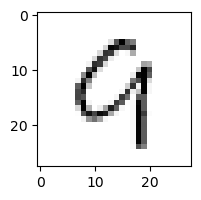

2.7346951681784564% - 0
0.000783507087128611% - 1
23.432731083106223% - 2
3.836146576114661e-05% - 3
51.054654079341496% - 4 - ОШИБКА
0.0006716195732748193% - 5
15.139028169854907% - 6
0.13655664099933446% - 7
13.762696396466772% - 8
11.634553591631033% - 9

 5


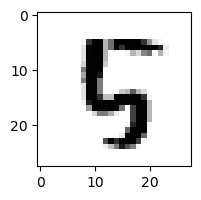

1.125399166612797e-05% - 0
1.2455785041196901e-06% - 1
0.15618351585589701% - 2
4.325970671235702e-09% - 3
45.812167102564466% - 4 - ОШИБКА
4.766165661561674% - 5
0.0026143795088404862% - 6
4.6256614452666284e-05% - 7
0.00016515044667302163% - 8
2.9333863914607124e-10% - 9

 3


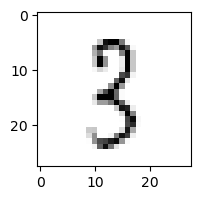

0.004682178069361713% - 0
6.6602766459975165% - 1
27.549123303516637% - 2
68.09532515834495% - 3
0.2026398238390712% - 4
8.81344685697262% - 5
0.004274736686597803% - 6
0.029535660722145297% - 7
70.11669186381172% - 8 - ОШИБКА
0.029385085787931132% - 9

 9


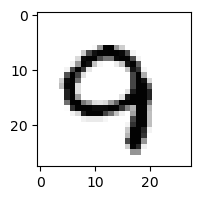

0.0029894805600154794% - 0
1.8864007562874608e-06% - 1
0.2138826598058129% - 2
2.4299764590903845e-09% - 3
0.20870719065137164% - 4
2.1835871034354067e-07% - 5
0.0004953150550389439% - 6
2.560592272608284% - 7 - ОШИБКА
1.0400825553292347e-07% - 8
0.13623283565095196% - 9

 4


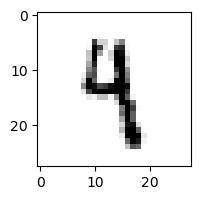

3.996481518914915e-06% - 0
2.3389893574303993% - 1
0.00508242021982302% - 2
5.553611793669697% - 3
7.909146998125472% - 4
1.8794088107779965% - 5
0.07088699308827168% - 6
0.001479020914176116% - 7
9.537265769242382e-05% - 8
10.137492438139786% - 9 - ОШИБКА

 8


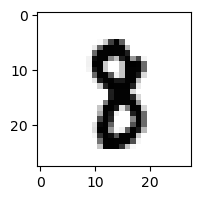

6.979318441582228e-09% - 0
0.026116470907574435% - 1 - ОШИБКА
2.6541119279514707e-05% - 2
0.0002547964242637205% - 3
3.5766321037645276e-05% - 4
0.006290689509636534% - 5
1.5980991970794449e-06% - 6
0.0022645206720462744% - 7
0.01868579276680301% - 8
1.456474260247929e-08% - 9

 8


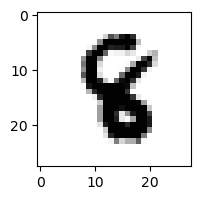

9.350326758668232e-12% - 0
0.00031048047768198725% - 1
0.0017709486080154009% - 2
2.146962105250626e-06% - 3
0.02083736263489216% - 4 - ОШИБКА
0.003909670650914702% - 5
0.0002913190128438161% - 6
1.56324528500784e-07% - 7
3.892707285832944e-09% - 8
1.2608867196933613e-12% - 9

 9


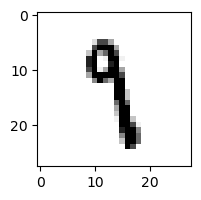

1.6046137963411344e-05% - 0
12.746068452262374% - 1 - ОШИБКА
0.004141408195902249% - 2
0.0845377985822112% - 3
0.06784786734371924% - 4
8.388361210849856% - 5
0.0362429695228355% - 6
1.113578548817649% - 7
0.15976807724902828% - 8
0.011447990972099854% - 9

 6


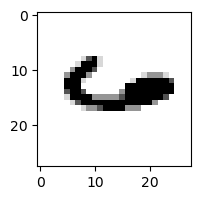

0.12079490447654473% - 0
0.0002204954520498364% - 1
3.083935529285633e-05% - 2
2.2311285118992486e-09% - 3
99.99589689007387% - 4 - ОШИБКА
4.2834970178008264e-07% - 5
97.68062739588702% - 6
18.596954967229085% - 7
0.00026845785304804127% - 8
96.1208007106073% - 9

 8


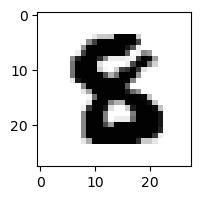

1.3312566956045754e-09% - 0
2.669631844911566e-10% - 1
1.3778292453245511e-06% - 2
1.0621274861806169e-07% - 3
3.7628592317233714e-10% - 4
0.15939196988257393% - 5 - ОШИБКА
2.5338518979165995e-07% - 6
4.4255925570442545e-12% - 7
3.263832972545807e-12% - 8
5.000549489977767e-21% - 9

 3


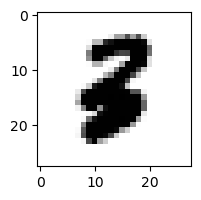

1.192051922936445e-07% - 0
4.51772542513398e-05% - 1
0.1671699764937176% - 2 - ОШИБКА
1.0388231327495682e-07% - 3
9.94441780472364e-07% - 4
9.71267272191985e-05% - 5
8.157694971778385e-06% - 6
4.589088054280461e-08% - 7
1.1144992682787321e-15% - 8
1.4719438596352954e-14% - 9

 5


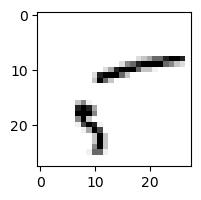

97.82564585836361% - 0
0.8289880338211169% - 1
0.30540552909016% - 2
8.114248935175176% - 3
0.32695979697702304% - 4
96.43301759198954% - 5
0.007212545533589042% - 6
35.42436829099664% - 7
99.66279827933681% - 8 - ОШИБКА
0.002734455168309339% - 9

 8


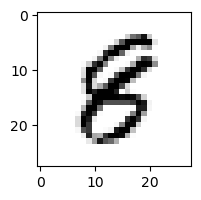

0.00019649308498523579% - 0
0.0008456719900473798% - 1
0.006681420545157506% - 2
0.0004306148334447906% - 3
0.00034245606546355584% - 4
0.29112825674727716% - 5 - ОШИБКА
0.0023341044719260647% - 6
7.343480426814486e-07% - 7
0.003513140605561031% - 8
2.7625486920560696e-06% - 9

 5


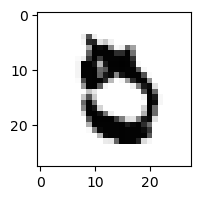

0.044936030627762844% - 0
3.9168014775826186e-07% - 1
8.530989983695139e-05% - 2
3.9382680283012227e-07% - 3
2.1373608793986405e-08% - 4
0.03611876849976816% - 5
0.2175515228228566% - 6 - ОШИБКА
0.04301492982796145% - 7
3.9944375664743363e-10% - 8
2.962858702650826e-09% - 9

 8


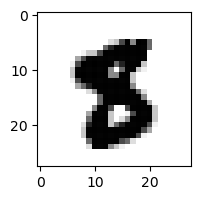

5.0135126563208514e-09% - 0
1.73945811366278e-07% - 1
1.131866204993596e-10% - 2
3.2874317518338286e-10% - 3
6.295955659529102e-10% - 4
0.1689320605815677% - 5 - ОШИБКА
4.405529365240249e-07% - 6
4.7356297138623026e-08% - 7
1.6947630998331522e-10% - 8
6.248362322604393e-15% - 9

 7


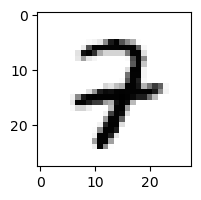

9.23630922683142e-05% - 0
0.0001148893558368322% - 1
2.546325237207001% - 2
0.036455597268996484% - 3
29.68072954197636% - 4 - ОШИБКА
0.0004233330184411227% - 5
0.003824597498463916% - 6
0.014854302341394402% - 7
1.0537373471170668e-06% - 8
6.287659775207844e-05% - 9

 0


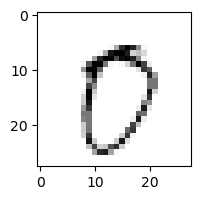

94.72319919059149% - 0
1.104602869458542e-05% - 1
0.131893876422762% - 2
0.060117938879479915% - 3
0.0013490206323064889% - 4
4.698035227876748% - 5
0.346982858448515% - 6
29.01084264735094% - 7
0.39478637974181213% - 8
96.94721347017365% - 9 - ОШИБКА

 8


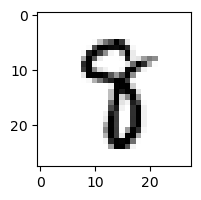

7.872749968419271e-08% - 0
0.10314882446199286% - 1
1.3662938510818664e-05% - 2
0.01390883993517205% - 3
0.02339527729391522% - 4
0.9509585514362974% - 5 - ОШИБКА
5.695174201068964e-05% - 6
0.24251537306421667% - 7
0.0038017997412271225% - 8
2.0338256322894378e-08% - 9

 9


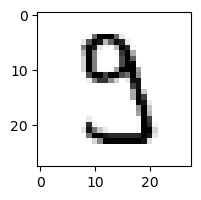

0.774473282197705% - 0
0.000179039728768553% - 1
0.006700112100509744% - 2
68.62987684798826% - 3 - ОШИБКА
0.0007740201749715899% - 4
2.0823969317329962% - 5
2.483663738782495e-06% - 6
0.21777062197799474% - 7
0.00046774644762770173% - 8
1.3453864559401281e-08% - 9

 1


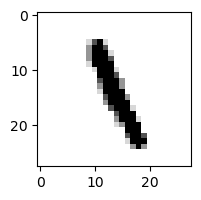

5.058686720603037e-08% - 0
2.177491606325506% - 1
0.1314687694439316% - 2
0.0102385834356238% - 3
5.004619342470167% - 4
38.46882563598724% - 5 - ОШИБКА
0.17229603001466795% - 6
0.0004047060907178709% - 7
15.441574203666027% - 8
0.0003047723171344007% - 9

 9


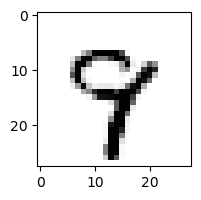

7.20701061267858e-06% - 0
0.0004520925421437793% - 1
0.000976165836763368% - 2
0.00019280901137948598% - 3
0.20442510548585485% - 4
0.004710360855791757% - 5
0.027091758902143347% - 6
16.975925714106353% - 7 - ОШИБКА
0.013193933373447118% - 8
10.455510298213202% - 9

 8


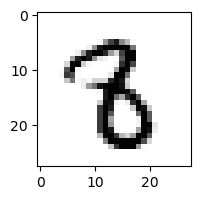

3.9286764392684683e-08% - 0
0.007959804751241967% - 1
0.0008927549532396237% - 2
0.08078723174996306% - 3
8.055396998284459e-05% - 4
0.1504339507229199% - 5 - ОШИБКА
1.613306663183737e-05% - 6
0.00016069556822078136% - 7
0.00011936867278069106% - 8
1.263341448415369e-08% - 9

 8


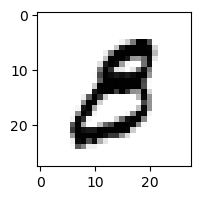

0.09799347153687007% - 0
0.0002752010707710166% - 1
0.0001384556217051562% - 2
7.98271133542742% - 3 - ОШИБКА
4.0395929174074926e-07% - 4
0.15842673552970532% - 5
0.0008063700969054894% - 6
2.018337519339131e-06% - 7
4.5560173799089893e-07% - 8
1.8493992947139454e-06% - 9

 8


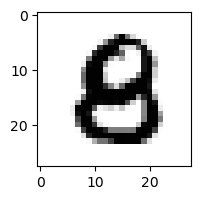

0.0005406679885828636% - 0
6.614042114909053e-10% - 1
0.011657576499659194% - 2
3.0039565291807267e-07% - 3
0.0031384443944637206% - 4
0.1021629312359682% - 5 - ОШИБКА
2.9160093994305834e-05% - 6
7.757752688733661e-10% - 7
0.00045470480168526814% - 8
3.085415713086555e-11% - 9

 5


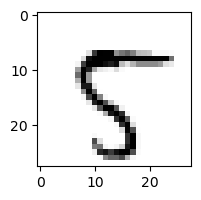

0.018649424755717275% - 0
9.141129756004455e-05% - 1
0.04350025992500099% - 2
9.275387037300446e-08% - 3
0.0008050680280436146% - 4
64.56511263391751% - 5
0.000372844662927337% - 6
55.66892505775187% - 7
0.12010621111190485% - 8
66.13189397269727% - 9 - ОШИБКА

 5


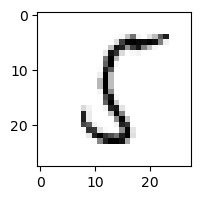

1.1460919255888113% - 0
14.686890948275707% - 1
17.747966553586423% - 2
0.017485622400547806% - 3
0.37222625297045264% - 4
95.12695072646777% - 5
2.325880794077199% - 6
0.0016151722158747792% - 7
99.93916785080864% - 8 - ОШИБКА
0.00016491782502224672% - 9

 8


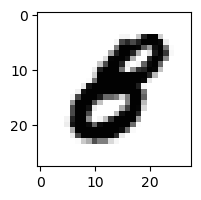

0.005036715283033634% - 0
6.779768103648793e-07% - 1
1.9309421481883026e-06% - 2
5.270535632921055e-07% - 3
3.760584885186039e-06% - 4
0.02667188957841436% - 5 - ОШИБКА
3.7104774055805504e-06% - 6
7.308014470297783e-08% - 7
7.978713002563379e-13% - 8
1.170707225127052e-12% - 9

 9


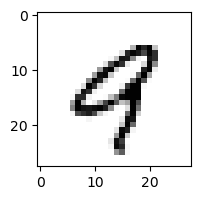

0.24379047023957026% - 0
0.0009462356824839831% - 1
0.0007752046670283104% - 2
0.00014179465915322852% - 3
87.89557987344158% - 4 - ОШИБКА
0.00040456693810975646% - 5
0.09237737872799616% - 6
1.3448982133298415% - 7
0.06763303349581558% - 8
4.6893250710056895% - 9

 6


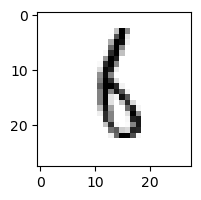

0.0006686135807247933% - 0
4.461652718259102% - 1
5.193535158155773% - 2
2.114089329540558% - 3
0.13954568602222742% - 4
15.998042343735925% - 5
62.186053575065905% - 6
0.0004971380675393161% - 7
79.87537508051167% - 8 - ОШИБКА
0.8305993512922865% - 9

 5


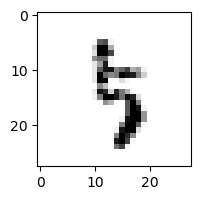

0.00011806800614541386% - 0
0.8004962692274082% - 1
0.07337141197964417% - 2
70.61475421705333% - 3 - ОШИБКА
3.090894685946453% - 4
14.702558779071612% - 5
0.4969799880884899% - 6
1.3459694632863195% - 7
0.21142165814090147% - 8
0.0003912357691613918% - 9

 9


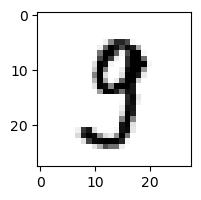

0.01855935846746933% - 0
0.005578305602748859% - 1
0.0029125981305697934% - 2
48.57884179680838% - 3 - ОШИБКА
0.013078503663958805% - 4
1.063560055211086% - 5
2.845229164041978e-07% - 6
0.45889845248719247% - 7
0.658916230802623% - 8
0.005217178490978287% - 9

 4


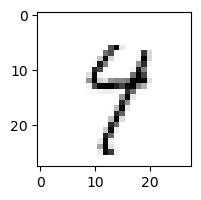

0.017731306700173557% - 0
0.15720158833008543% - 1
0.01698412944264918% - 2
2.4455929033074297% - 3
40.53379384523908% - 4
7.91954595892291% - 5
0.2288021049643017% - 6
4.259785999486537% - 7
97.56335910139944% - 8
99.73756852455527% - 9 - ОШИБКА

 9


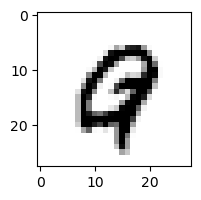

0.011961474583301357% - 0
5.893715480979914e-07% - 1
0.0002757089513523058% - 2
1.4411258661139174e-09% - 3
0.0014692804640809214% - 4
8.507228234525987e-05% - 5
0.05830488215453119% - 6
0.170764969198604% - 7 - ОШИБКА
9.082609134719258e-08% - 8
0.07062845008420855% - 9

 4


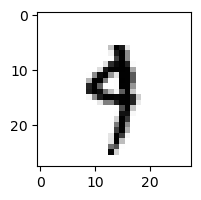

2.681760218061733e-06% - 0
1.61744732511654% - 1
0.00025923111958061067% - 2
2.277408446052378% - 3
25.477181664901128% - 4
0.321346757826974% - 5
0.21268417966387154% - 6
3.391307390667863% - 7
1.421405091485459e-05% - 8
68.13634432076829% - 9 - ОШИБКА

 8


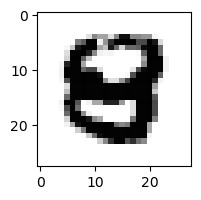

2.402246179432155e-06% - 0
1.2129025880999615e-12% - 1
1.1361167069821695e-09% - 2
4.307302801490645e-09% - 3
0.0006066514488633902% - 4 - ОШИБКА
0.0005474344271961893% - 5
1.6836051144135333e-06% - 6
5.609480979758592e-11% - 7
2.794497268093235e-14% - 8
7.525262168149738e-22% - 9

 7


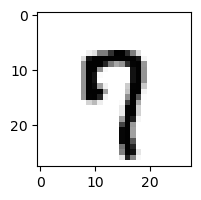

0.5901898282970471% - 0
2.2736437699507156e-05% - 1
0.002006950636726682% - 2
0.0015087019503206296% - 3
0.2142893543461206% - 4
0.9767097112392691% - 5
0.005082770888983122% - 6
35.33260177506521% - 7
2.5435201557746425e-05% - 8
97.45641233777617% - 9 - ОШИБКА

 8


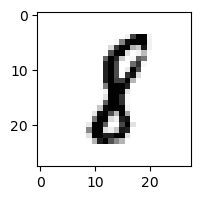

3.209400668468638e-05% - 0
80.86750861980593% - 1 - ОШИБКА
0.023842888684992083% - 2
0.0001806572269289587% - 3
1.2561377402514653e-05% - 4
0.08818788429324688% - 5
0.017367466085417053% - 6
0.00019013547384970033% - 7
2.36843192415693% - 8
1.1342554483057616e-06% - 9

 7


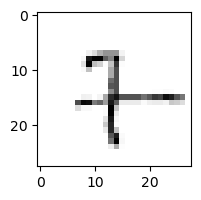

0.024413678535851326% - 0
11.372768945985765% - 1
26.073959973271165% - 2
1.69818896623677% - 3
5.0743920253130606% - 4
5.922011543852188% - 5
30.021387961376945% - 6 - ОШИБКА
8.807276605867289% - 7
1.0244477769747204% - 8
2.259417598491221% - 9

 5


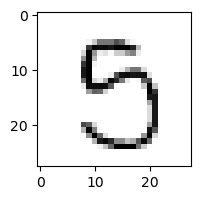

0.552830381527186% - 0
7.5240683077191e-05% - 1
0.008722103076680011% - 2
75.16408006701462% - 3 - ОШИБКА
0.04313292767317728% - 4
38.46630292596971% - 5
0.0019459528799153562% - 6
0.02398251179954467% - 7
22.70764092482584% - 8
0.045355211594120017% - 9

 8


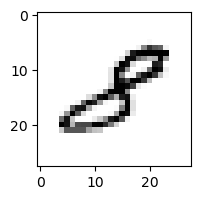

0.036916489116190485% - 0
4.6745713521020384% - 1
16.42175631882189% - 2 - ОШИБКА
0.44743299682178106% - 3
0.011595498455687699% - 4
0.0152237248121234% - 5
1.177641785972996e-05% - 6
0.046925998391881094% - 7
0.016925322416619766% - 8
0.0003397083166131905% - 9

 4


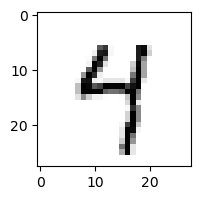

0.04791237194981511% - 0
0.022840506627614915% - 1
0.0002437777388047443% - 2
0.6488858110926697% - 3
77.13248526748426% - 4
20.22893261174327% - 5
0.5236501579128247% - 6
0.14045693244066595% - 7
0.11723964216653637% - 8
90.97230255661414% - 9 - ОШИБКА

 5


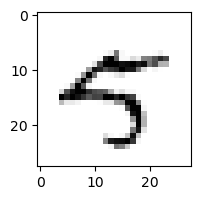

0.12960774791797183% - 0
0.030068988594201835% - 1
0.00014127099539261892% - 2
0.004435694240268815% - 3
28.462797001044127% - 4 - ОШИБКА
7.765797310833785% - 5
0.00017512130443074345% - 6
4.206595802144328% - 7
5.902886080203506e-05% - 8
0.028159094216143744% - 9

 7


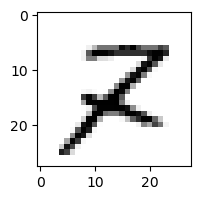

0.0005529805458334869% - 0
0.025567969356718408% - 1
91.90815732447484% - 2 - ОШИБКА
0.0006580715098642431% - 3
0.0012913376506935993% - 4
0.015117316303838883% - 5
0.0001382279461768416% - 6
0.02239058318814293% - 7
10.79733796833859% - 8
0.02558594752360645% - 9

 3


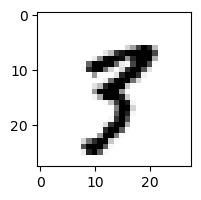

2.2132025787745424e-05% - 0
0.048456463598128684% - 1
0.00045544881954974817% - 2
0.46898297631338576% - 3
0.0006375150896016263% - 4
0.5322414524417719% - 5 - ОШИБКА
1.0787137152216976e-06% - 6
0.20508970911041466% - 7
0.011686440132851932% - 8
0.49178940086258194% - 9

 5


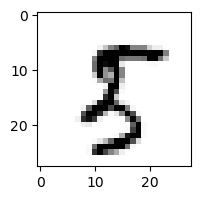

0.0002626586693584411% - 0
0.12833163903705277% - 1
0.01050628353695876% - 2
2.6671336684310686e-06% - 3
3.1282827001511456e-07% - 4
2.706792900788737% - 5
3.2319824165133645e-06% - 6
0.01455878967135604% - 7
99.2495897076316% - 8 - ОШИБКА
0.02807045571163853% - 9

 5


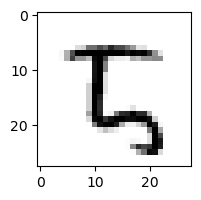

0.348340578322507% - 0
1.5996945971297154e-06% - 1
85.00514089539914% - 2 - ОШИБКА
2.047974544982652e-05% - 3
1.9225581232356563e-05% - 4
75.88559754146901% - 5
3.0291850104130678% - 6
0.00205573530003324% - 7
0.019040092578317378% - 8
13.101570375454019% - 9

 4


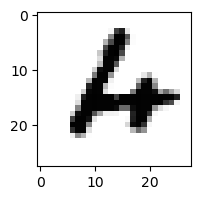

0.002312796897034708% - 0
7.347981972717313e-08% - 1
0.9883668312644632% - 2
1.0751421048081968e-06% - 3
0.011697033288731833% - 4
6.887820154669389e-05% - 5
22.903917588841043% - 6 - ОШИБКА
1.4302894847974818e-06% - 7
6.892054338410552e-10% - 8
1.3620089900425842e-05% - 9

 8


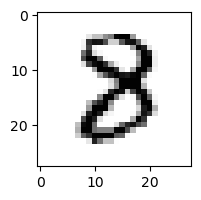

5.217567182690879e-05% - 0
0.0017960148613779517% - 1
0.46120976991700074% - 2 - ОШИБКА
0.010870918445669462% - 3
3.4497732523194075e-07% - 4
0.011646539564823288% - 5
4.0192615199688275e-05% - 6
0.0017813707065753694% - 7
0.020423893025115648% - 8
2.3040661503267455e-13% - 9

 8


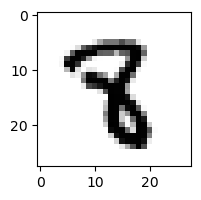

3.883629310006227e-11% - 0
0.0026770151757432624% - 1
1.1751461111777472e-05% - 2
0.000337531812226512% - 3
0.024061163222822406% - 4 - ОШИБКА
0.012180639335679111% - 5
2.3479779388319757e-07% - 6
0.00017068946192908495% - 7
1.973527664130026e-10% - 8
4.521174554261101e-11% - 9

 2


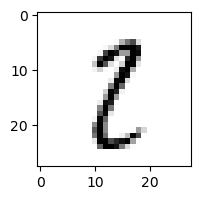

0.07700004278238495% - 0
33.761762916640954% - 1
1.4624272049784812% - 2
1.0806420579366591% - 3
0.0001390639018867289% - 4
3.3210509715088468% - 5
0.00016531748895601465% - 6
0.052496807119011814% - 7
83.39573295507486% - 8 - ОШИБКА
0.024639099470342898% - 9

 5


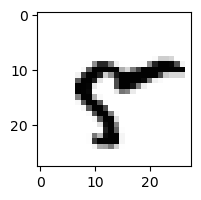

0.14472594942717018% - 0
0.0036808500862724565% - 1
1.5772865123973666e-08% - 2
1.0099940053372224e-09% - 3
0.21326063116917093% - 4
0.0022778050829968467% - 5
0.23947135989018728% - 6
0.403598597275024% - 7
99.12042601125712% - 8 - ОШИБКА
1.3441728926933934% - 9

 7


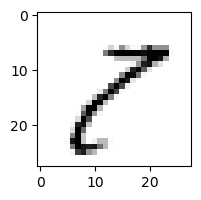

4.4147997724355% - 0
2.0104418017176573% - 1
3.4126543740827215% - 2
92.89669072857403% - 3
0.021859392152566468% - 4
3.5222795642682883% - 5
3.071583065920926e-05% - 6
0.40899604163582015% - 7
98.90383688689367% - 8 - ОШИБКА
84.13289115573467% - 9

 2


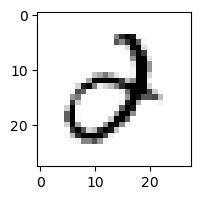

2.197211695248311% - 0
0.0009962570645298298% - 1
0.00037777518204781764% - 2
11.525099778576669% - 3 - ОШИБКА
8.22994296544749% - 4
0.249702304156522% - 5
0.0043535309954509825% - 6
0.006202129379458012% - 7
2.638369417532328e-07% - 8
1.599546250590933e-05% - 9

 2


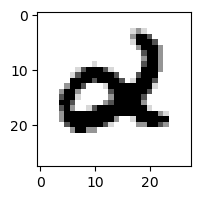

2.6021760111218497e-06% - 0
5.495744720088348e-06% - 1
5.972646341761125e-08% - 2
1.7945874425028252e-15% - 3
0.00010687225082289563% - 4
0.0001180015087223515% - 5
0.0015650482602792644% - 6 - ОШИБКА
1.3947455582794723e-08% - 7
1.3812069832464136e-06% - 8
3.452535115803982e-10% - 9

 0


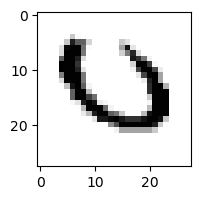

29.342303277526415% - 0
1.883499561288215e-06% - 1
0.2899477955217078% - 2
1.3329440453637646e-06% - 3
0.0018308646097251352% - 4
6.642386892868445e-08% - 5
55.8018093825439% - 6 - ОШИБКА
0.013142661251254188% - 7
7.260778505205241e-09% - 8
1.9831597060059078e-05% - 9

 9


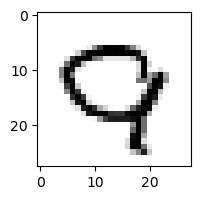

1.3407712591659495% - 0
7.914587526051581e-07% - 1
0.22602523070537955% - 2
1.805564891777968e-06% - 3
0.0005619661725669603% - 4
7.962864863999056e-08% - 5
0.18150078910159081% - 6
5.0633928279086575% - 7 - ОШИБКА
8.576243335673694e-06% - 8
0.21656302496049473% - 9

 9


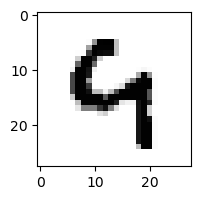

2.6280219998384448e-05% - 0
1.2923509263508537e-05% - 1
0.015461487849879042% - 2
1.7026916208836276e-05% - 3
96.82997113353987% - 4 - ОШИБКА
0.01251397981850014% - 5
14.971353011955449% - 6
0.00021407570262269203% - 7
1.049796915840943e-07% - 8
8.975170811894658% - 9

 8


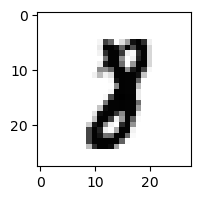

4.987787097234192e-07% - 0
1.175843022050613% - 1 - ОШИБКА
0.0016222371047704995% - 2
2.7861220580121415e-05% - 3
1.3939635698585886e-06% - 4
7.263059813584447e-05% - 5
1.0426241028631786e-07% - 6
0.2547850568872738% - 7
1.4420755041460526e-06% - 8
1.9225387451487837e-09% - 9

 3


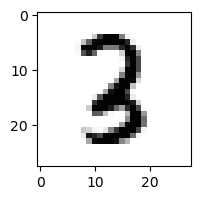

6.883726378474425e-08% - 0
0.029539144078095374% - 1
4.982140541678751% - 2 - ОШИБКА
1.0981304197874775% - 3
0.00045888911462312% - 4
2.5505078350834563e-05% - 5
4.35758830711682e-06% - 6
2.5597138745474737e-05% - 7
0.007046006266223681% - 8
5.887702342355333e-10% - 9

 7


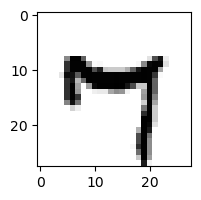

0.0023163891215971164% - 0
0.0001493983598219641% - 1
1.832782406738599e-12% - 2
0.0013352318987850554% - 3
18.618539467684656% - 4
0.013023871074444098% - 5
0.0007750319807376042% - 6
0.2474008677823551% - 7
0.0165055428519394% - 8
68.26251653018005% - 9 - ОШИБКА

 7


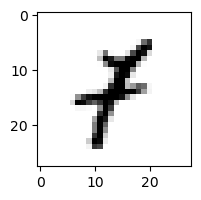

0.0030474967863203303% - 0
50.33703452608187% - 1 - ОШИБКА
0.5857463793995955% - 2
0.0786507596155825% - 3
0.024050330130824794% - 4
0.019305212186616835% - 5
0.002576026429977819% - 6
0.007952628682078132% - 7
1.4648775349976353e-05% - 8
0.1850428106762198% - 9

 6


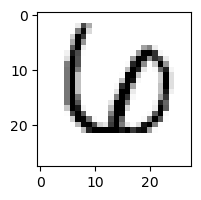

0.017781547954122293% - 0
0.01005769005185748% - 1
0.4137318552039227% - 2 - ОШИБКА
0.0006807583343390053% - 3
0.05197759442174592% - 4
3.8569062360169596e-05% - 5
0.0006190179297256809% - 6
0.19659996100827914% - 7
2.1632571204753794e-07% - 8
1.498484255340842e-11% - 9

 7


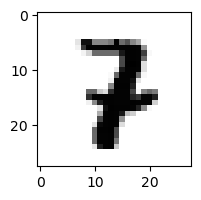

3.3606647081783355e-08% - 0
0.0018763440534800143% - 1
0.017827713639232023% - 2 - ОШИБКА
0.006751940438823491% - 3
0.0007992429733743463% - 4
3.557709416690336e-05% - 5
3.2612743778769743e-07% - 6
0.009344508863737312% - 7
3.67005154827788e-12% - 8
8.482594349038536e-10% - 9

 9


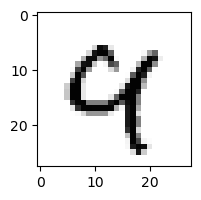

0.0004186882020503053% - 0
0.0023469063684699834% - 1
0.005854729829394428% - 2
1.5965661906231034e-07% - 3
77.55544514998103% - 4 - ОШИБКА
6.322555992119534e-06% - 5
0.004471348059452317% - 6
6.06079657875989% - 7
0.08947804752412906% - 8
13.345218964477754% - 9

 6


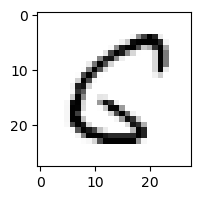

15.41392471962905% - 0
0.0020531959712266437% - 1
0.4166394349470569% - 2
1.695270600377109e-08% - 3
0.03589451296486439% - 4
98.94591455585108% - 5 - ОШИБКА
0.00044914133055756327% - 6
5.040042346982199e-05% - 7
3.770694346848085% - 8
7.436098575828873e-08% - 9

 5


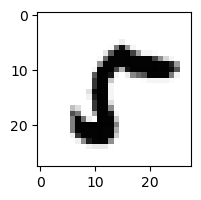

94.9600687449381% - 0 - ОШИБКА
4.331951099820652e-05% - 1
0.011151146621773387% - 2
8.530869893879343e-06% - 3
2.7777576721834023e-09% - 4
0.24641924465838566% - 5
4.634373742149125e-07% - 6
0.0032625156347666755% - 7
60.78176268876124% - 8
1.471628212733225e-05% - 9

 9


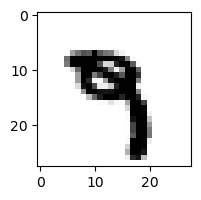

1.4676411671468274e-09% - 0
0.0006266398931059158% - 1
1.7382368441119003e-07% - 2
0.008954771959280206% - 3
0.020456881010960548% - 4
0.23946975129236023% - 5
0.00012066600482840654% - 6
0.258935451338435% - 7 - ОШИБКА
2.766758263676175e-08% - 8
0.026646563770237525% - 9

 2


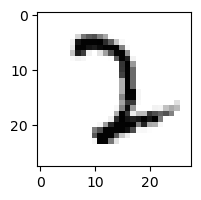

4.731930192631404e-05% - 0
0.0002052514934297589% - 1
98.27001714228595% - 2
99.63258119739645% - 3 - ОШИБКА
1.1453451636897215e-05% - 4
0.0063846508365169715% - 5
0.0032890708771970475% - 6
0.07894317389169363% - 7
6.525604290950162e-08% - 8
7.455143078452154e-07% - 9

 9


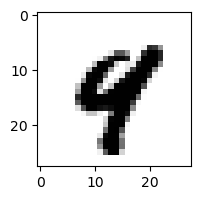

1.5339370591312114e-08% - 0
9.474053120277358e-06% - 1
1.3976733642380107e-08% - 2
2.0514359282873976e-12% - 3
57.131092943272144% - 4 - ОШИБКА
2.3151555520679796e-05% - 5
3.640750084097606e-06% - 6
0.007084851847218795% - 7
2.975927006520608e-05% - 8
0.05751013154978403% - 9

 2


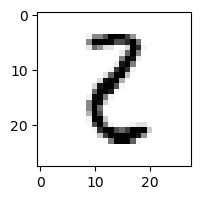

2.694588237181961% - 0
2.0796789720426765% - 1
13.975413882923645% - 2
16.83683237078258% - 3 - ОШИБКА
0.00048600352835204494% - 4
1.9873027856366292% - 5
1.0608274898338699% - 6
9.124412770505852e-07% - 7
0.16296016461241233% - 8
7.022700521669706e-08% - 9

 9


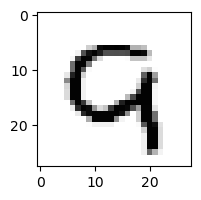

0.06628511842942461% - 0
6.964334029777827e-07% - 1
3.9456968833331683% - 2 - ОШИБКА
2.97565643388284e-09% - 3
0.3182742237293942% - 4
3.686279457676029e-05% - 5
0.22891996281309934% - 6
0.49197442884622533% - 7
3.839420503150075e-08% - 8
3.921296649677349% - 9

 5


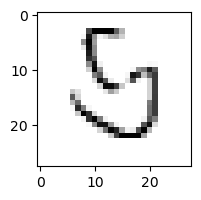

9.089906419351271% - 0
0.00029051057004773965% - 1
57.720435353067344% - 2
1.8622418958169529% - 3
0.07027369368131094% - 4
0.11114830920208793% - 5
72.97001455629321% - 6 - ОШИБКА
0.15184309401542548% - 7
47.75516767075011% - 8
0.005984769277369536% - 9

 5


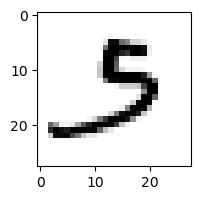

0.22144905919182784% - 0
0.017585683278326086% - 1
0.788595969851082% - 2
93.38883956027298% - 3 - ОШИБКА
2.336581519862875e-08% - 4
0.024984578111079535% - 5
0.08130634517805777% - 6
1.9446766889885516% - 7
1.9641471280202378e-07% - 8
0.0011624748329429253% - 9

 1


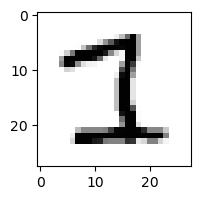

7.560532987331595e-06% - 0
0.005657449715944377% - 1
47.13848355408821% - 2
85.19797444285456% - 3 - ОШИБКА
0.0005024084443658463% - 4
0.4496206891533302% - 5
3.207704842196252e-07% - 6
0.024992132311842694% - 7
1.283655232590452e-05% - 8
3.048993138898379e-13% - 9

 9


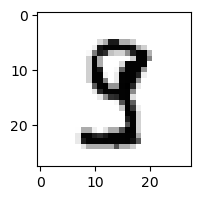

8.124024389987382e-05% - 0
0.003517110113893382% - 1
4.762976270019694e-06% - 2
34.599068202651054% - 3 - ОШИБКА
0.09859959591273725% - 4
0.7964036468197605% - 5
4.291005920494211e-09% - 6
0.013062905748903612% - 7
0.2537469319113188% - 8
5.790620202360738e-07% - 9

 4


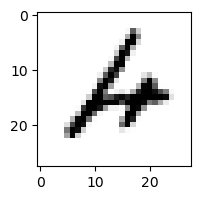

0.04432789571468962% - 0
0.0002452738211622011% - 1
0.8889874438335577% - 2
0.056267568011709304% - 3
0.13629496105569466% - 4
0.0013191454630957359% - 5
83.88956043093185% - 6 - ОШИБКА
0.00023523763818492245% - 7
0.00010791748750092657% - 8
0.040839088037802534% - 9

 3


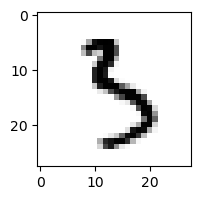

0.00018574875799747212% - 0
0.0027292322820975765% - 1
0.009004895753236729% - 2
64.92639857680277% - 3
0.47343250847639806% - 4
66.75651950809088% - 5 - ОШИБКА
0.008446361886668865% - 6
0.0039053248908959945% - 7
0.07558169959004143% - 8
5.599527297034124e-05% - 9

 2


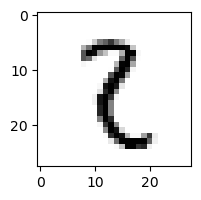

0.00043775584715329246% - 0
8.801741765717644% - 1 - ОШИБКА
1.6152274402927742% - 2
1.4747462919899024% - 3
0.00040721004025798496% - 4
0.46123446358335735% - 5
0.00855885199203453% - 6
0.000669206714205221% - 7
0.9636136092261657% - 8
0.0014556494496428345% - 9

 9


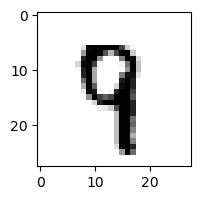

1.603259296035414e-08% - 0
0.0021641468494212647% - 1
0.0013130819763680895% - 2
0.0009166883654401132% - 3
1.4322767920004686% - 4
0.10389014480615935% - 5
0.0008141874035337305% - 6
2.4965333176312616% - 7 - ОШИБКА
0.00017216000271609916% - 8
0.38809039949220575% - 9

 8


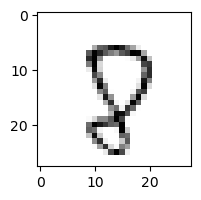

0.371544270413788% - 0
7.928388620502292e-05% - 1
1.6282662776800065% - 2
0.010225186100366572% - 3
0.05345475952300576% - 4
32.45453997976901% - 5
0.04266961780156268% - 6
46.690175893974626% - 7 - ОШИБКА
2.5729727545298444% - 8
10.224987801709746% - 9

 5


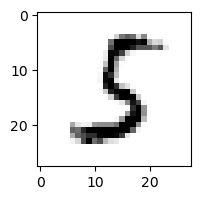

0.0742542416446561% - 0
0.42405121636157167% - 1
1.1304712975671283% - 2
71.76129936888368% - 3 - ОШИБКА
4.281869374082711e-06% - 4
60.13405042662478% - 5
0.7514536884590649% - 6
6.161059452190639e-06% - 7
0.0022515940532562987% - 8
1.5914213313465653e-09% - 9

 8


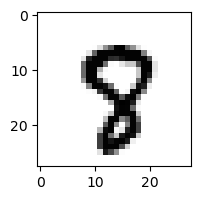

1.3655071882436761e-05% - 0
1.5762669722268636e-07% - 1
8.599019968577666e-06% - 2
2.6301837038963215e-06% - 3
0.0015694779548071686% - 4
0.557042732655662% - 5 - ОШИБКА
1.6409195506012958e-06% - 6
0.23092944181616198% - 7
0.03252630968637245% - 8
0.029904094805185705% - 9

 3


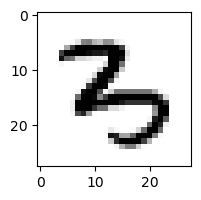

0.000120770759607915% - 0
1.833978775140693e-06% - 1
0.7970873550745774% - 2
0.010768835895135725% - 3
10.797829768244478% - 4 - ОШИБКА
0.0037218764190650555% - 5
0.004389276262548407% - 6
1.7866513013777114e-05% - 7
1.3510538620260294e-11% - 8
5.174822492052123e-07% - 9

 8


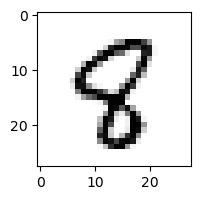

8.211092269706097e-05% - 0
0.004310038752372217% - 1
0.011632163112849654% - 2
1.00972657633987e-05% - 3
0.15967145662244095% - 4
6.724629507647882% - 5 - ОШИБКА
0.005749144960125551% - 6
0.000370627264652241% - 7
0.5331934825546862% - 8
1.0105324859123674e-05% - 9

 5


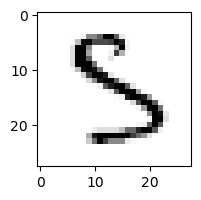

0.00016633480300511121% - 0
0.00024406817885359741% - 1
0.03307884403688006% - 2
49.304546333176674% - 3 - ОШИБКА
0.04483144415388707% - 4
43.877227672747765% - 5
0.013499975920358655% - 6
0.0008484871255998545% - 7
0.17539009525768587% - 8
2.7308700383782595e-08% - 9

 9


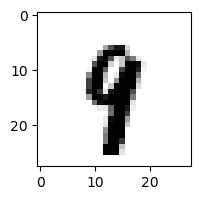

4.238549818013901e-09% - 0
0.020134813648685253% - 1
3.7764159234643776e-06% - 2
1.500782706795522e-06% - 3
0.3702193291166896% - 4 - ОШИБКА
0.04084547957360118% - 5
0.00017995734488513901% - 6
0.10435596073691637% - 7
1.4026915749236546e-06% - 8
0.20415999375950855% - 9

 9


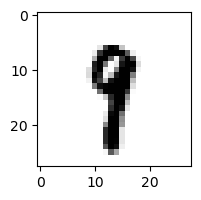

5.947164963459162e-08% - 0
5.645994283436128% - 1 - ОШИБКА
3.0759385197591775e-05% - 2
0.0008003140453892761% - 3
0.0027613914765991284% - 4
0.26273436096000247% - 5
0.0002421391523839676% - 6
0.2083511641814449% - 7
0.0023258904265274012% - 8
0.3977901573486208% - 9

 8


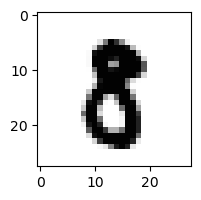

9.220852677752073e-05% - 0
0.00029812169581220884% - 1
6.123660780501894e-05% - 2
0.00036884483999246746% - 3
5.6255698551081006e-08% - 4
0.013531785836479092% - 5 - ОШИБКА
2.825269338968476e-07% - 6
1.947270199048714e-05% - 7
0.0003119935124894326% - 8
4.641475303710772e-09% - 9

 5


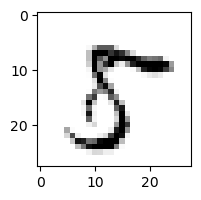

5.316993412005829% - 0
8.778850684804618e-06% - 1
0.0009931872064908554% - 2
0.020234774527678193% - 3
0.0037424662396229056% - 4
49.55033124278489% - 5
4.07536651283589e-06% - 6
1.6565919786822858% - 7
98.4862154610911% - 8 - ОШИБКА
0.01639605718918087% - 9

 9


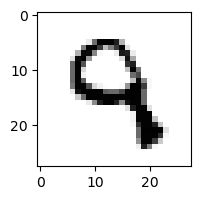

8.991386622543206e-06% - 0
1.9997888695578456e-05% - 1
1.7287632545667386% - 2
2.0584677859027627% - 3
46.862847617854726% - 4 - ОШИБКА
0.355679212407982% - 5
0.016947077774603053% - 6
2.3859236749752435e-05% - 7
4.1765502608619426e-11% - 8
0.022738429220989283% - 9

 3


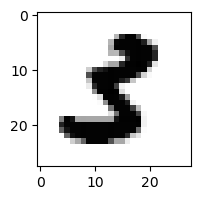

1.2858061101349188e-05% - 0
0.032457555167534693% - 1
4.595767204124152e-06% - 2
0.012265665286926065% - 3
5.328940153647262e-10% - 4
5.068457630866929% - 5 - ОШИБКА
1.0625168731751163e-09% - 6
3.4801510073642605e-08% - 7
3.3589686799923705e-10% - 8
1.9771364572330604e-18% - 9

 8


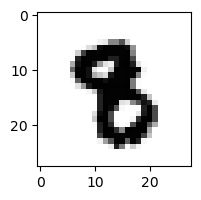

2.0247609218148964e-11% - 0
0.0003531761432497649% - 1
5.962615928355899e-09% - 2
7.4712201870089025e-06% - 3
6.109881514316413e-07% - 4
0.005951435051760827% - 5 - ОШИБКА
8.242165509802088e-06% - 6
8.687364549366605e-06% - 7
5.290392003791875e-11% - 8
3.329496063188854e-11% - 9

 4


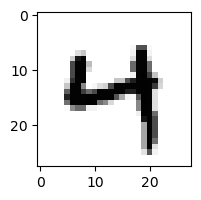

0.10621350418505955% - 0
6.894004022230478e-05% - 1
1.8926978539670298e-05% - 2
0.010064082982045522% - 3
97.88115525275332% - 4
0.00010351121748223103% - 5
0.08685209401595201% - 6
0.0012315248874803523% - 7
5.3416525765972705e-09% - 8
99.24402089832883% - 9 - ОШИБКА

 9


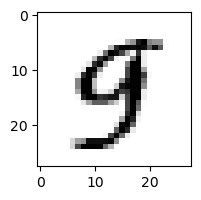

0.0028135586178351796% - 0
5.611898718072794e-05% - 1
2.0766847405264264e-06% - 2
0.004757260000117462% - 3
1.6155853299110803% - 4 - ОШИБКА
0.6626043046496176% - 5
0.000552205627600195% - 6
0.06598595467358309% - 7
8.43208753443725e-06% - 8
0.40937432640710225% - 9

 4


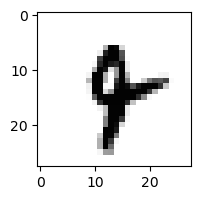

2.7280133785840405e-08% - 0
0.10785739210161226% - 1
3.3540235189519966e-05% - 2
1.6776848431900826e-07% - 3
0.517279067810285% - 4
0.001811682965883828% - 5
0.19324472958824923% - 6
0.20582448229163394% - 7
1.4129208063879646e-05% - 8
10.232626028283157% - 9 - ОШИБКА

 7


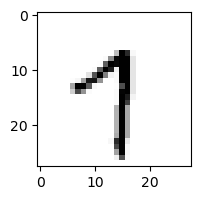

0.0009395116296670191% - 0
15.426898247727639% - 1
1.0994027080783423e-05% - 2
0.09590548663958919% - 3
8.810035211038574% - 4
0.5137201802037554% - 5
0.23443732923097982% - 6
86.03835451422216% - 7
0.0017511410692262078% - 8
98.11323942245053% - 9 - ОШИБКА

 5


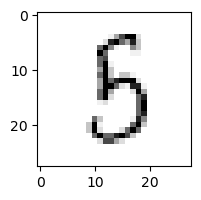

0.10428680827812206% - 0
0.20415610048889868% - 1
0.8719959150460082% - 2
94.94644163648677% - 3
1.2112690102728905% - 4
90.54940239856684% - 5
9.66447873151775% - 6
0.0015287068420513643% - 7
95.01712259228646% - 8 - ОШИБКА
8.581331093321716e-05% - 9

 0


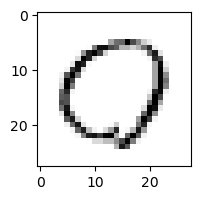

74.54619426026635% - 0
0.0002295848573106406% - 1
0.32015992183174097% - 2
0.598101548566774% - 3
0.0022011631156526493% - 4
3.187001321620009% - 5
0.013390175837024605% - 6
0.04784422556901033% - 7
97.12644158627097% - 8 - ОШИБКА
3.1214171674301633e-10% - 9

 5


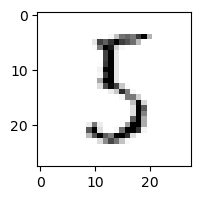

0.7507222006237686% - 0
0.7099552881196668% - 1
1.6619733480070862% - 2
97.31770427261561% - 3 - ОШИБКА
0.009238158495166337% - 4
76.65065765841234% - 5
5.7078881658560165% - 6
0.0028424200198021625% - 7
13.567047279987902% - 8
5.39046470215801e-06% - 9

 6


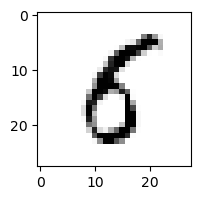

19.02016605802426% - 0
0.06353661806577532% - 1
0.002663197152055522% - 2
0.09120170174944381% - 3
0.014106608857767058% - 4
59.43121052319964% - 5 - ОШИБКА
26.86822443584499% - 6
6.606145154493796e-05% - 7
0.6393936306543397% - 8
0.04815578597024607% - 9

 0


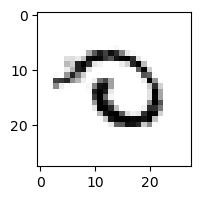

0.07261524894261719% - 0
0.000109368364529733% - 1
8.60607498498017% - 2
0.0008418956283642908% - 3
0.0028025722610734737% - 4
0.0788875375015566% - 5
37.57377190863253% - 6 - ОШИБКА
0.03954627720068985% - 7
0.017649399274999276% - 8
3.4605133455583608% - 9

 8


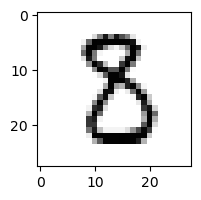

0.0037480810788504283% - 0
0.010691306617459729% - 1
1.5938367177841601% - 2
14.025610090011591% - 3 - ОШИБКА
1.128795742212379e-05% - 4
1.6521891479754531% - 5
8.754976685779305e-06% - 6
1.7139255818354974e-05% - 7
0.027614449623757222% - 8
9.928455475626446e-12% - 9

 4


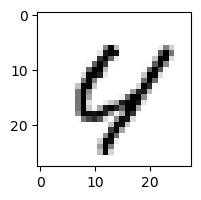

0.14975952745153145% - 0
2.9592806687721395e-07% - 1
0.004200585169349371% - 2
6.240465993428608e-12% - 3
28.115824415572003% - 4
0.014488090668161936% - 5
0.653745138829526% - 6
1.657186695414425% - 7
50.840735235499615% - 8 - ОШИБКА
0.16963809456616583% - 9

 5


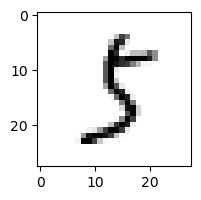

1.2349151448660973% - 0
1.1480136406829111% - 1
0.23932342582365743% - 2
94.66572421177337% - 3 - ОШИБКА
0.0004261992058242237% - 4
10.230836738197938% - 5
0.0005025582201966473% - 6
0.1389464781890654% - 7
0.7306554298796615% - 8
0.012232669417209296% - 9

 8


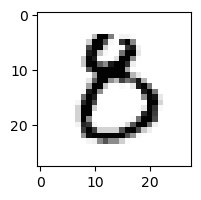

2.009496927801081% - 0
4.1178547332123495e-06% - 1
0.03577131003162368% - 2
0.14752915859200966% - 3
1.0874260984249121e-05% - 4
14.149123428997987% - 5 - ОШИБКА
0.005471965746369964% - 6
0.0008916288464849252% - 7
4.5829435207020255e-08% - 8
5.870657736810407e-10% - 9

 5


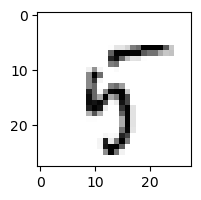

0.0204655272334866% - 0
0.07366707572587099% - 1
0.040093037455379475% - 2
0.0003513839689880623% - 3
3.5995629438366294% - 4
5.810753159247867% - 5
0.5039913118701266% - 6
0.004741361060371813% - 7
53.63504353305216% - 8
94.57818936655116% - 9 - ОШИБКА

 9


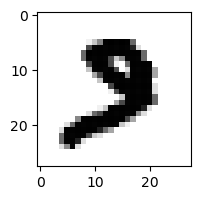

2.490774690630996e-06% - 0
2.2695618197854633e-06% - 1
0.006639948149023173% - 2
0.00013968854601094258% - 3
7.557439669167687e-11% - 4
1.8524797109256345e-05% - 5
2.1481075000210802e-08% - 6
0.5588146136036708% - 7 - ОШИБКА
4.8091093740426284e-12% - 8
1.8512283749954924e-12% - 9

 0


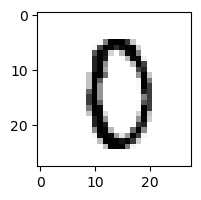

77.9531846417497% - 0
3.825629359671847e-06% - 1
0.12450904886569555% - 2
0.0008907074821452538% - 3
0.0010407519639222178% - 4
11.312138512787314% - 5
0.15710430383503643% - 6
0.008786981074835727% - 7
89.62524809553771% - 8 - ОШИБКА
5.9709765482477414e-05% - 9

 8


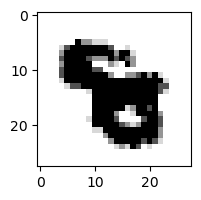

1.6485382082199823e-13% - 0
1.0987462420687041e-10% - 1
9.62787495938748e-11% - 2
1.0546200340438002e-13% - 3
0.00010484809146438325% - 4
1.300734636631238e-07% - 5
0.07859418616557323% - 6 - ОШИБКА
8.346889894310438e-08% - 7
5.611723933175628e-14% - 8
1.8953765356759258e-12% - 9

 8


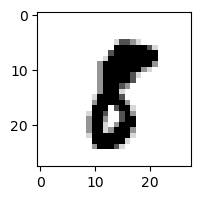

6.0475360826198536e-05% - 0
0.6637962621063657% - 1 - ОШИБКА
1.1533011274958675e-05% - 2
0.00017487386599852916% - 3
2.3128401701219457e-08% - 4
0.01437374282887704% - 5
1.105108231278424e-08% - 6
7.870845075979774e-05% - 7
0.12748371560282168% - 8
8.044478742763227e-09% - 9

 9


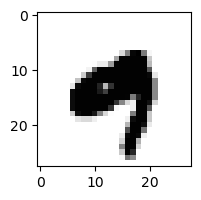

8.647239619299974e-07% - 0
0.00024127468292463346% - 1
8.377998555789553e-12% - 2
3.94455884321582e-08% - 3
7.752809840972599% - 4 - ОШИБКА
2.53693741556955e-09% - 5
0.000285193367183501% - 6
2.4095464808262008e-05% - 7
3.1892999708439067e-14% - 8
0.01422496575765361% - 9

 9


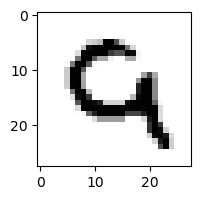

0.025500852997472984% - 0
8.075920737710382e-08% - 1
64.58625478092326% - 2 - ОШИБКА
6.908097882157627e-10% - 3
0.20975675181637443% - 4
4.15439425679792e-05% - 5
0.6872759050416963% - 6
0.00901070820563406% - 7
2.8235314212779266e-10% - 8
0.04023409038825292% - 9

 8


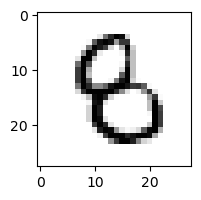

0.004146271339660802% - 0
0.0004378497263754807% - 1
0.07437921476008538% - 2
0.07144775343751646% - 3
0.011437339154616123% - 4
4.528979082043182% - 5 - ОШИБКА
1.42353551720256% - 6
2.4857332870810923e-07% - 7
0.0002825671534332182% - 8
7.443927433980572e-07% - 9

 8


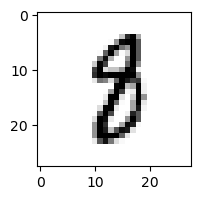

0.0002616221723537875% - 0
0.43660316030045565% - 1 - ОШИБКА
0.0023468827117599706% - 2
0.003697995390337457% - 3
3.38774961671921e-05% - 4
0.14382289494786146% - 5
0.008999689860488509% - 6
0.014029819430041003% - 7
0.0023611372139047252% - 8
1.0338896654091223e-07% - 9

 5


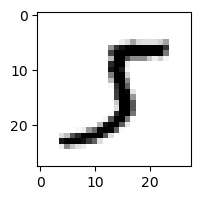

0.004561910029379774% - 0
30.264927067958002% - 1 - ОШИБКА
0.049882487214396615% - 2
17.707384546142283% - 3
0.00013855396678356488% - 4
3.8467337958206524% - 5
2.728781925867666e-05% - 6
0.8097517236016181% - 7
5.7229084898107184e-08% - 8
0.0008511215647034755% - 9

 8


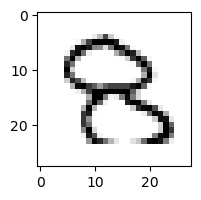

0.037495428572059356% - 0
5.104034848304168e-06% - 1
56.570495368010434% - 2 - ОШИБКА
11.191890221154397% - 3
0.016039017344183715% - 4
0.006121045435693167% - 5
0.0008359403666062086% - 6
4.784341431149805e-05% - 7
3.811183580487091e-05% - 8
0.16107272694569974% - 9

 8


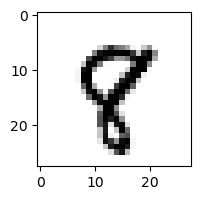

6.333522221909849e-06% - 0
0.012621397165162935% - 1
0.00022099511152862562% - 2
7.448071454902107e-07% - 3
0.0017960752282381053% - 4
0.09569691188632246% - 5
2.4426691617514384e-05% - 6
0.1989887629724216% - 7
0.009874583175994468% - 8
1.0625024125015798% - 9 - ОШИБКА

 8


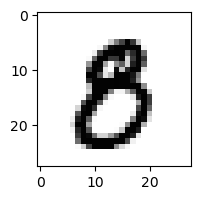

0.1929643870496742% - 0
1.804944526011376e-06% - 1
3.4314046738732166e-06% - 2
0.0347786559358518% - 3
3.2998265298821225e-07% - 4
0.5522415948611563% - 5 - ОШИБКА
2.8587823509235377e-07% - 6
2.232176298244491e-06% - 7
1.01205242298658e-06% - 8
4.5445235063396525e-08% - 9

 5


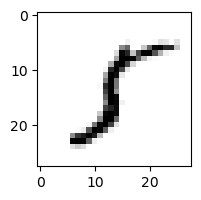

0.050427373334451964% - 0
97.98262995416391% - 1 - ОШИБКА
0.9122580472048327% - 2
0.19498910155942378% - 3
0.0003216082073272792% - 4
62.408066491756166% - 5
0.013557056013351632% - 6
0.07007861262612097% - 7
0.001352116308618817% - 8
0.0015767950440392835% - 9

 9


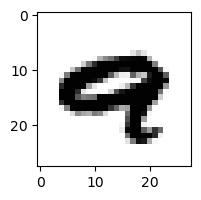

8.397804561522313e-05% - 0
3.0108248133559e-08% - 1
2.9746869007932716e-11% - 2
3.858817628307205e-14% - 3
10.6250399586863% - 4 - ОШИБКА
1.6195553900371558e-11% - 5
2.9102381481321772e-05% - 6
0.05284499114321824% - 7
8.331459924767428e-14% - 8
7.243867739883069e-05% - 9

 8


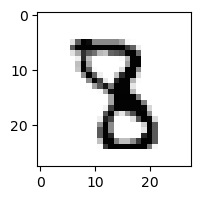

1.9748029579510487e-10% - 0
0.0001017794175768038% - 1
0.0005079967879674034% - 2
0.006592204282627741% - 3
0.019601663578239198% - 4 - ОШИБКА
0.004478458944366963% - 5
3.031455852955894e-07% - 6
0.0033068479181519016% - 7
1.3175408552494067e-07% - 8
2.2300439025597575e-07% - 9

 9


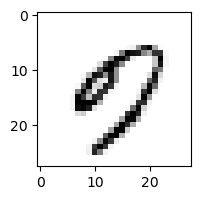

77.80207865161844% - 0 - ОШИБКА
5.136776401722925e-05% - 1
1.2064603128671145e-05% - 2
0.0020409888752025125% - 3
1.4249458363043352% - 4
1.6963626512475072% - 5
2.3682077736050253% - 6
0.0203188166227872% - 7
0.0025887353068068182% - 8
8.96445382521865% - 9

 2


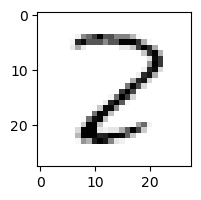

0.27864790529630123% - 0
0.09354332119500863% - 1
95.32700074447872% - 2
0.015030986685552408% - 3
0.015684353878148854% - 4
0.013814432885790652% - 5
0.007007711468134348% - 6
0.005104102531644842% - 7
99.9917875235202% - 8 - ОШИБКА
9.165673105149843e-10% - 9

 2


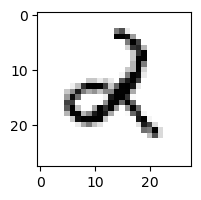

0.000348442791051199% - 0
0.07116742784653646% - 1
1.7956595069486534% - 2
0.00025012282639050315% - 3
20.269264258028453% - 4 - ОШИБКА
0.00043776790173362796% - 5
0.5825002330046652% - 6
3.342780566541935e-05% - 7
0.004413649805141088% - 8
0.002212898132296777% - 9

 2


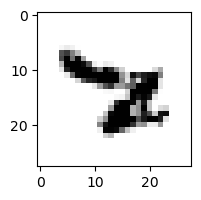

2.840855905327733e-07% - 0
2.9903644355473192e-05% - 1
1.0839819229246377e-07% - 2
2.0035713667869316e-07% - 3
0.015694529936124423% - 4
0.001269172391555266% - 5
41.716481738470094% - 6 - ОШИБКА
0.43494751572630275% - 7
1.5448935844104042e-07% - 8
8.289901111466986e-07% - 9

 5


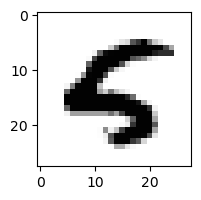

0.00023761535071504782% - 0
3.9174922927999654e-07% - 1
3.637020033940247e-05% - 2
1.5153653092962577e-14% - 3
1.957754471149372% - 4 - ОШИБКА
0.05458439937381787% - 5
3.00527695180076e-05% - 6
4.101141329051644e-08% - 7
1.3081550770429864e-12% - 8
6.023345629463848e-07% - 9

 1


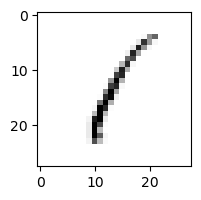

8.962490980087091% - 0
97.00987395606076% - 1
55.05963057645453% - 2
31.772035611081996% - 3
0.6942875450803335% - 4
28.299285236061138% - 5
38.70597561156823% - 6
0.07179226419464202% - 7
99.4089781095243% - 8 - ОШИБКА
20.57027950767641% - 9

 7


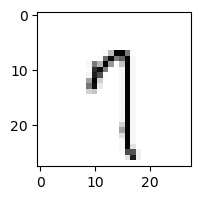

0.8158746067309571% - 0
2.666923854746149% - 1
0.4380531912144537% - 2
5.631311859659614% - 3
19.736246679898958% - 4
16.99686860233755% - 5
8.24106042551824% - 6
74.080506314625% - 7
6.07394630043175% - 8
99.98580725349775% - 9 - ОШИБКА

 1


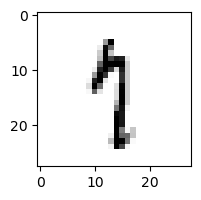

0.003426270835327952% - 0
7.3509144009633935% - 1
0.014422470055273936% - 2
0.08461331256898837% - 3
6.598769158410146% - 4
8.389358331193582% - 5
0.17276908594298454% - 6
41.5953019094291% - 7 - ОШИБКА
0.2431977791599668% - 8
4.249024718709746% - 9

 2


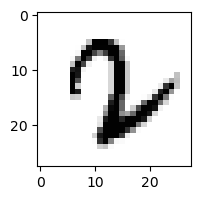

1.7368549469906098e-07% - 0
0.03616820001104779% - 1
0.0004885622017356843% - 2
0.002009568888840006% - 3
3.690998529104852e-07% - 4
0.0007377754391601045% - 5
0.22814545751604856% - 6 - ОШИБКА
0.017593893297386462% - 7
2.1540791317647516e-13% - 8
2.343832574298306e-12% - 9

 8


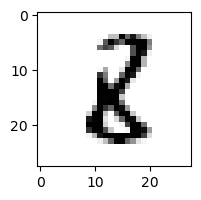

1.3950693106139975e-05% - 0
2.729103646389621% - 1 - ОШИБКА
1.1928646431413588% - 2
0.000643032367184852% - 3
0.01673660360048669% - 4
0.14060923835869876% - 5
0.005359223871772851% - 6
1.0446051018724896e-07% - 7
1.2356402090109104% - 8
2.004042323217198e-11% - 9

 6


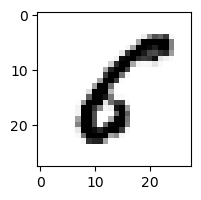

1.518616982831517% - 0
0.20441259721460983% - 1
0.10536955717413196% - 2
1.0462688326129846e-05% - 3
0.00880850769408375% - 4
84.73412797405084% - 5 - ОШИБКА
0.010168898704497819% - 6
4.47423630637344e-05% - 7
8.667736826728388e-05% - 8
3.861860539733567e-09% - 9

 1


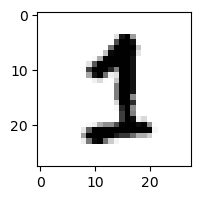

4.3973255647214485e-05% - 0
0.011970676382082457% - 1
0.04230010311120637% - 2
0.1034317141895562% - 3
5.712237391451492e-07% - 4
0.1433155307905701% - 5 - ОШИБКА
4.0551271248343e-05% - 6
0.05273182042894016% - 7
2.7148576342269446e-06% - 8
4.5245575167231367e-07% - 9

 9


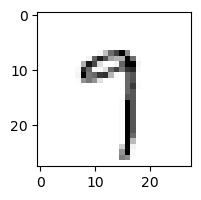

0.177548465807376% - 0
0.3651851946355568% - 1
0.025509618860235287% - 2
9.889322107938806% - 3
0.8092957305757438% - 4
7.565399161502887% - 5
0.38440122736954985% - 6
97.96675400674607% - 7 - ОШИБКА
0.7322517503493009% - 8
89.86642084854819% - 9

 7


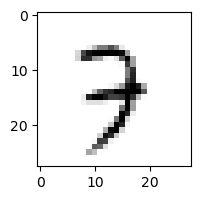

0.00035336163316579373% - 0
0.0032761315294621935% - 1
12.852056385562141% - 2
64.72154427695472% - 3 - ОШИБКА
2.6419706924196333% - 4
0.5140269541386884% - 5
0.26310757743151625% - 6
4.232840469574351% - 7
0.2404974106012099% - 8
54.39625031683671% - 9

 6


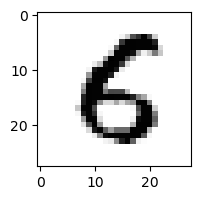

1.0440465725501737% - 0
0.00015866305666693137% - 1
0.0036163495225247184% - 2
7.441925820486251e-06% - 3
0.002508323221280369% - 4
16.675516716533632% - 5 - ОШИБКА
12.37013069370551% - 6
4.2496851983570247e-08% - 7
1.4302542831261575e-08% - 8
6.873953236885444e-09% - 9

 8


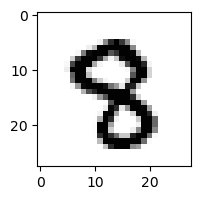

3.795829153438359e-07% - 0
2.790033066650988e-07% - 1
3.0341747302871464e-06% - 2
5.105197350433533e-05% - 3
0.003178930417199431% - 4
0.036381112144479616% - 5 - ОШИБКА
2.2856894238780944e-07% - 6
0.0002309858524664203% - 7
2.054127476032868e-06% - 8
3.51684348727205e-08% - 9

 2


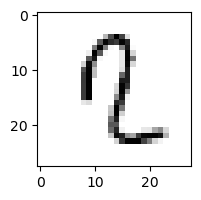

0.00035278061209447707% - 0
2.460121024976636% - 1
4.151626459462049% - 2
0.0151440050732689% - 3
54.732858279087836% - 4 - ОШИБКА
11.70119725783687% - 5
0.032859980427866704% - 6
0.04762754689839218% - 7
0.00035920227140836587% - 8
0.005461126152505531% - 9

 3


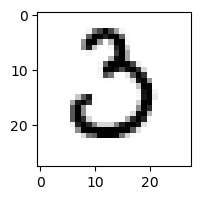

20.805994103457152% - 0
0.00013050411787320966% - 1
92.55281707823674% - 2 - ОШИБКА
51.877218032411434% - 3
1.709775839065723e-08% - 4
0.0037003233020423544% - 5
0.033905419151192856% - 6
0.01315947200414485% - 7
9.774591400221545e-11% - 8
4.359065053276595e-09% - 9

 4


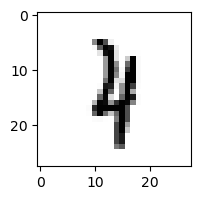

5.865121191264728e-07% - 0
24.732689917113827% - 1 - ОШИБКА
2.2704568826197056% - 2
0.006935387439993294% - 3
1.6287720879405416% - 4
0.0012467847508186554% - 5
0.14579610172805105% - 6
0.0921257379686562% - 7
6.0359910262592% - 8
0.98663680131957% - 9

 5


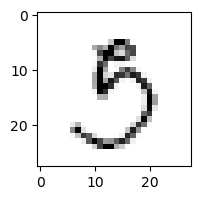

10.936201482151935% - 0
0.031494691806053604% - 1
0.018056159230421327% - 2
97.9260612283477% - 3 - ОШИБКА
0.001988785802286826% - 4
58.373696627879966% - 5
0.008944536819224757% - 6
0.009318153113582313% - 7
26.467705426781666% - 8
0.10182328030452369% - 9

 9


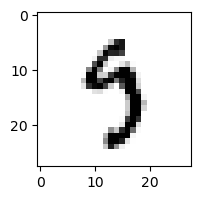

0.00038124138658788805% - 0
0.004978719981202623% - 1
1.54929013209539e-06% - 2
17.60803466177297% - 3 - ОШИБКА
0.8467077255363338% - 4
6.632511579011349% - 5
0.05876586170696248% - 6
0.7190799691791028% - 7
0.006343019020082977% - 8
0.013302959922578909% - 9

 0


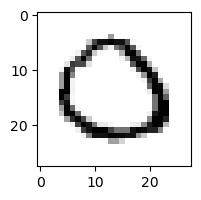

91.70255053830483% - 0
2.811584454942715e-07% - 1
94.42613698907269% - 2 - ОШИБКА
19.87159347749781% - 3
4.200134249204668e-07% - 4
0.01887230637908094% - 5
0.00034264090976114474% - 6
0.0007259448268301825% - 7
0.0019367725100077058% - 8
7.936339894915441e-12% - 9

 9


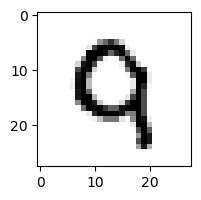

0.061144351375294004% - 0
1.2600097920895917e-06% - 1
11.621043434203564% - 2 - ОШИБКА
1.3546503298456733e-08% - 3
0.5818966393449937% - 4
2.3825120194517194e-05% - 5
0.03556916778722253% - 6
0.07704739156297456% - 7
1.3249343177747717e-08% - 8
5.136341622263017% - 9

 2


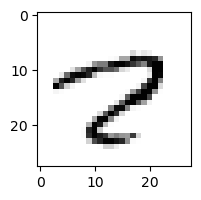

3.717149948577085% - 0
0.00017269546927146614% - 1
8.516973706437034e-05% - 2
5.799073607681318e-08% - 3
0.4384727006054825% - 4
0.49531944194670496% - 5
1.8250730247362047e-05% - 6
98.81413219041717% - 7 - ОШИБКА
2.974938709947566% - 8
0.00021146478636894549% - 9

 8


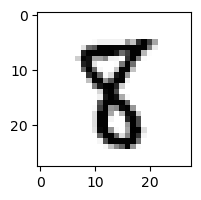

8.027803990883412e-07% - 0
0.010390310099614296% - 1
0.00015528979490123893% - 2
3.642454065401092e-05% - 3
5.631629454096553e-05% - 4
2.477866710073072% - 5 - ОШИБКА
9.415609358275054e-05% - 6
1.4768607950067536e-05% - 7
0.5256055031717124% - 8
3.746680886400993e-08% - 9

 9


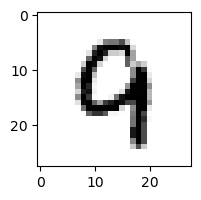

0.000574278033110506% - 0
9.236505957879984e-06% - 1
0.35719172640410435% - 2
6.227878758441383e-07% - 3
51.18738140300593% - 4 - ОШИБКА
5.638920479803853e-05% - 5
0.060991674501837366% - 6
0.020566958475554547% - 7
5.716451344613715e-05% - 8
0.863495559807908% - 9

 7


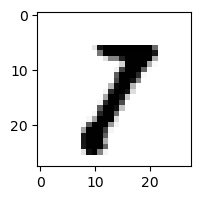

0.0003707585682639004% - 0
25.74802347443386% - 1 - ОШИБКА
0.03084002143282344% - 2
0.37237318205297104% - 3
7.402374770088538e-07% - 4
0.004525015999739619% - 5
5.09129365339692e-08% - 6
0.41646188189896916% - 7
4.101506281661617e-05% - 8
0.006650263850846588% - 9

 5


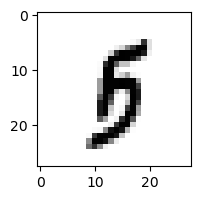

0.00010315807310443268% - 0
0.039807439863055724% - 1
0.00041157083267081976% - 2
0.31991634133281205% - 3
0.006882662046694412% - 4
0.6083242445993395% - 5
0.0913792779333831% - 6
0.0004107260430351187% - 7
3.5048807935601016% - 8
3.5119840783248555% - 9 - ОШИБКА

 9


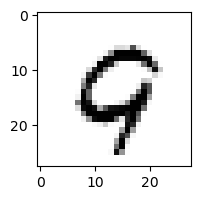

0.6319025774589865% - 0
2.267479565150521e-06% - 1
0.07959685298868369% - 2
2.831744686951209e-10% - 3
0.1808206335088333% - 4
0.009250433119502958% - 5
0.29777839715589977% - 6
7.756060675853268% - 7 - ОШИБКА
2.295502570405042e-06% - 8
2.6378903198837875% - 9

 5


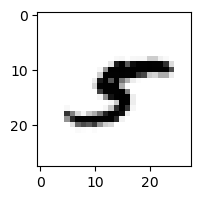

0.0001793353932517816% - 0
24.8373948887884% - 1 - ОШИБКА
0.00514604252143087% - 2
0.005003529449388566% - 3
0.008400349563996956% - 4
0.004277383788835201% - 5
7.260187780820184e-05% - 6
0.1179798170841225% - 7
1.9075766702827524% - 8
1.1434154217428405e-05% - 9

 3


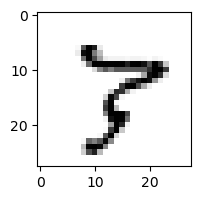

0.0002490707772842256% - 0
0.0015917509290201753% - 1
0.3327488646845362% - 2
0.0007104199734924631% - 3
0.00209309165469672% - 4
0.00030412309141789225% - 5
0.00012516424106961762% - 6
98.23512796424554% - 7 - ОШИБКА
66.97365217434286% - 8
0.0007591723032454883% - 9

 4


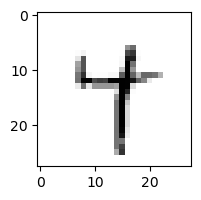

0.00023187356221500584% - 0
9.418665970057267% - 1
1.5291091358934676e-05% - 2
1.5255446607958936% - 3
73.26123068468563% - 4
0.07077245095008348% - 5
1.4102791690533543% - 6
7.349116668577055% - 7
4.105451474312275% - 8
91.47087377081566% - 9 - ОШИБКА

 5


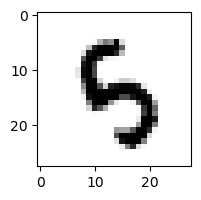

1.6472020485736428e-06% - 0
0.00025974692836191907% - 1
0.006002514099814043% - 2
0.020705725672134644% - 3
54.722411556513315% - 4 - ОШИБКА
9.502265593658578% - 5
1.1878856452824296% - 6
7.346034047798879e-06% - 7
2.733957257105971e-05% - 8
0.01058288870929766% - 9

 3


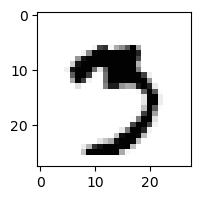

5.392072970000884e-05% - 0
0.00017478621562768852% - 1
2.6971637896461732e-08% - 2
0.41407661022314546% - 3
1.00333687349029e-09% - 4
0.4252759382427697% - 5
8.232540556854141e-07% - 6
83.9337989367593% - 7 - ОШИБКА
2.4263908620591464e-07% - 8
0.004182703655096699% - 9

 5


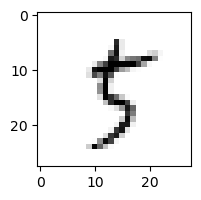

0.1292556613953685% - 0
0.531752307595625% - 1
0.11359207528214535% - 2
3.007126416970165% - 3
0.12264640842449262% - 4
36.56104593758016% - 5
0.0066713379365056944% - 6
4.480077916278482% - 7
90.82285345359999% - 8 - ОШИБКА
0.5267168658200929% - 9

 9


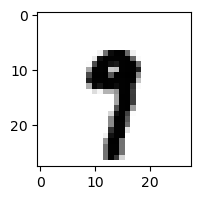

1.8673206572404726e-08% - 0
0.059611388914128684% - 1
1.0036799623101353e-08% - 2
7.862985780981052e-05% - 3
0.0019189149439117668% - 4
0.028943919629980185% - 5
3.600023728907376e-05% - 6
7.440121297339444% - 7 - ОШИБКА
5.275057547389216e-06% - 8
0.15013267084481904% - 9

 5


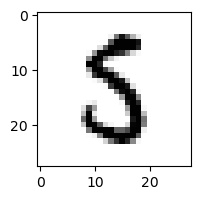

0.021772208965181068% - 0
0.0034913366507208707% - 1
0.17546924623254873% - 2
0.18286125298923% - 3
5.1366851852756044e-06% - 4
42.69883739158287% - 5
0.2331603104062969% - 6
0.00011860092994799828% - 7
45.73894585160268% - 8 - ОШИБКА
2.1329821095853847e-08% - 9

 2


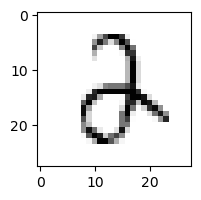

0.2601231423642217% - 0
0.0017230676758843298% - 1
75.20582505292798% - 2
83.28215272679267% - 3 - ОШИБКА
0.4496788321370196% - 4
0.04594300557458121% - 5
0.13671865996767749% - 6
0.0012070322556158343% - 7
0.0002139115575871433% - 8
2.745779318342233e-05% - 9

 5


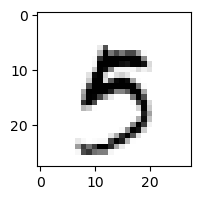

0.0021595844642811643% - 0
0.0003209822111640843% - 1
6.385275755432783e-07% - 2
3.343033370502784% - 3
0.20593777123207538% - 4
4.648431139918277% - 5
0.0008632919386463986% - 6
0.006905045812836773% - 7
3.7628381921480615e-08% - 8
25.9200308028285% - 9 - ОШИБКА

 5


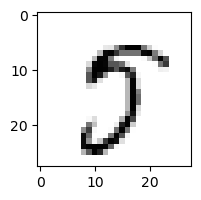

1.8684026534102047% - 0
0.00044787643811294153% - 1
0.00034751712914749764% - 2
0.6513574863838181% - 3
0.0003920887755354582% - 4
82.45411448661132% - 5
8.521389205828135e-05% - 6
96.99353080830991% - 7 - ОШИБКА
0.09845210388508337% - 8
0.05340585242696929% - 9

 5


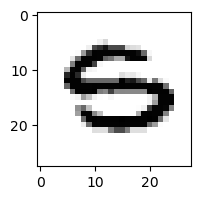

0.07427572803353723% - 0
3.202785800299425e-08% - 1
1.7363655644456787e-06% - 2
9.400534183530326e-05% - 3
6.561039903322808e-07% - 4
0.15527619236601123% - 5
86.20176957260752% - 6 - ОШИБКА
3.460858613105021e-06% - 7
1.4493681533613735e-11% - 8
2.8115602802521475e-05% - 9

 8


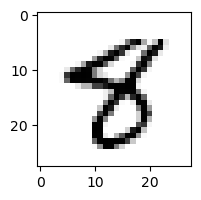

2.0162244669052333e-05% - 0
0.0023979459864783433% - 1
2.2826297536614974e-08% - 2
1.319640243813449e-07% - 3
0.04354155729909065% - 4
15.995675653761701% - 5 - ОШИБКА
7.44144036791048e-06% - 6
0.000627921180960841% - 7
0.07378546458629824% - 8
1.4831493612282828e-06% - 9

 8


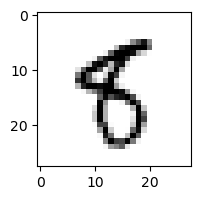

0.0021074795904775165% - 0
0.0065033781105967815% - 1
3.4071591924691784e-05% - 2
0.00023549665768995474% - 3
0.0001745807872068281% - 4
53.75491502902769% - 5 - ОШИБКА
0.9612976531025842% - 6
6.883848781826372e-05% - 7
3.247605712154015% - 8
2.062629264473904% - 9

 4


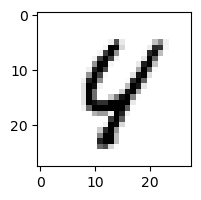

0.0017284637630621414% - 0
0.0002566130475375399% - 1
0.01857163611613062% - 2
7.26792173053384e-09% - 3
58.81384368937839% - 4
0.029174087045027504% - 5
0.011636496610403193% - 6
0.32329659688358453% - 7
65.74049880128449% - 8 - ОШИБКА
1.7751001397223223% - 9

 9


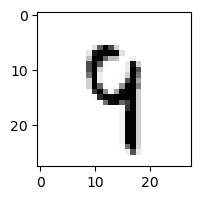

1.4836279566442338e-05% - 0
0.04825334671116335% - 1
0.2834662572061885% - 2
2.2876421785755467% - 3
42.32312352888356% - 4 - ОШИБКА
0.29036625495279417% - 5
0.14336953440272693% - 6
1.8376064800796363% - 7
2.110595312480288% - 8
19.10470109642905% - 9

 9


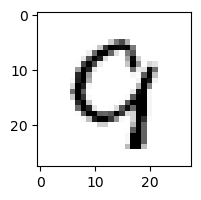

6.845577529489686% - 0 - ОШИБКА
4.491533291859132e-06% - 1
1.9550755411702463% - 2
1.640793519422306e-07% - 3
1.7455658027240017% - 4
0.0003009478931725862% - 5
0.4672742358792329% - 6
0.45020971751830713% - 7
8.272435995808826e-05% - 8
0.17286308641693526% - 9

 9


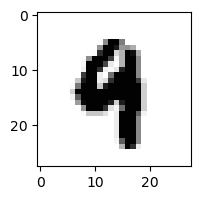

2.286222744371068e-08% - 0
0.00042312702857307406% - 1
6.350998375431559e-07% - 2
7.844745603491565e-08% - 3
1.367707806409825% - 4 - ОШИБКА
0.00011294468474855984% - 5
7.679918890290965e-05% - 6
6.278103235054477e-06% - 7
1.19384388226442e-10% - 8
0.01201183199331899% - 9

 2


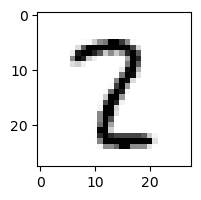

1.0114843896715854e-05% - 0
0.6486892655593743% - 1
1.4619236686719213% - 2
0.15463602237756918% - 3
0.0030691892676079167% - 4
0.02184197479795269% - 5
4.131296372398604e-06% - 6
0.041249227031257475% - 7
2.5216472671991634% - 8 - ОШИБКА
1.8673518717110166e-07% - 9

 7


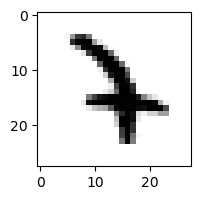

5.876156709643166e-10% - 0
0.17712648897127764% - 1
0.5402152405047808% - 2
0.6264573843788984% - 3 - ОШИБКА
0.4416668541739498% - 4
0.0004391122457702487% - 5
0.007599881827473709% - 6
0.6028721392192654% - 7
2.5501187820268633e-10% - 8
3.4040701780976984e-08% - 9

 8


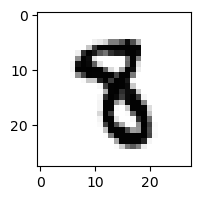

2.014567588028269e-10% - 0
0.004037147235482945% - 1
9.008519192662428e-06% - 2
0.00010730101529539874% - 3
0.00022270542812901164% - 4
0.40989794438911975% - 5 - ОШИБКА
2.2629123794788744e-05% - 6
9.470352476926819e-05% - 7
9.816682170436117e-07% - 8
5.931537823288082e-10% - 9

 3


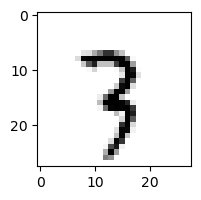

5.614187130998861e-07% - 0
4.6652888197164595% - 1
4.4708794120218815% - 2
0.24037750140682473% - 3
0.49899836049874013% - 4
0.02896445029318175% - 5
0.005591356978489192% - 6
75.18278637491261% - 7 - ОШИБКА
0.25219787304377733% - 8
1.321480520272033% - 9

 6


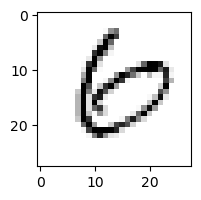

59.328828444283424% - 0 - ОШИБКА
0.0005138394221694667% - 1
0.26615168203820994% - 2
0.04674971192232549% - 3
0.004647342553548732% - 4
0.023054109707925066% - 5
5.81723231372108% - 6
0.002643195874068087% - 7
0.17009510563296476% - 8
0.00010363930964030355% - 9

 2


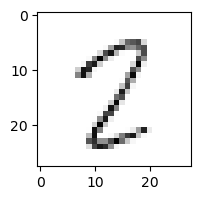

2.6123482763487647% - 0
1.1837221014821688% - 1
9.655628395419887% - 2
0.237112169122255% - 3
0.16015392648135368% - 4
39.839637997766935% - 5
0.020309857037811446% - 6
17.67225100380657% - 7
99.81974476911186% - 8 - ОШИБКА
0.02733419461286818% - 9

 9


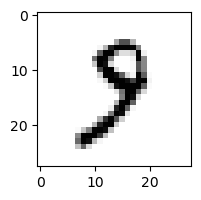

0.0023192165189836727% - 0
1.3969950005950655% - 1
0.08463606249978643% - 2
0.7089690896364408% - 3
0.0009336378067276306% - 4
0.7561788892116139% - 5
0.0009258624987892987% - 6
1.6632503266366931% - 7 - ОШИБКА
0.015558303467342447% - 8
0.0197827599454868% - 9

 8


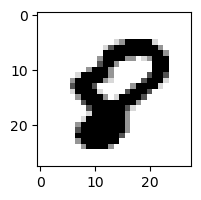

0.2638443245277961% - 0 - ОШИБКА
7.554624763265657e-09% - 1
1.2137878403568528e-08% - 2
2.337008122442934e-18% - 3
5.110796894394188e-06% - 4
0.00882025643598818% - 5
4.049301510812431e-05% - 6
2.456614072160413e-06% - 7
3.055547930757609e-05% - 8
1.7309058984049998e-09% - 9

 5


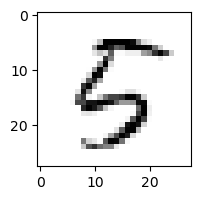

0.4264027979500412% - 0
0.0016468716648873239% - 1
0.12417686145669733% - 2
0.0015608994029798003% - 3
35.10342019008117% - 4 - ОШИБКА
2.7852060477446696% - 5
0.4326355133495329% - 6
0.00040876892998396495% - 7
0.25697045385936723% - 8
8.984433286360375e-07% - 9

 0


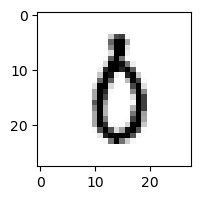

0.5071683607068145% - 0
0.02156383963507255% - 1
0.06392960294392398% - 2
2.774188040556793% - 3
0.00047272460148297296% - 4
0.2710649214926507% - 5
16.642536649983064% - 6 - ОШИБКА
0.00817188436016702% - 7
0.0230368045882687% - 8
0.00021021868268520098% - 9

 8


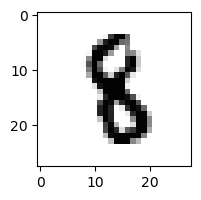

2.6454235432476742e-09% - 0
0.03856127480391185% - 1
0.0010899683777509143% - 2
0.0017863527883000734% - 3
0.0008313932103479347% - 4
0.23990351119202738% - 5 - ОШИБКА
0.0012681543553743823% - 6
4.897848739431553e-06% - 7
9.912539044323727e-05% - 8
1.3236762108155915e-10% - 9

 9


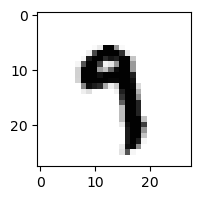

6.27252619035021e-07% - 0
0.0012610664856100538% - 1
4.779131274892036e-08% - 2
0.025967299180620244% - 3
0.01587349644965693% - 4
0.7157045279089568% - 5
0.0001702363752072177% - 6
5.879004796362031% - 7 - ОШИБКА
7.572829593988839e-07% - 8
0.6056770587236587% - 9

 7


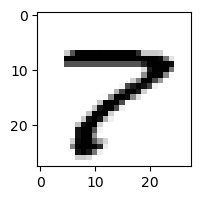

0.008744481176295638% - 0
4.680122609931951e-06% - 1
0.23491215660564235% - 2
1.6831707132912892e-05% - 3
5.553971774309796e-08% - 4
0.0001732408443587406% - 5
1.6995791877231004e-08% - 6
94.09420221228612% - 7
95.87068015386356% - 8 - ОШИБКА
6.558417270846572e-05% - 9

 9


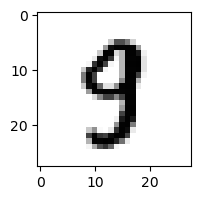

0.0003531089814718258% - 0
0.0003594813476827432% - 1
5.882291700428643e-05% - 2
0.12744485417893547% - 3
0.07048234941615561% - 4
0.3939104391856424% - 5 - ОШИБКА
2.555470052267538e-06% - 6
0.03100407402924089% - 7
0.008282326876332183% - 8
0.03191110373102902% - 9

 8


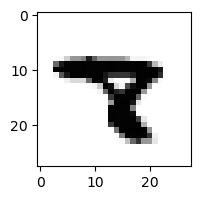

6.820313933329364e-10% - 0
0.000781101747788113% - 1
5.034943898985032e-07% - 2
1.3430213046301985e-09% - 3
0.006494650618349835% - 4
5.582276416074588e-06% - 5
2.132119799409275e-06% - 6
24.699610282358243% - 7 - ОШИБКА
6.210670477005467e-07% - 8
4.7307214252437616e-07% - 9

 7


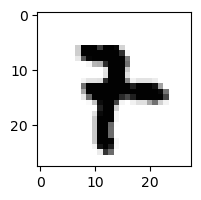

1.1664980919743906e-07% - 0
0.00026382637356600624% - 1
1.0103980972466774e-05% - 2
0.00015527300305200457% - 3
0.0009379136172109429% - 4
0.00713379680531676% - 5
0.09374341924575755% - 6 - ОШИБКА
0.0027919938717655105% - 7
2.1534235671332345e-08% - 8
0.0003899693185862983% - 9

 9


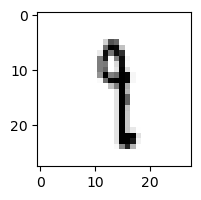

0.0008744613029433444% - 0
84.84835029609926% - 1 - ОШИБКА
0.09049348157521094% - 2
46.250230952537066% - 3
0.27883820081687877% - 4
3.199506719960695% - 5
0.07460075726990917% - 6
7.237151758747255% - 7
26.91782376024457% - 8
30.69505290115362% - 9

 9


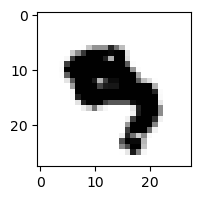

4.0204830451328054e-11% - 0
1.5337331753826698e-07% - 1
8.506961596494655e-12% - 2
5.35955034591283e-07% - 3
0.0007399752334750321% - 4
0.019229404087443475% - 5 - ОШИБКА
7.813485652195825e-05% - 6
0.00017499703255022307% - 7
1.1716966036847015e-16% - 8
3.7701039598545624e-05% - 9

 9


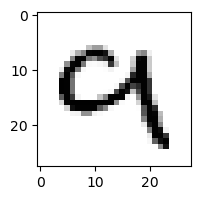

0.0017211628172686738% - 0
8.864748450841685e-05% - 1
3.3701892158120574% - 2
0.0013965527086053238% - 3
3.6930537141342756% - 4 - ОШИБКА
6.783006820884478e-06% - 5
0.003230241942093621% - 6
1.2285764206880365% - 7
0.00014956764262771656% - 8
0.12989225522188366% - 9

 8


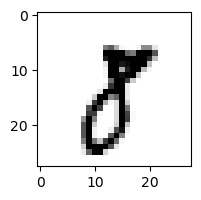

0.0018404049056559553% - 0
1.3742732983579913% - 1
0.0013967314362500931% - 2
3.1037240899468532% - 3 - ОШИБКА
3.0994369902624886e-08% - 4
0.007628081875970564% - 5
7.509926994424664e-08% - 6
0.13099942310137802% - 7
0.002471803694149467% - 8
0.0507057712588526% - 9

 9


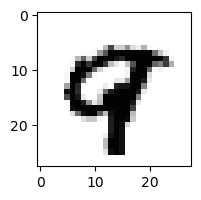

7.81937187863592e-07% - 0
1.000886277459021e-06% - 1
5.6526479585327765e-06% - 2
2.401458958366725e-15% - 3
0.0029023527958599448% - 4
4.557503770857939e-06% - 5
2.2109420426586334e-08% - 6
0.212593238504768% - 7 - ОШИБКА
0.0027616215187010306% - 8
0.009912753838652389% - 9

 7


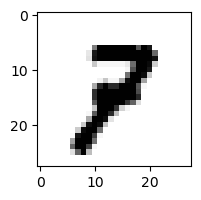

0.0003373530592236619% - 0
0.004224261298340583% - 1
0.8471678551525761% - 2
0.03669198327049613% - 3
6.34421179579326e-05% - 4
0.0005136120900810479% - 5
8.171449800086643e-07% - 6
0.042747913161724216% - 7
0.008378660491727379% - 8
7.326113672442506% - 9 - ОШИБКА

 8


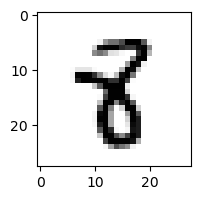

3.634152484331698e-07% - 0
0.13090597592779132% - 1
7.82727452392149e-07% - 2
0.00020601718555221272% - 3
0.03008499546392398% - 4
1.8062779983275106% - 5 - ОШИБКА
0.00017707986948686748% - 6
1.7979414316110943e-06% - 7
0.4976944700055882% - 8
1.4253747641040517e-08% - 9

 5


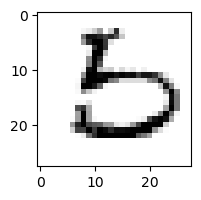

0.16337258752184808% - 0
3.1853572109874088e-06% - 1
0.0959452900076534% - 2
0.002264675492332113% - 3
5.17770867270904e-06% - 4
0.16300208595468538% - 5
0.9254038907402096% - 6 - ОШИБКА
2.5893382597530562e-05% - 7
0.012085456590056961% - 8
5.3859774072396275e-09% - 9

 3


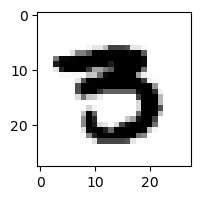

0.000923764205257493% - 0
3.3084113401978775e-08% - 1
2.092408292059886e-09% - 2
0.009988183916780052% - 3
4.638934909798847e-09% - 4
0.079632405774762% - 5 - ОШИБКА
4.140935190103386e-07% - 6
0.0030774078173529864% - 7
5.307440677726997e-15% - 8
3.2868674813852146e-12% - 9

 9


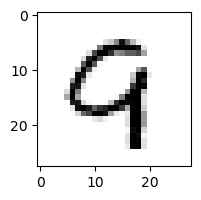

0.00944752785809697% - 0
4.671419124354501e-05% - 1
3.5461735871476523% - 2
4.535200734310971e-08% - 3
12.217982767105571% - 4 - ОШИБКА
8.746252373592773e-06% - 5
0.05181870927143875% - 6
0.06533982830423542% - 7
0.16977950059855434% - 8
1.205007196429868% - 9

 4


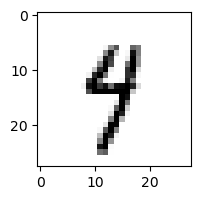

0.0006962800449793918% - 0
0.25867612988289695% - 1
0.000601181468124848% - 2
0.0878733924271716% - 3
55.284769305296265% - 4
5.231689009895172% - 5
0.10546644741757329% - 6
0.6798996271783266% - 7
0.24856456309418182% - 8
70.07009574682598% - 9 - ОШИБКА

 6


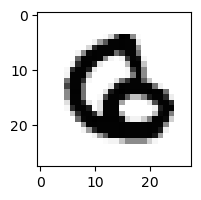

5.450071235238148e-07% - 0
2.6901593910126348e-08% - 1
0.748724400261701% - 2 - ОШИБКА
3.8745384136456366e-13% - 3
1.813573585936701e-07% - 4
1.0131939437529755e-05% - 5
0.0018192847354309137% - 6
1.6896256437877898e-09% - 7
3.2175466896096257e-15% - 8
3.480946348707747e-16% - 9

 8


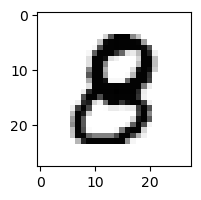

0.00030781828192445087% - 0
4.4797035352732636e-07% - 1
0.012027591674166074% - 2
0.0019459769751735752% - 3
0.00025637476396897036% - 4
0.01864506437081015% - 5 - ОШИБКА
1.0035123822634152e-07% - 6
1.332466844245779e-08% - 7
0.001199102097994657% - 8
2.4377717355500883e-10% - 9

 4


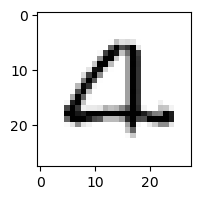

2.738511441343688% - 0
2.428489455557818e-06% - 1
83.2289473877255% - 2 - ОШИБКА
2.7092400007721123e-07% - 3
0.00020841105106406634% - 4
0.002950961815075371% - 5
0.05393472281371573% - 6
0.0018368503664461715% - 7
4.291729440499437e-08% - 8
0.030590415372789746% - 9

 5


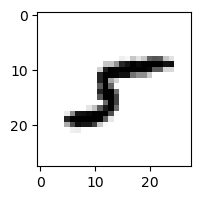

0.5272741668299713% - 0
3.5188459689754605% - 1
1.2263305481995812% - 2
0.001400014996194383% - 3
0.004701155313331777% - 4
2.2043651917978018% - 5
0.00034641959183301716% - 6
0.03157495903135487% - 7
99.92434797195969% - 8 - ОШИБКА
3.438281202131845e-05% - 9

 8


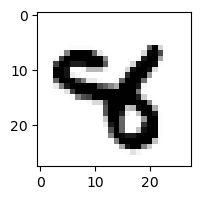

2.641296656026098e-12% - 0
2.263376295689265e-06% - 1
4.824780261378698e-06% - 2
6.125478219841562e-09% - 3
89.9348156475557% - 4 - ОШИБКА
0.0003581474864183194% - 5
1.3910051139022787e-06% - 6
0.00737133400326694% - 7
4.1063347161160615e-12% - 8
1.2960281409575565e-10% - 9

 2


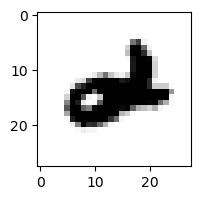

0.00010616086813994177% - 0
8.153082490704839e-05% - 1
3.6980249983929975e-07% - 2
6.77940475456899e-10% - 3
99.11030938973781% - 4 - ОШИБКА
2.387986392855079e-09% - 5
0.08513945856387145% - 6
1.464244411697931e-05% - 7
8.294684948246881e-10% - 8
3.41976867257028e-05% - 9

 8


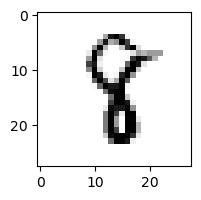

4.898428755936912e-07% - 0
3.101448730053307% - 1 - ОШИБКА
0.009442351148323895% - 2
0.0021744390417081884% - 3
0.3764663380486827% - 4
0.40457455575565393% - 5
4.4631135673883546e-05% - 6
0.009151556548745677% - 7
0.0032518236228797335% - 8
1.1833859832279361e-09% - 9

 8


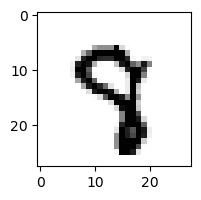

2.3520053772670072e-06% - 0
5.897623026188516e-05% - 1
0.00014920628434575295% - 2
0.008039228659622016% - 3
0.04738937830777362% - 4
0.01774832207873651% - 5
0.00011947905898662236% - 6
0.30039706770456504% - 7 - ОШИБКА
1.170517521758382e-05% - 8
0.0452896754176604% - 9

 8


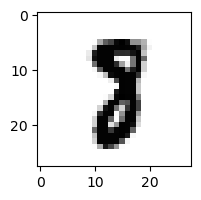

4.176922364768543e-07% - 0
0.03751240412697694% - 1
0.003800185410070262% - 2
8.018035269551516e-05% - 3
6.735331172072272e-08% - 4
0.0005852582412358169% - 5
1.8080082895283974e-06% - 6
0.2526007745674494% - 7 - ОШИБКА
1.502405718188118e-06% - 8
9.535873667427763e-12% - 9

 3


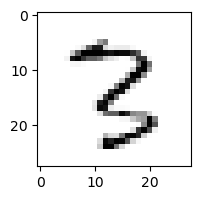

0.00010151431728286624% - 0
0.01641460676630534% - 1
17.01755911285204% - 2
32.422538638006955% - 3
0.012156736211726752% - 4
0.18775249376599148% - 5
0.00014728031667595313% - 6
0.5009131125501827% - 7
96.78977575165133% - 8 - ОШИБКА
0.03543317011407743% - 9

 9


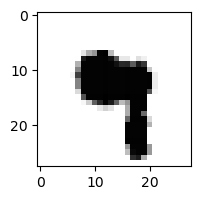

1.926594954082219e-10% - 0
0.00024034729046655155% - 1
5.10150076637192e-12% - 2
2.2154435460276592e-06% - 3
0.1062641895823636% - 4 - ОШИБКА
0.00046543907350816234% - 5
2.5572374421149862e-05% - 6
0.001122959118772626% - 7
4.5845286779798584e-11% - 8
0.08689120824927524% - 9

 8


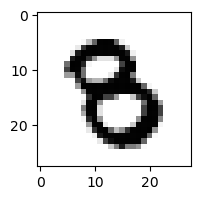

2.9322372129159145e-06% - 0
1.7685376860071622e-07% - 1
1.0788089003580262e-05% - 2
0.15792138964294988% - 3 - ОШИБКА
2.879939744740911e-05% - 4
0.008953219380435192% - 5
5.5566246555470304e-05% - 6
5.829195892817522e-08% - 7
6.957858350853696e-12% - 8
1.3529091150808641e-11% - 9

 9


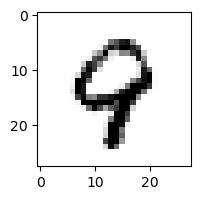

0.0004835815919658669% - 0
0.00017698877708942926% - 1
0.00620977402442274% - 2
2.6997256952291057e-08% - 3
15.014968625018572% - 4 - ОШИБКА
0.0008987102933110505% - 5
0.052503453524985796% - 6
0.02291710142209807% - 7
0.4943853095835547% - 8
2.0939249010905883% - 9

 9


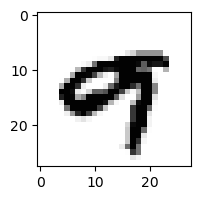

0.0005520793628758787% - 0
2.177898190298295e-05% - 1
2.2418103143352682e-08% - 2
1.9377623346138663e-08% - 3
0.07601772581873616% - 4 - ОШИБКА
2.168235228448098e-06% - 5
2.4406827282447203e-07% - 6
0.014792233488597532% - 7
2.711770423817605e-09% - 8
0.043202778779493606% - 9

 9


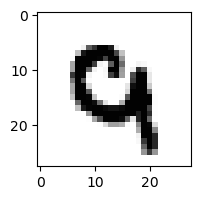

6.42783113281285e-06% - 0
1.6943953964061283e-07% - 1
0.10578584547549921% - 2
2.372829984469591e-11% - 3
0.009343561831122133% - 4
3.249466294900886e-06% - 5
0.3339094410834738% - 6
1.3921095966333954% - 7 - ОШИБКА
5.892525305975703e-14% - 8
0.004877259009034331% - 9

 6


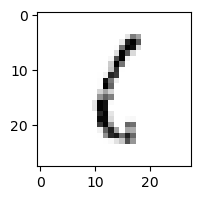

10.802804268484683% - 0
18.602495967335532% - 1
46.46420597336105% - 2
5.635709755132947% - 3
0.007134922721492407% - 4
30.09278140536182% - 5
98.7150350595843% - 6
0.005057281391074462% - 7
99.900759460309% - 8 - ОШИБКА
8.394920232510678% - 9

 5


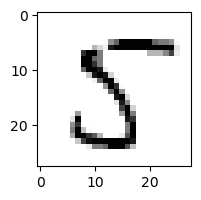

0.011946126960473062% - 0
0.005780491636746969% - 1
0.004965431098767449% - 2
0.00155795872860557% - 3
0.05607240231205812% - 4
99.97238132302685% - 5
6.120692681890902e-05% - 6
0.00016956988417990968% - 7
99.99940265649889% - 8 - ОШИБКА
1.3664120813540994e-10% - 9

 4


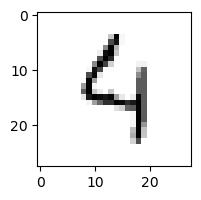

0.07077954264341983% - 0
0.0021708606251872914% - 1
15.917573481791807% - 2
2.610125896217669% - 3
67.83212986504876% - 4
15.124146398450197% - 5
9.713814207513396% - 6
0.3447708277885262% - 7
0.06682376928358963% - 8
73.34421679077285% - 9 - ОШИБКА

 5


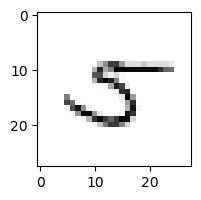

2.7316835292726225% - 0
2.4078649435513184% - 1
3.250178646336731% - 2
0.05053294544025014% - 3
0.6818331273275445% - 4
0.2163994171226404% - 5
12.93280198623905% - 6
16.633843064314384% - 7 - ОШИБКА
13.104467991921195% - 8
0.17980692154973116% - 9

 8


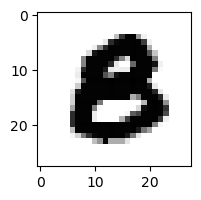

0.00039389422869468455% - 0
2.2942578701743887e-11% - 1
2.3106454785742944e-07% - 2
3.234732378430901e-06% - 3
7.693185358901126e-11% - 4
0.008432279047741674% - 5 - ОШИБКА
5.762529262520005e-07% - 6
1.3531838647915625e-11% - 7
5.124344538683224e-15% - 8
3.0117343000350693e-16% - 9

 8


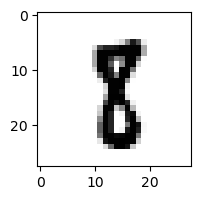

3.6557665916216385e-07% - 0
2.543672039505631% - 1 - ОШИБКА
0.00022289514774788966% - 2
0.0010060716672105896% - 3
5.548555204080133e-07% - 4
0.40688253090640425% - 5
3.7644751497474554e-06% - 6
0.000554916425093306% - 7
0.04344830708106608% - 8
1.4872327765669938e-07% - 9

 8


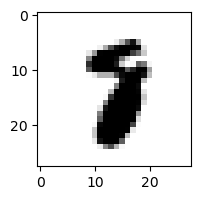

7.238095151383926e-09% - 0
0.003300401797519283% - 1
0.0039387946403204085% - 2
6.854524548920737e-08% - 3
4.34207492336575e-07% - 4
3.177960820544221e-05% - 5
9.323706207991024e-06% - 6
3.1122253183482678% - 7 - ОШИБКА
4.839447512080334e-07% - 8
2.1031932261477927e-08% - 9

 8


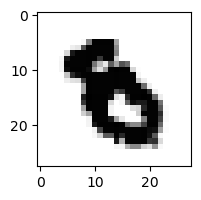

3.744243602258004e-11% - 0
5.519196608918277e-09% - 1
2.2622578431687535e-06% - 2
2.84017785431769e-09% - 3
6.0014579345014174e-05% - 4
0.0030353355488562522% - 5
0.008774195142001371% - 6 - ОШИБКА
3.814326317519157e-08% - 7
3.808645010175574e-17% - 8
2.0890370685190062e-15% - 9

 5


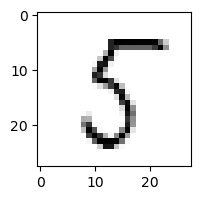

4.455219905374473% - 0
0.3610685565750378% - 1
0.12535961434024528% - 2
0.0900082840802036% - 3
0.23859314127449763% - 4
97.90877690750746% - 5
0.01769762607450602% - 6
0.0005451370998375904% - 7
99.9552181238283% - 8 - ОШИБКА
5.0690511139433155e-06% - 9

 4


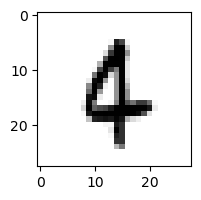

3.0057817694388213e-05% - 0
0.02832252899409666% - 1
0.009056425577883163% - 2
4.416440536025464e-09% - 3
0.045167375955576704% - 4
0.000557532545774772% - 5
11.99877039007232% - 6 - ОШИБКА
0.055787378604682795% - 7
1.3405908717860602e-07% - 8
0.004940713958088543% - 9

 9


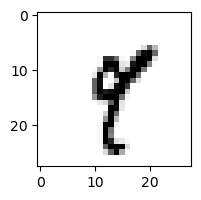

6.94196079123866e-06% - 0
38.84577446532678% - 1 - ОШИБКА
0.0001696441825528489% - 2
0.13976304051390573% - 3
1.1183421211774152% - 4
0.6668986022459845% - 5
4.238658385500575e-05% - 6
29.88439514072444% - 7
0.017225036180945195% - 8
0.03557195535089695% - 9

 5


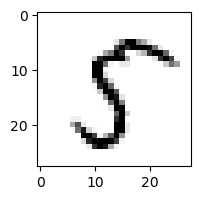

0.10410299313453412% - 0
0.011361206064310184% - 1
0.44178350101745273% - 2
0.0001781128270393028% - 3
0.016160433134230344% - 4
99.9370022557629% - 5
0.00021572036529097073% - 6
0.0007801133249731517% - 7
99.95064515280923% - 8 - ОШИБКА
0.00011538328286571747% - 9

 8


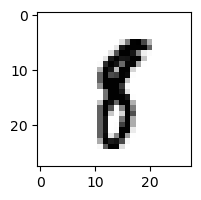

8.62772063236029e-06% - 0
19.308089733320905% - 1 - ОШИБКА
7.821489097472415e-05% - 2
0.0032896975223277777% - 3
0.00010828025341362151% - 4
0.19626269797578874% - 5
0.0004039150482327042% - 6
0.0003587117916169091% - 7
0.08822288327607394% - 8
4.7932844105472126e-05% - 9

 3


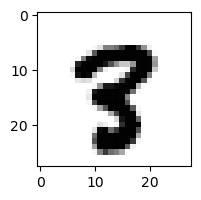

9.141309187009175e-09% - 0
3.501079817152884e-06% - 1
4.734855643432905e-06% - 2
3.4831580011580523e-07% - 3
5.268884647914737e-06% - 4
0.01247740864906832% - 5
3.686247568633069e-09% - 6
0.006726715754539097% - 7
2.169042262719048% - 8 - ОШИБКА
0.0005679644249672102% - 9

 8


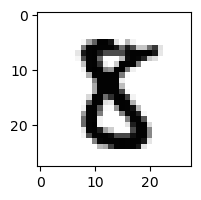

2.026793058860607e-05% - 0
2.0802024044903946e-06% - 1
0.00039980844918718856% - 2
5.583214970446285e-06% - 3
1.7075107867159226e-07% - 4
5.201334380647045% - 5 - ОШИБКА
2.85115880912979e-09% - 6
2.3671683779934e-07% - 7
0.2280348477783357% - 8
1.6589370415093264e-12% - 9

 8


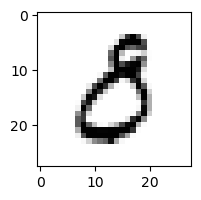

64.73518612589301% - 0 - ОШИБКА
0.002704814872452042% - 1
0.022011441831058583% - 2
36.228396056716036% - 3
4.809122433034768e-06% - 4
1.2171530671652313% - 5
0.0031651298077463915% - 6
0.00038718235383963144% - 7
2.853339308321072e-08% - 8
3.152954995032088e-10% - 9

 3


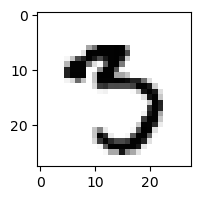

9.25863801646895e-05% - 0
2.2755445601805073e-06% - 1
3.4107542027045946e-07% - 2
0.7360543645924664% - 3
1.8106056533895373e-06% - 4
76.31768210576885% - 5 - ОШИБКА
5.6792581748456144e-05% - 6
0.22277921737804499% - 7
0.12468039670847765% - 8
0.05741191649537203% - 9

 6


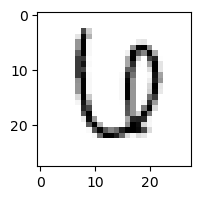

4.80168894307883% - 0
6.25314138517685e-05% - 1
0.07478278416191861% - 2
7.094933934670153% - 3 - ОШИБКА
2.804274473291778% - 4
0.015262806483565828% - 5
2.837292043290745% - 6
1.9186290202655225% - 7
0.0005664990330975762% - 8
5.405840912337528e-06% - 9

 8


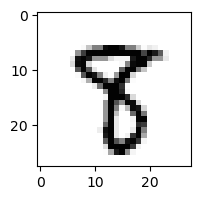

7.711954307377717e-09% - 0
0.0014115335846637681% - 1
3.039930444578107e-06% - 2
0.005360077294925046% - 3
0.0002597867114474249% - 4
0.9276445569768954% - 5 - ОШИБКА
5.90110802101255e-09% - 6
0.14468202340732897% - 7
0.002130917063032574% - 8
2.549718441343488e-06% - 9

 9


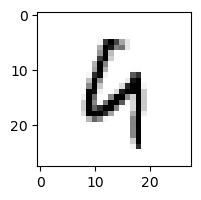

0.0012085174212668125% - 0
0.0037089612657474377% - 1
9.318827458305545% - 2
2.508536524961176e-06% - 3
78.38262842943845% - 4 - ОШИБКА
0.006507015705686208% - 5
35.292247908632014% - 6
0.012866097469765064% - 7
3.977434744650943% - 8
1.4909308396278853% - 9

 8


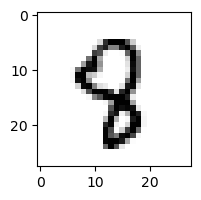

6.980321315888095e-06% - 0
0.004022266410396647% - 1
0.0035395382013829677% - 2
7.74902983269203e-05% - 3
3.6974701936720216% - 4 - ОШИБКА
1.984320247813746% - 5
0.01148038987557351% - 6
0.010123540618461721% - 7
0.02918771719996417% - 8
1.636229200280792e-06% - 9

 8


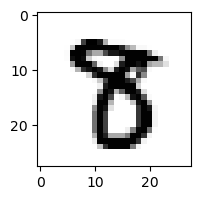

4.5824628181666155e-07% - 0
7.69345418326021e-06% - 1
3.50686710568137e-06% - 2
0.19578168814864813% - 3 - ОШИБКА
5.441136995304975e-08% - 4
0.02407369255303827% - 5
4.6302203713654733e-10% - 6
0.0005602263547624937% - 7
0.0004953588177243134% - 8
3.155868928690424e-11% - 9

 7


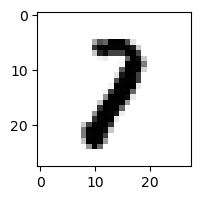

3.0915684646652723e-05% - 0
22.203568972489123% - 1 - ОШИБКА
10.557635308872117% - 2
0.025650022864469456% - 3
3.422899624417338e-05% - 4
0.00046415882655873714% - 5
1.4713533512538909e-05% - 6
0.010428303541377965% - 7
0.0058061155301088255% - 8
5.143973065710134e-06% - 9

 6


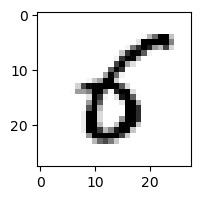

0.953264977958092% - 0
0.034515335553575645% - 1
0.00039254431887733777% - 2
0.005565353126723383% - 3
0.18972071179648076% - 4
34.23098213092078% - 5 - ОШИБКА
27.564857133679453% - 6
4.8298188686884196e-05% - 7
2.011630338272931e-05% - 8
2.7061914489338077e-05% - 9

 8


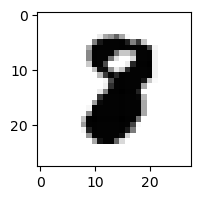

4.43662761582067e-09% - 0
8.881579862028299e-05% - 1
0.0249466005059847% - 2 - ОШИБКА
1.3490498055801381e-08% - 3
1.405169218734774e-09% - 4
1.4519101674680098e-06% - 5
5.945610167155973e-08% - 6
2.599774830592192e-05% - 7
6.46581220809576e-06% - 8
1.5070315638747294e-15% - 9

 8


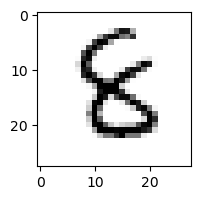

1.1484643398893606e-05% - 0
0.001937411373897135% - 1
0.015244053015294877% - 2
0.19248754107048302% - 3
0.03355516412904855% - 4
0.8621153409942872% - 5
0.9244699749038219% - 6 - ОШИБКА
3.034061871356272e-06% - 7
5.053068676870701e-05% - 8
2.6445856494410307e-08% - 9

 8


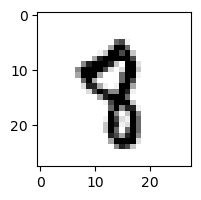

4.424424071463619e-08% - 0
0.027320252056260815% - 1
0.000252278433823594% - 2
2.1130011234148453e-06% - 3
0.026254283360506007% - 4
0.23659997111224315% - 5 - ОШИБКА
0.0013180623511521682% - 6
0.21589348620997362% - 7
0.0006557092094241316% - 8
0.026373403332010846% - 9

 9


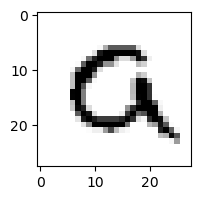

56.546879105442% - 0 - ОШИБКА
2.7159382581053574e-07% - 1
5.9553809826728195% - 2
1.809835528189988e-06% - 3
7.37861285892056e-06% - 4
9.89975901706705% - 5
18.65636029779437% - 6
0.17061473529804808% - 7
1.0586634827704766e-09% - 8
0.1182145058094059% - 9

 2


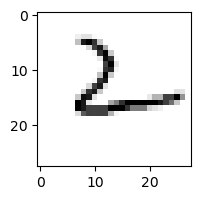

1.9306791662775626% - 0
0.007066652611808746% - 1
74.48118346996188% - 2
0.0007741283774917929% - 3
99.93558280744537% - 4 - ОШИБКА
0.017036075358565172% - 5
85.06840046908624% - 6
3.1762414372922696% - 7
0.007307676478360552% - 8
4.84326998366995% - 9

 8


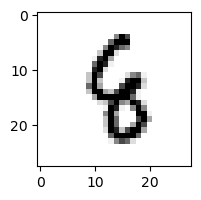

4.6599082097816166e-07% - 0
0.057135754409020745% - 1
0.3281183692451904% - 2
0.0009859884438748355% - 3
7.753872362242191% - 4 - ОШИБКА
0.4317087785143862% - 5
7.293638960562896% - 6
0.0027900376867880947% - 7
0.0025708636067051467% - 8
3.500310828154988e-05% - 9

 0


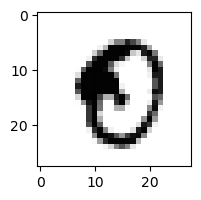

1.5378098962026776% - 0
3.7441064806820134e-07% - 1
3.4171268789779795e-08% - 2
7.716392676152605e-09% - 3
0.0002832631728735509% - 4
1.4687030188218582% - 5
0.0006227489455670428% - 6
6.566042710329434e-08% - 7
34.78968335026617% - 8 - ОШИБКА
0.00010618571151476337% - 9

 7


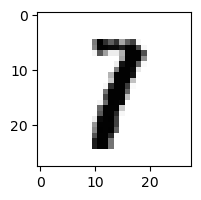

3.4160342177255196e-06% - 0
47.42707679407619% - 1 - ОШИБКА
0.30096918057555494% - 2
0.07503212141587585% - 3
1.652490354651007e-05% - 4
0.0029059190421118057% - 5
2.101459007622611e-05% - 6
0.00412817565289672% - 7
0.001893673668881404% - 8
8.791165693692125e-07% - 9

 5


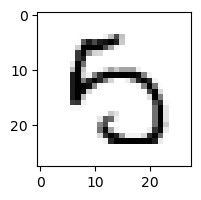

0.21129102579316994% - 0
8.979458798071113e-05% - 1
6.318866338338428e-06% - 2
0.11638244522340192% - 3
1.97953111164594% - 4 - ОШИБКА
1.6552368938401663% - 5
0.1124735134404995% - 6
0.020031003308104322% - 7
1.4576714445404335e-06% - 8
1.3387389122924929e-06% - 9

 8


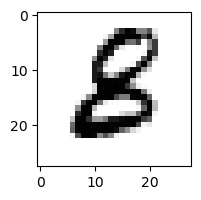

6.8348204792218265e-06% - 0
8.375979008718419e-05% - 1
0.007289743995230456% - 2
0.0021762556917603493% - 3
5.180380241297748e-07% - 4
1.0449115617186957% - 5 - ОШИБКА
0.31779727664963053% - 6
8.95246605034175e-09% - 7
1.1594505858035552e-10% - 8
2.3334588020666346e-15% - 9

 4


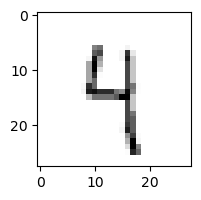

0.006456089527633198% - 0
0.478846128447248% - 1
2.7921578623899186% - 2
27.68911275317413% - 3
94.66260237573242% - 4
29.26882892009594% - 5
11.85314811174294% - 6
2.734917489166589% - 7
27.56614248857413% - 8
95.24866656982857% - 9 - ОШИБКА

 7


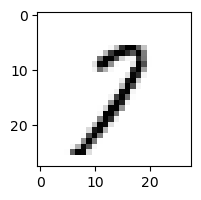

0.1400104124665376% - 0
7.285469170872946% - 1
45.67072530247619% - 2
0.182697793326737% - 3
0.026731414039294153% - 4
0.3031368521071528% - 5
0.018248679796691522% - 6
86.05659700193031% - 7
0.9029394697221473% - 8
87.15539139818995% - 9 - ОШИБКА

 8


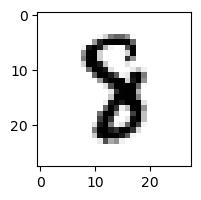

5.576506738256081e-08% - 0
0.0072377326043087595% - 1
0.00680805619457291% - 2
5.2247163549132295e-05% - 3
0.0008174608711677048% - 4
0.029308022369818443% - 5
0.12217242152559289% - 6 - ОШИБКА
0.000789127907458267% - 7
0.008442312869128483% - 8
6.383968284329979e-13% - 9

 2


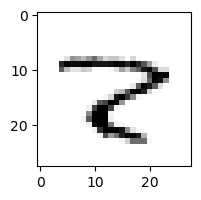

0.5015730229622231% - 0
0.04175900256943657% - 1
40.39243808669524% - 2
3.414264273933364e-07% - 3
0.029658483838120732% - 4
1.9673591452377206e-06% - 5
6.22753594940103% - 6
54.49729640083783% - 7
89.56489960830328% - 8 - ОШИБКА
0.00012418300531765887% - 9

 8


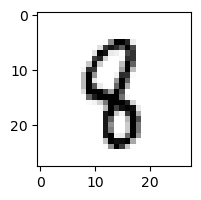

1.2770128420202583e-06% - 0
0.07510428606091599% - 1
0.026225998672744794% - 2
0.000571593947789709% - 3
1.0672848987069317% - 4
1.578214790181209% - 5 - ОШИБКА
0.008429559217842298% - 6
0.0009178167184607049% - 7
0.0033418922590906664% - 8
0.00011174537700758655% - 9

 2


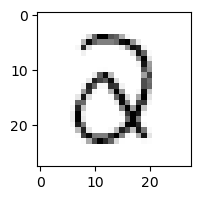

0.7256035595328868% - 0
0.00014745122570716733% - 1
0.5488815251913572% - 2
62.07222678118502% - 3 - ОШИБКА
1.448949252658001% - 4
0.43626704647670583% - 5
0.003887135157899722% - 6
5.48129312727086e-05% - 7
0.0031057091589604246% - 8
2.5134493717512553e-07% - 9

 6


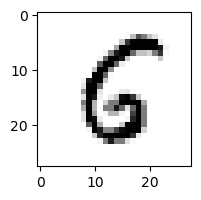

0.8644261771282744% - 0
8.964521764796264e-05% - 1
0.03985614353200532% - 2
1.1726529240179921e-07% - 3
0.28946435815616867% - 4
14.442024458324443% - 5 - ОШИБКА
5.394891972072914% - 6
0.00012293658274944067% - 7
3.088695495102187e-05% - 8
1.9662068245387912e-07% - 9

 8


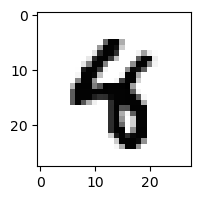

2.3183320944204422e-09% - 0
0.0004376392762696905% - 1
4.043111718488429e-06% - 2
1.105823716307953e-07% - 3
85.01452162448476% - 4 - ОШИБКА
0.0032568792522741433% - 5
3.5774229587832225e-05% - 6
0.00010267688983318037% - 7
3.5883034163004304e-12% - 8
6.1938997804822054e-06% - 9

 7


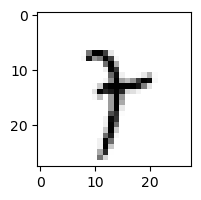

7.363847142401036e-05% - 0
73.23156490888313% - 1
0.12916388493396738% - 2
0.2863421129058857% - 3
0.6405002663042383% - 4
1.5290454938557099% - 5
11.639463921409627% - 6
0.3695265965546265% - 7
89.06472989195188% - 8 - ОШИБКА
32.81488548718546% - 9

 8


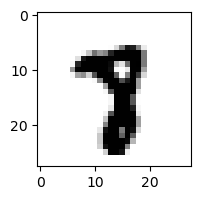

2.567725133173427e-09% - 0
0.0013519713492158116% - 1
7.878309640158191e-08% - 2
2.5529738517501184e-07% - 3
8.023140544203443e-07% - 4
0.0750906966752292% - 5
1.1282424494194763e-06% - 6
1.7072909457523666% - 7 - ОШИБКА
0.0003523656328582023% - 8
1.996517993424013e-06% - 9

 3


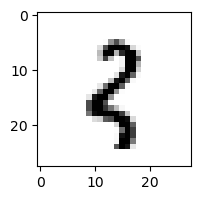

0.0014185413419797073% - 0
16.257204084769146% - 1
19.949303270717053% - 2 - ОШИБКА
0.0013289649010903204% - 3
0.0026732547512157375% - 4
0.0026486230312909513% - 5
0.04876742201806322% - 6
0.0007818624985188097% - 7
2.4600155400092305% - 8
13.177032167084965% - 9

 9


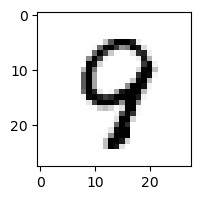

0.0010786210250832487% - 0
1.820717609005244e-05% - 1
0.007348747976169829% - 2
0.0015508400197205695% - 3
31.893583402520893% - 4 - ОШИБКА
0.05245255234922927% - 5
0.014116977343549742% - 6
0.027914255330138683% - 7
2.378670517743894% - 8
0.003658929374561716% - 9

 9


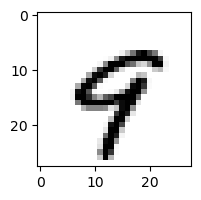

0.0017209239683397706% - 0
0.0002464491138514909% - 1
1.3635227811792632e-06% - 2
2.0633726265016378e-07% - 3
69.39974789616444% - 4 - ОШИБКА
0.08449684907202479% - 5
0.0003300213505007015% - 6
3.243330121981048% - 7
2.659192838026972e-06% - 8
0.4158179356017885% - 9

 9


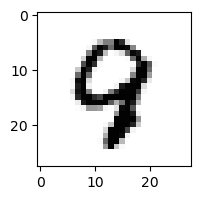

9.022645116506292e-05% - 0
1.8684500185935662e-05% - 1
0.0015077501192961276% - 2
4.77610286824236e-05% - 3
2.5295872942390845% - 4 - ОШИБКА
0.006347577435103418% - 5
0.008023761441569988% - 6
0.004110111824521874% - 7
0.0017742659781015914% - 8
0.0064904720480200755% - 9

 3


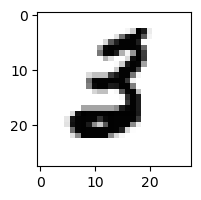

0.0006794571735650876% - 0
0.0002601507336087835% - 1
0.04779124271936214% - 2 - ОШИБКА
4.353599489161672e-05% - 3
3.556814877531682e-08% - 4
0.0030501148161328627% - 5
0.0029012275202380785% - 6
2.9737023389247412e-06% - 7
1.5111685724014907e-10% - 8
6.401107663432711e-13% - 9

 3


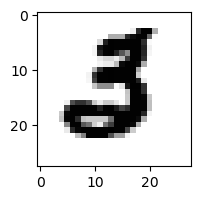

0.00026426739150659455% - 0
4.718668923586234e-06% - 1
0.021520110949449757% - 2 - ОШИБКА
5.692030145785312e-09% - 3
2.4046949131187816e-09% - 4
1.1546270569268212e-05% - 5
1.555463183157768e-05% - 6
3.576386731553246e-06% - 7
3.595146588244857e-16% - 8
5.4477517989133e-16% - 9

 3


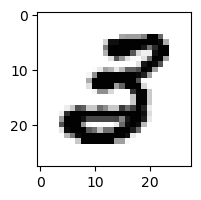

0.003937463114065065% - 0
7.514626784818273e-06% - 1
2.930044165319419e-05% - 2
2.4446646857492394e-06% - 3
3.960260542387752e-07% - 4
0.09881303357447979% - 5 - ОШИБКА
6.246318735825686e-07% - 6
5.589136643917661e-08% - 7
1.1656561383964575e-07% - 8
7.362985719181534e-18% - 9

 8


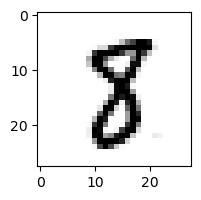

1.8016298878452442e-05% - 0
0.2756136184912955% - 1
0.0034097741925718664% - 2
0.0006138165104728521% - 3
7.101442430131057e-06% - 4
1.4630949836718332% - 5 - ОШИБКА
2.2011232364100752e-05% - 6
0.013633580953864992% - 7
0.031808467550988644% - 8
5.149536160540125e-09% - 9

 8


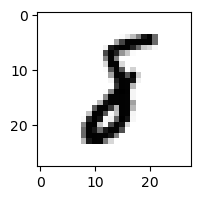

3.7496019376257306e-06% - 0
33.11938929160983% - 1 - ОШИБКА
1.514448517997835% - 2
2.8895635407323464e-05% - 3
3.0974234423910157e-06% - 4
0.0038171619877140676% - 5
0.9732469046687887% - 6
0.0006846380486702877% - 7
0.05926603832192911% - 8
1.910885395367337e-07% - 9

 3


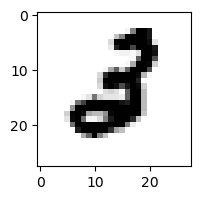

9.646478818865827e-06% - 0
0.0020598141915374366% - 1
0.22912695161453628% - 2 - ОШИБКА
5.160580353283104e-08% - 3
0.00010838290110816628% - 4
9.656920098469107e-05% - 5
0.0013425345202440458% - 6
3.1173685239930316e-06% - 7
2.0044977031409203e-10% - 8
2.236662766334664e-14% - 9

 4


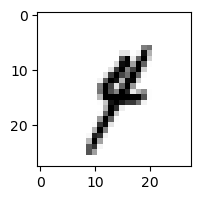

2.65282675681346e-05% - 0
81.87064887771676% - 1 - ОШИБКА
0.005094404565523067% - 2
17.411010946341285% - 3
7.055053175582385% - 4
0.025040184261202202% - 5
0.001920091535985495% - 6
1.6742409504094387% - 7
0.0006158488396148815% - 8
0.028312812205849563% - 9

 3


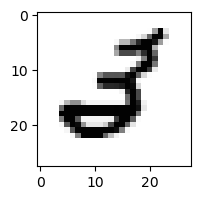

0.0029209766543943972% - 0
0.00044845909864149066% - 1
1.7369260154532145% - 2 - ОШИБКА
4.5953813041179813e-07% - 3
0.025942651508152854% - 4
0.0006045980364753134% - 5
0.0007315356150219596% - 6
6.392305087336218e-05% - 7
9.825154274828452e-06% - 8
1.0869945877796347e-08% - 9

 9


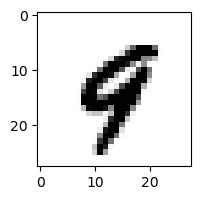

2.598282271557159e-05% - 0
0.0010966347215910933% - 1
9.487525998674386e-07% - 2
1.670220659568422e-08% - 3
12.820484309334054% - 4 - ОШИБКА
9.336854936540633e-05% - 5
0.000630019167513006% - 6
0.10149953689281707% - 7
4.390598846127499e-07% - 8
0.1999440874441946% - 9

 8


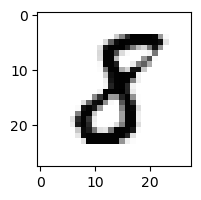

5.13300035656016e-05% - 0
0.37882877487659466% - 1 - ОШИБКА
0.10186157930942988% - 2
0.014141782638915327% - 3
5.632585577017293e-07% - 4
0.09546878274326538% - 5
0.00016244039164763194% - 6
7.804133775866095e-07% - 7
0.013951240652445166% - 8
3.991798132684389e-12% - 9

 8


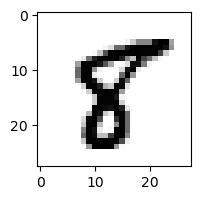

0.00013343023867590825% - 0
0.002265722225780223% - 1
1.5625505086386778e-05% - 2
7.074860331504693e-11% - 3
0.00016812010459663768% - 4
34.70624902862186% - 5 - ОШИБКА
8.707609035330433e-07% - 6
0.00011228357940715581% - 7
0.043048623923973475% - 8
4.407278933192322e-06% - 9

 5


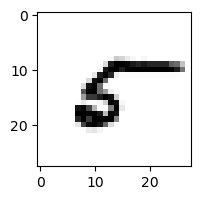

19.42650345812997% - 0 - ОШИБКА
0.26360652763645603% - 1
0.757250544842996% - 2
2.369385882632404e-06% - 3
0.40408216665321134% - 4
0.5863010695231453% - 5
0.845434058294738% - 6
0.5312177461848273% - 7
0.5831733971819529% - 8
0.0006732711771564754% - 9

 9


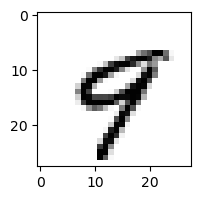

0.004223502791147397% - 0
0.0002278449964591538% - 1
5.02935511148278e-07% - 2
4.256025539284089e-06% - 3
42.27356076995523% - 4 - ОШИБКА
0.018849295818895554% - 5
0.0003706262441050625% - 6
12.8508661288918% - 7
0.0002670484822354932% - 8
0.6581898093772748% - 9

 8


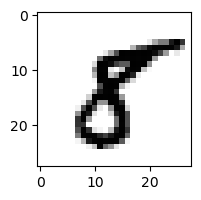

0.00021464393358665645% - 0
0.05222586901704138% - 1
7.96158165077494e-05% - 2
1.2109600818979835e-06% - 3
0.0002948335439946665% - 4
20.86334380210467% - 5 - ОШИБКА
6.45641127189508e-10% - 6
5.7050305432755264e-05% - 7
0.018062208369442338% - 8
8.116125662268197e-08% - 9

 3


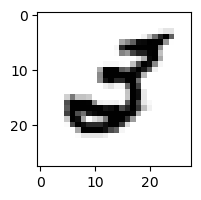

0.049609502976858726% - 0
0.006657496577218441% - 1
0.47721300409135375% - 2 - ОШИБКА
1.4284853061154522e-09% - 3
0.00519181756264752% - 4
0.00016778670748940802% - 5
0.00019254131446821873% - 6
0.0065528827817799415% - 7
2.6276121142984253e-10% - 8
4.8854253716514875e-11% - 9

 3


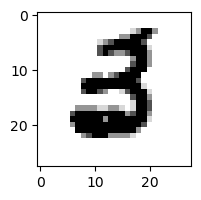

0.0006757092666317395% - 0
4.9284531154463675e-06% - 1
0.00012016189320863416% - 2
9.514566971804686e-06% - 3
1.0512525059663862e-07% - 4
0.0038162430400767947% - 5
0.12936774910864673% - 6 - ОШИБКА
6.742268580080992e-09% - 7
4.082060330926764e-14% - 8
3.0573491167078717e-15% - 9

 8


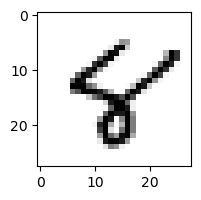

0.00012074229579384729% - 0
0.00020429677032982464% - 1
4.188497906956588e-05% - 2
1.9637611274973684e-10% - 3
2.932010024078357% - 4
10.74639725471501% - 5 - ОШИБКА
0.5076882634889055% - 6
0.0008658968520600437% - 7
9.747807646155374% - 8
0.015534149409297246% - 9

 7


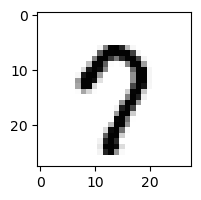

0.3218366301968065% - 0
2.4603263463139757e-06% - 1
4.1701504266528964e-05% - 2
0.00016264452976097203% - 3
0.0072245154874221555% - 4
1.191308796930939% - 5
0.0006754524427501178% - 6
72.10548689944974% - 7
0.0160931766298052% - 8
97.95872459763977% - 9 - ОШИБКА

 9


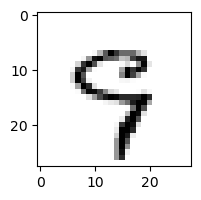

0.0043866285545684875% - 0
0.0015267517265411274% - 1
0.0019881071910684894% - 2
4.552765459533806% - 3
1.881014981060217% - 4
4.667383662986712% - 5
0.04800774582304568% - 6
52.36851410950697% - 7 - ОШИБКА
7.53970368695757e-07% - 8
0.7062743497238615% - 9

 2


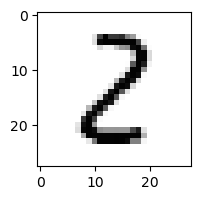

0.1439607097071864% - 0
10.077624250540351% - 1
41.833009115821014% - 2
0.9690837174328479% - 3
0.0004779047959845667% - 4
0.03724726702695728% - 5
2.832816549516093e-05% - 6
1.9602750815857416e-05% - 7
99.82428098294675% - 8 - ОШИБКА
4.543339828132267e-09% - 9

 7


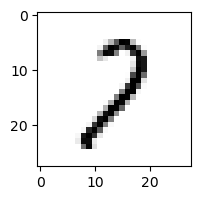

4.018275401173965% - 0
11.49532486161468% - 1
86.19319577515961% - 2 - ОШИБКА
3.7539122631058066% - 3
0.08685980203654499% - 4
0.04642776503257045% - 5
0.024201777791719378% - 6
8.592361812906256% - 7
14.114433075038752% - 8
0.08918204538452901% - 9

 9


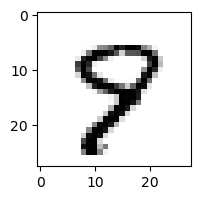

0.0009796696909925805% - 0
1.2387301338738156e-05% - 1
4.072020431686658e-05% - 2
7.125156282634018e-05% - 3
0.10511950505504468% - 4
2.4323180225642176% - 5 - ОШИБКА
0.00028500253440399677% - 6
1.0573468885142692% - 7
0.17683201450174318% - 8
1.0547235457962056% - 9

 9


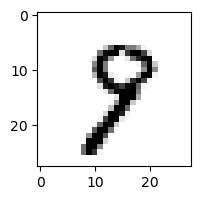

0.001060514729570156% - 0
0.002479554386427462% - 1
0.0035705521379210715% - 2
0.056680545071379956% - 3
0.010834968576261665% - 4
0.5282218376588252% - 5
0.0003828056944728774% - 6
2.244852461294942% - 7
43.26328528281822% - 8 - ОШИБКА
29.129902282515253% - 9

 8


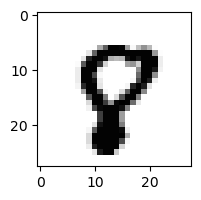

0.001577995677038478% - 0
1.4444254392841854e-08% - 1
2.932556011058494e-06% - 2
2.6202338316590273e-11% - 3
0.001052640509344044% - 4
0.0211388687745831% - 5
4.5795997032308915e-06% - 6
0.367052270238073% - 7 - ОШИБКА
0.011742796506531546% - 8
0.0506097028231761% - 9

 8


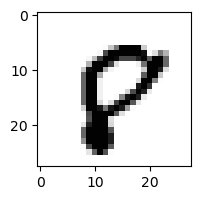

43.39441820686322% - 0 - ОШИБКА
3.021877207595011e-09% - 1
0.00032216434075350457% - 2
2.6594846998045242e-12% - 3
5.80049969871199e-05% - 4
0.01518917068562707% - 5
2.9084167845560853e-05% - 6
1.7319702361988734% - 7
4.023738393181438% - 8
1.4263669918908313% - 9

 8


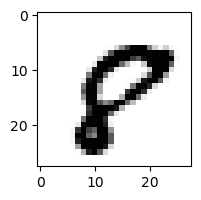

11.503331106502387% - 0 - ОШИБКА
1.3196873086155954e-08% - 1
4.476811283356667e-06% - 2
6.2409371561810965e-12% - 3
3.0659276045840905e-06% - 4
0.10381784898521947% - 5
9.875713450082872e-07% - 6
0.0371132008990819% - 7
7.531617202778904% - 8
0.0009683385028027574% - 9

 9


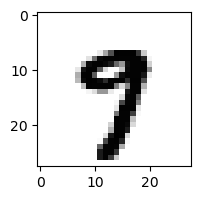

6.875129755153445e-06% - 0
3.488870766619502e-06% - 1
2.577198149541907e-09% - 2
0.00013676411770630281% - 3
0.005559943060240675% - 4
0.01786906207479269% - 5
8.385881622637527e-07% - 6
8.476138770799627% - 7 - ОШИБКА
2.467744861371641e-07% - 8
2.1653416247713015% - 9

 9


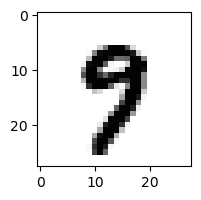

0.00011497995252261762% - 0
3.9367151208978496e-06% - 1
2.0352967868825546e-08% - 2
0.00014020528346533363% - 3
0.0014816990977622399% - 4
0.325949780549201% - 5
2.0795573216113245e-06% - 6
10.456051099042577% - 7 - ОШИБКА
4.390966471406834e-06% - 8
0.6906039738275958% - 9

 3


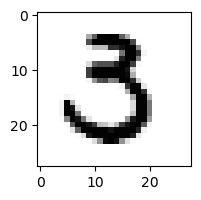

0.050555012835190635% - 0
4.012666290504671e-05% - 1
0.0077914381489421185% - 2
2.520077738698673% - 3
2.824844295025739e-10% - 4
2.6464418734541892% - 5 - ОШИБКА
2.9448809936789498e-06% - 6
0.00020967663188160485% - 7
8.326435496495902e-11% - 8
2.9320722525652557e-15% - 9

 1


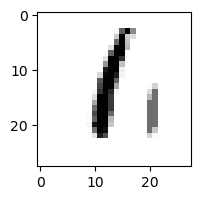

0.3525922051326387% - 0
3.994279348842241% - 1
12.086375040757671% - 2
0.057022515279620226% - 3
4.760911270557319e-05% - 4
9.3475701139713% - 5
90.7511874888321% - 6 - ОШИБКА
4.610382944956363e-05% - 7
31.52525293652263% - 8
1.110968504466144% - 9

 8


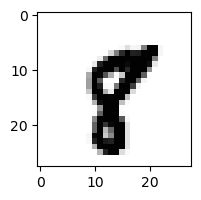

1.5529408770504736e-06% - 0
0.02831564099890002% - 1
1.005816135487632e-07% - 2
4.049762068697403e-08% - 3
0.0001744375604775666% - 4
0.013803798611192809% - 5
4.7042916511044134e-07% - 6
2.4105905404300723% - 7 - ОШИБКА
8.331033155007333e-06% - 8
5.993489957416981e-06% - 9

 9


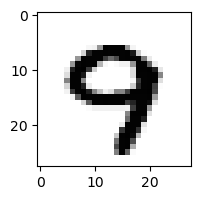

0.00022928776877095486% - 0
1.0637460585090128e-08% - 1
9.068837825542991e-07% - 2
2.631458199803704e-05% - 3
0.004497661194665897% - 4
0.00015660774559729735% - 5
0.0001339644904877429% - 6
0.5475239862720181% - 7 - ОШИБКА
6.598175871921812e-09% - 8
0.5384603799467407% - 9

 8


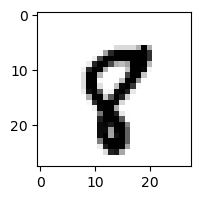

2.4008555425784414e-05% - 0
0.0023336729566161792% - 1
1.9235084836369925e-05% - 2
5.840935748258728e-09% - 3
0.0003186674607257271% - 4
0.04073689111771046% - 5
0.0002432155402630272% - 6
0.10904269035724205% - 7 - ОШИБКА
0.000588887462852526% - 8
0.020950284186235645% - 9

 8


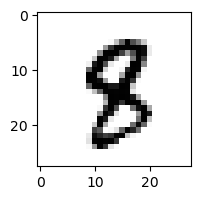

3.5694526154961797e-06% - 0
0.004564341118963029% - 1
8.569770976930262e-05% - 2
0.0002596079320561563% - 3
0.005744979439381591% - 4
0.16262302808538637% - 5 - ОШИБКА
5.55681744457564e-06% - 6
0.00019745803469653635% - 7
0.0014597173379108084% - 8
2.4367113480999503e-06% - 9

 1


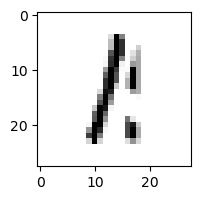

0.7743046744027987% - 0
26.964611059541177% - 1
7.726583804957435% - 2
14.377643931497927% - 3
4.8841287962616834e-05% - 4
0.49973118368313635% - 5
1.5251612214405434% - 6
0.0009332233163638914% - 7
98.41573432627244% - 8 - ОШИБКА
0.27542135505935367% - 9

 8


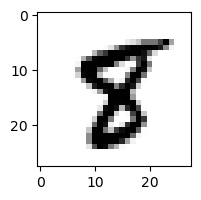

2.4941828125078955e-07% - 0
3.171074876659648e-05% - 1
4.1108625991087397e-07% - 2
3.0121883321252494e-09% - 3
0.00012621340259010458% - 4
1.2795416888674656% - 5 - ОШИБКА
2.020673189277595e-06% - 6
0.0001949129445665289% - 7
0.006294510830190437% - 8
4.5173830491758825e-08% - 9

 8


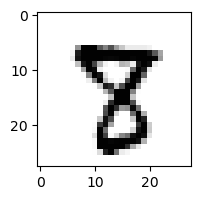

5.4273559541943686e-08% - 0
1.4846453947115205e-06% - 1
0.00021894588801361884% - 2
0.00011029959256556996% - 3
0.00011822422496385746% - 4
0.06980892137642031% - 5
8.417919967319839e-10% - 6
1.6648951276763406% - 7 - ОШИБКА
0.3044658721394934% - 8
1.549343432215979e-07% - 9

 8


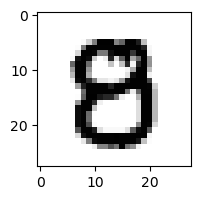

0.027372815899971426% - 0
1.0844864651519058e-09% - 1
2.6420915266684296e-05% - 2
0.006440350909609982% - 3
1.9492888364958174e-05% - 4
0.052575026557180334% - 5 - ОШИБКА
5.7255954771529145e-09% - 6
6.662349430509556e-08% - 7
2.507965927641296e-07% - 8
2.2308321457075873e-10% - 9

 9


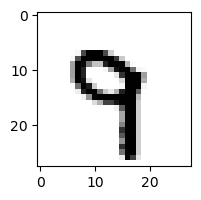

2.652425056387199e-08% - 0
0.018419086116065898% - 1
8.607773198755745e-05% - 2
0.0007635068810416741% - 3
1.7054523399167936% - 4
0.02015745220638457% - 5
0.009522720530525193% - 6
42.473671613270284% - 7 - ОШИБКА
1.5415915966483366e-06% - 8
0.05059366737503717% - 9

 8


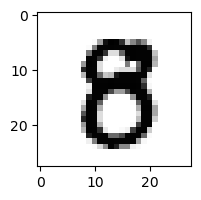

0.023065343830742283% - 0
7.80425812936399e-08% - 1
3.3673202648404944e-06% - 2
0.004911888491900715% - 3
3.1328662641797935e-05% - 4
0.32015447080207254% - 5 - ОШИБКА
3.186902550660217e-08% - 6
6.827857660792767e-07% - 7
0.00627904027006634% - 8
2.068289014692372e-10% - 9

 8


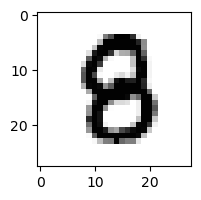

2.916761701345786e-05% - 0
9.455089407767628e-06% - 1
0.0007831559668608258% - 2
0.000267438698337363% - 3
4.6274778457794114e-05% - 4
0.05194337981154007% - 5 - ОШИБКА
0.0011642096021404688% - 6
1.2992855163398978e-08% - 7
0.0006675220051887981% - 8
5.635472499038581e-10% - 9

 8


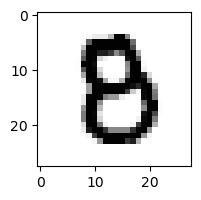

0.01809204741049863% - 0
3.797764581636413e-08% - 1
0.02659933629445489% - 2
0.005871834370424162% - 3
2.289556402657614e-05% - 4
0.04680945447599862% - 5 - ОШИБКА
0.00021684721763131853% - 6
2.1373790362276302e-07% - 7
0.0005081554589121715% - 8
3.1439845687868213e-10% - 9

 8


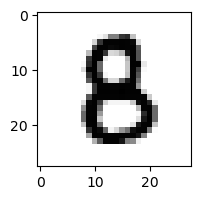

0.0013374860796121803% - 0
2.398115146804398e-06% - 1
0.0211172959798035% - 2
0.0017299226366602493% - 3
0.00025466477236966474% - 4
0.12280453494331539% - 5 - ОШИБКА
0.0002605303828257023% - 6
1.493109862013194e-08% - 7
0.0031235872125679734% - 8
5.6363932595808497e-11% - 9

 2


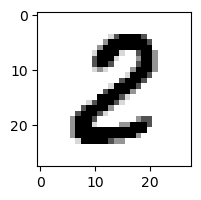

0.004321878744399684% - 0
0.001434673698278518% - 1
87.30808918098275% - 2
0.0005037037872046851% - 3
9.39158479331602e-10% - 4
0.0006961017967850156% - 5
1.173534119117385e-06% - 6
5.231592960142266e-08% - 7
99.53530665412622% - 8 - ОШИБКА
1.665072942143463e-12% - 9

 8


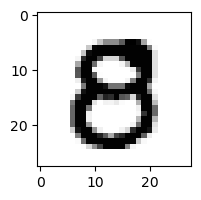

0.18828063318011895% - 0 - ОШИБКА
2.687352549218434e-10% - 1
1.9437130771593526e-05% - 2
0.0016900967301047174% - 3
8.75697907015056e-05% - 4
0.11154060326486956% - 5
1.1691600382179394e-09% - 6
8.11293416962335e-08% - 7
8.487238485729096e-08% - 8
8.074617738276594e-11% - 9

 8


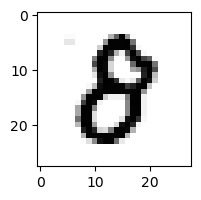

1.570489821739565% - 0 - ОШИБКА
6.365571662542979e-08% - 1
0.030879830238258837% - 2
0.006366627814096588% - 3
9.456610750859669e-06% - 4
0.06799819762485801% - 5
2.1088960851457026e-05% - 6
2.160916657342078e-06% - 7
1.1763155767049658% - 8
1.1981684255137108e-06% - 9

 8


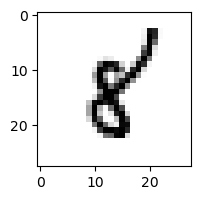

5.541586578908943e-05% - 0
61.62947979226959% - 1 - ОШИБКА
0.011568120046613683% - 2
1.9645351148356014e-05% - 3
2.5312242382979298% - 4
0.8541205397824847% - 5
6.97657759875104% - 6
0.005749119543431542% - 7
0.7634379902568877% - 8
0.00042853503605195896% - 9

 4


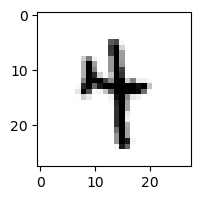

3.7841310114732088e-06% - 0
6.417325433822627% - 1
1.0879843037725804e-06% - 2
0.0011067499367207417% - 3
25.567779831151448% - 4
0.998313857309908% - 5
0.34848823369755905% - 6
0.03115456452918043% - 7
0.00027510409741382617% - 8
28.15303872746913% - 9 - ОШИБКА

 7


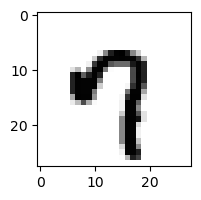

0.8339411691804636% - 0
4.924777009615669e-06% - 1
5.267898798715871e-08% - 2
1.6259859694351202e-06% - 3
0.9859628366528794% - 4
0.1499722521428987% - 5
0.0018768075930142487% - 6
11.20954120628466% - 7
1.1359499346616492e-09% - 8
99.70148773486646% - 9 - ОШИБКА

 8


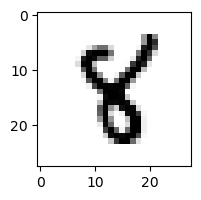

1.7040471723096033e-08% - 0
0.09198802771729919% - 1
2.0805413797557314e-05% - 2
5.1494198685238663e-05% - 3
12.778250578881625% - 4 - ОШИБКА
3.936673238328725% - 5
0.0016434061115605974% - 6
0.0007607163883652008% - 7
0.03284695992984846% - 8
4.677632556820897e-08% - 9

 3


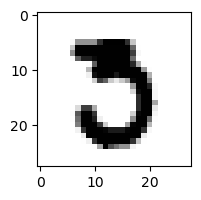

0.07069163693198345% - 0
2.1139734595508364e-08% - 1
0.018639793706614446% - 2
0.04548239208467488% - 3
1.864565080841959e-12% - 4
0.005619152438843478% - 5
2.6734436106609605e-08% - 6
0.42527363406379365% - 7 - ОШИБКА
1.0882468780549744e-06% - 8
3.700784968142925e-17% - 9

 2


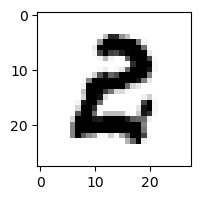

1.1373673833057607% - 0 - ОШИБКА
2.75680738287802e-05% - 1
0.0786160673522631% - 2
0.1519014888997521% - 3
1.5466644505580097e-09% - 4
0.0042917410422464615% - 5
0.002113428974979797% - 6
1.2926928878278943e-09% - 7
1.3158643103055026e-10% - 8
2.8029112537079366e-13% - 9

 1


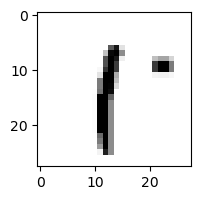

0.3265172534322024% - 0
0.5990818133389201% - 1
0.21127180916102722% - 2
0.06552915854814793% - 3
0.0011281878633823562% - 4
96.14754833104149% - 5
3.0445713438682858% - 6
0.003872479355231774% - 7
99.99991891791188% - 8 - ОШИБКА
17.365466094227454% - 9

 8


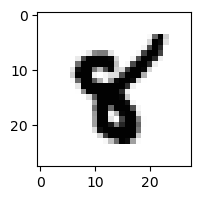

5.64547476532267e-09% - 0
0.01644092110345574% - 1
1.1802699714207641e-07% - 2
4.0378386225755405e-11% - 3
0.7291325355161263% - 4
1.4437188775678178% - 5 - ОШИБКА
0.0013288675856040647% - 6
5.942294920418532e-05% - 7
9.261817883047543e-06% - 8
4.839983403506286e-09% - 9

 8


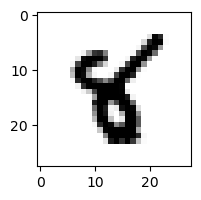

2.675981656150193e-08% - 0
0.06450542705313737% - 1
9.070623442767863e-08% - 2
4.0864739711716405e-08% - 3
1.638760376092849% - 4
8.019205193209125% - 5 - ОШИБКА
0.009091728297783552% - 6
1.5879061084760376e-05% - 7
1.0136518698587448e-06% - 8
7.418157523127583e-10% - 9

 8


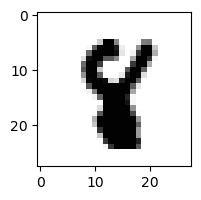

4.7344871372937664e-11% - 0
0.0009011391505328949% - 1
2.6649692161462784e-06% - 2
9.452597623765745e-10% - 3
0.014496722807382293% - 4
0.04702143680449389% - 5 - ОШИБКА
3.2686787499539755e-06% - 6
1.820463507301771e-05% - 7
0.0007205610256310353% - 8
2.7449371088294708e-11% - 9

 8


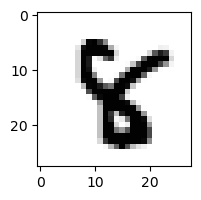

8.051346743177797e-12% - 0
1.8748417923021297e-06% - 1
5.0013645329081165e-06% - 2
1.0666272233168173e-06% - 3
1.5838019401074372% - 4 - ОШИБКА
0.6737531746939078% - 5
2.3072718344364767e-07% - 6
2.1641014520718254e-05% - 7
0.0010246989709769335% - 8
5.796454026462288e-12% - 9

 0


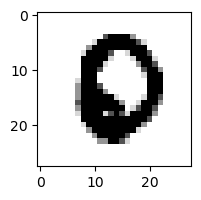

0.027958334913193477% - 0
8.480989807468601e-12% - 1
0.016388671328104565% - 2
4.628755495364436e-14% - 3
1.1330348753158428e-07% - 4
5.641771038109708e-06% - 5
1.403650367072407% - 6 - ОШИБКА
1.0726220738114964e-07% - 7
7.982816290939539e-09% - 8
4.8510703497109185e-17% - 9

 7


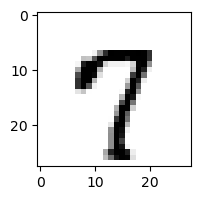

0.008751949559560941% - 0
1.8585398429224515e-05% - 1
3.234944334028132e-06% - 2
2.5855369668305124e-05% - 3
0.002510187049104736% - 4
1.0731953877758937% - 5
7.883000059431102e-05% - 6
92.87102266603915% - 7
0.009605523351618638% - 8
94.69567814222816% - 9 - ОШИБКА

 4


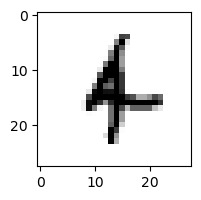

1.4555834788773532e-06% - 0
6.269051086278858% - 1 - ОШИБКА
0.001801325911264474% - 2
0.00815859050131509% - 3
3.1766873067208516% - 4
0.03318168553716658% - 5
1.612771096884202% - 6
0.0015593904134285066% - 7
1.5197386776597546e-06% - 8
0.004791259819451882% - 9

 8


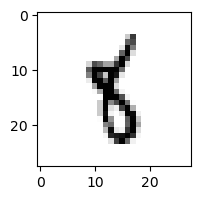

6.855592848679285e-05% - 0
1.4968355555183583% - 1
0.002282490897098215% - 2
0.0009763687822431705% - 3
0.07461050240107352% - 4
65.5840920480626% - 5 - ОШИБКА
13.539528613639968% - 6
0.00037167307071614083% - 7
26.095178579005275% - 8
0.011406512839931328% - 9

 8


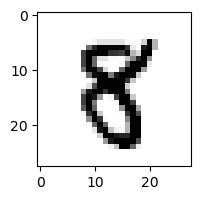

5.4886231715579364e-05% - 0
5.127454698423243e-05% - 1
1.7633052584259394e-05% - 2
0.0002023880506718328% - 3
0.002804892530432223% - 4
1.1989723244883645% - 5 - ОШИБКА
1.123881948547847e-06% - 6
2.446880294340127e-05% - 7
0.0007642322290960979% - 8
6.523463490565615e-08% - 9

 7


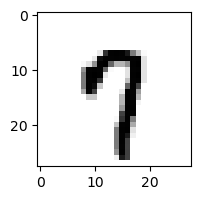

0.02336352493383112% - 0
0.0001511140162093441% - 1
1.9669110834041944e-05% - 2
0.0006024748989340638% - 3
0.46367051744859816% - 4
1.2008998155526098% - 5
0.015302412761320706% - 6
69.53538428949943% - 7
0.00027841267581601173% - 8
90.73184112092929% - 9 - ОШИБКА

 8


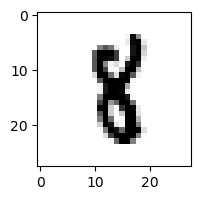

2.8471853800109246e-08% - 0
2.9493429845054866% - 1 - ОШИБКА
0.003920435100414419% - 2
0.003973329537358039% - 3
0.0016723135212457964% - 4
0.6004186245241534% - 5
0.005271565125639189% - 6
0.00025705879178578267% - 7
0.009142644150046118% - 8
1.354968330916147e-06% - 9

 7


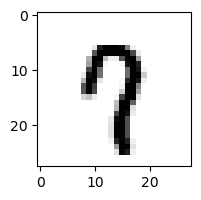

0.0026522886631252366% - 0
0.0006789411100491273% - 1
0.0005054310244978514% - 2
0.0013759377312321712% - 3
0.3060154968161272% - 4
0.08056885838192415% - 5
0.0018267092283216655% - 6
43.66202879067011% - 7
6.111291546046302e-05% - 8
48.43013466254228% - 9 - ОШИБКА

 3


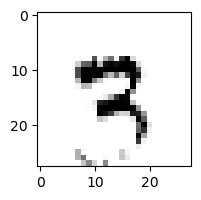

8.132571596579496e-06% - 0
1.3334035962326338% - 1
0.0018033558233829267% - 2
1.8171653641143754e-07% - 3
0.6041772880659191% - 4
0.00632327591071483% - 5
0.016429769144342844% - 6
46.353463377316636% - 7 - ОШИБКА
0.004167435526072414% - 8
1.4586405727233493% - 9

 5


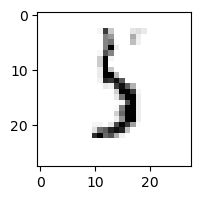

0.0021273692815234092% - 0
1.932134835970194% - 1
0.6870697058835087% - 2
77.9728558254418% - 3 - ОШИБКА
3.6802884169933563% - 4
15.092600261733546% - 5
38.63379229404461% - 6
0.2463032276833047% - 7
19.306549666544058% - 8
0.3069394010339268% - 9

 1


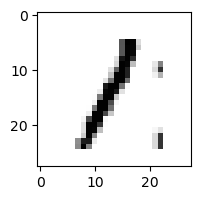

0.15533677209716365% - 0
83.25212998944288% - 1
11.591883493394358% - 2
3.1946651844351366% - 3
0.0002739067085821717% - 4
0.31408064084663095% - 5
0.1318595092710024% - 6
0.0004692753941119212% - 7
88.23021398340582% - 8 - ОШИБКА
0.9144743116211052% - 9

 8


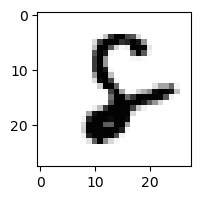

0.00012629902167339433% - 0
0.0005710494210746717% - 1
0.16898466717705324% - 2
8.241387946134768e-09% - 3
0.0005046087378190924% - 4
0.07489808508355784% - 5
12.000170655808816% - 6 - ОШИБКА
0.00024248314229828% - 7
3.162666922078712e-05% - 8
8.136227526865982e-15% - 9

 9


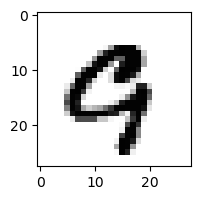

0.0009314926442860295% - 0
5.2324398647675826e-05% - 1
2.3273658698885517e-06% - 2
3.364785581432156e-11% - 3
0.0008095496774859692% - 4
9.118415118117318e-06% - 5
5.314135415141774e-06% - 6
3.522388519150926% - 7 - ОШИБКА
7.893518471070618e-14% - 8
0.001917155664822551% - 9

 9


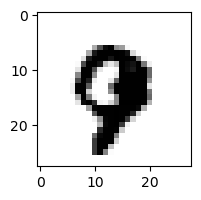

1.4016735684331467e-07% - 0
2.4877804741922636e-06% - 1
9.568458845488262e-08% - 2
5.296569223454708e-12% - 3
0.0006738622397037077% - 4
1.4329071357469753e-07% - 5
3.307402900267303e-06% - 6
3.9269243795055595% - 7 - ОШИБКА
9.508758563500066e-12% - 8
0.009736308564092595% - 9

 8


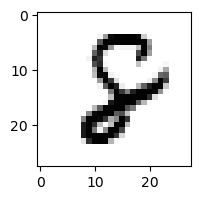

9.444113839700517e-05% - 0
0.0013522659828030085% - 1
0.15654735052880883% - 2
6.652929858610476e-10% - 3
0.0003234353432425918% - 4
0.0012133484557541254% - 5
0.2852133427801002% - 6 - ОШИБКА
0.00019111299838364115% - 7
0.008775536771570015% - 8
4.2092757928932375e-14% - 9

 9


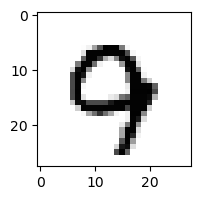

9.509480178260874e-05% - 0
3.941442970886339e-06% - 1
0.0010849463413150574% - 2
8.483456090008876e-09% - 3
1.3779808632547912% - 4
1.5221824125163474e-06% - 5
0.008508748242708399% - 6
20.44398092660575% - 7 - ОШИБКА
9.757002792206968e-09% - 8
1.029309572461137% - 9

 5


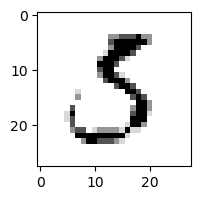

2.4788153192694136% - 0
0.022686917004581853% - 1
0.19845365503499313% - 2
78.2268111336173% - 3 - ОШИБКА
3.123420816765112e-07% - 4
29.446257531698077% - 5
0.010385828827438551% - 6
0.0001839727708397366% - 7
0.00017789698487797955% - 8
2.899099772759775e-07% - 9

 5


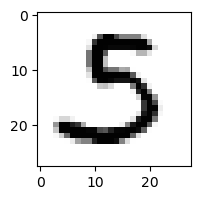

0.005934604186444906% - 0
0.00011199373699943951% - 1
0.016088046889361687% - 2
93.06276714162273% - 3 - ОШИБКА
3.345151703958428e-08% - 4
85.38423193279448% - 5
3.425066583212992e-05% - 6
1.604222183125397e-05% - 7
2.9883215565863976e-06% - 8
6.030223235912407e-17% - 9

 5


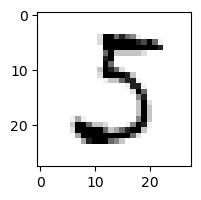

3.17591153460043% - 0
0.3135139188142295% - 1
0.7947362217711115% - 2
83.54388573430425% - 3 - ОШИБКА
1.983497164696855e-07% - 4
79.66515116221122% - 5
0.00029119858883305057% - 6
0.0006068701337565011% - 7
0.0009957477516254636% - 8
4.762054628044657e-12% - 9

 7


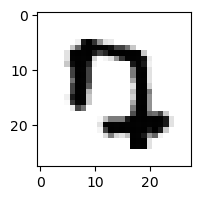

0.010079210564559495% - 0
9.907936206695474e-11% - 1
0.01961974588248706% - 2 - ОШИБКА
0.008850116963277437% - 3
2.6654877468106363e-05% - 4
0.015004537643330816% - 5
4.2274430979675154e-05% - 6
0.00226742855905827% - 7
4.2876000431524836e-17% - 8
4.557059330926341e-07% - 9

 4


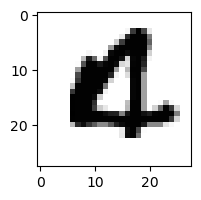

8.511630306290563% - 0 - ОШИБКА
2.979750065402979e-11% - 1
0.0029504832856198015% - 2
1.0814018396251381e-14% - 3
1.479024307236722e-08% - 4
0.0014640094706665318% - 5
0.02341375936324601% - 6
5.185745725088782e-08% - 7
3.625395831019028e-18% - 8
2.8752843588180875e-10% - 9

 5


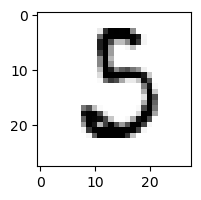

0.12059110998283433% - 0
0.03498960276316893% - 1
1.9891276528546133% - 2
1.0458821143687367% - 3
4.53411766532056e-09% - 4
0.009229866877819516% - 5
74.95466534951133% - 6 - ОШИБКА
0.0008342721704076385% - 7
5.14080018189442e-05% - 8
1.3026903972058756e-12% - 9

 5


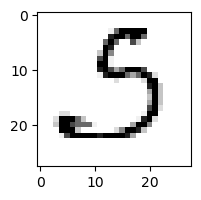

1.3443617570759554% - 0
0.07935910105426144% - 1
32.69174436418946% - 2
99.82276633604103% - 3 - ОШИБКА
1.8982745622889298e-07% - 4
0.014921398372852503% - 5
0.06150455719626% - 6
0.197691150395144% - 7
0.0003022901908489719% - 8
1.5504303881577245e-07% - 9

 3


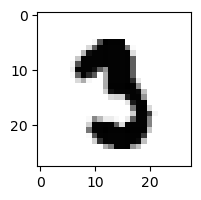

7.348592386342548e-08% - 0
8.908823824571227e-05% - 1
2.9553973978843743e-06% - 2
0.012507681543246437% - 3
1.4388001723900676e-10% - 4
0.8166509479509318% - 5 - ОШИБКА
4.4541212900097944e-07% - 6
0.00527808527283013% - 7
1.3783857973782541e-08% - 8
1.510180879325784e-13% - 9

 4


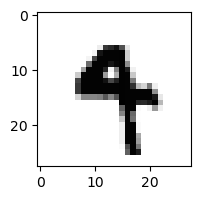

3.1113374310722584e-08% - 0
0.0015634618679622428% - 1
7.082029654877071e-10% - 2
0.00017209075414591454% - 3
7.548972608462017% - 4
0.4143257882972309% - 5
0.0038427310632334604% - 6
0.036028656858485726% - 7
5.951866155685988e-11% - 8
79.80055315104107% - 9 - ОШИБКА

 8


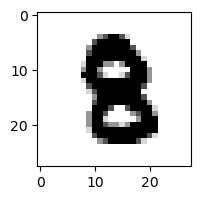

6.68479152588842e-09% - 0
8.347847304115765e-09% - 1
2.38508916237536e-05% - 2
4.897755074070551e-07% - 3
5.331378634641427e-08% - 4
3.397178037034386e-05% - 5 - ОШИБКА
2.9562069835006875e-07% - 6
4.2806035027743604e-10% - 7
1.3901097297666892e-08% - 8
5.617292504203973e-12% - 9

 8


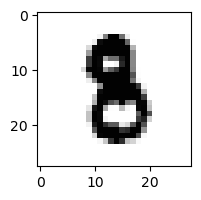

2.249724381868087e-08% - 0
0.002021297582039582% - 1
5.241069397927415e-05% - 2
0.0005266680402641128% - 3
3.348113578262448e-08% - 4
0.01531836071172253% - 5 - ОШИБКА
0.0002321389706006612% - 6
1.1751652324352592e-06% - 7
5.138928175979279e-06% - 8
1.9087050389625663e-10% - 9

 3


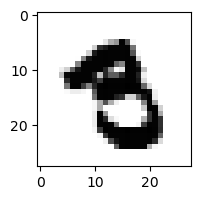

3.931434905409316e-09% - 0
1.3994090438746995e-05% - 1
2.7822324138640212e-11% - 2
1.3078283147508845e-07% - 3
2.2040051105226044e-07% - 4
1.8029298659467987% - 5 - ОШИБКА
2.266334379435581e-06% - 6
9.165265738468357e-08% - 7
4.4854616634059176e-10% - 8
9.5808777353326e-07% - 9

 8


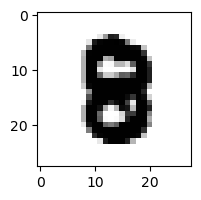

9.371389757922441e-08% - 0
1.4219288581889964e-09% - 1
2.2716482120199967e-06% - 2
2.5658649264671555e-06% - 3
8.596707131053067e-08% - 4
1.0910608691011073e-05% - 5 - ОШИБКА
3.1327729034844427e-06% - 6
3.456591295955195e-09% - 7
3.6210623283313815e-08% - 8
1.1850983112658785e-11% - 9

 8


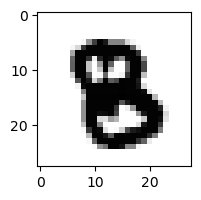

7.020518136562111e-10% - 0
5.487701245091681e-10% - 1
6.575775056138864e-06% - 2
1.9146038022542437e-09% - 3
1.0066408341787802e-05% - 4
2.3288667062128887e-05% - 5 - ОШИБКА
3.596611782187204e-09% - 6
4.241084994152327e-09% - 7
1.5650943635491112e-12% - 8
3.024416352259788e-14% - 9

 8


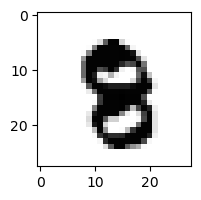

4.4146108822129204e-09% - 0
1.4585197653043814e-06% - 1
8.775294675743164e-05% - 2
5.157715302897322e-11% - 3
3.186513863277646e-05% - 4
0.0002012467838864382% - 5 - ОШИБКА
8.127874388679101e-07% - 6
2.2987582226814516e-05% - 7
2.3511539772181713e-05% - 8
4.0358062502595363e-07% - 9

 3


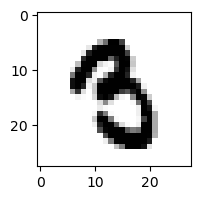

3.984487175921179e-08% - 0
0.0005381388674314696% - 1
1.0254970480360417e-08% - 2
0.0004212746689374462% - 3
7.077338852478797e-06% - 4
2.0024685222223817% - 5 - ОШИБКА
0.0006606644776461329% - 6
1.464724099621047e-06% - 7
9.183706212104014e-10% - 8
2.0096195924379134e-07% - 9

 4


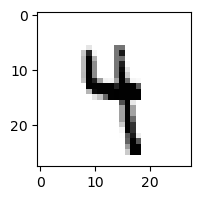

5.631286595653159e-07% - 0
0.9418643284137804% - 1
0.00013663306373801938% - 2
0.15167016746257042% - 3
59.66972061124935% - 4
0.823806741910135% - 5
0.2172713359381376% - 6
0.030234508550772386% - 7
0.009624313473245348% - 8
89.3153728925071% - 9 - ОШИБКА

 8


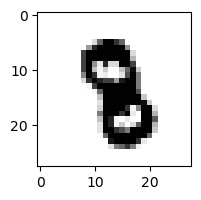

2.740442979991943e-12% - 0
0.0001827385512478994% - 1
8.490181951225838e-05% - 2
2.239575356012575e-06% - 3
0.0020419921034639937% - 4 - ОШИБКА
0.0006828502059232397% - 5
3.863560545153904e-06% - 6
1.356476189518133e-05% - 7
1.2744550482432188e-08% - 8
7.452197559007093e-10% - 9

 4


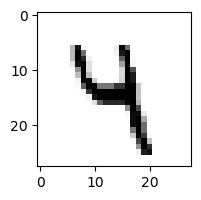

9.931314141590184e-08% - 0
0.02258644247864568% - 1
0.003427235652386907% - 2
12.722729963883387% - 3
83.72990728276531% - 4
0.18299555783632038% - 5
0.4942729062034341% - 6
0.007031635703912381% - 7
3.3753548529564036e-05% - 8
96.52449824873696% - 9 - ОШИБКА

 8


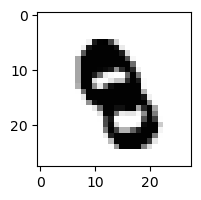

1.3075063834687816e-12% - 0
6.17408307760462e-06% - 1
3.0340322968605904e-05% - 2
5.006136595207976e-10% - 3
0.002741432796329667% - 4
0.0028808411468618815% - 5 - ОШИБКА
4.6550251209107925e-06% - 6
2.488625441813942e-05% - 7
8.552413905987419e-14% - 8
7.795991092166856e-08% - 9

 1


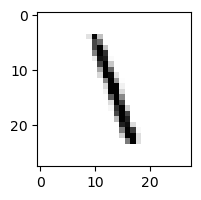

0.0014687527763305867% - 0
76.18446566901262% - 1
4.733895203587524% - 2
5.356762443435503% - 3
23.195397157112637% - 4
40.29113778290039% - 5
16.145520401111156% - 6
0.12350606287867669% - 7
92.52701770760265% - 8 - ОШИБКА
0.520405041145191% - 9

 4


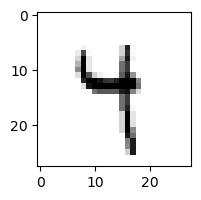

7.143579536160657e-05% - 0
3.413193054324458% - 1
1.1945997520457122e-05% - 2
10.284408420141828% - 3
95.21326393374189% - 4
2.6974003373569344% - 5
2.9396216723970343% - 6
0.08862633682521505% - 7
2.4535903816171465% - 8
99.3857083732591% - 9 - ОШИБКА

 3


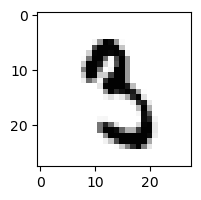

9.124464268567727e-06% - 0
0.1204584619324346% - 1
0.0005111556693377894% - 2
6.7661799331782335% - 3
8.53358120852224e-05% - 4
24.69381178599509% - 5 - ОШИБКА
0.0006406961893571535% - 6
0.0011592173123609669% - 7
8.199081577655256e-05% - 8
2.1637894681307213e-05% - 9

 8


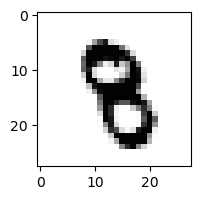

5.183159646294682e-10% - 0
0.000647500255322501% - 1
0.0036832125052636165% - 2
0.0012773221544538492% - 3
0.009829406151083535% - 4 - ОШИБКА
0.00354129207938052% - 5
2.014432202374045e-05% - 6
0.00021447903917738584% - 7
3.744085322926865e-08% - 8
0.0001663320083021786% - 9

 3


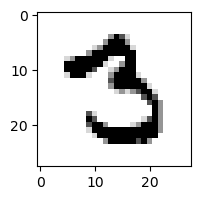

0.001416228504628791% - 0
5.2510893046414275e-05% - 1
0.09261557865060593% - 2
0.634177671815326% - 3
4.6918362490245e-09% - 4
3.413161525088318% - 5 - ОШИБКА
1.4515714195212884e-06% - 6
0.008097250752914576% - 7
1.0568068181906557e-05% - 8
5.457520465212175e-11% - 9

 3


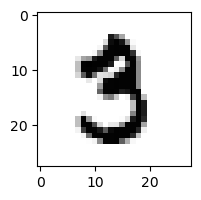

8.528521101423492e-05% - 0
0.0006996330730860957% - 1
0.0003444873833898024% - 2
0.606839850597004% - 3
4.815048142995742e-09% - 4
5.850589378982959% - 5 - ОШИБКА
6.112868210624354e-06% - 6
0.0001264570045108004% - 7
0.0016230352806694136% - 8
2.699793263704051e-09% - 9

 2


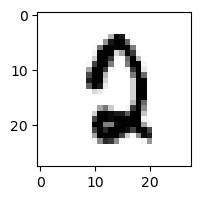

0.14258684062721505% - 0
5.359401569611999e-07% - 1
0.2159180575748902% - 2
2.623096992104196e-06% - 3
5.7966069884472944e-06% - 4
0.9878526147883713% - 5 - ОШИБКА
0.16058070403617175% - 6
0.007495241749146149% - 7
1.955484167832149e-05% - 8
2.37312385436649e-08% - 9

 4


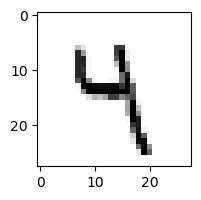

2.673448947460368e-05% - 0
0.5490481915247208% - 1
0.001744625324764956% - 2
35.31970391155614% - 3
72.73287895664593% - 4
4.864097612302907% - 5
2.7082183439817604% - 6
0.012502806278901228% - 7
0.00010280667085321085% - 8
99.92930769854905% - 9 - ОШИБКА

 5


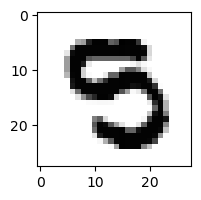

2.6576838788220456e-06% - 0
8.513457258250871e-09% - 1
1.4331378066002315e-06% - 2
0.2672000164242373% - 3 - ОШИБКА
1.2908110338088336e-06% - 4
0.10055287990494433% - 5
2.5386409026642345e-07% - 6
4.973243766776831e-09% - 7
7.233963727573815e-12% - 8
1.9007332173232945e-11% - 9

 3


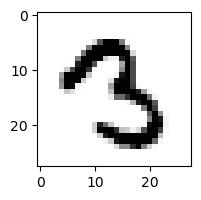

8.283047371468207e-07% - 0
0.00011048421137194693% - 1
0.00027918812389724683% - 2
0.28054029256484053% - 3
8.153652864102254e-05% - 4
2.2678325398025962% - 5 - ОШИБКА
1.7421302899623854e-06% - 6
0.00795372328356501% - 7
3.814179454067756e-09% - 8
2.3476195974594018e-07% - 9

 8


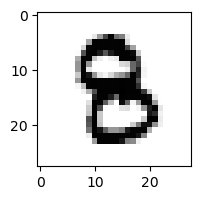

8.345418898044101e-06% - 0
1.4037961299431958e-06% - 1
3.0130417972591477e-06% - 2
0.07275967715838075% - 3 - ОШИБКА
6.42159782966316e-05% - 4
0.028950249442987602% - 5
8.770731187613238e-06% - 6
4.507580386088075e-08% - 7
1.0005707515848043e-06% - 8
2.672280629224884e-09% - 9

 3


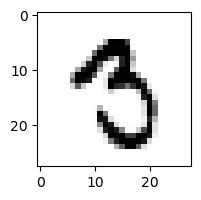

0.0010914799894355303% - 0
0.01414060219586598% - 1
4.95282684601732e-06% - 2
0.004265321251089046% - 3
1.5126190711085311e-06% - 4
3.3287746484551226% - 5 - ОШИБКА
0.00033683237342860186% - 6
0.01833021312010234% - 7
0.00015739495288455367% - 8
0.0002673997544271628% - 9

 3


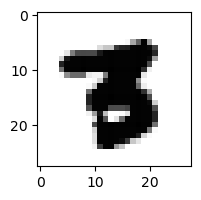

2.0130316440890395e-11% - 0
1.3740755212917493e-07% - 1
1.6063827146199987e-07% - 2
1.1195168033495068e-08% - 3
5.57795473906991e-10% - 4
0.0005452948524314955% - 5 - ОШИБКА
4.089750075626153e-10% - 6
2.317313994765175e-05% - 7
6.7285727273885406e-15% - 8
6.90861300708396e-17% - 9

 9


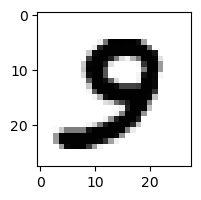

5.244578070594418e-05% - 0
1.0417367280236309e-09% - 1
2.7100430652318063e-07% - 2
0.07699935951431808% - 3
1.218037943603914e-05% - 4
0.25559151934280694% - 5 - ОШИБКА
3.1644683123214843e-07% - 6
0.00013095579794119265% - 7
1.7913225582549925e-06% - 8
9.171258989976292e-10% - 9

 3


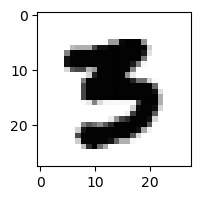

3.240268876416711e-07% - 0
1.2845300179648342e-09% - 1
3.981105142807416e-10% - 2
0.0667920971747007% - 3
7.572344287282156e-11% - 4
1.5910886472932806% - 5 - ОШИБКА
5.745928057942993e-08% - 6
8.742538473575249e-06% - 7
9.05394796450368e-18% - 8
7.193668079705559e-18% - 9

 8


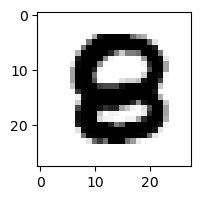

6.121071489871651e-07% - 0
1.5471994991039857e-13% - 1
0.0001794363459434061% - 2 - ОШИБКА
2.7198981446181304e-13% - 3
1.0339856920881166e-07% - 4
4.19499518553399e-05% - 5
1.3283684306706658e-06% - 6
3.505163733119078e-13% - 7
1.2952637932342674e-10% - 8
4.028002388897854e-21% - 9

 9


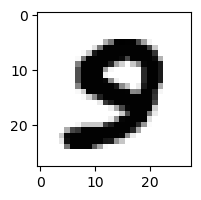

1.4800842187544977e-05% - 0
2.3700650975695925e-11% - 1
6.319824577877345e-11% - 2
1.1787356027637294e-05% - 3
3.9854875048485563e-07% - 4
0.02849703182865421% - 5 - ОШИБКА
3.829487074705758e-08% - 6
8.745050826748047e-06% - 7
5.301690347511643e-10% - 8
1.9399811712004107e-12% - 9

 9


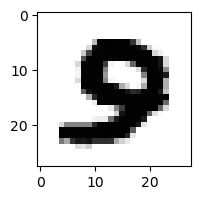

4.038317439914074e-05% - 0
3.767334031274821e-12% - 1
1.1885671045444397e-08% - 2
4.680562759936818e-06% - 3
4.2081079741268496e-08% - 4
0.0004301594581903715% - 5 - ОШИБКА
4.431095806347047e-08% - 6
6.241898283755146e-07% - 7
3.201980010367244e-13% - 8
1.6048793202217325e-17% - 9

 2


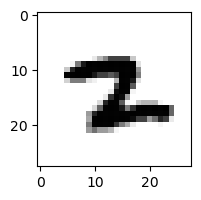

7.473469972005299e-09% - 0
0.3149967299361398% - 1
0.006229751453266417% - 2
1.3768872657874526e-10% - 3
7.464939164851423e-08% - 4
0.004090529214231248% - 5
0.23848763568198916% - 6
0.9567038343021201% - 7 - ОШИБКА
1.4939702734353575e-09% - 8
6.990304506065552e-08% - 9

 9


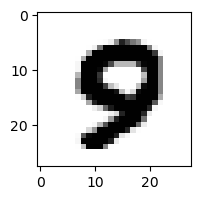

0.00019977810597031172% - 0
3.1267433817317646e-12% - 1
2.668961796542678e-09% - 2
1.9992370186038446e-09% - 3
8.61890725111562e-05% - 4
0.011511326942060408% - 5 - ОШИБКА
7.806915749627453e-07% - 6
0.0003040553421536067% - 7
3.9717725415331684e-10% - 8
2.8080207515783588e-08% - 9

 9


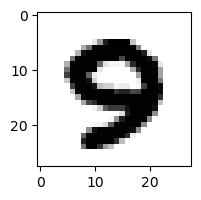

1.5224590628979967e-05% - 0
7.153420689779685e-14% - 1
3.027436946200463e-09% - 2
2.1487804597333734e-07% - 3
5.009601965257927e-06% - 4
2.9104833939907057e-05% - 5
5.870972318557494e-08% - 6
0.00016390982258011964% - 7 - ОШИБКА
3.458762841972265e-14% - 8
4.668575245727326e-13% - 9

 9


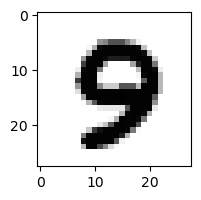

0.000193948443380258% - 0
1.6368780848551364e-11% - 1
1.6225278820533635e-08% - 2
3.304789462939964e-05% - 3
7.550567248658385e-05% - 4
0.0021705381389052767% - 5 - ОШИБКА
8.076454504602459e-06% - 6
0.00010820827377657016% - 7
7.857019361803191e-10% - 8
3.1756053827254046e-07% - 9

 8


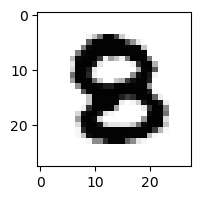

3.3324699582325922e-06% - 0
4.437226870485991e-11% - 1
0.0011662809894644524% - 2
2.181303897503101e-07% - 3
2.2141959302096945e-08% - 4
0.0011941310092063457% - 5 - ОШИБКА
3.0492051907318866e-07% - 6
1.5642616238238375e-10% - 7
7.041473296798242e-08% - 8
6.303631799650115e-14% - 9

 8


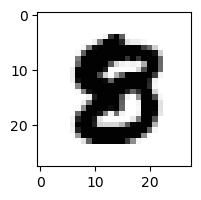

3.272688869649866e-07% - 0
9.91640319009782e-11% - 1
1.3424283948980353e-08% - 2
2.9228620594631124e-11% - 3
3.9104706219593715e-10% - 4
0.0007841185381858326% - 5 - ОШИБКА
1.6409012739757703e-09% - 6
7.319526643137243e-10% - 7
2.6074304685156206e-05% - 8
6.615596188191127e-15% - 9

 9


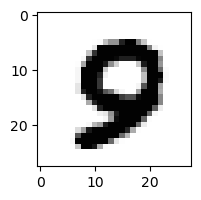

0.00025408448943932394% - 0
9.080887547741338e-12% - 1
2.0454992319654587e-07% - 2
2.022176396556277e-09% - 3
1.5404613371765404e-05% - 4
0.005366102283883447% - 5 - ОШИБКА
3.929804902346867e-06% - 6
0.00025505967497718604% - 7
1.3440437811271512e-10% - 8
4.2103359170751426e-11% - 9

 3


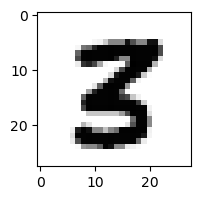

5.493497402845534e-08% - 0
8.950806812395958e-06% - 1
0.002125933925730413% - 2 - ОШИБКА
0.0009516976231792153% - 3
6.464861984688585e-07% - 4
0.000869170698458091% - 5
1.73822786307327e-13% - 6
1.81895487062592e-07% - 7
9.371082601813921e-09% - 8
5.890811891542329e-16% - 9

 8


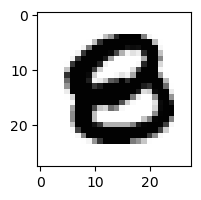

1.5026741743198594e-05% - 0
1.5267100974218793e-12% - 1
2.7294133224466008e-05% - 2
2.9470919431378897e-13% - 3
1.5871785354231592e-07% - 4
3.5623564322713824e-05% - 5 - ОШИБКА
1.6191223489357206e-07% - 6
1.612985328516062e-14% - 7
9.003697360961399e-10% - 8
2.0485752340370076e-18% - 9

 9


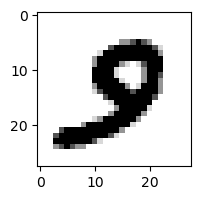

2.9754669546164676e-05% - 0
3.8091191985625773e-07% - 1
2.2227501536229574e-07% - 2
0.0002447921914424629% - 3
2.3959037882814113e-07% - 4
0.004907030605622692% - 5 - ОШИБКА
3.5677406788158376e-07% - 6
0.0010290407103984804% - 7
1.1446080784157132e-10% - 8
4.655381167998561e-10% - 9

 9


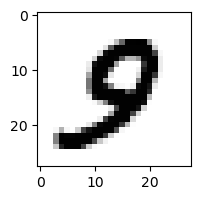

0.00014739306325229197% - 0
1.6508662839026548e-07% - 1
5.457773082155552e-05% - 2
0.00018103683666747928% - 3
0.0008542166081857328% - 4
0.7728957110304675% - 5 - ОШИБКА
3.911597900220565e-06% - 6
0.0038559047514341483% - 7
4.5004793533101886e-08% - 8
3.7403415763663915e-05% - 9

 9


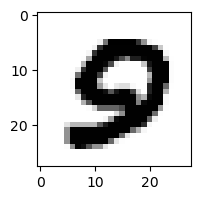

0.0002100857633678026% - 0
4.9108386702532576e-11% - 1
5.2493746212962015e-09% - 2
7.846167617034693e-09% - 3
8.139170424254903e-08% - 4
0.0017634878151175286% - 5 - ОШИБКА
6.797683763078335e-07% - 6
2.005766587321577e-07% - 7
2.0144275329826606e-13% - 8
7.020879432577831e-17% - 9

 9


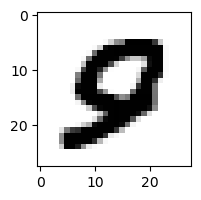

0.005065296396188347% - 0 - ОШИБКА
1.470339630379704e-10% - 1
6.428285686790676e-06% - 2
4.655932354992602e-13% - 3
0.00016826023987615745% - 4
0.0015159019792744606% - 5
9.752593453847744e-06% - 6
0.0007826790473573028% - 7
2.7966767519814084e-13% - 8
3.6126251842438297e-09% - 9

 3


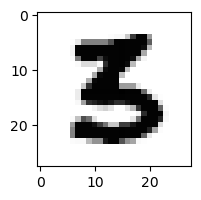

1.2094245730215355e-06% - 0
6.406167299092105e-08% - 1
0.0004227110975976693% - 2
0.7296546511098603% - 3
7.725802582808771e-11% - 4
2.8174125660204665% - 5 - ОШИБКА
1.5661100081994333e-06% - 6
2.6965201469935123e-11% - 7
3.751988130722458e-18% - 8
1.191145586133663e-20% - 9

 8


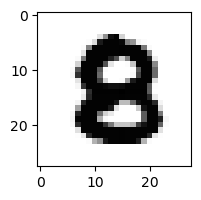

2.693516984367754e-05% - 0
2.491971309032552e-12% - 1
0.0011061507037850372% - 2 - ОШИБКА
3.3046910715615214e-10% - 3
1.3720221999656968e-08% - 4
0.0005624982207108469% - 5
3.262223213525469e-07% - 6
7.346208997834295e-11% - 7
9.027139667567483e-08% - 8
1.0040092104547129e-13% - 9

 8


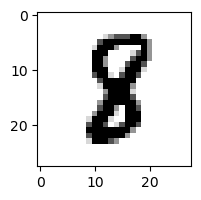

5.159735789079352e-08% - 0
0.012874174023560538% - 1
0.00331265736930598% - 2
5.920194643351216e-06% - 3
5.781257058658729e-06% - 4
0.044864035304928315% - 5 - ОШИБКА
2.0422719978375064e-05% - 6
3.396547948684658e-06% - 7
0.0030497698995994547% - 8
7.678498762689559e-16% - 9

 8


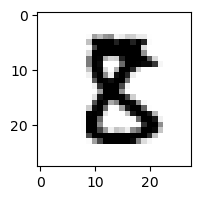

2.0960976894744483e-05% - 0
1.626153363920708e-05% - 1
0.04375967801372114% - 2
0.003311956518864033% - 3
5.403355660485892e-09% - 4
0.7628280780134716% - 5 - ОШИБКА
1.07572134101472e-09% - 6
1.7384146700182918e-09% - 7
0.00043839982784145464% - 8
4.740057133538203e-12% - 9

 8


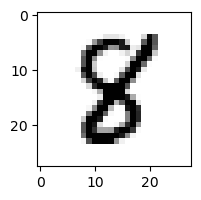

2.449449031860783e-06% - 0
0.0002629700997923658% - 1
0.0007864791268125499% - 2
2.0766736090555775e-05% - 3
0.0011729815831752525% - 4
0.45419410045359626% - 5 - ОШИБКА
1.3420604586192342e-05% - 6
3.949452559609728e-06% - 7
0.377048806185439% - 8
1.7992178167129555e-12% - 9

 9


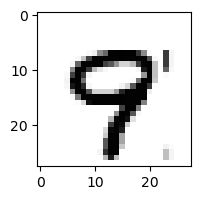

3.956154953198882e-05% - 0
7.680643952598618e-08% - 1
2.9106486909493646e-06% - 2
3.96728577904076e-08% - 3
0.035323217776815345% - 4
0.20954174772056292% - 5
1.8910055980703675e-05% - 6
7.147808792582865% - 7 - ОШИБКА
3.6920173866991725e-07% - 8
3.4168916093367354% - 9

 8


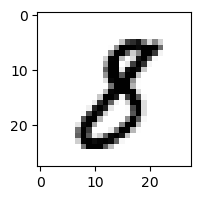

0.00024843273400883584% - 0
1.0679478663296686% - 1 - ОШИБКА
0.0011296899142832853% - 2
0.26221762508144886% - 3
7.548930199750001e-08% - 4
0.014944315966281969% - 5
9.290096680616476e-07% - 6
0.0004190152497316664% - 7
0.00988790451114272% - 8
1.1108318842641746e-08% - 9

 8


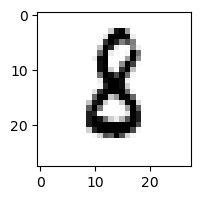

0.000265245812946104% - 0
0.17854707984913526% - 1
0.41392101250252455% - 2
0.13061882242331763% - 3
1.6510098412866342e-06% - 4
0.19582871483109368% - 5
10.139487593805319% - 6 - ОШИБКА
5.748313858951494e-06% - 7
0.0006604763244689738% - 8
3.2784725573286942e-09% - 9

 8


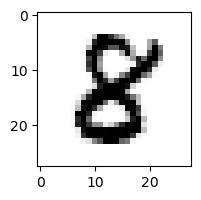

3.499546724159773e-05% - 0
1.9406860355117461e-07% - 1
0.022944453732913372% - 2
0.00039902337941407126% - 3
0.00011667570353431024% - 4
0.06678965187319155% - 5 - ОШИБКА
2.0774770304310767e-07% - 6
1.2715372225779545e-08% - 7
0.03484371681237198% - 8
7.046034511851713e-14% - 9

 5


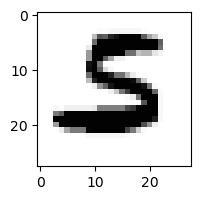

2.924617300309571e-06% - 0
6.215848979434357e-08% - 1
1.9373230853426535% - 2 - ОШИБКА
1.6851521769427314e-07% - 3
9.029580422368368e-13% - 4
0.938816211592303% - 5
1.453356782959942% - 6
1.6287115158710312e-09% - 7
4.5418344672273674e-14% - 8
1.1068560344426368e-18% - 9

 2


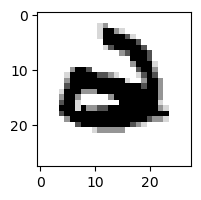

1.0991626343246417e-05% - 0
3.129823887751988e-10% - 1
1.7321694009850878e-09% - 2
1.446718781168254e-13% - 3
1.6954155493049084e-06% - 4
7.425431214185922e-09% - 5
0.01866139921792144% - 6 - ОШИБКА
1.1986779805671593e-10% - 7
2.134055960530925e-16% - 8
1.6875057938473251e-12% - 9

 5


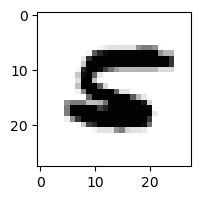

6.225436135969308e-05% - 0
2.354508253337337e-08% - 1
0.42099592118695184% - 2 - ОШИБКА
4.0774681616440326e-15% - 3
1.3713662449515685e-06% - 4
0.2012442974304536% - 5
4.678455793102408e-06% - 6
7.008277724456822e-05% - 7
2.4404112859349805e-11% - 8
3.52263996986236e-10% - 9

 0


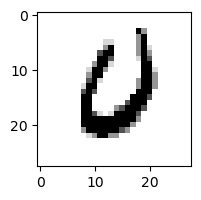

26.529647943777736% - 0
1.2992374373694141e-08% - 1
0.3230874068309507% - 2
3.0383020375241255e-08% - 3
0.008552981842996406% - 4
0.050731130809331226% - 5
56.4451185302812% - 6 - ОШИБКА
0.18438745225799003% - 7
2.665069888266092e-07% - 8
3.473184963260817e-06% - 9

 2


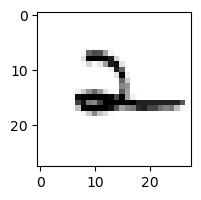

0.0016381234557774416% - 0
0.6546610821689263% - 1
98.87112410742886% - 2
0.01133857763844074% - 3
99.05539615033445% - 4 - ОШИБКА
0.002028875850093852% - 5
29.74808493777317% - 6
10.623724598343975% - 7
0.0009010936803759375% - 8
7.222922126114273% - 9

 3


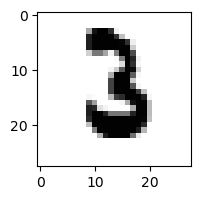

1.3568594284185097e-07% - 0
0.015073653119828797% - 1
5.76609584669551% - 2 - ОШИБКА
0.12388462256491851% - 3
6.497823702208888e-10% - 4
6.729682710921206e-06% - 5
0.12890244104910917% - 6
7.3782978185271125e-06% - 7
7.534768103641717e-13% - 8
1.363062757390644e-12% - 9

 6


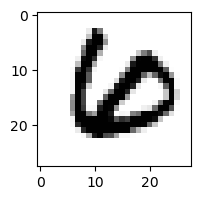

5.275469322353406e-06% - 0
6.125240523256936e-07% - 1
0.026563032455499853% - 2 - ОШИБКА
8.612143928814664e-09% - 3
2.759891807361856e-08% - 4
1.2168417683751424e-08% - 5
0.0013922781405273723% - 6
4.829381431306333e-06% - 7
2.569304539384108e-08% - 8
4.256287106915678e-17% - 9

 0


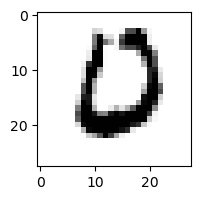

14.74215963788718% - 0
4.788905819288104e-09% - 1
2.6056434008787677% - 2
2.4235854077457255e-09% - 3
4.725961739802531e-06% - 4
0.006631977587923684% - 5
98.59236299922439% - 6 - ОШИБКА
6.077062697158153e-05% - 7
7.613243647018485e-10% - 8
4.9317315727736995e-15% - 9

 0


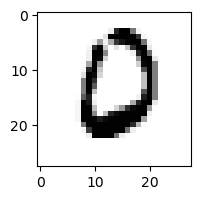

11.439832493713407% - 0
1.6980579347805294e-08% - 1
0.43582994859573754% - 2
2.052212647068375e-07% - 3
6.752641140704135e-05% - 4
0.07201751290013467% - 5
47.72823530731397% - 6 - ОШИБКА
0.0027062146792444287% - 7
1.3794563546037773e-08% - 8
2.3902226777482605e-12% - 9

 3


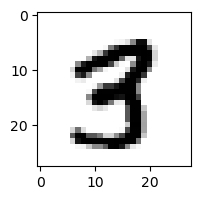

2.3501558159155963e-05% - 0
3.535995340002006e-05% - 1
0.00011308980169983209% - 2
0.16508617803558934% - 3
3.325540527925878e-05% - 4
0.34267613171642125% - 5 - ОШИБКА
2.2150253558005525e-09% - 6
0.00039117993943676527% - 7
0.0370950270273651% - 8
5.0472209967717936e-05% - 9

 3


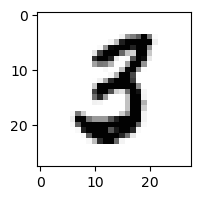

0.005791914485105012% - 0
0.00011969669354559201% - 1
0.28141599533302236% - 2
2.9678105085094386% - 3
7.86683829776204e-08% - 4
14.611068278075145% - 5 - ОШИБКА
0.0011305243382375469% - 6
3.219651856236049e-06% - 7
1.6139222953252167e-08% - 8
3.2559051596599938e-12% - 9

 3


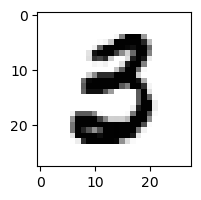

0.514189458569622% - 0
6.8115168924903455e-06% - 1
1.3323930592269598e-06% - 2
3.246817269211494% - 3
1.6844551862516686e-09% - 4
17.220064420672745% - 5 - ОШИБКА
0.00016342640713029743% - 6
7.837750762387972e-08% - 7
3.0883707428494545e-11% - 8
3.138955231625918e-17% - 9

 8


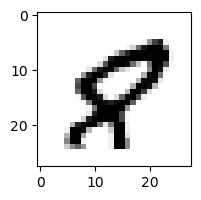

0.007193911973566976% - 0
2.7685694078764203e-05% - 1
6.596656057066918e-08% - 2
4.2361017109208366e-14% - 3
0.0047926481144881985% - 4
0.025627105804063695% - 5
2.2897700568827954e-06% - 6
0.06490204755674399% - 7 - ОШИБКА
7.11425634699345e-08% - 8
3.003440862111887e-07% - 9

 3


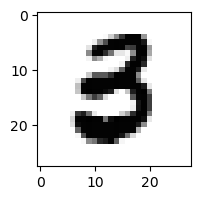

0.010319394771869198% - 0
8.736919518763024e-07% - 1
5.036447621547582e-07% - 2
0.3702379195580322% - 3
4.279874838243322e-08% - 4
11.223905462067309% - 5 - ОШИБКА
0.0007537104134373817% - 6
9.397111437712276e-09% - 7
8.918824447228921e-15% - 8
1.0222099428104885e-18% - 9

 9


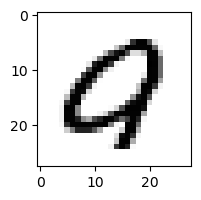

6.825522469715255% - 0 - ОШИБКА
8.551139599816882e-08% - 1
0.0017715685370480586% - 2
1.4620119770053749e-10% - 3
6.116495683970217e-05% - 4
0.46461949108230177% - 5
0.004564651164559006% - 6
0.00695997674651176% - 7
1.4969833062069314e-08% - 8
1.8199869024755996e-08% - 9

 9


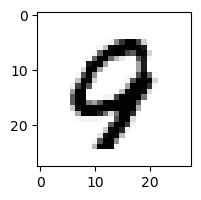

0.00763893245314751% - 0
8.192704790099971e-07% - 1
0.006333822214779221% - 2
1.2896124486113035e-12% - 3
1.791419528057495% - 4 - ОШИБКА
1.2776717714793589e-06% - 5
0.004109910778675485% - 6
0.0029582590068598013% - 7
0.04248018806357603% - 8
0.41395928222518197% - 9

 3


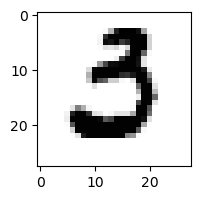

2.885929434389283% - 0 - ОШИБКА
1.855133365764959e-05% - 1
0.0027605480176918426% - 2
0.0008398580252133599% - 3
8.399328299579266e-13% - 4
0.032049446086569656% - 5
0.022823689869845756% - 6
0.0004981649010975038% - 7
1.3577703478896243e-13% - 8
7.508550219367819e-19% - 9

 2


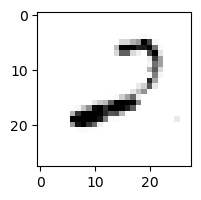

14.811469851807832% - 0
0.20947962220675773% - 1
99.88653459555078% - 2
6.191281950152262e-07% - 3
3.5403184316519933% - 4
0.0401614005377412% - 5
14.950139777945044% - 6
0.07890488071666633% - 7
99.99208193645127% - 8 - ОШИБКА
0.46654189213060343% - 9

 8


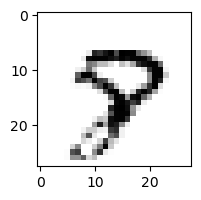

0.0003687257777738556% - 0
2.275631478268087e-06% - 1
1.3256465960061909e-06% - 2
2.64666830518184e-07% - 3
0.07029592647631104% - 4
0.02998141494775615% - 5
5.371346614526626e-05% - 6
23.654414525547% - 7 - ОШИБКА
5.932070373996576e-05% - 8
0.13222647655574746% - 9

 9


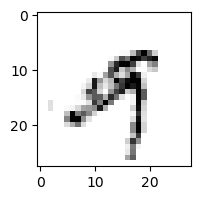

0.01916177823975033% - 0
0.11246652124102823% - 1
0.00969630715039021% - 2
15.705711307465931% - 3 - ОШИБКА
0.7365038904776399% - 4
0.09392141955239454% - 5
0.000641928879775185% - 6
0.04105331696894145% - 7
0.00016256964029668584% - 8
0.9456465575210848% - 9

 7


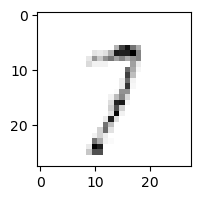

1.5542115916798385% - 0
7.962674341254604% - 1
48.96046936233139% - 2
71.8366815641856% - 3
2.0376502929986584% - 4
5.53795991235351% - 5
2.0550771189108548% - 6
87.11640269696302% - 7
34.641654046773205% - 8
99.88927515596804% - 9 - ОШИБКА

 3


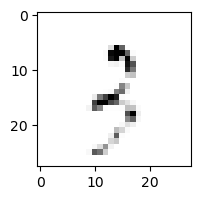

1.2979609852743803% - 0
19.06054097723983% - 1
81.0688741763231% - 2
83.71640335886931% - 3
0.2625834457797837% - 4
3.5370589163294% - 5
8.667337873430673% - 6
6.952056707693965% - 7
87.80098304495483% - 8
99.98888153613457% - 9 - ОШИБКА

 1


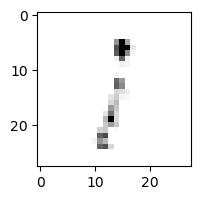

20.754672984137112% - 0
54.17225002178502% - 1
83.57569695230607% - 2
60.7412431242814% - 3
3.604186442831113% - 4
39.909621376298134% - 5
39.80590815335237% - 6
2.9772076053101095% - 7
99.52315877698881% - 8 - ОШИБКА
98.40039115628934% - 9

 2


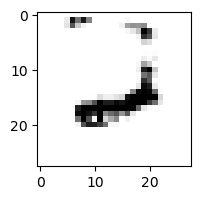

0.017785755741042058% - 0
0.007014880594308314% - 1
85.56925266194598% - 2
1.4536934488226638e-07% - 3
90.88476616223518% - 4
1.98154586580867e-05% - 5
99.70483644997313% - 6 - ОШИБКА
0.5835800610731532% - 7
0.2810268741941783% - 8
0.17679598263890478% - 9

 7


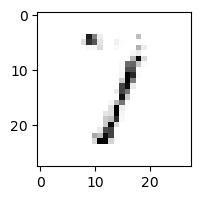

0.10930271146930746% - 0
48.30058969558768% - 1
57.65695541554727% - 2
94.02344158884056% - 3 - ОШИБКА
74.41324859451197% - 4
2.910947697410686% - 5
2.536285475719609% - 6
87.22510872337064% - 7
80.2578688818207% - 8
18.052124600944026% - 9

 7


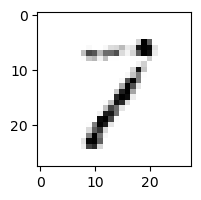

0.12119960822060938% - 0
31.793554207777902% - 1
67.28671055466218% - 2 - ОШИБКА
0.7160960515919859% - 3
6.090342220513% - 4
4.059808075400809% - 5
2.3639193706355597% - 6
21.60300542029685% - 7
60.15632110002578% - 8
0.4068889280943017% - 9

 0


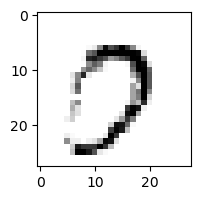

30.4643889485695% - 0
3.506129420559928e-07% - 1
0.012116219653546543% - 2
5.357781569262018% - 3
0.00034592375287381086% - 4
0.1345928613916591% - 5
0.0002314694898498209% - 6
98.85723406977091% - 7 - ОШИБКА
0.0017286600588096806% - 8
94.12082685436967% - 9

 5


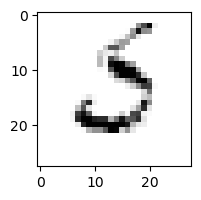

5.589286133037079% - 0
0.06288685755780729% - 1
60.89343812098461% - 2
5.852945486420475% - 3
2.7148280850370284e-06% - 4
0.029948479270405715% - 5
91.00736808308874% - 6 - ОШИБКА
8.938666912460889% - 7
2.5538544174850428e-06% - 8
2.4277899062242082e-06% - 9

 8


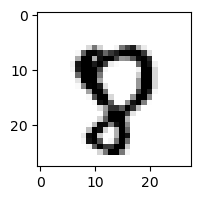

0.00176320762362449% - 0
1.4749941256736242e-09% - 1
2.1499680326122378e-06% - 2
5.584912472250617e-10% - 3
0.002500004638645371% - 4
6.175239777141941% - 5
0.0002517512627704389% - 6
21.54939225497951% - 7 - ОШИБКА
8.263209103945556e-06% - 8
0.0641708625143382% - 9

 8


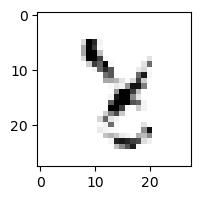

2.2764284867855387e-05% - 0
0.3180344933144279% - 1
3.3801950556264613% - 2
0.032791197161789756% - 3
93.41410693334666% - 4 - ОШИБКА
1.307664619804321% - 5
0.06224729836449551% - 6
58.70703539960278% - 7
71.64858586937474% - 8
0.0019217580846846633% - 9

 9


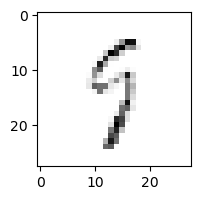

1.3286942401758688% - 0
0.5359549172184257% - 1
11.513499258869132% - 2
18.970405062049775% - 3
13.639889448973989% - 4
47.26698365960917% - 5
9.422751581150107% - 6
2.6686140089002093% - 7
98.11096086327257% - 8 - ОШИБКА
75.21800789741849% - 9

 8


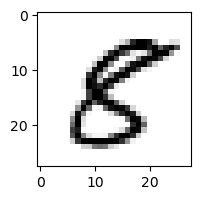

0.01739078584139354% - 0
0.00039656319449906123% - 1
6.269451951513507e-05% - 2
9.613085782499848e-06% - 3
0.00965419890464115% - 4
88.70288734598583% - 5 - ОШИБКА
3.307745701756995e-08% - 6
5.230492393282012e-07% - 7
0.0009000003540710597% - 8
9.02133869706888e-09% - 9

 0


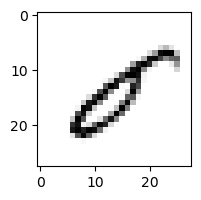

0.5608394266604793% - 0
0.2922512483810584% - 1
71.83173213608875% - 2 - ОШИБКА
0.1687307460906691% - 3
7.045684091990529% - 4
11.391543262537454% - 5
0.0026074386700477973% - 6
0.008566261949105427% - 7
2.770790186055111% - 8
0.004504319784007503% - 9

 1


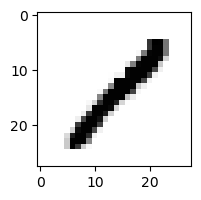

0.00045278505087405284% - 0
53.787597095626616% - 1
0.5569426539032178% - 2
0.01029377343790514% - 3
0.19345556298168262% - 4
0.0037356376614754196% - 5
3.137816977469265e-05% - 6
0.025154774088010402% - 7
98.75775279852272% - 8 - ОШИБКА
8.599534559202942e-05% - 9

 1


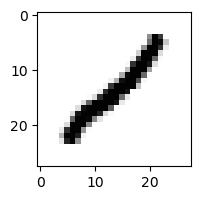

0.010645649257121215% - 0
59.79773116857765% - 1
36.192793619568455% - 2
0.13031436099496468% - 3
8.18736524158989% - 4
0.0030552262954461865% - 5
0.0035014138843745507% - 6
0.0005860513576813706% - 7
98.0671644623064% - 8 - ОШИБКА
0.04964401941086028% - 9

 9


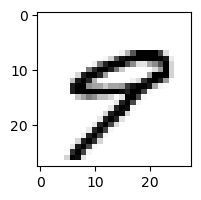

0.1007936185589904% - 0
0.00025691840094725285% - 1
1.2450671744336095e-08% - 2
1.2672895151535418e-08% - 3
4.778304300692671% - 4 - ОШИБКА
0.1536942626592553% - 5
6.603594144860779e-05% - 6
2.2513481080561153% - 7
1.7043902065140442e-06% - 8
0.9384365215448403% - 9

 1


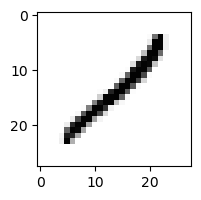

0.09716433740926361% - 0
64.40517326337901% - 1
60.798408465918875% - 2
2.271419431385042% - 3
20.903681860855404% - 4
0.054467262092774735% - 5
0.019243311242857154% - 6
0.05346947597970206% - 7
99.99691041463217% - 8 - ОШИБКА
3.0414358806149693% - 9

 5


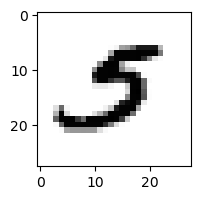

0.005185611289834067% - 0
0.02169229193058492% - 1
0.020918107720503832% - 2
0.0001504744092581561% - 3
4.747759991035387e-06% - 4
1.5956975564667821% - 5
4.253978335568242e-06% - 6
2.467459115380601% - 7 - ОШИБКА
6.400193058648964e-08% - 8
0.0002739262076885807% - 9

 9


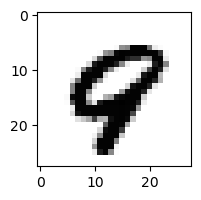

0.000494235920840682% - 0
1.2011859817285443e-08% - 1
2.3743482614458753e-07% - 2
1.9931087450524344e-18% - 3
0.03574635296171812% - 4
3.3532712387539094e-07% - 5
8.793055571552e-05% - 6
0.08410900658087125% - 7 - ОШИБКА
0.00029220757803799546% - 8
0.07493335799401726% - 9

 5


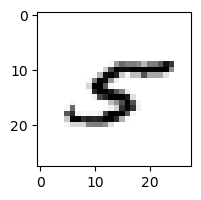

0.012361361078634968% - 0
1.019491151032051% - 1
0.3203478851914065% - 2
0.01815766841346403% - 3
1.8811135244818649% - 4 - ОШИБКА
0.32892277866560743% - 5
0.02954449116402958% - 6
0.22887912958759687% - 7
0.37907561250088045% - 8
0.00012332606579086033% - 9

 9


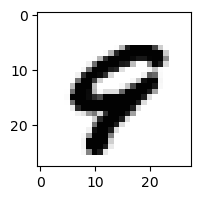

0.001356469488600971% - 0
2.63694418066578e-07% - 1
4.643081746172689e-08% - 2
2.9945860298851463e-16% - 3
0.09267824311881534% - 4 - ОШИБКА
0.00011762679795285988% - 5
5.253544346942598e-05% - 6
0.06785008640445417% - 7
3.6209613941103333e-10% - 8
0.006283952924606032% - 9

 2


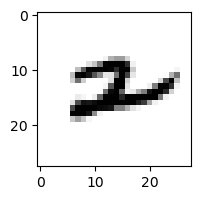

4.453707799554686e-05% - 0
0.4146811033078901% - 1
0.006167621264348107% - 2
3.720405807245327e-08% - 3
48.782495919004056% - 4 - ОШИБКА
7.375766913010595e-06% - 5
0.835002848409897% - 6
0.530080919070618% - 7
5.5930292438589696e-05% - 8
0.9320224126503579% - 9

 3


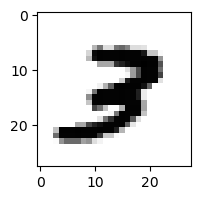

0.0001397225355636775% - 0
6.408784673938018e-06% - 1
2.3403808237024064% - 2 - ОШИБКА
0.26336935370176523% - 3
3.0945593595865505e-07% - 4
2.0941258246249562e-06% - 5
1.0169833527589018e-06% - 6
0.04590982603636916% - 7
4.96466492341814e-07% - 8
0.000986272111839165% - 9

 9


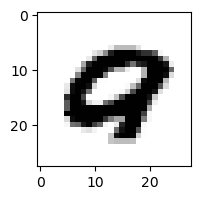

0.06233117785381354% - 0 - ОШИБКА
1.8564044566181778e-10% - 1
3.8500323777132595e-07% - 2
5.870132210248518e-19% - 3
1.2625582619834874e-05% - 4
1.163815375896477e-08% - 5
1.0430489915157843e-05% - 6
0.007001520065062716% - 7
3.370886079670556e-11% - 8
3.1002626706797914e-09% - 9

 2


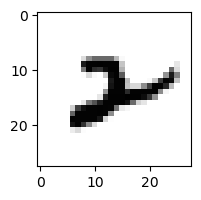

9.401707712093063e-06% - 0
0.32724557645673313% - 1
2.1104908299755527% - 2
3.8972774093485344e-10% - 3
0.028694054493813907% - 4
1.3511776785157268e-05% - 5
12.618571630644809% - 6
0.002848830187731366% - 7
74.62842974270858% - 8 - ОШИБКА
0.0006475309237073185% - 9

 5


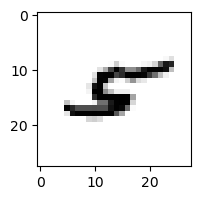

0.002987951883365655% - 0
0.7686319911527049% - 1
0.5745064704441912% - 2
2.8076943185861305e-06% - 3
97.66254605230058% - 4
8.663994790911205e-05% - 5
0.4137586551263608% - 6
0.24852406683522973% - 7
99.60355430266625% - 8 - ОШИБКА
3.180926347664433% - 9

 9


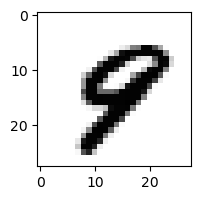

0.0001179563750144073% - 0
3.041447948335189e-06% - 1
7.714056550259024e-08% - 2
1.388618988958004e-10% - 3
0.17819697078680166% - 4 - ОШИБКА
0.010927368803212312% - 5
2.2309762353962536e-05% - 6
0.07046466136361447% - 7
4.617612169210954e-06% - 8
0.005131483438249683% - 9

 8


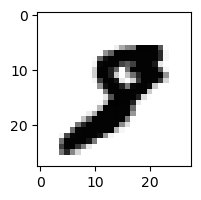

1.9367345094448842e-05% - 0
0.003236937729275782% - 1
7.692700833419349e-06% - 2
9.342986628646302e-08% - 3
8.370107760438727e-08% - 4
4.4840539085646374e-07% - 5
4.017489120211086e-09% - 6
0.0840517592716931% - 7 - ОШИБКА
9.469227844668332e-06% - 8
1.5143957092529806e-07% - 9

 7


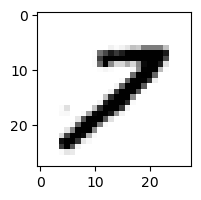

0.01189942787554033% - 0
0.06438607150661693% - 1
11.486930786741988% - 2
0.000136065058891924% - 3
0.0001513075359892329% - 4
0.0003750029733360506% - 5
1.2355564814800598e-07% - 6
5.288682022702316% - 7
90.19321161487962% - 8 - ОШИБКА
0.02908195481305236% - 9

 4


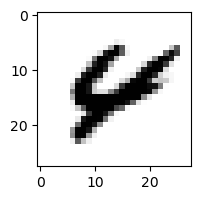

0.001772589392615936% - 0
1.5785562927472824e-06% - 1
9.886385948621846e-05% - 2
1.0113074948956996e-14% - 3
0.4186865334141287% - 4
0.00043397429352801315% - 5
0.019036487445066835% - 6
0.0006388569111080109% - 7
4.729770338181381% - 8
6.492815021015898% - 9 - ОШИБКА

 9


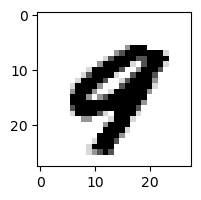

1.10029440284895e-05% - 0
1.6104882125985106e-08% - 1
2.3301767006257908e-11% - 2
8.92876783207091e-15% - 3
0.7411034183781787% - 4 - ОШИБКА
4.132943729069238e-08% - 5
3.716644424717944e-07% - 6
0.08087883208794419% - 7
5.97103943842211e-08% - 8
0.0003101659188795157% - 9

 5


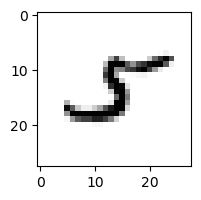

0.012323204668600795% - 0
21.148037458452485% - 1
9.031065987813292% - 2
1.1884033599840319e-05% - 3
0.07575678046434192% - 4
0.04270802172926445% - 5
0.00425167420167248% - 6
0.5734249522086704% - 7
80.81659794411968% - 8 - ОШИБКА
0.0027036511471460367% - 9

 9


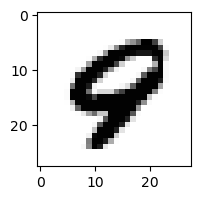

0.0006704227004755906% - 0
1.536195407146557e-08% - 1
7.880806038858611e-08% - 2
3.999635639274486e-18% - 3
0.7365613002053686% - 4 - ОШИБКА
1.6347879290814458e-06% - 5
0.0014015834297563916% - 6
0.001465489391324644% - 7
5.605886027234194e-07% - 8
0.013122153599035057% - 9

 2


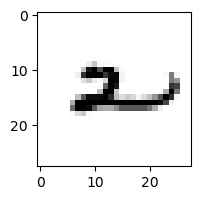

0.04985740852388768% - 0
0.6570159934509735% - 1
0.03763908731437806% - 2
0.0006389929803366922% - 3
99.1331077374961% - 4 - ОШИБКА
0.1099420840095863% - 5
81.87972193552048% - 6
0.003544180985606375% - 7
0.2796848232809106% - 8
10.030239726965672% - 9

 9


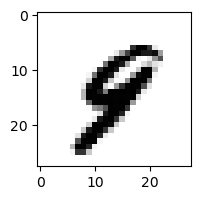

2.8326328196418924e-05% - 0
0.008005736991966782% - 1
3.058142644495275e-05% - 2
3.572363773447256e-07% - 3
0.4303842678670889% - 4 - ОШИБКА
0.002927774835848655% - 5
0.007582014283839242% - 6
0.021009790948273564% - 7
2.4781135902957216e-06% - 8
0.12715066580218098% - 9

 2


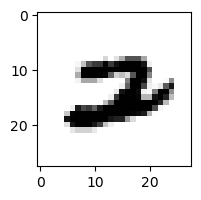

0.00014644879691535424% - 0
7.507007363127217e-05% - 1
0.00988993032753694% - 2
5.137177842097298e-12% - 3
0.0005808019080910216% - 4
1.1399177736365768e-07% - 5
0.05737769244193225% - 6
19.388685779977962% - 7 - ОШИБКА
1.2697340035346775e-08% - 8
4.278196323075987e-09% - 9

 9


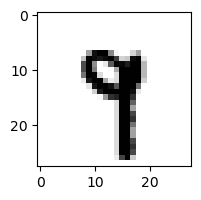

3.2173642013145514e-08% - 0
0.1293966370436937% - 1
1.3913896128109762e-06% - 2
0.004362234533887428% - 3
0.5514530013726111% - 4
0.004912393514229019% - 5
2.556228510205412e-05% - 6
14.852361883024102% - 7 - ОШИБКА
0.0002694479517563243% - 8
0.269016916872677% - 9

 9


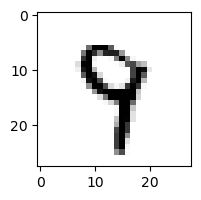

2.6636975564734014e-05% - 0
0.0009373489427921503% - 1
0.0006368677832361547% - 2
0.05359139126613355% - 3
38.35360614295819% - 4 - ОШИБКА
0.08893286606557098% - 5
0.02245896374175177% - 6
1.739099823827878% - 7
1.3782853216198006% - 8
3.2191859166835117% - 9

 9


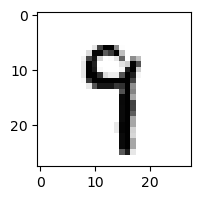

2.577340304705493e-05% - 0
0.11565774958033784% - 1
2.1301024967853317e-05% - 2
0.48281618217795447% - 3
14.940193189247797% - 4 - ОШИБКА
2.19237131756994% - 5
0.006619552279317511% - 6
3.955507864757605% - 7
0.5611521841735283% - 8
11.667414583996242% - 9

 6


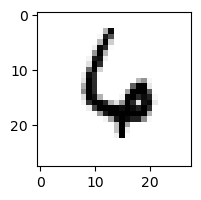

7.193356946479943e-05% - 0
8.224687842921118e-05% - 1
4.982241013539435% - 2
2.797651790515973e-07% - 3
90.08711924457275% - 4 - ОШИБКА
0.16111918152912072% - 5
81.72893717135399% - 6
0.2376835715610428% - 7
8.315066431112079e-08% - 8
0.046834589621323766% - 9

 4


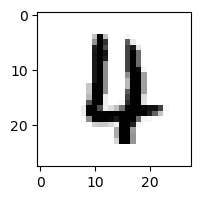

0.00397798062154891% - 0
2.6949312955506544e-06% - 1
0.6002208001195777% - 2
3.273665772692475e-07% - 3
0.16113521125477107% - 4
0.0015021289095367178% - 5
7.259416926690447% - 6 - ОШИБКА
0.014346160442004836% - 7
7.918702744457555e-08% - 8
5.926483137224247e-07% - 9

 5


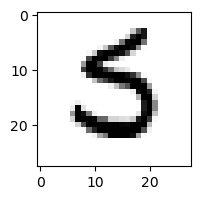

0.010947602154008057% - 0
2.5468756687178432e-05% - 1
0.018211535854844526% - 2
0.004873150895481376% - 3
3.8637597920472145e-09% - 4
53.26914972812376% - 5
63.65511050361356% - 6 - ОШИБКА
0.0002130187268333807% - 7
3.446558082440997e-05% - 8
8.448620643270782e-11% - 9

 9


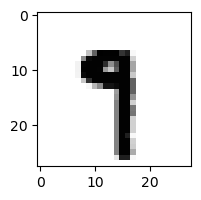

3.281060993078339e-08% - 0
0.13808458196152298% - 1
4.873632445060003e-08% - 2
2.602537944396629e-05% - 3
0.0014421542480928234% - 4
1.3437744438876236% - 5
0.0003943661700119119% - 6
20.65568694030493% - 7 - ОШИБКА
0.0012599620897804052% - 8
0.8772726828425014% - 9

 8


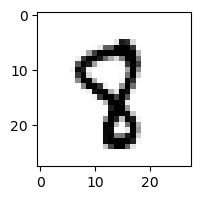

2.624594462143067e-06% - 0
0.008424961145181877% - 1
0.00045405366973502536% - 2
0.00018208588431654842% - 3
0.01449262889239384% - 4
1.137792604108486% - 5 - ОШИБКА
0.0003861301714175527% - 6
0.0717118986941525% - 7
0.03690376615851964% - 8
0.00038480825610738274% - 9

 2


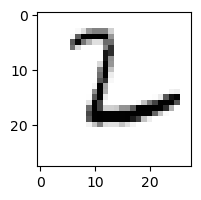

0.44605419166062327% - 0
0.0021159344156449576% - 1
99.62476851745014% - 2
0.0031190797729961383% - 3
0.007525671839292902% - 4
0.0643235723247842% - 5
99.8869100340448% - 6 - ОШИБКА
0.01142712930467482% - 7
0.00608915091457547% - 8
0.007151502041366835% - 9

 5


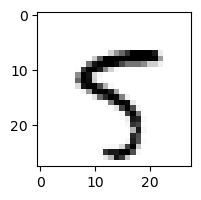

0.0007215127380085738% - 0
0.0006226604534690647% - 1
0.0006741116819819588% - 2
0.00152048229306166% - 3
0.04542168072176228% - 4
73.9089194352741% - 5
0.0001960702504598276% - 6
1.5426911518902364% - 7
0.027456400664953654% - 8
99.02585230856% - 9 - ОШИБКА

 9


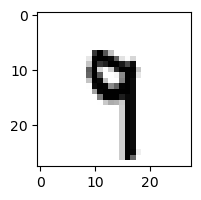

1.4733789500475512e-07% - 0
1.4993949716816524% - 1
0.0003982762121192067% - 2
0.12429269503134532% - 3
9.893406809456337% - 4 - ОШИБКА
0.08238735117235568% - 5
0.009711870363155031% - 6
5.582757310822874% - 7
0.010046722638619204% - 8
4.546423744686806% - 9

 9


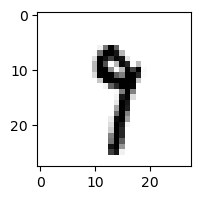

2.5256871104872077e-05% - 0
4.153784889684656% - 1
0.0006823485511547341% - 2
1.0356601579342066% - 3
0.008146385905815078% - 4
0.10306299931361952% - 5
0.0015948625104207502% - 6
25.70348328228799% - 7 - ОШИБКА
0.21065853339600873% - 8
7.306663629699492% - 9

 6


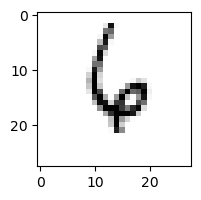

6.113152270779245e-05% - 0
0.037451339357571195% - 1
10.010274865558062% - 2
0.00017039079306750395% - 3
99.53200287708471% - 4 - ОШИБКА
2.2768987675647043% - 5
66.77720465519013% - 6
1.3236739173898548% - 7
0.01087906402150251% - 8
34.65565062008737% - 9

 3


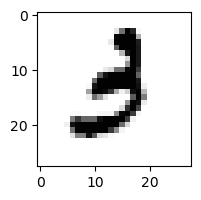

0.004491239126553887% - 0
0.010904833529376693% - 1
0.001545208375956636% - 2
4.198093355263676% - 3
1.674998546868234e-05% - 4
5.03115090245952% - 5 - ОШИБКА
0.06632309908846848% - 6
2.0689965272938598e-05% - 7
5.512488488502886e-10% - 8
1.8831085674864014e-09% - 9

 8


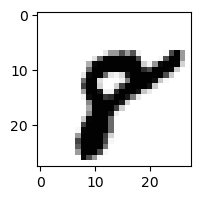

0.00014745584116629043% - 0
7.660516903579794e-06% - 1
3.4385506230794504e-08% - 2
4.861736509656e-12% - 3
1.2311946531153117e-07% - 4
4.886508539695612e-05% - 5
1.4998599375637663e-05% - 6
0.11967658061467093% - 7 - ОШИБКА
0.000613684251865218% - 8
0.00027617396582112924% - 9

 5


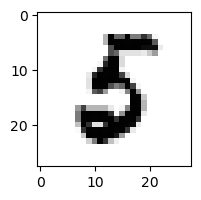

0.005096563790917754% - 0
0.0004287794232406148% - 1
0.0032581897875131652% - 2
1.766989628721242e-07% - 3
8.938100814822599e-08% - 4
0.966390716812092% - 5
11.855857383600267% - 6 - ОШИБКА
2.250421237263588e-07% - 7
8.651458892819182e-07% - 8
2.8072305016838884e-13% - 9

 7


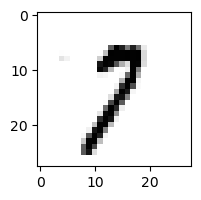

0.04003416030272768% - 0
3.8010726815399276% - 1
9.686718037992735% - 2
0.08884952879028171% - 3
0.0001022460936927248% - 4
0.10700198885138346% - 5
0.00260039437382492% - 6
59.329878693321405% - 7
0.03483540560150988% - 8
76.93502162091868% - 9 - ОШИБКА

 8


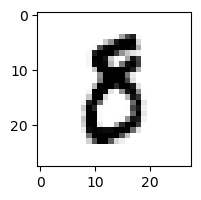

0.12782806716156145% - 0
0.0004063978741141695% - 1
0.03166943076315662% - 2
0.11553837850212065% - 3
1.0915842160103643e-06% - 4
1.3101422340958682% - 5 - ОШИБКА
0.002084685878643674% - 6
6.059781074188293e-05% - 7
0.0002603874548728074% - 8
2.866159109914009e-09% - 9

 9


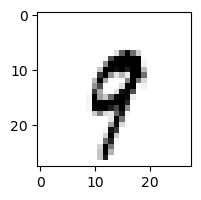

0.00010800447406885961% - 0
2.1648824609211204% - 1
0.0034880683860480273% - 2
9.686210615322073e-05% - 3
0.30592509683496916% - 4
0.00038102632080107827% - 5
0.005097946249880866% - 6
31.464765549374828% - 7 - ОШИБКА
0.0028460248745799726% - 8
11.486340592172256% - 9

 0


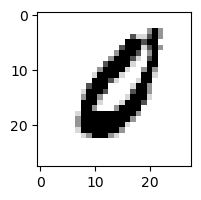

3.4093196004474176% - 0
9.744822385625456e-07% - 1
0.004215628279043745% - 2
6.870067952496527e-10% - 3
4.856272667746172e-05% - 4
0.015575314538554402% - 5
4.578547821931609% - 6 - ОШИБКА
0.0007864124709564845% - 7
4.4058495106369066e-11% - 8
1.2602724986698642e-08% - 9

 9


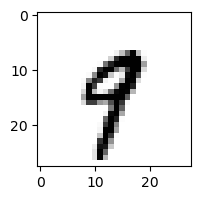

3.122737896020218e-05% - 0
3.2710604523307887% - 1
0.00010798520636134943% - 2
0.002015074821741157% - 3
1.7262518886724352% - 4
0.07317680637771444% - 5
0.0036047675829269997% - 6
7.640138028438023% - 7 - ОШИБКА
3.400648799324792e-06% - 8
1.441150587691303% - 9

 9


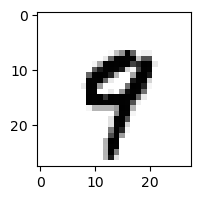

3.118279805391134e-05% - 0
8.821723152561346e-05% - 1
5.005167959173744e-07% - 2
6.676267856925683e-06% - 3
0.8746565560274682% - 4
0.001215400645806952% - 5
0.00024811471633631363% - 6
11.88306951379275% - 7 - ОШИБКА
6.24698020911125e-06% - 8
4.165937678955821% - 9

 9


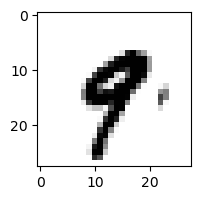

3.933678346366147e-06% - 0
0.32556765300108953% - 1
1.0343797222591767e-07% - 2
0.0002511251098853601% - 3
1.5209110619515707% - 4 - ОШИБКА
0.0007224144724706624% - 5
0.0003165465715413418% - 6
0.12809018591370624% - 7
1.960116685326885e-08% - 8
0.06828109999159321% - 9

 9


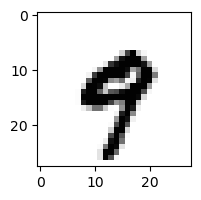

2.1087036130559045e-05% - 0
0.0004359472150080047% - 1
1.180992874281412e-08% - 2
0.00024024438113169803% - 3
5.869165828578689% - 4 - ОШИБКА
4.200908074271929e-05% - 5
0.00014568958695079475% - 6
0.11695168561188471% - 7
6.934187512714714e-09% - 8
0.554478439360057% - 9

 8


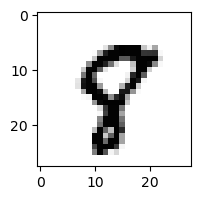

0.0007650388791966867% - 0
2.8133510695396592e-05% - 1
2.854960159645271e-05% - 2
1.1236451190142895e-07% - 3
0.002107496626266582% - 4
1.5858265141939738% - 5 - ОШИБКА
3.463272563605214e-05% - 6
0.3031822872017466% - 7
0.00703958216078069% - 8
1.0763596520981464% - 9

 9


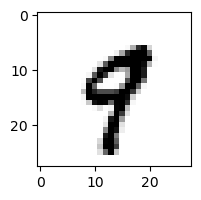

3.461842752187824e-05% - 0
0.025191383264180137% - 1
1.3345788606364868e-05% - 2
0.0010184365306269779% - 3
0.4366326490335873% - 4
0.022741510481276702% - 5
1.804556563998195e-05% - 6
3.6543933317438047% - 7 - ОШИБКА
3.686196783025311e-05% - 8
2.480079693856696% - 9

 8


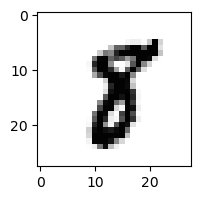

1.5571838316378599e-06% - 0
0.2490513198344662% - 1
8.100141697782273e-05% - 2
2.2517261001080013e-05% - 3
1.9452944491047906e-06% - 4
0.28400821569715023% - 5 - ОШИБКА
1.07359794876841e-06% - 6
0.0042771521516658546% - 7
0.026916121199677685% - 8
2.6153108870474286e-07% - 9

 9


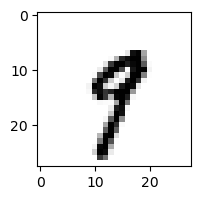

0.0001516019658684893% - 0
2.203078925259714% - 1
3.053958390938798e-05% - 2
0.8722524966905274% - 3
3.0950168691704754% - 4
0.04331409542160407% - 5
0.0017228625939207745% - 6
12.095357855974834% - 7 - ОШИБКА
0.002089659947132281% - 8
0.4153876460833982% - 9

 3


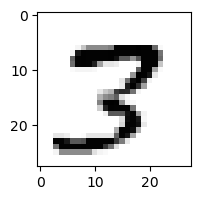

9.616236906001599e-06% - 0
4.0502906763314004e-06% - 1
0.009179176661018106% - 2
0.477846318556041% - 3
0.0004288634820604659% - 4
0.010095669637858573% - 5
5.232481672052908e-09% - 6
31.86577016836675% - 7 - ОШИБКА
5.601857616922948% - 8
4.1273271031365214e-05% - 9

 8


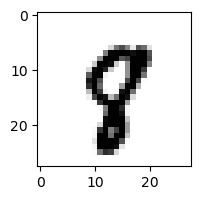

3.163648621082419e-05% - 0
0.00031835603318683533% - 1
2.064266150326363e-05% - 2
3.9412583830505657e-07% - 3
0.011185316208398275% - 4
0.11017898196766654% - 5
1.691977357447953e-05% - 6
1.4181675021354179% - 7 - ОШИБКА
0.0001650448357871753% - 8
0.06788880774093395% - 9

 8


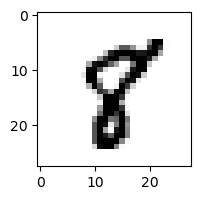

2.2405754845028805e-05% - 0
0.022183579444856376% - 1
0.0001804540151930091% - 2
2.094303012956487e-08% - 3
0.0027950529005197604% - 4
0.5265494379762568% - 5 - ОШИБКА
5.6784997544686105e-06% - 6
0.1097065057653706% - 7
0.09968426807144162% - 8
0.0002899962100812135% - 9

 3


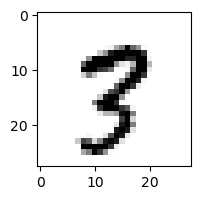

2.5345191995056567e-05% - 0
0.005837445403395785% - 1
0.009723846650363311% - 2
0.00018126341986843774% - 3
6.101740963121934e-05% - 4
0.02283770622812417% - 5
1.3186051614790862e-05% - 6
6.012476994096913% - 7
25.746200825541877% - 8 - ОШИБКА
14.446758024221568% - 9

 9


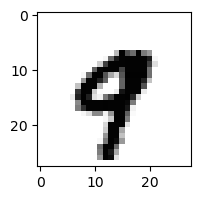

7.433524569693984e-07% - 0
0.0002731507522707814% - 1
1.1511619278238278e-08% - 2
2.595903744296881e-10% - 3
1.5525293253151113% - 4
1.2549498188736928e-07% - 5
5.3074912931363e-06% - 6
6.906498842378758% - 7 - ОШИБКА
6.748377854173461e-10% - 8
1.0069904662163347% - 9

 5


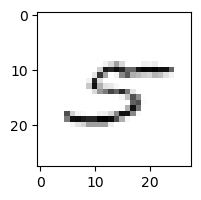

5.479579085306434% - 0
0.738336449211069% - 1
7.898811323045794% - 2
2.9156068753696083% - 3
1.194460456532017% - 4
1.3621498929445979% - 5
2.1697417587895393% - 6
29.44958504716927% - 7 - ОШИБКА
2.998202514740854% - 8
0.4277556220147293% - 9

 8


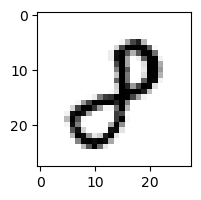

0.011168847157561293% - 0
0.007072456135970575% - 1
0.6390658036516976% - 2 - ОШИБКА
0.011178357681202167% - 3
0.0015892572899272618% - 4
9.987862995984378e-06% - 5
4.506244309347171e-06% - 6
0.023938805033423636% - 7
0.3377787666550377% - 8
0.08508471893776103% - 9

 0


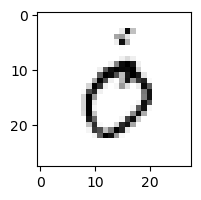

18.810050243867337% - 0
0.031023718885252557% - 1
0.01970348571970685% - 2
38.91883330192129% - 3
2.137875950029732% - 4
0.7685820007612153% - 5
56.44920351456466% - 6 - ОШИБКА
6.733494408428084% - 7
0.00014004924443508177% - 8
0.0004971464738003378% - 9

 3


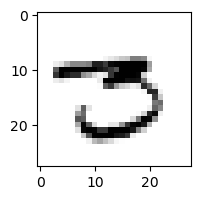

0.054103071306854676% - 0
0.041415992957393115% - 1
0.0013927284846015312% - 2
1.252963758143125% - 3
2.984549334605779e-07% - 4
2.1221229354214066% - 5 - ОШИБКА
0.0003381326948449493% - 6
0.7836294208851088% - 7
0.0006445868980844313% - 8
3.504068266024128e-08% - 9

 5


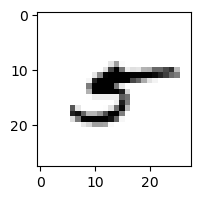

0.004496019592444849% - 0
7.494715219223366% - 1
0.004030089924805387% - 2
0.006982654443102729% - 3
3.7459135424508205% - 4
0.0008398393237388894% - 5
7.227396842877811% - 6
0.009416705132178974% - 7
75.1736666682641% - 8 - ОШИБКА
0.16815767519500643% - 9

 1


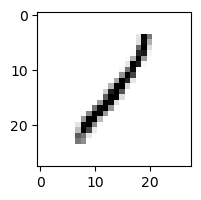

0.1326096784102179% - 0
94.47178873419728% - 1
59.366428123134064% - 2
1.0219165723306234% - 3
0.36989891795490987% - 4
0.8333290064574952% - 5
1.085287195362314% - 6
0.12009308180121724% - 7
98.4690973543499% - 8 - ОШИБКА
2.5366587053046863% - 9

 3


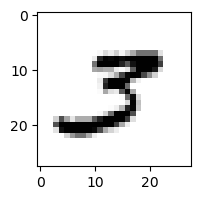

0.0076386079500193535% - 0
0.046144534277023606% - 1
7.9252378835617625% - 2 - ОШИБКА
5.592624775128658% - 3
3.7776500065380223e-07% - 4
0.29864182291385055% - 5
5.703230614888801e-07% - 6
3.5093093173188206% - 7
7.111762172049788e-05% - 8
2.5205362843936497e-05% - 9

 2


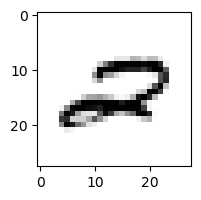

1.6642271205850843% - 0
0.00047796916568955996% - 1
8.902109995578563% - 2
2.6099809168961593e-07% - 3
1.2549027521830922% - 4
4.781820546376015e-06% - 5
0.003079047749362686% - 6
25.814464538114724% - 7 - ОШИБКА
6.832013617664493e-06% - 8
2.0492100230685232e-05% - 9

 8


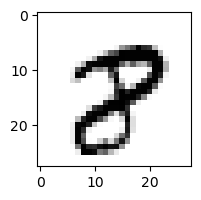

3.261497668311099e-05% - 0
8.470683370855298e-05% - 1
2.483356023992394e-05% - 2
7.73113051773855e-11% - 3
1.916863974019398e-08% - 4
6.950713698270354e-05% - 5
2.1457154361332262e-08% - 6
2.7539991474920433% - 7 - ОШИБКА
0.47534006333094725% - 8
0.00013095850720156975% - 9

 8


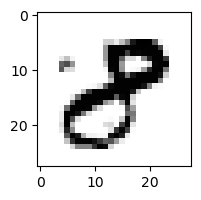

0.014683155323043354% - 0
0.0001418387618667278% - 1
0.0054441035704690804% - 2
0.03486138647150622% - 3 - ОШИБКА
1.436261040359459e-05% - 4
1.5417622331804776e-06% - 5
3.6709291004869806e-09% - 6
6.8998083490547676e-06% - 7
0.0001760743351480054% - 8
1.6584557854498495e-05% - 9

 3


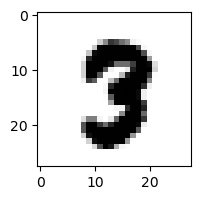

2.2609514647021524e-06% - 0
2.566898789249122e-07% - 1
5.6071292400684515e-06% - 2
0.0016767937259027426% - 3
3.494860147991352e-10% - 4
0.002136627740627039% - 5
1.8437980088775596e-09% - 6
0.023190864807394157% - 7 - ОШИБКА
1.9152686783566235e-06% - 8
9.70466900938873e-11% - 9

 8


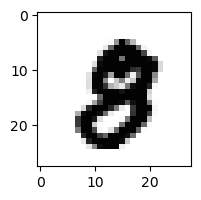

6.6757669650371526e-06% - 0
2.0460484172657105e-07% - 1
2.546231484265451e-07% - 2
1.425210882533263e-06% - 3
3.4996198346999946e-09% - 4
1.1450790725720195e-06% - 5
5.802156288322356e-10% - 6
6.466207104989387e-05% - 7 - ОШИБКА
2.0836968529807897e-05% - 8
3.66359001377622e-11% - 9

 4


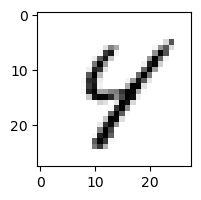

0.0026168359073054674% - 0
0.00048271295397067074% - 1
0.014638247680840707% - 2
0.0006849868734179271% - 3
95.42574575394262% - 4
15.408770585441165% - 5
0.06707994163536364% - 6
2.2907827868166617% - 7
96.58996312569414% - 8 - ОШИБКА
13.43695094890182% - 9

 7


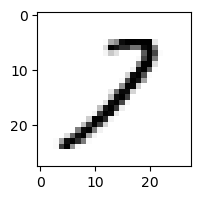

0.2272348179990971% - 0
38.24841211925046% - 1
89.43771322139743% - 2
0.9861659596135391% - 3
0.3641299592444379% - 4
0.14505369588544623% - 5
0.024839013647496015% - 6
0.5473152595783207% - 7
93.16139933769385% - 8 - ОШИБКА
0.0003196583753952818% - 9

 4


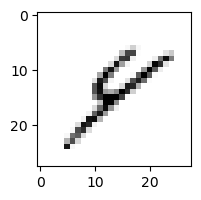

0.3266796916504336% - 0
0.24779138189848104% - 1
1.531449929826569% - 2
2.2990034532256653% - 3
2.6041186957311453% - 4
7.2863143511383806% - 5
4.259922942485883% - 6
0.24312670232163935% - 7
99.9990483623355% - 8 - ОШИБКА
89.99799690130946% - 9

 1


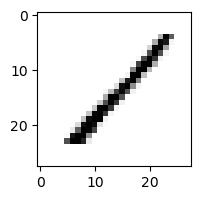

0.08919990397457264% - 0
70.73217799398684% - 1
50.69088868902227% - 2
0.4529548953966889% - 3
2.735888365005476% - 4
1.5219627332828083% - 5
0.11951269616207576% - 6
1.1117179052848611% - 7
99.66654060774725% - 8 - ОШИБКА
0.05423286801268442% - 9

 5


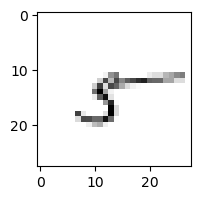

5.0818146659839964% - 0
41.297520046288646% - 1
44.25830406639605% - 2
5.25105210404193% - 3
68.50801049957744% - 4
4.810692687789832% - 5
99.14814294587944% - 6
0.10759638547289334% - 7
99.9882778669866% - 8 - ОШИБКА
94.21441690986427% - 9

 5


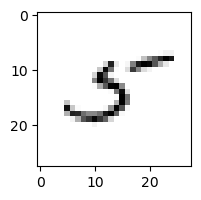

1.0023893565910489% - 0
3.72481130759461% - 1
5.643011221303443% - 2
0.004162857743885877% - 3
64.29210104488824% - 4
51.366137938511436% - 5
0.44865034350157973% - 6
0.8366228894114851% - 7
99.97576245252667% - 8 - ОШИБКА
0.49459048400931893% - 9

 2


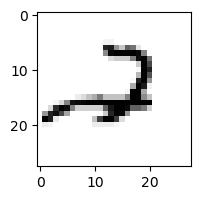

0.051126157970618515% - 0
0.0021172688458167828% - 1
92.13097951690153% - 2
0.003072308190285226% - 3
46.80359198956041% - 4
3.89316782897094e-05% - 5
0.048451610746663584% - 6
3.8422463839677152% - 7
7.111518847692143e-06% - 8
92.16031683801906% - 9 - ОШИБКА

 4


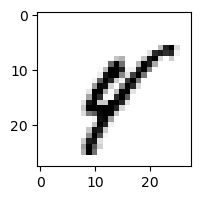

0.0009999213924695275% - 0
3.167849448800972% - 1
0.0057663050778353955% - 2
2.6673547628020514e-05% - 3
8.282861196669272% - 4
0.05303645356166153% - 5
0.26977566493523175% - 6
0.14072712117304245% - 7
36.91345777549092% - 8 - ОШИБКА
0.01768189962655844% - 9

 3


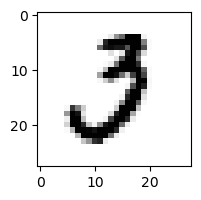

2.1254909990807955% - 0
0.004452352417267317% - 1
17.02053207920271% - 2 - ОШИБКА
0.8727214703961255% - 3
6.064933805422677e-08% - 4
0.03150171006809839% - 5
2.3212385174174663e-06% - 6
0.05385516477562452% - 7
1.7113145139214354e-09% - 8
6.076839962518264e-11% - 9

 2


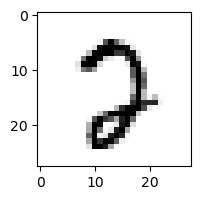

5.301782744463645% - 0
1.434556341307193e-05% - 1
39.221885239402205% - 2
0.02350211074066336% - 3
3.452912435937331e-05% - 4
0.6681129701708628% - 5
0.0035669093972451357% - 6
41.64304148939509% - 7 - ОШИБКА
0.011323178603232766% - 8
2.3181798863738284e-06% - 9

 4


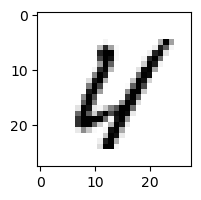

0.3637438225023585% - 0
1.7819198408698522e-06% - 1
0.31562388201748165% - 2
2.1172591775161593e-09% - 3
7.549766269698607% - 4
0.14405549461976902% - 5
0.40828558439938367% - 6
0.26420096234027085% - 7
14.731626523616129% - 8 - ОШИБКА
7.698612579449881e-05% - 9

 5


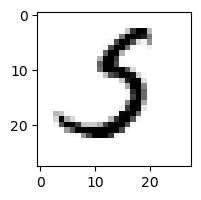

0.010919665535090191% - 0
0.0014765589001562915% - 1
8.739909882791085% - 2
13.856020116878002% - 3 - ОШИБКА
6.278274117675117e-07% - 4
1.7568408416630155% - 5
0.13595953441794287% - 6
2.7016895226719195% - 7
5.816777120480655e-09% - 8
1.4865197653532352e-07% - 9

 8


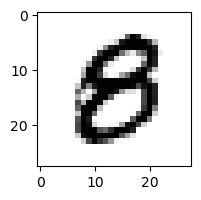

0.1414625620230296% - 0
1.7458377974204535e-07% - 1
1.996940681135623e-06% - 2
4.597406968480771e-05% - 3
2.570008163181089e-05% - 4
0.2094102289840828% - 5 - ОШИБКА
0.0034226653103431094% - 6
1.3997212869171122e-08% - 7
0.018284160922467853% - 8
1.2001031906126104e-07% - 9

 8


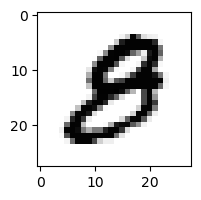

0.05041741347244871% - 0 - ОШИБКА
8.893413540641378e-07% - 1
6.976371532879529e-05% - 2
0.00015045474777372183% - 3
4.630261461107072e-07% - 4
0.00020205495082451064% - 5
0.0006272516216302228% - 6
5.582933370879201e-08% - 7
0.015533523583604257% - 8
2.5781678114407857e-06% - 9

 2


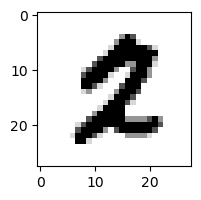

4.182903202467366e-06% - 0
0.0001622197172419091% - 1
0.0010717438920936143% - 2
6.194686311946601e-10% - 3
6.58425072625024e-10% - 4
0.011833801293354523% - 5 - ОШИБКА
4.1452941874032285e-06% - 6
6.413905962119546e-05% - 7
3.2111492001270197e-10% - 8
7.664081121240118e-10% - 9

 5


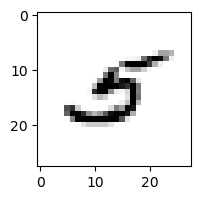

0.02532343215096176% - 0
0.32163226015432694% - 1
3.0798173885343645% - 2
0.013240783821756278% - 3
40.565206095826056% - 4 - ОШИБКА
7.946988874383744% - 5
0.14974633759399916% - 6
0.017412932278529202% - 7
0.34935248239885774% - 8
0.002218018806488413% - 9

 5


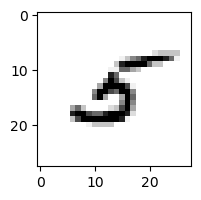

0.015840757570274023% - 0
7.133851955807052% - 1
38.45653376977734% - 2 - ОШИБКА
0.002858428172752066% - 3
2.3951256904404103% - 4
3.4981935852081225% - 5
0.03643084383536055% - 6
0.008548684837221038% - 7
3.282339892194804% - 8
0.001970262890186782% - 9

 8


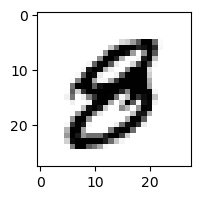

9.23148782655453e-05% - 0
1.6147019554716917e-06% - 1
1.2157676181505336e-08% - 2
7.090724485282317e-05% - 3
0.0008124844252156431% - 4
0.01522031226947054% - 5 - ОШИБКА
2.793973242722436e-05% - 6
4.1611645827756587e-08% - 7
2.2987315468329471e-07% - 8
6.214597429541657e-05% - 9

 9


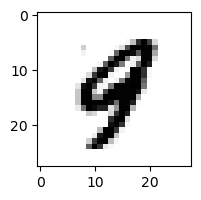

1.5279639348892883e-05% - 0
0.0008033870567175724% - 1
6.550673499595788e-06% - 2
1.962589189851455e-07% - 3
16.321380435389717% - 4 - ОШИБКА
0.0003120950454733272% - 5
0.0002376531332277809% - 6
0.0012582558128934925% - 7
5.8753314898285465e-05% - 8
10.663014487618103% - 9

 9


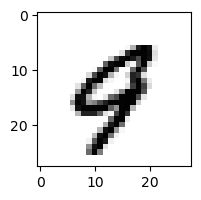

0.005311968360822402% - 0
0.00010431413945596454% - 1
4.52758750544094e-05% - 2
2.6283468539681857e-09% - 3
55.201398017152414% - 4 - ОШИБКА
2.8714366856404307e-05% - 5
0.0014626559868355592% - 6
0.804183404257508% - 7
9.128228384154572e-07% - 8
0.636220443210485% - 9

 8


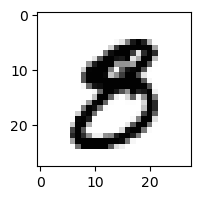

0.0007105968687110953% - 0
1.217016862200125e-05% - 1
5.136348218622418e-09% - 2
0.008190614142134602% - 3
1.3608859419783744e-07% - 4
0.6402524298325258% - 5 - ОШИБКА
1.726450558524905e-08% - 6
3.946821121847658e-07% - 7
0.0010989081626340247% - 8
2.1110616227280818e-07% - 9

 8


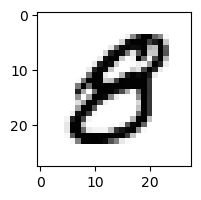

0.3055766635802386% - 0
1.5555713517095044e-06% - 1
3.6567366579326024e-08% - 2
1.543392468223565e-05% - 3
0.0020407888005762598% - 4
1.1126539229628474% - 5 - ОШИБКА
1.9798896260244537e-05% - 6
5.217470968618226e-08% - 7
0.00011834728230858525% - 8
8.520658054096997e-08% - 9

 2


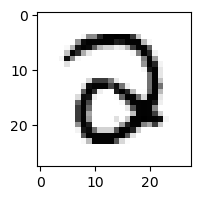

0.2636164091090282% - 0
1.6929783825317564e-09% - 1
0.8409806740430431% - 2
15.044813350316574% - 3 - ОШИБКА
0.0003224145956752581% - 4
0.0003256299305492621% - 5
0.0022487035563068455% - 6
7.395411746437646e-08% - 7
2.2243308795375135e-10% - 8
2.708202145417158e-17% - 9

 9


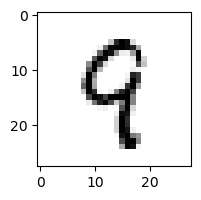

0.0012753551412867182% - 0
0.0283088546243444% - 1
0.25887547138214223% - 2
0.008748833943352359% - 3
14.22716454018601% - 4 - ОШИБКА
2.1719242609533236% - 5
0.0768726284907494% - 6
0.051056631954255347% - 7
2.6146180008585986% - 8
2.6707901591872316% - 9

 5


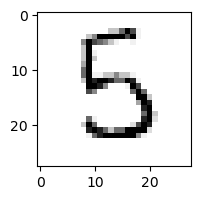

0.0056968686720374265% - 0
0.0004808010442498198% - 1
0.0019291169315335751% - 2
67.92698772282205% - 3 - ОШИБКА
2.3259631011091426% - 4
63.58426619377986% - 5
12.486973263309173% - 6
0.003067956949740894% - 7
4.352984516864274e-06% - 8
2.9098492693730586e-07% - 9

 5


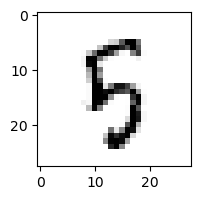

0.023310151517567768% - 0
0.000274760404351303% - 1
0.1251224630629719% - 2
0.22372920492029547% - 3
4.512880542326957% - 4
68.63622600596693% - 5
1.5895363740995068% - 6
0.0005397104533522476% - 7
94.29121615010827% - 8 - ОШИБКА
0.15816223181096467% - 9

 2


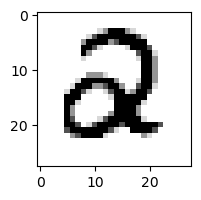

8.58195453865098e-07% - 0
4.70737376527049e-08% - 1
0.0009394092327435922% - 2
4.3591506031183905e-05% - 3
0.0009671090867720435% - 4 - ОШИБКА
0.0003967409543420247% - 5
8.496846292911e-05% - 6
4.570538545372219e-09% - 7
1.0011531516141665e-15% - 8
1.2702960141062366e-14% - 9

 8


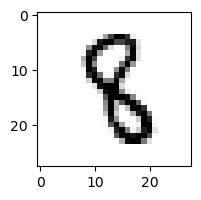

1.0299583012225929e-07% - 0
0.24410588057651425% - 1
0.08114234743645175% - 2
0.016145489495178487% - 3
0.03169682213053222% - 4
0.8169388442245913% - 5 - ОШИБКА
0.0006635568185962682% - 6
1.2723663946457373e-05% - 7
2.6955631769396374e-07% - 8
1.5736989409258221e-10% - 9

 8


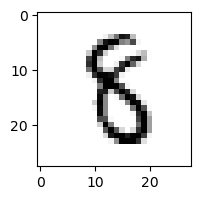

0.00025451532801429354% - 0
0.0656421439942819% - 1
0.024144989926421286% - 2
0.35708040188127144% - 3
0.00306290953662271% - 4
23.759767853433125% - 5 - ОШИБКА
0.04980656995218054% - 6
0.00012262489248810097% - 7
0.05976701763068204% - 8
5.150542204139176e-09% - 9

 2


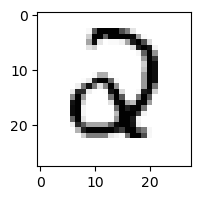

0.0025795810432719325% - 0
2.399469498019568e-05% - 1
0.03554215791584207% - 2
0.021946602654729364% - 3
0.22384284414157982% - 4 - ОШИБКА
0.002453272306028945% - 5
0.21493752203945554% - 6
5.816172905329432e-06% - 7
6.392818244649682e-10% - 8
3.833085760424339e-10% - 9

 8


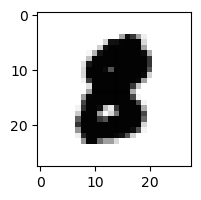

2.9884831276285865e-07% - 0
5.394108022832265e-07% - 1
2.0049924199855416e-05% - 2
4.6296939361985535e-10% - 3
5.336993608104051e-12% - 4
9.918544113088947e-05% - 5 - ОШИБКА
4.57330866704158e-08% - 6
7.782860462654742e-09% - 7
4.485228532140224e-11% - 8
2.9231013296611344e-15% - 9

 9


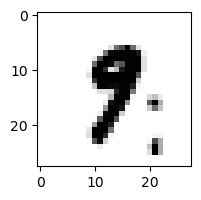

1.5245157915057523e-06% - 0
10.413615217998155% - 1 - ОШИБКА
1.3653524331409726e-05% - 2
0.00019347159007085518% - 3
0.0001108002030599685% - 4
0.020370755742145873% - 5
3.76418315825164e-05% - 6
0.5744632063443169% - 7
1.3968022781109214e-06% - 8
0.06803099510527105% - 9

 8


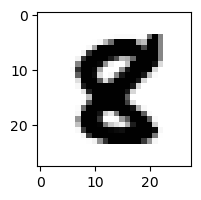

1.5583148222713032e-08% - 0
4.681228421674111e-08% - 1
6.260135675776171e-06% - 2
1.7191118663879377e-12% - 3
3.7106393810140714e-07% - 4
0.019904240674884884% - 5 - ОШИБКА
2.8403023800787803e-09% - 6
5.3962106133242493e-11% - 7
1.3064463237130382e-05% - 8
9.258616813730938e-16% - 9

 8


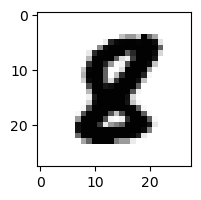

1.2075714846454273e-07% - 0
1.3074426700347338e-06% - 1
5.2149031576378446e-05% - 2
6.1048961990586275e-12% - 3
4.135039748630766e-09% - 4
0.008298960258876045% - 5 - ОШИБКА
3.1878912601112914e-08% - 6
1.4366312141504292e-10% - 7
7.070821961595545e-06% - 8
4.218777329488613e-17% - 9

 9


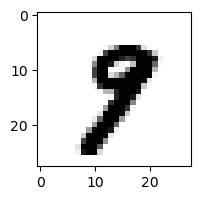

1.969361048948484e-06% - 0
0.0007716126665233222% - 1
2.0762216703666977e-06% - 2
8.247080718197264e-05% - 3
2.247560197933791e-05% - 4
0.0015619941670006303% - 5
5.63099369032107e-08% - 6
1.0367870949961822% - 7 - ОШИБКА
0.0004905585876657243% - 8
0.18190215259016984% - 9

 8


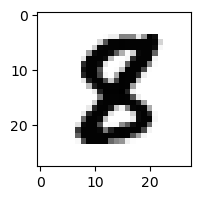

2.686658135227386e-07% - 0
9.432633564391166e-05% - 1
8.165987672040046e-05% - 2
2.9740474297140103e-08% - 3
1.2083687618134055e-07% - 4
0.08391911098267242% - 5 - ОШИБКА
1.0681478058431492e-07% - 6
8.986455477622966e-09% - 7
3.052780311532605e-05% - 8
1.6201942696202688e-17% - 9

 8


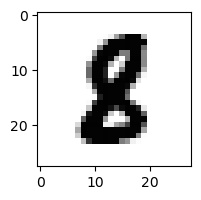

4.134084329574601e-07% - 0
0.00029795187244778065% - 1
0.0004219425218320776% - 2
2.0360016621039465e-08% - 3
1.7147425789217003e-09% - 4
0.01046030839314972% - 5 - ОШИБКА
1.8286697358550287e-06% - 6
3.3915798659925883e-09% - 7
0.0009810915094469678% - 8
1.0627662431022843e-14% - 9

 8


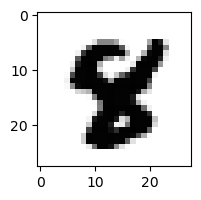

6.506271482590958e-12% - 0
1.4643541853470367e-09% - 1
1.2567456281315583e-11% - 2
1.4756750244208988e-12% - 3
4.985658889571884e-05% - 4
0.04251357747558032% - 5 - ОШИБКА
2.2599008015773493e-09% - 6
1.1121268681488419e-07% - 7
1.2461874959507524e-07% - 8
5.453466369480194e-15% - 9

 5


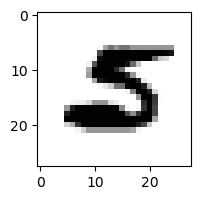

0.00023853670039833568% - 0
2.7871320013580655e-05% - 1
0.04928272429707466% - 2 - ОШИБКА
9.303143179445672e-11% - 3
3.736485312905758e-11% - 4
0.040684509299579105% - 5
0.0007823156174861444% - 6
0.00046442693150363593% - 7
2.385415841091717e-10% - 8
1.0980944365810929e-10% - 9

 9


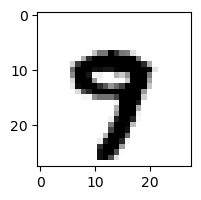

1.0115359506966773e-07% - 0
3.136047986229038e-06% - 1
1.2966664442313306e-09% - 2
3.8696759084357254e-08% - 3
0.002377085297942668% - 4
0.003283357165533939% - 5
2.8636737563489753e-06% - 6
31.958322634014085% - 7 - ОШИБКА
8.94577451712521e-10% - 8
0.05107383574672311% - 9

 8


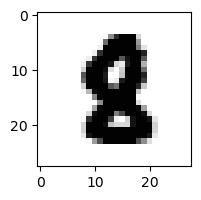

1.1616998191980377e-09% - 0
4.342289005432408e-07% - 1
5.648942130239769e-05% - 2
7.936944203163373e-11% - 3
4.2439115520465106e-08% - 4
0.0013576146244914744% - 5 - ОШИБКА
3.7356175377950756e-07% - 6
5.014615494000578e-09% - 7
2.427501120253536e-08% - 8
2.0585196566878014e-13% - 9

 5


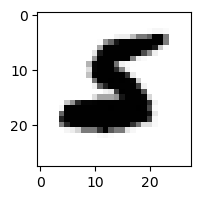

1.2296930832933814e-08% - 0
5.904483774085354e-06% - 1
0.08299332700091007% - 2 - ОШИБКА
9.897076825376649e-14% - 3
4.0082961990622353e-10% - 4
0.0011590456771326581% - 5
0.010140615834556697% - 6
4.965103551478899e-09% - 7
6.585762700339883e-15% - 8
7.43775890413692e-15% - 9

 3


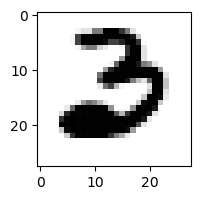

0.031523402639187154% - 0
2.1386892453915977e-07% - 1
13.186973099867622% - 2 - ОШИБКА
0.00015161023039308893% - 3
5.816446712076163e-15% - 4
5.74994162951361e-11% - 5
0.001847871675598298% - 6
5.028399216369135e-07% - 7
4.500410185988297e-14% - 8
5.759016850749885e-21% - 9

 8


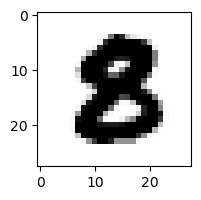

2.5642605634144506e-06% - 0
2.7397764473659003e-09% - 1
1.3693106225526303e-06% - 2
2.0228369370659007e-08% - 3
4.315535136696376e-13% - 4
0.0009136373137827575% - 5 - ОШИБКА
3.145117195603967e-09% - 6
5.391400537910784e-11% - 7
4.093427719430424e-09% - 8
3.106564097959434e-18% - 9

 8


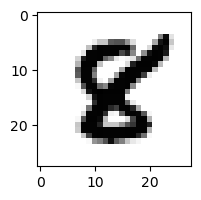

6.328980630379438e-08% - 0
8.455664123561954e-07% - 1
1.943886928919546e-05% - 2
7.288273520740616e-10% - 3
1.9304024062355016e-06% - 4
0.27149996693424794% - 5 - ОШИБКА
1.1549532340974907e-08% - 6
1.675994826941094e-08% - 7
0.0027695814320908623% - 8
3.665733888301584e-14% - 9

 3


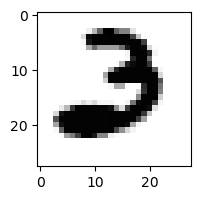

0.011115486786941726% - 0
6.411031611289406e-07% - 1
80.80668635985502% - 2 - ОШИБКА
2.4340363178354476e-05% - 3
4.865147362305682e-13% - 4
5.420914934114656e-10% - 5
4.222585149898394e-05% - 6
1.9276847538301927e-05% - 7
5.396129879732948e-15% - 8
6.055985921562936e-19% - 9

 8


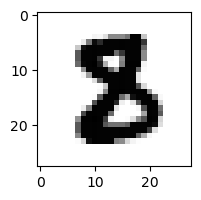

3.4834319165323333e-08% - 0
1.864919736030954e-06% - 1
0.003276085730790963% - 2
1.75736329463646e-06% - 3
5.75958383409117e-14% - 4
0.0035456484106493593% - 5 - ОШИБКА
5.914683382570722e-08% - 6
7.98052660510902e-09% - 7
2.524971729840581e-10% - 8
8.942312755786512e-23% - 9

 5


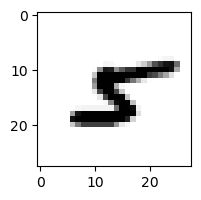

2.6149797891761576e-05% - 0
0.5561646452322542% - 1
0.0030365036601916954% - 2
5.110868028813141e-06% - 3
0.021538755399353782% - 4
0.002606044233385736% - 5
0.12100510897150127% - 6
0.0006079383105169958% - 7
80.49776648823442% - 8 - ОШИБКА
5.483885763974243e-06% - 9

 5


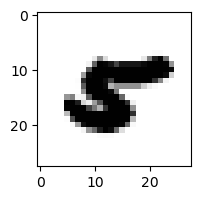

2.7126175371029094e-05% - 0
4.5136810431846926e-05% - 1
2.115952893743901e-06% - 2
3.235282592420754e-15% - 3
0.0009031120233364059% - 4
7.486432132100509e-08% - 5
0.0009915110573191898% - 6 - ОШИБКА
3.7323023551561595e-05% - 7
0.0006090150150603109% - 8
7.280209223469809e-09% - 9

 8


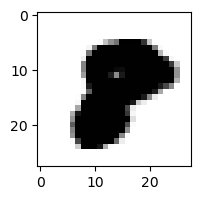

3.3753007971899585e-06% - 0 - ОШИБКА
6.765997982137027e-11% - 1
1.0737437729936445e-09% - 2
3.9696201824394754e-17% - 3
4.665355469934701e-12% - 4
2.8699074473058513e-09% - 5
1.215643547778192e-12% - 6
3.5529000810356586e-08% - 7
1.1539026754375192e-07% - 8
3.220402732676656e-18% - 9

 3


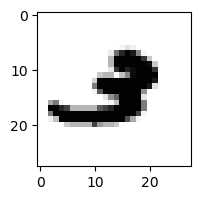

7.539575228401793e-06% - 0
0.0014264260371675754% - 1
0.04648852692686345% - 2 - ОШИБКА
2.416380760032722e-06% - 3
0.0004354836742815998% - 4
4.028730700152275e-09% - 5
7.029611767235385e-05% - 6
0.006835747136064424% - 7
5.908988147102937e-07% - 8
0.014948087127401026% - 9

 5


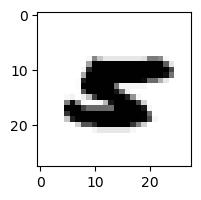

3.6848268414738905e-07% - 0
1.359819470667585e-05% - 1
7.070824544889971e-07% - 2
1.8211397223603408e-13% - 3
5.225487934171088e-05% - 4
2.7745870990184828e-08% - 5
0.0002619605637171017% - 6 - ОШИБКА
1.3631934981310153e-05% - 7
2.9940931963016495e-07% - 8
3.591718789062442e-10% - 9

 8


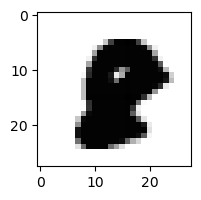

3.871095235295169e-08% - 0 - ОШИБКА
7.951000390138421e-10% - 1
2.800587493960278e-10% - 2
1.1210605784987362e-14% - 3
2.306338054946311e-11% - 4
9.182113013175121e-10% - 5
7.902527573955836e-11% - 6
1.14605873179439e-08% - 7
7.59100612278352e-09% - 8
3.0836982934688946e-17% - 9

 9


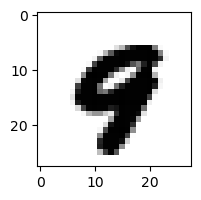

1.592625998017943e-07% - 0
6.142908385115902e-09% - 1
1.175073099992141e-11% - 2
1.1012594091652923e-13% - 3
0.08154119100560323% - 4 - ОШИБКА
2.6965883391021355e-07% - 5
6.413391809274198e-07% - 6
0.018927777030357064% - 7
7.199124677942305e-12% - 8
0.0003064172649692897% - 9

 2


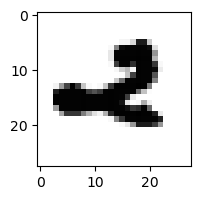

0.00014573649760693576% - 0
7.167526593999294e-05% - 1
0.08814586307516765% - 2
2.0605563385436944e-07% - 3
0.02328428627161184% - 4
3.5863211964119825e-11% - 5
5.7770790487944385e-06% - 6
3.2405151488646734e-07% - 7
5.1691137789625955e-11% - 8
2.619101082788084% - 9 - ОШИБКА

 3


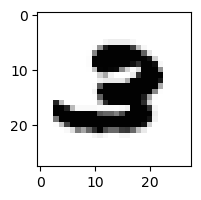

1.646153825718334e-05% - 0
5.1657243562394347e-08% - 1
4.984623645111475% - 2 - ОШИБКА
1.2878837114011055e-05% - 3
8.740213071550034e-13% - 4
4.1980139418117973e-07% - 5
1.5294541067627784e-05% - 6
1.2898028317260848e-05% - 7
3.4338422931781193e-10% - 8
1.9153195768947464e-09% - 9

 5


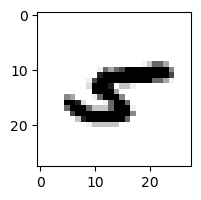

0.0005778360414932922% - 0
0.47570311907029156% - 1
0.0035205871797600046% - 2
4.8101252237616216e-08% - 3
8.007307428151897% - 4
2.0841940057476736e-09% - 5
0.5542977811146843% - 6
0.0016596590767637294% - 7
50.306720924380585% - 8 - ОШИБКА
0.0025655838494974634% - 9

 8


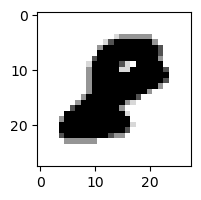

5.514179783739903e-06% - 0
1.9134289789916093e-07% - 1
0.00021874027731483983% - 2 - ОШИБКА
4.364451403659397e-15% - 3
1.7727376652041837e-12% - 4
4.17692204282712e-09% - 5
5.436107849874432e-10% - 6
4.693254497903293e-10% - 7
2.0536457012743595e-09% - 8
5.2786867505593564e-15% - 9

 5


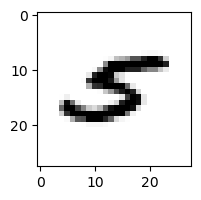

0.009205299507212439% - 0
0.052036427571549526% - 1
0.0009658876113209838% - 2
9.336656162897402e-08% - 3
6.8659092902033% - 4 - ОШИБКА
0.003822290413356713% - 5
3.478057394504279e-05% - 6
0.6577515425186592% - 7
0.0019775862747784053% - 8
8.689632087549432e-05% - 9

 8


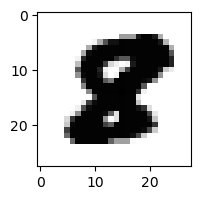

2.404941775828001e-09% - 0
1.1367011274125731e-11% - 1
7.781341227741861e-08% - 2
1.6985769184946154e-15% - 3
1.627076404699334e-11% - 4
0.0026262707305600725% - 5 - ОШИБКА
1.1330165661350577e-12% - 6
5.34081806149409e-13% - 7
1.2937358534186368e-08% - 8
4.30970643698531e-23% - 9

 3


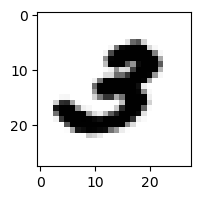

0.0011008228396720532% - 0
5.677021170229462e-06% - 1
0.17737182176493402% - 2 - ОШИБКА
0.009960580069990104% - 3
1.3033870249939563e-08% - 4
7.878465189909576e-05% - 5
1.1920383689969378e-07% - 6
4.518241028967974e-05% - 7
4.905289591429967e-10% - 8
1.525936235333516e-08% - 9

 2


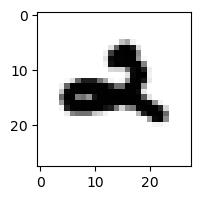

0.009376019359858151% - 0
3.76789322713432e-05% - 1
0.00012059200936528112% - 2
4.53190387415071e-05% - 3
35.18519401117073% - 4
3.594325120430801e-09% - 5
0.003812024718658012% - 6
2.365938094364726e-05% - 7
1.3831780125766878e-13% - 8
95.13193058520015% - 9 - ОШИБКА

 5


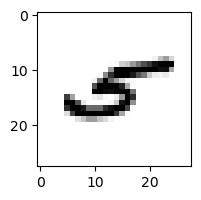

0.003075463859504738% - 0
1.7262577109765496% - 1
0.16342700764644424% - 2
9.284099687704253e-06% - 3
79.28638294258033% - 4 - ОШИБКА
1.2245839736691973e-05% - 5
0.0012148500736052443% - 6
0.061078475883718085% - 7
7.7046797125344515% - 8
0.02179085402549727% - 9

 3


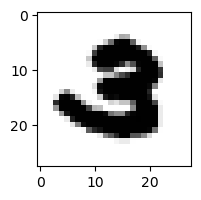

1.3004448431931865e-05% - 0
1.1144649769128873e-09% - 1
0.06099550713522143% - 2 - ОШИБКА
9.19304074783125e-07% - 3
1.843332150349468e-12% - 4
6.143644457083855e-10% - 5
1.4840123533634544e-07% - 6
1.2326118170171925e-08% - 7
2.2377773522795974e-13% - 8
4.277754551083532e-16% - 9

 2


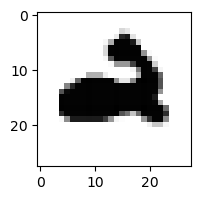

0.004868561236886661% - 0
9.156427028911558e-10% - 1
2.9074000426028834e-05% - 2
8.151469483706887e-12% - 3
0.10745108611927459% - 4 - ОШИБКА
9.99425529161428e-13% - 5
0.008726559818722978% - 6
2.4822598914376767e-10% - 7
1.1189703071681738e-14% - 8
0.0012275442091323845% - 9

 5


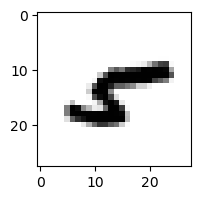

0.0016352177095508749% - 0
0.5507283570900695% - 1
0.20900780717708778% - 2
3.031339669589947e-07% - 3
0.1629999880829787% - 4
4.892824139593629e-07% - 5
4.1610166680454475% - 6
0.00042671177200696685% - 7
95.21632745737769% - 8 - ОШИБКА
0.006421084474810209% - 9

 8


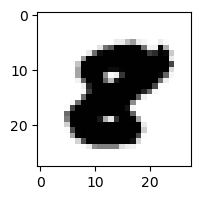

7.051855626681533e-07% - 0 - ОШИБКА
5.108636599172198e-11% - 1
2.1415812396324232e-08% - 2
7.412934906758755e-19% - 3
3.7993214153359386e-11% - 4
5.363732355783005e-07% - 5
3.984558549332717e-14% - 6
6.180620611364296e-09% - 7
2.4914094481313935e-07% - 8
7.880322603215704e-17% - 9

 8


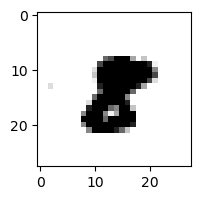

1.8268145935426435e-07% - 0
0.6109771905603772% - 1 - ОШИБКА
0.0004445460830947931% - 2
4.6483514472156135e-08% - 3
4.002448604020684e-06% - 4
6.639188709480307e-07% - 5
0.14268056921590944% - 6
0.0004614942718088807% - 7
0.014101841927253327% - 8
4.160625333932367e-05% - 9

 2


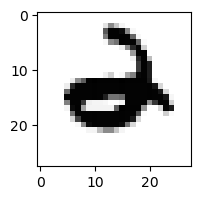

0.00042011424889453814% - 0
1.4839665720242624e-07% - 1
1.0520641984426613e-06% - 2
4.45718728831525e-09% - 3
11.906999256496785% - 4
3.328352120611476e-08% - 5
25.677928037560633% - 6 - ОШИБКА
8.251175066367452e-08% - 7
3.269909655027551e-16% - 8
1.1050014347799134e-08% - 9

 8


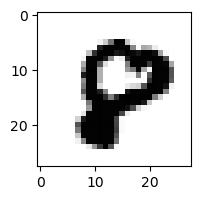

0.3879295881340022% - 0 - ОШИБКА
2.828495515208898e-10% - 1
3.246132353687636e-05% - 2
8.71787350114614e-15% - 3
3.5295762968960453e-06% - 4
5.83363160319228e-06% - 5
1.44043227170355e-07% - 6
0.0015869022305949917% - 7
0.000249220402298778% - 8
5.207895602593634e-12% - 9

 3


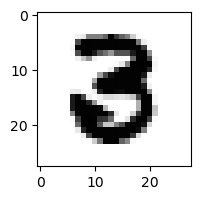

0.00013263582170379% - 0
1.5809397658772546e-07% - 1
0.009580062562249718% - 2 - ОШИБКА
0.0026910677020076253% - 3
8.543355148100485e-10% - 4
1.5799428513459153e-07% - 5
1.0330719729995165e-07% - 6
1.3974293178262055e-08% - 7
1.534720451443178e-12% - 8
3.5146469708028045e-20% - 9

 8


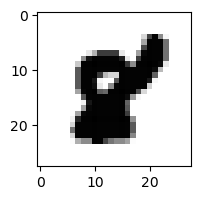

1.5876883768833566e-07% - 0
2.912600812850053e-05% - 1
7.784790228455633e-09% - 2
4.9170126799374e-19% - 3
3.8327118651051457e-07% - 4
0.00036694157350939814% - 5 - ОШИБКА
8.105516001334953e-09% - 6
8.740282042852965e-06% - 7
5.195568457594851e-09% - 8
3.839719502845705e-15% - 9

 9


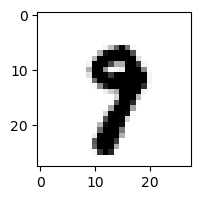

1.0846019140256273e-07% - 0
0.001482824226425343% - 1
2.2418388748051835e-07% - 2
1.6177497372503993e-05% - 3
6.0456803844738174e-05% - 4
0.004378247288947713% - 5
6.933233012285049e-06% - 6
2.700266910850393% - 7 - ОШИБКА
0.00010130191000235885% - 8
0.07610633448679399% - 9

 8


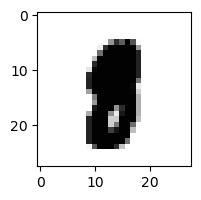

1.065435825615689e-08% - 0
8.201196453567333e-05% - 1
1.629982869291767e-08% - 2
1.2245749859840966e-09% - 3
1.793761064484884e-08% - 4
0.0007437647620369378% - 5 - ОШИБКА
1.2397311114832135e-06% - 6
1.950183728607037e-06% - 7
1.975545083443817e-06% - 8
2.3261907325117804e-10% - 9

 9


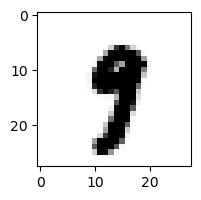

1.0548416315123e-07% - 0
0.017554230436316397% - 1
1.227508244831455e-09% - 2
0.002376873227479376% - 3
0.00022165039650985394% - 4
0.005004971508027982% - 5
2.9579027401980386e-07% - 6
0.32825661045805243% - 7 - ОШИБКА
2.571334699830546e-07% - 8
0.013663457600611703% - 9

 8


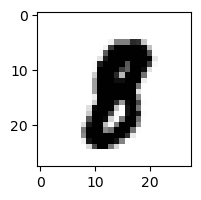

1.7752215642481775e-06% - 0
0.0004363197970386079% - 1 - ОШИБКА
5.788875905035648e-07% - 2
3.4078953754106105e-06% - 3
4.484217598973772e-09% - 4
0.00015098768775281997% - 5
7.743780127417862e-08% - 6
6.447847160560896e-06% - 7
6.864747832058695e-05% - 8
3.105711266451709e-10% - 9

 4


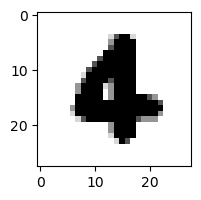

2.1708843802222824e-09% - 0
3.255544060062292e-05% - 1
6.720931010331133e-07% - 2
2.3341492677026347e-13% - 3
1.7723330268773667e-05% - 4
7.938306552742093e-08% - 5
0.03778209024304024% - 6 - ОШИБКА
5.365997523591862e-08% - 7
4.857521831915786e-20% - 8
2.526485432170328e-12% - 9

 2


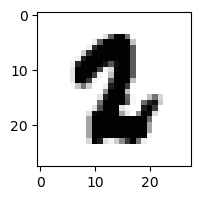

9.745574973128085e-11% - 0
0.0035116996055435065% - 1 - ОШИБКА
0.0006602510846729768% - 2
1.0717435976227511e-09% - 3
4.597499609248704e-13% - 4
0.00135966986202936% - 5
5.430416445771276e-05% - 6
1.3510198087452343e-06% - 7
5.092257761083832e-11% - 8
2.1885150960163544e-16% - 9

 2


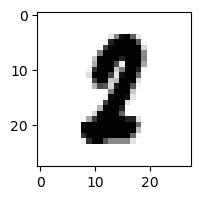

4.4748144014183436e-07% - 0
0.09371295071537529% - 1 - ОШИБКА
0.000587705758200428% - 2
6.032952114695782e-08% - 3
3.482585582559964e-10% - 4
0.014010168134831686% - 5
1.4461037811209166e-06% - 6
9.905616050212516e-05% - 7
5.665643313763019e-07% - 8
5.425073540445092e-13% - 9

 4


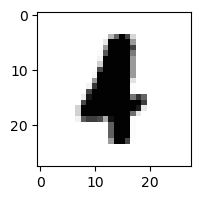

4.519952771054208e-09% - 0
0.09325128410142342% - 1 - ОШИБКА
0.005084246150469277% - 2
5.210226592572578e-10% - 3
0.00017987514552107736% - 4
4.513145537710243e-06% - 5
0.0115479758258393% - 6
7.788232322706822e-07% - 7
2.472449519252737e-09% - 8
9.604248453580552e-07% - 9

 8


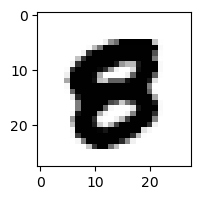

0.0001302997946029599% - 0
6.907107379216814e-13% - 1
5.696620261251484e-10% - 2
1.0426123819093802e-12% - 3
8.000875830407808e-10% - 4
0.0015634229203833178% - 5 - ОШИБКА
5.800941910088407e-09% - 6
1.7579826897514493e-10% - 7
2.76942425169797e-11% - 8
1.6566773445160365e-14% - 9

 8


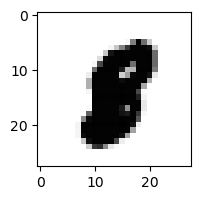

8.10587666707099e-08% - 0
2.1180176365910968e-05% - 1
5.027911039659121e-08% - 2
8.057782494920584e-11% - 3
2.896121572783518e-09% - 4
2.5270327425368818e-05% - 5 - ОШИБКА
2.6444409793035107e-07% - 6
4.731438396557941e-06% - 7
9.894167625076225e-08% - 8
7.839758894019027e-11% - 9

 3


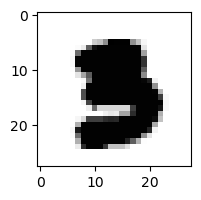

1.2769275295219145e-10% - 0
5.235530173057617e-11% - 1
2.221012685363745e-10% - 2
1.3842392401377976e-05% - 3
6.54974632101136e-13% - 4
0.0022967554818264678% - 5 - ОШИБКА
2.8045155846140675e-09% - 6
1.3100566351473476e-08% - 7
4.375631226573564e-20% - 8
1.0812220125095042e-22% - 9

 9


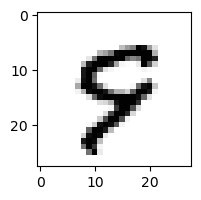

0.0017881825520484717% - 0
1.9670737318087346e-05% - 1
0.00019563054781061192% - 2
1.7492168849451212e-06% - 3
0.6090717529416274% - 4
71.4842094256823% - 5 - ОШИБКА
0.001007015765677202% - 6
0.8791705803515% - 7
6.688901591747282e-08% - 8
12.093360374474589% - 9

 9


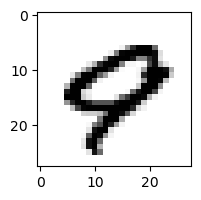

2.529666919781478% - 0
4.3956899542230386e-07% - 1
8.236962937831818e-09% - 2
1.421291960159312e-15% - 3
0.12590575969652798% - 4
6.899893543121012e-08% - 5
0.0002365569153016291% - 6
5.260506386041288% - 7 - ОШИБКА
1.0969345112026978e-07% - 8
3.412563755974809% - 9

 7


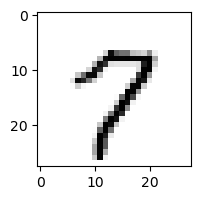

0.207453407614615% - 0
0.0011293493205421774% - 1
0.005816948931177988% - 2
0.0004576928393615817% - 3
0.14351318014532% - 4
1.6707242986439514% - 5
0.002421550529891298% - 6
89.36228549816997% - 7
2.589622726491258% - 8
96.5158948465561% - 9 - ОШИБКА

 8


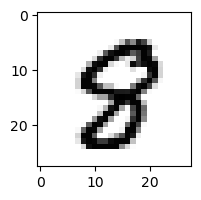

0.0005478847211173071% - 0
5.564359337071723e-07% - 1
7.945566589759931e-07% - 2
3.835995966518928e-08% - 3
0.0002085404474050051% - 4
0.15558484074734283% - 5 - ОШИБКА
2.9804005851169365e-06% - 6
0.00200964051954671% - 7
0.0002649557527374636% - 8
4.0769976866632676e-07% - 9

 9


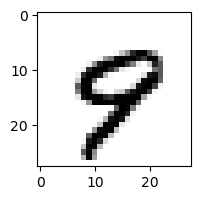

0.004022473134299095% - 0
1.1263804679542227e-05% - 1
1.479783607743387e-06% - 2
6.508445689526282e-09% - 3
0.5695058571952067% - 4
0.023331841389539604% - 5
0.00048306649298251114% - 6
3.9015931346245427% - 7 - ОШИБКА
2.1387628065971205e-07% - 8
1.8856137484084812% - 9

 1


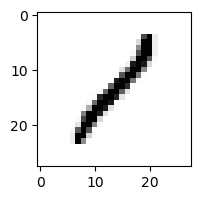

0.17829467471565033% - 0
94.53134471745831% - 1
50.31743668628879% - 2
1.6115313691221167% - 3
0.14175177662276775% - 4
0.21702917542140185% - 5
0.043175235683389865% - 6
0.00782827393664355% - 7
97.1241392119753% - 8 - ОШИБКА
0.57823600926471% - 9

 3


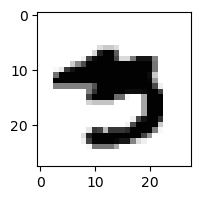

1.551824330528823e-07% - 0
1.2480458179175433e-07% - 1
4.990976427196619e-15% - 2
0.0009738764393768662% - 3
1.4927292984406844e-06% - 4
0.06773518090183445% - 5 - ОШИБКА
1.2134464557733012e-08% - 6
6.861982004956326e-05% - 7
1.4902486733988204e-09% - 8
1.381602024988676e-09% - 9

 3


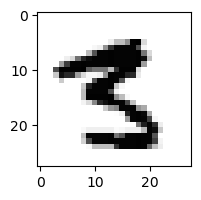

7.809331442584188e-07% - 0
1.6354103407009984e-06% - 1
1.4171462057175533e-05% - 2
0.00010738071899616652% - 3
3.077301409496645e-07% - 4
11.341767999836849% - 5 - ОШИБКА
7.760010242080025e-12% - 6
5.9853066549563645e-06% - 7
3.221171853632484e-07% - 8
3.8154281757316924e-08% - 9

 0


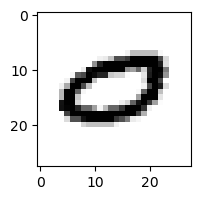

64.43274083730306% - 0
2.5706941804252333e-06% - 1
1.7403756846800135e-06% - 2
1.5483531914273482e-13% - 3
0.003945649258479211% - 4
7.551955244558351e-07% - 5
0.00037281859183334765% - 6
75.98140338402496% - 7 - ОШИБКА
2.3679395071600015e-07% - 8
5.082238869855887e-05% - 9

 9


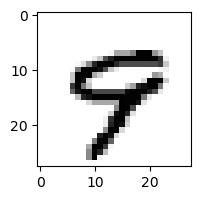

0.0006003736812996498% - 0
1.2303977502938404e-06% - 1
1.2176710959841534e-07% - 2
8.874422220101848e-10% - 3
2.6014775915347887% - 4
0.17384409736735093% - 5
0.00018350436705122245% - 6
2.6167394068053027% - 7 - ОШИБКА
9.82453738821323e-08% - 8
0.9086457922356646% - 9

 3


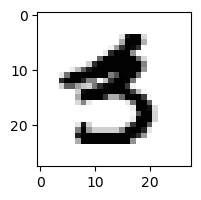

9.179352316732924e-05% - 0
0.0002993013769115117% - 1
3.3506487953245157e-10% - 2
0.0016516352054681176% - 3
5.736278670232651e-07% - 4
6.333460241026136% - 5 - ОШИБКА
6.537186676738312e-08% - 6
2.8603646498931837e-06% - 7
1.1829910274334263e-13% - 8
2.045615493279345e-08% - 9

 8


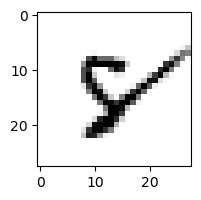

0.0013961073197198551% - 0
0.010546612109717416% - 1
0.2885842908525947% - 2
1.4419449297481984e-08% - 3
1.1079806973629511% - 4
1.2879480749236116% - 5
7.819743486993633% - 6 - ОШИБКА
5.845420525631224% - 7
0.0020310549593944753% - 8
0.05597753554977057% - 9

 3


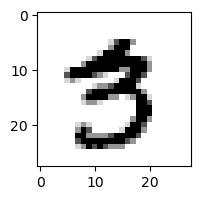

0.0005601521890007078% - 0
1.7381341490297508e-05% - 1
2.5127130343242774e-06% - 2
0.06973379676455695% - 3
1.3098099332026737e-07% - 4
0.8164022269277071% - 5 - ОШИБКА
2.2789068724775787e-09% - 6
0.005903043442180452% - 7
4.7827973992938394e-08% - 8
3.8243030830831107e-07% - 9

 8


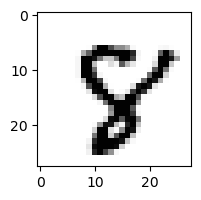

3.394924325345511e-06% - 0
1.0857170116196516e-08% - 1
6.238970912386351e-07% - 2
1.3336243158452145e-08% - 3
0.0070127502827719585% - 4
2.3905387243188816% - 5 - ОШИБКА
3.692984535765351e-05% - 6
0.1001207616058404% - 7
0.21886663910582146% - 8
1.9963123259554373e-05% - 9

 3


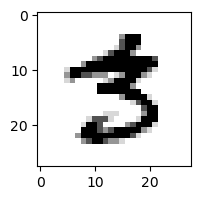

0.0006793362409041911% - 0
0.0004524016898458379% - 1
1.3265437631041527e-05% - 2
0.09101592515441641% - 3
5.063942144354434e-10% - 4
1.1583668047845819% - 5 - ОШИБКА
2.6198759222701464e-08% - 6
0.006644787489592115% - 7
1.373248885640558e-09% - 8
1.2022212818019852e-10% - 9

 3


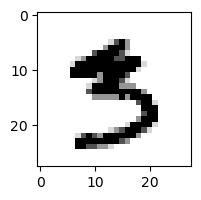

1.5770621654467805e-05% - 0
0.000227290801230746% - 1
4.814851207297674e-09% - 2
0.280299671036437% - 3
4.4897619901370824e-07% - 4
49.9839823986232% - 5 - ОШИБКА
1.5117451386659513e-08% - 6
0.0009702271105641414% - 7
1.9009537482873756e-09% - 8
1.4315030185328406e-09% - 9

 9


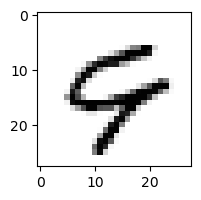

0.03337831010540618% - 0
3.1720279007639207e-06% - 1
7.646856049730287e-05% - 2
1.7542511099129044e-10% - 3
7.475511152662907% - 4 - ОШИБКА
0.0002526800639839169% - 5
0.4585155001357192% - 6
3.9642702859532806% - 7
3.1185944881981116e-07% - 8
5.719249130807942% - 9

 0


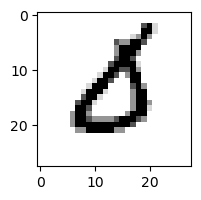

68.52553807620232% - 0
2.8762297444000037e-06% - 1
0.17943916201642363% - 2
0.2007643287979866% - 3
1.5403872604409355e-05% - 4
0.3178476914358368% - 5
78.64303525872428% - 6 - ОШИБКА
0.00048138001876071076% - 7
5.460228932753605e-13% - 8
1.369268458316165e-08% - 9

 9


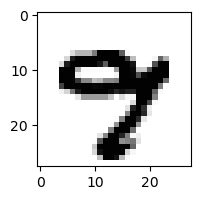

1.8942584290665269e-07% - 0
1.3281157763893332e-09% - 1
5.433846525777419e-14% - 2
3.4186200273905903e-06% - 3
2.0283095562611147e-05% - 4
7.17440386376074e-07% - 5
2.9082918715450683e-06% - 6
10.01364755469504% - 7 - ОШИБКА
2.7218575735578338e-09% - 8
7.81383736309721e-06% - 9

 8


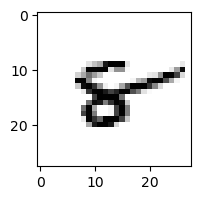

0.003301574220556649% - 0
0.11530858654384127% - 1
0.1482135390110049% - 2
2.972627521549883e-09% - 3
26.202832929807595% - 4
0.0015573726885909605% - 5
99.71451738448434% - 6 - ОШИБКА
0.04037846395983311% - 7
11.408213864773105% - 8
49.394636493041396% - 9

 2


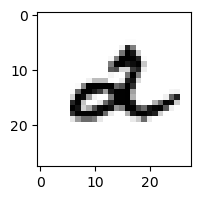

0.004007155025329828% - 0
0.04656711763903689% - 1
1.320932185671832% - 2
0.0026410173765355504% - 3
23.787446334387454% - 4 - ОШИБКА
4.398233014872148e-06% - 5
0.7366571634266764% - 6
0.0011334228357840468% - 7
2.6090309432063602e-08% - 8
1.0637309581709415% - 9

 3


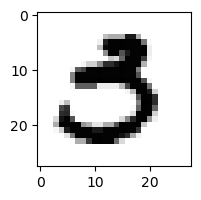

0.14172507666966006% - 0
5.8114990428799765e-06% - 1
3.0230560956862197e-09% - 2
0.5597528352421911% - 3
1.3554421511477376e-11% - 4
6.6838596517740125% - 5 - ОШИБКА
1.5723441124569403e-08% - 6
0.00010517318284137483% - 7
2.8620620334537934e-14% - 8
4.3134356095043413e-14% - 9

 9


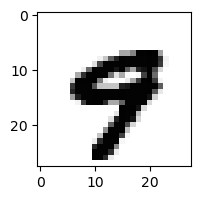

1.408781406124535e-05% - 0
1.8664745113981975e-08% - 1
1.3247815078409712e-13% - 2
6.901550412448784e-09% - 3
0.9968372341954888% - 4 - ОШИБКА
0.0011306733887761118% - 5
1.8626980326392865e-06% - 6
0.389710627349523% - 7
5.128619246368281e-13% - 8
0.0019590473144437187% - 9

 9


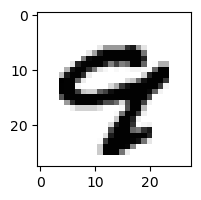

1.0488195598355367e-05% - 0
3.373320408830397e-10% - 1
9.701523196001604e-09% - 2
1.0658182282575321e-10% - 3
0.0002173897520729411% - 4
6.56929844029676e-08% - 5
2.1900227277634826e-06% - 6
0.04490152060553275% - 7 - ОШИБКА
1.2544856828746012e-09% - 8
0.0011097162048159556% - 9

 8


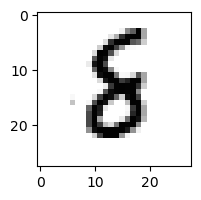

1.976721197628843e-05% - 0
0.005027242850967497% - 1
0.06799512578056209% - 2
0.0032068745169963908% - 3
1.6341121103078034e-05% - 4
0.12146790803584646% - 5
74.52748533645355% - 6 - ОШИБКА
5.827513331497827e-06% - 7
24.444645523294273% - 8
1.374306291309925e-07% - 9

 9


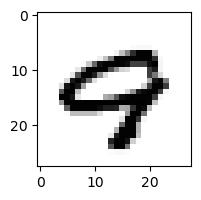

0.015145092966107778% - 0
2.484583089956551e-07% - 1
3.6659908618346665e-09% - 2
3.446125379809485e-12% - 3
1.8350297302297185% - 4
1.6067786862358801e-07% - 5
4.827406193993272e-05% - 6
4.738945504020804% - 7 - ОШИБКА
4.429426513717751e-09% - 8
3.609928765757261e-05% - 9

 9


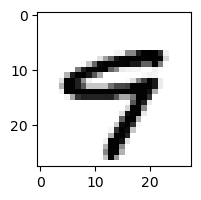

0.0016148094544535855% - 0
7.906540820386747e-07% - 1
1.3318837577905587e-10% - 2
6.243102324160065e-08% - 3
0.49470075063541996% - 4
3.015501225323673% - 5 - ОШИБКА
2.2501771997933303e-05% - 6
0.6751056661896577% - 7
8.059481422735836e-09% - 8
0.49009962516037814% - 9

 5


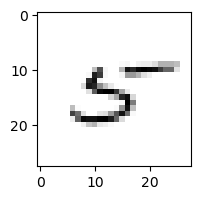

1.9844988841568674% - 0
0.4329885354335839% - 1
5.302889938634281% - 2
0.1110562102085277% - 3
66.82067516576767% - 4 - ОШИБКА
14.074590313014737% - 5
13.233817141831405% - 6
1.6971563713725075% - 7
66.17266721774536% - 8
9.787358124760566% - 9

 8


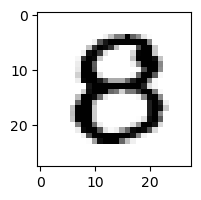

3.08937553359814% - 0 - ОШИБКА
7.589292467914901e-10% - 1
0.0009624447236253444% - 2
0.00017595853492277327% - 3
0.001930760805884898% - 4
1.3309378485460122% - 5
4.459937373756176e-06% - 6
1.69907925770191e-09% - 7
0.001581940052289188% - 8
4.293030994057518e-14% - 9

 9


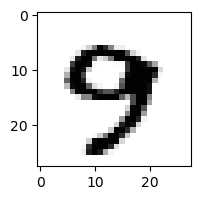

7.490134811418507e-05% - 0
6.888642727109265e-09% - 1
9.147383367039331e-10% - 2
0.048494572738382% - 3
0.007837474266807105% - 4
0.0006492717327197183% - 5
6.876227895372313e-06% - 6
31.421552550510633% - 7 - ОШИБКА
1.0483286418023353e-08% - 8
0.05942845037725962% - 9

 9


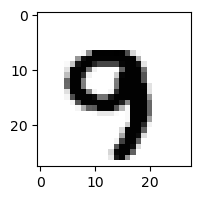

8.101896445358653e-10% - 0
1.547202405304964e-05% - 1
1.1649507835924088e-07% - 2
9.410153775294597e-09% - 3
0.006061016011219677% - 4
1.559710846147133e-06% - 5
5.682234663818947e-06% - 6
1.3231365628949472% - 7 - ОШИБКА
4.9538547075376744e-14% - 8
0.015808448234868554% - 9

 8


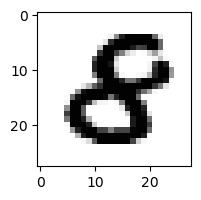

0.0010120315611138568% - 0
8.705784848562904e-08% - 1
7.168718973650891e-05% - 2
7.263784074912857e-08% - 3
4.1574512099588675e-06% - 4
0.003500627823804658% - 5 - ОШИБКА
2.4629081461047185e-05% - 6
2.2882337340141175e-12% - 7
5.7944602125555964e-08% - 8
9.02026652747083e-17% - 9

 9


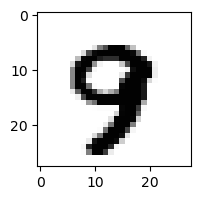

1.6887809860210798e-06% - 0
1.0665313483499149e-08% - 1
4.585396412965621e-08% - 2
0.0001180448822543054% - 3
0.0008526714351477564% - 4
0.00065731038745814% - 5
2.1965394927352637e-06% - 6
1.5818994263595538% - 7 - ОШИБКА
4.0967868679762346e-09% - 8
0.16302641160805773% - 9

 8


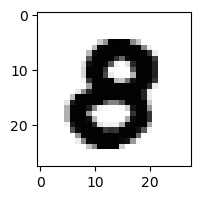

0.0027137263075742274% - 0 - ОШИБКА
2.0901223648689642e-12% - 1
8.831995940805143e-06% - 2
1.5659698021768838e-06% - 3
5.0102206110319577e-08% - 4
0.00041099535368524433% - 5
9.634274256722417e-11% - 6
4.386501379490077e-10% - 7
8.613374166093943e-08% - 8
6.01889841593788e-14% - 9

 4


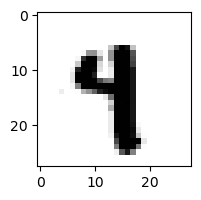

1.284607633100291e-10% - 0
0.060910226831057054% - 1 - ОШИБКА
3.563324783025981e-10% - 2
5.506957296795836e-07% - 3
0.020229218964255922% - 4
0.00813343701889397% - 5
6.169235795058595e-05% - 6
0.017257115748955464% - 7
1.4533889589306716e-09% - 8
0.03210781892980813% - 9

 8


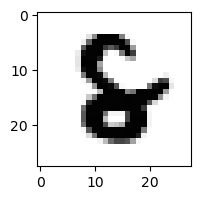

1.1000217304510179e-07% - 0
1.614080283652331e-09% - 1
0.008887301117384276% - 2
1.7134340851320392e-10% - 3
7.694646093950215e-05% - 4
0.00026533327789556276% - 5
3.6806299110045972% - 6 - ОШИБКА
1.5052787338238795e-08% - 7
3.444928208593078e-05% - 8
3.091391678145829e-16% - 9

 9


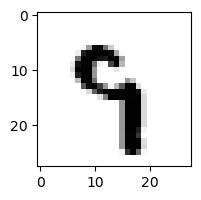

2.896428716623249e-08% - 0
9.466607946292896e-05% - 1
9.937587906075555e-05% - 2
0.003846840355066463% - 3
4.790143514871934% - 4
5.728859402537719% - 5 - ОШИБКА
0.21165629023257976% - 6
0.49715223309839607% - 7
0.00021188612692986817% - 8
0.06532408923660565% - 9

 8


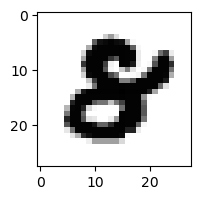

5.464979794261456e-05% - 0
4.1292264384931686e-12% - 1
4.621915202364556e-05% - 2
8.135449536680491e-10% - 3
8.520000602297145e-09% - 4
0.00020069673823741463% - 5 - ОШИБКА
8.4931243346953e-08% - 6
7.529879915489256e-10% - 7
1.1970555800807954e-09% - 8
2.9864433294927315e-15% - 9

 8


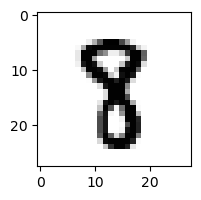

1.1161532207114616e-08% - 0
0.008235727230339137% - 1
3.5618820648816016e-05% - 2
0.0025955032976471173% - 3
7.853327207153169e-05% - 4
0.4956715976177436% - 5 - ОШИБКА
2.697435330438516e-07% - 6
0.0003628417574390926% - 7
0.4059769668766615% - 8
6.080563925293401e-11% - 9

 2


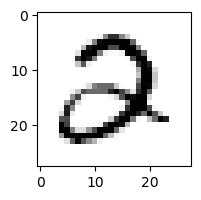

0.09562554607997004% - 0
1.0442569152642903e-07% - 1
73.44359109088441% - 2
98.31158923436143% - 3 - ОШИБКА
3.323080420995999e-05% - 4
0.001963554143040127% - 5
3.428894869428823e-05% - 6
0.0030215259394070545% - 7
9.573949170356878e-11% - 8
9.951154640721566e-10% - 9

 8


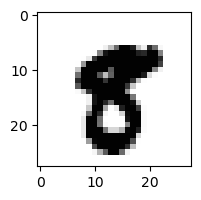

1.810788615315199e-07% - 0
4.3477022991887686e-07% - 1
1.7482637626984593e-12% - 2
4.375064386647685e-09% - 3
1.890125982853658e-08% - 4
0.024214560156047567% - 5 - ОШИБКА
3.2572221523586645e-11% - 6
0.00010917813754931417% - 7
0.00018246640655947264% - 8
7.103145755797709e-08% - 9

 8


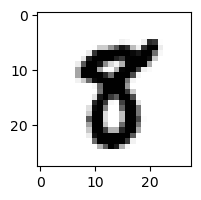

5.71160130655114e-06% - 0
0.0003496328806017326% - 1
3.1978444678331386e-08% - 2
4.0746321729630435e-07% - 3
1.919344784317845e-07% - 4
3.0986685982648776% - 5 - ОШИБКА
1.832393404650169e-08% - 6
6.794667822526682e-05% - 7
0.07817190590862691% - 8
7.20692692902662e-08% - 9

 8


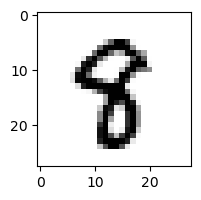

7.150357105911994e-07% - 0
0.0016189564029598928% - 1
5.211036731805604e-07% - 2
5.54313512372831e-05% - 3
0.016821355644878754% - 4
0.41345801490867323% - 5 - ОШИБКА
4.121476782772382e-06% - 6
0.00012610821849696026% - 7
0.009874645615670929% - 8
1.0422928291711535e-06% - 9

 8


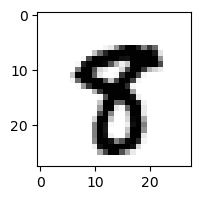

1.4178198112562466e-08% - 0
2.3353856485682568e-06% - 1
8.488538752506985e-10% - 2
1.2850025857537212e-07% - 3
1.8371969551775342e-05% - 4
0.16585337950824727% - 5 - ОШИБКА
3.1078211664008207e-10% - 6
0.005210900704018375% - 7
0.0002869590959390561% - 8
2.621288856745548e-05% - 9

 8


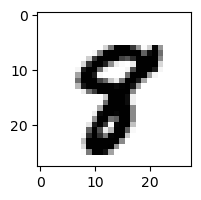

1.473921052030326e-07% - 0
1.4392438520438957e-06% - 1
2.583993848949174e-09% - 2
1.3313430432511668e-10% - 3
2.1832934321395226e-05% - 4
0.04192041659317876% - 5 - ОШИБКА
5.3851192207315534e-08% - 6
0.0012099165348141345% - 7
0.0030287681333825167% - 8
0.00028154425859357624% - 9

 8


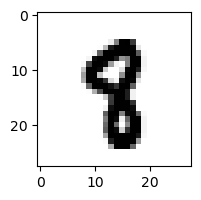

2.130976575072494e-09% - 0
0.004802076639357261% - 1
7.645377956590735e-06% - 2
6.354011074398448e-07% - 3
0.004021820941141461% - 4
0.03704374840085512% - 5 - ОШИБКА
6.50212729436002e-06% - 6
0.000597129214294752% - 7
3.700088713718006e-05% - 8
1.229869495761764e-06% - 9

 8


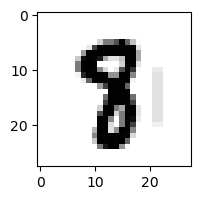

2.0232812687090173e-09% - 0
0.0012894203687177843% - 1
3.8764463816789166e-07% - 2
4.443270373726971e-07% - 3
4.028015869898406e-06% - 4
0.13057865446350517% - 5 - ОШИБКА
4.700015947929657e-06% - 6
0.00020864345262356618% - 7
0.054214685611680816% - 8
2.3128866937391018e-10% - 9

 8


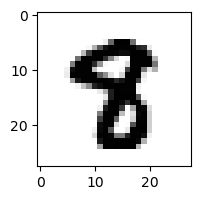

1.0116742112302217e-10% - 0
1.1594124268429937e-06% - 1
3.1461360491422514e-10% - 2
2.796948863248338e-08% - 3
8.104418214848798e-05% - 4
0.05899079850750977% - 5 - ОШИБКА
1.773425764559008e-10% - 6
0.00014077547349714776% - 7
2.2964938158892652e-05% - 8
3.279262155808899e-12% - 9

 8


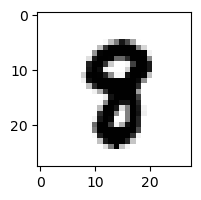

2.567527311617811e-08% - 0
2.721223911376712e-05% - 1
2.837235664642289e-08% - 2
4.420482801867033e-07% - 3
1.828210544170236e-05% - 4
0.0028604950388088344% - 5 - ОШИБКА
6.193914893019457e-07% - 6
9.702005815693228e-05% - 7
0.001104553553168289% - 8
1.4647172601536347e-08% - 9

 3


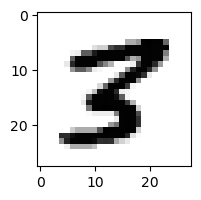

7.995850908492714e-07% - 0
1.2154892782248575e-05% - 1
0.0038667733826168622% - 2
4.425805018331496e-05% - 3
8.76273635225378e-06% - 4
0.25478725324304724% - 5 - ОШИБКА
3.978292789207656e-10% - 6
4.799115623840053e-05% - 7
0.0007046582274095818% - 8
1.284727085069971e-10% - 9

 7


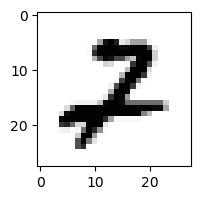

0.0009648720056744827% - 0
0.00217580374729134% - 1
98.73047256383464% - 2 - ОШИБКА
8.780126276494469e-05% - 3
2.3126807437141787e-07% - 4
4.871647305770873e-06% - 5
5.039018198449717e-07% - 6
0.0014974505419662856% - 7
2.6921205501997005e-06% - 8
1.3253702207827832e-08% - 9

 2


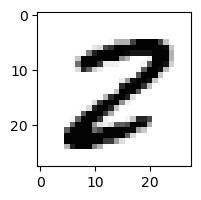

0.002164708036230727% - 0
1.1959791878006383e-06% - 1
0.331031808025489% - 2
7.405406990004322e-08% - 3
1.715530182988405e-09% - 4
0.15357897703018333% - 5
6.921342088568232e-07% - 6
4.531832830774953e-05% - 7
99.98558971812179% - 8 - ОШИБКА
1.2768625448881748e-12% - 9

 5


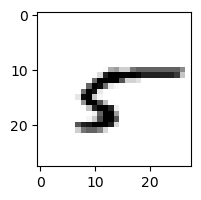

6.247907443649085% - 0
1.1916722915595224% - 1
0.12316168639551342% - 2
0.0010519931654184797% - 3
1.6092439322463983% - 4
0.003132128257689184% - 5
68.51166847571832% - 6 - ОШИБКА
0.05016432617758554% - 7
3.776399441255631% - 8
0.1199780227916712% - 9

 7


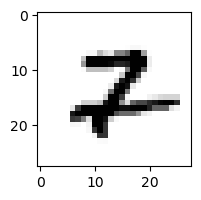

0.00032089802900893297% - 0
0.03182855034616017% - 1
91.9745039658348% - 2 - ОШИБКА
1.461449063457222e-07% - 3
0.0005239479145798996% - 4
5.045352148123469e-06% - 5
0.0007366247255949194% - 6
2.679600747110831% - 7
6.144298199582687e-05% - 8
0.0001756046613484679% - 9

 1


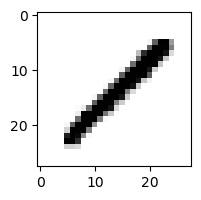

0.0010955148967552206% - 0
28.56423627688614% - 1
4.295251591009061% - 2
0.02661183770939417% - 3
1.8356359565973839% - 4
0.010349927799815126% - 5
2.330268692533805e-05% - 6
0.00823413571266315% - 7
99.9710877669518% - 8 - ОШИБКА
0.0006617345588260463% - 9

 7


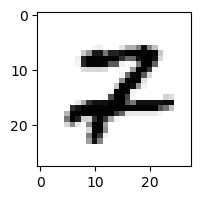

0.002906185400840603% - 0
0.00018265640658219056% - 1
87.91876258044572% - 2 - ОШИБКА
1.7484868257851538e-08% - 3
0.00014117684612167022% - 4
1.2110398717398923e-05% - 5
5.4536892427962945e-06% - 6
2.070044926686742% - 7
0.01672265305350098% - 8
7.66864260939798e-06% - 9

 9


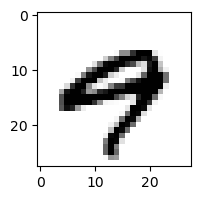

0.12458355206573866% - 0
8.937044114935313e-08% - 1
2.27715614571009e-12% - 2
2.138378144441469e-07% - 3
0.9083842729057503% - 4 - ОШИБКА
9.543992489905582e-07% - 5
0.0023037812523618046% - 6
0.17752889928990817% - 7
1.438663154359782e-10% - 8
0.5221189388134512% - 9

 7


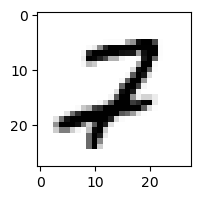

0.008363627083156288% - 0
9.552475739784144e-05% - 1
98.59681361139296% - 2 - ОШИБКА
3.629743163169625e-06% - 3
2.5715412042151833e-05% - 4
0.0012888011555165658% - 5
5.246011369602357e-05% - 6
0.07726113932097663% - 7
0.15973628829222744% - 8
1.2409789855233856e-06% - 9

 1


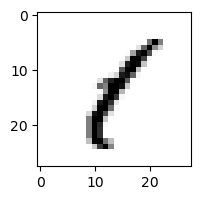

0.051486320039098414% - 0
76.74915378980333% - 1
0.18337233011618384% - 2
0.6041111402574202% - 3
0.2470195469558267% - 4
1.8134689492427642% - 5
0.0034075516599446315% - 6
0.007377125021082914% - 7
79.63415000417545% - 8 - ОШИБКА
0.00879435261535902% - 9

 9


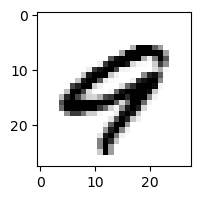

0.025275670353351876% - 0
9.319756991920646e-07% - 1
2.733636806036449e-09% - 2
3.375329072657575e-12% - 3
21.67078185251912% - 4 - ОШИБКА
4.4269783678726795e-06% - 5
0.00037663574554345743% - 6
0.10435902452777855% - 7
6.486058284539303e-08% - 8
0.026051619408637955% - 9

 7


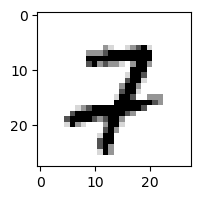

0.0013799411326747622% - 0
6.07438444736997e-06% - 1
41.01714143385954% - 2 - ОШИБКА
1.0057913824665118e-07% - 3
3.49812064841952e-05% - 4
1.9282176872413535e-05% - 5
1.2850430807881782e-05% - 6
31.078640498771342% - 7
0.00412521008574546% - 8
0.00025761866422416177% - 9

 7


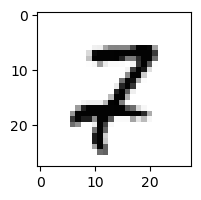

0.015866757997285746% - 0
0.004102840313153535% - 1
76.39247290894913% - 2 - ОШИБКА
1.385793483242189e-06% - 3
3.393012945191692e-05% - 4
0.00020285622270935775% - 5
7.566518720718914e-05% - 6
0.15652070382013006% - 7
11.171838862879213% - 8
0.018123283523904212% - 9

 7


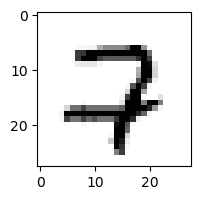

0.10824210220094321% - 0
1.9733060515980121e-07% - 1
88.51518481752862% - 2 - ОШИБКА
3.80908423392657e-06% - 3
4.779173875706173e-05% - 4
8.030652134781203e-06% - 5
0.0021209715608260225% - 6
20.589528116514703% - 7
0.0003556706724293939% - 8
4.7394877551797126e-05% - 9

 2


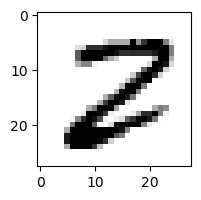

0.00045430886612280813% - 0
4.049292156146482e-07% - 1
2.4212247541406207% - 2
0.00021197918868419926% - 3
8.777699602059241e-10% - 4
0.05198214041788175% - 5
1.9374622829703972e-06% - 6
3.342887296601808e-05% - 7
84.97473597440532% - 8 - ОШИБКА
1.1684871348432341e-15% - 9

 8


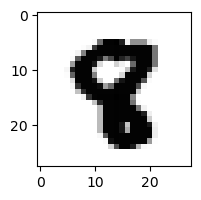

5.18025917264987e-12% - 0
4.5736343791162045e-08% - 1
7.570859630673741e-08% - 2
2.646959335896747e-10% - 3
4.552875509887441e-05% - 4
0.0017015392040946732% - 5 - ОШИБКА
5.944807169782326e-09% - 6
4.0145338696075886e-07% - 7
3.053321648573328e-11% - 8
3.422043740001329e-11% - 9

 8


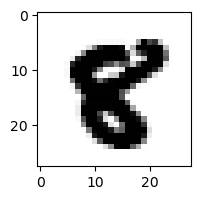

1.2289145863169671e-08% - 0
3.504513004857913e-09% - 1
2.6505472058812654e-09% - 2
1.813116083132013e-16% - 3
2.2794898215707755e-06% - 4
0.0036277870483716664% - 5 - ОШИБКА
1.3342338620524504e-10% - 6
1.5841202154238202e-08% - 7
0.00043886110843259344% - 8
2.0205331326782462e-13% - 9

 8


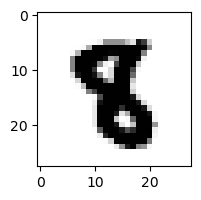

3.940345711732235e-13% - 0
2.008848699696042e-05% - 1
1.7808241905984497e-07% - 2
6.224564521738561e-10% - 3
1.3102612404418213e-06% - 4
0.005636030756726098% - 5 - ОШИБКА
9.535611023022028e-07% - 6
2.9243981736222624e-07% - 7
3.3776492006634453e-13% - 8
2.246423278244895e-12% - 9

 8


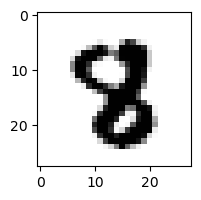

9.224171644066594e-10% - 0
6.90405749929736e-07% - 1
6.520535034722969e-06% - 2
1.887873140916232e-07% - 3
0.00015865223806735946% - 4
0.0008695464153058076% - 5 - ОШИБКА
1.2452046145700541e-07% - 6
0.0002651746793426178% - 7
1.6706670061588405e-09% - 8
1.9775115596838307e-12% - 9

 8


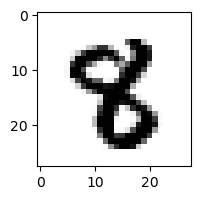

1.3121808608780903e-10% - 0
2.7800712851365723e-05% - 1
7.388362906188655e-07% - 2
1.4420640001091182e-06% - 3
0.002012660857042334% - 4
0.011827027190339614% - 5 - ОШИБКА
1.529270543035627e-08% - 6
6.096929772596661e-05% - 7
5.601465295870024e-09% - 8
2.579691059833214e-12% - 9

 8


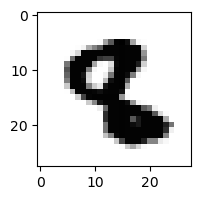

8.941882377598745e-12% - 0
1.4991985783364612e-05% - 1
0.0003316519878811039% - 2
1.0554209885677849e-07% - 3
5.165733189060171e-09% - 4
0.018918997358103564% - 5 - ОШИБКА
3.560186047765929e-08% - 6
1.1489914033211724e-09% - 7
1.3449460993014232e-19% - 8
1.263389628765566e-12% - 9

 8


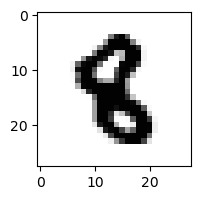

7.876986794732826e-10% - 0
0.0018382047367788668% - 1
4.5025932315585604e-05% - 2
2.44475213643859e-08% - 3
5.1521059562606045e-05% - 4
0.041255120098431276% - 5 - ОШИБКА
0.00014431018526923667% - 6
3.8008110395424574e-08% - 7
1.3974193233101654e-10% - 8
4.20639600439926e-10% - 9

 8


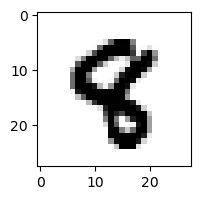

1.8063211049454256e-09% - 0
9.1606410222537e-05% - 1
8.250312298909383e-06% - 2
5.0911794542575226e-08% - 3
0.00285115991443014% - 4
0.004462353431503454% - 5 - ОШИБКА
3.252861900087719e-08% - 6
1.6082759234388124e-05% - 7
4.1311526881318647e-10% - 8
1.3782525240190296e-07% - 9

 8


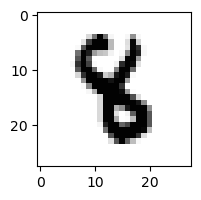

8.541079897974212e-12% - 0
0.0015951288016246665% - 1
3.2365553522108056e-06% - 2
0.00010659012133187877% - 3
0.009457813625476938% - 4
0.04530175597421898% - 5 - ОШИБКА
0.0008249604769751564% - 6
2.795040191798151e-06% - 7
3.675759121326985e-12% - 8
6.149865242993128e-13% - 9

 7


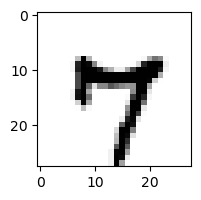

0.0023869401859064688% - 0
8.441570060133195e-06% - 1
1.7145669268517941e-12% - 2
5.172854017329357e-05% - 3
44.796736650747185% - 4 - ОШИБКА
0.022553618875340176% - 5
0.01301736192566332% - 6
15.76207262890114% - 7
0.004563434704581586% - 8
0.3511651024375814% - 9

 8


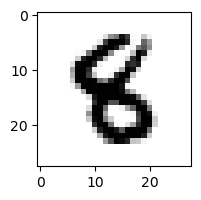

1.1561596063346546e-07% - 0
0.00018281913405682537% - 1
3.5986613826902372e-06% - 2
2.430757609079537e-06% - 3
0.0006959186607701699% - 4
0.6512060037103358% - 5 - ОШИБКА
0.0009852576672624094% - 6
8.009612787727403e-09% - 7
3.619483856313716e-09% - 8
2.6215777220271563e-13% - 9

 8


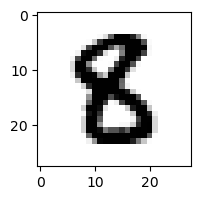

1.2050542892810442e-05% - 0
1.1311140896788624e-06% - 1
2.0104386758499582e-06% - 2
6.487637803938231e-06% - 3
1.5951765642644603e-07% - 4
0.5298180292211975% - 5 - ОШИБКА
6.557028985410955e-06% - 6
7.838292679686062e-10% - 7
2.8854439046680524e-08% - 8
3.062191431215989e-16% - 9

 2


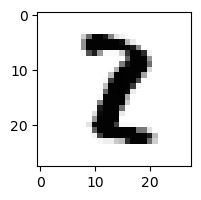

1.1456527248011217e-08% - 0
5.134943843579803% - 1 - ОШИБКА
1.1475598878397995% - 2
0.014236619238285893% - 3
9.968325334904775e-06% - 4
8.19134697519087e-06% - 5
4.7369697614895096e-07% - 6
1.5846320350802936e-05% - 7
2.528108252658007e-07% - 8
1.2853977185238278e-11% - 9

 8


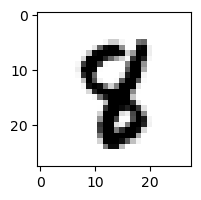

3.4567603977933883e-09% - 0
0.0003825146094075969% - 1
0.00010528134237169035% - 2
3.388726780281344e-07% - 3
0.007973380981884229% - 4
0.025530584657087352% - 5 - ОШИБКА
1.943455752481757e-05% - 6
0.0007109119429586856% - 7
1.0889662054172225e-05% - 8
3.0309541266711134e-08% - 9

 3


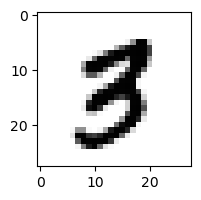

0.00012574547326707288% - 0
6.475617036722639e-05% - 1
0.0007924176166159084% - 2
0.008644092148105199% - 3
7.1782089481985005e-06% - 4
0.04556995526228037% - 5 - ОШИБКА
8.091241628237091e-07% - 6
0.0013800996672630984% - 7
0.00024140417968173433% - 8
0.0014084825107032325% - 9

 4


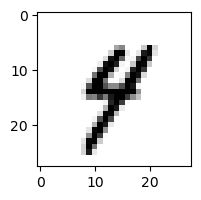

0.00027400734926138305% - 0
0.5768933720598939% - 1
0.00027845074729066323% - 2
0.0026718308662659735% - 3
4.945957118813429% - 4
0.2797254725621817% - 5
0.004050084220249199% - 6
0.06717383439428434% - 7
0.000870589710521647% - 8
5.332514345704401% - 9 - ОШИБКА

 9


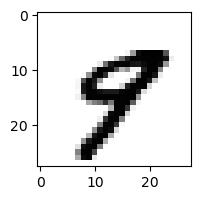

0.00019476062360500193% - 0
5.519836921093599e-05% - 1
1.0977547240658348e-07% - 2
3.34187632744348e-06% - 3
5.7653992857605% - 4 - ОШИБКА
0.04169915200444672% - 5
1.5587446689003584e-06% - 6
2.5187811254362487% - 7
4.7864018029308155e-06% - 8
0.001244535885226699% - 9

 3


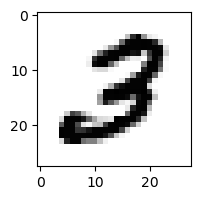

0.00045596159277244567% - 0
4.365738128112854e-06% - 1
4.667087410612328% - 2 - ОШИБКА
1.2612879835347408% - 3
1.3622608298388252e-08% - 4
0.44940360031789006% - 5
9.653502464624572e-06% - 6
4.137430042221393e-05% - 7
1.557761459666029e-06% - 8
3.943895131252258e-11% - 9

 3


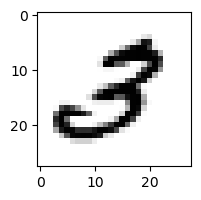

0.07661667468624472% - 0
9.126866495005161e-05% - 1
61.75884913777849% - 2 - ОШИБКА
47.60420463054089% - 3
6.157292157258155e-05% - 4
0.010583841853731965% - 5
1.327240936733992e-05% - 6
0.004769540266676327% - 7
7.729506253310555e-05% - 8
0.002643423107114784% - 9

 9


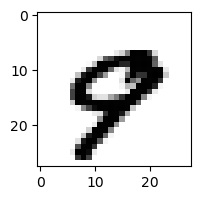

0.01576348876632379% - 0
1.4382042264070223e-06% - 1
3.1594141518908676e-08% - 2
1.6559035184559854e-12% - 3
0.37442259312156917% - 4
1.3485692307307368e-08% - 5
1.2965270590415616e-06% - 6
29.616046025526305% - 7 - ОШИБКА
6.095723600943859e-10% - 8
1.4344236490719795% - 9

 8


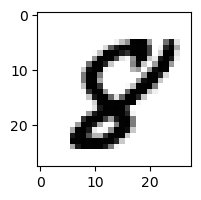

0.00027595756854739635% - 0
9.19438849044967e-10% - 1
7.558689965817424e-06% - 2
7.545454414548006e-14% - 3
6.887357196095525e-06% - 4
0.7087778999998184% - 5 - ОШИБКА
7.652470136891406e-07% - 6
2.8865635178989242e-05% - 7
0.2890757274564455% - 8
1.4616958358588902e-09% - 9

 8


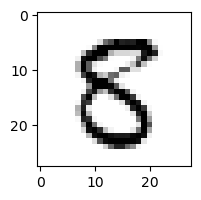

0.08456347456424616% - 0
1.6834152145021318e-05% - 1
0.0008491810211531284% - 2
0.005292418435198504% - 3
0.015966723273263768% - 4
84.69099195725244% - 5 - ОШИБКА
8.994281751106428e-07% - 6
9.302519195197132e-07% - 7
0.07017858935825343% - 8
2.9712610678067564e-12% - 9

 8


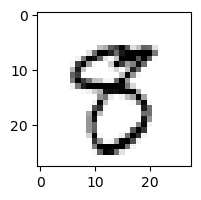

0.006374717539142305% - 0
0.0026932891782503353% - 1
1.4962334195576437e-06% - 2
0.6978659625830328% - 3
0.00044917680257893487% - 4
2.309555523886488% - 5 - ОШИБКА
1.6035172468937706e-06% - 6
0.09916376356096798% - 7
0.0005831932025795207% - 8
1.103490577487738% - 9

 8


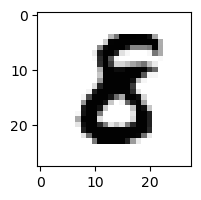

1.5519163047117798e-05% - 0
0.001500388114747658% - 1
0.0017966983338919018% - 2
0.0004133543485168718% - 3
2.385921617509528e-08% - 4
0.002243873203806782% - 5 - ОШИБКА
0.00012169003851432526% - 6
1.2367024125828868e-09% - 7
1.466878125928772e-06% - 8
5.255321813629155e-17% - 9

 8


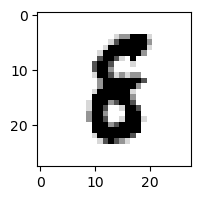

2.345725846468582e-06% - 0
0.0009392447111032672% - 1
0.008004371100581846% - 2
2.174852516109212e-06% - 3
2.3645478734476515e-07% - 4
0.3137593619856423% - 5
14.014104099719155% - 6 - ОШИБКА
2.751882944670271e-09% - 7
13.90198959382502% - 8
2.080966888883244e-07% - 9

 6


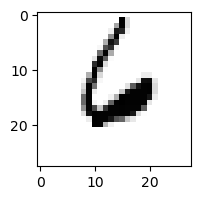

0.00022224759662588746% - 0
0.00016179465305205898% - 1
8.021146433102446% - 2
4.1663083765653043e-10% - 3
87.58869481235504% - 4 - ОШИБКА
0.0006431448554285966% - 5
80.09566606431497% - 6
1.735615779514282% - 7
2.5361627413610598e-05% - 8
0.3139898363444147% - 9

 8


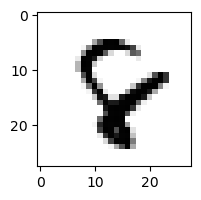

1.8203076795055268e-05% - 0
1.1149298394367735e-05% - 1
0.008753215183537092% - 2
2.515663593513916e-09% - 3
10.07687017339207% - 4 - ОШИБКА
0.0003538109431363733% - 5
4.094429374646177% - 6
0.07540626147840417% - 7
0.0002064415072062917% - 8
1.0174664147095666e-07% - 9

 2


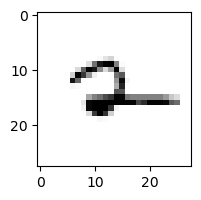

0.00040478781384687573% - 0
3.9700952120724713% - 1
3.1353474513480117% - 2
7.430133508080959e-06% - 3
76.41054073493453% - 4
0.03872721741438753% - 5
48.22929058609197% - 6
3.6225911977050425% - 7
8.369784977366608% - 8
82.6953175356719% - 9 - ОШИБКА

 5


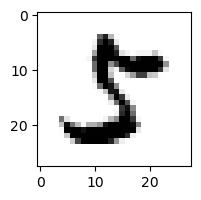

0.0866876452007666% - 0
0.00043724418396551805% - 1
0.007703248652034706% - 2
3.3172835693307423% - 3 - ОШИБКА
1.167324774618759e-08% - 4
2.7843918280367213% - 5
1.4984609491459705e-10% - 6
0.01738262545932447% - 7
0.001990356594099884% - 8
1.5710140799151332e-11% - 9

 8


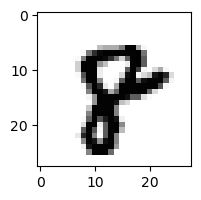

1.572596723479429e-05% - 0
3.8510960237254597e-07% - 1
1.6544358105925223e-06% - 2
6.005606877751327e-12% - 3
3.9740434478503255e-06% - 4
1.7536840828519217e-06% - 5
0.002318201746503324% - 6
0.4048978668688838% - 7 - ОШИБКА
0.029128949096170535% - 8
0.057704646853867315% - 9

 5


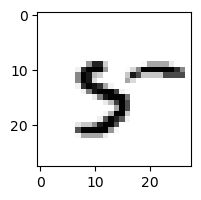

0.00463483983246146% - 0
0.02141755599037652% - 1
0.026027405890919827% - 2
1.1035531803484596e-05% - 3
35.805416268621926% - 4
21.577642502695685% - 5
6.933867519687613% - 6
0.20866372306956008% - 7
36.13782783948237% - 8 - ОШИБКА
0.7106653448128267% - 9

 9


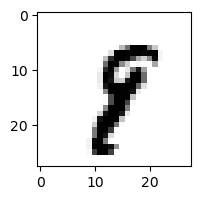

1.4584469992755968e-06% - 0
4.553924809662478% - 1 - ОШИБКА
0.00018247411732140223% - 2
0.0006774750442429264% - 3
0.0001521067864820816% - 4
0.013686999316184247% - 5
0.00034877538140917443% - 6
0.5347001900875713% - 7
0.024067798721391774% - 8
0.12528888555504786% - 9

 7


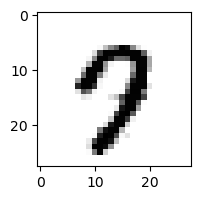

0.07349031172001008% - 0
2.2595583062930734e-07% - 1
7.066694635145515e-07% - 2
0.00012640274545178655% - 3
0.030506714943192365% - 4
0.974111228599948% - 5
7.671558628157406e-05% - 6
57.50148533415357% - 7
0.0001406292451539085% - 8
69.69912320929814% - 9 - ОШИБКА

 9


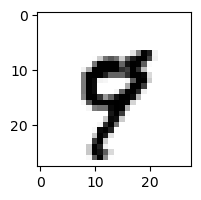

1.303918092222145e-05% - 0
0.005011348310233548% - 1
2.825941676255424e-06% - 2
4.006475676575869e-08% - 3
0.3725520439899976% - 4
0.005941215766426999% - 5
3.799732855229813e-05% - 6
28.611008172494707% - 7 - ОШИБКА
2.5760833793040878e-08% - 8
0.08956939675867022% - 9

 9


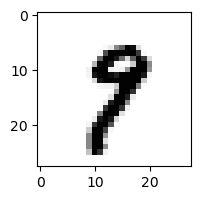

2.8445544075132525e-05% - 0
0.6621367401495358% - 1
6.409031089194696e-05% - 2
0.0001173345219544978% - 3
4.366350524406848e-05% - 4
0.014562702028714944% - 5
7.097837766141848e-05% - 6
10.49374888874061% - 7 - ОШИБКА
0.05205616830055869% - 8
0.8546219195210015% - 9

 7


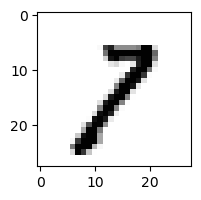

0.01403313053817612% - 0
4.965411392735611% - 1
0.5216076906679217% - 2
3.59233531697381% - 3
0.00015604780399458356% - 4
0.003983732991734628% - 5
7.931618877244049e-06% - 6
15.471830560456814% - 7
0.8766460893245623% - 8
23.657974609124736% - 9 - ОШИБКА

 8


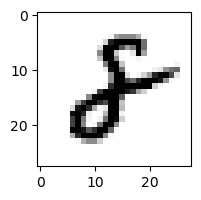

0.0006180719586159489% - 0
1.5621236612881686% - 1
57.408032449143356% - 2 - ОШИБКА
1.4804416478749697e-05% - 3
3.67736719310513e-07% - 4
1.551655586573659e-06% - 5
0.003287328237242876% - 6
7.418770776487102e-07% - 7
0.002370669865320154% - 8
2.0670060084074343e-06% - 9

 9


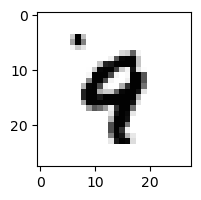

9.441925871992262e-06% - 0
0.009987199209691764% - 1
0.00010123191570891254% - 2
3.1017642053451974e-06% - 3
88.10332307871546% - 4 - ОШИБКА
0.0015707501653163041% - 5
0.1081981156585214% - 6
0.04219504876888377% - 7
5.506484792203194e-07% - 8
0.06429393444967976% - 9

 2


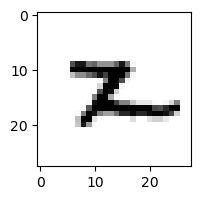

3.715350799364047e-05% - 0
0.8962415824416118% - 1
1.5184202557253303% - 2
8.885659970647401e-07% - 3
0.006843466047067376% - 4
0.7842450252234149% - 5
0.7379942067407584% - 6
0.0016628771960427266% - 7
2.8142206307142166% - 8 - ОШИБКА
0.011021709201583125% - 9

 8


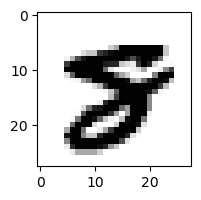

2.0178770586207062e-08% - 0
1.378883835371538e-08% - 1
7.694447919814055e-12% - 2
2.4882409160509637e-13% - 3
4.784809493153292e-09% - 4
4.532018861387705e-06% - 5
2.9974102652887387e-09% - 6
0.0006390480393126959% - 7 - ОШИБКА
4.028839111737605e-05% - 8
1.1251635579597147e-13% - 9

 5


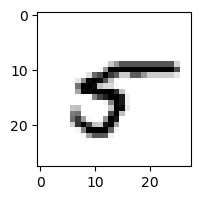

0.023374573583417584% - 0
1.5082102988695127% - 1
8.222858037389995e-05% - 2
0.0030594293148839737% - 3
2.31111259165634% - 4 - ОШИБКА
1.6141920667288596% - 5
0.005835761296975407% - 6
0.062232525404895656% - 7
0.0011707981606161263% - 8
5.848903998766936e-05% - 9

 1


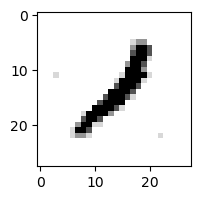

0.0007568746715392951% - 0
87.31936141994908% - 1
43.86590004715279% - 2
0.008647775396052012% - 3
1.0985366310610998% - 4
0.00013034059936331866% - 5
0.0033974105368596076% - 6
0.19767887023008218% - 7
98.03713770610752% - 8 - ОШИБКА
0.21301488260243506% - 9

 3


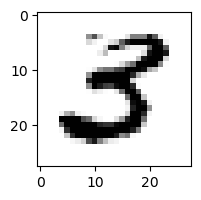

0.0041447622028562186% - 0
0.0007794026346440653% - 1
3.293357872366911e-07% - 2
8.553263660523662% - 3
4.225670441121329e-06% - 4
86.51993722492912% - 5 - ОШИБКА
5.669816461594776e-07% - 6
1.5366213833690485e-05% - 7
5.4653187042989576e-11% - 8
1.9844814415640236e-18% - 9

 3


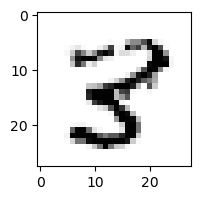

3.60227547022878e-05% - 0
0.0012848356121988446% - 1
0.04623489965877823% - 2
0.017796286282589335% - 3
0.15314770497620495% - 4
6.402370678749975% - 5
5.565707485690948e-06% - 6
0.00011591233672646415% - 7
99.79291816018407% - 8 - ОШИБКА
4.419640525847042e-09% - 9

 0


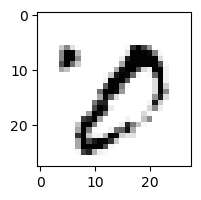

0.3790308193887648% - 0
0.13431999163945008% - 1
0.0010810365660418606% - 2
19.37970531362302% - 3 - ОШИБКА
8.58540928945961e-06% - 4
0.0001086692495411152% - 5
3.4831365095129673e-06% - 6
0.05855984017392741% - 7
10.045847260233913% - 8
1.644068538353315e-08% - 9

 1


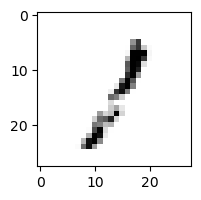

5.765614434837339% - 0
61.407709249041396% - 1
9.79020028644477% - 2
86.05663620985965% - 3 - ОШИБКА
3.0253429386714% - 4
1.7782566342562205% - 5
0.07239256070665899% - 6
59.33540493538817% - 7
12.488450351090643% - 8
0.8823054617181896% - 9

 1


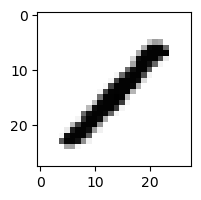

0.0004689537967009025% - 0
81.21784130175095% - 1
5.961880486620802% - 2
0.004785497176145528% - 3
0.8440681790746765% - 4
0.004262468336392115% - 5
2.4920760815999223e-05% - 6
0.004448106801210479% - 7
97.76996814795781% - 8 - ОШИБКА
5.442525557920624e-05% - 9

 3


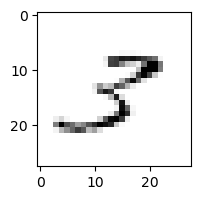

0.600126074506727% - 0
0.9866197582111818% - 1
71.89105150526154% - 2 - ОШИБКА
60.6106628725665% - 3
0.09999714862704027% - 4
1.133767587126276% - 5
0.014799817293587833% - 6
10.65029513425381% - 7
14.139324165025515% - 8
18.94975913264286% - 9

 3


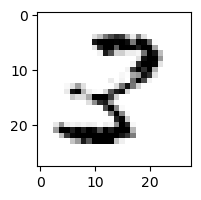

0.7998006325885141% - 0
0.09279620011812353% - 1
17.645518822176236% - 2 - ОШИБКА
4.41608756147489% - 3
0.00015796474869409174% - 4
0.045911500090722285% - 5
1.5398182696539858e-06% - 6
3.731572918087723e-05% - 7
0.9746814722845661% - 8
8.327909668281627e-09% - 9

 3


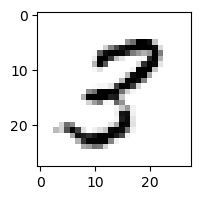

0.14115426804704972% - 0
0.004920124676969499% - 1
3.2741393864278967% - 2
24.969354577287184% - 3
0.0037354938716987777% - 4
2.234280093042726% - 5
3.8474993389629024e-05% - 6
0.0016813986866713395% - 7
76.82401494291686% - 8 - ОШИБКА
0.023313465623002964% - 9

 3


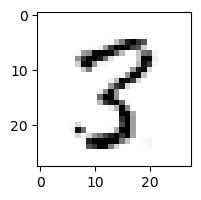

0.0014255916746627325% - 0
0.04309004266524996% - 1
2.0273047201256644% - 2
21.519379909874797% - 3
0.004552863557403774% - 4
5.9133538527745095% - 5
5.41051629543725e-06% - 6
0.0626706773896893% - 7
99.97679351191083% - 8 - ОШИБКА
2.430526535711569e-05% - 9

 2


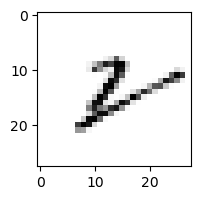

0.22438439307695995% - 0
21.22160289623093% - 1
58.85709451076359% - 2
0.0003603901912442131% - 3
0.11377772014760255% - 4
0.020321450197269955% - 5
31.8159417880688% - 6
0.17247290440959837% - 7
98.11142637533244% - 8 - ОШИБКА
14.302441478634547% - 9

 8


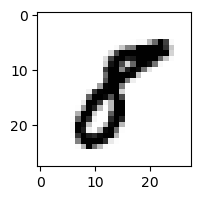

0.002965640532571958% - 0
1.6514367308413633% - 1
0.0007925893757185564% - 2
0.00043672100240690003% - 3
1.2531896757925827e-05% - 4
2.1656155853203263% - 5 - ОШИБКА
7.227780120754384e-09% - 6
0.00010871263087462352% - 7
0.00012667912475190156% - 8
3.4830169396968037e-07% - 9

 2


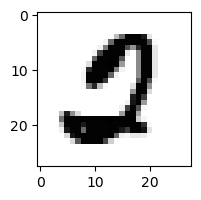

16.275754133949103% - 0
7.212842018658006e-09% - 1
0.04772344981184273% - 2
0.00039091494708610715% - 3
3.2842912057132115e-12% - 4
36.27067323105103% - 5 - ОШИБКА
1.6171451601141328e-05% - 6
0.0001624285788551592% - 7
3.663307089102588e-08% - 8
8.389751534806548e-15% - 9

 5


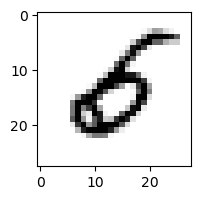

1.7150176767718424% - 0
0.0035315880503033557% - 1
0.3131506180270514% - 2
0.000170984607878857% - 3
0.02720177433616319% - 4
0.537471820569454% - 5
72.9534718593505% - 6 - ОШИБКА
7.595280158109232e-05% - 7
3.384603397827466e-10% - 8
6.220515029398467e-05% - 9

 8


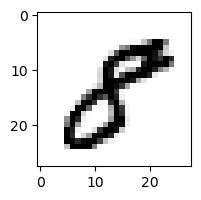

0.0044384365876843765% - 0
0.0076247824214434375% - 1
0.0001822965138997624% - 2
0.023781549888971944% - 3
0.002299197913467346% - 4
1.9164673197361413% - 5 - ОШИБКА
1.3334911362734896e-08% - 6
9.546405277224089e-05% - 7
0.00012739907038029338% - 8
1.4079219828632702e-05% - 9

 9


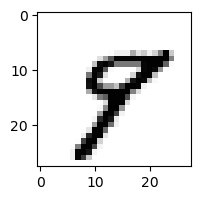

0.0003932844441329411% - 0
0.001999985501819465% - 1
4.0715569638743394e-05% - 2
2.065761841431125e-06% - 3
0.5117515407336387% - 4
0.437246804333702% - 5
1.3185780342487091e-05% - 6
0.8543215170318847% - 7
5.809798537528244% - 8 - ОШИБКА
0.055421098757991526% - 9

 4


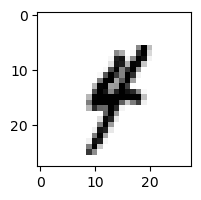

5.782563655600425e-06% - 0
18.667205821328807% - 1 - ОШИБКА
0.0012941342558249018% - 2
0.06749541465049735% - 3
3.6499891125340587% - 4
0.019909167035745856% - 5
0.0059980103252373655% - 6
0.07908679488441292% - 7
5.098397418449493e-05% - 8
0.3626397711197772% - 9

 9


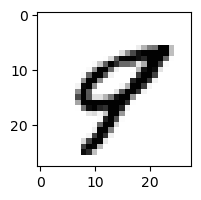

0.025129831357586042% - 0
0.00013262305011761897% - 1
3.6905864576337888e-06% - 2
7.360872283077117e-10% - 3
30.26040627835619% - 4 - ОШИБКА
0.00244704499453126% - 5
1.4764484335088316e-05% - 6
1.4752974933033272% - 7
0.017143571223507327% - 8
0.10508876734727779% - 9

 9


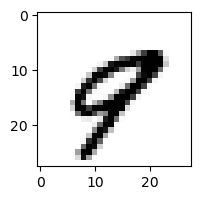

0.04035398557948096% - 0
0.002216241987461219% - 1
1.88931962435032e-05% - 2
6.860003886475897e-10% - 3
10.485586147240918% - 4 - ОШИБКА
3.938640211192869e-06% - 5
2.660029261495803e-05% - 6
9.470758125576719% - 7
0.0020579846767357383% - 8
0.003408756332720698% - 9

 8


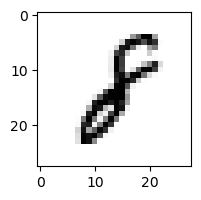

0.0002582686231683026% - 0
86.1205522255437% - 1 - ОШИБКА
7.206237354531327% - 2
0.000587018643967422% - 3
8.014956029782366e-05% - 4
0.0013298040318780442% - 5
0.09798757752552845% - 6
0.0038962742917112193% - 7
0.47117473562110956% - 8
0.0008599654270783948% - 9

 4


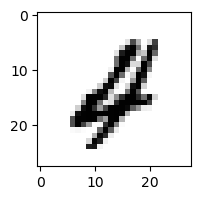

0.014588148255454653% - 0
0.0007111079075784025% - 1
4.709464123564732% - 2 - ОШИБКА
5.956385189583002e-07% - 3
0.011548730454817031% - 4
1.9774866795877612e-05% - 5
0.017138533458578135% - 6
0.0003772599364325999% - 7
8.837096936752608e-06% - 8
2.9650674491886516e-05% - 9

 5


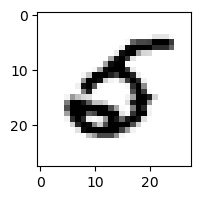

0.01834667141997208% - 0
5.470484782541443e-05% - 1
0.0003694068902789543% - 2
9.634748295079698e-11% - 3
0.001056879330208778% - 4
0.007204632614909023% - 5
3.9302090754188% - 6 - ОШИБКА
0.005586920674563726% - 7
1.07079443749169e-14% - 8
2.3272313195108676e-09% - 9

 8


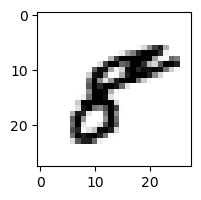

0.8704377653597255% - 0 - ОШИБКА
0.0014495315052344918% - 1
0.0006762730783966717% - 2
3.277188390310094e-06% - 3
0.01463839077826502% - 4
0.2215374079081239% - 5
8.695632637431166e-08% - 6
0.00017517876515935011% - 7
0.008060210908320526% - 8
0.0006946095344112559% - 9

 4


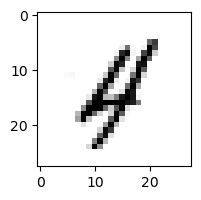

0.00691353367424902% - 0
0.36084089812987946% - 1
0.8726374331708799% - 2
0.0008605134920704554% - 3
4.100295355690342% - 4
0.007054714418438141% - 5
0.09109209907554514% - 6
0.01280347702880777% - 7
10.691259960979059% - 8 - ОШИБКА
3.1280458950973573% - 9

 9


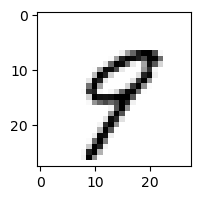

0.0037834007260220287% - 0
0.008169454164087223% - 1
0.0007160595152021599% - 2
0.022050995194596995% - 3
11.26964920655476% - 4
0.6307587138542173% - 5
0.001670090937908548% - 6
18.969278138879766% - 7 - ОШИБКА
0.02483703911064331% - 8
7.422347871112998% - 9

 2


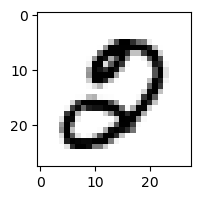

0.5480895734521597% - 0 - ОШИБКА
2.5706150595134474e-07% - 1
0.0008095803792073203% - 2
1.2525303380777087e-06% - 3
7.216842522586866e-06% - 4
0.004938012899054728% - 5
0.00014186012350326165% - 6
0.008434023386292188% - 7
9.494969464909141e-05% - 8
2.781134662923524e-08% - 9

 5


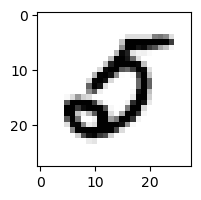

70.36961438332858% - 0 - ОШИБКА
8.53651184576829e-06% - 1
0.2206281520901944% - 2
2.0094283628763332e-08% - 3
0.00017906069981787984% - 4
0.0019863501664804436% - 5
0.691136650788417% - 6
0.0008924857094218199% - 7
1.3632299842707225e-12% - 8
1.7797553154050707e-08% - 9

 5


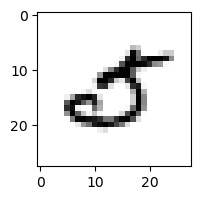

49.33924059916528% - 0 - ОШИБКА
0.0005368688321130514% - 1
0.13048366240294643% - 2
0.8539514859535712% - 3
0.038963867107983954% - 4
6.273725496598667% - 5
0.00470360344356643% - 6
1.9998478938847197% - 7
5.12695994690881e-08% - 8
2.140285453860417e-06% - 9

 2


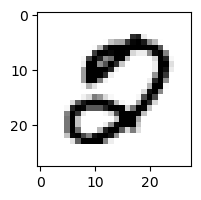

4.05456899603073% - 0 - ОШИБКА
4.714874217387342e-08% - 1
0.02204476889986489% - 2
1.587013813740626e-10% - 3
3.9994537687698585e-06% - 4
0.23188395857838187% - 5
0.00048120235468375304% - 6
0.0003485453768371065% - 7
0.00012016510446832323% - 8
8.812237112999587e-10% - 9

 8


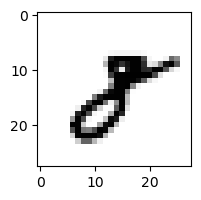

0.0004924964559371816% - 0
3.220229086392621% - 1 - ОШИБКА
0.2778519042051631% - 2
0.006410539938341325% - 3
1.529184556880115e-05% - 4
0.00019013185515100807% - 5
9.52857073258251e-07% - 6
0.007788507380908705% - 7
0.10089847749676374% - 8
0.0002976060355312127% - 9

 4


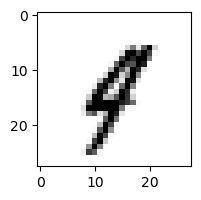

0.00024893662300899227% - 0
5.3469056378770405% - 1 - ОШИБКА
0.03014766296280874% - 2
0.001948844739246526% - 3
0.9158679895800789% - 4
0.002167922218782538% - 5
0.0027978701820550174% - 6
0.05073181142212313% - 7
0.011074694869586343% - 8
0.8159145080158312% - 9

 9


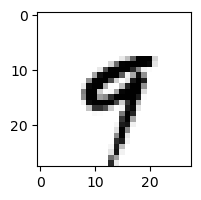

6.534629356626867e-05% - 0
0.016483733716230006% - 1
1.6392142918627623e-06% - 2
0.04447402400402557% - 3
86.17423093062742% - 4 - ОШИБКА
0.009030790931481566% - 5
0.00549820730612128% - 6
0.8041558288887838% - 7
1.0960059810027825e-06% - 8
0.046672370593567936% - 9

 2


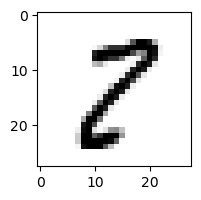

0.5305156847197443% - 0
0.09145300620366464% - 1
2.1891296423453213% - 2
0.4868415358893368% - 3
2.1292716124051562e-06% - 4
1.426130659516914% - 5
3.1591593587878397e-06% - 6
0.010461417417962419% - 7
99.99527874742303% - 8 - ОШИБКА
0.018110859682318233% - 9

 4


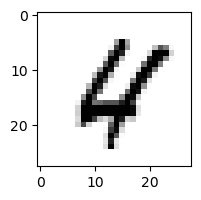

0.014633213027042262% - 0
7.61955336958098e-06% - 1
0.24929581979115384% - 2
9.297508874739188e-12% - 3
5.6155852884046285% - 4
0.00018708772304448153% - 5
0.019764253301751886% - 6
0.006992096011798907% - 7
43.350407552811305% - 8 - ОШИБКА
0.0028122694612942316% - 9

 2


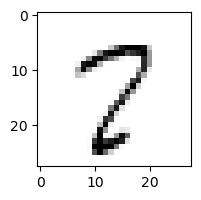

3.2557255080766767% - 0
0.018045016517711506% - 1
0.6681145551387067% - 2
0.22788609711097466% - 3
0.021870493968762065% - 4
12.690675435621104% - 5
0.0018821539773965106% - 6
79.23184188162902% - 7
98.99445095562591% - 8 - ОШИБКА
17.81798830908019% - 9

 3


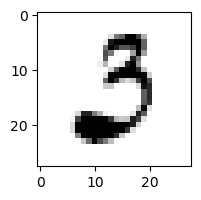

71.09846210542213% - 0 - ОШИБКА
0.01472086428189425% - 1
5.2187677983482175% - 2
26.28046676046236% - 3
1.597833208105377e-10% - 4
0.579567692500325% - 5
0.06870200032443989% - 6
0.0008817101746416079% - 7
3.0332172083479506e-05% - 8
2.1846228510622697e-14% - 9

 2


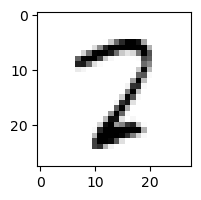

0.6189569201869556% - 0
0.0006764331131571101% - 1
24.63690603300577% - 2
0.3968379759814131% - 3
0.011623933832302378% - 4
3.084930015265746% - 5
0.003313276013560701% - 6
1.2839608308189852% - 7
75.48657470621949% - 8 - ОШИБКА
4.7269354817277585e-08% - 9

 2


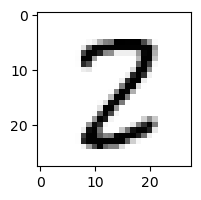

0.004444365935936593% - 0
0.0070918545301502725% - 1
11.67292430753517% - 2
0.08894819844882848% - 3
0.0010010155593008336% - 4
0.24968598396896435% - 5
9.670243014647737e-07% - 6
0.002359418029507168% - 7
95.73505680771572% - 8 - ОШИБКА
1.191279465733184e-12% - 9

 9


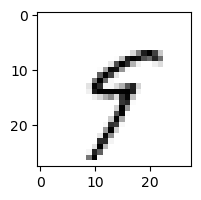

0.01391530023973037% - 0
2.631381417475848% - 1
0.0023129846702544103% - 2
17.109432918786478% - 3
72.09096885845851% - 4 - ОШИБКА
28.423106941553172% - 5
0.018645968268218308% - 6
13.26644689178173% - 7
0.13882723412002432% - 8
0.6332326226466768% - 9

 6


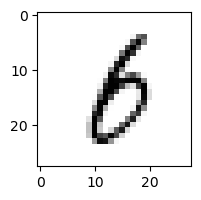

0.14279684225732203% - 0
1.178712959819982% - 1
0.0946944407469625% - 2
22.772460286327192% - 3
0.0007896415159101802% - 4
0.9436928305625493% - 5
34.62070101347269% - 6
0.0014906635591112052% - 7
90.5175647725001% - 8 - ОШИБКА
1.2031921152260219% - 9

 2


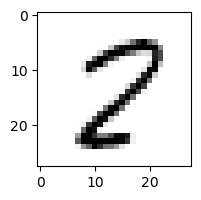

1.4154349738315544% - 0
0.003099377719423515% - 1
1.7709081743899333% - 2
2.440026460373007e-06% - 3
0.0006130305897950553% - 4
1.8270773367752906% - 5
4.816163334526776e-05% - 6
1.4185494426235912% - 7
99.97996847452069% - 8 - ОШИБКА
4.8910126505596394e-05% - 9

 2


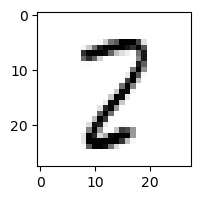

0.14520034463573586% - 0
0.20967162837553038% - 1
13.10506565072435% - 2
0.5288226746307566% - 3
0.003431276002686306% - 4
0.6233940246453912% - 5
0.0003478493071982245% - 6
0.5172844681992704% - 7
99.76005441996924% - 8 - ОШИБКА
7.838936074601643e-08% - 9

 0


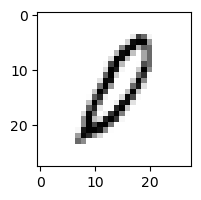

32.69926642202055% - 0
0.12244280333748388% - 1
43.84034407094818% - 2 - ОШИБКА
0.006546730373001777% - 3
0.0007748032939987254% - 4
1.2539296036036176% - 5
8.40094527805977% - 6
0.017691625119513988% - 7
0.722331247137541% - 8
0.2833362131572095% - 9

 5


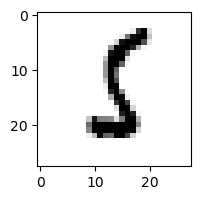

0.008201572885780387% - 0
1.6867425854256737% - 1
2.039067430728485% - 2
0.3345514461618625% - 3
2.268450357962287e-07% - 4
7.185143431862663% - 5
83.90669402884289% - 6 - ОШИБКА
5.518368669438303e-05% - 7
0.0005899389038248001% - 8
2.5489984552797364e-07% - 9

 8


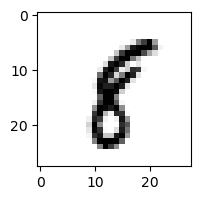

0.0004080549300545238% - 0
41.81746687382994% - 1 - ОШИБКА
0.0009361480022760328% - 2
0.00017036371722581553% - 3
0.006196491471262995% - 4
1.0286008088376513% - 5
0.007181644924716434% - 6
0.0007249433305886858% - 7
37.33605374213843% - 8
0.004635101222436655% - 9

 9


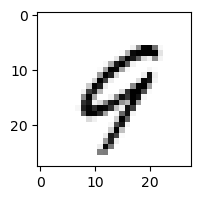

0.22576759326601495% - 0
0.007038182294925608% - 1
0.008391304449388085% - 2
2.0753311769572843e-06% - 3
72.89239325631722% - 4 - ОШИБКА
0.0007769303931031509% - 5
0.32163177224976736% - 6
1.2574743904816932% - 7
0.005112303238798594% - 8
3.1085626498969696% - 9

 9


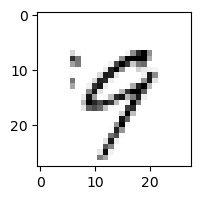

0.6716451570223672% - 0
0.01211954779609611% - 1
0.002499069417370569% - 2
0.10381744379238983% - 3
48.03781662370905% - 4 - ОШИБКА
0.034102356344258414% - 5
0.09241813179405023% - 6
17.82372201349925% - 7
0.0015375559929786595% - 8
24.449086457622567% - 9

 8


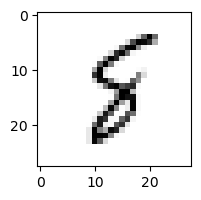

0.010422381777335376% - 0
1.0502665418828467% - 1
0.2131271184726472% - 2
0.0005092580748870074% - 3
0.9003296629089268% - 4
9.0091855383743% - 5
86.71355853692387% - 6 - ОШИБКА
0.027422209055843562% - 7
69.1369998935687% - 8
0.5142683989431401% - 9

 2


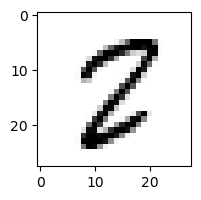

0.02223009394575518% - 0
0.005634940744547051% - 1
1.0797627575730886% - 2
0.00017076067744363076% - 3
5.5632768890518e-06% - 4
9.14006066416114% - 5
0.005857971937348649% - 6
0.011228837474121511% - 7
90.5103478859329% - 8 - ОШИБКА
9.424720086229335e-07% - 9

 9


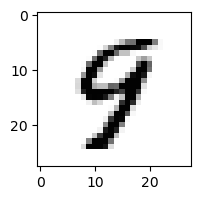

0.00025552079292802567% - 0
4.410729096900627e-05% - 1
0.00019928653747382046% - 2
8.240026976098e-05% - 3
3.5079707549674892% - 4 - ОШИБКА
1.1801076957503187% - 5
0.014247724463949696% - 6
0.009500741990206962% - 7
0.07327371978229633% - 8
3.2970676225375186% - 9

 3


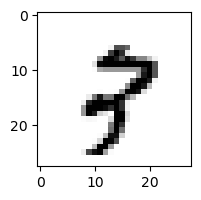

0.00409442813113533% - 0
0.0018186170173981147% - 1
1.9808137105772945% - 2
6.977691405641464e-07% - 3
0.0008058028261540008% - 4
8.251840266304876e-07% - 5
0.0010518967281056067% - 6
27.752235253440215% - 7
6.355719438068322% - 8
74.18770041429643% - 9 - ОШИБКА

 7


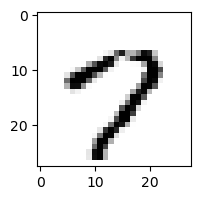

1.24649768963427% - 0
3.7609098201022373e-07% - 1
4.705747037780187e-07% - 2
7.422739501867358e-06% - 3
0.05684855755528345% - 4
1.5676713092287156% - 5
0.0009565297103818675% - 6
93.96464216514883% - 7
1.640668059124949% - 8
96.13911809123536% - 9 - ОШИБКА

 3


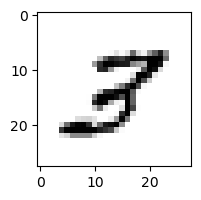

0.017573077802543798% - 0
0.01848984133252612% - 1
45.184582753061676% - 2 - ОШИБКА
0.5401806714402207% - 3
0.00028076110817296075% - 4
0.5123789677313447% - 5
3.510453748097324e-05% - 6
0.7303711036066195% - 7
29.900756272490842% - 8
0.008404228751935465% - 9

 5


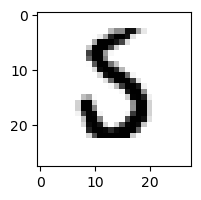

0.0022727565610332744% - 0
0.00025593237674728555% - 1
1.244833218956769% - 2
0.1176389321099415% - 3
1.0011420524459996e-05% - 4
0.1088994491049772% - 5
10.180261739052465% - 6 - ОШИБКА
0.005524866098988557% - 7
7.637010541514439e-07% - 8
2.392714003304574e-12% - 9

 3


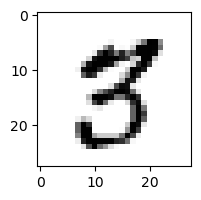

0.002472585697324107% - 0
0.0005338238487798921% - 1
0.020127494913769042% - 2
0.17387244357985984% - 3
1.397483370745879e-05% - 4
55.68684465847271% - 5 - ОШИБКА
9.432779765051837e-08% - 6
0.02985068192244509% - 7
0.03794711143955931% - 8
2.9863043062314858e-05% - 9

 3


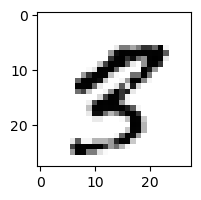

8.297808248277223e-06% - 0
0.0009118771161474879% - 1
7.193832577515408e-10% - 2
8.420068548485712e-09% - 3
0.020845703675723044% - 4
0.00488038133748922% - 5
6.897536098196176e-07% - 6
0.5495952754273842% - 7 - ОШИБКА
0.2722414332899583% - 8
0.1027046335030135% - 9

 4


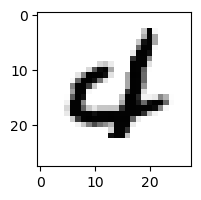

0.3535858313989104% - 0
3.45167281810529e-05% - 1
3.061519089392434e-05% - 2
2.946303273591386e-11% - 3
17.274920816339844% - 4
0.00021432703086337015% - 5
22.677181596417753% - 6 - ОШИБКА
0.04832974161732136% - 7
9.333877498436385e-13% - 8
1.0941359908523164e-09% - 9

 7


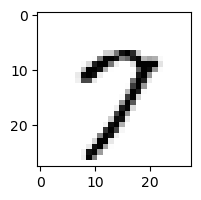

0.4271173375188254% - 0
1.1543295447565697e-05% - 1
0.008731178742714382% - 2
0.0016112731150495184% - 3
0.03912331957076543% - 4
5.838587056015812% - 5
0.0019732070986431993% - 6
94.57612090648459% - 7
23.62324809857524% - 8
97.70716077622748% - 9 - ОШИБКА

 8


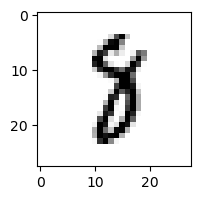

1.767936084379316e-05% - 0
2.6934283044005016% - 1 - ОШИБКА
0.281604840502636% - 2
0.058213247560809055% - 3
0.0003066134334953629% - 4
0.12455075547677819% - 5
0.0004958754783310045% - 6
2.093870632333426% - 7
0.0002367401358340943% - 8
1.1038462585919779e-07% - 9

 5


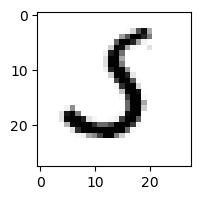

0.004843045269784417% - 0
0.016320220387433363% - 1
24.816455135524446% - 2
41.955761631677454% - 3 - ОШИБКА
1.0777071047748625e-07% - 4
2.4886922294976364% - 5
1.1024482010108327% - 6
0.009190478527367445% - 7
1.984623134452124e-09% - 8
2.160267282788506e-09% - 9

 3


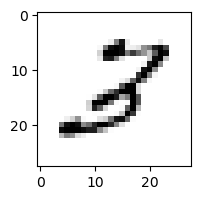

0.028368309315986242% - 0
0.03645828082878147% - 1
90.92811873921582% - 2 - ОШИБКА
11.31044656195549% - 3
0.0020236675435333696% - 4
1.1477385637912365% - 5
0.00048682568016713754% - 6
0.012415204830688479% - 7
37.428280934963496% - 8
0.10441906104710161% - 9

 5


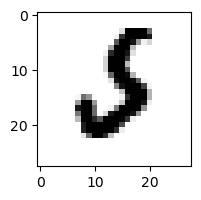

0.0008927077753020154% - 0
0.002736017587047547% - 1
2.4205806499314635% - 2
3.279607940002999e-06% - 3
1.0097127887483376e-06% - 4
0.00016324643394159457% - 5
8.57594235365537% - 6 - ОШИБКА
0.04347162462947021% - 7
2.9107841092026234e-13% - 8
1.9015907293958092e-08% - 9

 3


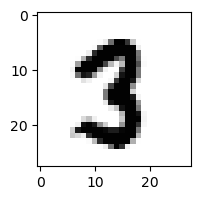

4.264735573541626e-07% - 0
0.0037560924835512025% - 1
0.002567618368130248% - 2
0.0016911110694201657% - 3
1.0395045952566292e-08% - 4
0.3349068489062% - 5 - ОШИБКА
1.5171194464146986e-08% - 6
0.0010863580520075967% - 7
0.0013656506545267017% - 8
9.548826841275392e-11% - 9

 8


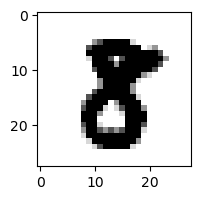

8.910288133674942e-07% - 0
5.336309230512674e-07% - 1
7.994253815547705e-06% - 2
0.00018160701357759136% - 3
3.8671256580520475e-10% - 4
0.001168209802468022% - 5 - ОШИБКА
1.0716154551374372e-13% - 6
3.2633669346631303e-06% - 7
0.0006950926603042249% - 8
1.7319635161203864e-16% - 9

 5


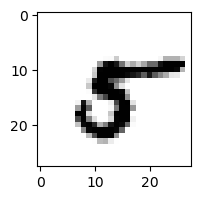

0.0001122257142833249% - 0
0.04941312115071443% - 1
5.178610822189322e-05% - 2
3.307167919039764e-05% - 3
0.004148490492910642% - 4
0.0819035000598928% - 5
0.000825926171910119% - 6
0.0012366529775754821% - 7
0.41521396839225455% - 8 - ОШИБКА
2.6299568308322532e-08% - 9


Общая доля ошибок: 12.758724127587243%


In [155]:
errs = 0
for k in range(len(X_test)):
    ans = np.empty((0,10))
    for j in range(10):
        ans = np.append(ans,f(neursum(X_test[k],w[:,j],w0[j])))
    if (ans.argmax() != ansbase_test[k].argmax()):
        errs += 1
        print('\n',y_test[k])
        plt.figure(figsize=(2, 2))
        plt.imshow(X_test[k].reshape(28, 28), cmap=plt.cm.Greys)
        plt.show()
        for i in range(len(ans)):
            if i == ans.argmax():
                print(ans[i]*100,'%',' - ',i," - ОШИБКА",sep="") 
            else:
                print(ans[i]*100,'%',' - ',i,sep="") 
print("\n\nОбщая доля ошибок: ",errs/(len(X_test)+1)*100,'%',sep="")   

# Изменение коэффициента скорости обучения

In [157]:
w = np.random.uniform(-0.0005,0.0005,(784, 10))
w0 = np.random.uniform(-0.0005,0.0005, (10,))

In [158]:
iterations = 100000
eta = 0.25
for i in range(iterations):
    pos = random.randint(0,len(X_train)-1)
    for j in range(len(ansbase[pos])):       
        sm = neursum(X_train[pos],w[:,j],w0[j])
        res = f(sm)
        sigm = - (ansbase[pos][j] - res)*f_d(sm)
        for k in range(len(X_train[pos])):
            w[k][j]+= - eta * sigm * X_train[pos][k]
        w0[j] += eta * sigm
    clear_output()
    print((i+1)/iterations*100, end='%')

100.0%


 9


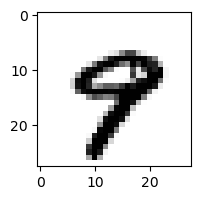

3.124439215945856e-15% - 0
2.930334879763952e-14% - 1
3.8649886431111908e-31% - 2
1.2124719976698434e-29% - 3
2.3296554800519356e-06% - 4
6.335684891165011e-09% - 5
1.9419200765512395e-14% - 6
0.020165523406534113% - 7 - ОШИБКА
1.5490211786313253e-19% - 8
0.0008407723006394269% - 9

 3


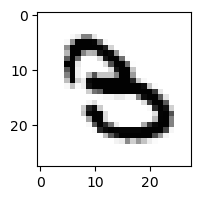

6.591282714922437e-18% - 0
2.3706825704264536e-10% - 1
1.394166093500459e-13% - 2
3.4857763943494714e-08% - 3
4.0286157683248525e-11% - 4
7.313190062059849e-07% - 5 - ОШИБКА
6.028983173007452e-09% - 6
7.762226191000975e-11% - 7
1.6670101282339987e-34% - 8
4.660865156111516e-25% - 9

 9


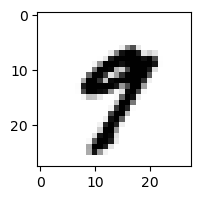

7.720736471023756e-13% - 0
1.5350078264195989e-09% - 1
2.1874487748973144e-31% - 2
5.168984781780165e-13% - 3
1.0970560938618545e-06% - 4
7.76983761332381e-06% - 5
6.722681480018983e-21% - 6
1.5335009823473622% - 7 - ОШИБКА
3.223763395087216e-19% - 8
0.0047313335447142675% - 9

 4


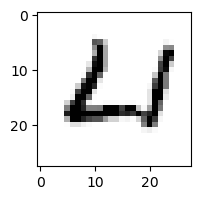

1.3972267319013567% - 0
3.2449376689553995e-13% - 1
0.006056814589021227% - 2
2.017338518136865e-32% - 3
0.7397050890699178% - 4
1.5519676054606189e-06% - 5
91.0957242263229% - 6 - ОШИБКА
1.4749920481296466e-07% - 7
6.219464294380953e-12% - 8
5.412310842092134e-21% - 9

 5


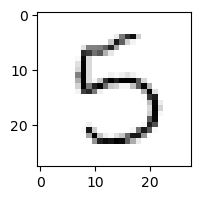

0.03691517394123789% - 0
2.056216098737806e-05% - 1
2.965396014099574e-10% - 2
98.60535783868895% - 3 - ОШИБКА
52.06569769519729% - 4
95.00391919888452% - 5
0.025918191415279197% - 6
2.2458718263207887e-05% - 7
0.0015069075809623787% - 8
6.024534603046818e-09% - 9

 3


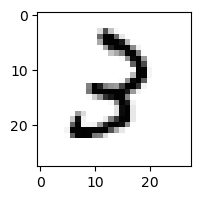

1.6217309317832976e-07% - 0
1.4581417433555354e-05% - 1
98.0680058856875% - 2 - ОШИБКА
4.7042260201166055% - 3
2.5979763240674835e-09% - 4
2.2909977339814365e-05% - 5
1.5104055144062843e-08% - 6
4.008421552230746e-08% - 7
2.3166040926538638e-14% - 8
8.019673353356253e-11% - 9

 6


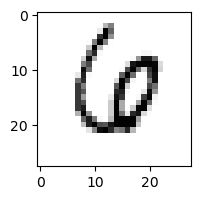

1.1156212850992008e-09% - 0
2.0200262557458e-07% - 1
2.7071280840225604e-09% - 2
1.9590919442100163e-11% - 3
3.414802915033732e-05% - 4
1.712424987667719e-08% - 5
2.9245743046923824e-06% - 6
0.8830464139184686% - 7 - ОШИБКА
1.066700252526835e-21% - 8
2.247366629403129e-23% - 9

 9


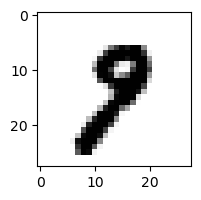

2.336442606227049e-17% - 0
1.6820634477602657e-05% - 1
5.139615490384762e-21% - 2
1.3862662324861531e-17% - 3
8.14229563013961e-19% - 4
2.222681691805609e-08% - 5
7.290721179133744e-18% - 6
0.9094381428569158% - 7 - ОШИБКА
3.054476318658216e-12% - 8
1.3916737887885038e-06% - 9

 8


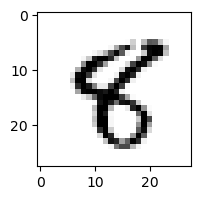

1.478074349741207e-15% - 0
1.3797791351161626e-07% - 1
1.363813612667789e-20% - 2
2.6484369337173273e-21% - 3
6.217528764675939e-05% - 4
5.805731033335805% - 5 - ОШИБКА
1.4013125906745333e-17% - 6
5.447244142300761e-08% - 7
4.025045463009445e-12% - 8
1.8680737420880803e-12% - 9

 2


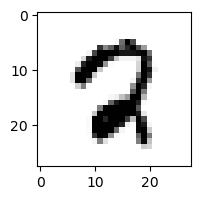

5.408188698912611e-13% - 0
1.3050204212887559e-14% - 1
1.221556461792927e-07% - 2
5.9765107406298766e-31% - 3
2.209386070104525e-13% - 4
9.695438567418265e-05% - 5
2.727001891281584e-09% - 6
0.001939722963852131% - 7 - ОШИБКА
1.4783272907496752e-12% - 8
7.559753497291312e-15% - 9

 7


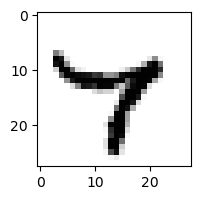

2.0890647291001955e-16% - 0
2.871243097710085e-08% - 1
2.283693798615415e-36% - 2
1.7969171255219644e-16% - 3
32.60686226423338% - 4 - ОШИБКА
3.071907820419017e-08% - 5
5.971560709105404e-09% - 6
9.515359423696971% - 7
1.1886848483693513e-06% - 8
0.0002600808252417353% - 9

 8


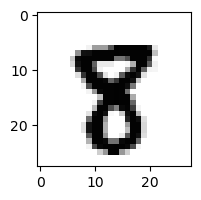

1.0551616597177095e-25% - 0
2.5087233471195052e-15% - 1
1.5379271584125596e-30% - 2
6.531268774316551e-25% - 3
4.020261550829706e-18% - 4
0.002228588485189262% - 5 - ОШИБКА
1.8473601601704127e-26% - 6
3.3155154482247545e-08% - 7
9.819443290651064e-05% - 8
4.810623276326227e-19% - 9

 4


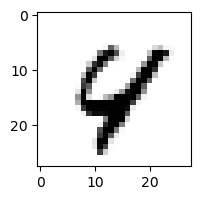

2.3970471347583564e-15% - 0
4.665943431516665e-10% - 1
2.1831928311201365e-10% - 2
1.5678793336943296e-37% - 3
3.871665216722068% - 4
5.543863403003325e-09% - 5
2.4434744956227855e-06% - 6
0.02686755864743614% - 7
25.54087687185734% - 8 - ОШИБКА
1.085217545856884e-05% - 9

 2


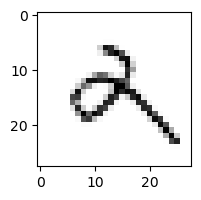

1.52091832257624e-07% - 0
0.04273302780225891% - 1
9.347352886760739e-07% - 2
0.00036146069465012456% - 3
0.20619229021189528% - 4
3.049378175347781e-05% - 5
0.0757190155821315% - 6
4.9151137139454575e-05% - 7
7.330670952818318e-07% - 8
99.98623357447532% - 9 - ОШИБКА

 9


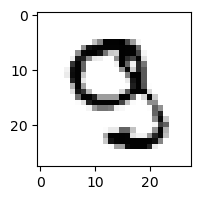

2.634756370262653e-10% - 0
3.49629301461349e-10% - 1
5.97822851069867e-08% - 2
4.888870698024798e-13% - 3
1.200994708654433e-08% - 4
5.8231109615935265e-05% - 5
1.4662504183178171e-19% - 6
8.260162863771844e-05% - 7 - ОШИБКА
1.3929509265144885e-19% - 8
8.552030856189886e-14% - 9

 7


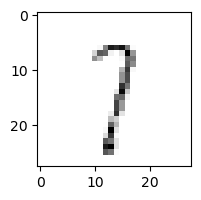

0.00572420014805213% - 0
33.58604744732593% - 1
91.19209557203928% - 2
99.92898168815756% - 3
0.2039653604892938% - 4
0.4255647363952832% - 5
0.04393035053130745% - 6
98.69405915722855% - 7
99.0473994251611% - 8
99.96855533483857% - 9 - ОШИБКА

 8


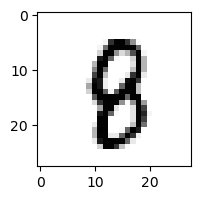

1.0306119855897094e-14% - 0
3.3089958553739885e-09% - 1
3.053867238701968e-14% - 2
2.4597757894399713e-14% - 3
6.136076475704124e-07% - 4
0.048890805143645084% - 5 - ОШИБКА
4.947284770691208e-10% - 6
4.6022059440725136e-05% - 7
0.004120601428755064% - 8
4.411026252864448e-15% - 9

 8


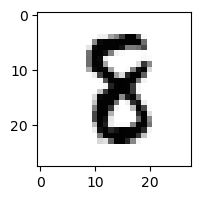

1.3010472062471572e-22% - 0
2.0416205496317235e-06% - 1
1.0853238877524495e-10% - 2
8.64052650203761e-16% - 3
2.9212616935780697e-15% - 4
0.0006025664268747192% - 5 - ОШИБКА
1.9749398412738362e-10% - 6
1.0026309377854666e-11% - 7
0.0003713449131074785% - 8
1.2730893027257273e-32% - 9

 5


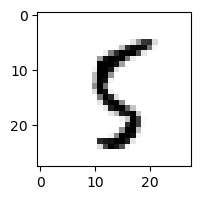

1.2571415395704342e-08% - 0
6.562200606569546e-05% - 1
4.4634961126357616e-11% - 2
8.959648197852441e-12% - 3
0.00026522064287842377% - 4
91.86638607924323% - 5
3.947440914059895e-06% - 6
0.00031354590206502937% - 7
92.99930270224863% - 8 - ОШИБКА
8.778502470884826e-05% - 9

 9


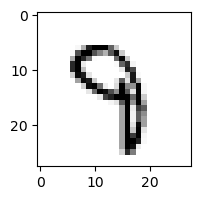

4.035543926802822e-17% - 0
1.1362516743927423e-07% - 1
3.2569775098000945e-12% - 2
0.000495743948657421% - 3
0.221610923510792% - 4
0.012209659263981917% - 5
9.093245141058023e-08% - 6
0.368992734839499% - 7 - ОШИБКА
6.3359575306707055e-18% - 8
6.101255354023261e-06% - 9

 3


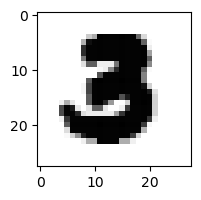

4.708598836922769e-23% - 0
1.2086333250844587e-22% - 1
6.235497985202881e-18% - 2
8.771443407113396e-14% - 3
4.610517907969903e-35% - 4
0.0007441688641301926% - 5 - ОШИБКА
7.211931001229419e-31% - 6
2.748145273493707e-19% - 7
6.678666539350107e-57% - 8
1.2254501208316204e-62% - 9

 5


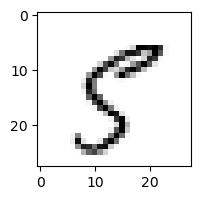

0.00041024303921053453% - 0
0.0002998406742180698% - 1
3.326132389020133e-13% - 2
3.33616829446451e-11% - 3
0.0005080098481576866% - 4
4.2218184057604695% - 5
2.84141851986709e-11% - 6
66.7462486100951% - 7 - ОШИБКА
3.3582496609482387e-09% - 8
0.00015093220504948732% - 9

 9


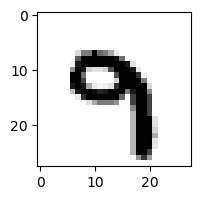

8.47246573927809e-21% - 0
1.3104558404608191e-09% - 1
5.0029546181644926e-20% - 2
2.2613289661925108e-11% - 3
5.2297150860681395e-06% - 4
0.026878630892227234% - 5 - ОШИБКА
1.637340703478036e-12% - 6
0.004247858712525106% - 7
1.96165733142491e-35% - 8
0.0004873484728259351% - 9

 9


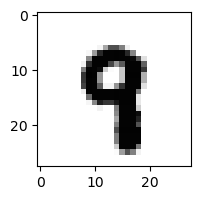

1.0904090637525994e-23% - 0
2.958426465244865e-11% - 1
4.6473976437500554e-23% - 2
2.826667021881982e-21% - 3
1.4944614824122472e-07% - 4
0.00019766478693043014% - 5
2.139881054301774e-18% - 6
0.0011481384037554684% - 7 - ОШИБКА
2.1447583722740917e-23% - 8
0.00043926081897243226% - 9

 6


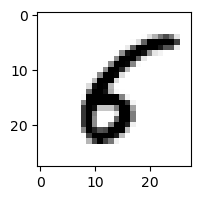

2.5215088002643125e-06% - 0
8.835492874108201e-05% - 1
6.256901748950605e-11% - 2
6.490106451037323e-19% - 3
5.520535165711402e-05% - 4
18.313271221669513% - 5 - ОШИБКА
6.050788089870134e-07% - 6
3.041440386306733e-11% - 7
4.545347926637693e-14% - 8
2.300608322962062e-21% - 9

 5


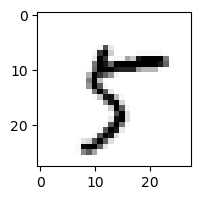

1.3629083551537708e-06% - 0
4.711778309824664e-06% - 1
2.3495856607387353e-16% - 2
7.994136074782481e-10% - 3
0.0003362635889445445% - 4
72.6104674005208% - 5
7.702593913040178e-16% - 6
93.6977897512341% - 7 - ОШИБКА
0.0076524992521412915% - 8
3.0980605381821636e-12% - 9

 8


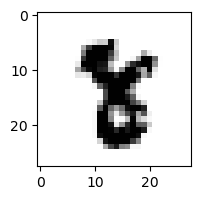

8.440354200657244e-30% - 0
6.309896863669947e-11% - 1
1.2324378632103138e-29% - 2
6.727257091679026e-20% - 3
1.3898322124350382e-13% - 4
0.00037884229468181265% - 5 - ОШИБКА
1.6717022549190568e-23% - 6
6.338265552891693e-05% - 7
4.417087548766251e-09% - 8
3.656285547903023e-36% - 9

 8


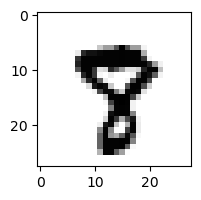

3.4114753355466965e-20% - 0
1.1517780257312428e-15% - 1
4.9895531583528255e-26% - 2
9.777592754143437e-27% - 3
3.6488570511693885e-16% - 4
8.58641186482319e-07% - 5
1.2198595045346839e-24% - 6
71.6126872136648% - 7 - ОШИБКА
4.572723531072568e-12% - 8
4.213812786447365e-13% - 9

 9


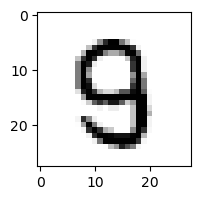

2.4400497033551798e-09% - 0
3.617744327524416e-13% - 1
5.4157887517091976e-14% - 2
6.627771106205602e-07% - 3
2.258919721478843e-08% - 4
4.16443520973828% - 5 - ОШИБКА
2.1510493951665795e-16% - 6
9.466464992231679e-06% - 7
4.878835414347861e-15% - 8
1.3560619738591185e-21% - 9

 3


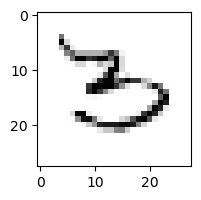

0.003520801018887289% - 0
3.817037954394237e-05% - 1
4.441912437103415e-07% - 2
99.94877023257649% - 3
9.676085906233178e-08% - 4
0.050692277051572504% - 5
99.9998430768793% - 6 - ОШИБКА
0.00012607484770580133% - 7
7.536301668220698e-11% - 8
3.461962904821958e-12% - 9

 4


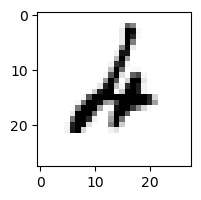

2.6561101259982107e-13% - 0
5.813446462195706e-05% - 1
56.9867750579438% - 2 - ОШИБКА
3.958188332036455e-12% - 3
0.00016630101778782746% - 4
2.6707661670766086e-07% - 5
0.05448722136123274% - 6
1.7631573159070853e-09% - 7
1.3125061930195084e-16% - 8
2.2291318927610773e-10% - 9

 8


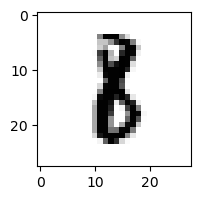

1.2257362752242172e-18% - 0
0.30727967491173136% - 1 - ОШИБКА
3.905815307853197e-11% - 2
4.370359410072367e-13% - 3
9.036751986792552e-18% - 4
0.0033671733308626357% - 5
1.499551980140457e-08% - 6
1.1367491755947172e-09% - 7
2.544318200983687e-10% - 8
2.2910842051883508e-21% - 9

 6


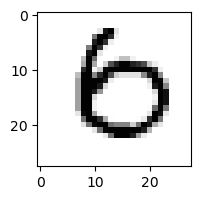

99.72135921211064% - 0 - ОШИБКА
3.5942158939121065e-13% - 1
5.026296374771431e-17% - 2
7.235756852619233e-16% - 3
8.678679507491731e-10% - 4
1.0028582968900768e-13% - 5
0.3347034909332918% - 6
3.0309022336035042e-06% - 7
5.165680042253142e-29% - 8
4.062236562680768e-26% - 9

 9


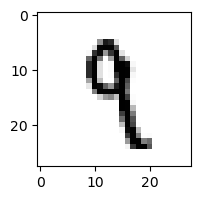

1.4086279520909522e-16% - 0
0.24470873644965452% - 1 - ОШИБКА
9.899319475434538e-10% - 2
4.407139689679295e-05% - 3
0.0008993870456115891% - 4
0.018479033390644318% - 5
5.4576763718948876e-11% - 6
0.00027716206984443233% - 7
5.925970494878039e-13% - 8
0.0026381207929656865% - 9

 8


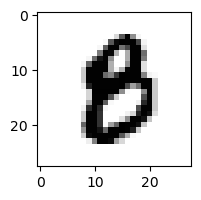

9.974265755715645e-10% - 0
3.11047866966197e-12% - 1
5.961612394662511e-23% - 2
5.079308945544942e-18% - 3
4.551181903569769e-17% - 4
0.058121183134942626% - 5 - ОШИБКА
4.535871791802e-12% - 6
1.5494009644199273e-13% - 7
3.588946579648662e-11% - 8
1.9865672665806163e-26% - 9

 8


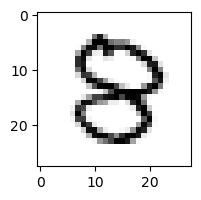

4.526447211784673e-08% - 0
2.4161488363089282e-14% - 1
1.548735950440418e-11% - 2
8.307437643707502e-06% - 3
1.0547884904893843e-05% - 4
8.566998509626945e-05% - 5 - ОШИБКА
1.262713283067738e-15% - 6
4.949405413597524e-10% - 7
5.3843469133545244e-12% - 8
3.1099216885652266e-22% - 9

 9


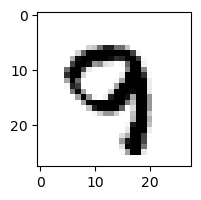

5.151052897403095e-23% - 0
3.4568427782273694e-10% - 1
1.1461174571894557e-15% - 2
1.081808556193348e-21% - 3
2.9112924832521664e-10% - 4
3.2298423690217696e-08% - 5
1.9151817651184256e-17% - 6
6.4217553269379914% - 7 - ОШИБКА
8.185540564623248e-24% - 8
2.0858596249054503e-05% - 9

 8


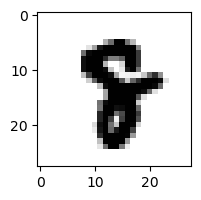

4.3406689892579474e-27% - 0
5.0898816060693394e-14% - 1
1.2237584592465407e-28% - 2
2.0271465761679368e-33% - 3
2.0212653479064665e-17% - 4
1.6235620959447595e-08% - 5
1.4687346559442962e-17% - 6
1.0603881867418003e-06% - 7 - ОШИБКА
1.0279628961358497e-10% - 8
3.631207412385967e-27% - 9

 8


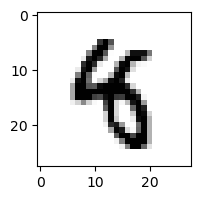

1.9907490187416723e-21% - 0
9.221051345210254e-06% - 1
4.905037127880282e-24% - 2
2.2397940940281938e-14% - 3
0.0038514441712471604% - 4
0.058755925150836684% - 5 - ОШИБКА
1.3018220124832171e-15% - 6
1.0192335512132855e-09% - 7
4.3390708483939546e-41% - 8
6.384472731346741e-19% - 9

 9


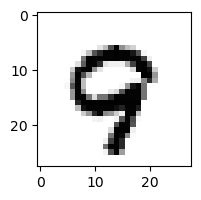

1.549885223065154e-14% - 0
2.005297307672888e-15% - 1
4.251599615618908e-15% - 2
4.816457062846972e-35% - 3
1.4869532517196041e-08% - 4
4.3235044578574545e-12% - 5
1.1407479526464819e-14% - 6
1.4383717847503303% - 7 - ОШИБКА
2.7410949137885426e-12% - 8
0.022088840217779987% - 9

 2


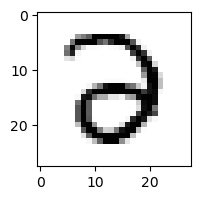

0.001969531854683747% - 0
2.790544222548362e-12% - 1
0.01523117586609542% - 2
62.354390960584404% - 3 - ОШИБКА
3.7068688275614135e-07% - 4
2.7145712564894282e-11% - 5
2.4346607125245945e-09% - 6
4.977741202993818e-12% - 7
3.68520482960502e-20% - 8
2.7756729187825233e-30% - 9

 9


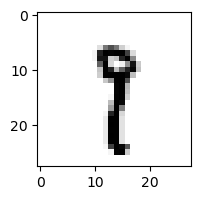

2.006402470717283e-14% - 0
10.183028858386201% - 1
2.334242210100824e-13% - 2
3.274321171568295e-07% - 3
5.492960318052641e-11% - 4
0.04264495338907597% - 5
7.057094190181812e-11% - 6
98.64421415246926% - 7 - ОШИБКА
1.5426405041662386e-07% - 8
3.332411480096636e-05% - 9

 2


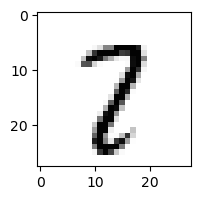

3.0518426998485786e-11% - 0
0.00018094973619325118% - 1
2.0306119226290032e-07% - 2
5.627201732368229e-08% - 3
5.825300623296385e-12% - 4
0.008319482411472972% - 5
1.4649183665462804e-13% - 6
99.29986806017239% - 7 - ОШИБКА
0.02676143008306433% - 8
7.565507296325262e-07% - 9

 4


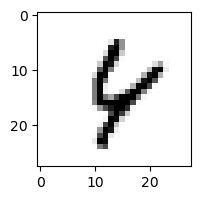

1.1071921114941647e-11% - 0
6.850693419297074e-07% - 1
7.044532399163445e-08% - 2
1.8148946990241706e-19% - 3
33.692657356168084% - 4
1.8106996087579392e-06% - 5
0.010857743664871597% - 6
0.0361568844929827% - 7
50.39779253613727% - 8 - ОШИБКА
24.911359969664282% - 9

 5


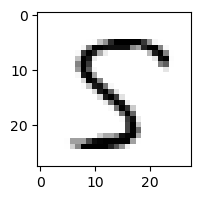

8.426697627493536e-10% - 0
1.3953776336816456e-09% - 1
3.0070276869637074e-14% - 2
6.490047740494754e-11% - 3
4.373327857318323% - 4
99.99388105319163% - 5
1.6141781024681813e-13% - 6
3.129917505972672e-07% - 7
99.99967288464113% - 8 - ОШИБКА
5.85845846642621e-29% - 9

 9


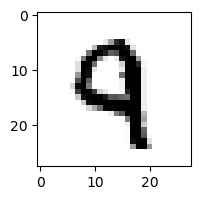

1.172091327612209e-15% - 0
1.5929581070001303e-10% - 1
5.261118059584298e-10% - 2
8.162122109076927e-18% - 3
0.046339406055372616% - 4 - ОШИБКА
1.064571234955351e-05% - 5
4.789272011927597e-15% - 6
0.00018739010506972604% - 7
1.6714516527459864e-25% - 8
0.00019510538117006426% - 9

 8


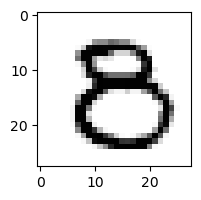

0.0003285470057874588% - 0
7.18488113037313e-18% - 1
1.1862896604075032e-14% - 2
3.1807682011204807e-13% - 3
2.695271187253557e-10% - 4
0.0003544659209706413% - 5 - ОШИБКА
6.395245061660733e-21% - 6
1.1386082643739787e-11% - 7
1.849975729812831e-05% - 8
2.773361478118983e-19% - 9

 5


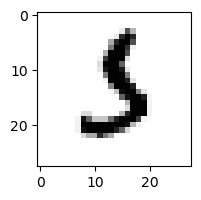

5.3904710022894444e-12% - 0
0.0003254034458824934% - 1
1.7154707415577846e-07% - 2
1.096014894424595% - 3 - ОШИБКА
3.170146496789045e-20% - 4
0.1347235028126354% - 5
0.0008582937426484836% - 6
0.0003025288689092398% - 7
2.720014169720641e-24% - 8
1.200676027777931e-20% - 9

 8


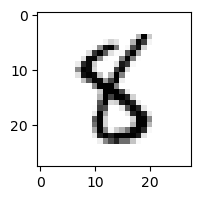

3.32661267527088e-14% - 0
1.1046769467842759e-05% - 1
7.530157607510772e-16% - 2
2.146990949281156e-10% - 3
1.5663760637960478e-09% - 4
27.0468305989921% - 5 - ОШИБКА
1.7413387746884326e-07% - 6
6.779859047007893e-10% - 7
7.987710281403559e-05% - 8
1.1399034971584188e-18% - 9

 3


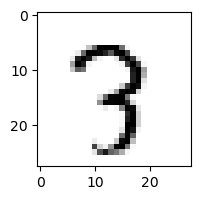

1.3112613540580565e-14% - 0
8.330329323079514e-07% - 1
9.194982818950048e-05% - 2
0.3090711018995907% - 3
1.796481579505022e-08% - 4
0.0006583458276285401% - 5
1.2658190702396543e-11% - 6
96.81967585697745% - 7 - ОШИБКА
0.005528745267542146% - 8
6.136050436803545e-05% - 9

 5


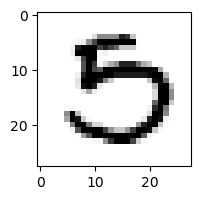

0.46290113840187586% - 0 - ОШИБКА
3.608589886341198e-15% - 1
7.554989151858612e-17% - 2
6.931721726237234e-08% - 3
1.3124278740038831e-18% - 4
2.0475316939863893e-12% - 5
4.436374038018383e-21% - 6
2.7649552828023667e-07% - 7
5.2383557320157226e-20% - 8
1.0708334769173482e-46% - 9

 9


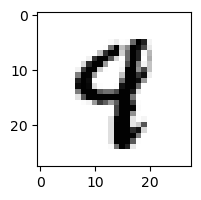

1.2994620055254233e-17% - 0
4.602973148236693e-09% - 1
1.9842059540981123e-19% - 2
6.378622701811148e-21% - 3
0.02418657867161504% - 4 - ОШИБКА
0.002560640617411118% - 5
7.590724454026164e-15% - 6
0.0001931382368310138% - 7
3.3306910654148055e-20% - 8
1.6009574895493273e-08% - 9

 2


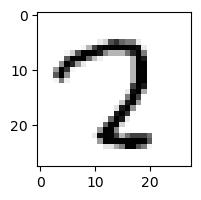

1.4604634302399248e-07% - 0
4.693059343928877e-10% - 1
0.00011272573382006097% - 2
2.793665889373268e-06% - 3
6.96400366360352e-08% - 4
4.7833225432918393e-05% - 5
1.550067578871825e-17% - 6
86.21281363339753% - 7 - ОШИБКА
5.890381438621248e-06% - 8
3.3509383273959956e-21% - 9

 8


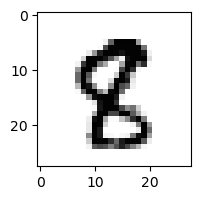

1.0415878987214426e-17% - 0
1.926606869561578e-09% - 1
1.769287687906026e-17% - 2
1.1942767230098402e-24% - 3
8.460100924889236e-16% - 4
0.039807489034469304% - 5 - ОШИБКА
6.141070533124603e-24% - 6
1.2834282693987757e-10% - 7
4.6474947819638425e-12% - 8
9.883259840266533e-19% - 9

 4


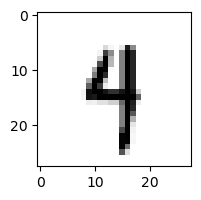

2.243417809243361e-13% - 0
3.2731962997439318e-06% - 1
1.3180292789589384e-13% - 2
1.5973228691562981e-06% - 3
88.46081275340397% - 4
0.48469449767984646% - 5
4.479538117268127e-08% - 6
1.458879940421534% - 7
3.050845406358773e-15% - 8
98.0170286685345% - 9 - ОШИБКА

 9


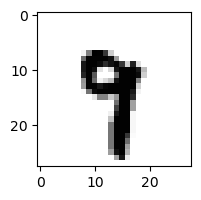

1.9058471871372238e-24% - 0
2.912156633801356e-06% - 1
3.98124602720448e-25% - 2
9.28627435840859e-19% - 3
6.742774846207825e-05% - 4
0.0007972244075809727% - 5
8.132769777329622e-14% - 6
2.18921405027704% - 7 - ОШИБКА
1.332833047664826e-17% - 8
4.095076230815852e-13% - 9

 8


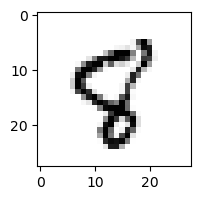

3.4225577944236656e-10% - 0
1.5702509159590636e-06% - 1
3.815234508245356e-12% - 2
3.499365390155927e-26% - 3
1.348878789036492e-05% - 4
3.0977877983864865% - 5 - ОШИБКА
2.5169990842049424e-09% - 6
0.017919804695911708% - 7
3.3977650423101185e-08% - 8
7.34847164405437e-07% - 9

 9


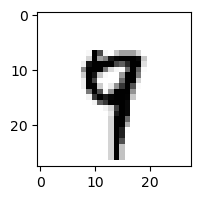

3.0378081681049516e-19% - 0
1.1532646704486604e-05% - 1
5.196384014767959e-16% - 2
4.030227521272518e-20% - 3
0.0004297507798261496% - 4
0.0033461917957657334% - 5
1.3521737404975633e-13% - 6
46.06643134864036% - 7 - ОШИБКА
2.7023915080451604e-14% - 8
5.70344856659381e-05% - 9

 8


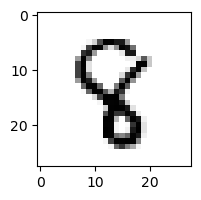

7.042863953841545e-20% - 0
4.171051697899597e-07% - 1
4.259261831931644e-14% - 2
7.564789203692777e-17% - 3
0.05150620287327752% - 4 - ОШИБКА
0.031722252282460665% - 5
1.0721268891715224e-12% - 6
8.006342087055962e-06% - 7
4.156404869820823e-13% - 8
1.6156086432553918e-20% - 9

 8


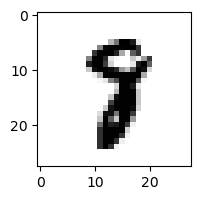

2.087990018177966e-20% - 0
6.517452448730986e-07% - 1
1.264410537181668e-16% - 2
1.863454971200125e-17% - 3
1.2391635866815244e-13% - 4
0.0002431903563002324% - 5
2.0623474418530472e-17% - 6
16.994487246986253% - 7 - ОШИБКА
3.4349454509503687e-09% - 8
7.59594902273179e-26% - 9

 0


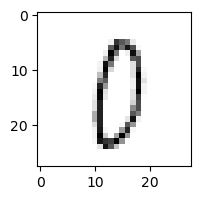

98.9191781598273% - 0
9.900378213302872e-06% - 1
0.0072048451387970594% - 2
0.09496472030571441% - 3
0.0012548770538171002% - 4
3.9377005106735448% - 5
0.06352261734928327% - 6
0.11656979594931319% - 7
99.99999966889406% - 8 - ОШИБКА
0.3186321331587888% - 9

 2


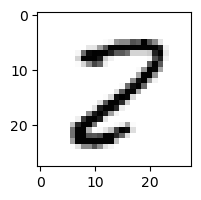

4.5086577964949867e-07% - 0
4.02571340222446e-07% - 1
0.09562013607577452% - 2
3.3072378270225796e-16% - 3
1.8851552724026852e-14% - 4
0.0001026639789448078% - 5
9.115375200473628e-14% - 6
0.00021805323560513385% - 7
99.99999999993219% - 8 - ОШИБКА
3.361711796035706e-24% - 9

 6


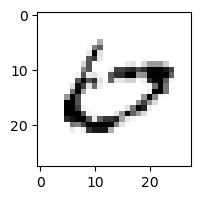

99.9943147287461% - 0 - ОШИБКА
7.587374892298612e-10% - 1
4.709916517770716e-14% - 2
1.7087490850157566e-10% - 3
8.279150219469004e-07% - 4
1.5461146199608767e-13% - 5
0.0010496247478953365% - 6
0.15450904140259894% - 7
4.408151871871031e-19% - 8
8.807621849719797e-23% - 9

 9


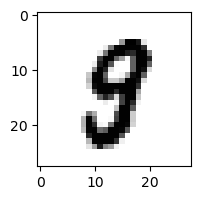

6.213789438786023e-12% - 0
1.4474235962542042e-11% - 1
1.418328111989553e-19% - 2
9.414192511520746e-13% - 3
2.2502019884468782e-11% - 4
0.0418992029479992% - 5 - ОШИБКА
5.287689347437778e-18% - 6
1.51025927625655e-07% - 7
0.003649964427386404% - 8
2.936254529498098e-14% - 9

 3


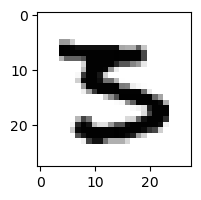

6.610021208759827e-14% - 0
1.259721036704192e-19% - 1
2.6553391002787894e-18% - 2
0.00010168114816159466% - 3
1.1120655314602546e-21% - 4
6.3427599034300925% - 5 - ОШИБКА
1.4908716765732127e-19% - 6
2.1820516431678858e-10% - 7
7.06258144787609e-34% - 8
5.821585015284842e-34% - 9

 3


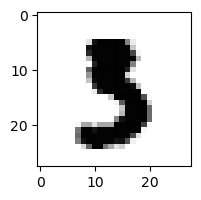

3.1358070633000344e-22% - 0
1.0168028486498341e-13% - 1
4.078171869835802e-30% - 2
7.878691431016442e-06% - 3
8.76437887954318e-24% - 4
2.8834679285896216% - 5 - ОШИБКА
6.631715808785464e-23% - 6
2.2772833269291068e-08% - 7
2.757830105680545e-32% - 8
1.9685937781976727e-39% - 9

 5


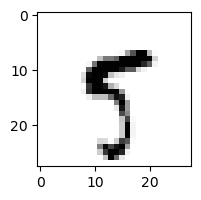

2.5934315691199687e-09% - 0
8.721969816666484e-08% - 1
6.451392737925362e-22% - 2
3.088636022312052e-12% - 3
2.849201863413916e-05% - 4
13.629425112171646% - 5
1.940887525823652e-15% - 6
17.533704547132125% - 7 - ОШИБКА
1.6960795742995713e-11% - 8
0.0010263894509524834% - 9

 3


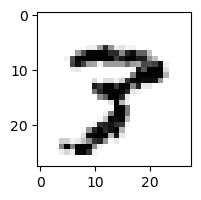

2.733473808662446e-13% - 0
1.6328702124750686e-10% - 1
1.2663255214079868e-14% - 2
8.853169168756517e-09% - 3
6.629874072777871e-13% - 4
2.7753871062839512e-11% - 5
1.7976043005933734e-17% - 6
19.406851224531067% - 7 - ОШИБКА
4.041583665150457e-06% - 8
2.626536311025328e-11% - 9

 8


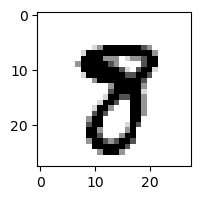

3.161720386183429e-24% - 0
2.426643161784075e-14% - 1
1.2345792882248866e-33% - 2
6.967510346503965e-21% - 3
2.615691716619016e-24% - 4
0.001002365763162368% - 5
5.295341911353052e-25% - 6
1.5685655623990418% - 7 - ОШИБКА
0.0005321628446742431% - 8
2.7283173228296866e-17% - 9

 9


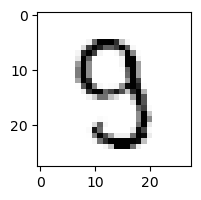

1.6540188233231837e-06% - 0
1.8397069542270246e-10% - 1
1.5806849917441968e-11% - 2
6.18872354936368% - 3 - ОШИБКА
0.00019240567571615288% - 4
1.0116809342152493% - 5
7.626819740306274e-14% - 6
0.0028861186981047945% - 7
1.0133480213855145e-11% - 8
3.560398613610685e-13% - 9

 5


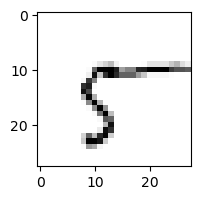

87.49774219143247% - 0
0.06707645921813739% - 1
7.895001767547798e-11% - 2
3.3956212402399955e-07% - 3
0.24796602134916093% - 4
0.5249377384790253% - 5
0.046778043068990076% - 6
54.47335444278225% - 7
99.95120826623649% - 8 - ОШИБКА
0.5636379587772155% - 9

 0


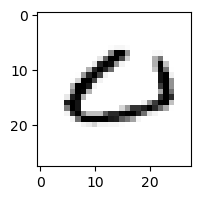

99.81702147313055% - 0
1.5041963987631707e-09% - 1
1.0629663060202117e-10% - 2
6.609700838169758e-23% - 3
7.847553199599193e-07% - 4
6.986787658637304e-08% - 5
99.86994968204107% - 6 - ОШИБКА
0.007660304878677958% - 7
2.028677282206965e-14% - 8
4.7613640195989696e-08% - 9

 8


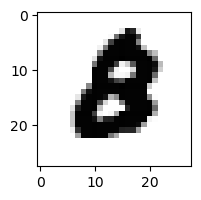

1.5776219475678976e-13% - 0
1.8436388936561743e-22% - 1
1.417177955586718e-15% - 2
2.9114136951239192e-24% - 3
2.1496820935415228e-24% - 4
2.272093140121012e-09% - 5 - ОШИБКА
1.4541164421655787e-15% - 6
3.324967794926129e-15% - 7
3.6755634882658245e-36% - 8
1.4410740426105337e-31% - 9

 9


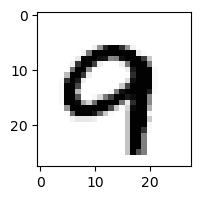

2.4295674076226333e-14% - 0
4.734803371922668e-15% - 1
4.5729845140815225e-14% - 2
4.287987429069367e-27% - 3
2.454860502924975e-11% - 4
1.9397450738826043e-13% - 5
7.021155383120241e-17% - 6
0.019703750753985106% - 7 - ОШИБКА
1.730307204402051e-19% - 8
0.0038760778382754806% - 9

 3


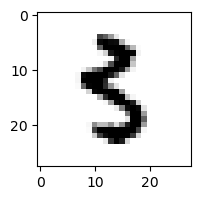

2.0899663424943243e-11% - 0
9.81009849620554e-08% - 1
1.3452057987002586e-21% - 2
1.1773236156999215e-07% - 3
1.4544921293951953e-10% - 4
36.32554621293201% - 5 - ОШИБКА
5.64178723094007e-10% - 6
3.129231247125514e-08% - 7
6.298286675148586e-20% - 8
5.8455536387456416e-15% - 9

 6


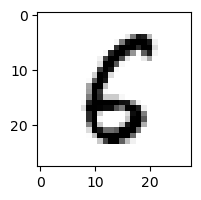

3.3344449025887244e-05% - 0
4.908469107401671e-09% - 1
9.36097564910296e-07% - 2
8.707894730440211e-22% - 3
1.1222157520761617e-07% - 4
2.211477591607173% - 5 - ОШИБКА
0.01060418262237759% - 6
1.53501606878573e-10% - 7
0.0030681822516958474% - 8
2.5134103085913606e-15% - 9

 4


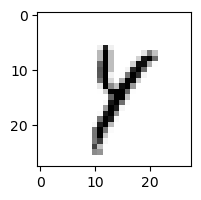

7.1479738532324386e-12% - 0
4.682493519822698% - 1
9.667477689832178e-09% - 2
2.3541613874229164e-06% - 3
0.16866805931498788% - 4
0.033416828564265956% - 5
1.017858901784727e-06% - 6
10.558936172104746% - 7
99.9682111957637% - 8 - ОШИБКА
0.0011525365848680843% - 9

 6


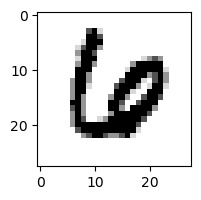

1.3107780833623444e-15% - 0
2.5772985241544143e-16% - 1
2.3136863222324096e-20% - 2
5.387479058715012e-23% - 3
8.295141870182486e-10% - 4
2.0091832561357284e-13% - 5
4.0998819204479833e-10% - 6
0.001078036118793914% - 7 - ОШИБКА
5.549070725233866e-36% - 8
5.6376768518632844e-46% - 9

 3


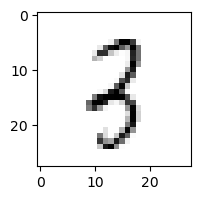

7.088032860794753e-08% - 0
0.11018647940635712% - 1
8.464659108123026% - 2
46.775194969901065% - 3
0.015522417672676952% - 4
0.14015503882372796% - 5
3.006646811630785e-08% - 6
0.00214060759496122% - 7
99.99924071457067% - 8 - ОШИБКА
0.0003131267713645818% - 9

 1


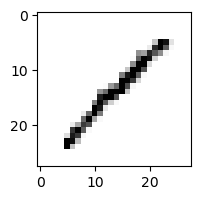

0.00020342360194248958% - 0
99.32573060802417% - 1
92.09393541051844% - 2
78.89721071461211% - 3
2.8162434216224828% - 4
0.00927779614467102% - 5
2.6289895942503664e-08% - 6
0.011898903647768192% - 7
99.99997892597214% - 8 - ОШИБКА
3.7550214066751937% - 9

 8


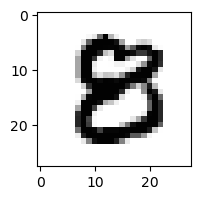

1.2824871188248442e-10% - 0
3.174386622914817e-20% - 1
3.749427870591649e-17% - 2
2.356283174459014e-09% - 3
1.3152236148445741e-17% - 4
6.782840551528447e-05% - 5 - ОШИБКА
1.394716959497233e-21% - 6
8.720183626173214e-19% - 7
3.8303379428404364e-18% - 8
4.294637679440891e-32% - 9

 3


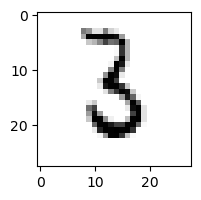

1.254558463130932e-07% - 0
1.456915441021995% - 1
0.0023809005462240274% - 2
4.6550000166694705% - 3
1.0986046931829761e-13% - 4
0.0013708077068797584% - 5
98.28273428194142% - 6 - ОШИБКА
2.919538520489915e-08% - 7
2.4703685308691378e-11% - 8
1.506763098899823e-16% - 9

 8


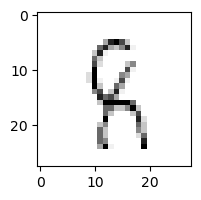

1.8794874579732103e-08% - 0
0.06715452328649801% - 1
0.20865683368919757% - 2
0.0008500905278667338% - 3
64.42734932649286% - 4 - ОШИБКА
0.8157979175498046% - 5
0.0013992888388873596% - 6
0.0013229580746472553% - 7
0.47115389909659666% - 8
7.347420567334144e-05% - 9

 8


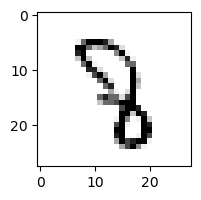

1.1820097663872507e-13% - 0
3.913320099569123e-08% - 1
0.003317508626323308% - 2
0.17708123266050335% - 3 - ОШИБКА
0.1323766521720059% - 4
0.08005169961364798% - 5
2.3132930028551327e-08% - 6
0.00011717010099121428% - 7
1.1343411950345702e-07% - 8
4.398657640815813e-12% - 9

 7


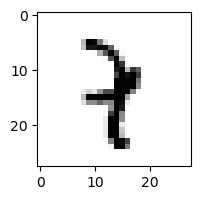

8.552124955568263e-20% - 0
73.78473522124813% - 1 - ОШИБКА
1.8280756885970666e-06% - 2
5.903548663671305e-06% - 3
0.0006129600914219454% - 4
2.375021408656859e-05% - 5
8.395258999520197e-09% - 6
0.023960004525920762% - 7
1.5906987184734618e-14% - 8
5.635153851838336e-09% - 9

 0


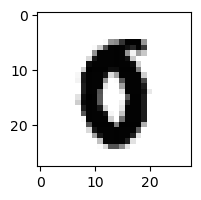

9.913904662313084e-11% - 0
1.0316589649647692e-18% - 1
7.785098578148505e-25% - 2
1.7986664045377339e-34% - 3
2.814563608162882e-17% - 4
0.00021391413020223774% - 5 - ОШИБКА
6.051648978975919e-11% - 6
6.798957834542845e-07% - 7
2.6972609965633656e-30% - 8
4.447848314925676e-27% - 9

 8


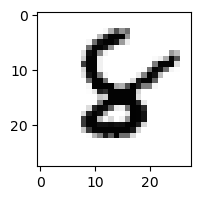

2.3499067664181708e-20% - 0
6.439290400593445e-14% - 1
6.616295061308019e-11% - 2
8.90968063940077e-24% - 3
5.699759307478016e-12% - 4
0.00041106783191599663% - 5
0.008685873878396545% - 6 - ОШИБКА
7.02393783158902e-12% - 7
0.004528895326525775% - 8
1.4761009780175573e-30% - 9

 4


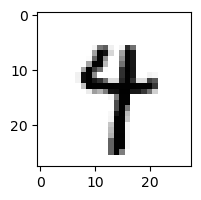

5.146418735653899e-18% - 0
1.4480610710366097e-06% - 1
5.454985558429042e-23% - 2
1.201114343181082e-17% - 3
0.4155982948375723% - 4
0.016710325348196935% - 5
2.1128906542056157e-09% - 6
0.689539499842769% - 7 - ОШИБКА
4.3419077780509187e-13% - 8
0.17515315601243509% - 9

 8


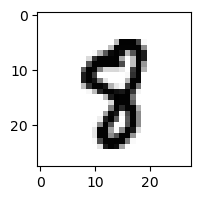

2.3244455718835666e-16% - 0
1.4565221093524912e-09% - 1
3.0475613334835386e-20% - 2
3.7306618921414463e-23% - 3
4.3435085401676777e-10% - 4
0.08585466850057963% - 5 - ОШИБКА
3.824999905855545e-17% - 6
0.00015159216853464008% - 7
2.465416075304499e-10% - 8
1.6250864087874534e-17% - 9

 9


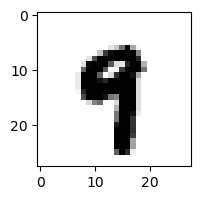

7.365084065589894e-22% - 0
9.931519039835827e-11% - 1
1.7314441516675852e-32% - 2
4.097801715070101e-20% - 3
1.973547399486052e-06% - 4
0.09317864218852949% - 5 - ОШИБКА
6.553542000545343e-19% - 6
3.438309267729005e-05% - 7
7.258754982090246e-27% - 8
0.01420829111972252% - 9

 3


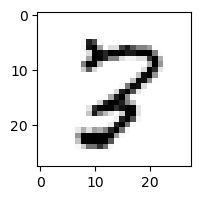

3.5692991150001336e-11% - 0
9.244149458339694e-10% - 1
0.002131769997407425% - 2
8.056570383809608e-13% - 3
1.1758461518844204e-10% - 4
1.293691130622424e-06% - 5
6.623630881921767e-13% - 6
0.6539665786205995% - 7
99.99997218488278% - 8 - ОШИБКА
2.8652021918013207e-08% - 9

 8


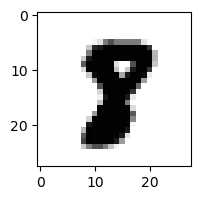

2.734703299188819e-25% - 0
3.9259209596794e-11% - 1
2.0132364266502866e-27% - 2
5.775132329732757e-29% - 3
1.873047641463866e-25% - 4
9.096501683130483e-05% - 5 - ОШИБКА
2.0590500704901194e-26% - 6
4.753973254571758e-08% - 7
8.136967686346161e-09% - 8
3.3804097404647322e-34% - 9

 8


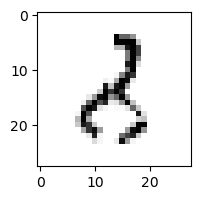

6.839328071078458e-06% - 0
5.551361041397888% - 1
99.89015924223213% - 2 - ОШИБКА
6.579682168425522% - 3
0.0007821864041624573% - 4
0.0033790529280060995% - 5
3.9141335938021397e-07% - 6
6.596777154158361e-09% - 7
9.41549862636252% - 8
7.530179480435067e-10% - 9

 8


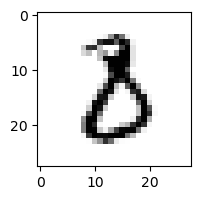

1.4783004194235844e-07% - 0
0.0015995457004999113% - 1
0.0022166700661192962% - 2
1.5561523788019376% - 3 - ОШИБКА
8.864331679589698e-19% - 4
0.0008660267899306261% - 5
1.5853213901565777e-08% - 6
6.955706732376111e-11% - 7
1.7309843076191535e-11% - 8
1.251325604706663e-20% - 9

 9


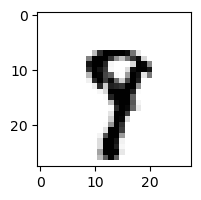

1.829600780186077e-19% - 0
2.592035587721111e-09% - 1
1.9565452651015134e-23% - 2
2.851024785951699e-15% - 3
2.1825205947052978e-09% - 4
0.0002457224264284833% - 5
6.646341062076936e-15% - 6
22.906737450661858% - 7 - ОШИБКА
0.008258835236514848% - 8
4.787091418462367e-06% - 9

 8


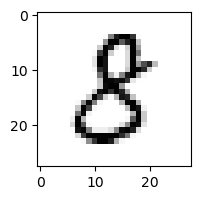

4.17459220907222e-06% - 0
2.2065274209883016e-07% - 1
2.3907897582931575e-07% - 2
0.8893788398645599% - 3 - ОШИБКА
2.8649429965807046e-10% - 4
0.12983142024126326% - 5
4.3932201620525033e-16% - 6
1.2318120227097568e-09% - 7
0.0031338236028516714% - 8
1.700899156057339e-22% - 9

 4


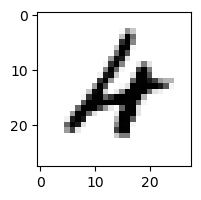

1.919761212981445e-10% - 0
5.7800092880522955e-11% - 1
0.003952666360291697% - 2
5.55603079402892e-18% - 3
0.0015308089274121803% - 4
4.630296425128252e-12% - 5
1.9577909015031116% - 6 - ОШИБКА
1.5215764242085116e-08% - 7
2.1469392220646757e-13% - 8
1.2228700737960935e-05% - 9

 2


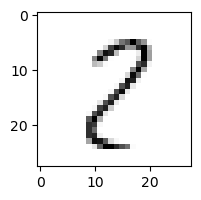

0.023222584149201017% - 0
0.18449482328773598% - 1
85.10754624805213% - 2
0.07891223953276241% - 3
3.285007937359739e-07% - 4
0.005152495312928511% - 5
4.3085883229118603e-07% - 6
0.43267273307318244% - 7
99.99999999999997% - 8 - ОШИБКА
0.0002219684539655189% - 9

 1


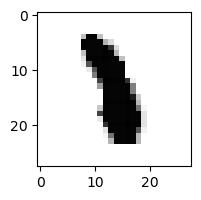

7.044121341387477e-36% - 0
6.0574138768904685e-05% - 1
6.242684369712598e-17% - 2
1.1088985973537635e-22% - 3
1.7265437341470495e-13% - 4
0.0007811884121281979% - 5 - ОШИБКА
1.8106042209399017e-11% - 6
8.491358029506493e-07% - 7
6.681116040364789e-22% - 8
4.985345161877319e-32% - 9

 2


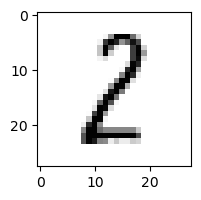

2.1912546042678405e-06% - 0
32.01980124855072% - 1
0.5770042395469289% - 2
0.0033666430701901275% - 3
4.505059396425916e-10% - 4
0.015784750622368882% - 5
3.328377083026459e-11% - 6
3.3605795904308e-07% - 7
62.156999738093745% - 8 - ОШИБКА
2.3589107290716307e-18% - 9

 9


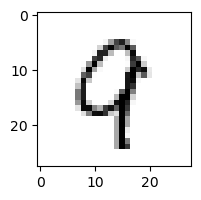

5.3504137096291375e-08% - 0
0.001056109868845581% - 1
0.0027422627898238197% - 2
9.508420917129585e-20% - 3
35.98927431953488% - 4 - ОШИБКА
6.208322236259106e-09% - 5
3.3418266608643095e-07% - 6
13.00901678053098% - 7
0.25877243256177096% - 8
1.4975107023781159e-05% - 9

 3


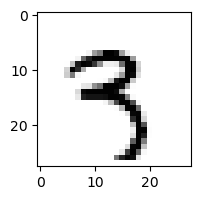

6.044841125988936e-16% - 0
2.9529384333274087e-05% - 1
1.3263863830996907e-07% - 2
0.03860305893152666% - 3
8.146687139696118e-06% - 4
0.005717662064728338% - 5
4.030982516577274e-12% - 6
0.00037766668999133937% - 7
9.297416663321021e-17% - 8
67.47082382175175% - 9 - ОШИБКА

 2


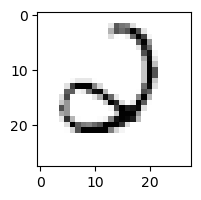

0.000187249280985238% - 0
6.565504674672239e-08% - 1
5.185074936537621e-06% - 2
2.1057138628730166e-08% - 3
0.2041888594477116% - 4
0.0008322774608487436% - 5
11.022624120198756% - 6 - ОШИБКА
4.743081342553774e-05% - 7
3.2693940463824026e-19% - 8
7.636172256685952e-13% - 9

 5


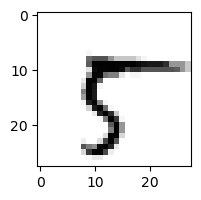

0.00033097703947158316% - 0
1.4828103778192653e-08% - 1
1.5845265961874575e-18% - 2
1.6270479802708815e-20% - 3
5.2292353928994965e-08% - 4
1.3210938631154296% - 5
2.526983641955321e-10% - 6
99.09580565521908% - 7 - ОШИБКА
4.704808594804909e-06% - 8
9.63421066788123e-10% - 9

 8


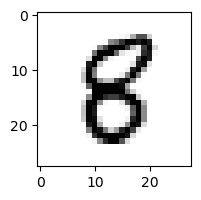

3.179352287170418e-08% - 0
6.3322376479124e-10% - 1
1.4845362916627089e-13% - 2
5.234274501513907e-11% - 3
7.640327918912462e-08% - 4
0.22584623765305256% - 5 - ОШИБКА
3.7504551050824974e-13% - 6
6.255090907129359e-12% - 7
4.742030729903133e-05% - 8
2.6026654992980976e-20% - 9

 7


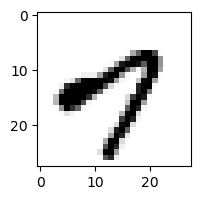

0.21702176683817934% - 0
5.309862922657898e-14% - 1
4.8468371666167495e-34% - 2
8.495010213190396e-13% - 3
64.58508325359522% - 4 - ОШИБКА
1.5137054631433338e-05% - 5
3.6722367785139174e-16% - 6
2.553972335266639% - 7
5.342192346830133e-31% - 8
3.8551269026189605e-11% - 9

 2


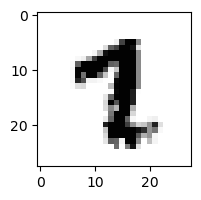

8.375532423108055e-25% - 0
7.911054208816263e-06% - 1
4.770169837516262e-21% - 2
5.493476683138195e-26% - 3
3.769679745506398e-15% - 4
0.001182978953494871% - 5
6.231187112959205e-22% - 6
0.004741031734642023% - 7 - ОШИБКА
4.5937795880405075e-24% - 8
5.091841742489422e-19% - 9

 0


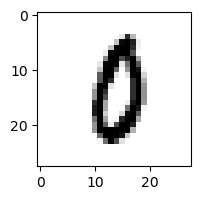

0.001242759573001681% - 0
1.4154366819941288e-10% - 1
3.6434023276896e-09% - 2
4.873967040790218e-11% - 3
1.418363550520385e-12% - 4
0.0051614326285184045% - 5 - ОШИБКА
0.00039308142865089254% - 6
6.52333188262855e-05% - 7
1.4824364884328708e-07% - 8
9.721161725826248e-11% - 9

 9


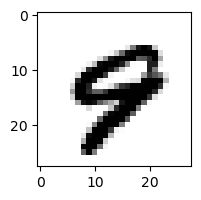

3.410103370288179e-14% - 0
4.278488020869506e-15% - 1
1.0363583191651588e-33% - 2
1.0876870503835892e-35% - 3
0.00014157135342826753% - 4
6.971001731313277e-08% - 5
2.9969067025810683e-11% - 6
0.00018658036268452534% - 7 - ОШИБКА
2.5837662322986547e-34% - 8
1.9619957543237542e-10% - 9

 9


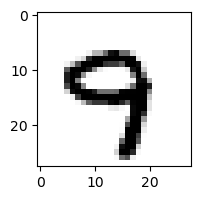

5.76016999310723e-16% - 0
1.5663625139289282e-11% - 1
3.125005478263498e-19% - 2
2.136288505331104e-19% - 3
7.212813322589921e-07% - 4
0.003737921630755046% - 5
2.6555021060610352e-12% - 6
0.5050459662697014% - 7 - ОШИБКА
1.3843365146290467e-28% - 8
0.010601426068748906% - 9

 8


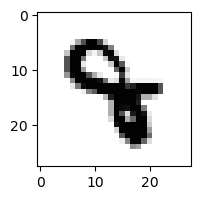

5.984109868646532e-30% - 0
1.2590286503737374e-10% - 1
1.202382533648491e-25% - 2
6.472787020365093e-17% - 3
1.208659128702736% - 4 - ОШИБКА
5.035650514803019e-05% - 5
6.1423367087327545e-09% - 6
5.205798797362958e-08% - 7
7.001082787069532e-41% - 8
7.945595654652837e-23% - 9

 5


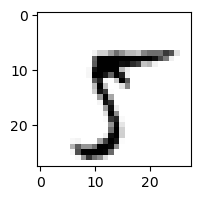

1.0399475778160052e-12% - 0
1.4632063024600797e-05% - 1
2.4240510809022257e-20% - 2
1.2316684570787491e-11% - 3
5.0930466419207906e-11% - 4
84.52768236457494% - 5
7.234668452081667e-17% - 6
97.30867071328174% - 7 - ОШИБКА
9.583341692001786e-07% - 8
5.144353519585682e-09% - 9

 8


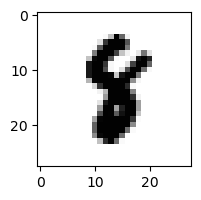

7.997386111558257e-26% - 0
2.339073734523932e-07% - 1
1.3877685174706372e-22% - 2
1.9599883750194752e-23% - 3
2.100723813606559e-13% - 4
0.004199443755255972% - 5 - ОШИБКА
9.063744038706556e-18% - 6
1.7842473199046553e-06% - 7
4.811674007432421e-12% - 8
1.1825076910324396e-28% - 9

 4


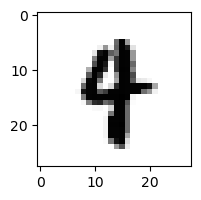

2.9113314853606666e-21% - 0
5.027946908500066e-05% - 1
1.399072726735039e-20% - 2
1.0109707499633625e-23% - 3
3.7458544751755714e-05% - 4
0.03345642996473559% - 5 - ОШИБКА
1.6605261393357687e-11% - 6
0.00010324760562554209% - 7
7.198966965680909e-26% - 8
7.281785202504653e-08% - 9

 8


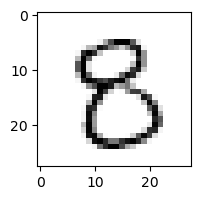

0.002159586363047134% - 0
3.940280637840871e-10% - 1
5.156523233007328e-12% - 2
0.012313762534214786% - 3
0.0007825715628435671% - 4
0.30797702945960365% - 5 - ОШИБКА
1.3326283820164064e-14% - 6
1.0970870962579415e-09% - 7
0.020720019333693444% - 8
1.2339567649477024e-18% - 9

 0


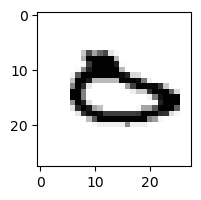

9.598458013421735e-06% - 0
6.006925848066609e-09% - 1
5.434853425982718e-18% - 2
5.087937856255282e-31% - 3
3.0917372341943436e-09% - 4
1.2259160624655367e-06% - 5
99.99492957014584% - 6 - ОШИБКА
0.019555212750644382% - 7
8.518007240757785e-19% - 8
9.183900260036732e-14% - 9

 5


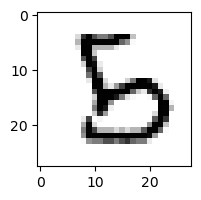

1.3429275624068804e-14% - 0
3.8471909532723806e-11% - 1
0.9496690716247921% - 2 - ОШИБКА
2.505493674035531e-13% - 3
5.526699561521765e-06% - 4
0.049315920730594764% - 5
4.1990710620656274e-07% - 6
1.296435029066091e-14% - 7
8.751184445420849e-05% - 8
5.179941657953835e-24% - 9

 2


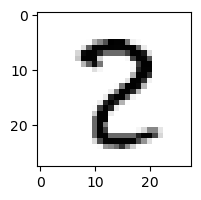

1.0176733614009068e-10% - 0
1.1656443727217319e-07% - 1
0.02422899946601195% - 2
5.318446906418752e-10% - 3
1.8544295225298343e-12% - 4
1.3778450529924318e-06% - 5
3.7179768769873395e-18% - 6
0.020099063242682833% - 7
99.99999474071818% - 8 - ОШИБКА
8.794540056937619e-18% - 9

 2


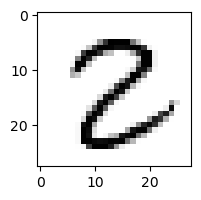

1.6109399322071389e-09% - 0
1.319761255865781e-07% - 1
0.8606049564738002% - 2
3.493534312115338e-05% - 3
1.9337208639412752e-16% - 4
0.0006789513676802477% - 5
2.0005172154676864e-19% - 6
1.38742081473615e-08% - 7
99.99999987853008% - 8 - ОШИБКА
6.228522381455003e-26% - 9

 4


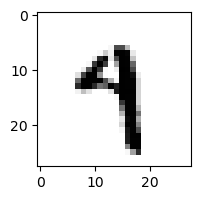

1.3004354169203929e-15% - 0
0.00017429045645939948% - 1
4.400685995151188e-23% - 2
2.463406215151392e-09% - 3
0.01009246341488206% - 4
0.039513968321662575% - 5
1.4286548026531376e-10% - 6
0.09085736340197087% - 7
3.192496666799953e-17% - 8
99.99403600325543% - 9 - ОШИБКА

 2


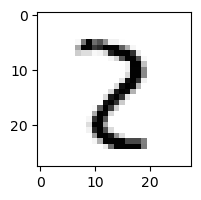

2.2355596941961192e-10% - 0
0.0006072397781219372% - 1
0.00028544457823241197% - 2
4.309233408692053e-05% - 3
2.3289411122744168e-11% - 4
2.726210459515855e-06% - 5
6.757132712325794e-12% - 6
0.20792820615344662% - 7
99.99975748555119% - 8 - ОШИБКА
3.7122734811475043e-06% - 9

 4


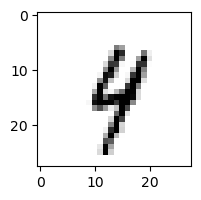

1.2733206406931232e-12% - 0
0.00434851743475522% - 1
1.9650115573726286e-08% - 2
4.0107525713995704e-07% - 3
0.141374884788878% - 4
8.16288496793441e-05% - 5
0.00012162551094430168% - 6
0.6090181323952353% - 7
0.04823452753579596% - 8
44.70175211009331% - 9 - ОШИБКА

 8


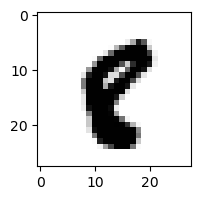

2.6517279655396135e-17% - 0
3.3629111174527415e-09% - 1
5.0014343947965445e-30% - 2
3.930851972901e-35% - 3
4.0383041673491474e-16% - 4
0.0009369144607114549% - 5 - ОШИБКА
7.091803267746654e-18% - 6
2.4532295294446457e-10% - 7
2.0406599132785034e-13% - 8
1.3747362443759823e-17% - 9

 8


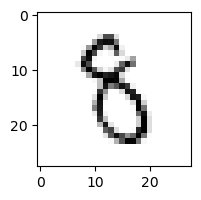

3.971746884576949e-08% - 0
0.0009597648455109953% - 1
2.0250911773712573e-08% - 2
0.09399948197464426% - 3
2.3539672048274947e-06% - 4
0.825035255897298% - 5 - ОШИБКА
7.673993746239043e-05% - 6
1.3421546086739688e-05% - 7
1.869650069092077e-07% - 8
5.0503925832244145e-15% - 9

 8


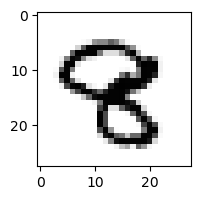

7.793792450457046e-22% - 0
9.881302006081502e-12% - 1
7.340364036657154e-16% - 2
1.5429756326014155e-11% - 3
3.947865714285443e-09% - 4
8.8141611957992e-10% - 5
1.3935964832860105e-20% - 6
8.13199869853073e-09% - 7 - ОШИБКА
2.1762514112092214e-14% - 8
2.1898945455436803e-15% - 9

 8


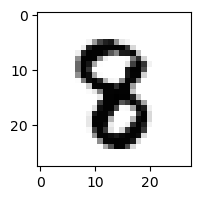

1.2833712283486244e-23% - 0
4.44768233691536e-12% - 1
3.096451125206335e-20% - 2
7.318310407252431e-19% - 3
3.5284817890800904e-12% - 4
0.00035191057365216476% - 5 - ОШИБКА
7.716922710734396e-18% - 6
8.177122889009428e-08% - 7
1.0013808968315182e-08% - 8
1.95254047002055e-26% - 9

 3


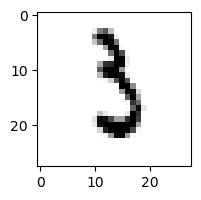

4.2208814935791554e-10% - 0
0.258157580436347% - 1
2.588153630968138e-05% - 2
0.6441046739916992% - 3
7.46003923423269e-15% - 4
0.06621523153231643% - 5
9.778767322942821% - 6 - ОШИБКА
0.12374305496086738% - 7
1.6210233662833542e-19% - 8
4.539420586223379e-12% - 9

 5


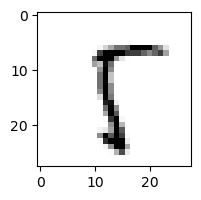

4.4147026792510806e-07% - 0
0.004722414669249792% - 1
9.36978923779248e-07% - 2
6.29181199348974e-10% - 3
7.587873323064598e-05% - 4
98.7270912643865% - 5
2.70696678103926e-06% - 6
0.07327584558112878% - 7
99.99998551391835% - 8 - ОШИБКА
0.08278262502946718% - 9

 8


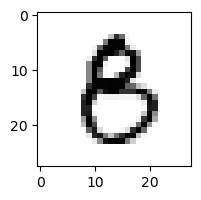

1.9923257685546836e-05% - 0
5.8842591872644e-09% - 1
1.4481180334252382e-14% - 2
0.004056598544006553% - 3
1.7579267715279292e-07% - 4
0.09686088256299484% - 5 - ОШИБКА
1.6708425379449495e-13% - 6
6.302875885537789e-10% - 7
1.784840410758207e-15% - 8
6.942244627730967e-15% - 9

 8


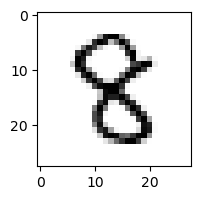

4.84417561531155e-16% - 0
9.018682757783903e-08% - 1
2.2318948198075413e-11% - 2
8.533677259845397e-07% - 3
8.515162349772622e-06% - 4
0.0008117676870906003% - 5 - ОШИБКА
3.401664987578413e-15% - 6
3.968644980853727e-09% - 7
9.284508909285893e-07% - 8
1.170635352347431e-19% - 9

 8


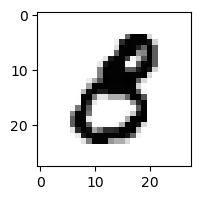

1.380687500028456e-09% - 0
7.171140772952519e-11% - 1
3.33932240532848e-21% - 2
2.672498719571812e-06% - 3
1.6651439465295745e-16% - 4
0.0002177798851137708% - 5 - ОШИБКА
4.605827775510685e-22% - 6
2.6653518896595992e-11% - 7
9.706894303849103e-29% - 8
2.1519486285124442e-29% - 9

 8


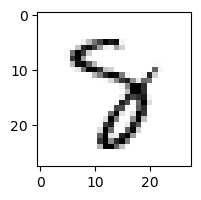

1.9493415785312514e-12% - 0
2.173361211118997e-07% - 1
6.059397118998001e-11% - 2
2.6129191275627075e-08% - 3
0.00027777959709408123% - 4
0.008343907880388822% - 5
4.754845000714422e-06% - 6
14.422915991010562% - 7 - ОШИБКА
3.866390914218587e-06% - 8
5.4750297866138734e-24% - 9

 7


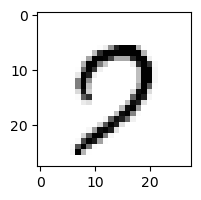

21.549937601142823% - 0
4.5362071424757217e-13% - 1
1.181678173506446e-10% - 2
1.0007045501740297e-08% - 3
5.741796170817424e-07% - 4
0.009013398189106136% - 5
1.797763946063614e-09% - 6
98.79851987935797% - 7
2.2088373425002177e-12% - 8
99.99764028827859% - 9 - ОШИБКА

 8


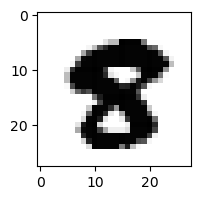

6.520653988832933e-24% - 0
6.514003054775702e-27% - 1
2.1401092856742222e-43% - 2
1.3859956309523193e-44% - 3
4.662548373132265e-25% - 4
6.339567688551377e-05% - 5 - ОШИБКА
4.9092902474179685e-39% - 6
2.9584151901524177e-16% - 7
1.7028799698171834e-13% - 8
2.89905354387917e-39% - 9

 6


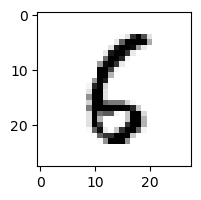

1.4735567575886569e-05% - 0
1.6735581047391377e-07% - 1
0.001033648939559436% - 2
3.430532204951778e-22% - 3
1.723339938752912e-07% - 4
2.4043503558574733% - 5
4.577100758604997% - 6
4.0250594246478245e-09% - 7
41.01602064153103% - 8 - ОШИБКА
1.3246527240056277e-10% - 9

 8


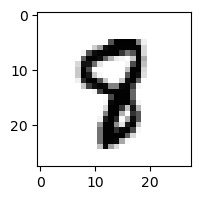

3.2762390350330133e-19% - 0
2.313139223461949e-09% - 1
4.212625799245022e-19% - 2
2.026350238564422e-18% - 3
2.528955659393878e-08% - 4
0.014450149611692324% - 5 - ОШИБКА
3.72185991181054e-15% - 6
7.200965341830383e-05% - 7
1.759692088147638e-12% - 8
2.221308670129955e-22% - 9

 9


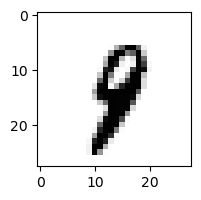

8.997246215650304e-19% - 0
1.0893571009845419e-05% - 1
1.4886139759060647e-14% - 2
6.413542095575306e-13% - 3
2.392042210500636e-05% - 4
2.5365007645072996e-05% - 5
3.0278407079135215e-09% - 6
0.009685445555816408% - 7 - ОШИБКА
3.8842394791537924e-10% - 8
0.00108673664372041% - 9

 8


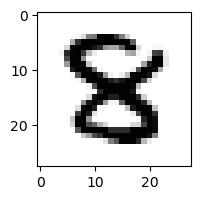

4.806788441530676e-20% - 0
2.464406355406904e-19% - 1
7.077482142289626e-15% - 2
7.693169468835538e-12% - 3
2.1827937370635042e-11% - 4
6.032704867298551e-08% - 5 - ОШИБКА
1.3378704113291133e-23% - 6
1.5879443115877927e-17% - 7
6.415340761540275e-16% - 8
7.090767150400961e-41% - 9

 8


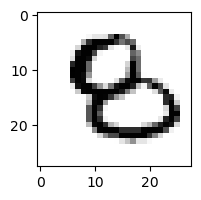

8.362426405293489e-10% - 0
1.4115600556730162e-11% - 1
0.0024731655561427224% - 2 - ОШИБКА
1.5487988542573413e-21% - 3
3.299842476728645e-08% - 4
1.5916400915347786e-05% - 5
6.4209419722203466e-09% - 6
7.357366943293355e-14% - 7
4.469535878135376e-18% - 8
9.488825758819039e-24% - 9

 8


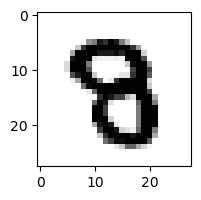

2.2643078081107174e-20% - 0
7.186822691391425e-18% - 1
2.732011209924798e-22% - 2
6.061872456252055e-15% - 3
1.1310223240641723e-15% - 4
1.1531896828469777e-07% - 5 - ОШИБКА
3.685537544258869e-18% - 6
2.9043724885343024e-11% - 7
1.9006372822341567e-25% - 8
1.2506075074261575e-24% - 9

 8


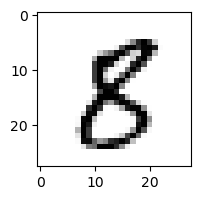

1.0041958273092763e-11% - 0
1.2049414076948518e-08% - 1
4.3900964655370525e-15% - 2
1.9409160377840678e-12% - 3
1.8739821807507992e-12% - 4
0.30826297944098957% - 5 - ОШИБКА
1.914317304991855e-20% - 6
3.9567586531774655e-10% - 7
0.018860412030042458% - 8
7.354972505559577e-16% - 9

 4


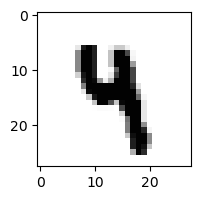

1.8421542579276316e-25% - 0
2.7945381339174342e-09% - 1
4.0576300371043485e-21% - 2
8.906424273353496e-10% - 3
0.0006453049297031143% - 4
0.0015973849979320936% - 5 - ОШИБКА
4.0049528149711435e-15% - 6
8.749247495332881e-07% - 7
2.322084737260075e-27% - 8
0.00030138161626075004% - 9

 9


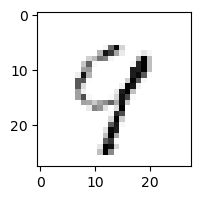

3.342928634229498e-05% - 0
0.013670633829713716% - 1
4.55856728860087e-05% - 2
1.4290418426044545e-06% - 3
0.8038084988634233% - 4
0.00021529898966402765% - 5
0.00017416790974621348% - 6
92.26414080920786% - 7
99.73059017358695% - 8 - ОШИБКА
99.2266804530715% - 9

 3


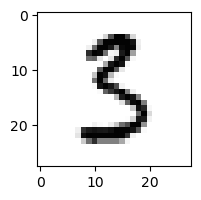

6.000709849642879e-07% - 0
3.4242442067918343e-07% - 1
1.2091879323716297e-08% - 2
44.56716597687706% - 3
5.428200057198982e-14% - 4
66.9878180908284% - 5 - ОШИБКА
9.761795339572743e-09% - 6
3.7317611855388723e-06% - 7
1.0456729026221763e-11% - 8
1.6970205922608918e-23% - 9

 3


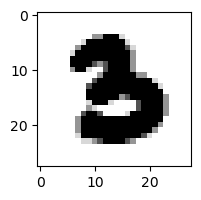

4.168111597141066e-25% - 0
2.680931633748066e-21% - 1
1.1732029855210584e-19% - 2
5.356437753673659e-13% - 3
2.2697037579840115e-34% - 4
1.2884315356563233e-05% - 5 - ОШИБКА
1.4891433209460983e-16% - 6
2.7105919170850575e-17% - 7
7.490494157942212e-52% - 8
3.4122251676287925e-58% - 9

 8


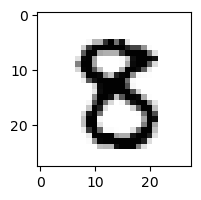

2.373018283591221e-15% - 0
5.2848790445508124e-14% - 1
6.214573232760368e-22% - 2
1.2335518747484003e-08% - 3
2.3181409029642484e-14% - 4
0.030123154833842793% - 5 - ОШИБКА
2.147803608549828e-29% - 6
7.638991922441866e-12% - 7
2.5095548483652873e-07% - 8
5.146833437702264e-27% - 9

 1


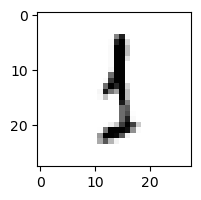

4.562030537001908e-08% - 0
99.26542736025937% - 1
0.0011688323547602616% - 2
99.99629184269303% - 3 - ОШИБКА
6.216806249728501e-07% - 4
0.18487945601746097% - 5
0.010230179798446327% - 6
2.068619509655233e-05% - 7
0.5117374029978522% - 8
0.0008619895834937083% - 9

 9


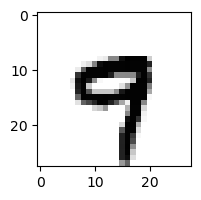

9.026593905998079e-16% - 0
2.150911380140837e-09% - 1
2.900831100600882e-29% - 2
3.1178475698226315e-21% - 3
0.00020795126699396546% - 4
6.995955194084603e-06% - 5
3.9499897770270185e-15% - 6
34.47451732874908% - 7 - ОШИБКА
9.725068927404777e-26% - 8
0.0002977933801441842% - 9

 8


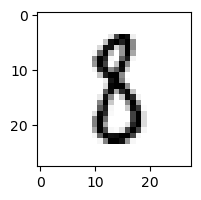

9.61373102394917e-13% - 0
0.18628325025738926% - 1
5.1111733070955995e-08% - 2
9.204860935922614e-06% - 3
6.974602565576894e-15% - 4
2.1048705183918686% - 5 - ОШИБКА
2.944753375550782e-07% - 6
1.695942455679362e-07% - 7
0.5575276344105196% - 8
3.917217721362101e-18% - 9

 2


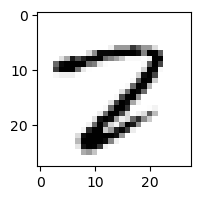

8.208243676985422e-10% - 0
6.899362953677694e-11% - 1
2.3622023978208875e-08% - 2
5.936523908934157e-15% - 3
5.10487193803316e-14% - 4
1.948474995361015e-05% - 5
1.7438201286364517e-13% - 6
73.35206295257959% - 7 - ОШИБКА
6.166408881338583e-05% - 8
3.7482036024268717e-19% - 9

 8


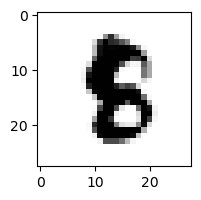

1.0957013159700678e-21% - 0
3.3632766499889405e-11% - 1
1.1403005219795014e-23% - 2
3.358686862081183e-22% - 3
2.6595256432923138e-17% - 4
0.004841892178152237% - 5 - ОШИБКА
7.527025838623561e-14% - 6
4.3981917099914553e-10% - 7
1.5302102639373517e-24% - 8
1.0204068519393164e-23% - 9

 3


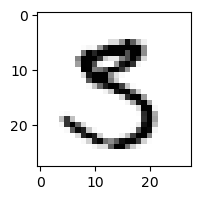

1.985201137417616e-08% - 0
2.9662935507356255e-11% - 1
4.3632140360914706e-16% - 2
0.05675108988668682% - 3
3.4050369516765893e-15% - 4
94.56453024963015% - 5 - ОШИБКА
3.919811705097778e-22% - 6
8.489880037802629e-05% - 7
6.891971623487879e-13% - 8
5.831210741280369e-19% - 9

 2


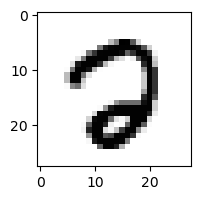

2.6826133595030926e-07% - 0
1.0322298146537702e-15% - 1
4.100171347811743e-16% - 2
3.2277210639694565e-24% - 3
2.299111986443579e-18% - 4
0.009436938182536755% - 5
6.002952370008872e-15% - 6
0.01667459703833283% - 7 - ОШИБКА
1.6626348384702026e-10% - 8
3.0463212091243485e-32% - 9

 6


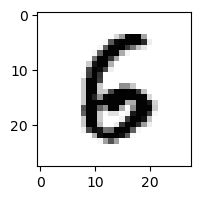

6.647520857763658e-14% - 0
4.468097026930772e-12% - 1
1.019172553144016e-07% - 2
3.529787365937462e-26% - 3
2.048227073458074e-08% - 4
0.25133543321380614% - 5 - ОШИБКА
0.13783208723502288% - 6
1.6617308116356964e-11% - 7
2.126360487797624e-14% - 8
1.6231569479816666e-23% - 9

 3


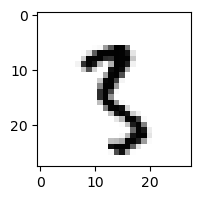

4.463949752521863e-16% - 0
0.006751893442215299% - 1
7.560903861225707e-08% - 2
6.96735552902229e-07% - 3
7.917824470307612e-12% - 4
0.48887125549853616% - 5 - ОШИБКА
3.653043385578773e-12% - 6
2.1194796727983847e-05% - 7
0.0004453219527637639% - 8
4.058045889917437e-05% - 9

 8


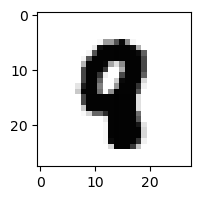

1.0024951598930432e-27% - 0
1.7270024478002376e-13% - 1
1.8418967595062057e-24% - 2
6.041334233103404e-41% - 3
7.008775198259764e-11% - 4
3.527207162325586e-08% - 5
1.623169499859399e-22% - 6
5.676893349949475e-07% - 7 - ОШИБКА
1.4718921683136098e-29% - 8
5.5300584543498025e-18% - 9

 7


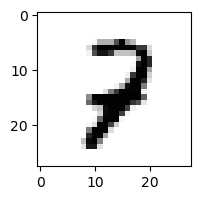

2.286781749918909e-14% - 0
2.403069469487227e-05% - 1
0.22954699344780058% - 2 - ОШИБКА
6.968506479096871e-13% - 3
1.4421183833334285e-05% - 4
3.841725003354031e-07% - 5
4.245519320110453e-11% - 6
0.005078281125446418% - 7
1.9347494069642383e-09% - 8
1.489016420484498e-10% - 9

 1


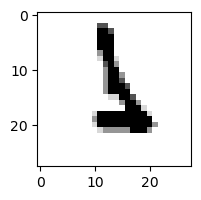

1.2056478717438494e-20% - 0
0.027757631355085025% - 1
0.002551139630990702% - 2
5.404326076446361e-06% - 3
2.1120038834541354e-16% - 4
0.011001220252807177% - 5
81.67160577841311% - 6 - ОШИБКА
2.698245645372983e-09% - 7
2.3793638828244206e-20% - 8
5.927914883991789e-21% - 9

 4


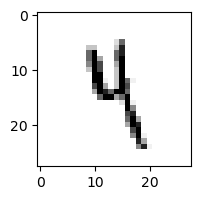

1.5775470149437724e-11% - 0
0.26466532315612085% - 1
9.955762427774687e-05% - 2
0.9826310246172323% - 3
31.531668691543903% - 4
4.324405820090144% - 5
0.0035124860075686185% - 6
0.002991190413208335% - 7
0.17142213268165052% - 8
97.9337697637541% - 9 - ОШИБКА

 9


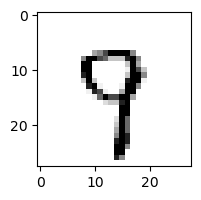

1.1954505436678247e-10% - 0
7.477265473736764e-07% - 1
1.5674459557280103e-10% - 2
7.15122438125717e-08% - 3
0.02127755413696834% - 4
0.00399221463085153% - 5
5.652978528022845e-08% - 6
92.50643271466964% - 7 - ОШИБКА
0.0002022852291414483% - 8
83.22683808389036% - 9

 6


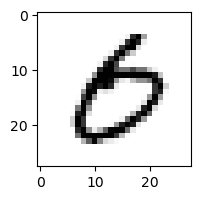

96.55575132949127% - 0 - ОШИБКА
1.1125895643141947e-09% - 1
8.944217972788241e-17% - 2
0.000647855905191478% - 3
3.6701858990776023e-10% - 4
1.6114969538425836e-08% - 5
0.003105359847331433% - 6
1.4536813836544984e-06% - 7
1.2664266935063524e-17% - 8
1.5612105910964027e-16% - 9

 9


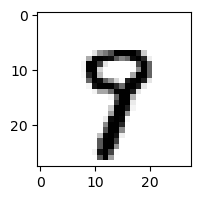

2.490675922289881e-15% - 0
3.112703239432697e-09% - 1
1.026599483706296e-19% - 2
1.2339566733932713e-14% - 3
9.03619262072831e-07% - 4
0.00014195982659328992% - 5
4.1945039211265754e-11% - 6
0.6253683228535015% - 7 - ОШИБКА
0.0011084511192639502% - 8
0.021945039386395814% - 9

 3


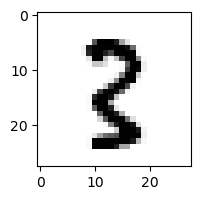

2.3923610626943174e-18% - 0
9.738965582072943e-05% - 1
1.6715847536916438e-06% - 2
8.922327952219601e-12% - 3
1.5148740501875063e-15% - 4
0.000632873261370525% - 5 - ОШИБКА
6.982725304421217e-17% - 6
4.2342662803017835e-08% - 7
8.236139754459854e-05% - 8
7.81433955433992e-18% - 9

 3


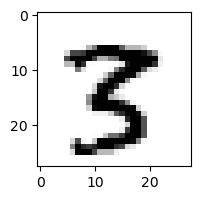

2.4666447401621873e-22% - 0
1.5346374542373644e-11% - 1
6.006342880327337e-21% - 2
8.433382791158346e-07% - 3
1.002666694457739e-15% - 4
0.0001003033530290009% - 5 - ОШИБКА
1.7256149173205523e-31% - 6
7.104151164116318e-05% - 7
6.325672132648128e-14% - 8
2.2456731061341526e-23% - 9

 9


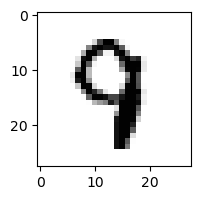

1.7890984815060784e-15% - 0
2.4984358444583293e-11% - 1
4.119964630373808e-13% - 2
2.591465583307793e-11% - 3
0.000309725305794327% - 4
0.003625010193799483% - 5
6.670465104720908e-14% - 6
0.8707427308374033% - 7 - ОШИБКА
8.019259004936865e-26% - 8
2.7440801286627636e-14% - 9

 8


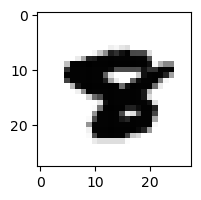

3.2203052460011075e-27% - 0
1.374486632512668e-20% - 1
6.108927222574485e-43% - 2
7.96731239111569e-45% - 3
3.6575358733021585e-19% - 4
1.7697374122756773e-11% - 5
2.091112049387313e-19% - 6
1.7391391681310722e-08% - 7 - ОШИБКА
1.5296828206008695e-38% - 8
4.578916630556362e-30% - 9

 9


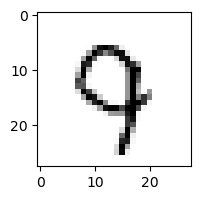

3.0955456595346816e-08% - 0
5.540298476578833e-08% - 1
3.6353915177420474e-06% - 2
7.22669712734239e-11% - 3
4.662317400642917% - 4
0.0054305698179765724% - 5
1.0764295417855722e-07% - 6
93.54137248891415% - 7 - ОШИБКА
1.311248552739865e-16% - 8
2.817495743601262% - 9

 9


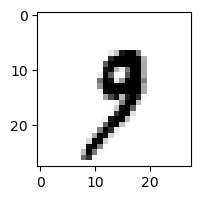

2.0930973823666183e-15% - 0
7.554771999251477e-05% - 1
1.0577859453733165e-16% - 2
0.00999314315506871% - 3
7.640259227585362e-07% - 4
8.34975036551273e-06% - 5
8.795211802629517e-12% - 6
3.5042498184743525% - 7 - ОШИБКА
2.397729113466806e-14% - 8
0.012994473735585505% - 9

 8


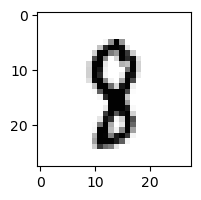

5.010888986147917e-17% - 0
5.666674666778025e-05% - 1
1.4722398918067897e-13% - 2
5.7421103274003204e-15% - 3
1.3487070846732245e-06% - 4
0.6007092724014046% - 5 - ОШИБКА
8.688540310404441e-12% - 6
0.00011243641826696721% - 7
0.12495296897751763% - 8
1.4335315025318055e-12% - 9

 6


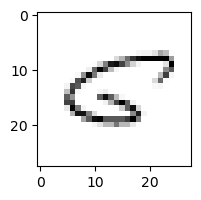

10.477493427076956% - 0 - ОШИБКА
0.0003832003190411684% - 1
3.8267180025311734e-05% - 2
7.696498851485088e-15% - 3
0.006664944447265511% - 4
2.938105775724889% - 5
0.002549004133347536% - 6
0.04708068248795293% - 7
1.2422823735040032% - 8
3.1004815483911257e-06% - 9

 8


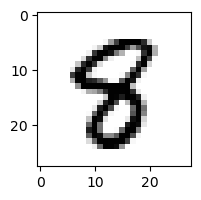

1.4082945296311984e-17% - 0
4.3734619939584265e-11% - 1
7.63253831651977e-26% - 2
9.815189886282114e-20% - 3
2.3635487681092585e-10% - 4
1.8888564731942215% - 5 - ОШИБКА
8.502378884524402e-17% - 6
2.9324331690823546e-09% - 7
0.0004582244321740605% - 8
6.899352624423238e-25% - 9

 8


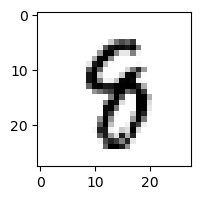

4.590661720950056e-19% - 0
2.722683148694878e-07% - 1
6.067192168947635e-19% - 2
5.61037351602957e-14% - 3
0.0003688929325538601% - 4
0.07138893945272327% - 5 - ОШИБКА
1.0907515015204444e-07% - 6
0.00030761973001612803% - 7
1.72436811648429e-08% - 8
6.738899724986683e-13% - 9

 3


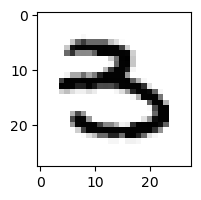

1.2756770984483882e-10% - 0
5.104130832997907e-12% - 1
2.6665730617716287e-22% - 2
6.372322770847294% - 3
3.1782345411755245e-19% - 4
14.200401793443362% - 5 - ОШИБКА
3.2403610189005874e-12% - 6
1.6631150968891073e-12% - 7
2.0700299996953287e-39% - 8
1.4365120300286263e-25% - 9

 8


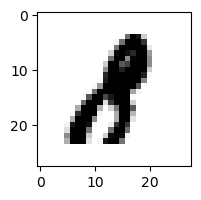

7.22486990289901e-14% - 0
2.5683443752066794e-05% - 1 - ОШИБКА
6.876545262453172e-12% - 2
1.7899354255201921e-12% - 3
8.657178294133735e-19% - 4
1.5717053648577519e-09% - 5
7.699053909550254e-23% - 6
2.7860394218383604e-12% - 7
1.4037257846262724e-18% - 8
2.4035932398812e-24% - 9

 7


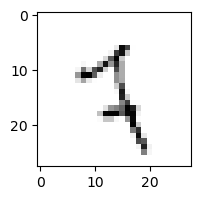

7.68884323682146e-09% - 0
10.66636535611805% - 1
0.08950481754948222% - 2
9.276751774629325e-12% - 3
0.010118730839920227% - 4
0.22353943484155606% - 5
0.29150473736471183% - 6
1.4726825750033874% - 7
0.6099691938121081% - 8
99.99981731979922% - 9 - ОШИБКА

 6


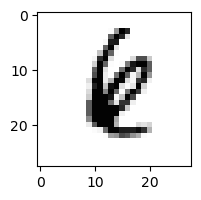

1.5250784789881302e-16% - 0
0.00024550499885675665% - 1 - ОШИБКА
6.148400322687426e-10% - 2
1.245637957770235e-25% - 3
5.419965323869528e-06% - 4
6.892540229648161e-08% - 5
5.173878829767031e-07% - 6
3.5205487928924914e-09% - 7
6.684892452479549e-14% - 8
3.3891649025678566e-13% - 9

 9


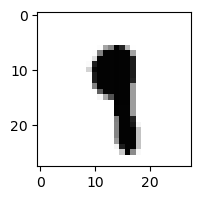

1.5507098026314285e-24% - 0
0.03530789439226238% - 1 - ОШИБКА
3.9658291413990477e-25% - 2
7.298532150945631e-14% - 3
9.346391515665314e-12% - 4
0.007636568732789082% - 5
8.446611368876807e-17% - 6
0.002705916374536165% - 7
1.4040309336512646e-17% - 8
1.6820482635174964e-07% - 9

 5


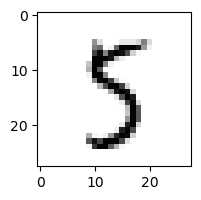

2.071726681467185e-08% - 0
4.334301026064325e-06% - 1
2.233761712127141e-12% - 2
0.09060557612050602% - 3
2.0510308221211324e-07% - 4
97.75257283906487% - 5
7.567341504739881e-07% - 6
0.0033199812420939283% - 7
99.99911885190816% - 8 - ОШИБКА
0.000840742441597978% - 9

 2


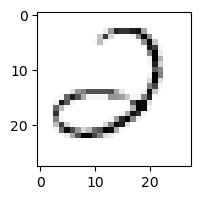

0.1290783900547364% - 0
3.8513960558796446e-05% - 1
0.11213879208414924% - 2
63.33722814120626% - 3
10.333452145974015% - 4
0.00024938552305857966% - 5
88.14658661038585% - 6 - ОШИБКА
0.00996697185136359% - 7
3.084577385712968e-15% - 8
8.368086813336809e-13% - 9

 8


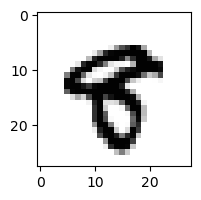

1.0322313896593716e-14% - 0
4.65223583945121e-14% - 1
1.915147374835807e-37% - 2
1.2348389456843465e-22% - 3
8.931370439940826e-15% - 4
5.4545263958729725e-05% - 5 - ОШИБКА
1.223333244158771e-23% - 6
9.396980967130581e-07% - 7
1.5752723393944484e-17% - 8
6.882973097072887e-10% - 9

 3


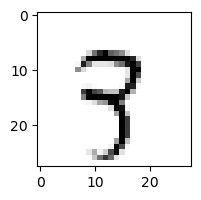

1.2565694130349362e-10% - 0
0.00031193115791563526% - 1
0.025426624948349425% - 2
8.22932814736568e-07% - 3
0.0002687526491048658% - 4
0.0015367989191040806% - 5
1.1057992985177713e-07% - 6
49.10527837755505% - 7 - ОШИБКА
3.6550554318404865e-09% - 8
0.02994346087771992% - 9

 8


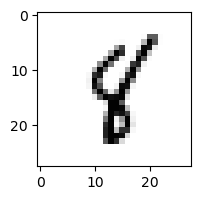

2.1872602727495072e-13% - 0
0.05217550211759728% - 1
4.760624583172568e-11% - 2
1.0817812500800177e-15% - 3
1.487422773050382% - 4 - ОШИБКА
0.35204526599418523% - 5
7.131770747712811e-08% - 6
0.055673113602844715% - 7
8.158091566934452e-10% - 8
5.121242947550893e-07% - 9

 3


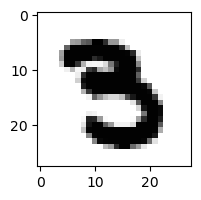

1.4569057759625224e-22% - 0
1.048335561609744e-19% - 1
5.357819228582376e-34% - 2
0.0003773756357029542% - 3
2.1712358785659735e-22% - 4
0.0005301536403575415% - 5 - ОШИБКА
4.049447355043313e-27% - 6
4.5919976347892824e-11% - 7
3.618554137763604e-44% - 8
7.003581729355607e-43% - 9

 5


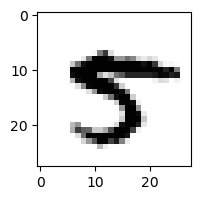

1.6934564573537755e-13% - 0
1.36073186381113e-12% - 1
2.665377211370534e-37% - 2
7.162081684893538e-18% - 3
3.275831283643799e-13% - 4
6.218744708249786e-07% - 5
4.257085684927029e-25% - 6
0.011345449623136829% - 7 - ОШИБКА
3.4331727574579358e-09% - 8
3.648034962959383e-22% - 9

 8


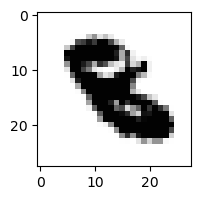

2.636534256154713e-38% - 0
1.50770445608304e-19% - 1
7.653961011329782e-16% - 2
4.5011189121056333e-26% - 3
3.203937905259718e-16% - 4
6.927873415251564e-08% - 5 - ОШИБКА
9.213066621148729e-21% - 6
1.3680076997707593e-15% - 7
3.202820167285455e-52% - 8
6.041295022531522e-35% - 9

 9


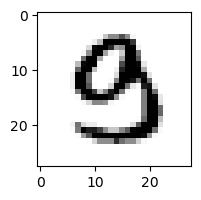

6.2624877694113515e-09% - 0
3.719446503296798e-11% - 1
3.6311228133352757e-14% - 2
0.004282689653151262% - 3
2.454724061134983e-12% - 4
0.03279996902689847% - 5 - ОШИБКА
2.97902381023893e-20% - 6
5.047273618476022e-10% - 7
6.4548324702666815e-31% - 8
1.454001161182665e-27% - 9

 4


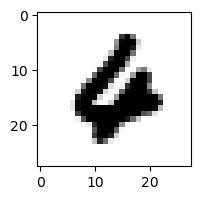

2.9479711810343184e-12% - 0
8.378450207170892e-16% - 1
1.0593095483782201e-16% - 2
1.6383942648688297e-34% - 3
6.333126847575586e-08% - 4
6.01048475974446e-11% - 5
93.8952660100928% - 6 - ОШИБКА
1.9446100021968663e-07% - 7
1.8829111150657354e-36% - 8
2.1433185174204896e-24% - 9

 3


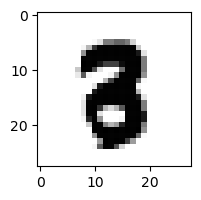

2.9502789767761496e-22% - 0
1.3014510486039541e-14% - 1
4.499662071306126e-16% - 2
2.344394800435324e-18% - 3
9.79201130168253e-21% - 4
2.2963391776060834e-07% - 5 - ОШИБКА
5.3551284946644934e-24% - 6
2.2186748554316858e-10% - 7
1.013904008458243e-19% - 8
4.83305955431749e-30% - 9

 5


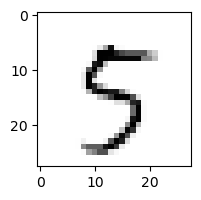

2.491475083639453e-07% - 0
3.4993716102089656e-08% - 1
1.2270982577668893e-11% - 2
0.07341932259460934% - 3
8.72909470324672e-06% - 4
81.52092565115038% - 5
4.088619477621757e-08% - 6
1.7744765355722991% - 7
2.958990650600676e-05% - 8
92.07620563467634% - 9 - ОШИБКА

 0


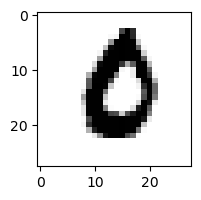

0.00012331634477550594% - 0
2.2441909292767795e-15% - 1
2.1772098936206168e-14% - 2
2.964395379162419e-26% - 3
4.6722905243968925e-21% - 4
3.847525547197279e-06% - 5
0.24171990460374612% - 6 - ОШИБКА
4.742378091925356e-10% - 7
4.259364994127377e-27% - 8
4.874142441102066e-24% - 9

 8


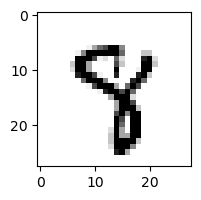

2.0252668218322876e-19% - 0
7.994233990649579e-10% - 1
5.298748511555359e-22% - 2
5.092263531863375e-12% - 3
4.051956860593283e-07% - 4
0.019056086552045326% - 5
2.371028141615804e-13% - 6
0.209107944609892% - 7 - ОШИБКА
5.328083984268103e-06% - 8
5.4877174453298006e-11% - 9

 3


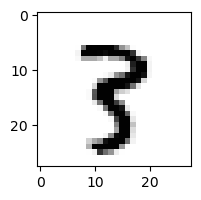

2.5353611717988017e-19% - 0
8.090117276420546e-07% - 1
7.652773422902699e-16% - 2
6.235137150495131e-05% - 3
2.1697509192913588e-09% - 4
0.00016524499952639917% - 5 - ОШИБКА
4.981355212742096e-17% - 6
8.66984198214159e-05% - 7
0.00015019701603646607% - 8
2.179613683450693e-09% - 9

 3


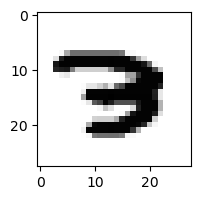

1.651209062119672e-18% - 0
1.3249962132095714e-15% - 1
2.0124235055949784e-14% - 2
1.2063400018809156e-09% - 3
3.718369510864368e-15% - 4
1.9707224050768362e-16% - 5
4.1384821886889444e-11% - 6
9.273560351677968% - 7 - ОШИБКА
5.467985522959331e-38% - 8
5.986362428995808e-31% - 9

 5


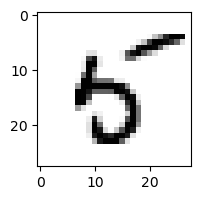

0.00036567898077575556% - 0
5.53581956363058e-07% - 1
1.1379239917628857e-19% - 2
2.1493099095968845e-13% - 3
99.91074047355637% - 4 - ОШИБКА
99.87738965572687% - 5
0.0006721171280670464% - 6
9.7114832839294e-09% - 7
5.0286870074488975e-14% - 8
2.567337089323431e-12% - 9

 5


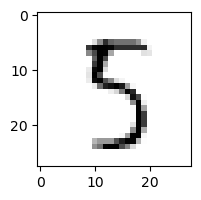

1.1438102508307228e-06% - 0
1.729686419151273e-06% - 1
5.187980593106475e-08% - 2
18.10476296243319% - 3
0.00036677107578611957% - 4
97.50791034391608% - 5
7.296512124059556e-07% - 6
0.0004326779117251288% - 7
99.52706571594372% - 8 - ОШИБКА
4.282677512880363e-12% - 9

 4


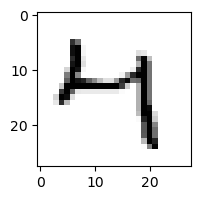

2.4360945812326794e-05% - 0
5.925452026371102e-07% - 1
1.0213721396581965e-18% - 2
30.020981035999238% - 3
99.93650885127353% - 4
0.00023137852717076938% - 5
6.475663251591149e-07% - 6
0.032399725194433356% - 7
3.0575403253395743e-14% - 8
99.95427466163925% - 9 - ОШИБКА

 8


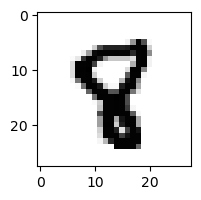

1.5690849255965286e-24% - 0
3.702002426210193e-11% - 1
1.9211877602873342e-22% - 2
2.767448840415506e-30% - 3
5.390139583447023e-09% - 4
0.00940753171703484% - 5 - ОШИБКА
1.8667356658051362e-16% - 6
2.3987348157367423e-06% - 7
5.158601431501644e-15% - 8
3.3632029797792382e-18% - 9

 6


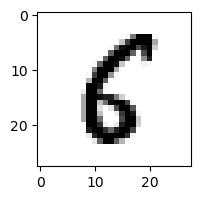

0.006170031819710126% - 0
2.607619543992255e-10% - 1
8.553060764132269e-10% - 2
1.1336816783935611e-25% - 3
1.4103119963574689e-09% - 4
20.151130472283814% - 5 - ОШИБКА
0.0013366656677381717% - 6
6.160073494904502e-11% - 7
3.2022649583018096e-07% - 8
3.257908810942021e-16% - 9

 3


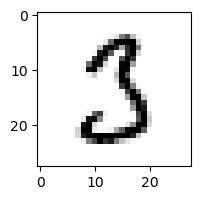

0.005227494433928257% - 0
1.7883831546889494e-05% - 1
0.31892796585429406% - 2
0.2576696990704711% - 3
8.743817756055151e-15% - 4
0.8979997021357122% - 5 - ОШИБКА
7.042760379393586e-13% - 6
0.003407660675784618% - 7
9.96112939951371e-09% - 8
1.746376113619188e-23% - 9

 8


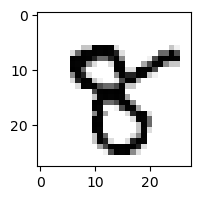

7.067503575544866e-24% - 0
6.111673224440688e-15% - 1
4.666895533599221e-24% - 2
2.1866723958991464e-19% - 3
1.4768788942072578e-15% - 4
0.5132873746278773% - 5 - ОШИБКА
1.7714511143067525e-21% - 6
0.00014189285424684128% - 7
0.009032500994878108% - 8
2.8272029880532508e-15% - 9

 6


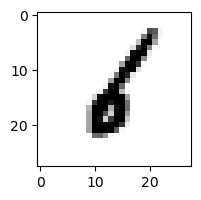

1.3166179102835484e-14% - 0
94.81247656430605% - 1 - ОШИБКА
0.004788889143344062% - 2
1.7088821704575096e-18% - 3
2.9776684182975892e-06% - 4
6.4189528747769145e-06% - 5
0.0007949139188656211% - 6
7.251541026164708e-08% - 7
4.1881667886367694e-11% - 8
3.0975169414952974e-16% - 9

 6


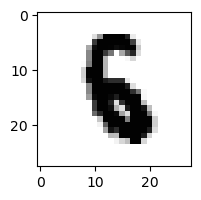

3.1374000724505953e-30% - 0
4.612902939019573e-12% - 1
1.9348413126540522e-10% - 2
3.962569460914556e-28% - 3
1.7494852979189815e-10% - 4
0.11088176488318874% - 5 - ОШИБКА
1.1324954874707765e-05% - 6
1.1889302046458056e-17% - 7
1.3562320178545341e-27% - 8
1.6740754482099097e-29% - 9

 8


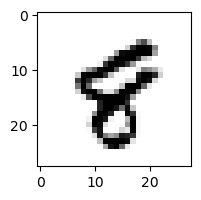

7.881730049619672e-14% - 0
5.1552840240082854e-08% - 1
2.1081226395215023e-24% - 2
1.4771062976871373e-32% - 3
5.481476188864066e-09% - 4
1.7065876317515298e-06% - 5
6.39542061945211e-11% - 6
5.035336068429841e-05% - 7 - ОШИБКА
2.66859298380008e-06% - 8
3.531931289092562e-07% - 9

 0


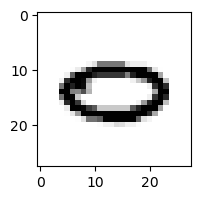

0.2882046268359799% - 0
3.7141576339889223e-07% - 1
1.0525500492004317e-22% - 2
5.006913942687371e-33% - 3
4.578155037453711e-05% - 4
9.10080218337506e-17% - 5
98.09618458035027% - 6 - ОШИБКА
19.050455855107483% - 7
2.9915482254897575e-20% - 8
3.268310970933872e-12% - 9

 9


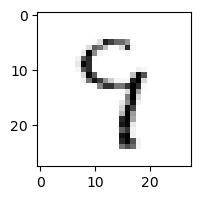

1.4655960943231088e-06% - 0
0.00015263296136750832% - 1
7.618690703422723e-07% - 2
0.021201560970610593% - 3
99.56949971582463% - 4 - ОШИБКА
0.5555876975114605% - 5
1.2229372507436986% - 6
0.11536329659142994% - 7
76.61537470048968% - 8
7.804347848917975e-05% - 9

 0


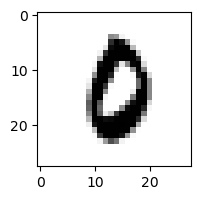

0.0023291520401901643% - 0
1.8808667180584977e-15% - 1
1.084746689476851e-11% - 2
1.6319693081416307e-20% - 3
8.380717423687827e-15% - 4
0.0033034598105456292% - 5
0.017400104889586127% - 6 - ОШИБКА
1.2469321379588586e-05% - 7
2.743223668944287e-21% - 8
2.7218220192425176e-16% - 9

 8


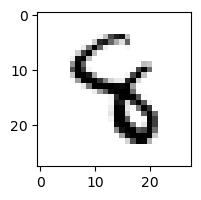

4.4394098146609775e-21% - 0
1.4399155378542173e-07% - 1
4.592384621537462e-13% - 2
1.1722496053643141e-10% - 3
50.24628140660593% - 4 - ОШИБКА
0.0026312066352804815% - 5
3.1665379454299437e-06% - 6
2.0386692291685636e-08% - 7
5.545587814407983e-22% - 8
1.0081293453995182e-20% - 9

 8


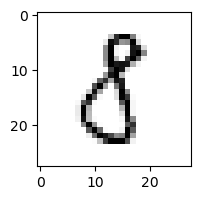

0.006863314848002049% - 0
0.029554283144467938% - 1
8.231470420217839e-07% - 2
0.004266736381994924% - 3
8.522085384519669e-08% - 4
0.09036269901868878% - 5 - ОШИБКА
1.6252553610515933e-10% - 6
1.7577958947184458e-05% - 7
3.4779772785202396e-10% - 8
2.271972103827312e-17% - 9

 8


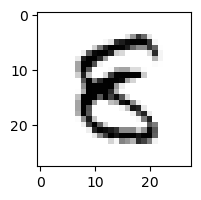

1.2812640430298891e-08% - 0
4.828183023168773e-10% - 1
7.489217116528918e-13% - 2
3.350247391466601e-11% - 3
0.0016818564840147105% - 4
3.9758759346468233% - 5 - ОШИБКА
1.373515202877446e-10% - 6
1.0208565245172267e-14% - 7
5.384920673204174e-18% - 8
4.705737908014764e-26% - 9

 3


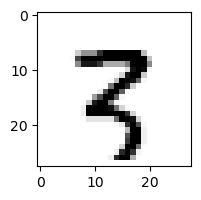

2.73611704060033e-20% - 0
0.00022651354912497687% - 1
0.007026792745452309% - 2
3.423308001657939e-21% - 3
3.108222968575776e-14% - 4
2.3096571682755415e-09% - 5
5.806166319166078e-15% - 6
0.011543972488308294% - 7
0.049597410173602224% - 8
0.20344727659672548% - 9 - ОШИБКА

 7


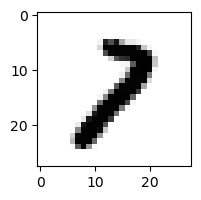

4.756399594584347e-11% - 0
0.007440301802681561% - 1
0.026102887223958662% - 2 - ОШИБКА
4.27984265917594e-11% - 3
3.472289796715512e-16% - 4
8.806933886460908e-11% - 5
9.434187700773479e-17% - 6
0.003967220865771455% - 7
6.366482545763458e-06% - 8
1.96590807291288e-07% - 9

 3


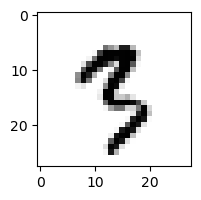

9.421702708218508e-15% - 0
0.0024722405555524947% - 1
1.52205968141537e-17% - 2
6.379178352454105e-07% - 3
1.469806637476127e-13% - 4
2.125226138377064% - 5 - ОШИБКА
1.1464713180248816e-15% - 6
0.0022977530957528857% - 7
7.73877968612114e-13% - 8
6.426126452270792e-05% - 9

 6


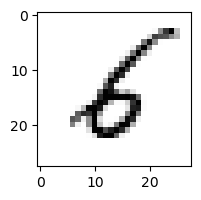

2.556329307530409e-06% - 0
0.4307702645544249% - 1 - ОШИБКА
0.34806661740349304% - 2
4.664282826871608e-05% - 3
5.081640414726804e-06% - 4
0.02641619228739187% - 5
0.347542345825157% - 6
4.73754268004776e-09% - 7
1.3865379673751824e-05% - 8
4.5797745892208493e-14% - 9

 7


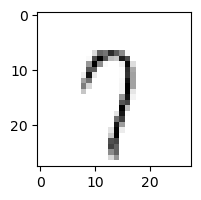

0.0011312310317029112% - 0
0.13942573336085567% - 1
0.053215498058769045% - 2
0.03574168292615595% - 3
2.0801405905109887% - 4
0.47789798157754626% - 5
0.05004300336815433% - 6
99.76855017582035% - 7
90.0354879881244% - 8
99.95372467770572% - 9 - ОШИБКА

 9


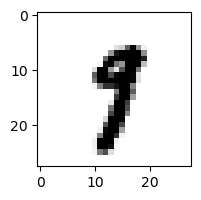

1.3468927900421729e-16% - 0
0.013719723919451327% - 1
1.9433886076224546e-23% - 2
1.4107347480919979e-10% - 3
5.298486471334954e-11% - 4
0.0009950084646572958% - 5
4.499056301118414e-17% - 6
5.184201069159221% - 7 - ОШИБКА
4.203522031194101e-15% - 8
8.716403459444322e-09% - 9

 8


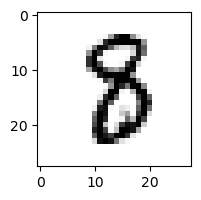

1.5090293888057143e-16% - 0
1.536963590771885e-05% - 1
2.0643075144374366e-14% - 2
3.2538142765567756e-12% - 3
4.364330298650897e-15% - 4
0.36648831497598894% - 5 - ОШИБКА
3.287280003326561e-11% - 6
2.2963153437970156e-07% - 7
8.985088142766563e-12% - 8
6.357086082053125e-37% - 9

 7


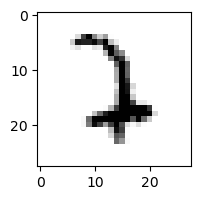

7.177904674005958e-17% - 0
0.1087214572281586% - 1
91.24263307909128% - 2 - ОШИБКА
1.6625319608003892e-06% - 3
1.1850335374318996e-11% - 4
5.648190414820535e-06% - 5
0.08007155303832392% - 6
0.011167696049226348% - 7
2.985559746513325e-24% - 8
7.648314316191002e-18% - 9

 9


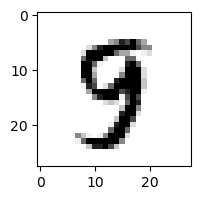

2.063010819098136e-16% - 0
7.539584544778057e-12% - 1
2.4522553206656505e-20% - 2
8.722186421449095e-08% - 3
4.040451800946078e-08% - 4
0.030489905540804118% - 5 - ОШИБКА
3.836040825230149e-18% - 6
8.543064346790896e-05% - 7
1.0100391591609077e-12% - 8
1.3981605808828332e-16% - 9

 9


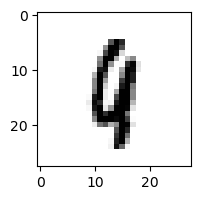

6.254721469961636e-16% - 0
0.0006075930615698233% - 1
2.841379251829533e-08% - 2
2.52703577216093e-24% - 3
0.00031044625680539566% - 4
0.0002143320060599754% - 5
0.00014818034321878998% - 6
0.015982835479832647% - 7 - ОШИБКА
1.9948464879521855e-10% - 8
6.185484557846154e-11% - 9

 8


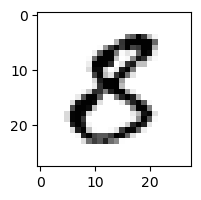

4.060015354411352e-05% - 0
1.830566275016397e-10% - 1
2.3867713788653236e-08% - 2
7.652795395072101e-10% - 3
2.8398642913063467e-12% - 4
8.077400542222128% - 5 - ОШИБКА
6.04907143819609e-20% - 6
3.1912062251285906e-13% - 7
8.318204702233163e-24% - 8
5.765406982147754e-29% - 9

 4


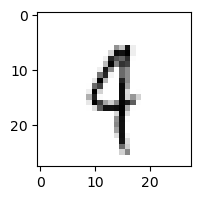

1.6929706236106885e-09% - 0
0.049113542652206015% - 1
0.0022438703446835294% - 2
6.337862600669914e-09% - 3
58.93895627443455% - 4
0.008140936123158376% - 5
0.24343800608922686% - 6
34.84030667924722% - 7
1.3643383429070547e-06% - 8
99.99999596659696% - 9 - ОШИБКА

 9


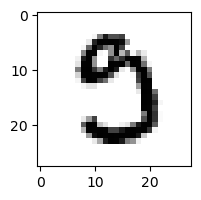

0.02711495336685897% - 0
2.1962858799197934e-13% - 1
1.2490359873775065e-16% - 2
1.8365566923663865e-05% - 3
9.181686874695441e-19% - 4
0.034378827856741706% - 5 - ОШИБКА
2.2479624037438866e-16% - 6
0.0006045338371059103% - 7
5.2879631847030376e-17% - 8
4.458980523214296e-32% - 9

 8


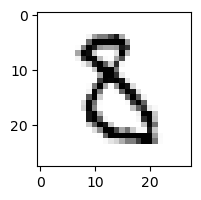

2.7810820912541827e-07% - 0
1.3805162134798431e-09% - 1
0.0031567280963398572% - 2
2.774928089604749e-07% - 3
1.2942400220225018e-10% - 4
0.0679241590396871% - 5 - ОШИБКА
5.384874614463088e-05% - 6
1.0331338581737642e-09% - 7
3.141512317382771e-17% - 8
1.6131204649482821e-23% - 9

 5


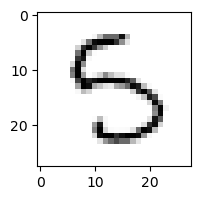

9.046334618322015e-06% - 0
1.3016168998320336e-06% - 1
5.972781660812659e-14% - 2
94.83072731636815% - 3 - ОШИБКА
0.4321851483129452% - 4
46.93074738828122% - 5
0.0006296065546180064% - 6
6.904803907283348e-07% - 7
9.884898880249174e-12% - 8
2.932991144503404e-18% - 9

 2


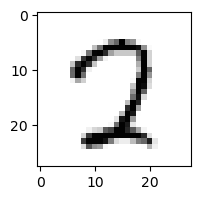

0.010926291892381632% - 0
2.2487491940105753e-11% - 1
2.923598647426027e-07% - 2
0.0009909187829178878% - 3
8.370849762328368e-08% - 4
0.42448377741557736% - 5 - ОШИБКА
4.564734845738561e-13% - 6
0.35927425860194073% - 7
0.04384700484890547% - 8
4.967304065456771e-14% - 9

 5


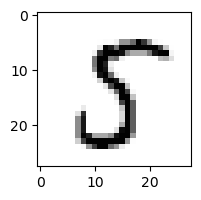

1.118685245601715e-08% - 0
4.099471451726459e-06% - 1
1.4182896638111669e-13% - 2
4.842581642279614e-07% - 3
8.914033235138104e-12% - 4
99.96869732446844% - 5
1.2048425524881663e-14% - 6
1.531978493522207e-06% - 7
99.99958018829027% - 8 - ОШИБКА
6.00361987571817e-19% - 9

 8


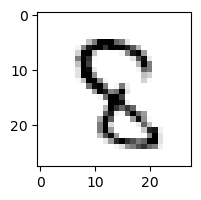

1.2703880893693766e-13% - 0
4.1565115075528715e-10% - 1
1.0975015530763855e-07% - 2
3.7807145159936063e-13% - 3
0.0047905226008329626% - 4
0.23781361701586448% - 5 - ОШИБКА
7.742405322182998e-12% - 6
8.423634043760744e-07% - 7
1.431508497194597e-06% - 8
1.2025549289911394e-13% - 9

 7


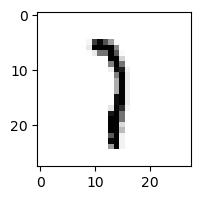

6.752173854377494e-11% - 0
97.26719021633676% - 1 - ОШИБКА
10.44253875245059% - 2
0.012066814896856964% - 3
2.375318542441605e-05% - 4
0.010107436673935124% - 5
0.0004447883911618423% - 6
48.676466872251495% - 7
1.1311984933761181e-07% - 8
2.521460129798771e-07% - 9

 8


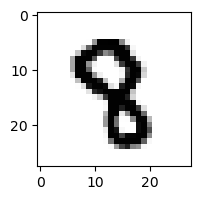

1.1481818925560279e-24% - 0
4.859457750792495e-11% - 1
9.038046245845303e-19% - 2
8.882565649704518e-17% - 3
1.0689686485357971e-07% - 4
0.0001290787153911297% - 5 - ОШИБКА
4.24342564116562e-20% - 6
1.2243655532389851e-05% - 7
7.270434230852013e-26% - 8
2.5056520934752705e-22% - 9

 0


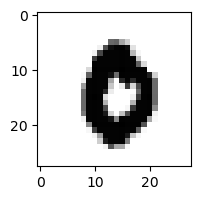

1.3673417469134722e-09% - 0
1.5342015662320825e-17% - 1
7.188236485870234e-25% - 2
8.966693896268798e-26% - 3
7.594817426713128e-19% - 4
4.476881370449148e-08% - 5
7.358221781015264e-07% - 6
1.5507351967959268e-06% - 7 - ОШИБКА
5.044223986077245e-30% - 8
1.8863346724303952e-24% - 9

 9


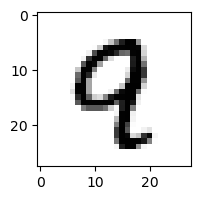

7.204972917122021e-14% - 0
7.133360558476521e-10% - 1
2.496151610313372e-12% - 2
6.077520918736495e-24% - 3
0.02066819027266103% - 4 - ОШИБКА
1.8014945560171331e-06% - 5
3.3742209162960047e-15% - 6
0.00031811589183651767% - 7
1.657974698700223e-13% - 8
1.3985246917077195e-06% - 9

 7


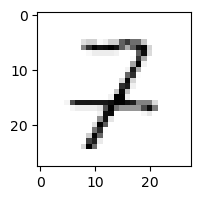

2.151141191185348e-07% - 0
0.034548090030802954% - 1
99.76910157128195% - 2 - ОШИБКА
0.00041212557585458657% - 3
5.717076756682684% - 4
1.9450326225041303e-05% - 5
1.6162464113862697e-05% - 6
0.35157025149102916% - 7
3.731614262692813e-07% - 8
8.119990665040069e-12% - 9

 8


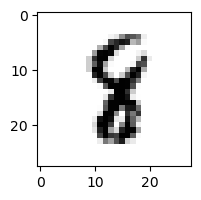

2.2529130209878858e-22% - 0
0.003943144790411314% - 1
2.224577573550878e-15% - 2
4.641034316653011e-17% - 3
6.510471101904711e-08% - 4
0.00837425810453769% - 5 - ОШИБКА
3.692435203479536e-11% - 6
1.6929493711370546e-05% - 7
5.373294420309491e-06% - 8
3.9607584067303973e-25% - 9

 8


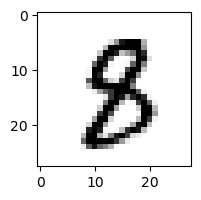

7.302604682043385e-17% - 0
3.1911067281927186e-08% - 1
8.881165550656683e-21% - 2
4.0719146466158585e-11% - 3
2.211820815780758e-11% - 4
0.07209373974603611% - 5 - ОШИБКА
8.657561986199997e-17% - 6
2.1285052848367605e-07% - 7
1.1734291717709588e-12% - 8
2.3790728812142354e-23% - 9

 5


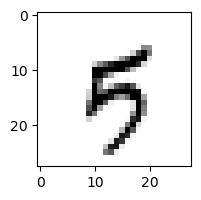

6.8986204901505215e-09% - 0
3.995057345215378e-05% - 1
6.785063344320395e-13% - 2
9.477302398297044e-10% - 3
0.002792953731364375% - 4
0.11742383176094708% - 5
5.54853525388887e-09% - 6
0.22235178007151518% - 7 - ОШИБКА
6.029493470140106e-13% - 8
6.668648617875976e-05% - 9

 3


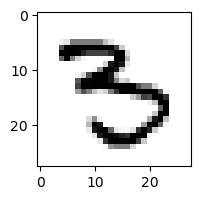

3.180269099023039e-11% - 0
4.260853101349551e-12% - 1
2.0217142899693226e-26% - 2
0.29005250347113437% - 3
4.22682581011664e-09% - 4
0.6313499067397912% - 5 - ОШИБКА
2.1908962130094367e-09% - 6
7.45050928864032e-08% - 7
2.9591563157266743e-21% - 8
5.896018703328158e-19% - 9

 5


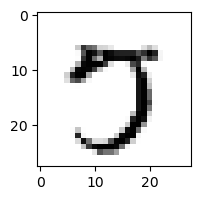

2.3970937610327102e-05% - 0
2.11222953281068e-14% - 1
1.0555133176603009e-16% - 2
0.00013501763136115566% - 3
3.2120832770778946e-13% - 4
32.83012769874423% - 5
3.620534369712031e-16% - 6
99.9555921235486% - 7 - ОШИБКА
2.397715748837841e-11% - 8
4.9196154493593294e-12% - 9

 9


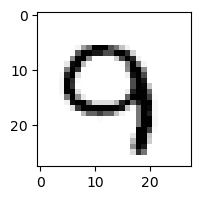

1.5274730929851313e-09% - 0
2.1695540372759085e-11% - 1
0.0005784779386125411% - 2
2.0641688177318678e-19% - 3
0.000144137872829896% - 4
6.7393052431658245e-12% - 5
2.1725406378967953e-10% - 6
5.145509255329631% - 7 - ОШИБКА
7.423117413983419e-23% - 8
2.592544429417236e-07% - 9

 3


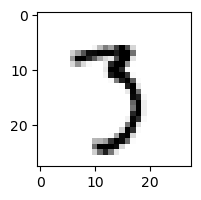

3.6348363489280835e-08% - 0
2.9313918679551074e-06% - 1
4.582259545140608e-11% - 2
99.95770770755611% - 3
1.829605360801416e-14% - 4
0.21813194225815605% - 5
1.2051806703501884e-11% - 6
99.9930144890141% - 7 - ОШИБКА
2.009183189790962e-10% - 8
1.562520591711271e-06% - 9

 8


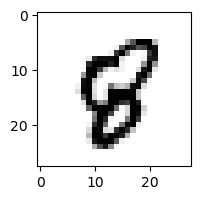

5.279836187806128e-14% - 0
7.088594034823122e-11% - 1
3.547417758623275e-18% - 2
4.8153313309625547e-32% - 3
8.547657030191412e-10% - 4
0.00043705000878117075% - 5 - ОШИБКА
2.8087229586491083e-09% - 6
4.002873166763299e-07% - 7
7.075147049009494e-05% - 8
5.6938404515178624e-15% - 9

 8


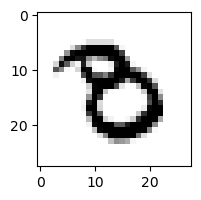

4.095891266496956e-09% - 0
4.2942168753538557e-13% - 1
6.688524347348199e-17% - 2
1.1615110117065475e-05% - 3
7.909608009348079e-17% - 4
6.121270089270958e-07% - 5
0.0007921318521162685% - 6 - ОШИБКА
3.3786040031477075e-09% - 7
2.5152265517332362e-27% - 8
4.47612500583001e-28% - 9

 8


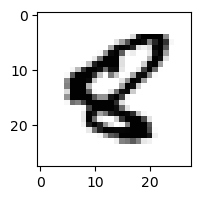

2.6428834518419574e-17% - 0
9.550541349068337e-09% - 1
6.391220100141258e-22% - 2
3.122330421589963e-48% - 3
2.427256506566027e-09% - 4
0.0028333667777895224% - 5 - ОШИБКА
2.1881120070390554e-10% - 6
2.000778180975698e-13% - 7
7.458098661566325e-18% - 8
2.4063026778080863e-23% - 9

 7


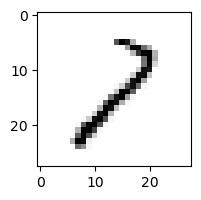

0.000568964837535119% - 0
64.96692731360773% - 1
99.32924698189409% - 2
0.004653817978873057% - 3
0.004948962408835941% - 4
1.8468950651092673e-05% - 5
0.0131594786350402% - 6
0.5810442664009181% - 7
99.99936354142889% - 8 - ОШИБКА
6.298243939788968e-08% - 9

 7


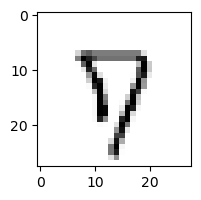

3.740440473202427e-06% - 0
1.4408840569653145e-11% - 1
3.213358448538897e-07% - 2
1.9403981476695445e-12% - 3
0.06260358610532818% - 4
0.004143497832888952% - 5
0.0012835796445149102% - 6
65.18567161569416% - 7
26.670580192468467% - 8
96.42130011691285% - 9 - ОШИБКА

 2


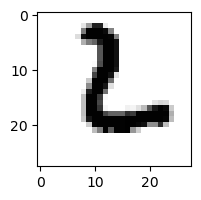

5.21577902546484e-07% - 0
2.4108088110228146e-12% - 1
99.7462955529178% - 2
1.7709924392924447e-18% - 3
8.98934913372598e-22% - 4
0.017102513647074036% - 5
99.99989033876626% - 6 - ОШИБКА
7.11166948504665e-15% - 7
6.972487981231281e-23% - 8
5.097997088235702e-22% - 9

 5


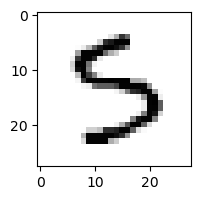

2.748652046051491e-08% - 0
1.432789957442738e-09% - 1
4.689903101055358e-16% - 2
90.66918912442527% - 3 - ОШИБКА
6.5665299613457244e-06% - 4
80.05169558104542% - 5
0.0010827789728297817% - 6
1.5940342755899083e-06% - 7
5.1615568698676735e-09% - 8
2.3909197071082695e-22% - 9

 2


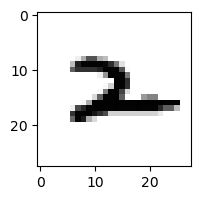

2.209437167839836e-18% - 0
0.0014658930571061453% - 1
0.0072088353569844605% - 2
3.7594912578466884e-21% - 3
0.04671757676398652% - 4 - ОШИБКА
4.12563005394679e-06% - 5
0.00021948623066511713% - 6
0.006235566979514614% - 7
2.3659598782380207e-06% - 8
1.0284086906403974e-12% - 9

 7


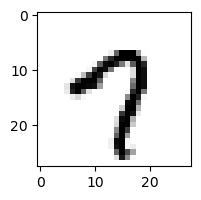

0.00027657039487223627% - 0
4.8323453978457404e-11% - 1
2.13815115459033e-24% - 2
2.1776243990953663e-15% - 3
0.0004419159217448092% - 4
0.13237743505272473% - 5
1.365550307010119e-08% - 6
99.47702020256764% - 7
2.8183202355695535e-16% - 8
99.99992089162613% - 9 - ОШИБКА

 4


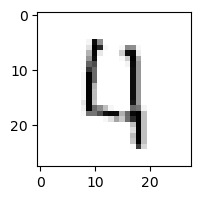

0.01979567728035421% - 0
9.855757743258554e-07% - 1
85.38642045943718% - 2 - ОШИБКА
1.492803332763724e-11% - 3
3.9400363274298797% - 4
0.001581812645924384% - 5
0.1316021104901533% - 6
0.41150316654800284% - 7
3.579786306711973e-08% - 8
0.12142005086296664% - 9

 2


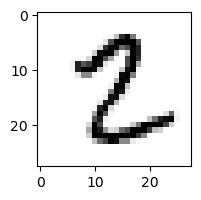

9.068294418898053e-12% - 0
9.454565376767098e-05% - 1
1.6945537030641808% - 2
5.770019697988001e-14% - 3
2.7261450340731634e-16% - 4
2.462106429311708% - 5
5.162191963734159e-18% - 6
1.9144086961004503e-08% - 7
2.4697808893221347% - 8 - ОШИБКА
1.5761813597832187e-22% - 9

 5


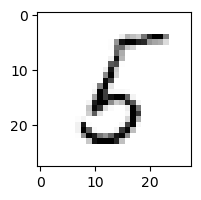

5.077325659150112e-05% - 0
0.15142199199440734% - 1
0.009305243688718354% - 2
0.00025379448208122417% - 3
0.0010695731897602128% - 4
15.418261765975505% - 5
0.5303770509549152% - 6
7.642396098054028e-09% - 7
99.99997345373372% - 8 - ОШИБКА
1.0984863115189288e-11% - 9

 3


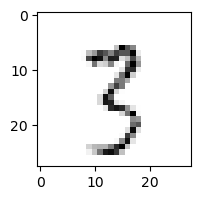

3.380942192437665e-10% - 0
0.05004692718820328% - 1
0.00581960309850064% - 2
14.954376860557018% - 3
3.6142709818247015e-07% - 4
0.1597326182483623% - 5
4.628738089207702e-11% - 6
25.341422502404846% - 7
0.0409847334714804% - 8
99.48748951037672% - 9 - ОШИБКА

 5


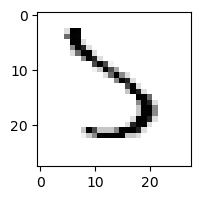

1.768835592372471e-05% - 0
0.00042213713287618987% - 1
0.01804982453287325% - 2
99.99999145570564% - 3 - ОШИБКА
0.0031649663290782867% - 4
0.8401371572570345% - 5
1.6734238372267383% - 6
12.418937840996833% - 7
6.477630032984222e-09% - 8
5.40952473802368e-17% - 9

 8


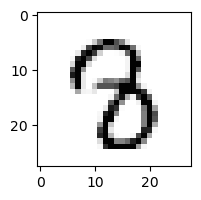

7.652629586967018e-16% - 0
1.6280301631428378e-08% - 1
8.269486895900279e-16% - 2
1.0576468500824347e-08% - 3
1.8509985151417738e-06% - 4
0.020137148956479393% - 5 - ОШИБКА
6.25661895940694e-14% - 6
0.002314649108678853% - 7
6.718135975473258e-16% - 8
2.015338502154165e-23% - 9

 2


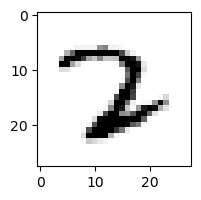

2.757487123483804e-13% - 0
1.1670559871617024e-05% - 1
1.2804748420716876% - 2
1.7326679908215744e-05% - 3
1.2298624800186667e-13% - 4
3.3784270179964867e-07% - 5
6.248176728579216e-06% - 6
95.28157673028245% - 7 - ОШИБКА
1.6103314010755687e-22% - 8
1.5321802733442276e-26% - 9

 5


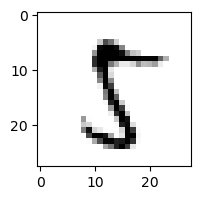

9.471903141845366e-08% - 0
8.467214232863607e-06% - 1
2.8645138690970423e-09% - 2
6.676673795910867e-09% - 3
9.324418431882096e-12% - 4
97.7376410116283% - 5
1.621851458283728e-17% - 6
0.0006458724973250035% - 7
99.99999514598096% - 8 - ОШИБКА
1.564745076877399e-11% - 9

 2


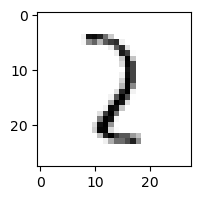

5.3005905481729155e-08% - 0
91.62894348418072% - 1 - ОШИБКА
87.31517570393633% - 2
0.00037165463005811225% - 3
0.003163741468999701% - 4
0.0002891712592522103% - 5
3.77161603501189e-05% - 6
2.6829117272198006% - 7
3.408131513997789e-06% - 8
4.5960394382610396e-08% - 9

 2


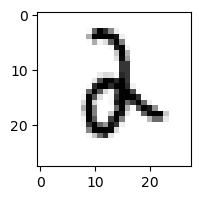

3.061043720152136e-11% - 0
8.272404892264954e-05% - 1
0.005453590253357182% - 2
2.414647240960226e-05% - 3
5.628526084922881e-06% - 4
3.91427356481051e-06% - 5
0.07838008277499454% - 6 - ОШИБКА
5.660995804183614e-09% - 7
1.92847319930526e-25% - 8
1.3043201955129622e-13% - 9

 8


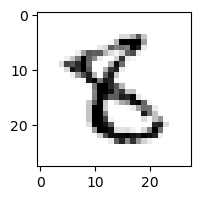

8.460433042586965e-11% - 0
4.8604966220816035e-09% - 1
9.59069375705758e-10% - 2
1.0838315963096705e-17% - 3
1.0404815867439766e-09% - 4
8.82387585454125% - 5 - ОШИБКА
0.0014947362097067736% - 6
1.5719689451446544e-11% - 7
4.3946983274348055e-07% - 8
1.1673455024845382e-20% - 9

 9


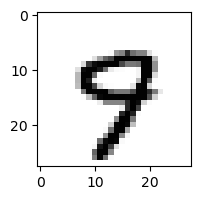

6.295570570416474e-13% - 0
7.217506745736794e-16% - 1
2.0363084677233777e-23% - 2
7.507551819765056e-17% - 3
1.9419852871882755e-05% - 4
0.001300766424052966% - 5
9.627815412921517e-13% - 6
5.745005148487889% - 7 - ОШИБКА
1.1917519798710283e-17% - 8
0.004650953890115363% - 9

 9


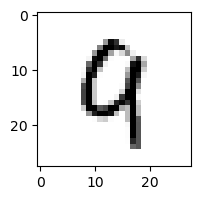

7.7761477909386e-09% - 0
1.865260015320655e-05% - 1
0.006059622351816186% - 2
1.6345693062540235e-20% - 3
5.1772689934397675% - 4 - ОШИБКА
7.338043952214454e-07% - 5
2.0916749690020378e-07% - 6
0.07858378922979607% - 7
1.1148975707810526e-07% - 8
0.0022696205812979347% - 9

 2


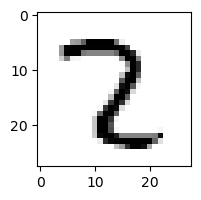

5.2445406134282125e-16% - 0
0.0011486636469739023% - 1
0.0031505070069502736% - 2
6.158965073860827e-07% - 3
1.2905775129222662e-10% - 4
9.310930554221786e-08% - 5
2.8883918946948663e-16% - 6
0.012038519426961778% - 7 - ОШИБКА
6.5819180301677684e-09% - 8
2.8955293636136185e-18% - 9

 8


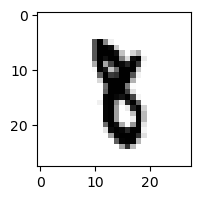

7.871863632087698e-27% - 0
8.505571854050299% - 1 - ОШИБКА
2.6783538701204567e-17% - 2
3.338015191357044e-09% - 3
4.014508741923006e-13% - 4
0.0005293157630837014% - 5
2.049750144395467e-17% - 6
0.0021714585548253226% - 7
3.221588317096125e-23% - 8
5.088327043641091e-22% - 9

 9


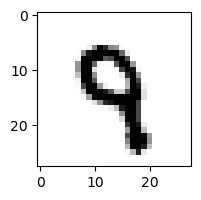

5.825120771493848e-19% - 0
9.412397083063126e-11% - 1
1.9388699092051626e-13% - 2
1.4518720559572057e-12% - 3
0.03863111532501803% - 4 - ОШИБКА
0.0036077000446290506% - 5
7.831496634505458e-13% - 6
0.005931117844202904% - 7
2.0359903209291274e-23% - 8
0.004604669738422274% - 9

 4


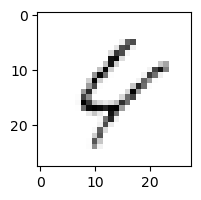

0.7655970105652222% - 0
0.0013336646893231416% - 1
0.9559039302462772% - 2
5.659825152989108e-18% - 3
81.58486609486243% - 4
4.667487345885611e-06% - 5
56.27509043720649% - 6
0.2197826514471228% - 7
98.67469408994961% - 8
99.99998554176872% - 9 - ОШИБКА

 8


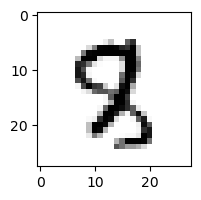

3.076595408127433e-17% - 0
9.664827851951343e-08% - 1
1.5137799094718155e-10% - 2
6.988254061548816e-17% - 3
1.797462406374914e-09% - 4
0.0011101317651010495% - 5
7.263155608288709e-16% - 6
0.0071812796132131014% - 7 - ОШИБКА
1.351638068507919e-19% - 8
3.5986978635075607e-13% - 9

 6


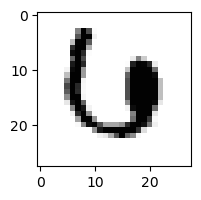

0.0028552253371445803% - 0
2.6062227521589698e-15% - 1
7.014055053470664e-15% - 2
1.3242835400436912e-06% - 3
0.0015960348424066142% - 4
1.0580401062298581e-14% - 5
0.00011760540832970941% - 6
3.9885441898672216% - 7 - ОШИБКА
6.02802000203114e-30% - 8
1.935653069906435e-26% - 9

 4


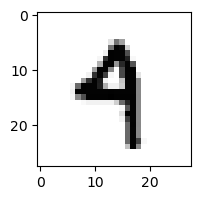

5.719841730312764e-13% - 0
1.4854459520627353e-06% - 1
4.446818563451359e-18% - 2
2.731544652381671e-07% - 3
13.51327287495099% - 4
0.028961684349080637% - 5
2.7115855409505866e-09% - 6
0.0004200324507489743% - 7
3.3027525929608963e-24% - 8
99.93954641423322% - 9 - ОШИБКА

 3


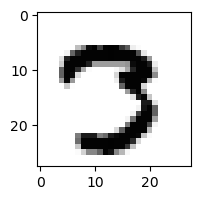

3.373206851590036e-14% - 0
2.136981896720009e-17% - 1
1.4231758294250699e-22% - 2
99.45666890376393% - 3
2.660789999419933e-25% - 4
1.3149953391999715e-08% - 5
1.4029506242375198e-30% - 6
99.99179277410958% - 7 - ОШИБКА
1.0468924265295191e-18% - 8
4.9691703094840174e-24% - 9

 8


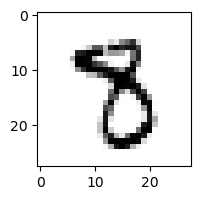

1.76005254023434e-19% - 0
2.3096107672899013e-07% - 1
2.282738471055907e-18% - 2
4.7912241583651674e-11% - 3
1.895063605753812e-11% - 4
0.480257000120327% - 5
3.414194717960495e-19% - 6
1.137004069415205% - 7 - ОШИБКА
2.7368041626062993e-11% - 8
1.8224467950585719e-25% - 9

 5


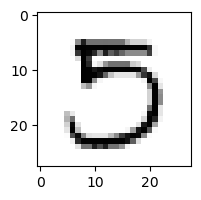

0.10449100271209154% - 0
1.4271059685897708e-12% - 1
4.281190804920807e-15% - 2
3.1865235540559333% - 3 - ОШИБКА
1.3791401971883715e-15% - 4
0.00017930555513570487% - 5
3.893692271427769e-20% - 6
0.01844354541134582% - 7
1.1353896441061117e-11% - 8
6.545578588239331e-25% - 9

 0


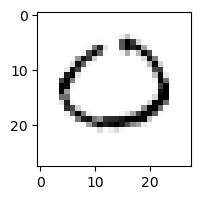

97.52710087572149% - 0
3.229914976576377e-07% - 1
12.300198543233485% - 2
5.3618499425711616e-05% - 3
1.190260830039498e-12% - 4
0.00022099325385892388% - 5
99.44840292749839% - 6 - ОШИБКА
0.03416511788269751% - 7
1.317204250005322e-09% - 8
1.097489373048223e-24% - 9

 3


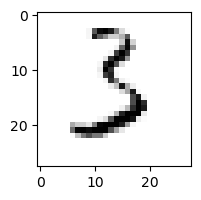

7.239890358424784e-05% - 0
1.901311812276769e-05% - 1
1.2708867522109752% - 2
2.889169642738012% - 3
5.810544249789601e-14% - 4
0.38977008132493335% - 5
15.401745285593984% - 6 - ОШИБКА
0.06438705904903164% - 7
3.610588632842068e-15% - 8
4.888796886506086e-09% - 9

 7


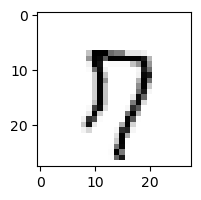

0.1676228788945105% - 0
1.37209432166314e-10% - 1
0.0023920228425547657% - 2
4.361697739115789e-09% - 3
1.0732368377687007e-05% - 4
0.007386330389390906% - 5
0.0005655490648051073% - 6
34.57944916680104% - 7
99.97102133887171% - 8 - ОШИБКА
99.83329619824617% - 9

 8


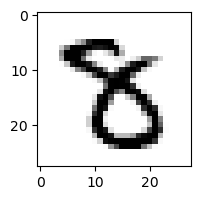

3.819837943574426e-21% - 0
1.4054661722786144e-11% - 1
4.053454665338046e-16% - 2
2.914282586587698e-07% - 3
5.48715638082796e-14% - 4
2.5007986146932193e-05% - 5 - ОШИБКА
6.477337664374054e-25% - 6
1.5840129814703113e-09% - 7
3.37689612731785e-09% - 8
1.6634487508866333e-29% - 9

 7


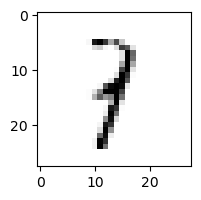

1.993068957318639e-09% - 0
98.72618974282557% - 1 - ОШИБКА
0.31307081905909684% - 2
83.22674603528021% - 3
0.03216080419912165% - 4
0.023965466855607447% - 5
1.9733049683769477e-05% - 6
3.419648713837874e-05% - 7
5.254123086756414e-05% - 8
0.004041240727148083% - 9

 8


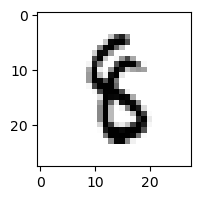

5.025028804348588e-17% - 0
0.00650394392383056% - 1
2.376147450652224e-14% - 2
6.96432950277471e-09% - 3
3.478068304105303e-09% - 4
0.09887891396105788% - 5 - ОШИБКА
1.704362353970236e-08% - 6
4.8346151498429676e-08% - 7
4.914931050469392e-14% - 8
2.214755916470343e-26% - 9

 9


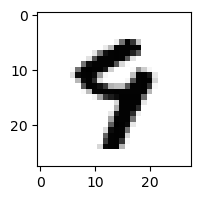

2.905467198667003e-17% - 0
2.7017020682061044e-15% - 1
5.654557501218788e-23% - 2
1.7066032088638035e-26% - 3
4.2102668758128743e-07% - 4
0.00877652603275273% - 5 - ОШИБКА
1.1581632294675178e-09% - 6
0.004882486417505698% - 7
1.4002601401901219e-11% - 8
0.006894999967541959% - 9

 2


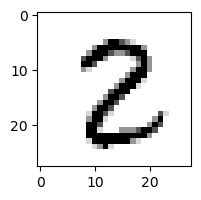

7.122624006627682e-11% - 0
4.410873233496215e-06% - 1
0.23506843416625853% - 2
2.1264048919913824e-09% - 3
3.2520573260413693e-16% - 4
6.160743452587209e-05% - 5
3.4304731421041436e-18% - 6
4.836035133847999e-07% - 7
99.99999995324946% - 8 - ОШИБКА
8.765340994275068e-19% - 9

 7


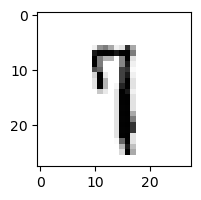

1.1176749384147595e-11% - 0
0.005354387089664016% - 1
1.9435863033380708e-05% - 2
0.0009587486213351276% - 3
0.008098684159419079% - 4
0.4356667203711868% - 5
2.5216652834084704e-05% - 6
68.99299538668573% - 7
3.0664078707345384e-06% - 8
96.28571002763108% - 9 - ОШИБКА

 8


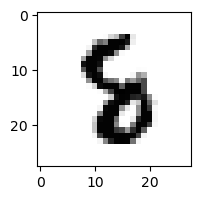

4.631322796069174e-25% - 0
1.91188628314148e-08% - 1
1.0666136766149374e-15% - 2
3.5471067720999033e-22% - 3
8.051596764647974e-09% - 4
0.5026328531754338% - 5 - ОШИБКА
5.57776893302207e-06% - 6
3.832450638732282e-09% - 7
9.01088354349374e-16% - 8
1.1320929834307328e-32% - 9

 8


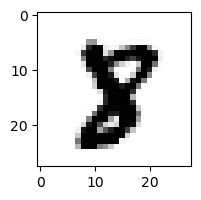

1.1480884253307733e-23% - 0
1.9075120850921035e-13% - 1
5.129954511878661e-25% - 2
8.029298641628736e-26% - 3
2.8280070951233394e-20% - 4
0.0003049465867301281% - 5 - ОШИБКА
1.6113776076451502e-21% - 6
6.148974759394629e-07% - 7
0.00011916798972614499% - 8
2.4729195181793578e-29% - 9

 5


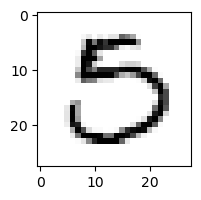

33.97535298798135% - 0 - ОШИБКА
6.381089251005763e-12% - 1
6.999074182991756e-08% - 2
1.6947785388289464e-05% - 3
2.4473214873532673e-14% - 4
3.4812253164411826e-07% - 5
1.951528965046774e-15% - 6
4.019884040988428e-06% - 7
7.370736014851112e-08% - 8
2.2752328621403458e-36% - 9

 1


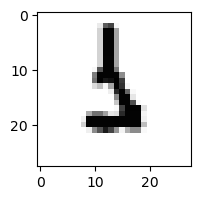

5.111891779276762e-15% - 0
0.001378288579128567% - 1
5.214870706709056e-10% - 2
1.6234595236485546e-10% - 3
5.553290135083684e-16% - 4
0.35920401372374644% - 5
98.24273834949348% - 6 - ОШИБКА
1.2147515911054252e-06% - 7
2.3170749573546333e-13% - 8
1.8952347514253792e-19% - 9

 8


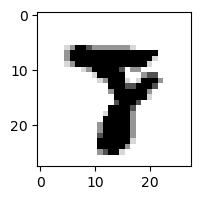

1.9024813153214957e-28% - 0
1.5096185543120791e-15% - 1
4.233602520232381e-31% - 2
2.4522935804480046e-26% - 3
1.386965415453051e-22% - 4
4.0924195954619925e-08% - 5
1.3959436497050378e-28% - 6
96.60596927718282% - 7 - ОШИБКА
4.078835444095268e-26% - 8
4.13490500081605e-33% - 9

 9


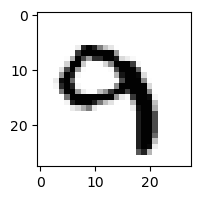

4.268136760161912e-16% - 0
3.1923604755951083e-10% - 1
1.1381278272439443e-09% - 2
1.830246707991672e-05% - 3
3.3182340334964184e-06% - 4
3.212356840418983e-08% - 5
4.9084546096434945e-14% - 6
0.06608910602145679% - 7 - ОШИБКА
7.661722435706906e-38% - 8
3.6252594466244083e-11% - 9

 4


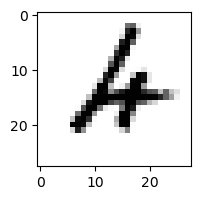

1.9926913261184496e-13% - 0
7.253891136690177e-09% - 1
0.0036447795528359622% - 2
1.3706554791871568e-11% - 3
1.8536028886235296e-05% - 4
1.0026961552566845e-07% - 5
70.17755301405627% - 6 - ОШИБКА
3.9736119292342226e-08% - 7
1.035211220045582e-13% - 8
9.288894422372702e-08% - 9

 9


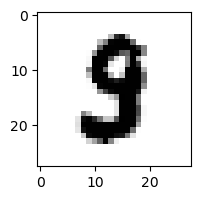

3.196678010798817e-15% - 0
9.997030429517048e-12% - 1
5.679271386619403e-17% - 2
1.8256367976155517e-13% - 3
1.6501218798648758e-19% - 4
0.04051972782730329% - 5 - ОШИБКА
2.46418997326583e-16% - 6
4.820334985963013e-09% - 7
9.4684716552723e-16% - 8
5.763195771431856e-29% - 9

 9


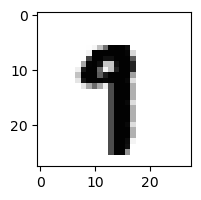

3.2195083085261843e-27% - 0
1.0482162043408431e-05% - 1
9.654488440823774e-32% - 2
1.8904770183272956e-23% - 3
7.038987561115878e-15% - 4
0.0459197002443319% - 5
3.825860561828159e-18% - 6
1.325368052406551% - 7 - ОШИБКА
4.180093699662725e-20% - 8
3.4437499282473076e-12% - 9

 8


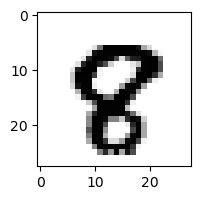

9.85992007071458e-19% - 0
1.1003727458734289e-17% - 1
3.394615151790241e-24% - 2
1.330904551171432e-40% - 3
5.83880342990367e-20% - 4
4.289207566174389e-07% - 5
2.5166674478124144e-21% - 6
1.0669095157653822e-05% - 7 - ОШИБКА
1.1655674411013234e-06% - 8
3.9470262830267245e-10% - 9

 0


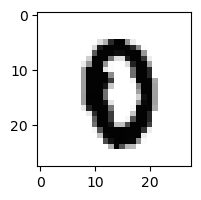

2.0408292123309117e-06% - 0
7.781448391131509e-18% - 1
1.8129794060616607e-20% - 2
1.7509023166729622e-24% - 3
6.04654462467651e-13% - 4
0.00017346005927269576% - 5 - ОШИБКА
1.890030878020465e-08% - 6
1.461619379729099e-09% - 7
1.105369691509969e-16% - 8
2.214652660241431e-21% - 9

 9


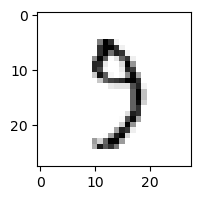

0.000169791672998048% - 0
8.431524982290654e-06% - 1
2.9435313873020824e-08% - 2
99.39089479783462% - 3 - ОШИБКА
2.0224765295376076e-06% - 4
1.1403945416020518% - 5
4.3215409540603196e-08% - 6
62.09744141065703% - 7
0.3519292527468881% - 8
0.002775499731361715% - 9

 8


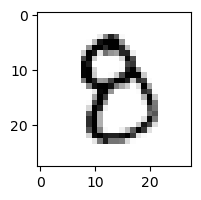

0.00013541074459487315% - 0
4.4460965538850844e-09% - 1
3.198861834514251e-09% - 2
0.00021287438955639462% - 3
8.31554383625677e-10% - 4
0.028416940752909552% - 5 - ОШИБКА
1.8532135151785518e-09% - 6
6.578546898220508e-11% - 7
0.002108680406137923% - 8
1.3712122930438471e-12% - 9

 8


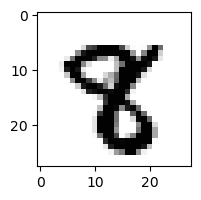

1.2047124667156751e-29% - 0
4.5056371839797566e-12% - 1
1.1598532563529033e-30% - 2
3.9407931185041103e-23% - 3
3.705984219133016e-18% - 4
3.565531055103067e-05% - 5
4.1327851025287055e-31% - 6
5.3366755739864484e-05% - 7 - ОШИБКА
1.1486616563072176e-28% - 8
9.704813179649297e-27% - 9

 8


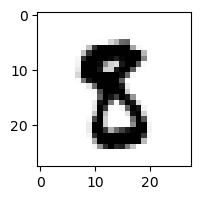

1.4873742413674662e-20% - 0
9.867123290539777e-12% - 1
6.219503171384509e-31% - 2
1.1755209459174956e-17% - 3
2.396356272995493e-20% - 4
12.932124334710583% - 5 - ОШИБКА
1.1027044182545964e-24% - 6
1.8677755506342728e-09% - 7
1.7322888138479967e-07% - 8
1.0787888686679868e-25% - 9

 0


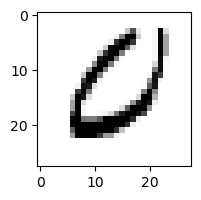

3.3797615732239232% - 0
1.776292568892112e-14% - 1
2.2237461987209437e-07% - 2
3.9813586126978255e-23% - 3
3.009705080903548e-12% - 4
21.566210162706223% - 5 - ОШИБКА
0.012009035285258249% - 6
7.533407169933448e-07% - 7
4.3330398625976693e-26% - 8
6.403259380309836e-31% - 9

 4


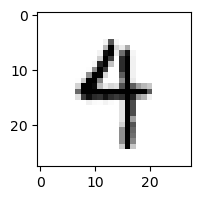

1.641654711970123e-12% - 0
3.948557000048532e-06% - 1
3.6656330425115464e-16% - 2
8.501986741251698e-08% - 3
98.99959884665275% - 4
1.926573908867039% - 5
4.911464369068895e-06% - 6
0.0021174429551029366% - 7
6.3558293553594135e-21% - 8
99.9857414501916% - 9 - ОШИБКА

 7


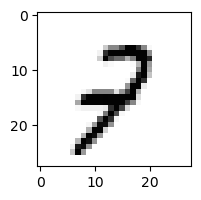

4.1909637145310275e-06% - 0
0.00019665976897242652% - 1
2.1746343275027074% - 2
1.2070899153005627e-07% - 3
5.1290076087135424e-05% - 4
2.325827385452581e-06% - 5
2.1593303472205133e-08% - 6
0.03334290692894829% - 7
1.5240504238859097e-12% - 8
99.96980946938363% - 9 - ОШИБКА

 6


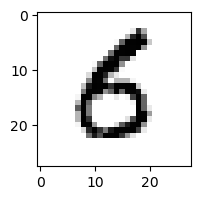

4.7654610595266556e-05% - 0
3.398471481186944e-11% - 1
1.0924798462558987e-13% - 2
8.858889584874803e-12% - 3
2.82427918441193e-10% - 4
1.7324014414352988% - 5 - ОШИБКА
0.42142860051727227% - 6
8.03589312344385e-11% - 7
7.414130347960368e-24% - 8
5.344618171859717e-13% - 9

 3


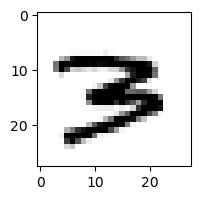

5.672091265837259e-19% - 0
6.057536725253312e-10% - 1
2.5179639904257534e-11% - 2
0.14890905298180704% - 3
1.1675437986746347e-11% - 4
5.594595840653896e-12% - 5
2.629920862648576e-13% - 6
59.70523959929077% - 7 - ОШИБКА
8.012472047550329e-36% - 8
5.31451902553266e-27% - 9

 2


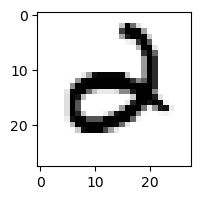

1.2322899122171304e-10% - 0
3.8835748351794834e-14% - 1
1.153899986006303e-28% - 2
4.771750372855586e-18% - 3
0.0009836334363309157% - 4
2.6428968757003282e-05% - 5
1.505085200702262% - 6 - ОШИБКА
3.5353740917367002e-09% - 7
3.497488751420043e-39% - 8
2.1086782492485944e-27% - 9

 8


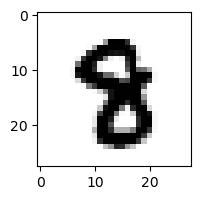

3.189618579593425e-26% - 0
7.180500283429588e-14% - 1
1.4159179871574308e-31% - 2
1.0984570214321503e-24% - 3
1.352200638678485e-13% - 4
3.6613487217397507e-06% - 5 - ОШИБКА
9.687611388332515e-20% - 6
2.375998102451179e-08% - 7
1.7348622469578282e-16% - 8
6.027702598757687e-27% - 9

 0


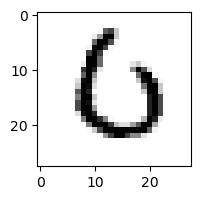

99.89551948129402% - 0
1.1606183410253391e-11% - 1
0.40427762474881934% - 2
1.7452966263919947e-11% - 3
9.288432856438655e-06% - 4
1.1711232529054774e-07% - 5
99.99961708184979% - 6 - ОШИБКА
1.0684579750003572e-07% - 7
1.6779649800218139e-18% - 8
5.4453999953769504e-21% - 9

 4


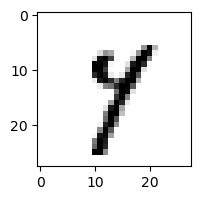

5.5337957239767686e-14% - 0
0.29350073279057587% - 1
5.056466768620799e-16% - 2
1.901197677391723e-11% - 3
0.004783632488857414% - 4
0.025107975583631804% - 5
5.996498017869876e-12% - 6
48.23199755714234% - 7 - ОШИБКА
0.5149111818160514% - 8
9.602354015571608e-09% - 9

 9


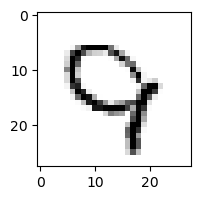

1.8160885465758886e-07% - 0
6.667330046003061e-07% - 1
3.3714402103270605e-05% - 2
2.048449062114912e-13% - 3
23.273546538997955% - 4 - ОШИБКА
2.904356849094075e-05% - 5
0.00823841033702107% - 6
2.2308215501679287% - 7
2.3349551543295718e-20% - 8
2.0212184467318645e-07% - 9

 2


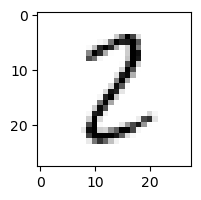

0.00012246477150288317% - 0
1.4232420031469568% - 1
88.68826145836297% - 2
0.5639508873117637% - 3
1.7584943152808702e-10% - 4
0.1905680106970734% - 5
2.854901968615441e-09% - 6
2.0865364099542585e-06% - 7
98.40325470345488% - 8 - ОШИБКА
1.372909794755689e-18% - 9

 9


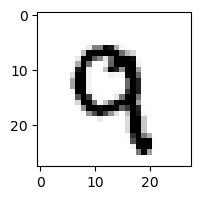

1.8983141319029587e-13% - 0
8.511642299496192e-08% - 1
7.309772129243046e-10% - 2
8.448411326607586e-25% - 3
1.7187613742276376e-06% - 4
1.8856875610132117e-08% - 5
1.5192664597252418e-11% - 6
1.0727037969222641% - 7 - ОШИБКА
3.022400603686922e-23% - 8
0.5958853637068944% - 9

 7


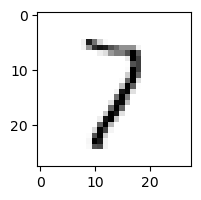

0.00012664947668533327% - 0
5.080298431274944% - 1
98.99382911353148% - 2 - ОШИБКА
3.7325183409092135% - 3
0.0042993494672221326% - 4
0.003144219873559811% - 5
3.253353876329812e-05% - 6
79.80886574978965% - 7
0.14926569517075888% - 8
0.08349555654976565% - 9

 5


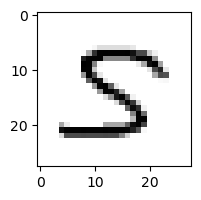

0.00010593086862479764% - 0
4.3496965841916446e-10% - 1
2.170964551646955e-10% - 2
6.59588478635834% - 3 - ОШИБКА
4.753114906824163e-10% - 4
2.3450181390096274% - 5
4.729418032730012e-12% - 6
0.0004993432035641163% - 7
1.736844125003447e-05% - 8
5.868118147126726e-11% - 9

 2


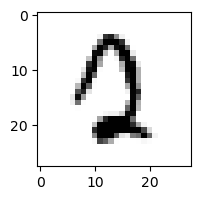

0.00021303462772897066% - 0
1.7217279904403677e-09% - 1
3.5041593386912555e-06% - 2
3.386085986492192e-09% - 3
6.592658123372408e-10% - 4
0.16748801022957935% - 5 - ОШИБКА
8.387060132079902e-08% - 6
0.001607642077954722% - 7
2.0049418050982688e-23% - 8
4.520097905227485e-19% - 9

 3


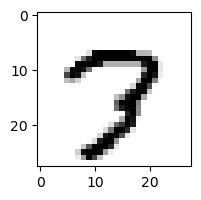

2.614119597964661e-10% - 0
1.5134507399939424e-15% - 1
1.5032674852442494e-16% - 2
2.5237156395477482e-11% - 3
1.1707571916933114e-13% - 4
1.2049351993994833e-05% - 5
5.0690520772046824e-17% - 6
99.98529083421934% - 7 - ОШИБКА
3.548050800797834e-06% - 8
1.0626271883431927e-05% - 9

 8


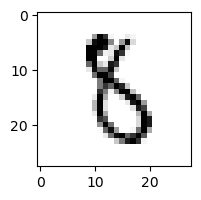

1.2338752816558232e-11% - 0
3.0357053774268427e-06% - 1
0.0001259930573785398% - 2
4.745284853999242e-05% - 3
8.993874175774142e-09% - 4
1.4153305631636461% - 5 - ОШИБКА
0.0032207982679020746% - 6
3.209085504010706e-07% - 7
5.385226511226426e-07% - 8
1.3715837333545615e-13% - 9

 8


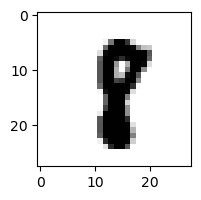

4.3472590286470523e-23% - 0
0.002254006717142412% - 1 - ОШИБКА
2.561505497264493e-22% - 2
2.198828753082997e-18% - 3
1.8678285754207984e-16% - 4
0.0008838869182188279% - 5
1.5136996036835847e-20% - 6
1.4203005154196181e-05% - 7
2.7790625038975724e-11% - 8
6.761365015880949e-23% - 9

 8


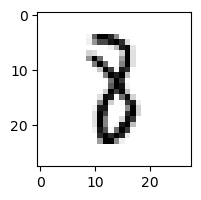

3.9900957387644724e-13% - 0
0.8020552589279812% - 1 - ОШИБКА
8.22828715400236e-05% - 2
4.368036939838287e-05% - 3
4.8238495155933974e-12% - 4
0.0384551317504313% - 5
5.626648761128029e-07% - 6
1.8902851361007434e-06% - 7
0.049291104235215204% - 8
4.488079711464776e-14% - 9

 9


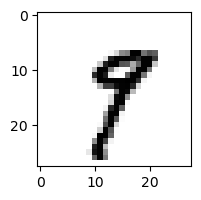

3.253276773806945e-14% - 0
0.01971816421746017% - 1
4.0528471214509646e-20% - 2
4.926979443068165e-09% - 3
1.5202708022721673e-07% - 4
0.00010336454925817161% - 5
4.794456951356158e-15% - 6
38.203120507678406% - 7 - ОШИБКА
0.00018965062938955605% - 8
0.001089021803764988% - 9

 2


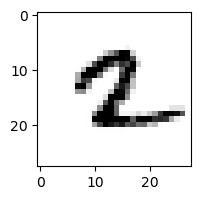

6.201654323755622e-18% - 0
0.08357440316209887% - 1 - ОШИБКА
2.7058253714394226e-08% - 2
5.007513041106174e-25% - 3
6.826971825533962e-14% - 4
0.0004395408069502869% - 5
0.00021778075567081094% - 6
0.0015608853146442093% - 7
1.188288125572808e-16% - 8
0.00022575570845883325% - 9

 8


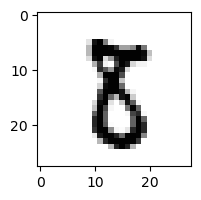

4.927666380969191e-15% - 0
3.137856600276211e-05% - 1
1.1002334852426912e-12% - 2
1.0511226380828616e-06% - 3
2.8802761940748886e-20% - 4
0.5749155117927625% - 5 - ОШИБКА
1.970842858459851e-16% - 6
2.06893515923887e-09% - 7
0.00016699055411110482% - 8
4.064628345675001e-18% - 9

 9


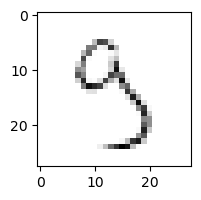

0.0005862811890547875% - 0
0.0234516579406671% - 1
5.020194663465003e-07% - 2
99.9957584749498% - 3 - ОШИБКА
55.0355262757817% - 4
23.1173587565981% - 5
0.1571643090994918% - 6
6.402367994343767% - 7
0.00011302379287248509% - 8
1.254186408886175% - 9

 7


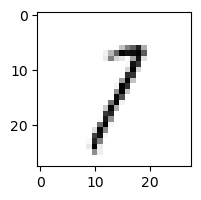

0.0020464083392253657% - 0
38.13921972838833% - 1
31.79401851317446% - 2
44.578926892978856% - 3
0.01628541886462377% - 4
0.012842674018942037% - 5
0.000603441578749785% - 6
91.73817118885833% - 7
7.242904933111739% - 8
99.99694003520055% - 9 - ОШИБКА

 8


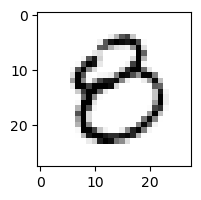

99.99530645849094% - 0 - ОШИБКА
1.606665376907114e-09% - 1
3.6226606223925406e-13% - 2
2.4117530591488924e-05% - 3
0.00013108039005871853% - 4
1.2753432177070953e-06% - 5
9.667365648382342e-12% - 6
2.579725688896359e-10% - 7
4.64165151482895e-13% - 8
1.2200109754638567e-23% - 9

 2


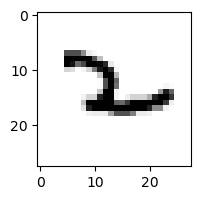

1.6556099456251278e-12% - 0
5.3895104726680546e-05% - 1
0.0004233568475045942% - 2
4.2034477609390546e-12% - 3
99.97320327014889% - 4 - ОШИБКА
4.114673306053239e-05% - 5
35.95966147120356% - 6
0.29626188090426886% - 7
0.05300010679980532% - 8
5.762103611965439e-10% - 9

 3


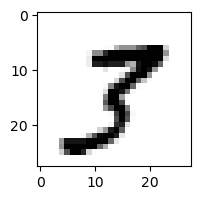

9.65630058166525e-16% - 0
2.583977126282799e-05% - 1
5.082044424357838e-16% - 2
3.5163751449523365e-06% - 3
2.4712539721211468e-12% - 4
3.7724349578679053e-05% - 5
1.963415525847611e-26% - 6
94.31833000681881% - 7 - ОШИБКА
2.5853777607447666e-05% - 8
6.085515751196712e-11% - 9

 3


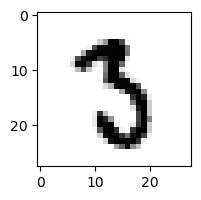

3.6733260581579925e-13% - 0
1.9447089982960805e-07% - 1
1.9886143774680646e-14% - 2
0.06909684527634674% - 3
9.950929755004938e-18% - 4
0.31266446539603926% - 5 - ОШИБКА
4.707098876266633e-10% - 6
0.03833837400206703% - 7
2.2077879170633553e-16% - 8
6.834045488414471e-23% - 9

 9


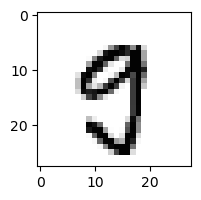

2.2258428714115257e-05% - 0
5.974573487022765e-12% - 1
1.0165206632014582e-22% - 2
1.7439040119494234e-07% - 3
2.0075296750348065e-12% - 4
1.3453117734504396% - 5 - ОШИБКА
3.057672204473345e-19% - 6
0.000626314468636143% - 7
9.062349082216988e-13% - 8
0.0788022962370936% - 9

 5


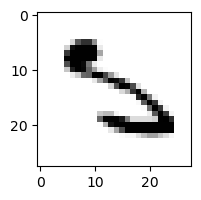

1.0241431976404081e-15% - 0
2.93636430186503e-10% - 1
2.618000064749763% - 2 - ОШИБКА
4.0358865567080076e-05% - 3
2.263668496066974e-07% - 4
0.3201043969125132% - 5
1.2317621999634918% - 6
2.9416960658047557e-05% - 7
2.8837127333953454e-17% - 8
1.5805384049255533e-24% - 9

 8


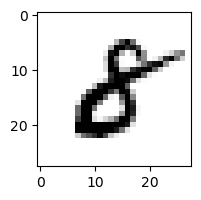

8.718334295332386e-08% - 0
2.3881273575197226e-08% - 1
3.5653715512294413e-06% - 2
2.352485035123108e-08% - 3
1.0302118506294703e-13% - 4
0.0015186617102376885% - 5 - ОШИБКА
1.5003710870942712e-12% - 6
4.729524666692163e-11% - 7
2.03051502765833e-13% - 8
2.318009629590044e-18% - 9

 4


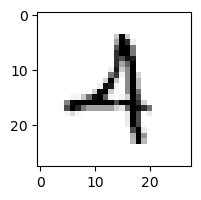

1.4363765781564164e-06% - 0
0.0002479571872948681% - 1
86.32599694531444% - 2 - ОШИБКА
0.09262724841002024% - 3
0.034361908977147027% - 4
1.031759321832982e-06% - 5
1.5580213096212067e-07% - 6
5.577705363270167e-07% - 7
1.2587972393485358e-17% - 8
0.001995039554253857% - 9

 7


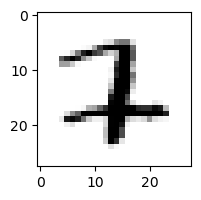

1.0091802273433283e-21% - 0
0.0011490129732853068% - 1
0.09549545554750404% - 2 - ОШИБКА
3.212379006508611e-14% - 3
6.1817628778144076e-18% - 4
3.810307090738441e-09% - 5
6.2337275842542985e-12% - 6
0.00014829796952752595% - 7
2.050250304067159e-22% - 8
2.7144633707486793e-28% - 9

 8


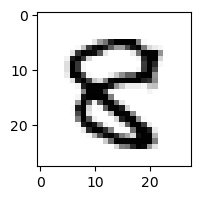

1.4639635788011785e-13% - 0
1.4476374891472636e-13% - 1
1.769470645716609e-14% - 2
3.518838888804389e-21% - 3
7.264237088900893e-05% - 4 - ОШИБКА
1.315319347051267e-05% - 5
4.2316853967296954e-20% - 6
1.5844218578161566e-15% - 7
7.095317832138565e-10% - 8
1.7561235574350298e-30% - 9

 8


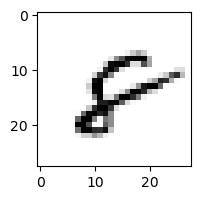

0.0006624371495130699% - 0
0.00010462140120248245% - 1
1.2719597667968818e-05% - 2
1.941371281535654e-19% - 3
9.998287338124794e-05% - 4
1.822770236317059e-07% - 5
0.9327286165719862% - 6 - ОШИБКА
0.0005188221870635034% - 7
4.676265022303274e-05% - 8
5.846641658170497e-07% - 9

 7


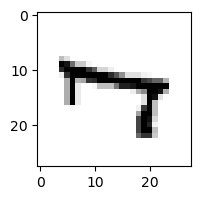

8.875300309045319e-06% - 0
0.0001374695637101419% - 1
1.2102800426214028e-25% - 2
2.3150925985426695e-07% - 3
93.9654373652888% - 4
0.0004949160377468048% - 5
99.87179646647284% - 6 - ОШИБКА
0.0001522607467176934% - 7
1.4817065824095315e-09% - 8
0.31136297193627127% - 9

 8


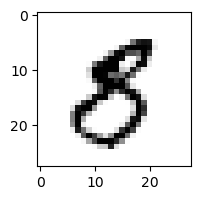

1.984798428084654e-07% - 0
5.737199584161451e-09% - 1
4.363646062007193e-18% - 2
8.176243897281228e-09% - 3
1.0215609135774654e-12% - 4
1.9122105888281393% - 5 - ОШИБКА
7.904800824704077e-18% - 6
4.982627255080759e-09% - 7
2.6744650827547424e-11% - 8
4.1958368335543e-13% - 9

 8


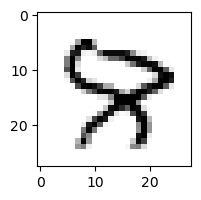

7.694260068525689e-12% - 0
1.5281852997734692e-13% - 1
5.010734414763329e-17% - 2
1.0450232708080734e-13% - 3
2.9949615468049145e-08% - 4
2.347975481638771e-12% - 5
5.087759171816498e-13% - 6
5.727314268701081e-05% - 7 - ОШИБКА
8.383703537138978e-27% - 8
7.394716131406283e-16% - 9

 7


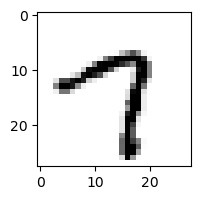

1.9026349555066005e-05% - 0
3.9927409107777814e-08% - 1
2.375014514857078e-21% - 2
4.7809560210176615e-15% - 3
3.9487280606445896e-08% - 4
0.005713807192930871% - 5
1.8931896551312063e-12% - 6
99.96974929534707% - 7
5.033293438555086e-10% - 8
99.99957407836581% - 9 - ОШИБКА

 2


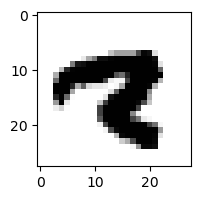

1.1659975948972066e-33% - 0
1.8118059855801886e-14% - 1
7.46610185153092e-43% - 2
6.812326405225605e-49% - 3
1.078248838279985e-14% - 4
3.3971273581366612e-12% - 5
3.9131164611376817e-28% - 6
0.5468747395076176% - 7 - ОШИБКА
1.8775098157261221e-37% - 8
2.2357880269908126e-24% - 9

 3


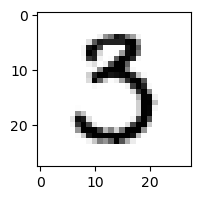

4.9376349316045066e-05% - 0
3.179755449686454e-08% - 1
3.9299376081850597e-10% - 2
10.746565527271226% - 3
3.29961729881426e-17% - 4
21.066567958639027% - 5 - ОШИБКА
1.916069288038949e-13% - 6
0.0007383277784078608% - 7
2.1086185368039386e-20% - 8
2.730390660055396e-35% - 9

 3


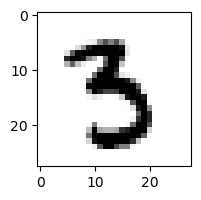

3.11112451763678e-17% - 0
1.608003860878033e-12% - 1
7.122690366596963e-27% - 2
7.24663545610542% - 3
9.058399547603912e-13% - 4
8.674207098259421% - 5 - ОШИБКА
2.798252908347721e-16% - 6
6.557694615701796e-07% - 7
1.307761861577197e-16% - 8
1.4963954134641205e-25% - 9

 9


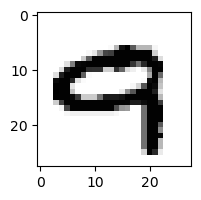

8.999478734252911e-13% - 0
2.538526172777328e-16% - 1
4.183161315764751e-10% - 2
7.0359453060148e-31% - 3
2.0837645481256077e-12% - 4
1.094919651598697e-12% - 5
3.1637959439311443e-24% - 6
0.012041176143927166% - 7 - ОШИБКА
2.971806149260971e-32% - 8
1.4096348786809012e-08% - 9

 8


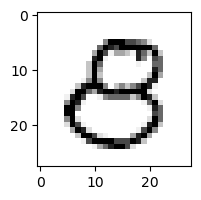

0.0019028375715979835% - 0
2.590761496563193e-14% - 1
7.75274961513406e-10% - 2
1.7394373369361418e-10% - 3
0.00022133786164231587% - 4
0.060750514554050436% - 5 - ОШИБКА
1.9825442523452533e-19% - 6
1.195247335465153e-11% - 7
3.3370571554998607e-13% - 8
6.902685785822211e-22% - 9

 8


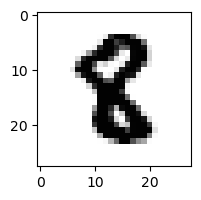

2.2866784586237333e-26% - 0
2.557533628132448e-10% - 1
1.1382410485968356e-19% - 2
6.739482686396757e-27% - 3
3.330197007292294e-17% - 4
0.012026102474329095% - 5 - ОШИБКА
1.0112049835551734e-21% - 6
1.1284612992527565e-14% - 7
3.864871657434605e-24% - 8
7.717873701909148e-40% - 9

 3


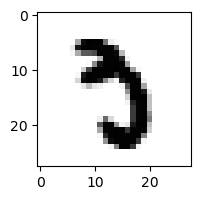

1.3377382276274768e-16% - 0
3.714833440701067e-12% - 1
4.4589940832563814e-26% - 2
8.261822270499212e-07% - 3
1.1271542022432021e-13% - 4
0.9852890085605144% - 5
1.654643775119464e-13% - 6
6.857680601219328% - 7 - ОШИБКА
2.5546536598700643e-28% - 8
7.635703561813399e-25% - 9

 3


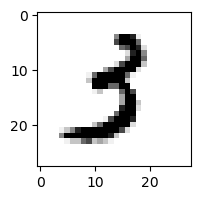

5.738840322046116e-09% - 0
0.0014366676419380556% - 1
2.1014362996458343e-18% - 2
0.09046267043124008% - 3
2.423718116238342e-09% - 4
0.6329915168752743% - 5 - ОШИБКА
4.8740965590785984e-14% - 6
0.00018600963769121258% - 7
2.0179796015078827e-25% - 8
8.435567521835154e-29% - 9

 2


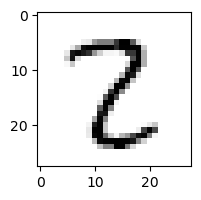

9.377101483998283e-11% - 0
0.00036367926719038337% - 1
0.027340800035971544% - 2
0.024960397967906923% - 3
2.0331703694318253e-10% - 4
0.001534877099232677% - 5
1.3890460606072535e-18% - 6
2.2508097415028327e-05% - 7
93.8074485721487% - 8 - ОШИБКА
8.68480422994567e-22% - 9

 2


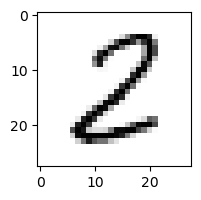

9.952252265349489e-08% - 0
0.006649638174921143% - 1
98.40763962167951% - 2
6.613383418388247e-08% - 3
7.130354738352825e-13% - 4
0.0008013128124556479% - 5
3.155433103990685e-10% - 6
3.843119166010128e-09% - 7
99.99997847140818% - 8 - ОШИБКА
1.201789058789424e-24% - 9

 5


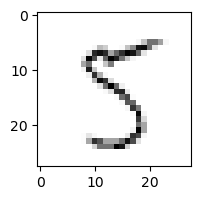

0.0019762137204435296% - 0
0.0011097967094288402% - 1
6.784047833999475e-07% - 2
60.602338885307226% - 3
0.0023811775881431717% - 4
91.73666848862567% - 5
2.4724426688223483e-05% - 6
0.29860339206351466% - 7
99.98431862590232% - 8 - ОШИБКА
25.60353757065188% - 9

 8


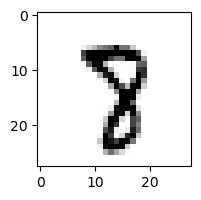

1.068781906638753e-15% - 0
5.6943896034817055e-09% - 1
1.7186134994593156e-14% - 2
2.8228092976243443e-12% - 3
3.021374429596084e-14% - 4
0.0318236866680769% - 5
3.530126031689265e-15% - 6
30.010807052180745% - 7 - ОШИБКА
0.0004937678452383675% - 8
3.934917480651988e-12% - 9

 9


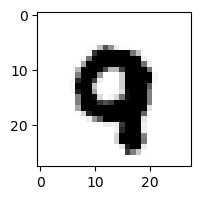

3.897037589104316e-22% - 0
6.953729702179041e-16% - 1
1.3608590087973774e-24% - 2
1.4867409440689836e-47% - 3
4.6410573072741634e-10% - 4
5.382846746481755e-13% - 5
2.197272233947618e-15% - 6
0.13792357913706088% - 7 - ОШИБКА
8.338101448140085e-39% - 8
3.914848685487957e-11% - 9

 8


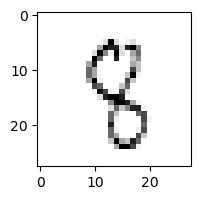

2.515938366791499e-08% - 0
0.0012068612909517896% - 1
0.008980967366442707% - 2
0.014689679837406617% - 3
10.173326166724088% - 4 - ОШИБКА
0.31357748367399413% - 5
1.62123310845398e-07% - 6
3.185346070341992% - 7
0.3071089708564987% - 8
0.02507020580213043% - 9

 6


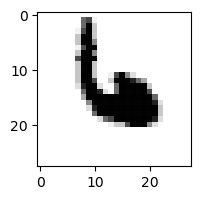

2.5236568660204283e-30% - 0
4.657031730889835e-13% - 1
7.938056517877357e-14% - 2
3.819562519379816e-25% - 3
42.621451977922064% - 4 - ОШИБКА
3.899838009467647e-06% - 5
11.64113868079565% - 6
5.309525673852632e-07% - 7
3.1707117078655103e-34% - 8
3.654592898364235e-19% - 9

 5


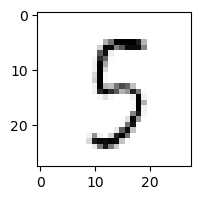

0.029458284579715503% - 0
0.00019651086342531416% - 1
0.0011828072211223762% - 2
49.818973356497594% - 3
0.16423517623590048% - 4
95.79059681534335% - 5
0.005012560262605225% - 6
0.00031328630798654373% - 7
99.99993198256988% - 8 - ОШИБКА
6.7281769332546244e-09% - 9

 1


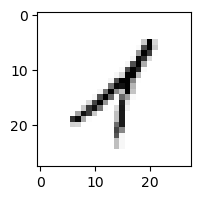

1.0734065298771632e-06% - 0
89.62782700910088% - 1
86.15152379939039% - 2
0.007239570459206845% - 3
79.18312512650891% - 4
0.000489362841030022% - 5
7.810429673296147e-06% - 6
0.0005941501843106208% - 7
96.14101458128326% - 8 - ОШИБКА
0.9644639733570649% - 9

 2


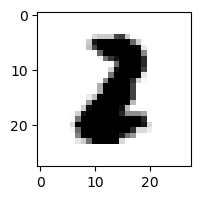

4.3145709491668953e-23% - 0
1.7122381331004574e-05% - 1 - ОШИБКА
5.141912833001044e-07% - 2
2.8957953803109248e-22% - 3
1.356088415668655e-31% - 4
7.287265717274509e-10% - 5
2.7259840994750133e-22% - 6
2.11980597264939e-17% - 7
2.3371751917314806e-23% - 8
1.630241207448559e-42% - 9

 8


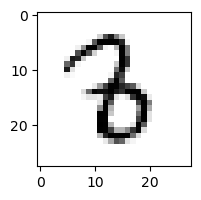

3.599936721430188e-16% - 0
0.0007193906501332492% - 1
2.5513011954773137e-05% - 2
0.34689951603962904% - 3 - ОШИБКА
4.3054740753533075e-10% - 4
0.00031975517756781214% - 5
1.5026787852562098e-05% - 6
3.8139611895124203e-08% - 7
1.1570788310970615e-22% - 8
1.0433621295367884e-23% - 9

 5


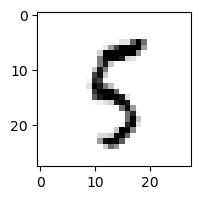

2.213478162494459e-05% - 0
2.6785947176710486e-06% - 1
5.2076832364971184e-06% - 2
0.000127248596832301% - 3
0.0008201312929074018% - 4
95.90607658914429% - 5
6.311265082995543e-05% - 6
9.293944321050483e-06% - 7
99.57040303458761% - 8 - ОШИБКА
89.17569157011064% - 9

 9


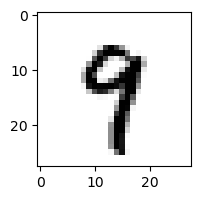

3.5275429757421915e-15% - 0
3.1889758760022294e-06% - 1
3.9337423486454294e-19% - 2
6.555910820147459e-10% - 3
0.00017747694040000695% - 4
0.010591798487994797% - 5
3.3932224521740906e-14% - 6
0.42750847789837665% - 7 - ОШИБКА
1.2960732080167382e-12% - 8
0.17863638218552597% - 9

 8


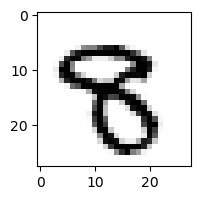

1.3490950061536258e-16% - 0
1.159196150642387e-15% - 1
4.979047931411545e-26% - 2
2.1371986220713722e-10% - 3
1.1390989623881746e-16% - 4
2.8309679034478892e-06% - 5 - ОШИБКА
4.197437389967686e-21% - 6
1.957208088061736e-06% - 7
4.416277675483801e-16% - 8
4.196998186435765e-07% - 9

 8


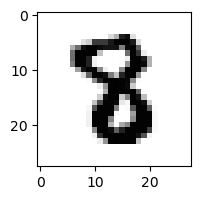

2.10149262946848e-26% - 0
1.8547715199391644e-11% - 1
3.797470088884578e-18% - 2
3.708916699588768e-18% - 3
2.664403220648048e-16% - 4
7.968168186908542e-05% - 5 - ОШИБКА
2.868769887560565e-21% - 6
1.2930595715703892e-10% - 7
6.065162807365356e-21% - 8
2.301451186546745e-47% - 9

 8


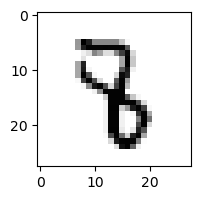

4.1128571985480785e-22% - 0
9.282028688072857e-05% - 1
6.212981363283577e-14% - 2
2.6813710941407318e-08% - 3
0.0001750911676206597% - 4
0.005605085935468499% - 5 - ОШИБКА
2.926748844721824e-12% - 6
1.4949976690242548e-06% - 7
1.2498470728453423e-24% - 8
7.497950248581446e-17% - 9

 9


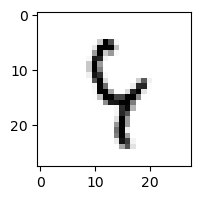

1.1099286539309427e-10% - 0
9.405301457318248e-05% - 1
0.005980807740196552% - 2
4.1372655149161196e-07% - 3
99.97441114276462% - 4 - ОШИБКА
24.847717891866463% - 5
0.47910840454436326% - 6
0.019107311263983993% - 7
22.583371956421168% - 8
0.01769067918572629% - 9

 3


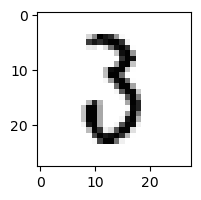

0.0006011857351724286% - 0
0.012867324186330574% - 1
0.0944109335281846% - 2 - ОШИБКА
0.013760164558828898% - 3
3.722853410757307e-16% - 4
0.0002239061017510396% - 5
1.8905964913166253e-07% - 6
2.5702868033923044e-06% - 7
1.4766970430543003e-07% - 8
2.555561374364936e-15% - 9

 3


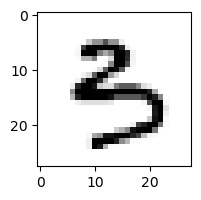

5.703929979330986e-10% - 0
3.006149596952075e-12% - 1
3.2615073580263553e-19% - 2
6.730283254243945% - 3
3.3031806889598978e-06% - 4
9.561551488274354% - 5 - ОШИБКА
2.3318478975265444e-09% - 6
2.3166876995670775e-09% - 7
2.778994277073653e-29% - 8
4.371644211859225e-15% - 9

 2


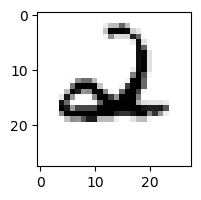

2.7898772657988725e-12% - 0
1.7816320068708314e-09% - 1
3.4493118071838144e-05% - 2
2.1325412604898983e-23% - 3
8.641690642877421% - 4 - ОШИБКА
1.5654569322336061e-10% - 5
0.0032802177330726635% - 6
5.9817508243214e-08% - 7
1.6764448030506052e-19% - 8
5.717196688218028e-10% - 9

 5


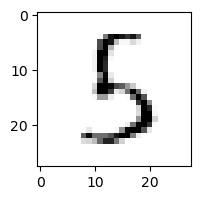

3.076349279301858e-06% - 0
6.147470027622071e-06% - 1
0.0002273021578663984% - 2
99.97583500687661% - 3 - ОШИБКА
0.0031805667193155734% - 4
97.298354043147% - 5
0.006915497183598714% - 6
1.801548886237112e-07% - 7
6.55047906389589e-05% - 8
5.3074791687343194e-14% - 9

 4


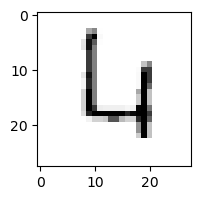

0.021902587587370275% - 0
4.675805260726959e-09% - 1
99.98034206205305% - 2
1.7683121932749183e-13% - 3
72.82642640471929% - 4
7.167017901598097e-06% - 5
99.99522544193182% - 6 - ОШИБКА
0.01279558112440764% - 7
4.2193819402912125e-08% - 8
0.002021025723690567% - 9

 5


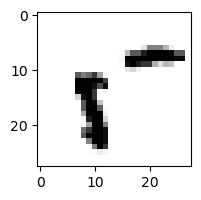

99.99999989210302% - 0 - ОШИБКА
1.6836948174825999e-09% - 1
5.640087407328777e-16% - 2
5.615119641776801e-17% - 3
24.871852749736746% - 4
99.99869682137708% - 5
7.2784015030589806e-09% - 6
2.730270917599683e-06% - 7
5.964245629345967% - 8
8.052426565304789e-08% - 9

 9


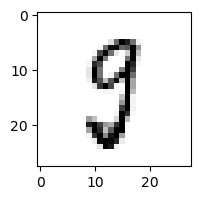

0.0003857031496104863% - 0
0.0009253682026674318% - 1
2.0857914225470445e-10% - 2
0.036419918569550486% - 3
3.2704812453832605e-07% - 4
19.81906984379665% - 5 - ОШИБКА
8.724513115707195e-11% - 6
0.007638752368314859% - 7
3.901269860536888% - 8
1.1529081865976604e-15% - 9

 5


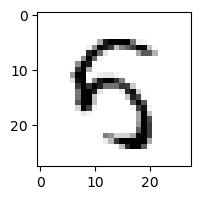

0.0013380504906802873% - 0
1.3600736236145582e-09% - 1
2.049207451147672e-13% - 2
1.7290338568457898e-07% - 3
99.73927525695329% - 4 - ОШИБКА
12.321068122271441% - 5
6.012707178213496e-07% - 6
3.4323114996976462e-09% - 7
2.2879543309019907e-17% - 8
1.1136078730990483e-11% - 9

 8


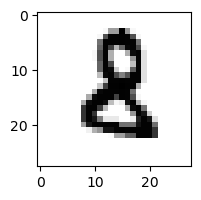

1.5454882925622897e-17% - 0
2.659677169544923e-07% - 1
0.009202196153695705% - 2 - ОШИБКА
1.0240825839076268e-09% - 3
1.7027238542201025e-18% - 4
1.5064958057315342e-05% - 5
3.459708218682052e-08% - 6
4.387044485155946e-17% - 7
1.0239942776837902e-17% - 8
1.3780541218311042e-27% - 9

 4


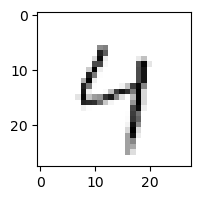

0.0011895816179223456% - 0
0.0008285915741100593% - 1
0.0010127402074091047% - 2
0.12468586211351931% - 3
99.95145509846388% - 4
0.08092128157565871% - 5
5.635609155157251% - 6
5.814628989106376% - 7
0.025212674913684043% - 8
99.99869092526924% - 9 - ОШИБКА

 8


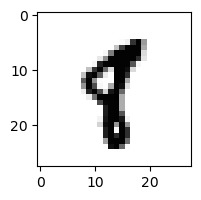

2.5649957014942872e-18% - 0
0.03287052888414242% - 1
4.992377384680992e-21% - 2
2.078420384142085e-24% - 3
2.393063679752301e-11% - 4
0.2294754806907728% - 5 - ОШИБКА
1.534989793601438e-13% - 6
0.0002237409489124681% - 7
8.713972899735667e-20% - 8
2.473276700535574e-10% - 9

 5


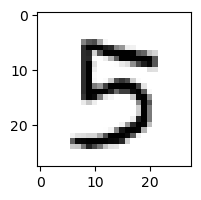

5.704858525348034e-09% - 0
1.7269139605547211e-13% - 1
7.079933246505096e-21% - 2
99.92453107862967% - 3 - ОШИБКА
6.225311276607864e-08% - 4
65.88856809782868% - 5
2.8798177179673504e-17% - 6
8.688795938180569e-07% - 7
4.916150928959423e-22% - 8
3.1449892874549654e-11% - 9

 8


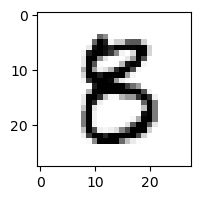

1.3120251581808429e-08% - 0
3.1627699407768946e-11% - 1
3.270641335703953e-17% - 2
0.0004648170133017815% - 3
1.005146711779341e-11% - 4
5.090936827885011% - 5 - ОШИБКА
9.229984632779738e-19% - 6
8.654748635202069e-12% - 7
9.940062679887971e-21% - 8
1.593564753411798e-30% - 9

 6


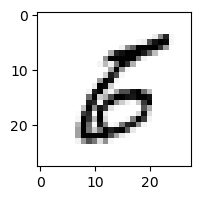

4.955240215324079e-05% - 0
3.323258829949544e-05% - 1
3.303945439327146e-07% - 2
9.547373498523031e-10% - 3
1.0415026896474559e-10% - 4
0.8614777279004078% - 5 - ОШИБКА
0.00030934102610449626% - 6
1.4398691079607483e-07% - 7
3.3530824437619573e-20% - 8
2.3694879513115497e-18% - 9

 1


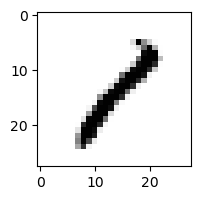

1.683033473010045e-09% - 0
74.0313342228335% - 1
0.029459396588418802% - 2
2.493147644167571e-06% - 3
4.244702947132707e-05% - 4
9.651237472481696e-07% - 5
1.429674757385254e-09% - 6
0.0012181069611881627% - 7
99.99998982048616% - 8 - ОШИБКА
3.593540148881243e-08% - 9

 8


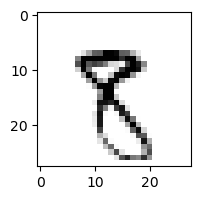

3.5028387751732413e-13% - 0
2.924693621471747e-05% - 1
4.254054018967488e-11% - 2
3.3982854702061714e-10% - 3
2.778049142788581e-10% - 4
0.014150089737313909% - 5
1.0981407737153433e-13% - 6
0.00044342006899298367% - 7
0.00541786667315043% - 8
0.08381755628185122% - 9 - ОШИБКА

 9


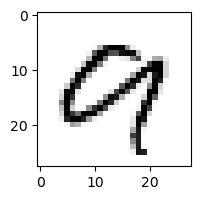

2.1765873894532055e-05% - 0
2.0250168308122048e-09% - 1
4.46512349103779e-09% - 2
9.978813698348846e-17% - 3
1.5449750986940259e-10% - 4
7.217380456879668e-10% - 5
4.409636468714288e-09% - 6
0.0004053995607151043% - 7
93.60289712135655% - 8 - ОШИБКА
11.555119891020079% - 9

 7


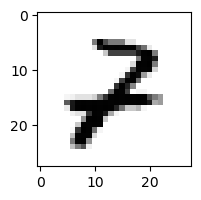

7.171755788870833e-10% - 0
3.0980178848956652e-06% - 1
79.2126604814713% - 2 - ОШИБКА
3.5446782322098827e-12% - 3
1.8407472590394254e-07% - 4
1.2514829757274156e-12% - 5
7.753172820454329e-15% - 6
0.00040573314349537284% - 7
1.5455763750024434e-14% - 8
7.186493482766705e-13% - 9

 7


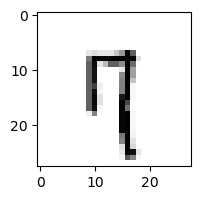

2.9404028071944364e-06% - 0
0.00047056872466785294% - 1
0.0002474424467861141% - 2
3.2092936460153977e-10% - 3
0.014684883270910595% - 4
0.00397531571384368% - 5
4.8069970560140005e-05% - 6
70.91614696666112% - 7
2.2350212509604253e-09% - 8
99.99693124007743% - 9 - ОШИБКА

 5


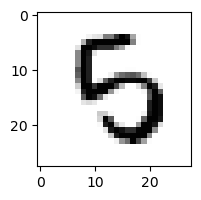

6.109955349727552e-10% - 0
1.1075835794592146e-10% - 1
2.7919789290019003e-10% - 2
0.038612030436769716% - 3
0.0013080596962607622% - 4
0.7920709306060366% - 5
2.4161686491151673% - 6 - ОШИБКА
1.0750954556866693e-14% - 7
4.952665952293759e-31% - 8
1.5599613019228843e-26% - 9

 8


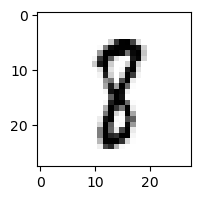

7.867716146284525e-14% - 0
0.009593611056264058% - 1
1.4838908346543162e-08% - 2
5.081767316593078e-09% - 3
2.707158138090756e-10% - 4
0.08069059536650407% - 5 - ОШИБКА
1.7415891030405392e-13% - 6
0.004828879254371808% - 7
0.042439068747928826% - 8
1.4132272405269394e-14% - 9

 5


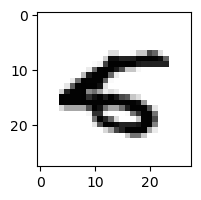

9.708852072773833e-09% - 0
7.2177765336667376e-12% - 1
1.6186395316590102e-23% - 2
1.6823701142662106e-29% - 3
0.01060430831762895% - 4 - ОШИБКА
0.010090220088594662% - 5
5.291791067711447e-10% - 6
1.5268459742197098e-08% - 7
3.8376853431204856e-35% - 8
1.334088177742482e-19% - 9

 4


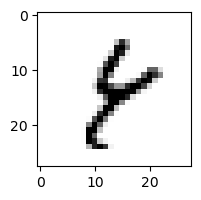

3.806626854275155e-11% - 0
0.040776159236925326% - 1
9.219336829082292e-09% - 2
7.89019223562608e-11% - 3
1.2032355164150649e-05% - 4
3.64965600892954e-07% - 5
0.9384075197106231% - 6
4.682078517567719e-05% - 7
99.99999956640852% - 8 - ОШИБКА
99.72238996936085% - 9

 2


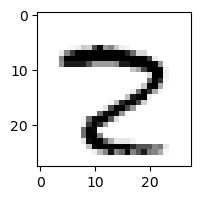

8.473814740825685e-09% - 0
3.7701196436964593e-16% - 1
1.6766524836856292e-12% - 2
3.356397165306838e-18% - 3
1.1777701871029553e-20% - 4
4.0848272695847205e-11% - 5
1.1987149896280156e-22% - 6
99.99980724271501% - 7 - ОШИБКА
2.956231248447154e-09% - 8
1.795494862406678e-16% - 9

 8


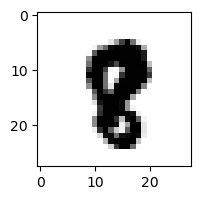

7.09406413809699e-27% - 0
2.118736162458239e-10% - 1
1.0753280649647294e-24% - 2
7.862665652865535e-33% - 3
3.5858656553359853e-16% - 4
1.778850603461992e-08% - 5
8.732361895957236e-23% - 6
6.8083353876832534e-06% - 7 - ОШИБКА
2.7772274028065035e-17% - 8
2.0136163710177637e-20% - 9

 4


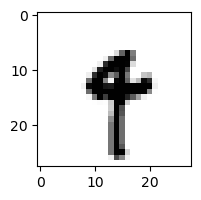

1.2999210517828652e-21% - 0
0.0007036719641253332% - 1
1.0611317708377534e-25% - 2
2.8292082111228537e-16% - 3
0.0010307599264065285% - 4
0.004275555259679393% - 5
1.3024354388536584e-07% - 6
0.01338813528410874% - 7
1.704460078887478e-19% - 8
1.1114448694819372% - 9 - ОШИБКА

 2


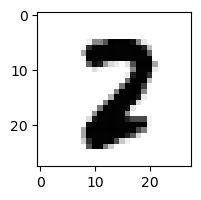

7.327112539207841e-19% - 0
8.661240967298655e-14% - 1
4.122883036384732e-07% - 2
9.593698674043003e-23% - 3
1.7270785709387242e-24% - 4
5.528351550791157e-09% - 5
3.240162520721649e-21% - 6
2.5169624367895062e-05% - 7 - ОШИБКА
1.220905510583544e-15% - 8
5.8773946811664916e-39% - 9

 8


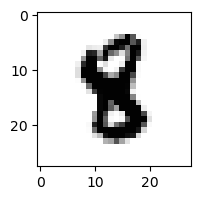

4.319510628752212e-25% - 0
5.00962284526557e-10% - 1
2.7683266787099603e-24% - 2
1.507117564376251e-21% - 3
1.9084506988079246e-11% - 4
0.12744461190721196% - 5 - ОШИБКА
4.4054897399424454e-13% - 6
9.352031840147812e-12% - 7
3.494938979556222e-17% - 8
2.4357900120948685e-29% - 9

 9


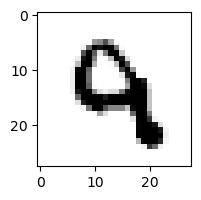

1.8177869483798535e-18% - 0
2.7059916976044525e-13% - 1
3.8138071760525385e-05% - 2
8.371378469845027e-18% - 3
2.1381108447827026% - 4 - ОШИБКА
0.0001008557526279252% - 5
2.619144706789736e-09% - 6
1.146814506711351e-07% - 7
1.9806192187965415e-32% - 8
0.00017850041291275057% - 9

 3


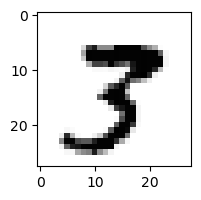

1.1893554473511819e-17% - 0
4.2370417696724866e-11% - 1
9.163476686049144e-18% - 2
0.46024417604376433% - 3
4.680592263289666e-18% - 4
3.48917751462072e-06% - 5
4.9387299733766445e-31% - 6
89.23114511003368% - 7 - ОШИБКА
5.6825704128517107e-08% - 8
1.3956984483226216e-16% - 9

 8


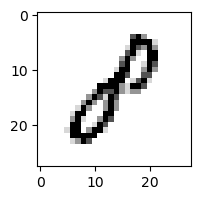

2.118011703569472e-06% - 0
0.20262395986583814% - 1 - ОШИБКА
0.0006464567965936013% - 2
1.0203557868854257e-06% - 3
9.946123914113568e-07% - 4
5.9087441153172286e-05% - 5
7.480795740428202e-11% - 6
8.75764896956837e-10% - 7
2.117096388570091e-14% - 8
1.8522861330832624e-12% - 9

 2


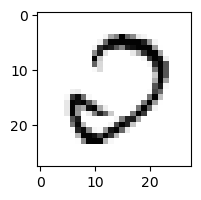

99.99975661924427% - 0 - ОШИБКА
1.2067057735666145e-09% - 1
99.99498817090054% - 2
7.951570888628698e-12% - 3
3.9350694579907425e-09% - 4
7.288404808795984e-06% - 5
1.2118273291096496e-06% - 6
9.518657933373046e-08% - 7
7.000807208672912e-06% - 8
3.861992066087064e-33% - 9

 8


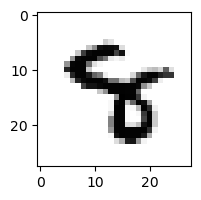

2.9787767070350097e-21% - 0
1.3905524827286813e-11% - 1
9.706234129538443e-25% - 2
3.414471456583878e-18% - 3
3.526960708172837e-05% - 4 - ОШИБКА
2.2892713134116917e-08% - 5
2.516651543153368e-08% - 6
4.513793988117118e-06% - 7
1.0586412838157584e-17% - 8
3.7683897255677205e-14% - 9

 3


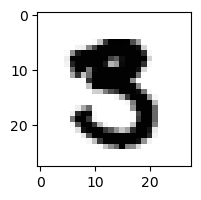

1.9710574592195576e-16% - 0
7.108690241763029e-19% - 1
7.649531949185827e-29% - 2
3.583186056155963e-11% - 3
2.014456466513332e-26% - 4
0.08767957040911042% - 5 - ОШИБКА
9.308978680631275e-36% - 6
3.248580953744833e-08% - 7
8.422717505585097e-29% - 8
1.2163812880217152e-46% - 9

 8


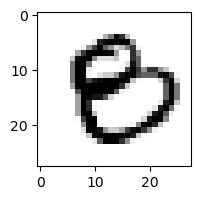

0.03366773042697055% - 0 - ОШИБКА
4.732724962968526e-15% - 1
1.5456173985975434e-20% - 2
8.899573499444864e-12% - 3
1.3650986932581312e-14% - 4
2.6946526077036105e-12% - 5
3.1271123950672903e-18% - 6
6.342506881389791e-16% - 7
6.749995989650277e-18% - 8
1.7648503960433418e-31% - 9

 3


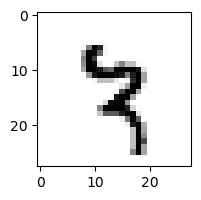

2.8255180711815943e-19% - 0
0.06601566221179127% - 1
3.2151059406505335e-09% - 2
3.1242923667135e-16% - 3
0.006938059867291104% - 4
5.5371071809599454e-05% - 5
1.5368647930577346e-08% - 6
79.02297087569% - 7 - ОШИБКА
0.00042354244625218506% - 8
1.6537916407512973e-12% - 9

 2


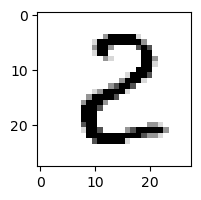

0.0009724121344588748% - 0
2.2981213450505042e-05% - 1
99.9996263375978% - 2
2.930188267139184e-06% - 3
2.9579006023048874e-10% - 4
1.2077489744452516e-05% - 5
6.58040137863831e-14% - 6
2.9262037057347044e-14% - 7
99.99999954801216% - 8 - ОШИБКА
2.6804969826749315e-21% - 9

 6


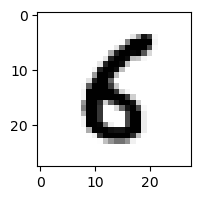

1.9748617727415868e-07% - 0
3.50814129546077e-09% - 1
1.9381062269660754e-12% - 2
1.8287879006993422e-20% - 3
1.5631714637518468e-10% - 4
0.6880980848260352% - 5 - ОШИБКА
0.04635716324655567% - 6
2.046792212224749e-14% - 7
6.407998102427292e-13% - 8
2.548934602349683e-17% - 9

 6


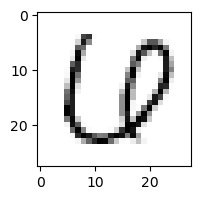

0.004708728271309966% - 0 - ОШИБКА
3.4783964917457663e-07% - 1
2.8928691776775427e-12% - 2
6.084423717847013e-06% - 3
9.436576025396317e-05% - 4
0.0004558299809031876% - 5
2.7875219795701178e-14% - 6
0.00021244094025949807% - 7
2.325651871024178e-18% - 8
9.903532728265864e-33% - 9

 8


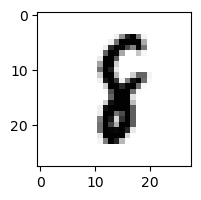

4.951140961992285e-21% - 0
0.1015890896949306% - 1 - ОШИБКА
6.016413588907585e-11% - 2
1.4457697123739841e-18% - 3
1.1118744520644042e-10% - 4
0.005240468979043888% - 5
0.0030401785663312997% - 6
2.680783390884569e-07% - 7
5.4033957014534056e-05% - 8
1.3839562947628983e-18% - 9

 5


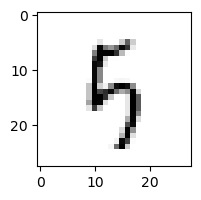

3.4265849580865814e-06% - 0
7.442692302534988e-06% - 1
0.04669980900633367% - 2
0.0006422894022024273% - 3
26.362922634738524% - 4
72.45348779752344% - 5
0.33642373683475474% - 6
0.0005599892907710286% - 7
6.645070103137655% - 8
99.98936511118589% - 9 - ОШИБКА

 9


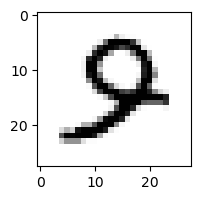

3.156890271425539e-10% - 0
1.4762323519858591e-12% - 1
3.7468666110332337e-10% - 2
8.413564631306366e-14% - 3
0.00016879930950460827% - 4
3.925199279263054e-05% - 5
2.1429407298781304e-09% - 6
0.009493382934543996% - 7 - ОШИБКА
9.215628332665556e-22% - 8
4.3528923446099996e-24% - 9

 4


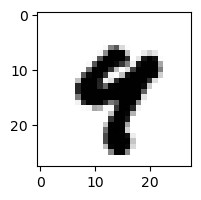

1.9555586303333772e-24% - 0
1.71939041562279e-15% - 1
4.368520614679892e-38% - 2
2.4485683731536224e-32% - 3
8.411663423383405e-06% - 4
8.882623211002273e-09% - 5
2.325913869368501e-20% - 6
0.00021116921357711358% - 7
2.5030885111580693e-21% - 8
0.060969214973290206% - 9 - ОШИБКА

 6


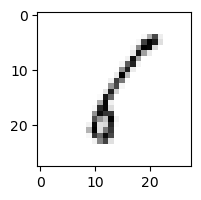

0.019404086818216305% - 0
99.87948059880192% - 1 - ОШИБКА
53.2503483706722% - 2
0.0001659502200875252% - 3
0.08696400103153697% - 4
1.6680296472441154% - 5
0.6332412603707958% - 6
0.002618853594988184% - 7
88.02488045906301% - 8
2.6349783706430164e-05% - 9

 2


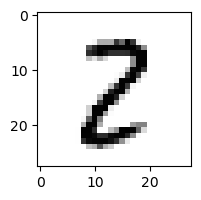

8.939619974055939e-08% - 0
0.0007885207300325028% - 1
0.004839422633421381% - 2
0.0003698226209178063% - 3
9.484839825013831e-16% - 4
0.0003473707343938221% - 5
1.3486433349784901e-16% - 6
2.915970127690025e-07% - 7
99.99998130990521% - 8 - ОШИБКА
4.691140161849069e-16% - 9

 8


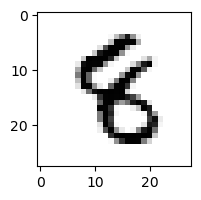

1.6275175828041947e-22% - 0
1.4823822447576139e-07% - 1
8.577162533595643e-12% - 2
4.468263125850135e-18% - 3
5.376168602506755e-07% - 4
0.0033064751682684826% - 5 - ОШИБКА
2.1391738509582833e-14% - 6
5.641389780079375e-09% - 7
8.115946977530372e-17% - 8
1.4705175575886653e-15% - 9

 8


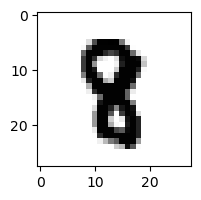

1.2053902848694007e-26% - 0
1.3414218757937094e-08% - 1
7.047210769161968e-22% - 2
2.4279305746345752e-21% - 3
2.4387321686017583e-13% - 4
4.354668823504402e-05% - 5 - ОШИБКА
4.036225219358596e-20% - 6
4.64293358171895e-10% - 7
5.710255301378942e-19% - 8
9.608053038505026e-27% - 9

 4


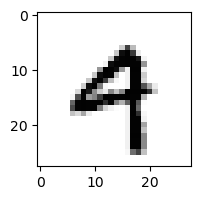

9.479810373941134e-10% - 0
4.108506904317991e-08% - 1
2.552456867172387e-14% - 2
1.4017665164620718e-13% - 3
0.5695287509913955% - 4
4.458338008808781e-07% - 5
4.69673586624098e-09% - 6
0.001150064022808669% - 7
2.640938373329219e-25% - 8
11.259138798062013% - 9 - ОШИБКА

 8


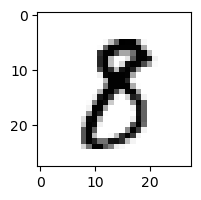

1.3812586993469357e-10% - 0
0.00014994930064073553% - 1
1.3514075201919346e-14% - 2
0.005387015076498552% - 3
1.0925059314970844e-18% - 4
0.0361800335085027% - 5 - ОШИБКА
2.6567422205837403e-21% - 6
3.312359767068384e-08% - 7
0.00044298512597315293% - 8
6.96318864636761e-21% - 9

 3


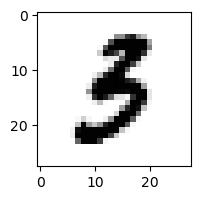

2.467698047958458e-12% - 0
6.130134568518963e-09% - 1
1.2566920123625562e-17% - 2
0.023096467929746185% - 3
4.041585407069402e-15% - 4
0.6655883153577736% - 5 - ОШИБКА
3.5008203488899495e-14% - 6
3.004925655941164e-10% - 7
1.223987834271463e-34% - 8
4.5820641396426404e-26% - 9

 8


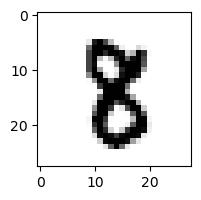

1.0410059995503798e-22% - 0
1.2676350396601755e-07% - 1
4.055407013769981e-18% - 2
3.594005550693829e-13% - 3
2.83643735641526e-15% - 4
6.275199690252167e-05% - 5 - ОШИБКА
1.6323630238349593e-21% - 6
9.15940850979917e-08% - 7
6.064646148578974e-10% - 8
2.1876586736003792e-23% - 9

 8


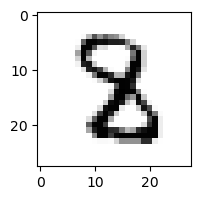

3.65227722081863e-21% - 0
1.128408914078803e-06% - 1
1.01419166825006e-08% - 2
6.711125134663297e-14% - 3
4.4614758588105814e-10% - 4
3.294313699768696e-05% - 5 - ОШИБКА
1.650322421590549e-16% - 6
3.808210620629922e-08% - 7
9.691732857696581e-21% - 8
1.0715849069131578e-37% - 9

 8


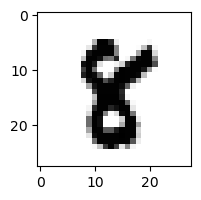

5.471892843047919e-23% - 0
1.3809314807637506e-09% - 1
1.536800875361559e-27% - 2
6.710533882718804e-23% - 3
6.032439165928162e-13% - 4
0.00016144235462282978% - 5 - ОШИБКА
1.0853276583550107e-26% - 6
5.280701867558172e-10% - 7
3.955598141249299e-05% - 8
3.158765639794646e-31% - 9

 8


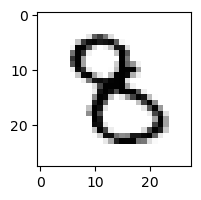

4.377513870368348e-14% - 0
8.805991813514999e-08% - 1
1.496176693065978e-08% - 2
0.0004206388167573717% - 3 - ОШИБКА
3.7166652022956308e-09% - 4
0.00012433408130927925% - 5
7.05071641557377e-14% - 6
2.5110385038503534e-12% - 7
1.3208558334297578e-17% - 8
2.209369155339682e-16% - 9

 1


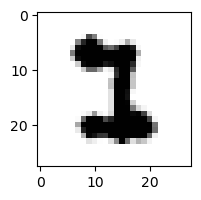

8.92805246534561e-24% - 0
1.3841441150891763e-10% - 1
0.000726235209294337% - 2 - ОШИБКА
5.427398143377809e-15% - 3
8.774043386010307e-30% - 4
0.000181479317869739% - 5
1.7100497508065472e-20% - 6
7.74015844998165e-08% - 7
1.9356136601354537e-33% - 8
3.7223681756277875e-44% - 9

 0


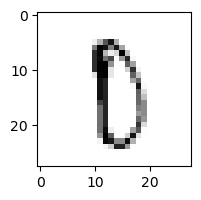

0.0016873994109725726% - 0
4.0027105901369467e-07% - 1
8.620267119538836e-05% - 2
8.354641915598211e-06% - 3
3.586459500583256e-05% - 4
41.69155208270035% - 5
0.003945589028832273% - 6
0.12110987885473395% - 7
99.9999455887084% - 8 - ОШИБКА
7.737620266803853e-05% - 9

 2


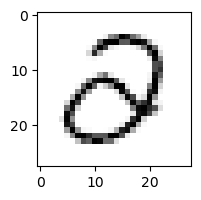

0.11034639562662377% - 0
3.350284173570509e-08% - 1
2.50709223772342e-12% - 2
65.6551048909498% - 3 - ОШИБКА
0.05030557557331633% - 4
0.053016446341318496% - 5
1.5547656448314383e-08% - 6
2.3675656939688886e-09% - 7
4.62325237632416e-19% - 8
4.06308286607667e-33% - 9

 9


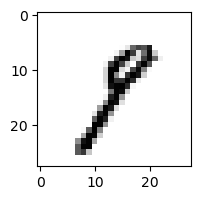

3.5269256597631476e-10% - 0
96.55605818023433% - 1 - ОШИБКА
3.918042074736184e-11% - 2
0.04678258281376756% - 3
7.745780018750619e-11% - 4
1.6967084101335578e-05% - 5
2.780084306743207e-10% - 6
1.633583111462421% - 7
0.00010666691237859898% - 8
0.0010110375687525759% - 9

 2


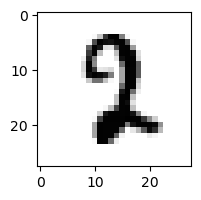

3.952123271332344e-16% - 0
5.4136676871923635e-09% - 1
4.503946054697679e-05% - 2
3.699370443478358e-15% - 3
4.89488372354743e-16% - 4
0.0016294320121331939% - 5 - ОШИБКА
6.232303231375608e-12% - 6
1.5133121040397041e-05% - 7
3.678980633695337e-20% - 8
6.459280387618568e-30% - 9

 8


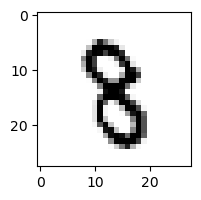

2.0905857889288429e-19% - 0
2.671258455753783e-06% - 1
1.2710703822823713e-12% - 2
7.787575838594481e-06% - 3
8.825882340642442e-08% - 4
0.008236984694978394% - 5 - ОШИБКА
1.02638249936551e-10% - 6
2.7228774086419803e-06% - 7
0.0004362142511589732% - 8
6.783755012080072e-12% - 9

 4


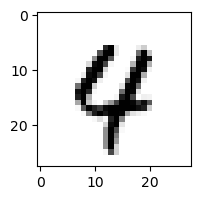

9.798333165927402e-12% - 0
3.720020916019668e-09% - 1
8.155790332471981e-16% - 2
4.313869267092372e-30% - 3
72.53344666221282% - 4
1.628415229469147e-07% - 5
7.010538843195196e-09% - 6
72.88846215397093% - 7 - ОШИБКА
8.053145327553129e-13% - 8
2.689121025416113e-07% - 9

 8


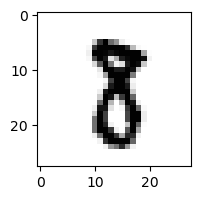

3.663056687680484e-18% - 0
0.00014908257309343787% - 1
3.333242942072805e-14% - 2
3.0023978569851335e-05% - 3
4.2158034295316365e-21% - 4
0.00968750064448176% - 5 - ОШИБКА
2.4408401605401558e-20% - 6
2.677497689468336e-05% - 7
1.909701641717302e-10% - 8
5.315549326748126e-19% - 9

 6


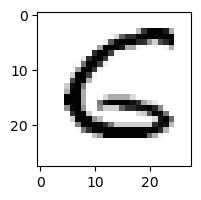

1.5724417609153827e-07% - 0
4.2180860519268566e-13% - 1
0.015439984056752211% - 2
6.941598650173564e-26% - 3
5.026740096691369e-10% - 4
54.85814652106773% - 5 - ОШИБКА
1.2753997483215212e-05% - 6
5.5279966144573975e-15% - 7
9.83778722610349e-27% - 8
2.796865706881731e-37% - 9

 8


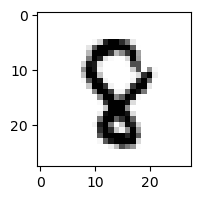

8.786642346255544e-17% - 0
8.721988260739408e-10% - 1
1.975428139151661e-12% - 2
1.236193935033061e-24% - 3
1.2641791461888915e-05% - 4
0.0017946626017687367% - 5 - ОШИБКА
3.1832762344477085e-11% - 6
1.0412178889378645e-06% - 7
1.888473237657471e-07% - 8
6.181815299226496e-20% - 9

 5


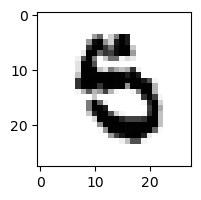

8.702961618904193e-20% - 0
7.994293819055833e-13% - 1
9.967879121140537e-22% - 2
1.0255411435703442e-23% - 3
5.08244163337015e-16% - 4
0.015924475869531034% - 5
0.022404735387727612% - 6 - ОШИБКА
6.771553401577387e-15% - 7
2.878639262147046e-30% - 8
1.2176057513382554e-23% - 9

 3


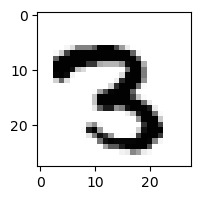

8.602989817856648e-28% - 0
1.0061092580463998e-13% - 1
1.49297213700394e-09% - 2
8.463368027024581e-08% - 3
2.441497816964058e-18% - 4
2.5046326709269952e-09% - 5
2.4268392275431764e-30% - 6
0.013603937607723434% - 7 - ОШИБКА
1.804516119914447e-15% - 8
1.7629434423418942e-20% - 9

 9


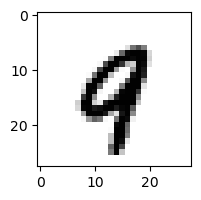

8.057757958064657e-15% - 0
4.142039035693416e-10% - 1
2.0289519628183436e-16% - 2
7.696699711018142e-31% - 3
0.0036290084967300854% - 4
6.092553217912359e-10% - 5
1.1478928411545023e-08% - 6
0.9230512915017077% - 7 - ОШИБКА
7.656083253634843e-16% - 8
6.19187677012708e-05% - 9

 8


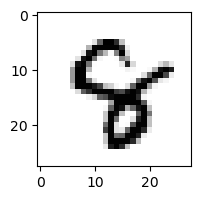

1.0591022185649251e-17% - 0
2.64927894986416e-13% - 1
2.8675810790664255e-20% - 2
2.1664492139970213e-21% - 3
4.9532355362512595e-05% - 4 - ОШИБКА
3.501365726787115e-06% - 5
9.338485714005806e-11% - 6
4.901328223720979e-07% - 7
1.3087656067330343e-20% - 8
5.1394114806685315e-21% - 9

 9


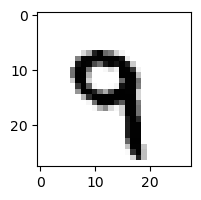

2.3261011935033787e-22% - 0
3.4257315468585513e-06% - 1
6.604478891633116e-17% - 2
2.9692378467972125e-16% - 3
0.0010777795582706184% - 4
0.00261940474807362% - 5
1.4678146182287353e-11% - 6
0.2785610762982988% - 7 - ОШИБКА
4.506599392291469e-21% - 8
0.07648866673479124% - 9

 1


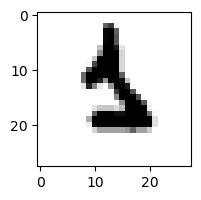

1.1391439699556532e-22% - 0
1.7632822353320333e-07% - 1
1.1645486038802944e-18% - 2
3.881791736553403e-22% - 3
2.012078919435412e-19% - 4
0.024658722467900386% - 5
0.9453548875781098% - 6 - ОШИБКА
5.565439847774837e-07% - 7
1.0061713036388614e-25% - 8
3.1304045712235174e-21% - 9

 8


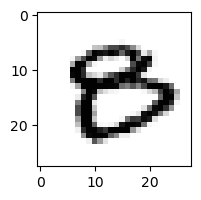

26.415969846858317% - 0 - ОШИБКА
6.673002626638963e-15% - 1
1.1132322991869209e-23% - 2
4.2465007673586835e-10% - 3
2.7710959030523193e-15% - 4
1.71759838184144e-07% - 5
9.067088212032313e-10% - 6
1.2302416107567615e-09% - 7
3.0736991503321413e-24% - 8
3.900543223142364e-18% - 9

 5


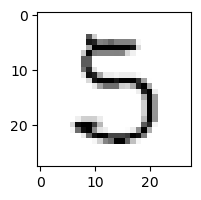

0.0018659923326056623% - 0
1.2378546276996208e-07% - 1
1.5417336788643423e-06% - 2
99.49780331477062% - 3 - ОШИБКА
3.4277965237297163e-08% - 4
93.9744007140036% - 5
4.989713865489056e-07% - 6
3.660569763472489e-08% - 7
0.4613793957807952% - 8
1.5428118580731877e-16% - 9

 9


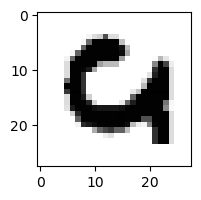

9.812451668517061e-09% - 0
2.5137000999562146e-25% - 1
0.0003211065764191547% - 2
1.6746721598583512e-45% - 3
1.3338264841492599e-22% - 4
2.5123144722064974e-16% - 5
0.004629899420375629% - 6 - ОШИБКА
4.880638571817254e-11% - 7
1.2783663059470406e-43% - 8
1.4597069721124007e-44% - 9

 8


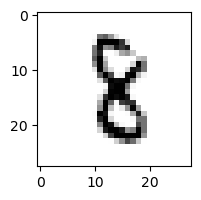

6.675925538688355e-19% - 0
0.3000810507118243% - 1 - ОШИБКА
5.604939995485537e-08% - 2
1.8470987013470122e-05% - 3
2.300247465430764e-09% - 4
0.001042661084322335% - 5
1.5011705753901007e-08% - 6
5.97183766778752e-07% - 7
6.426325259582992e-05% - 8
4.828402691226437e-18% - 9

 8


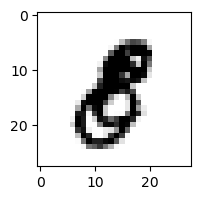

9.226540262838554e-11% - 0
1.7050165320597004e-09% - 1
1.4682055430686884e-17% - 2
2.7469472526343614e-13% - 3
2.7686143815280636e-20% - 4
2.719722961689663e-07% - 5 - ОШИБКА
3.4510873227785614e-17% - 6
2.649345007150357e-10% - 7
2.9372847693350354e-19% - 8
2.916390223836514e-17% - 9

 2


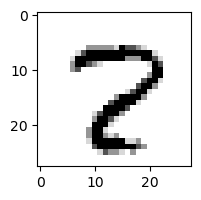

4.613639960459684e-12% - 0
4.321064344295015e-14% - 1
4.083183212707068e-12% - 2
1.6257276431182963e-23% - 3
2.1665639125872034e-15% - 4
2.441738165585416e-06% - 5
1.856794450142713e-18% - 6
99.10341337185501% - 7 - ОШИБКА
29.142654373388087% - 8
1.5127158456187605e-13% - 9

 3


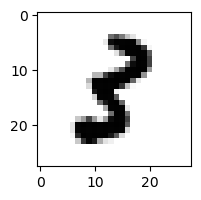

3.1292196679949026e-11% - 0
0.0007781869996358648% - 1
2.1636477068658335e-15% - 2
1.244346909710347e-07% - 3
1.325805013012526e-13% - 4
0.005918641894990345% - 5 - ОШИБКА
4.1302748218664523e-19% - 6
1.075988574209982e-11% - 7
5.264227232143145e-19% - 8
2.767950505354931e-31% - 9

 3


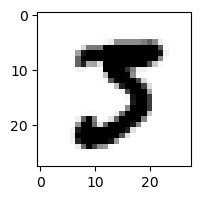

8.843660709194346e-11% - 0
1.6861727565647536e-14% - 1
2.4035255498586292e-20% - 2
0.024439171633525523% - 3
4.611914113274093e-29% - 4
8.313834820583851% - 5 - ОШИБКА
4.777331327033836e-30% - 6
6.831606876897268% - 7
9.323761021685321e-35% - 8
5.462129105117253e-46% - 9

 5


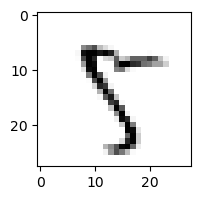

2.9852723260426747e-09% - 0
8.773210924072772e-06% - 1
6.656356646596457e-09% - 2
7.994193397023573e-09% - 3
0.015909085692786484% - 4
32.18586298832767% - 5
5.9588077639374566e-12% - 6
34.18545036676524% - 7 - ОШИБКА
2.3345755652207654% - 8
1.906474926992698e-09% - 9

 9


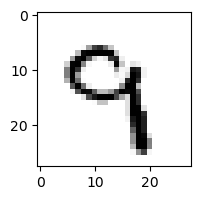

1.671153624958349e-12% - 0
5.430137329086656e-07% - 1
5.9203025034651035e-08% - 2
0.4216503930710306% - 3
0.00195700032599853% - 4
0.012815971960522435% - 5
7.533084573467877e-07% - 6
1.5102300622958118% - 7 - ОШИБКА
2.8359781641463104e-16% - 8
0.03347187166570607% - 9

 8


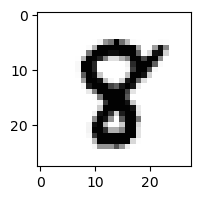

7.345483924316067e-21% - 0
9.008805593670073e-13% - 1
2.973761011866317e-23% - 2
6.190985853708336e-25% - 3
1.1210427855754828e-10% - 4
0.01602860374639529% - 5 - ОШИБКА
7.207498665480517e-24% - 6
3.5315022149403654e-07% - 7
0.008196189711492705% - 8
3.516135697648893e-25% - 9

 5


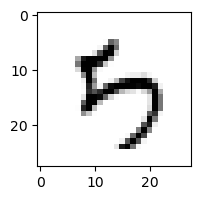

3.492318077782003e-06% - 0
1.7333882697201493e-07% - 1
9.15504936959834e-05% - 2
7.137982418059373e-06% - 3
87.25147046485809% - 4
0.009558725767772279% - 5
8.970607319007748% - 6
9.788269029661619e-08% - 7
0.02170099024166888% - 8
99.97700102144661% - 9 - ОШИБКА

 2


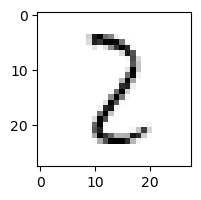

2.2511230763221336e-06% - 0
32.9486107840098% - 1
98.07207057113317% - 2
0.5072162229560027% - 3
2.9724436513820785e-05% - 4
0.004868558644553347% - 5
1.1513914080585807e-06% - 6
0.007564659080845697% - 7
99.84944821768393% - 8 - ОШИБКА
1.8589166256773355e-08% - 9

 9


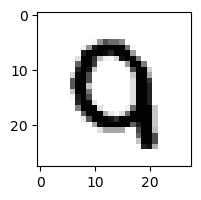

0.021660420878398007% - 0 - ОШИБКА
9.614012646224148e-19% - 1
0.00011089186437930323% - 2
2.9664530249590935e-22% - 3
3.3085219644064114e-14% - 4
4.715475397282143e-07% - 5
0.007568692752356662% - 6
5.160064798828546e-07% - 7
5.580386982033232e-32% - 8
3.5386118417396456e-15% - 9

 8


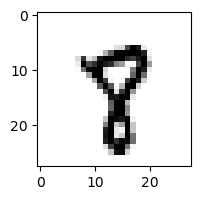

2.905937100714925e-17% - 0
4.1441940953874525e-07% - 1
6.702328720081886e-17% - 2
7.84657558596488e-20% - 3
2.5202341594340277e-09% - 4
0.004415487560174367% - 5
4.103462644313535e-15% - 6
17.86959885960516% - 7 - ОШИБКА
0.07372377254444058% - 8
1.3845110324358408e-06% - 9

 4


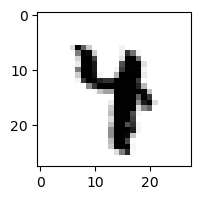

2.6569230637015125e-26% - 0
5.784520246226312e-10% - 1
4.371384175544038e-31% - 2
1.586411505124256e-16% - 3
6.263224121002815% - 4
0.0001667263135148578% - 5
1.6904053947685757e-15% - 6
20.242361408138418% - 7 - ОШИБКА
4.522170540352015e-28% - 8
9.056711253827496e-22% - 9

 9


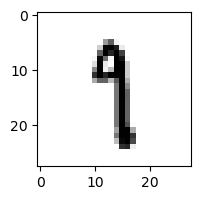

4.7532523275413494e-14% - 0
72.98592391524991% - 1 - ОШИБКА
1.7749667404351924e-12% - 2
1.7066377577618025e-06% - 3
1.1158944495707554e-06% - 4
0.20510137242479878% - 5
4.993057863432199e-07% - 6
6.134425505865591% - 7
7.868993346596815e-07% - 8
1.850336310376054e-06% - 9

 8


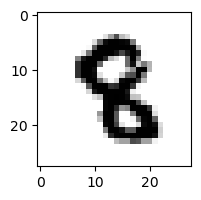

1.1925333106070772e-27% - 0
2.3140524711197653e-12% - 1
4.110478586769329e-15% - 2
1.6576921460702132e-21% - 3
4.305454726264162e-11% - 4
0.00018569543451260948% - 5 - ОШИБКА
5.776569232980633e-19% - 6
1.2739849577628366e-10% - 7
2.3991892369733814e-30% - 8
2.723136943288396e-26% - 9

 8


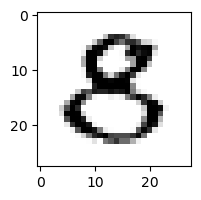

8.43427032821819e-07% - 0
1.2972132731736046e-14% - 1
2.47787908668178e-10% - 2
0.006039862042554239% - 3
3.5886951799662856e-11% - 4
0.7350647585721924% - 5 - ОШИБКА
4.5280406665146576e-26% - 6
5.20940281356319e-14% - 7
2.995405422712595e-31% - 8
2.3127340261656667e-40% - 9

 4


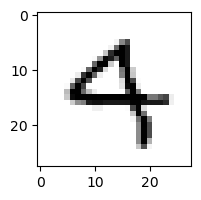

1.1146293291402502e-08% - 0
1.0619313964259334e-07% - 1
9.36957933155841e-11% - 2
4.585021364739478e-09% - 3
72.92168081729685% - 4
0.0002571961416271301% - 5
2.6666393976570724e-06% - 6
0.005137659240674132% - 7
2.279048678794824e-28% - 8
99.44610792258129% - 9 - ОШИБКА

 8


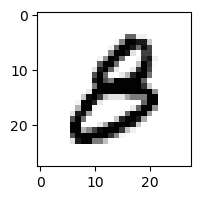

4.2182503662495985e-08% - 0
7.948265607907324e-14% - 1
2.413084312078851e-15% - 2
3.0354810798150995e-06% - 3
1.8168326239179746e-12% - 4
0.0002181280760007579% - 5 - ОШИБКА
1.4159412342043172e-09% - 6
4.021158998582477e-11% - 7
2.4049150264734075e-24% - 8
2.6180917081518474e-18% - 9

 2


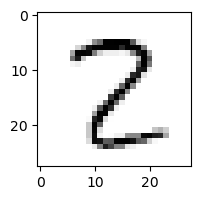

3.1514069069287136e-09% - 0
0.00048531739094584495% - 1
81.44851870916126% - 2
1.6535187738029024e-05% - 3
2.440646386044288e-08% - 4
8.8290482316717e-05% - 5
5.308421809420891e-15% - 6
0.0007691084673459463% - 7
99.99997752529572% - 8 - ОШИБКА
1.2129021761978947e-20% - 9

 4


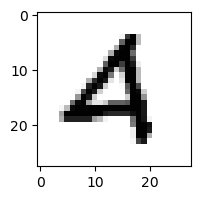

6.593424169679293e-10% - 0
1.0079808945997136e-13% - 1
0.01629276736746456% - 2 - ОШИБКА
6.774612326017185e-27% - 3
0.00017262677321083322% - 4
4.664718594748584e-09% - 5
5.17886749940273e-10% - 6
8.189131300069724e-08% - 7
1.7505591977267726e-32% - 8
4.361398877239998e-14% - 9

 9


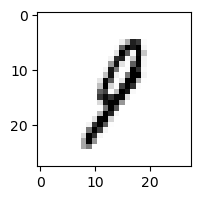

2.2996444555672958e-08% - 0
74.5685424854208% - 1 - ОШИБКА
0.000748267860144495% - 2
0.05431684754128817% - 3
9.307934721674964e-05% - 4
0.0007069130379568711% - 5
0.00019376736006947924% - 6
0.03063204442012752% - 7
16.477910166715468% - 8
0.019248433989272312% - 9

 3


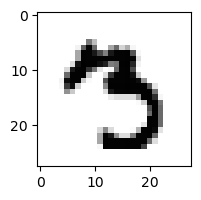

9.73279593772345e-19% - 0
1.4379012492096667e-11% - 1
4.5195213396557295e-28% - 2
7.651107980665158e-08% - 3
4.906598431787587e-17% - 4
0.33607232822198935% - 5 - ОШИБКА
7.814213641005351e-24% - 6
0.00213079082027737% - 7
1.565815639654425e-20% - 8
5.691388371077796e-15% - 9

 9


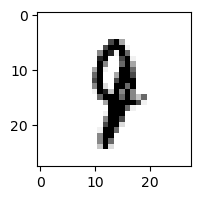

6.234839369579307e-19% - 0
0.09339678905180926% - 1 - ОШИБКА
6.900027261381836e-13% - 2
1.2422509930613241e-12% - 3
0.0034762984981046015% - 4
0.0019405362387915515% - 5
7.612007775398679e-11% - 6
0.041103507499618545% - 7
6.830808180513628e-15% - 8
1.7046202865290634e-08% - 9

 6


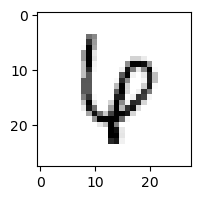

9.066201395733168e-10% - 0
1.6931932886932846e-06% - 1
7.614904502548563e-07% - 2
2.242980578788552e-18% - 3
92.16195675306926% - 4 - ОШИБКА
8.711773179938679e-08% - 5
0.0006557041953257045% - 6
51.8995842108602% - 7
6.368546743680825e-13% - 8
2.8079447959402877e-10% - 9

 8


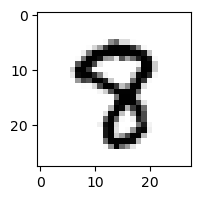

4.488372526018495e-16% - 0
2.0181442914151175e-12% - 1
1.0392353953789737e-22% - 2
5.868765389062339e-16% - 3
2.9636832616499642e-09% - 4
0.002138828824957756% - 5
5.259918938069231e-18% - 6
0.04520709320649743% - 7 - ОШИБКА
3.7597637079570204e-10% - 8
1.8602254484530844e-12% - 9

 8


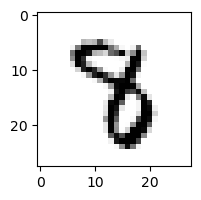

1.1126603582071885e-23% - 0
1.2070094921606955e-05% - 1
1.4941573240787234e-16% - 2
1.603488655265255e-07% - 3
1.5197829969600664e-07% - 4
0.0007007524485115417% - 5
3.732645497033175e-16% - 6
0.027108312625228184% - 7 - ОШИБКА
1.9577584629269274e-23% - 8
1.3279239931954656e-27% - 9

 2


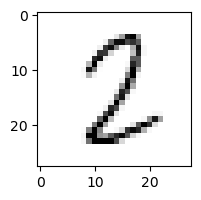

3.2274932531995976e-05% - 0
0.2328856456564271% - 1
62.12804160413834% - 2
2.4963819842133263e-05% - 3
8.719407162685455e-07% - 4
0.7482239320873165% - 5
6.505742574463035e-09% - 6
0.0051861085313890335% - 7
68.4008064578789% - 8 - ОШИБКА
1.445037314875452e-20% - 9

 2


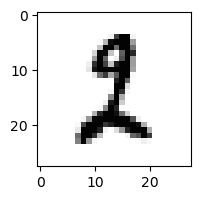

6.21708242635814e-16% - 0
1.027575358394503% - 1 - ОШИБКА
0.001509985201975594% - 2
1.5306850749940728e-19% - 3
2.090873477288458e-22% - 4
0.019191440754955706% - 5
5.606096348670556e-10% - 6
9.02505845007898e-07% - 7
1.2837126545230591e-21% - 8
3.6040326893196605e-30% - 9

 9


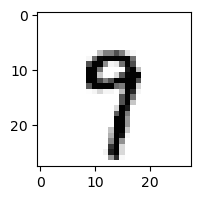

1.352972652636563e-13% - 0
9.656718640676508e-05% - 1
3.559906655495012e-18% - 2
3.385329120166563e-10% - 3
0.0029950797579798524% - 4
0.012002108946416215% - 5
5.442891535116813e-09% - 6
20.016154002454307% - 7 - ОШИБКА
1.8466566857305998e-08% - 8
0.7832157402412584% - 9

 4


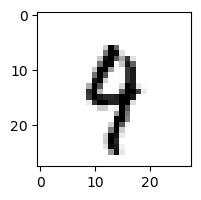

2.248753169332959e-13% - 0
1.3147430816986904e-06% - 1
1.1265815508447551e-10% - 2
2.43738358604212e-12% - 3
4.43271396420756% - 4
0.1994200993586164% - 5
1.331152708736566e-05% - 6
8.681886108814627% - 7
4.9479194736950704e-08% - 8
45.36794595314029% - 9 - ОШИБКА

 0


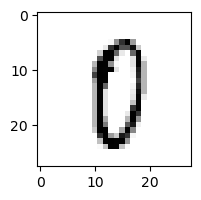

4.479879504231691% - 0
3.4565051802877006e-10% - 1
3.615534321534967e-10% - 2
2.545860775800524e-10% - 3
1.2638576000941482e-06% - 4
51.64492991897117% - 5
0.0001912029340893353% - 6
0.04949172025514658% - 7
99.9999651760795% - 8 - ОШИБКА
4.579449124829772e-07% - 9

 3


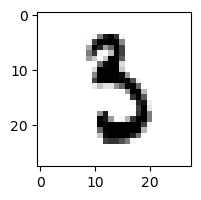

1.8044668477283655e-13% - 0
7.495727685779376e-06% - 1
2.4283658843010457e-16% - 2
0.0004514501170163856% - 3
1.3454326096492854e-16% - 4
1.7093006663927854% - 5 - ОШИБКА
0.00021135941670749083% - 6
2.963878734956717e-05% - 7
6.722037985871581e-22% - 8
5.182342865137812e-26% - 9

 6


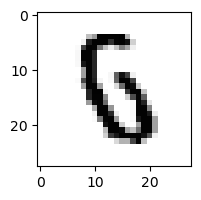

1.6345573741405107e-17% - 0
1.1869409824933887e-10% - 1
5.676205593340846e-06% - 2
2.8494646129394786e-16% - 3
2.3777135731624148e-05% - 4
0.025795200430213584% - 5 - ОШИБКА
0.002263273188599632% - 6
7.563763841804801e-10% - 7
3.927045178507968e-30% - 8
1.2130669424442226e-27% - 9

 2


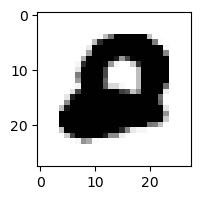

3.8792111280847577e-16% - 0
1.3653915445602645e-33% - 1
7.280225375292132e-19% - 2
7.354139365437978e-56% - 3
1.115855615493146e-27% - 4
5.162110910616181e-14% - 5 - ОШИБКА
1.7227300274029955e-23% - 6
1.0868228973340856e-23% - 7
9.177196640957336e-55% - 8
7.167852396670433e-66% - 9

 8


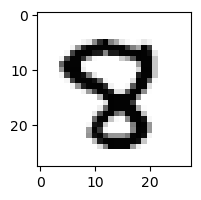

5.0002182060297505e-20% - 0
4.943491646511827e-18% - 1
1.0771750777607767e-23% - 2
1.6502291580827662e-23% - 3
3.461022230951752e-12% - 4
4.6832278317332385e-06% - 5 - ОШИБКА
1.4412510298198494e-23% - 6
7.24544028842258e-08% - 7
3.953843812244372e-16% - 8
2.0054078222747668e-25% - 9

 9


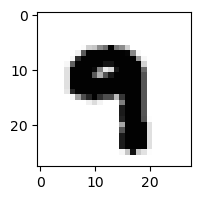

4.600132316714617e-26% - 0
4.707441715465839e-16% - 1
1.2971942179989618e-43% - 2
1.1322529259505847e-22% - 3
1.5224679355646834e-11% - 4
0.0027873182945392125% - 5 - ОШИБКА
3.581531723842533e-24% - 6
1.2728722781896121e-05% - 7
2.2053535054603158e-42% - 8
1.189769678899551e-10% - 9

 2


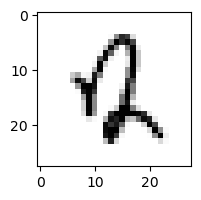

3.170061050852023e-05% - 0
9.262573974402508e-08% - 1
0.0006402981137532482% - 2
1.1106070052738071e-17% - 3
0.0009400179470333788% - 4
0.3532607004788792% - 5 - ОШИБКА
0.0013520282195282275% - 6
5.6323203035535036e-05% - 7
3.2723403770880213e-18% - 8
2.3431306202966857e-12% - 9

 9


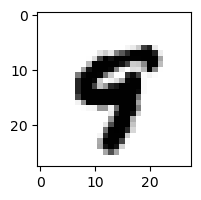

4.195094786170179e-22% - 0
5.986925353688884e-14% - 1
1.063094596322919e-34% - 2
5.035246600008633e-31% - 3
9.860276105153203e-06% - 4
0.2425649121909007% - 5 - ОШИБКА
5.855336403173304e-20% - 6
3.367780673576471e-05% - 7
1.505126609322807e-24% - 8
4.851849899439612e-10% - 9

 7


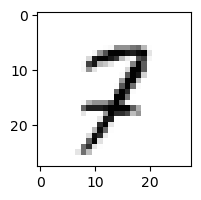

4.988709346060887e-10% - 0
0.004592601554840506% - 1
4.611621224853403% - 2
4.1419777672113033e-13% - 3
8.315026755036884e-06% - 4
2.7416741380570596e-07% - 5
4.743354920287051e-10% - 6
91.42833753596013% - 7
0.03925545486829283% - 8
92.38093248586492% - 9 - ОШИБКА

 8


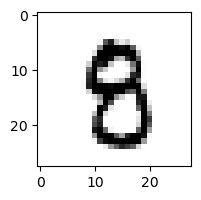

1.6792959014085323e-13% - 0
1.9304403355262418e-10% - 1
1.6008114971327257e-16% - 2
9.293528962192332e-11% - 3
1.857673244839791e-10% - 4
0.14795256138405397% - 5 - ОШИБКА
4.336542684635561e-15% - 6
2.5409331959496614e-08% - 7
0.0006351622555780797% - 8
4.330145433102834e-07% - 9

 9


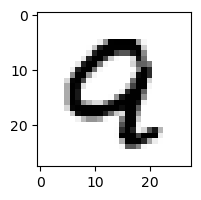

1.1972891082383e-12% - 0
2.88020196659706e-14% - 1
3.194730963627527e-07% - 2
1.7424104142384504e-39% - 3
3.4385000049101214e-06% - 4 - ОШИБКА
1.1183402863288059e-11% - 5
6.7038410098224246e-15% - 6
1.3124524743279924e-07% - 7
1.1969489043627759e-14% - 8
1.951478574262329e-15% - 9

 8


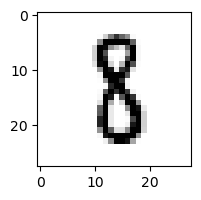

5.3230644856022555e-17% - 0
0.4302992378975619% - 1
2.8541233743565138e-09% - 2
4.110637914507464e-05% - 3
1.3936668231916774e-12% - 4
0.4483243598753175% - 5 - ОШИБКА
9.199519696193405e-11% - 6
6.621136315807475e-07% - 7
4.110981835503342e-10% - 8
2.5025713150456983e-25% - 9

 3


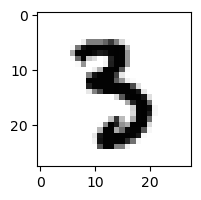

5.574542846105979e-19% - 0
3.687909643372418e-12% - 1
1.314811350626672e-26% - 2
2.39395663621648% - 3
3.899272896408218e-14% - 4
5.014323473984969% - 5 - ОШИБКА
2.5957457571363288e-12% - 6
1.1414298562725687e-06% - 7
2.658788312303206e-24% - 8
6.106006730334656e-28% - 9

 7


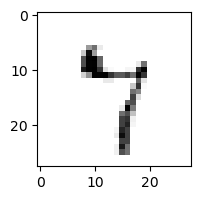

6.352884903431905e-05% - 0
1.4765208382197536e-05% - 1
1.744096143571815e-06% - 2
1.503265328644822e-05% - 3
8.754513988392112% - 4
1.2729868754112612% - 5
0.00819977427561659% - 6
99.92188087837137% - 7
99.9960302559133% - 8 - ОШИБКА
0.0011386170172681957% - 9

 3


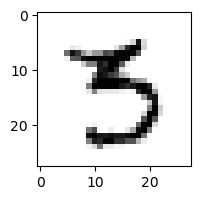

1.3287733838451528e-08% - 0
3.056410906561069e-09% - 1
3.9234064190187335e-21% - 2
1.5372489834361012% - 3
1.1623218186247986e-11% - 4
28.864212980911287% - 5 - ОШИБКА
1.1953019292232606e-12% - 6
0.000131652319520854% - 7
8.732349611001573e-10% - 8
1.0960264410675115e-12% - 9

 6


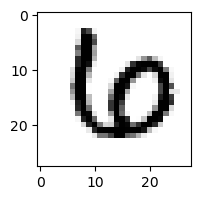

5.73716527707747e-13% - 0
5.243136290773308e-12% - 1
1.1374262631438871e-15% - 2
5.504462509583857e-21% - 3
3.27946790773461e-10% - 4
6.060454756976208e-17% - 5
1.5265423765431917e-10% - 6
3.2246276485649e-08% - 7 - ОШИБКА
3.0072902069396198e-25% - 8
1.7355720874795762e-37% - 9

 9


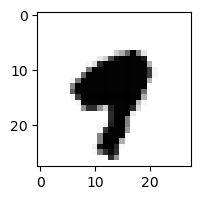

4.3411993922165264e-26% - 0
1.0435162947714797e-12% - 1
1.6706036963611186e-44% - 2
3.4251960826458624e-34% - 3
6.365163858838405e-05% - 4 - ОШИБКА
5.772719601523983e-09% - 5
2.822039741057215e-20% - 6
4.175556867741385e-06% - 7
3.017894928779863e-33% - 8
9.112419371251224e-10% - 9

 8


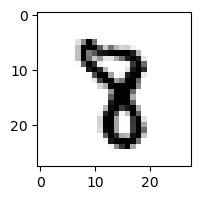

3.435626274890258e-24% - 0
4.2552570546458845e-08% - 1
7.840726225034446e-18% - 2
3.403119717272966e-14% - 3
1.6187409767650604e-09% - 4
0.00019136689769650404% - 5
9.074602364147852e-17% - 6
0.04697927320352645% - 7 - ОШИБКА
2.932747836909511e-11% - 8
2.1810847532977732e-20% - 9

 5


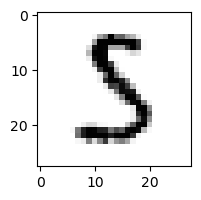

2.700778283508088e-10% - 0
4.980935370452467e-05% - 1
1.8250046423437424e-07% - 2
94.43370651409451% - 3 - ОШИБКА
3.570173230412775e-14% - 4
57.009394906641205% - 5
1.091687611618285e-10% - 6
4.926411183009148e-07% - 7
4.7720055030783504e-11% - 8
1.4100054552182886e-31% - 9

 3


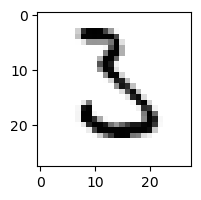

2.1973916815735227e-06% - 0
2.427322654030087e-05% - 1
70.52822304668574% - 2 - ОШИБКА
2.1492258449914443% - 3
4.9916715931846245e-17% - 4
0.0036075235673027695% - 5
0.28190166171347086% - 6
1.1050013524777422e-08% - 7
1.6145291913350617e-15% - 8
9.359926285145092e-19% - 9

 9


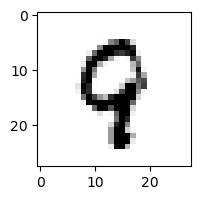

2.0769931649594822e-15% - 0
9.91770024977586e-08% - 1
2.6674220999538778e-09% - 2
5.337600190360071e-23% - 3
0.005383403790389159% - 4 - ОШИБКА
0.0011513842638965096% - 5
8.98578691529321e-09% - 6
0.002337549127282184% - 7
4.936704319674024e-07% - 8
9.171108877930933e-06% - 9

 5


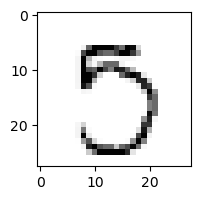

2.3860119339029093e-06% - 0
1.0329403474213659e-10% - 1
2.5642713027758677e-14% - 2
0.012423254018081607% - 3
3.510912625611244e-12% - 4
45.011894207210155% - 5
2.6418679509957536e-08% - 6
94.8563340710857% - 7
1.532201888045276e-10% - 8
98.666548248669% - 9 - ОШИБКА

 7


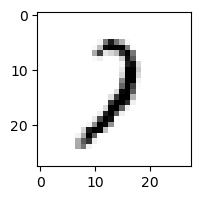

8.359512589865993e-08% - 0
76.55872844936488% - 1 - ОШИБКА
71.03835558796877% - 2
0.007975727245562796% - 3
1.341694261327159e-05% - 4
5.691942812792694e-05% - 5
1.3690771432466422e-06% - 6
54.15593757511586% - 7
1.3262029731047543e-10% - 8
1.311592822839444e-05% - 9

 9


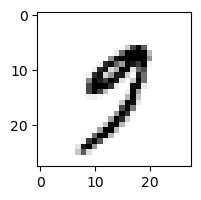

0.0025339284730129565% - 0
4.717416862824637e-07% - 1
1.3593798030006704e-19% - 2
0.0028597689197122265% - 3
0.0003589014683205502% - 4
0.0192255970157326% - 5
1.4344289460525098e-13% - 6
2.5198384921927826% - 7 - ОШИБКА
5.136248553008479e-19% - 8
0.008825647230406701% - 9

 8


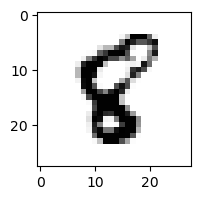

1.2385936529592321e-17% - 0
3.819174863906349e-09% - 1
2.987632170372473e-14% - 2
1.0686086290421614e-35% - 3
5.273559631781911e-10% - 4
0.15893667670828726% - 5 - ОШИБКА
2.513221097197068e-09% - 6
8.499940939448349e-11% - 7
1.622148062257068e-05% - 8
1.8348412792539802e-17% - 9

 9


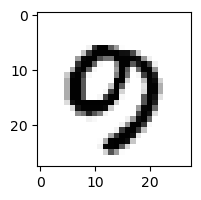

5.294563987610177e-11% - 0
1.0452536059604233e-11% - 1
7.088397611111727e-26% - 2
1.490070656018831e-22% - 3
1.5753889076023405e-13% - 4
8.171624618469418e-14% - 5
3.571615273118975e-17% - 6
0.0041999527063107224% - 7 - ОШИБКА
1.807259581567043e-23% - 8
6.009016913755239e-15% - 9

 8


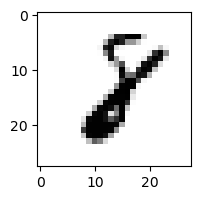

3.1947365965923553e-16% - 0
0.8370268473932142% - 1 - ОШИБКА
0.14852248806577434% - 2
9.734357815979628e-18% - 3
2.8492245872803824e-11% - 4
4.5281747968858053e-08% - 5
5.18102039830049e-09% - 6
0.0003816165042478303% - 7
0.040897551947932965% - 8
1.6472065563319486e-24% - 9

 8


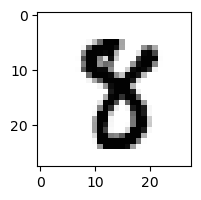

3.0666710068158477e-25% - 0
5.417532429473294e-11% - 1
2.8810701161842758e-27% - 2
1.2416240167424472e-14% - 3
1.5466547917129978e-15% - 4
0.010193227470870226% - 5 - ОШИБКА
8.970319134318649e-26% - 6
3.796780976788265e-05% - 7
0.0006416506051488047% - 8
2.158935048231051e-34% - 9

 5


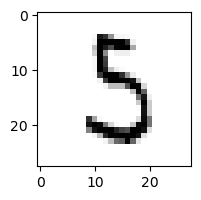

4.2400766242066915e-06% - 0
0.007432439888199642% - 1
8.342636041084317e-07% - 2
98.31857749869145% - 3 - ОШИБКА
7.3117736764821e-11% - 4
70.08138145694825% - 5
4.923873866749824e-05% - 6
9.180258560740007e-07% - 7
8.805844082772671e-07% - 8
6.960526530243846e-24% - 9

 7


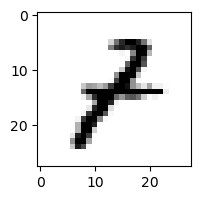

4.265947981534768e-08% - 0
0.1657676208805944% - 1 - ОШИБКА
0.0005070925975834385% - 2
1.6618375436375137e-06% - 3
6.570586347941301e-05% - 4
1.7538288960246695e-05% - 5
9.785942007152177e-10% - 6
1.7482214125677213e-08% - 7
3.585939885695598e-11% - 8
8.68850175792874e-12% - 9

 2


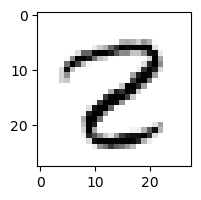

8.62988263411221e-12% - 0
6.558164294668092e-07% - 1
0.00203483482358486% - 2
2.0156821449836694e-16% - 3
2.9943790398937563e-12% - 4
6.705282588954791e-07% - 5
1.936831870980729e-16% - 6
0.00034120819977433365% - 7
100.0% - 8 - ОШИБКА
4.251795797179962e-15% - 9

 5


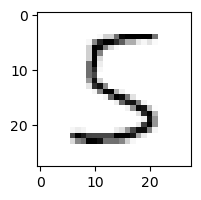

1.4617272667146693e-05% - 0
5.681743031512288e-06% - 1
0.006976995746564487% - 2
77.46222956954257% - 3 - ОШИБКА
0.043903443083251475% - 4
63.736070725095736% - 5
1.7792302354816853e-06% - 6
5.719386376957143e-07% - 7
3.8160852587663186e-07% - 8
1.7484781685748375e-21% - 9

 0


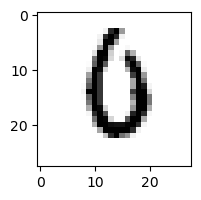

0.0040172423447321845% - 0
1.2334389382287657e-12% - 1
3.798010275992454e-07% - 2
5.83981669379374e-15% - 3
2.5849873205559745e-08% - 4
0.004279069949476724% - 5
97.59833300511148% - 6 - ОШИБКА
0.006893884570299169% - 7
5.035304328613943e-23% - 8
4.9917625877428347e-14% - 9

 2


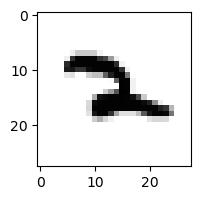

1.8190156740992896e-23% - 0
0.0005508767694093182% - 1
2.796001125460767e-06% - 2
3.474198912226205e-22% - 3
0.00017093051394559763% - 4
1.6746978756931654e-05% - 5
1.4419657976408385e-06% - 6
74.29178480043947% - 7 - ОШИБКА
2.2105070748518395e-09% - 8
1.929034129553054e-14% - 9

 8


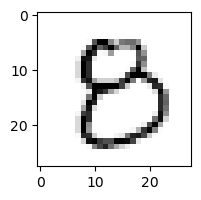

3.941936144413104% - 0 - ОШИБКА
1.3044903586922335e-11% - 1
3.7999539443534114e-07% - 2
5.120109457931372e-05% - 3
8.265416695939487e-06% - 4
6.749554625145394e-06% - 5
4.907710557725093e-12% - 6
6.857247120535352e-11% - 7
0.018134201882300204% - 8
2.516663431928513e-15% - 9

 4


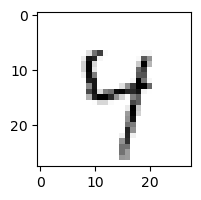

2.6965212479442563e-06% - 0
5.341054069402053e-06% - 1
5.491636795687922e-06% - 2
0.08612230876366764% - 3
99.97074481374192% - 4
2.63149285385645% - 5
0.32751346464591496% - 6
4.31874917591237% - 7
4.847132398426266% - 8
99.99616156343369% - 9 - ОШИБКА

 9


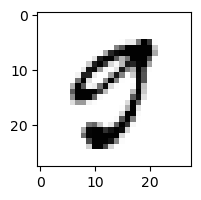

99.35047494609528% - 0 - ОШИБКА
3.7294736297672097e-13% - 1
6.496353610355638e-21% - 2
7.07827068498441e-10% - 3
1.2388848453617912e-09% - 4
2.6044617123791873% - 5
1.101330344258923e-17% - 6
0.00028794792855609853% - 7
4.803807704701656e-21% - 8
5.842617165448163e-11% - 9

 6


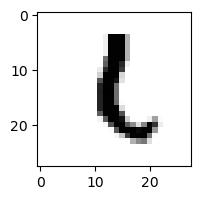

8.2922677319409e-19% - 0
42.29715840854968% - 1 - ОШИБКА
0.00047894751400842243% - 2
1.7835677663926538e-14% - 3
3.6315237065038336e-12% - 4
0.009232403957568107% - 5
0.00028893633618913236% - 6
4.754034869918439e-13% - 7
7.355609923828647e-13% - 8
9.482066315013055e-13% - 9

 5


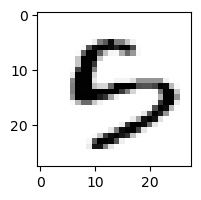

0.0019264824404487046% - 0
2.7057930579830705e-12% - 1
3.265822707105304e-16% - 2
6.024592510903217e-10% - 3
1.673104838566715e-05% - 4
0.005700644273323216% - 5
0.2348726633840855% - 6 - ОШИБКА
1.858525650925439e-12% - 7
6.738178495896266e-14% - 8
9.201781380582297e-13% - 9

 5


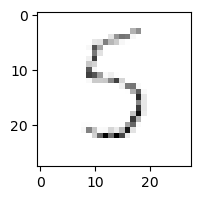

17.457978984719823% - 0
0.5711610689591543% - 1
6.610720371552032% - 2
99.97602468461933% - 3 - ОШИБКА
51.32141329642812% - 4
40.10535641061212% - 5
97.71046627955418% - 6
5.109342895458581% - 7
99.5882635229896% - 8
0.07695178690585283% - 9

 8


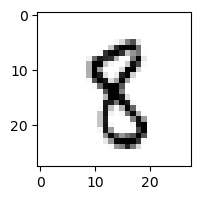

7.380203836739637e-17% - 0
0.0007933832756465328% - 1
2.799124555566464e-13% - 2
1.882194222095868e-08% - 3
9.786465386903857e-06% - 4
0.36734240552455416% - 5 - ОШИБКА
1.7563233457303426e-14% - 6
3.0305908103508943e-05% - 7
0.18181143164085842% - 8
1.2154804710458967e-08% - 9

 9


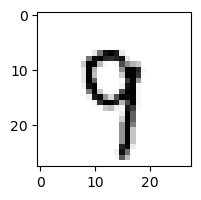

8.07003709894284e-14% - 0
8.1113453301339e-05% - 1
1.7743863090637276e-08% - 2
6.419099462683059e-07% - 3
6.365983029869639% - 4
0.0011901234565539908% - 5
5.8487687686791006e-08% - 6
79.87684225734722% - 7 - ОШИБКА
5.931847461174853e-10% - 8
69.36658464018143% - 9

 7


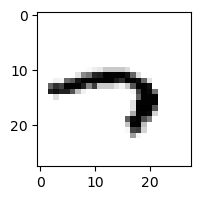

1.3193929964892602e-06% - 0
0.000990885111685637% - 1
1.898096031955879e-28% - 2
71.22661600827095% - 3
99.93910300833384% - 4 - ОШИБКА
85.7865637643337% - 5
99.83415510480074% - 6
1.087035714792492% - 7
8.962687405687526e-18% - 8
0.10082678281654865% - 9

 0


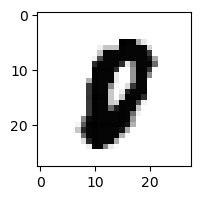

8.704374189519427e-12% - 0
6.914270553545912e-17% - 1
8.914813272700544e-20% - 2
1.7158823691140479e-34% - 3
1.3784073347030873e-18% - 4
1.3800367948556979e-05% - 5 - ОШИБКА
4.772358077805691e-16% - 6
1.9046578356826567e-09% - 7
7.708602113886451e-15% - 8
6.99308294801398e-24% - 9

 9


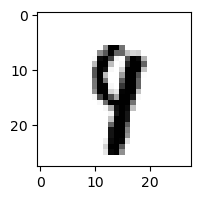

5.781101453673921e-19% - 0
4.0536708528091016e-07% - 1
1.5425232613994823e-16% - 2
1.768896404682961e-13% - 3
0.0015212709010547722% - 4
0.0048178929118531735% - 5
1.328955617125844e-14% - 6
13.057252829124838% - 7 - ОШИБКА
4.866466598949534e-10% - 8
1.4811091388906691e-06% - 9

 6


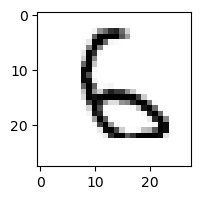

6.45129652589543e-11% - 0
4.873524417512055e-09% - 1
99.49003354895585% - 2 - ОШИБКА
1.773411848533362e-10% - 3
0.0019949797848471873% - 4
0.463489083722064% - 5
80.06282217804362% - 6
2.951932321873628e-10% - 7
1.0334478260550469e-18% - 8
1.7943597019030282e-12% - 9

 6


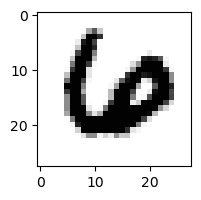

1.1028940507766928e-16% - 0
2.341752483221959e-18% - 1
1.7971401252798118e-22% - 2
1.2720115270781451e-34% - 3
1.8256924452868534e-14% - 4
2.272835201224808e-22% - 5
3.237871809617283e-08% - 6
3.145810021809292e-06% - 7 - ОШИБКА
1.9084166758103017e-38% - 8
1.391100578567436e-50% - 9

 9


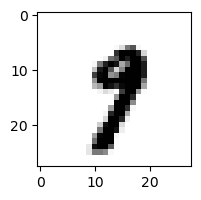

2.380735363250475e-16% - 0
5.480002544679125e-05% - 1
1.5297292820371359e-24% - 2
8.968207228027521e-11% - 3
2.234499941863869e-09% - 4
1.0567446686270796e-05% - 5
9.318984314044815e-17% - 6
13.789431573239124% - 7 - ОШИБКА
6.031482454947715e-13% - 8
5.073684864558665e-07% - 9

 9


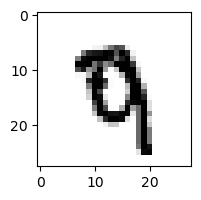

2.5822276862321958e-15% - 0
3.227468880669236e-14% - 1
1.9174299752102534e-10% - 2
4.1269843677746973e-23% - 3
9.459257233649228e-08% - 4
0.0005581849582837638% - 5
2.0529798005731497e-09% - 6
4.270926488773167% - 7 - ОШИБКА
5.846443467573737e-26% - 8
0.004429927732996929% - 9

 5


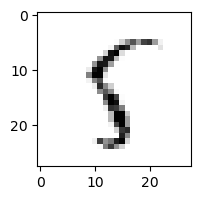

2.2751825898003e-08% - 0
0.07052689849881155% - 1
3.347625104937554e-05% - 2
9.610567474243041e-15% - 3
2.3288994882143803% - 4
93.69482781787407% - 5
0.16019933499662803% - 6
0.0011983592437027% - 7
99.99983724820962% - 8 - ОШИБКА
0.00021050090725582997% - 9

 6


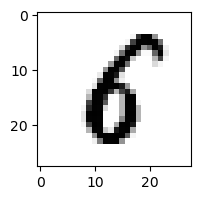

1.0194055154431585e-07% - 0
2.297774126126541e-05% - 1
1.3633749153050143e-10% - 2
8.627047190718651e-17% - 3
4.114941857436576e-09% - 4
6.513213602697637% - 5 - ОШИБКА
0.006087021199164116% - 6
4.310430095614065e-13% - 7
0.000178664899969408% - 8
9.978210999660219e-20% - 9

 1


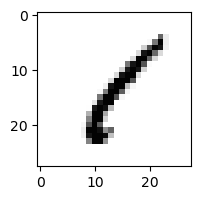

2.9639133206163996e-06% - 0
99.49067547465728% - 1
0.0005235313181845841% - 2
0.00021981832488827746% - 3
0.0010448656175331308% - 4
0.004476750106106729% - 5
4.9244892806263505e-11% - 6
4.4894751801820966e-05% - 7
99.99976341850186% - 8 - ОШИБКА
1.3295891151450162e-07% - 9

 3


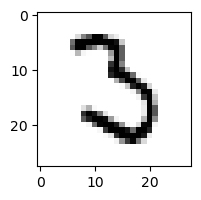

7.53300253509551e-08% - 0
0.0008759817340416671% - 1
91.21308807407517% - 2 - ОШИБКА
82.99161951993679% - 3
1.958403700353562e-15% - 4
5.050594115972823e-06% - 5
0.03869169229887746% - 6
1.8845559011308678e-06% - 7
2.064488217731828e-24% - 8
2.225291025681123e-24% - 9

 8


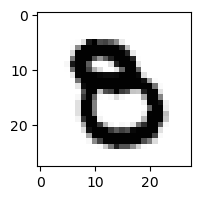

2.496089085959788e-13% - 0
1.878783246505394e-19% - 1
1.2032507748376628e-28% - 2
1.2771014218970492e-14% - 3
6.824356389631515e-19% - 4
0.0005062401901864932% - 5 - ОШИБКА
6.0747831826818184e-21% - 6
1.9599119783391528e-14% - 7
9.647348850260996e-33% - 8
1.3846351339615261e-33% - 9

 9


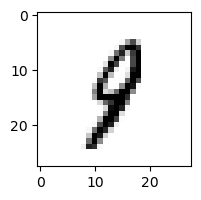

3.494311848875885e-11% - 0
0.5587913486102236% - 1 - ОШИБКА
3.1011076649235806e-07% - 2
2.2280084862252656e-09% - 3
0.017382424236437478% - 4
0.001741684277331013% - 5
5.644775250326758e-06% - 6
0.5400448381074715% - 7
2.4529795885655323e-06% - 8
0.0004406241722210432% - 9

 9


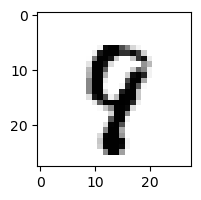

5.997363540433243e-16% - 0
7.309242691293805e-12% - 1
6.343956854029702e-17% - 2
4.489669257102182e-19% - 3
0.00020734419409070795% - 4
0.058632447239313636% - 5
2.152824357304948e-11% - 6
15.13023607086609% - 7 - ОШИБКА
3.452447484250701e-05% - 8
0.3470966023095243% - 9

 3


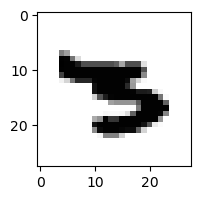

6.088193167214065e-25% - 0
4.976866861745996e-10% - 1
6.592931665046806e-35% - 2
8.69352128465716e-12% - 3
2.0793044291054054e-11% - 4
0.00207548464068585% - 5 - ОШИБКА
3.3788648793943634e-05% - 6
4.853973605594556e-05% - 7
4.817510817401609e-41% - 8
5.1634578256388356e-33% - 9

 4


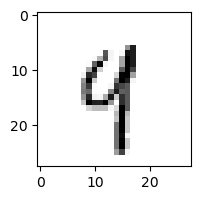

5.887916726637647e-12% - 0
1.3817654774228447% - 1
3.647392868665298e-10% - 2
7.79154038506727e-11% - 3
8.816228743376106% - 4
0.03551093198893589% - 5
9.066075148336951e-07% - 6
2.3291179763694667% - 7
1.5313573972888296e-08% - 8
93.9413159043165% - 9 - ОШИБКА

 2


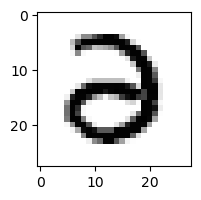

1.545857943151139e-05% - 0
4.465368446915226e-17% - 1
1.2672090861027805e-07% - 2
34.487893335165836% - 3 - ОШИБКА
3.453025129024188e-10% - 4
7.237895263697357e-10% - 5
1.2655927974799986e-15% - 6
2.511301712971768e-16% - 7
2.719869029509981e-38% - 8
4.2453149531137334e-35% - 9

 8


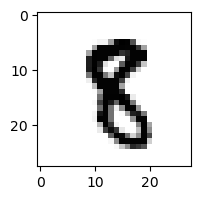

1.6507253498914776e-21% - 0
3.7937014660865886e-06% - 1
2.947139772966627e-17% - 2
5.503892607476247e-16% - 3
2.5835995204572536e-14% - 4
0.018180439439224143% - 5 - ОШИБКА
5.2096289902647555e-21% - 6
6.328346109671676e-09% - 7
7.169862276500281e-16% - 8
3.203305907281021e-21% - 9

 9


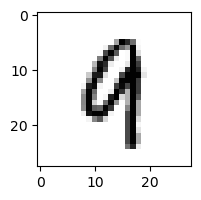

2.4917248803016573e-13% - 0
1.7917933188369492e-05% - 1
2.3485509492920717e-10% - 2
1.4555043316720638e-20% - 3
0.056146410437264066% - 4 - ОШИБКА
5.165672648204975e-07% - 5
7.943707830959328e-09% - 6
0.00169398075252342% - 7
5.12806181689276e-11% - 8
0.009549862675041952% - 9

 5


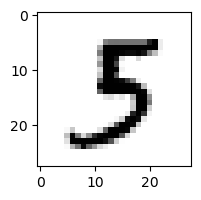

8.085722158911387e-12% - 0
4.6978358991001e-06% - 1
3.044330994860602e-21% - 2
99.75373526858353% - 3 - ОШИБКА
3.124597409675897e-14% - 4
50.91965734705599% - 5
1.821886138249158e-10% - 6
7.276892420326325e-07% - 7
5.2471345850612156e-18% - 8
3.769418999847739e-18% - 9

 8


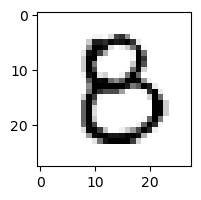

0.00511296727686331% - 0
1.3127534977899194e-11% - 1
8.522783148430257e-09% - 2
0.00018236381767364272% - 3
9.662490896759464e-06% - 4
0.17609768219274205% - 5 - ОШИБКА
3.3846831170889947e-12% - 6
2.595844972213764e-13% - 7
9.308930280839875e-09% - 8
3.899294695371813e-27% - 9

 5


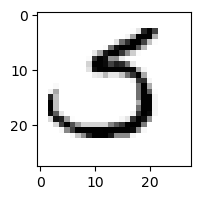

0.0007147462548109399% - 0
2.491317287544779e-08% - 1
0.03012652254854704% - 2
1.9799960747472787% - 3 - ОШИБКА
2.3800652807305848e-18% - 4
0.5399873063613034% - 5
3.2567603515772417e-06% - 6
0.154518995980647% - 7
6.605397496246446e-22% - 8
4.560260011813568e-23% - 9

 8


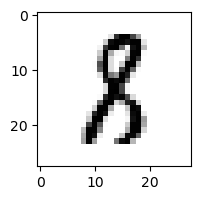

3.2355554442666616e-15% - 0
0.30906559172839043% - 1 - ОШИБКА
4.194211761825044e-07% - 2
3.5980916123496076e-09% - 3
4.841565963702609e-15% - 4
0.014661154697828485% - 5
4.598888014094521e-13% - 6
1.3683082612867918e-09% - 7
3.0695143543333734e-07% - 8
2.4178539456280336e-25% - 9

 3


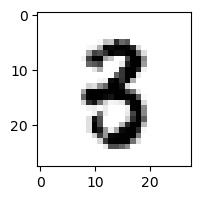

1.967680650381393e-12% - 0
3.844802515363163e-08% - 1
1.5193302620231452e-12% - 2
0.0440675963745226% - 3
3.0431430761258125e-13% - 4
0.07339014625167212% - 5 - ОШИБКА
3.2494255360197955e-19% - 6
1.851361283446156e-08% - 7
4.288137940360364e-18% - 8
3.484910324411558e-20% - 9

 9


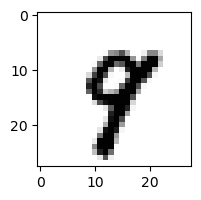

1.1821932656658239e-17% - 0
1.457852703867885e-09% - 1
2.9672346115015836e-21% - 2
3.804833738052218e-18% - 3
0.00017787437738994174% - 4
1.3353299427887252e-06% - 5
1.0284621534676253e-16% - 6
38.84402679401146% - 7 - ОШИБКА
5.435306768774202e-10% - 8
9.00314342657186e-06% - 9

 8


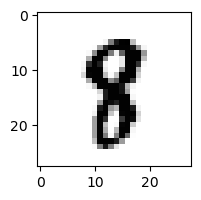

4.3597532047006667e-20% - 0
7.25932577224478e-07% - 1
1.3409574827447997e-19% - 2
3.841067318516042e-19% - 3
6.541302691282796e-11% - 4
0.05449871070007193% - 5 - ОШИБКА
2.3303340968983852e-17% - 6
3.4136072366143655e-07% - 7
0.04079347243718879% - 8
3.794567164167918e-18% - 9

 8


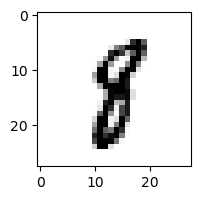

1.1542347046847964e-16% - 0
0.005037784076358374% - 1
3.339984690864063e-17% - 2
9.906795766544048e-13% - 3
3.418854309871266e-09% - 4
0.23073269718190853% - 5 - ОШИБКА
1.199498195756478e-11% - 6
4.225751396185122e-06% - 7
0.06169303083999792% - 8
2.233177853617855e-12% - 9

 9


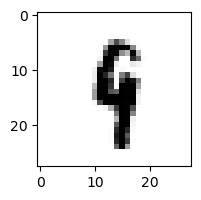

1.6192423323183763e-20% - 0
0.00011081567574000062% - 1
6.158823223851218e-14% - 2
1.2615561725213636e-09% - 3
0.18424006552817607% - 4
0.6901160810581685% - 5 - ОШИБКА
6.182770475182138e-08% - 6
2.6773152036911878e-05% - 7
8.781689169051735e-05% - 8
0.009749016917207443% - 9

 8


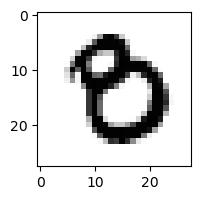

0.0029800483100362353% - 0 - ОШИБКА
4.0245977755629235e-16% - 1
2.1682223302587724e-23% - 2
1.972606469809566e-12% - 3
6.345353007395016e-22% - 4
1.1062801661735355e-13% - 5
7.425626165839509e-14% - 6
9.606264416350711e-13% - 7
1.2226645122679677e-30% - 8
6.408035900113287e-36% - 9

 8


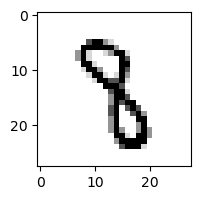

2.0422318556381246e-21% - 0
0.004031996594056902% - 1
2.452286569160632e-11% - 2
6.460542410082813e-07% - 3
9.241332355947768e-05% - 4
0.043062230714525314% - 5 - ОШИБКА
6.542887060306591e-12% - 6
3.522286128774816e-05% - 7
3.721399106036929e-15% - 8
7.182530057443569e-16% - 9

 3


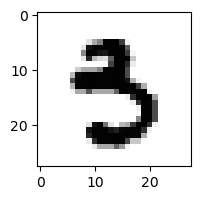

4.796216293141047e-14% - 0
3.160123898620023e-12% - 1
4.169320037696037e-39% - 2
3.083365026996193e-05% - 3
5.169639377669468e-16% - 4
68.99030674255062% - 5 - ОШИБКА
3.9452362754182386e-16% - 6
8.210492873946906e-09% - 7
3.40319796667759e-33% - 8
5.356973119388285e-27% - 9

 4


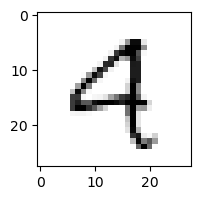

0.00019307614733265617% - 0
2.061976805162629e-07% - 1
5.022551932775797e-07% - 2
2.521611069805919e-14% - 3
74.2787954669658% - 4
5.518695020568325e-06% - 5
4.086789334167063e-08% - 6
0.011437108029322445% - 7
1.3000370747655159e-14% - 8
96.10604288481748% - 9 - ОШИБКА

 3


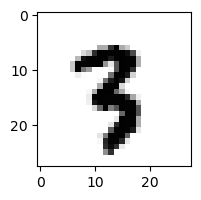

1.5389679170959766e-22% - 0
1.470488854342514e-07% - 1
4.914826155150611e-15% - 2
2.360270424702484e-11% - 3
3.18676342922085e-14% - 4
0.00905949297029429% - 5 - ОШИБКА
4.454770370197008e-18% - 6
0.0002021249990529641% - 7
9.911523261033625e-14% - 8
1.7468320223702344e-15% - 9

 9


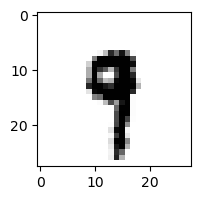

2.9163764904589824e-22% - 0
0.005085021288895066% - 1
2.8487262284462953e-21% - 2
1.8778114757970114e-14% - 3
1.2114614074997536e-05% - 4
0.0050318991055920735% - 5
2.384931057638912e-13% - 6
0.027363337811118327% - 7 - ОШИБКА
8.879060931205635e-17% - 8
0.0015305326123473942% - 9

 5


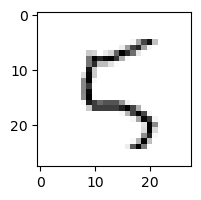

0.012514426234750482% - 0
0.0001026300264762903% - 1
98.2089250448868% - 2
8.006620689969317e-11% - 3
10.818964146988398% - 4
1.7038413723387547% - 5
2.5654523221711516% - 6
0.0010723002611487122% - 7
0.021731828509609717% - 8
99.99995705395513% - 9 - ОШИБКА

 3


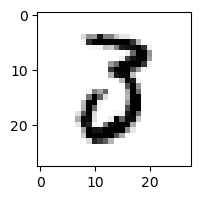

0.393694107815721% - 0
1.4089153672111102e-07% - 1
70.09470122199983% - 2 - ОШИБКА
0.005545593468767334% - 3
2.071693279175854e-14% - 4
4.623385807893604e-05% - 5
1.7930821830121863e-16% - 6
1.052168944171178e-05% - 7
4.759522148075505e-24% - 8
1.6487323869382273e-29% - 9

 5


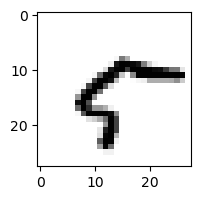

99.71318008225268% - 0 - ОШИБКА
6.523486025238229e-06% - 1
5.018984838722919e-14% - 2
2.1567539359254434e-15% - 3
0.0014625585480832382% - 4
1.1588993274891792e-16% - 5
0.0009370253265101864% - 6
0.28724337353628027% - 7
0.00036739956971773655% - 8
7.350036808311573e-10% - 9

 3


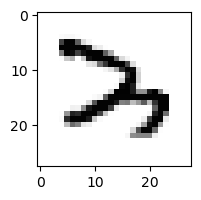

1.7174203285572823e-16% - 0
2.3067607228688247e-08% - 1
99.99998661101903% - 2 - ОШИБКА
8.814334518646484e-06% - 3
1.4712299170411952e-07% - 4
1.908709679873283e-11% - 5
3.5956236300095604e-08% - 6
0.0016006048298702353% - 7
2.122065788603137e-17% - 8
3.8761092255763123e-20% - 9

 9


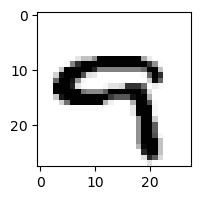

2.7651732302100933e-10% - 0
2.109096567624706e-12% - 1
9.438350160315749e-17% - 2
1.834479922435239e-20% - 3
2.9440994094395696e-06% - 4
1.579478024373667e-10% - 5
2.4636670328066968e-17% - 6
0.007935273380901275% - 7 - ОШИБКА
2.0220629913213972e-30% - 8
0.0031230030951959987% - 9

 5


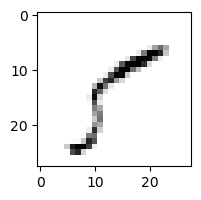

99.92352423500843% - 0
41.24621930696652% - 1
1.4036000947304607e-05% - 2
99.99928343782518% - 3 - ОШИБКА
9.043549570464709% - 4
3.5359732563830875% - 5
2.6882651237300143e-09% - 6
40.655052058442% - 7
0.0013392474816102539% - 8
5.595503625068115e-05% - 9

 3


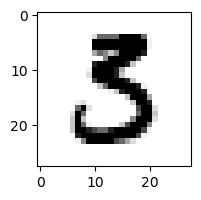

6.222665137476713e-11% - 0
3.517361576783673e-11% - 1
4.681453050764122e-16% - 2
6.017878022756097e-05% - 3
1.5701674019372895e-25% - 4
2.3418950947325072% - 5 - ОШИБКА
2.251813601279268e-20% - 6
5.905880574711905e-12% - 7
7.678211910195981e-29% - 8
2.733524242663562e-38% - 9

 3


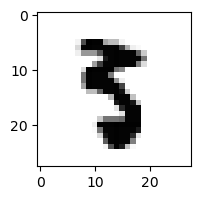

8.807271617142413e-18% - 0
1.6879273200730751e-12% - 1
9.78831620135123e-27% - 2
7.703905969166974e-14% - 3
9.777362800221605e-16% - 4
44.16796342177711% - 5 - ОШИБКА
5.252959984922592e-15% - 6
2.765239035333766e-07% - 7
9.374156372351328e-23% - 8
6.015979074501711e-22% - 9

 5


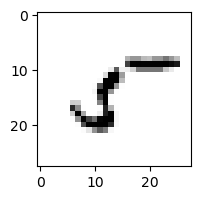

0.31778074460824585% - 0
0.60582510907364% - 1
0.01347519732519276% - 2
0.052465746385678705% - 3
1.7035360372703398e-05% - 4
98.50707617174595% - 5
4.477850735594867e-05% - 6
4.259756080205323e-06% - 7
99.95392821947155% - 8 - ОШИБКА
3.794234139390946e-12% - 9

 8


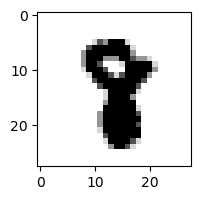

3.3945582823116263e-31% - 0
1.2584090756052257e-10% - 1
6.130613464219296e-26% - 2
4.4936900113129945e-24% - 3
7.33222166338882e-17% - 4
1.3969500398810112e-07% - 5
4.85751293240985e-23% - 6
2.586060616613888e-05% - 7 - ОШИБКА
7.69188894059748e-17% - 8
2.432517994272138e-32% - 9

 5


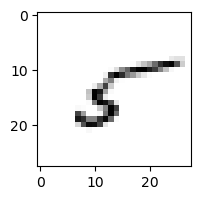

0.3474805262582698% - 0
4.329499502906235% - 1
95.06996383909436% - 2
0.000786228578128113% - 3
0.7491658438099459% - 4
11.604626749813244% - 5
0.6747519845058423% - 6
0.003089720502166773% - 7
99.9529366189688% - 8 - ОШИБКА
1.585860978582939e-05% - 9

 5


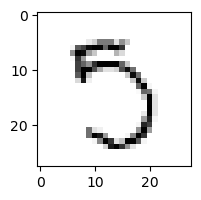

0.0040024966771580175% - 0
5.538067284993912e-07% - 1
0.016086767121079565% - 2
0.3048693443057154% - 3
7.550374498529936e-06% - 4
4.955025554661328% - 5
6.53045214256773e-10% - 6
21.6672480580323% - 7 - ОШИБКА
4.945032983828866% - 8
3.677720146503073e-12% - 9

 5


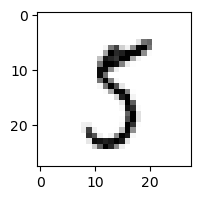

0.00012239169226336636% - 0
0.0011331521105931565% - 1
2.2287500448003396e-09% - 2
0.5333991485910833% - 3
2.0086129957936893e-09% - 4
73.28376810685648% - 5
7.183526349731656e-08% - 6
0.01826156501975611% - 7
99.61285406667339% - 8 - ОШИБКА
0.9628937283246166% - 9

 8


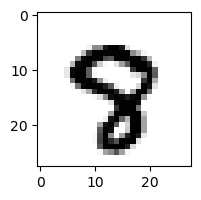

2.6498174650959717e-18% - 0
1.0185702277589558e-19% - 1
1.5985706551919654e-29% - 2
5.237074880754157e-23% - 3
3.1282602586200657e-12% - 4
8.218639532675446e-05% - 5
4.9597544270016315e-22% - 6
0.03345661238346894% - 7 - ОШИБКА
4.317125104383794e-21% - 8
1.5134965833099973e-15% - 9

 6


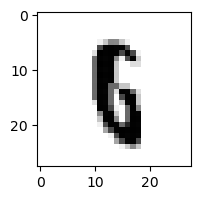

1.340744565399318e-19% - 0
4.339356945864391e-06% - 1
5.671893145000062e-13% - 2
9.697493782502547e-17% - 3
1.8656054542382925e-10% - 4
10.422447547476951% - 5 - ОШИБКА
0.0001843591729530614% - 6
3.150484176486094e-08% - 7
5.3580963329580715e-12% - 8
1.4219639125792873e-11% - 9

 4


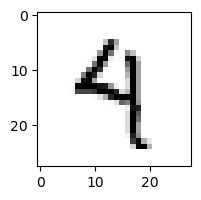

2.3129122806391537e-07% - 0
1.0589620837117348e-05% - 1
5.055056664702111e-13% - 2
1.994422161277479e-05% - 3
92.87840995085081% - 4
1.2071787050260443% - 5
4.4844652703766377e-07% - 6
0.003273752563078956% - 7
8.117854309079301e-12% - 8
96.26524224335569% - 9 - ОШИБКА

 9


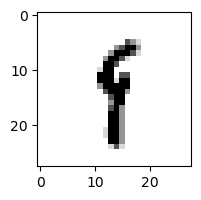

2.2885379074625333e-15% - 0
12.898176733691482% - 1 - ОШИБКА
2.848776195567058e-12% - 2
3.980179470902231e-08% - 3
0.00015201899025605068% - 4
1.2968563165861686% - 5
0.0013845594819141055% - 6
0.003992128717380311% - 7
4.1635544847213515% - 8
0.32269477601102836% - 9

 8


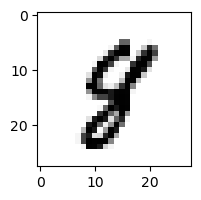

3.8542697846825085e-14% - 0
1.2760934328253845e-06% - 1
4.1974468004777386e-17% - 2
5.980793402615037e-18% - 3
1.6734777659635516e-08% - 4
0.0020484005410744896% - 5 - ОШИБКА
4.942624790268101e-16% - 6
0.0003486521129701134% - 7
3.882198324772113e-08% - 8
3.2948583610358224e-11% - 9

 2


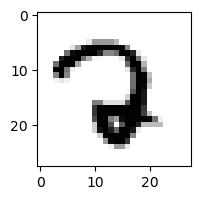

1.4557134033632095e-14% - 0
4.50218498430182e-14% - 1
0.047928367161671745% - 2
1.4424541717630894e-17% - 3
2.1013736403081859e-16% - 4
1.3325876363571932e-09% - 5
6.464010053300719e-10% - 6
1.407398860418334% - 7 - ОШИБКА
8.613670122285742e-20% - 8
1.632707180561576e-31% - 9

 8


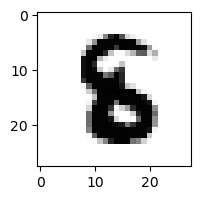

2.2013425712266577e-26% - 0
6.652704302424734e-13% - 1
2.447420616337944e-21% - 2
1.1255694177384676e-25% - 3
1.0520060122607868e-15% - 4
0.3476674899137315% - 5 - ОШИБКА
1.276332083789574e-10% - 6
1.4895862496776347e-18% - 7
3.867696301199858e-26% - 8
3.1421300475923007e-47% - 9

 4


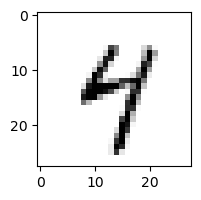

1.610734249941234e-06% - 0
6.275668275131195e-09% - 1
7.315540733751141e-15% - 2
2.272040732744952e-05% - 3
99.82709484496462% - 4
0.8646159627777674% - 5
1.863373168662935e-05% - 6
0.0009474295313549658% - 7
2.4605814164965287e-08% - 8
99.99833721985674% - 9 - ОШИБКА

 6


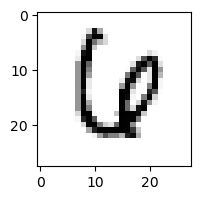

3.609740969430436e-06% - 0
4.9799847152801786e-11% - 1
1.1910325107500543e-07% - 2
2.162030604437356e-10% - 3
0.05130219740943205% - 4
6.505472772977976e-08% - 5
0.0002175863075293259% - 6
0.16028568157111053% - 7 - ОШИБКА
3.002095280978737e-13% - 8
8.4635267301912e-23% - 9

 8


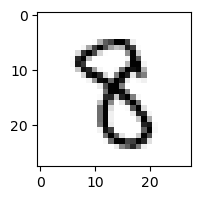

7.245288804662928e-17% - 0
4.479148133040194e-05% - 1
1.9520488315741008e-14% - 2
1.0257862800745434e-05% - 3
9.324990965670732e-06% - 4
0.0033267409412593317% - 5 - ОШИБКА
2.7754062328352925e-15% - 6
2.083334091737385e-05% - 7
8.868152253791306e-06% - 8
4.348866679469162e-20% - 9

 3


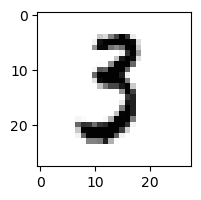

2.071897879529667e-08% - 0
0.0030653192944282044% - 1
4.0378984165286224e-11% - 2
0.027457721520503534% - 3
2.9370324351934425e-16% - 4
2.3222369199756345% - 5 - ОШИБКА
1.4390450735949084e-11% - 6
1.3567043179919742e-06% - 7
2.6704539164468538e-18% - 8
9.182537735327805e-28% - 9

 9


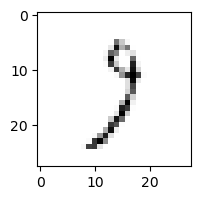

1.3670642328399% - 0
48.89598824991002% - 1
69.87811304819542% - 2
99.91356884183227% - 3 - ОШИБКА
0.2872635690395336% - 4
0.028304627566768253% - 5
0.001989629368053158% - 6
98.15769112817881% - 7
14.087421439091663% - 8
9.84129091092377% - 9

 8


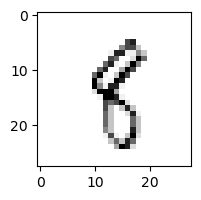

6.744899011725873e-11% - 0
0.8700497404009137% - 1
5.251533987487678e-10% - 2
4.936574586671735e-05% - 3
0.43044183124307706% - 4
1.047752855139781% - 5 - ОШИБКА
1.7594324907900373e-10% - 6
0.0007784448659961603% - 7
0.0002422614496638493% - 8
0.00982162285962057% - 9

 1


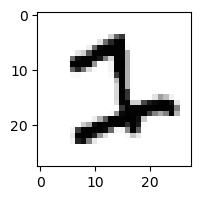

5.089710693105786e-13% - 0
9.847482267711676e-08% - 1
21.736284399609815% - 2 - ОШИБКА
4.814856140187924% - 3
1.7079428494470265e-22% - 4
0.0025353256803685724% - 5
1.982010047664994e-08% - 6
0.3735139199557304% - 7
9.01669542416827e-34% - 8
6.93753802475171e-36% - 9

 7


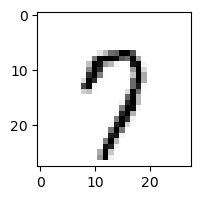

0.00422615826111718% - 0
2.6739564155908424e-08% - 1
4.897684902029736e-10% - 2
1.8601994261673363e-07% - 3
0.00011692199916425458% - 4
0.15928043042972997% - 5
4.1385147901256556e-06% - 6
99.20881482365468% - 7
3.0124167548987263e-05% - 8
99.47335483183139% - 9 - ОШИБКА

 5


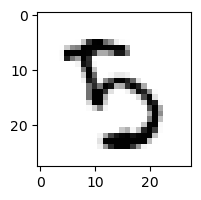

4.22452084682761e-11% - 0
5.306446720398867e-13% - 1
2.2306411233739428e-10% - 2
39.44723524847183% - 3 - ОШИБКА
0.0031741100233428337% - 4
0.5489391088668867% - 5
4.4939593219658286e-10% - 6
4.3995036339996716e-10% - 7
7.015928980670856e-10% - 8
9.676345426915707e-12% - 9

 5


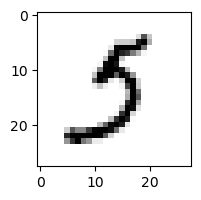

6.139080915033149e-05% - 0
6.937521660623062e-05% - 1
3.864696826106144e-11% - 2
0.033724160240841% - 3
3.4244007753328114e-10% - 4
2.1563104991746638% - 5
4.207357062234452e-06% - 6
9.311150753835772% - 7 - ОШИБКА
8.040446246879513e-18% - 8
1.4969602729430651e-09% - 9

 3


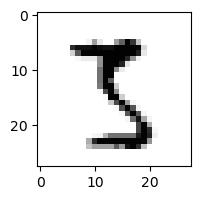

7.977676807638694e-11% - 0
3.122711341578772e-09% - 1
2.2645332138814204e-09% - 2
4.9989938800116365% - 3
5.869918491445277e-14% - 4
13.586010244973767% - 5 - ОШИБКА
3.3112930830755563e-17% - 6
1.3421689172536244e-06% - 7
10.227487946079407% - 8
8.100788090494338e-15% - 9

 3


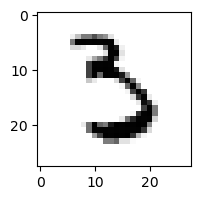

6.447479523302196e-10% - 0
1.4962227580148786e-07% - 1
1.631388008861712e-08% - 2
0.5718206188324664% - 3
1.1846005082576075e-15% - 4
3.462426219902136% - 5 - ОШИБКА
5.4880686756160406e-05% - 6
0.00039602017774148263% - 7
6.5432206631711836e-18% - 8
2.422668379569074e-24% - 9

 8


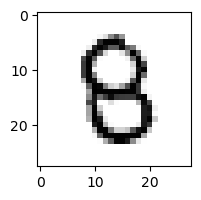

1.359858291831918e-06% - 0
4.948111273274714e-11% - 1
2.55062354430342e-08% - 2
4.883062221600161e-08% - 3
5.209126350807724e-06% - 4
0.009539915946299594% - 5 - ОШИБКА
2.8762378806783028e-08% - 6
5.551827530433707e-09% - 7
6.146552557360645e-11% - 8
9.844267039448971e-19% - 9

 4


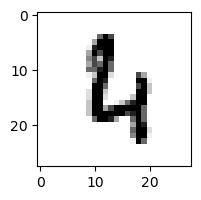

1.0508742653069897e-11% - 0
1.8558654853563898e-12% - 1
9.476548642758202% - 2
1.1359561944432754e-24% - 3
0.2719608992118682% - 4
0.03030869373868721% - 5
42.924728717203884% - 6 - ОШИБКА
1.0831114910745431e-05% - 7
1.2001401686879652e-12% - 8
3.147006628202953e-10% - 9

 5


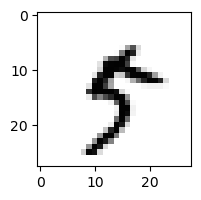

1.6894316408747138e-08% - 0
3.339199143713871e-06% - 1
7.773959664409295e-17% - 2
2.2738595805817556e-05% - 3
0.00027438152832222974% - 4
7.717191191974017e-08% - 5
2.2286839959757286e-06% - 6
0.25725740693764176% - 7
4.293337851182574e-07% - 8
1.000651345400657% - 9 - ОШИБКА

 6


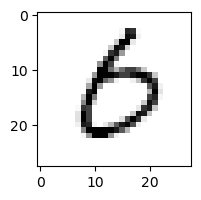

91.81822722613634% - 0 - ОШИБКА
5.173294622138882e-08% - 1
5.953977221560639e-09% - 2
0.00021369443268588753% - 3
1.992900733643966e-08% - 4
5.5916793632627747e-05% - 5
43.808042501535574% - 6
0.0036061355469601364% - 7
9.070639736716642e-13% - 8
4.352224668961487e-13% - 9

 4


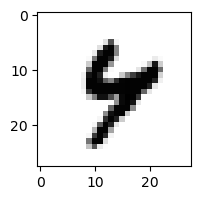

1.755337321798746e-18% - 0
1.5604340997040135e-09% - 1
1.0104960968908679e-21% - 2
1.6395643229538682e-21% - 3
10.988865967569692% - 4
3.861165579137185e-07% - 5
2.4367230578487676e-08% - 6
9.734773101162535e-05% - 7
2.45671633430489e-05% - 8
30.181093811910504% - 9 - ОШИБКА

 7


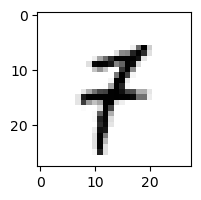

1.7656289805510387e-11% - 0
0.3160020040123742% - 1
1.0224414227572379e-05% - 2
7.54981714321908e-09% - 3
8.837454033871938e-06% - 4
0.0007807330108677465% - 5
2.5596065907410197e-09% - 6
0.004830028736289487% - 7
1.3017453730371192e-15% - 8
0.3700256799526887% - 9 - ОШИБКА

 8


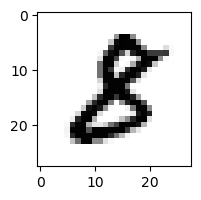

4.8873143385212506e-14% - 0
4.074159180448155e-08% - 1
8.134589556926462e-11% - 2
1.2476081021598797e-06% - 3
1.4905470263228431e-21% - 4
0.0014050242823245296% - 5 - ОШИБКА
2.8374279883768237e-21% - 6
1.0682512485707169e-12% - 7
8.179736097781601e-10% - 8
2.1028041214017598e-29% - 9

 5


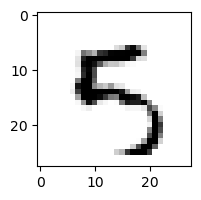

1.3666120695308788e-06% - 0
4.3110286524642075e-12% - 1
8.497339789166129e-08% - 2
3.2871010212696105e-11% - 3
0.00012074040165770713% - 4
33.77689245376589% - 5
2.5912066457115017e-07% - 6
8.346615676832639e-06% - 7
1.4850147113231422e-21% - 8
99.99999999999953% - 9 - ОШИБКА

 9


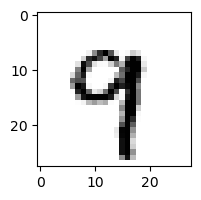

9.418475637017359e-15% - 0
2.1854112659829522e-05% - 1
8.953605359028175e-19% - 2
9.08380577491353e-09% - 3
0.001459449839285468% - 4
0.003355078356464567% - 5
2.1409657985865543e-14% - 6
0.3610645366767191% - 7 - ОШИБКА
7.833460377318025e-23% - 8
0.28368162847940165% - 9

 8


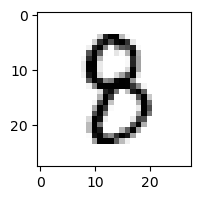

5.667616232016752e-12% - 0
1.5171835262009455e-06% - 1
1.4209865080896733e-12% - 2
1.8769854075539952e-08% - 3
1.3111625353404526e-08% - 4
0.15353251685890437% - 5 - ОШИБКА
4.00073155501051e-10% - 6
7.409652833842706e-09% - 7
0.005303282323360934% - 8
8.652414151449927e-21% - 9

 8


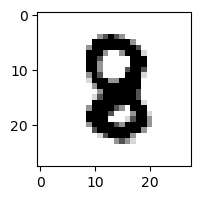

6.207669561336951e-24% - 0
4.3953542800853854e-11% - 1
9.54679036724083e-12% - 2
1.6192204295721031e-22% - 3
1.0246963405733818e-14% - 4
4.672673643588665e-07% - 5 - ОШИБКА
8.845769902324884e-14% - 6
1.6865110388408107e-12% - 7
1.1817550169226536e-17% - 8
4.6586506345773966e-33% - 9

 8


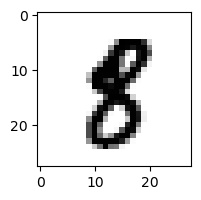

2.807690438837539e-19% - 0
4.561505804327236e-06% - 1
5.354075633256434e-27% - 2
6.297760437921414e-18% - 3
2.4302869036789334e-16% - 4
0.013447054393865189% - 5 - ОШИБКА
2.1857251559783783e-20% - 6
8.667895287258825e-10% - 7
0.0001060976296642876% - 8
7.277722337169767e-24% - 9

 7


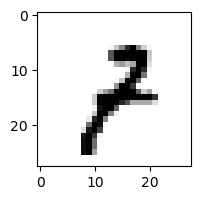

1.0596463616521637e-12% - 0
0.009078645914553604% - 1
5.8803520839137e-06% - 2
1.9853098523586883e-05% - 3
8.049233768495038e-08% - 4
1.4578770048354359e-08% - 5
7.079695894581378e-11% - 6
15.617709626351987% - 7
3.45682072941571e-11% - 8
53.46172295938566% - 9 - ОШИБКА

 8


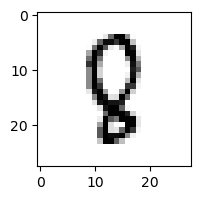

6.974788517915409e-13% - 0
1.1950749455537675e-05% - 1
0.0011746436145849662% - 2
1.5332173920518161e-18% - 3
0.0015342560185489023% - 4
0.2470481503116243% - 5 - ОШИБКА
1.8877918570421772e-07% - 6
7.194841982056699e-05% - 7
1.4717831753508032e-06% - 8
1.6647017063969597e-21% - 9

 7


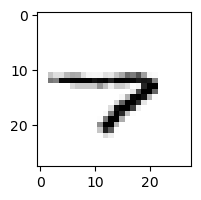

7.008607375291647e-09% - 0
0.01126739783431321% - 1
2.3200398286033762e-17% - 2
1.3464490755520402e-10% - 3
99.99994464488% - 4 - ОШИБКА
0.10394771991241142% - 5
99.69138072494526% - 6
23.79078902056919% - 7
1.4528777749985255e-12% - 8
67.77055895112682% - 9

 3


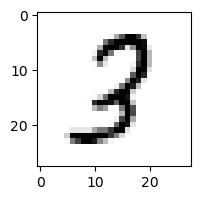

1.3268736055069648e-09% - 0
0.0017844985309550141% - 1
11.4448685023784% - 2 - ОШИБКА
0.12567623473113473% - 3
8.401783168512415e-08% - 4
0.000315813645296889% - 5
8.158289953130126e-12% - 6
9.345140330101664e-05% - 7
1.0551191556684518% - 8
5.482321684788872e-18% - 9

 8


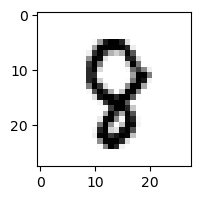

1.1261617413339366e-13% - 0
1.4861689821686526e-08% - 1
5.45512255389134e-10% - 2
2.150209850238464e-17% - 3
6.026868430538699e-06% - 4
0.002064977011430409% - 5 - ОШИБКА
2.1310771980448386e-11% - 6
0.00024166802036693262% - 7
2.2458475555352426e-05% - 8
6.655995748970512e-18% - 9

 8


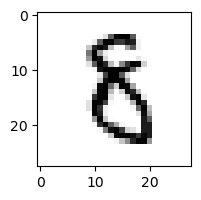

1.1453175478435099e-11% - 0
0.00013156028137743128% - 1
1.725981555474894e-05% - 2
4.275675541475745e-06% - 3
6.390219358849544e-09% - 4
0.027019134863778497% - 5 - ОШИБКА
1.207412477372898e-08% - 6
5.2682143263440945e-09% - 7
1.043322450550177e-17% - 8
2.785732792844206e-26% - 9

 8


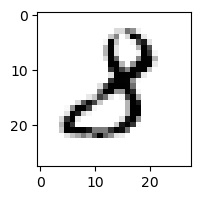

1.7683297078199308e-08% - 0
3.157608784930218e-05% - 1
8.486550278696927e-05% - 2
99.67497067288502% - 3 - ОШИБКА
7.895376351296542e-12% - 4
2.5969042759352536e-06% - 5
2.6209788786738992e-18% - 6
1.012810789797947e-07% - 7
2.466591681548661e-22% - 8
2.4618265297036016e-17% - 9

 8


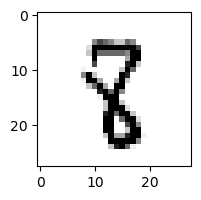

1.9083871712935867e-17% - 0
0.0007570107768347236% - 1
2.6750810970716508e-11% - 2
3.5397184006762043e-13% - 3
3.4709082573229816e-06% - 4
0.17859448262910513% - 5 - ОШИБКА
3.0577743494162947e-14% - 6
4.912169226020265e-06% - 7
5.139955412991716e-15% - 8
3.46736137804396e-17% - 9

 6


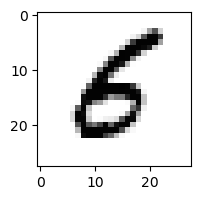

5.746507362162249e-06% - 0
2.2174082720941142e-10% - 1
6.828474340439585e-11% - 2
1.4464614670201778e-12% - 3
6.969162101556777e-08% - 4
16.956148224723357% - 5 - ОШИБКА
3.1753562346681536% - 6
1.5413107015300103e-11% - 7
1.9243200682972927e-28% - 8
2.5105140942825615e-14% - 9

 0


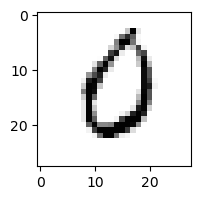

92.92252656825649% - 0
2.859154597252807e-11% - 1
1.318602373818469e-06% - 2
1.5518438099415081e-10% - 3
1.67215920362502e-05% - 4
0.11201989704505723% - 5
98.58075778473385% - 6 - ОШИБКА
0.00040325888577049534% - 7
8.860008965159109e-13% - 8
1.2784982367540686e-10% - 9

 8


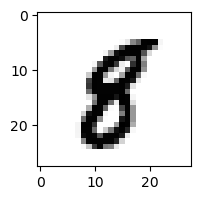

9.320744873585557e-14% - 0
5.462312893627433e-09% - 1
6.199601886203349e-21% - 2
6.013731154468523e-21% - 3
6.824000160364603e-14% - 4
0.006598656514511371% - 5 - ОШИБКА
2.432415648942171e-16% - 6
4.188484692947015e-11% - 7
0.00020852152716063346% - 8
3.3600123733728447e-13% - 9

 7


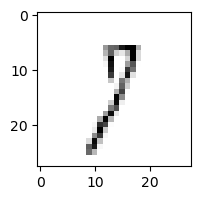

0.039850989786906085% - 0
64.06190473413342% - 1
7.450299377074441% - 2
76.89560825423129% - 3
0.0002961571394499838% - 4
0.2768368957515757% - 5
0.014292713456989702% - 6
89.28962537598034% - 7
1.8029141500015728% - 8
99.86636665651272% - 9 - ОШИБКА

 9


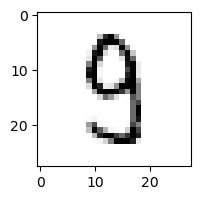

2.8226107679746233e-07% - 0
2.6970742473119e-06% - 1
2.0006932448615367e-08% - 2
0.44313010445296874% - 3
0.0001203585856593035% - 4
0.9834888171074524% - 5 - ОШИБКА
3.0610220213028688e-12% - 6
0.0017602618063176948% - 7
6.245636947221449e-08% - 8
2.269235249521816e-11% - 9

 6


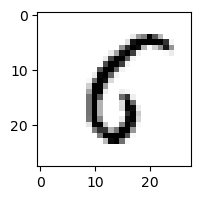

4.291800983637755% - 0
3.6714551584233365e-07% - 1
2.2424876168671816e-08% - 2
7.421030163421195e-16% - 3
5.405249415503741e-05% - 4
93.93962709958744% - 5 - ОШИБКА
81.47553991427942% - 6
5.115899507206964e-07% - 7
1.8359125462256448e-06% - 8
2.474026884839309e-10% - 9

 8


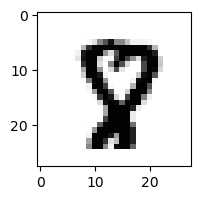

2.8921288826518564e-19% - 0
3.870179326404496e-18% - 1
3.6075392707616954e-23% - 2
6.026095708491235e-28% - 3
3.1578147014485896e-11% - 4
0.0006405625522975484% - 5 - ОШИБКА
4.953685802924237e-22% - 6
0.000515159322476792% - 7
3.879266743411089e-17% - 8
2.9129442240705186e-28% - 9

 6


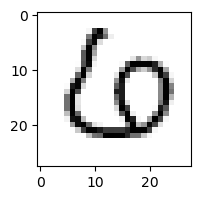

2.696303549999138e-06% - 0 - ОШИБКА
5.6123489417956476e-11% - 1
1.5694688998358177e-09% - 2
2.3881900404998797e-09% - 3
3.7477391385341095e-11% - 4
1.5659082804037012e-10% - 5
1.6257725285982099e-15% - 6
3.073518007003667e-08% - 7
1.985726562200437e-20% - 8
5.833461178164795e-31% - 9

 5


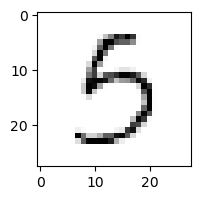

0.005014166023390134% - 0
0.00021538624372899833% - 1
6.216695874841565e-14% - 2
99.18591946409975% - 3 - ОШИБКА
0.022087242720775294% - 4
96.4081457408812% - 5
0.0004353016093701434% - 6
0.012781738138491532% - 7
4.7574138702693993e-07% - 8
1.486671239554569e-16% - 9

 7


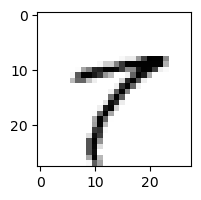

2.654652473953168e-08% - 0
0.02638855568316508% - 1
1.6099286886420793e-17% - 2
6.324211712575982e-13% - 3
5.020230029068616e-06% - 4
0.0008718433007783598% - 5
2.0157011351391977e-12% - 6
99.81516175464462% - 7
99.98783790196106% - 8 - ОШИБКА
0.0002918978357810853% - 9

 2


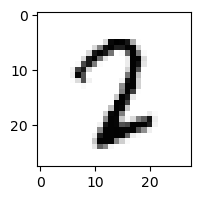

9.024969285387172e-11% - 0
3.373919493747289e-05% - 1
5.6731057303538924e-05% - 2
1.3394343099418707e-10% - 3
7.954017937641617e-10% - 4
0.06769184687223209% - 5 - ОШИБКА
2.398819981097281e-11% - 6
0.017900029547440254% - 7
6.819112109714452e-07% - 8
1.512822864764815e-24% - 9

 8


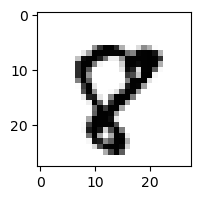

6.895172980496746e-12% - 0
3.804082460384874e-13% - 1
1.9823167869822274e-19% - 2
1.8964016621173693e-27% - 3
4.192259949562985e-16% - 4
1.3189364976491755e-05% - 5
1.6151194497518916e-21% - 6
44.82711701507465% - 7 - ОШИБКА
1.6754694279774974e-08% - 8
1.4552210274242424e-16% - 9

 4


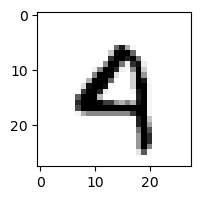

1.5911243715652966e-06% - 0
1.245544026607252e-11% - 1
4.276750101893085e-09% - 2
5.850398648742794e-21% - 3
6.056517122850608% - 4
1.2225375650221824e-07% - 5
0.00015466438942528997% - 6
1.4743420840835146e-05% - 7
5.230081612269128e-23% - 8
99.95750522448887% - 9 - ОШИБКА

 8


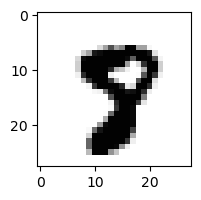

1.7233516488186795e-23% - 0
1.0191911527847082e-19% - 1
4.6899733612080956e-38% - 2
4.9871461166090286e-29% - 3
8.480607320040432e-19% - 4
0.010458556956731084% - 5
4.253648517980262e-24% - 6
0.19482269039622044% - 7 - ОШИБКА
1.1979876183693218e-14% - 8
1.2190830286283885e-18% - 9

 7


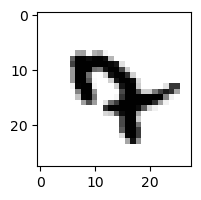

1.0952836779422897e-21% - 0
1.0051839827996521e-07% - 1
1.44160910377135e-26% - 2
4.9244145820122735e-24% - 3
85.8141050482737% - 4 - ОШИБКА
0.0005160629037295456% - 5
1.0231411459787761e-05% - 6
78.63267434460268% - 7
2.6681288050738987e-36% - 8
2.532856687759893e-20% - 9

 8


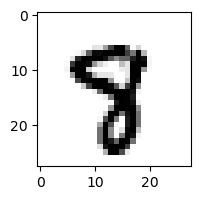

2.296858931862143e-21% - 0
9.211291304280565e-14% - 1
1.2765859440329338e-29% - 2
8.650617700480755e-21% - 3
7.435054126885939e-12% - 4
0.14585924411700657% - 5 - ОШИБКА
2.19375137367059e-20% - 6
0.0737703598066469% - 7
6.2754011516421575e-15% - 8
8.226057584080929e-15% - 9

 8


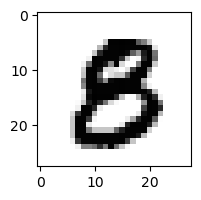

7.375149780844422e-13% - 0
7.757155329691235e-18% - 1
5.21780468008512e-25% - 2
1.245753174939581e-11% - 3
6.413553688891698e-20% - 4
0.000819393526159152% - 5 - ОШИБКА
2.342060717956279e-24% - 6
3.825179020276002e-17% - 7
5.140288484145326e-20% - 8
1.572425922584564e-31% - 9

 8


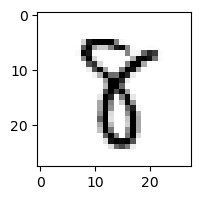

4.192555820723574e-17% - 0
0.0027932453896289447% - 1
2.4007454280144106e-10% - 2
0.0009566057449453354% - 3
1.7643991190272243e-08% - 4
0.20656690959221383% - 5 - ОШИБКА
1.5491651572908846e-17% - 6
1.404264535075897e-05% - 7
0.007148163106518682% - 8
6.83990554826725e-22% - 9

 2


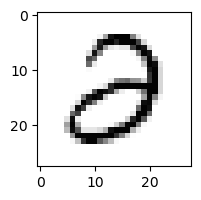

0.32054665026952994% - 0
4.196469072284561e-10% - 1
0.9323778890488429% - 2
45.82889428905932% - 3 - ОШИБКА
9.684017507718691e-08% - 4
3.9250184137450464e-05% - 5
9.787170204728694e-09% - 6
2.1607843443658702e-11% - 7
6.829717610255565e-16% - 8
1.9847482289331357e-27% - 9

 5


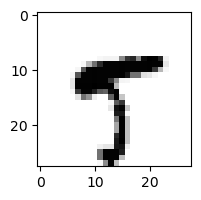

2.307269788920242e-12% - 0
1.2817897655255685e-08% - 1
6.08278988127493e-38% - 2
3.7076811137951594e-22% - 3
3.156513157726828e-05% - 4
2.397516712479931% - 5
1.26570070155451e-19% - 6
4.979338276957462% - 7 - ОШИБКА
9.081094958489556e-18% - 8
5.988686025265906e-11% - 9

 2


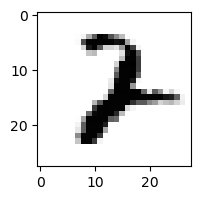

1.4701055907901368e-18% - 0
0.020049497487359447% - 1 - ОШИБКА
0.0010726006750892548% - 2
7.721848848590537e-15% - 3
2.008386309373633e-13% - 4
1.0334752425662968e-11% - 5
9.132646433808112e-15% - 6
0.0014441944988045844% - 7
3.0221600494719593e-30% - 8
3.7300583878139166e-30% - 9

 6


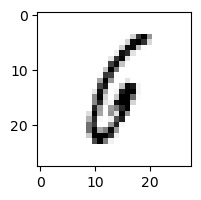

6.47849731627025e-06% - 0
0.014637467946961212% - 1
0.14013625622753756% - 2
3.860158300643404e-10% - 3
0.007531775849383009% - 4
0.024827216068496794% - 5
90.41133614678941% - 6
1.303940401286025e-05% - 7
99.54080994147883% - 8 - ОШИБКА
1.9894252606914766e-05% - 9

 8


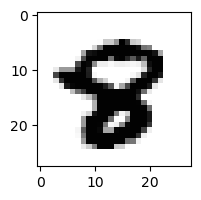

8.067130779466067e-22% - 0
3.222198973652122e-22% - 1
9.503268004162428e-35% - 2
5.210647369028754e-40% - 3
3.17646432934708e-21% - 4
2.815676412642093e-05% - 5 - ОШИБКА
5.601694624837424e-24% - 6
7.452361246675327e-14% - 7
1.2248122138992251e-18% - 8
1.16329957854487e-33% - 9

 1


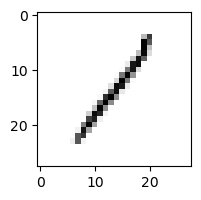

0.027390628895401434% - 0
99.62600485614541% - 1
99.36275632371539% - 2
20.097121655918528% - 3
0.3068405221826435% - 4
0.009058213223988029% - 5
0.015318924191296318% - 6
0.035937375155056184% - 7
99.99800678889451% - 8 - ОШИБКА
23.792736691338153% - 9

 8


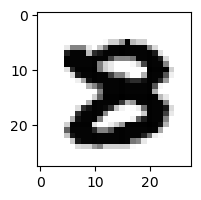

4.799090741166863e-24% - 0
6.579082548699965e-25% - 1
4.624543680265055e-30% - 2
8.398484674586588e-30% - 3
2.6453160836781184e-28% - 4
5.194844880535803e-11% - 5 - ОШИБКА
8.587788819358655e-33% - 6
8.358104896244074e-19% - 7
2.8493637140346645e-15% - 8
8.956482411594332e-50% - 9

 9


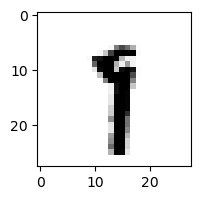

5.0174353341409107e-20% - 0
1.5925972756115798% - 1
2.9671643396035185e-16% - 2
9.528644603554042e-12% - 3
6.79381168520924e-11% - 4
0.008958127081219356% - 5
1.04009576187468e-11% - 6
79.74404044431299% - 7 - ОШИБКА
9.585171583431244e-10% - 8
1.7978944359517906e-06% - 9

 3


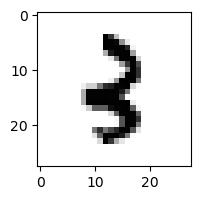

2.0445933841935558e-16% - 0
0.0004030140236917658% - 1
0.001174883135560805% - 2 - ОШИБКА
1.0645879654448361e-08% - 3
2.193555866467207e-06% - 4
8.396260415236393e-06% - 5
3.640110169598709e-11% - 6
5.6837597443924994e-11% - 7
1.0365342587542918e-13% - 8
5.412424477149896e-07% - 9

 9


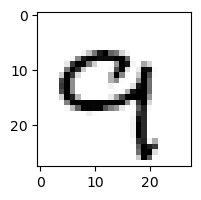

3.342453221278201e-12% - 0
8.261160528508856e-07% - 1
5.9591647695387995e-09% - 2
4.2803429032137704e-17% - 3
8.516179534026461e-06% - 4
3.1973688364215285e-11% - 5
4.404406646420552e-09% - 6
24.59388556302376% - 7 - ОШИБКА
7.061612442420078e-17% - 8
1.155049279186279% - 9

 9


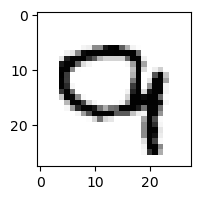

3.169649800617848e-05% - 0
3.751116452784599e-15% - 1
0.2202727750695833% - 2
2.5341038623794136e-19% - 3
1.0763489607014008e-06% - 4
4.367857764318756e-18% - 5
1.60743834944522e-08% - 6
12.50487661995894% - 7 - ОШИБКА
1.1446654064893943e-26% - 8
6.454356776464124e-13% - 9

 9


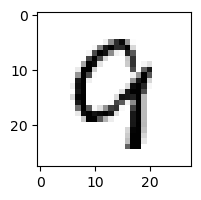

5.416556931398458e-06% - 0
1.485687688593308e-08% - 1
0.0004323893977258877% - 2
1.5214281758808108e-22% - 3
0.0028223359576115925% - 4
5.5331637967576935e-09% - 5
0.0022505097544007367% - 6
0.00541739679953047% - 7 - ОШИБКА
1.9441531522425413e-08% - 8
1.6328612742586226e-07% - 9

 4


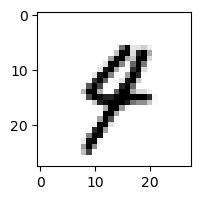

9.28580614221888e-13% - 0
0.0001556582758615733% - 1
1.5107090414446668e-15% - 2
1.1554887306510092e-09% - 3
0.7873093558354555% - 4
0.0006142485841677265% - 5
2.796040858138248e-09% - 6
52.34849339643155% - 7 - ОШИБКА
1.5992341613493123e-20% - 8
0.1402013567590829% - 9

 8


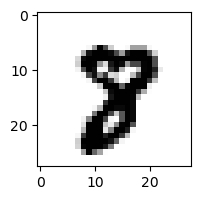

8.780304101052944e-23% - 0
3.116669679096001e-14% - 1
1.4694262363293049e-28% - 2
1.0468073243058323e-24% - 3
1.8322069166497018e-21% - 4
1.4197107117379277e-08% - 5
1.955725169888519e-23% - 6
0.009916677359124769% - 7 - ОШИБКА
8.571639271007876e-08% - 8
3.1281196722211996e-25% - 9

 9


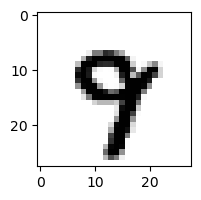

1.2522130112408476e-20% - 0
4.155398497200018e-14% - 1
2.165676689511696e-25% - 2
6.0959016663514336e-21% - 3
8.284279831187358e-06% - 4
8.397554237376511e-08% - 5
2.442186652112508e-13% - 6
68.45925325283868% - 7 - ОШИБКА
3.2398114553855256e-20% - 8
0.01029189625883464% - 9

 7


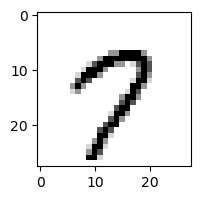

0.00027065259208952544% - 0
7.997845878313613e-09% - 1
3.027590402775172e-15% - 2
4.307575924022561e-16% - 3
6.368419152979505e-07% - 4
0.0005017151364606089% - 5
2.1292607280060166e-10% - 6
96.84277324103725% - 7
1.3114578807509982e-06% - 8
99.99217507858478% - 9 - ОШИБКА

 2


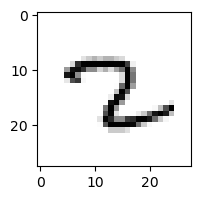

1.420462648034095e-14% - 0
4.892747777028996% - 1
1.2545529896352654% - 2
3.8594307890833855e-13% - 3
3.614827108305248e-08% - 4
0.007098445941381833% - 5
1.9345115380249103% - 6
57.74895413729082% - 7 - ОШИБКА
6.4328139165492835e-12% - 8
2.0329301195043062e-10% - 9

 4


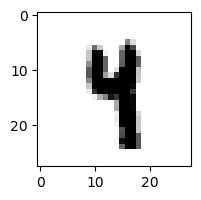

1.7974198421592927e-21% - 0
2.0445070620803003e-05% - 1
1.78298885965971e-23% - 2
2.508512166926321e-11% - 3
0.004588635907410596% - 4
0.061318733456832544% - 5 - ОШИБКА
1.548925500726205e-16% - 6
0.0002047617723192582% - 7
6.610616498329111e-16% - 8
1.635865793725779e-11% - 9

 9


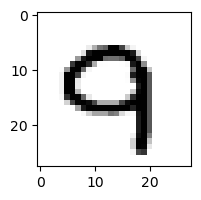

2.313734894302553e-08% - 0
4.00192108279633e-14% - 1
7.234637037255606e-07% - 2
2.366100116983651e-23% - 3
2.0526834461593004e-06% - 4
1.7186135604340407e-11% - 5
2.8539905843034554e-13% - 6
8.675326498973268% - 7 - ОШИБКА
3.761449177399023e-22% - 8
0.32874790017915845% - 9

 9


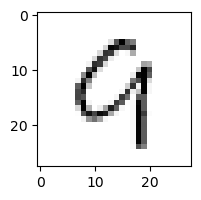

0.007171544685902562% - 0
5.660787036859914e-05% - 1
3.62701341073828% - 2
2.555478281726409e-14% - 3
32.516113076576424% - 4
5.190796627700128e-08% - 5
34.44318158586012% - 6 - ОШИБКА
0.011856146968603183% - 7
2.2758329918241875% - 8
1.0561001776415793% - 9

 5


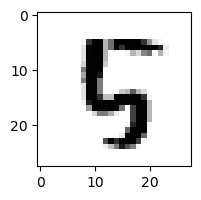

2.768399003815414e-16% - 0
7.525757015328374e-13% - 1
3.647919969472209e-09% - 2
2.39582860490789e-26% - 3
12.677402669229041% - 4 - ОШИБКА
9.404115075623336% - 5
5.707494503215366e-10% - 6
1.8777937401564732e-08% - 7
7.968590064866497e-15% - 8
2.689182968929468e-28% - 9

 8


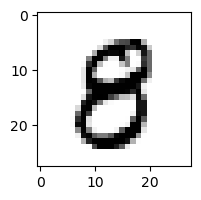

2.7754487298025883e-09% - 0
6.672040036853694e-14% - 1
1.6121931474998565e-18% - 2
8.624521596075012e-09% - 3
1.0221493519112886e-10% - 4
0.0007645855463165967% - 5 - ОШИБКА
8.314811640436574e-18% - 6
2.110252927121595e-12% - 7
6.173475821421253e-07% - 8
1.1503036691637766e-15% - 9

 9


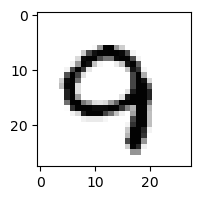

5.805032912863426e-11% - 0
1.3783945673537385e-11% - 1
1.4788064584230606e-08% - 2
1.1487388826761896e-27% - 3
1.313250273081092e-06% - 4
1.1148268109599517e-10% - 5
1.0105077294726476e-10% - 6
0.6752287312293994% - 7 - ОШИБКА
2.8201131199861237e-22% - 8
2.4200653372898074e-08% - 9

 4


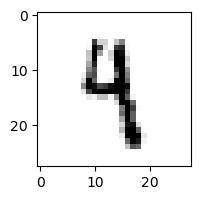

1.4947224641754892e-15% - 0
0.18764952747347302% - 1 - ОШИБКА
4.0677593636320656e-11% - 2
0.008582537728847801% - 3
0.09451763734866145% - 4
0.04931141243406714% - 5
6.846969395333433e-08% - 6
3.2969690145141007e-06% - 7
1.5472188545787474e-15% - 8
0.03095461111760805% - 9

 8


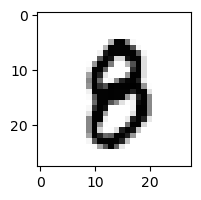

5.694453525203556e-15% - 0
1.8269805725962256e-10% - 1
4.288911247967887e-19% - 2
2.8784921357573565e-15% - 3
3.2916100341035066e-13% - 4
0.005260839972933482% - 5 - ОШИБКА
9.343721056980025e-13% - 6
4.0714674794722e-09% - 7
3.748983824088595e-05% - 8
2.473717686367919e-12% - 9

 8


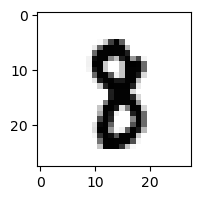

3.7644497989763466e-23% - 0
3.107964167894925e-06% - 1
2.577075096728639e-22% - 2
3.121276949099221e-13% - 3
6.700660836992341e-15% - 4
0.0001419349443431475% - 5
7.235559024354237e-20% - 6
0.00023913984382949345% - 7 - ОШИБКА
1.0356121182073386e-08% - 8
5.853812715818081e-23% - 9

 8


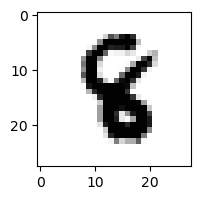

1.4454997120584207e-30% - 0
3.71075489662552e-10% - 1
1.4275135560184398e-16% - 2
1.2147718892996624e-21% - 3
2.238471754483257e-07% - 4
0.0005119972148028154% - 5 - ОШИБКА
5.298009450077206e-16% - 6
3.165239010379418e-11% - 7
8.178152689507643e-28% - 8
1.8020943142820728e-35% - 9

 9


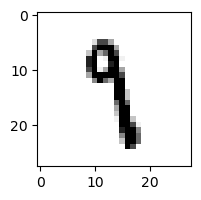

6.822071082720342e-16% - 0
3.0525750433065815% - 1 - ОШИБКА
5.081289065224258e-13% - 2
3.542413690194829e-08% - 3
6.974646458677787e-06% - 4
0.7460416376780045% - 5
3.8018933327338087e-07% - 6
0.1386091353692106% - 7
1.2238671014871806e-06% - 8
1.0539015614796577e-10% - 9

 8


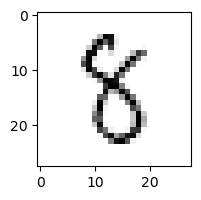

1.6791735987219577e-08% - 0
0.03194984931606497% - 1
2.390925844242203e-07% - 2
0.24487565628243582% - 3
5.765755895817812e-06% - 4
3.310452810981647% - 5 - ОШИБКА
3.441780171672317e-07% - 6
5.26873901759899e-06% - 7
0.5121563571462816% - 8
5.2589540309062174e-15% - 9

 6


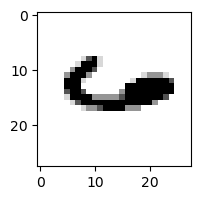

6.559687813676157e-07% - 0
1.5483059717725434e-07% - 1
7.834315863667833e-18% - 2
3.48971088170627e-27% - 3
99.99999999680583% - 4 - ОШИБКА
3.0999484792481887e-13% - 5
99.99697097864552% - 6
3.534223632379401% - 7
2.848070779265369e-15% - 8
97.39902825027418% - 9

 8


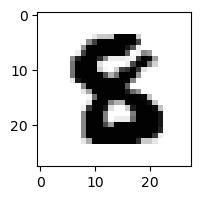

1.4175991802999406e-26% - 0
2.8167202768951504e-21% - 1
5.854984436745099e-26% - 2
3.758445771064126e-24% - 3
3.1191023773362542e-25% - 4
0.039178016532117374% - 5 - ОШИБКА
8.118571198084766e-27% - 6
1.806421742483416e-20% - 7
2.2709412568067243e-33% - 8
5.901642276282065e-53% - 9

 3


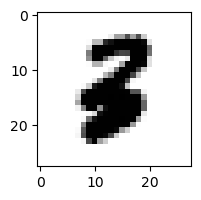

2.41754062864442e-21% - 0
8.946155498487028e-12% - 1
2.7099761047541815e-11% - 2
1.6578338502150369e-25% - 3
8.285826195029131e-17% - 4
9.845959253939633e-07% - 5 - ОШИБКА
3.855174442064545e-19% - 6
5.1694707683274117e-14% - 7
2.6010840283415026e-41% - 8
1.4777413912669255e-40% - 9

 6


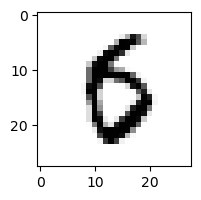

2.199296252447759e-06% - 0
1.4873062911207932e-11% - 1
3.025644447727854e-17% - 2
1.6653688310382513e-16% - 3
1.0101012456307041e-10% - 4
77.81710293379881% - 5 - ОШИБКА
20.94010485074769% - 6
1.7722353106050327e-05% - 7
3.509440680938371e-14% - 8
7.677730676769895e-18% - 9

 5


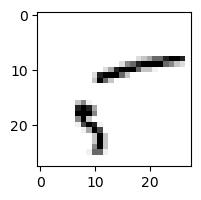

99.97896221841826% - 0
0.002602666926052161% - 1
3.7955058420786924e-05% - 2
18.911672705641855% - 3
0.00047076377900984217% - 4
83.41367934232032% - 5
3.1215834680855048e-09% - 6
13.092762522229934% - 7
99.99999952103778% - 8 - ОШИБКА
7.629068420385195e-10% - 9

 8


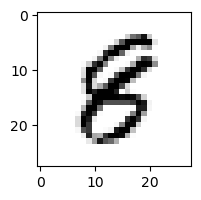

4.001378435720788e-12% - 0
4.659597440033112e-08% - 1
5.3574349562044625e-14% - 2
1.3501967095798977e-13% - 3
8.230688389233269e-10% - 4
0.0050418706478010285% - 5 - ОШИБКА
3.26647620255009e-15% - 6
5.0430567921785564e-12% - 7
3.4859443479906534e-08% - 8
6.348418863481875e-16% - 9

 8


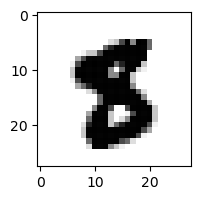

1.083070956761275e-26% - 0
3.373586305210706e-17% - 1
1.897612345326508e-39% - 2
2.2414554133395753e-31% - 3
1.2633886926206417e-24% - 4
0.2809239763784851% - 5 - ОШИБКА
4.6951433194405574e-24% - 6
2.4877787251113987e-13% - 7
5.263182061905005e-28% - 8
8.587229191684092e-39% - 9

 5


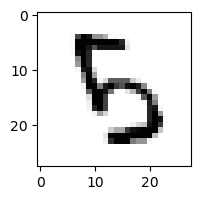

4.575431424963784e-13% - 0
5.425720279359382e-11% - 1
0.0025255832934381064% - 2
0.002261599382047956% - 3
0.761109531529534% - 4 - ОШИБКА
0.047279512007528494% - 5
4.0246853929757186e-06% - 6
7.875770868189826e-15% - 7
3.183434390744766e-12% - 8
7.910193750974804e-17% - 9

 7


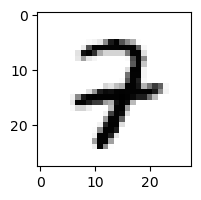

2.812785272835699e-12% - 0
3.72900402357033e-08% - 1
0.0024333274027626057% - 2
8.18872227014528e-11% - 3
0.6362237119796543% - 4 - ОШИБКА
1.09123610372246e-06% - 5
4.467530563362512e-09% - 6
0.0002566807780427996% - 7
1.1151293731279697e-19% - 8
2.348114238378374e-18% - 9

 0


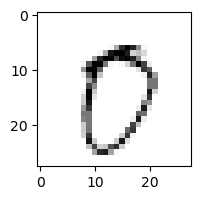

99.97897745467299% - 0
3.4891337986706863e-09% - 1
1.2212669273853745e-05% - 2
1.3764009283489625e-05% - 3
1.922464780446556e-08% - 4
0.009251099467900955% - 5
1.0355377812881539e-05% - 6
47.45024907361362% - 7
0.0008275002546102806% - 8
99.99672091847357% - 9 - ОШИБКА

 2


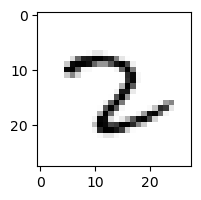

4.092910069596676e-12% - 0
0.603538884726561% - 1
88.13101852074591% - 2
6.220786537799732e-08% - 3
1.5363847738216784e-08% - 4
0.0001049930201026056% - 5
49.711313293802675% - 6
94.02321117046372% - 7 - ОШИБКА
2.808960719860562e-10% - 8
2.470954088459768e-16% - 9

 8


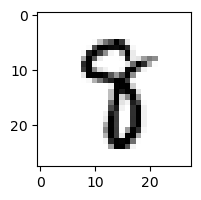

1.03163095590232e-18% - 0
3.544468615420955e-05% - 1
3.151044028530002e-20% - 2
1.7942027249312833e-09% - 3
1.3686864779677633e-08% - 4
0.21622800780468368% - 5
1.685582208428453e-16% - 6
0.2753357062266015% - 7 - ОШИБКА
6.211664293525128e-12% - 8
1.6372766626326962e-23% - 9

 9


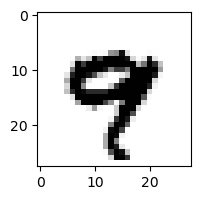

2.5853333740357194e-19% - 0
5.366640047751971e-16% - 1
1.831336253879552e-30% - 2
1.2618968577254304e-32% - 3
3.3686365138197636e-08% - 4
2.872419634046558e-09% - 5
1.747372791548865e-17% - 6
21.47079749803324% - 7 - ОШИБКА
2.526148697377365e-23% - 8
2.8806387572941357% - 9

 9


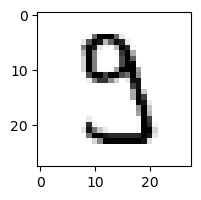

0.0003030562465426416% - 0
1.1233677206363138e-07% - 1
7.331721104864196e-10% - 2
94.74868460242818% - 3 - ОШИБКА
1.5909401615767345e-10% - 4
0.09726352770563845% - 5
4.576237356085883e-18% - 6
0.04593083059503279% - 7
4.915416179966967e-14% - 8
2.2661885424323875e-23% - 9

 1


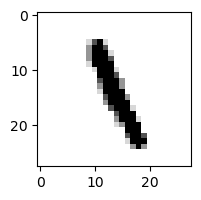

7.2371773628283505e-22% - 0
0.45694710287652385% - 1
7.157149945060356e-09% - 2
6.441505744751062e-10% - 3
0.004352108740667961% - 4
11.992392041171085% - 5 - ОШИБКА
9.576387372049701e-06% - 6
8.239012418757977e-08% - 7
0.10983977365525201% - 8
5.5260498352800844e-14% - 9

 9


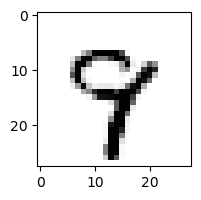

1.630851377761926e-15% - 0
1.2109721649107716e-09% - 1
3.610563804368165e-14% - 2
1.1122817050719678e-14% - 3
8.918438782853926e-06% - 4
2.2490797476220526e-06% - 5
3.155789570217626e-08% - 6
36.163806889529084% - 7 - ОШИБКА
1.0419484364331562e-09% - 8
0.01548303099040009% - 9

 8


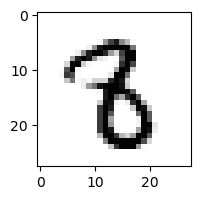

3.678449685788234e-21% - 0
1.5750272504465733e-05% - 1
7.354853199207723e-16% - 2
8.87856970000725e-08% - 3
6.192536175745827e-14% - 4
0.010230158719269715% - 5 - ОШИБКА
3.5910732552971145e-17% - 6
9.549983402264827e-07% - 7
8.361522129172813e-17% - 8
1.7263025965626566e-22% - 9

 8


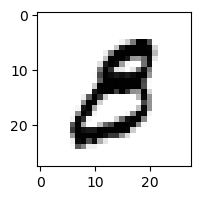

8.45313330872576e-07% - 0
1.222166025860109e-09% - 1
7.55724734403114e-17% - 2
0.001992796671146754% - 3 - ОШИБКА
2.0451156208243074e-17% - 4
0.0001750646931642677% - 5
7.518550556858022e-12% - 6
1.490376391068884e-10% - 7
2.116693363544822e-20% - 8
1.5848270381366516e-16% - 9

 8


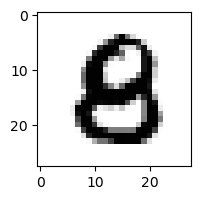

3.111909715200589e-13% - 0
1.0717633872122038e-18% - 1
2.1148277163124365e-13% - 2
9.56199108328112e-23% - 3
3.453915534362023e-09% - 4
6.17248462054646e-05% - 5 - ОШИБКА
3.438293723732237e-17% - 6
7.112324754269436e-18% - 7
1.9106920382105885e-16% - 8
2.7558841443560575e-29% - 9

 5


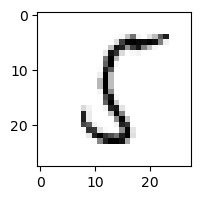

0.000383108172767261% - 0
3.6467434771470866% - 1
0.035110796789966835% - 2
8.053110168318663e-09% - 3
0.001654288685667973% - 4
96.71354869268393% - 5
0.009661512860716969% - 6
2.3806614334234742e-07% - 7
99.99999913624805% - 8 - ОШИБКА
3.3887058927293703e-13% - 9

 8


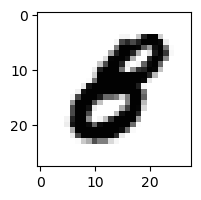

3.081535285775725e-12% - 0
2.030863799523683e-16% - 1
1.063635180263818e-22% - 2
4.813961599918722e-24% - 3
3.36896516321229e-15% - 4
0.00012079079373730322% - 5 - ОШИБКА
1.314707833878834e-19% - 6
1.0192616151293367e-13% - 7
2.9724206157367656e-36% - 8
1.0214908932792062e-33% - 9

 9


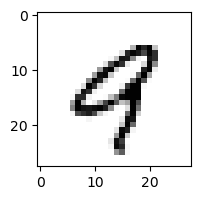

3.2868170076459184e-07% - 0
1.0808672401278127e-08% - 1
5.077548510394206e-12% - 2
1.0970354924767562e-17% - 3
51.57124445502864% - 4 - ОШИБКА
1.406300169856181e-07% - 5
1.5760821801464452e-05% - 6
11.235435265541994% - 7
3.453855038054202e-08% - 8
0.13603554102980406% - 9

 8


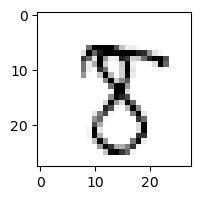

7.62350331460974e-15% - 0
9.678291920830054e-08% - 1
4.30075721681431e-10% - 2
5.890314239635706e-06% - 3
4.74747640548621e-14% - 4
15.100300648843614% - 5 - ОШИБКА
2.6507533416301765e-16% - 6
0.284173194858413% - 7
10.164681909926472% - 8
1.425481337514315e-06% - 9

 5


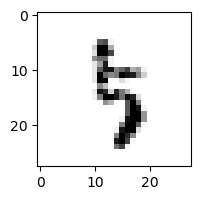

2.0377494348188794e-12% - 0
0.0021791065514099317% - 1
1.4881567053992954e-09% - 2
65.20191732420068% - 3 - ОШИБКА
0.04453853683600672% - 4
24.868898185217265% - 5
1.8372554882419292e-05% - 6
1.2277403008165828% - 7
3.595189934150638e-06% - 8
3.6953752930216285e-11% - 9

 9


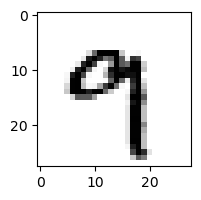

3.251941604185606e-08% - 0
6.15933472623574e-07% - 1
7.793481023517938e-23% - 2
1.992686548419361e-06% - 3
5.289988363280597e-08% - 4
0.02203944051219985% - 5
1.4204387175593274e-14% - 6
0.6922756605017719% - 7 - ОШИБКА
1.5114518270502326e-29% - 8
0.0667992805739938% - 9

 9


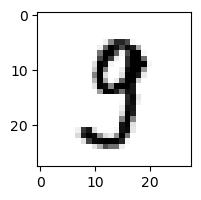

1.9165485840830722e-07% - 0
3.750164869261842e-07% - 1
1.973608886212599e-14% - 2
1.33850065440058% - 3 - ОШИБКА
1.2021127279205341e-08% - 4
0.09415685654951443% - 5
9.995109708416571e-21% - 6
0.13316045943656238% - 7
0.000850052455364142% - 8
1.10988347180222e-08% - 9

 4


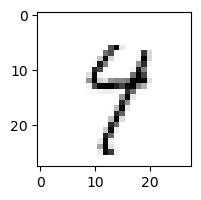

1.5228309626534109e-06% - 0
0.05639943708616729% - 1
4.637848967114313e-09% - 2
0.002655232635590008% - 3
12.53625790188515% - 4
0.040904066440950265% - 5
0.0010943085236378792% - 6
1.840668772866622% - 7
99.94728911134769% - 8
99.99930899073918% - 9 - ОШИБКА

 9


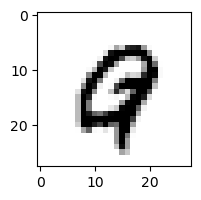

4.524906888198332e-10% - 0
8.377459125877655e-15% - 1
8.133830911114231e-17% - 2
9.539404168772863e-32% - 3
2.1374879499583256e-10% - 4
3.040431738532903e-08% - 5
3.6408251282014647e-06% - 6
0.004840322865953823% - 7 - ОШИБКА
2.375888001442201e-23% - 8
2.281105355157582e-06% - 9

 4


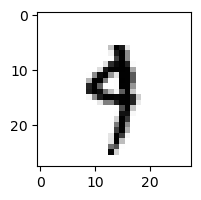

3.2071416964621525e-15% - 0
0.0009981815695979356% - 1
1.7655293894704371e-15% - 2
0.00020918659937760236% - 3
1.507949522253699% - 4
0.029276017580393478% - 5
2.2788505969919817e-06% - 6
4.178963310668879% - 7
1.244338170220546e-15% - 8
64.51589281758456% - 9 - ОШИБКА

 8


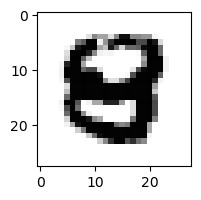

1.342506818220776e-18% - 0
1.4618437465747112e-24% - 1
8.678361238050076e-34% - 2
2.3083947352265314e-28% - 3
2.633776991650598e-10% - 4
3.2444796247022625e-06% - 5 - ОШИБКА
3.308620239674604e-22% - 6
2.301940517019655e-19% - 7
1.6456556197066886e-43% - 8
5.2376161471998846e-58% - 9

 7


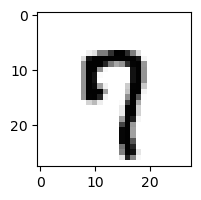

5.480689661958585e-05% - 0
8.2300374788967e-12% - 1
1.924268094943426e-13% - 2
2.074834568597548e-12% - 3
6.287065887629746e-05% - 4
0.026766544931171945% - 5
7.087182908131519e-11% - 6
80.07133382829946% - 7
1.0424575000398056e-17% - 8
99.99290447766208% - 9 - ОШИБКА

 8


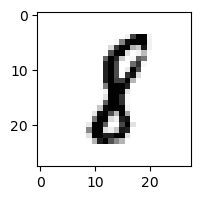

3.1368990178047587e-16% - 0
3.7995718861160404% - 1 - ОШИБКА
1.9630883214671222e-12% - 2
1.021725427126222e-15% - 3
4.783402124521992e-14% - 4
0.0016645435162247573% - 5
2.6999150107831153e-09% - 6
1.836549180002622e-07% - 7
0.5327141910497536% - 8
1.5909883064737308e-18% - 9

 8


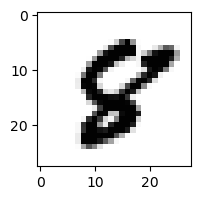

2.8501422657028837e-16% - 0
3.003641281954521e-17% - 1
8.334319024533893e-21% - 2
1.6473282221413302e-37% - 3
5.4184705723041126e-15% - 4
1.5374058423738564% - 5 - ОШИБКА
4.732855188465398e-18% - 6
3.146019975214463e-09% - 7
0.011050950105386672% - 8
8.32616259455765e-21% - 9

 6


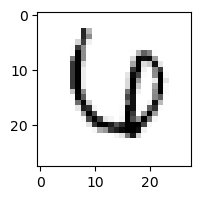

27.86698308183343% - 0 - ОШИБКА
3.707021639453378e-08% - 1
1.3623804849599782e-07% - 2
2.0543981824879607e-07% - 3
0.0007501905282929042% - 4
6.702587224684017e-10% - 5
1.5205290141297612% - 6
0.04741744407812354% - 7
1.933671698757256e-17% - 8
2.76658098798116e-20% - 9

 7


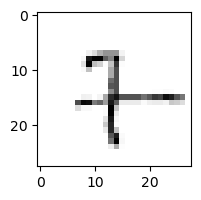

1.737283547339413e-07% - 0
40.707815850754244% - 1 - ОШИБКА
0.06991006392610977% - 2
0.0006533100941127081% - 3
0.18250273612320478% - 4
0.013259318885292384% - 5
1.0265128593989954% - 6
18.74489174602494% - 7
0.0002151426203464339% - 8
0.0004118865718180098% - 9

 5


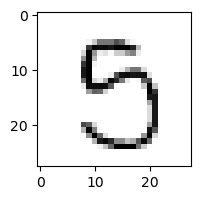

0.09404029569037146% - 0
8.494745063363508e-09% - 1
5.948252174806579e-11% - 2
96.87757173154954% - 3 - ОШИБКА
0.00013107086443716996% - 4
0.7236017253266696% - 5
4.349995315069792e-10% - 6
1.6710659522676453e-05% - 7
0.16013981687828632% - 8
1.3949792617395612e-08% - 9

 8


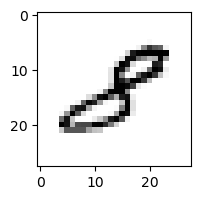

6.120377227244214e-07% - 0
0.3536636038000546% - 1
0.5677402620689286% - 2 - ОШИБКА
1.0494248645189067e-05% - 3
3.3102289702467e-07% - 4
1.561591748521465e-06% - 5
3.450569031972752e-14% - 6
2.302555747619468e-05% - 7
6.960884913347903e-11% - 8
8.320690083125844e-13% - 9

 4


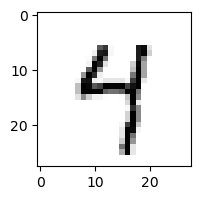

2.5299519945234105e-06% - 0
8.806533901939735e-06% - 1
5.0913927147183226e-14% - 2
8.170641646258224e-05% - 3
96.03252793835685% - 4
2.710696672289649% - 5
1.7735611362238055e-05% - 6
0.017522130814667147% - 7
5.689689018609952e-09% - 8
99.36365575962384% - 9 - ОШИБКА

 5


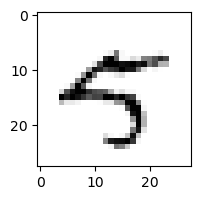

3.96588470504988e-05% - 0
1.1400791250492376e-05% - 1
4.4709186497918385e-18% - 2
1.7724208354308597e-10% - 3
26.385677515113855% - 4 - ОШИБКА
5.191817642402089% - 5
5.730358905536134e-16% - 6
4.204002717536438% - 7
1.2081559115159967e-14% - 8
2.385538015850226e-07% - 9

 7


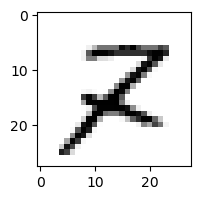

4.2564568696833015e-12% - 0
7.071395699853463e-06% - 1
99.95572842804407% - 2 - ОШИБКА
1.5865972335800579e-13% - 3
1.3955120111670207e-10% - 4
3.253729136959735e-05% - 5
9.947980644459876e-12% - 6
2.2633820861099008e-05% - 7
0.012550794932307053% - 8
5.422926832267243e-10% - 9

 3


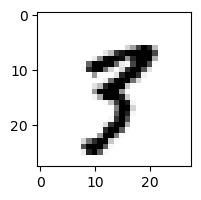

1.885963080333873e-15% - 0
1.1992470663109821e-05% - 1
5.94618271876991e-17% - 2
5.230219891746491e-07% - 3
7.350814490091277e-10% - 4
0.0027135431459579602% - 5
1.0424630532990416e-20% - 6
0.018088476556484098% - 7 - ОШИБКА
6.565496108823097e-10% - 8
6.592170202069474e-07% - 9

 2


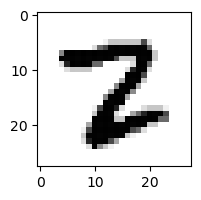

7.149362552053689e-20% - 0
5.952865829418146e-11% - 1
2.0125530071411126e-06% - 2
2.2708870639502536e-13% - 3
1.1215230256719434e-26% - 4
2.061563788013054e-07% - 5
1.5139562847055852e-18% - 6
6.880638519109277e-05% - 7 - ОШИБКА
1.1110519004008558e-11% - 8
1.7524783205079343e-36% - 9

 5


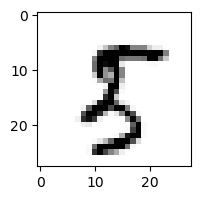

5.600519116714111e-16% - 0
3.2641944601848795e-05% - 1
8.281374120988434e-13% - 2
4.099289048680362e-21% - 3
6.017743923913441e-18% - 4
0.48420535538002746% - 5
3.076547741017121e-17% - 6
9.535347367753804e-07% - 7
99.99915471341043% - 8 - ОШИБКА
1.6632687179638645e-08% - 9

 5


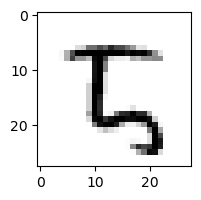

0.0010326963491414454% - 0
4.657924942248586e-13% - 1
99.87001831320399% - 2 - ОШИБКА
8.487230773169068e-17% - 3
7.98031857940835e-14% - 4
64.5123364751712% - 5
0.5675363088116167% - 6
1.49367416377525e-06% - 7
6.95960623690523e-08% - 8
0.0008087324372208493% - 9

 4


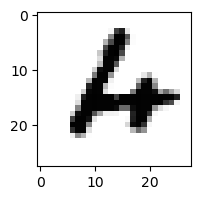

8.931990830578168e-11% - 0
1.817856288289487e-15% - 1
0.0003380153828534648% - 2
1.1380996216302735e-20% - 3
1.6269763824583053e-06% - 4
2.2411415003011438e-07% - 5
15.871214070739345% - 6 - ОШИБКА
9.103052335962825e-11% - 7
3.208082288648497e-27% - 8
6.851599620355972e-17% - 9

 8


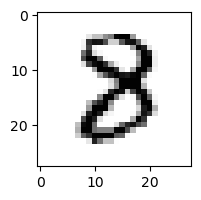

5.7835642594301116e-15% - 0
4.245002668099231e-08% - 1
3.823595560715751e-07% - 2
3.6024607963428742e-12% - 3
8.310210134936684e-17% - 4
2.054330408140471e-05% - 5 - ОШИБКА
1.0906029914255853e-13% - 6
1.1166943419528299e-06% - 7
1.9358829267023285e-06% - 8
1.1724655704229278e-33% - 9

 2


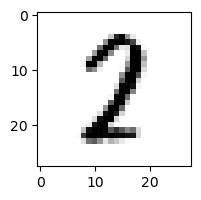

2.17751885781896e-10% - 0
0.42280334171634776% - 1
0.017307847036641802% - 2
5.512429745000596e-12% - 3
7.072430507167556e-10% - 4
0.0005933233756278306% - 5
9.004822845807195e-15% - 6
1.0276313008178812% - 7 - ОШИБКА
1.385975289726051e-09% - 8
5.7397129313132374e-27% - 9

 3


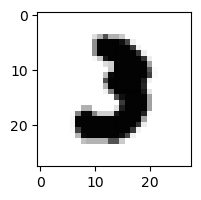

6.800989009661896e-17% - 0
8.192376816006533e-11% - 1
7.859434687758804e-14% - 2
1.3640028014886785e-08% - 3
2.7657947615496524e-31% - 4
2.5395535950428873e-10% - 5
3.5108410317177924e-22% - 6
2.2791282334002007e-07% - 7 - ОШИБКА
7.454069304341915e-37% - 8
2.1738490149433927e-41% - 9

 8


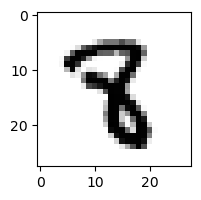

3.015647328372542e-28% - 0
6.311639376032631e-07% - 1
2.8926757850193867e-21% - 2
1.925550862351855e-14% - 3
1.3954526649895572e-08% - 4
0.00022500600270778049% - 5 - ОШИБКА
1.5444497056541445e-21% - 6
1.8111008144885797e-07% - 7
2.803371346593707e-30% - 8
3.1308967452810983e-31% - 9

 2


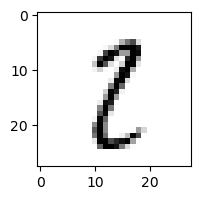

5.215081332113802e-08% - 0
5.009422247030289% - 1
7.44063128698218e-07% - 2
3.4126787233075506e-05% - 3
3.1960557006922446e-11% - 4
0.16923104724065582% - 5
2.430389589717632e-13% - 6
0.0042904646250671264% - 7
99.15655035629828% - 8 - ОШИБКА
1.5625660051003282e-06% - 9

 5


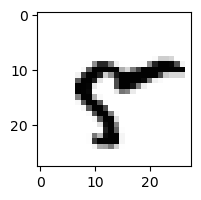

1.0124526276624098e-05% - 0
1.0670857076193467e-06% - 1
7.1758711986214e-28% - 2
2.9049782153387184e-27% - 3
6.566516601405487e-05% - 4
9.776308533517764e-06% - 5
1.1541190779712255e-06% - 6
0.10347954198592474% - 7
99.99752353263445% - 8 - ОШИБКА
0.02705163519046042% - 9

 7


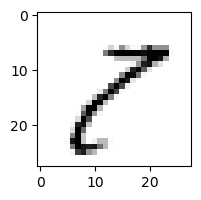

0.19615355891482422% - 0
0.053376114947054784% - 1
0.08229699686453817% - 2
99.6291353188527% - 3
1.0694839480052627e-06% - 4
0.06682106411802306% - 5
4.345266854884829e-14% - 6
0.001855624103363502% - 7
99.99747567942447% - 8 - ОШИБКА
98.96162341397915% - 9

 2


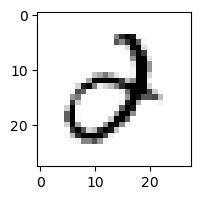

0.00025796396903949827% - 0
1.876660855100151e-09% - 1
2.237062727928327e-13% - 2
0.00032934055627075885% - 3
1.2623014402669126% - 4 - ОШИБКА
0.0011408485754876717% - 5
1.0785464173914948e-09% - 6
9.179018146281011e-05% - 7
6.837170919393203e-21% - 8
1.1875520363315756e-17% - 9

 8


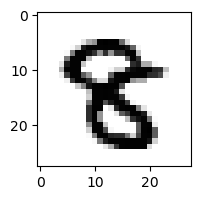

7.833020693639806e-19% - 0
1.0877304292044363e-15% - 1
9.64155069761147e-24% - 2
1.3596141729461944e-18% - 3
2.4436337522712944e-17% - 4
3.8520394078666377e-11% - 5 - ОШИБКА
1.2578148226512108e-27% - 6
1.0922751751721808e-13% - 7
1.3675064785564796e-11% - 8
9.926133477949976e-27% - 9

 2


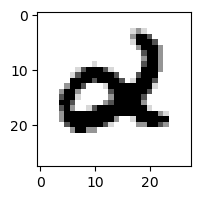

1.2147324015065267e-20% - 0
4.5563112009238424e-14% - 1
3.6542731849851363e-26% - 2
2.1947306289491826e-44% - 3
1.6511874665686354e-12% - 4
2.3424048265891933e-07% - 5 - ОШИБКА
4.328339996192813e-12% - 6
8.388094843589656e-17% - 7
6.229899809266066e-22% - 8
3.965208077393608e-30% - 9

 0


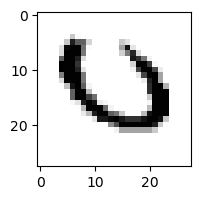

3.362315835401454% - 0
2.581709560545207e-11% - 1
1.2632604760690607e-05% - 2
2.6607985389797495e-19% - 3
6.547092203312527e-09% - 4
5.41556214160492e-17% - 5
98.7208407885658% - 6 - ОШИБКА
3.0004057447949673e-05% - 7
1.2664019337863703e-21% - 8
7.158967932364792e-16% - 9

 9


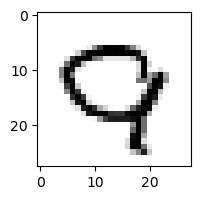

0.005728722401245201% - 0
1.3614193703707302e-11% - 1
1.0390776326166596e-06% - 2
1.6630780348887423e-19% - 3
1.1244639156989226e-10% - 4
6.98059046969661e-14% - 5
0.0019295161358284818% - 6
1.9645810142315867% - 7 - ОШИБКА
1.760043170489616e-17% - 8
3.3453588429166863e-09% - 9

 9


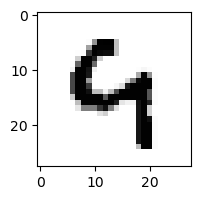

1.83465140056477e-14% - 0
6.765220429535149e-12% - 1
3.239194647662668e-09% - 2
3.6522265681996005e-18% - 3
96.7478568279892% - 4 - ОШИБКА
7.859692471453726e-05% - 5
0.04839353375510611% - 6
1.5792942999522994e-07% - 7
7.772450722500623e-22% - 8
0.10201841697028274% - 9

 8


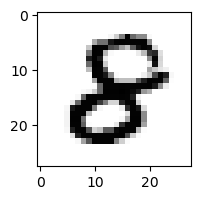

2.7015381975288936e-12% - 0
4.33640114625686e-16% - 1
7.334917744681343e-11% - 2
7.270678636021346e-21% - 3
2.5251676025899088e-11% - 4
4.428195620073113e-06% - 5 - ОШИБКА
3.1600424119921194e-14% - 6
1.5554904701488186e-18% - 7
1.9891937316855438e-06% - 8
1.3021232542271014e-37% - 9

 9


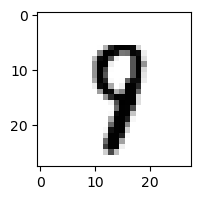

6.67567650707707e-14% - 0
1.5321356003097507e-08% - 1
3.1488429875358233e-13% - 2
1.4956204107896686e-10% - 3
4.036842811583151e-05% - 4
0.10321046413453218% - 5
7.510983107187317e-11% - 6
3.3765729586043416% - 7 - ОШИБКА
0.0034894169401250867% - 8
0.00027550931923664396% - 9

 8


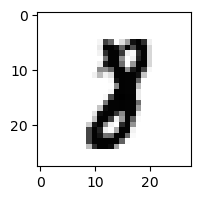

3.480784372049753e-21% - 0
0.00013733191684742535% - 1
1.0791215344148337e-17% - 2
1.639621629681009e-18% - 3
1.813517000822915e-18% - 4
4.717290596539759e-07% - 5
1.976055894078546e-22% - 6
0.012747849867880665% - 7 - ОШИБКА
7.255757850449261e-16% - 8
2.5782310074690486e-26% - 9

 3


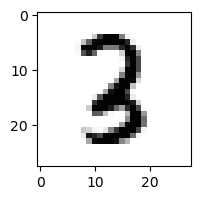

3.2622464172650434e-20% - 0
0.0005638510925905272% - 1
0.015073196584933128% - 2 - ОШИБКА
1.022551068741153e-05% - 3
6.561095798755722e-11% - 4
7.967312562673508e-07% - 5
8.008078743441376e-18% - 6
5.735204113111568e-09% - 7
1.984915272211957e-09% - 8
2.627473749221186e-25% - 9

 7


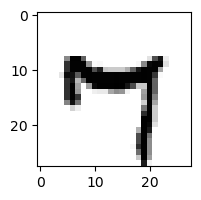

1.3294234889888036e-10% - 0
1.998169229613373e-08% - 1
7.170636880591806e-36% - 2
2.4646959879101753e-12% - 3
11.002901210228268% - 4 - ОШИБКА
2.5212481330425025e-06% - 5
1.88377467751437e-11% - 6
0.019692494265603235% - 7
1.2669534335487187e-08% - 8
1.5581887592866983% - 9

 7


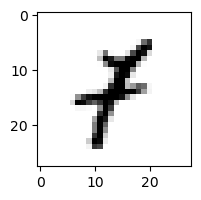

4.091324586352591e-11% - 0
60.42284819765689% - 1 - ОШИБКА
1.816791296163256e-07% - 2
8.675366655472283e-09% - 3
7.053857748133477e-07% - 4
3.219752707360757e-05% - 5
1.627722121828852e-09% - 6
1.3110221278853913e-05% - 7
4.114670848117969e-15% - 8
6.023544860417516e-06% - 9

 6


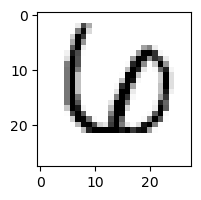

1.8048828870179703e-07% - 0
9.171280742857607e-07% - 1
5.996376268415725e-06% - 2
4.982594110727471e-13% - 3
6.030414741751784e-08% - 4
2.6008910324483102e-11% - 5
5.308389058884657e-12% - 6
9.028575718032383e-05% - 7 - ОШИБКА
4.50232136745024e-21% - 8
1.605182695560168e-32% - 9

 9


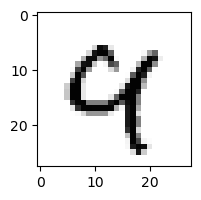

1.6156338176366416e-12% - 0
1.5345029467929993e-07% - 1
1.7331135614017137e-10% - 2
6.243549912496111e-24% - 3
5.634196868784418% - 4 - ОШИБКА
6.469372235129884e-10% - 5
6.049309793783506e-09% - 6
1.8388024790486686% - 7
6.232043303831743e-07% - 8
0.11969634992580011% - 9

 6


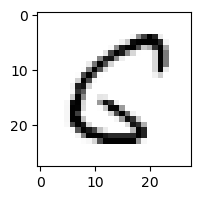

0.008027892471618898% - 0
7.678557710510228e-08% - 1
2.0947843810972587e-06% - 2
2.6128300859298553e-26% - 3
1.8908016742753796e-05% - 4
99.76617459208217% - 5 - ОШИБКА
4.9165515726069685e-14% - 6
2.863133549930382e-10% - 7
0.0059731906305305294% - 8
9.627564653758326e-22% - 9

 5


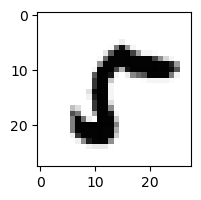

88.86491175827432% - 0 - ОШИБКА
2.5533202564010386e-12% - 1
1.242183392626057e-13% - 2
7.428469495416785e-17% - 3
2.3162949137145572e-21% - 4
8.969520824744992e-06% - 5
2.9536364976351102e-21% - 6
1.9879599848458977e-05% - 7
14.161473945320694% - 8
1.6642805582248036e-15% - 9

 9


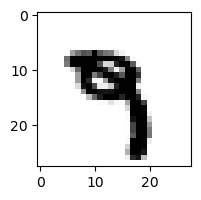

3.9991246498082386e-23% - 0
2.92016994420512e-09% - 1
4.8315419261779995e-26% - 2
9.387464744974341e-11% - 3
5.918011086517773e-09% - 4
0.0033888746137471734% - 5
6.081023426893083e-16% - 6
0.08232388678131337% - 7 - ОШИБКА
2.1820076371660124e-23% - 8
5.584512650650614e-07% - 9

 9


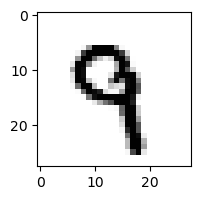

1.1171227126623994e-19% - 0
2.643207337074102e-06% - 1
2.770162563480907e-16% - 2
4.953991661331674e-08% - 3
3.995354854295678e-06% - 4
0.008580090838780502% - 5 - ОШИБКА
7.395180210459375e-12% - 6
0.0034461548593364196% - 7
3.890915380463327e-23% - 8
0.0024585239063731348% - 9

 2


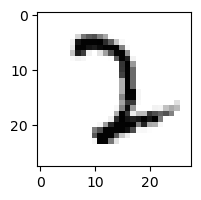

5.343214807181769e-11% - 0
1.1724850821214084e-07% - 1
99.99854915290472% - 2
99.99981660891704% - 3 - ОШИБКА
1.1952860523023607e-13% - 4
2.1471497788240056e-05% - 5
2.1588197665194025e-09% - 6
0.00033639165806183453% - 7
1.0764445468082993e-20% - 8
1.0949353532239435e-19% - 9

 8


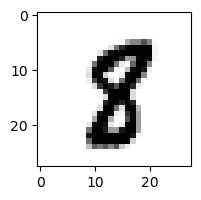

8.773736424367962e-20% - 0
3.1227622630871144e-08% - 1
1.973735781580084e-24% - 2
1.2225613181383007e-20% - 3
4.6074503433710995e-15% - 4
0.008781956614527566% - 5 - ОШИБКА
2.0103848961928e-21% - 6
8.306335384410424e-06% - 7
3.0202897495316177e-05% - 8
8.26020776996518e-21% - 9

 9


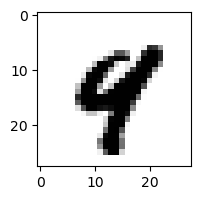

2.7913672055004325e-23% - 0
8.596576027390042e-14% - 1
7.166264364531365e-30% - 2
5.250348719636169e-38% - 3
0.5535695116521712% - 4 - ОШИБКА
5.333609647644543e-08% - 5
2.4606864200695712e-18% - 6
0.0001726623350668545% - 7
1.6336045202778549e-15% - 8
1.1484379038770633e-06% - 9

 8


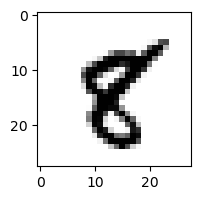

2.239245182492582e-18% - 0
3.1596536432996744e-05% - 1
9.969052771265977e-24% - 2
2.0749516723991144e-31% - 3
1.9015953561002174e-09% - 4
0.0016828291188933293% - 5 - ОШИБКА
8.898938748980301e-22% - 6
3.2766338685488077e-07% - 7
3.256276459315627e-05% - 8
8.500154928091243e-14% - 9

 8


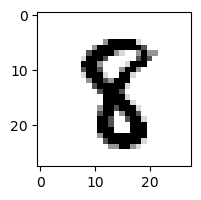

3.511342641184239e-25% - 0
1.034142071500679e-08% - 1
2.390548427936166e-20% - 2
1.3759293194592048e-21% - 3
3.513844769229518e-09% - 4
0.3310594926193862% - 5 - ОШИБКА
1.9989066455727716e-22% - 6
6.686453330714839e-10% - 7
1.7858701171714656e-07% - 8
2.3448420745077705e-31% - 9

 9


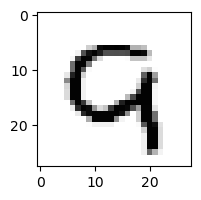

6.519441179149432e-06% - 0
2.6662497725522088e-14% - 1
0.14382079513983312% - 2 - ОШИБКА
1.0202989888680533e-28% - 3
9.157863429016002e-06% - 4
2.811704953407874e-09% - 5
0.0005275484151567479% - 6
0.0028228077893262308% - 7
2.3027630523498265e-23% - 8
2.0386725191698814e-06% - 9

 9


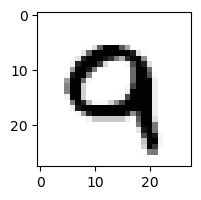

3.982927174485657e-10% - 0
1.647424006686666e-17% - 1
3.3479245332983346e-09% - 2
8.50020114574031e-35% - 3
2.7467493784115853e-07% - 4
4.915965030329679e-12% - 5
1.971341860705288e-12% - 6
0.1355897117943043% - 7 - ОШИБКА
1.569882423410007e-25% - 8
0.002286684873290914% - 9

 5


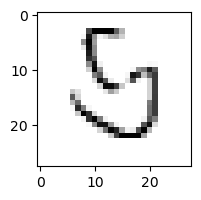

1.831704670774137% - 0
6.87402475466696e-06% - 1
2.0462994360465387% - 2
4.193041033948579% - 3
0.026560794413562076% - 4
6.822853830407878e-08% - 5
99.78327557361045% - 6 - ОШИБКА
0.0001431853522276277% - 7
0.2038972076984441% - 8
1.433645404263461e-11% - 9

 5


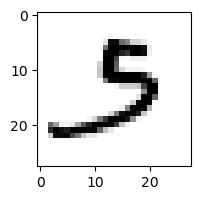

0.00026661127971194516% - 0
3.829855988275682e-05% - 1
6.155623359400341e-07% - 2
50.28000161842907% - 3 - ОШИБКА
2.832273214235777e-17% - 4
0.0015404071169116743% - 5
0.00017329622547739446% - 6
0.10434622956608491% - 7
6.863096672971022e-22% - 8
3.5660568846522335e-14% - 9

 8


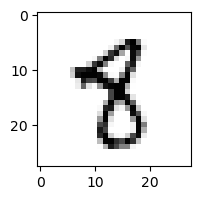

2.6250014076150072e-17% - 0
2.6052796296687132e-05% - 1
1.5678692869760682e-23% - 2
2.2055218409061927e-16% - 3
1.1409469794890778e-05% - 4
15.710914192567335% - 5 - ОШИБКА
1.563185924555208e-12% - 6
7.757155767440601e-06% - 7
2.384443706662962% - 8
3.976144700225847e-09% - 9

 1


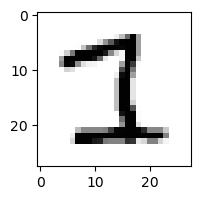

2.6578408128508352e-14% - 0
3.070782681256936e-07% - 1
0.10399363576028256% - 2
1.4493554531026935% - 3 - ОШИБКА
5.345933004277438e-12% - 4
0.002827422973410221% - 5
5.680853056167725e-23% - 6
0.002008473575859025% - 7
2.7053517280221295e-17% - 8
2.944237029258183e-35% - 9

 3


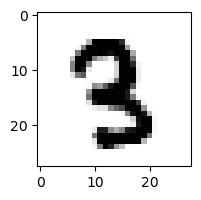

2.5712759396964625e-24% - 0
2.4814971014940856e-11% - 1
4.816444423933142e-12% - 2
0.00024349686994823324% - 3
5.719579224636486e-13% - 4
0.0010512633103961925% - 5 - ОШИБКА
2.817618648347893e-25% - 6
6.539738427182652e-10% - 7
8.699822582708075e-22% - 8
1.2159900343290946e-27% - 9

 9


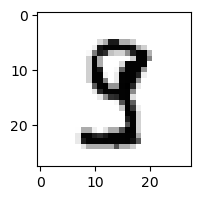

7.994310273726887e-14% - 0
8.363139107665137e-07% - 1
1.2806310339498252e-21% - 2
0.22796170726876036% - 3 - ОШИБКА
6.479500807246944e-07% - 4
0.17607835204493125% - 5
3.608825251610927e-26% - 6
0.0011501623920380797% - 7
3.6418257434838044e-06% - 8
5.386935132592987e-19% - 9

 4


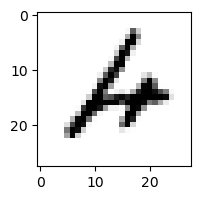

8.503643300857518e-08% - 0
6.049505018815206e-09% - 1
0.016082276382589095% - 2
3.0930944829929825e-09% - 3
0.001100362587132076% - 4
8.702146673650027e-07% - 5
98.8852431747874% - 6 - ОШИБКА
9.190309076151308e-08% - 7
6.3832428651067836e-15% - 8
1.444648165466863e-08% - 9

 2


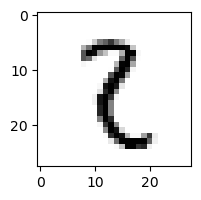

3.7323829766418085e-12% - 0
25.25304131464018% - 1 - ОШИБКА
3.838278216459346e-05% - 2
0.002229169160702566% - 3
7.569907578593086e-11% - 4
0.010727159011039118% - 5
2.608212927243025e-09% - 6
9.085426923863624e-07% - 7
1.207167147870559e-06% - 8
7.585674739225644e-12% - 9

 9


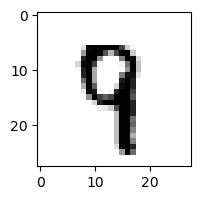

1.278153063969087e-20% - 0
1.4947177458294596e-08% - 1
1.015311283406772e-13% - 2
3.227072955638327e-14% - 3
0.0002725044807769077% - 4
0.014951487189600373% - 5
7.871097706511139e-13% - 6
2.0951810293094444% - 7 - ОШИБКА
1.4758831598848252e-15% - 8
1.076598931449453e-05% - 9

 8


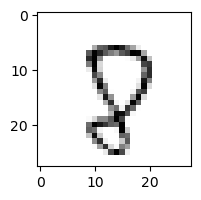

5.317655708471335e-06% - 0
3.6265792860901784e-10% - 1
7.485464460437273e-05% - 2
3.886549698867659e-10% - 3
1.2395636361085695e-06% - 4
0.7357976159908708% - 5
8.209920897900927e-06% - 6
7.112591415488553% - 7 - ОШИБКА
0.001041075588324117% - 8
0.013109183953153962% - 9

 8


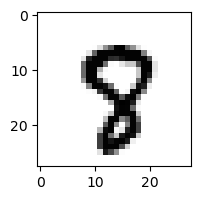

4.444281506858335e-16% - 0
3.4987673328029247e-16% - 1
2.9285312668145923e-22% - 2
1.712585143114358e-20% - 3
1.6658483868842954e-11% - 4
0.007424567178303357% - 5
1.6832612642538088e-18% - 6
0.007428829148606782% - 7 - ОШИБКА
9.565418031219961e-09% - 8
5.989193913385056e-09% - 9

 6


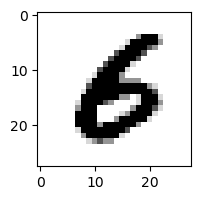

1.2720127679196396e-10% - 0
2.377984188925781e-11% - 1
3.128523358084948e-20% - 2
4.2821189674774255e-16% - 3
9.422355657163509e-16% - 4
0.0902667586616053% - 5 - ОШИБКА
0.016778695794612757% - 6
2.8724094299009284e-16% - 7
1.2687515349078498e-38% - 8
4.710522833035212e-31% - 9

 3


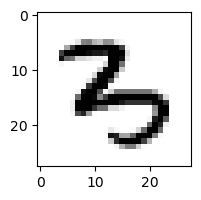

5.394275141451443e-14% - 0
1.6571625209940064e-14% - 1
8.542929731805977e-07% - 2
4.590408021748222e-09% - 3
0.02640712229746786% - 4 - ОШИБКА
1.0974231078670176e-06% - 5
4.905661640165834e-10% - 6
3.27367288174783e-08% - 7
5.629276360739869e-32% - 8
6.439256821166406e-18% - 9

 8


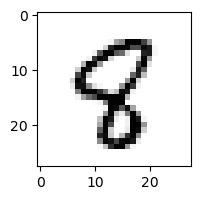

5.163919523153668e-13% - 0
2.524587410265071e-07% - 1
6.739548584793598e-13% - 2
2.791666680056137e-19% - 3
4.9537660589445324e-05% - 4
3.774595416335116% - 5 - ОШИБКА
1.190207728808221e-11% - 6
3.6106260726052744e-07% - 7
2.991494507812292e-06% - 8
7.437154567899818e-16% - 9

 9


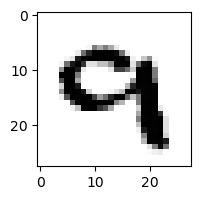

1.7817469302119971e-10% - 0
5.3452365876100855e-14% - 1
8.906617754109224e-08% - 2
8.342378878126617e-17% - 3
5.5259450430412423e-08% - 4
1.767866642281972e-13% - 5
2.3215515770986056e-13% - 6
0.005278899069729899% - 7 - ОШИБКА
1.1781006853436474e-32% - 8
1.2026143271658506e-07% - 9

 5


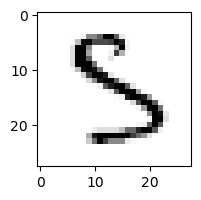

6.630054989662504e-11% - 0
2.9773155160837226e-09% - 1
6.774121743065409e-09% - 2
96.77434120835021% - 3 - ОШИБКА
4.310574156569862e-05% - 4
6.932631590721783% - 5
1.761264222271803e-09% - 6
1.0836265870011922e-07% - 7
4.3496730133930536e-08% - 8
3.6804925946219745e-20% - 9

 9


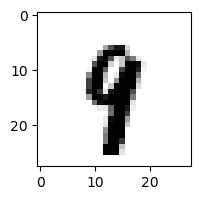

1.577539708896951e-23% - 0
7.142206919286691e-07% - 1
1.9827323091777406e-22% - 2
4.74610474162591e-21% - 3
7.377395873786359e-06% - 4
0.004184328689904516% - 5
1.0238621209874468e-14% - 6
0.0509795070665347% - 7 - ОШИБКА
4.174284259539742e-18% - 8
2.643253092296661e-06% - 9

 3


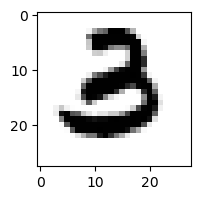

2.706536628843343e-13% - 0
3.6226522042801386e-15% - 1
1.3821184197009284e-14% - 2
0.00033340489191728334% - 3
3.9114053289297752e-25% - 4
0.0067796726339196% - 5 - ОШИБКА
4.297406075399451e-12% - 6
4.731903409461256e-19% - 7
3.104962031332375e-51% - 8
2.0147854485218768e-50% - 9

 9


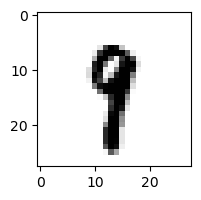

1.3194659555643841e-19% - 0
0.277928158888167% - 1 - ОШИБКА
5.927460368048514e-19% - 2
1.7103915039188388e-12% - 3
3.591940870237259e-09% - 4
0.030380552218730483% - 5
7.482986809487539e-14% - 6
0.04098921840084566% - 7
2.7865230484051694e-10% - 8
1.6034177781641629e-07% - 9

 9


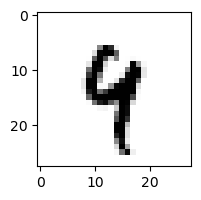

1.7656659909442403e-19% - 0
6.059013230585533e-05% - 1
5.489977281315985e-14% - 2
2.2851586364766615e-13% - 3
27.394444958221005% - 4 - ОШИБКА
0.018718809833679174% - 5
4.745762718060658e-08% - 6
0.027384798999927847% - 7
1.2073403443579863e-08% - 8
18.47491257564676% - 9

 2


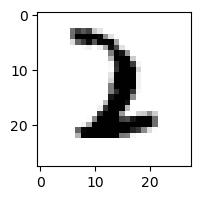

3.864568271051438e-25% - 0
0.8334958782936414% - 1 - ОШИБКА
0.0022920257494134263% - 2
5.949733920002321e-12% - 3
3.8516077252097825e-22% - 4
2.150926096723134e-09% - 5
2.635207368243758e-11% - 6
1.3410995199380437e-09% - 7
8.133427258597457e-33% - 8
1.1659131331300132e-30% - 9

 8


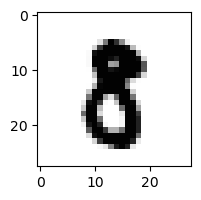

8.596997354072344e-14% - 0
2.530372208380723e-10% - 1
1.386052548541939e-20% - 2
3.521444004680254e-14% - 3
2.783377394366156e-20% - 4
0.00021663949761962825% - 5 - ОШИБКА
2.2057670352945956e-23% - 6
1.4733054550806109e-09% - 7
3.046990523739198e-11% - 8
5.167514033835814e-24% - 9

 8


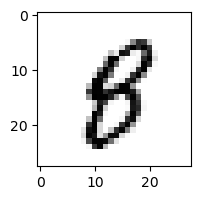

1.6694927829046898e-07% - 0
3.4964003463457933e-09% - 1
8.447339801227844e-15% - 2
1.804696784780107e-08% - 3
6.888614888066575e-07% - 4
0.1425823894212601% - 5 - ОШИБКА
8.20904053297956e-07% - 6
2.15344027115127e-06% - 7
0.05831760154002516% - 8
6.916806268738975e-06% - 9

 5


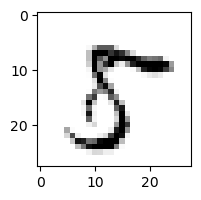

0.017273135573074812% - 0
2.4149539443019842e-11% - 1
9.943337575246966e-14% - 2
4.097722666738965e-08% - 3
4.5442033947216047e-10% - 4
3.3864396373982473% - 5
1.1553357216258148e-17% - 6
1.212579028304802% - 7
99.99397371311208% - 8 - ОШИБКА
3.190866058843113e-10% - 9

 3


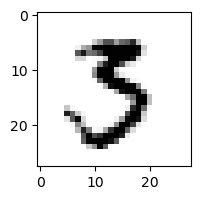

7.985805997845494e-10% - 0
1.9724203141538006e-11% - 1
6.581997028267155e-15% - 2
6.07710045235776% - 3
7.652505153074919e-20% - 4
45.972183378018336% - 5 - ОШИБКА
2.3318707051043032e-15% - 6
1.821167992417243e-05% - 7
6.231137417435818e-15% - 8
2.898786310130099e-21% - 9

 9


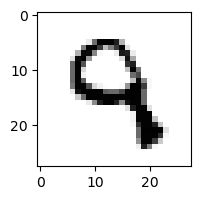

1.2783596088824554e-12% - 0
2.7695321300022877e-12% - 1
0.024981764047996204% - 2
0.0006610950117735974% - 3
0.5350370411184148% - 4 - ОШИБКА
0.055028372256786716% - 5
9.567875708582093e-10% - 6
7.795043329312085e-09% - 7
3.893604797025342e-30% - 8
1.4070958841589836e-08% - 9

 3


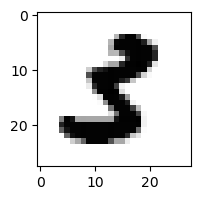

1.4299178033514633e-15% - 0
7.689779144995379e-08% - 1
4.481673669153649e-24% - 2
2.319351625562665e-12% - 3
2.853844877196329e-23% - 4
6.146737146946143% - 5 - ОШИБКА
2.1485359834738845e-29% - 6
4.993345481159542e-15% - 7
7.494094457161184e-29% - 8
2.6257787487253733e-49% - 9

 8


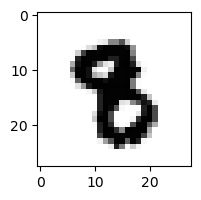

3.8455309354889303e-29% - 0
9.78001345981798e-11% - 1
5.3188142716718e-32% - 2
5.82835954086245e-20% - 3
4.278600908187988e-18% - 4
0.00030315242074846135% - 5 - ОШИБКА
3.936463985030321e-20% - 6
1.0429844254986095e-08% - 7
5.622302486242779e-31% - 8
6.95276442489602e-30% - 9

 9


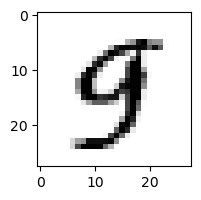

1.6442157626578486e-10% - 0
2.7957867123837716e-10% - 1
3.622416693880363e-22% - 2
2.1818003827127004e-11% - 3
0.0023393558480836758% - 4
0.24670308397009164% - 5 - ОШИБКА
3.319650542984387e-14% - 6
0.005291421655891267% - 7
1.3139331911412123e-16% - 8
0.0012933419154079796% - 9

 9


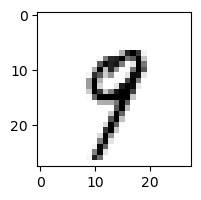

2.4230281269346605e-12% - 0
0.002819252732334907% - 1
1.6659340122966287e-12% - 2
3.975025013783294e-09% - 3
0.0032369724942633215% - 4
0.0010168644327492522% - 5
9.574290870414081e-08% - 6
26.498695734236644% - 7 - ОШИБКА
1.9420652787000173e-08% - 8
8.630390692456322% - 9

 4


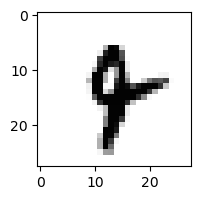

6.772709094437626e-23% - 0
5.01924772329179e-05% - 1
1.510359709327232e-20% - 2
5.338264835305699e-24% - 3
0.0012566117661491861% - 4
4.412870529926317e-06% - 5
3.947689302653438e-05% - 6
0.002671238383418502% - 7 - ОШИБКА
1.9636970133057126e-17% - 8
0.001265052410578395% - 9

 8


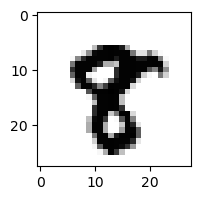

1.6305785200257668e-23% - 0
7.117397038134023e-13% - 1
1.152455781536925e-32% - 2
2.7295659301984514e-31% - 3
1.569731272194791e-22% - 4
1.8490072635266536e-05% - 5 - ОШИБКА
2.9439188697824792e-31% - 6
1.1975744934874407e-06% - 7
1.4505200523347938e-08% - 8
1.9599135388601714e-21% - 9

 7


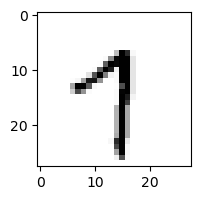

1.393091952998268e-09% - 0
0.9529249064981512% - 1
2.481344247650224e-16% - 2
2.929334471708614e-07% - 3
0.36875611152855975% - 4
0.11999503084288707% - 5
5.083584879198074e-05% - 6
99.51730339231027% - 7
1.708383329451696e-10% - 8
99.90062110035231% - 9 - ОШИБКА

 5


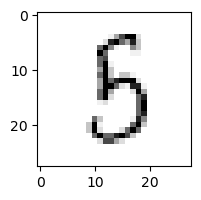

5.8549017941599864e-05% - 0
0.005781347536809701% - 1
3.055350593024013e-06% - 2
99.8299718889991% - 3 - ОШИБКА
0.003173176811391014% - 4
94.93434765674672% - 5
0.25756825522793697% - 6
9.089575172506058e-07% - 7
97.8532786545057% - 8
1.2582623857864993e-12% - 9

 3


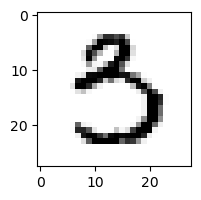

7.188769078489012e-05% - 0
1.590679562517484e-08% - 1
4.7675018679064325e-21% - 2
1.6147290973955306% - 3
2.4367097053900234e-14% - 4
48.55559735986103% - 5 - ОШИБКА
3.9511911019066287e-13% - 6
3.062254786809286e-06% - 7
9.560822456362574e-21% - 8
7.186625444592225e-25% - 9

 5


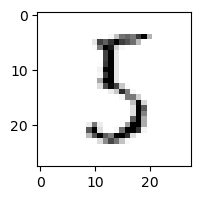

0.0012385133982243171% - 0
0.08045006860055338% - 1
0.000252114430228437% - 2
99.99717688445939% - 3 - ОШИБКА
6.156166897084862e-07% - 4
81.56368587633061% - 5
0.06689674132954342% - 6
2.07894506664039e-05% - 7
3.082357612109993% - 8
3.326614747025735e-15% - 9

 6


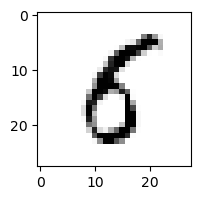

0.038508858385209725% - 0
0.00015239827995400089% - 1
1.2089560284039237e-10% - 2
6.223320310582644e-08% - 3
9.440018142072983e-07% - 4
41.43067443010006% - 5 - ОШИБКА
0.009831820164119546% - 6
7.074924418464262e-10% - 7
8.432435667677369e-05% - 8
3.5583741990946117e-06% - 9

 0


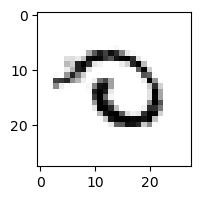

2.7353939365031987e-08% - 0
8.635333199228941e-08% - 1
0.04804454759009398% - 2
1.4628426147381476e-11% - 3
5.06493382627711e-06% - 4
3.0880634539303774e-05% - 5
74.66590156182397% - 6 - ОШИБКА
0.002124678358350098% - 7
2.170089508647874e-09% - 8
8.133648243450017e-05% - 9

 8


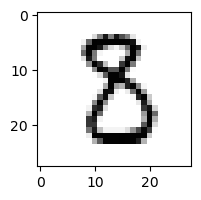

9.662461920943798e-10% - 0
1.5077796808830945e-05% - 1
0.0006679982331941626% - 2
0.0004442948438375593% - 3
4.905751763266218e-15% - 4
0.03520428576554174% - 5 - ОШИБКА
3.1895043955727716e-16% - 6
2.6889650579886547e-11% - 7
2.114001339204481e-07% - 8
1.074482859620409e-31% - 9

 4


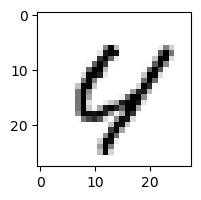

1.2639148150335926e-07% - 0
7.712650347010216e-14% - 1
8.450955726064128e-13% - 2
6.871022024592593e-34% - 3
1.6599046045582166% - 4
5.865206165360578e-05% - 5
0.004250618688030036% - 6
0.17004316013630907% - 7
6.529711068129078% - 8 - ОШИБКА
1.4195955700228616e-06% - 9

 5


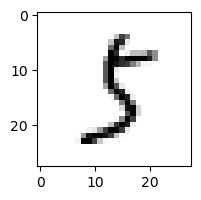

0.00022332400300079886% - 0
0.1504865979118398% - 1
5.512636092106824e-06% - 2
99.95771131858712% - 3 - ОШИБКА
9.981878908810052e-10% - 4
2.464164812700964% - 5
6.603391471134301e-10% - 6
0.014669810590054637% - 7
2.7225067270040295e-05% - 8
1.0931668244936405e-08% - 9

 8


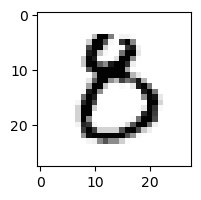

0.033948178436640726% - 0
6.946890627793504e-12% - 1
7.339079981121306e-10% - 2
6.958195501686234e-08% - 3
8.672065430658634e-12% - 4
1.4908833841054296% - 5 - ОШИБКА
8.981916028889925e-09% - 6
1.7019441966817713e-06% - 7
2.832541652454111e-23% - 8
3.2097447684138622e-27% - 9

 5


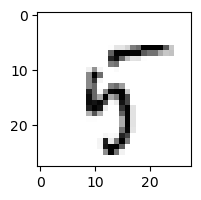

4.4857858497270436e-08% - 0
8.300330145092041e-05% - 1
1.9108598240422184e-06% - 2
9.626642512554186e-15% - 3
0.06606295203800912% - 4
3.5204138139129064% - 5
0.0003501897766333267% - 6
1.725282242101765e-05% - 7
20.859160130188513% - 8
99.98472805717641% - 9 - ОШИБКА

 9


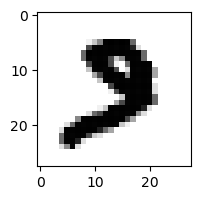

6.6035136669761254e-18% - 0
4.752917128577442e-13% - 1
4.452695602613942e-15% - 2
1.7688114281303087e-17% - 3
5.341053386765613e-26% - 4
1.2561463617063528e-09% - 5
3.413592520887542e-22% - 6
0.2217522461115181% - 7 - ОШИБКА
2.5137015196992782e-33% - 8
7.76866834735891e-37% - 9

 8


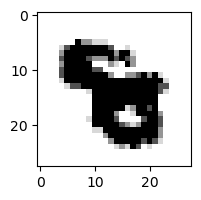

1.3375008293755652e-36% - 0
3.519997094136599e-21% - 1
3.899360124999172e-41% - 2
6.185417156038291e-41% - 3
1.7958534071568932e-13% - 4
1.6690350139653955e-13% - 5
1.793273651688162e-11% - 6 - ОШИБКА
1.6322415582110497e-14% - 7
5.985312261962936e-42% - 8
1.545253838546344e-34% - 9

 9


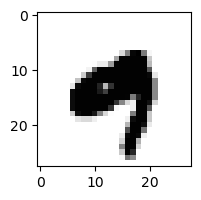

3.3141839666679656e-20% - 0
1.091166280112707e-10% - 1
1.231658524194848e-36% - 2
1.8236567543571958e-26% - 3
0.06469907003872594% - 4 - ОШИБКА
4.7504844634347785e-14% - 5
1.599476245787624e-14% - 6
1.4330692474138753e-08% - 7
1.2002687578836014e-38% - 8
1.5458660391819145e-09% - 9

 9


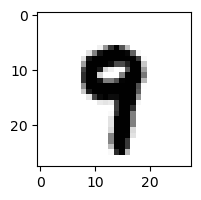

5.221333902737006e-24% - 0
9.446141220071003e-12% - 1
5.984621254435456e-28% - 2
1.4453621978251437e-20% - 3
4.6773344257198896e-08% - 4
0.0008050479901667207% - 5
6.569434890579877e-19% - 6
0.0059443579596666464% - 7 - ОШИБКА
1.2607672320723525e-20% - 8
0.0029260989720199123% - 9

 9


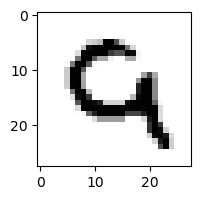

5.9252611453325296e-08% - 0
1.9098898581510641e-16% - 1
16.482825596598694% - 2 - ОШИБКА
2.1390917163694187e-29% - 3
2.527945473067999e-05% - 4
3.927472619822772e-08% - 5
0.010185428406199213% - 6
1.2662622438367838e-05% - 7
2.4474791735104854e-27% - 8
1.2559286288527513e-09% - 9

 8


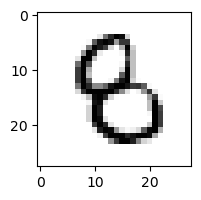

1.8716499025676127e-08% - 0
1.1531001369920951e-08% - 1
4.742992437322222e-07% - 2
1.5173753633668784e-09% - 3
1.2447540075890816e-06% - 4
0.5510767448016642% - 5 - ОШИБКА
6.915779546238713e-06% - 6
1.1204915456993674e-13% - 7
1.8413461628727213e-18% - 8
1.076410797512201e-17% - 9

 9


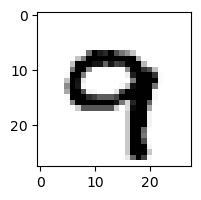

1.3751997259295136e-13% - 0
6.488223151740716e-13% - 1
3.034101979106364e-16% - 2
5.523944435912975e-24% - 3
3.5135330178472985e-07% - 4
1.7942754287731953e-13% - 5
8.526975877129838e-13% - 6
10.369406494418913% - 7 - ОШИБКА
3.75162166310775e-27% - 8
2.652961059591962% - 9

 8


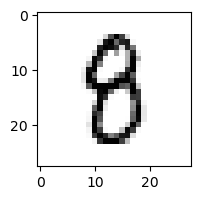

6.712280962720344e-07% - 0
2.757490679040609e-06% - 1
5.492167749483344e-12% - 2
6.981330624432818e-07% - 3
3.273792073849879e-08% - 4
1.0942892790439198% - 5 - ОШИБКА
4.910304645626254e-11% - 6
3.491884369512558e-08% - 7
0.013941497387650435% - 8
6.51049905582888e-13% - 9

 8


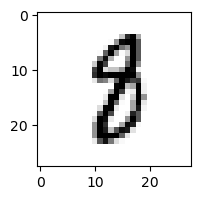

2.0757924291485126e-14% - 0
0.001839985833224614% - 1
2.5053463942250233e-15% - 2
8.785126686048908e-13% - 3
4.134397942367689e-12% - 4
0.12496301249009653% - 5 - ОШИБКА
9.27932969588913e-11% - 6
0.015824992834870332% - 7
1.2384619419814459e-09% - 8
8.51969881273924e-20% - 9

 5


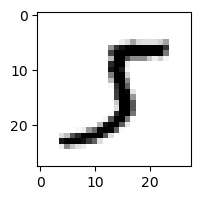

3.364829793310921e-10% - 0
16.391875867393555% - 1 - ОШИБКА
1.509653986779189e-09% - 2
0.0034590561395585373% - 3
1.1744607563618007e-11% - 4
0.4351643996118101% - 5
6.334909812670723e-14% - 6
1.100212932595846% - 7
2.4879857819424942e-23% - 8
2.5467276105336346e-14% - 9

 9


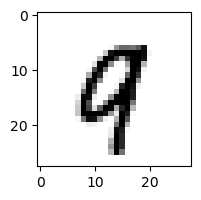

2.163485715808114e-12% - 0
7.884106449116561e-09% - 1
7.69596099910715e-12% - 2
1.2011776414848412e-28% - 3
3.6943145339843455e-06% - 4
1.3401974790771369e-07% - 5
1.218538638364605e-10% - 6
0.28605361582783156% - 7 - ОШИБКА
3.037204139933985e-11% - 8
0.16086633890169433% - 9

 8


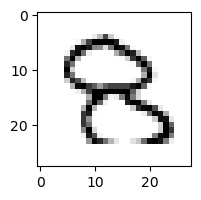

0.00035124467556016793% - 0
3.647068036946115e-11% - 1
59.50393320620524% - 2 - ОШИБКА
0.7227946453304311% - 3
1.3008908686020958e-06% - 4
1.0628791096342256e-06% - 5
2.3195461490161983e-12% - 6
1.434144721874503e-10% - 7
1.997731690773356e-14% - 8
0.00029559158046755705% - 9

 8


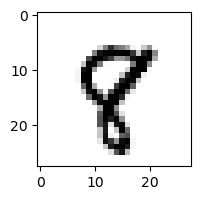

2.31507150624384e-18% - 0
2.9462358450084725e-07% - 1
5.473320642034709e-18% - 2
6.260740200520449e-22% - 3
1.150640756502795e-10% - 4
0.0034218567329522007% - 5
4.3557844429146935e-16% - 6
0.3186417166757221% - 7 - ОШИБКА
1.1326348386232499e-08% - 8
0.0001267866365323731% - 9

 9


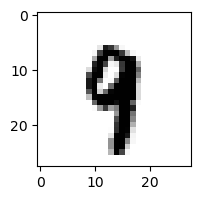

3.9692153194197856e-25% - 0
3.3699980403640188e-06% - 1
4.0552350743558855e-20% - 2
5.992483595592667e-18% - 3
8.710881586900521e-06% - 4
0.0006800251191481202% - 5
1.6684896219057338e-15% - 6
0.019137973725492925% - 7 - ОШИБКА
1.401082318282087e-17% - 8
0.00016279258516799816% - 9

 8


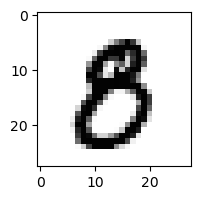

1.9050700142992775e-07% - 0
1.858302244136794e-13% - 1
7.447905165452659e-24% - 2
7.722704686996536e-09% - 3
5.374180164171177e-17% - 4
0.015317444384135312% - 5 - ОШИБКА
5.511394056038417e-23% - 6
1.8057019673864449e-10% - 7
2.3464058809697636e-18% - 8
6.896846986053595e-22% - 9

 5


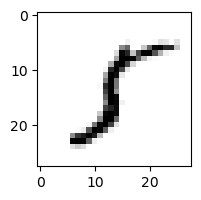

1.6985846215100829e-07% - 0
99.94541514762494% - 1 - ОШИБКА
2.110921311126291e-07% - 2
7.302557300336597e-06% - 3
5.125063413956559e-09% - 4
3.0848953175088654% - 5
4.232321493001088e-08% - 6
0.0007455379543654979% - 7
1.7014929639516844e-13% - 8
5.707618197372523e-13% - 9

 9


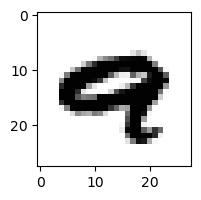

5.062716235111042e-16% - 0
2.352085162933406e-15% - 1
6.820791164104164e-38% - 2
5.162065622668528e-43% - 3
0.07947238449275956% - 4 - ОШИБКА
4.745699199047347e-19% - 5
7.04303126124861e-18% - 6
0.00022740043364019195% - 7
5.693644117133704e-37% - 8
1.5788968374709428e-15% - 9

 2


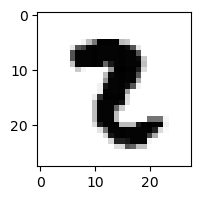

2.7859945079301835e-29% - 0
2.7873811214736394e-06% - 1 - ОШИБКА
2.892262507345298e-09% - 2
8.392130404289254e-16% - 3
1.6919860311545415e-24% - 4
7.675275411073362e-08% - 5
1.2648236515404683e-25% - 6
5.355795980608246e-10% - 7
3.1236190610455658e-24% - 8
5.337489436935863e-34% - 9

 8


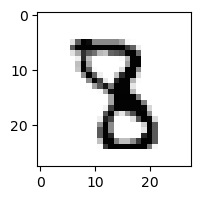

1.312205393722509e-23% - 0
3.1801829078888263e-12% - 1
4.8810997834943885e-17% - 2
1.1470068521045137e-08% - 3
2.037566695952464e-09% - 4
0.00016636324836230508% - 5 - ОШИБКА
1.7787855762851214e-22% - 6
1.487832994416246e-05% - 7
5.745145884180104e-23% - 8
5.245610838333056e-21% - 9

 9


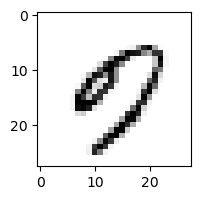

43.95281133277838% - 0 - ОШИБКА
2.7031073934658616e-10% - 1
1.1410518178079351e-17% - 2
1.3257529997760835e-10% - 3
0.08841886084320044% - 4
0.02638326964216184% - 5
0.009589588865403106% - 6
0.00016144531927943768% - 7
2.7762224527494877e-11% - 8
0.0009403308257203371% - 9

 8


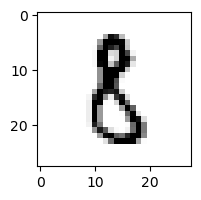

1.3597790190012247e-07% - 0
0.003514140225465174% - 1
3.707171337764962e-06% - 2
1.2265267893103863e-05% - 3
4.411210345048205e-14% - 4
0.890449040503066% - 5 - ОШИБКА
7.1584098074185315e-09% - 6
4.634243249349169e-11% - 7
0.014443661360740413% - 8
1.469298804281178e-16% - 9

 2


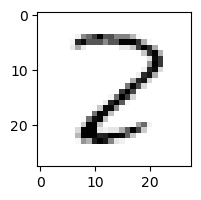

1.3614859144523677e-05% - 0
0.010156590022943767% - 1
99.77314993053417% - 2
6.694545987109646e-09% - 3
3.232034305408936e-07% - 4
1.3113125997120919e-05% - 5
3.9559955480146814e-08% - 6
7.234172747101965e-07% - 7
99.9999880865246% - 8 - ОШИБКА
5.01417584333575e-25% - 9

 2


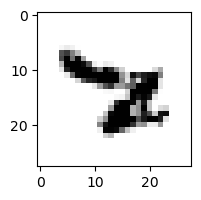

1.0647184222707098e-19% - 0
2.0987448847662281e-10% - 1
7.457474828586093e-26% - 2
5.184702581799381e-23% - 3
0.00011970875225931628% - 4
2.0254009465222687e-07% - 5
16.669935612155843% - 6 - ОШИБКА
0.010746226344136458% - 7
7.194558200417278e-23% - 8
8.343864598251895e-21% - 9

 1


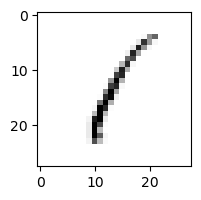

0.22170616360132717% - 0
99.96999750810637% - 1
84.11868120986475% - 2
10.561820697519192% - 3
0.0058437068409963044% - 4
0.6862150990664839% - 5
49.67892647871345% - 6
0.00016422293218295623% - 7
99.99974483976636% - 8 - ОШИБКА
27.722793561146997% - 9

 0


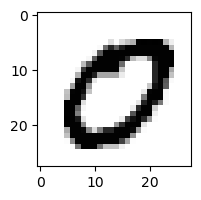

35.82796186748149% - 0
8.755671268209214e-19% - 1
4.0898259263113755e-33% - 2
6.832044301662748e-24% - 3
2.2041868073764864e-21% - 4
61.15094227023147% - 5 - ОШИБКА
3.68408271566036e-24% - 6
4.043224750745617e-08% - 7
1.8783769950128334e-29% - 8
2.6097194530066907e-45% - 9

 7


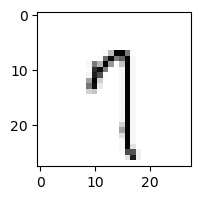

0.007494848563741057% - 0
0.21391504780699533% - 1
0.00032076225312292176% - 2
0.10462028054864209% - 3
1.2121204847293243% - 4
2.3950078221957183% - 5
0.05720299072127752% - 6
91.18922469877967% - 7
0.01169063764271154% - 8
99.99999999197948% - 9 - ОШИБКА

 1


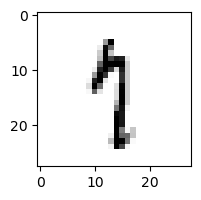

6.112343957424819e-09% - 0
0.4196689544929316% - 1
2.1855167250167346e-09% - 2
2.5363340789849375e-08% - 3
1.4627102242797527% - 4
3.354612376469077% - 5
0.0012224481895089447% - 6
95.04679245594032% - 7 - ОШИБКА
0.00020864431521087904% - 8
0.0007294532606977129% - 9

 2


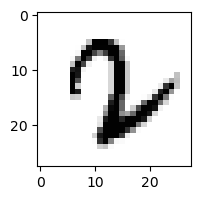

5.34307665097811e-20% - 0
0.00015024276344046786% - 1
4.8437086013876914e-17% - 2
1.5535560430530618e-11% - 3
1.3739761852694177e-17% - 4
3.6858037193636e-06% - 5
6.350130209161446e-05% - 6
0.0008717057386519895% - 7 - ОШИБКА
5.394011119851025e-34% - 8
8.663610550989144e-34% - 9

 8


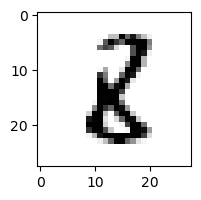

4.907241104512793e-16% - 0
0.007370078029308573% - 1 - ОШИБКА
6.131128440635388e-06% - 2
2.9528584592252936e-16% - 3
4.0883063421601724e-07% - 4
0.005851591506887007% - 5
6.2240522596297495e-12% - 6
2.9535249439405625e-14% - 7
0.0016205025661036496% - 8
3.3726670240623206e-31% - 9

 6


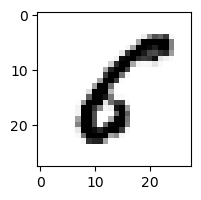

0.01877373507791211% - 0
0.001546881637074075% - 1
1.1739225595688888e-07% - 2
8.628234086780033e-19% - 3
2.834627671162178e-07% - 4
76.13007612563665% - 5 - ОШИБКА
7.506131771194994e-10% - 6
1.4073915517189267e-11% - 7
1.3744581171410741e-14% - 8
5.288717456307998e-27% - 9

 1


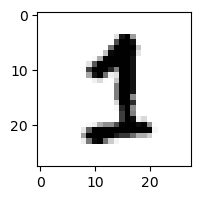

1.1321351752353068e-13% - 0
9.763831276259572e-06% - 1
5.1142527295596794e-11% - 2
7.549242467778898e-10% - 3
3.3694447910068387e-16% - 4
0.029539670769724576% - 5 - ОШИБКА
1.4760131195950353e-16% - 6
0.003188689191038657% - 7
1.2993598306901201e-17% - 8
1.3762942080686452e-18% - 9

 9


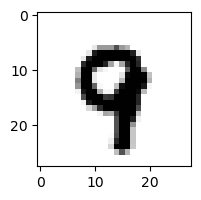

7.743963379034823e-24% - 0
3.779777977370421e-13% - 1
5.927794657973795e-20% - 2
6.649454107246755e-31% - 3
7.021986098571975e-06% - 4
4.825094931435674e-07% - 5
1.0691960954888971e-15% - 6
1.2701622752220545% - 7 - ОШИБКА
2.300079643934767e-23% - 8
0.08331397207980609% - 9

 9


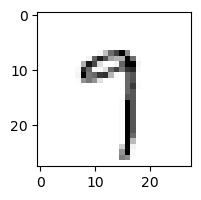

6.780848030537932e-05% - 0
0.007997193479001475% - 1
5.8433368486368915e-08% - 2
0.035834629624363734% - 3
0.0006520264889727338% - 4
0.25400663387798755% - 5
1.7094527670849015e-06% - 6
99.72356324507473% - 7 - ОШИБКА
1.916787887393821e-05% - 8
99.62710817451989% - 9

 7


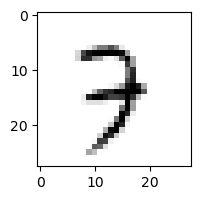

2.484548329613167e-10% - 0
2.4782997869741234e-06% - 1
0.6370200420356026% - 2
45.02806634494339% - 3 - ОШИБКА
0.009952360557167602% - 4
0.02531566744256688% - 5
0.0002093987142968752% - 6
1.3951486143521798% - 7
8.944574417505501e-07% - 8
11.418035768617413% - 9

 6


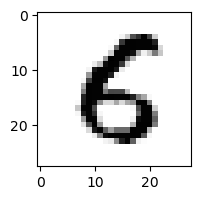

4.472491404117715e-05% - 0
7.192976913132775e-11% - 1
1.3431497316085162e-12% - 2
1.8687465881987614e-18% - 3
4.030990229812303e-09% - 4
11.322909461226153% - 5 - ОШИБКА
0.0003684807523813848% - 6
7.065214634554441e-14% - 7
1.6854630424239678e-24% - 8
2.071905009182012e-22% - 9

 8


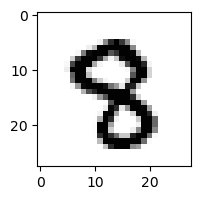

2.722861202226292e-18% - 0
7.662484346607759e-15% - 1
1.2690513449738744e-22% - 2
6.42572482568456e-17% - 3
1.7586791150489767e-11% - 4
0.0009785695552118193% - 5 - ОШИБКА
2.411432298355304e-22% - 6
1.7990795072772484e-06% - 7
1.7897287011185162e-21% - 8
4.416874528275722e-22% - 9

 2


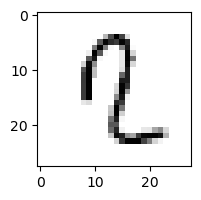

5.611943154408958e-10% - 0
0.4352978295255842% - 1
0.006773054968796406% - 2
7.093893103885929e-11% - 3
10.039139491911838% - 4 - ОШИБКА
0.374866421601266% - 5
1.8820216438295463e-08% - 6
0.001291448014994235% - 7
1.5860541433006069e-15% - 8
6.750294087373567e-11% - 9

 8


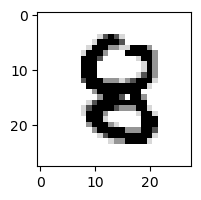

4.375659480292954e-21% - 0
9.01485002573016e-15% - 1
1.5367933039956056e-14% - 2
7.395767055156738e-26% - 3
2.435604894114051e-08% - 4
1.0003977322661709e-07% - 5 - ОШИБКА
2.5264891010499367e-13% - 6
3.6946823081313265e-15% - 7
4.1576826257514815e-14% - 8
1.2111291851179022e-24% - 9

 3


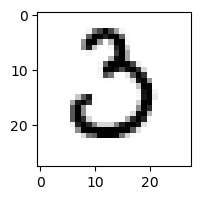

6.09541171602588% - 0
1.6081529931147552e-09% - 1
98.57537791906702% - 2 - ОШИБКА
17.771511606884598% - 3
2.2294606760838937e-18% - 4
1.4018988638405916e-05% - 5
2.2118195732683e-06% - 6
0.00042639029920446493% - 7
4.2897175001685375e-28% - 8
1.988398670736275e-25% - 9

 4


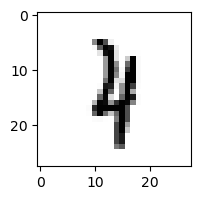

1.0288949342071255e-17% - 0
16.56024989420501% - 1 - ОШИБКА
0.0004625524827706345% - 2
2.5384582778988265e-11% - 3
0.007165437018608075% - 4
1.5331344874497557e-05% - 5
5.438554820886706e-06% - 6
0.001717775836454675% - 7
0.16676629571426332% - 8
3.407028665825654e-06% - 9

 5


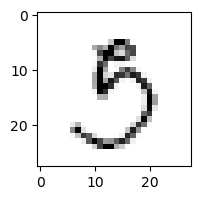

0.05031832281503679% - 0
0.0001224200644764128% - 1
3.358794493427538e-10% - 2
99.9993148926557% - 3 - ОШИБКА
2.2949699540660603e-07% - 4
70.46567073139431% - 5
2.236919211411265e-08% - 6
0.0004198640852702839% - 7
0.33367577637629625% - 8
5.68233096615956e-07% - 9

 2


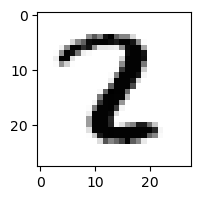

1.2752270664067841e-21% - 0
0.08563327624487607% - 1 - ОШИБКА
0.05477139261786035% - 2
1.083447160165861e-11% - 3
3.7910721315866126e-16% - 4
3.2245049987285904e-10% - 5
5.2789575636721055e-20% - 6
5.054932330074276e-13% - 7
3.2983332198446005e-18% - 8
8.815939607783566e-38% - 9

 9


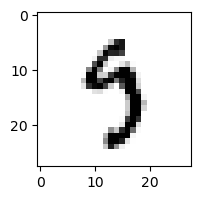

1.38256939823148e-09% - 0
2.2207118871726992e-05% - 1
2.5417008250517566e-21% - 2
1.6416415677094371% - 3
0.004401098552556917% - 4
16.818077364337668% - 5 - ОШИБКА
1.516995980617713e-08% - 6
1.553494079261167% - 7
6.546070750723369e-09% - 8
3.009153119569356e-07% - 9

 9


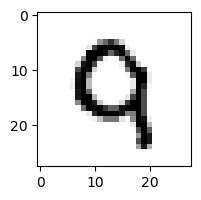

1.1983118682970514e-06% - 0
6.188958638267351e-14% - 1
0.05114487919373999% - 2 - ОШИБКА
1.5000234327097004e-26% - 3
0.0002126715776515948% - 4
2.690833938762802e-08% - 5
3.1489527324249373e-07% - 6
0.0019046441591583437% - 7
8.309066935943182e-23% - 8
0.0007585050717535384% - 9

 2


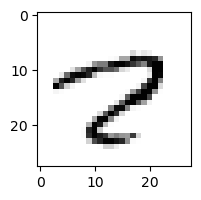

0.004487004640198648% - 0
6.435929035551778e-07% - 1
4.961564825423494e-19% - 2
6.405814668465436e-25% - 3
1.0354249800507004e-05% - 4
0.005173824507319824% - 5
4.186144464725325e-15% - 6
99.50748154752924% - 7 - ОШИБКА
0.00041129424280679874% - 8
1.807865738848913e-14% - 9

 8


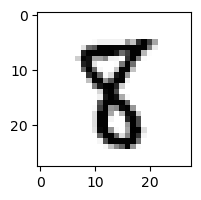

6.931000634596169e-19% - 0
3.251846072125696e-07% - 1
3.776512299447337e-18% - 2
3.347218530904645e-18% - 3
2.651511331018365e-12% - 4
3.262357301475728% - 5 - ОШИБКА
6.95412558065429e-16% - 6
3.6161966136698095e-09% - 7
3.682386074744986e-07% - 8
8.920044173420379e-24% - 9

 9


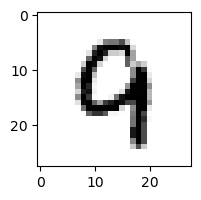

6.141121750480816e-11% - 0
5.951972787403382e-10% - 1
8.406646464549703e-06% - 2
1.4294907194052554e-21% - 3
3.5419948746486423% - 4 - ОШИБКА
1.237864475504067e-08% - 5
3.3215707090272855e-05% - 6
0.001289977563308089% - 7
2.1847558499001625e-15% - 8
0.0004613426760358851% - 9

 7


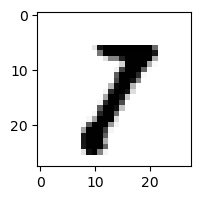

3.0983075939837055e-14% - 0
0.31105828765504095% - 1 - ОШИБКА
1.9460981867840944e-11% - 2
5.62534198292034e-07% - 3
6.161181745624521e-18% - 4
3.1010262099571592e-06% - 5
4.574193505213072e-22% - 6
0.24122432445396208% - 7
4.0174581247369686e-14% - 8
4.608927495672261e-10% - 9

 9


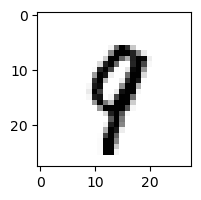

6.281461592829976e-14% - 0
1.464601393246102e-06% - 1
1.0763128518096376e-13% - 2
2.1909833725274028e-16% - 3
0.00015500394097800544% - 4
8.222677067588812e-05% - 5
5.857549105444096e-11% - 6
66.83141073794238% - 7 - ОШИБКА
4.3138486397265544e-09% - 8
20.298997339112155% - 9

 5


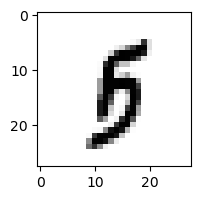

4.68254115379457e-15% - 0
3.770458498452135e-05% - 1
2.9205517779501755e-15% - 2
1.106412861513173e-06% - 3
3.1678900088273773e-09% - 4
0.10209751533923551% - 5
4.678096031806404e-06% - 6
3.365565142153984e-07% - 7
0.003425957474591054% - 8
0.21099945066695575% - 9 - ОШИБКА

 9


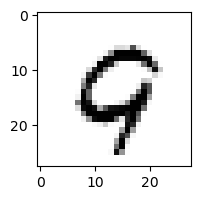

5.550899118488594e-06% - 0
5.288511472013301e-12% - 1
1.261747208117797e-09% - 2
1.556197578001118e-32% - 3
1.0653078537838064e-05% - 4
0.00017348054500269567% - 5
4.053266019103338e-05% - 6
1.699912920473306% - 7 - ОШИБКА
7.554590595683038e-17% - 8
0.0067109126750938995% - 9

 5


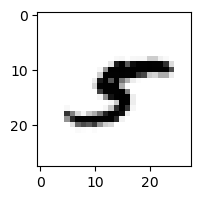

7.106385580736392e-13% - 0
1.3933235966377426% - 1 - ОШИБКА
7.285216209373355e-12% - 2
1.2860117183631267e-10% - 3
6.226962965605283e-08% - 4
4.568531581009378e-07% - 5
8.675271541917901e-14% - 6
0.0005503521424281562% - 7
0.0001811143885058945% - 8
2.6915253822453377e-18% - 9

 3


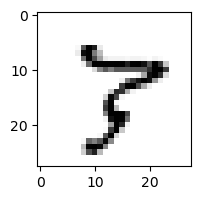

4.840922637499884e-14% - 0
6.627519396401939e-06% - 1
1.035208184481296e-08% - 2
1.7262749463722076e-13% - 3
9.621896878035974e-09% - 4
5.461539765535626e-10% - 5
2.2693660150676896e-12% - 6
99.95405698518944% - 7 - ОШИБКА
85.69375059804514% - 8
9.376214920008864e-14% - 9

 4


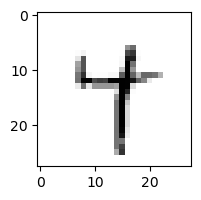

1.6098398064696915e-10% - 0
0.8462071751404984% - 1
3.5394260364509694e-16% - 2
0.00011400918603532286% - 3
90.03763580187054% - 4
0.00022483082055419615% - 5
0.0003419163360331596% - 6
33.13696370347984% - 7
0.00202392050415434% - 8
99.28438311926587% - 9 - ОШИБКА

 5


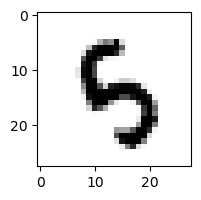

4.874422238125948e-17% - 0
2.2139882382510215e-10% - 1
2.6187628924805434e-11% - 2
1.3448761500314913e-08% - 3
7.485820606457583% - 4 - ОШИБКА
3.0609431771485704% - 5
4.566377679737551e-05% - 6
1.5059920694842383e-10% - 7
9.350289096868372e-19% - 8
2.0324969943974004e-08% - 9

 3


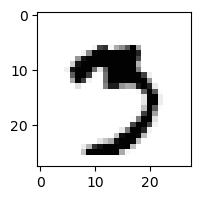

2.1999306667180027e-15% - 0
1.793413279822593e-11% - 1
4.6518262840189166e-30% - 2
1.198210025500355e-06% - 3
1.398582491742806e-22% - 4
0.03925495207322518% - 5
1.2013151113071901e-20% - 6
95.27117098815943% - 7 - ОШИБКА
2.645263180208707e-21% - 8
5.021338060434253e-12% - 9

 5


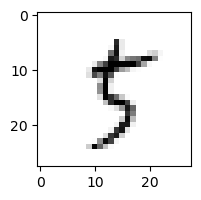

3.593455575013942e-05% - 0
0.04635914636727082% - 1
5.8836328402660805e-09% - 2
0.07003289833121891% - 3
0.0009451327392641851% - 4
22.32595578721032% - 5
8.306521194288395e-10% - 6
1.167935311767997% - 7
95.72761022976321% - 8 - ОШИБКА
0.00027366158421404934% - 9

 9


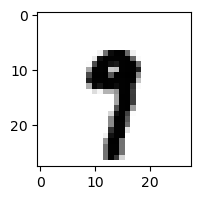

6.179992910319207e-21% - 0
1.1062625388933912e-05% - 1
7.955271528175263e-29% - 2
7.493865163637659e-16% - 3
3.154879842109744e-10% - 4
0.001518899649426118% - 5
2.1013436797365596e-15% - 6
16.78750418669241% - 7 - ОШИБКА
2.1564823543419835e-16% - 8
3.869870577282774e-08% - 9

 5


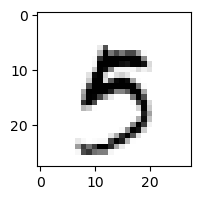

6.73479464872186e-10% - 0
4.758795693224313e-10% - 1
1.4593789691557981e-22% - 2
0.014351166044238375% - 3
1.552809854921731e-05% - 4
0.3404473622970057% - 5
4.640909465289153e-12% - 6
0.000688851456431063% - 7
2.304815516145235e-22% - 8
12.381951701546406% - 9 - ОШИБКА

 5


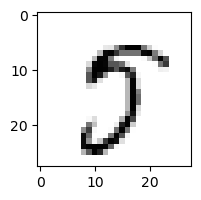

2.2824909283423862e-05% - 0
8.07662013941055e-10% - 1
1.43918379285731e-16% - 2
1.19579589675415e-06% - 3
3.444280577515328e-11% - 4
93.50492954051582% - 5
1.379438416752684e-14% - 6
99.82068835750567% - 7 - ОШИБКА
3.213442371946465e-06% - 8
1.3285382396187501e-06% - 9

 5


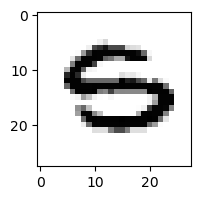

2.9381856406174566e-06% - 0
2.4028117548910838e-14% - 1
3.089221254580572e-19% - 2
3.612093102297383e-15% - 3
1.884782790533691e-17% - 4
0.002472808011850031% - 5
99.62199991439378% - 6 - ОШИБКА
4.1272740054667444e-11% - 7
6.584419247515409e-33% - 8
6.337681297548643e-16% - 9

 8


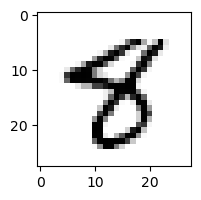

4.3127771540232894e-18% - 0
9.79211291411391e-09% - 1
5.514837558200333e-32% - 2
1.4801248738124662e-22% - 3
5.0770409088197106e-08% - 4
16.091113566150373% - 5 - ОШИБКА
9.244325744844945e-18% - 6
8.403261313107843e-06% - 7
9.010032551424972e-07% - 8
7.648841735818652e-17% - 9

 8


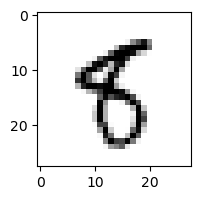

4.2933960945944254e-10% - 0
2.733689518633772e-06% - 1
6.921607132536339e-19% - 2
7.433936442662564e-15% - 3
1.2545728383674927e-10% - 4
39.496434068529645% - 5 - ОШИБКА
0.00016853012264026506% - 6
1.3914015143424543e-08% - 7
0.00018838666027820697% - 8
0.012535291047300574% - 9

 9


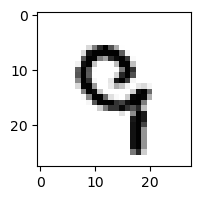

7.199604169100072e-16% - 0
2.0573370386071225e-08% - 1
4.069626956271932e-13% - 2
4.2801815982919636e-10% - 3
0.011822871120875763% - 4
0.008469050572604353% - 5
2.1106228672168115e-11% - 6
0.25888564190544355% - 7 - ОШИБКА
2.1141448517216019e-26% - 8
0.22333296555090468% - 9

 8


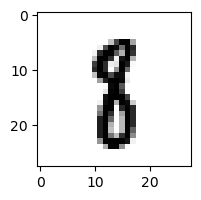

6.351847299511727e-20% - 0
0.027792740378541653% - 1
1.4434342511069398e-15% - 2
1.407938055818586e-16% - 3
1.843464379368249e-14% - 4
0.5651412608148103% - 5 - ОШИБКА
4.803245732581881e-12% - 6
3.4982834865743185e-06% - 7
0.2926168065752854% - 8
2.6009605328566413e-18% - 9

 8


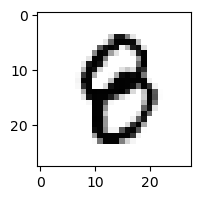

9.48478155259793e-12% - 0
5.180441351557424e-07% - 1
2.7983488525242997e-15% - 2
1.644423657568647e-13% - 3
1.2582084315462522e-09% - 4
0.11016842717263514% - 5 - ОШИБКА
2.2221126637024387e-08% - 6
3.581751098479218e-11% - 7
1.8118476540682194e-06% - 8
1.2935431884085335e-18% - 9

 9


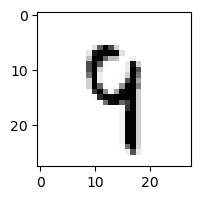

3.4174590255649184e-14% - 0
4.402303654492129e-05% - 1
8.589933934930668e-07% - 2
3.2302768605699834e-05% - 3
16.296882680042017% - 4 - ОШИБКА
0.0667016827839729% - 5
5.291694301897521e-07% - 6
3.5695610412945187% - 7
2.420884345021829e-05% - 8
2.2703499979113877% - 9

 9


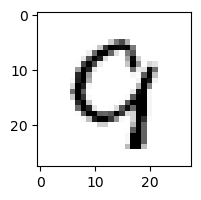

0.12726974261545093% - 0 - ОШИБКА
2.0421130417062935e-11% - 1
3.648817151395377e-05% - 2
1.3989571188339104e-22% - 3
0.00047090050252170373% - 4
2.921716358525867e-08% - 5
0.0006873828732694976% - 6
0.033697964001287876% - 7
1.760597980268972e-15% - 8
3.230855939409068e-07% - 9

 9


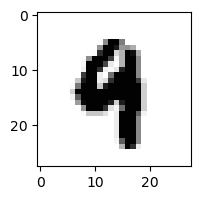

7.759862024467616e-23% - 0
4.87027133573829e-10% - 1
6.222764534843327e-25% - 2
3.6914402874561994e-25% - 3
0.0007539996317561244% - 4 - ОШИБКА
2.981350078353537e-06% - 5
4.0779167791149707e-16% - 6
3.8390606765079474e-10% - 7
1.5042295868414415e-30% - 8
3.3975198064407897e-09% - 9

 2


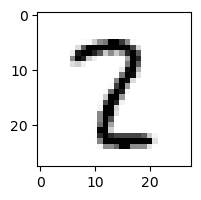

2.460320395912454e-15% - 0
0.00612831277213526% - 1
8.08961993906856e-07% - 2
8.045145101253714e-07% - 3
6.598780985237531e-10% - 4
0.0005507300569562347% - 5
2.2795641531144813e-18% - 6
0.05179256770480432% - 7 - ОШИБКА
0.000741276405759274% - 8
7.577511599087781e-21% - 9

 8


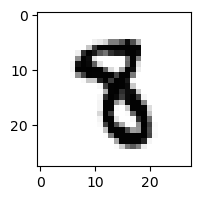

1.4696796442626024e-27% - 0
3.8606155811514025e-08% - 1
7.07855635348426e-23% - 2
4.226722267711356e-16% - 3
1.2173180452399645e-12% - 4
0.22202369272309821% - 5 - ОШИБКА
1.595823113674512e-18% - 6
3.7082585249084636e-07% - 7
4.109600524337522e-23% - 8
9.29437933397803e-27% - 9

 3


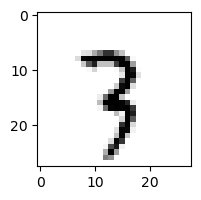

6.130712983294388e-18% - 0
0.05385920124648916% - 1
0.0005719136219442033% - 2
1.958680485811515e-07% - 3
0.0001283497548475266% - 4
9.127706790560638e-05% - 5
9.398877433880232e-10% - 6
98.60558049206398% - 7 - ОШИБКА
0.0003632599737465872% - 8
0.0004288369039774682% - 9

 6


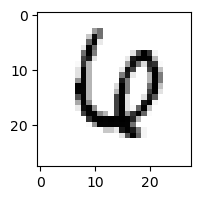

2.2622646366828046e-08% - 0
3.0529176402724645e-08% - 1
5.7409465690754496e-11% - 2
9.96911203150319e-20% - 3
0.00405786823960178% - 4
1.802073177124415e-10% - 5
0.00659773562599904% - 6
0.03266712190440034% - 7 - ОШИБКА
3.3417579736098674e-25% - 8
3.2047022134088143e-23% - 9

 6


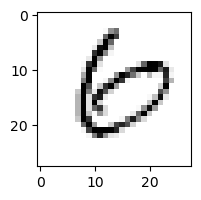

23.67111238031374% - 0 - ОШИБКА
6.916589316353242e-08% - 1
7.661314953123757e-08% - 2
2.0804507519437584e-05% - 3
6.266753196256738e-07% - 4
1.8364121671645353e-08% - 5
0.03866377521382482% - 6
9.170690761434649e-07% - 7
5.042133797458899e-06% - 8
2.078327273123409e-14% - 9

 2


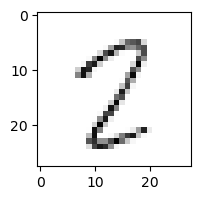

0.0009815182493927413% - 0
0.16611249557514537% - 1
0.019637309434821813% - 2
5.207848735202144e-06% - 3
0.00033557056149773816% - 4
2.5906450428967416% - 5
2.2625479358025624e-07% - 6
1.9810139469973977% - 7
99.99994782520598% - 8 - ОШИБКА
2.4809055479228803e-07% - 9

 9


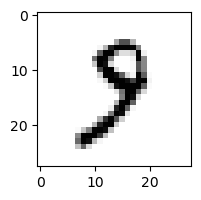

5.564548215567106e-10% - 0
0.026022387605169225% - 1
1.1084324983549619e-10% - 2
3.279063015793225e-07% - 3
6.305826508229388e-10% - 4
0.003062283314428041% - 5
3.3041030741559395e-10% - 6
3.100226822896902% - 7 - ОШИБКА
1.2521211929527292e-08% - 8
1.230967330130917e-08% - 9

 8


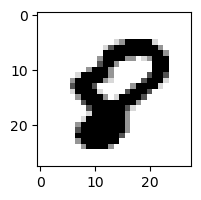

2.222464739307326e-09% - 0
8.915639928597829e-20% - 1
4.631560498181081e-33% - 2
2.4477808730258204e-55% - 3
3.5390904746602096e-15% - 4
8.195920638458063e-05% - 5 - ОШИБКА
1.9757952658427445e-14% - 6
1.929294589260786e-12% - 7
2.389548652787436e-17% - 8
2.1828748522656447e-29% - 9

 5


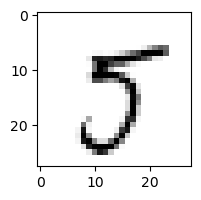

7.684727977201424e-07% - 0
1.1011710946971925e-06% - 1
2.6891955838297165e-20% - 2
0.0009187789676940731% - 3
5.866183411343096e-09% - 4
93.10040930625686% - 5
4.787678477296796e-15% - 6
96.17388987177195% - 7 - ОШИБКА
1.1200266453936468e-06% - 8
5.397725190780705e-11% - 9

 0


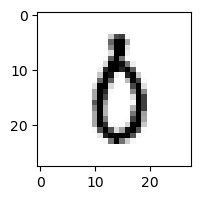

5.99245978978916e-05% - 0
4.429362857933892e-05% - 1
4.871934932601869e-08% - 2
0.0012081739222533827% - 3
8.51669912159708e-09% - 4
0.037253819431459695% - 5
0.6471149064727942% - 6 - ОШИБКА
9.947738855689283e-05% - 7
5.2728548659531355e-09% - 8
1.3749660551039187e-11% - 9

 8


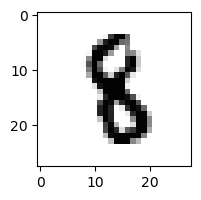

5.523753517730784e-25% - 0
0.00021817403743471374% - 1
1.202182307580653e-15% - 2
1.1814826788730507e-12% - 3
9.658821590945568e-10% - 4
0.08029437291818337% - 5 - ОШИБКА
9.84849363739789e-14% - 6
3.897893390079871e-09% - 7
2.074457191409379e-17% - 8
8.985440615756816e-29% - 9

 9


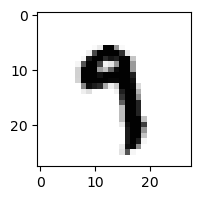

1.299495114206904e-18% - 0
3.0444378295199256e-07% - 1
6.2659805773401365e-27% - 2
3.5052532499554603e-09% - 3
1.3245032237257713e-07% - 4
0.2654108019640077% - 5
1.4959506526055244e-13% - 6
1.9505102869020758% - 7 - ОШИБКА
1.699677401067791e-19% - 8
0.00013240109930149146% - 9

 9


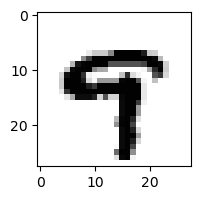

1.6453603632730516e-19% - 0
4.483599485647525e-15% - 1
4.109841038723989e-36% - 2
3.8960487725886657e-26% - 3
2.6790638587968775e-07% - 4
0.027198493966521516% - 5 - ОШИБКА
2.656389569065111e-22% - 6
0.003918228560417056% - 7
5.904986201213938e-28% - 8
0.02276906526161359% - 9

 7


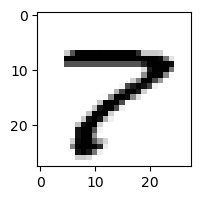

8.914279573585941e-11% - 0
7.425417995797467e-12% - 1
2.0728906107725167e-08% - 2
5.888323175940677e-17% - 3
6.535063332511649e-20% - 4
4.047449658493118e-11% - 5
1.7752112425998807e-21% - 6
99.33657611346018% - 7
99.81450629134562% - 8 - ОШИБКА
1.4649560164521072e-14% - 9

 9


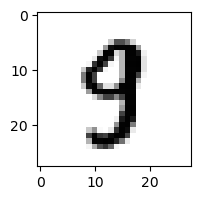

2.207065755904053e-11% - 0
5.861713869948447e-09% - 1
2.39372470990174e-18% - 2
3.9228548095121596e-08% - 3
1.7223753159369008e-07% - 4
0.06691189596999843% - 5 - ОШИБКА
4.136370161111128e-19% - 6
0.0028792249666388017% - 7
1.8194851767964465e-09% - 8
4.420224395970415e-08% - 9

 3


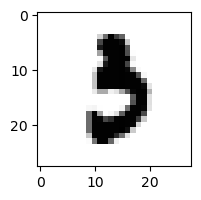

1.0063156374915592e-13% - 0
8.636911061163428e-09% - 1
4.2102578958121986e-19% - 2
1.4688331048009493e-08% - 3
2.448261098043159e-22% - 4
0.006615352202206514% - 5 - ОШИБКА
2.6370757143918637e-08% - 6
6.146757654427263e-07% - 7
1.297450181099816e-26% - 8
1.5437487505599013e-24% - 9

 8


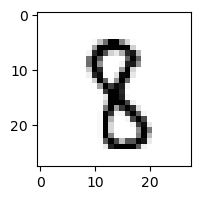

1.936857407577564e-19% - 0
4.9657291651089085e-05% - 1
5.223144098252667e-11% - 2
1.422355271130092e-09% - 3
1.0747230480342468e-07% - 4
0.2660881184169765% - 5 - ОШИБКА
1.473987511297303e-16% - 6
1.2622099050983968e-05% - 7
0.00010922974690342635% - 8
9.173550106288252e-16% - 9

 8


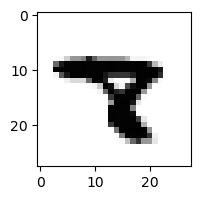

2.8136560366247525e-27% - 0
7.0158143837115855e-09% - 1
3.4750129575993754e-28% - 2
3.7537340389909376e-31% - 3
1.422363237665977e-08% - 4
2.085739868678781e-11% - 5
8.084978183502606e-20% - 6
2.918354469739363% - 7 - ОШИБКА
3.190678586611969e-20% - 8
6.13172951303965e-23% - 9

 7


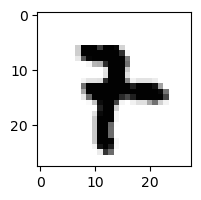

1.4904880772916529e-21% - 0
4.411607878531907e-09% - 1
4.0730277495140456e-22% - 2
2.2908727700448214e-14% - 3
2.491833811302714e-10% - 4
0.00016705259277947064% - 5 - ОШИБКА
4.260504198578969e-05% - 6
5.8727432343131906e-05% - 7
1.2358076187689883e-23% - 8
3.175249301446683e-14% - 9

 9


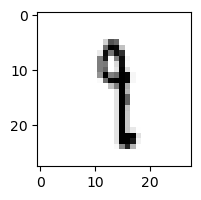

2.0734834583455514e-10% - 0
93.48706030835399% - 1 - ОШИБКА
2.0016629839694983e-07% - 2
15.144059596544176% - 3
0.0006325344280903644% - 4
0.1690756926804214% - 5
1.672668347058662e-05% - 6
1.0933688152719132% - 7
0.40232445124408084% - 8
0.7281979679149404% - 9

 9


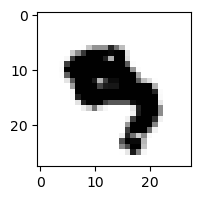

3.743388959247319e-28% - 0
5.765665193373752e-16% - 1
1.3370727238909209e-40% - 2
1.5729493563220678e-22% - 3
4.978150331233578e-10% - 4
0.031141622224694732% - 5 - ОШИБКА
2.4713221544656356e-15% - 6
1.2639937593617838e-07% - 7
3.1059066511992017e-45% - 8
2.408954529756582e-15% - 9

 9


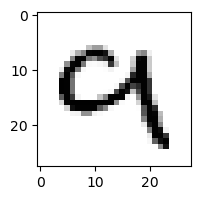

4.402413353577689e-11% - 0
1.8474987150387059e-09% - 1
0.011454792670810938% - 2
1.156115570530089e-12% - 3
0.006457156156140307% - 4
7.74182225143843e-11% - 5
4.252977126439581e-11% - 6
1.6113154294112302% - 7 - ОШИБКА
3.205176159942382e-13% - 8
5.444459153622301e-06% - 9

 8


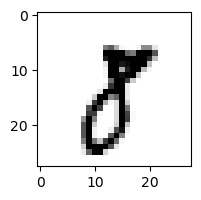

1.0846360782436498e-11% - 0
0.00409252360678106% - 1 - ОШИБКА
1.0508550837327186e-13% - 2
0.0018888932713962802% - 3
3.5222910342232606e-19% - 4
1.3817523574697749e-05% - 5
8.1770601621047905e-22% - 6
0.0004389797475118858% - 7
2.9474142450145395e-08% - 8
5.23032721341099e-09% - 9

 9


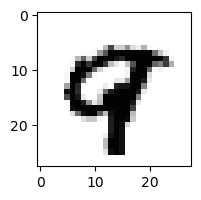

1.5002006792187823e-21% - 0
2.596945922736516e-15% - 1
7.552006400706009e-23% - 2
1.1104377078087801e-45% - 3
1.2500562615962418e-10% - 4
4.020383827144928e-09% - 5
3.850140628982217e-24% - 6
0.03144813233115091% - 7 - ОШИБКА
6.181398092356998e-12% - 8
1.9091645362410267e-10% - 9

 6


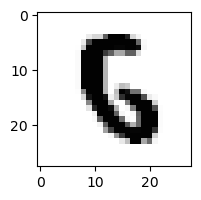

3.828892804969045e-21% - 0
2.1233500961645196e-17% - 1
1.395102049794593e-06% - 2
1.6498385649682271e-28% - 3
2.679256461525159e-09% - 4
3.015160837982087% - 5 - ОШИБКА
0.0006981493714344082% - 6
8.206205817387765e-14% - 7
1.8792282761765557e-35% - 8
1.4660307815074178e-31% - 9

 7


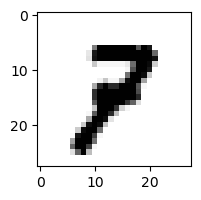

2.964914870678024e-14% - 0
3.361548383583034e-07% - 1
6.260272433450026e-07% - 2
1.4395346315976121e-09% - 3
5.768966811134413e-14% - 4
2.934847952431911e-08% - 5
1.0889127270265396e-18% - 6
0.0012530130083423577% - 7
4.4854224052146346e-11% - 8
0.0029439870148108534% - 9 - ОШИБКА

 8


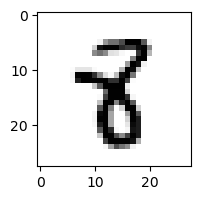

1.4946402968142473e-19% - 0
0.0009207130778177237% - 1
1.5975518393389696e-23% - 2
1.6877181999322008e-14% - 3
9.607940637895496e-07% - 4
0.8319264281651982% - 5 - ОШИБКА
1.8464826316764295e-15% - 6
6.064902467161749e-10% - 7
3.0786780525342417e-06% - 8
1.0076464069107742e-22% - 9

 5


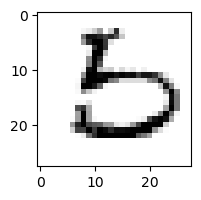

0.005513345676837968% - 0 - ОШИБКА
7.609702197907638e-11% - 1
1.1424116251503972e-07% - 2
9.664071028638156e-10% - 3
3.221537827658398e-14% - 4
5.2466326588884806e-08% - 5
3.1452918255702024e-07% - 6
8.512450110619599e-11% - 7
3.0827538737245134e-11% - 8
1.2321091606118768e-25% - 9

 3


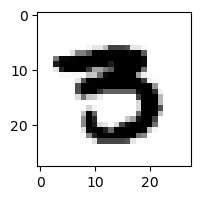

8.766243149216028e-14% - 0
1.0988671830457264e-16% - 1
2.828177748836033e-34% - 2
3.466648482078372e-09% - 3
1.3857990989832491e-21% - 4
0.0008693544253964911% - 5 - ОШИБКА
2.267469070568559e-22% - 6
1.485954759582043e-05% - 7
9.12627353445024e-39% - 8
2.1624722751834914e-33% - 9

 9


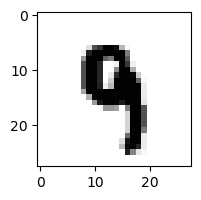

5.512457188064347e-27% - 0
3.901832905716379e-09% - 1
7.871125001222847e-24% - 2
1.261485011487432e-13% - 3
6.112260768455087e-06% - 4
0.014970310879951938% - 5 - ОШИБКА
3.632397118112411e-15% - 6
1.767424209093494e-05% - 7
1.5067762683039244e-25% - 8
0.011462758572227939% - 9

 9


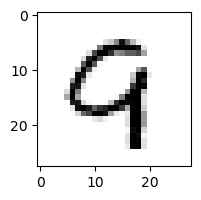

4.537651989014646e-08% - 0
4.021944946938286e-09% - 1
0.002300427488029436% - 2
6.704512624895516e-25% - 3
0.02567765796440546% - 4 - ОШИБКА
1.8255950861377e-09% - 5
0.0001467410127804693% - 6
0.0014593241328602884% - 7
1.5223690689080985e-07% - 8
0.0005544271481673611% - 9

 6


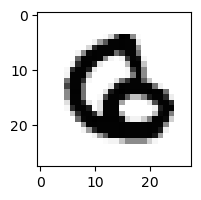

3.3164986635227865e-20% - 0
2.433770396022506e-16% - 1
4.928992303753654e-09% - 2
1.157668258119099e-41% - 3
5.5247117143555866e-21% - 4
8.315314495582595e-09% - 5 - ОШИБКА
3.0202366379343926e-13% - 6
3.1717873985044015e-16% - 7
1.905055961339034e-41% - 8
2.104945453574336e-46% - 9

 8


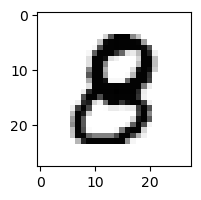

5.093408828598156e-13% - 0
1.105634392468351e-15% - 1
6.51262607941447e-14% - 2
1.6786177361658054e-12% - 3
7.058270443203497e-11% - 4
0.00030882498324834464% - 5 - ОШИБКА
3.8002556991788965e-22% - 6
8.45047649160423e-14% - 7
9.807677778373861e-16% - 8
1.4807412672661025e-25% - 9

 4


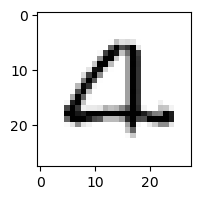

0.008145536694688201% - 0
3.453252418693997e-12% - 1
97.74759305979943% - 2 - ОШИБКА
6.555326093187202e-23% - 3
3.314240503741811e-11% - 4
6.596525932765016e-05% - 5
4.11646193289189e-09% - 6
5.255395699390034e-06% - 7
1.258509926088824e-21% - 8
8.583666967184183e-11% - 9

 5


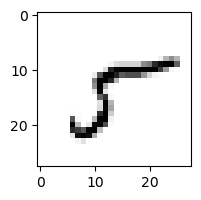

0.22647626495038128% - 0
0.09190720455667248% - 1
4.545822850575852e-08% - 2
0.23515713831598553% - 3
0.00011956317608829734% - 4
2.5053755415104986% - 5
1.9339169566270105e-06% - 6
0.9444112552551146% - 7
89.32420583758511% - 8 - ОШИБКА
8.747523055820046e-10% - 9

 5


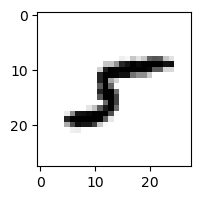

3.913649900870944e-06% - 0
0.05966030716265502% - 1
8.204661795734433e-05% - 2
4.987407813396048e-11% - 3
3.4194114109723925e-08% - 4
0.005803774772726045% - 5
1.3750743666656866e-12% - 6
5.384297372103031e-05% - 7
99.9999193739126% - 8 - ОШИБКА
4.245221259259677e-15% - 9

 8


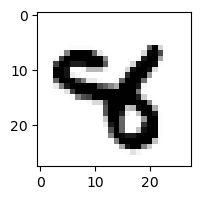

3.495519691019652e-30% - 0
3.887429455076089e-13% - 1
2.3313642237797934e-25% - 2
2.0134838385261336e-26% - 3
20.670865054717726% - 4 - ОШИБКА
2.541881094035831e-07% - 5
1.237555889965022e-22% - 6
0.0001978881027585392% - 7
2.0178263528073e-35% - 8
2.9100918595696996e-30% - 9

 0


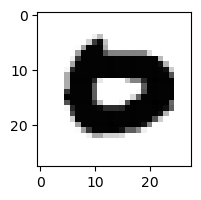

5.807534201696243e-08% - 0
1.4024705667178002e-28% - 1
8.352147131023935e-34% - 2
6.957953817376184e-52% - 3
8.84300857831675e-27% - 4
9.362054592546243e-23% - 5
1.9561887997609327e-17% - 6
2.1906143765147712e-05% - 7 - ОШИБКА
6.516540735722636e-58% - 8
5.415104368883376e-54% - 9

 3


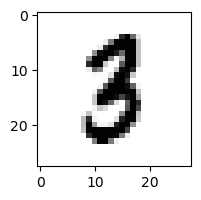

1.4702821537571953e-15% - 0
1.044947612713467e-05% - 1
4.3107541529860416e-07% - 2
0.0008418029316118812% - 3
5.722254561786183e-17% - 4
0.0564592846979868% - 5 - ОШИБКА
2.789306681111283e-17% - 6
1.9666533950212572e-08% - 7
4.281300124959858e-11% - 8
1.7197928322990718e-20% - 9

 3


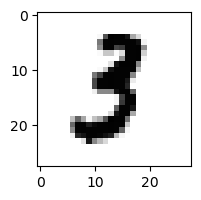

2.2762520404992027e-12% - 0
6.460807154084882e-05% - 1
5.361946134327909e-13% - 2
2.637867463634659e-06% - 3
5.113013352237101e-19% - 4
0.051301695738511816% - 5 - ОШИБКА
1.3873344593007683e-17% - 6
2.961693613308554e-09% - 7
3.3473321736113954e-29% - 8
3.269540773838648e-34% - 9

 2


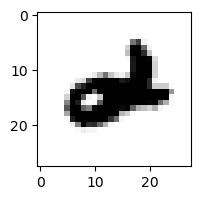

3.946231700500242e-15% - 0
8.920853029001435e-12% - 1
2.0521160402884458e-21% - 2
3.0084608199131902e-30% - 3
99.84219897341634% - 4 - ОШИБКА
3.5790623651906075e-15% - 5
7.148283766423013e-07% - 6
1.1550930983229862e-09% - 7
3.5165032958821464e-29% - 8
3.7056938624536125e-18% - 9

 6


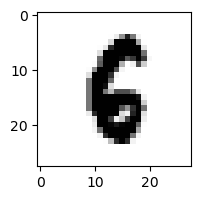

3.050763863753591e-18% - 0
2.8386248572632635e-10% - 1
4.1438813221460985e-16% - 2
3.2923685972186944e-31% - 3
1.1353910825082246e-12% - 4
0.056217347139849716% - 5 - ОШИБКА
9.112547916060633e-07% - 6
6.559500893458044e-10% - 7
6.074828763641522e-22% - 8
4.539659104873285e-21% - 9

 8


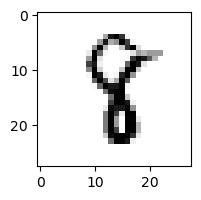

2.2264711674022875e-19% - 0
0.11819885162654561% - 1
4.159954759502816e-12% - 2
7.047392573319985e-13% - 3
0.002331530895132608% - 4
0.18300694866236% - 5 - ОШИБКА
4.113235972134641e-16% - 6
0.0002583737742557151% - 7
2.7684238346778136e-13% - 8
5.6814616680233735e-27% - 9

 8


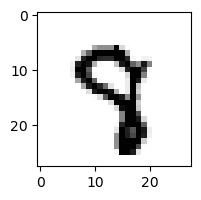

5.425745004831799e-17% - 0
2.5756972757604816e-12% - 1
3.287665229220645e-17% - 2
1.1596468494176362e-11% - 3
1.4509411379486104e-07% - 4
0.0010128752340545603% - 5
1.9534749725252146e-16% - 6
0.062176872099274194% - 7 - ОШИБКА
2.3384054441958795e-17% - 8
9.181944738356452e-07% - 9

 8


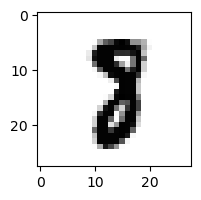

1.74234440982506e-20% - 0
1.7075137678318099e-06% - 1
2.8584044836079863e-15% - 2
7.387935746039278e-17% - 3
1.202153968073905e-20% - 4
5.265527707024385e-05% - 5
5.3194138622158204e-20% - 6
0.3074336282921635% - 7 - ОШИБКА
1.5215077994536886e-17% - 8
1.1010515807596736e-31% - 9

 3


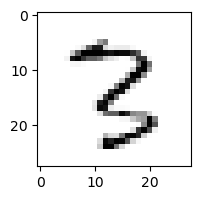

7.408854448429239e-14% - 0
9.772925259527962e-06% - 1
0.5052410273188989% - 2
0.5511865688559557% - 3
3.0009607399438383e-08% - 4
0.00016153990141779413% - 5
2.9858905908573615e-13% - 6
0.2248239373019596% - 7
99.99278267775891% - 8 - ОШИБКА
1.263904782306666e-07% - 9

 9


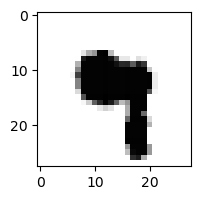

1.6850881743758188e-28% - 0
3.697395442460351e-12% - 1
1.6692799121211606e-39% - 2
3.60248791700865e-21% - 3
2.0983471394873123e-06% - 4
1.1999687868252194e-05% - 5
2.023899096844032e-17% - 6
1.5350109560558322e-05% - 7 - ОШИБКА
2.1931600261237326e-30% - 8
3.0818052560396054e-06% - 9

 8


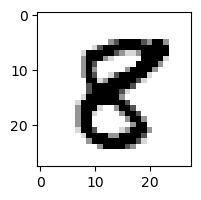

4.129957447508994e-17% - 0
2.3958244326996108e-14% - 1
4.483367176971314e-22% - 2
8.643935598494671e-23% - 3
3.9647006332026155e-10% - 4
0.03964960610747073% - 5 - ОШИБКА
9.948048302310956e-33% - 6
3.5512530319217453e-16% - 7
0.03377824015869898% - 8
4.010935112819127e-36% - 9

 8


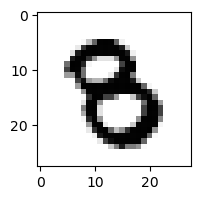

7.481029584691087e-16% - 0
2.1268349207598673e-15% - 1
8.383387568027122e-20% - 2
3.4260087755027e-07% - 3
1.511974300050204e-15% - 4
0.0005681924394914737% - 5 - ОШИБКА
1.3764523270782033e-16% - 6
3.02263139518889e-14% - 7
1.012790858312397e-33% - 8
8.373378215692001e-30% - 9

 9


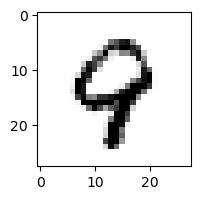

2.234245070862826e-12% - 0
4.299005644275758e-09% - 1
1.098334791883784e-10% - 2
2.6540184636638012e-27% - 3
0.4511449433857912% - 4 - ОШИБКА
2.763069875741531e-06% - 5
2.4764608086151272e-06% - 6
0.00021019242631365524% - 7
7.103596413008507e-06% - 8
0.0009575829205682156% - 9

 9


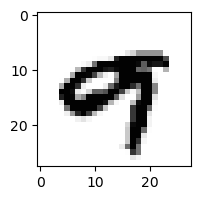

4.0977353231054813e-13% - 0
1.796922085921541e-11% - 1
9.233215554695923e-28% - 2
1.2557981570571888e-27% - 3
2.210792123123365e-05% - 4
1.781736310245372e-08% - 5
7.284658246531366e-22% - 6
4.279369073965249e-05% - 7 - ОШИБКА
1.2722954868966137e-26% - 8
1.6138928533932798e-07% - 9

 9


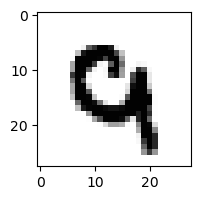

4.08313645731388e-16% - 0
2.600462867758009e-15% - 1
3.5486103884922475e-09% - 2
4.264804117326957e-35% - 3
9.170900466237938e-09% - 4
7.039385187579402e-09% - 5
5.348620293623886e-05% - 6
0.031191760198060862% - 7 - ОШИБКА
1.0117477760697815e-35% - 8
4.362598666751555e-14% - 9

 4


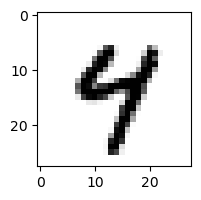

1.4966120741652505e-13% - 0
7.87962530823182e-13% - 1
8.917658729635078e-25% - 2
2.7662429285985906e-15% - 3
71.57722416786616% - 4
0.05026274664340092% - 5
3.354537047494665e-11% - 6
0.002899051439596805% - 7
1.3652255551638272e-10% - 8
96.09145149223642% - 9 - ОШИБКА

 6


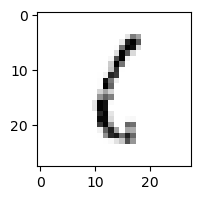

0.04358602137026628% - 0
73.02044415585705% - 1
54.51876432186029% - 2
0.013834191530061695% - 3
1.0418224764579215e-05% - 4
1.7233542390652323% - 5
99.98086078480276% - 6
4.843201050952853e-05% - 7
99.99951014348959% - 8 - ОШИБКА
0.07657976345502596% - 9

 6


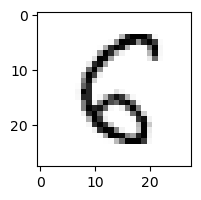

1.2436847058912113e-05% - 0
1.2709404022644828e-05% - 1
0.06375314502865631% - 2
4.154319905410462e-21% - 3
0.001743308844484931% - 4
0.9663694327155895% - 5 - ОШИБКА
0.9111854514838844% - 6
2.577291917056159e-09% - 7
0.0006851064850569665% - 8
1.4332364687104807e-16% - 9

 5


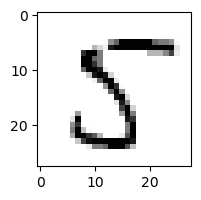

2.4238329166418482e-09% - 0
2.446326978408148e-07% - 1
3.8641618863156385e-13% - 2
2.96776037304691e-12% - 3
1.0110578023248948e-05% - 4
99.99971485774266% - 5
2.3255926322951398e-14% - 6
2.1607162549333763e-07% - 7
99.99999993609974% - 8 - ОШИБКА
2.1063879471221044e-30% - 9

 5


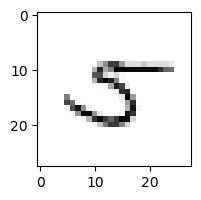

0.011209899473755829% - 0
0.1293505361680668% - 1
3.097920353310516e-05% - 2
3.0115304961160265e-06% - 3
0.01015440732447377% - 4
8.086582627848749e-05% - 5
0.6761460448763235% - 6
8.419758548501543% - 7 - ОШИБКА
0.03202485148454708% - 8
9.778705600732724e-06% - 9

 8


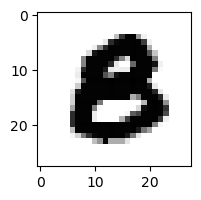

9.395669610347573e-13% - 0
6.243702420547365e-24% - 1
1.7664688386392124e-26% - 2
9.69760104248068e-21% - 3
2.8795761791346016e-25% - 4
4.0073356952386364e-05% - 5 - ОШИБКА
2.1090942771931707e-22% - 6
1.2862648091187295e-19% - 7
2.4175492117362995e-42% - 8
1.7173414938727346e-44% - 9

 8


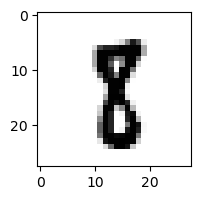

1.8820809448942518e-21% - 0
0.00201226661496096% - 1
6.41614304563822e-18% - 2
1.3058684620924749e-14% - 3
4.352376723176158e-17% - 4
0.2945182711546026% - 5 - ОШИБКА
1.4034082414952135e-18% - 6
1.380859947990243e-05% - 7
1.2851341878999931e-08% - 8
1.589074135228988e-20% - 9

 8


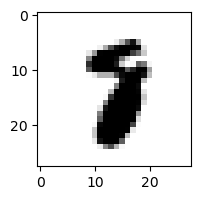

8.377493463238588e-26% - 0
5.69467189292955e-09% - 1
4.005493109424284e-17% - 2
7.976826268428427e-27% - 3
5.407890737431755e-18% - 4
1.8918368177433295e-07% - 5
2.876275495176567e-17% - 6
48.08097958232311% - 7 - ОШИБКА
7.969722723616287e-19% - 8
2.527336562313319e-24% - 9

 0


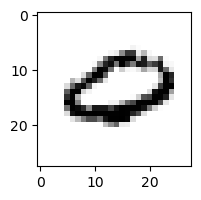

0.23994669550132633% - 0
7.60577311637611e-12% - 1
4.424760632372573e-19% - 2
9.68116707617136e-35% - 3
0.0003217870993162385% - 4
4.19835922384575e-14% - 5
0.0034676250596541425% - 6
1.3164346206221604% - 7 - ОШИБКА
1.1367005868136694e-24% - 8
2.4551971807728323e-16% - 9

 3


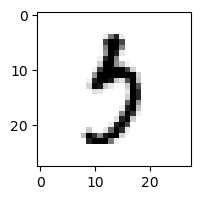

1.9685914870602044e-06% - 0
2.620043126431709e-05% - 1
8.956828210619966e-16% - 2
0.72278611749765% - 3
1.1401616627056066e-06% - 4
3.059021831495611% - 5 - ОШИБКА
3.927475301903555e-09% - 6
1.1758955060916985% - 7
1.7865300081399817e-10% - 8
3.307425721513708e-10% - 9

 8


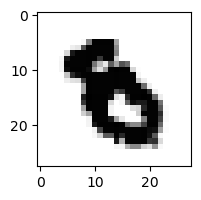

7.482253379795684e-30% - 0
1.726560067414288e-18% - 1
5.329146923894742e-28% - 2
1.2342048447852851e-27% - 3
1.123356227346316e-14% - 4
5.353720350915274e-05% - 5 - ОШИБКА
3.982323453050119e-12% - 6
5.445033125524257e-15% - 7
6.239985732742934e-47% - 8
5.054541239323152e-40% - 9

 8


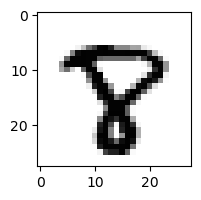

1.363694003582951e-23% - 0
3.736916964401939e-19% - 1
1.5650549758760528e-23% - 2
2.3612030460091504e-31% - 3
3.868163318276471e-13% - 4
2.467823437326866e-05% - 5
1.69426091653008e-20% - 6
0.008347965251652299% - 7 - ОШИБКА
9.520819909602635e-06% - 8
2.6003262338356626e-22% - 9

 5


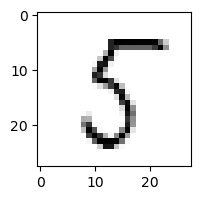

0.00163131715874027% - 0
0.006151230780860394% - 1
4.6648616994307254e-08% - 2
1.9660041491722827e-06% - 3
0.0007927890103269046% - 4
99.88035466662554% - 5
1.4468238792521714e-06% - 6
4.090113731019318e-07% - 7
99.99999995913595% - 8 - ОШИБКА
1.1088028424124992e-16% - 9

 4


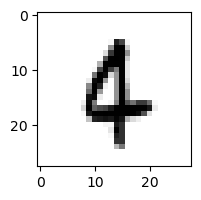

6.718297035849929e-15% - 0
1.3084120735158843e-05% - 1
3.681700762127886e-11% - 2
1.5494511764810797e-26% - 3
2.741517507439546e-06% - 4
5.512791925845312e-05% - 5
0.8686230318988386% - 6 - ОШИБКА
0.004651595877261969% - 7
5.923308484183748e-20% - 8
4.0956149095771885e-09% - 9

 9


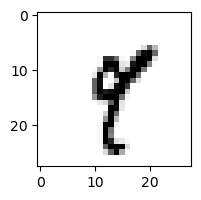

3.71158790938687e-15% - 0
0.504029388943292% - 1
7.006820525618217e-18% - 2
1.0273208099515096e-08% - 3
0.0006733122158173761% - 4
0.015975462636316443% - 5
2.4167545495480093e-16% - 6
53.3038772259423% - 7 - ОШИБКА
8.829203526210142e-09% - 8
6.248256843403233e-08% - 9

 5


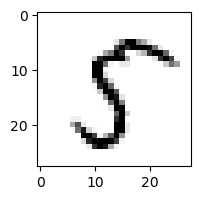

6.011592994340042e-07% - 0
5.928108726769575e-06% - 1
5.812683366300545e-09% - 2
3.2952837011033964e-13% - 3
3.7911884308406124e-06% - 4
99.99761082223584% - 5
7.611533549116275e-12% - 6
5.15240150537631e-07% - 7
99.99998495627148% - 8 - ОШИБКА
4.01446053080028e-15% - 9

 8


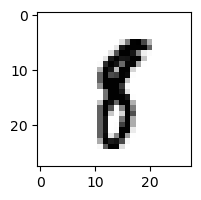

5.611241509926588e-18% - 0
0.04021379798378762% - 1 - ОШИБКА
4.704673334692227e-18% - 2
4.637999526947126e-12% - 3
3.2461185691463892e-12% - 4
0.031351245015183514% - 5
2.7763947440263844e-13% - 6
2.6180480009959797e-06% - 7
2.717261621138255e-06% - 8
1.0560546665727177e-14% - 9

 3


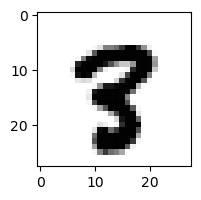

2.694284685194385e-25% - 0
3.698288117371542e-14% - 1
4.108807763199801e-24% - 2
4.57506709415596e-24% - 3
1.4994866865108164e-16% - 4
5.687085766508534e-05% - 5
8.597998541233088e-28% - 6
4.07306545830381e-05% - 7
0.0002337783865036641% - 8 - ОШИБКА
1.3582577882563687e-12% - 9

 8


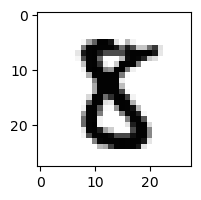

5.546316208239391e-16% - 0
1.8222856302995287e-13% - 1
8.51467197169477e-18% - 2
8.53320524870993e-20% - 3
3.0896447550765327e-19% - 4
1.3169686968194396% - 5 - ОШИБКА
6.289885939332988e-27% - 6
3.897956526385122e-14% - 7
4.068044313041805e-06% - 8
1.4170205289945638e-34% - 9

 6


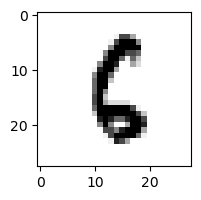

2.1798529515022848e-10% - 0
4.735887051273047e-07% - 1
7.982304743594539e-05% - 2
1.413564475676811e-23% - 3
2.4486615123704723e-10% - 4
4.867574276137163% - 5 - ОШИБКА
0.9422981107574797% - 6
9.172438082172926e-09% - 7
2.5342969249403893e-09% - 8
8.138242432827033e-15% - 9

 8


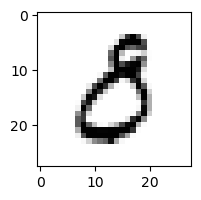

43.894749150788584% - 0 - ОШИБКА
4.1100044963357683e-07% - 1
7.426965280199174e-10% - 2
5.900039517501892% - 3
8.869502918548133e-13% - 4
0.014019337238026236% - 5
1.0481851056840158e-11% - 6
4.020649698144011e-07% - 7
2.4229582886527947e-21% - 8
2.6938753362932754e-26% - 9

 3


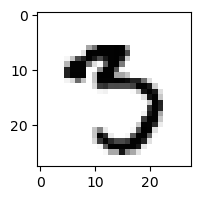

1.6048361779136788e-13% - 0
1.9277618659073457e-12% - 1
6.836892854608835e-25% - 2
2.2527968225812053e-05% - 3
4.082325482774234e-17% - 4
55.630974527625796% - 5 - ОШИБКА
2.503047093865418e-13% - 6
0.0020195142700196074% - 7
8.371676599024228e-07% - 8
3.978648310590712e-08% - 9

 2


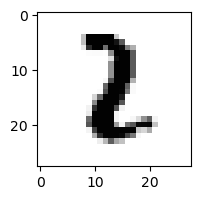

1.7414314798387556e-20% - 0
5.603218625329697% - 1 - ОШИБКА
0.03787998441109294% - 2
1.3066605396638331e-11% - 3
2.338367895176444e-22% - 4
2.1784605056976876e-07% - 5
6.518026111803357e-11% - 6
7.170747461468449e-13% - 7
5.940908984391409e-17% - 8
4.7839546387120947e-23% - 9

 6


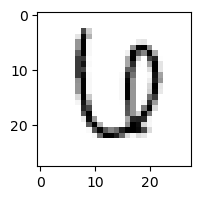

6.196147947291863% - 0 - ОШИБКА
2.3123335628591838e-08% - 1
2.946658183337001e-06% - 2
0.013568681736967557% - 3
0.27739306151346305% - 4
1.5059364157073973e-05% - 5
7.234363517866702e-05% - 6
0.06190825597921073% - 7
2.2326467123845008e-13% - 8
3.417628645243405e-17% - 9

 8


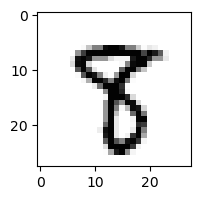

1.1328572156752566e-22% - 0
4.225409744695606e-09% - 1
1.6314175114412042e-24% - 2
1.2569400397600984e-10% - 3
1.0693184628840512e-11% - 4
0.6214993143578778% - 5 - ОШИБКА
2.6740567464012415e-26% - 6
0.09280067074087517% - 7
1.1286397200611929e-13% - 8
1.8721491906627163e-18% - 9

 9


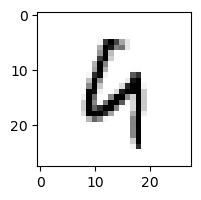

3.568595278459266e-10% - 0
8.453747411378509e-05% - 1
1.4535041096496388% - 2
2.6984097268560938e-18% - 3
69.83002735839922% - 4
8.097467555718249e-05% - 5
94.53082047390782% - 6 - ОШИБКА
0.00015578393919155308% - 7
0.05143220960093177% - 8
0.04708969061658539% - 9

 8


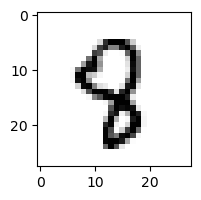

2.350065315770023e-14% - 0
7.301880541780723e-07% - 1
3.518471286298049e-13% - 2
8.010919479423854e-17% - 3
0.0019186765301799054% - 4
1.4964208920453417% - 5 - ОШИБКА
9.275264064833208e-12% - 6
0.00015132774169578705% - 7
9.726866636164674e-10% - 8
2.1016794552678913e-19% - 9

 8


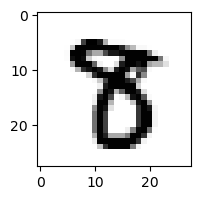

8.415419194972787e-21% - 0
7.04773524765605e-14% - 1
2.0100326374864114e-22% - 2
3.0298411884490026e-07% - 3
2.4003712357980006e-20% - 4
0.0004737180191481539% - 5 - ОШИБКА
2.182686293772661e-28% - 6
8.690382908840941e-07% - 7
8.089439025091659e-13% - 8
1.3755678675420487e-29% - 9

 7


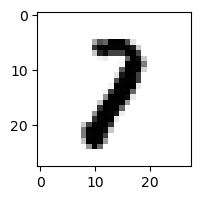

8.660181067411804e-15% - 0
9.398326660117814% - 1 - ОШИБКА
0.000568012395709129% - 2
5.008123599300677e-10% - 3
8.184820061035015e-15% - 4
4.878688799272205e-07% - 5
2.8042048657961157e-16% - 6
0.00026095196337980225% - 7
8.626326898391185e-10% - 8
1.0248304736208715e-16% - 9

 6


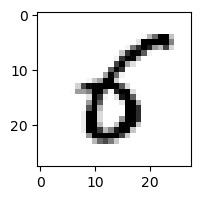

0.000300321386358733% - 0
0.0002330891612760357% - 1
7.265498206612204e-13% - 2
2.6876861526566144e-10% - 3
2.952449405435975e-05% - 4
49.67088739547703% - 5 - ОШИБКА
0.3205119559161826% - 6
8.123604128950005e-11% - 7
1.0348297697701506e-14% - 8
1.7938393612002114e-16% - 9

 8


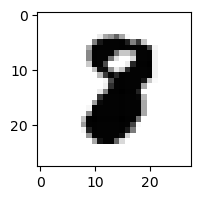

1.1498857546157503e-26% - 0
1.0644809800420989e-10% - 1
4.077381038875078e-14% - 2
2.320700637745178e-28% - 3
2.207569255379561e-24% - 4
4.3617708388450246e-10% - 5
4.829362668479973e-23% - 6
2.7200333707693136e-09% - 7 - ОШИБКА
1.0058891167580414e-16% - 8
6.950785755891072e-42% - 9

 3


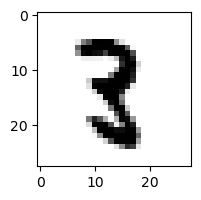

2.176851134055901e-19% - 0
0.00011779302765054058% - 1
5.915607795191044e-16% - 2
0.0003102623756706357% - 3
4.050646333042894e-13% - 4
0.006067408214378304% - 5 - ОШИБКА
1.1791608953120922e-15% - 6
1.0949555140028208e-09% - 7
2.26256570330623e-20% - 8
9.092068906063467e-26% - 9

 8


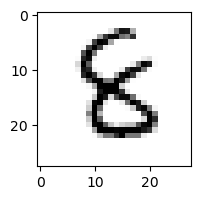

3.5344493625555713e-14% - 0
9.706423503548728e-09% - 1
9.005914311017692e-11% - 2
1.0253941105851048e-05% - 3
4.781548588911581e-07% - 4
0.004886887335883826% - 5 - ОШИБКА
1.7887462473654404e-05% - 6
6.6950260840725135e-12% - 7
6.113108781860613e-15% - 8
2.9259845233413955e-21% - 9

 8


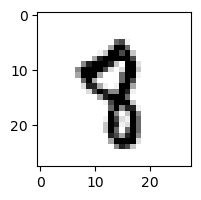

1.768748633959688e-19% - 0
5.1555502185138604e-05% - 1
1.0482818274498003e-17% - 2
2.1243902595939243e-20% - 3
1.9705051343790115e-06% - 4
0.09182660548192419% - 5 - ОШИБКА
2.5571633875512288e-14% - 6
0.04448724349693047% - 7
4.166099252625804e-14% - 8
1.9570956141931214e-07% - 9

 9


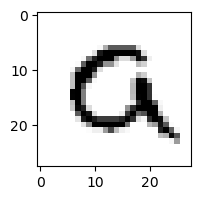

9.8148549949009% - 0
1.830988120585677e-15% - 1
5.3369567627183006e-05% - 2
3.874588506086864e-18% - 3
7.700918768460254e-13% - 4
0.7392257809145283% - 5
10.95755754324218% - 6 - ОШИБКА
0.000808670939727928% - 7
7.277117650317757e-27% - 8
1.308869891882924e-07% - 9

 2


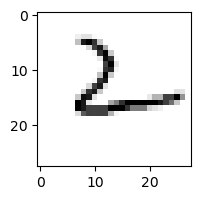

0.1556284156367036% - 0
5.1250736339178905e-06% - 1
95.4859189979532% - 2
7.614272848994423e-12% - 3
99.9999929779821% - 4 - ОШИБКА
2.0682611946657046e-06% - 5
99.90846623721514% - 6
9.09098002020789% - 7
3.431191388666133e-10% - 8
0.05856721925961457% - 9

 8


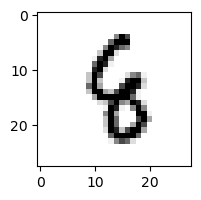

8.642345245877392e-18% - 0
0.0016506609554656924% - 1
8.546371637813662e-08% - 2
4.369400294175655e-13% - 3
0.24960052667695876% - 4
0.5021334074722872% - 5 - ОШИБКА
0.03926897041325648% - 6
2.3480337082929968e-05% - 7
2.3907243900534836e-13% - 8
7.295456202329297e-14% - 9

 0


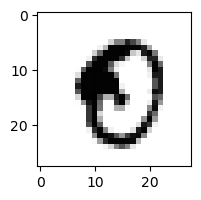

0.001265716590348655% - 0
7.384230573809657e-14% - 1
1.9453153952681945e-28% - 2
3.2456956402522713e-26% - 3
3.30709277432919e-10% - 4
0.005690377279116124% - 5 - ОШИБКА
1.7283274207428256e-12% - 6
5.236730472874914e-15% - 7
0.0022655817398876802% - 8
6.535573457237582e-15% - 9

 7


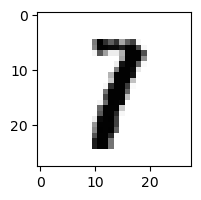

1.2627384334702855e-16% - 0
60.888869278687785% - 1 - ОШИБКА
2.2117922943923741e-07% - 2
4.645975330215785e-08% - 3
2.085034587716696e-14% - 4
4.8703636250555664e-05% - 5
2.913777689437004e-15% - 6
2.316065955281814e-05% - 7
1.8368237025820062e-10% - 8
1.0410226938090888e-19% - 9

 8


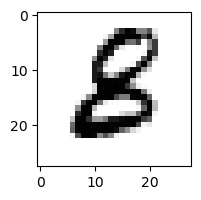

1.3312240475810018e-16% - 0
1.560567661367526e-11% - 1
1.6132302019486748e-11% - 2
9.420300096625315e-11% - 3
7.465454863030737e-18% - 4
0.002129250868709648% - 5 - ОШИБКА
1.0664551442725673e-08% - 6
9.08819445304404e-15% - 7
8.386517291044443e-30% - 8
1.3414725925799739e-39% - 9

 4


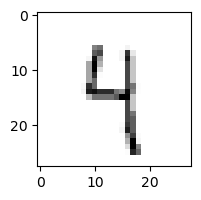

2.2565991023388314e-06% - 0
0.12764353395276956% - 1
0.021299210039795628% - 2
1.5642247120003332% - 3
97.5078810174085% - 4
2.9966711430094564% - 5
0.11604369435807291% - 6
0.5768287219180754% - 7
0.0024216856730731027% - 8
99.95058662959379% - 9 - ОШИБКА

 8


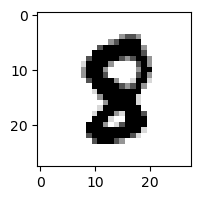

1.2769347861005099e-21% - 0
9.664984807225367e-15% - 1
4.7113086989649876e-21% - 2
5.146079177639329e-28% - 3
6.972604118362513e-18% - 4
0.002982054958823045% - 5 - ОШИБКА
7.459704164568736e-17% - 6
1.2848683033489007e-12% - 7
1.0806084494635356e-08% - 8
5.685908279219273e-27% - 9

 8


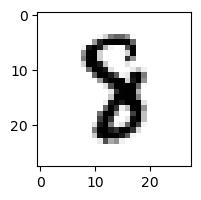

3.512851679817856e-21% - 0
5.254320240527322e-06% - 1
8.316763547957908e-14% - 2
7.070433618341471e-17% - 3
4.690630767873999e-10% - 4
0.008243277503911043% - 5 - ОШИБКА
4.3083946838176187e-07% - 6
2.9024570686230177e-05% - 7
9.082969657021923e-11% - 8
2.3133100930868194e-32% - 9

 4


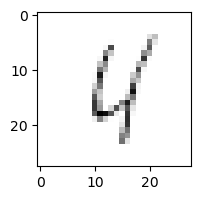

1.220942429210403% - 0
0.6895812132749102% - 1
97.63734835850231% - 2
4.824011056891997e-09% - 3
99.73187219154681% - 4
0.0546267751979965% - 5
93.2111272187956% - 6
2.194673362487596% - 7
99.81389067542814% - 8 - ОШИБКА
98.75461140523237% - 9

 2


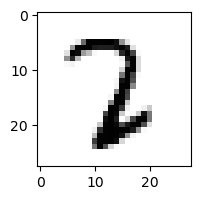

1.6365548247078573e-16% - 0
0.0002852216682867122% - 1
0.012159267099733787% - 2
0.012476340449774111% - 3 - ОШИБКА
4.277391261957398e-12% - 4
2.7975120645122052e-05% - 5
5.386163557536444e-11% - 6
0.001036630693950644% - 7
1.680664472636644e-16% - 8
5.054738256173757e-30% - 9

 2


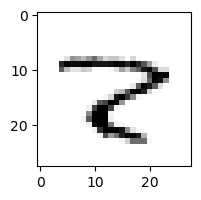

6.152770631220204e-07% - 0
0.002728092501242122% - 1
0.009654839674140516% - 2
1.943468496710417e-21% - 3
1.7549759810764137e-07% - 4
1.2513224745744667e-15% - 5
0.0057552686485044064% - 6
26.10839001525581% - 7
88.88578772543683% - 8 - ОШИБКА
6.847695077842286e-14% - 9

 8


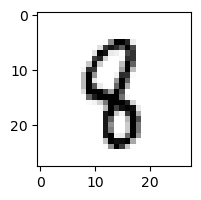

8.911114154149769e-17% - 0
0.00028784134303935685% - 1
2.85847376060907e-11% - 2
1.1035052547545714e-14% - 3
0.032072346592877034% - 4
0.3742797093659508% - 5 - ОШИБКА
5.684214864141751e-11% - 6
1.8736536489611784e-05% - 7
4.018246693643255e-12% - 8
7.214824257206415e-14% - 9

 2


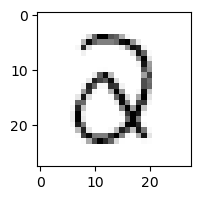

0.00016855692171728755% - 0
7.870822379178416e-09% - 1
4.255318488572573e-05% - 2
11.767878161773373% - 3 - ОШИБКА
0.01685829693170646% - 4
0.007326336044963403% - 5
1.1207939522077281e-08% - 6
1.4488115424810812e-08% - 7
1.873257577704227e-11% - 8
1.0510517144492054e-19% - 9

 6


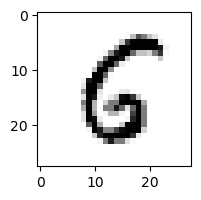

0.00014035298551272427% - 0
1.8145458292871713e-09% - 1
1.831668934593243e-10% - 2
5.891194249792983e-23% - 3
9.029873755919034e-05% - 4
34.637011932014964% - 5 - ОШИБКА
0.0005423035294694227% - 6
2.6564278112796107e-08% - 7
2.170648920532346e-15% - 8
2.4711419874566665e-19% - 9

 2


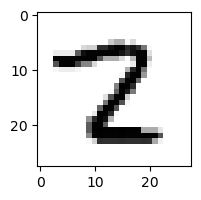

2.168719671459898e-15% - 0
1.4837276525857702e-05% - 1
5.06849070401695e-05% - 2
3.5314206708123984e-12% - 3
7.460180370161902e-15% - 4
9.065319598719309e-07% - 5
3.180008427140352e-20% - 6
0.04969072708379559% - 7 - ОШИБКА
0.0018848918066289929% - 8
1.0177080748656411e-24% - 9

 8


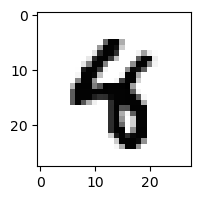

1.668040952443403e-22% - 0
1.5242245914485772e-09% - 1
2.1993110815301022e-24% - 2
1.7771018869428111e-22% - 3
12.15770125807132% - 4 - ОШИБКА
0.0005574819582793265% - 5
2.25223352823133e-17% - 6
1.9887286484190148e-08% - 7
2.6528499279489443e-34% - 8
1.2748976757233847e-17% - 9

 8


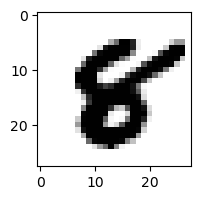

1.4531581908395363e-23% - 0
5.378979179334686e-23% - 1
2.1525406777297797e-31% - 2
1.9320417758366987e-42% - 3
1.3255960181134733e-19% - 4
1.38871178852104% - 5 - ОШИБКА
2.0720320846433547e-22% - 6
1.921772483773994e-15% - 7
3.1383658070235425e-06% - 8
2.503150819565083e-31% - 9

 7


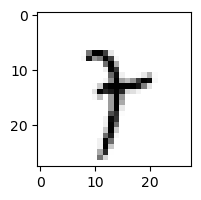

1.0692652320059225e-12% - 0
60.3416337259383% - 1
1.338613691240703e-07% - 2
0.00019406391727846395% - 3
0.000528068083878351% - 4
0.028474006866284946% - 5
0.5268250302314025% - 6
0.018932320450994907% - 7
81.47818713042128% - 8 - ОШИБКА
0.14501453164985492% - 9

 9


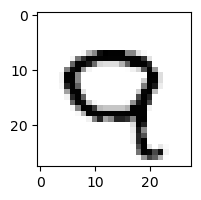

0.0010144043676722587% - 0
8.068375045297807e-13% - 1
2.7538837853792006e-08% - 2
2.338673630420714e-27% - 3
6.368518646180422e-10% - 4
4.265841064404755e-12% - 5
8.19002876466228e-08% - 6
21.846314739116277% - 7 - ОШИБКА
1.2858686475563074e-19% - 8
0.0004221258134733209% - 9

 4


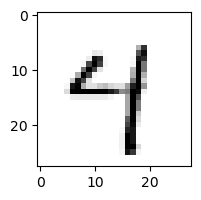

0.00026276918287733637% - 0
4.171508177669676e-06% - 1
3.115599883595452e-13% - 2
1.0806415161307935e-08% - 3
99.7677344737635% - 4
1.0373305718283146% - 5
3.736284627025255e-05% - 6
0.12334646081921344% - 7
2.966568647557684e-09% - 8
99.97744615785852% - 9 - ОШИБКА

 8


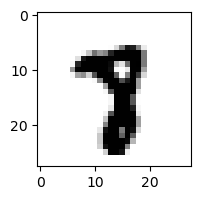

4.366933938915051e-25% - 0
6.455204065418138e-11% - 1
2.0427402316908646e-29% - 2
1.3293184812386095e-24% - 3
1.0620525517711021e-18% - 4
0.03528525732883736% - 5
2.263513556000423e-21% - 6
2.4696907763322886% - 7 - ОШИБКА
1.1416638043728414e-12% - 8
8.168779301156254e-20% - 9

 8


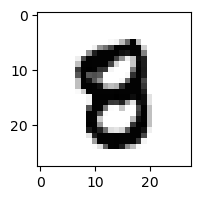

1.0342639775689817e-16% - 0
4.7490416676632685e-18% - 1
4.9916541213531036e-24% - 2
6.021293253250122e-28% - 3
8.143281572813173e-14% - 4
0.006769191854631281% - 5 - ОШИБКА
6.448607500418322e-19% - 6
3.391655616134889e-09% - 7
6.440841693598953e-06% - 8
4.3521162696234005e-16% - 9

 9


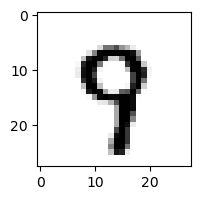

1.2401390983879456e-12% - 0
2.2163194372730323e-12% - 1
3.2623236965656265e-16% - 2
2.703586752758777e-15% - 3
6.06476750990892e-05% - 4
0.00498581260044696% - 5
1.6348734417043689e-13% - 6
38.26962698856056% - 7 - ОШИБКА
1.3529339415263342e-11% - 8
0.5051162312791019% - 9

 3


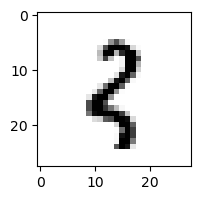

3.3605104257921156e-11% - 0
5.615055402034494% - 1 - ОШИБКА
1.772730755513241% - 2
6.288618441807046e-14% - 3
2.4317899506345685e-08% - 4
4.5134004909831634e-05% - 5
5.425676705373389e-07% - 6
1.2833090269227127e-07% - 7
0.0014501432193797141% - 8
0.08002873524910051% - 9

 2


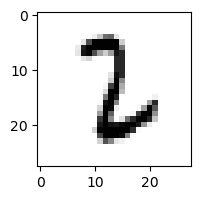

5.498947156024848e-16% - 0
0.25427666030006624% - 1
1.0000798853272377% - 2
2.9336518750868774% - 3 - ОШИБКА
4.0720809097322345e-18% - 4
0.005331003703079805% - 5
0.014042410601795952% - 6
3.90935788986272e-09% - 7
3.6187312290025245e-18% - 8
3.8773604675114656e-27% - 9

 9


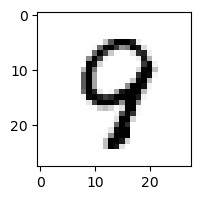

5.029723169635614e-12% - 0
9.389256425692163e-11% - 1
6.702889819524909e-11% - 2
9.766313460661398e-14% - 3
3.0597932161011863% - 4 - ОШИБКА
0.0005919396688117354% - 5
4.629344115919662e-09% - 6
0.003249045283337304% - 7
0.00021008014446806993% - 8
5.780032232210345e-10% - 9

 9


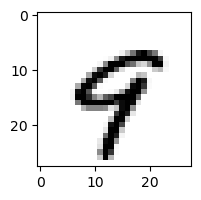

7.0026708033029004e-12% - 0
7.758303645502303e-10% - 1
4.795719815120997e-21% - 2
3.577202433703923e-23% - 3
1.6474522948586603% - 4 - ОШИБКА
0.05418461920829681% - 5
2.6210549521681273e-11% - 6
0.7133673045520215% - 7
1.9271447940469313e-17% - 8
5.933721423525254e-07% - 9

 9


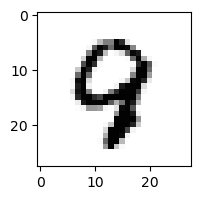

2.727259164256227e-13% - 0
2.8293851164366203e-11% - 1
4.605896564979326e-12% - 2
3.468825101344723e-17% - 3
0.00213987226563068% - 4 - ОШИБКА
2.4461697298777928e-05% - 5
7.86660282379532e-10% - 6
0.0003679983098322915% - 7
3.253854952937189e-11% - 8
2.2590499747089914e-10% - 9

 3


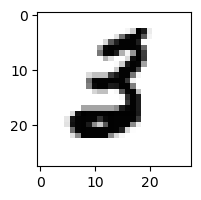

5.053443559639157e-13% - 0
1.039175023004231e-09% - 1
1.3745929016179039e-09% - 2
9.437967983302815e-19% - 3
1.7154129675434697e-20% - 4
3.117375045647638e-05% - 5 - ОШИБКА
1.4101250219630198e-13% - 6
7.555383254348768e-12% - 7
1.510448989093836e-28% - 8
1.1922723905344025e-35% - 9

 3


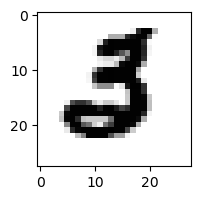

2.634759774836473e-15% - 0
6.109562308920774e-15% - 1
3.0252098833188757e-11% - 2
2.026626313213779e-29% - 3
8.009143436952725e-24% - 4
1.043146724089157e-08% - 5 - ОШИБКА
4.391998862777099e-18% - 6
1.8416121563229947e-11% - 7
1.9715240563686921e-41% - 8
4.874667829498532e-43% - 9

 3


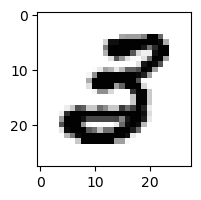

8.964907602160414e-13% - 0
1.303436730187145e-14% - 1
2.1182538635126988e-19% - 2
6.290843765541406e-22% - 3
1.2327641149596079e-18% - 4
0.04312850468138443% - 5 - ОШИБКА
1.0123879038977178e-21% - 6
4.3603130454545214e-15% - 7
6.765257594082291e-23% - 8
4.833615748596055e-46% - 9

 8


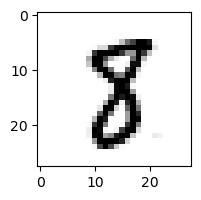

4.292581096637055e-17% - 0
2.9489780070295026e-05% - 1
1.135706486193645e-16% - 2
3.129117475317449e-14% - 3
1.3117164517478053e-16% - 4
0.7322021069284609% - 5 - ОШИБКА
1.6449746723219788e-17% - 6
0.0007770286358969779% - 7
1.5258160340624758e-05% - 8
4.296611377258231e-24% - 9

 3


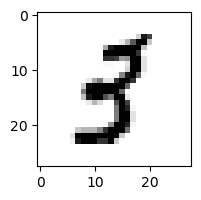

7.56150884865194e-09% - 0
2.2071987399600894e-06% - 1
1.8492766950117952e-12% - 2
0.013421260424490909% - 3
1.0951264677826503e-06% - 4
0.030604381187568103% - 5 - ОШИБКА
2.4633644255811494e-13% - 6
1.055510667732294e-08% - 7
3.901626417136827e-17% - 8
6.315836926900258e-08% - 9

 8


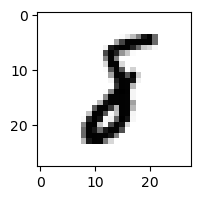

2.6492742199406725e-18% - 0
15.620935630938709% - 1 - ОШИБКА
4.6069566147615144e-06% - 2
1.6291473939944007e-18% - 3
6.955976859318293e-15% - 4
3.445011744043724e-05% - 5
5.18244896262876e-06% - 6
5.406024866918459e-08% - 7
2.9333369367107022e-06% - 8
2.573790659815995e-20% - 9

 3


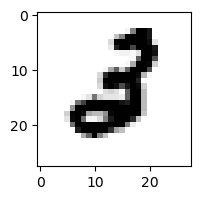

1.184556210991704e-18% - 0
1.5962764939524911e-09% - 1
7.915417837593042e-09% - 2 - ОШИБКА
1.4248774074648642e-25% - 3
6.843429363663595e-13% - 4
5.634342294763633e-09% - 5
1.9213471255699813e-14% - 6
3.276442668801805e-12% - 7
7.397591266889033e-29% - 8
4.355399108848257e-39% - 9

 4


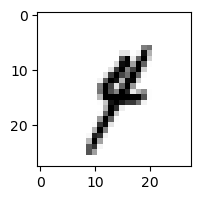

5.295937030223729e-15% - 0
92.74842117895517% - 1 - ОШИБКА
2.2238445717568746e-12% - 2
1.0375468252399929% - 3
0.10708555983554534% - 4
1.933513348814801e-05% - 5
4.645888243140912e-11% - 6
0.348665697213332% - 7
1.5981476264105185e-12% - 8
9.635097660818672e-08% - 9

 9


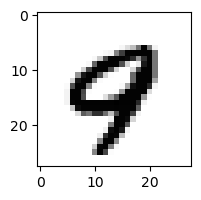

1.0683883849886344e-13% - 0
6.373150794994131e-15% - 1
3.448981061537922e-25% - 2
1.855788181493458e-43% - 3
9.914563081981673e-05% - 4
1.6351846973868608e-13% - 5
1.6440771741684011e-13% - 6
0.3244064100881732% - 7 - ОШИБКА
2.44241582994357e-16% - 8
0.0067429872936489105% - 9

 3


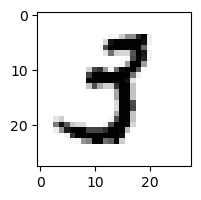

5.457421803400786e-11% - 0
8.263563734204551e-05% - 1
8.129314711357611e-22% - 2
6.707176423127278e-05% - 3
1.6282751184036522e-11% - 4
0.3307681100199907% - 5 - ОШИБКА
8.818546879404274e-21% - 6
1.339115507881386e-06% - 7
1.9286292091852652e-16% - 8
1.4339373805818236e-29% - 9

 3


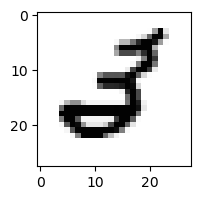

9.52009688271971e-12% - 0
2.8426282297272003e-09% - 1
4.4059120742550586e-06% - 2 - ОШИБКА
9.999772463913218e-23% - 3
1.13474597815465e-08% - 4
6.600902825833757e-08% - 5
9.835656165582274e-14% - 6
2.2690241844006427e-10% - 7
1.033158673349963e-18% - 8
4.036372773265882e-26% - 9

 5


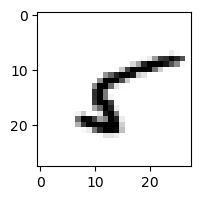

1.8496870664545174e-06% - 0
0.07005806414597987% - 1
2.2175261569288402e-05% - 2
1.3544216044647284e-07% - 3
0.00189944587172456% - 4
89.53273948390051% - 5
0.005688277823148803% - 6
6.6258930571494955e-06% - 7
90.23724484770399% - 8 - ОШИБКА
1.521550699330982e-13% - 9

 9


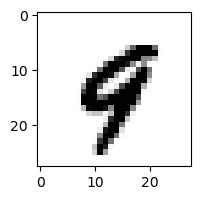

5.743047808706391e-16% - 0
2.2896989323040322e-09% - 1
6.044273494168918e-22% - 2
1.244734415623461e-26% - 3
0.03319893358393323% - 4 - ОШИБКА
3.523254976793288e-08% - 5
3.6749842883485907e-11% - 6
0.01448586805944785% - 7
6.236656823352922e-22% - 8
4.054662050603992e-07% - 9

 8


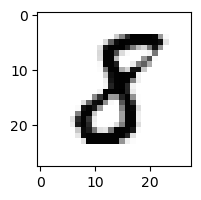

4.8982907773293345e-14% - 0
0.0005984815799882233% - 1
1.1346604965261552e-09% - 2
1.8549370837291204e-11% - 3
2.440060400285624e-17% - 4
0.017227287816493287% - 5 - ОШИБКА
3.2474196166623608e-18% - 6
7.211213336111593e-13% - 7
1.7023847767381154e-07% - 8
5.0647756204882044e-30% - 9

 8


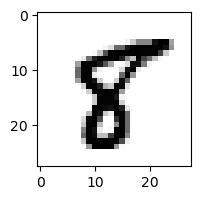

2.3593904829706768e-15% - 0
1.970665948127438e-09% - 1
7.792306200714741e-23% - 2
1.7068486116462357e-33% - 3
1.9351254582008256e-12% - 4
53.945537033023626% - 5 - ОШИБКА
7.259595456570839e-22% - 6
4.233213560798626e-09% - 7
1.4097673148799234e-07% - 8
9.16882251691667e-19% - 9

 5


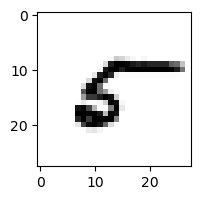

6.975359582762026% - 0 - ОШИБКА
0.00019659520999197578% - 1
4.290038205247414e-06% - 2
7.301922133108702e-18% - 3
0.0008783350810509033% - 4
0.002257892980127968% - 5
3.5922480570150696e-05% - 6
0.007804317919181135% - 7
5.862803978439521e-06% - 8
8.941549708510562e-13% - 9

 9


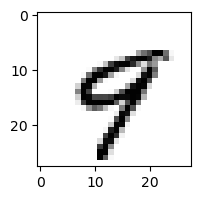

2.938288524323945e-11% - 0
2.361486486289674e-10% - 1
3.3235422363962457e-22% - 2
1.0447306957510736e-19% - 3
2.443057390878502% - 4
6.431517281332955e-05% - 5
1.1555718575476711e-11% - 6
5.113161709511559% - 7 - ОШИБКА
4.515218112775306e-13% - 8
4.4162998380735115e-06% - 9

 8


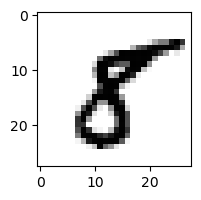

1.1722290138898658e-12% - 0
9.01417890802383e-07% - 1
2.0163384216052446e-20% - 2
1.2628841242399214e-20% - 3
1.5884900142701153e-11% - 4
2.3291249031687595% - 5 - ОШИБКА
2.0248385355745735e-27% - 6
2.9692839673995055e-09% - 7
4.396480348021591e-09% - 8
4.74136589753301e-23% - 9

 3


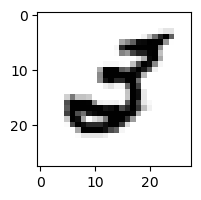

1.864080420763201e-09% - 0
1.3252993380138743e-08% - 1
4.1178702597848856e-07% - 2 - ОШИБКА
2.191046857061348e-30% - 3
4.465807285449674e-09% - 4
1.0443820589625893e-07% - 5
1.999691529223512e-13% - 6
3.759424336198234e-07% - 7
4.794011541497793e-27% - 8
1.684612783778059e-33% - 9

 3


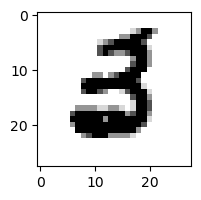

7.16706524256472e-13% - 0
3.306864401160838e-14% - 1
2.559206178579669e-16% - 2
4.940268529160337e-19% - 3
2.683014643233356e-19% - 4
0.00012840933801569685% - 5 - ОШИБКА
3.0366136085912718e-09% - 6
6.3404698626387455e-15% - 7
2.1213934437704986e-38% - 8
5.698667227702846e-41% - 9

 8


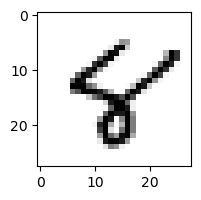

1.0636335507002827e-12% - 0
9.53487625799811e-10% - 1
1.7810581812792395e-19% - 2
1.0145802658367233e-31% - 3
0.01059610221450301% - 4
36.52659676640817% - 5 - ОШИБКА
6.229949759919466e-06% - 6
9.956336234254186e-07% - 7
0.0016725090250255246% - 8
1.3533531977368613e-08% - 9

 7


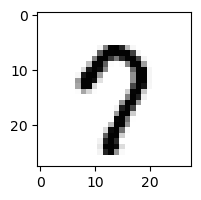

3.830162352981169e-05% - 0
6.903383794747406e-13% - 1
1.138419277496559e-17% - 2
1.2704797546693445e-14% - 3
2.756954681525563e-08% - 4
0.06131181918996192% - 5
2.3937750900651968e-11% - 6
99.02021375417455% - 7
1.0735309931405915e-07% - 8
99.8960526534402% - 9 - ОШИБКА

 8


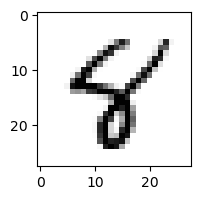

8.273818302777049e-14% - 0
1.350810687374823e-07% - 1
4.037128957597102e-20% - 2
3.1732057522072706e-24% - 3
6.563070550622707% - 4
7.922357731462275% - 5 - ОШИБКА
4.2936025356399005e-08% - 6
7.627219065160268e-06% - 7
0.6021695466879952% - 8
1.9326503474626093e-14% - 9

 4


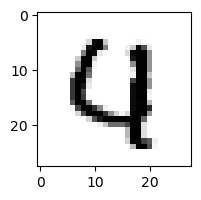

9.307269415766523e-05% - 0
2.76207453589545e-14% - 1
6.333952856124223e-10% - 2
4.088479600557727e-25% - 3
8.500808174837292e-05% - 4
2.0496085885201308e-08% - 5
0.00020706518445736842% - 6
0.0024272703113069503% - 7 - ОШИБКА
5.549397815085765e-26% - 8
1.5498245047982862e-16% - 9

 9


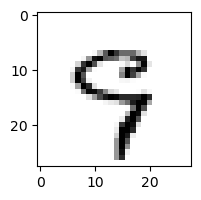

2.6402790127675315e-08% - 0
1.2746127018070382e-08% - 1
7.479557194804457e-14% - 2
0.01941579765838338% - 3
0.010306541235747556% - 4
1.0017810378038863% - 5
5.213858207553871e-10% - 6
96.38984206940587% - 7 - ОШИБКА
9.714584902546424e-20% - 8
0.0034992141634743387% - 9

 2


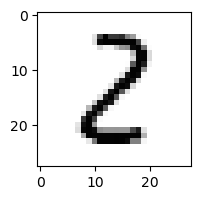

1.0345156955290367e-06% - 0
3.7191493650204563% - 1
8.07425054864902% - 2
3.401833653788506e-06% - 3
7.156218220097655e-11% - 4
0.00011602775943180075% - 5
2.9690787690881937e-16% - 6
7.507913894039157e-10% - 7
99.99998147862824% - 8 - ОШИБКА
5.701576384712193e-23% - 9

 7


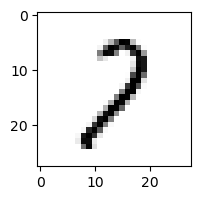

0.0030185533472609034% - 0
11.584088876561427% - 1
93.76306228999157% - 2 - ОШИБКА
0.002049036432501566% - 3
8.990748757246781e-05% - 4
3.7054873119720676e-05% - 5
1.7047116279919074e-06% - 6
16.56136786001611% - 7
0.2880171097305893% - 8
3.914338458305465e-06% - 9

 9


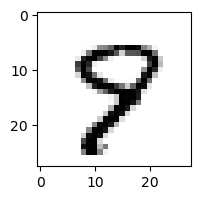

1.9482757762982823e-13% - 0
1.1511396531963918e-12% - 1
2.690823974917553e-19% - 2
1.889320487199416e-16% - 3
8.957223184979848e-06% - 4
0.010775970158531142% - 5
1.0013934537277876e-11% - 6
0.3650937069751043% - 7 - ОШИБКА
3.6356777905457286e-09% - 8
0.00011648612597528504% - 9

 9


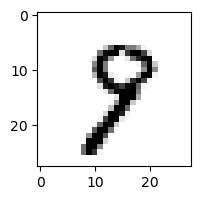

9.92376603227132e-12% - 0
7.742695421655743e-06% - 1
7.950168769245878e-14% - 2
3.017957589267151e-09% - 3
1.3870819043148398e-07% - 4
0.0006207921797305706% - 5
1.3966353082869106e-10% - 6
1.430537034988894% - 7
4.044740673673435% - 8 - ОШИБКА
2.064514575353884% - 9

 8


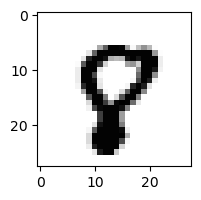

1.256897763995986e-12% - 0
2.415454183792977e-17% - 1
4.4369704547476834e-23% - 2
1.024145646516182e-33% - 3
1.5695880913090158e-12% - 4
5.490637952264576e-05% - 5
2.364137710796422e-17% - 6
0.08911731348486947% - 7 - ОШИБКА
8.468241958960213e-10% - 8
1.1168579651964105e-08% - 9

 3


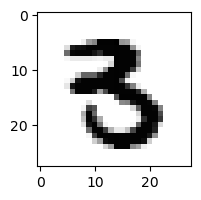

3.940424654317515e-15% - 0
1.977350694094689e-15% - 1
3.4285610425317007e-32% - 2
2.9146597378645474e-05% - 3
4.796926319382826e-18% - 4
0.0013320274784721423% - 5 - ОШИБКА
5.9474775366938164e-24% - 6
3.364309176502622e-13% - 7
5.4848927474244874e-39% - 8
2.7622489371176295e-34% - 9

 8


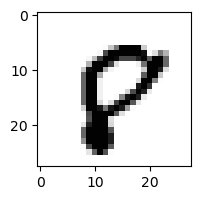

0.04081785480922215% - 0 - ОШИБКА
4.949650928351727e-18% - 1
3.443767337986993e-17% - 2
1.1763956020744198e-37% - 3
2.9142610487234374e-13% - 4
6.8094755663796735e-06% - 5
8.354332924891254e-15% - 6
0.0016546289741494872% - 7
0.009317314338995986% - 8
0.006972112222645101% - 9

 3


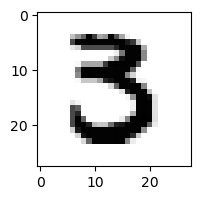

5.37798872486691e-12% - 0
1.4706647819948267e-13% - 1
2.3334126134030637e-19% - 2
9.703951418597145e-06% - 3
2.997436629135695e-27% - 4
0.137673939048266% - 5 - ОШИБКА
5.765059741216903e-25% - 6
8.454909974400278e-10% - 7
1.4044770236828856e-36% - 8
2.189379889075994e-46% - 9

 9


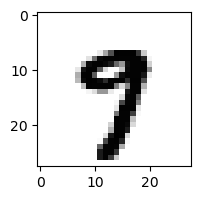

5.27687378811992e-16% - 0
2.356624705422403e-13% - 1
1.7816658345031756e-31% - 2
4.339470358149471e-16% - 3
3.872350827397221e-10% - 4
0.0001352399692274801% - 5
4.2770664479964434e-20% - 6
32.03298934521572% - 7 - ОШИБКА
2.885160609224016e-19% - 8
0.00015466611147462817% - 9

 3


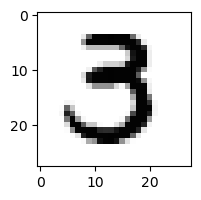

1.0743683379612789e-08% - 0
6.55766852582625e-12% - 1
3.645359560988605e-20% - 2
0.45394589868227725% - 3
1.4305528652815447e-19% - 4
2.198927331983498% - 5 - ОШИБКА
2.4317775737280344e-25% - 6
3.927440113939943e-09% - 7
2.752825164474368e-32% - 8
5.424197905215098e-44% - 9

 9


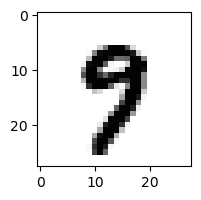

3.133448539217985e-14% - 0
1.1706396690727912e-12% - 1
6.841932568654816e-28% - 2
7.382504450823641e-14% - 3
8.178227953511901e-11% - 4
0.00839018488470683% - 5
3.74868025033032e-18% - 6
20.480368993965612% - 7 - ОШИБКА
1.1148646732602337e-16% - 8
2.907490058029408e-06% - 9

 3


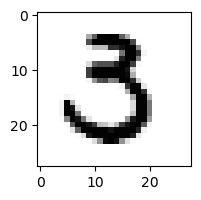

3.3089922088849305e-07% - 0
8.459794505901154e-11% - 1
1.652541894663088e-11% - 2
6.211403454558727e-05% - 3
4.052792770744613e-23% - 4
5.687068192900046% - 5 - ОШИБКА
7.363874579354604e-20% - 6
6.048016886739048e-08% - 7
3.1976506020904835e-30% - 8
2.148988251084129e-40% - 9

 1


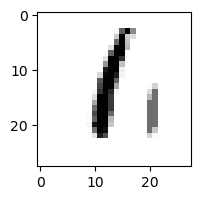

1.3932585388684407e-06% - 0
0.5614063490243529% - 1
0.016572496990768133% - 2
1.4007780861799262e-06% - 3
1.708301528330966e-10% - 4
0.06855846607034301% - 5
99.90477811282553% - 6 - ОШИБКА
1.9251147338446957e-09% - 7
7.6115220583149625% - 8
0.0009395511130025087% - 9

 3


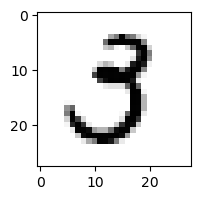

7.405619490487505e-05% - 0
1.429002183870175e-07% - 1
3.3327322422723736e-14% - 2
3.2288365688601357% - 3
2.2323487321819234e-13% - 4
15.30357333590463% - 5 - ОШИБКА
1.0851820676112153e-20% - 6
2.7545312043692526e-05% - 7
1.1339378068118654e-15% - 8
4.5369614283352477e-35% - 9

 8


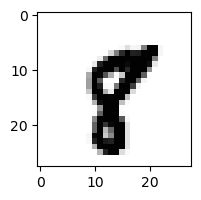

7.144910823422144e-20% - 0
1.8347673926665206e-07% - 1
6.06401266666358e-28% - 2
4.4365372227155284e-26% - 3
1.448188348784523e-14% - 4
0.00013769052863408534% - 5
3.91137673039894e-21% - 6
4.865715963442868% - 7 - ОШИБКА
2.98627045335037e-16% - 8
8.234344107538471e-17% - 9

 9


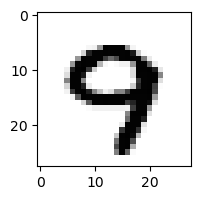

4.958655617985834e-13% - 0
3.586044045594274e-17% - 1
1.2418291144129342e-23% - 2
7.434400816147007e-18% - 3
1.745568139432715e-08% - 4
6.435862629808897e-08% - 5
2.8021911279629597e-15% - 6
4.687325015396261% - 7 - ОШИБКА
2.155077009071873e-26% - 8
1.4294764967694907e-05% - 9

 8


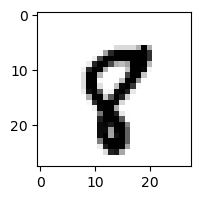

5.130268806389857e-16% - 0
1.6146665469281483e-08% - 1
3.003739040973374e-21% - 2
1.719080342098131e-27% - 3
2.3719279961584186e-12% - 4
0.0010178945094018784% - 5
4.399464302002496e-15% - 6
0.3490777694214114% - 7 - ОШИБКА
1.246297640413651e-11% - 8
7.908444257232692e-08% - 9

 3


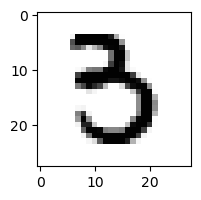

7.366335654873463e-11% - 0
1.9427736859756288e-10% - 1
2.169606468852214e-26% - 2
0.007422629254862189% - 3
3.305877526208835e-16% - 4
0.599548566174435% - 5 - ОШИБКА
3.489695464212387e-13% - 6
1.664053167459942e-08% - 7
5.693767674345009e-26% - 8
4.792435867178229e-25% - 9

 8


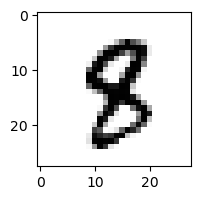

7.00883184356025e-18% - 0
5.4353862235129544e-08% - 1
1.4266085732811508e-20% - 2
2.824490356394987e-14% - 3
7.3550174143817915e-09% - 4
0.09355106079939642% - 5 - ОШИБКА
4.2156737184441054e-18% - 6
3.9102228995036174e-06% - 7
2.7800534744766064e-11% - 8
1.6337563135306224e-16% - 9

 4


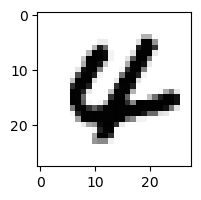

8.73095643212104e-16% - 0
8.705237588017061e-12% - 1
3.313940131831892e-20% - 2
5.485890433598549e-39% - 3
4.321154917421814e-08% - 4
2.5633597281382593e-10% - 5
2.2416487733682262e-11% - 6
0.0008804137122658476% - 7 - ОШИБКА
1.4158969321534187e-33% - 8
2.1991630938012726e-35% - 9

 8


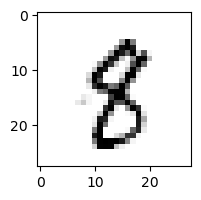

2.77565312048509e-13% - 0
8.196797592590863e-06% - 1
9.300876665417202e-17% - 2
5.838948333226931e-11% - 3
5.103028514017415e-07% - 4
0.08135371161851496% - 5 - ОШИБКА
1.1168204621277333e-14% - 6
0.000981389719611308% - 7
0.0051262185134912895% - 8
4.4441961442398035e-08% - 9

 8


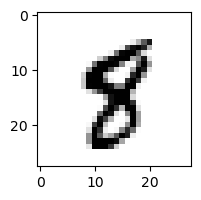

8.675548954375065e-17% - 0
3.729345600042236e-08% - 1
3.7793360495222546e-26% - 2
1.3507154550869445e-21% - 3
1.692436421063419e-08% - 4
0.021065285455576652% - 5 - ОШИБКА
7.464726271619906e-14% - 6
2.471473139211153e-05% - 7
1.4055442328642914e-05% - 8
5.464556306468785e-10% - 9

 8


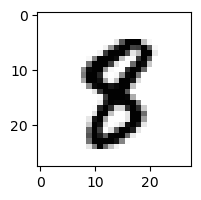

7.593833608580944e-20% - 0
7.852917093348258e-10% - 1
1.8946447269377733e-24% - 2
5.577686964431529e-21% - 3
7.719462513733552e-13% - 4
0.05922367684126185% - 5 - ОШИБКА
3.8089835561425926e-20% - 6
2.040504723219667e-08% - 7
0.00021157882989654913% - 8
5.060552266077855e-19% - 9

 1


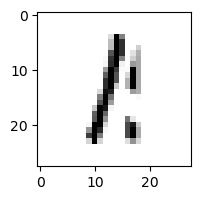

7.754665057149588e-05% - 0
84.31296771710012% - 1
0.008969362845691465% - 2
0.033360082443717666% - 3
3.553788104579207e-11% - 4
0.003727333317210052% - 5
0.010793279500759694% - 6
1.749188704305598e-07% - 7
99.99582469441847% - 8 - ОШИБКА
0.0004857118165156039% - 9

 8


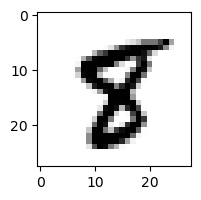

1.0863677097051169e-20% - 0
2.8810134632904982e-11% - 1
4.721963871797787e-29% - 2
1.2381605934505018e-27% - 3
1.2969307499273333e-13% - 4
0.5411755668539633% - 5 - ОШИБКА
1.5220321579805776e-20% - 6
1.6225818507446806e-06% - 7
3.2270989281552003e-10% - 8
2.4033524076591338e-21% - 9

 8


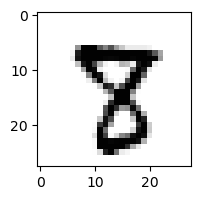

3.853625345596433e-22% - 0
5.715179915382023e-14% - 1
9.821614851819566e-20% - 2
4.1326153567051234e-14% - 3
2.564655050984093e-14% - 4
0.0014968626875654727% - 5
1.3432212418711654e-26% - 6
1.8754556033974155% - 7 - ОШИБКА
9.54645203056151e-07% - 8
7.896184600883479e-22% - 9

 8


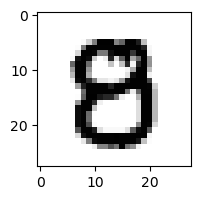

4.3248538976801754e-08% - 0
1.1248312733195135e-20% - 1
8.008281472451674e-19% - 2
9.881344050937922e-12% - 3
1.4538665987119218e-14% - 4
0.00048269157350442314% - 5 - ОШИБКА
1.6921166200692485e-24% - 6
2.785913582720876e-14% - 7
8.832978643611667e-24% - 8
2.4231086890462586e-27% - 9

 9


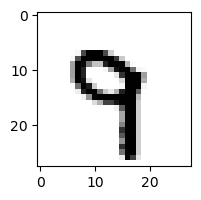

3.2392455827412943e-21% - 0
4.08291269395107e-07% - 1
2.2767292464533657e-18% - 2
2.154727174225873e-14% - 3
0.0003363161023440934% - 4
0.003834756469623682% - 5
5.2406696833350536e-11% - 6
84.04036680003586% - 7 - ОШИБКА
2.027206890592007e-21% - 8
1.3109352985493565e-06% - 9

 8


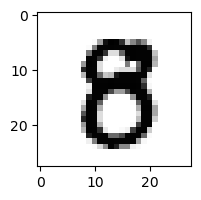

7.512154121852397e-08% - 0
3.7998958375988143e-16% - 1
5.540230751415878e-22% - 2
4.011222266866324e-11% - 3
2.0081493558423005e-14% - 4
0.0036831509690050074% - 5 - ОШИБКА
7.096857800088489e-23% - 6
6.158557452107305e-13% - 7
6.295687263789469e-11% - 8
4.430572710986944e-28% - 9

 8


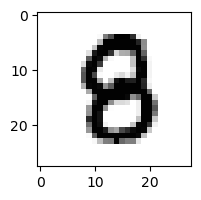

6.609103081279687e-16% - 0
1.0023175274957644e-12% - 1
3.682491342446865e-15% - 2
2.399101799277181e-16% - 3
2.6562630870262605e-13% - 4
0.0002875040423921076% - 5 - ОШИБКА
4.4263359276923744e-13% - 6
9.155497600604023e-15% - 7
2.256045891130738e-14% - 8
1.4703352535480267e-26% - 9

 9


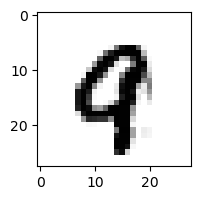

1.4576881031916643e-15% - 0
3.774307538632315e-11% - 1
6.127786535959345e-20% - 2
6.983592959196669e-39% - 3
1.2234044347079554e-06% - 4
3.685976370964421e-10% - 5
1.5366864036888543e-11% - 6
0.5621075099876175% - 7 - ОШИБКА
6.19226313403228e-20% - 8
0.00021612930398897436% - 9

 8


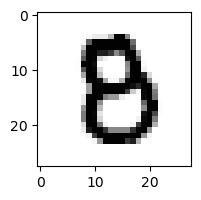

1.1465231187815413e-07% - 0
4.085530194897733e-16% - 1
1.8023412161714586e-10% - 2
5.91152693299167e-11% - 3
6.893099745294505e-13% - 4
0.0005328126762405123% - 5 - ОШИБКА
1.0074997570169989e-13% - 6
7.290838972003484e-14% - 7
1.1651898595875345e-15% - 8
8.42397373547802e-28% - 9

 8


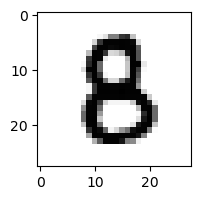

5.585686123360345e-11% - 0
1.8966376722727104e-13% - 1
9.878703120136603e-10% - 2
1.4593681566050235e-12% - 3
2.1446714320725005e-12% - 4
0.009175893264036263% - 5 - ОШИБКА
2.550516704882126e-15% - 6
2.315307497778927e-14% - 7
4.7869677606468594e-12% - 8
1.2893891633493332e-28% - 9

 4


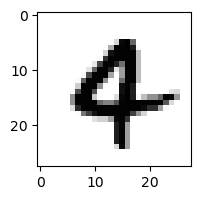

2.3324548281805193e-15% - 0
1.950236575576985e-11% - 1
4.096681865854435e-20% - 2
4.064780458503395e-35% - 3
0.08648087989614188% - 4
8.676734245606638e-11% - 5
2.076680072370594e-08% - 6
0.21623919194302385% - 7 - ОШИБКА
1.3870944161855645e-35% - 8
1.0147962937959047e-13% - 9

 2


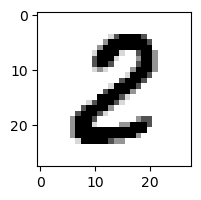

5.921936600251087e-11% - 0
1.106957620510282e-07% - 1
17.526311919810148% - 2
4.995035929737439e-15% - 3
1.067777387940675e-22% - 4
3.4582580407450215e-07% - 5
2.085227874927651e-20% - 6
7.992234544906474e-15% - 7
99.99954701358442% - 8 - ОШИБКА
3.457473945160256e-30% - 9

 8


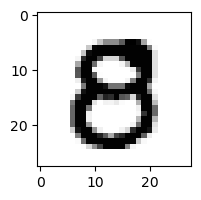

1.1918107523725962e-06% - 0
4.2345175221594866e-23% - 1
2.0152947983697598e-19% - 2
1.243195261904353e-12% - 3
3.783819001948443e-14% - 4
0.0002319286875911611% - 5 - ОШИБКА
4.262592187047007e-28% - 6
3.814940750092066e-13% - 7
3.828013004600215e-26% - 8
4.22932231434882e-30% - 9

 8


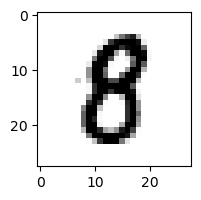

4.766421825563538e-08% - 0
2.9045354194527443e-11% - 1
1.2149501491250765e-14% - 2
8.013798434309234e-15% - 3
4.496808613204298e-12% - 4
0.11090630149551105% - 5 - ОШИБКА
1.9071327469877937e-17% - 6
1.0532607695381564e-11% - 7
0.008087409409362426% - 8
2.4040098050346463e-19% - 9

 8


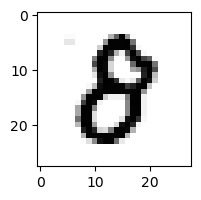

0.00034591309047421806% - 0 - ОШИБКА
3.599407187527792e-15% - 1
6.77470581997509e-11% - 2
4.020517481854707e-11% - 3
1.9136225298285534e-13% - 4
2.5161109898028972e-05% - 5
7.488127423825337e-16% - 6
2.660694533039504e-11% - 7
0.00021769930164780902% - 8
7.318628638147051e-17% - 9

 5


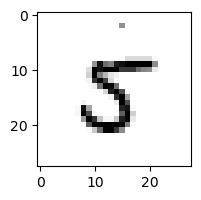

0.00015731908976694103% - 0
0.018010495258470906% - 1
7.603730699386469e-08% - 2
3.16477297487581e-08% - 3
0.00043733437926120447% - 4
0.03166204680781061% - 5
0.008693233285092203% - 6
0.4598312646177281% - 7 - ОШИБКА
0.0006208718755297773% - 8
2.0120511493374973e-11% - 9

 8


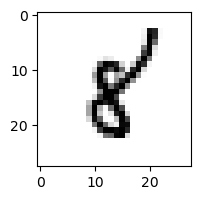

1.5318602105565552e-13% - 0
8.81644992717791% - 1 - ОШИБКА
1.8669064658292725e-12% - 2
4.268289566772705e-18% - 3
0.02159781884054054% - 4
0.006024531698351316% - 5
0.00047768521458064437% - 6
3.982096279982973e-06% - 7
1.8138029613519395e-05% - 8
2.9035512829899595e-11% - 9

 7


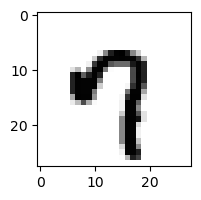

0.00016913153401946135% - 0
6.098032710095418e-12% - 1
5.593053797019076e-26% - 2
2.217509612361906e-20% - 3
0.00011691966623806749% - 4
0.007710564615868254% - 5
5.788881883858945e-11% - 6
31.10263328159984% - 7
2.3794354547917457e-27% - 8
99.99997151626937% - 9 - ОШИБКА

 8


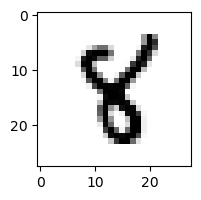

3.306626534189005e-23% - 0
1.3881562211652084e-05% - 1
1.7848348606714757e-20% - 2
2.655819833388346e-16% - 3
0.05846556779820142% - 4
0.07919604503100493% - 5 - ОШИБКА
2.164486691983925e-14% - 6
2.722868593822841e-05% - 7
1.4859576763339852e-11% - 8
1.3955667138058127e-21% - 9

 3


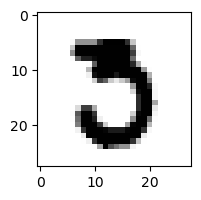

1.4323662298945706e-06% - 0
9.976450322368192e-17% - 1
3.039790759835309e-14% - 2
4.591635287168357e-08% - 3
8.866937849914185e-28% - 4
3.0427231861275915e-05% - 5
1.1465147425744486e-22% - 6
0.004776855509463249% - 7 - ОШИБКА
1.993737655107728e-18% - 8
1.696161180645803e-44% - 9

 2


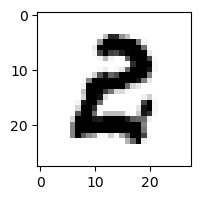

0.00018120842493552967% - 0 - ОШИБКА
4.511799392312531e-11% - 1
1.0495214391869198e-08% - 2
1.4466675830415137e-08% - 3
2.7240196739137293e-21% - 4
2.455460518264156e-06% - 5
1.5529540276397592e-12% - 6
1.7526097069739114e-17% - 7
7.358476012746583e-31% - 8
5.0227935198073604e-34% - 9

 3


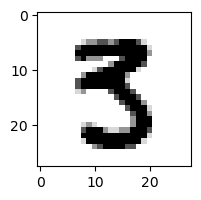

4.7475293954222795e-17% - 0
2.0340242866867446e-14% - 1
2.5034047202370866e-37% - 2
0.0012221254158896156% - 3
7.051562842758703e-20% - 4
8.791152120858396% - 5 - ОШИБКА
9.602337516768353e-34% - 6
8.18258311499935e-08% - 7
2.937384044926134e-29% - 8
4.73865541772522e-39% - 9

 1


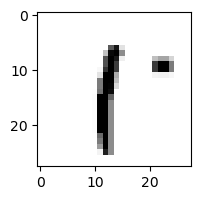

4.175366400500615e-06% - 0
0.003671413745379992% - 1
3.1584115689144584e-08% - 2
8.966300427867689e-07% - 3
1.812854798800492e-08% - 4
79.86780168095164% - 5
0.38087257901073507% - 6
3.0996832488289e-05% - 7
99.99999999999936% - 8 - ОШИБКА
13.62773961990924% - 9

 8


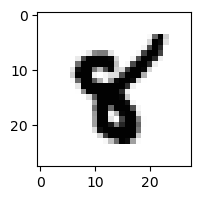

1.0002118562534628e-25% - 0
4.7192477867328426e-08% - 1
7.268728645095351e-30% - 2
2.8139820058034723e-34% - 3
0.00017074305528510684% - 4
0.1506957034070752% - 5 - ОШИБКА
9.090180737260079e-17% - 6
5.955425392905483e-08% - 7
1.3004205093611684e-18% - 8
3.1377421196158497e-25% - 9

 9


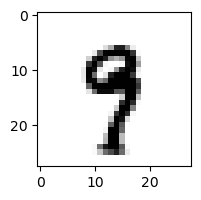

1.2743931863889935e-17% - 0
3.523890004832985e-08% - 1
8.515487813470324e-25% - 2
5.637206631055093e-10% - 3
1.0401442813254503e-08% - 4
0.06505417510427948% - 5
3.426832362448179e-15% - 6
0.23642907149961423% - 7 - ОШИБКА
6.391799922490247e-16% - 8
0.004948765691421984% - 9

 8


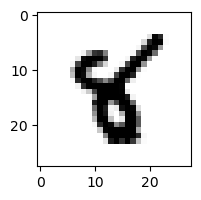

8.849787452580675e-23% - 0
6.292979291434872e-06% - 1
1.444522795608932e-28% - 2
2.796392165539096e-25% - 3
0.0006899971989418865% - 4
4.891351080855111% - 5 - ОШИБКА
5.866678894063136e-15% - 6
7.44526014907276e-09% - 7
2.5405413376835238e-21% - 8
1.3286635952672747e-26% - 9

 8


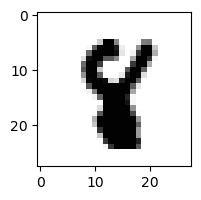

1.4564948128137175e-29% - 0
1.8222286937678405e-09% - 1
1.1702597656020362e-26% - 2
1.453500183142115e-29% - 3
1.4274838576238523e-09% - 4
0.009677771203058677% - 5 - ОШИБКА
1.452599415043419e-19% - 6
1.1416703515659573e-08% - 7
7.758288613127392e-15% - 8
6.103579234672317e-32% - 9

 8


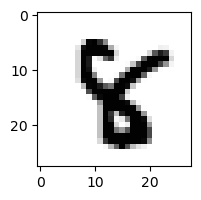

9.39158049442305e-31% - 0
2.9579517923225813e-14% - 1
6.994533810843002e-25% - 2
2.135193726229468e-22% - 3
0.00012157732668481854% - 4
0.08025485271534605% - 5 - ОШИБКА
9.343820236159752e-24% - 6
3.2976003956191712e-09% - 7
1.920988089327514e-14% - 8
8.005682965267271e-32% - 9

 0


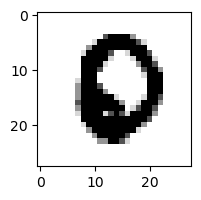

1.065316009299143e-07% - 0
7.157361240706052e-21% - 1
7.082543927255627e-14% - 2
1.5917183180692494e-41% - 3
2.1138609556417923e-16% - 4
1.5901642152759718e-10% - 5
2.1320390787863746e-06% - 6 - ОШИБКА
1.6545058567554222e-13% - 7
6.3589467703984296e-27% - 8
9.001723392819628e-47% - 9

 8


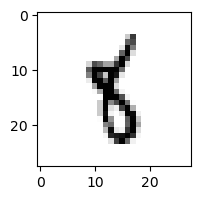

2.073427335649958e-14% - 0
0.0597546507692054% - 1
9.867159693244496e-14% - 2
1.461632075178461e-13% - 3
0.00015707150215864128% - 4
31.41374946433891% - 5 - ОШИБКА
0.012427777926821626% - 6
2.59394471168197e-06% - 7
0.03513480368082983% - 8
4.806354140015175e-09% - 9

 8


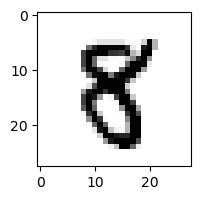

2.0175078135290138e-12% - 0
2.6701236556948434e-11% - 1
1.6060800683127156e-21% - 2
2.420992562409312e-14% - 3
2.2368707808543424e-09% - 4
0.02287186780588044% - 5 - ОШИБКА
6.098019838549015e-20% - 6
1.2946848754009405e-08% - 7
2.4817460632483555e-14% - 8
4.748507595565417e-22% - 9

 7


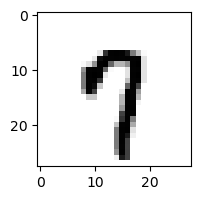

8.542077495864228e-08% - 0
4.0253729984248807e-10% - 1
8.52129325340871e-18% - 2
9.515708628179339e-14% - 3
5.2597436001806366e-05% - 4
0.2495454157351194% - 5
1.3413101801754105e-10% - 6
98.9957806772875% - 7
4.5270386237174444e-14% - 8
99.74373836381766% - 9 - ОШИБКА

 8


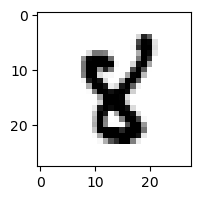

9.347456692685114e-22% - 0
1.0920386972174824e-07% - 1
4.296681946715696e-19% - 2
5.155460350238439e-28% - 3
0.002728845119072778% - 4
0.04156232500957571% - 5 - ОШИБКА
5.7696476246936826e-11% - 6
4.508057047292387e-07% - 7
0.00252671538654435% - 8
2.1621213091987868e-23% - 9

 8


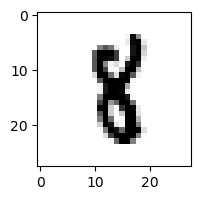

7.84217327760971e-23% - 0
0.008307015540969328% - 1
1.2638373506046708e-14% - 2
1.7528152384140929e-13% - 3
3.3641878726240853e-09% - 4
0.04648453493103438% - 5 - ОШИБКА
1.3444510362124786e-12% - 6
1.513757020583849e-06% - 7
1.961104480621401e-09% - 8
1.925047743524948e-18% - 9

 3


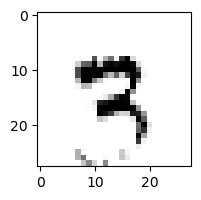

1.2441897973137028e-16% - 0
0.04470744546473818% - 1
3.6008044576529206e-14% - 2
2.5241354036867353e-23% - 3
0.0009198129295521674% - 4
7.62472547508404e-05% - 5
1.6193964513100733e-09% - 6
80.3248690107128% - 7 - ОШИБКА
5.6178238541944125e-08% - 8
1.054822574800427e-05% - 9

 5


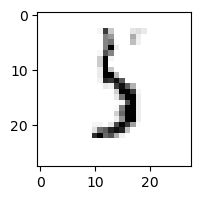

1.0202590936170018e-08% - 0
0.059069075692409156% - 1
4.619204199846491e-05% - 2
70.11458881164229% - 3 - ОШИБКА
0.017090945797086747% - 4
2.886468908593568% - 5
53.887687751281476% - 6
0.02396819501135095% - 7
1.2038960101774365% - 8
1.7322588823816567e-05% - 9

 8


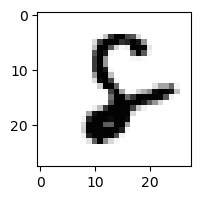

9.776061910250744e-15% - 0
3.720046586896677e-09% - 1
1.8410996696185373e-09% - 2
1.5162433937828948e-26% - 3
7.846784615442549e-10% - 4
0.004979998676414819% - 5
4.743809806189446% - 6 - ОШИБКА
4.6577347594286676e-08% - 7
1.5242381501930241e-16% - 8
1.6141795877027165e-41% - 9

 9


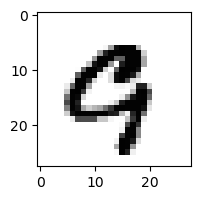

4.298480033660687e-12% - 0
1.0151343966184062e-11% - 1
1.4920094919057157e-23% - 2
7.032961041042677e-35% - 3
2.4164808425379996e-11% - 4
1.0881596687405325e-07% - 5
5.725924602234013e-20% - 6
0.20269904353254417% - 7 - ОШИБКА
4.674349934892883e-35% - 8
1.0086976263500256e-12% - 9

 9


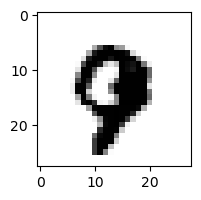

1.6758312546930173e-22% - 0
1.69867530895728e-14% - 1
3.703565774299213e-27% - 2
1.2846840656124197e-34% - 3
1.8136233959715176e-12% - 4
3.547959402624906e-11% - 5
1.6919675277977192e-16% - 6
10.046745662204527% - 7 - ОШИБКА
1.0501494935817865e-30% - 8
2.3917199361514778e-11% - 9

 8


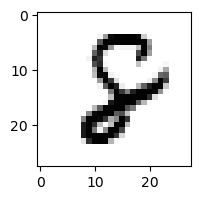

5.482115868106116e-15% - 0
5.8090184752524345e-08% - 1
4.134958460873013e-10% - 2
2.6204670337406737e-29% - 3
2.688653317382729e-10% - 4
8.146566333572939e-07% - 5
8.898817001183651e-05% - 6 - ОШИБКА
1.0816558998676569e-10% - 7
7.283455984741662e-10% - 8
1.7195896631955524e-40% - 9

 9


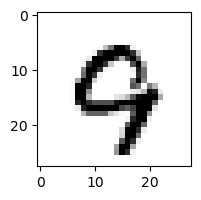

2.8378590963974246e-10% - 0
1.6985729655541917e-12% - 1
1.1102725478026028e-14% - 2
1.4625114836875495e-26% - 3
0.0006522627695158493% - 4
1.0402989661481218e-06% - 5
6.374001384287995e-07% - 6
0.6342902720435472% - 7 - ОШИБКА
1.553081173565978e-22% - 8
0.003996964659582492% - 9

 9


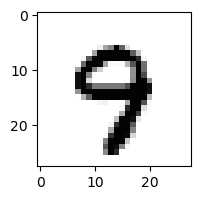

1.315213983124391e-14% - 0
1.955125187013979e-15% - 1
6.532826866725197e-22% - 2
7.768968638946305e-14% - 3
3.1556495799408193e-07% - 4
0.6452536880554801% - 5 - ОШИБКА
3.712665217479095e-11% - 6
0.03540066414570618% - 7
6.097729938818549e-21% - 8
0.5506992862008668% - 9

 9


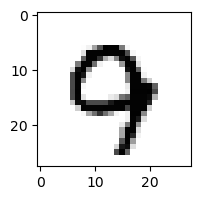

8.978989965503267e-14% - 0
1.613126239444936e-12% - 1
1.2571458303880256e-13% - 2
7.394776514081253e-27% - 3
0.00035971412792035933% - 4
9.84302260650762e-09% - 5
1.2417200880764263e-09% - 6
74.99717976148563% - 7 - ОШИБКА
1.4697975594818663e-23% - 8
6.877367517372407e-06% - 9

 8


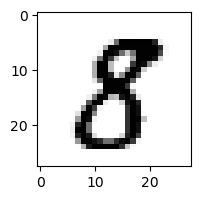

3.4760324250294925e-13% - 0
3.153473645955822e-09% - 1
1.1836218193939137e-18% - 2
7.132983262436716e-09% - 3
2.3525711561408196e-15% - 4
2.8790744643141384% - 5 - ОШИБКА
8.901638306418624e-27% - 6
5.4263397158155595e-12% - 7
0.02436187288453882% - 8
9.466752069802282e-28% - 9

 4


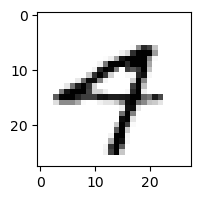

3.8249442989076146e-05% - 0
2.193064391912111e-10% - 1
1.0527039223792037e-26% - 2
4.996689388601581e-12% - 3
75.94611596389497% - 4
0.00012336332569738917% - 5
5.768052621977022e-14% - 6
97.96811819025655% - 7 - ОШИБКА
3.462695872246844e-28% - 8
3.565078200858276e-07% - 9

 4


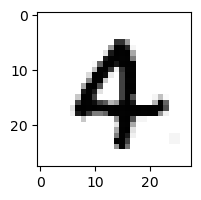

4.277131671726338e-15% - 0
3.4638737064053475e-10% - 1
1.6222537646517002e-12% - 2
5.970244488978361e-28% - 3
2.121876258237269e-05% - 4
4.100701306867888e-09% - 5
1.9647964120218433e-08% - 6
0.0022704561844768367% - 7 - ОШИБКА
2.299447439409981e-30% - 8
3.2917166690148524e-12% - 9

 5


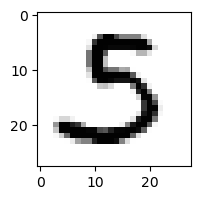

1.3833898427526586e-07% - 0
3.7025714446454027e-09% - 1
4.71161859532247e-12% - 2
98.7657946719694% - 3 - ОШИБКА
7.088972807086244e-19% - 4
96.7214037901577% - 5
2.061162902108803e-15% - 6
4.088282125386447e-10% - 7
5.156881674647046e-19% - 8
2.0707604653052316e-44% - 9

 7


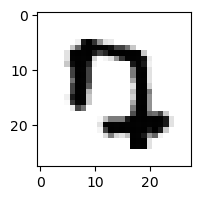

1.2366121062871842e-07% - 0
1.5374023443981552e-20% - 1
1.096995405298929e-09% - 2
5.075492485362878e-11% - 3
3.643924541402091e-14% - 4
1.6158644211922007e-05% - 5 - ОШИБКА
7.174156452077108e-14% - 6
2.5658539269137014e-06% - 7
2.7245171389953415e-44% - 8
2.189452342668919e-21% - 9

 4


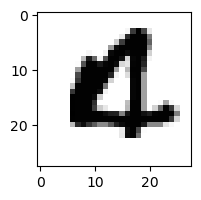

2.199850881729524e-05% - 0 - ОШИБКА
1.8637181679657976e-24% - 1
1.0563121053388302e-13% - 2
6.721018005725688e-44% - 3
4.11998034692948e-21% - 4
1.8841876805033287e-05% - 5
1.2805249252599865e-09% - 6
1.0158901318632814e-14% - 7
1.8950069628755523e-47% - 8
1.3676981288464152e-30% - 9

 5


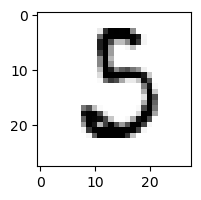

2.1874052437671092e-05% - 0
1.0677339107689833e-05% - 1
0.00024031000191500942% - 2
0.0003527938135259279% - 3
2.1028729490598073e-20% - 4
0.000142524201066179% - 5
73.66287580439838% - 6 - ОШИБКА
1.218478882104399e-06% - 7
2.012794318792929e-14% - 8
1.1360177780310739e-33% - 9

 3


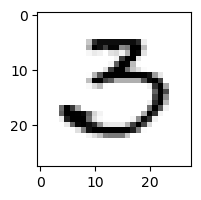

99.95771696734262% - 0 - ОШИБКА
4.223333707019876e-07% - 1
0.027984541863410702% - 2
99.10478075246371% - 3
6.4894793913883495e-18% - 4
1.6918812800554873e-08% - 5
1.6828375538214764e-06% - 6
2.5416976874234567e-08% - 7
3.4816780460787817e-19% - 8
3.1194099242210244e-33% - 9

 5


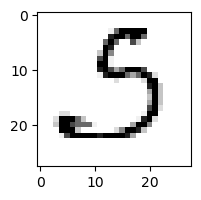

0.3891465127861894% - 0
6.716171172253589e-05% - 1
1.1285072060070795% - 2
99.9999906450726% - 3 - ОШИБКА
5.128868601778338e-15% - 4
1.0675287541920342e-05% - 5
8.970754185475768e-07% - 6
0.0002762889907041951% - 7
1.1990338296841197e-13% - 8
1.4674138771604924e-22% - 9

 3


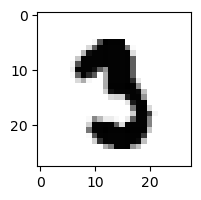

4.8835736916940284e-20% - 0
1.1994142910081697e-10% - 1
8.999690139264706e-26% - 2
1.8732521112736013e-09% - 3
9.723476590008146e-26% - 4
1.4943451804813803% - 5 - ОШИБКА
1.66043544515466e-22% - 6
4.001879592023854e-05% - 7
1.875064998014993e-24% - 8
2.8115356197471567e-34% - 9

 4


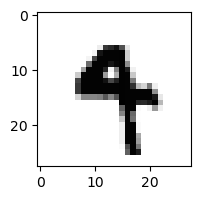

2.371064024119478e-21% - 0
1.2402725805488703e-09% - 1
7.66381817000727e-33% - 2
3.1546048152217677e-15% - 3
0.5621934876433224% - 4
0.82742601386659% - 5
2.1817427357705455e-10% - 6
0.0008857418406351358% - 7
1.153011102988956e-32% - 8
88.74848426951213% - 9 - ОШИБКА

 8


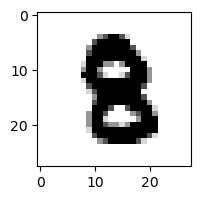

1.6076801979093528e-25% - 0
1.7601576682307558e-17% - 1
3.902324961682633e-21% - 2
2.2717862591371553e-22% - 3
2.3341348523805833e-20% - 4
3.758232403760054e-08% - 5 - ОШИБКА
7.132808355224734e-23% - 6
2.3804115242392285e-16% - 7
5.183195830226868e-25% - 8
1.5426973543164034e-30% - 9

 8


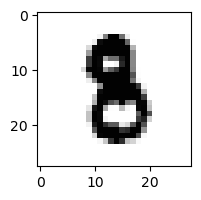

1.1256706896395646e-22% - 0
2.7406209132499267e-08% - 1
4.824848457977411e-20% - 2
4.147359692719671e-14% - 3
2.297219442231858e-19% - 4
0.0015635599139104614% - 5 - ОШИБКА
1.5176416928037012e-14% - 6
9.458163221648583e-11% - 7
2.77380284571293e-19% - 8
3.891797432811752e-28% - 9

 3


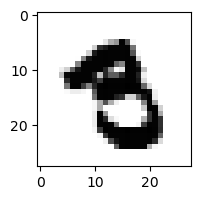

3.814777079411747e-24% - 0
1.0146879814629149e-14% - 1
2.98754351948356e-39% - 2
1.31924240782138e-24% - 3
7.396904840715482e-19% - 4
1.3715534227181048% - 5 - ОШИБКА
7.677586822545887e-22% - 6
2.121543201524558e-12% - 7
1.5103577537422776e-30% - 8
6.991454302773561e-20% - 9

 8


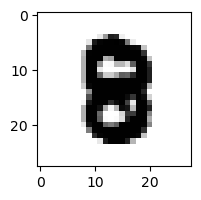

3.3033987889194475e-22% - 0
9.960602975770263e-19% - 1
7.84261606610925e-23% - 2
5.307538249943174e-22% - 3
1.4002248316673985e-19% - 4
7.698668036313838e-09% - 5 - ОШИБКА
3.559916992396576e-20% - 6
1.4366193721314737e-15% - 7
1.9667389277825966e-24% - 8
1.198092530516142e-30% - 9

 8


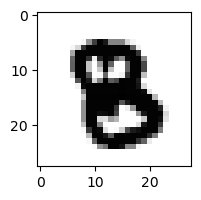

5.3474480750585045e-27% - 0
6.495588783255296e-22% - 1
2.1314347724403077e-24% - 2
1.5688498768001614e-28% - 3
1.4803426929083987e-17% - 4
1.921898325142726e-07% - 5 - ОШИБКА
2.144616255454645e-27% - 6
1.7519246305621074e-15% - 7
1.8728297138122126e-33% - 8
5.783172999036282e-36% - 9

 8


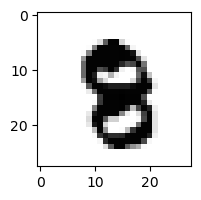

2.5102794356356367e-26% - 0
2.8947857752146e-15% - 1
7.560298296853608e-22% - 2
3.2564093173302825e-34% - 3
1.3715001696701615e-15% - 4
3.817447211943509e-06% - 5 - ОШИБКА
1.8667551435624043e-20% - 6
3.0108090723260745e-09% - 7
2.3102908136380947e-18% - 8
6.552080128934342e-22% - 9

 3


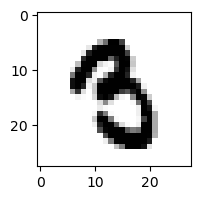

1.716146428712816e-20% - 0
5.12687050538855e-10% - 1
2.5388546491876516e-30% - 2
1.7363674014436388e-13% - 3
3.4708665176013574e-16% - 4
0.8713686622534698% - 5 - ОШИБКА
3.4913185067767605e-15% - 6
5.296665708615332e-11% - 7
1.0154064102931314e-30% - 8
2.8105082646624735e-21% - 9

 4


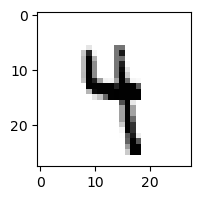

8.19161571738349e-18% - 0
0.005351382003980573% - 1
1.887846735522993e-15% - 2
1.5815615977878763e-06% - 3
28.84828205619927% - 4
0.05693842660319383% - 5
4.270035733822251e-05% - 6
0.00010665831459457189% - 7
6.235294438271499e-12% - 8
99.66502998322134% - 9 - ОШИБКА

 8


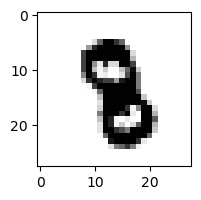

2.455164518337037e-31% - 0
1.2657450039649649e-11% - 1
8.188129201199825e-20% - 2
1.9656507916887007e-20% - 3
2.0660527310723696e-11% - 4
3.466279444204246e-05% - 5 - ОШИБКА
7.008628054335481e-19% - 6
2.5832383210108807e-09% - 7
3.7169426642563698e-28% - 8
6.4234460926541285e-27% - 9

 4


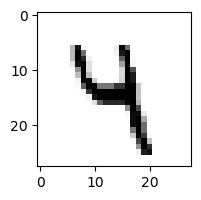

2.8634363227868756e-17% - 0
6.229329537607418e-06% - 1
5.832983048587799e-10% - 2
0.3894848588259867% - 3
86.17098069819662% - 4
0.005215351832563888% - 5
1.6086336522266671e-06% - 6
1.3701884331853148e-05% - 7
7.20417993285661e-15% - 8
99.99343724852098% - 9 - ОШИБКА

 0


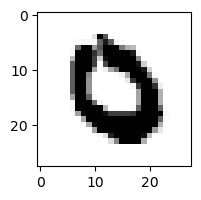

1.3634934931017268e-08% - 0
1.4526820436120724e-20% - 1
6.139423798979056e-12% - 2
1.6920823174149407e-31% - 3
1.712597374355978e-24% - 4
5.689714942937624e-12% - 5
1.5682988343067792e-09% - 6
1.2736932974129251e-07% - 7 - ОШИБКА
4.82356425118026e-50% - 8
9.132101538523225e-39% - 9

 8


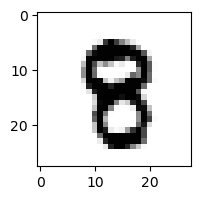

1.8775112060463837e-19% - 0
3.900195613643129e-14% - 1
3.0036978078106397e-21% - 2
2.488737538499436e-16% - 3
5.713027374380589e-13% - 4
4.732623444646408e-06% - 5 - ОШИБКА
1.260645679793601e-18% - 6
4.175613343592139e-09% - 7
4.433614446929739e-07% - 8
7.795763229042496e-12% - 9

 9


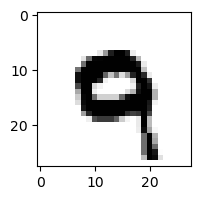

2.167680110585712e-16% - 0
2.3153151221682784e-14% - 1
3.627654619728753e-20% - 2
3.8675667558189944e-43% - 3
2.756461192528741e-06% - 4
8.510072062736162e-09% - 5
1.948166316106581e-10% - 6
0.5150220982337268% - 7 - ОШИБКА
4.113681478370873e-34% - 8
0.004124328104166691% - 9

 9


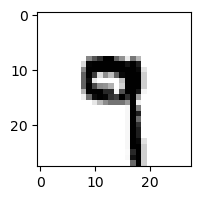

1.0751186955156861e-15% - 0
7.803730167315047e-05% - 1
1.1974239880897175e-17% - 2
1.2977526078620366e-10% - 3
0.003774327362003047% - 4
0.002048131588528426% - 5
1.9380409458828105e-12% - 6
7.184439225145743% - 7 - ОШИБКА
3.910435944638524e-17% - 8
2.566888633402871% - 9

 8


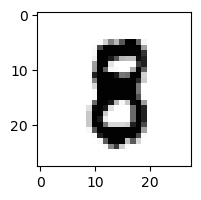

6.191808302235032e-19% - 0
1.066083004570116e-08% - 1
8.704528966843453e-21% - 2
2.1050291088566904e-13% - 3
5.385252071238746e-17% - 4
0.0025381523880339037% - 5 - ОШИБКА
4.3583454067888687e-14% - 6
8.33009103284975e-12% - 7
0.0019334361463984346% - 8
1.0886528017694011e-19% - 9

 8


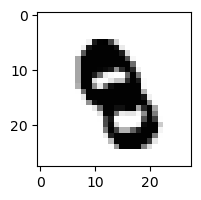

4.320334608018898e-33% - 0
3.896332082618842e-15% - 1
2.0457437865379942e-22% - 2
4.592921232353405e-31% - 3
2.2167719313565005e-10% - 4
0.0003089704674291626% - 5 - ОШИБКА
2.4888074831631055e-21% - 6
2.847647792017932e-09% - 7
1.980024735469213e-39% - 8
9.704844552413717e-23% - 9

 1


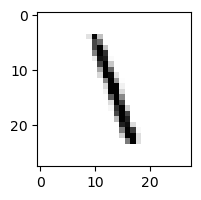

3.124252457188615e-10% - 0
67.45596082710847% - 1
0.03248298359212727% - 2
0.0005008268521151874% - 3
0.27549892038575685% - 4
19.046493748781785% - 5
3.9360868576233834% - 6
0.0021520151724795% - 7
86.48710167199% - 8 - ОШИБКА
6.420810629097896e-07% - 9

 3


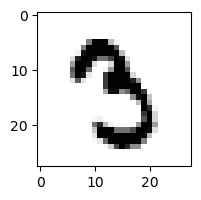

3.3526772110924594e-18% - 0
1.8192014679765506e-08% - 1
1.1195637116245304e-20% - 2
1.9155264448211446% - 3
1.0529795141155101e-15% - 4
2.157377840572506% - 5 - ОШИБКА
1.072787663683986e-17% - 6
5.458086269037329e-05% - 7
6.416739928980832e-19% - 8
9.590376771645116e-26% - 9

 3


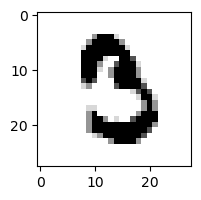

1.3409193330237872e-12% - 0
1.5227472725463148e-10% - 1
4.980094689349812e-14% - 2
1.8374170176178136e-07% - 3
6.50471002610337e-25% - 4
0.001315300954402298% - 5 - ОШИБКА
3.0161602442886325e-14% - 6
2.856360491182534e-06% - 7
4.116501036976934e-32% - 8
2.534038724172687e-36% - 9

 8


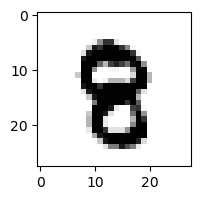

8.82801738938949e-21% - 0
6.529157317149004e-14% - 1
1.0840963024528892e-18% - 2
3.808078849673362e-24% - 3
2.502126884795698e-15% - 4
6.999954703572014e-07% - 5 - ОШИБКА
1.0613070812046287e-17% - 6
1.2009644082768829e-10% - 7
3.24267905475897e-09% - 8
5.0512712996291913e-14% - 9

 4


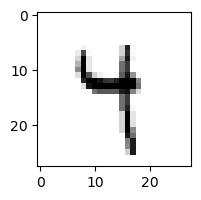

2.759053573898194e-12% - 0
0.1935596303024641% - 1
3.851321575898128e-17% - 2
0.046260973955706185% - 3
99.8335491031232% - 4
0.36779733085014277% - 5
0.005665075393316298% - 6
0.0007003827703308409% - 7
2.056130643136446e-06% - 8
99.99989729387786% - 9 - ОШИБКА

 3


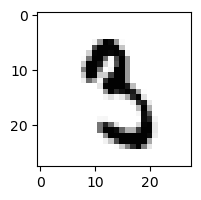

1.3063769219599124e-15% - 0
0.0002948464419573267% - 1
1.3379469767817993e-16% - 2
0.262553647405709% - 3
1.4039098233872463e-12% - 4
5.1603096023164925% - 5 - ОШИБКА
1.3846416944087144e-13% - 6
8.669923624938875e-07% - 7
1.2265348055966296e-16% - 8
1.2129806494786847e-15% - 9

 8


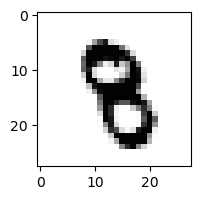

5.80735100393369e-27% - 0
2.0069085956974838e-09% - 1
1.0180373509164902e-14% - 2
1.1994547658298974e-12% - 3
1.6895015216425337e-09% - 4
7.3629739263747224e-06% - 5 - ОШИБКА
3.3828686762489695e-17% - 6
6.542501080764624e-07% - 7
4.485569689316344e-26% - 8
7.216210547369668e-14% - 9

 3


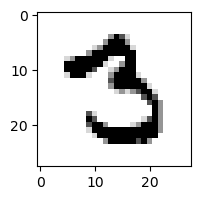

1.755388264962297e-11% - 0
6.458202144895364e-09% - 1
6.590046882703666e-11% - 2
5.324848290270907e-06% - 3
2.564872646346161e-21% - 4
0.07717763125719947% - 5 - ОШИБКА
4.998039619289688e-20% - 6
3.2172245117726753e-06% - 7
7.617839855328158e-20% - 8
3.6187878378181045e-30% - 9

 3


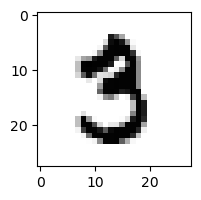

4.999236090424456e-13% - 0
1.8416708750838534e-08% - 1
2.9825118910811725e-18% - 2
0.00010569300743939688% - 3
2.956843231686276e-20% - 4
5.776827309842225% - 5 - ОШИБКА
9.270892055327837e-20% - 6
1.297717824963137e-07% - 7
1.0719999886879492e-12% - 8
8.842883404710725e-23% - 9

 2


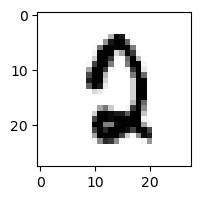

1.6674310723465326e-07% - 0
3.1536389871571537e-13% - 1
9.57128444099606e-10% - 2
1.295697665823055e-21% - 3
3.379050454071519e-14% - 4
0.9945556800790343% - 5 - ОШИБКА
7.755280701194997e-06% - 6
7.071782824744319e-05% - 7
3.627548525093726e-16% - 8
1.5290496090235945e-23% - 9

 4


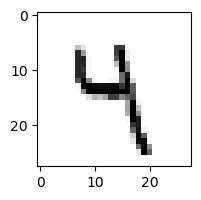

2.9264850490552272e-12% - 0
0.0012242499114870295% - 1
5.083836837554186e-10% - 2
23.685541600963568% - 3
56.6736441241775% - 4
0.5388451096965235% - 5
0.0005305550518540747% - 6
7.551444218215478e-05% - 7
2.8728246970957205e-13% - 8
99.99999884441496% - 9 - ОШИБКА

 3


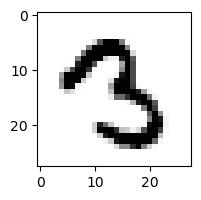

1.1072303523476132e-16% - 0
7.481801309931502e-10% - 1
1.2181267275677022e-16% - 2
5.091671862593747e-06% - 3
7.536868131106686e-15% - 4
0.489082076196774% - 5 - ОШИБКА
2.861577180184864e-21% - 6
0.00011702814045587368% - 7
1.2010583851774824e-28% - 8
2.6631222431462523e-20% - 9

 8


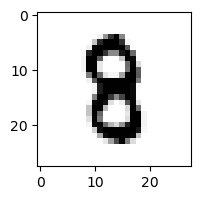

1.925388907969706e-16% - 0
1.5518780063568847e-07% - 1
7.94378111473724e-12% - 2
2.0550954453453383e-09% - 3
5.371329179702908e-13% - 4
0.0024496436410710093% - 5 - ОШИБКА
1.5593110759730345e-10% - 6
3.4958252456546016e-11% - 7
1.677656974178651e-06% - 8
2.1977101346301695e-18% - 9

 8


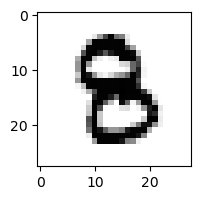

4.995415029701052e-17% - 0
9.507676442427687e-14% - 1
1.5026212589004552e-20% - 2
1.257017558403258e-07% - 3
3.929636077328181e-13% - 4
0.001282535556460759% - 5 - ОШИБКА
2.2495240250138338e-17% - 6
2.1252538470759427e-14% - 7
1.0096429766714791e-20% - 8
1.072346270810822e-23% - 9

 3


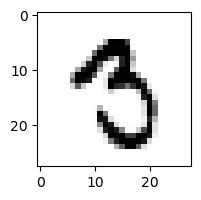

4.291118046978806e-11% - 0
7.86290793789307e-06% - 1
5.294684367044009e-22% - 2
7.87061564322749e-11% - 3
6.525510654249408e-16% - 4
0.4047488278231427% - 5 - ОШИБКА
6.476334125808367e-13% - 6
2.7030693503444447e-05% - 7
1.3900010221342968e-17% - 8
1.1404981579471397e-12% - 9

 3


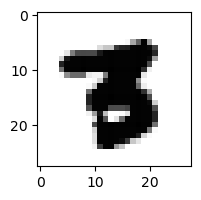

1.047677767477511e-31% - 0
4.797833038857963e-19% - 1
5.101185145475591e-32% - 2
1.4456448307895902e-27% - 3
1.3074764434186777e-25% - 4
1.1279251929656897e-06% - 5 - ОШИБКА
2.1480810511360546e-30% - 6
7.834058600841122e-09% - 7
6.19876857053218e-39% - 8
7.596462703204583e-46% - 9

 8


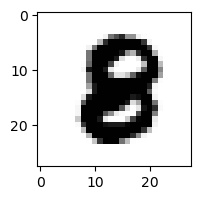

2.4723022488169674e-23% - 0
7.909339375329676e-19% - 1
3.069223570268283e-22% - 2
1.6494364106452957e-34% - 3
8.930904933119356e-21% - 4
4.5836568214519457e-10% - 5 - ОШИБКА
2.5879503511870645e-16% - 6
9.327274468375661e-19% - 7
8.385796707803805e-16% - 8
9.920158524820559e-40% - 9

 9


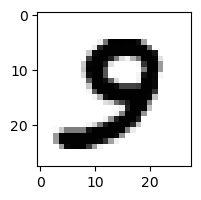

4.0362889804540918e-16% - 0
9.13534871404773e-19% - 1
5.371169122231823e-28% - 2
1.0513814172419118e-10% - 3
3.068931763831059e-14% - 4
0.0037829421088792455% - 5 - ОШИБКА
5.403205346076908e-20% - 6
2.8557570450223365e-07% - 7
1.0722431901108138e-22% - 8
1.0571853261449272e-29% - 9

 3


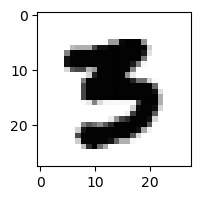

6.062118239235343e-22% - 0
6.648656226890847e-20% - 1
5.791399453050485e-38% - 2
4.3964989304438004e-09% - 3
3.956929838908687e-24% - 4
0.9547132025688989% - 5 - ОШИБКА
7.565732862766314e-24% - 6
4.7416543290384246e-09% - 7
3.9873963205649355e-49% - 8
2.096000100536346e-48% - 9

 8


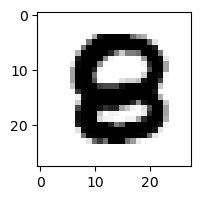

5.655399292959159e-19% - 0
8.44328825803223e-27% - 1
2.5880754534276382e-17% - 2
4.218832508486208e-40% - 3
9.88149417361285e-19% - 4
4.755717794694113e-08% - 5 - ОШИБКА
6.7360998705285155e-21% - 6
1.2074525010424709e-23% - 7
1.2820400772645691e-35% - 8
8.044476994051484e-56% - 9

 9


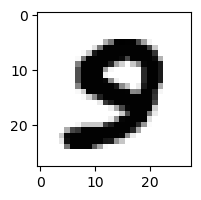

2.174468879181395e-17% - 0
8.908532332552058e-23% - 1
1.8417395081738762e-39% - 2
9.780715119616596e-19% - 3
2.6822136243181883e-17% - 4
0.00013488068120650175% - 5 - ОШИБКА
1.3019115056624373e-25% - 6
1.390189834053811e-08% - 7
1.8025610901874832e-32% - 8
1.2287694115588029e-36% - 9

 3


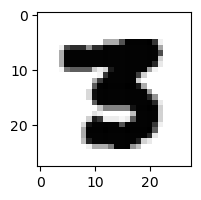

3.868598568966479e-31% - 0
6.165834773653168e-21% - 1
4.985754334625151e-32% - 2
1.7929727894209286e-13% - 3
1.2764147932959922e-27% - 4
6.016720379003453e-06% - 5 - ОШИБКА
1.7363723908559208e-40% - 6
8.837838937645088e-11% - 7
8.111883264028483e-46% - 8
7.247327980553656e-66% - 9

 8


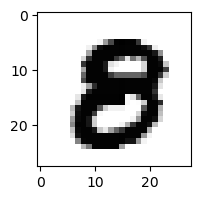

7.820086173337851e-17% - 0
1.1618977689565775e-23% - 1
1.228500429400727e-31% - 2
4.226075440794464e-26% - 3
1.56579057647395e-21% - 4
1.0890736909326164e-07% - 5 - ОШИБКА
1.6209140798086966e-28% - 6
1.473064145494946e-19% - 7
9.116393294430039e-14% - 8
1.0207856299040149e-40% - 9

 9


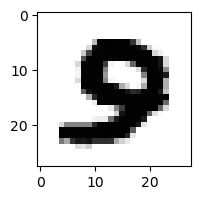

5.659569224726933e-16% - 0
6.846566915097033e-25% - 1
5.604295757657122e-33% - 2
2.353791004021017e-19% - 3
3.7630888280771154e-20% - 4
2.8352485980968908e-08% - 5 - ОШИБКА
4.344491665386396e-25% - 6
7.634415215147926e-11% - 7
1.7528000195753975e-40% - 8
6.122046679195402e-48% - 9

 2


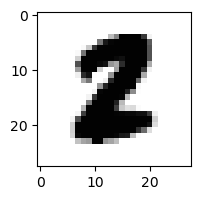

1.5452526239406911e-24% - 0
5.233912532187791e-13% - 1
2.8465848963166265e-10% - 2
1.486023644232023e-33% - 3
2.070047760934406e-37% - 4
2.2611484343874453e-07% - 5 - ОШИБКА
6.377132094464882e-26% - 6
8.046613433350014e-19% - 7
3.1955931699645626e-26% - 8
6.6370721313963656e-52% - 9

 3


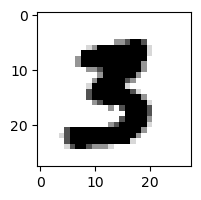

2.4365228055331632e-24% - 0
7.31647316775293e-15% - 1
5.319987670931271e-31% - 2
3.846846991735984e-05% - 3
9.635708995479918e-24% - 4
0.08674910895822371% - 5 - ОШИБКА
1.58808708395941e-33% - 6
5.4209476079110666e-08% - 7
2.4062215197033158e-39% - 8
2.3322679756493913e-44% - 9

 3


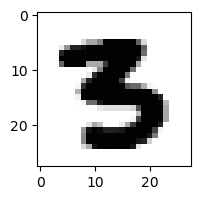

1.3885699821296957e-27% - 0
4.726505258118221e-22% - 1
2.2415444683778317e-34% - 2
1.3923888255219402e-06% - 3
4.823952660168902e-21% - 4
0.0008814516868617857% - 5 - ОШИБКА
5.944478844704681e-33% - 6
1.0464594077279157e-13% - 7
9.439292696023829e-53% - 8
2.592467474906493e-55% - 9

 3


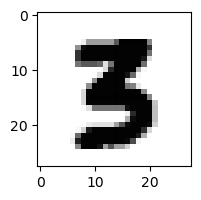

3.364040356946755e-26% - 0
1.2808903349429592e-17% - 1
6.613803503898769e-29% - 2
5.561589378591183e-07% - 3
7.830714568258195e-21% - 4
0.0007351826642437453% - 5 - ОШИБКА
8.354428711690878e-33% - 6
1.5356479764968484e-11% - 7
7.396183818027096e-45% - 8
4.2023487041087417e-51% - 9

 2


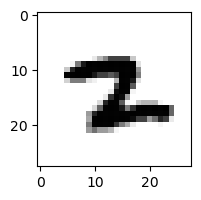

8.500361572874357e-24% - 0
0.00102169366623171% - 1
3.9348086064782165e-15% - 2
9.845410517228848e-32% - 3
2.184149855056118e-18% - 4
2.429252359748941e-05% - 5
1.2789232931723757e-06% - 6
0.17611863005292908% - 7 - ОШИБКА
1.6569348769509204e-24% - 8
1.83924829424587e-24% - 9

 2


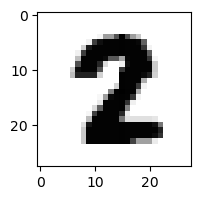

2.0552287369393262e-26% - 0
4.0741168567481086e-14% - 1
4.869490833509108e-11% - 2
1.5125267996361136e-34% - 3
5.526863699301718e-28% - 4
3.174423008835987e-08% - 5 - ОШИБКА
5.285116184460949e-33% - 6
1.6992413061665644e-10% - 7
1.1615014706416254e-22% - 8
5.752422671920814e-48% - 9

 9


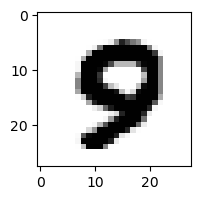

7.384049825480693e-16% - 0
1.3963334131052543e-23% - 1
2.7480061517702756e-33% - 2
1.6659564322604384e-28% - 3
2.6349935989972267e-11% - 4
7.184075030612615e-05% - 5 - ОШИБКА
4.808650323917657e-21% - 6
1.6561169542784098e-06% - 7
4.695352790619318e-31% - 8
1.1682878011167765e-25% - 9

 3


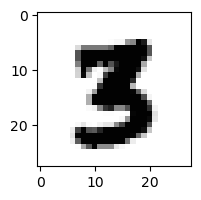

7.468817256388285e-27% - 0
9.608400525839496e-15% - 1
7.806509493505556e-28% - 2
1.4252623642255922e-08% - 3
2.7346579005122926e-23% - 4
0.0008312114705501258% - 5 - ОШИБКА
1.0275486088921726e-32% - 6
1.3544700222831368e-08% - 7
4.126858989762285e-34% - 8
2.3455726249884135e-41% - 9

 9


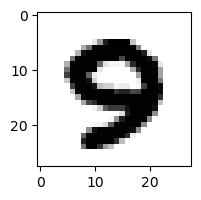

6.092255003293162e-17% - 0
1.6682410448253861e-25% - 1
2.666775111351079e-34% - 2
3.0018665716661732e-24% - 3
6.917276604635094e-15% - 4
2.078554287064158e-09% - 5
3.93626359808717e-24% - 6
3.3849979663890433e-06% - 7 - ОШИБКА
2.3569163750803352e-39% - 8
1.4987326564463633e-36% - 9

 9


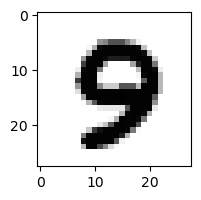

2.342844522638629e-15% - 0
6.078717927767439e-22% - 1
2.3692950220698635e-30% - 2
9.696755672270931e-18% - 3
6.9447914275607056e-12% - 4
4.822177211518711e-06% - 5 - ОШИБКА
4.456020841161015e-19% - 6
1.5833893287154652e-06% - 7
6.254139441846943e-29% - 8
3.501409176932696e-21% - 9

 8


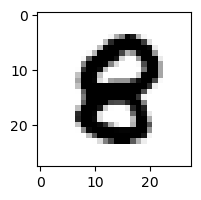

2.7246650722113858e-14% - 0
6.218290873776846e-20% - 1
2.822744411345783e-20% - 2
4.573406288728868e-32% - 3
3.051170740578007e-16% - 4
2.176750027505564e-06% - 5 - ОШИБКА
1.0249413634756798e-18% - 6
1.3456219437840638e-18% - 7
8.898212170867228e-14% - 8
1.6301922020762878e-25% - 9

 3


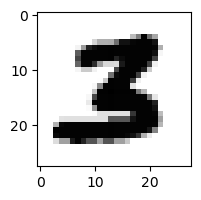

1.3895009047245224e-28% - 0
2.8056023784288794e-15% - 1
9.371136252054006e-14% - 2
6.846072520878243e-07% - 3
5.152619197192497e-31% - 4
8.156764585395011e-06% - 5 - ОШИБКА
5.185671944882393e-36% - 6
6.724716200067931e-16% - 7
1.3895401349404928e-52% - 8
2.6183203582797138e-64% - 9

 8


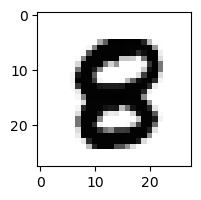

5.65160310725287e-19% - 0
9.50637943141802e-24% - 1
9.449627440837498e-25% - 2
3.225865226599404e-38% - 3
1.7270030970652882e-18% - 4
1.3133427458947731e-06% - 5 - ОШИБКА
3.6859710674645567e-25% - 6
4.184854676297168e-19% - 7
3.633454671230908e-15% - 8
1.2359918502150922e-34% - 9

 8


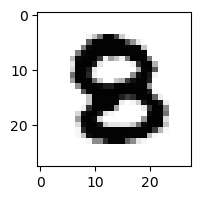

1.4872752055106448e-18% - 0
1.0069651413809035e-21% - 1
1.6797642903833283e-14% - 2
1.523369519309791e-23% - 3
4.5573268329464584e-21% - 4
2.3369878700229398e-07% - 5 - ОШИБКА
2.942466711316675e-22% - 6
3.1248504956542062e-18% - 7
7.168596379857772e-26% - 8
2.84363584680663e-35% - 9

 8


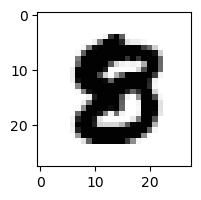

1.4915690645629347e-21% - 0
7.315423143077442e-22% - 1
9.109865474910171e-31% - 2
6.241920325928275e-35% - 3
6.553693678514866e-24% - 4
2.1352245579727317e-06% - 5 - ОШИБКА
3.027794813575622e-28% - 6
1.2233938558763945e-17% - 7
7.648478761035241e-21% - 8
8.770697793093083e-39% - 9

 9


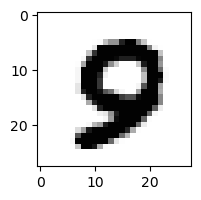

3.842362528984776e-15% - 0
8.718620530728613e-23% - 1
5.916479541055789e-29% - 2
7.727520082159116e-30% - 3
5.696355046503426e-13% - 4
2.9702546503671466e-06% - 5 - ОШИБКА
4.673412333122247e-19% - 6
8.597837570837452e-07% - 7
1.84741201392588e-32% - 8
3.637606976639873e-33% - 9

 3


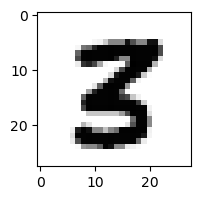

4.559168817900682e-22% - 0
3.811736371972536e-14% - 1
2.683835347158489e-18% - 2
4.632109069455109e-15% - 3
2.0572973015309414e-17% - 4
6.265000492550269e-06% - 5 - ОШИБКА
1.5144101216442478e-38% - 6
3.485638535494815e-12% - 7
1.677575477687644e-24% - 8
1.1241847242894213e-43% - 9

 8


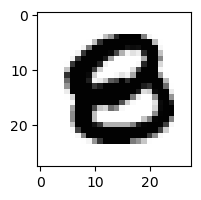

1.4117434238582869e-15% - 0
2.954058242042858e-23% - 1
1.148498333159559e-21% - 2
1.2031209404919745e-41% - 3
5.2807177261725373e-20% - 4
1.8791529568980344e-11% - 5 - ОШИБКА
4.819100836100153e-25% - 6
1.2878026109413936e-25% - 7
2.6669488531137244e-30% - 8
9.315408502338541e-49% - 9

 9


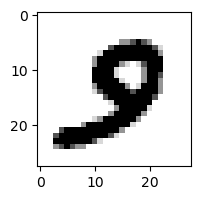

1.8637199631891695e-16% - 0
6.309893537117545e-15% - 1
2.998201954557073e-29% - 2
2.8863728287218525e-16% - 3
3.538445496808045e-19% - 4
1.5590486514452305e-05% - 5 - ОШИБКА
3.5491377375677965e-20% - 6
2.725914019716839e-06% - 7
3.68115342383507e-32% - 8
4.448724994663143e-32% - 9

 9


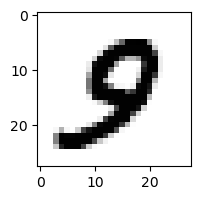

1.0128668089026909e-14% - 0
6.136970522321295e-16% - 1
3.1417732099782222e-21% - 2
1.9733147902628765e-18% - 3
9.709035840173634e-10% - 4
0.0014052856641313903% - 5 - ОШИБКА
2.770635888414133e-16% - 6
8.17760345650576e-05% - 7
5.434936043941966e-26% - 8
1.2790159661345384e-18% - 9

 9


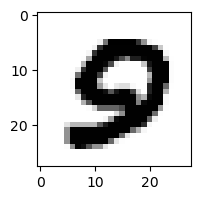

2.316715438959613e-13% - 0
1.172162586085137e-22% - 1
5.244998484078207e-33% - 2
1.3298266836777347e-27% - 3
3.160502742329114e-18% - 4
4.474150493599484e-06% - 5 - ОШИБКА
7.272094299035322e-21% - 6
3.384880489469001e-12% - 7
2.683640086851455e-38% - 8
8.515641978950657e-45% - 9

 9


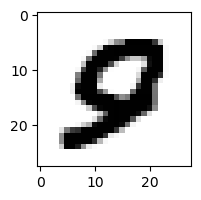

1.182386158699867e-12% - 0
3.1828817338455576e-21% - 1
5.18719123844906e-25% - 2
2.4905259109012298e-40% - 3
1.675942444202383e-11% - 4
4.145296503960691e-05% - 5 - ОШИБКА
1.7641435467066132e-16% - 6
4.201477548879621e-07% - 7
1.7457263148541105e-39% - 8
6.40836742510896e-30% - 9

 3


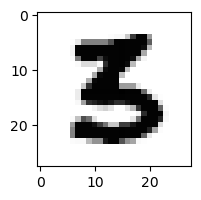

1.926239389465456e-18% - 0
3.0990528276810923e-18% - 1
7.854049332028044e-18% - 2
9.604181956483653e-06% - 3
1.2501267956573496e-24% - 4
1.8118112409846725% - 5 - ОШИБКА
1.7339456279116504e-21% - 6
1.0701784339263541e-18% - 7
2.4249760667388457e-49% - 8
1.3252884725284237e-53% - 9

 8


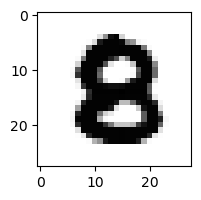

3.720976588259798e-17% - 0
1.8410040489518915e-23% - 1
8.306941371636015e-17% - 2
1.143012472299602e-30% - 3
5.264760242722999e-21% - 4
3.721686514895917e-08% - 5 - ОШИБКА
2.88722968164314e-23% - 6
2.4896073194952183e-19% - 7
6.589083212996527e-26% - 8
6.596456857969504e-35% - 9

 8


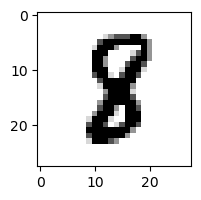

3.185860029443665e-23% - 0
8.437511985672703e-06% - 1
1.0004990714235158e-15% - 2
4.2650793757432393e-19% - 3
4.710893572558517e-15% - 4
0.009482705283218014% - 5 - ОШИБКА
5.651789752303661e-18% - 6
1.678957283248015e-10% - 7
1.6680077265881376e-09% - 8
5.827083834651382e-41% - 9

 3


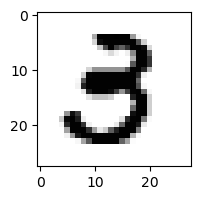

2.1322345198963466e-11% - 0
2.398134929633208e-12% - 1
1.5020131712424162e-26% - 2
4.583007675699575% - 3
9.658197696688759e-15% - 4
13.136184263828724% - 5 - ОШИБКА
2.1447054832741925e-26% - 6
1.1066677686530953e-13% - 7
1.4403509696980235e-30% - 8
3.2469252268736087e-37% - 9

 8


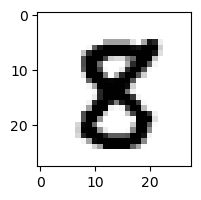

2.7581116676890694e-20% - 0
1.5352228989517813e-14% - 1
8.305027609423895e-25% - 2
5.12263845854819e-20% - 3
2.1149144477641833e-19% - 4
0.007313903414676854% - 5 - ОШИБКА
4.401766303921805e-32% - 6
5.075552754936191e-13% - 7
0.004819129458261125% - 8
5.301071122217565e-31% - 9

 8


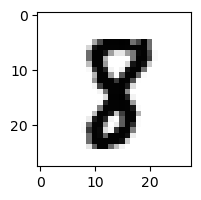

5.26579743311002e-22% - 0
2.2711640562913797e-08% - 1
8.006835910245424e-20% - 2
1.629770472194994e-20% - 3
1.688471233381159e-15% - 4
0.027444804688144107% - 5 - ОШИБКА
3.693296707580288e-23% - 6
2.528748784123366e-09% - 7
0.0018797177054413684% - 8
2.4688112737563276e-38% - 9

 9


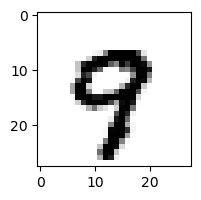

4.168332213765772e-14% - 0
1.3141115575664644e-12% - 1
1.716242730300995e-20% - 2
2.0162535866329793e-25% - 3
2.2378698716837982e-08% - 4
6.568462587591129e-08% - 5
2.0720556104959994e-15% - 6
4.676708227162675% - 7 - ОШИБКА
3.059278153595722e-19% - 8
0.3696551765693883% - 9

 8


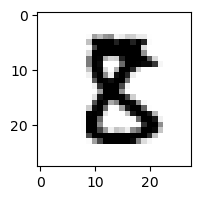

2.821035570103911e-16% - 0
2.5598410740195405e-11% - 1
6.490667578496723e-11% - 2
5.554091623380341e-13% - 3
1.4986905093390045e-22% - 4
0.028455445177693592% - 5 - ОШИБКА
6.774211706642858e-30% - 6
2.2037666647651283e-16% - 7
2.061838265515248e-11% - 8
1.7626153916826454e-33% - 9

 8


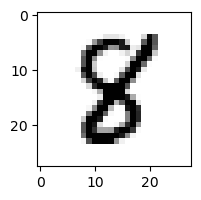

4.3580438727054217e-17% - 0
2.4112454224264907e-08% - 1
4.780371139435276e-16% - 2
3.864312123957746e-16% - 3
5.7459772196910525e-11% - 4
0.023220504644070245% - 5 - ОШИБКА
1.4763382388192365e-18% - 6
3.729967836752492e-11% - 7
1.1979546494905195e-06% - 8
1.562627025873721e-31% - 9

 9


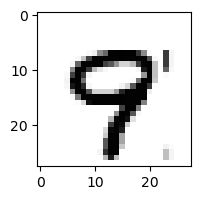

1.8601518872909117e-14% - 0
3.7754946702772344e-17% - 1
1.0774711595800685e-22% - 2
3.9905730275480415e-26% - 3
8.29342733975847e-08% - 4
0.005993813063677549% - 5
7.978175983660117e-16% - 6
6.43506763537141% - 7 - ОШИБКА
1.953774554857399e-19% - 8
0.00651839064068046% - 9

 8


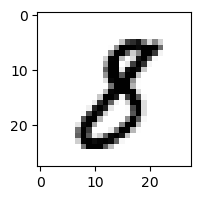

3.277722525574988e-14% - 0
0.0016029139442421882% - 1 - ОШИБКА
3.3796604753476755e-17% - 2
6.532009011011225e-07% - 3
5.800614928172834e-20% - 4
0.0003576929465750592% - 5
4.484314177889066e-21% - 6
2.554110270429596e-07% - 7
1.9532787770400518e-07% - 8
1.3639909414640427e-22% - 9

 3


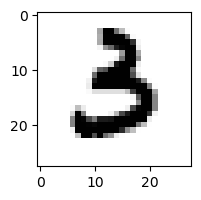

5.0888364472885455e-12% - 0
3.519781502145277e-10% - 1
6.808697514120058e-16% - 2
0.0003035576208526948% - 3
9.009591169627388e-24% - 4
0.5546130607621248% - 5 - ОШИБКА
7.721417112349898e-08% - 6
5.829446065623118e-10% - 7
3.911743294011985e-40% - 8
1.828758553177176e-39% - 9

 8


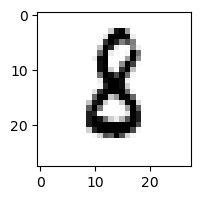

1.7977170131093969e-12% - 0
0.0013080452441450662% - 1
4.7063131611868296e-07% - 2
1.764739990251425e-07% - 3
4.30758547331202e-15% - 4
0.07985146770587052% - 5 - ОШИБКА
0.004343030799901452% - 6
4.803669208574241e-11% - 7
1.0942820923360025e-11% - 8
3.44137699076652e-24% - 9

 8


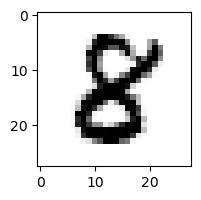

3.821039178107829e-14% - 0
8.214952922216148e-14% - 1
1.4004888463455352e-11% - 2
3.855988186825025e-13% - 3
4.2303953253304384e-12% - 4
0.00042062367276039553% - 5 - ОШИБКА
1.2535055409745356e-23% - 6
2.8618417259524815e-14% - 7
8.776125443145596e-11% - 8
2.817319694390291e-36% - 9

 2


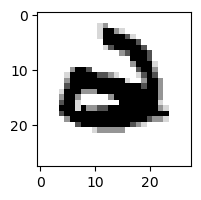

4.9954540459075634e-18% - 0
1.020337791210624e-19% - 1
7.90872923472e-31% - 2
4.149537207219708e-39% - 3
4.000000167232642e-15% - 4
8.572950219724729e-13% - 5
5.168619377141037e-09% - 6 - ОШИБКА
1.7960493145098583e-18% - 7
1.5367115118854275e-47% - 8
1.119371713655835e-37% - 9

 8


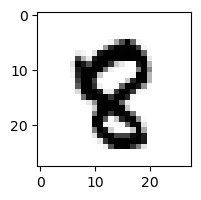

1.0687422541789309e-18% - 0
1.0601828150172383e-13% - 1
3.1835963045444856e-22% - 2
6.849620873348528e-40% - 3
3.5640875795110267e-13% - 4
0.0007187226324064679% - 5 - ОШИБКА
3.387542639902654e-17% - 6
3.106182354104275e-08% - 7
5.01250956452332e-06% - 8
3.677641038051141e-11% - 9

 0


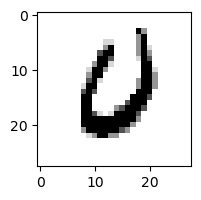

0.4362262718819588% - 0
1.2013367058960067e-15% - 1
9.202487457494742e-08% - 2
2.375021216766763e-25% - 3
3.088719936310655e-07% - 4
4.8286795703788725e-05% - 5
80.48042586647554% - 6 - ОШИБКА
0.0006055788543666251% - 7
2.6364063168841394e-20% - 8
6.688449966405071e-18% - 9

 2


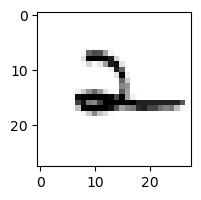

1.2876548585224218e-08% - 0
0.035794627238903545% - 1
99.99626237372642% - 2
6.7864169684214885e-09% - 3
99.99694324848932% - 4 - ОШИБКА
5.391654958212117e-07% - 5
10.481957860703742% - 6
5.831018628024546% - 7
2.0640427895449478e-10% - 8
0.07882333711029156% - 9

 3


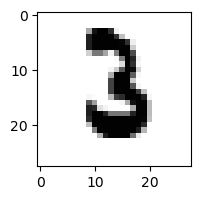

2.642464453224462e-19% - 0
1.3497202658308746e-06% - 1
0.008294834843794497% - 2 - ОШИБКА
1.719451116360121e-08% - 3
1.389854729269899e-23% - 4
6.47644606233474e-08% - 5
5.506085978135579e-07% - 6
6.054050930629096e-10% - 7
7.62169626584605e-35% - 8
3.1477387876947095e-34% - 9

 6


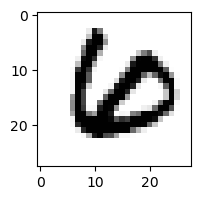

3.211057514301677e-17% - 0
2.3765596716738575e-14% - 1
1.5631505032962932e-11% - 2
1.865460694398243e-26% - 3
3.469165598842327e-22% - 4
1.9446426954912127e-17% - 5
2.002689505118307e-13% - 6
1.6473711771270912e-11% - 7 - ОШИБКА
9.630595926950671e-23% - 8
4.944587507532387e-44% - 9

 0


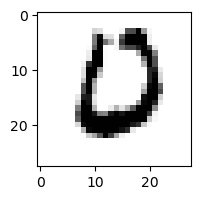

0.01907208768059954% - 0
2.700085473339471e-16% - 1
0.00042579708680957114% - 2
1.4296184265055346e-28% - 3
1.3467021502014767e-13% - 4
2.572570466457811e-06% - 5
99.0745349546668% - 6 - ОШИБКА
2.6655843787750513e-09% - 7
9.130694138610236e-28% - 8
2.5448359245271663e-42% - 9

 0


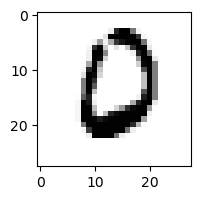

0.024855673097482586% - 0
1.6863572272632096e-15% - 1
6.52622385800275e-06% - 2
9.583065719142783e-24% - 3
9.400035782876546e-12% - 4
0.00035220855877101927% - 5
3.152040334575291% - 6 - ОШИБКА
1.7915222994237695e-06% - 7
2.8965919982150846e-24% - 8
3.440991234168969e-36% - 9

 3


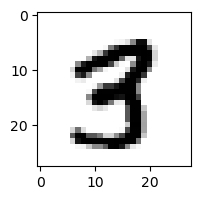

1.9542870930485927e-17% - 0
7.007493297545311e-13% - 1
9.047554962617878e-20% - 2
2.8988160500148857e-08% - 3
9.129828467230958e-14% - 4
0.01572492662059763% - 5 - ОШИБКА
6.016555908452675e-28% - 6
2.607571703558464e-06% - 7
1.092868899075305e-08% - 8
7.314311627214129e-13% - 9

 9


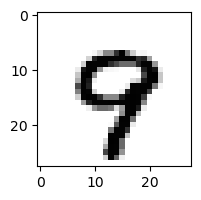

2.883740719303581e-13% - 0
4.2295143205279824e-16% - 1
2.2711308057484445e-21% - 2
1.2633843666385731e-27% - 3
5.453212157736277e-06% - 4
9.454039994812558e-09% - 5
2.873386047617542e-12% - 6
16.68999824502073% - 7 - ОШИБКА
3.1730041973612647e-17% - 8
1.3354192192487062% - 9

 3


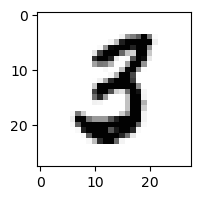

7.644886315147247e-09% - 0
8.585013263115024e-10% - 1
3.377801846349202e-09% - 2
0.0014505967493457898% - 3
1.3520687315093008e-18% - 4
13.3300387460363% - 5 - ОШИБКА
5.654746035721652e-15% - 6
5.622354285807467e-11% - 7
1.189780142086029e-22% - 8
3.290542324067608e-31% - 9

 3


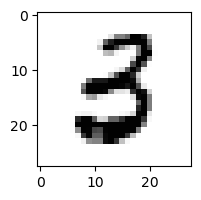

7.069680586589823e-08% - 0
8.682059298815228e-09% - 1
7.937852489453343e-18% - 2
3.8151957902721674% - 3
2.555132394208742e-13% - 4
30.502315255140854% - 5 - ОШИБКА
6.757337115862043e-11% - 6
1.0236183627376346e-13% - 7
5.783139424069828e-31% - 8
3.4290609671286145e-42% - 9

 3


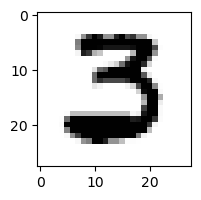

2.854007880043739e-08% - 0
2.4858947034766477e-13% - 1
1.3382689239199822e-09% - 2
8.117421434547538e-05% - 3
1.2415324479802547e-31% - 4
0.023649692845626607% - 5 - ОШИБКА
1.1992974456048367e-20% - 6
5.6260393737529275e-14% - 7
2.2472038971141133e-40% - 8
4.168515425967061e-68% - 9

 3


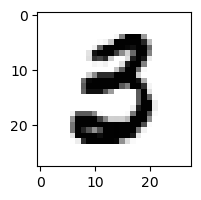

4.366061140109123e-06% - 0
1.884230208805653e-12% - 1
8.230249078985145e-24% - 2
0.002048447873116243% - 3
9.792217102773667e-23% - 4
59.00089901264056% - 5 - ОШИБКА
1.883249534089981e-17% - 6
2.3082591245259877e-13% - 7
7.573143568981471e-32% - 8
1.9039849950601934e-45% - 9

 8


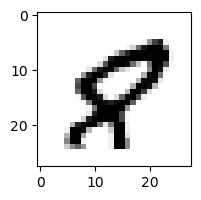

6.400038082907483e-11% - 0
1.4525220082300992e-11% - 1
1.4422616679558e-25% - 2
8.460365263104618e-45% - 3
7.662009305142724e-10% - 4
0.0009285502524126113% - 5 - ОШИБКА
6.873225235140438e-17% - 6
0.00019503750076440662% - 7
4.215969815235649e-23% - 8
2.4665382900165497e-22% - 9

 3


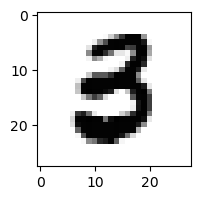

1.886733940699998e-09% - 0
2.5238443131432142e-14% - 1
7.396434002629391e-24% - 2
4.200515692048241e-07% - 3
5.02305727274644e-20% - 4
49.96306214438865% - 5 - ОШИБКА
4.3125620819713575e-15% - 6
6.566406326100242e-15% - 7
5.2124536474856116e-40% - 8
1.0889028936570533e-48% - 9

 9


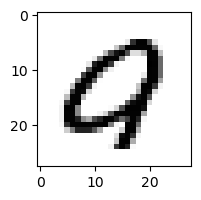

0.012084378538778202% - 0
3.0003837602836154e-17% - 1
3.7902151518643114e-15% - 2
5.602395946290546e-32% - 3
2.982420718866578e-12% - 4
0.012685354572674773% - 5 - ОШИБКА
4.5548126121986174e-12% - 6
1.8108906412804444e-07% - 7
3.0163691339289826e-26% - 8
3.6139814204838816e-26% - 9

 9


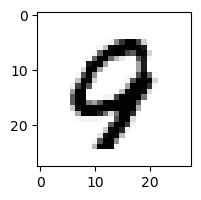

1.703779409915451e-11% - 0
2.7636017287355746e-14% - 1
6.1712560481730685e-12% - 2
1.0600164468462403e-37% - 3
0.0006782203561897032% - 4 - ОШИБКА
5.671371794979398e-11% - 5
1.3511027630023794e-08% - 6
2.2834834661807523e-05% - 7
1.2238981598871095e-07% - 8
6.176480803198681e-08% - 9

 3


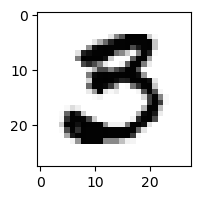

0.0003611741408954888% - 0
4.243231641966915e-15% - 1
3.5915297450104735e-18% - 2
1.7272693322698918% - 3
6.60106558782154e-26% - 4
71.26180553251268% - 5 - ОШИБКА
2.0778644443181044e-24% - 6
2.323156031752366e-12% - 7
1.4716485025215041e-30% - 8
4.1951958642855227e-54% - 9

 9


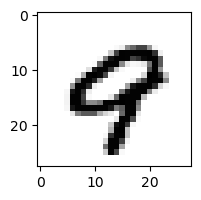

1.526898254731981e-10% - 0
1.2689002683348165e-15% - 1
3.682714473425728e-27% - 2
2.0565139270190172e-40% - 3
0.0002913808788083861% - 4
1.7047245636064253e-13% - 5
5.414073485711094e-13% - 6
0.10487908223633599% - 7 - ОШИБКА
2.0973116590446164e-14% - 8
0.0003483525589218034% - 9

 3


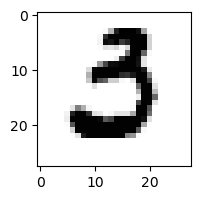

2.7288784773307703e-05% - 0
2.0613466618211816e-12% - 1
4.5387885845016167e-13% - 2
1.528003951935621e-14% - 3
9.075380792364504e-28% - 4
0.000593420063977286% - 5 - ОШИБКА
2.002301784759562e-09% - 6
1.3900218808284806e-07% - 7
4.654273072767566e-37% - 8
2.923855595312381e-50% - 9

 8


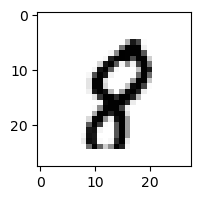

3.9376229639162175e-14% - 0
9.316253588248085e-09% - 1
1.5179330633926054e-15% - 2
2.2952271297053627e-25% - 3
3.365230973115591e-08% - 4
1.3091036047374516e-05% - 5
7.036900916916861e-10% - 6
0.0008051316949161587% - 7 - ОШИБКА
3.3092059706037463e-06% - 8
1.8840558356941443e-09% - 9

 5


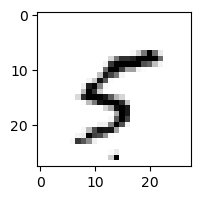

0.0002791468732464269% - 0
0.0036112167021363694% - 1
8.345142486254518e-09% - 2
9.54940075051748e-07% - 3
3.566787486900864% - 4 - ОШИБКА
1.7048943779672618% - 5
1.0258666112358516e-10% - 6
1.2601485633693201% - 7
3.516772430584486e-17% - 8
3.030469411563034e-11% - 9

 0


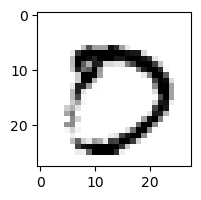

0.6282077284715288% - 0
1.128099337799309e-18% - 1
8.259602390964582e-23% - 2
1.805935209869503e-08% - 3
3.8249578149533774e-19% - 4
2.229416122551309e-11% - 5
1.8156807828488964e-20% - 6
9.826618979284083% - 7 - ОШИБКА
1.1732898150396879e-12% - 8
4.619798624905366e-15% - 9

 8


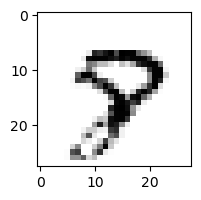

3.640145652110565e-13% - 0
4.768222166977831e-13% - 1
3.1967954426503674e-23% - 2
7.048175109129688e-21% - 3
2.9244751340569795e-07% - 4
1.4599844620483024e-06% - 5
9.078289217943018e-14% - 6
3.8086042194084326% - 7 - ОШИБКА
1.0033687358054428e-15% - 8
6.205632373660672e-09% - 9

 9


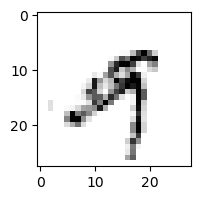

8.564100028909044e-09% - 0
0.0011352956201789806% - 1
1.1165335293457344e-07% - 2
0.029625278972300217% - 3 - ОШИБКА
0.001039707901313854% - 4
0.0014071987366550852% - 5
8.870700604294081e-11% - 6
0.00036362862481297096% - 7
5.625877009501798e-14% - 8
0.004622016523204662% - 9

 7


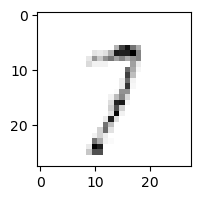

0.09167120615405105% - 0
3.98338559969514% - 1
98.96763189686094% - 2
97.77575668850022% - 3
0.014409170096295928% - 4
0.15713568915519535% - 5
0.021451925438110007% - 6
98.43184549256213% - 7
35.18463449436645% - 8
99.99999356098232% - 9 - ОШИБКА

 3


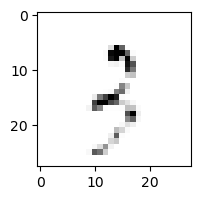

0.005096183306740515% - 0
4.901173590959628% - 1
99.98619900484788% - 2
99.81900561813323% - 3
0.0071305741681607785% - 4
0.0496603393772552% - 5
0.13565253604412877% - 6
4.434392103309489% - 7
99.74601080086995% - 8
99.99999999974938% - 9 - ОШИБКА

 1


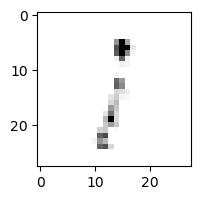

25.2950954622079% - 0
96.23288960346407% - 1
99.96440724881157% - 2
99.22369382681323% - 3
0.41860159433439353% - 4
3.6425554186185405% - 5
88.4900323592125% - 6
0.6687657806459204% - 7
99.99983767307678% - 8 - ОШИБКА
99.99913081312873% - 9

 2


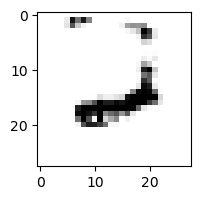

2.3720614062421155e-07% - 0
5.769280230019383e-06% - 1
99.86151269861006% - 2
8.910063163207187e-20% - 3
99.95635532180412% - 4
3.7754585152516546e-10% - 5
99.9998250177482% - 6 - ОШИБКА
0.4629949569809026% - 7
2.2508134821687274e-05% - 8
5.660159309163177e-06% - 9

 7


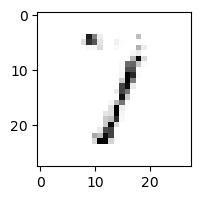

0.00472806012656031% - 0
91.51517950577326% - 1
99.56145174526114% - 2
99.64633614366592% - 3 - ОШИБКА
95.03644629710412% - 4
0.022028908777722768% - 5
0.02132105828104358% - 6
93.66741060658555% - 7
98.7858398983419% - 8
0.5559384928685034% - 9

 7


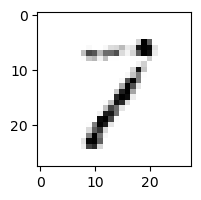

4.6000558601443394e-05% - 0
43.193996236097746% - 1 - ОШИБКА
15.870742225959642% - 2
0.0007352267848854582% - 3
0.03008986178688077% - 4
0.05226026135213438% - 5
0.2105715136236501% - 6
19.859085988290694% - 7
29.41874340680351% - 8
0.00014125875989182498% - 9

 0


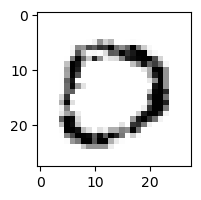

99.99987398619574% - 0
1.4419992144500545e-12% - 1
9.641152565052396e-10% - 2
99.9998997099743% - 3 - ОШИБКА
1.620887052018183e-18% - 4
1.7023900623365689e-07% - 5
1.050959531752899e-17% - 6
0.002288741356058031% - 7
4.7061294646109384e-15% - 8
3.32696195036322e-24% - 9

 0


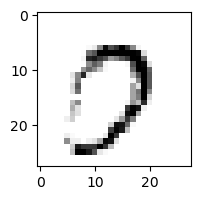

0.39139912474665556% - 0
4.52869697005728e-13% - 1
6.772032186223683e-10% - 2
0.4834044618317481% - 3
7.832789144959001e-11% - 4
0.0007902831626648367% - 5
1.8344537102806892e-11% - 6
99.95819298144956% - 7 - ОШИБКА
4.01473046864776e-09% - 8
24.766954656636024% - 9

 5


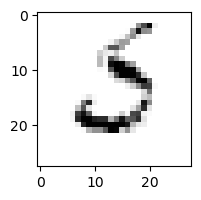

0.14896418981161455% - 0
0.021723599271767695% - 1
78.51333768786833% - 2
0.052042539637692425% - 3
9.111924048338813e-14% - 4
0.00028664769558868676% - 5
99.28377865826504% - 6 - ОШИБКА
0.7478708036531665% - 7
9.258814289501512e-17% - 8
1.0000316669944907e-16% - 9

 8


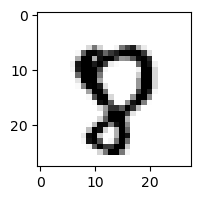

1.5380860871641089e-13% - 0
3.183833824154363e-20% - 1
7.852219875858958e-25% - 2
1.1059635275220385e-30% - 3
4.2144943570092234e-09% - 4
0.09357549819660377% - 5
1.6422314738060706e-14% - 6
26.613884660267505% - 7 - ОШИБКА
2.0647696971856248e-17% - 8
1.4201893688973168e-08% - 9

 5


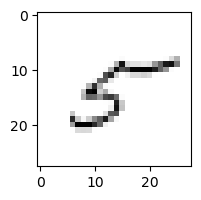

28.054718076937164% - 0 - ОШИБКА
0.37572797782535944% - 1
5.253837168844066% - 2
0.05132061910759134% - 3
1.4622338792187417% - 4
10.314138282699398% - 5
0.016095420882776254% - 6
0.36376794854223676% - 7
0.020648049595801826% - 8
7.747904438705815e-07% - 9

 8


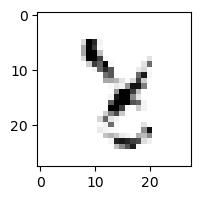

2.9101139446006563e-13% - 0
0.00573079834927185% - 1
0.00023702722924761599% - 2
6.35512523266018e-09% - 3
85.88363710856484% - 4 - ОШИБКА
0.009118341331624947% - 5
5.248342660999388e-05% - 6
68.55286881983541% - 7
27.192729642975966% - 8
8.379184341332959e-10% - 9

 9


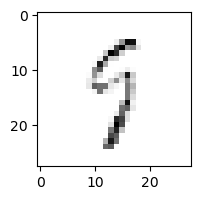

0.03212533555504114% - 0
0.25908344146172624% - 1
2.0183666435766017% - 2
2.7077393695349667% - 3
16.028649670304176% - 4
10.431377522336833% - 5
4.0088528138920925% - 6
0.7008443552798361% - 7
99.98190423359516% - 8 - ОШИБКА
68.73515058336301% - 9

 8


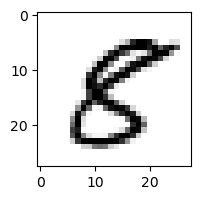

1.1335963617803156e-09% - 0
6.598837357073815e-10% - 1
5.993922751653765e-20% - 2
2.798001542771435e-18% - 3
7.333612628784564e-07% - 4
95.90160191834276% - 5 - ОШИБКА
1.810318316141252e-26% - 6
1.4903195603910255e-12% - 7
3.0714375794293316e-13% - 8
1.8204563321062638e-25% - 9

 9


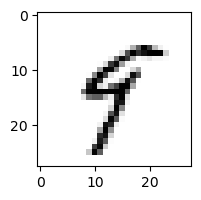

1.636501515424932e-09% - 0
0.014188557676634241% - 1
7.693378786328486e-14% - 2
1.9514108038370554e-09% - 3
17.420457342519956% - 4 - ОШИБКА
2.8072681414534824% - 5
8.988578936331236e-05% - 6
0.023889284334713663% - 7
5.104206501787729e-10% - 8
0.7003364529619208% - 9

 0


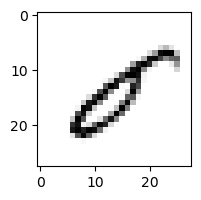

0.0015732238449288748% - 0
0.013198208008235587% - 1
62.693354395200416% - 2 - ОШИБКА
2.086510834383683e-05% - 3
0.2951621069969235% - 4
2.3330899477698392% - 5
6.49462079881606e-11% - 6
3.0337024481792375e-06% - 7
0.001282635999988333% - 8
5.5830842933279364e-11% - 9

 1


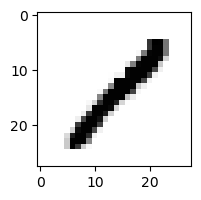

6.734017673667387e-12% - 0
83.44180661510464% - 1
9.41408645719334e-06% - 2
9.256309854373852e-10% - 3
1.800303200324423e-05% - 4
2.49449849576911e-07% - 5
3.652309733483147e-15% - 6
0.0001756133193340706% - 7
99.96544400258539% - 8 - ОШИБКА
1.1968830856522118e-13% - 9

 7


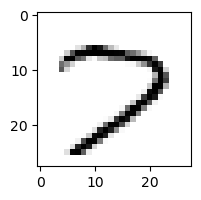

8.701870835352938% - 0
1.615453261914171e-11% - 1
9.060359005284387e-08% - 2
99.99604649056279% - 3 - ОШИБКА
2.9767645524118052e-08% - 4
7.189780959906899e-07% - 5
3.5241126528757796e-07% - 6
99.99394360592% - 7
1.7358248282420992e-11% - 8
1.5584819028147684e-15% - 9

 1


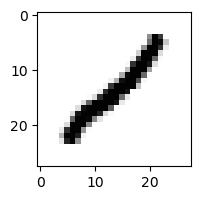

7.824762578220795e-09% - 0
92.93763668139218% - 1
94.96793849346348% - 2
5.157179586111291e-07% - 3
0.010924228011315294% - 4
6.821263311836984e-07% - 5
3.6315193048447107e-12% - 6
1.4322896483108283e-07% - 7
99.87520652015313% - 8 - ОШИБКА
1.2681646158784376e-06% - 9

 9


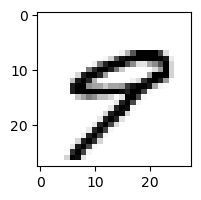

8.388007633496223e-08% - 0
3.608439654600699e-10% - 1
2.1821540643147908e-29% - 2
2.2942321747349444e-28% - 3
0.013764936428673687% - 4
0.00014430110494519663% - 5
1.3603909425619045e-14% - 6
0.022509490556515754% - 7 - ОШИБКА
1.7998403580264615e-20% - 8
2.6555102633888183e-05% - 9

 1


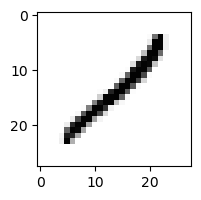

1.3467021683712088e-06% - 0
97.43212639417892% - 1
99.79697754470429% - 2
0.0008167438108479486% - 3
0.14818531552012484% - 4
1.953944532458562e-05% - 5
1.3076366279784176e-08% - 6
0.0013146020561961213% - 7
99.99999999848409% - 8 - ОШИБКА
0.014185028423992972% - 9

 9


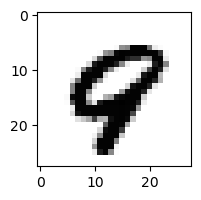

2.469157862779621e-14% - 0
1.3777907857111527e-18% - 1
5.115236167374709e-26% - 2
1.90898545206296e-53% - 3
7.540337858450427e-09% - 4
1.428160637706238e-11% - 5
1.9563327712023844e-13% - 6
0.0004161439858896208% - 7 - ОШИБКА
1.0265813374015967e-14% - 8
2.1261323494197167e-10% - 9

 5


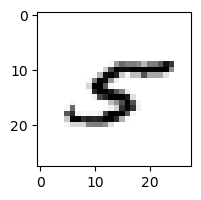

4.339328575913517e-08% - 0
0.00026688049108121236% - 1
1.947355676116473e-07% - 2
6.813306089329351e-10% - 3
0.028001356174897938% - 4 - ОШИБКА
0.0003526576293094201% - 5
1.1296521211277524e-07% - 6
0.0036446335604199895% - 7
7.912470700833784e-07% - 8
3.1217014675327176e-15% - 9

 9


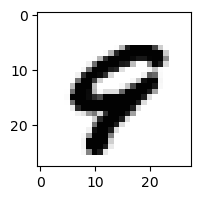

4.377390671739294e-14% - 0
9.079321529961038e-17% - 1
7.763888654372644e-29% - 2
2.4529396039985422e-49% - 3
1.1858290000591611e-06% - 4
9.038338581551282e-07% - 5
4.442724767629433e-15% - 6
5.1224318666907765e-05% - 7 - ОШИБКА
3.307259940722222e-28% - 8
1.019760560520085e-12% - 9

 2


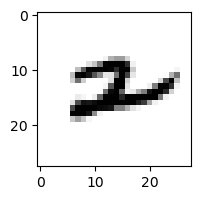

5.928137311121843e-15% - 0
0.008834082543219515% - 1
1.4258327753366174e-14% - 2
9.333433980078776e-25% - 3
70.5571690387924% - 4 - ОШИБКА
1.751822893449417e-11% - 5
0.0006686678408108822% - 6
0.0054666764572538235% - 7
9.40651408911165e-16% - 8
0.002005635663625368% - 9

 3


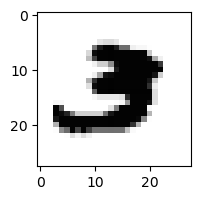

1.3355757761679944e-17% - 0
3.5181793698497784e-15% - 1
5.235895561673706e-18% - 2
2.52350204313056e-08% - 3
4.139557130618274e-26% - 4
1.8703605626589404e-09% - 5
3.725815593473242e-24% - 6
1.9186816055337286e-06% - 7 - ОШИБКА
1.2894274917801032e-41% - 8
1.5730228998947088e-30% - 9

 3


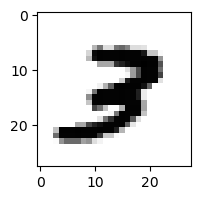

1.5423066007992444e-14% - 0
3.474814627526245e-12% - 1
1.122816464570632e-07% - 2
2.9706216211411348e-08% - 3
1.3380197488550931e-18% - 4
1.0597802749228017e-11% - 5
1.4109682144276552e-20% - 6
0.0004995406820206504% - 7 - ОШИБКА
2.6913244674094467e-22% - 8
5.496422791060501e-13% - 9

 9


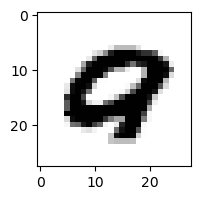

6.457124199107155e-10% - 0
2.311367440202205e-21% - 1
1.9276779004635855e-26% - 2
7.751329435913054e-55% - 3
5.3353916179352755e-15% - 4
1.7734895447366802e-14% - 5
4.796311507803399e-19% - 6
7.239355819533633e-07% - 7 - ОШИБКА
3.695811450101965e-32% - 8
2.537896595992555e-28% - 9

 2


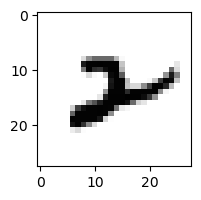

2.3902926431069747e-17% - 0
0.007218698940248953% - 1
2.716245089922017e-06% - 2
1.4718265330046364e-28% - 3
2.5991484836363523e-07% - 4
5.095817931426771e-11% - 5
0.261718752446675% - 6
9.513419919482469e-08% - 7
0.7966266368442018% - 8 - ОШИБКА
1.2899209616749381e-11% - 9

 3


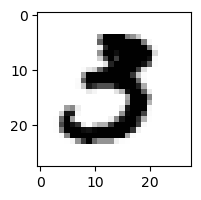

5.119664515381911e-12% - 0
2.6691236805536147e-13% - 1
1.8162347895799578e-27% - 2
0.004029585921721476% - 3
1.8521486635153258e-25% - 4
0.12005633789141884% - 5 - ОШИБКА
2.017987609199656e-30% - 6
1.247134108313325e-08% - 7
6.523972612569152e-47% - 8
3.9395850592885205e-37% - 9

 5


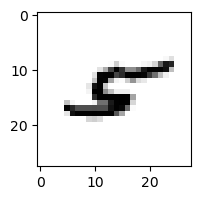

6.590364805476835e-10% - 0
0.003991844869381328% - 1
9.030486250358672e-07% - 2
1.8114281312347152e-19% - 3
99.95384383677576% - 4 - ОШИБКА
4.3686992139412443e-10% - 5
0.00013174581655948903% - 6
0.021647213565289702% - 7
99.94228647035119% - 8
0.00014510990777212628% - 9

 9


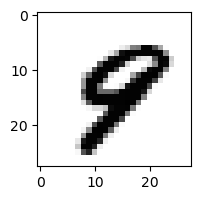

1.1830349776263352e-16% - 0
1.180013234813936e-13% - 1
2.318247739819021e-27% - 2
2.7946792019795374e-34% - 3
5.253220510726484e-05% - 4
9.368913610943435e-06% - 5
4.193894820354663e-14% - 6
0.00393100832772276% - 7 - ОШИБКА
8.294751974555614e-21% - 8
5.455554584229125e-10% - 9

 6


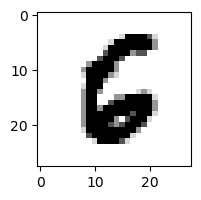

6.874922245466255e-12% - 0
1.0695916786174192e-16% - 1
1.51272333698175e-16% - 2
5.774551701440064e-42% - 3
3.575110818285862e-15% - 4
1.1148258808738096% - 5 - ОШИБКА
0.010147595057472328% - 6
1.5586996531642805e-11% - 7
1.0947717178471062e-31% - 8
1.977180901100592e-39% - 9

 8


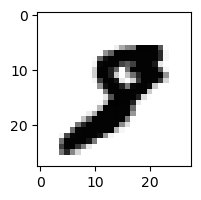

3.0655724554748948e-18% - 0
2.3505588158835447e-09% - 1
4.75130147471959e-24% - 2
2.4017847340939968e-26% - 3
2.5450725898724072e-21% - 4
1.248002507238064e-13% - 5
7.084845027772517e-24% - 6
0.0021481992182381168% - 7 - ОШИБКА
3.8578230147078796e-20% - 8
1.1009719038664563e-24% - 9

 7


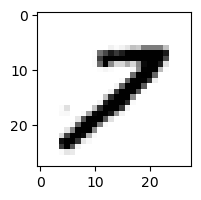

5.808933710992586e-10% - 0
0.0005204310775748142% - 1
0.06079682353106932% - 2
5.974747269729018e-17% - 3
8.306967297058317e-14% - 4
3.131736158676392e-09% - 5
6.621422756531501e-18% - 6
5.830111001259762% - 7
10.595732851434368% - 8 - ОШИБКА
2.8763613836376063e-08% - 9

 4


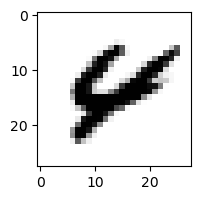

5.712310556732176e-12% - 0
1.497330756264423e-13% - 1
2.14547340821036e-18% - 2
1.815706906195765e-42% - 3
0.0002745103074201006% - 4
1.7023717279934694e-08% - 5
1.816433008046824e-07% - 6
2.2489902826249408e-07% - 7
0.0008057587405727174% - 8
0.40333903724761244% - 9 - ОШИБКА

 9


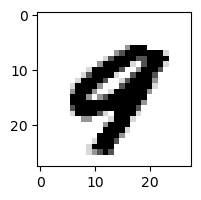

8.579108961356287e-19% - 0
2.101820132784109e-19% - 1
1.1383637290176943e-35% - 2
1.4154553862830005e-45% - 3
6.701907106536597e-06% - 4
4.198383274300079e-12% - 5
1.094939350324243e-18% - 6
0.003010673762857936% - 7 - ОШИБКА
2.1432223784893216e-23% - 8
4.239121175868926e-15% - 9

 5


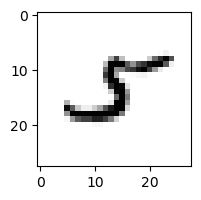

8.145547960387465e-10% - 0
9.721733036492077% - 1
0.0027258758167042468% - 2
8.171464900859855e-18% - 3
7.044148077212156e-06% - 4
6.588414376736917e-05% - 5
3.802969806069646e-09% - 6
0.03854624807249454% - 7
96.61231439201488% - 8 - ОШИБКА
1.142872651187563e-11% - 9

 6


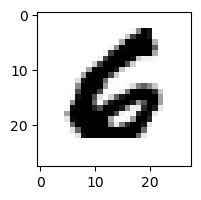

1.7783822371435777e-10% - 0
1.521895654139393e-18% - 1
1.3138986466438075e-18% - 2
6.680266801066265e-44% - 3
2.948928903255881e-15% - 4
0.00026906885074885176% - 5 - ОШИБКА
0.00017342501272329887% - 6
4.739734786577964e-15% - 7
1.0691678752656757e-52% - 8
2.575546787188136e-42% - 9

 9


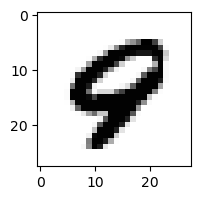

6.721811221996261e-14% - 0
3.146889468251673e-17% - 1
6.334353449744006e-28% - 2
6.031274101620755e-54% - 3
0.0005683655566105052% - 4 - ОШИБКА
5.026694282335086e-10% - 5
6.046141302112043e-11% - 6
1.3750494293973852e-07% - 7
9.923140225730517e-22% - 8
2.6242548575437574e-12% - 9

 2


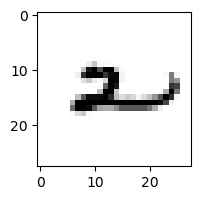

1.1760004843828412e-06% - 0
0.004817299245085023% - 1
3.338457435573046e-09% - 2
4.2583635410378e-11% - 3
99.99991310732604% - 4 - ОШИБКА
5.621780012598346e-05% - 5
95.02359662495203% - 6
3.644738600469515e-06% - 7
4.718006132930508e-06% - 8
0.6815812850001534% - 9

 9


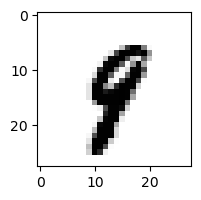

1.448671942424301e-18% - 0
3.291238106273531e-05% - 1
1.0615994585386855e-19% - 2
6.692351246491746e-17% - 3
1.8936012993330734e-07% - 4
0.00012260661896821532% - 5
7.616038671669476e-12% - 6
0.0028468396736366745% - 7 - ОШИБКА
3.950313279492177e-12% - 8
0.0008544561230095341% - 9

 9


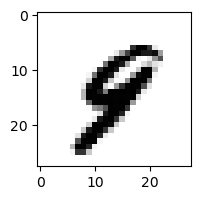

2.0566707635569773e-16% - 0
4.537870893264064e-07% - 1
2.0696008605905375e-20% - 2
1.994343911356375e-24% - 3
0.00016840328385122754% - 4
1.7104978415520938e-06% - 5
2.9442588348658523e-08% - 6
0.0006908387301502178% - 7 - ОШИБКА
1.1675911490545205e-20% - 8
4.336793565061824e-07% - 9

 2


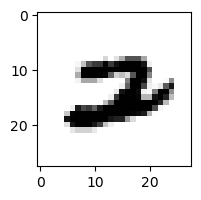

2.0736620425435417e-14% - 0
4.7063635664583834e-11% - 1
3.2493221160846358e-12% - 2
7.543244223842055e-34% - 3
1.669317663023358e-11% - 4
1.3167988223319653e-13% - 5
1.6721747632074156e-07% - 6
7.292018310266463% - 7 - ОШИБКА
3.1874474157471712e-24% - 8
2.5104552901920158e-26% - 9

 9


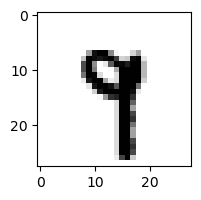

4.805543397991508e-22% - 0
7.240051919216548e-06% - 1
4.3906553969144436e-23% - 2
7.722908824528735e-12% - 3
5.2225514198641926e-05% - 4
6.14558646872581e-05% - 5
4.6674181136360366e-17% - 6
29.33185751002882% - 7 - ОШИБКА
5.528581831083448e-16% - 8
3.115007861307925e-07% - 9

 9


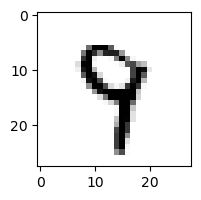

1.1859613912538235e-14% - 0
2.492490174546766e-09% - 1
1.4238554894581465e-13% - 2
2.974478824286617e-09% - 3
6.14694372758079% - 4 - ОШИБКА
0.002307378352238552% - 5
1.2259427646818384e-07% - 6
3.8879380989559365% - 7
3.786354279709123e-06% - 8
0.0026385875448365226% - 9

 0


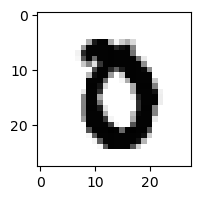

2.1001105305403626e-05% - 0
1.7159427522736244e-22% - 1
1.267275270224215e-20% - 2
4.866134671663359e-20% - 3
1.1955697368378211e-21% - 4
9.15744205631041e-08% - 5
1.5389023983867747e-15% - 6
2.425393381085596e-05% - 7 - ОШИБКА
1.415700205714853e-29% - 8
2.421472603047488e-33% - 9

 8


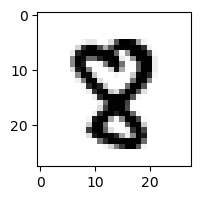

2.1945733397171742e-20% - 0
2.28738527119639e-14% - 1
1.4635549129725663e-17% - 2
1.583350670405412e-27% - 3
1.746895243763707e-14% - 4
1.2345212445166738e-06% - 5
1.0423922580529287e-22% - 6
1.6400415199440785e-06% - 7 - ОШИБКА
1.107263264758057e-09% - 8
2.2323353286832996e-30% - 9

 9


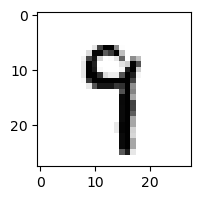

9.639550698014227e-15% - 0
0.00010380129426755033% - 1
1.6042871513779887e-17% - 2
0.00010209452436462194% - 3
0.682718498458771% - 4
0.3790646874687829% - 5
4.052130505375268e-10% - 6
4.43965759695703% - 7 - ОШИБКА
4.277521180817521e-06% - 8
0.04419056337325507% - 9

 8


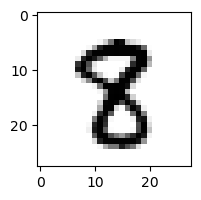

1.0568876168613477e-20% - 0
2.860065270789209e-09% - 1
1.852990406417508e-21% - 2
1.3093530507067384e-13% - 3
2.335609083442457e-13% - 4
0.007213094322999957% - 5 - ОШИБКА
2.4825238353852946e-24% - 6
8.062383971631161e-07% - 7
9.923959987418176e-05% - 8
1.147345599659875e-21% - 9

 8


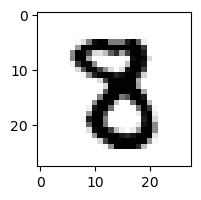

2.672515113663415e-23% - 0
1.2739533061463433e-12% - 1
1.5248960662534063e-18% - 2
1.375420707521468e-15% - 3
1.4224980647954096e-18% - 4
1.1297436224721208e-05% - 5 - ОШИБКА
1.2200087391916644e-25% - 6
6.804636992203494e-11% - 7
4.679853744292303e-11% - 8
2.1562913834765503e-36% - 9

 6


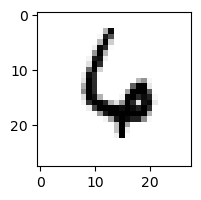

4.119032601680071e-14% - 0
6.9352272554779575e-09% - 1
0.0012947412900268206% - 2
2.524688958271135e-22% - 3
99.66180005477462% - 4 - ОШИБКА
0.05690844004477564% - 5
99.6185067840962% - 6
0.030376893222585077% - 7
4.766221996253666e-22% - 8
3.0164257725267635e-09% - 9

 4


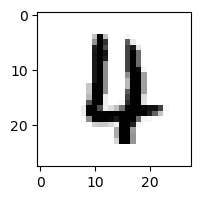

1.7262599193760945e-10% - 0
4.4298724084731e-13% - 1
0.00017282822379289587% - 2
7.872230064881897e-25% - 3
2.533678119687275e-07% - 4
7.416279794984944e-05% - 5
0.0003922016834710927% - 6 - ОШИБКА
0.0001970154592201717% - 7
1.7157549695131065e-23% - 8
6.1210613156556e-20% - 9

 0


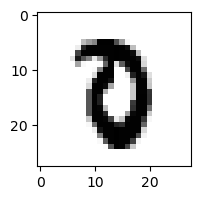

5.1546804092024983e-08% - 0
3.085401875284171e-20% - 1
4.44950980901971e-16% - 2
5.0609085336049814e-15% - 3
8.494023088564038e-19% - 4
0.00026662736533188906% - 5 - ОШИБКА
3.8168770327647165e-10% - 6
6.463720378503242e-06% - 7
4.274976394385783e-25% - 8
5.5958735327292845e-30% - 9

 9


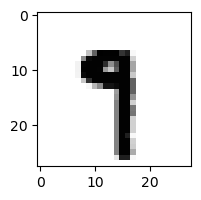

3.2314645956977985e-22% - 0
1.2317430863123389e-05% - 1
5.868631385894251e-28% - 2
1.3580195734156026e-17% - 3
8.800457827005994e-11% - 4
0.21353425465139939% - 5
5.713991820657215e-14% - 6
33.05916489882074% - 7 - ОШИБКА
1.4754725114015548e-12% - 8
6.297903384201471e-06% - 9

 8


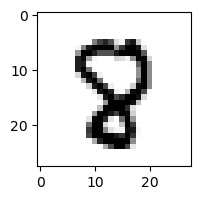

9.86971345558155e-17% - 0
8.944045097679338e-16% - 1
5.942294076374966e-16% - 2
1.6497349011151613e-26% - 3
8.407588590622716e-10% - 4
0.00045164986105371627% - 5 - ОШИБКА
1.0490332405652839e-16% - 6
5.224002631898847e-07% - 7
3.229858319818575e-05% - 8
1.5180638129846477e-23% - 9

 8


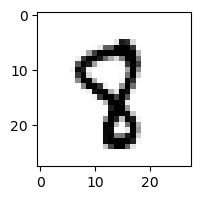

1.0202310026162369e-16% - 0
1.6663779182797925e-07% - 1
3.458694455942116e-15% - 2
1.1236547467879135e-17% - 3
1.2030845795836955e-06% - 4
0.35089108161186205% - 5 - ОШИБКА
8.685654329082079e-15% - 6
0.028981597534967263% - 7
6.191901593026873e-10% - 8
2.8141266996127816e-13% - 9

 9


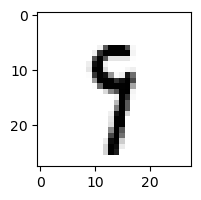

1.0993786901634344e-14% - 0
0.0023944718397250204% - 1
1.4133827219846232e-13% - 2
4.4264959566586983e-07% - 3
3.0275724665610092e-05% - 4
12.144913066087316% - 5
0.0001179698862893775% - 6
0.09742303271045898% - 7
99.95450522916288% - 8 - ОШИБКА
98.38254448639037% - 9

 2


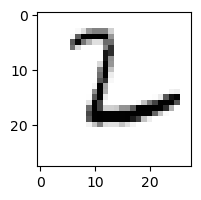

1.799259151399711e-05% - 0
1.2788478679489495e-07% - 1
99.99996553306643% - 2
1.1451708873941675e-12% - 3
1.7935271114378486e-07% - 4
4.324784574294622e-05% - 5
99.99999119896484% - 6 - ОШИБКА
5.213378554565052e-06% - 7
1.4289231773345906e-08% - 8
7.506637477155514e-11% - 9

 5


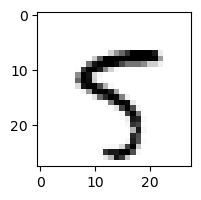

8.192236784164487e-10% - 0
2.17761212199853e-08% - 1
6.187400025175954e-14% - 2
3.013092176100145e-13% - 3
2.6903820312507517e-06% - 4
50.80884229987809% - 5
3.566863894145534e-14% - 6
0.06813245806701615% - 7
1.0680350028585483e-10% - 8
99.99113714626435% - 9 - ОШИБКА

 9


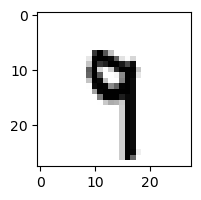

8.744510965485673e-20% - 0
0.005896688123727361% - 1
9.746419164883914e-16% - 2
3.409893780235066e-08% - 3
0.027470531500726737% - 4
0.009448451765660767% - 5
2.6199531123092532e-11% - 6
5.876891237558909% - 7 - ОШИБКА
5.315588123330792e-12% - 8
0.010556823434903937% - 9

 2


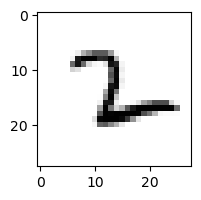

1.997225577593195e-14% - 0
0.3036890815081108% - 1
3.5364375750902606% - 2
1.189729429765607e-08% - 3
2.033835000371169e-09% - 4
0.029348225967242875% - 5
40.203631123376624% - 6 - ОШИБКА
0.3061952554899936% - 7
1.7446203324505928e-11% - 8
3.2964692966749133e-16% - 9

 9


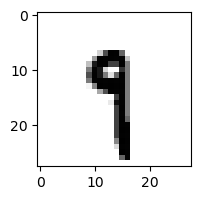

3.321564026454039e-19% - 0
0.1872553852564912% - 1
4.633146950156404e-20% - 2
1.7829667164600653e-13% - 3
0.000137602548292366% - 4
0.49359244783814826% - 5 - ОШИБКА
1.6410029036384466e-07% - 6
0.013642353554475921% - 7
4.1215449241941735e-07% - 8
0.05480512719418928% - 9

 9


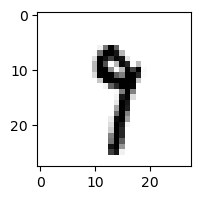

1.9642147669905124e-14% - 0
0.3034810902758766% - 1
1.5193835027898672e-14% - 2
2.9909490371256202e-05% - 3
9.43907263741726e-08% - 4
0.0037961666442246603% - 5
1.0328490076660546e-09% - 6
87.4252294160384% - 7 - ОШИБКА
0.0030231618412702235% - 8
0.0015860023427593168% - 9

 6


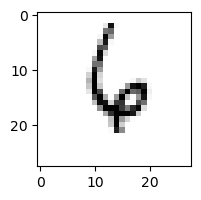

5.550283844573383e-13% - 0
0.0003683338997767953% - 1
0.9547697738511662% - 2
1.1896603423659306e-14% - 3
99.9987754780666% - 4 - ОШИБКА
0.13102905590216044% - 5
99.72685448510916% - 6
0.5909943282721357% - 7
1.7349110481693864e-08% - 8
0.021688726249063893% - 9

 3


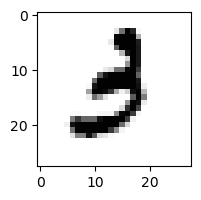

2.4503697891735334e-09% - 0
2.187672318318556e-08% - 1
3.9900340786333175e-11% - 2
0.00021798361207885246% - 3
8.32561757666554e-14% - 4
0.14826844383800777% - 5 - ОШИБКА
4.849498610816833e-09% - 6
1.295772560339029e-09% - 7
3.907083342102748e-29% - 8
8.373804065786066e-27% - 9

 8


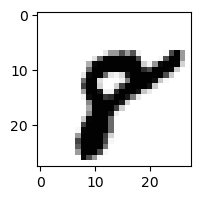

3.4164935056010003e-16% - 0
4.871558994857145e-14% - 1
3.158208829937002e-29% - 2
1.4130221217468877e-36% - 3
1.0531489551555451e-18% - 4
1.2356411370484488e-09% - 5
1.8963418610848348e-18% - 6
0.0017589363754666719% - 7 - ОШИБКА
7.743285564345171e-11% - 8
1.733454335332849e-13% - 9

 9


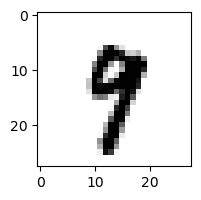

1.6038138940970044e-16% - 0
1.0963072445865837e-06% - 1
7.611896850870934e-21% - 2
2.9770824243615063e-10% - 3
2.7652280058099783e-07% - 4
0.0002435878336776617% - 5
2.77573201626918e-17% - 6
0.07489748867496589% - 7 - ОШИБКА
3.121114984972667e-14% - 8
0.00531520391470548% - 9

 9


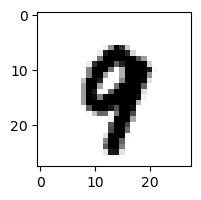

3.3878023870037664e-23% - 0
8.484589267826897e-13% - 1
1.324058679198149e-23% - 2
1.5201726167748705e-31% - 3
7.031498672555944e-08% - 4
1.0489122212487669e-09% - 5
5.651300808390177e-17% - 6
1.1094883309319414% - 7 - ОШИБКА
2.30862882130188e-19% - 8
0.6948815015887758% - 9

 9


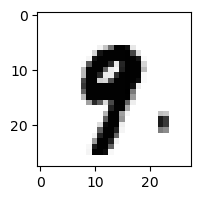

6.781561766714105e-22% - 0
6.663395819389746e-09% - 1
1.1993488254099364e-25% - 2
2.3839881785368924e-22% - 3
8.33068009923554e-13% - 4
0.013326145633385493% - 5 - ОШИБКА
3.5216734733167826e-20% - 6
1.5458998341889903e-06% - 7
5.691432601662905e-24% - 8
3.896567684550595e-05% - 9

 8


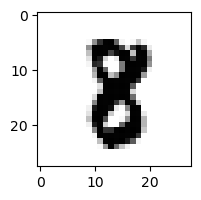

2.6585145202728227e-22% - 0
1.0376004777865623e-07% - 1
3.0058022441292543e-18% - 2
1.767637832772341e-14% - 3
3.1224016180152355e-19% - 4
8.784117763873347e-06% - 5 - ОШИБКА
2.1507849258875946e-22% - 6
3.512508511902952e-10% - 7
3.311640890656053e-07% - 8
6.514890042942408e-27% - 9

 8


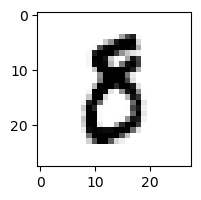

1.287269626876883e-05% - 0
1.3134312042134419e-08% - 1
2.2597005738319997e-11% - 2
1.9142995898145328e-07% - 3
1.5370377262303679e-16% - 4
0.2986197780775841% - 5 - ОШИБКА
5.365805229451363e-14% - 6
4.558424151448034e-09% - 7
1.503438559741847e-10% - 8
3.105520918143995e-24% - 9

 9


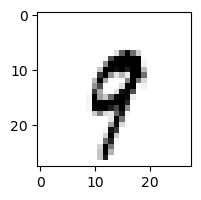

7.434645646118593e-14% - 0
0.04342826929149861% - 1
9.839361062960799e-11% - 2
9.435092848510847e-15% - 3
6.826160576360639e-05% - 4
6.893437669579997e-08% - 5
3.579836206595692e-09% - 6
89.80889909504288% - 7 - ОШИБКА
1.3534280467743574e-09% - 8
0.005517939412288367% - 9

 9


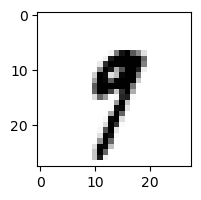

2.127427722574481e-13% - 0
0.07373968849146574% - 1
7.270173971708436e-19% - 2
0.00038503633068856714% - 3
4.910904458747952e-06% - 4
0.0004943009485257385% - 5
3.984570642757774e-14% - 6
1.3404911558662622% - 7 - ОШИБКА
2.322189679702625e-13% - 8
0.017650464785821687% - 9

 2


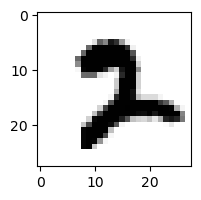

8.444979692661119e-21% - 0
8.529293687672113e-13% - 1
3.019506912935658e-06% - 2
2.8654697327425562e-21% - 3
4.370639789966111e-25% - 4
7.844071547621037e-07% - 5
1.190776984242448e-19% - 6
25.70991041242442% - 7 - ОШИБКА
1.4849230385087164e-36% - 8
3.03584947956163e-35% - 9

 9


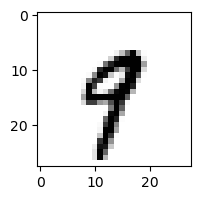

1.6930636393581195e-13% - 0
0.021955433950892417% - 1
1.7349459807722387e-16% - 2
2.004104973988531e-12% - 3
0.0005030497135126602% - 4
0.0006012863644689637% - 5
2.358870520459891e-10% - 6
14.07734914447941% - 7 - ОШИБКА
5.4025117259356123e-17% - 8
7.076811037105021e-05% - 9

 8


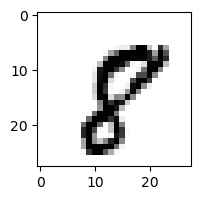

1.847652400148311e-12% - 0
1.038506376539411e-09% - 1
1.393504904428621e-20% - 2
4.900152057580862e-25% - 3
1.8696822906682473e-15% - 4
0.00034810109989995703% - 5
4.390624019257627e-16% - 6
0.04139138219472947% - 7 - ОШИБКА
0.004663366946528543% - 8
7.8807113948990735e-16% - 9

 9


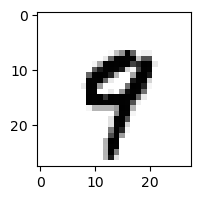

6.106807070241332e-15% - 0
4.5620448694454297e-10% - 1
1.429527284803806e-22% - 2
6.293528784176674e-20% - 3
0.00014979528346851137% - 4
1.277875748373414e-06% - 5
4.701020510774651e-12% - 6
30.70399161823151% - 7 - ОШИБКА
2.2417630882102297e-16% - 8
0.002337707229552136% - 9

 9


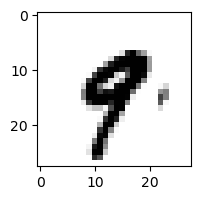

2.953160427992237e-16% - 0
3.198358847650576e-05% - 1
5.168726428682952e-25% - 2
2.65001704503702e-16% - 3
0.0001919160892005507% - 4
1.7412863709155263e-07% - 5
1.2439639784464387e-12% - 6
0.08596039386134513% - 7 - ОШИБКА
1.659214311786749e-22% - 8
1.014975409973318e-06% - 9

 9


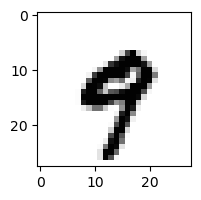

8.115072274169674e-16% - 0
8.30928184685129e-11% - 1
6.695376458790115e-27% - 2
1.6901707555042885e-15% - 3
0.003163114003970851% - 4
1.1146973227355321e-08% - 5
3.592380177343797e-13% - 6
0.18010582037392747% - 7 - ОШИБКА
1.611169941059608e-23% - 8
0.00014040505607492115% - 9

 8


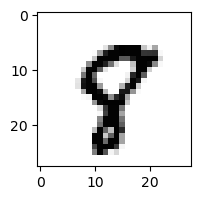

3.1045446021668046e-13% - 0
5.4770409498224963e-11% - 1
7.01996382201977e-20% - 2
2.7411123276074938e-24% - 3
5.643000189675632e-11% - 4
0.06843268663739807% - 5
7.400043952863908e-17% - 6
0.10399116616950142% - 7 - ОШИБКА
4.4921965150007885e-09% - 8
7.126157098692452e-05% - 9

 9


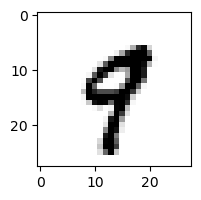

3.592550058544617e-13% - 0
2.9107125268731235e-06% - 1
1.79091317686255e-18% - 2
1.2982704280280526e-14% - 3
6.130715921181023e-05% - 4
6.820775568186851e-05% - 5
1.1396590957496764e-15% - 6
10.13687148656557% - 7 - ОШИБКА
2.8432095157300596e-15% - 8
0.00015320683828197% - 9

 8


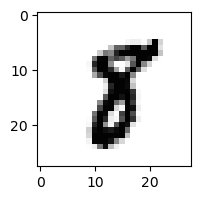

6.474846969544418e-20% - 0
8.786168478900833e-05% - 1
1.5326051142628827e-20% - 2
3.489927050464067e-18% - 3
1.3063772193784704e-17% - 4
0.04643757848088759% - 5 - ОШИБКА
4.672135356058025e-20% - 6
3.1706061950178675e-05% - 7
3.567723233699029e-07% - 8
1.971208590713025e-20% - 9

 9


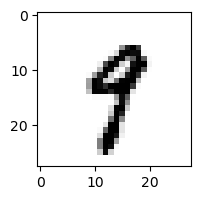

2.406419239410481e-12% - 0
0.0002902456162409765% - 1
8.80360845600883e-20% - 2
3.427641699161397e-07% - 3
0.0001051654804058583% - 4
0.0013033954971604965% - 5
1.1100842632840835e-12% - 6
0.7823167522103417% - 7 - ОШИБКА
1.0238233825767893e-09% - 8
0.6290524023887069% - 9

 9


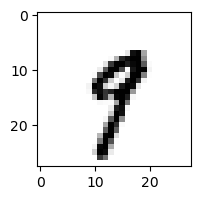

4.647598114867228e-12% - 0
0.012810970897855708% - 1
8.189461846927704e-17% - 2
5.136348040212998e-05% - 3
0.0020389061464343664% - 4
5.685984195365348e-05% - 5
5.672836869703229e-10% - 6
44.93062063599085% - 7 - ОШИБКА
2.0904844882526106e-10% - 8
1.4183607526724197e-07% - 9

 3


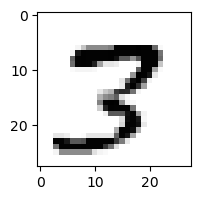

9.469084086447452e-18% - 0
2.4437231784704807e-11% - 1
2.524630427175719e-12% - 2
2.942394596967115e-07% - 3
1.742620725451294e-14% - 4
1.4739269768821426e-05% - 5
7.204732061645366e-24% - 6
83.55759967985547% - 7 - ОШИБКА
0.03448980310625919% - 8
1.1975304262352683e-16% - 9

 9


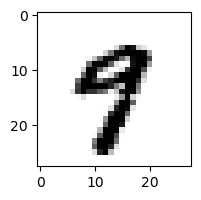

3.1073058101829686e-14% - 0
4.44677963336084e-10% - 1
8.880670679578533e-32% - 2
1.7230827995078637e-18% - 3
4.2355586432494724e-07% - 4
0.01086375298280296% - 5
6.90438100474679e-19% - 6
0.056072607311928806% - 7 - ОШИБКА
1.0614032739457203e-19% - 8
0.0005037611446763288% - 9

 8


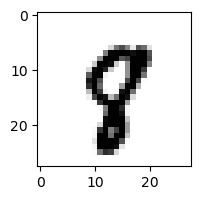

1.7059945602360251e-15% - 0
2.0512745776247875e-09% - 1
9.80013000034244e-21% - 2
1.113465523154574e-22% - 3
8.012172803757631e-10% - 4
0.0023808158036883464% - 5
9.237908551394413e-17% - 6
5.024869199157091% - 7 - ОШИБКА
2.5483931152307886e-12% - 8
3.406617549197349e-08% - 9

 8


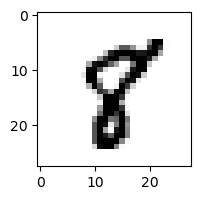

4.2248872146407685e-16% - 0
2.138649939393258e-06% - 1
8.92799878417818e-20% - 2
8.182970812421758e-27% - 3
7.070275341964542e-10% - 4
0.03559438291512963% - 5 - ОШИБКА
4.864446476409278e-18% - 6
0.011518748702032984% - 7
1.3905047037982895e-05% - 8
1.0446989383124625e-13% - 9

 3


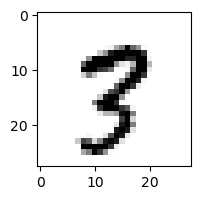

1.9445071503180695e-18% - 0
2.5266273261004806e-07% - 1
2.652250261328717e-14% - 2
1.0516960984531457e-16% - 3
1.457075592286965e-13% - 4
3.807504330105443e-05% - 5
2.5851958495836654e-17% - 6
14.391360265622577% - 7
40.103629255066146% - 8 - ОШИБКА
2.04640113091361% - 9

 9


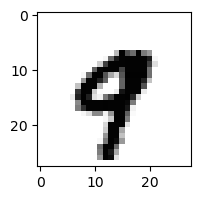

6.989091913237273e-19% - 0
2.103942690032369e-10% - 1
4.8882636289848e-28% - 2
6.236717819339107e-32% - 3
4.254700871349429e-05% - 4
1.1145880195929953e-11% - 5
8.316200476461711e-17% - 6
14.473625553495118% - 7 - ОШИБКА
8.36377273400138e-25% - 8
3.182318534014454e-06% - 9

 9


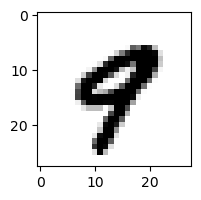

3.6079500862685094e-14% - 0
2.2924255067392117e-10% - 1
1.6992434139897432e-29% - 2
3.016351728686692e-26% - 3
4.4308620227027475e-05% - 4
2.5826503605240724e-07% - 5
9.071693665412169e-19% - 6
0.08455663109203015% - 7 - ОШИБКА
3.6861517915618755e-20% - 8
3.7887773136748564e-06% - 9

 8


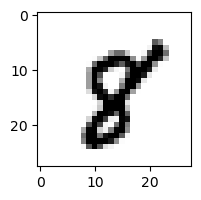

6.916901189345982e-16% - 0
3.819318297589603e-07% - 1
4.1377535839752534e-19% - 2
1.1805833574187699e-26% - 3
2.873593952077508e-07% - 4
0.00029717596169473903% - 5
2.1191722989507346e-18% - 6
0.01874339175618759% - 7 - ОШИБКА
0.000577665152313503% - 8
2.7420692355542356e-18% - 9

 9


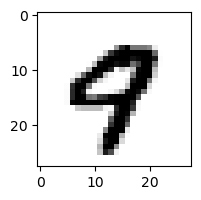

8.536546787338576e-12% - 0
5.948741402333767e-14% - 1
1.4218486681614966e-27% - 2
2.3039775499887163e-31% - 3
1.0889104795876552e-07% - 4
7.115245913288954e-09% - 5
8.019302796966723e-20% - 6
1.5695906519496163% - 7 - ОШИБКА
4.310927898711849e-22% - 8
0.047643742278899344% - 9

 9


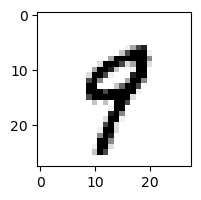

5.251690221141593e-11% - 0
2.196472110494011e-05% - 1
1.3241643582602576e-16% - 2
3.199301985101458e-13% - 3
0.001692371662725063% - 4
0.0008544087040145646% - 5
4.1686552952236744e-11% - 6
1.715123547148002% - 7 - ОШИБКА
1.9604130706601508e-11% - 8
1.4807710790093984% - 9

 9


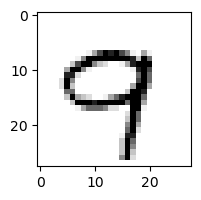

2.3196484757328157e-09% - 0
4.996868997602436e-10% - 1
5.020818101169175e-09% - 2
2.856438847172521e-15% - 3
1.7237000881855455e-05% - 4
2.1955632589468555e-08% - 5
7.991832024622847e-13% - 6
97.26926190755704% - 7 - ОШИБКА
5.5808210855422465e-11% - 8
80.05467340307763% - 9

 5


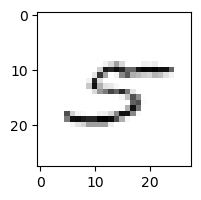

0.6718093635717879% - 0
0.0015867602430975384% - 1
0.1655219537085266% - 2
0.00702060005372064% - 3
0.03209724519203339% - 4
0.0033020540324634664% - 5
0.0845056918919167% - 6
12.967367270037888% - 7 - ОШИБКА
0.002485184361988905% - 8
3.596327616147642e-05% - 9

 8


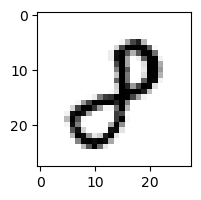

1.6792266460603508e-10% - 0
4.3893731336563266e-06% - 1
6.759003174576684e-05% - 2 - ОШИБКА
4.444558555955888e-12% - 3
1.2400442167660466e-09% - 4
1.7064657158096776e-10% - 5
1.8901444866732034e-17% - 6
1.8696317263975788e-05% - 7
5.387373210523182e-07% - 8
1.4672454329224125e-08% - 9

 6


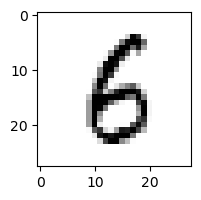

7.532672549217521e-09% - 0
1.0359752780925549e-06% - 1
8.098252665868491e-08% - 2
3.657312465840436e-12% - 3
6.23941227573781e-08% - 4
1.3814258784851934% - 5 - ОШИБКА
1.1715762361635351% - 6
5.653523771492041e-09% - 7
0.34489278935223605% - 8
3.8968948113837546e-10% - 9

 0


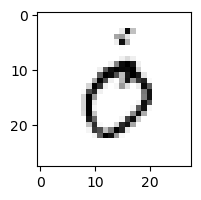

10.321965672999264% - 0
0.0014598795995423258% - 1
8.15303346948376e-08% - 2
3.1630006863337554% - 3
0.7164559089962015% - 4
0.02844055206453613% - 5
64.98722434694457% - 6 - ОШИБКА
9.345180383036682% - 7
3.030745636574462e-13% - 8
2.5338928393915067e-11% - 9

 3


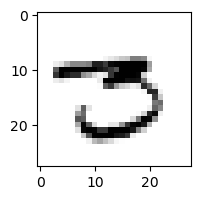

3.9034754428125534e-05% - 0
0.0003324026921275248% - 1
1.5021209873841873e-16% - 2
0.0019301954429293672% - 3
5.865870490912302e-15% - 4
0.01701777667958519% - 5
1.0468340932845909e-13% - 6
0.025235650196119046% - 7 - ОШИБКА
9.331949042355373e-11% - 8
4.0531207850969444e-23% - 9

 5


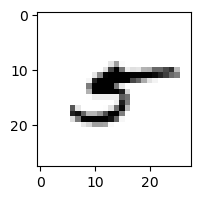

1.569437013129528e-08% - 0
0.6923103091120646% - 1
1.4888788993719242e-11% - 2
1.6082139024080725e-10% - 3
0.04406474012754841% - 4
7.788847257298065e-09% - 5
0.6976968313325244% - 6
2.272848302410558e-05% - 7
1.901665220038987% - 8 - ОШИБКА
1.6636392915621128e-06% - 9

 1


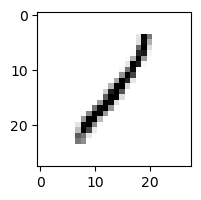

1.0397085610613285e-05% - 0
99.49994701078082% - 1
97.93027066989215% - 2
0.0037405270995693853% - 3
0.001880545762116121% - 4
0.0007446813702401468% - 5
0.004204910229312476% - 6
0.0007760102833621546% - 7
99.99719378782706% - 8 - ОШИБКА
0.05417172816168909% - 9

 3


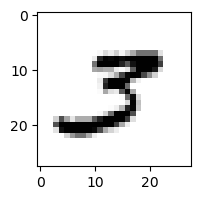

2.114602542116441e-07% - 0
8.69300266002846e-05% - 1
1.549048466466435e-05% - 2
0.02541236023021814% - 3
7.792947707280436e-17% - 4
9.433868006342223e-05% - 5
2.0097204493622848e-19% - 6
0.048294990632841844% - 7 - ОШИБКА
1.019687965407571e-14% - 8
4.630491058652488e-18% - 9

 2


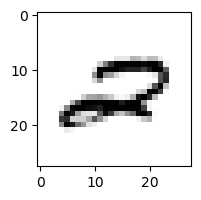

0.00037883166701445543% - 0
9.542112819098712e-09% - 1
0.00014639859375393128% - 2
1.1033502865605504e-21% - 3
0.021122239930069325% - 4
1.2302242973270053e-12% - 5
3.537179591062448e-11% - 6
2.587724805433872% - 7 - ОШИБКА
2.0263030246342005e-16% - 8
1.414747309620979e-17% - 9

 9


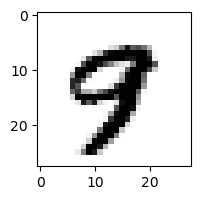

6.272643850082185e-15% - 0
1.4429377149375205e-13% - 1
6.745705742037233e-23% - 2
2.154990210631094e-21% - 3
3.757465117314543e-10% - 4
5.114940184853186e-05% - 5
6.123951963691312e-21% - 6
0.15804010221606776% - 7 - ОШИБКА
1.0946386527454843e-22% - 8
0.009215331779022187% - 9

 8


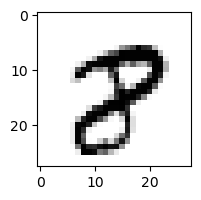

2.3132281977861108e-18% - 0
3.658602987844089e-12% - 1
2.9880204569950212e-21% - 2
7.422521124169154e-35% - 3
1.9008849904320326e-22% - 4
6.014779439938721e-09% - 5
9.553368217714201e-23% - 6
0.029737618095833834% - 7 - ОШИБКА
1.2535264164887057e-06% - 8
1.1717081092262733e-16% - 9

 8


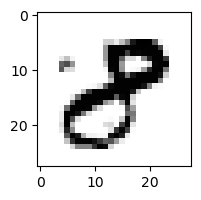

1.3659340666195475e-10% - 0
2.716886095495495e-10% - 1 - ОШИБКА
1.9158869654869368e-14% - 2
6.547812167084766e-12% - 3
4.547601575597322e-14% - 4
3.9348640623084144e-11% - 5
7.398528929830557e-25% - 6
6.757778613613021e-12% - 7
1.4271996131429467e-16% - 8
4.5409759377100226e-17% - 9

 3


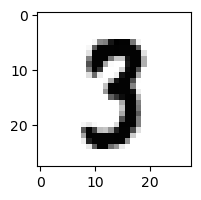

7.226345220477418e-15% - 0
6.544348579638663e-09% - 1
2.1714766001610788e-14% - 2
0.016581770039354224% - 3
8.033793115432344e-18% - 4
0.06553265272260972% - 5 - ОШИБКА
1.1083747707004737e-25% - 6
0.000433076734756347% - 7
6.287958508402058e-10% - 8
1.5861840466655968e-23% - 9

 3


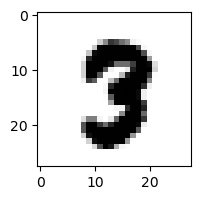

2.5987014553379195e-18% - 0
1.5440767848486726e-15% - 1
7.48028481531655e-24% - 2
7.148379773075642e-14% - 3
1.9016068449958159e-25% - 4
1.2548047910962072e-05% - 5
8.404780409940957e-27% - 6
0.0008343214233068732% - 7 - ОШИБКА
2.7711276090695428e-17% - 8
2.513197465083934e-28% - 9

 9


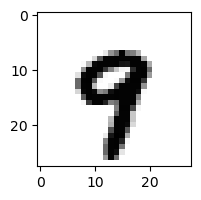

6.875401902021887e-20% - 0
2.9531198443090428e-12% - 1
4.0176992253787154e-27% - 2
7.450943535993672e-26% - 3
3.694081909493062e-07% - 4
1.590815406464129e-05% - 5
9.472356185467776e-16% - 6
0.2470673386582843% - 7 - ОШИБКА
2.488261228751695e-21% - 8
0.10313230412786614% - 9

 3


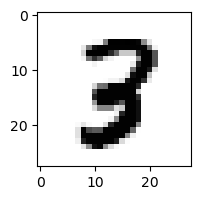

2.1620610654128613e-18% - 0
2.147365390592151e-12% - 1
2.4968606823192147e-11% - 2
5.846591038085554e-05% - 3
5.539545649236987e-12% - 4
9.419218606403592e-05% - 5 - ОШИБКА
9.641027228901762e-21% - 6
5.2088227480263564e-09% - 7
1.0131561314261603e-08% - 8
3.894887070859019e-30% - 9

 8


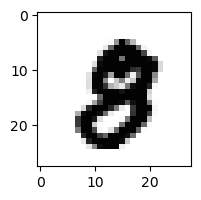

9.292953684973861e-19% - 0
1.1126954607079267e-15% - 1
5.6894231943374995e-27% - 2
1.5473213132871742e-23% - 3
4.611133506873171e-23% - 4
1.1157114637209965e-09% - 5
2.3255440496803937e-28% - 6
8.202244987633929e-08% - 7 - ОШИБКА
3.610552868938276e-15% - 8
7.212317275390893e-29% - 9

 9


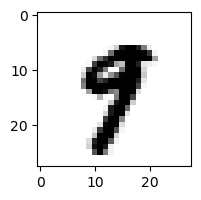

1.5892609312469797e-17% - 0
1.816359476985103e-07% - 1
9.410603450315444e-30% - 2
9.298254970942744e-18% - 3
1.1797607160005203e-09% - 4
0.0007259725609653025% - 5
7.74987131036391e-21% - 6
0.005443962169569723% - 7 - ОШИБКА
1.2258968802177246e-20% - 8
8.899703935802266e-06% - 9

 8


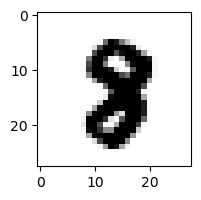

1.9096856550857173e-25% - 0
7.657896639520904e-13% - 1
2.66696469651064e-27% - 2
5.134950414374258e-27% - 3
1.6224894761743252e-22% - 4
1.4818718642276544e-07% - 5
4.755304690829497e-23% - 6
1.5497215596617935e-06% - 7 - ОШИБКА
2.380283964531746e-08% - 8
6.888560101228021e-32% - 9

 0


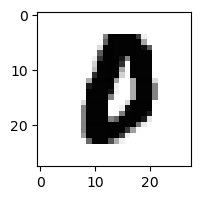

3.139489700760041e-08% - 0
6.760316203855557e-20% - 1
1.234408935356744e-19% - 2
1.0384684209334798e-24% - 3
2.465811681561535e-26% - 4
8.699917412599251e-07% - 5 - ОШИБКА
1.2496923638288769e-14% - 6
5.079747216768645e-13% - 7
6.949176156574124e-29% - 8
1.1015559979970647e-34% - 9

 9


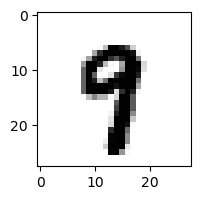

6.350226715119663e-19% - 0
1.5652223737956881e-09% - 1
9.261169124920406e-26% - 2
2.4153064624115223e-14% - 3
5.263153048223734e-08% - 4
0.01072965740908827% - 5 - ОШИБКА
1.237244771575565e-17% - 6
0.005218423022056105% - 7
1.5680705396772198e-19% - 8
0.0001275126291140485% - 9

 9


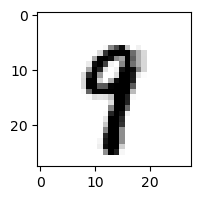

3.4603515325306576e-19% - 0
5.865531660517166e-05% - 1
2.9275178959132546e-22% - 2
1.840379279888217e-16% - 3
1.2112241574102438e-07% - 4
0.005891411222331932% - 5
2.0772299472290946e-15% - 6
0.02985443553051104% - 7 - ОШИБКА
2.625418100340474e-16% - 8
0.0007105826852377712% - 9

 7


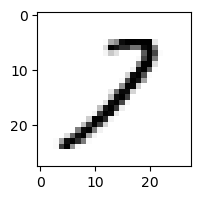

7.734037361773307e-06% - 0
70.54788214314647% - 1
98.49173707804901% - 2 - ОШИБКА
2.602761873853047e-05% - 3
5.76087395046325e-05% - 4
4.726349397268455e-05% - 5
2.897172514608838e-06% - 6
0.06591124846820615% - 7
68.59047415066658% - 8
4.594676698933107e-14% - 9

 4


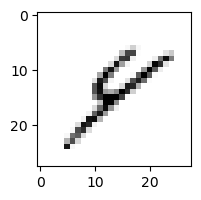

8.70066378796872e-06% - 0
0.1041860809273908% - 1
0.004887966409513382% - 2
0.00011064739962513627% - 3
0.09049386622954855% - 4
0.002521042859366705% - 5
12.899839751766246% - 6
0.06721595214509626% - 7
99.99999999411753% - 8 - ОШИБКА
99.64437115539793% - 9

 3


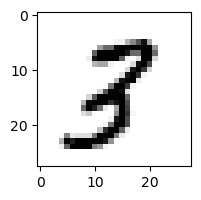

9.788936741394939e-14% - 0
4.430855450153184e-05% - 1
2.1208316377066431e-07% - 2
3.658460859567547e-06% - 3
1.6332145700619245e-10% - 4
3.928383680400303e-05% - 5
4.462569869543282e-17% - 6
6.10651623925306e-05% - 7
8.108800057760741e-05% - 8 - ОШИБКА
1.0476073725789966e-07% - 9

 1


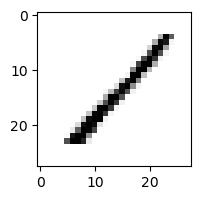

2.187530407673283e-06% - 0
98.04307306927501% - 1
47.06205123443547% - 2
4.473708840148894e-05% - 3
0.06168774192730792% - 4
0.0010500268265751873% - 5
1.288884679983721e-05% - 6
0.23894379661432932% - 7
99.99998602540754% - 8 - ОШИБКА
1.4306652888542988e-07% - 9

 5


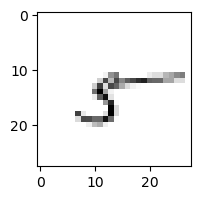

0.12557614147513452% - 0
95.63990900701998% - 1
72.93418543247385% - 2
1.2323869197352284% - 3
96.9818655019667% - 4
0.0027035935226732994% - 5
99.99969681042057% - 6
0.00027396774588258537% - 7
99.99999454863567% - 8 - ОШИБКА
99.99237647696702% - 9

 5


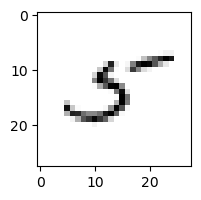

0.0003269068953458808% - 0
0.6542763259329734% - 1
0.006452065086101397% - 2
1.0698275429523738e-10% - 3
62.6080435427263% - 4
26.984233831946547% - 5
0.0006395251682881917% - 6
0.05651705901140216% - 7
99.99999915133803% - 8 - ОШИБКА
7.66990207161402e-05% - 9

 9


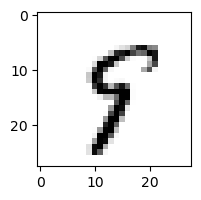

4.7854205813334836e-11% - 0
0.00019245514549935807% - 1
8.582825025239489e-12% - 2
2.227203518573693e-13% - 3
0.006466127026289044% - 4
19.948041690430077% - 5 - ОШИБКА
1.9019579255993096e-06% - 6
0.013170999311091567% - 7
0.03708006177686111% - 8
8.333725999120164% - 9

 2


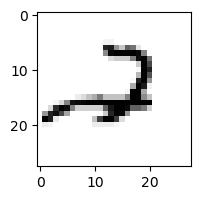

2.7440865030888592e-06% - 0
4.277484870249062e-07% - 1
99.84496529711086% - 2
2.4810451164493995e-12% - 3
13.331065130271439% - 4
1.9170027933395468e-08% - 5
7.284698857837693e-06% - 6
7.260390520605818% - 7
1.249914495398437e-15% - 8
99.88691592636157% - 9 - ОШИБКА

 4


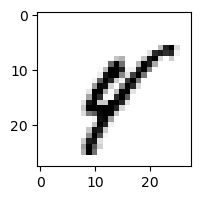

5.1141158287382675e-12% - 0
0.09527222321009617% - 1
2.0008341735336928e-12% - 2
1.3790011566625248e-16% - 3
0.7339387053989366% - 4
6.014557827147697e-05% - 5
4.8323768177364354e-05% - 6
0.0050710164559872855% - 7
1.5195365429267544% - 8 - ОШИБКА
3.0548772301608647e-09% - 9

 3


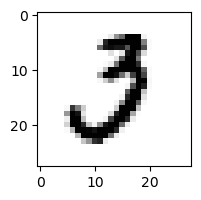

0.004519414507011515% - 0
9.505120559994278e-09% - 1
0.5052645634402415% - 2 - ОШИБКА
1.1343312691195883e-06% - 3
8.74936947069538e-18% - 4
0.0003351959151639964% - 5
1.3129597074546437e-17% - 6
0.0002898844044030673% - 7
8.555018170439266e-27% - 8
1.0419297332284599e-32% - 9

 8


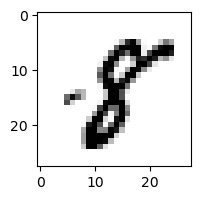

2.278401251964351e-15% - 0
1.6756463077890233e-05% - 1
2.0868412021559522e-18% - 2
2.618174639322497e-19% - 3
7.39578448438839e-11% - 4
0.5727015452962004% - 5 - ОШИБКА
3.464766517962628e-19% - 6
3.378561590703564e-07% - 7
0.4878530011703818% - 8
1.302542381054946e-21% - 9

 2


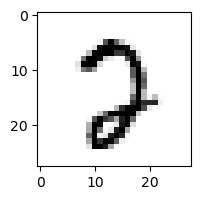

0.0018871395366016116% - 0
5.46031589076081e-12% - 1
0.006327141751526813% - 2
3.0428450167608124e-08% - 3
3.47538856992673e-13% - 4
0.06876190849900096% - 5
1.2858235131950506e-09% - 6
76.96081639374412% - 7 - ОШИБКА
1.5810990144253627e-09% - 8
2.1046712399120955e-19% - 9

 8


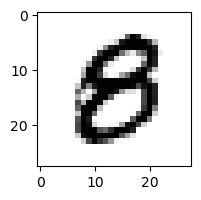

1.697354437762038e-06% - 0
2.361224378590303e-14% - 1
9.878153535744903e-22% - 2
3.137954370173005e-17% - 3
1.4033203598889885e-11% - 4
0.006952672573496144% - 5 - ОШИБКА
7.615528399588451e-12% - 6
2.5653401898366415e-15% - 7
3.1241608325517207e-10% - 8
4.266916838248066e-21% - 9

 8


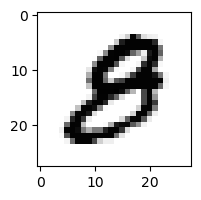

7.527614426127548e-08% - 0 - ОШИБКА
2.5754686100168955e-14% - 1
2.1292259792696204e-17% - 2
6.470577723185713e-16% - 3
2.308491265493994e-15% - 4
8.32152409814313e-09% - 5
1.2503345558671952e-13% - 6
7.611694278162946e-14% - 7
2.775343649008703e-13% - 8
4.62453710710682e-19% - 9

 9


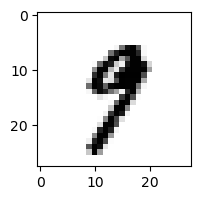

4.815337239226854e-13% - 0
2.474403782725895e-05% - 1
9.174899126448761e-22% - 2
1.2530201496962425e-10% - 3
4.822106381676137e-07% - 4
1.4451131385663463e-05% - 5
7.058100004058735e-17% - 6
4.077220224263939% - 7 - ОШИБКА
7.439601496281529e-17% - 8
0.18303098558503147% - 9

 3


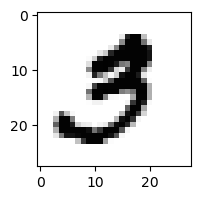

8.578325385154632e-10% - 0
2.0281508222356048e-13% - 1
2.340811904832671e-15% - 2
0.006846703132902402% - 3
7.495355968138647e-18% - 4
0.17003024949284892% - 5 - ОШИБКА
3.416652276172828e-25% - 6
8.097519020318859e-08% - 7
3.18885272697168e-31% - 8
1.4869494962270942e-18% - 9

 8


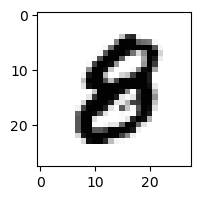

5.5696508878344114e-14% - 0
2.006677900519752e-15% - 1
8.70096904339245e-21% - 2
8.831314018825782e-24% - 3
7.97078046666724e-14% - 4
3.4457568261205424e-05% - 5 - ОШИБКА
1.935733543768691e-13% - 6
8.256117507934094e-14% - 7
2.642779232637811e-09% - 8
3.9458280369411984e-19% - 9

 2


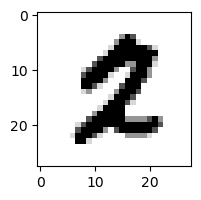

1.8044607678856216e-17% - 0
6.668585203732255e-11% - 1
4.936378116129602e-17% - 2
1.7444820873847863e-32% - 3
2.0272207139765523e-22% - 4
4.163101956483809e-06% - 5 - ОШИБКА
7.970059034595996e-18% - 6
3.8873917869531186e-08% - 7
4.571651671198293e-28% - 8
1.0492109898260682e-27% - 9

 5


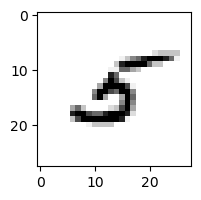

2.5907010341949088e-08% - 0
0.07099371851782227% - 1
1.02498298659086% - 2 - ОШИБКА
9.108419659694977e-11% - 3
0.007586554902479083% - 4
0.318026991721075% - 5
1.6240380267165898e-07% - 6
2.5817252690550223e-06% - 7
0.00010355211247471966% - 8
6.938678126689983e-13% - 9

 8


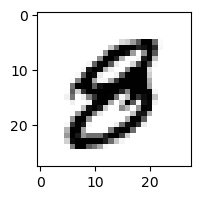

7.231187768902467e-14% - 0
1.0481018865993272e-13% - 1
1.8966359866180527e-28% - 2
5.583477468658577e-17% - 3
1.547938911242653e-11% - 4
0.0003900233403075254% - 5 - ОШИБКА
8.616398587049239e-19% - 6
2.444037394384141e-12% - 7
4.139002091228729e-23% - 8
4.5447344816804057e-13% - 9

 8


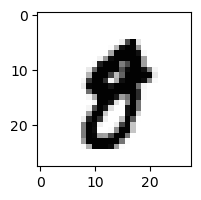

1.3934112585529476e-16% - 0
1.0385872676261171e-11% - 1
2.0201723309534352e-29% - 2
1.7915590751554842e-18% - 3
4.535750091776915e-16% - 4
7.224913920701811e-08% - 5
3.401662045610094e-20% - 6
9.625819895608592e-07% - 7 - ОШИБКА
1.4343407259223462e-08% - 8
4.437871777507306e-11% - 9

 8


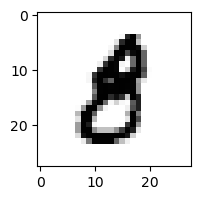

2.107820209505925e-11% - 0
2.9188866130873573e-08% - 1
8.564654721748321e-20% - 2
4.0064040703853877e-10% - 3
1.3667909826772506e-15% - 4
0.00041194814304189076% - 5 - ОШИБКА
1.2504959517745182e-18% - 6
1.4810682868376024e-10% - 7
3.7640726295313656e-06% - 8
8.903240593187927e-16% - 9

 8


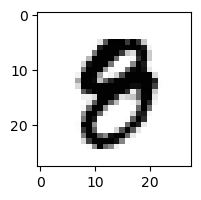

1.4850261635114052e-13% - 0
1.447382739298111e-14% - 1
4.459515877797846e-27% - 2
4.242764772144953e-21% - 3
4.075750537397768e-15% - 4
3.984028741884599e-06% - 5 - ОШИБКА
3.089223898316234e-19% - 6
3.2411822932088983e-12% - 7
9.058289670488243e-07% - 8
5.1977961805045565e-17% - 9

 9


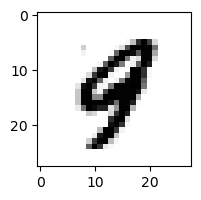

1.5669954443255706e-16% - 0
2.2752093836989116e-09% - 1
5.528697123137186e-21% - 2
2.568573158075336e-25% - 3
0.040202419032423976% - 4 - ОШИБКА
1.6722868422706727e-06% - 5
1.0194089689586781e-12% - 6
2.3977758149564496e-06% - 7
2.79948343898715e-15% - 8
0.012751447285460328% - 9

 9


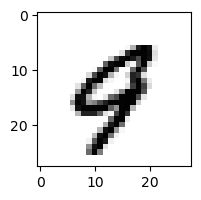

7.173423175089798e-11% - 0
2.0945134993225926e-10% - 1
3.429503438839029e-18% - 2
4.895165805787667e-29% - 3
0.38698189608849065% - 4 - ОШИБКА
4.338440662592163e-09% - 5
8.502957588473529e-10% - 6
0.1873820171762711% - 7
1.6430218491245572e-18% - 8
8.301021854857655e-07% - 9

 3


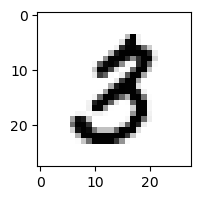

8.855102655597603e-12% - 0
5.577274141127163e-08% - 1
1.3995983068796996e-10% - 2
3.4534796322570168e-06% - 3
1.094039329057947e-18% - 4
0.004714757278079272% - 5 - ОШИБКА
7.05881357607721e-21% - 6
6.208659726891337e-06% - 7
4.408870434451959e-07% - 8
8.439955747350834e-16% - 9

 8


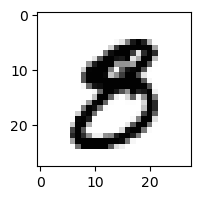

4.1045225034308903e-13% - 0
5.26690964933076e-13% - 1
7.407823078258787e-31% - 2
4.090912249334538e-12% - 3
5.073901646039987e-18% - 4
0.02662486374115894% - 5 - ОШИБКА
9.037109787601631e-25% - 6
2.511275218735324e-12% - 7
1.1534793920323862e-12% - 8
7.319122739040929e-20% - 9

 8


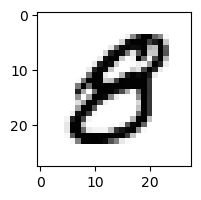

3.368130380209953e-08% - 0
4.709498777791929e-14% - 1
1.6624725531104066e-24% - 2
1.9175009810901886e-18% - 3
5.263962286214028e-09% - 4
1.3742644306555565% - 5 - ОШИБКА
9.177973874580886e-18% - 6
3.356486731809906e-14% - 7
1.353825730934357e-15% - 8
5.096277980109114e-18% - 9

 2


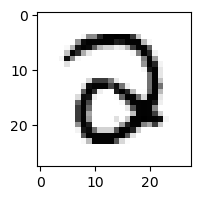

0.0002719034959304031% - 0
3.7664501852809853e-16% - 1
8.45625755377798e-06% - 2
14.937679256034379% - 3 - ОШИБКА
3.083127815794148e-08% - 4
6.929561946856097e-08% - 5
2.2807473693926298e-10% - 6
1.4236132351039215e-13% - 7
1.4158950969033216e-29% - 8
2.073866284162495e-43% - 9

 9


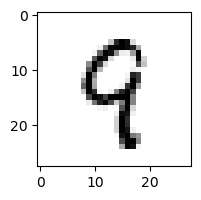

2.6970273466867876e-11% - 0
0.00022986298062762148% - 1
3.0273987887596384e-07% - 2
1.1158530704566718e-10% - 3
3.1473016230345063% - 4 - ОШИБКА
0.6970343170821938% - 5
3.252352534940551e-07% - 6
0.0018752741213205176% - 7
2.874450117874277e-05% - 8
0.004852271547854285% - 9

 5


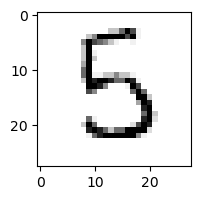

3.6099365762469843e-07% - 0
4.906673837803403e-09% - 1
1.0544005598628916e-10% - 2
49.756000595797204% - 3 - ОШИБКА
0.010644872942564415% - 4
13.300435962221648% - 5
1.3458169685235701% - 6
1.5597522510371074e-06% - 7
9.316413406014356e-18% - 8
2.3467036554432428e-18% - 9

 9


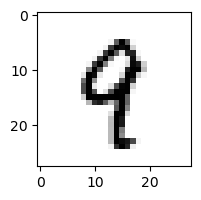

2.768296968267986e-14% - 0
0.003539641582316524% - 1
8.057530511292755e-13% - 2
2.17637199949184e-14% - 3
0.17115188452624983% - 4 - ОШИБКА
0.03392262717331756% - 5
6.974580078196643e-12% - 6
0.030300140880789993% - 7
1.068214210276118e-08% - 8
0.004746208773243849% - 9

 5


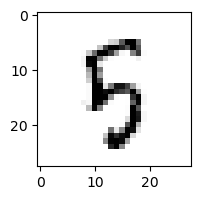

1.2302884668691355e-07% - 0
5.2274249513181215e-09% - 1
2.0056185371856863e-06% - 2
1.9265882943730526e-07% - 3
0.3360686412215127% - 4
94.31584634677166% - 5
0.00014318585359449586% - 6
9.062176348845582e-06% - 7
98.64547920782887% - 8 - ОШИБКА
2.760786177055835e-05% - 9

 2


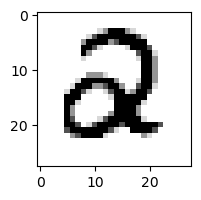

5.375805638669778e-18% - 0
9.463045988280011e-18% - 1
2.7970002893483847e-13% - 2
5.94916961668688e-19% - 3
1.22772244780758e-10% - 4
3.2486711292048254e-07% - 5 - ОШИБКА
3.196608704237487e-14% - 6
1.3255199753145948e-17% - 7
7.68342259305104e-42% - 8
1.4691182218260278e-41% - 9

 8


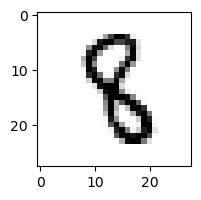

9.244184888740227e-21% - 0
0.007714758222884414% - 1
1.2719741285936791e-09% - 2
3.319256598609511e-09% - 3
8.478246391183605e-06% - 4
0.19706976097383677% - 5 - ОШИБКА
2.563415396830505e-13% - 6
2.087587545895622e-09% - 7
3.405473765775261e-24% - 8
2.4477397219235532e-29% - 9

 8


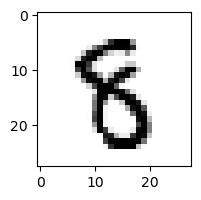

1.6449740033285744e-15% - 0
9.89485717516005e-10% - 1
3.1870485034157105e-19% - 2
7.088493069536846e-10% - 3
7.561736278768316e-08% - 4
1.909042843195615% - 5 - ОШИБКА
9.104829886850111e-14% - 6
5.556283143769669e-10% - 7
0.004185286392866255% - 8
5.520144794831612e-21% - 9

 8


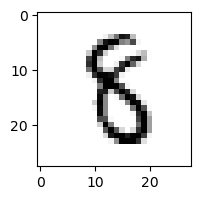

9.312759837453853e-13% - 0
0.0005552438165082259% - 1
6.691699067673146e-10% - 2
1.4823342409353897e-05% - 3
3.280809482325645e-08% - 4
3.804120825182527% - 5 - ОШИБКА
3.687777265090461e-08% - 6
6.756928641438164e-08% - 7
3.5392684274180354e-10% - 8
3.204034014568301e-25% - 9

 2


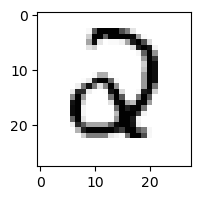

5.24277005318712e-11% - 0
1.258491620734403e-12% - 1
6.391332260794304e-09% - 2
2.922110903895389e-12% - 3
0.0003495853234374695% - 4 - ОШИБКА
1.6003460873774732e-06% - 5
2.592042856268905e-05% - 6
1.0809867881478135e-10% - 7
1.0426662975873612e-27% - 8
1.1715984201565771e-32% - 9

 3


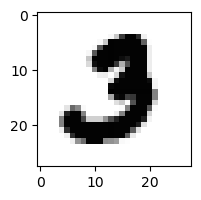

3.3326797019814966e-14% - 0
1.6488095848758786e-15% - 1
3.1604294885227313e-10% - 2
6.140029703920627e-07% - 3
1.9977844396591931e-32% - 4
0.00031217303693790207% - 5 - ОШИБКА
7.926932768256673e-27% - 6
8.387307128562705e-09% - 7
1.947155319527845e-40% - 8
7.475317535015713e-45% - 9

 8


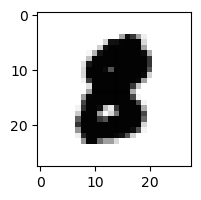

4.702362829138526e-21% - 0
1.4285421833220411e-15% - 1
1.7342303868040404e-24% - 2
7.410267027711831e-33% - 3
7.597872896184482e-28% - 4
1.6469990347032077e-07% - 5 - ОШИБКА
2.0006183923185075e-25% - 6
3.804988753816522e-15% - 7
2.9621913904513217e-30% - 8
9.354674361996327e-40% - 9

 9


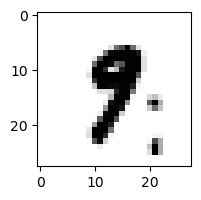

4.58395287156793e-17% - 0
0.1954450975691119% - 1
9.347075053617339e-22% - 2
1.9796181475455225e-14% - 3
1.3536149497131232e-12% - 4
7.875142645443904e-05% - 5
3.1829222191726627e-16% - 6
0.48990148932221805% - 7 - ОШИБКА
2.968607660943463e-18% - 8
4.358485547560612e-08% - 9

 8


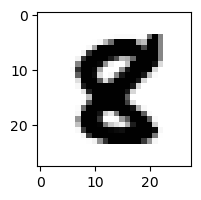

5.877225169486369e-24% - 0
1.7130615475291047e-16% - 1
4.603104613326222e-24% - 2
1.4827220481402421e-37% - 3
2.9158308421022974e-19% - 4
6.98401888083797e-05% - 5 - ОШИБКА
1.732110636769606e-32% - 6
2.631182435353112e-19% - 7
6.647383724320641e-20% - 8
1.7113764395023597e-41% - 9

 9


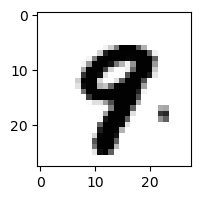

5.012066128208882e-21% - 0
3.027541917327643e-16% - 1
1.6393279459353697e-28% - 2
8.006028984064061e-27% - 3
6.867710832443378e-13% - 4
2.446935860647619e-05% - 5
1.1186946538843348e-21% - 6
0.0007152122180799235% - 7 - ОШИБКА
1.3949288929584574e-21% - 8
7.781974102722757e-05% - 9

 8


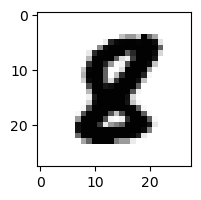

1.2429983139110999e-23% - 0
8.952317254169649e-15% - 1
1.4174632546364979e-22% - 2
9.2757329841072e-37% - 3
1.9727055245670918e-22% - 4
0.0001424078482347055% - 5 - ОШИБКА
3.4420378408670393e-28% - 6
9.130225419649418e-19% - 7
9.707906769088424e-19% - 8
2.6258259033444074e-44% - 9

 9


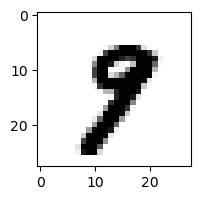

2.475021609383926e-19% - 0
3.948652855539135e-08% - 1
1.2970992846589237e-25% - 2
9.702651618230714e-17% - 3
4.322339468955372e-14% - 4
1.1373925929837888e-07% - 5
8.353230436787305e-22% - 6
0.829829721150515% - 7 - ОШИБКА
1.5744393924814908e-12% - 8
1.1347151246798972e-06% - 9

 8


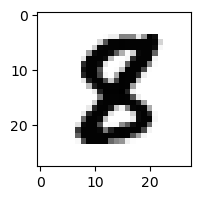

1.9576443384145117e-21% - 0
9.10765498820934e-12% - 1
8.822195829856815e-22% - 2
7.785267171106004e-25% - 3
3.277494006410426e-19% - 4
0.007705261957307811% - 5 - ОШИБКА
5.607725530622025e-26% - 6
2.527024347582314e-15% - 7
2.027788474487689e-17% - 8
1.7123196336699619e-44% - 9

 8


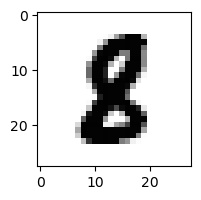

1.458174113609693e-21% - 0
1.9661855424658197e-10% - 1
3.318400502931036e-19% - 2
4.5589258877896775e-27% - 3
6.126379796888944e-22% - 4
0.0008131244967003832% - 5 - ОШИБКА
1.4682376349668744e-22% - 6
7.344047170549468e-16% - 7
2.248533917354211e-11% - 8
4.6293725590626606e-38% - 9

 8


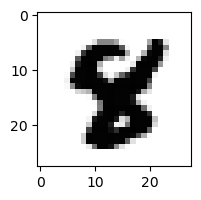

1.0959530045396573e-32% - 0
6.76970019629403e-20% - 1
5.7625877163863385e-43% - 2
1.7606227808345846e-38% - 3
3.3798668319755416e-15% - 4
0.030504896109850892% - 5 - ОШИБКА
2.1544567963273823e-28% - 6
5.233706655335041e-13% - 7
1.4800731273381878e-23% - 8
2.4970560300164316e-40% - 9

 8


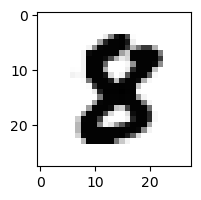

4.7550328660441095e-21% - 0
6.95664780825082e-16% - 1
3.9630526928019335e-21% - 2
3.082000746415522e-23% - 3
1.4370079640774261e-21% - 4
2.9151895001649635e-05% - 5 - ОШИБКА
2.4486081880431694e-27% - 6
2.3361195342536927e-13% - 7
5.613686390446638e-07% - 8
3.0095079864747383e-40% - 9

 9


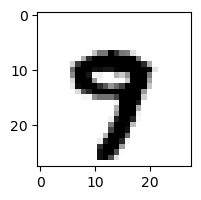

2.532612625446745e-21% - 0
2.843479088140034e-16% - 1
5.215097332046093e-34% - 2
1.1514126225344052e-25% - 3
4.881458103746617e-12% - 4
2.033436928989074e-05% - 5
5.816046866013065e-20% - 6
72.44594890515101% - 7 - ОШИБКА
8.453118965259332e-27% - 8
3.2523878575594112e-09% - 9

 8


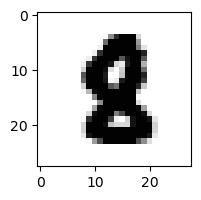

2.0855674858720432e-26% - 0
3.4452202894399493e-15% - 1
4.754403907111077e-23% - 2
9.687845083178558e-35% - 3
2.745173470942882e-20% - 4
2.6756120989635925e-05% - 5 - ОШИБКА
4.729575319389017e-24% - 6
1.4684890862936152e-15% - 7
3.632743780773807e-24% - 8
3.88398171163417e-34% - 9

 3


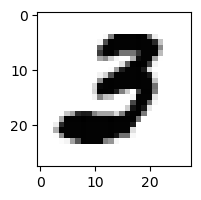

1.9354706666385248e-10% - 0
2.1574383776223395e-12% - 1
8.735903671011335e-14% - 2
5.398397019892652e-06% - 3
4.0490023682473286e-27% - 4
0.00013190645522769895% - 5 - ОШИБКА
1.3347458949736221e-22% - 6
4.189817982978313e-15% - 7
1.1390720369952247e-36% - 8
8.285371597620445e-50% - 9

 9


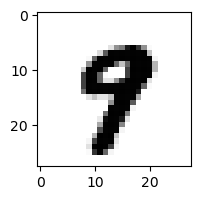

1.9299548099792669e-19% - 0
1.1128188457859001e-13% - 1
5.006822971009421e-30% - 2
2.7416095246726993e-25% - 3
9.604995306094067e-11% - 4
3.6028393112997605e-07% - 5
1.043299399583098e-21% - 6
0.03278241583778426% - 7 - ОШИБКА
6.563666871127803e-20% - 8
0.006137825584447806% - 9

 3


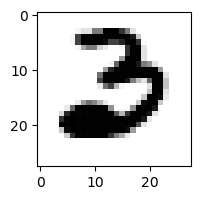

2.474146899544397e-08% - 0
3.44477134693972e-14% - 1
3.0232477011016273e-06% - 2 - ОШИБКА
3.94427495148952e-16% - 3
8.216116087930387e-33% - 4
4.646971395950234e-21% - 5
9.621878534003098e-13% - 6
2.9159340304821217e-13% - 7
6.950201582204521e-39% - 8
5.55024190763246e-57% - 9

 8


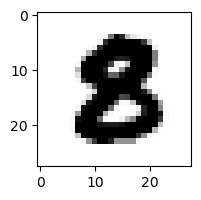

1.7641008301120992e-20% - 0
2.4820652264204757e-20% - 1
1.5261334588328892e-25% - 2
7.413067985877717e-26% - 3
5.863534992505814e-30% - 4
5.969866704212454e-07% - 5 - ОШИБКА
6.320604459695662e-28% - 6
2.3301149519266503e-19% - 7
3.272181016803096e-28% - 8
2.8883503414128954e-47% - 9

 8


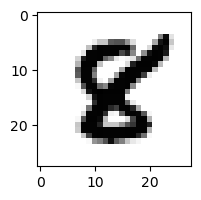

1.388652868469418e-22% - 0
4.191478978104133e-14% - 1
5.580968594754645e-22% - 2
1.9341982613673655e-30% - 3
1.3559681230106723e-16% - 4
0.018034876250368155% - 5 - ОШИБКА
5.206924997583416e-28% - 6
1.0983562446942899e-14% - 7
2.4754254731103894e-12% - 8
5.042357470263043e-38% - 9

 9


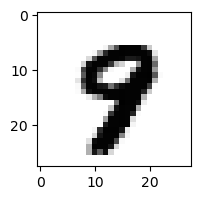

9.265582313684568e-20% - 0
4.019753846608908e-18% - 1
5.613225757472501e-30% - 2
7.789385185148752e-26% - 3
3.25111773256045e-11% - 4
2.836955688199136e-06% - 5
1.1422609176362754e-19% - 6
0.014771012596507548% - 7 - ОШИБКА
2.586313181370391e-18% - 8
0.0008431533276439154% - 9

 9


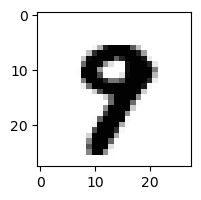

3.677367658340064e-22% - 0
1.8109635443728277e-14% - 1
4.893150916017284e-30% - 2
1.2014499923363375e-24% - 3
1.0325920315439788e-13% - 4
1.998385890873672e-08% - 5
6.886094323096038e-22% - 6
0.03245382230006748% - 7 - ОШИБКА
4.811674114072043e-15% - 8
3.415154825189366e-06% - 9

 8


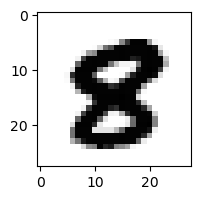

7.656939357982364e-22% - 0
7.013846941404071e-24% - 1
1.755843297779434e-33% - 2
3.1078509650201706e-39% - 3
2.0260494978105108e-22% - 4
9.157189645666454e-06% - 5 - ОШИБКА
1.9333974868106704e-34% - 6
4.801214028928876e-17% - 7
1.6529934086368625e-12% - 8
1.0393456478875743e-33% - 9

 3


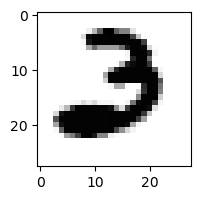

7.25048772520202e-10% - 0
8.180940244410121e-14% - 1
0.5934993515472515% - 2 - ОШИБКА
1.9349410168010267e-18% - 3
1.8898976142716496e-28% - 4
1.3656847775789785e-17% - 5
4.8220099462504104e-17% - 6
2.6138897760998043e-11% - 7
2.1029279839337807e-40% - 8
2.6002320371613684e-54% - 9

 8


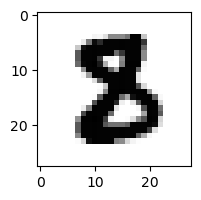

2.8324671601385573e-24% - 0
1.7120858838658984e-15% - 1
3.19426847217698e-16% - 2
2.348203968496265e-21% - 3
1.3443559730280362e-31% - 4
9.800797662459005e-05% - 5 - ОШИБКА
6.636490534438713e-24% - 6
1.0093741014774861e-15% - 7
8.223621752255281e-29% - 8
2.3637815014343388e-58% - 9

 5


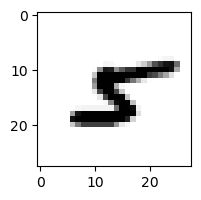

1.287291460622168e-14% - 0
0.00011813507504629752% - 1
8.162698059503559e-13% - 2
2.848834941739663e-18% - 3
1.72204087490254e-07% - 4
9.122110404026641e-07% - 5
1.5247413823353244e-06% - 6
3.651290573375064e-07% - 7
41.226676961564316% - 8 - ОШИБКА
1.359410130541257e-18% - 9

 9


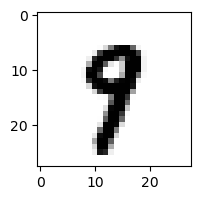

8.595762956941117e-19% - 0
7.277477194121506e-06% - 1
9.403498253920532e-22% - 2
5.165044960994932e-17% - 3
3.176434923206322e-09% - 4
0.002809655069536132% - 5
1.942631993825501e-16% - 6
0.012256083013777803% - 7 - ОШИБКА
1.1312692580157084e-11% - 8
0.0007737781641192881% - 9

 3


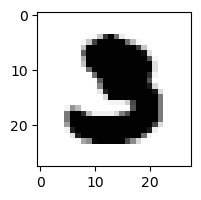

6.274307847839533e-22% - 0
4.198902431147825e-21% - 1
1.0877109942956179e-20% - 2
2.0142660845892206e-09% - 3
6.403126846036377e-41% - 4
2.8623644948849847e-06% - 5 - ОШИБКА
3.470415877197491e-33% - 6
8.89953451377166e-14% - 7
2.1299309325713343e-48% - 8
4.7674432397800104e-64% - 9

 5


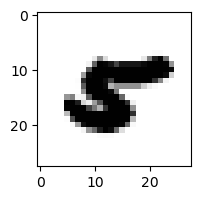

1.0798278248752796e-16% - 0
8.920033090279937e-13% - 1
8.262587653545531e-25% - 2
1.1940915475853444e-44% - 3
1.6726265224275479e-09% - 4 - ОШИБКА
1.6176525761586233e-14% - 5
1.5477034418198726e-14% - 6
3.514395648387325e-10% - 7
1.5713818175598822e-14% - 8
3.8723839656764765e-27% - 9

 8


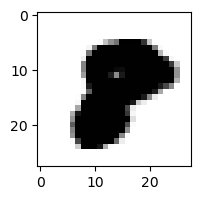

3.983498442953037e-23% - 0
6.793900439144358e-24% - 1
2.509082463311513e-39% - 2
7.247381972550921e-52% - 3
8.335815913504642e-30% - 4
1.6388917898483688e-17% - 5
1.3389034292083264e-35% - 6
4.056931886936129e-15% - 7 - ОШИБКА
9.816630809935908e-27% - 8
2.8952702657430713e-50% - 9

 3


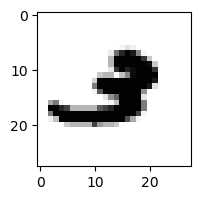

1.3745494720197962e-17% - 0
6.6269211308747604e-09% - 1
1.0293892988259185e-09% - 2
3.249841717062619e-20% - 3
2.935304238410348e-11% - 4
2.569814961914999e-15% - 5
4.24181177226974e-15% - 6
5.274422458372153e-06% - 7 - ОШИБКА
1.6295927088191296e-20% - 8
2.7472764511750276e-10% - 9

 5


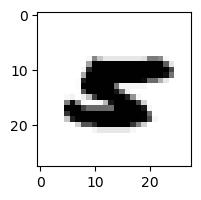

2.7470364141573136e-20% - 0
4.743064796079623e-14% - 1
4.4965022057317426e-26% - 2
3.404753712544696e-39% - 3
7.185026982573727e-13% - 4
9.371704518950207e-15% - 5
2.6654274574936403e-15% - 6
4.66962271169089e-10% - 7 - ОШИБКА
8.090580663271145e-23% - 8
1.4769003477037471e-30% - 9

 6


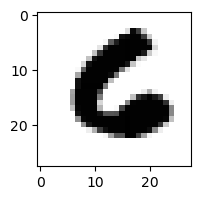

1.9039999322672023e-06% - 0
2.3594409221421524e-23% - 1
5.764886112724695e-14% - 2
1.1606401315493164e-38% - 3
6.223268589505351e-24% - 4
0.03625138700391223% - 5 - ОШИБКА
0.010830360979634591% - 6
1.1600620875334135e-16% - 7
5.233214830957809e-60% - 8
4.504635995792701e-45% - 9

 8


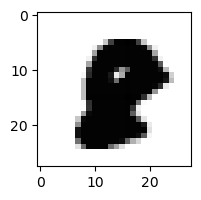

2.437721721184959e-26% - 0
1.217748191619e-21% - 1
1.3596568475046926e-39% - 2
1.8521754915218243e-46% - 3
5.76242352664036e-28% - 4
2.9601807257638124e-16% - 5 - ОШИБКА
2.107892229464932e-31% - 6
2.2982062783840145e-16% - 7
1.554328105504188e-27% - 8
1.37234992361808e-47% - 9

 9


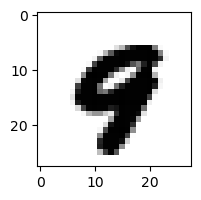

5.805055120443122e-23% - 0
6.140817874555839e-20% - 1
2.1284746569444256e-38% - 2
1.0478883889749945e-43% - 3
1.248241289291553e-07% - 4
2.8866659694769475e-10% - 5
2.790315790119808e-20% - 6
0.0002814712948816285% - 7 - ОШИБКА
2.0926233606713386e-32% - 8
3.5316284459727626e-15% - 9

 2


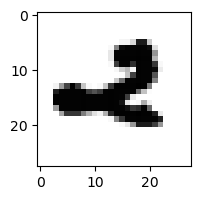

1.1677311746744133e-14% - 0
5.6638994713464926e-11% - 1
6.73183448088908e-06% - 2
7.4045110578969e-25% - 3
5.869730236616162e-07% - 4
1.9246872694931566e-16% - 5
1.2869465713398191e-17% - 6
2.7936604057532482e-12% - 7
1.7077779606707984e-30% - 8
1.662032518421398e-05% - 9 - ОШИБКА

 3


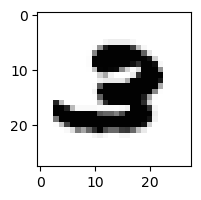

5.770166362301209e-18% - 0
1.520466491651872e-16% - 1
2.60995592005647e-06% - 2 - ОШИБКА
2.0302853909866356e-19% - 3
1.6901412334641226e-29% - 4
1.1445451821263905e-11% - 5
4.6696964731716816e-17% - 6
1.7821586813664178e-10% - 7
1.5800738584448121e-29% - 8
3.4353235256453827e-28% - 9

 5


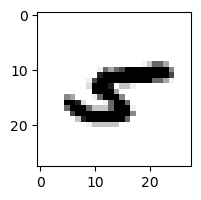

9.029809030226817e-12% - 0
2.8262759847313953e-05% - 1
1.489534122322655e-12% - 2
6.718924520223697e-25% - 3
0.19865866024805748% - 4
3.881683787263995e-18% - 5
7.075187816819912e-05% - 6
3.4387459081891584e-07% - 7
1.06554567098207% - 8 - ОШИБКА
4.6033334548147e-12% - 9

 6


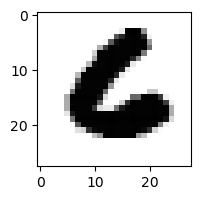

1.4053644788894682e-08% - 0
1.7339453788677493e-24% - 1
2.233491303351057e-15% - 2
4.556670244052642e-41% - 3
3.877582137035411e-26% - 4
0.0035045841545544134% - 5 - ОШИБКА
2.364310362990519e-05% - 6
3.540575870369219e-21% - 7
1.1176136123817091e-62% - 8
2.1339430404227032e-51% - 9

 8


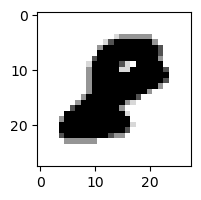

3.6455080481039975e-19% - 0
1.8849911548815135e-17% - 1
9.350657823279465e-23% - 2
8.24903924741882e-47% - 3
2.6056222100435557e-29% - 4
1.809113855531695e-16% - 5 - ОШИБКА
5.71195450371257e-29% - 6
3.248288968370548e-19% - 7
1.3526663521222637e-29% - 8
8.212603446090578e-43% - 9

 9


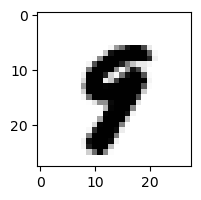

2.2369971878674926e-24% - 0
1.1927538529994169e-11% - 1
3.663074032756811e-32% - 2
9.458249015525206e-27% - 3
3.095488837796381e-11% - 4
0.0007875603325419925% - 5 - ОШИБКА
2.0497172987802807e-18% - 6
1.917030168390304e-05% - 7
5.267052977266746e-26% - 8
2.2609549993041902e-07% - 9

 9


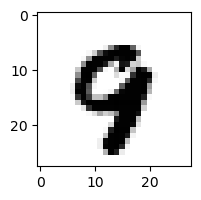

8.07341415402093e-22% - 0
4.03049662229304e-15% - 1
1.6353760906854343e-24% - 2
4.219920072862398e-37% - 3
7.978927428478522e-10% - 4
1.4569331034511822e-09% - 5
1.576270059080345e-13% - 6
0.6140672999666102% - 7 - ОШИБКА
4.2186593612296003e-22% - 8
0.00029218112811146623% - 9

 5


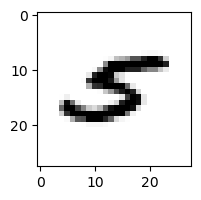

1.3799677841962855e-10% - 0
1.9497210012942296e-06% - 1
1.0044581043222157e-14% - 2
2.4173889808154076e-23% - 3
0.008435603049752322% - 4
2.549189343541407e-05% - 5
6.53007308922267e-16% - 6
0.0339085909097567% - 7 - ОШИБКА
1.5898634767794846e-11% - 8
1.59241819293214e-15% - 9

 8


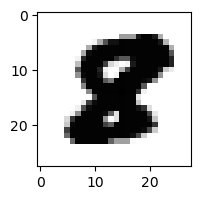

1.4461343598373758e-28% - 0
3.1051915156711124e-25% - 1
1.3905025228513296e-29% - 2
2.965857295408472e-47% - 3
5.0383458779356823e-29% - 4
8.396192289423597e-05% - 5 - ОШИБКА
1.0841069407688902e-38% - 6
2.4897826976343744e-22% - 7
2.7773309628908628e-28% - 8
5.921416242275667e-60% - 9

 8


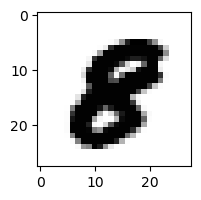

1.1725342597761169e-20% - 0
2.1471923107440682e-20% - 1
5.567356459115664e-29% - 2
1.1349551710063056e-40% - 3
4.456107828206184e-21% - 4
8.846497909440737e-11% - 5 - ОШИБКА
7.174678678016257e-29% - 6
2.676508977102819e-18% - 7
1.213483281285941e-17% - 8
4.727032654802248e-34% - 9

 9


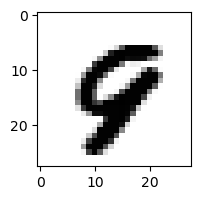

4.0487298654317134e-15% - 0
5.510715838724475e-17% - 1
3.8300576757771096e-26% - 2
1.043148609599163e-45% - 3
7.933375143835572e-08% - 4
4.539738429446498e-12% - 5
1.6933253652754572e-11% - 6
0.002759976495958351% - 7 - ОШИБКА
1.119269407201407e-22% - 8
2.826766447016364e-06% - 9

 3


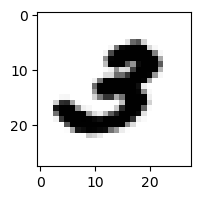

4.144551077574331e-13% - 0
2.2932717986068436e-13% - 1
3.937474800421512e-09% - 2
2.9756123990226965e-11% - 3
6.947341438871544e-21% - 4
7.683929293763313e-09% - 5 - ОШИБКА
1.7955887194755337e-22% - 6
1.9311437888642915e-09% - 7
1.315650912298073e-31% - 8
2.5899467532570893e-24% - 9

 2


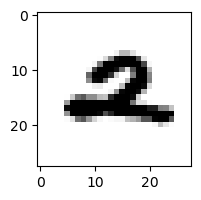

7.549921422935284e-14% - 0
3.1223357515906437e-10% - 1
0.00024266126469581044% - 2
7.084462280803218e-31% - 3
3.1124244774429945e-07% - 4
2.8815272921179255e-14% - 5
2.0141275095236742e-10% - 6
0.00034360223884625493% - 7 - ОШИБКА
2.371403441179689e-20% - 8
1.990893186669126e-11% - 9

 8


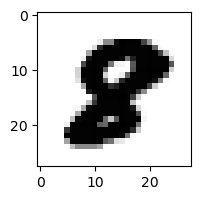

3.1838847097585695e-22% - 0
2.177908724489743e-22% - 1
1.1313957143363515e-28% - 2
6.523353664637091e-48% - 3
1.4106462669318207e-26% - 4
2.17286886752011e-09% - 5 - ОШИБКА
3.315608234534959e-31% - 6
1.0461319407344587e-16% - 7
8.107991756642385e-12% - 8
6.278943049053583e-42% - 9

 9


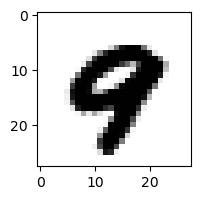

1.389756371722389e-19% - 0
9.796459986515574e-22% - 1
6.215096044808117e-37% - 2
2.472286279194895e-47% - 3
4.5779251725956214e-10% - 4
1.4967706664044361e-13% - 5
2.546257697039584e-23% - 6
0.0005406218191521541% - 7 - ОШИБКА
2.9491474241171777e-24% - 8
4.291550082589712e-07% - 9

 2


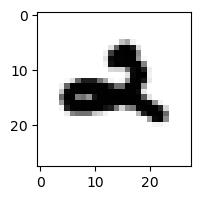

1.1954602059613048e-09% - 0
2.376510177733707e-11% - 1
1.2614522286395247e-14% - 2
1.5091580239881216e-16% - 3
49.539861764376276% - 4
7.548116463843546e-14% - 5
2.7494748669810365e-11% - 6
6.740553326321403e-08% - 7
1.1826860741444187e-37% - 8
99.95925958101374% - 9 - ОШИБКА

 5


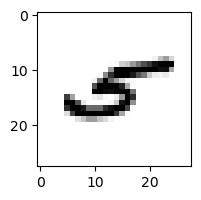

2.1869720139808094e-10% - 0
0.007242597790975919% - 1
3.352339467370638e-08% - 2
1.3059063822942736e-17% - 3
97.38430705008649% - 4 - ОШИБКА
1.6788842243714488e-10% - 5
8.258676015468743e-11% - 6
0.001031027780894984% - 7
0.015149105651956913% - 8
9.241301987075659e-10% - 9

 9


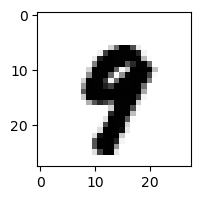

2.789167854891644e-23% - 0
2.5664817087843775e-14% - 1
1.5063976084456053e-33% - 2
4.688703903703217e-23% - 3
9.44915273795446e-11% - 4
1.1553812760304405e-06% - 5
2.526332414450061e-20% - 6
0.0023927409902621843% - 7 - ОШИБКА
2.302776607889637e-23% - 8
0.0004420564448782204% - 9

 3


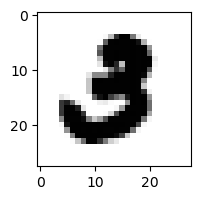

2.926202724142847e-15% - 0
7.102372466025665e-17% - 1
1.9306724141049096e-19% - 2
7.198488789153307e-08% - 3
1.1859844236300782e-29% - 4
3.3469105525426295e-05% - 5 - ОШИБКА
3.2242733260203124e-30% - 6
8.633110175149058e-15% - 7
7.186785768864485e-50% - 8
5.672632980807288e-47% - 9

 9


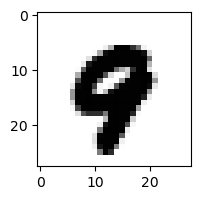

3.972439967924295e-22% - 0
5.358191671423192e-19% - 1
5.25792408976308e-33% - 2
1.4690322261647244e-49% - 3
2.7746889184082326e-11% - 4
8.24292498815179e-13% - 5
1.0897125823689673e-19% - 6
0.0009295021513288272% - 7 - ОШИБКА
2.3312366068286816e-29% - 8
1.446681990559711e-06% - 9

 8


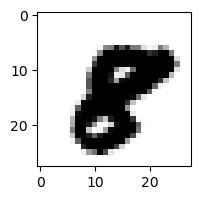

6.525793101617648e-27% - 0
2.2367758584836167e-22% - 1
1.8067447594096303e-38% - 2
3.4178824916948436e-49% - 3
1.68364597640684e-25% - 4
2.5244886345398346e-11% - 5 - ОШИБКА
5.777032227393244e-34% - 6
1.5117557886421638e-13% - 7
1.3652540054040767e-12% - 8
4.311930279499316e-34% - 9

 3


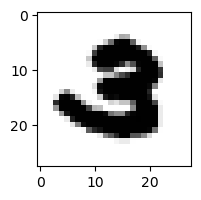

8.227695567803904e-19% - 0
1.0551671508266045e-19% - 1
2.1774888426869376e-11% - 2 - ОШИБКА
1.7830536324835755e-23% - 3
3.877679082898326e-30% - 4
2.418891923847422e-15% - 5
1.0763242818409811e-21% - 6
1.0923425756883802e-15% - 7
1.5856878025569967e-39% - 8
5.729906513903688e-44% - 9

 2


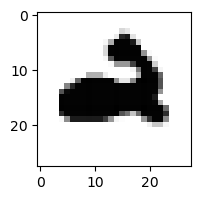

2.281031996222799e-12% - 0
5.943649492683692e-19% - 1
1.732095364055923e-18% - 2
2.2811836238882532e-35% - 3
0.00013695507606873605% - 4 - ОШИБКА
2.1490113703223383e-19% - 5
4.5067285499660526e-12% - 6
1.1789430657897035e-16% - 7
6.825910953888131e-43% - 8
1.2460751765559776e-13% - 9

 5


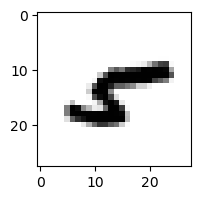

7.029050422141707e-11% - 0
0.0004615064541260669% - 1
7.2545310437312825e-09% - 2
1.161902222505882e-21% - 3
0.00015182015858624341% - 4
2.323303732672685e-15% - 5
0.005910867473592862% - 6
9.37412061946043e-09% - 7
23.434563425460684% - 8 - ОШИБКА
7.946929547800025e-12% - 9

 8


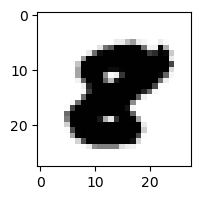

1.3956435061147564e-25% - 0
9.740238312708988e-25% - 1
2.584973512367519e-36% - 2
1.069934113634195e-57% - 3
9.916347139269953e-28% - 4
2.282129727301872e-11% - 5 - ОШИБКА
2.6972877197560493e-40% - 6
1.770238920055038e-16% - 7
3.416213671967035e-24% - 8
3.2577296101119213e-46% - 9

 8


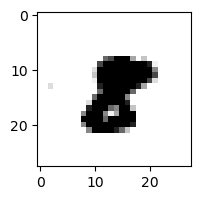

8.17199214255882e-22% - 0
0.005439579063955722% - 1 - ОШИБКА
2.2820742756040326e-16% - 2
3.5347101008698257e-25% - 3
3.3099214404756233e-14% - 4
2.610748363373099e-13% - 5
1.127841251944022e-07% - 6
9.935030483634799e-08% - 7
9.300534581940011e-08% - 8
1.4187665000188295e-15% - 9

 8


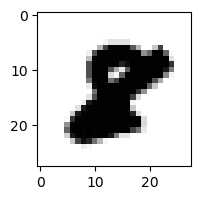

3.987753920267731e-23% - 0
8.390812594684582e-19% - 1
2.0068725748143927e-23% - 2
1.5018443095590198e-44% - 3
1.6658336502198035e-28% - 4
1.5213168551762263e-11% - 5 - ОШИБКА
9.458897449301878e-31% - 6
3.3785535555216224e-14% - 7
1.0837880869255917e-15% - 8
9.335626858151285e-35% - 9

 8


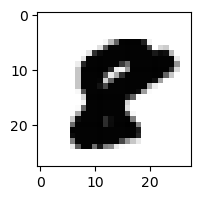

8.147149748957207e-25% - 0
7.412109523679554e-22% - 1
4.836687202145029e-40% - 2
2.3470700058731848e-54% - 3
2.18031772316907e-29% - 4
4.9502411075330773e-08% - 5 - ОШИБКА
1.0362359321901123e-36% - 6
2.3019213104148322e-17% - 7
8.66248972652747e-16% - 8
1.3860558810338572e-46% - 9

 6


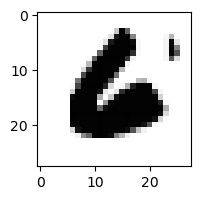

2.798605432080822e-19% - 0
2.024405195187903e-24% - 1
1.071451615373504e-18% - 2
1.6601778726030752e-47% - 3
8.463996025816275e-22% - 4
0.006377174769332312% - 5 - ОШИБКА
0.0012503616688207164% - 6
2.2636402904801932e-18% - 7
1.6367320872486113e-55% - 8
1.1990115249023629e-47% - 9

 9


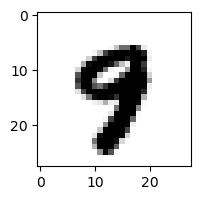

1.4629307161722953e-21% - 0
6.147604151269317e-16% - 1
2.4493974054488994e-33% - 2
1.897675597558615e-24% - 3
1.3526893862586324e-10% - 4
0.00071499806694967% - 5
9.827830473846097e-21% - 6
0.0008954866394884972% - 7 - ОШИБКА
1.137873043952842e-24% - 8
0.0006086566630166651% - 9

 3


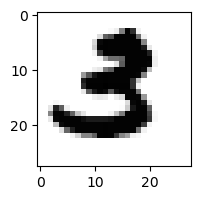

5.65006031186777e-16% - 0
1.040782492982857e-15% - 1
1.1685750806226084e-21% - 2
0.0007514639776860773% - 3
2.4962498882588753e-31% - 4
0.06773083996919874% - 5 - ОШИБКА
8.64096993912443e-25% - 6
4.995780333140371e-16% - 7
3.047616007198397e-51% - 8
2.9108833830492213e-45% - 9

 2


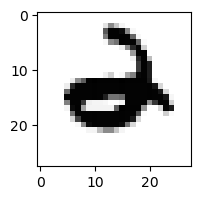

4.776937854224067e-14% - 0
1.580817577854067e-15% - 1
4.0480580220338677e-22% - 2
7.764809128922237e-28% - 3
0.255405347016872% - 4
8.029203505758213e-13% - 5
15.836519550860054% - 6 - ОШИБКА
2.301836852170149e-13% - 7
5.3552453827647555e-45% - 8
1.891720457849551e-27% - 9

 8


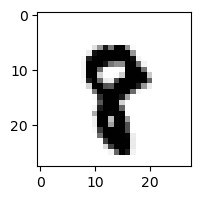

2.2113374481213757e-25% - 0
1.5821313266780968e-08% - 1
1.7528907180003743e-22% - 2
1.4765273170709972e-30% - 3
5.498511445235387e-15% - 4
6.430952959750368e-07% - 5
4.223588719661483e-14% - 6
0.0008390633535989875% - 7 - ОШИБКА
4.390158084964265e-07% - 8
5.659379489237645e-08% - 9

 9


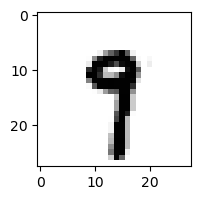

7.695005290425985e-19% - 0
0.00019988257706026786% - 1
3.6686227968606524e-23% - 2
5.505922957868374e-13% - 3
8.278407810526964e-07% - 4
0.00415785709131231% - 5
2.426894212686036e-13% - 6
7.386153203947673% - 7 - ОШИБКА
6.586045215943141e-10% - 8
0.00805993398983994% - 9

 8


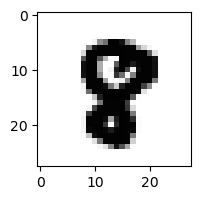

4.549394274542982e-23% - 0
2.27858001127454e-15% - 1
1.2925280491480053e-24% - 2
4.3401790352256384e-38% - 3
4.083624838216723e-20% - 4
1.7521974563129726e-10% - 5
4.4676284502834315e-25% - 6
6.911142144060625e-09% - 7 - ОШИБКА
4.286235204000368e-12% - 8
1.1531858550869327e-31% - 9

 9


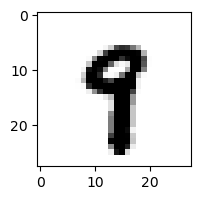

3.8007167186343516e-22% - 0
1.0867594608903238e-07% - 1
6.906407106354048e-28% - 2
1.2781966116285531e-19% - 3
3.416394860716443e-08% - 4
0.00977767535621457% - 5 - ОШИБКА
4.0771324797239597e-19% - 6
0.0056989515712235084% - 7
2.9614944699998725e-15% - 8
3.1414397407153824e-05% - 9

 9


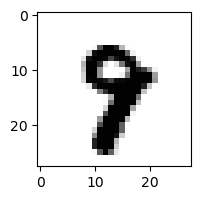

1.6168416047922315e-23% - 0
2.3166538023799808e-12% - 1
1.9191792089594792e-26% - 2
5.9355808031059346e-24% - 3
2.2703523585457452e-11% - 4
1.9827371800123388e-08% - 5
4.771888381795376e-15% - 6
0.016013959742610485% - 7 - ОШИБКА
2.385618639926782e-12% - 8
2.580399482391965e-08% - 9

 8


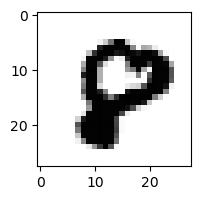

1.09787460694151e-07% - 0
1.929257535041184e-21% - 1
4.7567662640055795e-24% - 2
2.0276181391626238e-42% - 3
7.013284365602045e-16% - 4
2.3206575229775403e-12% - 5
2.0670360418938447e-22% - 6
3.115190862533355e-07% - 7 - ОШИБКА
3.6424176151537153e-16% - 8
2.512140884671765e-35% - 9

 9


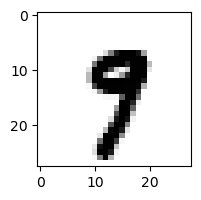

2.608069124262698e-18% - 0
5.171191273584163e-10% - 1
2.3065503657271485e-27% - 2
5.447264125370939e-12% - 3
2.1467564914350432e-10% - 4
3.916017576967532e-05% - 5
3.3147581568856497e-18% - 6
2.0779505548603128% - 7 - ОШИБКА
7.315142723035526e-14% - 8
0.0017356589117661664% - 9

 9


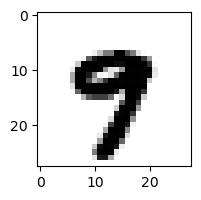

1.3328650191780814e-20% - 0
1.222934816244344e-16% - 1
1.9465678052902754e-40% - 2
3.6166072910711037e-23% - 3
1.1522792509884252e-10% - 4
9.87319778776892e-06% - 5
1.5877201382255336e-22% - 6
0.055377456993593206% - 7 - ОШИБКА
1.5679599521451588e-28% - 8
3.2315326400697736e-06% - 9

 3


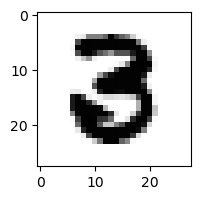

8.078081679518685e-14% - 0
1.578578500964362e-16% - 1
3.8129765439667686e-12% - 2
6.859631027388935e-14% - 3
1.69216739066298e-23% - 4
1.2075416224120374e-11% - 5 - ОШИБКА
1.0961440971141727e-21% - 6
9.798965931044308e-16% - 7
2.3850877113899783e-34% - 8
2.946490349387036e-52% - 9

 8


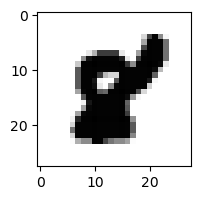

1.3973432282741324e-24% - 0
2.4453557163179133e-13% - 1
2.1290747590042696e-34% - 2
3.2676642995345253e-56% - 3
1.4102864013906926e-18% - 4
1.8344222436320237e-06% - 5 - ОШИБКА
8.484107078470886e-28% - 6
8.890342559309902e-11% - 7
1.064467044704022e-25% - 8
9.711231161052553e-39% - 9

 8


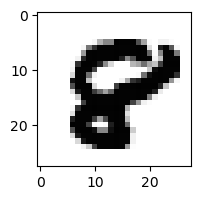

9.06422783908506e-21% - 0
1.1828381615725984e-25% - 1
1.0813200761309739e-29% - 2
2.5499658163775446e-59% - 3
3.810232774107481e-23% - 4
8.064871822526474e-08% - 5 - ОШИБКА
2.483607329108579e-28% - 6
1.317551714315898e-15% - 7
2.0504992428786538e-17% - 8
1.9823444080968504e-45% - 9

 9


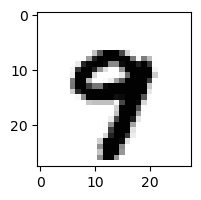

3.3783677983653666e-22% - 0
1.6456873907045234e-16% - 1
1.1422752958185431e-32% - 2
8.756892333479642e-24% - 3
4.20566243519646e-09% - 4
5.016440548806327e-07% - 5
2.423077115123327e-18% - 6
0.04149117073674824% - 7 - ОШИБКА
3.068512891102797e-26% - 8
0.0002252685375351521% - 9

 9


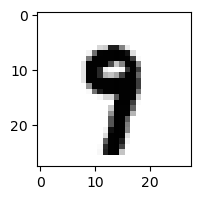

1.0777745188837926e-23% - 0
1.3693592908034152e-09% - 1
6.670195308214221e-28% - 2
1.1303345930582867e-19% - 3
2.0889916302528388e-09% - 4
0.006905923240629692% - 5
6.1077008424688e-17% - 6
0.06571864210993045% - 7 - ОШИБКА
5.295267728369892e-16% - 8
4.416626841416247e-07% - 9

 9


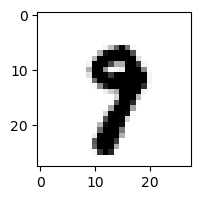

2.1309427225617893e-20% - 0
2.6954536157389e-08% - 1
3.309060451010179e-26% - 2
8.361721094545617e-17% - 3
7.487659347096008e-14% - 4
3.3063992550578414e-05% - 5
1.0520513448286606e-16% - 6
2.355130965356842% - 7 - ОШИБКА
6.63333809635558e-13% - 8
1.5782496771980324e-08% - 9

 3


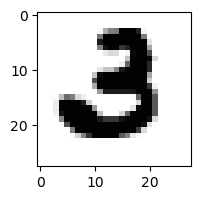

3.864406874417004e-12% - 0
2.433751442124545e-16% - 1
6.341521602801992e-13% - 2
2.1494963865075493e-10% - 3
7.776767678261218e-28% - 4
1.5301656348121773e-09% - 5 - ОШИБКА
2.055268863544574e-17% - 6
3.751766791788149e-18% - 7
7.35485619067514e-46% - 8
1.1042182294357102e-55% - 9

 9


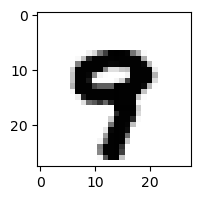

2.779813232617201e-23% - 0
4.1565167925340024e-17% - 1
8.695412296765169e-33% - 2
1.7402740719888783e-32% - 3
2.327510245054292e-11% - 4
1.9118702859152871e-07% - 5
2.3541436897278416e-19% - 6
0.015237926080507343% - 7 - ОШИБКА
2.821566831382732e-25% - 8
0.0007029552927986882% - 9

 4


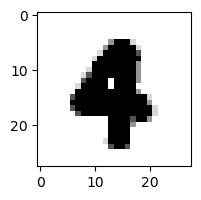

5.921424845352328e-28% - 0
1.1203055462082253e-13% - 1
1.2812757579314591e-31% - 2
2.0508465611052426e-41% - 3
4.396091184942558e-10% - 4
2.277402174175443e-10% - 5
2.1148100922048277e-18% - 6
9.99712871933994e-09% - 7 - ОШИБКА
2.254212283386108e-45% - 8
5.589872925589459e-27% - 9

 8


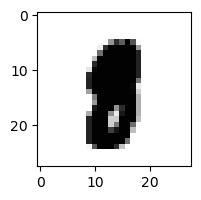

1.2322771778229607e-25% - 0
4.38665859285465e-11% - 1
1.0798060639906945e-32% - 2
5.6143570213543545e-30% - 3
7.511204092385289e-22% - 4
6.990159368303547e-05% - 5 - ОШИБКА
1.1823872667358742e-21% - 6
1.7367246149378192e-10% - 7
3.305550317468245e-17% - 8
7.253442552691747e-29% - 9

 9


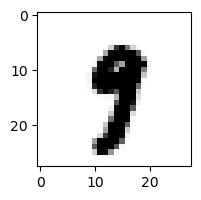

9.325115891898956e-21% - 0
5.0638285763880095e-08% - 1
2.4481351988161157e-31% - 2
3.2293013335916556e-12% - 3
4.680587926962116e-13% - 4
0.0002999549212586617% - 5
3.2537033997464427e-21% - 6
0.2529032956671519% - 7 - ОШИБКА
1.3961948903810633e-18% - 8
2.2144594781100278e-10% - 9

 8


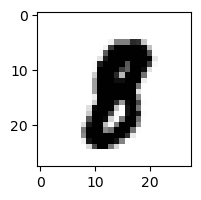

6.595676423913475e-22% - 0
7.357953637726704e-10% - 1
2.4113499336360856e-27% - 2
1.4367065171233034e-21% - 3
1.3716915029682203e-23% - 4
1.875021832344092e-06% - 5 - ОШИБКА
7.05786919455534e-24% - 6
2.190324267780612e-10% - 7
2.9043574462081847e-13% - 8
4.944349739342698e-27% - 9

 4


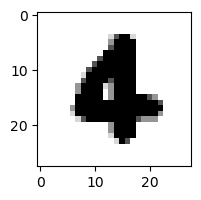

3.200244047434441e-26% - 0
4.627353670038184e-13% - 1
3.937084953210898e-26% - 2
1.5946843734109148e-41% - 3
1.3184253415287102e-14% - 4
1.3710003978971297e-09% - 5 - ОШИБКА
2.9676460068395293e-10% - 6
3.099912917682773e-11% - 7
3.505374610738541e-53% - 8
6.492828221907862e-33% - 9

 2


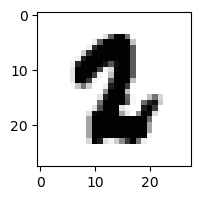

1.3031842470176955e-29% - 0
2.8342279981476017e-07% - 1
1.0104561122350699e-19% - 2
7.357202244916732e-31% - 3
2.9741841066218584e-29% - 4
0.0004057710984293586% - 5 - ОШИБКА
2.3945289208423944e-17% - 6
5.1371857886246335e-12% - 7
3.0034256558110645e-31% - 8
5.540357233497415e-43% - 9

 9


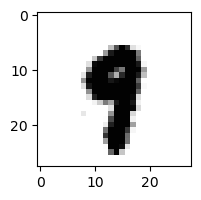

1.5425438412705082e-25% - 0
4.085403075666236e-09% - 1
1.5711196857045832e-33% - 2
3.0141874458571063e-21% - 3
6.474519646360984e-10% - 4
0.0007779888550128533% - 5
1.8409563948527119e-19% - 6
0.0015959461877809904% - 7 - ОШИБКА
1.6705630433770048e-23% - 8
2.010195381508824e-09% - 9

 2


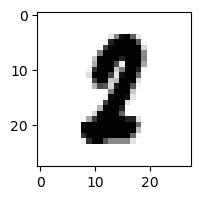

5.7873191533462055e-21% - 0
5.916406347186198e-05% - 1
9.498825862874002e-20% - 2
2.9703864093009987e-27% - 3
5.187027980043048e-24% - 4
0.0035715421779426455% - 5 - ОШИБКА
1.5952363929454609e-19% - 6
2.7836013786823686e-07% - 7
2.0677509978138727e-19% - 8
7.570807011680318e-35% - 9

 4


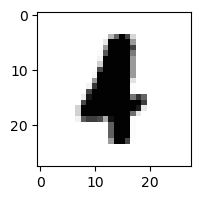

1.6399199607893014e-25% - 0
2.7014905522996666e-06% - 1 - ОШИБКА
1.6239837532367209e-15% - 2
4.174827383027035e-32% - 3
6.717193699513793e-12% - 4
5.8600287400974284e-08% - 5
8.02757233360232e-11% - 6
1.9694935888224778e-11% - 7
1.4698171103726234e-26% - 8
9.946214995156022e-20% - 9

 8


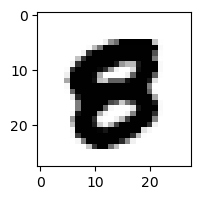

3.7761316511798974e-16% - 0
1.6163545848345176e-26% - 1
1.070334396761768e-37% - 2
4.6401208557556e-37% - 3
4.248122642079519e-25% - 4
7.73952766476033e-07% - 5 - ОШИБКА
1.3886849151013917e-27% - 6
1.1879347826899097e-17% - 7
3.464590183980276e-33% - 8
5.327376115923414e-40% - 9

 6


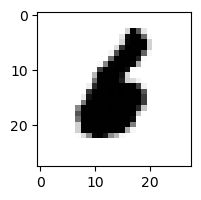

1.3195237924629207e-23% - 0
5.6460444745516013e-11% - 1
1.9714497214666043e-16% - 2
6.345115799117851e-38% - 3
8.063300823252442e-17% - 4
4.3857164721046665e-07% - 5 - ОШИБКА
1.1127403923454683e-07% - 6
2.934346234287304e-15% - 7
8.37064925355548e-37% - 8
7.732493076332019e-31% - 9

 8


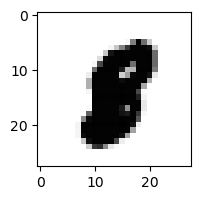

1.6246907211230904e-24% - 0
7.141565501112389e-13% - 1
6.845182274642695e-32% - 2
5.112511350428083e-34% - 3
2.9634996575746766e-23% - 4
2.049270520147902e-08% - 5 - ОШИБКА
1.6511125373363421e-22% - 6
4.082783641530436e-11% - 7
3.9674844721620324e-22% - 8
1.4373831605568295e-30% - 9

 9


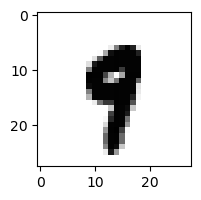

3.184002249108966e-23% - 0
1.0544891933908049e-07% - 1
2.150913825073462e-27% - 2
7.718973986104452e-21% - 3
7.270231365082749e-09% - 4
0.00130668510658694% - 5
1.7975840760331046e-18% - 6
0.009030670832414284% - 7 - ОШИБКА
4.7092622260678625e-22% - 8
3.7463964553379926e-06% - 9

 3


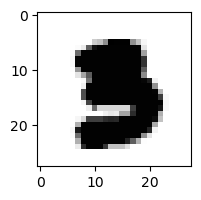

2.991213298913368e-29% - 0
6.232096026975831e-24% - 1
5.2630825580824506e-39% - 2
4.720501506375154e-21% - 3
6.484999584152442e-30% - 4
0.001311545576566896% - 5 - ОШИБКА
9.537596105760802e-29% - 6
5.616624746347521e-14% - 7
1.2080339207036945e-54% - 8
4.836881126402368e-59% - 9

 8


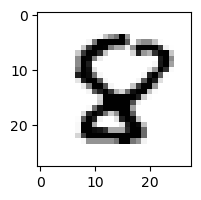

2.791209482450743e-19% - 0
5.00153139559667e-16% - 1
2.0748560931845012e-14% - 2
9.849182421901033e-39% - 3
1.262579052347173e-06% - 4
0.010486443875863298% - 5 - ОШИБКА
2.4912816643224373e-16% - 6
7.097805680800255e-14% - 7
0.0006722672927433473% - 8
1.3983225385635563e-42% - 9

 9


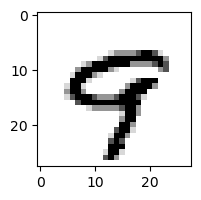

1.0428822985716035e-12% - 0
8.651183067313518e-14% - 1
2.229319799751322e-24% - 2
5.304437917083618e-34% - 3
0.00011955219445981179% - 4
0.1301133259082359% - 5
1.09912868365527e-16% - 6
0.3372652560264532% - 7 - ОШИБКА
5.132144654196955e-16% - 8
0.0020087707496088403% - 9

 8


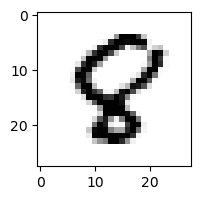

6.730616272732089e-16% - 0
3.604911003975258e-11% - 1
9.033831376142185e-13% - 2
7.603496989771419e-33% - 3
5.031440936848809e-07% - 4
0.2683115870287723% - 5 - ОШИБКА
5.636339297426257e-10% - 6
1.2900851133970173e-09% - 7
0.0008758468188740288% - 8
1.6092196934020411e-28% - 9

 6


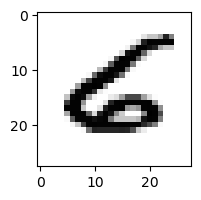

1.3604693778992102e-07% - 0
2.350959316457881e-09% - 1
8.657666039133243e-16% - 2
2.946631508218155e-26% - 3
1.958858176058403e-08% - 4
0.03621564506277239% - 5 - ОШИБКА
0.012205192545877614% - 6
5.931809032083821e-11% - 7
5.369965476434417e-52% - 8
2.9039659449968835e-39% - 9

 3


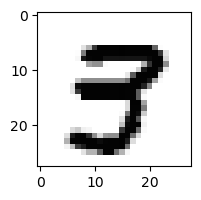

1.1509253868026959e-15% - 0
9.399720497730545e-20% - 1
2.5833583147220215e-33% - 2
0.0005540985495289671% - 3
2.9211694984557007e-14% - 4
0.001341495995087108% - 5 - ОШИБКА
8.361176730419004e-27% - 6
6.859723700451432e-05% - 7
3.7883060435609177e-19% - 8
8.782872425129395e-13% - 9

 5


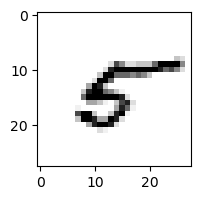

0.0011012609466255555% - 0
0.001294640901866837% - 1
8.258095799595314e-07% - 2
9.678031144071783e-08% - 3
1.6488525634263154% - 4 - ОШИБКА
0.13316176212998426% - 5
0.00242017599121391% - 6
0.010416076956746817% - 7
4.85054255208549e-07% - 8
7.542259631631606e-12% - 9

 9


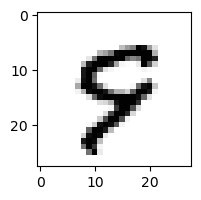

2.8642338635599337e-11% - 0
4.559233563507998e-13% - 1
6.718421881411899e-18% - 2
1.7435322332459643e-22% - 3
0.00019857913288416818% - 4
39.58498464135301% - 5 - ОШИБКА
1.4550367428106613e-11% - 6
0.020808506091874367% - 7
2.068254206489267e-24% - 8
0.006225630444672152% - 9

 9


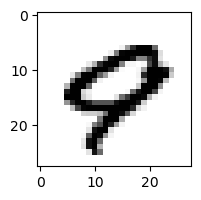

1.0218814270038767e-05% - 0
3.468869282634245e-15% - 1
1.2597055950204998e-29% - 2
3.4437065334171366e-47% - 3
1.786410643746856e-05% - 4
2.6763133754986895e-15% - 5
9.169446006717094e-13% - 6
0.14420813184676715% - 7 - ОШИБКА
3.099012853070915e-22% - 8
2.1128488114528137e-06% - 9

 8


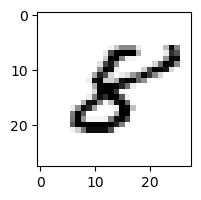

1.2262306335137785e-10% - 0
1.7433208649361298e-09% - 1
5.52620745190849e-08% - 2
2.7867974309752245e-15% - 3
2.796850010997845e-09% - 4
2.35441224858228% - 5 - ОШИБКА
4.605049801812555e-06% - 6
2.545739720957853e-09% - 7
0.0058106374043856825% - 8
0.0005087060472252357% - 9

 7


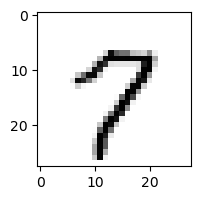

0.00024213324661992924% - 0
3.7329281849262335e-06% - 1
1.675638471875685e-11% - 2
1.1339415387793097e-12% - 3
3.61930122663384e-06% - 4
0.0014661278822380116% - 5
3.296226795502456e-09% - 6
98.2845805310248% - 7
0.028484327250534847% - 8
99.57353317821055% - 9 - ОШИБКА

 8


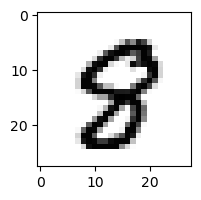

2.1236908847229476e-13% - 0
1.2512474486297975e-14% - 1
1.313552673185535e-26% - 2
7.049377074787113e-26% - 3
7.709917726323788e-13% - 4
0.002978658651664718% - 5 - ОШИБКА
1.154262226392545e-19% - 6
1.5368632136702355e-06% - 7
2.4797307511828753e-14% - 8
6.540372117835522e-19% - 9

 9


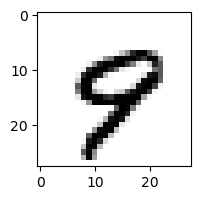

3.90760223010927e-11% - 0
5.318703247488334e-12% - 1
2.7267212070405635e-24% - 2
3.066116551402579e-28% - 3
0.0016301669095081955% - 4
6.260951925488105e-05% - 5
1.5167416624012838e-12% - 6
0.2942275770079538% - 7 - ОШИБКА
2.4732840181579373e-21% - 8
3.3014353336168158e-06% - 9

 1


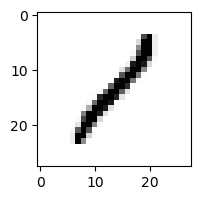

1.4293222006652269e-05% - 0
97.58772738522494% - 1
46.71026872651938% - 2
0.005365800744032371% - 3
0.0001367334295490563% - 4
2.1931233298601717e-05% - 5
6.254398078235051e-08% - 6
2.0078668592000875e-05% - 7
99.97668562636224% - 8 - ОШИБКА
0.0005825157352912429% - 9

 3


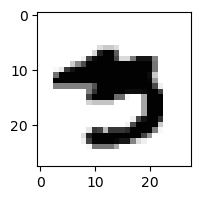

2.6223378377302667e-20% - 0
3.497478814805446e-15% - 1
9.713328095204463e-50% - 2
4.107717950447607e-15% - 3
5.13102146289331e-16% - 4
0.0006487762441353572% - 5 - ОШИБКА
7.567039110548735e-27% - 6
2.7317252208926647e-07% - 7
1.0346691407176108e-26% - 8
5.595388201348456e-25% - 9

 3


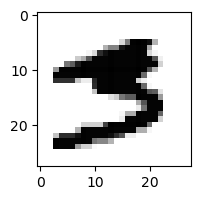

3.7820173549580174e-18% - 0
1.2061379062206975e-15% - 1
1.7893713329820715e-40% - 2
5.682407751415412e-07% - 3
1.0464020421068061e-27% - 4
0.02207549158142098% - 5 - ОШИБКА
1.0618746206129868e-27% - 6
0.0011202616384230193% - 7
3.934712592683717e-43% - 8
5.435307404186828e-38% - 9

 3


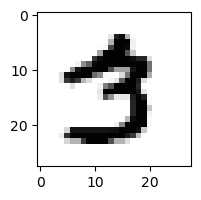

7.786727989107383e-12% - 0
1.3304543655482542e-10% - 1
3.028240732993555e-24% - 2
6.393740252504231e-08% - 3
2.220640992274503e-22% - 4
0.002927669234488214% - 5 - ОШИБКА
7.133222702865958e-26% - 6
0.0018570336879158247% - 7
5.396407100651338e-20% - 8
2.642756161970471e-19% - 9

 3


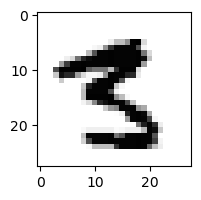

2.884746151038664e-19% - 0
3.0092474131145397e-14% - 1
2.9291168750848827e-25% - 2
5.273227414284351e-16% - 3
2.0877669993945667e-18% - 4
3.9890445963689354% - 5 - ОШИБКА
4.402643119879009e-35% - 6
8.706693252072278e-10% - 7
1.5934953250839272e-21% - 8
1.2491250482185566e-24% - 9

 0


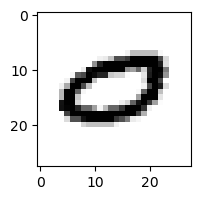

10.42461276104146% - 0
7.704155327876908e-13% - 1
7.334416673082783e-23% - 2
1.7608623759477092e-38% - 3
1.5104845434105082e-07% - 4
3.868786279362708e-12% - 5
4.72430611703822e-14% - 6
37.27693195561784% - 7 - ОШИБКА
2.47824594301779e-22% - 8
8.431197589554014e-20% - 9

 9


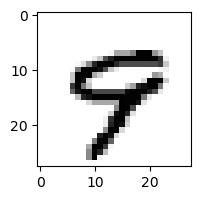

2.298258117469568e-12% - 0
4.099380906512548e-14% - 1
6.21979296872721e-26% - 2
6.391661325104638e-29% - 3
0.0011775854755611452% - 4
0.025640948682771534% - 5 - ОШИБКА
1.531839096568902e-14% - 6
0.011694085117163057% - 7
6.41223629371926e-22% - 8
3.991891028434585e-07% - 9

 3


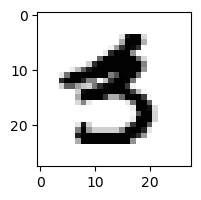

1.025724577740755e-13% - 0
4.68864301171996e-11% - 1
1.7132392761878113e-36% - 2
2.373835530855562e-13% - 3
2.4710452580305403e-17% - 4
12.547908645952205% - 5 - ОШИБКА
7.438192336743651e-26% - 6
1.3091522715356674e-09% - 7
6.10618999080488e-36% - 8
4.2291438690107564e-22% - 9

 0


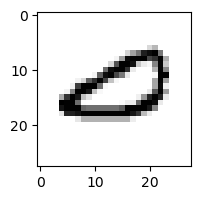

72.94797761384908% - 0
1.3406221189798736e-08% - 1
5.524684472773569e-18% - 2
7.147483978406058e-23% - 3
75.56837736195413% - 4 - ОШИБКА
1.2593335829256694e-10% - 5
5.3578851327907387e-08% - 6
3.5977003657834667% - 7
4.977019611571952e-28% - 8
4.1264169234109386e-22% - 9

 8


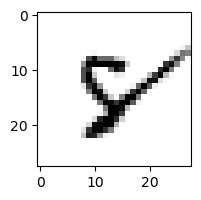

7.189723374800974e-11% - 0
1.3728986866281958e-06% - 1
2.2822204064481112e-09% - 2
5.801645207508673e-27% - 3
0.016806487974576553% - 4
0.0015384452224942115% - 5
0.03149766731998253% - 6
0.15982604344379905% - 7 - ОШИБКА
3.954932659454505e-12% - 8
3.982468458570552e-09% - 9

 3


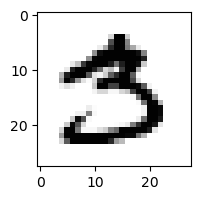

6.117512401713278e-09% - 0
7.817861319876308e-11% - 1
2.9130817416083675e-22% - 2
0.18209793010353245% - 3
2.3500064703912442e-24% - 4
4.148729770274158% - 5 - ОШИБКА
2.652861611126618e-27% - 6
2.276546925486019e-08% - 7
6.607287449238671e-29% - 8
1.749827897570954e-26% - 9

 2


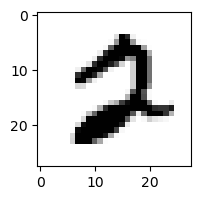

9.241850967133958e-07% - 0
3.198692352736936e-15% - 1
9.955758744883506e-09% - 2
9.773111570482845e-29% - 3
5.431778051963807e-23% - 4
7.891903030693433e-06% - 5
1.4999795234796135e-13% - 6
0.0038554718679562716% - 7 - ОШИБКА
5.790964491453548e-25% - 8
8.904350031255034e-23% - 9

 3


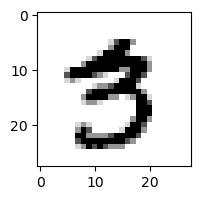

6.604363410426497e-13% - 0
2.4321844517533196e-12% - 1
1.805303736618091e-26% - 2
7.1229222560783295e-09% - 3
5.77417528337924e-18% - 4
0.03422110688444422% - 5 - ОШИБКА
1.860846238069732e-26% - 6
0.00033928185642488623% - 7
6.536986074717514e-22% - 8
5.550684391540046e-19% - 9

 8


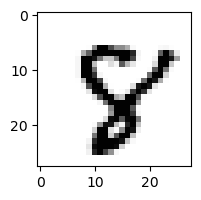

1.7912872382163482e-17% - 0
2.324185615082844e-19% - 1
4.3251543603261585e-24% - 2
1.326301506688604e-28% - 3
1.1057034484628659e-09% - 4
2.1117061447996384% - 5 - ОШИБКА
1.4946359585238609e-15% - 6
0.0006761326201589854% - 7
2.1690080940434384e-07% - 8
6.5376305597038e-17% - 9

 3


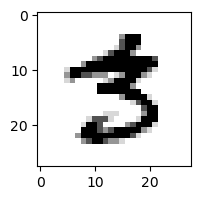

2.399621325250598e-12% - 0
6.534953430344905e-11% - 1
6.170254243913998e-23% - 2
1.095132701874563e-09% - 3
1.459942832094931e-23% - 4
0.014916638813967271% - 5 - ОШИБКА
4.846957317422209e-26% - 6
6.77399230206375e-06% - 7
9.472529411877001e-25% - 8
6.400675789748972e-28% - 9

 8


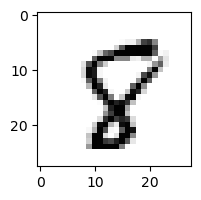

1.1944359857248428e-11% - 0
7.18566943155293e-11% - 1
7.549752432046621e-17% - 2
8.05234309844153e-26% - 3
1.9446462948409927e-06% - 4
0.20451830211806982% - 5 - ОШИБКА
7.80166979452218e-12% - 6
0.00021010278577269478% - 7
0.00010306729776777963% - 8
2.8883075615235497e-12% - 9

 8


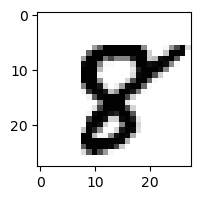

3.289326324646063e-21% - 0
6.393584339447375e-20% - 1
1.062115549337695e-27% - 2
3.259090221538943e-36% - 3
1.134276317004236e-18% - 4
0.03736178901435693% - 5 - ОШИБКА
3.508993174447881e-23% - 6
1.9229441246496656e-06% - 7
0.033769671269878176% - 8
1.1357298564526121e-19% - 9

 8


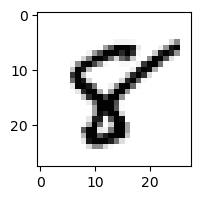

9.769710777731384e-14% - 0
7.985948226151924e-10% - 1
1.4953085949892716e-17% - 2
3.0445263184381397e-28% - 3
7.900814886743489e-12% - 4
13.45667390938042% - 5 - ОШИБКА
1.411737731093331e-13% - 6
4.53411606674123e-05% - 7
1.0320450977516402% - 8
3.826033798137767e-10% - 9

 3


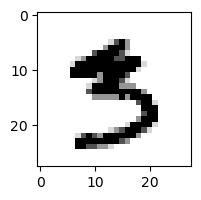

2.2981647324259727e-16% - 0
3.6677105950077e-11% - 1
1.3916614968536725e-32% - 2
8.362953509915204e-05% - 3
2.6555371497312117e-17% - 4
19.086170494466273% - 5 - ОШИБКА
1.3947038611236865e-24% - 6
2.8308087563189454e-05% - 7
8.592060464921191e-26% - 8
4.8925133075136417e-26% - 9

 2


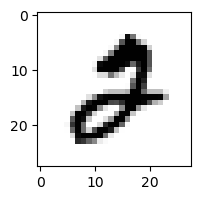

7.848614860335417e-07% - 0
5.514697609230573e-12% - 1
0.0015785499463469399% - 2
7.204748835486738e-16% - 3
5.365688639410601e-16% - 4
7.640543345756305e-08% - 5
1.0916790728626065e-16% - 6
0.005549873447723003% - 7 - ОШИБКА
3.506700586765542e-26% - 8
2.0479818902289094e-20% - 9

 9


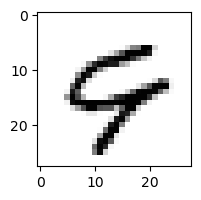

1.9632357270518345e-07% - 0
2.83686488523339e-11% - 1
5.994767170713521e-17% - 2
2.022328700978606e-30% - 3
1.1561836690278013% - 4 - ОШИБКА
8.418996872438578e-09% - 5
0.00041060800662620183% - 6
0.22320447599453846% - 7
1.4890238233212113e-20% - 8
8.951857015876657e-05% - 9

 8


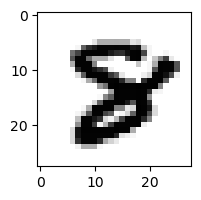

2.6223086721740823e-23% - 0
3.057417503544351e-19% - 1
2.1517924465695328e-28% - 2
8.358218428763148e-32% - 3
6.3939714943698095e-25% - 4
1.7581048402007825e-07% - 5 - ОШИБКА
6.460925110723559e-17% - 6
1.55999775841329e-11% - 7
8.403380648581647e-12% - 8
1.070717085078628e-41% - 9

 9


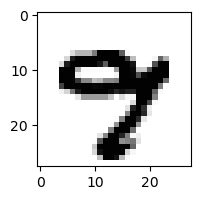

5.2275136994555524e-21% - 0
1.8184006241043697e-19% - 1
2.0696749960218524e-45% - 2
1.6970161915286872e-19% - 3
1.857282049984522e-15% - 4
1.967818392389645e-11% - 5
7.177774667715689e-20% - 6
31.058831156809223% - 7 - ОШИБКА
3.8383967460743855e-28% - 8
2.00576638083242e-17% - 9

 8


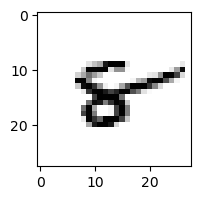

2.2262399622951393e-08% - 0
0.00044843546853525477% - 1
7.693250341484327e-08% - 2
1.1563998373816146e-28% - 3
8.939225287053901% - 4
4.413018359863722e-08% - 5
99.99802720005687% - 6 - ОШИБКА
4.7146834113776895e-07% - 7
0.0006889897641887513% - 8
56.224117758965996% - 9

 2


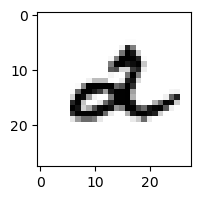

3.527505908983208e-09% - 0
7.791175229010074e-06% - 1
0.014440747576281934% - 2
1.0436629189859818e-11% - 3
0.14799925899070238% - 4 - ОШИБКА
9.50674032493319e-11% - 5
1.1932270599937987e-05% - 6
2.973637322230371e-05% - 7
2.393894807951849e-23% - 8
4.320934454409616e-06% - 9

 9


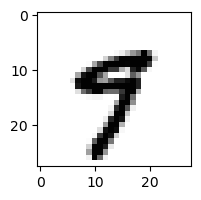

1.2449155383935124e-14% - 0
5.8081124458553716e-08% - 1
2.025315845741991e-33% - 2
2.7575947191002834e-18% - 3
6.718889898692339e-05% - 4
0.02349371623196263% - 5
1.6109541810090627e-16% - 6
0.0328150077550167% - 7 - ОШИБКА
2.388279979425865e-19% - 8
7.584111387089708e-05% - 9

 3


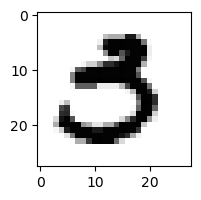

9.067743688404532e-07% - 0
1.2391226887915535e-12% - 1
4.719330982010631e-32% - 2
6.544298469518324e-07% - 3
1.9505233831854156e-25% - 4
45.463088809496114% - 5 - ОШИБКА
4.463653553864023e-25% - 6
1.8591851516701438e-08% - 7
8.560614587644038e-39% - 8
5.580525062071295e-37% - 9

 9


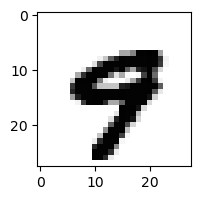

3.662474738665414e-17% - 0
6.745001167035316e-19% - 1
2.5938158251256185e-43% - 2
2.7863273118574124e-27% - 3
7.668305058070116e-05% - 4
2.8026139313887342e-06% - 5
2.025975426432573e-20% - 6
0.04785927507967586% - 7 - ОШИБКА
2.0809187949541143e-34% - 8
2.864403374272732e-14% - 9

 9


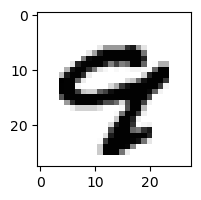

1.6062959775940755e-18% - 0
4.4475175259783897e-20% - 1
2.9161745396737307e-31% - 2
3.5019393483852363e-34% - 3
1.1061873747000847e-13% - 4
1.177731285036673e-12% - 5
3.1886698454125358e-21% - 6
4.519308532004761e-05% - 7 - ОШИБКА
7.547284582819254e-29% - 8
9.196600039253037e-13% - 9

 9


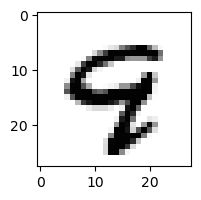

3.2771040557230723e-16% - 0
5.408307636115863e-16% - 1
1.805995654275978e-21% - 2
1.280903733675493e-26% - 3
0.0002169763788002824% - 4
0.04258615599801537% - 5 - ОШИБКА
1.841346162688042e-14% - 6
3.8137823009615473e-07% - 7
2.43562953240084e-24% - 8
0.0012164180323703353% - 9

 8


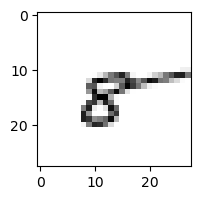

4.655450100231583e-05% - 0
49.93073551404279% - 1
0.002393837979714575% - 2
9.356288026740946e-08% - 3
98.24694547462323% - 4
8.1439885129735e-06% - 5
99.99915093120185% - 6 - ОШИБКА
5.213062122133259e-06% - 7
99.81332713393185% - 8
99.8998967274757% - 9

 8


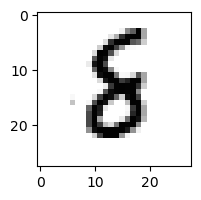

3.6551882723849013e-16% - 0
2.9968907302509527e-06% - 1
2.2839756190284254e-08% - 2
8.125759181893174e-13% - 3
7.449385122072173e-14% - 4
0.015576303870023001% - 5
27.162271938339185% - 6 - ОШИБКА
7.24135228479686e-11% - 7
14.69712251404287% - 8
2.5934643941282264e-19% - 9

 9


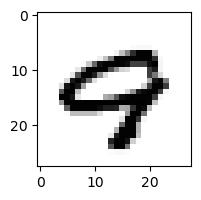

2.8652931978389453e-10% - 0
4.952030890947964e-13% - 1
1.2022516906367888e-30% - 2
3.8637519888679884e-36% - 3
0.014465595140777325% - 4
2.2957458959698778e-12% - 5
2.736930102995385e-16% - 6
2.4522209061869433% - 7 - ОШИБКА
2.4759745433572276e-25% - 8
3.619892210744142e-16% - 9

 9


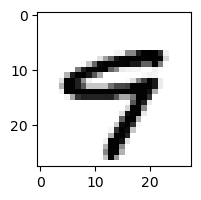

3.6547456544765224e-12% - 0
3.379649974601822e-14% - 1
1.0519257663622755e-33% - 2
2.511984715116409e-24% - 3
3.356424701664695e-05% - 4
80.94947591787106% - 5 - ОШИБКА
5.683229717414567e-16% - 6
0.016200291786794916% - 7
3.964635845370939e-26% - 8
4.870658997947931e-07% - 9

 5


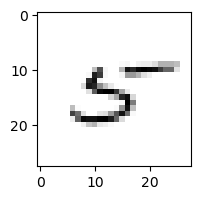

0.04319744537625306% - 0
0.0021263376238533087% - 1
0.026944272023723688% - 2
1.0947687518084073e-06% - 3
89.22709669421927% - 4 - ОШИБКА
0.28844376171173974% - 5
0.5954223238172309% - 6
0.09252901667267158% - 7
17.71789686387157% - 8
0.03132928628856417% - 9

 8


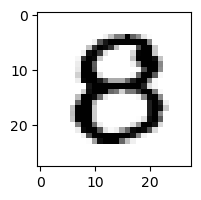

0.03467274756702563% - 0 - ОШИБКА
1.5978407140240195e-19% - 1
7.63155485414425e-14% - 2
4.669977704889354e-14% - 3
1.7428212970725437e-08% - 4
0.0004519940811411116% - 5
3.555339127814652e-17% - 6
1.613748902672914e-16% - 7
1.1219662864637074e-15% - 8
1.0972711938267976e-37% - 9

 9


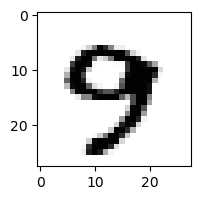

4.41987493040401e-14% - 0
1.4200162533055112e-18% - 1
1.335614579922259e-31% - 2
1.067763514581061e-08% - 3
2.397183299350456e-10% - 4
7.35921350497993e-07% - 5
2.192304205453739e-18% - 6
87.71686879067485% - 7 - ОШИБКА
1.1024769106503286e-23% - 8
3.429947527584757e-07% - 9

 8


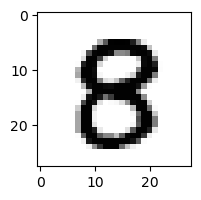

3.9859450313265e-11% - 0
1.5326043164679505e-19% - 1
8.977326163784655e-20% - 2
7.743000703328799e-13% - 3
9.120849997935216e-13% - 4
3.049454388065861e-05% - 5 - ОШИБКА
6.948123378870617e-24% - 6
1.092318751187637e-13% - 7
6.892601222762382e-09% - 8
1.7565443326948388e-24% - 9

 9


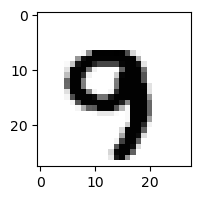

1.1999412289906938e-25% - 0
6.165883411325359e-12% - 1
1.0337993019990532e-26% - 2
7.63786131247518e-28% - 3
2.5506649586786087e-10% - 4
3.830941817427914e-09% - 5
6.515441603829618e-19% - 6
4.743694183478474% - 7 - ОШИБКА
1.922981820001476e-37% - 8
5.835201926384154e-08% - 9

 8


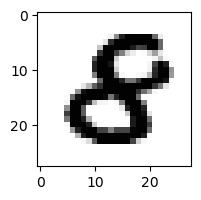

5.06968709002106e-13% - 0
1.83901665187181e-18% - 1
2.271332612520287e-20% - 2
1.321398937911368e-24% - 3
1.6921807531712548e-16% - 4
3.3282588776954735e-06% - 5 - ОШИБКА
2.129322405969719e-20% - 6
9.922655808802562e-22% - 7
2.7382336779604327e-25% - 8
4.933156800921043e-43% - 9

 9


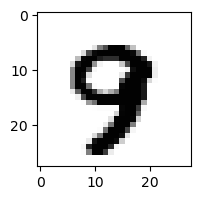

4.1915860570661933e-19% - 0
1.0955043093194153e-18% - 1
4.7283746115284415e-27% - 2
1.7230000109778567e-16% - 3
9.452905359496598e-12% - 4
2.8930021157883126e-06% - 5
1.2056738417827875e-20% - 6
11.907882199799554% - 7 - ОШИБКА
4.172708560232302e-24% - 8
3.52124747750517e-07% - 9

 8


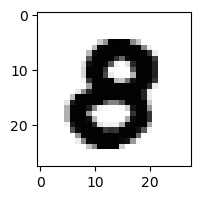

9.169289171142469e-13% - 0
8.436514059998973e-26% - 1
7.07046495747344e-24% - 2
9.778008947830487e-23% - 3
6.6346953412823496e-21% - 4
1.9239638509488494e-07% - 5 - ОШИБКА
1.1973670788075977e-31% - 6
7.192689885958852e-17% - 7
9.695064130261242e-24% - 8
2.2746802429201516e-37% - 9

 3


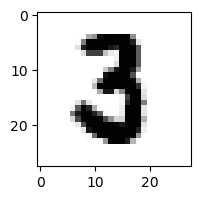

1.6460550053574588e-13% - 0
1.09059509850677e-11% - 1
1.372018378016938e-09% - 2
1.3365193403791643e-07% - 3
7.254354885773292e-24% - 4
5.8662089467862404e-06% - 5 - ОШИБКА
2.4053332495244306e-16% - 6
2.963425127302324e-13% - 7
8.071331395364482e-32% - 8
2.8198652688541886e-44% - 9

 8


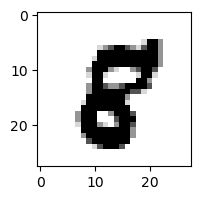

3.728782070205525e-15% - 0
1.7236337080361587e-15% - 1
1.9356682667142153e-19% - 2
1.6485636197672536e-38% - 3
6.55832446723311e-18% - 4
2.1879131364819452e-05% - 5 - ОШИБКА
1.0662163443793198e-25% - 6
7.96996111515154e-11% - 7
2.1836469536410975e-05% - 8
1.7306779440417092e-23% - 9

 4


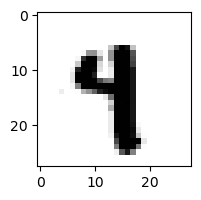

5.3497277196265975e-27% - 0
1.7688713872389512e-06% - 1
1.945745358409869e-34% - 2
1.2746159721829352e-23% - 3
4.787311314024132e-08% - 4
0.01240814295007912% - 5 - ОШИБКА
1.2482803716576708e-17% - 6
0.0004208524784630304% - 7
7.612059795845862e-28% - 8
1.0042707395492303e-08% - 9

 8


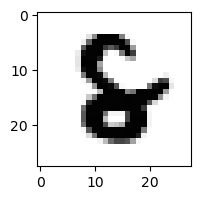

4.904104741651019e-21% - 0
4.3683307358114945e-17% - 1
8.408603000258221e-14% - 2
1.1693998406247388e-29% - 3
2.1662895148476245e-11% - 4
4.6728425551630334e-07% - 5
0.0027219724631345034% - 6 - ОШИБКА
3.976072674570299e-15% - 7
4.943661088680228e-19% - 8
5.924380624257954e-43% - 9

 9


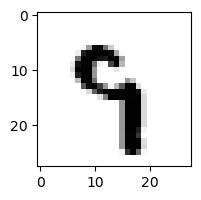

2.4214566620388568e-20% - 0
1.4268776721903087e-10% - 1
4.487655228054804e-17% - 2
8.285828735237607e-13% - 3
0.002057176972711323% - 4
2.0176556537170587% - 5 - ОШИБКА
3.674938437862409e-07% - 6
0.06790877611043183% - 7
1.1643343326922816e-15% - 8
1.7022209326592094e-06% - 9

 4


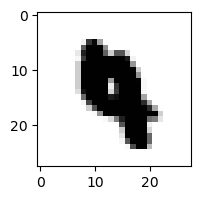

3.6834497064195734e-36% - 0
1.6736101177218187e-14% - 1
4.61453401857616e-30% - 2
1.6898372610416275e-33% - 3
6.873134692827478e-08% - 4
2.852889724599796e-05% - 5 - ОШИБКА
8.039250603755762e-17% - 6
2.2375136935193273e-09% - 7
2.9709593182166395e-43% - 8
2.3045704931490693e-23% - 9

 8


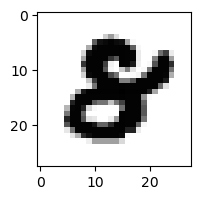

1.6402430986413853e-15% - 0
5.04887875890611e-26% - 1
3.4034646369042367e-22% - 2
7.679103980617377e-30% - 3
3.1897517936965732e-21% - 4
1.1390357865135215e-08% - 5 - ОШИБКА
1.2629207604158715e-23% - 6
6.310855831842604e-17% - 7
4.93083304735526e-31% - 8
3.2905775823912663e-41% - 9

 3


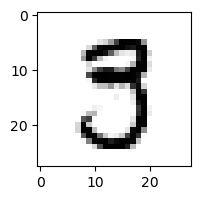

2.957835481971061e-07% - 0
6.525709303356141e-10% - 1
4.153221502393604e-23% - 2
0.7881351305359666% - 3
1.651832515705722e-14% - 4
0.9895921188197909% - 5 - ОШИБКА
4.9480946846335566e-23% - 6
0.005632445339696631% - 7
9.350714614784423e-05% - 8
5.458765134704848e-30% - 9

 8


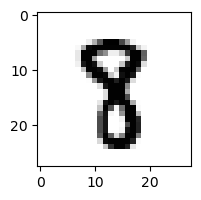

3.982192572342595e-23% - 0
6.24376803584101e-08% - 1
3.7149633030007665e-20% - 2
1.604543958085107e-13% - 3
4.409152442675129e-12% - 4
0.047055712688466825% - 5 - ОШИБКА
4.89320484335197e-22% - 6
6.667262763020276e-06% - 7
1.4286810173580647e-05% - 8
9.582911516715716e-30% - 9

 2


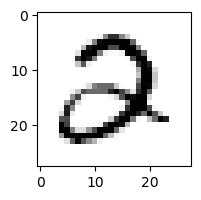

4.821990257737627e-05% - 0
1.00227770529564e-15% - 1
50.48590767476182% - 2
99.46293252700525% - 3 - ОШИБКА
2.174564570133715e-11% - 4
1.654837553200915e-06% - 5
3.136691605070139e-14% - 6
1.1095294661252492e-05% - 7
9.019199646547752e-32% - 8
4.142871012720622e-29% - 9

 8


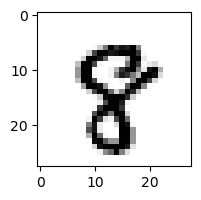

5.78192480293767e-18% - 0
3.4274472601327526e-11% - 1
1.8179154211630676e-22% - 2
1.4744527650866316e-28% - 3
1.628865215221549e-13% - 4
1.0581331141064095e-08% - 5
5.4200222788724586e-18% - 6
0.03295864199355141% - 7 - ОШИБКА
0.00015082002740047284% - 8
8.104574775941144e-10% - 9

 8


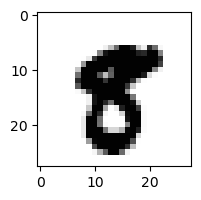

4.59341188489188e-22% - 0
8.987414728968007e-17% - 1
9.243386974449664e-45% - 2
1.0481174636190416e-29% - 3
1.7039541826326296e-22% - 4
0.0022348440011927557% - 5 - ОШИБКА
2.515540886740917e-35% - 6
2.70769704611346e-08% - 7
3.03929560355203e-13% - 8
1.4479293738972265e-20% - 9

 3


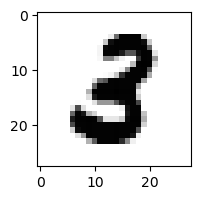

2.256934059869332e-14% - 0
5.035012532022846e-12% - 1
4.0270338688227144e-12% - 2
0.00010566201392650659% - 3
1.0134335566300253e-20% - 4
0.0007265936274851737% - 5 - ОШИБКА
1.469361530383114e-21% - 6
2.9050602307104066e-17% - 7
7.77369677954619e-20% - 8
2.849582796840184e-38% - 9

 8


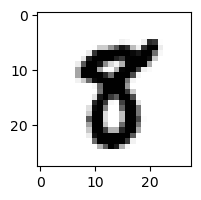

5.59000234726358e-18% - 0
4.76440373922815e-11% - 1
4.225729330729422e-30% - 2
3.1366542174830255e-22% - 3
4.2446734796603426e-19% - 4
1.2224787780794277% - 5 - ОШИБКА
7.540066148006462e-26% - 6
9.989826544343733e-09% - 7
4.606421083944189e-06% - 8
2.567087574785859e-22% - 9

 8


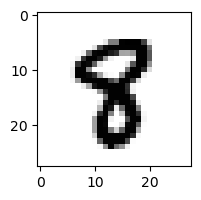

2.47007394121367e-22% - 0
1.360519660443884e-11% - 1
4.061189496083462e-28% - 2
2.5769258255918114e-20% - 3
6.70199968529682e-11% - 4
0.11581097428037056% - 5 - ОШИБКА
3.867174692996825e-21% - 6
4.8366777083306045e-08% - 7
1.3175509986380693e-06% - 8
2.636137421690381e-27% - 9

 8


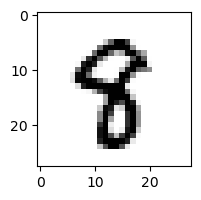

8.95189875176978e-20% - 0
6.121309919095784e-09% - 1
2.2281882055554063e-26% - 2
1.0636859799339522e-16% - 3
9.649586070796118e-08% - 4
0.23432236762851527% - 5 - ОШИБКА
8.338160175077545e-20% - 6
2.583183931219145e-06% - 7
9.702124361191267e-10% - 8
4.270909526536242e-18% - 9

 8


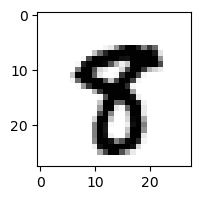

9.799180139204663e-26% - 0
7.787709368797492e-15% - 1
2.0167888113328288e-36% - 2
8.115184868008246e-24% - 3
1.696833440966054e-16% - 4
0.12397992151322158% - 5 - ОШИБКА
4.5724548801202555e-30% - 6
7.332617785242858e-05% - 7
8.710953112373987e-14% - 8
6.943524806237925e-14% - 9

 8


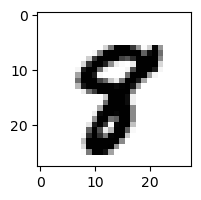

9.482580020693308e-24% - 0
1.523004314379069e-14% - 1
8.685100895977168e-35% - 2
8.096987349578445e-32% - 3
2.28071625380903e-15% - 4
0.00044571032802388967% - 5 - ОШИБКА
7.314108757654164e-24% - 6
1.3595185128683673e-05% - 7
1.0561470476953386e-10% - 8
2.4944049415876594e-14% - 9

 8


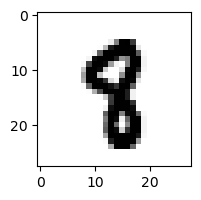

1.0756730840545183e-24% - 0
1.2441678105292783e-07% - 1
4.676788440418163e-23% - 2
8.572945791755809e-23% - 3
1.9303705078647734e-08% - 4
0.01649321717747746% - 5 - ОШИБКА
1.7826653918435062e-19% - 6
9.390805282863312e-06% - 7
3.725327141232188e-17% - 8
1.5672531682764076e-18% - 9

 8


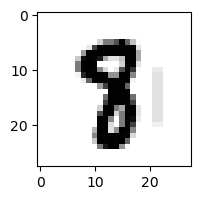

4.668141213946201e-25% - 0
5.961895063139345e-10% - 1
2.4930544441923656e-27% - 2
1.6098410562215384e-22% - 3
1.7331415326643524e-15% - 4
0.022650171940938473% - 5 - ОШИБКА
1.35519278291602e-19% - 6
3.9820564679585e-06% - 7
7.165834248484386e-09% - 8
3.5538491835500875e-28% - 9

 8


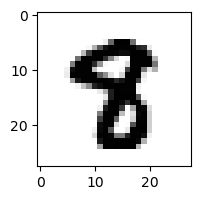

3.0588410018567505e-28% - 0
2.8495295385348846e-14% - 1
1.2994436248358822e-37% - 2
2.116011324409319e-26% - 3
3.3489519984300636e-15% - 4
0.013241465723625103% - 5 - ОШИБКА
5.650767833545902e-30% - 6
2.670392676214161e-06% - 7
1.148705826639269e-18% - 8
6.642204770489383e-33% - 9

 9


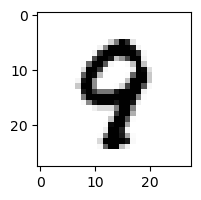

1.854689519114857e-15% - 0
8.717400725216836e-12% - 1
3.656868394148363e-17% - 2
1.0395672259860478e-22% - 3
1.3141781365359137e-05% - 4
0.001874459799655252% - 5 - ОШИБКА
1.6409103533641884e-13% - 6
0.0005655137898578116% - 7
1.2925892166004501e-10% - 8
0.0007544004572533174% - 9

 3


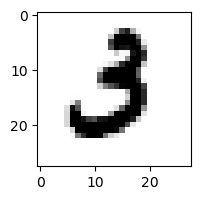

1.891552128768134e-10% - 0
1.5094965770465982e-09% - 1
1.0995597885438188e-09% - 2
5.973032877912058e-10% - 3
1.9199705988708477e-21% - 4
0.00495080195133538% - 5 - ОШИБКА
2.238027569230998e-15% - 6
9.209973141684485e-08% - 7
6.489991387867128e-37% - 8
7.804838100550809e-41% - 9

 8


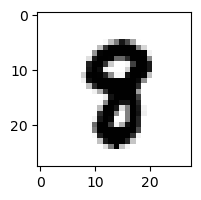

6.706570907610998e-24% - 0
1.6544526215707007e-11% - 1
5.989595385918777e-30% - 2
4.5006150727395756e-23% - 3
7.85121054306524e-15% - 4
2.1284898050198833e-05% - 5 - ОШИБКА
9.735110157141084e-22% - 6
2.60238233487539e-06% - 7
2.2266899475449296e-12% - 8
1.2725444446644059e-21% - 9

 9


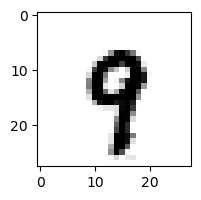

2.155384486966251e-18% - 0
2.68049637732386e-09% - 1
7.572935716746515e-20% - 2
6.740553941174818e-17% - 3
0.0019146260063085327% - 4
8.177114487140448e-05% - 5
2.324989839457403e-12% - 6
11.460875922428462% - 7 - ОШИБКА
1.3225592267541266e-14% - 8
2.621670107205307% - 9

 3


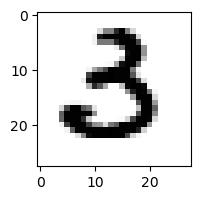

2.1460642925186853e-07% - 0
3.1835388810033046e-12% - 1
8.638711571158051e-15% - 2
6.24645763298142e-05% - 3
5.412323085674353e-21% - 4
0.0074702063476278745% - 5 - ОШИБКА
6.402964594100526e-15% - 6
2.7259182514139578e-11% - 7
2.7385972589416953e-39% - 8
9.584559101711294e-43% - 9

 8


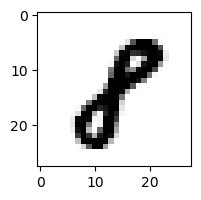

1.7311995894529443e-14% - 0
0.15556245519835285% - 1 - ОШИБКА
9.388727473610512e-12% - 2
1.0745959050582761e-16% - 3
1.373759200627705e-16% - 4
1.0927666759843192e-07% - 5
5.854985056127102e-21% - 6
1.968250808474019e-09% - 7
0.001483542921345664% - 8
6.013555087225662e-22% - 9

 9


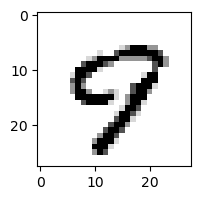

3.298185497495969e-05% - 0
2.0598724378371818e-16% - 1
4.370944484326768e-17% - 2
5.717285517095858e-23% - 3
0.0002910225265181537% - 4
5.460842802759959% - 5 - ОШИБКА
4.7607023870810633e-11% - 6
0.014169536848607887% - 7
1.614220021935322e-11% - 8
1.2591235985943416% - 9

 8


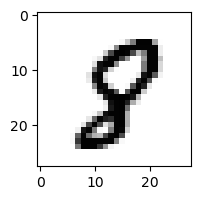

1.0182093048180125e-13% - 0
2.2111432749299437e-10% - 1
7.886294710710286e-19% - 2
7.060128897243635e-25% - 3
1.368001653658686e-11% - 4
0.002378580801790939% - 5 - ОШИБКА
3.4834616897534135e-14% - 6
4.6251493421859725e-06% - 7
8.952416517526025e-07% - 8
2.880857339980747e-17% - 9

 9


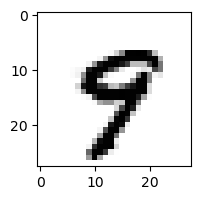

5.09740523296213e-17% - 0
1.9744030565537557e-14% - 1
3.2631552089824767e-28% - 2
2.2630155738190767e-19% - 3
5.984396275971147e-06% - 4
0.04594602169096901% - 5 - ОШИБКА
3.576938581341656e-15% - 6
0.038180345561572064% - 7
8.568754509487186e-16% - 8
0.005743820037467193% - 9

 3


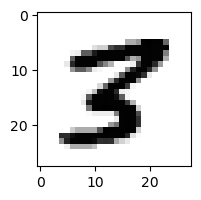

4.422696044994234e-21% - 0
2.858754964618687e-11% - 1
2.952264326357098e-16% - 2
1.019225960952986e-19% - 3
5.850958138756841e-15% - 4
0.004430760417496724% - 5 - ОШИБКА
3.478819883055614e-30% - 6
9.813863900601238e-08% - 7
2.8039646193502784e-13% - 8
5.07905370788793e-30% - 9

 4


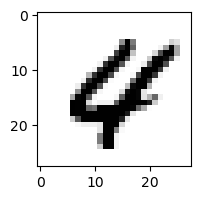

3.6039562107987276e-10% - 0
2.6932495897001942e-18% - 1
4.027822932221363e-19% - 2
8.254922079950632e-43% - 3
0.0002749727381986457% - 4
1.714480043344943e-07% - 5
2.632739749122487e-07% - 6
0.000676243808175225% - 7 - ОШИБКА
2.9311114518546788e-15% - 8
1.3407998618529082e-20% - 9

 7


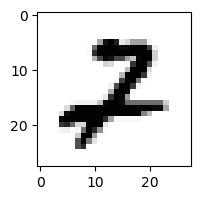

1.0932771809169703e-11% - 0
1.2465975219900048e-09% - 1
99.98546643838515% - 2 - ОШИБКА
3.0685078192719558e-15% - 3
3.2077519998803183e-19% - 4
7.92986346997625e-11% - 5
3.411670763509207e-20% - 6
1.5010642517741864e-06% - 7
4.105847231362459e-20% - 8
2.714326334963923e-24% - 9

 2


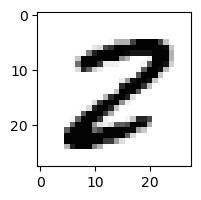

4.796720408132816e-13% - 0
6.105923338221635e-12% - 1
1.1977233551594896e-07% - 2
7.621674786900558e-25% - 3
1.2854874589328721e-23% - 4
0.0008459321928574267% - 5
7.816632994650931e-20% - 6
6.653781300090616e-09% - 7
99.99996392478559% - 8 - ОШИБКА
4.590597470780584e-34% - 9

 5


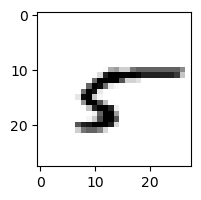

0.6593746449300555% - 0
0.25741709267729945% - 1
2.4710057858945204e-07% - 2
9.833431473986047e-12% - 3
0.08854708270556641% - 4
5.822866338293141e-09% - 5
97.76634749559359% - 6 - ОШИБКА
0.000535068656433447% - 7
0.0022848101924718357% - 8
6.352523397258524e-05% - 9

 7


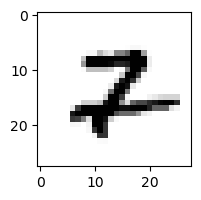

1.3262777879579418e-12% - 0
3.387786199587671e-07% - 1
17.950834975167208% - 2 - ОШИБКА
7.799340647078149e-23% - 3
2.06168879313461e-11% - 4
8.957143904288529e-11% - 5
5.87178101597284e-13% - 6
3.8096639627104008% - 7
1.4649078508370392e-13% - 8
4.499703379371494e-15% - 9

 0


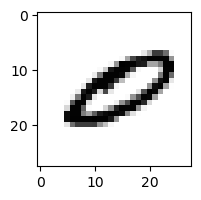

0.04222292624601556% - 0
1.16854520019216e-10% - 1
1.7278811083327022e-15% - 2
1.080098573051328e-21% - 3
0.4420481846546388% - 4 - ОШИБКА
1.0716812251026666e-05% - 5
1.182322144075394e-12% - 6
4.841659452040788e-06% - 7
4.425331097539823e-28% - 8
1.419587316202184e-30% - 9

 1


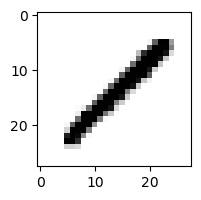

3.2332103716922573e-11% - 0
84.95371958083993% - 1
0.2046290990474172% - 2
1.3454762871703047e-09% - 3
0.000354091239352743% - 4
3.0125612956417495e-06% - 5
1.0044974978506072e-15% - 6
2.752055869180382e-05% - 7
99.99999550204461% - 8 - ОШИБКА
1.7604175596666306e-11% - 9

 7


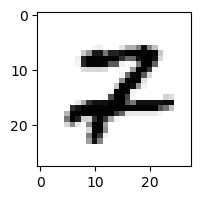

2.003724261138513e-11% - 0
3.547550517739303e-11% - 1
64.42046487535448% - 2 - ОШИБКА
4.49056569894414e-25% - 3
9.942840697246779e-13% - 4
1.3942617856968715e-10% - 5
3.869574362828086e-17% - 6
0.503655331180652% - 7
6.040834210052588e-10% - 8
6.809423812359737e-17% - 9

 8


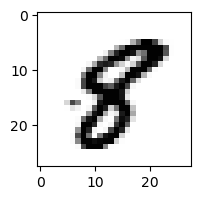

2.4460664896323655e-16% - 0
1.5003963238617876e-10% - 1
3.4203700067478936e-24% - 2
5.027585012614032e-28% - 3
1.3089665577362617e-10% - 4
0.023028909796518095% - 5 - ОШИБКА
2.798008386567233e-21% - 6
2.839428472221308e-10% - 7
9.51886276675702e-05% - 8
4.246261872332302e-17% - 9

 3


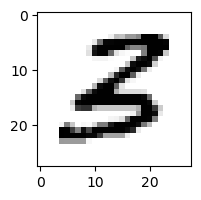

1.4691271417086225e-14% - 0
4.712992441330036e-09% - 1
6.7944334229848415e-09% - 2
0.0015423174178873667% - 3
1.5056907876942647e-08% - 4
0.0020292087090421824% - 5 - ОШИБКА
1.3351934186517424e-19% - 6
3.1212490939195652e-15% - 7
1.3250712475088838e-47% - 8
1.023089016929145e-47% - 9

 9


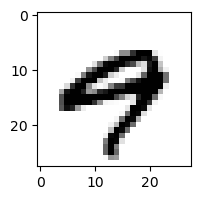

9.500687923054361e-08% - 0
2.9809534436278765e-15% - 1
1.5746895089237238e-37% - 2
6.106403352001156e-23% - 3
0.0017867426173841195% - 4
1.0476946904615568e-11% - 5
3.3768238218626174e-12% - 6
0.0056091923132235415% - 7 - ОШИБКА
1.7872910302632336e-29% - 8
1.1163969541058151e-06% - 9

 7


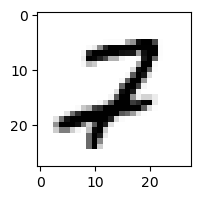

4.647125951307111e-09% - 0
6.575996764519833e-10% - 1
99.77661884542115% - 2 - ОШИБКА
3.1205120718370918e-18% - 3
3.133753740322017e-14% - 4
5.585756862139816e-07% - 5
5.914510209374558e-14% - 6
0.00023368605977526678% - 7
2.2039708512461893e-07% - 8
5.255691211803742e-21% - 9

 1


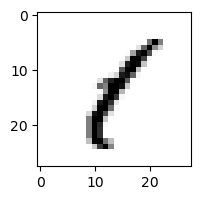

3.9594276834541243e-07% - 0
98.53507027643522% - 1
1.2712673823445112e-07% - 2
0.0005361118168707207% - 3
0.0001541425072113365% - 4
0.010720550458960462% - 5
7.703256076467812e-10% - 6
7.940454429482771e-06% - 7
99.82872048723938% - 8 - ОШИБКА
1.4136653271129191e-07% - 9

 9


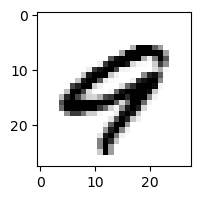

3.1379298313375043e-10% - 0
1.4796483885361394e-15% - 1
3.768826465768361e-28% - 2
5.125783296638843e-37% - 3
0.4220308929085427% - 4 - ОШИБКА
2.7211455000496487e-09% - 5
2.214220359210346e-12% - 6
0.0014952717075193316% - 7
1.913774727854069e-24% - 8
6.298594631035874e-11% - 9

 3


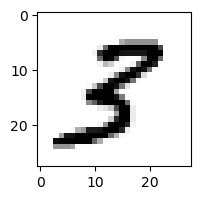

1.0962274174744704e-11% - 0
3.455362459433583e-05% - 1
3.9777090364386697e-10% - 2
0.0028622274184003653% - 3
5.1811080557108565e-09% - 4
0.05869218956882466% - 5 - ОШИБКА
4.8788573269651284e-20% - 6
9.06943078749386e-09% - 7
3.497042258627372e-18% - 8
7.048817994310692e-16% - 9

 9


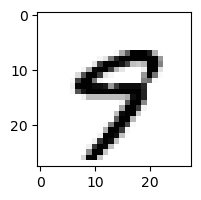

6.859611186516886e-12% - 0
1.447790490785078e-14% - 1
2.4958772129070357e-30% - 2
2.569545059628372e-16% - 3
0.0002570378435269886% - 4
0.02971702433147138% - 5
8.559107912601219e-14% - 6
0.119703241354008% - 7 - ОШИБКА
4.362490597962221e-20% - 8
0.013077844943563245% - 9

 5


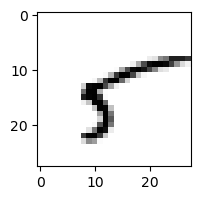

0.6347023000052519% - 0
0.006697397676383911% - 1
2.79885973533032e-07% - 2
0.0004014941865098532% - 3
89.07662326077954% - 4 - ОШИБКА
86.24232274884004% - 5
0.000702613683944701% - 6
0.002849087051590422% - 7
0.037387170011707466% - 8
0.010174968691845612% - 9

 7


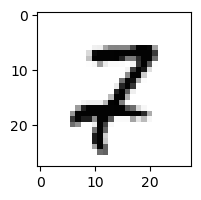

5.18075747006994e-10% - 0
1.3288665096581033e-07% - 1
80.05946717088321% - 2 - ОШИБКА
3.486695584842463e-20% - 3
5.712005869407272e-16% - 4
4.514195094106138e-08% - 5
5.688972742666953e-14% - 6
0.012615020156282297% - 7
0.20530483991362727% - 8
5.518382702647807e-09% - 9

 7


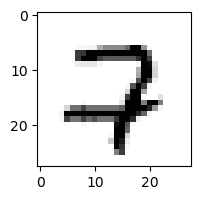

9.148188017252895e-08% - 0
1.2430406378770912e-15% - 1
46.25455055796188% - 2 - ОШИБКА
3.121762152533694e-19% - 3
6.925204777634394e-14% - 4
1.9519794637857283e-09% - 5
3.253747520955944e-10% - 6
35.56173950860023% - 7
9.493161198670021e-14% - 8
1.6969906267622234e-15% - 9

 2


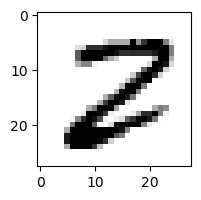

5.413222177637339e-13% - 0
1.3804001129961128e-12% - 1
0.0013782060221139037% - 2
1.510962013511182e-16% - 3
4.963220021960856e-24% - 4
0.00029773530854704483% - 5
8.17599245788138e-17% - 6
1.1997316750913426e-08% - 7
21.21750322328382% - 8 - ОШИБКА
4.742138753485902e-41% - 9

 2


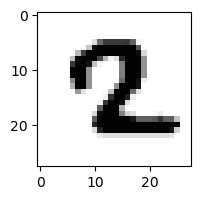

8.647329120599073e-24% - 0
4.113638284823723e-10% - 1
5.2007541711182984e-06% - 2
6.154953174708535e-28% - 3
2.7581248912265995e-21% - 4
1.0577431562800745e-05% - 5 - ОШИБКА
7.092728323568454e-17% - 6
5.3157298200793805e-08% - 7
4.8141941056753763e-29% - 8
2.1755698243555243e-28% - 9

 8


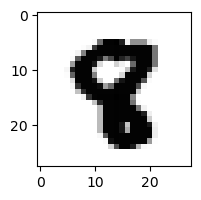

9.880118860286122e-32% - 0
3.3665995320097353e-17% - 1
2.1251681388491246e-29% - 2
1.770508072117043e-33% - 3
2.5457450450565583e-15% - 4
4.139173554696043e-05% - 5 - ОШИБКА
4.075213160009511e-28% - 6
7.611553794356541e-12% - 7
4.043995717054599e-35% - 8
5.643680378112636e-32% - 9

 8


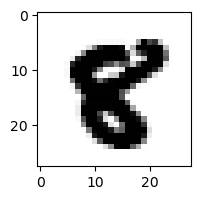

2.7664614142746364e-25% - 0
9.696127355418133e-19% - 1
1.0104672045345523e-35% - 2
5.890194736726901e-49% - 3
9.301259088843031e-18% - 4
4.017828207277204e-05% - 5 - ОШИБКА
7.685839475295316e-31% - 6
3.8237375158637314e-15% - 7
1.232828900521308e-15% - 8
1.9227143843512556e-36% - 9

 8


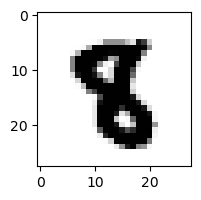

1.9388499345130493e-33% - 0
3.9093425876520074e-13% - 1
1.501022305622195e-29% - 2
2.93717914657536e-31% - 3
3.8336686263429956e-18% - 4
0.002295037312102591% - 5 - ОШИБКА
6.127291631247491e-24% - 6
1.2883997987224166e-11% - 7
2.3701168089547e-38% - 8
8.505035653244665e-36% - 9

 8


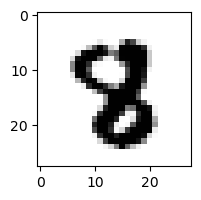

1.0617689760238522e-25% - 0
1.132467218439577e-15% - 1
2.3475901412426827e-23% - 2
1.586261070487948e-25% - 3
4.8442241829496134e-14% - 4
1.6631715042193516e-05% - 5 - ОШИБКА
8.94784664440652e-24% - 6
1.1423648770672405e-06% - 7
2.3946096672304665e-28% - 8
2.1273132369363544e-33% - 9

 9


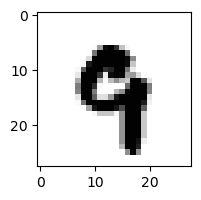

4.246424579331916e-24% - 0
1.2696563838507745e-10% - 1
2.866074792581581e-26% - 2
5.787894524990306e-32% - 3
1.300674958881848e-08% - 4
0.0008811793103781382% - 5
9.475503399995342e-13% - 6
0.002153073018243454% - 7 - ОШИБКА
2.989941916230126e-33% - 8
1.5780394266862022e-05% - 9

 4


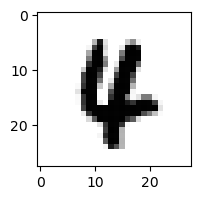

9.34187386142007e-22% - 0
2.0602129981446365e-11% - 1
4.4812631506547155e-22% - 2
1.5113178008094256e-35% - 3
1.3315832106942725e-08% - 4
1.2088116647211587e-06% - 5
1.9443069131199825e-11% - 6
0.0006250112516942327% - 7 - ОШИБКА
3.9277917979786176e-35% - 8
3.956907542183783e-26% - 9

 8


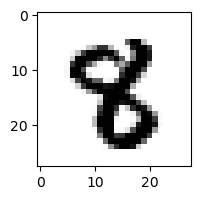

5.086173982267067e-28% - 0
5.328578746183369e-12% - 1
8.52569468540743e-27% - 2
1.9836360089139795e-22% - 3
1.0342066382179139e-11% - 4
0.00017772298161499966% - 5 - ОШИБКА
2.9513935855440497e-26% - 6
9.466727842812707e-08% - 7
8.315117577344275e-28% - 8
1.4179686397776676e-33% - 9

 8


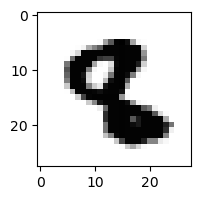

1.1830256021581511e-30% - 0
7.899044922047865e-13% - 1
4.724782569297093e-20% - 2
1.5286955259506052e-28% - 3
5.267168049734599e-22% - 4
0.005550753469634183% - 5 - ОШИБКА
4.04344628383768e-27% - 6
1.48656578556993e-16% - 7
2.064034971372674e-52% - 8
6.141075643357698e-38% - 9

 8


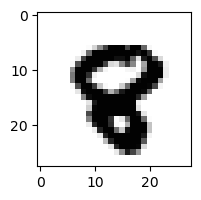

1.3690822665076874e-22% - 0
1.949193673369958e-20% - 1
7.653888132564453e-25% - 2
1.9867919207849753e-48% - 3
6.4087086301878716e-18% - 4
8.961746159923335e-10% - 5
9.768242267622383e-19% - 6
1.8449888499574683e-08% - 7 - ОШИБКА
1.5053403528258145e-17% - 8
1.5530587248475957e-15% - 9

 8


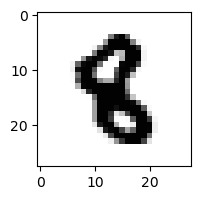

3.122700477827353e-26% - 0
2.3214429977269713e-09% - 1
2.6160354989164155e-21% - 2
6.6795292519903e-27% - 3
6.701265018945166e-13% - 4
0.005059370521408011% - 5 - ОШИБКА
2.356013468264982e-18% - 6
1.3965963227868724e-13% - 7
2.0687548108900425e-33% - 8
4.8654901580641645e-28% - 9

 4


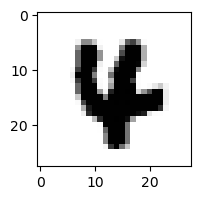

8.25941336578608e-28% - 0
8.028088386907922e-16% - 1
1.726567484682178e-32% - 2
8.590756221477977e-38% - 3
5.64968881719372e-09% - 4
5.5490270601765286e-09% - 5
8.977945954043855e-15% - 6
0.0015435118167587685% - 7 - ОШИБКА
5.27076667643152e-51% - 8
9.338937834290066e-39% - 9

 8


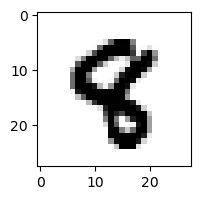

4.438493543040738e-26% - 0
3.706819273798572e-11% - 1
6.916696875134801e-25% - 2
7.864436451279942e-26% - 3
6.005344690118063e-09% - 4
0.0011705723308462893% - 5 - ОШИБКА
2.5253470573779855e-26% - 6
1.0023059888720094e-08% - 7
1.2587319628641563e-30% - 8
2.6723358107735813e-22% - 9

 8


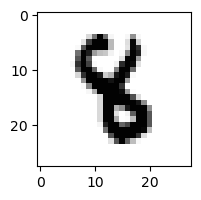

9.568700038823275e-30% - 0
5.304559032519904e-09% - 1
3.3274791501050503e-22% - 2
1.8951546857714075e-16% - 3
2.9648500734589905e-08% - 4
0.020655039813991555% - 5 - ОШИБКА
1.0088960757851383e-14% - 6
9.411061512486172e-10% - 7
3.475630324987103e-35% - 8
1.2452141699167886e-35% - 9

 8


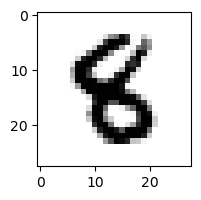

6.774934206056772e-20% - 0
3.7024963986938483e-11% - 1
2.4123302519679955e-24% - 2
3.602342636802519e-20% - 3
1.0743335660768862e-10% - 4
0.5634698217779991% - 5 - ОШИБКА
9.170198013277441e-16% - 6
1.6889783308101455e-14% - 7
7.775860498911015e-28% - 8
4.613427152364103e-34% - 9

 8


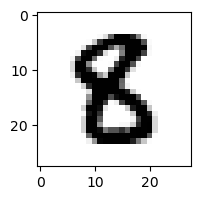

5.544586194348527e-16% - 0
5.196715504135601e-14% - 1
4.420252094841285e-22% - 2
9.820809411472662e-19% - 3
1.1796029977058545e-18% - 4
0.9746659555331925% - 5 - ОШИБКА
4.3531417661582016e-20% - 6
1.2239808562441085e-17% - 7
6.516472730989736e-25% - 8
2.539038998038158e-41% - 9

 2


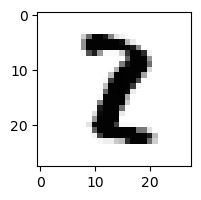

1.3587706697718183e-23% - 0
5.519354731473931% - 1 - ОШИБКА
6.821489043016886e-07% - 2
7.437035770180336e-12% - 3
1.2122149858313177e-15% - 4
3.4616277882526637e-09% - 5
2.446692106305583e-22% - 6
2.037594597367665e-09% - 7
5.997200875099165e-22% - 8
2.933778485129485e-32% - 9

 8


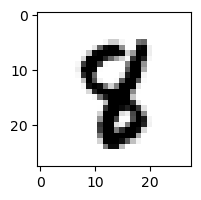

1.285180778306109e-23% - 0
1.1509394002782236e-09% - 1
2.5934862555455235e-20% - 2
1.315942880337555e-22% - 3
3.432497442630517e-10% - 4
0.005751801065540458% - 5 - ОШИБКА
2.0990458281405786e-18% - 6
2.307072015883779e-05% - 7
9.603394702594643e-18% - 8
6.225484901910411e-24% - 9

 3


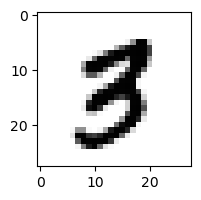

1.0785327885209077e-14% - 0
6.710844650433862e-11% - 1
1.3027512789398143e-16% - 2
5.4295844558887244e-11% - 3
5.47198715610298e-15% - 4
0.0005810331914981329% - 5 - ОШИБКА
1.0924714542317916e-21% - 6
9.039628770414669e-06% - 7
4.686576622743039e-13% - 8
4.261075289327613e-10% - 9

 9


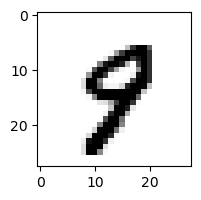

2.2954650671741975e-14% - 0
2.499618835323564e-10% - 1
7.805738573612031e-23% - 2
4.1500249853646893e-19% - 3
1.8634709289608803e-06% - 4
2.0020446695292665e-05% - 5
6.753318327233462e-13% - 6
0.13974491113414078% - 7 - ОШИБКА
1.2677997363626223e-17% - 8
0.0066539853060573004% - 9

 3


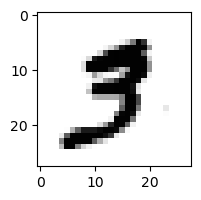

8.702062264021311e-13% - 0
3.3457628910685645e-10% - 1
7.835830815400875e-18% - 2
8.662949319201403e-07% - 3
1.3159269876620096e-15% - 4
4.8138650120120355e-05% - 5
4.961381971226434e-23% - 6
0.07775190520606173% - 7 - ОШИБКА
1.6193477074683342e-26% - 8
2.1279689508150314e-13% - 9

 8


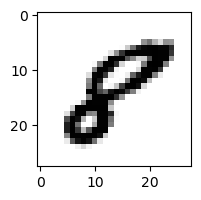

1.6504364544440543e-05% - 0
8.425179447660327e-12% - 1
2.2234084045617543e-11% - 2
1.8875326001745321e-28% - 3
3.42014645345406e-10% - 4
0.0037403388960564957% - 5 - ОШИБКА
1.0854839098628123e-15% - 6
1.7882207258739463e-08% - 7
8.194930132286565e-05% - 8
3.83092014291829e-10% - 9

 9


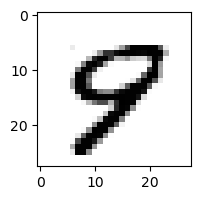

6.710731810643034e-12% - 0
4.0117444721680814e-13% - 1
7.900395978224966e-21% - 2
2.230733409028964e-29% - 3
0.0001499941550068201% - 4
0.0008942765509366469% - 5
9.098767843811136e-13% - 6
0.006108453557507811% - 7 - ОШИБКА
1.654151041957585e-20% - 8
0.0003659447237589218% - 9

 2


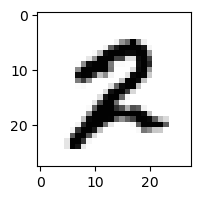

3.814016317257948e-17% - 0
1.563404344517128e-09% - 1
1.4339249849401764e-05% - 2
9.689827378794908e-29% - 3
1.1928738487976382e-23% - 4
6.17691456213994e-05% - 5 - ОШИБКА
1.1159708004966149e-13% - 6
2.4405742763141872e-08% - 7
1.8612105004242401e-07% - 8
3.2933740110339623e-13% - 9

 4


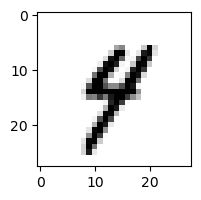

8.122838034217244e-13% - 0
0.0010106899085518372% - 1
4.734481727993381e-18% - 2
2.390933473719144e-11% - 3
0.020934278316193516% - 4
0.0023827305290252784% - 5
2.7734222903641617e-10% - 6
0.03281846275186063% - 7
1.8846718306377752e-12% - 8
1.4425300550624265% - 9 - ОШИБКА

 9


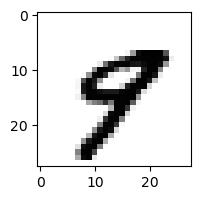

2.981304651877308e-15% - 0
6.05781488283282e-11% - 1
4.251683330272158e-27% - 2
2.2326877498702715e-23% - 3
0.013428895737703684% - 4
3.837410032235631e-05% - 5
7.379819714792391e-19% - 6
0.41011089094014164% - 7 - ОШИБКА
1.0979935225049895e-17% - 8
4.145813822027689e-12% - 9

 3


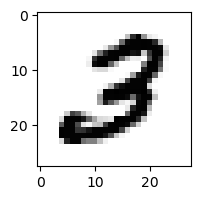

1.1789706995687732e-13% - 0
5.187821273845618e-13% - 1
3.982508184576354e-05% - 2
3.739010047432579e-06% - 3
2.3400031776875015e-20% - 4
0.008816031333298963% - 5 - ОШИБКА
1.9116241517266505e-17% - 6
3.2272211790964194e-08% - 7
1.2010507898730848e-20% - 8
2.5528321462787574e-30% - 9

 3


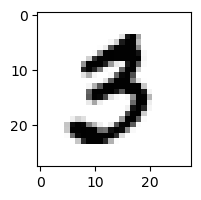

2.5914663349660503e-09% - 0
9.267791224301906e-12% - 1
6.165184398031132e-11% - 2
0.06785468593757739% - 3
5.263794382774641e-18% - 4
3.0347809287249246% - 5 - ОШИБКА
2.220082213877947e-20% - 6
1.672340979301966e-08% - 7
3.1054231172790395e-25% - 8
3.5603469105355155e-18% - 9

 8


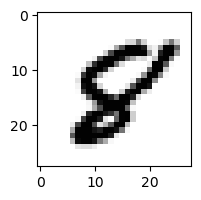

1.9548769213299613e-12% - 0
2.9582750608694345e-15% - 1
6.123588792342834e-16% - 2
1.6100782732493256e-42% - 3
1.1028967483418116e-13% - 4
0.04578616193367946% - 5 - ОШИБКА
5.092796688139448e-13% - 6
1.4048952715639068e-09% - 7
4.11072735847659e-06% - 8
8.6405379137848475e-16% - 9

 9


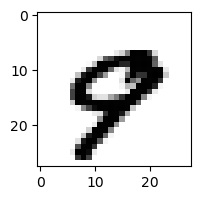

5.0216685531078686e-11% - 0
2.557147094280474e-13% - 1
9.944668842406493e-30% - 2
2.2156771793643204e-40% - 3
4.556702275919185e-05% - 4
4.3658414789907653e-16% - 5
4.079503681992444e-18% - 6
48.79311808710862% - 7 - ОШИБКА
5.914642764664247e-25% - 8
1.6787275131682841e-06% - 9

 9


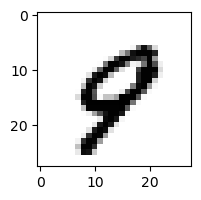

2.3620141685912092e-09% - 0
2.203470321340275e-09% - 1
1.7923282030992515e-18% - 2
5.0385537708274074e-30% - 3
0.010058439214126042% - 4
1.0710974923825579e-10% - 5
1.2500376455427738e-10% - 6
1.0447035303448668% - 7 - ОШИБКА
1.3286782597782037e-17% - 8
0.0004487943327590244% - 9

 9


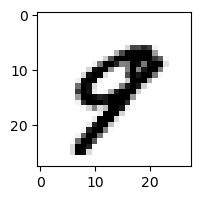

5.011905117559234e-10% - 0
1.217010805939298e-07% - 1
2.6845090151502997e-22% - 2
6.620508898837806e-26% - 3
1.8267361733605951e-06% - 4
8.122962842631295e-08% - 5
1.4167701201430337e-18% - 6
3.600986352607913% - 7 - ОШИБКА
3.092294097038569e-19% - 8
0.005431305990218821% - 9

 8


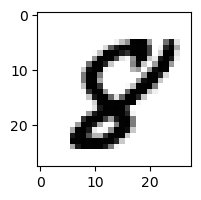

1.526706934933369e-15% - 0
6.455560718256759e-19% - 1
7.977783536998102e-24% - 2
1.8729127343269554e-43% - 3
5.034633029634691e-16% - 4
0.0382335210681391% - 5 - ОШИБКА
1.150862177320356e-20% - 6
6.406656650428523e-10% - 7
4.2228855816063277e-07% - 8
3.831238105849385e-29% - 9

 8


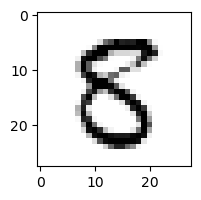

5.05383165566887e-06% - 0
5.756005768216396e-13% - 1
2.8758983723772725e-17% - 2
1.2047482389242751e-08% - 3
2.5785111896386273e-08% - 4
91.3966316839303% - 5 - ОШИБКА
4.3243308898349545e-20% - 6
1.6990901873174511e-10% - 7
1.8139984623497502e-10% - 8
2.197741672410925e-33% - 9

 8


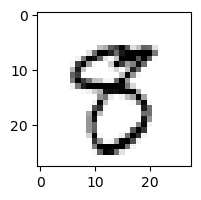

2.1343234071416307e-10% - 0
2.975782643032551e-09% - 1
2.0735447829832222e-20% - 2
3.12366881460477e-06% - 3
4.762996205399788e-13% - 4
0.21250049518830236% - 5 - ОШИБКА
1.879980554018122e-18% - 6
0.0005877718525194758% - 7
1.2643481052670688e-12% - 8
0.0073802111429788365% - 9

 5


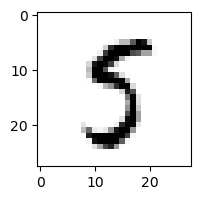

7.020263165972327e-07% - 0
5.289420622537291e-07% - 1
8.809388531009952e-18% - 2
9.365877010067881e-06% - 3
4.317996529685822e-12% - 4
98.77747354297777% - 5
2.7631713649553623e-10% - 6
7.012247552939637e-05% - 7
99.39923833410079% - 8 - ОШИБКА
7.699895572549145e-09% - 9

 3


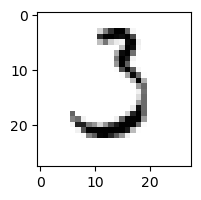

0.2404784316444019% - 0
1.2439198533743813e-05% - 1
99.98701414710952% - 2 - ОШИБКА
99.82752663972596% - 3
1.5224676280039824e-15% - 4
0.08568624215898499% - 5
0.2575424675545453% - 6
0.0016721460034815547% - 7
3.622072231661068e-16% - 8
9.79137940538528e-16% - 9

 8


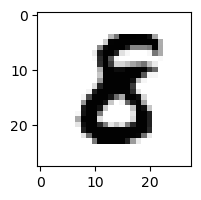

2.033325744557433e-16% - 0
4.079351651159767e-09% - 1
8.10941963561369e-16% - 2
4.9108842141107036e-15% - 3
5.1834146244985076e-20% - 4
1.0692066046865734e-05% - 5 - ОШИБКА
6.5777250093094964e-18% - 6
4.035858778977959e-17% - 7
1.615441664590547e-18% - 8
1.7139843412565787e-41% - 9

 8


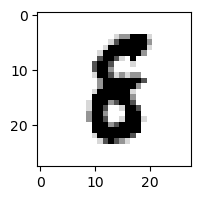

1.6714376665540459e-19% - 0
1.2537869133107873e-07% - 1
3.5659416634095595e-13% - 2
1.3933335714116436e-20% - 3
2.5461400515110063e-17% - 4
0.14730137332557788% - 5 - ОШИБКА
0.0003944244687509394% - 6
1.172403129730368e-15% - 7
0.04966892335638249% - 8
1.599349017254518e-19% - 9

 8


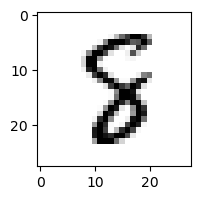

4.57566124998552e-15% - 0
3.1567016939445327e-06% - 1
4.768836476148061e-11% - 2
1.8162667490890613e-15% - 3
5.468623693414616e-09% - 4
0.6072437963336486% - 5 - ОШИБКА
0.0007325383712633986% - 6
1.1512300235614086e-06% - 7
0.0009023646625636915% - 8
2.4742035029455198e-29% - 9

 9


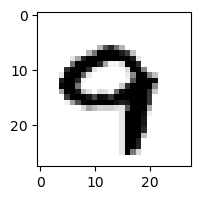

6.8937471229714e-18% - 0
4.630089649541071e-14% - 1
2.681216039717087e-19% - 2
7.853247519034065e-24% - 3
2.3099290793986208e-07% - 4
3.113317798980972e-09% - 5
5.33369969011255e-14% - 6
0.09433723706139481% - 7 - ОШИБКА
1.048729980818483e-29% - 8
2.657543796127465e-05% - 9

 8


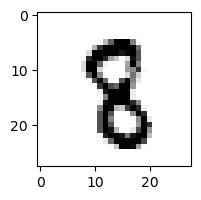

1.5245480632609852e-21% - 0
1.7633395444758662e-07% - 1
2.4385046770361936e-12% - 2
1.2529448798955117e-15% - 3
1.6116317663502645e-09% - 4
0.010587148843621613% - 5 - ОШИБКА
7.026538081193124e-16% - 6
1.0867024442815318e-06% - 7
8.391976701518784e-07% - 8
5.3178102379710005e-19% - 9

 8


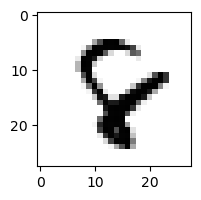

1.8547299593881667e-16% - 0
1.0025756741798628e-12% - 1
8.242486596707399e-14% - 2
6.551002583116681e-29% - 3
0.06280961139317322% - 4 - ОШИБКА
2.1297869528226494e-07% - 5
0.0003526344919195536% - 6
0.000445883698211233% - 7
1.8484005895222693e-16% - 8
1.6831500817471547e-24% - 9

 2


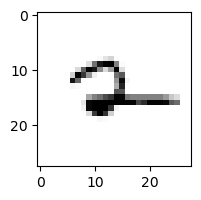

2.52198307590693e-11% - 0
13.555669508203517% - 1
0.0005659589964878183% - 2
1.9776759694113658e-17% - 3
99.30660941164165% - 4
0.00023902864696311905% - 5
88.5662049678696% - 6
2.227782148452475% - 7
0.47642532124569836% - 8
99.88498205987713% - 9 - ОШИБКА

 2


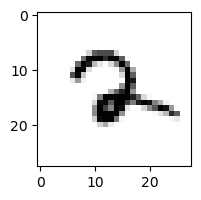

5.634525698916098e-18% - 0
0.13675840663090438% - 1
6.115614848135301% - 2
6.120669103311637e-18% - 3
0.01092618059359611% - 4
7.769089981191338e-06% - 5
0.0031729630547358218% - 6
96.26505291708196% - 7 - ОШИБКА
9.497690453869717e-10% - 8
3.887344618077508e-05% - 9

 8


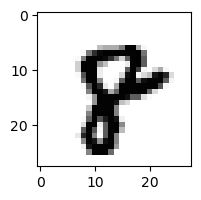

6.772187175026425e-18% - 0
3.091474227319678e-15% - 1
5.679853964598016e-25% - 2
6.385913184045482e-35% - 3
1.2721826380150992e-16% - 4
1.2922345778974942e-12% - 5
1.4953962644510934e-13% - 6
0.0003981843497729343% - 7 - ОШИБКА
1.2432202857865138e-09% - 8
2.9987001419427124e-08% - 9

 0


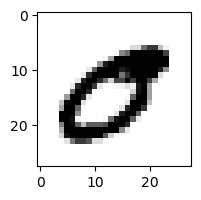

0.0888065231378932% - 0
6.437442626552009e-17% - 1
3.3406141331798878e-31% - 2
1.0589638737098854e-16% - 3
5.714709000236771e-13% - 4
6.591139614910978e-06% - 5
2.5747979557439386e-30% - 6
0.5827271332751569% - 7 - ОШИБКА
2.1971933155164603e-43% - 8
3.901678733844094e-31% - 9

 5


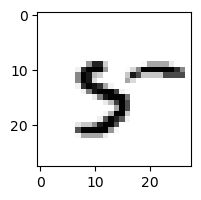

5.52600597117938e-07% - 0
9.76547957931398e-06% - 1
3.1674215203107365e-11% - 2
7.008973781068296e-18% - 3
25.800646876915582% - 4 - ОШИБКА
0.0045289477097654966% - 5
0.03128715750601394% - 6
0.0013282139701324069% - 7
0.3631626641216395% - 8
1.0456213940783476e-05% - 9

 9


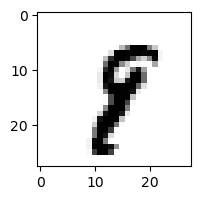

3.069631765288214e-18% - 0
0.002655578053703218% - 1
6.003633862270709e-17% - 2
4.9402460374268886e-14% - 3
2.1422464535127028e-13% - 4
9.549817124777697e-05% - 5
3.6526329315297555e-11% - 6
0.020803103277433205% - 7 - ОШИБКА
3.081281084834734e-09% - 8
1.1115108606237692e-07% - 9

 2


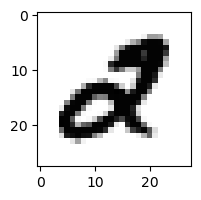

3.80401838416879e-10% - 0
1.2506394907023868e-15% - 1
2.6005840807372343e-08% - 2
2.780667685208072e-24% - 3
3.0944426102763562e-09% - 4
3.8118179886363684e-07% - 5 - ОШИБКА
2.511606141904215e-24% - 6
2.259704511707109e-13% - 7
4.5274038562489e-49% - 8
4.549766718715657e-34% - 9

 9


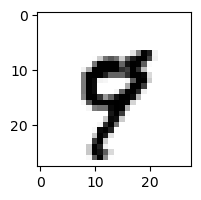

1.2200353551609393e-15% - 0
8.075335154372547e-07% - 1
1.9411676769612132e-22% - 2
1.3435614945012258e-25% - 3
5.290799734734513e-05% - 4
2.1141599298703423e-05% - 5
3.1292961206969378e-15% - 6
50.38490314386771% - 7 - ОШИБКА
1.3090252548825052e-21% - 8
2.094960752322352e-08% - 9

 9


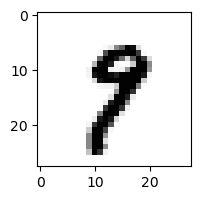

1.4038293124217932e-15% - 0
0.001966682146654743% - 1
1.1762971839059552e-20% - 2
5.676608228215249e-15% - 3
3.0642265499376785e-13% - 4
5.880777283207863e-06% - 5
4.33091962468304e-15% - 6
37.09066215623106% - 7 - ОШИБКА
2.276214071445343e-05% - 8
0.0011199488107949101% - 9

 9


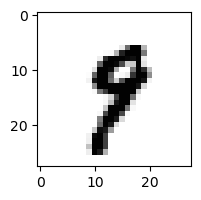

1.1785445591082654e-16% - 0
2.779363381325887e-05% - 1
2.640785701600436e-21% - 2
2.0899960435731232e-16% - 3
7.093422872419906e-09% - 4
2.8862513358509674e-06% - 5
5.092085778356219e-11% - 6
0.1509976855163015% - 7 - ОШИБКА
1.5847019269367986e-09% - 8
0.09107243764815318% - 9

 8


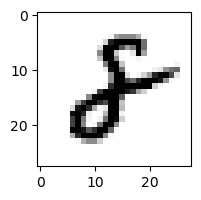

9.45253343422845e-13% - 0
0.0031745879324226044% - 1
0.09594316762268743% - 2 - ОШИБКА
9.416286048327013e-20% - 3
1.176040022906641e-16% - 4
2.376718700441513e-12% - 5
8.641428960776106e-11% - 6
5.3686361976574897e-14% - 7
8.746813271908479e-13% - 8
3.1800080196967074e-20% - 9

 9


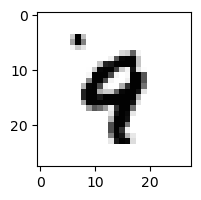

5.810800917057411e-17% - 0
1.6638044301139433e-06% - 1
1.6798887864346465e-17% - 2
9.20016310607575e-22% - 3
92.26604582109975% - 4 - ОШИБКА
2.3262092551879038e-05% - 5
1.0544186730647481e-05% - 6
0.02361834045593176% - 7
3.24319916083687e-21% - 8
2.5364048429120715e-06% - 9

 2


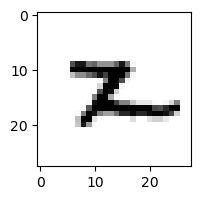

4.513745335885154e-14% - 0
0.021749795849985664% - 1 - ОШИБКА
7.186752797824923e-06% - 2
3.6523726991266117e-20% - 3
8.522341661143106e-07% - 4
0.003024787335643092% - 5
8.536220039308818e-06% - 6
7.97839651490824e-08% - 7
0.016870383370481874% - 8
1.2570370251923158e-10% - 9

 8


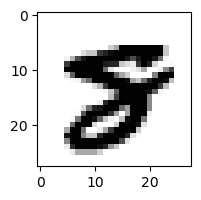

2.3882392812077872e-26% - 0
4.456812044496665e-19% - 1
2.6462547451629875e-43% - 2
2.8315389679610336e-39% - 3
3.9703902006538446e-26% - 4
5.949149972972608e-10% - 5
1.2171980488000573e-27% - 6
7.98648054489831e-08% - 7 - ОШИБКА
3.299268812774681e-17% - 8
9.802135095492285e-39% - 9

 5


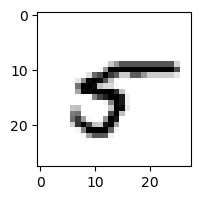

4.825807328068384e-06% - 0
0.00011802626864448273% - 1
2.1175496810235207e-17% - 2
2.7594742595023002e-11% - 3
0.018686590021906407% - 4 - ОШИБКА
0.006125891687305662% - 5
1.0767353127767429e-10% - 6
0.0022168964181461586% - 7
3.543878679064598e-12% - 8
1.0870609952997119e-16% - 9

 6


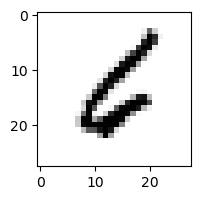

0.003057125862130348% - 0
0.0002996255013594166% - 1
5.360181408431444e-05% - 2
1.1302540406005709e-10% - 3
2.149731805267537e-05% - 4
0.05441720890538987% - 5 - ОШИБКА
0.009695691039505586% - 6
1.2063232576838694e-06% - 7
5.438773897422797e-27% - 8
8.852785864001327e-23% - 9

 9


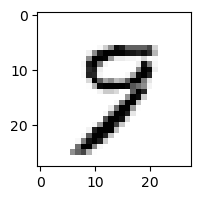

1.786723265015981e-09% - 0
3.2944956971770247e-10% - 1
8.84799106991764e-15% - 2
1.6075885705814914e-10% - 3
1.3925020912298139e-06% - 4
0.0003634838129305299% - 5
6.551396358719477e-10% - 6
3.317848239993716% - 7 - ОШИБКА
9.955015402185595e-09% - 8
1.3243180385942335% - 9

 1


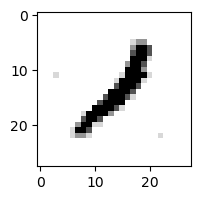

1.336413685011356e-10% - 0
96.69474006070055% - 1
85.5016904431774% - 2
1.773819774696358e-10% - 3
0.00023003516184058988% - 4
3.4701508218380565e-09% - 5
5.126203520248527e-09% - 6
0.0084849660976248% - 7
99.97139900438437% - 8 - ОШИБКА
3.511521002784506e-05% - 9

 3


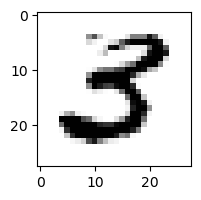

1.906916037828748e-10% - 0
9.656806554952174e-10% - 1
4.35443091938951e-24% - 2
0.03464104518504804% - 3
6.62299121255501e-15% - 4
99.28150604363368% - 5 - ОШИБКА
1.8062111200074564e-23% - 6
1.7699126583724714e-10% - 7
1.945860215921766e-28% - 8
2.8086731136430224e-48% - 9

 6


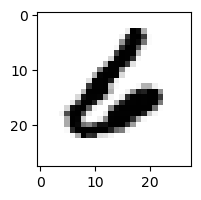

9.295866743791338e-08% - 0
1.7691243503774478e-16% - 1
2.0309296996821356e-10% - 2
1.0987653590096993e-19% - 3
4.920365274395759e-10% - 4
0.03877749614666779% - 5 - ОШИБКА
0.031155152277335403% - 6
2.0771006048764782e-10% - 7
6.1512611346295e-54% - 8
1.162266598803932e-33% - 9

 3


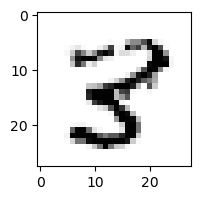

2.754125721372934e-16% - 0
7.1526765991815245e-09% - 1
3.2632881604051963e-12% - 2
3.0604724431790767e-13% - 3
0.00010967999052137115% - 4
0.07507783680558931% - 5
9.679253777530206e-19% - 6
2.0214351325286077e-08% - 7
99.98186304994738% - 8 - ОШИБКА
5.126915883200853e-25% - 9

 0


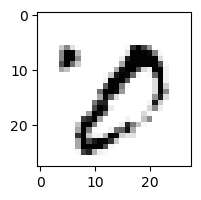

2.7147210126893015e-06% - 0
0.0026533631124139342% - 1
1.8405719189367548e-16% - 2
3.44284271388129% - 3 - ОШИБКА
7.225036537676546e-15% - 4
2.0276370284019386e-11% - 5
2.5277130276548148e-19% - 6
0.00010191136527978717% - 7
0.6593612043684609% - 8
3.662963894312055e-23% - 9

 9


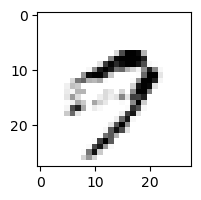

0.49439923436009703% - 0
1.0077569698202819e-10% - 1
2.594139862456848e-17% - 2
1.0056808361159964e-10% - 3
3.4660607824376217e-06% - 4
4.6243962802384247e-07% - 5
1.1218004100991115e-09% - 6
98.64760524031377% - 7 - ОШИБКА
9.814596649080266e-12% - 8
92.91004492131466% - 9

 1


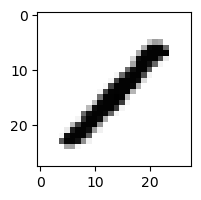

7.793318778403301e-13% - 0
98.25997790471783% - 1
0.009880072801247123% - 2
1.0774515642154692e-10% - 3
3.99263819265094e-05% - 4
2.3234712528204346e-06% - 5
6.537743632109145e-15% - 6
8.052020662080611e-06% - 7
99.7840005331435% - 8 - ОШИБКА
1.44118859483183e-14% - 9

 3


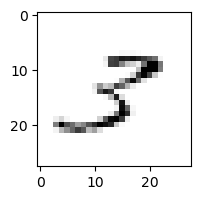

0.02246692555195815% - 0
0.12038899115874344% - 1
93.08046901981626% - 2 - ОШИБКА
65.73927374913046% - 3
3.437973195436269e-05% - 4
1.7592590746266737e-05% - 5
2.784513281557211e-06% - 6
1.2055732478436907% - 7
0.09992159435727667% - 8
0.021641523866197884% - 9

 3


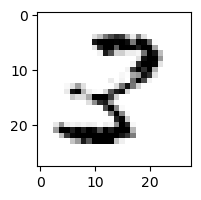

2.6455263889174323e-05% - 0
0.0005746461595293675% - 1
0.0072188381748671945% - 2 - ОШИБКА
0.0003700329870340215% - 3
1.6237121250958732e-11% - 4
0.00024189999204325127% - 5
1.727684129993414e-18% - 6
2.2096212909299903e-09% - 7
1.3478548672470222e-06% - 8
2.2016564203037628e-26% - 9

 2


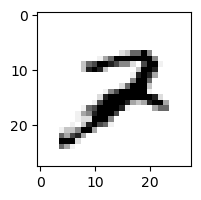

6.475429692459693e-13% - 0
5.6196157077015215e-05% - 1
0.07813868702880061% - 2
1.0726978772324736e-20% - 3
2.1328479062639455e-07% - 4
2.9319365823334853e-11% - 5
9.512193744526302e-08% - 6
43.60705011494749% - 7 - ОШИБКА
9.681647699781236e-08% - 8
2.961039151846932e-08% - 9

 3


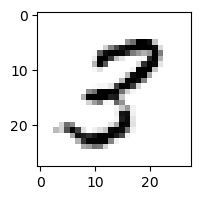

4.18552094341146e-06% - 0
2.273084591411306e-07% - 1
2.185321219296041e-05% - 2
0.5575304134561201% - 3
2.3852944187436417e-09% - 4
0.06823267977793565% - 5
8.209120799502815e-15% - 6
1.0100144227985542e-06% - 7
3.231989836796582% - 8 - ОШИБКА
4.987569123855853e-08% - 9

 3


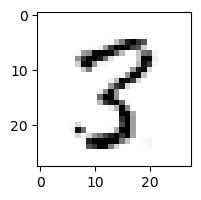

2.5482170632983473e-11% - 0
2.948801518802288e-06% - 1
9.311338244502575e-08% - 2
0.021316420186672347% - 3
7.067947609800776e-09% - 4
0.500922701780008% - 5
8.15915265303508e-18% - 6
0.0007697038126569728% - 7
99.99999943450833% - 8 - ОШИБКА
3.8387174233365783e-16% - 9

 9


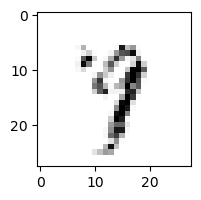

1.568769247954878e-08% - 0
2.6952099696489927e-05% - 1
1.008840615037272e-06% - 2
0.00018347710408302272% - 3
3.7523064937884607% - 4
0.0004140386381716311% - 5
1.0075473786705929e-05% - 6
97.63665295724894% - 7 - ОШИБКА
3.815255502876553e-06% - 8
18.65060120955679% - 9

 8


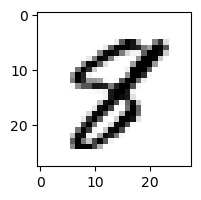

3.1245588510415553e-16% - 0
7.005616743008452e-09% - 1
8.643288552739178e-20% - 2
3.716312512994258e-19% - 3
3.775436682144217e-11% - 4
0.008274544460143583% - 5 - ОШИБКА
1.0222845609938801e-17% - 6
9.295277528771247e-06% - 7
0.0004735912255800343% - 8
2.7346874361240267e-18% - 9

 2


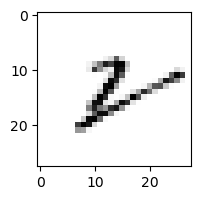

2.2044886721384996e-05% - 0
84.25413902373518% - 1
31.69123786941669% - 2
2.4138174520318117e-12% - 3
0.0009304919490549269% - 4
1.194482324326776e-06% - 5
46.43470403945526% - 6
3.513500265396489e-06% - 7
99.54759874507006% - 8 - ОШИБКА
0.07293393925490098% - 9

 8


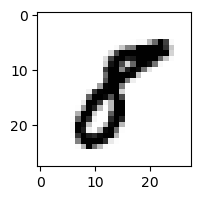

8.611267193331457e-10% - 0
0.0015492166670932688% - 1
2.061208958251082e-15% - 2
3.29193720365837e-15% - 3
1.638231205095649e-13% - 4
0.14190321133001493% - 5 - ОШИБКА
4.43170971469968e-25% - 6
6.101827247996653e-09% - 7
4.9489498336301566e-15% - 8
1.7617781734427096e-22% - 9

 2


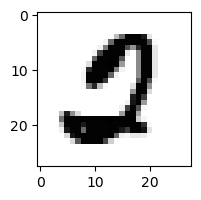

0.006398767686813959% - 0
1.9091011687589046e-18% - 1
9.379573851771743e-13% - 2
3.053046119727072e-16% - 3
8.177123028882692e-27% - 4
21.158941725271383% - 5 - ОШИБКА
1.0132882760735341e-16% - 6
6.647993248297051e-10% - 7
4.246851648146924e-22% - 8
2.1189430699904556e-37% - 9

 5


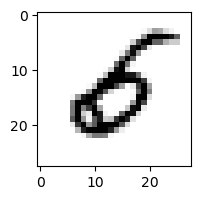

0.003010304141080757% - 0
2.288015220425171e-08% - 1
1.6459590556364557e-06% - 2
7.552426329962212e-15% - 3
9.896076799891223e-06% - 4
0.008331275026638791% - 5
97.48882836234483% - 6 - ОШИБКА
3.243950859983516e-10% - 7
4.620342928336344e-29% - 8
3.264746390916528e-17% - 9

 8


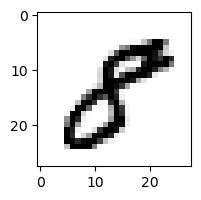

1.576743717255494e-09% - 0
6.254137202287834e-08% - 1
1.1517195481307983e-17% - 2
3.636801291621529e-12% - 3
5.387594474779593e-10% - 4
0.10408593130494147% - 5 - ОШИБКА
3.4847998797849135e-23% - 6
1.3923499170842021e-08% - 7
4.1267286399327152e-16% - 8
7.890202429410667e-18% - 9

 9


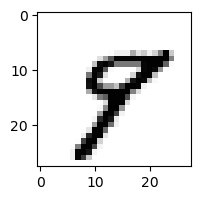

2.0968244954314624e-14% - 0
5.005404596094637e-07% - 1
1.8285099228206998e-20% - 2
1.2669341272519758e-20% - 3
0.00020318411309492516% - 4
0.0007526069010830224% - 5
6.018660233425196e-15% - 6
0.4199993337932283% - 7 - ОШИБКА
0.014927389729131393% - 8
4.263939690342272e-06% - 9

 4


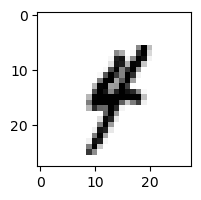

2.051383468921776e-16% - 0
0.9261590712348756% - 1 - ОШИБКА
1.5359995916785227e-13% - 2
2.4009382830965883e-08% - 3
0.047565219904898516% - 4
5.2603250300301106e-05% - 5
1.873116172022002e-10% - 6
0.0014983766118354786% - 7
5.9416105985565555e-15% - 8
4.77639758963456e-05% - 9

 9


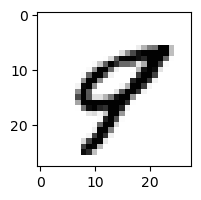

2.037134230025814e-10% - 0
3.2096959206509296e-08% - 1
4.620803060334791e-21% - 2
6.892631696424566e-32% - 3
3.0461615862315754% - 4 - ОШИБКА
1.3196085719364685e-06% - 5
1.714481089902542e-14% - 6
0.5234243883078147% - 7
6.907324744422774e-09% - 8
3.1779906488117795e-07% - 9

 9


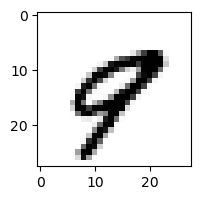

1.9674227552808245e-10% - 0
8.301783729774579e-08% - 1
1.0054169517037669e-20% - 2
4.039144505434892e-31% - 3
0.009993188963504753% - 4
7.558038948231496e-12% - 5
6.311621724186302e-15% - 6
17.950968980889765% - 7 - ОШИБКА
1.7219198125044682e-10% - 8
2.2906313919173946e-11% - 9

 8


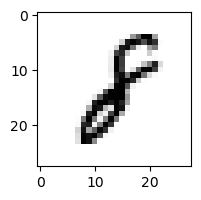

8.014818037186147e-14% - 0
89.64755425880458% - 1 - ОШИБКА
0.004588017592739513% - 2
9.570327964150252e-15% - 3
6.168810497888565e-11% - 4
4.146118248872866e-08% - 5
8.32090712443747e-08% - 6
1.1249023469724763e-06% - 7
0.0008634352772241107% - 8
1.6210223018599916e-11% - 9

 4


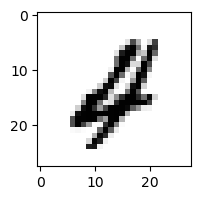

7.731413082258886e-09% - 0
4.2790987411880446e-07% - 1
0.0018924037557014068% - 2 - ОШИБКА
1.1811533338826223e-20% - 3
4.7204307710323423e-08% - 4
4.491550678894411e-09% - 5
5.955850361227712e-10% - 6
1.6482167463397278e-08% - 7
4.6161240184070464e-18% - 8
5.826520927479373e-18% - 9

 2


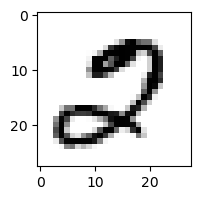

0.02209512296042607% - 0 - ОШИБКА
3.314654916200729e-13% - 1
0.00019185651377537802% - 2
1.1764772997486813e-24% - 3
9.350755060482577e-18% - 4
2.660853076710519e-07% - 5
5.948789387025665e-12% - 6
0.0019119148183339007% - 7
1.0358423968839999e-13% - 8
1.3286307163300163e-23% - 9

 8


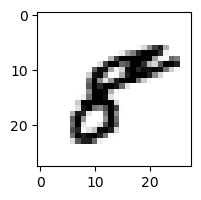

7.420503230082205e-06% - 0
1.1273883301561547e-07% - 1
4.638434047966571e-15% - 2
2.3695275381667327e-19% - 3
1.2572603196960984e-06% - 4
9.615980544486712e-05% - 5 - ОШИБКА
2.649954824959523e-22% - 6
2.1768330380524176e-06% - 7
4.806652411097155e-12% - 8
6.422906612328933e-12% - 9

 4


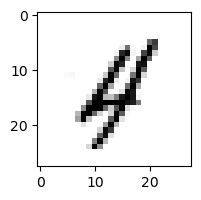

6.702734090476753e-08% - 0
0.03602315700063282% - 1
6.714801089852776e-05% - 2
1.6339431911586865e-12% - 3
0.008379040121353062% - 4
1.0781551591467207e-06% - 5
2.604803998327181e-06% - 6
5.2947428621225867e-05% - 7
0.05251854969563709% - 8 - ОШИБКА
4.5514233798027343e-05% - 9

 9


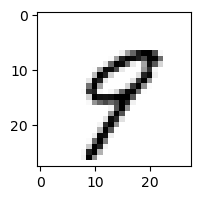

1.2907321511186609e-09% - 0
8.859005089538076e-06% - 1
7.543956799961812e-14% - 2
2.5049085560586406e-10% - 3
0.1078264092715341% - 4
0.0021896519977745495% - 5
7.967640813454913e-10% - 6
12.941327850221684% - 7 - ОШИБКА
1.664098232865182e-08% - 8
0.004145113111844404% - 9

 2


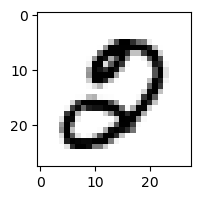

3.357272597954022e-06% - 0
5.748932046309515e-13% - 1
1.9241014693063964e-16% - 2
4.1932153780161976e-22% - 3
2.2016058545117258e-13% - 4
4.1058612131368616e-05% - 5 - ОШИБКА
1.208832923215162e-13% - 6
5.051288129388061e-06% - 7
3.390532447790123e-15% - 8
3.4026451202640676e-28% - 9

 5


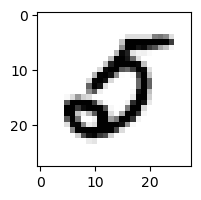

3.7196712283453977% - 0 - ОШИБКА
3.723147120659801e-14% - 1
3.2438143092674976e-07% - 2
2.245716379849329e-27% - 3
3.4966891410036045e-11% - 4
2.607618737892173e-06% - 5
2.969487986067143e-06% - 6
1.3852905287625353e-06% - 7
3.079337648362791e-33% - 8
2.878293554114915e-25% - 9

 5


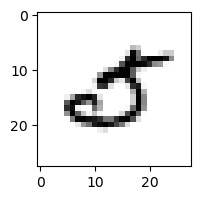

17.400009337497263% - 0 - ОШИБКА
2.8756510602719042e-08% - 1
1.1676102773583101e-06% - 2
3.7679505889596664e-06% - 3
1.3868494497938636e-05% - 4
3.374686363683034% - 5
8.689328964221664e-09% - 6
0.0185043087566181% - 7
7.686469873622085e-22% - 8
3.897265904485487e-19% - 9

 2


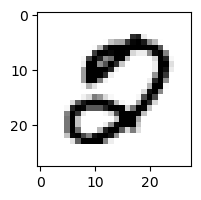

9.396021666161369e-05% - 0
3.344351305354859e-17% - 1
6.145506753829073e-13% - 2
1.6843448953527097e-32% - 3
2.7997090835922815e-13% - 4
0.0008994773289049566% - 5 - ОШИБКА
3.453241718462216e-13% - 6
3.528828407441743e-08% - 7
5.021237435202415e-15% - 8
1.666712511392248e-30% - 9

 8


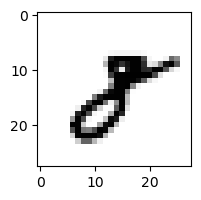

9.986402869137657e-11% - 0
0.16827715533625298% - 1 - ОШИБКА
1.338079922129917e-07% - 2
1.063484096781611e-09% - 3
8.035689085276767e-14% - 4
9.912114442457728e-10% - 5
1.4068857251151904e-19% - 6
0.0008304615475351742% - 7
2.2413691415775692e-07% - 8
7.864412275525557e-13% - 9

 9


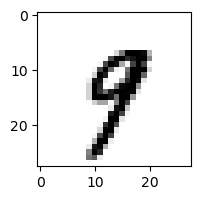

1.1184975055772786e-13% - 0
2.1303295785801613e-05% - 1
3.6834085149260947e-16% - 2
7.19802095056172e-10% - 3
0.0018612521824528596% - 4
4.562727273652803e-05% - 5
4.92440871477149e-13% - 6
7.450008443186483% - 7 - ОШИБКА
8.932830575716021e-13% - 8
0.47184854687910993% - 9

 4


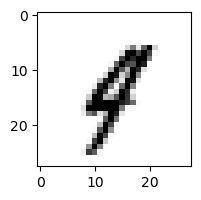

5.950091399465436e-12% - 0
1.23338289544021% - 1 - ОШИБКА
2.982384461499636e-09% - 2
1.2614655070995859e-12% - 3
0.0010835218274033512% - 4
2.837607870996085e-07% - 5
1.3224172914206233e-10% - 6
0.0010147964876345986% - 7
8.356332234344765e-09% - 8
5.503325825158641e-06% - 9

 2


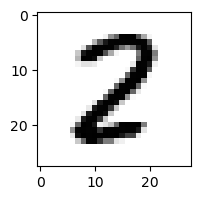

8.552895969997549e-14% - 0
1.4721337814614416e-06% - 1
3.0122603584093777% - 2
2.8380218282768365e-14% - 3
2.9884357121399615e-19% - 4
1.493159453681142e-06% - 5
9.313416994128928e-17% - 6
2.342750968056983e-10% - 7
6.070647027796882% - 8 - ОШИБКА
1.8474005401347687e-41% - 9

 9


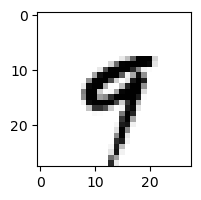

2.0211814334127405e-14% - 0
1.8994855440675783e-06% - 1
1.190530635554522e-20% - 2
1.1772471312587257e-10% - 3
62.495805841015006% - 4 - ОШИБКА
0.0004096374827905874% - 5
8.317401446466496e-11% - 6
1.386495647679606% - 7
6.8641642512367784e-18% - 8
7.872306330781634e-07% - 9

 2


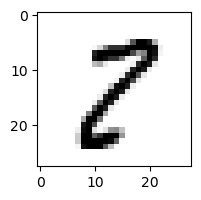

3.1208251438781518e-06% - 0
9.597193560323548e-05% - 1
8.905793159982358e-06% - 2
2.5233646674098778e-05% - 3
1.8267490896478338e-16% - 4
0.008794520060019781% - 5
1.7652040317046412e-17% - 6
8.07253185575107e-05% - 7
99.99999999708153% - 8 - ОШИБКА
1.0142155006779168e-08% - 9

 2


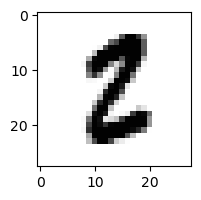

2.4367539336088317e-15% - 0
3.1602843103116087e-06% - 1
3.2423814959159106e-08% - 2
2.047420944304785e-17% - 3
1.702942238239938e-28% - 4
0.02445103900773023% - 5 - ОШИБКА
1.1257371891328519e-15% - 6
5.201876793904984e-12% - 7
4.997911984645341e-10% - 8
9.390726635486159e-29% - 9

 4


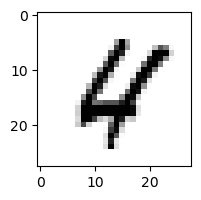

4.540750690444599e-10% - 0
1.6493849791408578e-11% - 1
5.536600887635573e-07% - 2
3.0535529731283743e-34% - 3
0.09040048485661302% - 4
4.6171617239695513e-07% - 5
5.4094329408487786e-06% - 6
0.00012542771405519448% - 7
0.7736056568870168% - 8 - ОШИБКА
1.9747137903381017e-10% - 9

 2


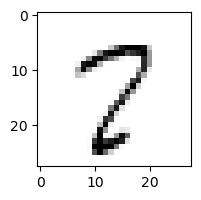

0.002035890412311567% - 0
2.3657041733265932e-05% - 1
5.008073225806172e-05% - 2
2.004596449499326e-05% - 3
8.216235675669281e-09% - 4
0.5679193401410434% - 5
1.2101408884210336e-09% - 6
97.56632401437304% - 7
99.999440631466% - 8 - ОШИБКА
5.780273227572016% - 9

 3


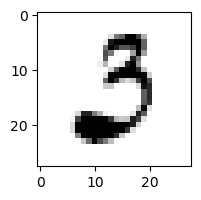

61.963177016058715% - 0 - ОШИБКА
0.00011419791039627611% - 1
0.0010073650352694745% - 2
1.1671820633119026% - 3
8.320459614234103e-23% - 4
0.016356621025646844% - 5
9.904719947226471e-08% - 6
2.3504711225511275e-07% - 7
1.5170667818337377e-14% - 8
4.643385915224932e-38% - 9

 2


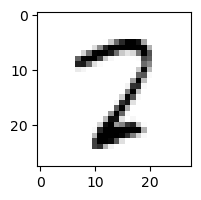

0.0001722324492000356% - 0
1.5756992816720167e-06% - 1
0.10680412968560829% - 2
1.436015234906865e-06% - 3
3.970478557838678e-08% - 4
0.31119103186775576% - 5
1.4007488880171519e-09% - 6
0.2651701322687161% - 7
10.068863154662724% - 8 - ОШИБКА
1.4394792195849882e-22% - 9

 2


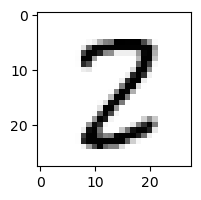

6.154247584334071e-11% - 0
1.6669548142552331e-06% - 1
0.00014369987521393947% - 2
1.1965720119207275e-07% - 3
2.0415527022958057e-12% - 4
0.0019122380072124402% - 5
1.4273130295257958e-18% - 6
1.0123659399637728e-05% - 7
99.08457154461453% - 8 - ОШИБКА
1.658842032430846e-33% - 9

 9


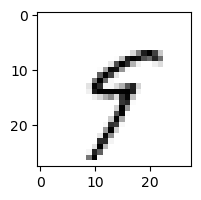

8.754104876607544e-08% - 0
0.10395968185354981% - 1
1.9893852862617626e-10% - 2
0.04103197345625303% - 3
37.60513556610476% - 4 - ОШИБКА
4.767893117666512% - 5
2.8124519647615504e-06% - 6
2.309007918091288% - 7
1.809317947639005e-06% - 8
5.106123919749145e-06% - 9

 6


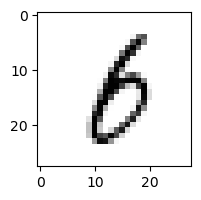

2.0091461436704577e-07% - 0
2.3283294953055718% - 1
1.7648287388082455e-07% - 2
0.1301224315033881% - 3
2.290652697370938e-09% - 4
0.03502628784943653% - 5
5.168018050614767% - 6
6.67943167597644e-08% - 7
99.72488507819577% - 8 - ОШИБКА
0.0017924430277312328% - 9

 2


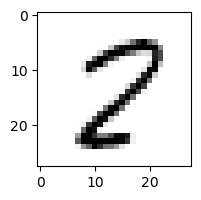

2.5273598050424257e-05% - 0
1.1208330085256735e-06% - 1
2.1386987988567396e-07% - 2
2.723952479815431e-19% - 3
2.95174807023835e-11% - 4
0.02483286936562136% - 5
2.5674124088276726e-13% - 6
0.2342787373491496% - 7
99.99998648787994% - 8 - ОШИБКА
4.225013477495479e-15% - 9

 2


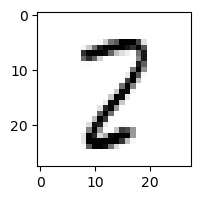

3.928736860663956e-07% - 0
0.003621277827695461% - 1
0.0004733313330705973% - 2
6.512256839153672e-05% - 3
6.619453908222926e-10% - 4
0.014146194512084504% - 5
3.713373756231108e-12% - 6
0.1702196587277455% - 7
99.99995385242568% - 8 - ОШИБКА
9.768918665740476e-22% - 9

 8


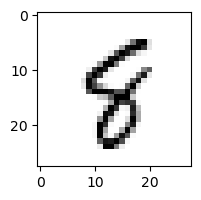

7.409183426354991e-11% - 0
4.772211332979605e-06% - 1
9.363376512069294e-14% - 2
1.8716043241834078e-17% - 3
0.00031252114943542867% - 4
0.13599222957861037% - 5 - ОШИБКА
0.0016767790435115162% - 6
0.0003565288943651071% - 7
0.039971733357744614% - 8
0.0003413861915231749% - 9

 2


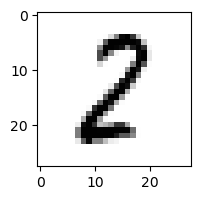

3.80731935300008e-07% - 0
0.26400015278010164% - 1
59.56163973442666% - 2
5.956399030058762e-08% - 3
5.694034572604471e-15% - 4
0.0004092971997523327% - 5
9.602788011912951e-11% - 6
2.5903254058701155e-08% - 7
91.15688306057234% - 8 - ОШИБКА
7.652075325211163e-24% - 9

 5


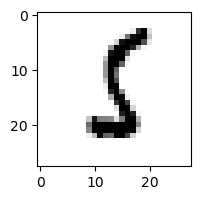

5.877136752016611e-10% - 0
0.022386202878770703% - 1
4.266730268542109e-05% - 2
9.101086226243553e-07% - 3
3.40483322621228e-17% - 4
1.3853227967160642% - 5
37.352046530115565% - 6 - ОШИБКА
7.341826299259175e-09% - 7
8.155008398410023e-12% - 8
1.2072852844503557e-19% - 9

 9


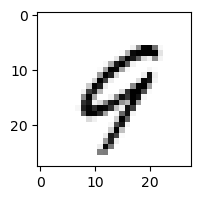

5.447566314976353e-07% - 0
2.475684583818271e-07% - 1
3.4657340799558914e-08% - 2
7.535900802296007e-20% - 3
52.59015847013304% - 4 - ОШИБКА
2.5410230938271775e-07% - 5
0.043198118088796096% - 6
0.09988211895286092% - 7
1.405865278325604e-10% - 8
0.0019517054801416643% - 9

 9


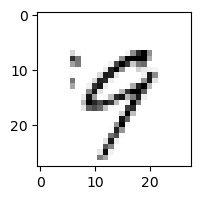

9.225972103050448e-05% - 0
8.00258948003328e-07% - 1
3.6997302674894946e-09% - 2
3.602385150291471e-07% - 3
16.021147758165487% - 4
2.4331660647410355e-05% - 5
9.268270769120169e-05% - 6
25.178068601629576% - 7 - ОШИБКА
2.3159658479878022e-10% - 8
4.266934306440119% - 9

 8


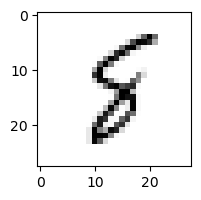

5.950525774607476e-10% - 0
0.009877051783161353% - 1
2.3809954082179911e-07% - 2
1.2996691720577066e-11% - 3
0.0006960529888144887% - 4
3.8315222337430606% - 5
74.79734910441516% - 6 - ОШИБКА
0.00011453501878395521% - 7
20.382765552373904% - 8
0.0013062429133370666% - 9

 2


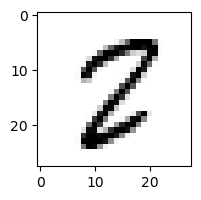

7.822149199912914e-10% - 0
1.0034744460667831e-05% - 1
1.705240069895331e-08% - 2
6.001453041802724e-14% - 3
1.918692762168096e-15% - 4
0.2634840738479928% - 5
2.2062269806424492e-10% - 6
9.666224760210587e-05% - 7
98.72080463707998% - 8 - ОШИБКА
2.0613363973717707e-18% - 9

 9


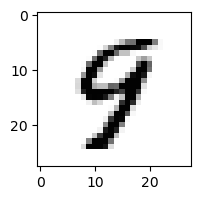

5.449619871483378e-12% - 0
2.784858867533144e-10% - 1
9.951633213114876e-18% - 2
3.635338649841319e-16% - 3
0.06351258094355372% - 4
0.07343412156589701% - 5 - ОШИБКА
1.6711314487852665e-09% - 6
1.0317923587330221e-05% - 7
2.7737823023827265e-08% - 8
0.0003462093888256502% - 9

 3


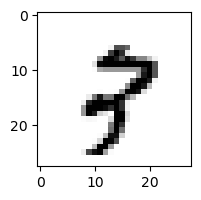

1.5305461079703525e-11% - 0
2.9475653500299048e-06% - 1
0.00010092652387956027% - 2
3.254890137393296e-21% - 3
1.4541330013520728e-10% - 4
4.450980742337767e-13% - 5
4.941778525852433e-11% - 6
13.935018554250123% - 7
26.813233084852428% - 8
43.80498092417005% - 9 - ОШИБКА

 5


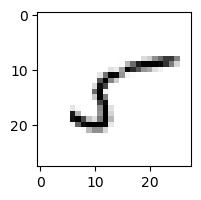

26.962842110461484% - 0
0.0108856179057273% - 1
2.535087876969551% - 2
0.3484158331024842% - 3
0.014766754219590773% - 4
99.68008816783723% - 5
0.0009885473972103735% - 6
0.0031711446917122837% - 7
99.99677389832702% - 8 - ОШИБКА
7.316491168827805e-09% - 9

 7


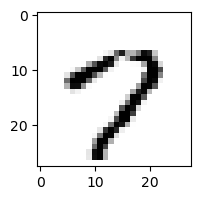

0.0006899048577533953% - 0
7.787341676079049e-14% - 1
6.393997961272643e-23% - 2
9.45905300807584e-20% - 3
1.0632722273194835e-06% - 4
0.0034450535624386117% - 5
1.715558856546104e-10% - 6
89.80994667500103% - 7
0.0005069216687083913% - 8
94.64258185064249% - 9 - ОШИБКА

 3


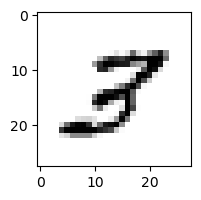

7.543366290060146e-08% - 0
3.107349641986603e-05% - 1
4.768942202693729% - 2 - ОШИБКА
1.767082398016636e-05% - 3
2.0843019516583835e-10% - 4
0.00020639856368317403% - 5
4.734054357656319e-14% - 6
0.013793458040737403% - 7
0.10388721565878088% - 8
5.942453948510145e-09% - 9

 8


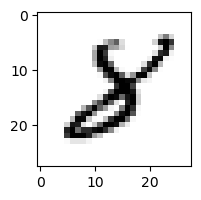

3.7473731132279144e-16% - 0
0.0017653766370086344% - 1
1.4724047047482036e-05% - 2
3.026352047498135e-14% - 3
6.088882183737849e-11% - 4
0.00754161921391895% - 5 - ОШИБКА
3.3191958671910575e-11% - 6
3.95442081751811e-05% - 7
0.00034083401504338834% - 8
1.7396914665970367e-21% - 9

 5


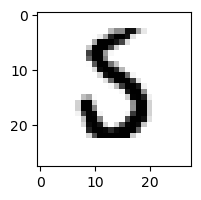

1.5619957761565632e-09% - 0
3.3150862654690796e-08% - 1
3.251960577894992e-05% - 2
8.622437756731834e-08% - 3
3.881734513064077e-16% - 4
0.002420152115735563% - 5
0.04508365015414946% - 6 - ОШИБКА
6.372180079255639e-06% - 7
2.614390813725239e-19% - 8
2.685122750157267e-32% - 9

 3


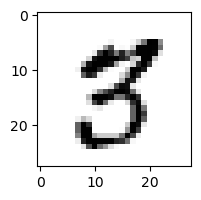

9.500185543829102e-11% - 0
6.9902455184429676e-09% - 1
6.155059225411424e-14% - 2
1.0392353439265769e-06% - 3
8.46232591956434e-14% - 4
21.970177975781034% - 5 - ОШИБКА
2.886551470240467e-23% - 6
0.0009562553976354487% - 7
5.5400300023534165e-08% - 8
3.5348793051482336e-14% - 9

 3


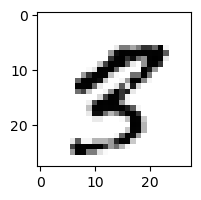

4.2232113048602483e-19% - 0
1.472764551244905e-08% - 1
1.0060313289459211e-30% - 2
4.35105573586398e-27% - 3
2.991100180101176e-08% - 4
0.0003637544575611783% - 5
3.212449257838028e-18% - 6
0.02282763705342314% - 7 - ОШИБКА
7.490964557701652e-05% - 8
1.3797837472906887e-06% - 9

 9


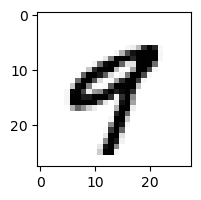

9.574614721122773e-12% - 0
9.501150978733983e-09% - 1
7.277358397252903e-28% - 2
3.7797956600990936e-22% - 3
0.06335831386321825% - 4 - ОШИБКА
7.29258123964729e-06% - 5
2.9654648697552336e-17% - 6
0.004535337709771253% - 7
5.207372376566791e-20% - 8
0.011826130878194648% - 9

 4


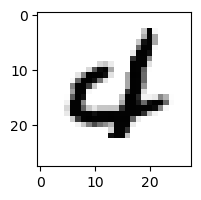

1.9694863442065036e-06% - 0
1.3223789610699554e-12% - 1
3.672177745447008e-19% - 2
6.234804820960764e-32% - 3
0.010693531103325006% - 4
2.464327855631455e-06% - 5
0.06764188767027819% - 6 - ОШИБКА
0.0007916286403109187% - 7
2.798508460694723e-34% - 8
1.780210365534518e-27% - 9

 2


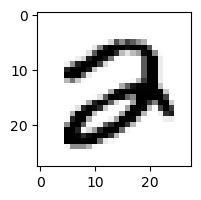

1.2314159403542116e-08% - 0
1.9730015073054645e-17% - 1
3.5175145794823867e-07% - 2
6.666943085166381e-17% - 3
1.2952947274064741e-17% - 4
7.37220659790431e-08% - 5
2.5580763989293637e-13% - 6
0.00010931527478151021% - 7 - ОШИБКА
3.424248139126107e-15% - 8
1.5743201784106304e-28% - 9

 7


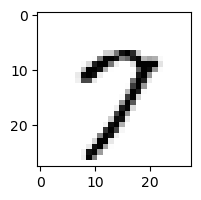

0.00020341101470390332% - 0
1.8307924012169229e-09% - 1
8.590673921905626e-12% - 2
2.2194104564857226e-11% - 3
1.7110246421215008e-06% - 4
0.002336845219810031% - 5
6.467592771968742e-10% - 6
98.9374571827576% - 7
7.53124458852692% - 8
99.53781441871047% - 9 - ОШИБКА

 8


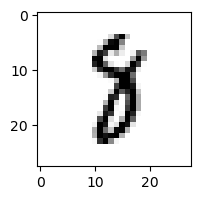

9.010587733027353e-16% - 0
0.06305260613012434% - 1
3.8288889716987445e-10% - 2
2.5705664829367877e-08% - 3
2.51507309694362e-11% - 4
0.057171535262768074% - 5
2.3792947992183216e-13% - 6
2.4052660835348445% - 7 - ОШИБКА
3.597430124332942e-13% - 8
4.718379413134073e-20% - 9

 5


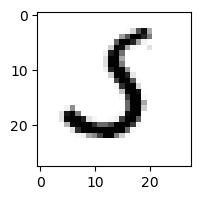

3.6687124793513383e-09% - 0
9.196090150362127e-06% - 1
1.1327189751637496% - 2
10.947592392334395% - 3 - ОШИБКА
3.8374988857269654e-17% - 4
0.20801648381999915% - 5
5.372680089357077e-07% - 6
8.977295397466722e-06% - 7
1.826563954488913e-24% - 8
1.2116315516805994e-23% - 9

 3


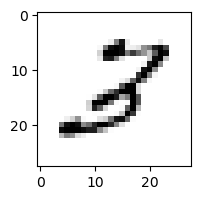

4.743559232472029e-07% - 0
2.7106194266290996e-05% - 1
99.98313900898667% - 2 - ОШИБКА
0.02095815061541394% - 3
4.347218265100882e-09% - 4
0.022864667108256867% - 5
1.3756384162005775e-09% - 6
7.775096737564001e-05% - 7
0.1555072247248344% - 8
1.8330307320683e-05% - 9

 5


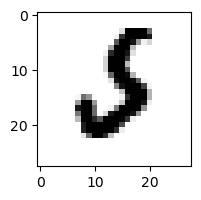

1.9904946708011878e-12% - 0
4.059021459945218e-08% - 1
0.00010819805798767893% - 2
1.0045673040198958e-20% - 3
3.507235630413186e-17% - 4
3.387189129761878e-08% - 5
0.0059517403966026445% - 6 - ОШИБКА
4.8994522065890585e-05% - 7
2.4713260610947893e-35% - 8
1.6201757766560534e-22% - 9

 2


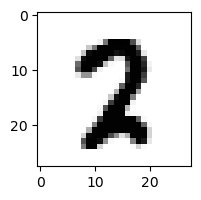

5.464388998633362e-19% - 0
5.822387222486497e-10% - 1
1.6451041716719447e-07% - 2
1.0997128899639085e-20% - 3
2.816837014706392e-18% - 4
7.6629448666584e-06% - 5
2.22432534955566e-19% - 6
0.0005089843688729862% - 7 - ОШИБКА
2.500291752711805e-17% - 8
1.2300851494775127e-32% - 9

 3


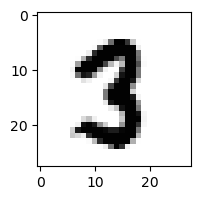

5.488262512012454e-19% - 0
8.487003974686946e-09% - 1
4.9015301655956094e-17% - 2
3.0004638717974694e-12% - 3
2.144681197966949e-20% - 4
0.2015392623605694% - 5 - ОШИБКА
1.6317552160206165e-26% - 6
2.227825680521232e-05% - 7
1.1740752430858927e-11% - 8
4.802741984926493e-28% - 9

 8


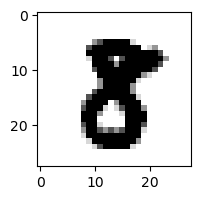

5.482764878556812e-20% - 0
1.875793096152593e-15% - 1
1.4900345653098596e-23% - 2
1.3471969286333966e-17% - 3
4.667750382814815e-26% - 4
3.5918840592207327e-06% - 5 - ОШИБКА
2.1008818520726236e-38% - 6
2.4179741052497525e-11% - 7
2.655319553394217e-11% - 8
9.964833224903416e-43% - 9


Общая доля ошибок: 16.368363163683632%


In [159]:
errs = 0
for k in range(len(X_test)):
    ans = np.empty((0,10))
    for j in range(10):
        ans = np.append(ans,f(neursum(X_test[k],w[:,j],w0[j])))
    if (ans.argmax() != ansbase_test[k].argmax()):
        errs += 1
        print('\n',y_test[k])
        plt.figure(figsize=(2, 2))
        plt.imshow(X_test[k].reshape(28, 28), cmap=plt.cm.Greys)
        plt.show()
        for i in range(len(ans)):
            if i == ans.argmax():
                print(ans[i]*100,'%',' - ',i," - ОШИБКА",sep="") 
            else:
                print(ans[i]*100,'%',' - ',i,sep="") 
print("\n\nОбщая доля ошибок: ",errs/(len(X_test)+1)*100,'%',sep="")   

# Изменение критерия останова на исключение ошибок

In [160]:
w = np.random.uniform(-0.0005,0.0005,(784, 10))
w0 = np.random.uniform(-0.0005,0.0005, (10,))

In [161]:
precision = 0.0000005
eta = 0.05
err = 1
while err >= precision:
    ress = np.empty((0,10))
    pos = random.randint(0,len(X_train)-1)
    for j in range(len(ansbase[pos])):
        sm = neursum(X_train[pos],w[:,j],w0[j])
        res = f(sm)
        ress = np.append(ress,res)
        sigm = - (ansbase[pos][j] - res)*f_d(sm)
        for k in range(len(X_train[pos])):
            w[k][j]+= - eta * sigm * X_train[pos][k]
        w0[j] += eta * sigm
    err = 0.5 * (((ansbase[pos] - ress)**2).sum())
    clear_output() 
    print(err)
clear_output() 
print(err)

2.0635604277128178e-07



 5


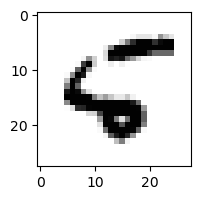

0.63519542719685% - 0
0.05314137744296441% - 1
1.0083065315229807% - 2
5.051091175517976e-05% - 3
23.742374349868523% - 4 - ОШИБКА
0.3446827543125219% - 5
7.198029942834817% - 6
0.007492431719595231% - 7
0.027185654440512824% - 8
0.1845857161203898% - 9

 9


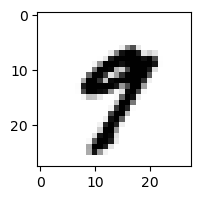

0.0906036984756027% - 0
0.02192319612574565% - 1
0.00012606219655019254% - 2
0.47569624335574207% - 3
3.431454164818383% - 4
0.8222417689652949% - 5
0.0017979530760098834% - 6
24.76938652886749% - 7 - ОШИБКА
0.10327848147077029% - 8
23.659972047064475% - 9

 4


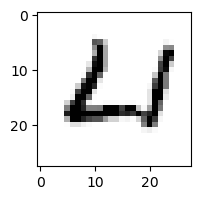

38.41014423044321% - 0
0.00460218350659848% - 1
5.046905793408201% - 2
0.00040812702784635304% - 3
37.35421694485345% - 4
0.8297464469531227% - 5
66.25911794526603% - 6 - ОШИБКА
0.13137464118766562% - 7
2.270959745601066% - 8
0.5351647758504278% - 9

 2


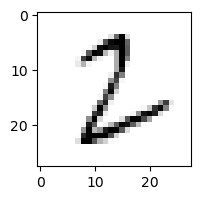

6.8586239702024985% - 0
2.569284655932714% - 1
51.4455455683671% - 2
74.42340754479481% - 3 - ОШИБКА
0.0010903260521368957% - 4
12.665249267030099% - 5
7.991471685937382% - 6
0.06122966430651285% - 7
19.758772791148495% - 8
0.05089526724505773% - 9

 3


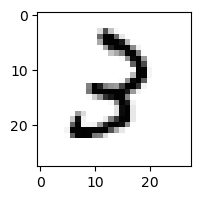

0.2889996596525997% - 0
0.41575801521223277% - 1
60.63533139922451% - 2 - ОШИБКА
40.372810809996565% - 3
0.5518024089907259% - 4
1.0517313020730312% - 5
0.4451385059792684% - 6
0.03845425005503781% - 7
0.9318759268144631% - 8
1.0148615113816453% - 9

 6


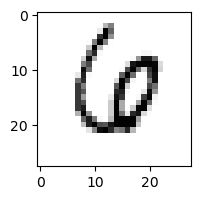

0.4957607561633057% - 0
0.2623406503697051% - 1
1.2707942449816985% - 2
0.6575258312289654% - 3
5.019134994538787% - 4
0.1013831099292582% - 5
4.9038047497794155% - 6
7.656135864693161% - 7 - ОШИБКА
0.08341730361166161% - 8
0.03049235984616662% - 9

 9


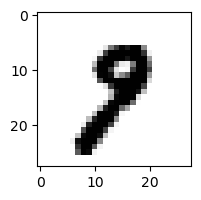

0.02201990605739135% - 0
1.694835239758843% - 1
0.03597635309792022% - 2
0.13685816576305085% - 3
0.00515334623176658% - 4
0.1884400488653895% - 5
0.0054283690515589175% - 6
14.841260194553149% - 7 - ОШИБКА
1.241327715781468% - 8
8.925388933448538% - 9

 2


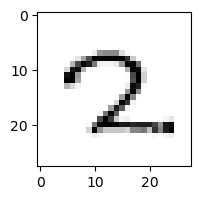

0.24023979782223093% - 0
0.36819079828253903% - 1
38.83146711480344% - 2
0.20305044415786697% - 3
0.27862013862448143% - 4
2.3550712087477885% - 5
4.841965763624607% - 6
78.54241275878967% - 7 - ОШИБКА
0.9603884679487357% - 8
3.6860252101194124% - 9

 8


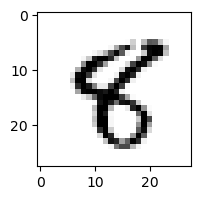

0.02089588284963633% - 0
0.21910396252345996% - 1
0.015303582788990931% - 2
0.011666531656327203% - 3
5.582727045867613% - 4
25.846164941875305% - 5 - ОШИБКА
0.018960009726855423% - 6
0.018235136821722214% - 7
19.91158509940078% - 8
2.609094342049695% - 9

 9


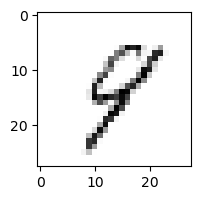

1.2416946456758373% - 0
4.189094614254444% - 1
5.960355659848064% - 2
3.418088502472588% - 3
57.15401357162222% - 4 - ОШИБКА
5.61632550620507% - 5
3.2350970173006997% - 6
7.132636056420133% - 7
50.205416252198276% - 8
49.15663691079678% - 9

 7


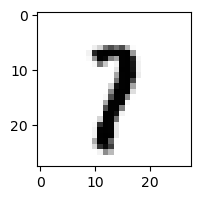

0.007041142522126914% - 0
44.495644266341436% - 1 - ОШИБКА
1.90677640482765% - 2
2.530302464670283% - 3
0.10749740693922952% - 4
0.3687366140912773% - 5
0.10062551449933335% - 6
37.03557667573834% - 7
2.848423758763247% - 8
9.748346912521086% - 9

 7


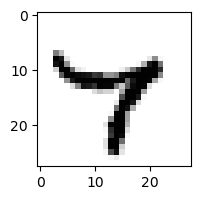

0.01353873922302433% - 0
0.08571264738246756% - 1
7.199064706379513e-05% - 2
0.17634555494951884% - 3
81.35833224651496% - 4 - ОШИБКА
0.32256565449946095% - 5
0.748050375652664% - 6
29.56060862284834% - 7
14.569330569064368% - 8
18.904690941445295% - 9

 0


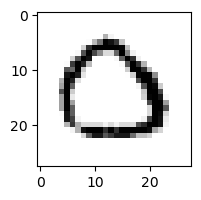

65.00674452369346% - 0
0.004050975884646576% - 1
20.68878074695192% - 2
70.09564792928447% - 3 - ОШИБКА
0.008652335067042341% - 4
0.2801063293849884% - 5
0.07643802530218205% - 6
2.335367962045127% - 7
0.14835390781399213% - 8
0.024431664140611487% - 9

 2


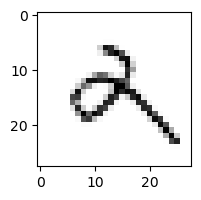

1.0002227576406035% - 0
9.14118995587991% - 1
1.0714001949027707% - 2
7.058489962176571% - 3
17.324679986407016% - 4
1.4764333029980432% - 5
15.427838841876007% - 6
0.34734026473994556% - 7
8.818885382301831% - 8
88.71861594534263% - 9 - ОШИБКА

 9


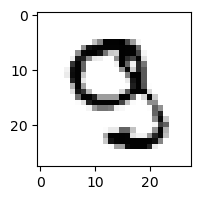

0.18899651817858945% - 0
0.022008098324812726% - 1
1.5170751359631547% - 2
0.8063386562652812% - 3
3.4770736303236847% - 4 - ОШИБКА
0.05052081286554991% - 5
0.0051228802693985345% - 6
1.280719093870573% - 7
0.5434212016938581% - 8
3.2405439324412413% - 9

 9


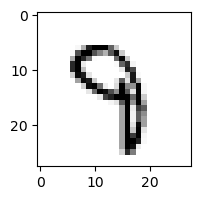

0.0025055400411395073% - 0
0.12125919462104762% - 1
0.33831578166255294% - 2
12.809669508186126% - 3
31.59951541497266% - 4 - ОШИБКА
2.70288684083013% - 5
1.0466076671739921% - 6
3.4332180400798675% - 7
0.830328117559307% - 8
12.123759319309533% - 9

 5


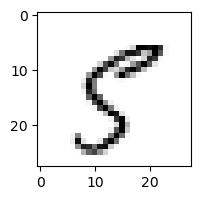

15.799653341877498% - 0
1.565499842283891% - 1
0.10824048698094206% - 2
0.5167529357975809% - 3
9.150236186281477% - 4
23.554120132893672% - 5
0.10042937457370348% - 6
41.06696789935471% - 7 - ОШИБКА
5.024943420974317% - 8
6.950379027483061% - 9

 6


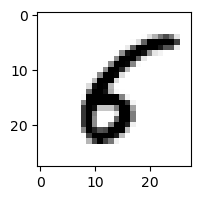

5.8574376110361275% - 0
0.6716353574327346% - 1
0.12930244029827911% - 2
0.060762539136306803% - 3
4.903612837531615% - 4
63.15911786134989% - 5 - ОШИБКА
1.5387895393506867% - 6
0.008263619069782823% - 7
1.578287444845133% - 8
0.01543997417227449% - 9

 5


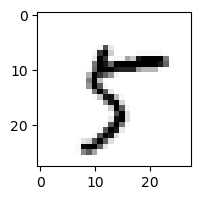

3.0739174733718264% - 0
0.35538822560017774% - 1
0.05764860157831145% - 2
0.5760463961738164% - 3
5.5604237969965675% - 4
63.40558412793108% - 5
0.025911835725753212% - 6
76.0492604330055% - 7 - ОШИБКА
17.818314943709282% - 8
0.5679743407191945% - 9

 8


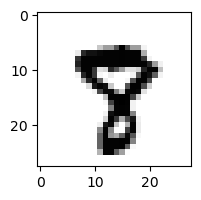

0.004462567258434554% - 0
0.001017291234922168% - 1
0.003120224685108661% - 2
0.003313032885212162% - 3
0.046794832238772024% - 4
0.5070550253567394% - 5
0.0003846907617375021% - 6
65.14098772545223% - 7 - ОШИБКА
3.9084944429362176% - 8
2.758488320241321% - 9

 9


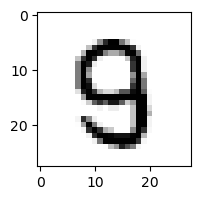

0.1618663450270738% - 0
0.0008225723794448545% - 1
0.4002073077273739% - 2
2.4561085590214695% - 3
3.0940627063293977% - 4
6.5023226386641335% - 5 - ОШИБКА
0.020741400585164063% - 6
0.10629483535118184% - 7
1.3140881393658868% - 8
0.16609674011903777% - 9

 7


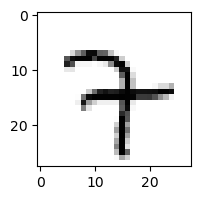

0.013387274697007092% - 0
0.606790809661373% - 1
0.9439277145657546% - 2
11.057657409556997% - 3
40.578515695363436% - 4 - ОШИБКА
0.09766786940273936% - 5
8.333527949646836% - 6
38.36417909489525% - 7
0.16413904061935589% - 8
2.485690385632281% - 9

 3


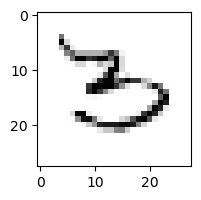

7.4768076836231% - 0
0.2928351352452676% - 1
0.4428039387480216% - 2
49.43307263434995% - 3
0.23154774645018508% - 4
34.44866203470359% - 5
82.21443508159082% - 6 - ОШИБКА
0.44378440109905276% - 7
3.431300289734842% - 8
0.8670534494322565% - 9

 4


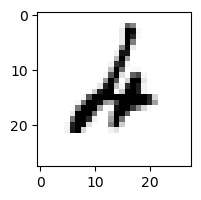

0.028679267090688985% - 0
0.4470906509549526% - 1
21.851179470658224% - 2
0.8307454700397944% - 3
19.74164141475884% - 4
0.08244617227811457% - 5
22.726572176292223% - 6 - ОШИБКА
0.03951350086625903% - 7
0.28176865314261124% - 8
2.7567324043453802% - 9

 8


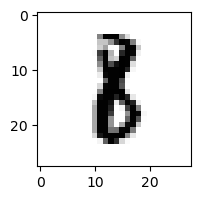

0.009693621602628358% - 0
5.2157626073222145% - 1 - ОШИБКА
0.553121257465982% - 2
0.6320178994697414% - 3
0.005950017422145713% - 4
1.1451308341456061% - 5
1.6148039100226341% - 6
0.0226530951374404% - 7
4.427423071766593% - 8
0.023570538257842843% - 9

 6


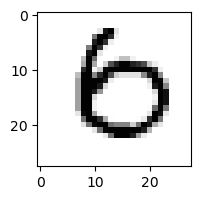

86.21032996412593% - 0 - ОШИБКА
0.0008896745283066672% - 1
0.010020791885915311% - 2
0.05850404705104437% - 3
0.23080631418303388% - 4
0.3131213410955907% - 5
39.99448445503768% - 6
0.27960737964768034% - 7
0.054028777886967215% - 8
0.01571352620020723% - 9

 8


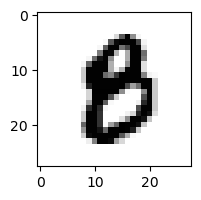

1.2428641155612943% - 0
0.0012435250571007908% - 1
0.0023350819538522066% - 2
0.11923306389665826% - 3
0.011397636577722725% - 4
5.608357075731358% - 5 - ОШИБКА
0.26133216285786687% - 6
0.0011367314661446725% - 7
4.063288599331029% - 8
0.010639680163425763% - 9

 8


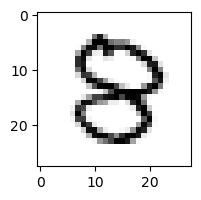

1.1678170511438255% - 0
0.0017622894307274626% - 1
0.5232133856150702% - 2
12.61618632917552% - 3 - ОШИБКА
4.736332503332939% - 4
2.2394853676039674% - 5
0.05585493860751647% - 6
0.004975067515518947% - 7
11.386415997009733% - 8
0.07366312866720895% - 9

 8


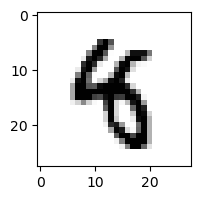

0.0013243072060363731% - 0
0.24687981015948265% - 1
0.0011258281841033033% - 2
0.2393455778692663% - 3
23.51095928684687% - 4 - ОШИБКА
5.678914837884404% - 5
0.08036373819847761% - 6
0.004852876736994354% - 7
0.004239520992865737% - 8
1.6116295174169366% - 9

 4


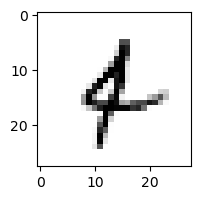

0.40005915351085974% - 0
18.753516284248672% - 1 - ОШИБКА
0.2442196272438137% - 2
0.6081997532680211% - 3
15.969805925358676% - 4
1.193554476295815% - 5
15.499612345563124% - 6
0.2966583607703885% - 7
0.49432219049548576% - 8
6.733491627186251% - 9

 3


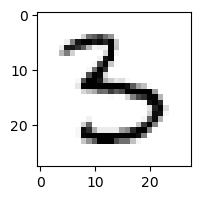

0.6973810742107525% - 0
0.029119771762234337% - 1
0.04310800208032674% - 2
38.24375617972075% - 3
8.366303303830092% - 4
72.89998299972906% - 5 - ОШИБКА
0.5935228624739007% - 6
0.02885912422504616% - 7
1.0336043463858353% - 8
0.2095771564920958% - 9

 2


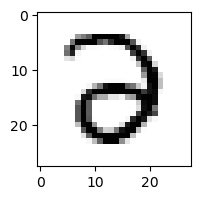

16.206423188207296% - 0
0.0033494282156658894% - 1
7.452135269105139% - 2
72.52459643642233% - 3 - ОШИБКА
1.889496462915975% - 4
0.07576690573119653% - 5
0.6784983491133069% - 6
0.0013011308970923262% - 7
0.15551008118203324% - 8
0.0015702816150104347% - 9

 9


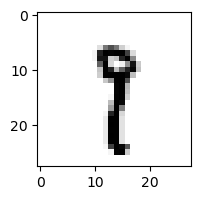

0.03987827601602241% - 0
63.44622952959772% - 1 - ОШИБКА
0.14488261294220292% - 2
3.2517770846906013% - 3
0.17170030705375725% - 4
2.327730202911665% - 5
0.16775498986575688% - 6
59.700349529199755% - 7
3.2552362363729124% - 8
13.526726891812634% - 9

 2


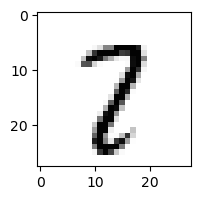

0.11183706795339651% - 0
4.238586121225284% - 1
4.203841364976673% - 2
3.5325786339394356% - 3
0.229348871257074% - 4
1.476564736627765% - 5
0.0473049968145822% - 6
75.62515196327546% - 7 - ОШИБКА
18.57718881007152% - 8
4.3184659563881445% - 9

 4


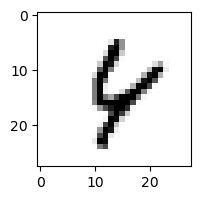

0.09176872109006155% - 0
0.14849122111171673% - 1
2.0635513890046218% - 2
0.02689536275618529% - 3
44.97251927386868% - 4
0.687173931807163% - 5
10.18399877114531% - 6
7.944451098171773% - 7
52.45877932059611% - 8
65.28228481985767% - 9 - ОШИБКА

 5


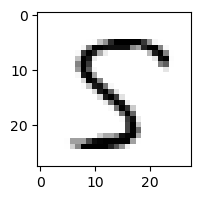

0.3914504112764843% - 0
0.1152457340788823% - 1
0.4324969656891249% - 2
1.667947961505507% - 3
59.50814657243746% - 4
93.69558275528233% - 5
0.06716695818954152% - 6
0.24038925213632306% - 7
97.24065411441481% - 8 - ОШИБКА
0.0032770335280497952% - 9

 9


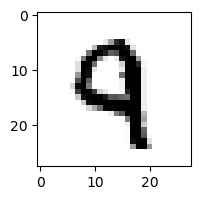

0.002657003405070321% - 0
0.0025519541653703844% - 1
1.059475617633324% - 2
0.0701038345680338% - 3
55.20348565429193% - 4 - ОШИБКА
0.07976551143438945% - 5
0.06835365726672199% - 6
0.5104706718232466% - 7
0.08278991500180645% - 8
48.78622765916218% - 9

 5


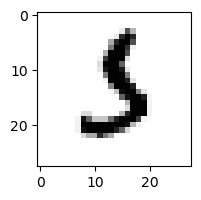

0.15910362955446092% - 0
0.9428810011424827% - 1
1.4012326208838906% - 2
27.576341700473346% - 3 - ОШИБКА
0.001376299377531069% - 4
4.399367716250781% - 5
13.078983891658705% - 6
0.7152443735582082% - 7
0.010757597984457594% - 8
0.05222433733283538% - 9

 8


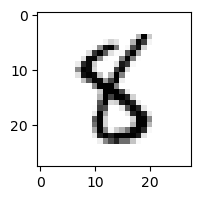

0.040481719496430896% - 0
0.28776133931388764% - 1
0.05138897896508483% - 2
0.6592295671266466% - 3
0.42135494639506266% - 4
64.86862001400446% - 5 - ОШИБКА
2.396991551809452% - 6
0.014152886377359808% - 7
52.219818451425034% - 8
0.1619827611905062% - 9

 3


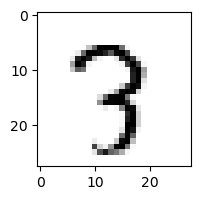

0.008713279299015246% - 0
0.2528442093120879% - 1
9.42883360774573% - 2
26.952710542515394% - 3
2.304024440229547% - 4
0.38233859726860553% - 5
0.11867405087209353% - 6
57.077892795280235% - 7 - ОШИБКА
14.58591341663141% - 8
8.959366704763777% - 9

 5


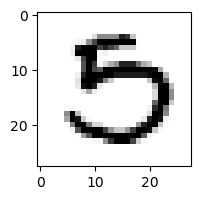

34.25140545910881% - 0 - ОШИБКА
0.001053247409116005% - 1
0.032768476588212685% - 2
2.1284764707591037% - 3
0.007237467600923501% - 4
1.8572311652701137% - 5
0.006085941735127333% - 6
0.4297618222435974% - 7
0.7086774093465137% - 8
1.8454352238354546e-05% - 9

 9


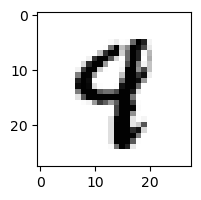

0.004075788805255308% - 0
0.02677039066343956% - 1
0.017229824027537696% - 2
0.011894096889031003% - 3
40.17863860384131% - 4 - ОШИБКА
0.43041134318878077% - 5
0.0414770133727535% - 6
0.41025898016556805% - 7
0.24797332688747997% - 8
11.825913469425837% - 9

 2


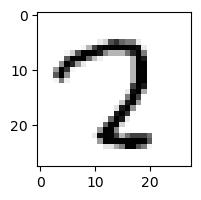

0.625096136380153% - 0
0.014933696538675968% - 1
15.095594808499206% - 2
17.30073053044321% - 3
3.3301691298012615% - 4
0.7242794164693036% - 5
0.005744562469237985% - 6
62.64906179615741% - 7 - ОШИБКА
9.2828885241283% - 8
0.08230568461069628% - 9

 3


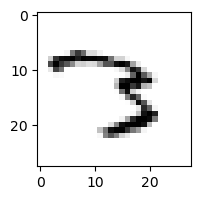

0.11919316624034802% - 0
0.18106724372726057% - 1
7.366397117044363% - 2
72.4325969136862% - 3
1.138392908718048% - 4
0.25470980200386306% - 5
9.998319718100372% - 6
81.37950807526514% - 7 - ОШИБКА
1.8084184929387606% - 8
0.8041195056315423% - 9

 9


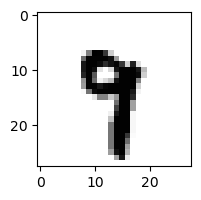

0.00015782515748514466% - 0
0.32796234790880496% - 1
0.0011303953356338547% - 2
0.05234704941853586% - 3
12.462922356268418% - 4
2.4441458797530546% - 5
0.1276543510034653% - 6
16.48776164910125% - 7 - ОШИБКА
0.5301830685463402% - 8
1.412306103862336% - 9

 8


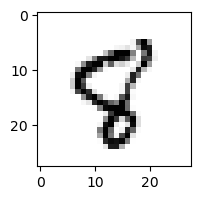

0.20994689365948738% - 0
0.09950475086805179% - 1
0.16822731750583989% - 2
0.0008852121979499283% - 3
9.052702724349963% - 4 - ОШИБКА
5.747174659787115% - 5
0.23697401994392758% - 6
7.119327382697811% - 7
4.206174517738927% - 8
5.771070710742222% - 9

 9


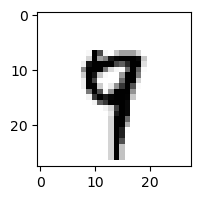

0.001727086076907823% - 0
0.4561434828120295% - 1
0.04082761942048375% - 2
0.011046168964538134% - 3
15.366263123499625% - 4
1.2304407271755546% - 5
0.11923036300857666% - 6
33.679951222269686% - 7 - ОШИБКА
0.9187502683338296% - 8
14.455861167959341% - 9

 8


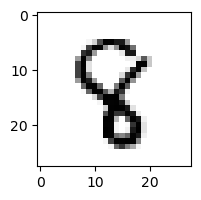

0.0016375057063489204% - 0
0.38434742998568755% - 1
0.44709924828482295% - 2
0.16255455717713108% - 3
37.104118556541515% - 4 - ОШИБКА
1.8086780853465478% - 5
0.11874635431663452% - 6
0.13788072447022526% - 7
8.54862355580245% - 8
0.06623583851858685% - 9

 5


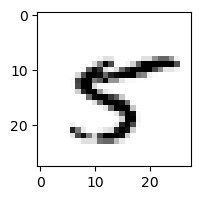

0.4627127141601776% - 0
0.1620483279901758% - 1
0.003029360190556176% - 2
0.08424504564811794% - 3
57.29109293191519% - 4 - ОШИБКА
53.6678614712361% - 5
0.04729880611195306% - 6
2.060724666802449% - 7
24.73424765786627% - 8
0.4262364896386815% - 9

 8


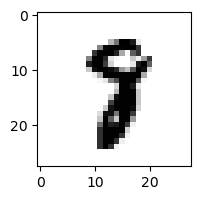

0.001366186950599068% - 0
0.1541851398585639% - 1
0.14714902442168945% - 2
0.1843082065827346% - 3
0.3319097312467318% - 4
0.24668255517821958% - 5
0.024827270053110362% - 6
27.964683142399256% - 7 - ОШИБКА
1.8944636670321053% - 8
0.02259306583068775% - 9

 0


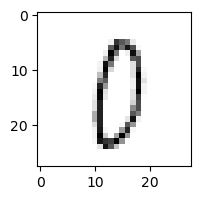

53.40293967337729% - 0
0.15377794384741836% - 1
9.223090059066969% - 2
16.492261113071123% - 3
3.690980803423534% - 4
21.128421920838793% - 5
6.17772186238976% - 6
8.66961513587588% - 7
79.5874867767558% - 8 - ОШИБКА
11.254782853129026% - 9

 2


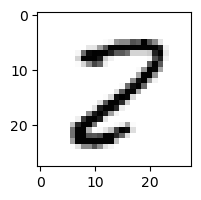

1.2529983612686462% - 0
0.24902808350757952% - 1
26.834940879994708% - 2
0.28796031241233% - 3
0.11681863364111594% - 4
2.7513796203602334% - 5
0.039764974144687576% - 6
1.344613462610591% - 7
99.19432570252738% - 8 - ОШИБКА
0.028536754255918926% - 9

 6


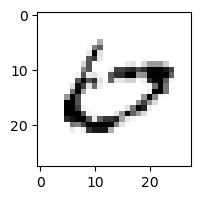

90.31899022899272% - 0 - ОШИБКА
0.05652963686057905% - 1
0.21765727136968055% - 2
0.660974333190827% - 3
1.9246893285402369% - 4
0.11158755526697334% - 5
14.033975670358434% - 6
8.892731314070804% - 7
0.3041724159204063% - 8
0.09748792501035765% - 9

 9


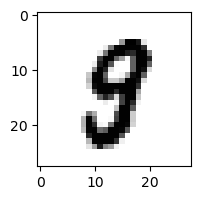

0.1716174685140847% - 0
0.0035565173511327318% - 1
0.022798120016852615% - 2
0.6704984279762383% - 3
0.3972728033063729% - 4
7.832675659494592% - 5
0.008391554845874116% - 6
0.12834335598913396% - 7
14.387049178767796% - 8 - ОШИБКА
0.4084555196710226% - 9

 3


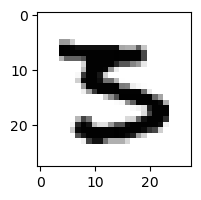

0.10438256743900606% - 0
3.3413317526425224e-05% - 1
0.01120614841422589% - 2
6.381184048211118% - 3
0.0014472698843672137% - 4
90.63699828236345% - 5 - ОШИБКА
0.003887831427842632% - 6
0.015019553300036861% - 7
0.005592662697869058% - 8
0.002102663725721116% - 9

 3


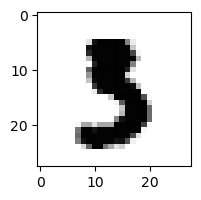

0.001374973992010375% - 0
0.0010422205315616343% - 1
0.0003717618828305935% - 2
16.40280289696743% - 3
0.0006013297126561582% - 4
27.553462559049578% - 5 - ОШИБКА
0.001996549415962667% - 6
0.04154931735504217% - 7
0.009422623452817542% - 8
0.0006288000813117691% - 9

 3


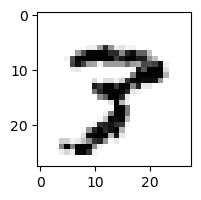

0.06973990646660919% - 0
0.05288925422442899% - 1
0.2020789997947948% - 2
3.846751394453121% - 3
0.04444388939825512% - 4
0.14243998778857814% - 5
0.008226218922859583% - 6
25.91633444034783% - 7 - ОШИБКА
22.93131474462659% - 8
1.639703676749182% - 9

 7


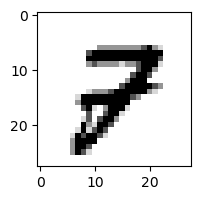

0.21377733419553568% - 0
0.05030273680610046% - 1
7.025435959173704% - 2 - ОШИБКА
0.08718886059043611% - 3
0.3741835929302403% - 4
0.029135886626308553% - 5
0.0028679658696867238% - 6
3.316191136283368% - 7
0.7972505995665039% - 8
4.428774261725711% - 9

 5


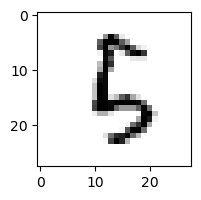

0.23726332671287828% - 0
0.1291751520761117% - 1
20.087759120227542% - 2
3.3809883258522695% - 3
16.624043857082494% - 4
10.297951845528965% - 5
3.1591435615681824% - 6
0.04444271230012896% - 7
38.5327772200231% - 8 - ОШИБКА
3.4010944376333043% - 9

 9


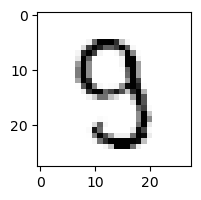

0.27386287087007966% - 0
0.013876440170926128% - 1
0.40133182119904964% - 2
34.41763482310821% - 3 - ОШИБКА
6.734242703934242% - 4
12.324236746790678% - 5
0.05370851805855326% - 6
1.8223598304452124% - 7
5.681349420005753% - 8
1.2203062332432164% - 9

 5


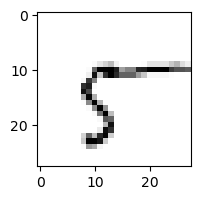

56.30501576124273% - 0 - ОШИБКА
4.132071814384112% - 1
0.27440435636112637% - 2
1.7228799934131784% - 3
14.452407893123883% - 4
19.10320510875016% - 5
12.003573171778376% - 6
40.712300389860964% - 7
56.230902410349884% - 8
13.353315962653307% - 9

 8


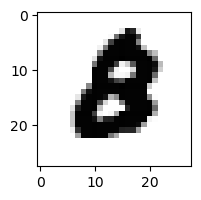

0.3881699868978216% - 0 - ОШИБКА
2.647388596231385e-06% - 1
0.0724086076577156% - 2
0.024952418777661065% - 3
0.0017247053349552677% - 4
0.04917789740783097% - 5
0.06936155680207816% - 6
0.00013603384262750044% - 7
0.001992091827358496% - 8
0.0060239127672652585% - 9

 5


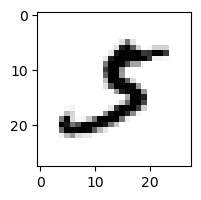

0.42088395759210756% - 0
5.755530534244008% - 1
4.270967164124427% - 2
8.1935378222496% - 3 - ОШИБКА
0.01742833582241923% - 4
7.914967193828275% - 5
0.030281299294972638% - 6
4.8371456092605865% - 7
0.009303924387897402% - 8
0.36388671770472886% - 9

 3


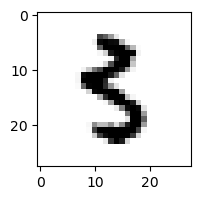

0.1880456481436581% - 0
0.04558736537586211% - 1
0.007412052792687703% - 2
2.14885131087612% - 3
0.20486436466849522% - 4
53.47435775976158% - 5 - ОШИБКА
0.7836002688480929% - 6
0.02483041261259706% - 7
0.6300966853073656% - 8
0.3341487853756384% - 9

 6


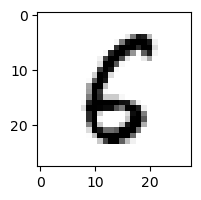

9.4508989573213% - 0
0.018318004739534512% - 1
1.30210161246721% - 2
0.009564621348212086% - 3
2.39375138599776% - 4
21.279429514022855% - 5
11.355629193616993% - 6
0.006921448186717023% - 7
34.77216575843037% - 8 - ОШИБКА
0.11291764282238698% - 9

 4


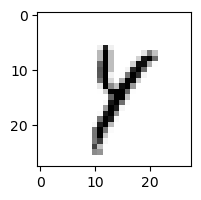

0.08038348270215147% - 0
24.92448240747574% - 1
1.4225387778753942% - 2
2.2028081127558554% - 3
19.390159393754722% - 4
7.896697607923345% - 5
1.059975393343564% - 6
28.68225891240067% - 7
68.34459033490037% - 8 - ОШИБКА
4.930736514849355% - 9

 6


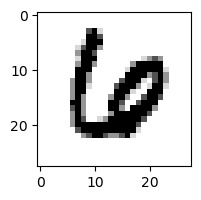

0.015412234152682312% - 0
0.0008116742538029817% - 1
0.03871616063707879% - 2
0.035514815996489604% - 3
1.3968941621065036% - 4 - ОШИБКА
0.0024163355944303235% - 5
1.0880906899060876% - 6
0.5572359089837607% - 7
0.001992181625727151% - 8
3.568959419730429e-05% - 9

 3


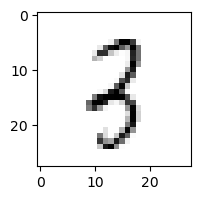

0.6011940894613551% - 0
6.081089479201285% - 1
24.1279325921671% - 2
44.06472152493131% - 3
20.52141816263447% - 4
1.4855619731713037% - 5
0.7099785520221811% - 6
0.838921269404759% - 7
71.05651003659374% - 8 - ОШИБКА
4.618388636831676% - 9

 1


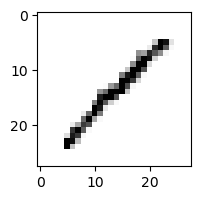

2.9240714096370444% - 0
65.08795193585048% - 1
29.349173266602374% - 2
48.825445925856414% - 3
26.764419163132708% - 4
6.089304850841805% - 5
0.6615980523355682% - 6
1.224720704242394% - 7
90.87363852817656% - 8 - ОШИБКА
14.411057135248754% - 9

 9


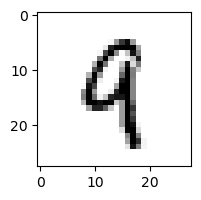

0.033484076285485775% - 0
0.8568339303660006% - 1
1.1299063108229752% - 2
0.2746712749621715% - 3
62.87864072084892% - 4 - ОШИБКА
0.3906805515847316% - 5
0.7101581597540667% - 6
0.20144051387363604% - 7
3.1711334346022912% - 8
39.3694386185253% - 9

 3


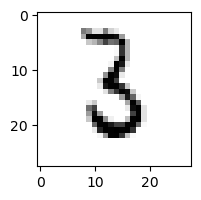

0.6763442147593297% - 0
2.928081417801543% - 1
3.787602188163391% - 2
41.058781837499055% - 3
0.0273227216392314% - 4
1.8507787282499861% - 5
80.14942493664967% - 6 - ОШИБКА
0.1015341923737538% - 7
2.504671795618948% - 8
0.06096437301624926% - 9

 2


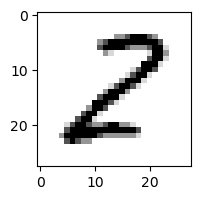

2.049561734491312% - 0
4.886408957071442% - 1
59.58403456978475% - 2
7.505191377953431% - 3
0.1959948043970523% - 4
3.330175167430833% - 5
0.4968263031400887% - 6
0.0019691740760784554% - 7
77.35658033709981% - 8 - ОШИБКА
0.000587870860403024% - 9

 7


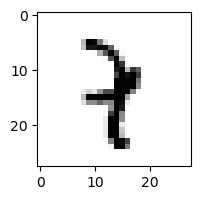

0.0007986022583518369% - 0
55.896224787575555% - 1 - ОШИБКА
2.1215989484242668% - 2
7.763789995258426% - 3
9.367932953657556% - 4
0.06499128462031217% - 5
0.7207581150605862% - 6
1.587181260627274% - 7
0.5599103589058703% - 8
3.509636776628043% - 9

 0


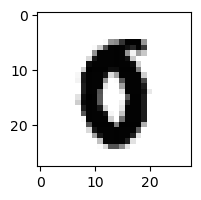

0.44364605297906157% - 0
7.798744937905595e-06% - 1
0.0013193403880475123% - 2
0.0003075730043355029% - 3
0.05671029749580231% - 4
0.3103597247899151% - 5
0.7827981382110587% - 6 - ОШИБКА
0.11943241686428595% - 7
0.010234633312574062% - 8
0.0251978930519349% - 9

 4


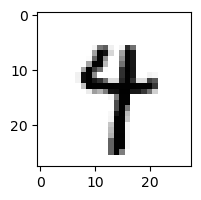

0.0041320931145945265% - 0
0.3813929424823583% - 1
0.0015336759093315447% - 2
0.09038972709751815% - 3
27.755551728874167% - 4
2.8403700239961798% - 5
0.4216880502783361% - 6
17.118802758437134% - 7
2.4543656788344683% - 8
38.713797727754915% - 9 - ОШИБКА

 3


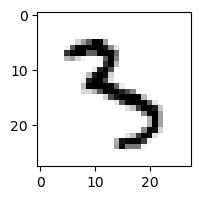

0.022618108110829527% - 0
0.03420080725488724% - 1
0.3929434323498159% - 2
45.055059924254856% - 3
38.22855640820719% - 4
50.514759650243036% - 5 - ОШИБКА
0.7879718772663712% - 6
0.2606169772364617% - 7
1.4656783983628363% - 8
6.149748346520379% - 9

 8


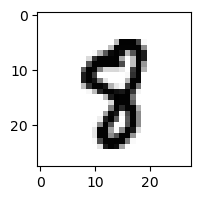

0.010134492563111226% - 0
0.00966109441318321% - 1
0.02734282195671209% - 2
0.006433536248695724% - 3
1.526054722428386% - 4
5.231132898044932% - 5 - ОШИБКА
0.01975418559164706% - 6
1.275731352888632% - 7
3.0324554003980486% - 8
0.19642477842240058% - 9

 3


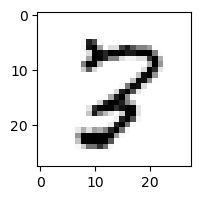

0.1658411302446936% - 0
0.03597774228628357% - 1
10.238171850357032% - 2
0.6158369145048865% - 3
0.29230145817642783% - 4
0.38220765631561465% - 5
0.049347765570186615% - 6
11.877702627313745% - 7
90.1637433569366% - 8 - ОШИБКА
3.502010164258973% - 9

 8


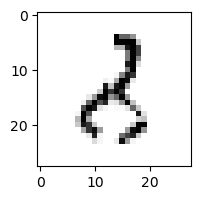

1.9149959494541808% - 0
9.363485743535055% - 1
52.01036451453345% - 2 - ОШИБКА
27.45270809357615% - 3
5.233938037701903% - 4
2.8802171219265356% - 5
1.3346769343228253% - 6
0.019948817340225775% - 7
50.711724222749865% - 8
0.7451564340538407% - 9

 8


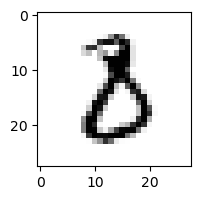

0.6558697517356035% - 0
0.46374614143322307% - 1
3.231427312841374% - 2
45.933242184112345% - 3 - ОШИБКА
0.001617968104332782% - 4
2.0185396881010425% - 5
0.9789511500393356% - 6
0.02603960304705664% - 7
1.1383515276502472% - 8
0.06361998427006371% - 9

 9


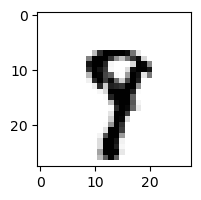

0.0020556925768870356% - 0
0.06081504236829853% - 1
0.0052897182618634785% - 2
0.14242020104852338% - 3
1.6890072264920377% - 4
2.317583454939424% - 5
0.02485253181258933% - 6
45.77797504178464% - 7 - ОШИБКА
24.435334651641448% - 8
19.99657616702726% - 9

 8


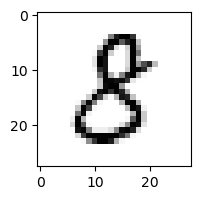

2.0990725059993145% - 0
0.052745058405490854% - 1
1.966228311486338% - 2
42.183325111530564% - 3 - ОШИБКА
0.5822739616619892% - 4
13.105446723217895% - 5
0.020167501322107494% - 6
0.01947069923553635% - 7
16.34012002903601% - 8
0.013586079540620332% - 9

 4


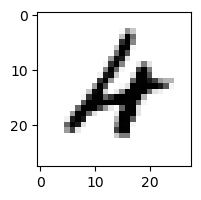

0.3803236795029167% - 0
0.005889393652788538% - 1
3.82455496489253% - 2
0.1335050953878068% - 3
26.843953324005053% - 4
0.005318704646793463% - 5
29.97092825726291% - 6 - ОШИБКА
0.07038452911568571% - 7
0.937229150256072% - 8
12.286571756266488% - 9

 2


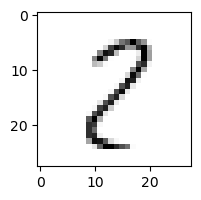

9.513687763518403% - 0
14.176525228332146% - 1
53.934360470939644% - 2
11.557880648357642% - 3
1.5780110444649589% - 4
5.320263492440186% - 5
0.7162112031333655% - 6
10.320606278463158% - 7
97.73587156572879% - 8 - ОШИБКА
4.805252344272722% - 9

 1


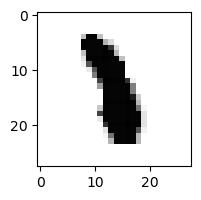

1.6666962812104922e-06% - 0
0.6673984939175951% - 1
0.047191027544702405% - 2
0.040356818136360925% - 3
0.2090406372121145% - 4
1.2730369626083144% - 5 - ОШИБКА
0.4448309931099297% - 6
0.14449836991165246% - 7
0.24209367506368018% - 8
0.0059190595574853755% - 9

 2


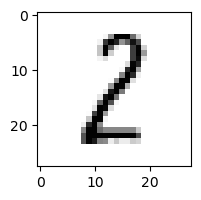

2.445008439082389% - 0
53.055598473921584% - 1 - ОШИБКА
24.077539130530774% - 2
15.913550331722229% - 3
0.15238748376410172% - 4
3.5553449528317573% - 5
0.2309373704523716% - 6
0.11291064652769821% - 7
44.16415916329003% - 8
0.02663944764221849% - 9

 9


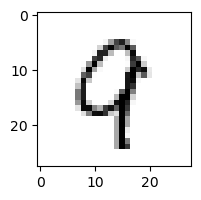

0.27933964004937956% - 0
0.5989582766365844% - 1
6.127633073300331% - 2
0.04554703066179019% - 3
57.77530163112152% - 4 - ОШИБКА
0.03542596727821828% - 5
1.6884814399832582% - 6
18.83924567597952% - 7
21.051718372405354% - 8
15.12972915514916% - 9

 3


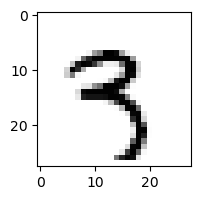

0.007927714599973792% - 0
0.6410459269351142% - 1
0.8323559937655205% - 2
11.502181254906738% - 3
2.718835876062995% - 4
4.675492956469368% - 5
0.1702242057882347% - 6
0.3936757559290849% - 7
2.862858754585047% - 8
79.8469412501455% - 9 - ОШИБКА

 2


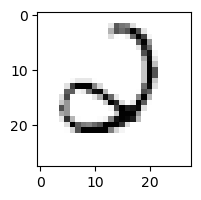

11.46392339513073% - 0
0.2801553004017624% - 1
7.735437649323838% - 2
1.2876551642150345% - 3
28.55917421925227% - 4
11.682960371157034% - 5
32.51505624616121% - 6 - ОШИБКА
0.9804430603668226% - 7
0.15605591817047937% - 8
0.3965279475524085% - 9

 5


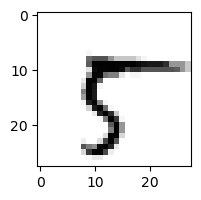

21.93000457041063% - 0
0.08367339957343209% - 1
0.00985380886885465% - 2
0.009075914514264467% - 3
1.4824846320736427% - 4
22.74378788049509% - 5
0.4448625697378315% - 6
84.25621041629101% - 7 - ОШИБКА
10.403047531883368% - 8
2.434638122223439% - 9

 7


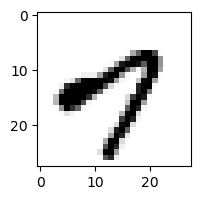

68.56637363084826% - 0
0.005296039715701066% - 1
6.036483349439649e-05% - 2
1.0413421420634974% - 3
85.81545803300142% - 4 - ОШИБКА
0.8684400351178395% - 5
0.02780033493133426% - 6
10.851438881377689% - 7
0.004175821577597365% - 8
3.0155415399972894% - 9

 2


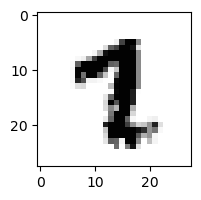

0.00019118870442551525% - 0
0.26840717394117963% - 1
0.008298720870039742% - 2
0.003326805108598821% - 3
0.04570022366194949% - 4
0.46055012352241775% - 5
0.004494954410011658% - 6
4.499880859451338% - 7 - ОШИБКА
0.1257323532489524% - 8
0.5277555388657945% - 9

 0


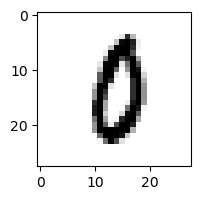

5.420439336058749% - 0
0.003154344423737757% - 1
0.556536065540999% - 2
1.4007034289543638% - 3
0.07860995816537283% - 4
1.8192189778571701% - 5
7.693926666490524% - 6 - ОШИБКА
1.1244213098439184% - 7
2.8908596845918995% - 8
0.6793153237150305% - 9

 9


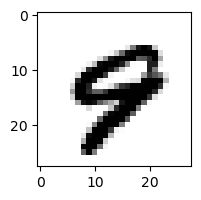

0.19751230074090323% - 0
0.0016642844129303132% - 1
8.691489573277842e-05% - 2
0.00011195497739483569% - 3
13.598878140322714% - 4 - ОШИБКА
0.05380524637410858% - 5
0.22116014953318877% - 6
1.343357500491002% - 7
0.0023472425635009384% - 8
5.180015798781825% - 9

 7


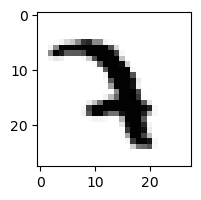

7.550235655107127e-06% - 0
0.6871982960443584% - 1
2.7471979104041218% - 2 - ОШИБКА
1.1128841609693196% - 3
1.0465070605927702% - 4
0.007068503648279749% - 5
0.23612696742259745% - 6
0.7809435401613483% - 7
0.028118146361206044% - 8
0.4046459462266431% - 9

 8


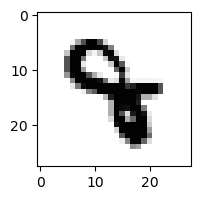

1.161140092566327e-05% - 0
0.024155798943303903% - 1
0.0022403551464335474% - 2
0.36421611657714875% - 3
49.08176500868441% - 4 - ОШИБКА
0.327853999125928% - 5
1.3119399945056964% - 6
0.0415880065809913% - 7
0.001249761300683373% - 8
0.2740129563548875% - 9

 5


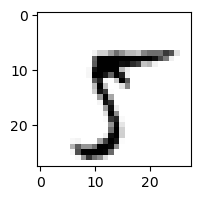

0.6673802482822461% - 0
0.9863087541330728% - 1
0.010587359343122342% - 2
0.38936649596597445% - 3
0.20751802430318644% - 4
74.30846727854743% - 5
0.014859661951625025% - 6
81.69399882835663% - 7 - ОШИБКА
9.01350212583236% - 8
4.130073095966671% - 9

 4


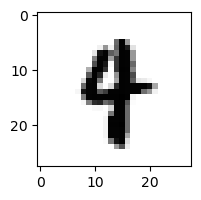

0.0008673009840428004% - 0
0.4254611839822242% - 1
0.005174189217230997% - 2
0.006172195461367725% - 3
8.740103538893534% - 4
0.4978936818856039% - 5
0.25162679656172215% - 6
0.45161563931382587% - 7
0.042435957374210645% - 8
13.398414643901102% - 9 - ОШИБКА

 0


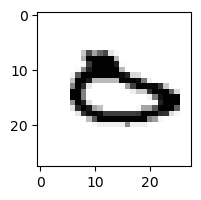

4.267550202242818% - 0
0.024009597770957094% - 1
0.0060546938655617714% - 2
0.0005076814770768346% - 3
0.833448556934482% - 4
0.10737418342064493% - 5
85.70861283926678% - 6 - ОШИБКА
5.860880676587488% - 7
0.17157421558345012% - 8
4.395201314905181% - 9

 5


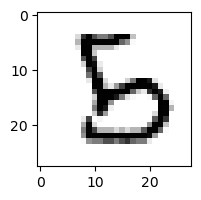

0.04297242493365034% - 0
0.014969947758241769% - 1
7.143242337672759% - 2
0.4662957442324594% - 3
3.408084885737936% - 4
4.489228803779255% - 5
2.455936879174096% - 6
0.002660937320304747% - 7
56.17203081271532% - 8 - ОШИБКА
0.016645888297634658% - 9

 2


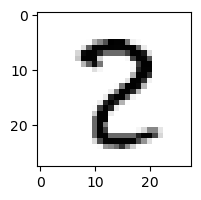

0.16044401238818906% - 0
0.15966742576983714% - 1
23.678107494472144% - 2
1.5756881206008644% - 3
0.2067370873343488% - 4
0.2861377116469721% - 5
0.0046742839502215494% - 6
3.4541375936335195% - 7
95.28391719208734% - 8 - ОШИБКА
0.3643078901961392% - 9

 2


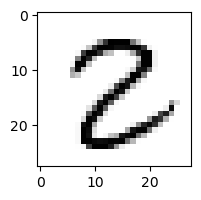

0.7017407110636703% - 0
0.4315775879142236% - 1
39.9032059261094% - 2
16.654682363198738% - 3
0.0408837376854902% - 4
1.8955846366629867% - 5
0.0037185564791923343% - 6
0.09712405075906413% - 7
97.64745215505147% - 8 - ОШИБКА
0.009258881929386892% - 9

 4


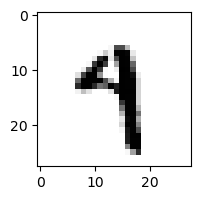

0.009320545634833805% - 0
0.19763369053000876% - 1
0.0016682407062610118% - 2
0.5360827454089235% - 3
19.233883916819426% - 4
7.357879932277507% - 5
0.3723178381625847% - 6
2.4921064560696733% - 7
0.831415659122809% - 8
86.7829218779935% - 9 - ОШИБКА

 2


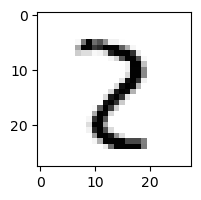

0.10359008055759701% - 0
4.779733167311511% - 1
12.440564423259342% - 2
7.957636931541921% - 3
0.1733556371039814% - 4
0.1040215440057122% - 5
0.08654213350940634% - 6
5.170324691316754% - 7
82.45761586696418% - 8 - ОШИБКА
6.483749477620904% - 9

 4


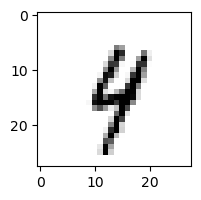

0.02431392001932619% - 0
0.9001066795661816% - 1
0.9710369720989703% - 2
2.503860809711488% - 3
34.51217269519384% - 4
0.5309783432647691% - 5
4.836318989373794% - 6
8.954469404229515% - 7
17.98073462452819% - 8
39.57997733455695% - 9 - ОШИБКА

 8


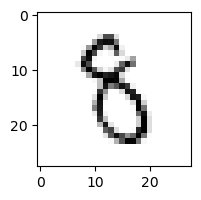

0.2207367525919349% - 0
0.44394313030696414% - 1
0.3725458689205704% - 2
30.376316688257464% - 3
1.5923878060626724% - 4
32.383232260136836% - 5 - ОШИБКА
7.313787283854574% - 6
0.3535700328055965% - 7
30.498599824308805% - 8
0.9055805130775592% - 9

 5


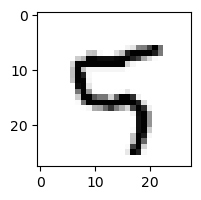

0.3379805984259204% - 0
0.08484406475007857% - 1
1.4552646476964588% - 2
0.02271083837529468% - 3
12.159127799374954% - 4
6.881853837658782% - 5
0.31230903521566683% - 6
1.7472966980952243% - 7
0.8786639448946421% - 8
56.13541468182146% - 9 - ОШИБКА

 3


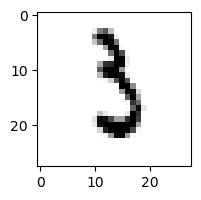

0.23043650999554602% - 0
3.294337201646801% - 1
1.9443670786731617% - 2
30.680851057944153% - 3
0.02189118498226868% - 4
2.0490381450642516% - 5
48.62986251865185% - 6 - ОШИБКА
7.7238536035661385% - 7
0.07381458323067752% - 8
0.5127723212402621% - 9

 5


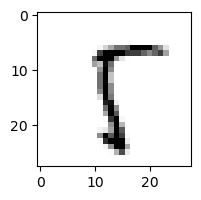

3.141382689455524% - 0
2.691456635640968% - 1
1.6963072918831423% - 2
1.1915386974951723% - 3
2.072470927209881% - 4
83.93946450175079% - 5
0.7347273762130082% - 6
4.247564721353633% - 7
94.2653788153743% - 8 - ОШИБКА
19.440726322823544% - 9

 8


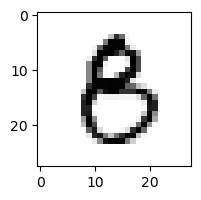

3.74219502143456% - 0
0.01416839026425676% - 1
0.03023934664910934% - 2
14.47689810105518% - 3
0.8578884781577638% - 4
30.628475586646182% - 5 - ОШИБКА
0.05600124360847152% - 6
0.0035788202692854914% - 7
2.443327286387554% - 8
1.3423581842164183% - 9

 8


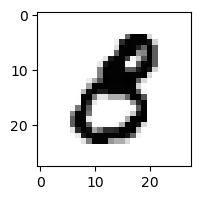

1.6564206184690753% - 0
0.012658475138156055% - 1
0.002016440137908809% - 2
16.370865372363614% - 3 - ОШИБКА
0.10317811574560526% - 4
2.3689156576835657% - 5
0.0028483632369992167% - 6
0.001573608953946251% - 7
0.013476228641941743% - 8
0.002069767148021211% - 9

 8


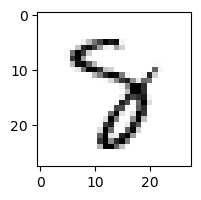

0.02694279631273758% - 0
0.10434777797833283% - 1
0.47786995203068044% - 2
3.8549838773815956% - 3
14.056263485986598% - 4
4.113580848635881% - 5
1.7260800520960116% - 6
49.508505213639% - 7 - ОШИБКА
6.094215915566789% - 8
0.03210121897139084% - 9

 7


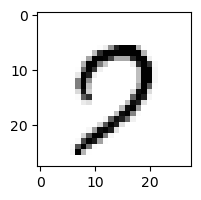

59.406943731173% - 0
0.0029435775361959303% - 1
0.7147096954957234% - 2
1.3147458414065032% - 3
0.5129095112644169% - 4
13.512123277746655% - 5
0.12763113636322285% - 6
72.84342133815986% - 7
0.7401719606352289% - 8
85.60223471053584% - 9 - ОШИБКА

 5


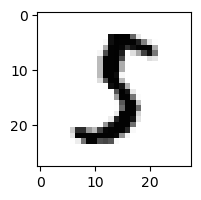

0.40916498637545384% - 0
1.9839662637100974% - 1
0.574609270884393% - 2
14.356073487027981% - 3 - ОШИБКА
0.007808223463474425% - 4
14.268825620609228% - 5
0.18227745012967955% - 6
0.1997520040278835% - 7
0.37095462568178744% - 8
0.004715833995810109% - 9

 5


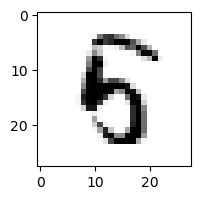

0.6021598695148599% - 0
0.0029218595471358975% - 1
0.08987041537078495% - 2
0.5124613966892997% - 3
83.43977764484369% - 4 - ОШИБКА
55.61868261380635% - 5
2.0036297553819034% - 6
0.000386470152971297% - 7
10.901353859901871% - 8
0.1550761476359066% - 9

 6


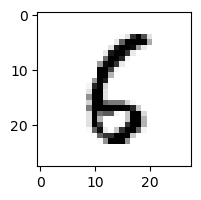

6.897131832376981% - 0
0.06302140316065541% - 1
4.141113905276774% - 2
0.010817941840614232% - 3
1.3937585021059342% - 4
20.783509042877746% - 5
33.86509917616433% - 6
0.02978259104608788% - 7
52.430876780308125% - 8 - ОШИБКА
0.7670840039751141% - 9

 8


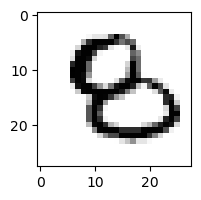

0.16153261375995592% - 0
0.00881892294554364% - 1
1.6344028051368704% - 2
0.06300519699582621% - 3
1.3063907573435511% - 4
0.1449669881014893% - 5
4.964026163362891% - 6 - ОШИБКА
0.0029327860642639654% - 7
2.5645644755793175% - 8
0.028075783672687017% - 9

 8


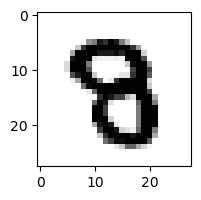

0.0018945689826695056% - 0
0.0001816608223649183% - 1
0.00964821911255439% - 2
1.2483585541045314% - 3 - ОШИБКА
0.0482714751383942% - 4
0.1319581494178644% - 5
0.01961853409836449% - 6
0.0036615021750383667% - 7
0.9185012387806706% - 8
0.20047443981813146% - 9

 4


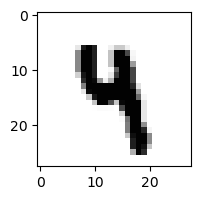

5.4215038036364526e-05% - 0
0.032829918027799186% - 1
0.004767103380112867% - 2
1.273619225994516% - 3
19.121438608164297% - 4
3.899086833421915% - 5
0.133541793413037% - 6
0.03841662259143345% - 7
0.1885988254224345% - 8
37.12804570937529% - 9 - ОШИБКА

 9


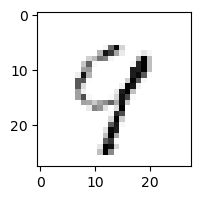

0.7517450667257382% - 0
1.3554880760186765% - 1
3.1980883381775467% - 2
2.0112698793184642% - 3
39.30026264071395% - 4
0.788690327815458% - 5
2.626316284839505% - 6
65.51812940455845% - 7 - ОШИБКА
39.98467433535885% - 8
55.57082979292824% - 9

 7


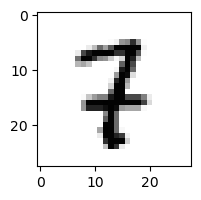

0.006944065069819446% - 0
3.549906213685027% - 1 - ОШИБКА
3.1782269873142357% - 2
0.43653829757744095% - 3
1.8232595836212058% - 4
0.08082168715144208% - 5
0.03933953830577897% - 6
2.639623848927604% - 7
1.8457706802791125% - 8
0.5266240520018294% - 9

 1


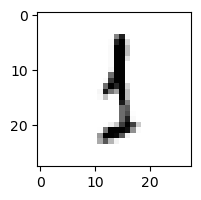

0.48003987014283417% - 0
51.86603302060908% - 1
1.3645194120410942% - 2
76.16936718327612% - 3 - ОШИБКА
0.340761285792844% - 4
8.962865921224534% - 5
6.764679311192028% - 6
0.6572411613401294% - 7
13.415008230999254% - 8
6.045411172615208% - 9

 9


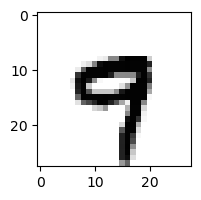

0.051807468448334226% - 0
0.013048744945128879% - 1
0.0002694533440122381% - 2
0.006811529147235496% - 3
31.1916450039594% - 4 - ОШИБКА
0.07343684596322266% - 5
0.06355796364057202% - 6
19.861918057011398% - 7
0.014936203058365927% - 8
28.67940765923392% - 9

 2


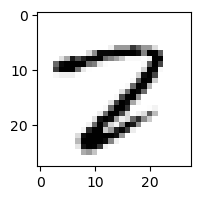

0.3194824373625046% - 0
0.013099048718090759% - 1
3.904026045252641% - 2
0.7083134442595469% - 3
0.045965240942785375% - 4
1.439163146877165% - 5
0.041220464810667434% - 6
73.54812479119843% - 7 - ОШИБКА
24.376881562007867% - 8
0.07930310685008704% - 9

 8


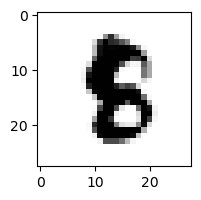

0.002048708931523371% - 0
0.00414745302031527% - 1
0.005420239280245938% - 2
0.013332878424575537% - 3
0.013522186355937542% - 4
5.453492558676409% - 5 - ОШИБКА
0.14592428542103075% - 6
0.004583661541463726% - 7
0.21596272278540732% - 8
0.13232642893111102% - 9

 3


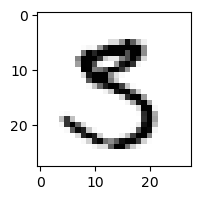

0.9253033067523839% - 0
0.013997905089420575% - 1
0.0351576513498576% - 2
27.769187812805075% - 3
0.022338254064250145% - 4
89.76939677153953% - 5 - ОШИБКА
0.0019111056100293866% - 6
0.6147394363552456% - 7
6.475971775247229% - 8
0.4732281793289438% - 9

 2


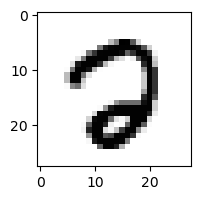

3.068237782995374% - 0
0.000601353015965816% - 1
0.6154943167856973% - 2
0.015792462476346934% - 3
0.004909159483073184% - 4
2.2786352766491493% - 5
0.023035869167488187% - 6
5.524983726828886% - 7 - ОШИБКА
5.408278743538576% - 8
0.006626641855707094% - 9

 3


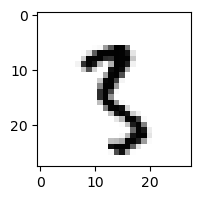

0.0313007826806005% - 0
3.0341258186195983% - 1
0.7317231951279557% - 2
3.1598019765343857% - 3
0.057194034346144486% - 4
35.34400242776727% - 5
0.10417045798080417% - 6
0.9521563032178401% - 7
42.467965760097115% - 8 - ОШИБКА
29.05321801269848% - 9

 8


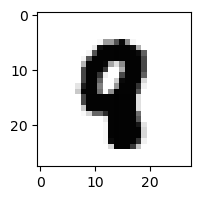

9.706766506748827e-05% - 0
0.0008450326320325164% - 1
0.0029480474735120756% - 2
3.0308689928029223e-05% - 3
3.1139168086093814% - 4 - ОШИБКА
0.008009953741114047% - 5
0.002611463106796392% - 6
0.04757135188159266% - 7
0.032034086593636595% - 8
1.27779322528683% - 9

 7


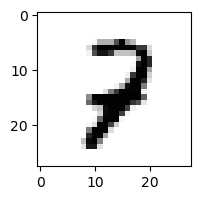

0.018262366565465267% - 0
0.47767970196386295% - 1
55.50150094136339% - 2 - ОШИБКА
0.9483197763459403% - 3
13.80807183128512% - 4
0.033925207950237055% - 5
0.12758456887870495% - 6
1.9788467324276513% - 7
1.9745211847674753% - 8
1.2719235621521208% - 9

 1


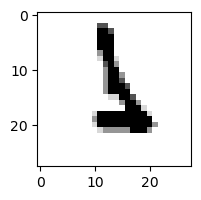

0.0018619475274495726% - 0
3.407176819306486% - 1
12.709590242359795% - 2
12.193743400893231% - 3
0.011726799985429923% - 4
1.4421648989888933% - 5
60.17837040136163% - 6 - ОШИБКА
0.07324228753381672% - 7
0.10854035113531135% - 8
0.12522946910927119% - 9

 4


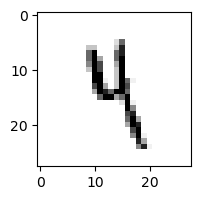

0.09764231008419016% - 0
1.4424986253058396% - 1
1.0677652078661306% - 2
14.340569854082538% - 3
28.823828590377854% - 4
52.02494941243254% - 5
8.150808547538075% - 6
0.632148328277352% - 7
53.84480702737399% - 8
65.94278993425672% - 9 - ОШИБКА

 7


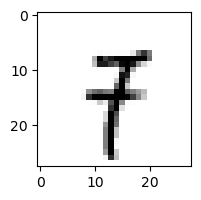

0.03626653061395773% - 0
32.64988907440855% - 1 - ОШИБКА
1.4566973975633222% - 2
1.2390799989282049% - 3
5.539244945574334% - 4
1.0611698031916867% - 5
0.145594972323768% - 6
31.52976310683008% - 7
0.2534530842360691% - 8
9.06998505233189% - 9

 6


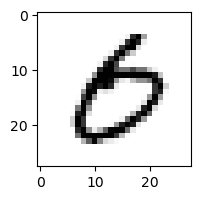

76.92542074404878% - 0 - ОШИБКА
0.016238814963526808% - 1
0.008674779128823246% - 2
10.813906777872424% - 3
0.203979768560951% - 4
0.9911353229413478% - 5
12.749886604810081% - 6
0.04971715227435604% - 7
0.2699846605288334% - 8
0.14343695279998753% - 9

 2


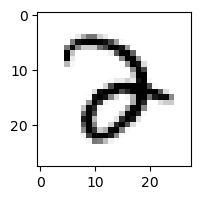

2.6508601407684838% - 0
0.007504077277529079% - 1
16.53904354541298% - 2
68.54436175911668% - 3 - ОШИБКА
0.2834716215778989% - 4
0.02085857728161011% - 5
2.5197066841076308% - 6
0.08144740371673563% - 7
0.4820650261841544% - 8
0.850222378524508% - 9

 3


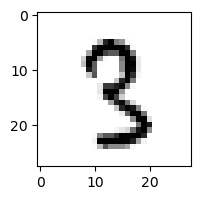

0.01801677117945078% - 0
0.5737301946500868% - 1
1.7204567568696816% - 2
45.74745060460943% - 3
0.384636528790834% - 4
6.82811210987853% - 5
0.003948718547485268% - 6
0.5060301884022531% - 7
57.35074805172915% - 8 - ОШИБКА
1.2261406414540053% - 9

 3


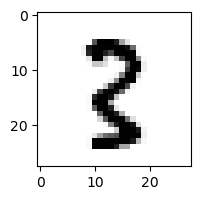

0.008402317629521728% - 0
1.157044485963163% - 1
2.9092270007648744% - 2
3.68753358599887% - 3
0.04871098421580908% - 4
0.2434486614831032% - 5
0.008244493942962705% - 6
0.15177681388868625% - 7
21.047364900399984% - 8 - ОШИБКА
0.29566766786723137% - 9

 9


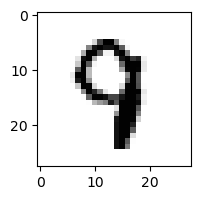

0.003149576450005433% - 0
0.006861271175706249% - 1
0.36066275692297367% - 2
1.0586222030973353% - 3
24.091749373016118% - 4 - ОШИБКА
0.28929412009497807% - 5
0.10186672417131312% - 6
8.470004078032565% - 7
0.02164445482887065% - 8
0.9629677820910407% - 9

 8


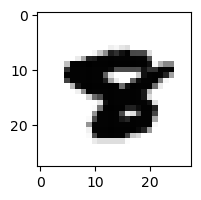

0.00033799687739696294% - 0
1.418068272752761e-05% - 1
5.471278079935619e-06% - 2
7.4864194559334786e-06% - 3
0.011825420355089789% - 4
0.049270814092932116% - 5
0.03341277868527375% - 6
0.08034591980778143% - 7 - ОШИБКА
0.0045475116949655016% - 8
0.0707866908086846% - 9

 9


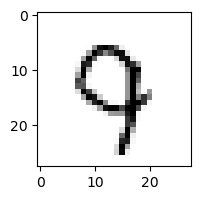

0.17181664983475026% - 0
0.037449187946223976% - 1
3.198527104621849% - 2
0.9909587199357182% - 3
59.932476729436345% - 4 - ОШИБКА
0.9051378997412235% - 5
0.8578057907556197% - 6
45.266410809975035% - 7
0.2322336629083256% - 8
42.95795722100637% - 9

 9


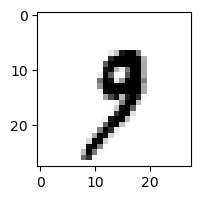

0.013916729758756666% - 0
0.9113732604903262% - 1
0.02827509771727447% - 2
23.67371016484184% - 3
1.3957433150738856% - 4
0.35543866643169514% - 5
0.11970854970780355% - 6
45.78919640184396% - 7 - ОШИБКА
0.3047800234662331% - 8
16.07396280362649% - 9

 7


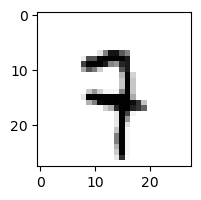

0.008144775225305566% - 0
0.945386341513128% - 1
7.586714721929422% - 2
0.3402663770878692% - 3
14.949026980923183% - 4
0.958655750061743% - 5
1.3695347793855173% - 6
36.4918471684014% - 7
3.4120497220873327% - 8
54.513110253260976% - 9 - ОШИБКА

 6


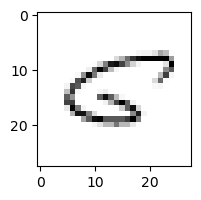

39.10647775809311% - 0 - ОШИБКА
1.4871941822166836% - 1
5.7333282160657815% - 2
0.07458905422845682% - 3
10.81830146599158% - 4
16.40588122256153% - 5
8.092097744548505% - 6
12.224955241305208% - 7
20.161134308137186% - 8
3.8407308850347093% - 9

 8


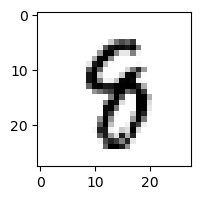

0.0033437839568035833% - 0
0.2040234596168224% - 1
0.043056452346657066% - 2
0.23443022726103124% - 3
12.231740593047135% - 4 - ОШИБКА
6.252600054085214% - 5
0.8797121654974674% - 6
0.29146176362878456% - 7
12.061891279614676% - 8
1.4574449225644528% - 9

 3


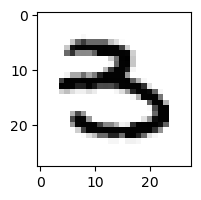

0.5052419880350535% - 0
0.008456308906836177% - 1
0.005206840728399925% - 2
48.66990288819728% - 3
0.005312001316722669% - 4
56.614677830084084% - 5 - ОШИБКА
0.2448808680120991% - 6
0.011523816707469565% - 7
0.0009983988086037375% - 8
0.044050337323705294% - 9

 5


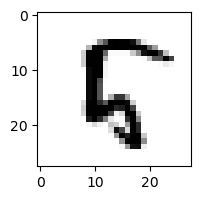

0.20536201690545533% - 0
0.0072775641918488% - 1
9.436826126333557% - 2
0.00012828946641976337% - 3
50.37546210047063% - 4
23.267036458651567% - 5
1.8779513445672045% - 6
0.006463377290124992% - 7
80.70698393855902% - 8 - ОШИБКА
0.02563578417343589% - 9

 8


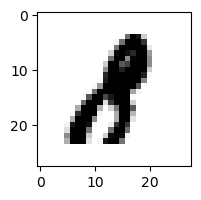

0.08156732294134897% - 0
0.9798186993528588% - 1
0.24752509544081402% - 2
1.4999547935716002% - 3 - ОШИБКА
0.02930956148128556% - 4
0.019849479837797876% - 5
0.0025689924211234763% - 6
0.003200148119026634% - 7
0.44376050282765994% - 8
0.02306651369576238% - 9

 7


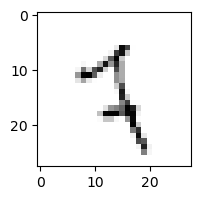

0.5727459422254462% - 0
13.767179769354849% - 1
6.150122924745492% - 2
0.3206821481951876% - 3
5.598007054878328% - 4
14.155000527160844% - 5
12.888173103980305% - 6
18.02809988384705% - 7
23.27257250297187% - 8
86.13486119302745% - 9 - ОШИБКА

 6


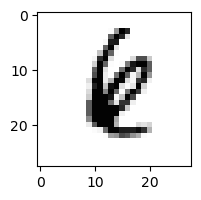

0.020978402613267087% - 0
0.5134345021945339% - 1
0.7538371880614686% - 2
0.004762023924628502% - 3
3.323185072508502% - 4 - ОШИБКА
0.13742617715643674% - 5
2.5392214847741728% - 6
0.03875455053420954% - 7
2.6755429284741195% - 8
1.7261939398533093% - 9

 5


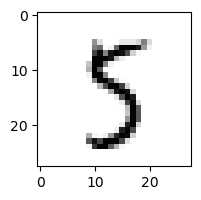

0.7905891431128461% - 0
0.10455431268728607% - 1
0.11899877082105326% - 2
12.749423000100071% - 3
1.9937042739598843% - 4
77.59474087835324% - 5
0.7883169523250686% - 6
1.6796984445137841% - 7
85.72382739452355% - 8 - ОШИБКА
10.661288737528588% - 9

 2


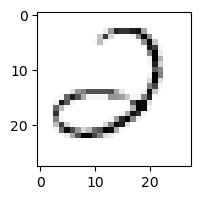

24.730228705979133% - 0
1.1578441088688893% - 1
9.478142463978108% - 2
50.33135303199143% - 3
30.04939235890991% - 4
5.4298927870539115% - 5
56.13226977086955% - 6 - ОШИБКА
1.639371795475259% - 7
0.5491451136619397% - 8
0.3309193491295852% - 9

 8


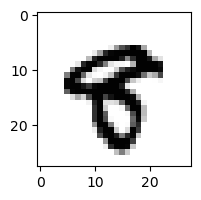

0.0953107076533799% - 0
0.0023720078319450113% - 1
2.7783469844960963e-05% - 2
0.023681591189179525% - 3
0.10613760258359399% - 4
0.19337525002606606% - 5
0.0019105258564232651% - 6
0.019971691394384098% - 7
3.1300466522571275% - 8
10.377499196992854% - 9 - ОШИБКА

 3


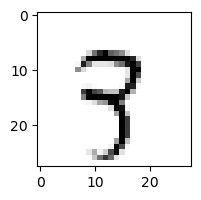

0.05447076782514349% - 0
1.5062834291969862% - 1
7.65675936191091% - 2
1.7320837482785025% - 3
8.534973634790685% - 4
1.0169584234147486% - 5
0.7363370828128524% - 6
40.18796784337039% - 7 - ОШИБКА
2.0227458909643796% - 8
26.11216757937118% - 9

 8


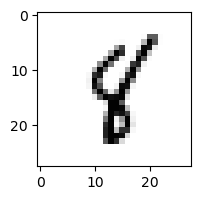

0.03910668985641662% - 0
7.002332347076185% - 1
0.33668761107691425% - 2
0.08591601760663217% - 3
46.16209715617662% - 4 - ОШИБКА
7.129088102377751% - 5
0.8184146836149493% - 6
3.977678969325672% - 7
4.79914227714484% - 8
2.7349298903596297% - 9

 5


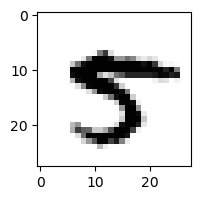

0.1340292777566443% - 0
0.0032196874207291283% - 1
2.039605303823102e-05% - 2
0.04298821916095741% - 3
0.1395104507680141% - 4
12.933994793641409% - 5
0.0013385918387678747% - 6
4.020052939357764% - 7
15.629819819704455% - 8 - ОШИБКА
0.04836348838932775% - 9

 7


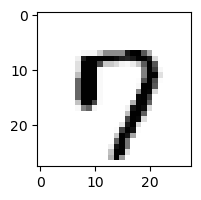

65.38274691092582% - 0
0.0003587852271636631% - 1
0.00670971452969153% - 2
0.03892368828907808% - 3
11.105928107810263% - 4
2.8417766426906432% - 5
0.2884738286999857% - 6
30.240681771549387% - 7
0.20110521905652798% - 8
72.51765517540304% - 9 - ОШИБКА

 8


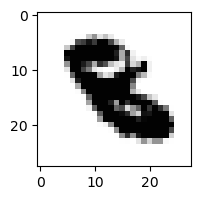

4.24624694108464e-07% - 0
9.303557911850325e-05% - 1
0.1063199623331865% - 2
0.018408357034791736% - 3
0.18173542986814034% - 4 - ОШИБКА
0.10932185862503442% - 5
0.0169227486186521% - 6
0.0005678211436848283% - 7
0.0001820927163836692% - 8
0.01885413918654194% - 9

 9


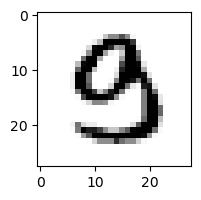

0.585252832005236% - 0
0.00930288476184583% - 1
0.08173626478526809% - 2
17.743328564591756% - 3 - ОШИБКА
0.06869902863098773% - 4
2.9479538669584437% - 5
0.0034512607504077106% - 6
0.01174915295679188% - 7
0.020995032023964737% - 8
0.020651642721505402% - 9

 4


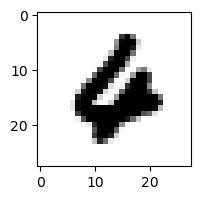

0.29719842757139237% - 0
0.000180156128280343% - 1
0.030752050333374352% - 2
0.00039386094202480007% - 3
3.9848470554662243% - 4
0.0023900050879780304% - 5
68.75854966813296% - 6 - ОШИБКА
0.03917418870029859% - 7
0.0006175583754804248% - 8
0.08917795761683944% - 9

 3


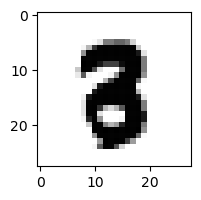

0.0006149545888638729% - 0
0.00035817575950121893% - 1
0.04555840823407722% - 2
0.16689594055080678% - 3
0.005244645449474998% - 4
0.03487192593461078% - 5
0.0018192454791902306% - 6
0.00966163603097344% - 7
0.5864043860924252% - 8 - ОШИБКА
0.01292244777239453% - 9

 7


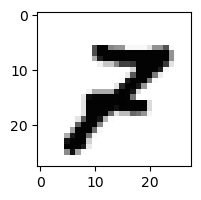

0.15836939720309154% - 0
0.03064973757788813% - 1
28.368065281097476% - 2 - ОШИБКА
0.16414848914009086% - 3
0.07529471076648195% - 4
0.01714263653196304% - 5
0.0011212133444887665% - 6
0.7625772982603012% - 7
10.598399672986554% - 8
3.956001690035659% - 9

 3


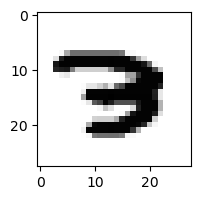

0.0037368532257120285% - 0
0.00019297685754896254% - 1
0.056114322872222136% - 2
1.2501976696015846% - 3
0.01844232399878237% - 4
0.001698634681536905% - 5
0.6600025517270631% - 6
7.207989658956827% - 7 - ОШИБКА
0.0011640847038664672% - 8
0.007449368758467037% - 9

 5


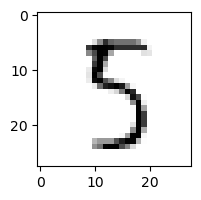

0.9323145855138506% - 0
0.10709913580333826% - 1
1.099853943341622% - 2
28.064720228825163% - 3
10.464474643435958% - 4
73.74378530807623% - 5
0.8096313843516503% - 6
0.7834087500736417% - 7
82.47681871257257% - 8 - ОШИБКА
2.80713195692398% - 9

 4


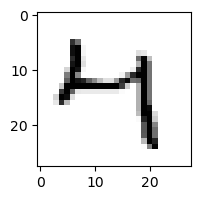

4.100819297166124% - 0
0.2738681864015196% - 1
0.04067222420079282% - 2
44.37322004593962% - 3
79.31286468979239% - 4
3.9327466965085343% - 5
1.5475480199972929% - 6
3.211075090998513% - 7
1.5611307735857662% - 8
84.66491504348791% - 9 - ОШИБКА

 6


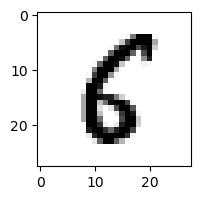

28.524298169441415% - 0
0.01535596524234505% - 1
0.3560742523321696% - 2
0.0017570563897616718% - 3
1.022179865758728% - 4
36.46469600876031% - 5 - ОШИБКА
8.374307644979861% - 6
0.008542579697343256% - 7
7.568458241250836% - 8
0.0556491287520724% - 9

 6


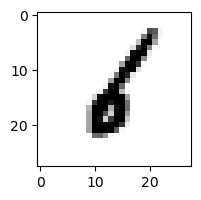

0.0413457557994735% - 0
83.91109272194603% - 1 - ОШИБКА
6.219327418420337% - 2
0.06862252958351403% - 3
1.6032026328101936% - 4
0.4592427923599838% - 5
6.440953153767187% - 6
0.18646520920445087% - 7
2.0410712407375864% - 8
0.11804535634478443% - 9

 0


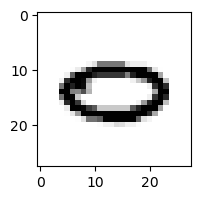

51.097394377226024% - 0
0.10181293782024581% - 1
0.002763338375591216% - 2
0.0004512213327600334% - 3
7.02301734522262% - 4
0.0006667517167522545% - 5
68.10073795530029% - 6 - ОШИБКА
12.623744947280944% - 7
0.08262919694823005% - 8
4.39240470977009% - 9

 9


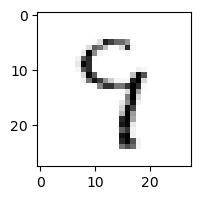

0.338018256215233% - 0
0.321617472843133% - 1
2.4124228630027216% - 2
13.375597134529032% - 3
72.44642749206915% - 4 - ОШИБКА
18.92464006850173% - 5
12.449121389969559% - 6
8.959122694291098% - 7
72.32681295764307% - 8
6.5277949992149376% - 9

 8


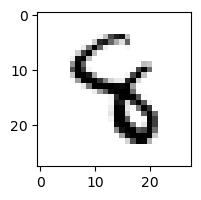

0.00040988597307710964% - 0
0.0986976643543214% - 1
0.22343974324902147% - 2
1.7417222460658848% - 3
68.0984059919753% - 4 - ОШИБКА
3.034315333578468% - 5
3.439017003028092% - 6
0.08398408898315901% - 7
0.3628468334917765% - 8
0.13476284437546102% - 9

 8


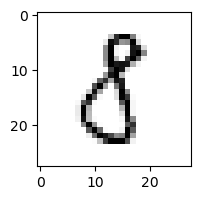

21.274917902632403% - 0 - ОШИБКА
3.5672827340372186% - 1
1.00106277406659% - 2
9.818955478411537% - 3
0.7276056740555986% - 4
17.538807168202187% - 5
0.23651429081564812% - 6
0.17810645732843314% - 7
1.137657770860897% - 8
0.07488217563172554% - 9

 8


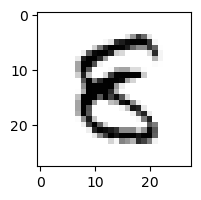

0.7558713517436919% - 0
0.018310702774208026% - 1
0.14325368935617755% - 2
0.7832770876294659% - 3
15.989612567200487% - 4
66.68751774471234% - 5 - ОШИБКА
1.200432777913583% - 6
0.00024032805239003496% - 7
7.43449342326766% - 8
0.02019392645181542% - 9

 3


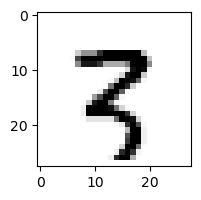

0.00790179615612425% - 0
1.3805579724491834% - 1
5.86391737913168% - 2
0.04128269283957337% - 3
0.04693023968657766% - 4
0.023373188743055908% - 5
0.01788190394776328% - 6
3.897067645870685% - 7
40.11836506424013% - 8
51.76939241237775% - 9 - ОШИБКА

 7


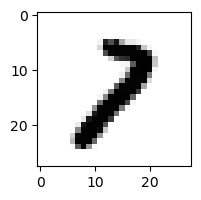

0.15338199908544622% - 0
8.197542032178735% - 1
40.86130398349223% - 2 - ОШИБКА
1.7402420211154008% - 3
0.019115334731707925% - 4
0.01182199761344053% - 5
0.00946827276475471% - 6
1.1746128157100757% - 7
12.621882195109082% - 8
5.107093074131514% - 9

 3


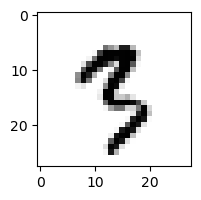

0.032593235134539704% - 0
2.25441919013597% - 1
0.02733377950146893% - 2
1.5968681116166517% - 3
0.030829131686857136% - 4
19.081190301689908% - 5
0.020411478993564502% - 6
2.054983016279427% - 7
2.17805452145904% - 8
22.905342021513402% - 9 - ОШИБКА

 9


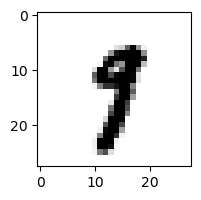

0.009056780772857582% - 0
4.712237760965899% - 1
0.0021937703984204948% - 2
1.1690330766717474% - 3
0.30860869548318237% - 4
1.0199681735855397% - 5
0.020179766099649634% - 6
40.329215730155425% - 7 - ОШИБКА
0.3665857973312091% - 8
3.7994379306952473% - 9

 8


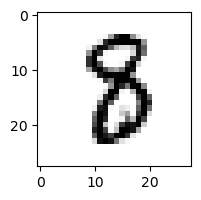

0.016220760789906544% - 0
0.4411072898361057% - 1
0.16067421741967275% - 2
1.2588851782527744% - 3
0.06911370415044082% - 4
5.934801979269293% - 5 - ОШИБКА
0.42489782691052835% - 6
0.1596111269888161% - 7
1.6481752332737651% - 8
0.0003918126441920439% - 9

 2


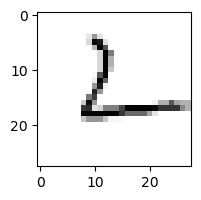

23.058174388184387% - 0
0.41443444060878293% - 1
74.908795053781% - 2
0.5009823349862765% - 3
39.16332359863778% - 4
7.1011182354631925% - 5
80.16558255638294% - 6 - ОШИБКА
3.0823978624403816% - 7
33.541590731834745% - 8
25.930241145860183% - 9

 7


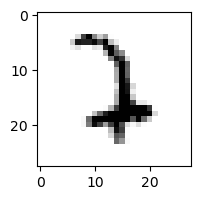

0.006296583412060338% - 0
7.304651605501054% - 1
45.24785434385769% - 2 - ОШИБКА
6.6859347752742115% - 3
0.08782627865581791% - 4
0.07438989527056013% - 5
22.04784390382284% - 6
3.9188693201039584% - 7
0.029933110295877724% - 8
0.3311853348309673% - 9

 9


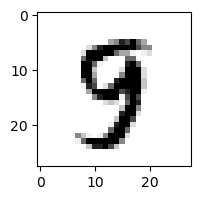

0.0047099795863369855% - 0
0.008668098124957167% - 1
0.02959521516439823% - 2
6.933687342660424% - 3 - ОШИБКА
4.877794480382286% - 4
2.055219854232851% - 5
0.013442149903313865% - 6
0.8265240495538234% - 7
3.51926678018578% - 8
0.3150278748133597% - 9

 9


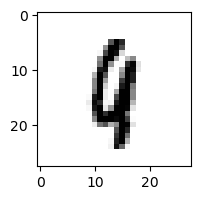

0.006489211725427953% - 0
1.1214968609718645% - 1
1.3363078601031506% - 2
0.013673897932662068% - 3
11.955782398943903% - 4 - ОШИБКА
0.2215940817063051% - 5
5.957180523511866% - 6
3.8211074361679485% - 7
3.1032582510742457% - 8
2.7475810035607777% - 9

 8


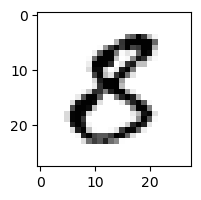

7.5959364272079135% - 0
0.013377733659971077% - 1
0.3949940529618146% - 2
2.621754603375082% - 3
0.55975140579104% - 4
31.634993948920155% - 5 - ОШИБКА
0.008183629738922378% - 6
0.0009294204332755585% - 7
0.10894422198343261% - 8
0.0061947347911605185% - 9

 4


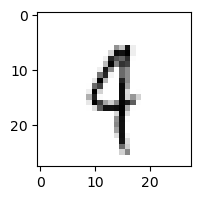

0.4019277803192978% - 0
9.051432555230143% - 1
1.7680834002359043% - 2
1.0020869250855036% - 3
30.385790044345505% - 4
2.9462509716029404% - 5
8.994171324987748% - 6
13.623912380312014% - 7
7.200550901588136% - 8
83.92003838014234% - 9 - ОШИБКА

 5


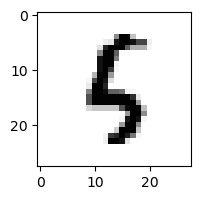

0.09798596270024121% - 0
0.040739942010176854% - 1
1.8676128995346823% - 2
0.31295247552042277% - 3
41.78017116438418% - 4 - ОШИБКА
26.768530284761294% - 5
7.2873831256048724% - 6
0.009383108468363904% - 7
18.57895960283516% - 8
0.6088211235002015% - 9

 9


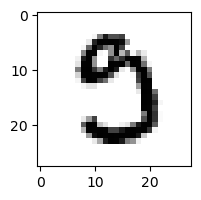

23.983669454855374% - 0
0.0006243473202730444% - 1
0.06203763798206071% - 2
5.111534153678254% - 3
0.0008939871780659067% - 4
31.844598548365443% - 5 - ОШИБКА
0.01835310654250287% - 6
5.230802683310146% - 7
0.5868558451535404% - 8
0.003483480489109015% - 9

 8


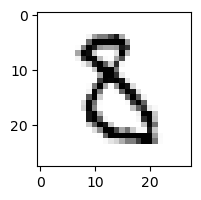

0.8421284018596629% - 0
0.009375851520826551% - 1
1.6447558374187974% - 2
5.984027737245566% - 3
0.21176990613953825% - 4
14.070352427800067% - 5 - ОШИБКА
10.982884407441267% - 6
0.02027148717769807% - 7
2.7007284002385594% - 8
0.05128420455861009% - 9

 2


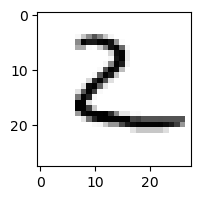

26.168833830728072% - 0
0.12044358927219276% - 1
56.79290385494507% - 2
0.519513299405411% - 3
0.24023090119685825% - 4
2.377726670404849% - 5
73.92858694286807% - 6 - ОШИБКА
0.05118402814556261% - 7
0.1746763115340806% - 8
5.601220579909985% - 9

 2


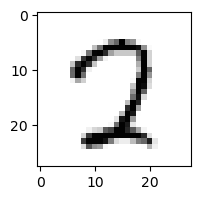

14.105467384417972% - 0
0.005724497668391345% - 1
3.055585636385589% - 2
21.00831470257343% - 3
1.470902376742845% - 4
15.934022386694224% - 5
0.04327966530790373% - 6
25.227149498321754% - 7
29.038086863329642% - 8 - ОШИБКА
0.3144788984081082% - 9

 7


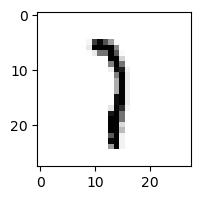

0.1281321256494653% - 0
78.65509644545978% - 1 - ОШИБКА
14.448180126422583% - 2
12.031391800515953% - 3
1.4550767536785967% - 4
2.077675108521692% - 5
3.4040150058255407% - 6
28.49969813719177% - 7
1.7513259038081195% - 8
5.3499293338975615% - 9

 8


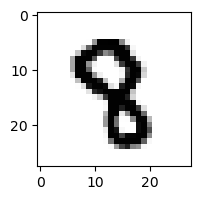

5.5496576269693956e-05% - 0
0.007734785862497975% - 1
0.06046651814855643% - 2
0.1990491240840223% - 3
3.715183609827412% - 4 - ОШИБКА
0.5409374183911521% - 5
0.010028019024101427% - 6
0.1776910373966894% - 7
0.8556189468749564% - 8
0.20778712970711916% - 9

 5


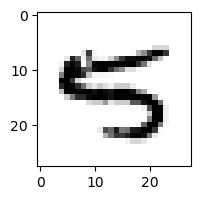

0.3188880051848694% - 0
0.01857833214820354% - 1
0.006640480542183914% - 2
0.21094999209051177% - 3
31.365043400261477% - 4 - ОШИБКА
14.155131873159526% - 5
0.0710777719176356% - 6
0.534460957974105% - 7
0.004269696148071817% - 8
0.3301332918127756% - 9

 9


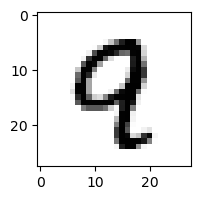

0.02505763125201293% - 0
0.01103769045552318% - 1
0.2962192487300386% - 2
0.006808506075309853% - 3
54.53854832094295% - 4 - ОШИБКА
0.043410424133716714% - 5
0.05759331963841615% - 6
0.45855062422076565% - 7
2.833998603073366% - 8
19.606195865002956% - 9

 7


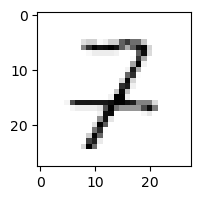

0.49626720197504465% - 0
9.51328103600624% - 1
73.2928173474528% - 2 - ОШИБКА
8.647269534589617% - 3
56.850778800549364% - 4
0.2619004778676535% - 5
2.670401152486131% - 6
4.161327435236751% - 7
4.774977262129446% - 8
0.446393213742201% - 9

 8


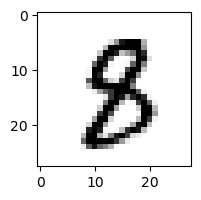

0.018626217573106753% - 0
0.11130078189672164% - 1
0.032364442927192226% - 2
0.6887180594789933% - 3
0.41097358293553177% - 4
6.963525033247723% - 5 - ОШИБКА
0.019157186371833144% - 6
0.05703135771497489% - 7
2.8702005842927405% - 8
0.04779226081129572% - 9

 5


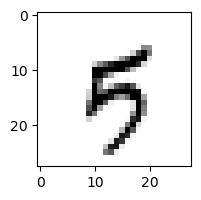

0.7487647053889184% - 0
0.4241466560329305% - 1
0.03053442768058472% - 2
0.8080090583525921% - 3
31.286097899684457% - 4 - ОШИБКА
4.656966729287455% - 5
0.757432534678888% - 6
3.0067278022216852% - 7
0.8199442528640043% - 8
5.490899668713222% - 9

 3


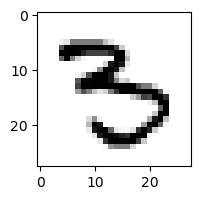

0.37378945334219577% - 0
0.014233150318723454% - 1
0.0004788291558693079% - 2
17.73515619162502% - 3
0.5415023936975409% - 4
42.12689314318484% - 5 - ОШИБКА
0.44423935945298343% - 6
0.09788108792515239% - 7
0.205228885727626% - 8
0.21964443067587752% - 9

 5


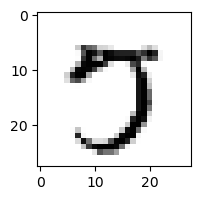

6.541453324148653% - 0
0.002207917217115867% - 1
0.06341172260501629% - 2
6.674303442398341% - 3
0.04563788422559522% - 4
22.021633411137568% - 5
0.004838858870286845% - 6
93.55444000952976% - 7 - ОШИБКА
2.3907840588379976% - 8
4.44211961639953% - 9

 3


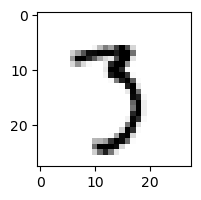

0.5632441357768552% - 0
0.5227014465820145% - 1
0.4167156355974538% - 2
84.09340011083658% - 3
0.06646418095388856% - 4
4.890212982315104% - 5
0.12638161968530348% - 6
88.09766170039944% - 7 - ОШИБКА
0.9948236798434491% - 8
5.7348728520393095% - 9

 8


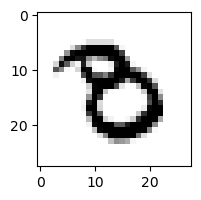

0.5374692804792499% - 0
0.0013493340428089476% - 1
0.014355627859200505% - 2
10.493444979263426% - 3 - ОШИБКА
0.003170398804583359% - 4
0.773146458094677% - 5
6.430995911602119% - 6
0.05685375890064471% - 7
0.1015144428941873% - 8
0.014531500560666153% - 9

 8


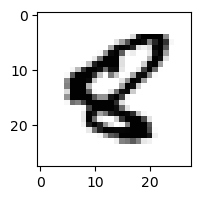

0.07941944851293839% - 0
0.01895347950379914% - 1
0.003157356921803785% - 2
1.7278667023152162e-06% - 3
3.27885187259282% - 4 - ОШИБКА
0.6027058965339475% - 5
1.65449115025931% - 6
0.0014260459095155327% - 7
1.3288216340567518% - 8
0.13987385827868912% - 9

 7


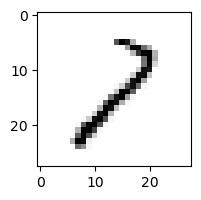

3.2859442473022193% - 0
44.363630975447215% - 1
75.66404566338281% - 2
5.581314753292959% - 3
6.773865472566339% - 4
1.4096431839917818% - 5
3.753377178887022% - 6
4.436540143186987% - 7
84.66508433870914% - 8 - ОШИБКА
1.624602432625213% - 9

 7


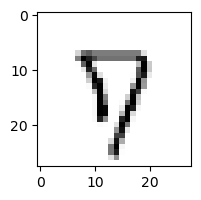

1.5546673699379905% - 0
0.008468943503311132% - 1
3.3945859282621687% - 2
0.4444533862801754% - 3
10.232348738546401% - 4
6.89580504719165% - 5
2.9027724585229855% - 6
41.318930751223654% - 7
53.564916642741856% - 8
65.27209039964744% - 9 - ОШИБКА

 2


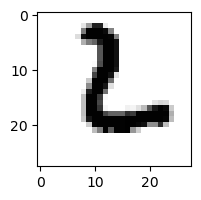

3.409732975172615% - 0
0.0011989650034239393% - 1
44.89683679808716% - 2
0.07144917172777131% - 3
0.0015313457862103307% - 4
9.888671704980311% - 5
97.1133148842597% - 6 - ОШИБКА
0.002269998493458346% - 7
0.15115570061565795% - 8
0.08586258182377643% - 9

 5


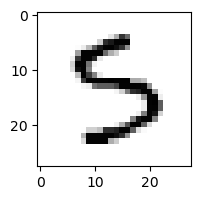

0.23615770887308926% - 0
0.014667411937268492% - 1
0.05512638445914212% - 2
68.72052066428404% - 3 - ОШИБКА
1.204034021914047% - 4
64.12058147399024% - 5
5.383576025830313% - 6
0.29013774082104743% - 7
7.902134268517419% - 8
0.02315996107314242% - 9

 2


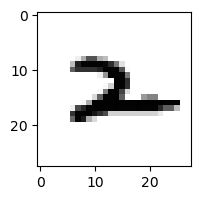

0.00639122468522552% - 0
7.0084910415498785% - 1
3.2758668918129987% - 2
0.01561265725037664% - 3
21.160083657019417% - 4 - ОШИБКА
0.24007199470755294% - 5
14.390809783935934% - 6
0.7867591540166644% - 7
19.033457174458153% - 8
1.6042848501122724% - 9

 7


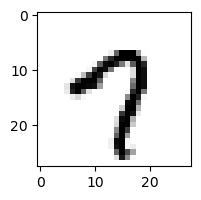

9.314230383570823% - 0
0.007098151296549977% - 1
0.0035715136207916586% - 2
0.06617508566135928% - 3
9.359297518959412% - 4
3.2928735951537567% - 5
0.2530024291519502% - 6
79.79474864857443% - 7
0.10546906880544052% - 8
90.47634599108962% - 9 - ОШИБКА

 2


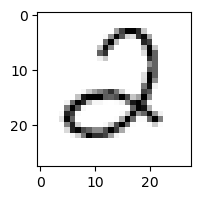

15.46638991336452% - 0
0.05333743020343571% - 1
58.43457343796344% - 2
58.685930843641984% - 3 - ОШИБКА
6.845652281599243% - 4
1.4215577605286978% - 5
14.279058977527104% - 6
0.0907243093373887% - 7
0.07850541104672798% - 8
0.07664545415646354% - 9

 2


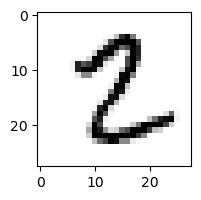

0.2472070664646364% - 0
1.7108722958430942% - 1
15.808969180263437% - 2
0.24662729351031576% - 3
0.008278240856643665% - 4
16.34286905800934% - 5
0.01738851500928398% - 6
0.1355448676718767% - 7
55.81156280441274% - 8 - ОШИБКА
0.03421491700482255% - 9

 5


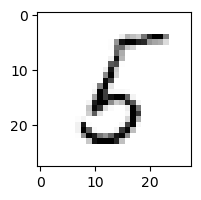

3.8107035766193147% - 0
2.967061543510427% - 1
6.2623380187160755% - 2
7.914422675620028% - 3
7.846939658163846% - 4
47.655630302381105% - 5
20.703749784821472% - 6
0.05100806616045471% - 7
81.78464043929951% - 8 - ОШИБКА
0.19670540972253564% - 9

 3


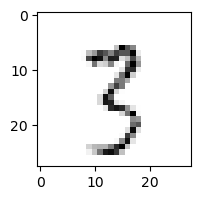

0.32785008728197035% - 0
12.634754972603316% - 1
8.234252616090057% - 2
29.19638817454678% - 3
0.6145928385445716% - 4
6.798192465611431% - 5
0.11872923797410063% - 6
32.61466778382566% - 7
24.74997988773581% - 8
64.44593847288537% - 9 - ОШИБКА

 4


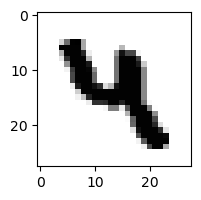

7.098262048102158e-05% - 0
0.0043759041451295255% - 1
0.007885907500461354% - 2
0.7800895198882244% - 3
28.91087023479651% - 4
0.09828205587757402% - 5
0.01894282021807737% - 6
0.05938957421367203% - 7
0.0012007470556672786% - 8
30.178253826163804% - 9 - ОШИБКА

 5


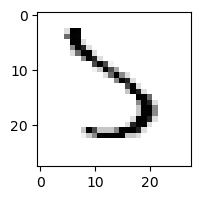

0.8836483416078798% - 0
0.4705042479607178% - 1
4.555786223578211% - 2
89.63161928644591% - 3 - ОШИБКА
4.830091058008572% - 4
37.877574108706156% - 5
17.40112189280691% - 6
19.642479842987544% - 7
1.5460622072353265% - 8
0.13396473937850392% - 9

 8


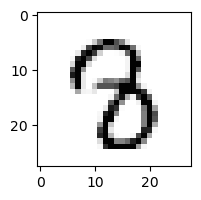

0.00457409119139662% - 0
0.1621409311288439% - 1
0.16140054402823206% - 2
4.176069340306154% - 3
4.516543984484659% - 4 - ОШИБКА
1.6486989542658241% - 5
0.11080414331521675% - 6
2.153554287179271% - 7
1.7167336065623577% - 8
0.11357870644950656% - 9

 2


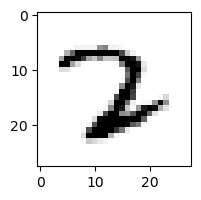

0.00871157028338259% - 0
0.1504908494549826% - 1
27.982008639231125% - 2
7.4031582767200925% - 3
0.07103281936248625% - 4
0.09116048321783583% - 5
2.1740642250118456% - 6
66.45112603215415% - 7 - ОШИБКА
0.020812328974290962% - 8
0.005838093701068907% - 9

 5


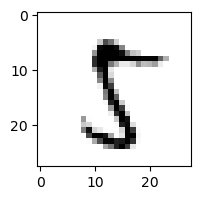

1.5666161506915393% - 0
0.9331967322127254% - 1
1.0232096111047917% - 2
1.2822571317550653% - 3
0.06764811937659447% - 4
80.33539601339427% - 5
0.003251896253772312% - 6
3.818942633981058% - 7
81.90820637175761% - 8 - ОШИБКА
1.3046448382366944% - 9

 2


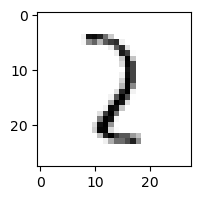

0.15884130517469833% - 0
43.306839932232634% - 1 - ОШИБКА
34.63972451428407% - 2
7.3684698256701875% - 3
8.032075991153206% - 4
0.6039251783504651% - 5
3.6189722747727524% - 6
25.305811712042797% - 7
16.41814374955804% - 8
1.4635647195438724% - 9

 2


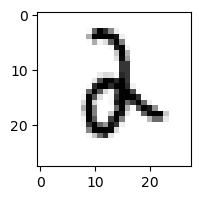

0.08976059614917845% - 0
0.8210937787088288% - 1
5.60157028852663% - 2
8.58180442407297% - 3
1.8038069077969325% - 4
0.673815924112432% - 5
28.62023970378403% - 6 - ОШИБКА
0.025034954905849064% - 7
0.05329191156032264% - 8
0.7880758432150553% - 9

 5


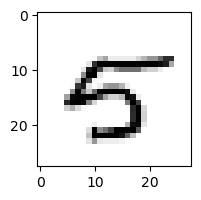

10.703053810576543% - 0
0.016977784967218298% - 1
0.013281751544641647% - 2
0.5136328603428548% - 3
44.57820125157637% - 4 - ОШИБКА
19.013153699027843% - 5
0.24583402613188318% - 6
0.6676575213557314% - 7
0.40917577844410336% - 8
0.3630519159295753% - 9

 9


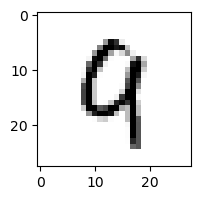

0.1071529229880884% - 0
0.043050963649410405% - 1
7.299057322814474% - 2
0.022924238614578308% - 3
70.75994320582001% - 4 - ОШИБКА
0.11443443914400948% - 5
1.7136377591491174% - 6
4.030571671474935% - 7
5.704850668469081% - 8
32.06945149839774% - 9

 8


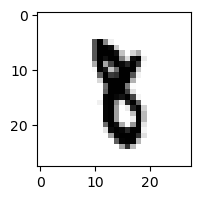

0.00015668621253632826% - 0
13.046010800993074% - 1 - ОШИБКА
0.03599491741987205% - 2
2.3787735736834765% - 3
0.0915459248049878% - 4
0.7807875273814168% - 5
0.02310214394884907% - 6
1.175450671813188% - 7
0.15332360023806224% - 8
0.14362269207691888% - 9

 4


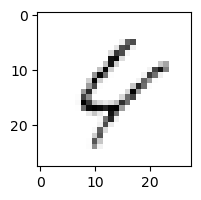

14.910445871648939% - 0
1.2438086970033462% - 1
9.408972439760754% - 2
0.03886289711868354% - 3
54.069035147479916% - 4
0.7834831829869687% - 5
34.17071548492851% - 6
10.93102740525161% - 7
51.79027939901041% - 8
85.85556908048667% - 9 - ОШИБКА

 8


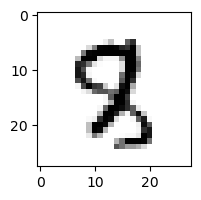

0.0031161390554037965% - 0
0.2594470360593141% - 1
1.7051311278464039% - 2
0.17082733360722252% - 3
0.6706314735548794% - 4
1.987104601974345% - 5
0.056366076037045056% - 6
1.192650162199274% - 7
1.2691697837678453% - 8
2.4159629169485672% - 9 - ОШИБКА

 6


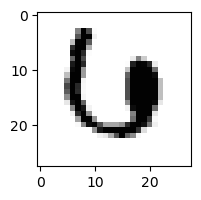

4.901194111823485% - 0
0.00018369988583330084% - 1
0.21239229281135916% - 2
12.657195886470998% - 3
14.201630252076066% - 4 - ОШИБКА
0.0006680574552043228% - 5
12.180040605719551% - 6
11.941439609505174% - 7
0.006116424979122293% - 8
0.02517004672117243% - 9

 4


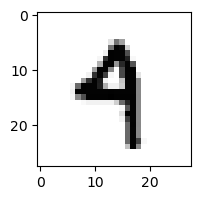

0.024785027932119705% - 0
0.05809112121656653% - 1
0.013098184499455587% - 2
1.7204986104448379% - 3
58.478594536749995% - 4
1.7203512741944191% - 5
0.8533064146955727% - 6
0.22576510428079632% - 7
0.07428775599123863% - 8
85.31251452278225% - 9 - ОШИБКА

 3


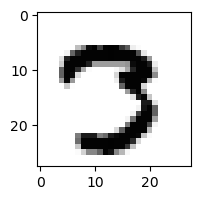

0.08765001831263078% - 0
0.00040313316081302426% - 1
0.021871440104202125% - 2
91.10303236238639% - 3
0.0004878891041980461% - 4
0.10275530668606295% - 5
1.851794380552503e-05% - 6
93.96053193657578% - 7 - ОШИБКА
0.3362178890967581% - 8
0.11350025735606437% - 9

 8


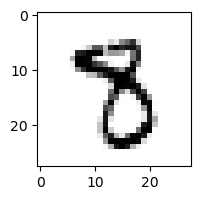

0.0037513431734066734% - 0
0.6869531591368166% - 1
0.02842354905468504% - 2
2.199318548795412% - 3
0.3159753274800621% - 4
11.405696070188279% - 5 - ОШИБКА
0.013541579214335837% - 6
5.643485224918025% - 7
9.941155642306015% - 8
0.0491459641064997% - 9

 5


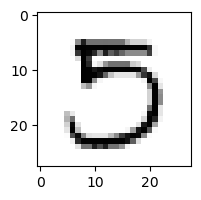

23.76480375090843% - 0
0.01025730284216386% - 1
0.09759187709349593% - 2
42.0800963381537% - 3 - ОШИБКА
0.02232756582277105% - 4
7.327519784001282% - 5
0.002295568677792269% - 6
10.577008956470477% - 7
6.169599200253952% - 8
0.025269647197010844% - 9

 5


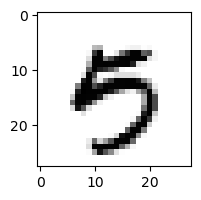

1.2773953403925908% - 0
0.006894761272287176% - 1
0.00014929377256724027% - 2
0.7983185506270531% - 3
5.176872938548099% - 4
8.137621109606783% - 5
0.09168409302002847% - 6
0.1481606348598925% - 7
0.024756496494155254% - 8
19.65928287936732% - 9 - ОШИБКА

 3


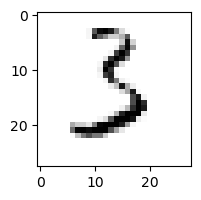

4.305359376467568% - 0
0.5964801846832489% - 1
27.940720478478713% - 2
23.116811487667132% - 3
0.018691224059092473% - 4
22.493805476625386% - 5
32.3708878547922% - 6 - ОШИБКА
5.791795461506606% - 7
0.23436436626933116% - 8
0.7200797291975886% - 9

 7


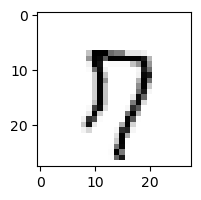

43.518961661674496% - 0
0.008345479559273058% - 1
5.082854703602546% - 2
1.1377158488024333% - 3
1.5846454434641586% - 4
18.84018047641433% - 5
1.9350444352208724% - 6
35.7035648701271% - 7
61.867880711355575% - 8
77.70829827040927% - 9 - ОШИБКА

 7


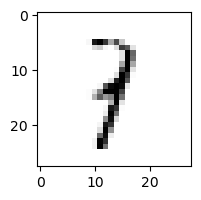

0.1935525334225148% - 0
82.56345969901314% - 1 - ОШИБКА
7.566823150577333% - 2
41.31851143417168% - 3
5.219416703633619% - 4
4.796966920782672% - 5
1.5711316947673266% - 6
0.9858637373254242% - 7
18.65164724534429% - 8
9.561945648635874% - 9

 8


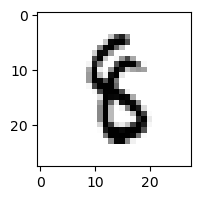

0.008290355472613392% - 0
0.6317265220891167% - 1
0.14475427148203077% - 2
1.1316682982694843% - 3
0.5402820605617242% - 4
15.494142338788503% - 5 - ОШИБКА
1.3315087367054648% - 6
0.031088642534748957% - 7
4.722843225070906% - 8
0.016308128240138414% - 9

 2


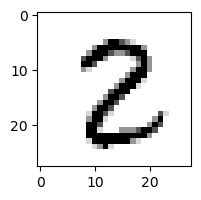

0.27810711040282454% - 0
0.5152937265037217% - 1
25.516135716043454% - 2
1.9368649208025155% - 3
0.03417496202966246% - 4
1.134478600802186% - 5
0.004596309969871592% - 6
0.2604727711707313% - 7
97.15487353931071% - 8 - ОШИБКА
0.13499400377516982% - 9

 7


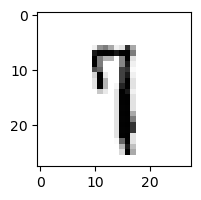

0.10454062722397596% - 0
1.072429625693856% - 1
1.0634577209842915% - 2
9.011865965468822% - 3
7.697535347985577% - 4
10.974215020591842% - 5
1.8139392438047919% - 6
23.865280612747135% - 7
9.230665601521753% - 8
56.372314472111285% - 9 - ОШИБКА

 8


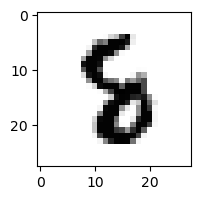

0.00010578637569890739% - 0
0.014388476811803672% - 1
0.11972783049337557% - 2
0.01605898078551274% - 3
1.2876565884314806% - 4
9.86705373692938% - 5 - ОШИБКА
3.0855454802434634% - 6
0.03749477146079997% - 7
3.8555238838287007% - 8
0.006623784255722832% - 9

 5


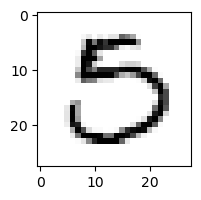

39.09747536032398% - 0 - ОШИБКА
0.009906997280503248% - 1
0.9506354422650409% - 2
7.65401475023989% - 3
0.03879762202715736% - 4
3.441377094515056% - 5
0.028318316573355953% - 6
1.6810809990230637% - 7
7.690652797971332% - 8
0.00036286638318276817% - 9

 1


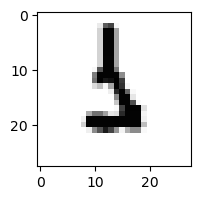

0.046147764167268665% - 0
1.5596854497692552% - 1
1.7573331303302044% - 2
0.7805173518927572% - 3
0.01462444510237669% - 4
11.881266242629334% - 5
70.63472260546145% - 6 - ОШИБКА
0.2963649661635685% - 7
1.093122826367205% - 8
0.1263578479873316% - 9

 8


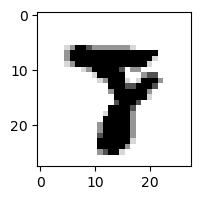

0.00019908195972619447% - 0
0.00712894457418623% - 1
0.0002579070502050186% - 2
0.01557256476678146% - 3
0.002905749786405492% - 4
0.0661477143927519% - 5
8.254531411517089e-05% - 6
89.52224552387898% - 7 - ОШИБКА
0.013392951587398557% - 8
0.005206149861349371% - 9

 9


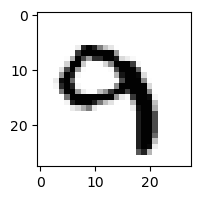

0.010544098093723324% - 0
0.0173117818290862% - 1
0.6547225797538085% - 2
30.569902958696687% - 3 - ОШИБКА
8.146441954964711% - 4
0.010874549434517992% - 5
0.22724585537835149% - 6
1.4318326580742895% - 7
0.0017576334756925023% - 8
20.876798156490377% - 9

 4


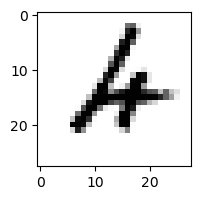

0.09392051684180375% - 0
0.03297431841169906% - 1
3.529010837823468% - 2
1.109851897558545% - 3
7.7197999306359595% - 4
0.0630424364390174% - 5
59.29078485592824% - 6 - ОШИБКА
0.03131418146384409% - 7
0.9159215543311736% - 8
5.787042333110392% - 9

 9


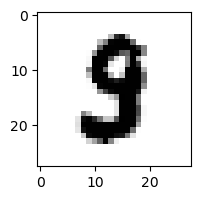

0.019517743003038147% - 0
0.0016128590161481383% - 1
0.08408651936451975% - 2
0.6919590468394222% - 3
0.0072752162686109305% - 4
6.7614771466919965% - 5 - ОШИБКА
0.028908155620325355% - 6
0.05040994600134989% - 7
0.7717934539522744% - 8
0.004387347589951743% - 9

 9


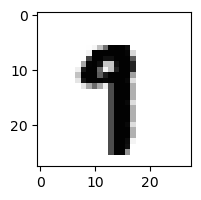

0.00014781950716527274% - 0
1.4051494244025557% - 1
0.00014768193548498495% - 2
0.008935868452409018% - 3
0.09589558387071674% - 4
4.767625036858014% - 5
0.01529517064004376% - 6
11.22860643950597% - 7 - ОШИБКА
0.45312111838391583% - 8
3.3489739129720912% - 9

 9


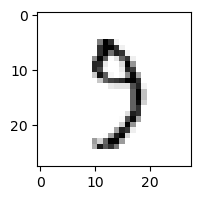

1.7431712067235452% - 0
0.21663139957745114% - 1
0.9029959701646474% - 2
50.727495806974765% - 3
2.4741651391464305% - 4
17.10922004117372% - 5
0.47026227533168696% - 6
58.35091214821275% - 7 - ОШИБКА
17.81609826162553% - 8
13.381770228754988% - 9

 8


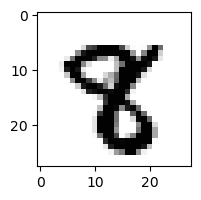

3.387058968341076e-05% - 0
0.027513355696907254% - 1
0.0020250782255670165% - 2
0.05910381182678505% - 3
0.06619765590251261% - 4
0.3911382273216164% - 5 - ОШИБКА
9.733075819232444e-05% - 6
0.15880920931958004% - 7
0.3412976126717966% - 8
0.07979574170476968% - 9

 8


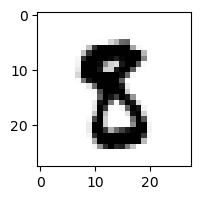

0.0047227783522019295% - 0
0.004252354138466309% - 1
0.00036180728524746824% - 2
0.0953101516074788% - 3
0.002079902378624338% - 4
52.226415780153225% - 5 - ОШИБКА
0.0011902235839969476% - 6
0.020362580154037517% - 7
43.79195188445289% - 8
0.061223633761382824% - 9

 4


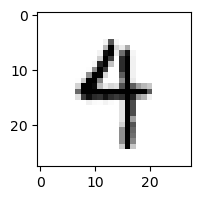

0.05973722147890676% - 0
0.19443641147645105% - 1
0.020089781502361723% - 2
1.4766328474068942% - 3
76.36685731558079% - 4
7.7315379193865175% - 5
2.2124684621230095% - 6
0.6587692136141859% - 7
0.1552726435505055% - 8
84.26111122144789% - 9 - ОШИБКА

 7


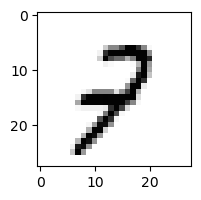

1.0858928451362593% - 0
0.9149783311735616% - 1
41.31340987965548% - 2
1.7656288943899656% - 3
4.989069425807881% - 4
0.1313703707810052% - 5
0.2945222128957114% - 6
1.6939275625271446% - 7
1.3439624299386714% - 8
67.34311298362066% - 9 - ОШИБКА

 6


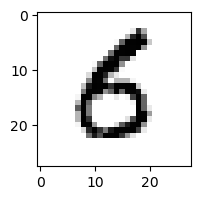

7.805050877938468% - 0
0.004544677204319963% - 1
0.031297881192365824% - 2
0.7005471598507984% - 3
0.5967417922991181% - 4
41.30465091150138% - 5 - ОШИБКА
33.8506519256937% - 6
0.00177039136134967% - 7
0.05574514872224349% - 8
0.6090221149015826% - 9

 2


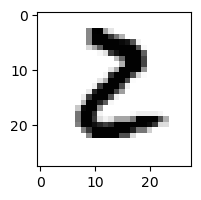

5.446909647600449% - 0
0.057736140343306416% - 1
43.96397850478677% - 2
54.57008321521333% - 3 - ОШИБКА
0.00014493226616193146% - 4
0.8073747762805296% - 5
0.1325037887796538% - 6
5.052686960212471e-05% - 7
0.19704550066325538% - 8
0.004725913547308175% - 9

 2


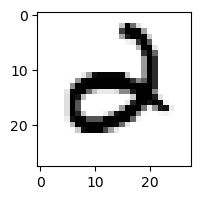

2.418926817501415% - 0
0.010560508238660922% - 1
0.0008309483244511205% - 2
0.08290578458206697% - 3
31.866790146054885% - 4
2.53758687410552% - 5
36.85487863481655% - 6 - ОШИБКА
0.02225691044320432% - 7
0.0008076139234697665% - 8
0.014294973720781735% - 9

 0


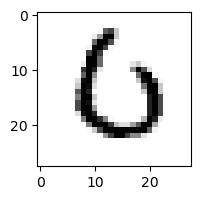

78.0066983635968% - 0
0.001259157260440995% - 1
5.200025451078037% - 2
0.27014426134977537% - 3
0.8983607944952751% - 4
0.5933357509378209% - 5
89.1341958902507% - 6 - ОШИБКА
0.18699849479181413% - 7
0.5725703372062716% - 8
0.09663406894832671% - 9

 4


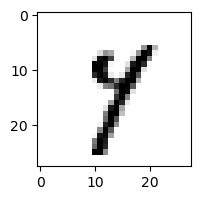

0.029627624049396156% - 0
7.477211508477823% - 1
0.06159051955376751% - 2
0.3115814328593618% - 3
20.041394293577216% - 4
9.37323509282669% - 5
0.1040995664356788% - 6
61.98082398684276% - 7 - ОШИБКА
25.516123295324906% - 8
2.111102043821927% - 9

 9


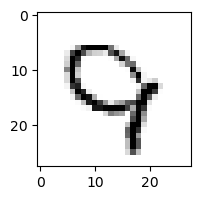

0.45108681161193287% - 0
0.09271488547093544% - 1
4.469965321185956% - 2
0.7958060009540068% - 3
59.247633782409345% - 4 - ОШИБКА
0.0457637742770417% - 5
4.484832127938395% - 6
10.857011035671654% - 7
0.09625799252185101% - 8
12.236741696892832% - 9

 2


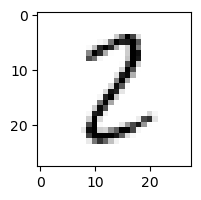

3.2652812027271763% - 0
13.566354757350338% - 1
38.39037920402077% - 2
39.16901618201462% - 3
0.0851984155646272% - 4
9.308909089639588% - 5
0.4927616844253967% - 6
0.18230412229655144% - 7
41.78936259066274% - 8 - ОШИБКА
0.04090909125818192% - 9

 7


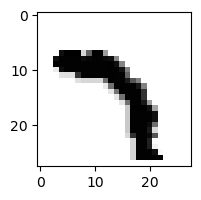

0.00022087957741322544% - 0
0.013555575233457953% - 1
0.0033633309773531722% - 2
1.2736604351647278% - 3
0.3779263352051685% - 4
30.459671077186613% - 5 - ОШИБКА
0.4504196760513179% - 6
14.34334253571605% - 7
0.3588858412474338% - 8
2.125730113974491% - 9

 2


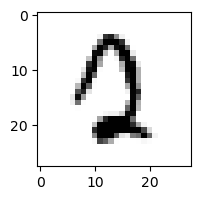

1.0049065911957433% - 0
0.004198549100453032% - 1
2.659204579529818% - 2
1.443354314620051% - 3
0.47569015407794124% - 4
4.429221546206818% - 5
1.782706561699184% - 6
7.045997870257074% - 7 - ОШИБКА
0.05355526815282617% - 8
0.08059187904015573% - 9

 3


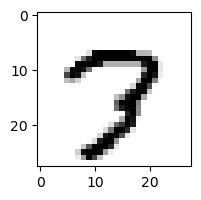

0.6438103868298491% - 0
0.0008237883062104038% - 1
0.08192974803186319% - 2
0.7357124038864862% - 3
0.0730118060786894% - 4
0.6005255996216157% - 5
0.010307590568355125% - 6
98.59719157254577% - 7 - ОШИБКА
8.605579918334529% - 8
19.248719955610486% - 9

 8


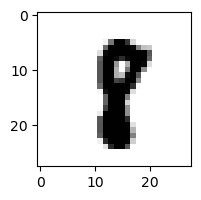

0.0010597840961678693% - 0
4.889666901504901% - 1 - ОШИБКА
0.012280887650634778% - 2
0.1219378438452862% - 3
0.027895772723074325% - 4
0.3483947467167243% - 5
0.0026581535741127317% - 6
0.5655272197284832% - 7
2.7066285873415965% - 8
0.041368723387241305% - 9

 9


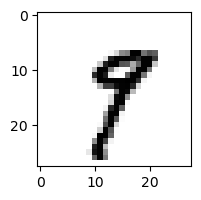

0.05517962636977946% - 0
6.836840648368985% - 1
0.009781532619632865% - 2
0.9882765916698044% - 3
1.6261463403425518% - 4
1.4246446485919413% - 5
0.019616731796394136% - 6
58.29382863131536% - 7 - ОШИБКА
7.522139517934943% - 8
10.68712436446518% - 9

 2


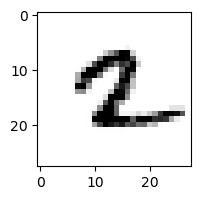

0.006064004166064047% - 0
6.6219819545617% - 1
0.6698020032454194% - 2
0.0016751144372869932% - 3
0.03195593508766441% - 4
0.9221752216102334% - 5
5.079321902392541% - 6
3.676936643349602% - 7
0.4819030703909638% - 8
26.103023999252787% - 9 - ОШИБКА

 9


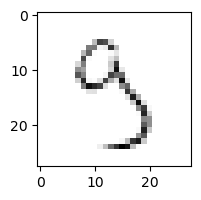

2.288601993648611% - 0
4.672721796253416% - 1
1.0111851938384364% - 2
67.58304472948407% - 3 - ОШИБКА
28.271833929992063% - 4
43.84792529604527% - 5
14.66764267674418% - 6
10.24530431362055% - 7
15.694201188501195% - 8
39.40299842386901% - 9

 7


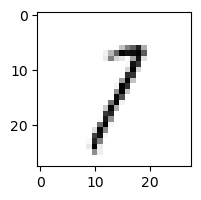

3.798623503520626% - 0
52.35300600168641% - 1 - ОШИБКА
24.486101101553015% - 2
28.654409851218027% - 3
5.6834733322289495% - 4
3.986397969717468% - 5
2.5916938807963663% - 6
47.863281946449135% - 7
28.010373130133388% - 8
52.06691191096313% - 9

 8


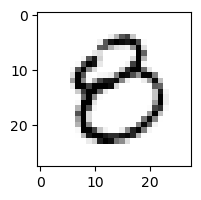

87.99462486147127% - 0 - ОШИБКА
0.02043659196645054% - 1
0.06297717310257507% - 2
2.7896888765463483% - 3
3.4118135228226354% - 4
11.1602338058126% - 5
0.11519101103048954% - 6
0.008023507218245456% - 7
2.469035984081823% - 8
0.022303404184257622% - 9

 7


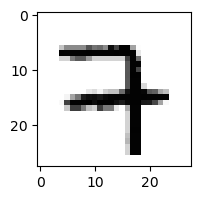

0.019264389254135664% - 0
0.005042868069661789% - 1
6.881623706972387% - 2
20.263942348531174% - 3
59.05540505533009% - 4 - ОШИБКА
0.0009010546055668078% - 5
0.24773983210253847% - 6
1.5894437263276586% - 7
0.00969321644962867% - 8
6.232513790595804% - 9

 2


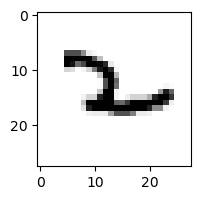

0.05734220323543757% - 0
0.7246364503884208% - 1
2.3445097239650208% - 2
0.3027673302320752% - 3
81.98321412143682% - 4 - ОШИБКА
2.149681865553011% - 5
39.348039836184796% - 6
2.888237588456685% - 7
49.78428971245393% - 8
1.2053304154029385% - 9

 3


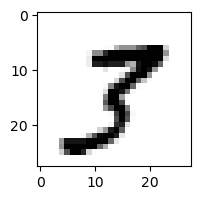

0.06790628049236228% - 0
1.983517963975098% - 1
0.1046998121044864% - 2
6.484283838207737% - 3
0.11601576207798572% - 4
0.592216287547081% - 5
7.136309057636679e-05% - 6
43.11975866113099% - 7 - ОШИБКА
16.944226895648367% - 8
1.578445331029888% - 9

 8


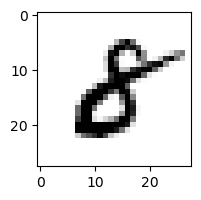

2.559326917328226% - 0
0.06328850517787775% - 1
2.2288334308455537% - 2
8.112583936116827% - 3 - ОШИБКА
0.06752204299281134% - 4
2.045582993015588% - 5
0.28918329194113246% - 6
0.0035749690555955714% - 7
1.8306326096366157% - 8
0.0706744795659056% - 9

 7


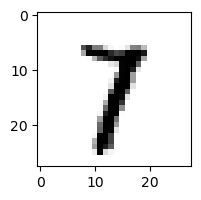

0.011101694323707102% - 0
45.64068521766526% - 1 - ОШИБКА
1.455038172694612% - 2
4.415107887834241% - 3
0.06222539727518897% - 4
0.3865755419550422% - 5
0.01701609838178247% - 6
39.1536691788929% - 7
0.591909503526364% - 8
2.7037975299627393% - 9

 7


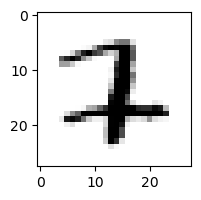

0.0006878214527814731% - 0
5.543641898320824% - 1
14.642952265203013% - 2 - ОШИБКА
1.1329228161413496% - 3
0.0231354357755924% - 4
0.008352404793561025% - 5
0.28780422030195557% - 6
0.6931385096998456% - 7
0.10259785031845521% - 8
0.017166649438661103% - 9

 8


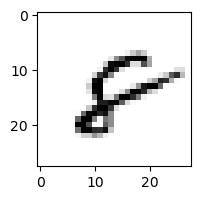

10.243576828368798% - 0
0.9957227524382625% - 1
1.6598097124969589% - 2
0.02264679515861539% - 3
4.173142660343885% - 4
2.6420358770453416% - 5
24.452930706199407% - 6 - ОШИБКА
2.5711064054919333% - 7
9.662108550810196% - 8
4.838805594352044% - 9

 7


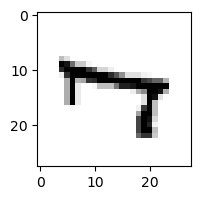

2.0588550831604975% - 0
0.5105595611069619% - 1
0.0007034278790020199% - 2
2.7883422281373265% - 3
46.31707777688933% - 4
5.092356937617815% - 5
72.97658110268884% - 6 - ОШИБКА
1.3008613454606137% - 7
11.47312660448739% - 8
57.79160860758273% - 9

 1


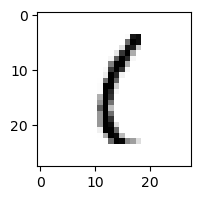

3.521993269584566% - 0
61.78486654377339% - 1
3.140741772167885% - 2
7.386185456933893% - 3
0.31420847603874086% - 4
23.453465350905706% - 5
30.726567275915823% - 6
0.8282291967883292% - 7
64.78209513365425% - 8 - ОШИБКА
3.488303010351773% - 9

 8


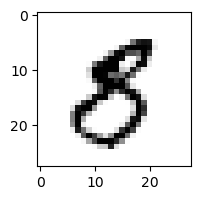

3.048469997098441% - 0
0.03479079843020245% - 1
0.006949487208256441% - 2
3.072332517466193% - 3
0.5257330052381892% - 4
15.395568750684191% - 5 - ОШИБКА
0.014673549049888584% - 6
0.02565809803584227% - 7
2.753562502006836% - 8
0.41566154941745603% - 9

 8


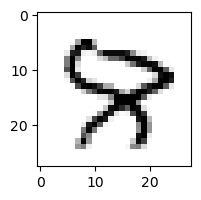

0.16249612726341242% - 0
0.0135684084059233% - 1
0.2585619234962405% - 2
0.42814214698413017% - 3
1.087438456812999% - 4
0.06563176539254321% - 5
0.15119715393354125% - 6
0.4990822375032236% - 7
0.10706305019241665% - 8
3.437647671821715% - 9 - ОШИБКА

 2


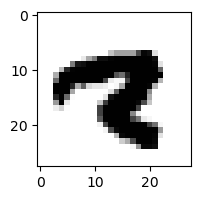

4.248633934888814e-05% - 0
0.0010916675583739553% - 1
9.892659509410001e-06% - 2
2.802794463861302e-06% - 3
0.5960654580740251% - 4
0.005405483300086654% - 5
0.0008374675090624283% - 6
29.91772766018515% - 7 - ОШИБКА
0.006165155996168124% - 8
0.61674455137026% - 9

 6


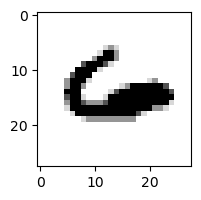

0.06107635913704055% - 0
0.014805349075557785% - 1
0.04733408250547455% - 2
9.030012909053223e-06% - 3
90.83190625586187% - 4 - ОШИБКА
0.00038003104241364537% - 5
83.65561451708221% - 6
1.4632827927031873% - 7
0.02911677093101172% - 8
25.457088040483995% - 9

 8


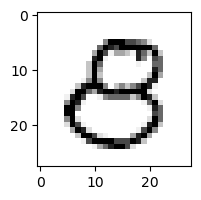

19.878782145592904% - 0
0.005211268447161455% - 1
0.26953804814980975% - 2
1.6005425770953905% - 3
23.528084397228294% - 4 - ОШИБКА
16.482297291614252% - 5
0.0055097996583500924% - 6
0.008416431943569308% - 7
5.335731124181647% - 8
0.20138735637201943% - 9

 8


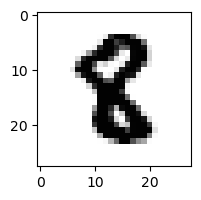

0.0002168921842206714% - 0
0.021316156607417844% - 1
0.051637093448350116% - 2
0.004462535398748754% - 3
0.025665181290131515% - 4
3.597157471230751% - 5 - ОШИБКА
0.014441774715832315% - 6
0.0007047939842642304% - 7
1.1801217862464128% - 8
0.00030648964219306507% - 9

 3


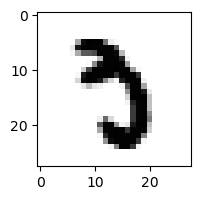

0.009069638301286752% - 0
0.001675117214366758% - 1
0.0017390076989203666% - 2
4.4825314839130135% - 3
0.08816745555491191% - 4
8.729360346774987% - 5
0.1432962310719832% - 6
19.15685154782139% - 7 - ОШИБКА
0.020076948790792394% - 8
0.05982104047735432% - 9

 2


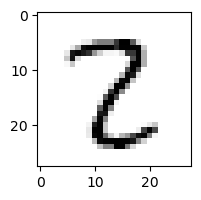

0.23395539101778287% - 0
9.40343578164511% - 1
26.75802143934755% - 2
27.574560439924085% - 3
0.3368980230984803% - 4
1.336029076849898% - 5
0.005677373908384829% - 6
0.42247897172960425% - 7
71.28941321114574% - 8 - ОШИБКА
0.028123880983532672% - 9

 2


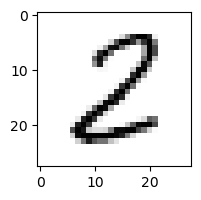

1.0931330036114697% - 0
2.3750841531736686% - 1
55.69039959300963% - 2
2.8643637110733398% - 3
0.19990560399013244% - 4
5.465410057248861% - 5
0.2999782073538542% - 6
0.06508334690812216% - 7
84.90993015225104% - 8 - ОШИБКА
0.005396257920961616% - 9

 5


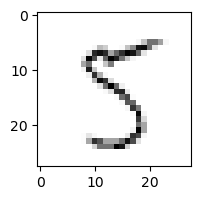

5.635730228161997% - 0
1.2773836898725224% - 1
1.0532366780473854% - 2
27.370248283711305% - 3
3.506196385454769% - 4
80.76429237062854% - 5
1.0672233966415114% - 6
7.597235409326947% - 7
90.00803798611872% - 8 - ОШИБКА
47.74317234156344% - 9

 8


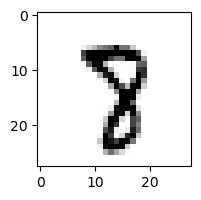

0.013638358318191712% - 0
0.03046075664152716% - 1
0.14406007385271688% - 2
0.9421503482615982% - 3
0.12400310205258958% - 4
2.6613820163832744% - 5
0.011497834197664787% - 6
42.71405898673838% - 7 - ОШИБКА
6.639794555340483% - 8
3.9255418717082735% - 9

 6


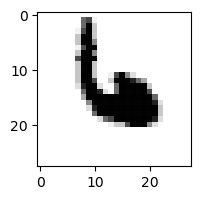

5.318693093998759e-06% - 0
0.005618814321693782% - 1
0.28589250072642186% - 2
0.015059058967892256% - 3
86.7690054066708% - 4 - ОШИБКА
0.06448511151062906% - 5
50.15952621389664% - 6
0.047380924191668984% - 7
0.004168163645238617% - 8
0.6587899004549501% - 9

 5


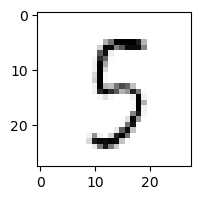

9.57261447501223% - 0
0.4494370441835262% - 1
4.311967017549264% - 2
35.19396451558553% - 3
26.430565112564704% - 4
69.94573569190344% - 5
4.190592570979428% - 6
0.9347545357997024% - 7
80.06364789579389% - 8 - ОШИБКА
1.4181129371296846% - 9

 1


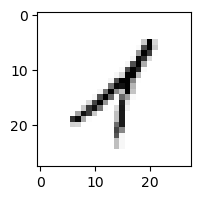

0.5328641092188675% - 0
44.428773744283994% - 1
16.787090899457258% - 2
15.12138979736674% - 3
65.98893553293256% - 4 - ОШИБКА
0.7378882621593985% - 5
1.861604260584523% - 6
2.2791393569525984% - 7
51.924997223455726% - 8
11.60276556752884% - 9

 5


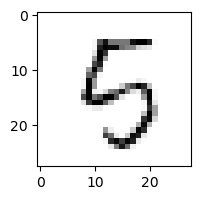

1.7864958063215242% - 0
0.27624955543446444% - 1
5.10105614677625% - 2
3.6997537410333736% - 3
46.261864003306954% - 4
37.109134768620244% - 5
10.588491677870444% - 6
0.051421658194839764% - 7
47.36101078138284% - 8 - ОШИБКА
3.8018416834212316% - 9

 8


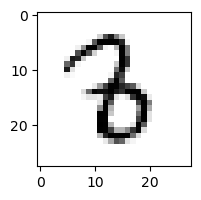

0.006630980895905124% - 0
1.5437543715512607% - 1
2.552515767813609% - 2
48.16177436710825% - 3 - ОШИБКА
0.25971515902731646% - 4
0.9310669694758817% - 5
4.049075270563012% - 6
0.023833362477522584% - 7
0.2541133974885031% - 8
0.03496354787580508% - 9

 5


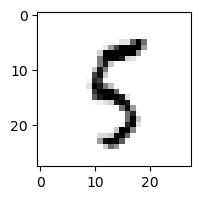

2.9822605566088893% - 0
0.2668872683570155% - 1
1.8232795400922055% - 2
3.080829670260888% - 3
6.247664852012242% - 4
64.20011109158993% - 5
1.6796441348217894% - 6
0.17308822373014576% - 7
72.40038070912725% - 8 - ОШИБКА
45.014561158181145% - 9

 8


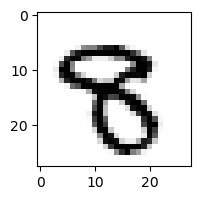

0.02083755992559542% - 0
0.001990323998646287% - 1
0.012581330448754351% - 2
5.527193065500175% - 3
0.05235302456736489% - 4
0.2650679571906076% - 5
0.005131460147210186% - 6
0.06137453341990331% - 7
2.3141766144466693% - 8
28.98905822788495% - 9 - ОШИБКА

 7


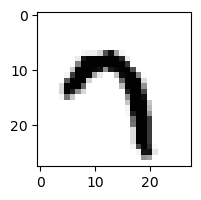

0.048696286087397754% - 0
0.011369104268980643% - 1
0.007250554634291839% - 2
0.22876825197927866% - 3
2.1236360205885343% - 4
5.234207870955143% - 5
0.516575055779287% - 6
67.57458857819128% - 7
0.07098246977064618% - 8
84.33737970218571% - 9 - ОШИБКА

 3


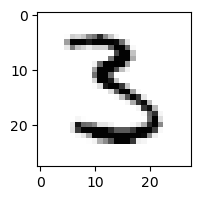

1.2416635532308586% - 0
0.12635456525008368% - 1
0.5627207354520775% - 2
58.98705676221193% - 3
0.006583969637152036% - 4
62.231723899955725% - 5 - ОШИБКА
0.09706093908312217% - 6
0.05236456672628501% - 7
1.395278310147377% - 8
0.0448221639117054% - 9

 8


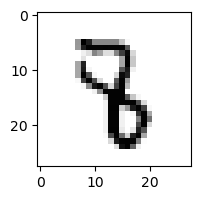

0.0004519756139949372% - 0
2.373937168979204% - 1
0.22146978290676073% - 2
3.4323406719252563% - 3
5.175820545309633% - 4 - ОШИБКА
1.4643858504290947% - 5
0.13300378887848385% - 6
0.0651496313735521% - 7
0.4341212657792353% - 8
0.7629487805019753% - 9

 9


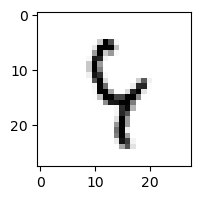

0.07891321329797138% - 0
0.40957578282560203% - 1
7.455042599430994% - 2
1.6220914006696112% - 3
82.39219150813409% - 4 - ОШИБКА
38.308960883497434% - 5
14.678828348936927% - 6
4.524904919924229% - 7
63.85838609653158% - 8
24.754201842714917% - 9

 7


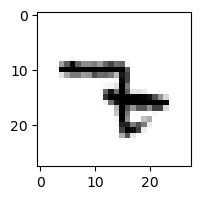

0.0022010625602098847% - 0
3.9889821932922764% - 1
0.05877403460954958% - 2
1.4137391852725925% - 3
41.250046767291856% - 4 - ОШИБКА
2.6504407948339317% - 5
10.321930959029041% - 6
24.139727167969763% - 7
0.20780116729222295% - 8
0.5298331738862245% - 9

 5


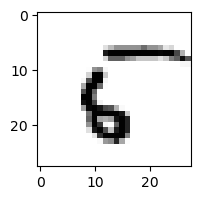

67.41943794215788% - 0 - ОШИБКА
0.1295523929338556% - 1
1.2052298706629763% - 2
0.0032019714877615443% - 3
3.88350725308393% - 4
59.46638478675943% - 5
8.653606807959056% - 6
0.15926559937058105% - 7
19.437123366695534% - 8
4.052825461423124% - 9

 5


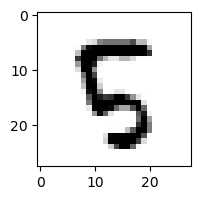

0.03214637975946568% - 0
0.003788302377854762% - 1
3.428384902944024% - 2
0.027306710397678135% - 3
9.233701767121435% - 4
7.2188764371007625% - 5
0.08225134318317762% - 6
0.020800159597576307% - 7
39.54174094010757% - 8 - ОШИБКА
1.1768577647850162% - 9

 2


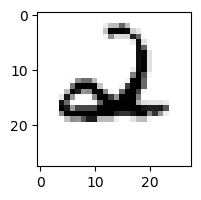

0.08410826764270166% - 0
0.02895342089894698% - 1
13.667407730531755% - 2
0.009851588075435567% - 3
92.21911340918228% - 4 - ОШИБКА
0.004855967384032357% - 5
20.792621118203822% - 6
0.08402207239755546% - 7
0.07906153822505638% - 8
5.799427251258895% - 9

 4


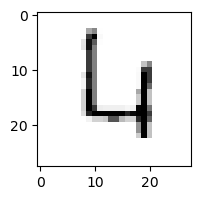

11.456049568922271% - 0
0.03165525929283486% - 1
44.96243818686293% - 2
0.378145923847145% - 3
39.415140848232646% - 4
1.4445806182477157% - 5
69.51356334512523% - 6 - ОШИБКА
3.4991704832454262% - 7
7.3208216924674785% - 8
38.53114596180105% - 9

 5


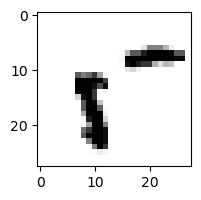

99.31210048924225% - 0 - ОШИБКА
0.04373762433715809% - 1
0.05777940673009639% - 2
0.0498172355617154% - 3
32.9925940437151% - 4
97.39011950703947% - 5
0.4454721530195962% - 6
0.3460159396012294% - 7
48.13121711339256% - 8
1.4259369488037734% - 9

 5


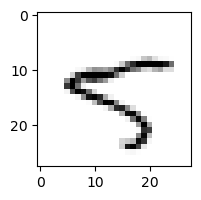

6.255358256454696% - 0
0.7692969271395166% - 1
0.026012138884824607% - 2
0.22312755021441272% - 3
70.36010161058196% - 4 - ОШИБКА
56.395548560108274% - 5
0.6692094438652322% - 6
3.426454774548795% - 7
23.03326908813928% - 8
36.50732794620754% - 9

 9


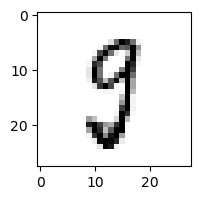

2.0248078871422264% - 0
0.29832084025968963% - 1
0.4642958859168443% - 2
11.476627069686492% - 3
0.802255008332236% - 4
44.71291821551563% - 5 - ОШИБКА
0.29958027973922247% - 6
7.577775042312193% - 7
38.0973494434226% - 8
0.2229728266571317% - 9

 5


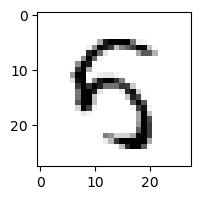

3.6096584018078497% - 0
0.019211327672436836% - 1
0.07660875301741443% - 2
2.755615334966965% - 3
90.02264502245195% - 4 - ОШИБКА
43.27354844283608% - 5
1.9979719808315162% - 6
0.007226939907559185% - 7
4.391231959788014% - 8
4.824205167146968% - 9

 8


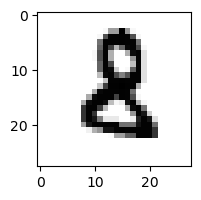

0.009516537906754503% - 0
0.025735680703132435% - 1
9.683349240816632% - 2 - ОШИБКА
2.4890690690005117% - 3
0.017171760272332415% - 4
0.14206490051176807% - 5
6.242515812170822% - 6
0.00013754411362107603% - 7
0.6663281622493317% - 8
0.01194578828280094% - 9

 8


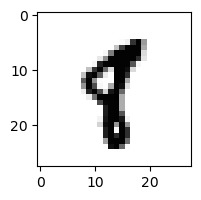

0.023804545153362115% - 0
24.280939106864743% - 1 - ОШИБКА
0.006788735847147074% - 2
0.0039897936789947555% - 3
0.21217693633275467% - 4
3.662757803764074% - 5
0.0652757827405963% - 6
0.44772687354664564% - 7
0.23465364642763034% - 8
2.5544800450570566% - 9

 5


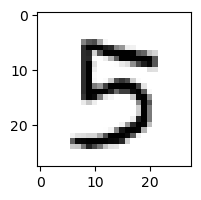

0.5533555264633218% - 0
0.003100158471181399% - 1
0.0056404580590183155% - 2
83.29205313267242% - 3 - ОШИБКА
0.8290052607995195% - 4
43.97144361093323% - 5
0.005819640473359401% - 6
0.09591868381785412% - 7
0.16657968612966612% - 8
3.270370282809011% - 9

 8


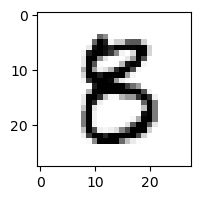

1.14155253736122% - 0
0.0032966418000757837% - 1
0.011778534058709201% - 2
23.112910571453295% - 3
0.3580371401016355% - 4
71.55167723150583% - 5 - ОШИБКА
0.013682480416136721% - 6
0.0020229796329380312% - 7
0.6664726731465824% - 8
0.0061154043638034904% - 9

 6


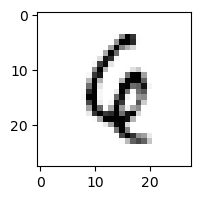

0.062394411794440496% - 0
0.5162100159399877% - 1
3.600538406506806% - 2
0.0036238941959890075% - 3
62.080266745358095% - 4 - ОШИБКА
0.2701658423544375% - 5
41.81747155250638% - 6
1.357986350062247% - 7
1.5731227196378035% - 8
9.90147072952526% - 9

 6


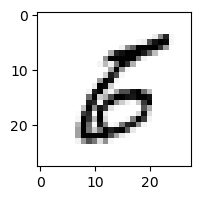

6.499171361605659% - 0
0.37793588250518234% - 1
0.511060140175379% - 2
2.259075502220526% - 3
0.1463732142801176% - 4
20.93819978353223% - 5 - ОШИБКА
4.729357272930559% - 6
0.030001785570540413% - 7
0.23821373427370976% - 8
0.1041282513304094% - 9

 4


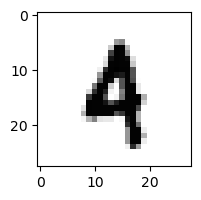

0.0025524596515430404% - 0
0.42763862213339426% - 1
0.37313267192941224% - 2
0.08662762236419912% - 3
19.039885815774298% - 4
0.03704748349413623% - 5
3.3530937473015796% - 6
0.11841451679063954% - 7
0.6661870298143131% - 8
23.897971863171424% - 9 - ОШИБКА

 1


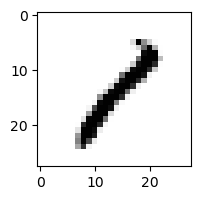

0.5610834368544249% - 0
70.98340770745027% - 1
18.648301891250615% - 2
3.967577167459873% - 3
3.773609386699767% - 4
0.4217827603961655% - 5
0.2601521737189317% - 6
0.7402922045846553% - 7
93.65463453114664% - 8 - ОШИБКА
0.9063730025622003% - 9

 5


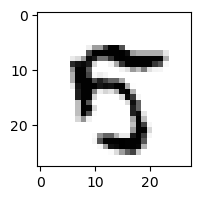

3.639965229625106% - 0
0.0006069707760480942% - 1
0.0005096504834704828% - 2
0.31350332215856413% - 3
1.8805233149730767% - 4
22.282700731447054% - 5
0.0005285077621326967% - 6
0.18133372958661234% - 7
8.926127469623774% - 8
38.051195180126825% - 9 - ОШИБКА

 7


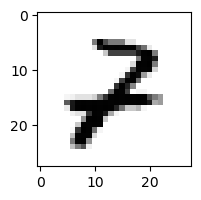

0.6676118494447083% - 0
1.0246176846033876% - 1
61.14623021770195% - 2 - ОШИБКА
1.749974813750296% - 3
4.035276499909604% - 4
0.0013161611435984083% - 5
0.04153245629475314% - 6
0.05718098607140295% - 7
1.9166418990014786% - 8
0.6038861324087392% - 9

 7


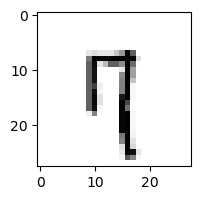

0.8929628977737051% - 0
0.589813599584233% - 1
0.8449729817705214% - 2
0.290757101102757% - 3
9.338699142957942% - 4
2.2392746442180567% - 5
2.545850742796931% - 6
37.72614724842162% - 7
4.520242740873604% - 8
78.69394332538057% - 9 - ОШИБКА

 5


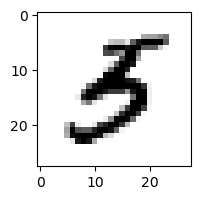

0.6964391975274505% - 0
0.316532672512804% - 1
0.014346193567827254% - 2
51.87768099572855% - 3 - ОШИБКА
0.9483364892930471% - 4
27.41871727272325% - 5
0.45506563299431313% - 6
0.013216988194321957% - 7
0.0002084345471579699% - 8
0.09609198860874006% - 9

 5


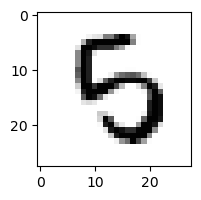

0.19508207530739105% - 0
0.016243947974584505% - 1
0.23071257506285703% - 2
20.902804099217825% - 3
3.538303551046478% - 4
6.317248160279931% - 5
23.000477998568456% - 6 - ОШИБКА
0.0012315981419320444% - 7
0.060285110842645255% - 8
0.01607885497660814% - 9

 5


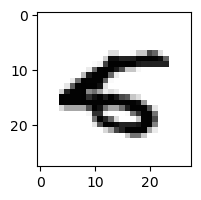

1.434647720052119% - 0
0.002842916146063336% - 1
0.003935955610102515% - 2
0.0006167056270839434% - 3
26.084677273910227% - 4 - ОШИБКА
0.8499131155602577% - 5
1.6438561799652904% - 6
0.0206621781828817% - 7
0.0025080840596695656% - 8
0.26874948890860145% - 9

 4


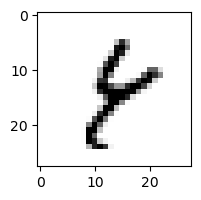

0.1827086516199956% - 0
9.109919056757263% - 1
1.2387156628370346% - 2
0.6499708994581349% - 3
1.0480909948738522% - 4
1.2184914049804672% - 5
20.30650751864716% - 6
0.6456158263478101% - 7
95.99781260662951% - 8 - ОШИБКА
72.75334533565692% - 9

 2


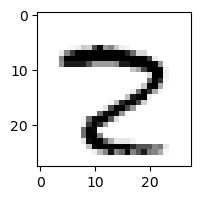

2.3163960897329474% - 0
0.005519182030466778% - 1
3.417224926486134% - 2
0.14325230659782173% - 3
0.0016677441886872812% - 4
0.10814857054453483% - 5
0.0006885766091691773% - 6
99.3967206656925% - 7 - ОШИБКА
2.3671218950488937% - 8
1.008915951230658% - 9

 4


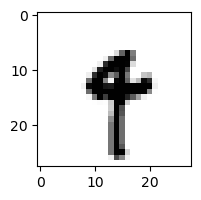

0.0021506909210235532% - 0
6.056227015919308% - 1
0.0004420507386758499% - 2
0.16383245812493322% - 3
11.121446706781425% - 4
1.2425384861181428% - 5
1.1404068046153855% - 6
3.427194363735263% - 7
0.2091953416864602% - 8
53.38738077150029% - 9 - ОШИБКА

 8


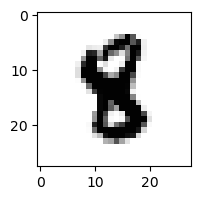

0.00014947737453198086% - 0
0.013079258585943455% - 1
0.0055409128502357866% - 2
0.025133530569329536% - 3
0.404690297608249% - 4
8.743070912592097% - 5 - ОШИБКА
0.4631359052424327% - 6
0.0016752887724701998% - 7
4.230810343674989% - 8
0.007372227985271777% - 9

 7


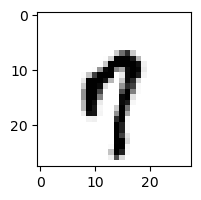

1.2267450220691196% - 0
0.14313723294913155% - 1
0.008774678022293222% - 2
0.15774875817680986% - 3
45.261385969412785% - 4 - ОШИБКА
0.4516966874221063% - 5
2.6683223955693656% - 6
24.838698832864097% - 7
0.4751855519227426% - 8
32.31028563194825% - 9

 5


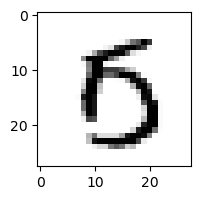

34.3187069984407% - 0 - ОШИБКА
0.0025951912263235707% - 1
0.0315775288368212% - 2
0.2354635004727183% - 3
2.717939663095853% - 4
28.16315401885099% - 5
0.42975111574376745% - 6
0.4039003600694457% - 7
5.995864015130362% - 8
6.244351744050882% - 9

 8


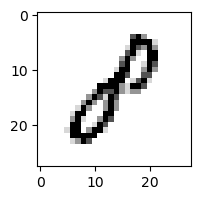

3.187320218494342% - 0
41.73489809201681% - 1 - ОШИБКА
6.476062749025299% - 2
5.58495713421477% - 3
1.8122397904912473% - 4
3.3872089013226923% - 5
0.1764238148346686% - 6
0.01766181617201668% - 7
5.060513110212967% - 8
0.5130119143123144% - 9

 2


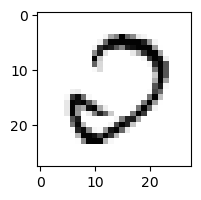

96.05547591206954% - 0 - ОШИБКА
0.050941706753034804% - 1
44.065060947167225% - 2
2.4463863482506265% - 3
1.0522041570061211% - 4
0.3751416820833623% - 5
3.460335273421326% - 6
0.0729615186785042% - 7
9.126367668890667% - 8
0.00046227539048486694% - 9

 8


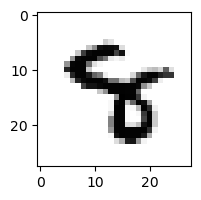

0.00046309884852725367% - 0
0.007280377397914271% - 1
0.002761170698739224% - 2
0.13586675217463104% - 3
9.197208202663415% - 4 - ОШИБКА
0.9474968675936356% - 5
1.610180075203278% - 6
0.22243200813290087% - 7
3.301790093255441% - 8
6.1988243331479005% - 9

 3


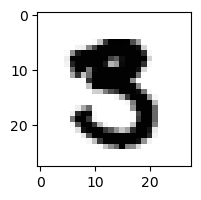

0.026634060533025593% - 0
4.805650941411119e-05% - 1
0.0005274472897438985% - 2
3.3589238522335862% - 3
0.0002822500556528794% - 4
36.04180241765012% - 5 - ОШИБКА
1.4924992497774714e-05% - 6
0.054272005051530375% - 7
0.10878149398600576% - 8
0.0001287815445950201% - 9

 8


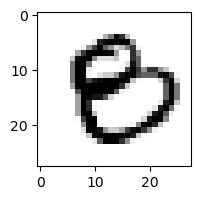

24.094021341241817% - 0 - ОШИБКА
0.0009340814420244799% - 1
0.015048555018330221% - 2
1.3524530237470709% - 3
0.08463079106290826% - 4
0.7788876884365818% - 5
0.027287590137675715% - 6
0.0002798547173896558% - 7
2.7956866267523597% - 8
0.005763576904056889% - 9

 3


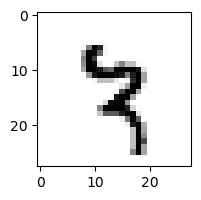

0.000917596363882418% - 0
1.353461342168203% - 1
0.6264566862926864% - 2
0.1410092232321883% - 3
35.34414645479117% - 4
1.3593198495615906% - 5
1.149654633611117% - 6
55.58977693927653% - 7 - ОШИБКА
18.526751359888653% - 8
3.0012213586600947% - 9

 2


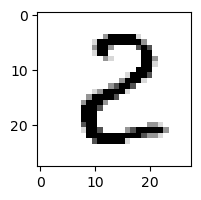

14.24061257356023% - 0
0.46321193652797515% - 1
80.58402519173593% - 2
5.784286191430331% - 3
1.0312424833391636% - 4
0.9074630335800877% - 5
0.0436868099952699% - 6
0.002121098775472723% - 7
94.9394225443992% - 8 - ОШИБКА
0.0158221263504595% - 9

 7


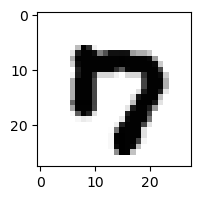

44.27801981911474% - 0 - ОШИБКА
3.1272077105439346e-06% - 1
4.058502295954526e-05% - 2
0.001628529503720503% - 3
0.1948314716632533% - 4
0.0023287041037980388% - 5
0.007223110812590542% - 6
23.686348589184373% - 7
0.0016241973761536488% - 8
0.5595307535493776% - 9

 6


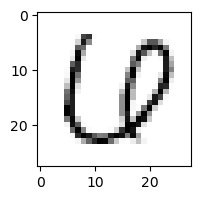

5.822226363012794% - 0
0.11385433478255877% - 1
0.255121023083505% - 2
25.314984055439755% - 3 - ОШИБКА
17.195795030367165% - 4
0.7704805685278817% - 5
0.07411434386041454% - 6
1.802712848642895% - 7
0.2535199034450263% - 8
0.0007770313450311168% - 9

 5


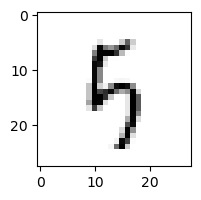

1.1298024781902176% - 0
0.11825308790391577% - 1
5.168619626015956% - 2
7.493135602521547% - 3
60.49980827872143% - 4
38.99436740813913% - 5
11.552435686141193% - 6
0.22705282194383786% - 7
47.44038814424281% - 8
67.6764470604397% - 9 - ОШИБКА

 9


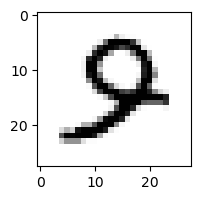

0.40097273077125223% - 0
0.006277486482793235% - 1
2.285912206679208% - 2
0.5285867729853548% - 3
4.390645238070818% - 4 - ОШИБКА
3.095092310584538% - 5
0.2676787882153214% - 6
0.6693181567243316% - 7
0.33708806959679544% - 8
0.053736257041741634% - 9

 4


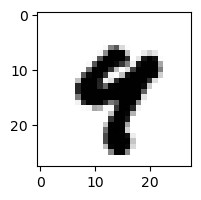

0.0010119456225633175% - 0
0.0014421654397157749% - 1
1.398815662950599e-05% - 2
0.0004214992473105905% - 3
22.40068156108883% - 4
0.018024323523274453% - 5
0.004471349445433218% - 6
0.5229487398117724% - 7
0.20498232312868583% - 8
51.99472801544845% - 9 - ОШИБКА

 5


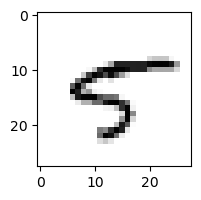

7.750874080704384% - 0
0.816325852369469% - 1
0.016083604303956604% - 2
0.23222678984030845% - 3
55.24982794590595% - 4 - ОШИБКА
16.19425177127868% - 5
0.9035331572189123% - 6
13.31745523188766% - 7
3.203352136998807% - 8
1.9041439743463797% - 9

 6


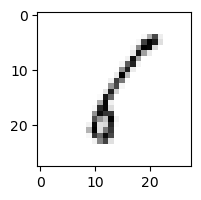

11.460058910265948% - 0
82.78642192784416% - 1 - ОШИБКА
18.246553039829408% - 2
6.323200181720081% - 3
5.252678491264205% - 4
26.545050562903416% - 5
8.652608047351194% - 6
3.057472831332124% - 7
51.48807027022391% - 8
2.502873373623634% - 9

 2


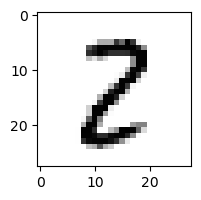

1.3368945194752664% - 0
3.0555862276138237% - 1
17.7529263028185% - 2
25.548483695264956% - 3
0.024341539562253472% - 4
0.9943146126800978% - 5
0.009023142699389102% - 6
0.09041544826864895% - 7
85.48294847507361% - 8 - ОШИБКА
0.1138169358140852% - 9

 8


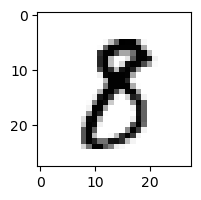

0.5914536213309168% - 0
1.1224823650458293% - 1
0.15365040969250954% - 2
30.401764903451255% - 3 - ОШИБКА
0.009395342701335622% - 4
3.9634639522581074% - 5
0.0028076820288170097% - 6
0.06227793894716951% - 7
13.274701810999446% - 8
0.08907939963607324% - 9

 8


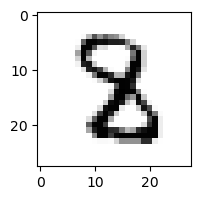

0.0007423954955011813% - 0
0.4386411334864039% - 1
2.032356330026274% - 2 - ОШИБКА
0.6864768642657603% - 3
0.6582779009361853% - 4
0.8508104203202675% - 5
0.09882094971215181% - 6
0.2736758810442289% - 7
0.5086675779189342% - 8
0.0004488475564205038% - 9

 8


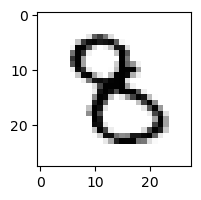

0.0362829675001899% - 0
0.24051002581764497% - 1
0.2553569793254628% - 2
17.076454494471392% - 3 - ОШИБКА
0.36747366477688126% - 4
2.2238875237398767% - 5
0.328077764548048% - 6
0.012598746314158662% - 7
4.500806764388536% - 8
0.3073464175219458% - 9

 1


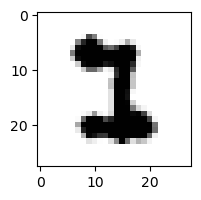

0.0003649269181420165% - 0
0.022922282035293375% - 1
5.690294648706588% - 2 - ОШИБКА
0.6606487886239137% - 3
1.6933532412051775e-05% - 4
1.0920918922649785% - 5
0.006219970585561329% - 6
0.2180888000573652% - 7
0.0064613513390273155% - 8
8.482357189560048e-05% - 9

 0


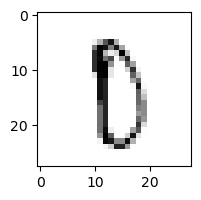

3.7037154229364164% - 0
0.03851845741226213% - 1
3.742977244368618% - 2
2.9978754210475063% - 3
1.6690905881727476% - 4
64.29082685309398% - 5
5.1936390405233475% - 6
7.457498667605737% - 7
91.44173439820689% - 8 - ОШИБКА
11.852613788899905% - 9

 2


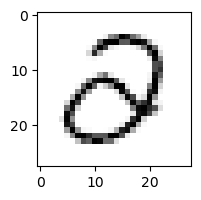

17.779011938502137% - 0
0.07735483490135761% - 1
0.17025797078437271% - 2
63.49700323633495% - 3 - ОШИБКА
32.684983033671536% - 4
3.7293025808873845% - 5
1.1299330969301575% - 6
0.02093220696938055% - 7
0.243727497842861% - 8
0.0007580320843175591% - 9

 9


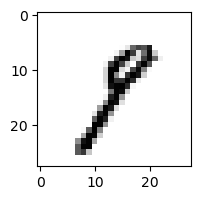

0.543108921214241% - 0
91.3669226131557% - 1 - ОШИБКА
0.5236583883954063% - 2
14.857576034078047% - 3
0.1350534344738751% - 4
1.4817874039727121% - 5
0.16878108220806454% - 6
9.76718104191606% - 7
15.439036594031224% - 8
3.3277666653126494% - 9

 2


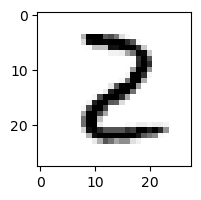

0.6933529092993815% - 0
0.8454626309217401% - 1
81.58440047152537% - 2
5.080686691091769% - 3
0.24114632489220977% - 4
0.0937410325913775% - 5
0.11622672887187564% - 6
0.006037248479366875% - 7
88.255224236952% - 8 - ОШИБКА
0.052949359196486245% - 9

 8


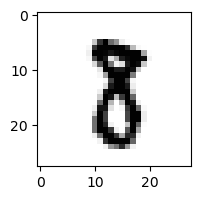

0.008267167913406932% - 0
0.9209066966953113% - 1
0.15769717216281665% - 2
16.066981451394486% - 3 - ОШИБКА
0.002379235692233461% - 4
0.6260909407109642% - 5
0.005580531835463993% - 6
0.3068823199935068% - 7
3.3005851527373746% - 8
0.1606451494570027% - 9

 6


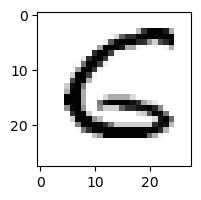

3.896014712788878% - 0
0.0029456499869678367% - 1
24.18278428140286% - 2
0.002377393221533759% - 3
1.1928164155292196% - 4
59.357619558710354% - 5 - ОШИБКА
15.560240576207446% - 6
0.0037759265052827616% - 7
0.056730467300883936% - 8
0.0008088964492435592% - 9

 5


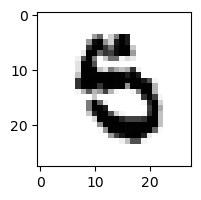

0.006812609818577244% - 0
0.00109868396920224% - 1
0.003418313016102008% - 2
0.04747593871358829% - 3
0.02346123968848035% - 4
2.8865130198009363% - 5
13.125104937774715% - 6 - ОШИБКА
0.0016932632256335374% - 7
0.08309047304732917% - 8
0.12946193766512906% - 9

 9


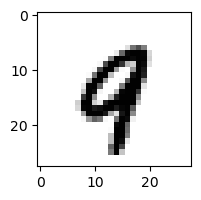

0.05783222670721125% - 0
0.0358894151629733% - 1
0.03087688855442331% - 2
0.0007555936748466448% - 3
46.53734578757287% - 4 - ОШИБКА
0.006334373281655825% - 5
0.6025914090575999% - 6
5.9460789738916136% - 7
0.24116568391921375% - 8
11.630491796944737% - 9

 8


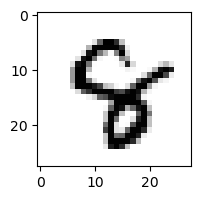

0.0022707922775615378% - 0
0.0037622574723388466% - 1
0.03367312741925513% - 2
0.04538852057389334% - 3
15.895773742855946% - 4 - ОШИБКА
0.3537176137261309% - 5
0.5646750995027037% - 6
0.13477856958532056% - 7
0.7852505426855996% - 8
0.8388403045011064% - 9

 1


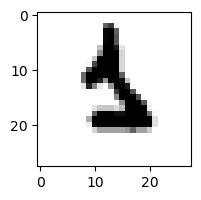

0.001256259833321981% - 0
0.062321327681525665% - 1
0.06380541641013558% - 2
0.0165870198030964% - 3
0.004654948797551089% - 4
4.244909720856498% - 5
44.290702323322556% - 6 - ОШИБКА
0.18750315130414497% - 7
0.02744990843850894% - 8
0.3278688807321347% - 9

 2


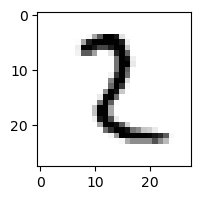

0.019762900202432824% - 0
57.48440448319763% - 1 - ОШИБКА
36.08282957956332% - 2
13.065148528457481% - 3
0.012327967652935097% - 4
0.4429042147266907% - 5
1.662484626572627% - 6
0.029275936225114225% - 7
1.1752457600481974% - 8
0.49935264918037775% - 9

 8


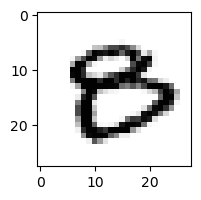

51.621123726300944% - 0 - ОШИБКА
0.00043021892692367796% - 1
0.001057395484203969% - 2
3.292924726314963% - 3
0.029897624664513286% - 4
0.7306709785124355% - 5
0.4553412139324802% - 6
0.0074854477427979925% - 7
0.15627202936822293% - 8
0.19855232460845346% - 9

 9


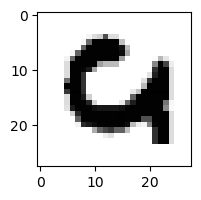

3.5621763651918785% - 0
2.7104970015993158e-06% - 1
6.583960710277173% - 2
3.2827476719703056e-05% - 3
0.0020550134260965687% - 4
0.00013898986699142202% - 5
40.140154722426495% - 6 - ОШИБКА
0.04659303538340882% - 7
0.0006219988280482266% - 8
0.0020202462783375412% - 9

 8


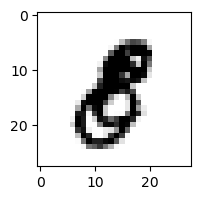

0.8088820661484796% - 0
0.05491499829016504% - 1
0.020404950715916748% - 2
1.5508096307202426% - 3 - ОШИБКА
0.011758598659590957% - 4
0.09563648703915466% - 5
0.018862848104970378% - 6
0.009527096666659646% - 7
0.3813503739624696% - 8
0.14542907673111874% - 9

 2


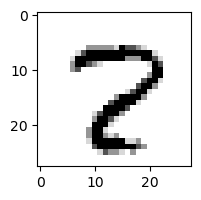

0.24944544269623536% - 0
0.0161028768626153% - 1
2.8179877995473226% - 2
0.021917216454840304% - 3
0.023296560617940266% - 4
0.3333048564740872% - 5
0.004840027099871432% - 6
91.69397002121119% - 7 - ОШИБКА
57.17210654836292% - 8
1.8711902266375442% - 9

 3


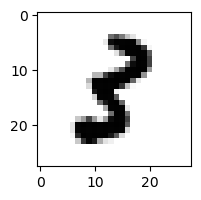

0.30018799478659264% - 0
3.5930722908797854% - 1
0.3216281123177635% - 2
5.214564286478817% - 3
0.07518563179002814% - 4
12.683197097409208% - 5 - ОШИБКА
0.007316463374410364% - 6
0.00508013780415257% - 7
0.8042950229755664% - 8
0.0008041189136460173% - 9

 7


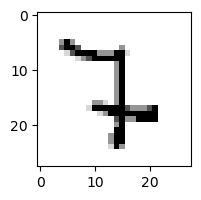

0.015141860508725027% - 0
6.909666435270677% - 1
13.680292414820089% - 2 - ОШИБКА
2.3323385045721032% - 3
0.2979995740839333% - 4
0.4512009748364087% - 5
3.278613059260635% - 6
9.941898459960772% - 7
2.9229989125920652% - 8
1.8425526777310761% - 9

 8


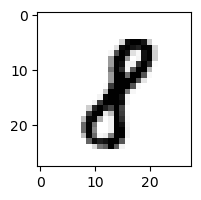

0.03465453645060784% - 0
65.50940774160642% - 1 - ОШИБКА
0.32301553956801893% - 2
0.22648220816120287% - 3
0.03873205201008428% - 4
0.03967421285735798% - 5
0.009696784564990901% - 6
0.2417954554918903% - 7
35.71751327620778% - 8
0.06423959464357899% - 9

 5


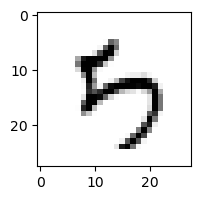

0.9417232691666058% - 0
0.08295595560516146% - 1
0.8576651172278114% - 2
2.177726814986765% - 3
28.553110940445634% - 4
5.522801074177165% - 5
20.049923439986593% - 6
0.06948576961614068% - 7
71.51849097845377% - 8
84.81921500440744% - 9 - ОШИБКА

 4


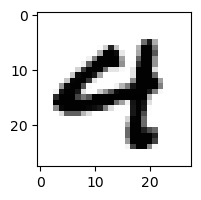

0.32185086287935105% - 0
0.00041030557619597475% - 1
0.0031837066530071953% - 2
0.00017111221078762695% - 3
68.12535361391653% - 4
0.003038467932820438% - 5
0.02526296376800464% - 6
0.03328419051174308% - 7
0.070012628443027% - 8
74.4173044679703% - 9 - ОШИБКА

 2


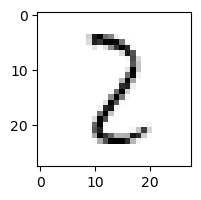

0.8454219460828888% - 0
36.95885157646608% - 1
53.30645897541804% - 2
16.37635665276351% - 3
2.4944598120159798% - 4
1.5150075940454506% - 5
1.3243841940128482% - 6
2.898562651398356% - 7
80.01416903845023% - 8 - ОШИБКА
1.1634617630845832% - 9

 9


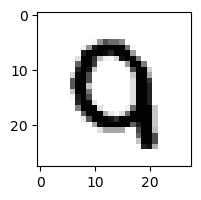

13.873673748363903% - 0 - ОШИБКА
2.8499443810311177e-05% - 1
3.4530672342192736% - 2
0.03515743758352567% - 3
0.04212692134055086% - 4
0.07582452120988811% - 5
8.208622604371149% - 6
0.41255201792312163% - 7
0.008073767877360052% - 8
7.29899347297948% - 9

 8


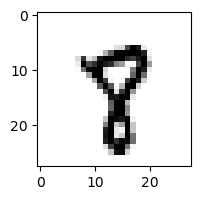

0.010817567657321931% - 0
0.12079023734323482% - 1
0.02948444511381467% - 2
0.015604298825140465% - 3
0.8316095750900128% - 4
2.4204024324507993% - 5
0.01504876364200629% - 6
32.74734645918108% - 7 - ОШИБКА
25.449165824916776% - 8
7.634459008373056% - 9

 9


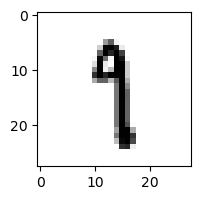

0.05583132102762475% - 0
40.26597420542616% - 1 - ОШИБКА
0.10250787081796044% - 2
3.014487321398214% - 3
0.989890506385672% - 4
11.662626790856146% - 5
0.9871062395801911% - 6
13.462133913380917% - 7
4.970469501319235% - 8
10.960242433385032% - 9

 8


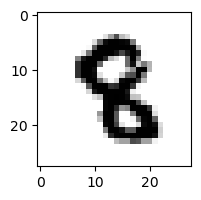

3.9941889757880474e-05% - 0
0.0021555193587840405% - 1
0.2164243273627319% - 2
0.033073095221253186% - 3
0.4943993009749911% - 4
1.001174977092257% - 5 - ОШИБКА
0.02181116769867564% - 6
0.004479934524185783% - 7
0.2930752733896618% - 8
0.13973752932091016% - 9

 8


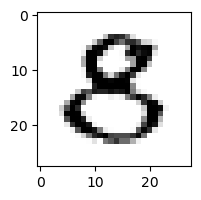

2.720728220533912% - 0
0.002023035100770761% - 1
0.1886616946629238% - 2
34.57857990345894% - 3
1.4703872832622664% - 4
52.75922321613062% - 5 - ОШИБКА
0.000512466548719503% - 6
0.0007196314455436976% - 7
0.03492760834266247% - 8
0.00026155564258861525% - 9

 4


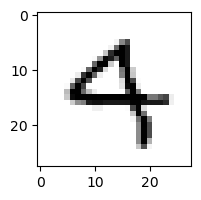

0.17739047586991194% - 0
0.024184126334892% - 1
0.21990896694025516% - 2
0.3632170377929495% - 3
61.06320861157045% - 4
0.21540776752593283% - 5
3.4108657744737916% - 6
0.43920385545479407% - 7
0.01953162162830531% - 8
90.28324011136296% - 9 - ОШИБКА

 8


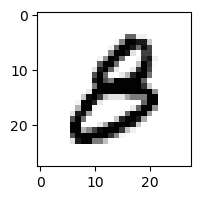

2.056959356100055% - 0
0.0012176897801559445% - 1
0.02823103249120953% - 2
12.111094255173859% - 3 - ОШИБКА
0.3338834590453982% - 4
1.1185412596612396% - 5
0.5665558261203796% - 6
0.002633199312690328% - 7
0.07960001141045643% - 8
0.09406133205314439% - 9

 2


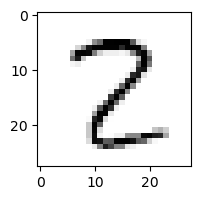

0.3902680735498818% - 0
5.50419935859363% - 1
61.877891738910385% - 2
9.528321522870845% - 3
1.6301703419647076% - 4
0.6579245024947379% - 5
0.02684864869750968% - 6
1.5670201780896342% - 7
91.9462331659197% - 8 - ОШИБКА
0.05285299001341108% - 9

 5


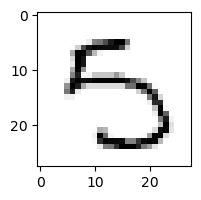

1.5344692767595773% - 0
0.28643207602704546% - 1
0.05443375008214981% - 2
12.239455018678553% - 3
20.082311069693954% - 4
40.092343679254384% - 5
0.5145787093425255% - 6
2.0338587087382813% - 7
56.614881808344855% - 8 - ОШИБКА
2.52136171827407% - 9

 9


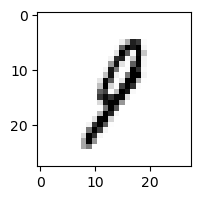

0.32547881950498764% - 0
42.10247965155934% - 1 - ОШИБКА
8.092137371802572% - 2
9.56102464809473% - 3
2.5511075910678858% - 4
2.5902860393621405% - 5
6.4745896953339415% - 6
2.994921071854879% - 7
39.91172129973313% - 8
6.546343659505648% - 9

 3


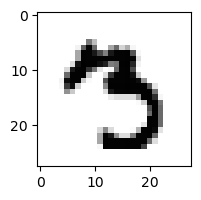

0.005431332294718509% - 0
0.03916401059067878% - 1
0.00029931156757389996% - 2
5.885173322681117% - 3
0.008980861614845856% - 4
3.985380748157715% - 5
0.0012534811057629818% - 6
9.724807637969766% - 7 - ОШИБКА
0.896315757316428% - 8
6.66952949912744% - 9

 9


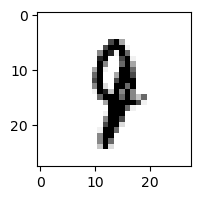

0.0010312047039615615% - 0
4.326558761429179% - 1
0.38239393093697555% - 2
0.5292909815001169% - 3
15.167275761161845% - 4 - ОШИБКА
1.0053189746648432% - 5
0.2613555072449131% - 6
3.087235515865988% - 7
1.0310327102403225% - 8
7.221619984224673% - 9

 6


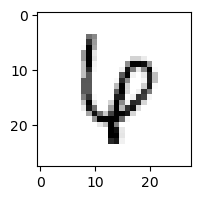

0.25910967909926247% - 0
1.4110176991875036% - 1
1.724644106844351% - 2
0.06359181336736912% - 3
59.0437569312978% - 4 - ОШИБКА
0.0992635038455909% - 5
4.302526789110242% - 6
38.68659776924391% - 7
1.2104244366324168% - 8
2.355073649219579% - 9

 8


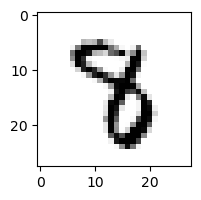

0.00021299520316357809% - 0
1.0571044205313067% - 1
0.04686414210305578% - 2
5.366363756782593% - 3 - ОШИБКА
2.0773282681460814% - 4
1.5160388800553797% - 5
0.02733094642967002% - 6
2.1394610719674625% - 7
0.26521451644580013% - 8
0.03342391168525054% - 9

 9


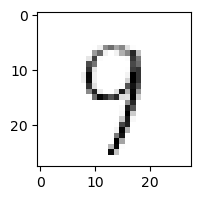

1.2755239468000819% - 0
0.35670324363070227% - 1
5.8591836578783% - 2
22.520349550495748% - 3
55.47431835583103% - 4 - ОШИБКА
8.224630111527762% - 5
5.022061038657087% - 6
33.484335510895136% - 7
19.035251667865353% - 8
51.74823851753043% - 9

 2


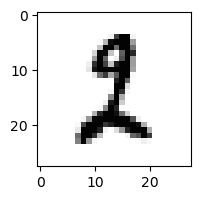

0.0533747518864937% - 0
27.97123781238968% - 1 - ОШИБКА
10.480223425314927% - 2
0.04680837200029215% - 3
0.00036512571868140865% - 4
5.175539797884868% - 5
0.3523157125624105% - 6
0.2857492571924491% - 7
0.09162533737820495% - 8
0.0033850330905000527% - 9

 9


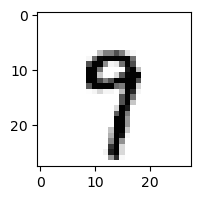

0.018597677933366794% - 0
0.34658150875726934% - 1
0.013125442732811712% - 2
0.6291776661232128% - 3
8.575159107905371% - 4
6.770661923999959% - 5
0.4700076111226999% - 6
47.85733348607135% - 7 - ОШИБКА
4.932352585279769% - 8
36.88317878532486% - 9

 0


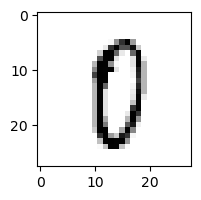

38.66141993013735% - 0
0.006350565695567963% - 1
0.8196469163363186% - 2
0.7634050672335191% - 3
1.5028898796184742% - 4
45.320201446784786% - 5
2.3198241137268885% - 6
4.1407226300017035% - 7
72.78071001592114% - 8 - ОШИБКА
2.500046624328918% - 9

 5


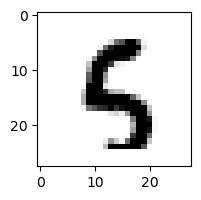

0.03545071803246955% - 0
0.0012696400507370446% - 1
1.3275650589730463% - 2
0.009263707981033495% - 3
14.235972338470534% - 4
9.901937683951942% - 5
0.4931235052918856% - 6
0.0033073123203502036% - 7
8.456794436094315% - 8
55.38586256965659% - 9 - ОШИБКА

 2


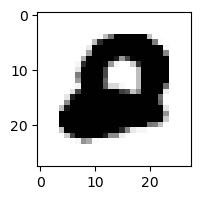

0.544897137930808% - 0 - ОШИБКА
1.5541216969449573e-08% - 1
0.08557585058300785% - 2
1.2380648200764305e-06% - 3
0.0016219489379496106% - 4
0.0024102925651932733% - 5
0.007302158180364356% - 6
1.4110724027442944e-06% - 7
7.910408420019253e-05% - 8
1.0398523893650176e-06% - 9

 2


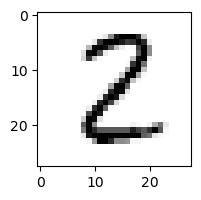

0.7087410946068167% - 0
6.664891918551266% - 1
46.6485696031648% - 2
6.57425084143044% - 3
0.23126678256110708% - 4
3.5661174083149643% - 5
0.031841915529524735% - 6
0.026080883246519006% - 7
54.73662367665506% - 8 - ОШИБКА
0.0008238061394158362% - 9

 2


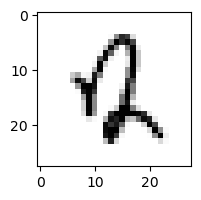

1.1073079375757802% - 0
0.012260309882176728% - 1
3.757073382662675% - 2
0.043019578338081337% - 3
19.817220027085447% - 4 - ОШИБКА
1.6345068179350621% - 5
9.387569241808032% - 6
0.762041980429056% - 7
0.19030720599199483% - 8
1.6674341913548631% - 9

 9


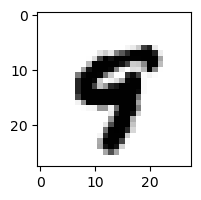

0.0013840982276220155% - 0
0.0020546316736523283% - 1
4.0756821295557524e-05% - 2
0.0003187662879133533% - 3
28.45637063381324% - 4 - ОШИБКА
0.8071259207334995% - 5
0.004836696766560488% - 6
0.3622441681032741% - 7
0.0648382692341136% - 8
3.687980616003895% - 9

 9


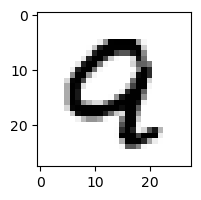

0.23988050688660534% - 0
0.0008003049570827192% - 1
3.4562407402560438% - 2
0.00011391370538647578% - 3
19.581378875421258% - 4 - ОШИБКА
0.0031035811176295673% - 5
0.07965057442858943% - 6
0.16452479160705552% - 7
1.756163058218918% - 8
6.463707284820022% - 9

 8


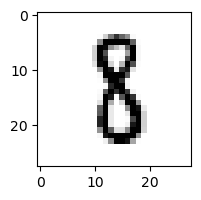

0.013778559526109676% - 0
4.711640417968651% - 1
0.8023702784742068% - 2
10.957801279218113% - 3 - ОШИБКА
0.1074680036617765% - 4
3.373338406159817% - 5
0.3510363171979446% - 6
0.09709149507381327% - 7
6.787716592537422% - 8
0.013379731674287902% - 9

 5


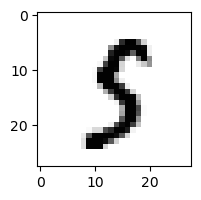

0.6088381302311427% - 0
0.3192793384266736% - 1
0.02222653552357756% - 2
34.28790365456786% - 3 - ОШИБКА
0.1414519455658305% - 4
27.418278516630973% - 5
0.17789420859443364% - 6
0.40033097330867834% - 7
8.376116673470804% - 8
0.3192999827895105% - 9

 3


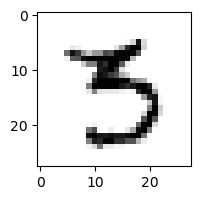

1.585757296850951% - 0
0.04489749687026272% - 1
0.0019239906099064567% - 2
28.532055158218554% - 3
0.05303617829844505% - 4
81.38304447982678% - 5 - ОШИБКА
0.04216938874981086% - 6
1.0019803607042599% - 7
6.078692693021826% - 8
1.4454571727210712% - 9

 6


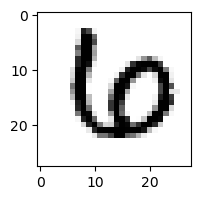

0.11710895367430772% - 0
0.032072466663658206% - 1
0.058315895315740614% - 2
0.03767451214559411% - 3
0.8885296438985563% - 4 - ОШИБКА
0.001409321028067504% - 5
0.8843829596546248% - 6
0.09069504503626788% - 7
0.09317842104300833% - 8
0.0005131264467671224% - 9

 9


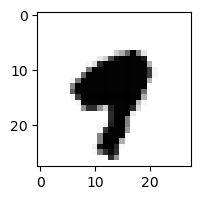

0.0003741352344705424% - 0
0.008820008064965362% - 1
9.773062911247906e-07% - 2
0.00032227807900952836% - 3
40.26493847407666% - 4 - ОШИБКА
0.01375315024789499% - 5
0.007044218954591744% - 6
0.444372344040085% - 7
0.002782026291814447% - 8
9.348723482078764% - 9

 5


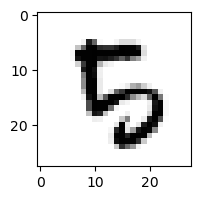

0.04187324160645238% - 0
0.0014288941116838666% - 1
0.7796394328202263% - 2
0.03461171570276627% - 3
0.8379258745178894% - 4
2.1006681502082802% - 5
0.8099626504102193% - 6
0.02964242956431606% - 7
2.255977651237341% - 8
4.722980063960764% - 9 - ОШИБКА

 5


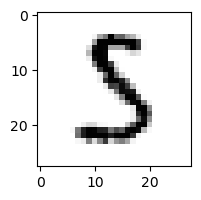

0.14854798762088994% - 0
0.21184279140766174% - 1
1.7910693448124448% - 2
70.34115034718099% - 3 - ОШИБКА
0.06279804510066068% - 4
45.02551678663892% - 5
0.4137323421634207% - 6
0.10003772894567377% - 7
1.5316926360054166% - 8
0.0013118205669892245% - 9

 3


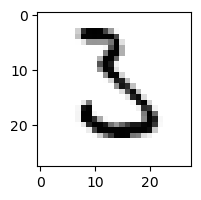

2.3286345092057297% - 0
0.17803995602005868% - 1
37.92997217692153% - 2
34.037671856277825% - 3
0.003777583117223938% - 4
6.296749354935914% - 5
42.61925812708074% - 6 - ОШИБКА
0.132261353835071% - 7
0.5464441371766682% - 8
0.1438893481629504% - 9

 9


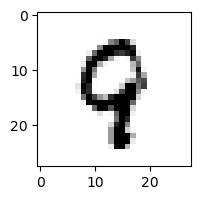

0.009373489708251477% - 0
0.04271945853972304% - 1
1.0306932832031868% - 2
0.006941258539199376% - 3
28.43880652111568% - 4 - ОШИБКА
0.2669746947556746% - 5
0.6096135043135766% - 6
1.0810060955491716% - 7
8.726015601932065% - 8
20.125683994054082% - 9

 5


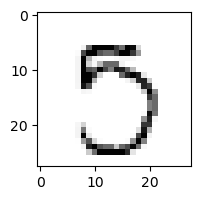

4.1177209725417985% - 0
0.06162411872819664% - 1
0.1627182720389976% - 2
23.002248818695126% - 3
0.08455013469320961% - 4
23.652129271128665% - 5
0.40788097409969826% - 6
71.37650013577948% - 7
5.135747891889695% - 8
77.71120794906888% - 9 - ОШИБКА

 7


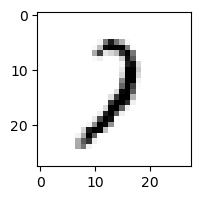

0.11786626429240694% - 0
42.4648384297301% - 1
50.87149899800004% - 2 - ОШИБКА
12.04692000710995% - 3
2.6110716848598736% - 4
0.4983234741702672% - 5
1.561744353393332% - 6
33.51989047760088% - 7
2.506284372664259% - 8
4.749449854217867% - 9

 9


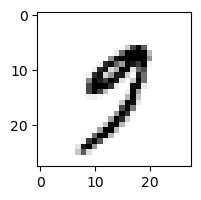

7.253088988624076% - 0
0.09241101978506056% - 1
0.008322439130917802% - 2
10.694578538257055% - 3
4.245016603155608% - 4
17.060013871561143% - 5
0.04215841226230391% - 6
26.02224613444335% - 7 - ОШИБКА
0.10718370268985472% - 8
15.602386475521621% - 9

 8


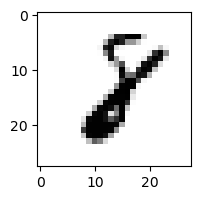

0.014563943325664047% - 0
20.292017339982202% - 1
35.49579225307261% - 2 - ОШИБКА
0.1112613543330753% - 3
0.1375063974460933% - 4
0.07132493463918856% - 5
0.7758490558854032% - 6
0.7929226006164777% - 7
14.292434515851843% - 8
0.009020961668513565% - 9

 7


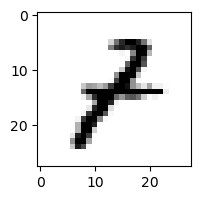

0.9118558693731118% - 0
16.686236402133172% - 1 - ОШИБКА
3.6996215654137727% - 2
8.735938975288809% - 3
6.866046669948054% - 4
0.36905119216802473% - 5
0.6226522136684393% - 6
0.012545426710217985% - 7
3.952853548285298% - 8
1.1027259216241854% - 9

 2


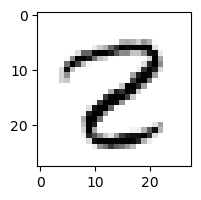

0.27448594409987354% - 0
0.460846190097953% - 1
13.951043635847629% - 2
0.30770864510927065% - 3
0.5236745837586501% - 4
0.31483418757347265% - 5
0.01247675818153934% - 6
0.9999220067400708% - 7
99.90291159959175% - 8 - ОШИБКА
0.5141101431022502% - 9

 5


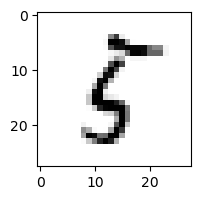

5.368299916355878% - 0
3.05255756575737% - 1
4.359596337516518% - 2
0.6900151328060808% - 3
11.765325703020014% - 4
31.535257314115217% - 5
1.646964963885717% - 6
0.191650061793018% - 7
35.20063185317961% - 8 - ОШИБКА
0.42530542264463644% - 9

 0


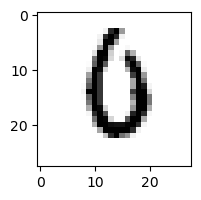

5.526476500565995% - 0
0.00046625262955041566% - 1
1.3753067006183397% - 2
0.12088078760664979% - 3
1.2775460783037962% - 4
1.6133020571271885% - 5
59.98377226197681% - 6 - ОШИБКА
2.268720513871529% - 7
0.06349625761836421% - 8
0.600318874653579% - 9

 2


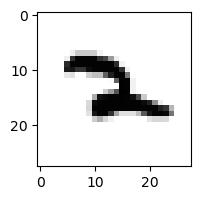

0.0001922368705433115% - 0
2.041787948193838% - 1
1.4978626889793163% - 2
0.011549966339555424% - 3
11.434132050455153% - 4
0.2571624936753541% - 5
8.501910522071386% - 6
18.33847677482617% - 7 - ОШИБКА
8.017185403654144% - 8
1.0602642114544736% - 9

 9


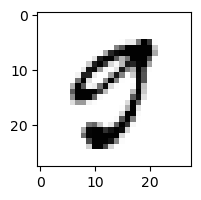

83.81372023784606% - 0 - ОШИБКА
0.002558642312195384% - 1
0.004752303211479891% - 2
1.0179432416946397% - 3
0.36152592841788456% - 4
28.875079650987423% - 5
0.0048205767859383% - 6
1.6633596668368982% - 7
0.05737748362042893% - 8
1.4475675815687534% - 9

 6


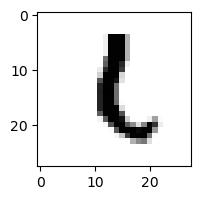

0.010603954399087873% - 0
33.85226762107875% - 1 - ОШИБКА
4.815057896194391% - 2
0.39119295568025075% - 3
0.046073406007907304% - 4
7.479184700413868% - 5
6.243296748358456% - 6
0.007819610918067233% - 7
2.999382468199953% - 8
1.9639589478498896% - 9

 5


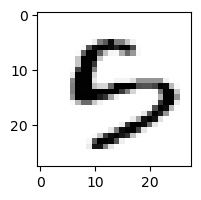

3.342695148072785% - 0
0.0025471127696221896% - 1
0.011288907317039278% - 2
1.6167114642395164% - 3
4.993225552654835% - 4
2.6364919927821293% - 5
11.220440903535112% - 6 - ОШИБКА
0.003186397735803894% - 7
3.5625169938113324% - 8
2.0291171881197205% - 9

 5


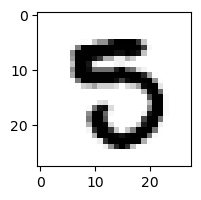

0.6447502683658278% - 0
0.0009853533016480481% - 1
0.0034297772215076336% - 2
0.18285176046025015% - 3
0.0011231472851862855% - 4
2.5600838977847875% - 5
0.10665281316566877% - 6
0.12912154291173822% - 7
25.875413176574597% - 8 - ОШИБКА
0.003163816597435643% - 9

 7


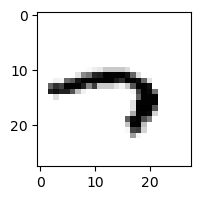

1.485167339809247% - 0
0.4523734266776462% - 1
0.0008125538057763986% - 2
37.94864126065129% - 3
82.14576828698777% - 4 - ОШИБКА
34.444001753873515% - 5
62.90667101053943% - 6
4.658596538419022% - 7
0.2551408794553094% - 8
35.10803708746933% - 9

 5


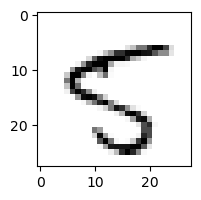

7.572873898803367% - 0
0.04679092788271883% - 1
0.25907964018864066% - 2
0.008682949184627977% - 3
1.620304224240754% - 4
71.77525179878533% - 5
0.12478054637983728% - 6
2.2977057298139965% - 7
33.15086243619632% - 8
86.169829248375% - 9 - ОШИБКА

 9


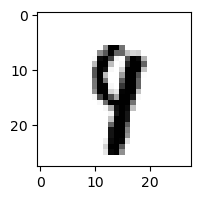

0.0017114276482732974% - 0
0.1011031183006789% - 1
0.058520004010230456% - 2
0.32233063605172235% - 3
24.465813953244222% - 4
0.9947587333085055% - 5
0.054854364295286395% - 6
25.918507460162854% - 7 - ОШИБКА
2.14399103661361% - 8
8.945765868121182% - 9

 7


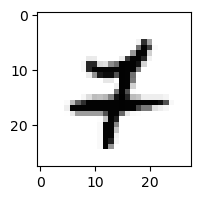

0.017001765670098527% - 0
2.364485130169229% - 1
0.12571289806827768% - 2
0.004372891978687876% - 3
54.97264315823433% - 4 - ОШИБКА
0.014331229395280382% - 5
0.2926116179512482% - 6
20.15490690541905% - 7
0.10924238350317053% - 8
0.05976254492650495% - 9

 9


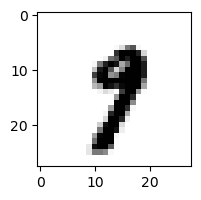

0.009878387033669195% - 0
0.583134594517538% - 1
0.0014896226191804978% - 2
1.0753654503929388% - 3
0.7598201742310793% - 4
0.3759734248937114% - 5
0.014111629830298986% - 6
60.77169217403872% - 7 - ОШИБКА
0.3953118677370664% - 8
5.957914799101211% - 9

 5


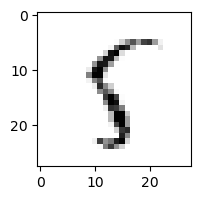

0.8198610967376379% - 0
6.562225594913958% - 1
3.1757844082130857% - 2
0.07478749825699829% - 3
23.614453149888558% - 4
64.9818745405646% - 5
5.721730852692197% - 6
3.357954748063321% - 7
84.43132972222567% - 8 - ОШИБКА
10.259975094985482% - 9

 6


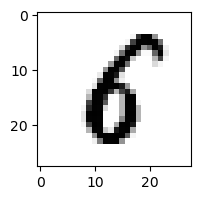

2.7151141770364955% - 0
0.30212676325983256% - 1
0.07049040814611732% - 2
0.3311841711105478% - 3
0.9338323350253805% - 4
27.715050466282896% - 5 - ОШИБКА
15.492138343505827% - 6
0.002222265443008669% - 7
17.732868550684476% - 8
0.017408193749259015% - 9

 8


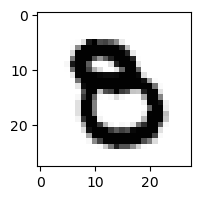

0.12648637771712443% - 0
6.959576528464418e-05% - 1
0.00021442308163554394% - 2
0.7690428944290693% - 3
0.004513171611957836% - 4
3.355973081877074% - 5 - ОШИБКА
0.005985912589485634% - 6
0.002293238195233129% - 7
0.06754249461663321% - 8
0.007230228959476423% - 9

 9


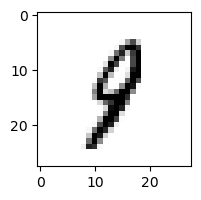

0.0777871274975418% - 0
5.520152254522868% - 1
2.5065890451918653% - 2
1.2490965781718344% - 3
12.494233525207814% - 4 - ОШИБКА
1.52915674707348% - 5
2.8374682363130272% - 6
6.292055010851594% - 7
6.272544936570609% - 8
5.965383874545016% - 9

 3


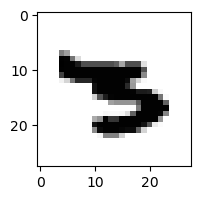

0.0002787840774784468% - 0
0.010028850057363852% - 1
1.9669500881401453e-05% - 2
0.6698207455792069% - 3
0.512326172077488% - 4
3.6669290542738278% - 5
16.761308413653968% - 6 - ОШИБКА
0.22030534018483072% - 7
0.001858751284069578% - 8
0.0019299404662541648% - 9

 4


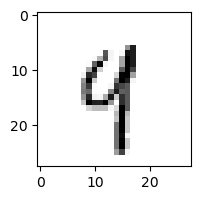

0.09318674761750194% - 0
15.262992762656912% - 1
0.2265413127982104% - 2
0.42845256239224955% - 3
32.94543452705435% - 4
1.3758969555389549% - 5
1.123925883518189% - 6
6.944609231142242% - 7
5.745860078499396% - 8
43.733239223333925% - 9 - ОШИБКА

 2


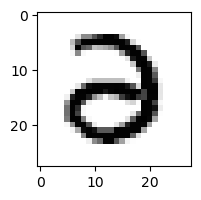

6.9457995208946794% - 0
0.00022680309716795985% - 1
0.5191160952345262% - 2
85.78372700742379% - 3 - ОШИБКА
0.7393207057076828% - 4
0.03597922001325517% - 5
0.03409345309323449% - 6
7.948957950713134e-05% - 7
0.0006973407700501991% - 8
0.001436333730041684% - 9

 5


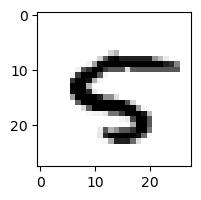

1.2799621698146757% - 0
0.008516140958122777% - 1
0.005766046195186931% - 2
0.00011627294237727874% - 3
18.142125956652798% - 4 - ОШИБКА
1.7226879591809126% - 5
0.017768228032912527% - 6
0.5634680950397825% - 7
0.6221626595414472% - 8
1.7435166996850253% - 9

 9


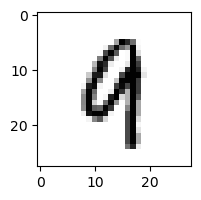

0.05459495021390219% - 0
0.28223028570737685% - 1
0.48126154486903366% - 2
0.024086405336104472% - 3
39.4875263615319% - 4 - ОШИБКА
0.05348376696122239% - 5
0.7933342319044547% - 6
0.32917784234800584% - 7
2.9058011136998565% - 8
28.00608119454625% - 9

 5


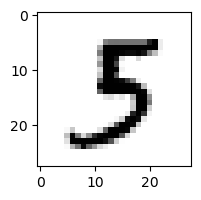

0.32063396802827243% - 0
0.28217152878626395% - 1
0.004996043570780592% - 2
90.03240721508202% - 3 - ОШИБКА
0.07966749487699534% - 4
35.27769519401897% - 5
0.2780190878476871% - 6
0.07490605385784647% - 7
0.4172430157135027% - 8
0.14138673879295124% - 9

 8


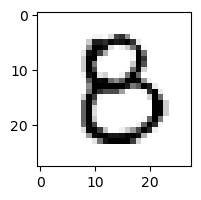

11.738342989781254% - 0
0.004198773685267588% - 1
0.4417359363040366% - 2
7.770406587939773% - 3
3.9620958404249658% - 4
28.54822767145925% - 5 - ОШИБКА
0.08935324703006088% - 6
0.002908593916286661% - 7
20.770994426187567% - 8
0.004518827888799086% - 9

 5


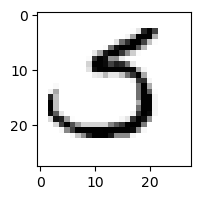

13.139690868019022% - 0
0.027818683381248956% - 1
5.068526057398095% - 2
41.3306165603177% - 3 - ОШИБКА
0.002685868676679718% - 4
21.327735351335456% - 5
2.72064646388566% - 6
11.259271305449287% - 7
0.028783440191448996% - 8
0.018337047241844134% - 9

 7


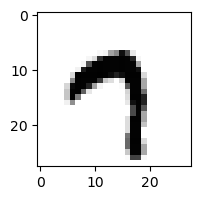

0.5833367515362896% - 0
0.01326117847407544% - 1
5.4732533156303364e-05% - 2
0.04462757152573678% - 3
3.065717961477486% - 4
3.604996754723181% - 5
0.11561627279238064% - 6
64.4297105490699% - 7
0.016981205468147412% - 8
86.62088884377627% - 9 - ОШИБКА

 8


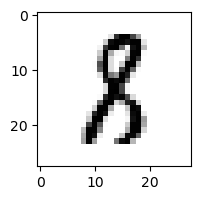

0.06132725485276534% - 0
19.204959825015354% - 1 - ОШИБКА
3.4350429297876883% - 2
2.088349494754724% - 3
0.023540297633240434% - 4
3.1924139699101026% - 5
0.11926651831190097% - 6
0.01452006238688708% - 7
7.603214716202284% - 8
0.012560651974787907% - 9

 9


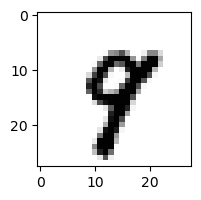

0.005293984524581032% - 0
0.029841868959847712% - 1
0.01219389638264508% - 2
0.02935386776434732% - 3
19.171117199000744% - 4
0.1990288051272055% - 5
0.015075187079392857% - 6
47.65492387298932% - 7 - ОШИБКА
2.655256123601258% - 8
9.143120528495826% - 9

 9


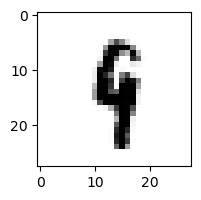

0.0009974229509845522% - 0
0.8937565943567917% - 1
0.15133280996044807% - 2
1.5401230090945923% - 3
29.91286128223215% - 4 - ОШИБКА
3.235474121436668% - 5
1.1737777503973015% - 6
0.20269466103386502% - 7
19.37841539834371% - 8
26.234496630150318% - 9

 6


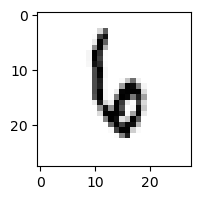

0.003920167732403311% - 0
0.18953570560157731% - 1
7.763545961962875% - 2
0.05692060724142654% - 3
87.8128448640031% - 4 - ОШИБКА
6.657043177875581% - 5
74.07197826552276% - 6
4.356016650111534% - 7
1.069850041425542% - 8
2.0729421655798124% - 9

 8


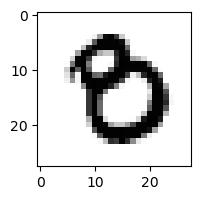

15.766914251328293% - 0 - ОШИБКА
0.0002352277528097043% - 1
0.0011506310711169227% - 2
1.2467718011716287% - 3
0.0004035376814417093% - 4
0.056115040579227324% - 5
0.1976428010437829% - 6
0.002825990485813232% - 7
0.10575981712868954% - 8
0.0013455023631291157% - 9

 8


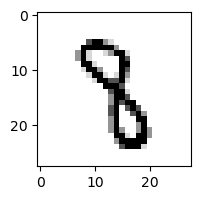

0.000912614794473299% - 0
4.825126743494034% - 1
0.23156382195716174% - 2
3.171686365021499% - 3
2.7015360749039785% - 4
8.990468789001577% - 5 - ОШИБКА
0.1366279493383006% - 6
0.39987693490167314% - 7
6.859849274682308% - 8
1.0528367487678452% - 9

 3


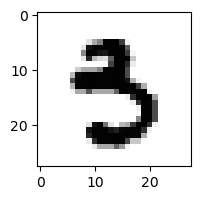

0.04737521699842791% - 0
0.003094336264699955% - 1
7.624310672954976e-06% - 2
16.11255927304509% - 3
0.014054099224570318% - 4
68.56282406809527% - 5 - ОШИБКА
0.04141035151285782% - 6
0.030223924972964684% - 7
0.006100467364758387% - 8
0.0380124814860068% - 9

 3


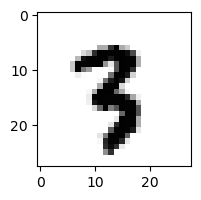

0.0007171269579940815% - 0
0.24762571597516467% - 1
0.0734203315357556% - 2
1.0470566237890948% - 3
0.04984859943293061% - 4
2.0623836956808432% - 5
0.015362651127174732% - 6
0.7874309803609632% - 7
2.624383033745054% - 8 - ОШИБКА
0.7025534233266453% - 9

 5


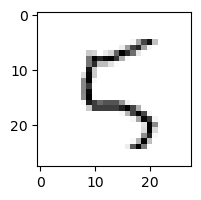

5.710339824149989% - 0
0.6338562887621637% - 1
30.65854608744675% - 2
0.17356296378044958% - 3
22.29236737289914% - 4
31.643590850814267% - 5
18.371720739398516% - 6
1.428137009745546% - 7
43.26196869257893% - 8
91.14434968498367% - 9 - ОШИБКА

 3


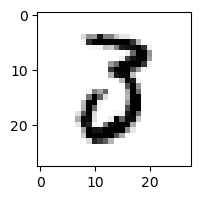

15.31811667190034% - 0
0.028189995208783025% - 1
33.34681071067948% - 2 - ОШИБКА
32.164035112847834% - 3
0.12216445200836326% - 4
0.3086841926680794% - 5
0.07544596868279407% - 6
0.7941809109926274% - 7
0.017316772331071994% - 8
0.0006492194755275491% - 9

 5


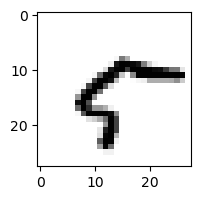

85.82512297372978% - 0 - ОШИБКА
0.35362785459193646% - 1
0.03506459084741438% - 2
0.1782000374251113% - 3
10.322038149203493% - 4
0.06301041864636585% - 5
9.840971212949347% - 6
6.296023522120546% - 7
16.679393680327724% - 8
3.0975769067032073% - 9

 3


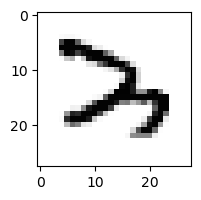

0.007506526348752713% - 0
0.13376707465333496% - 1
70.26918494943268% - 2 - ОШИБКА
3.5771265514160175% - 3
2.730081398812154% - 4
0.007583367367491729% - 5
1.8399450409139466% - 6
3.6250290082101224% - 7
0.2502697399011876% - 8
0.19009294512827613% - 9

 5


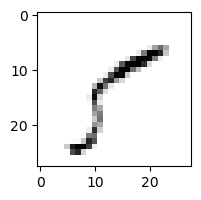

77.74404297637517% - 0
27.542547391794276% - 1
1.3696713553645823% - 2
78.73951641692055% - 3 - ОШИБКА
16.171142789594406% - 4
66.2815801094355% - 5
0.447662718314558% - 6
26.363548131381542% - 7
16.911511363997672% - 8
3.3253363025450873% - 9

 3


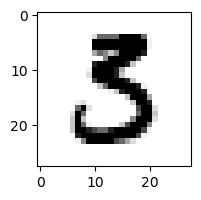

0.47504193452153276% - 0
0.005784625849649458% - 1
0.029034067441607338% - 2
18.287080562184286% - 3
0.00045001713557814174% - 4
31.43467757475421% - 5 - ОШИБКА
0.006907948290918183% - 6
0.005397055200176638% - 7
0.007287735614305168% - 8
0.00034561515859058724% - 9

 3


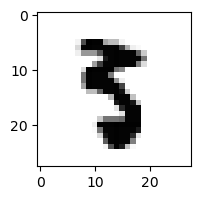

0.01438377793957795% - 0
0.0058207544914282055% - 1
0.0009929229050276876% - 2
0.2996596888493136% - 3
0.025719289741589983% - 4
40.18467886543336% - 5 - ОШИБКА
0.034281783395322195% - 6
0.11249331627082523% - 7
0.1558469176425977% - 8
0.06230175092014956% - 9

 5


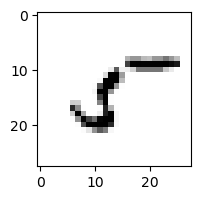

31.784463360009084% - 0
12.711150216233738% - 1
13.29576649396474% - 2
13.14987615194185% - 3
1.0060927809003055% - 4
82.57911504123867% - 5
4.637504838825376% - 6
0.752908051406439% - 7
86.17800264490027% - 8 - ОШИБКА
0.7435492167285456% - 9

 5


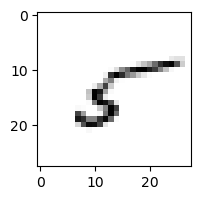

17.4451223699418% - 0
16.72474841600537% - 1
47.616846669815146% - 2
5.224443658681185% - 3
14.79853403219535% - 4
34.52982932371848% - 5
17.390156598733476% - 6
3.0148297758414855% - 7
83.01177486504318% - 8 - ОШИБКА
7.161975916499712% - 9

 5


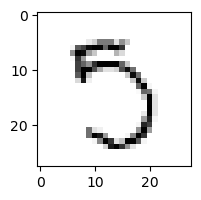

3.8334081947480105% - 0
0.22168552859740034% - 1
4.158822259964545% - 2
20.386000697766328% - 3
0.9059922119687696% - 4
29.331540288367304% - 5
0.23485422574249568% - 6
49.69015875321337% - 7 - ОШИБКА
36.49285323801952% - 8
1.0125869343508223% - 9

 5


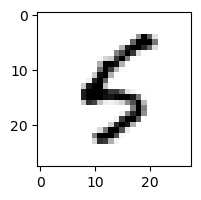

5.005298517677289% - 0
0.033309801916866374% - 1
0.06882530006767493% - 2
1.6806884683336771% - 3
35.77562539093219% - 4
44.85067665816692% - 5
47.587166135507566% - 6 - ОШИБКА
0.046061717828682805% - 7
0.574606319425696% - 8
3.8470631817517136% - 9

 8


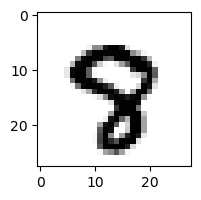

0.01297740307075475% - 0
9.033232133664337e-05% - 1
0.001626244499876372% - 2
0.021402890974444345% - 3
0.31920502951115837% - 4
1.5873540030790156% - 5
0.001295418997933014% - 6
6.493506439912715% - 7 - ОШИБКА
0.42343268667123285% - 8
3.1627977829749776% - 9

 6


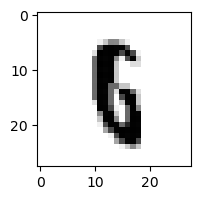

0.006609551992753242% - 0
0.04130175153224262% - 1
0.12657951331526898% - 2
0.12150462080936535% - 3
0.5749012845815814% - 4
21.711126132511925% - 5 - ОШИБКА
5.312029872559481% - 6
0.02715464374807986% - 7
8.770489507916265% - 8
3.1181249404542872% - 9

 9


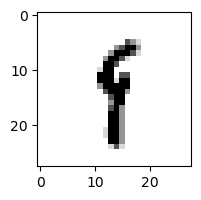

0.0321186250090475% - 0
59.17339614348206% - 1 - ОШИБКА
0.08403095459132416% - 2
1.8273766752157694% - 3
2.1514454575844075% - 4
13.012492535103071% - 5
4.237388072048657% - 6
1.1198703978289253% - 7
45.856532017752095% - 8
22.40311074009552% - 9

 8


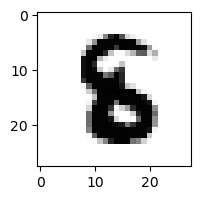

0.00020289854374817232% - 0
0.001612486496730642% - 1
0.018022933388175132% - 2
0.011479508972552515% - 3
0.09992209314198175% - 4
15.8415750860885% - 5 - ОШИБКА
1.663923566433935% - 6
1.9547761304708318e-05% - 7
0.5758834261136309% - 8
3.96771420965672e-05% - 9

 6


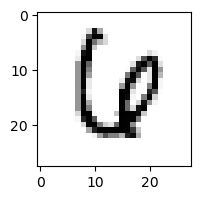

1.029451482278671% - 0
0.00337365954260623% - 1
1.2132245225586598% - 2
1.1205754114231505% - 3
19.084849604960503% - 4 - ОШИБКА
0.09130846265654231% - 5
14.288808652063922% - 6
8.073197760725652% - 7
0.9368528143337163% - 8
0.015897984183874767% - 9

 9


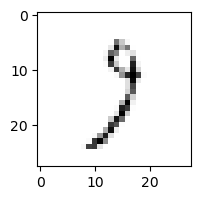

5.368173362960744% - 0
8.722234972866538% - 1
28.36468283848758% - 2
60.79424689141659% - 3
11.17239227680707% - 4
3.06031058624016% - 5
4.39885215270673% - 6
81.0249517720154% - 7 - ОШИБКА
16.851170922728414% - 8
23.3829825954803% - 9

 1


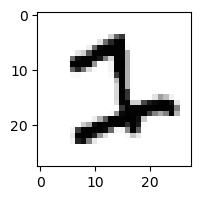

0.039310261165171285% - 0
0.09544204791210992% - 1
35.51177181509337% - 2
43.072677722047494% - 3 - ОШИБКА
0.00027347921467657705% - 4
2.1219029616240372% - 5
1.1813925034924313% - 6
2.8045238474170846% - 7
0.002888120171549386% - 8
0.000666129962314036% - 9

 5


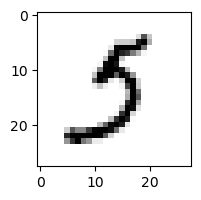

2.3495741390870606% - 0
0.5942154439180702% - 1
0.5084679367928472% - 2
26.50340285653996% - 3 - ОШИБКА
0.24688785300595786% - 4
21.962203680181773% - 5
3.0706911450070566% - 6
13.59675362928112% - 7
0.2200773996701977% - 8
1.232559407968634% - 9

 2


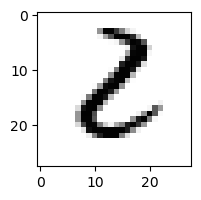

28.643900763576298% - 0 - ОШИБКА
1.3296784300599376% - 1
8.958446306931158% - 2
27.285021377342506% - 3
0.02226555806919465% - 4
5.348849965278392% - 5
3.5374521390608535% - 6
0.00158174389138845% - 7
1.4478711650411566% - 8
0.004921255869328649% - 9

 3


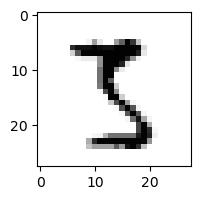

0.370973521519864% - 0
0.11891979180356% - 1
1.06816714984686% - 2
30.814905979355732% - 3
0.04138686797431745% - 4
49.881786725081135% - 5
0.006944025610536518% - 6
0.29177677220048726% - 7
67.93588116645395% - 8 - ОШИБКА
1.4850759799110342% - 9

 3


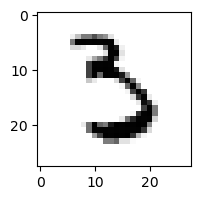

0.31478393163413915% - 0
0.023805589849030556% - 1
0.5399028119551135% - 2
20.528270512411815% - 3
0.009174942756808925% - 4
45.99100734323641% - 5 - ОШИБКА
7.244669148528815% - 6
2.09367137359087% - 7
0.2129730689535048% - 8
0.021931801540204014% - 9

 4


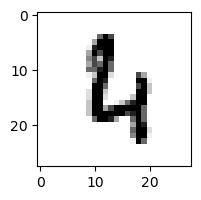

0.13489784980682043% - 0
0.0016296358064061644% - 1
24.301703490975722% - 2
0.013111523877994878% - 3
30.450498483558608% - 4
5.3164266191096% - 5
32.73611209445579% - 6 - ОШИБКА
0.6782696015834608% - 7
4.341820606815134% - 8
12.67407993786946% - 9

 5


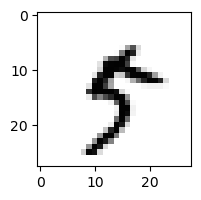

0.8294109613679762% - 0
0.45717899118574246% - 1
0.013970995373328772% - 2
4.9106644647839826% - 3
3.2324562581640133% - 4
0.677198596315645% - 5
1.5013102585924998% - 6
10.84889044054613% - 7
8.581938087955328% - 8
27.313505360570478% - 9 - ОШИБКА

 5


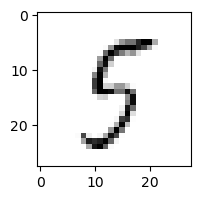

8.474081068711905% - 0
0.22770043588790936% - 1
1.1623539567365255% - 2
14.855316391939805% - 3
17.356900272199823% - 4
68.33290557800987% - 5
5.764007501871708% - 6
0.8110960909425338% - 7
70.05511546772442% - 8 - ОШИБКА
24.891895535236966% - 9

 6


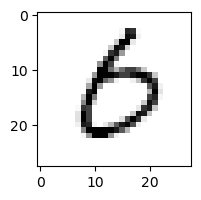

72.56048644650801% - 0 - ОШИБКА
0.028141092402243578% - 1
0.35459256643480636% - 2
5.644586298324529% - 3
0.30446825018053075% - 4
2.875822247130133% - 5
42.47699450457535% - 6
0.7707005372412825% - 7
0.8116074166789506% - 8
0.4311081122676014% - 9

 1


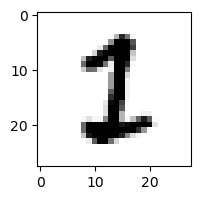

0.020193013403822884% - 0
8.427029592153232% - 1
2.8674686320950022% - 2
0.276996848171934% - 3
0.00010790399044176159% - 4
12.581928061996164% - 5 - ОШИБКА
0.07703305255904111% - 6
0.12302843027108985% - 7
0.3916361540014607% - 8
0.00311077564163646% - 9

 4


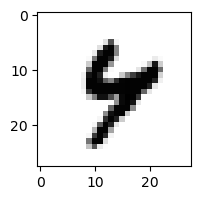

0.003527900220568305% - 0
0.02648998747836956% - 1
0.010315408440943571% - 2
0.023873201526071742% - 3
45.26147793140978% - 4
0.9675495777831605% - 5
0.7869167729098406% - 6
0.9344597008280476% - 7
24.911245825693385% - 8
68.0764660744689% - 9 - ОШИБКА

 7


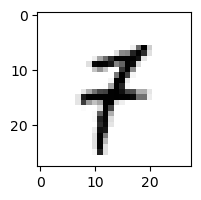

0.16635150475376473% - 0
20.392671566268266% - 1
0.9379009437306913% - 2
0.7647860968475079% - 3
1.1826291730852756% - 4
1.0360593287226711% - 5
0.4350382611935117% - 6
1.5312937415704009% - 7
0.6123207987751913% - 8
30.908233686476066% - 9 - ОШИБКА

 8


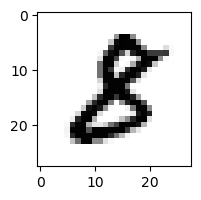

0.11424057776374008% - 0
0.04261467596675259% - 1
0.6822827687458591% - 2
17.659284024111603% - 3 - ОШИБКА
0.0028761421371791126% - 4
1.4116417295751968% - 5
0.006139690710860081% - 6
0.0013821440235975342% - 7
5.0422746736507005% - 8
0.001874192544278712% - 9

 5


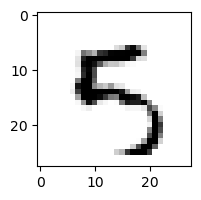

1.9368036151636063% - 0
0.006280563908444604% - 1
0.5061686948866783% - 2
0.22430921165510734% - 3
5.74363964398023% - 4
48.7947586683317% - 5
1.079453312744209% - 6
0.20216830447336173% - 7
0.3824745542108082% - 8
99.78766144871379% - 9 - ОШИБКА

 3


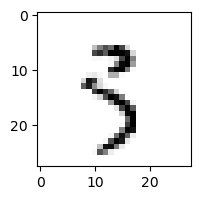

1.312939837405731% - 0
3.113762657834332% - 1
1.3419547865691324% - 2
24.751583774625193% - 3
2.9080367144548402% - 4
21.844645864171415% - 5
0.7175330918811185% - 6
7.055815791971104% - 7
3.3498779417263918% - 8
27.96913990857066% - 9 - ОШИБКА

 5


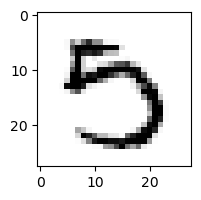

3.2673043873003382% - 0
0.018586674467860605% - 1
0.0015481341023787676% - 2
8.387699665935408% - 3
0.9097173625008723% - 4
10.311084736832484% - 5
0.011634159609832202% - 6
30.52323870742852% - 7 - ОШИБКА
0.5287175516085353% - 8
0.2212443057854376% - 9

 9


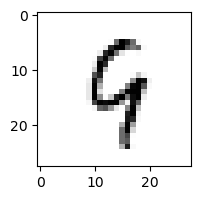

0.18901460956738872% - 0
0.13635065848665529% - 1
9.73088041801503% - 2
0.38407364685554823% - 3
79.5258145501225% - 4 - ОШИБКА
4.513215721727129% - 5
15.102903199056586% - 6
1.660214015920365% - 7
26.237243866473236% - 8
53.40412420336838% - 9

 7


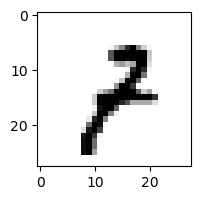

0.08185650193043417% - 0
5.8961549281011525% - 1
6.404387263207147% - 2
6.212265291716034% - 3
0.7444652053945313% - 4
0.038847706589303144% - 5
0.17508186121378214% - 6
9.281510424754115% - 7
1.223558029699591% - 8
35.59833898614445% - 9 - ОШИБКА

 5


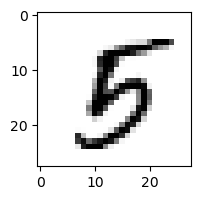

0.40072780740557445% - 0
0.04486665610161039% - 1
0.015204581513647362% - 2
1.1055776216677966% - 3
2.8435657321964367% - 4
17.109772559833218% - 5
6.473056758373702% - 6
0.08901136551584404% - 7
31.943096387888385% - 8 - ОШИБКА
15.33394070249144% - 9

 8


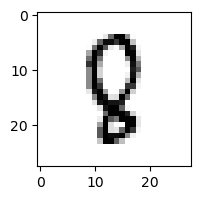

0.025441990216223564% - 0
0.05230785856074298% - 1
9.029934190659459% - 2
0.04256321542180626% - 3
27.282477838872865% - 4 - ОШИБКА
4.9185990461805345% - 5
1.4578486104900696% - 6
0.7163364554663029% - 7
11.717866761540735% - 8
0.02753508359316848% - 9

 7


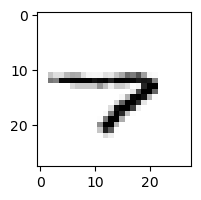

0.3131886517544982% - 0
2.7188316953345684% - 1
0.08702265965267093% - 2
0.9683067070333171% - 3
94.50231455852138% - 4 - ОШИБКА
3.1540995561180116% - 5
53.1205324946487% - 6
39.12581578579927% - 7
1.227315812466517% - 8
50.29211041484305% - 9

 3


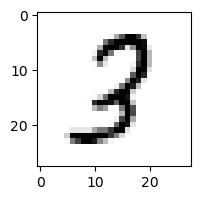

0.16084016946714358% - 0
1.0910268402897767% - 1
49.53058611407023% - 2 - ОШИБКА
19.219122089127623% - 3
3.687233996765297% - 4
0.36201402360661217% - 5
0.19160551150928878% - 6
0.5625933687851318% - 7
15.068169965957285% - 8
0.038565380951834156% - 9

 8


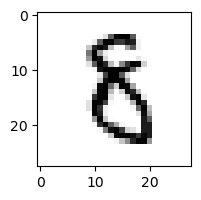

0.07787412844152745% - 0
0.1701493530780227% - 1
0.8329190370454714% - 2
8.391771419244908% - 3 - ОШИБКА
0.6841788608623935% - 4
7.151226871681134% - 5
4.889255257953648% - 6
0.03772329550777425% - 7
1.086657672780757% - 8
0.019318361278571256% - 9

 8


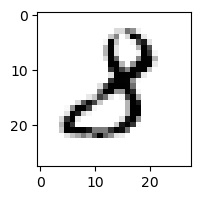

0.5694974365923836% - 0
0.6279792162442758% - 1
3.512439713758016% - 2
89.3254044267008% - 3 - ОШИБКА
0.527505030000051% - 4
0.19898707606193577% - 5
0.030614694951386346% - 6
0.11458915657389704% - 7
0.03949687242497267% - 8
0.04369392243572456% - 9

 8


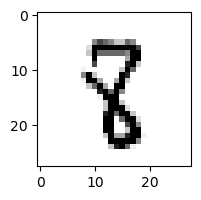

0.01401302305464423% - 0
4.832181833661455% - 1
0.7938109533878499% - 2
0.8137909604930895% - 3
2.8218713941934306% - 4
5.5750195196884516% - 5 - ОШИБКА
0.04463702316415545% - 6
0.10759164633844864% - 7
3.6414733722567547% - 8
0.33219338102291796% - 9

 6


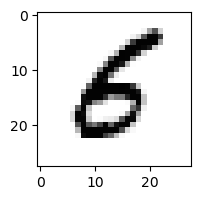

5.59972770378463% - 0
0.02230877528118586% - 1
0.07871571805898098% - 2
0.6515741249925879% - 3
2.024869891664088% - 4
57.72409119447096% - 5 - ОШИБКА
36.6109631579861% - 6
0.0013725724721688401% - 7
0.02332638041005479% - 8
0.15369515831378752% - 9

 7


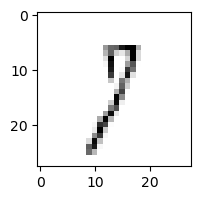

8.069976846380813% - 0
63.25014733660858% - 1 - ОШИБКА
19.84932666452713% - 2
34.354053481935814% - 3
1.980582987580883% - 4
8.905702674769072% - 5
4.971979215025045% - 6
53.063950620956504% - 7
26.601558540773908% - 8
40.24792693156792% - 9

 9


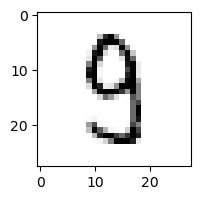

0.24912025489802% - 0
0.06801795411455933% - 1
0.8544135864847431% - 2
25.75153772237843% - 3 - ОШИБКА
8.307578665950405% - 4
19.558590815965935% - 5
0.17770172489319597% - 6
0.8562994977096036% - 7
23.66825848138206% - 8
0.7595725553906203% - 9

 6


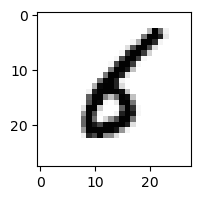

2.784171091854307% - 0
3.198211633617603% - 1
0.35458175216842164% - 2
1.529751555051933% - 3
0.49244293331124833% - 4
19.388799736024893% - 5 - ОШИБКА
15.76639556370896% - 6
0.010940771672312619% - 7
0.27013210814684685% - 8
0.02891995989484551% - 9

 6


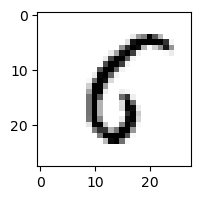

53.59110034740739% - 0
0.055079033234871844% - 1
0.21407897752760077% - 2
0.13934327889209905% - 3
3.530856805986308% - 4
72.75361085510838% - 5 - ОШИБКА
56.0524583420213% - 6
0.13752436590116496% - 7
10.179714344119803% - 8
0.40857567151266233% - 9

 8


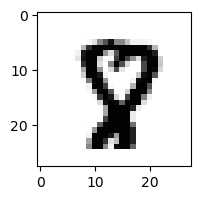

0.014929812257986733% - 0
0.00014014936120640715% - 1
0.01792666391439288% - 2
0.008643603340971265% - 3
0.5677899490667561% - 4
1.897533146414831% - 5
0.0010537236731302125% - 6
2.5372159409506225% - 7 - ОШИБКА
2.4013997101401707% - 8
0.013448643377183222% - 9

 6


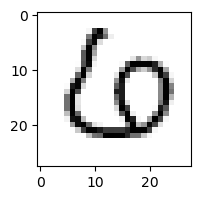

4.367874133233881% - 0 - ОШИБКА
0.07111808051144519% - 1
0.6493109163400571% - 2
2.588466450782444% - 3
0.29970912954771256% - 4
0.3434522486282362% - 5
0.08964614460193608% - 6
0.3154962326756584% - 7
0.1954685279163298% - 8
0.0021642937301081934% - 9

 2


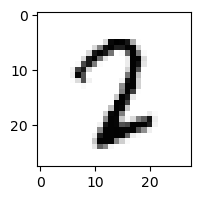

0.030317795910522683% - 0
0.09024324118827326% - 1
5.564495483433648% - 2
1.4534647974759005% - 3
0.8511000289183664% - 4
2.0950116055394004% - 5
0.24686239788463488% - 6
13.54980028387946% - 7 - ОШИБКА
4.165554350781672% - 8
0.01896940497991796% - 9

 8


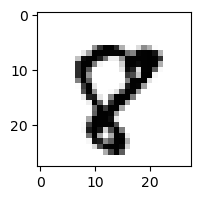

0.13393730432511938% - 0
0.011085696078906467% - 1
0.07051258657100473% - 2
0.0024527694524880497% - 3
0.0629540783378783% - 4
0.26266283353343484% - 5
0.0017838259653747879% - 6
43.15521635182948% - 7 - ОШИБКА
9.086270251568749% - 8
0.447586440067792% - 9

 4


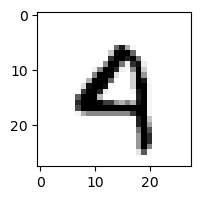

2.828784515437922% - 0
0.0034230388476547504% - 1
0.28431361966289115% - 2
0.021870598911913737% - 3
51.650313282118056% - 4
0.3042069321247179% - 5
4.650992291150806% - 6
0.16124985310743184% - 7
0.10683715038559377% - 8
94.3241329192088% - 9 - ОШИБКА

 8


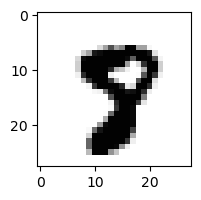

0.005540968183971804% - 0
0.00017494272235071807% - 1
2.395154453966726e-05% - 2
0.0027481537211955123% - 3
0.015356293578355629% - 4
7.104578124675935% - 5
0.00043391476312326524% - 6
26.683792326878148% - 7 - ОШИБКА
1.7292984905637312% - 8
0.20506217679906413% - 9

 6


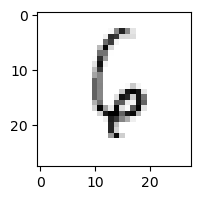

0.2645577195364043% - 0
0.7646890461001061% - 1
28.63368980171808% - 2
0.35709243871918833% - 3
79.05068467747172% - 4 - ОШИБКА
7.2955611892002405% - 5
69.16734778252768% - 6
14.571817266494099% - 7
2.986470977731027% - 8
11.904013989823635% - 9

 7


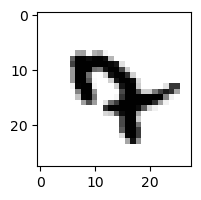

0.0006581238892656993% - 0
0.047258802532492324% - 1
0.00040535056154108806% - 2
0.004777439769249652% - 3
84.51175459022373% - 4 - ОШИБКА
0.3436193229062959% - 5
7.681421228386164% - 6
14.993521522666875% - 7
0.0011259404724710796% - 8
0.2026244031667149% - 9

 8


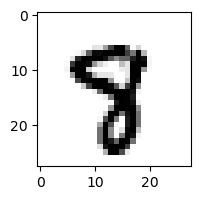

0.0007021845316422824% - 0
0.0021149863624718335% - 1
0.0019122947460292934% - 2
0.043918615497212966% - 3
0.9730195453688639% - 4
4.913068264743163% - 5
0.004539369310035469% - 6
6.894777313759892% - 7 - ОШИБКА
2.5600852207234364% - 8
0.8103635483664711% - 9

 8


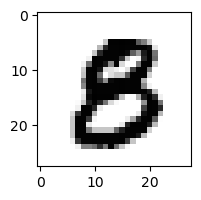

0.4498074376623925% - 0
8.790114301450592e-05% - 1
0.0014221017931193866% - 2
1.396213803982151% - 3
0.015348574576018792% - 4
5.377962432004523% - 5 - ОШИБКА
0.0005021257700967144% - 6
7.156907508005723e-05% - 7
1.3039722978161281% - 8
0.00750742875380301% - 9

 7


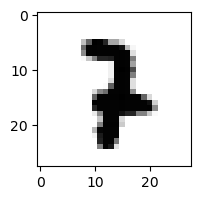

3.9519040166444564e-05% - 0
0.616209179416188% - 1
1.9525273129376044% - 2 - ОШИБКА
1.7872362207736077% - 3
0.05307195892783627% - 4
0.010822811706643051% - 5
0.06327699287470931% - 6
0.6530484246563686% - 7
0.013046349393802737% - 8
0.11969791629785409% - 9

 2


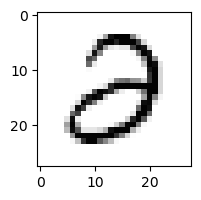

15.715590220864229% - 0
0.01988608232987447% - 1
11.293695944923208% - 2
76.09736944971048% - 3 - ОШИБКА
1.7340678800134548% - 4
0.5517887519572895% - 5
0.8317646064147493% - 6
0.008689479776731212% - 7
0.9291755252770715% - 8
0.003162443911510215% - 9

 7


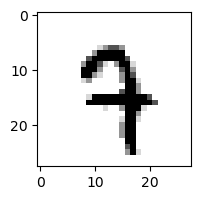

0.002183874821802528% - 0
0.048040480119318905% - 1
0.8662294509171858% - 2
0.47928377229575586% - 3
11.083040542431506% - 4
0.7524228075452307% - 5
0.7309694245102794% - 6
20.709130126993834% - 7
0.46936529182106995% - 8
45.90857640884656% - 9 - ОШИБКА

 9


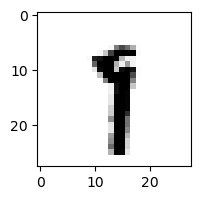

0.002780481258627439% - 0
30.50445767867595% - 1
0.032659300549963334% - 2
0.8831286940629324% - 3
0.2780451692852341% - 4
1.0782180166235231% - 5
0.1783680561527075% - 6
47.050136221510584% - 7 - ОШИБКА
2.340490130526759% - 8
10.22259275180139% - 9

 3


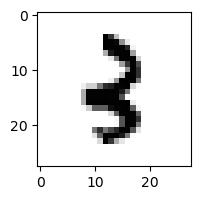

0.005016268268229952% - 0
0.8955528298253905% - 1
4.239474156015493% - 2
3.6968669625674986% - 3
4.9856170500669235% - 4 - ОШИБКА
0.05065727152235988% - 5
0.24084224921321762% - 6
0.004937018732762282% - 7
1.5418836762939925% - 8
3.0060553602070037% - 9

 9


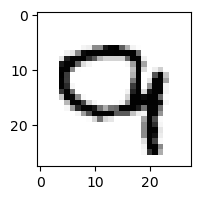

4.11278868244302% - 0
0.0012576613424848432% - 1
22.779982931495873% - 2 - ОШИБКА
0.5157986144949626% - 3
3.205979712326021% - 4
0.0002641057958998612% - 5
1.3489848225520036% - 6
15.248459743068329% - 7
0.01734286565934276% - 8
11.07552449872525% - 9

 2


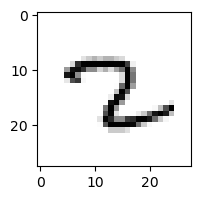

0.012891170268490716% - 0
15.17338420003388% - 1
5.649263224744491% - 2
0.14445380226515994% - 3
0.8204320515944071% - 4
1.9564917098729657% - 5
26.96237382331774% - 6
50.619575855435336% - 7 - ОШИБКА
2.4505138658802204% - 8
1.397764017228609% - 9

 6


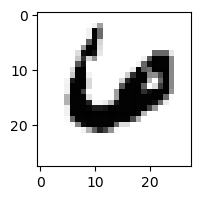

0.14390510971058304% - 0
0.00015886148117159155% - 1
0.123606402003962% - 2
7.730150009395626e-05% - 3
33.511953675608574% - 4 - ОШИБКА
4.040534363020504e-05% - 5
26.74230841265677% - 6
0.7975034999820269% - 7
0.013351471366434197% - 8
0.00306053857660524% - 9

 5


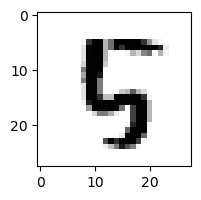

0.012556730652069645% - 0
0.001227145411226769% - 1
1.0202917506218372% - 2
0.0020906308622127045% - 3
91.15540460817284% - 4 - ОШИБКА
17.866173001096474% - 5
0.5041371728931331% - 6
0.011295028119332095% - 7
4.460091002064094% - 8
0.025772751332483253% - 9

 3


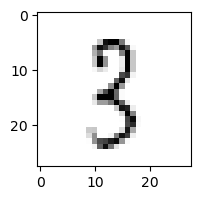

0.3928420874055873% - 0
15.456433539245726% - 1
14.316313748645692% - 2
35.077395237389844% - 3
2.8300880534443165% - 4
12.9830496315584% - 5
0.14533768610662956% - 6
0.8881497644181792% - 7
52.46451214712441% - 8 - ОШИБКА
3.1216659670476847% - 9

 4


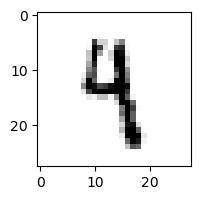

0.01381689699805536% - 0
3.5463711552024932% - 1
0.10281683273049572% - 2
13.086912886179402% - 3
13.015090426159878% - 4
17.13636017315709% - 5
1.1312812695036356% - 6
0.09172184694576674% - 7
1.4620943675857925% - 8
34.231601029272504% - 9 - ОШИБКА

 8


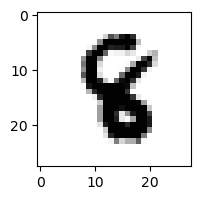

1.1117551456175826e-05% - 0
0.008097666263119918% - 1
0.16912720429309838% - 2
0.04693940235268145% - 3
9.020610365799584% - 4 - ОШИБКА
0.6238006811658462% - 5
0.12084862049394132% - 6
0.0019749371136260248% - 7
0.19424133129970617% - 8
0.0013978669810318731% - 9

 9


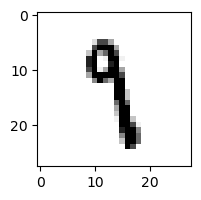

0.02441643757108503% - 0
18.391126683185473% - 1
0.10708709308055203% - 2
1.8708312660900097% - 3
1.829958568392577% - 4
31.055841578742115% - 5 - ОШИБКА
1.4513892586738497% - 6
4.138868758027468% - 7
12.626435146425582% - 8
3.4496851682770155% - 9

 2


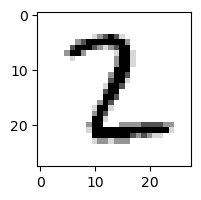

0.07470119155937542% - 0
15.153805904845152% - 1
31.09403774985938% - 2
39.8619636465057% - 3 - ОШИБКА
0.0018563971116147386% - 4
1.4624458373916616% - 5
0.20505087781032302% - 6
0.004953111492761344% - 7
4.25160358386938% - 8
0.010198249029649518% - 9

 2


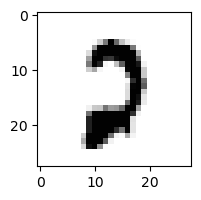

1.5769433037962175% - 0
0.004907805790593408% - 1
37.19054162962473% - 2
0.2625284932416037% - 3
0.0012270638305935954% - 4
0.241165481266833% - 5
0.14870834595486918% - 6
52.3013230413073% - 7 - ОШИБКА
0.14986987064930457% - 8
0.10498385427486528% - 9

 6


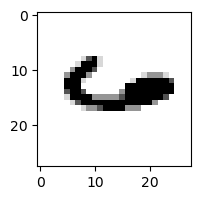

0.664357238749617% - 0
0.06440967739347102% - 1
0.01194970224456409% - 2
0.0012427132886095123% - 3
99.74724382853537% - 4 - ОШИБКА
0.0009739718600330597% - 5
88.74161437149752% - 6
7.9899925581974545% - 7
0.7701083705718527% - 8
84.03728921731435% - 9

 8


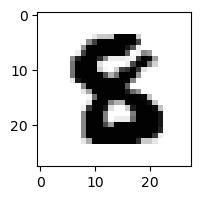

0.0003202880070129979% - 0
8.137800004404907e-06% - 1
0.0043408270759135725% - 2
0.029900984005085292% - 3
0.0015537640966217308% - 4
6.993637571666176% - 5 - ОШИБКА
0.002645074001178987% - 6
1.3846156097914569e-05% - 7
0.08145934435942348% - 8
6.896302458155792e-06% - 9

 2


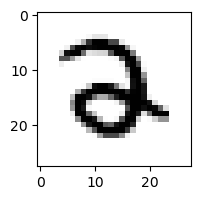

0.4160266932665804% - 0
0.00017088638611443256% - 1
27.23974541621732% - 2
62.90028850249713% - 3 - ОШИБКА
0.9309722812139021% - 4
0.020563175312746727% - 5
2.9240172719472977% - 6
0.008015560104537191% - 7
0.000309268560376852% - 8
0.014833100343447333% - 9

 3


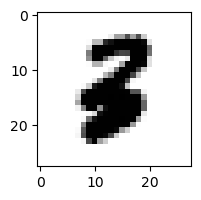

0.002307352016830817% - 0
0.016449298256457457% - 1
0.8643189476570825% - 2 - ОШИБКА
0.03417783843602555% - 3
0.12000153946796119% - 4
0.05096311795083219% - 5
0.026103445046475836% - 6
0.00026427279428640056% - 7
0.00046494259195007986% - 8
0.00019920518628026052% - 9

 5


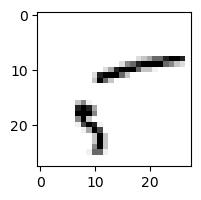

91.64489704867968% - 0 - ОШИБКА
2.6239173244943315% - 1
3.05318013048259% - 2
30.081069285681956% - 3
3.773155127488513% - 4
80.71262749327528% - 5
0.6491186814076593% - 6
44.06023008645094% - 7
88.22341009943891% - 8
0.9054822134768473% - 9

 5


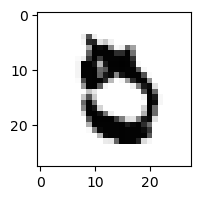

2.816319728106614% - 0 - ОШИБКА
0.00038296092568368265% - 1
0.004415206694802196% - 2
0.017085512707569722% - 3
0.0012919412367428658% - 4
2.120762641602875% - 5
1.928460557987759% - 6
1.4774465245768909% - 7
0.06539824524611594% - 8
0.03187536523663805% - 9

 8


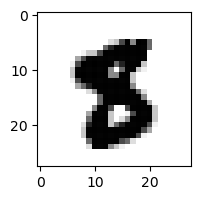

0.0003706185247291294% - 0
0.00020354175790946488% - 1
1.7915949245789293e-05% - 2
0.000971009653422331% - 3
0.0008746449197646948% - 4
12.743679934574928% - 5 - ОШИБКА
0.003262618421119528% - 6
0.0020506617967582506% - 7
0.1352855205714619% - 8
0.0007069878216431448% - 9

 7


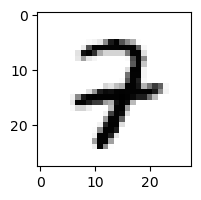

0.01571288215253429% - 0
0.05976941396862134% - 1
7.635477171348584% - 2
3.64326497976317% - 3
59.893296730175905% - 4 - ОШИБКА
0.008095855014812818% - 5
0.5906950657006069% - 6
0.7074124709300885% - 7
0.07800579462587663% - 8
0.23577031171491103% - 9

 2


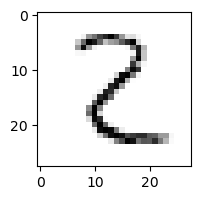

4.319305795519684% - 0
18.890781608570435% - 1
41.99473617198496% - 2
31.379855451154526% - 3
2.0443401371280916% - 4
2.3091810558577954% - 5
1.3554735916043201% - 6
0.08026723217471682% - 7
58.05002832325281% - 8 - ОШИБКА
0.16139737397723497% - 9

 2


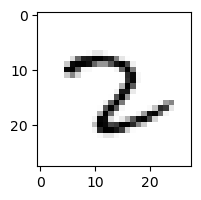

0.017755716122145233% - 0
4.613276978948674% - 1
20.2366097478241% - 2
0.9212189424019489% - 3
0.3313635206769878% - 4
1.0338545117227684% - 5
55.37890519464046% - 6
66.38937178794416% - 7 - ОШИБКА
4.698269307413505% - 8
0.14266770825525923% - 9

 7


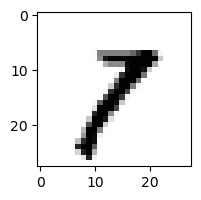

0.1629988708411722% - 0
57.71008212211412% - 1 - ОШИБКА
2.6849221980082394% - 2
4.1087458092963836% - 3
0.038713211511794694% - 4
0.12353437155627192% - 5
0.007632274712074018% - 6
24.82950661088607% - 7
10.681364633445757% - 8
7.5363654630954695% - 9

 9


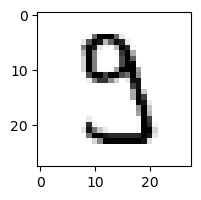

1.704824654841564% - 0
0.03324882212639027% - 1
0.5332384536366155% - 2
54.517243605002086% - 3 - ОШИБКА
0.20557519137889332% - 4
32.4374499897527% - 5
0.011379562231646361% - 6
9.438790215180688% - 7
2.8854910360162735% - 8
0.03367298999785763% - 9

 1


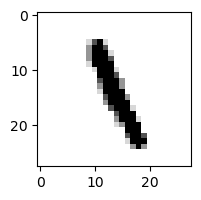

0.001168621028169907% - 0
6.504938034244249% - 1
0.6086284774400647% - 2
0.8901218593063014% - 3
14.21732410144326% - 4
60.02350577259783% - 5 - ОШИБКА
1.725587838216181% - 6
0.1719430308147215% - 7
46.561382673569994% - 8
1.207520905251598% - 9

 2


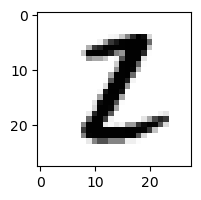

0.059749022887552974% - 0
11.868191173987897% - 1 - ОШИБКА
11.610741349266705% - 2
2.4901706124564362% - 3
0.0003170653937178362% - 4
2.3820734541315005% - 5
0.012188511592440792% - 6
0.0014980363927521226% - 7
1.4134187764417951% - 8
0.0004341310175115735% - 9

 7


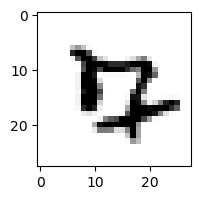

9.765267737072907% - 0 - ОШИБКА
8.413428243104865e-05% - 1
0.06163692152511039% - 2
0.027776740463605693% - 3
7.0966913319100735% - 4
0.5911873997924825% - 5
4.986189266056969% - 6
8.545604164681087% - 7
0.0029436026611689885% - 8
0.15641288119662297% - 9

 8


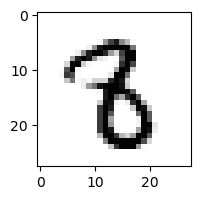

0.001310635564515864% - 0
1.1018107885344897% - 1
0.1275557583776491% - 2
12.10252362840839% - 3 - ОШИБКА
0.0646142637612049% - 4
1.372116537017475% - 5
0.04044038743591532% - 6
0.041532637691180374% - 7
6.18137637245412% - 8
0.17529903636269842% - 9

 8


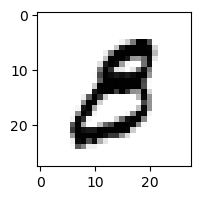

5.754520829434284% - 0
0.0231247298785416% - 1
0.012919339559217709% - 2
34.51484186813114% - 3 - ОШИБКА
0.01639879128588724% - 4
3.2538229651128647% - 5
0.09952329638264622% - 6
0.005667957152949165% - 7
0.2748838139220373% - 8
0.12174252813465776% - 9

 5


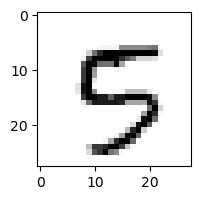

0.5449508525707465% - 0
0.010533691314447648% - 1
0.11882574748766613% - 2
0.6984384278036885% - 3
1.5553919398660714% - 4
29.857756514088123% - 5
0.14056110695202642% - 6
3.186247523525802% - 7
0.2610083994575208% - 8
30.261248494093202% - 9 - ОШИБКА

 5


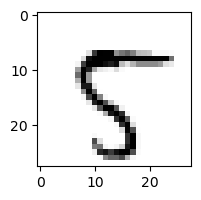

1.5262284855232089% - 0
0.10719183868409701% - 1
0.3661838693513203% - 2
0.0028667964178703113% - 3
0.2503378333663767% - 4
50.17235514993751% - 5
0.06639644865446728% - 6
57.94414790225182% - 7 - ОШИБКА
6.757054465638629% - 8
55.51975324719588% - 9

 5


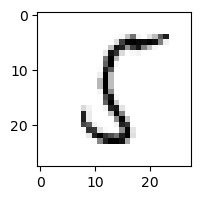

10.394811397449576% - 0
15.39007790152122% - 1
10.449446160710577% - 2
1.4303751135589637% - 3
5.557971798841111% - 4
84.95238808545695% - 5
3.7519112149361487% - 6
0.2944817177443679% - 7
89.275493891087% - 8 - ОШИБКА
0.18961308673719862% - 9

 8


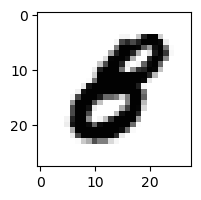

0.7746159552947252% - 0
0.0006609776445763738% - 1
0.0021247749113759576% - 2
0.09723537641842064% - 3
0.26967441986752166% - 4
1.5983743641605228% - 5 - ОШИБКА
0.012992004570795477% - 6
0.00029864405742093566% - 7
0.0033215632148951356% - 8
0.0009408536921819478% - 9

 9


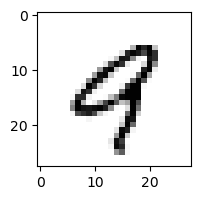

2.7870795155073824% - 0
0.05237787815615104% - 1
0.10174572323843054% - 2
0.06519379301070569% - 3
86.22364640301738% - 4 - ОШИБКА
0.07806779312953224% - 5
1.5998755379589737% - 6
4.606543778216718% - 7
2.7713868992540878% - 8
18.261764056975803% - 9

 2


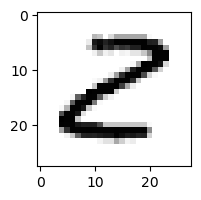

38.16525239359805% - 0
0.06136500374133501% - 1
21.401365703002178% - 2
69.67104688074899% - 3 - ОШИБКА
2.0519231776388493% - 4
25.28399781577128% - 5
0.002294460570042473% - 6
5.24191367929012e-05% - 7
1.0537840678002042% - 8
4.028097308073168e-05% - 9

 9


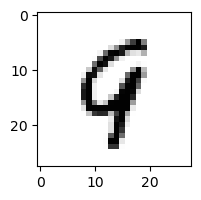

0.01949663701634844% - 0
0.27140394795868844% - 1
1.0447672937843229% - 2
0.000869770679607246% - 3
56.803904037968834% - 4 - ОШИБКА
0.036788898184715174% - 5
5.916918631898412% - 6
2.6494963772035334% - 7
12.55522871408355% - 8
43.955207104458424% - 9

 6


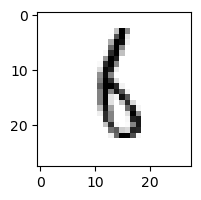

0.16979735040482696% - 0
7.078965074236508% - 1
5.291401621931793% - 2
10.668037659767503% - 3
2.114307885256698% - 4
28.733761976434437% - 5
49.17406575817836% - 6
0.15298935533776978% - 7
58.641998904347695% - 8 - ОШИБКА
12.012839238151187% - 9

 5


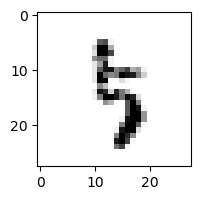

0.07988978839633885% - 0
0.5459985938633409% - 1
0.8223969630769415% - 2
47.894953393261105% - 3 - ОШИБКА
20.276584852226087% - 4
20.87928275464841% - 5
3.3081027346149714% - 6
3.9067018161116067% - 7
11.965565018694075% - 8
1.232080483671205% - 9

 9


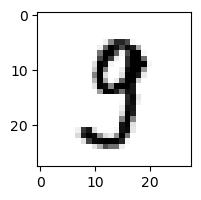

0.7100940767857986% - 0
0.0775702061260862% - 1
0.1828335342189782% - 2
42.91283637248684% - 3 - ОШИБКА
1.0074334352274523% - 4
6.791438262320873% - 5
0.001484190028404077% - 6
5.148969491137214% - 7
10.619078850336473% - 8
2.1250915952204763% - 9

 4


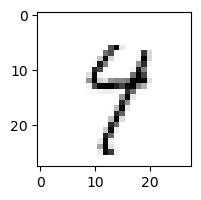

0.5025613809706075% - 0
1.5743096254651152% - 1
0.571632866353239% - 2
6.5023375464338615% - 3
46.72909178187614% - 4
8.970444315073703% - 5
2.2279143603033256% - 6
25.831082603696597% - 7
59.64367944995429% - 8
78.29447835832313% - 9 - ОШИБКА

 4


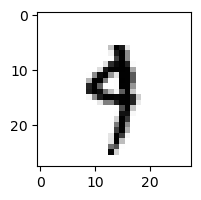

0.013354629853288212% - 0
2.4429102973617183% - 1
0.0339903842848445% - 2
6.525973919695262% - 3
35.84380192429084% - 4
2.895813773269671% - 5
3.0401962788034087% - 6
6.003577140535443% - 7
0.6004657986321426% - 8
42.19520969739138% - 9 - ОШИБКА

 8


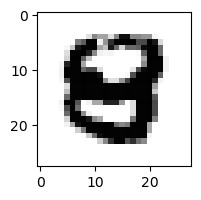

0.0186422776759758% - 0
2.876400507021653e-06% - 1
0.00019988059497628855% - 2
0.01354166499131448% - 3
11.358662260875803% - 4 - ОШИБКА
0.2008790398603758% - 5
0.01448034712834718% - 6
6.696537919839252e-06% - 7
0.004446137070164835% - 8
1.5479240459919494e-06% - 9

 7


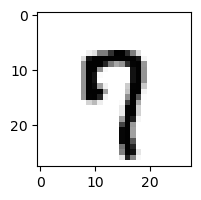

1.9382680806770514% - 0
0.0011646232569906246% - 1
0.11794201618280738% - 2
0.13547296340135667% - 3
5.478035609681443% - 4
6.763583150935758% - 5
0.161365006452912% - 6
39.37713803322174% - 7
0.3686824362401609% - 8
86.76711903478387% - 9 - ОШИБКА

 8


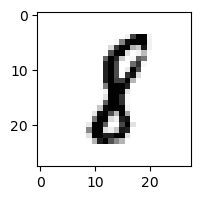

0.025246454255617234% - 0
61.02371540785817% - 1 - ОШИБКА
0.4068683798087% - 2
0.16970560068910562% - 3
0.06398662747113947% - 4
1.7020567267476745% - 5
0.7335243199809618% - 6
0.24703811938544723% - 7
19.308370513128324% - 8
0.040540344689548605% - 9

 7


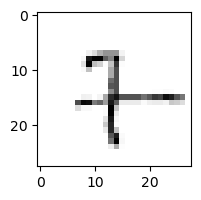

0.7386884982275217% - 0
37.57704125183647% - 1 - ОШИБКА
5.125508530349618% - 2
3.1221487386961218% - 3
10.734478456519485% - 4
5.398735337018908% - 5
17.831292208571583% - 6
12.720784940600941% - 7
15.686602799441085% - 8
9.52736559394491% - 9

 5


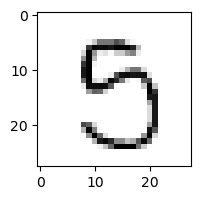

13.04601876077024% - 0
0.1384005111704271% - 1
0.454453197063027% - 2
67.62358280892096% - 3 - ОШИБКА
1.7320912039621321% - 4
53.387353611512054% - 5
0.18104051568521612% - 6
0.7513990782810009% - 7
53.51735745131949% - 8
4.160122209419176% - 9

 8


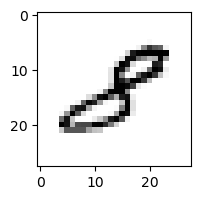

1.4334347299794208% - 0
14.469144150958593% - 1
14.770427779365617% - 2 - ОШИБКА
8.846043191955816% - 3
1.949441232208749% - 4
0.4323607705061777% - 5
0.04667832361416425% - 6
0.46151243551348314% - 7
5.610056564204415% - 8
0.7627521600269256% - 9

 5


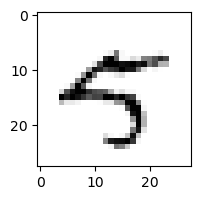

3.3961559986490037% - 0
0.20760380432648445% - 1
0.024706405924546718% - 2
0.4028460149086859% - 3
46.417284435775564% - 4 - ОШИБКА
9.511774727095187% - 5
0.03991799849496179% - 6
7.459443892672608% - 7
0.6075292524782163% - 8
8.375025768006616% - 9

 7


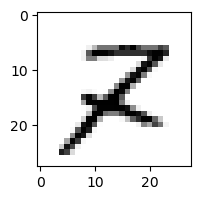

0.11739895393454336% - 0
1.0295053555475486% - 1
77.58337373599122% - 2 - ОШИБКА
1.1900492680677583% - 3
0.8870146745615793% - 4
0.4109927811495534% - 5
0.09488485404515609% - 6
0.042927243644324556% - 7
55.62646216953966% - 8
4.269138991752258% - 9

 3


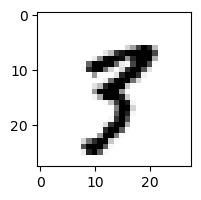

0.037066564274510036% - 0
1.3268554820559442% - 1
0.02292963042383566% - 2
3.249538014284277% - 3
0.2904258830123302% - 4
3.022426928169166% - 5
0.001835792893175897% - 6
9.3189773849918% - 7 - ОШИБКА
4.48254710992644% - 8
4.578342015842201% - 9

 5


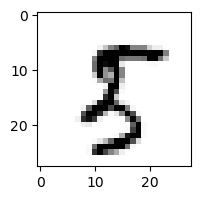

0.22684331731738883% - 0
2.638895331217194% - 1
0.1708476338129029% - 2
0.029832974007997577% - 3
0.012248418045694723% - 4
12.02639082436621% - 5
0.007729511816116187% - 6
0.33989544457188137% - 7
90.06831899422056% - 8 - ОШИБКА
9.273124271420523% - 9

 4


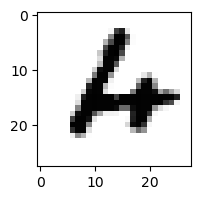

0.631857969425849% - 0
0.00027898614161753774% - 1
4.796339997093284% - 2
0.029226502883798283% - 3
4.889125815155761% - 4
0.05417583655216295% - 5
49.51289323911584% - 6 - ОШИБКА
0.0018434268974123844% - 7
0.031859625665491706% - 8
1.5452534067906725% - 9

 8


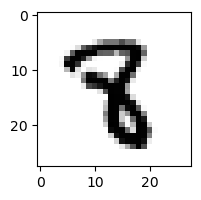

4.774910716329174e-05% - 0
0.340810076060489% - 1
0.02764434741930559% - 2
0.9081706752787648% - 3
3.604215665850502% - 4 - ОШИБКА
1.1528301239750838% - 5
0.004568558521893101% - 6
0.031976815076886676% - 7
0.19198277420940665% - 8
0.008608394620475211% - 9

 2


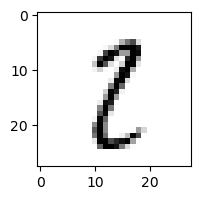

1.7789677314832992% - 0
46.774020167096594% - 1
2.570636356743376% - 2
4.541240775129238% - 3
0.044589298256776065% - 4
7.635413100984819% - 5
0.034482804640913016% - 6
2.4035677706756466% - 7
68.75345819658398% - 8 - ОШИБКА
6.27327146478831% - 9

 5


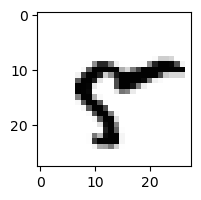

4.897447535195561% - 0
0.23576612018915982% - 1
0.00042320664527303935% - 2
0.0018184582433609128% - 3
11.200905142153674% - 4
0.29750249980308646% - 5
2.9413726048357227% - 6
7.605642806238547% - 7
78.84465033862138% - 8 - ОШИБКА
24.479380894449466% - 9

 7


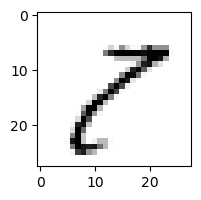

34.251295090696686% - 0
11.511434969707658% - 1
10.186979847704444% - 2
78.06677385536986% - 3
1.1424447447596142% - 4
12.061979727508668% - 5
0.020072296810320432% - 6
1.213220767894472% - 7
92.7250178232322% - 8 - ОШИБКА
46.4952706665088% - 9

 2


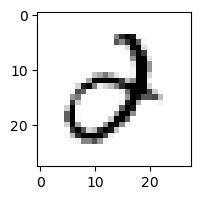

7.228859247597806% - 0
0.04606720851308519% - 1
0.30038158334844905% - 2
15.13302990213457% - 3
36.99506586359318% - 4 - ОШИБКА
2.3506360125740167% - 5
0.20487458561975466% - 6
1.4715692308515125% - 7
0.027430545910426412% - 8
0.13088882180468173% - 9

 2


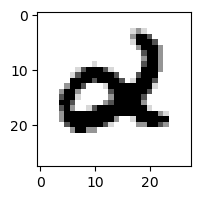

0.014343423560285732% - 0
0.01180280665832656% - 1
0.007602694633778446% - 2
2.1327253108234635e-05% - 3
3.5169528334392917% - 4 - ОШИБКА
0.2926163568434793% - 5
0.5221201931390881% - 6
0.0020493392524599478% - 7
0.578418376356102% - 8
0.04464288815907437% - 9

 9


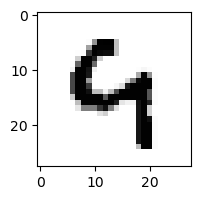

0.01341840429804722% - 0
0.0034927138740945985% - 1
0.5710954280729703% - 2
0.06757422293024716% - 3
89.41564690298742% - 4 - ОШИБКА
0.16953711703485558% - 5
21.905693446437272% - 6
0.04261826073568237% - 7
0.43708386922493697% - 8
84.75834526228412% - 9

 8


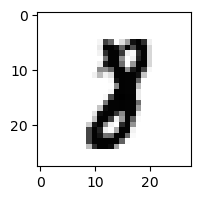

0.002163583794925466% - 0
3.6243819676013547% - 1
0.2172059379106119% - 2
0.18032747591662363% - 3
0.03850007355944857% - 4
0.018031406617182368% - 5
0.0022687974086459677% - 6
6.304348048815209% - 7 - ОШИБКА
0.1254947095020475% - 8
0.009348852608849325% - 9

 7


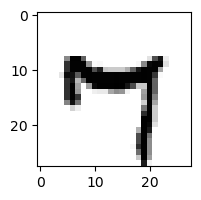

0.6668559331335788% - 0
0.08657539768954395% - 1
2.335051972844543e-05% - 2
1.4229951716411546% - 3
47.530471207359305% - 4
1.7634807319468597% - 5
0.4765508491422996% - 6
1.2163992190716153% - 7
42.06214520369627% - 8
72.31433361850314% - 9 - ОШИБКА

 7


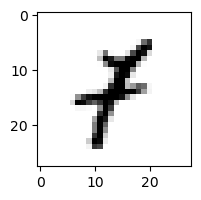

0.2194957159964206% - 0
64.22407289461712% - 1 - ОШИБКА
0.7615072739278862% - 2
1.4156315598743883% - 3
1.1577609366423265% - 4
0.28724699863872066% - 5
0.4669435440979296% - 6
0.5307756600116322% - 7
0.5798770622720868% - 8
6.419062537241027% - 9

 2


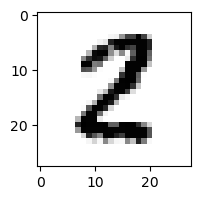

0.15781019788629297% - 0
0.3566345981242554% - 1
13.047679798326428% - 2
0.38586596076940793% - 3
0.0059939433368842755% - 4
3.008975308268614% - 5
0.01931281479275568% - 6
0.005718105065600054% - 7
26.186177521880534% - 8 - ОШИБКА
0.0003277708338114544% - 9

 6


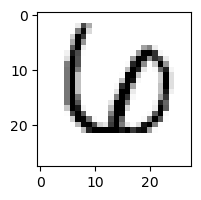

0.8648017731979374% - 0
0.4105619013150552% - 1
4.385188906788281% - 2
0.5677907462078002% - 3
7.003155866957409% - 4 - ОШИБКА
0.021892289588897204% - 5
0.5533560771356631% - 6
2.5915655372803705% - 7
0.07963816156100732% - 8
0.0013889151249542213% - 9

 7


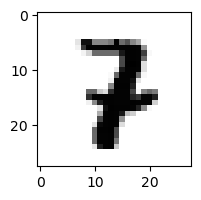

0.00042634085822621523% - 0
0.3349385949424007% - 1
1.3240791680526394% - 2
4.400569258710633% - 3 - ОШИБКА
0.9033821885364588% - 4
0.005474019866425826% - 5
0.005317346437973323% - 6
0.5026713447309612% - 7
0.0019807159118592045% - 8
0.010567891688935923% - 9

 9


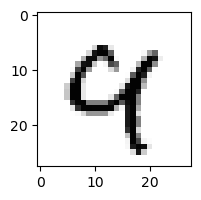

0.07519216102642849% - 0
0.028241076371477592% - 1
0.6315781764338467% - 2
0.012133063854197686% - 3
82.44240277642714% - 4 - ОШИБКА
0.008768749670066727% - 5
0.8487652892884574% - 6
7.728343609419847% - 7
7.3920926190894365% - 8
44.15298209036009% - 9

 6


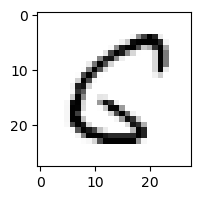

30.059870445388892% - 0
0.15599158903661564% - 1
1.3596969495422984% - 2
0.004461920235333839% - 3
7.667714978374858% - 4
90.62677798996341% - 5 - ОШИБКА
0.04243506002580177% - 6
0.04389765288551921% - 7
31.54501657678025% - 8
0.0462066542864767% - 9

 5


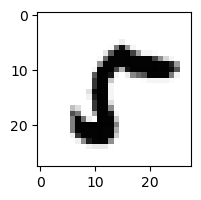

87.65431935392624% - 0 - ОШИБКА
0.00919143490820125% - 1
0.275468705045015% - 2
0.12188788595533495% - 3
0.0006739010631706226% - 4
17.412511320984326% - 5
0.004822759668797975% - 6
1.0532675130729758% - 7
65.15033945176555% - 8
0.29812372900285133% - 9

 2


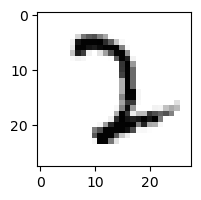

0.024235460458784854% - 0
0.03961106359732151% - 1
63.362946745869586% - 2
95.5258594143256% - 3 - ОШИБКА
0.048848524698091506% - 4
0.24098907387690005% - 5
0.6353581958053909% - 6
4.177608734509234% - 7
0.035848336287008675% - 8
0.06344195412368697% - 9

 9


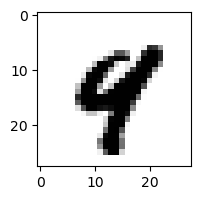

0.0013086601025188978% - 0
0.005094928040578931% - 1
0.00031015346173125346% - 2
6.774398905025906e-05% - 3
84.50690221490703% - 4 - ОШИБКА
0.012556285546713668% - 5
0.00875286247026229% - 6
0.5589933626755367% - 7
1.070236663038016% - 8
10.120402106935154% - 9

 2


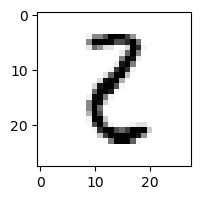

13.340347435621098% - 0
4.880849434824464% - 1
4.744774463598009% - 2
21.29349506588222% - 3 - ОШИБКА
0.14316341196001897% - 4
9.481637641354594% - 5
4.231541573993811% - 6
0.004409129155046536% - 7
15.57278655991145% - 8
0.022746156595840193% - 9

 5


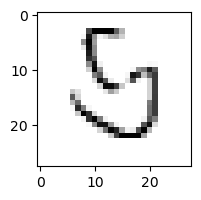

22.534325577018123% - 0
0.14248333075772818% - 1
11.551644908716971% - 2
18.023366284807313% - 3
3.1517168369487716% - 4
3.5752145661930834% - 5
73.93946625653675% - 6 - ОШИБКА
0.897380848150045% - 7
61.43519724866662% - 8
0.9289250472198158% - 9

 5


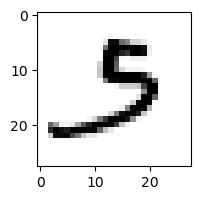

8.632700229563328% - 0
0.7920903866011504% - 1
5.088442252291695% - 2
58.44342463648218% - 3 - ОШИБКА
0.003799952349163086% - 4
0.8286586057076271% - 5
1.6152789042199422% - 6
6.266331474760328% - 7
0.061655170167085806% - 8
1.0344353819206238% - 9

 1


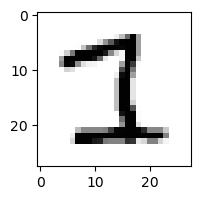

0.020663718276317893% - 0
0.20062067047449633% - 1
14.651592502955124% - 2
64.82467499342222% - 3 - ОШИБКА
0.22230664416252963% - 4
2.162792751138628% - 5
0.0023014840305619283% - 6
2.740267936645426% - 7
0.46081453365194425% - 8
0.0003295434139031587% - 9

 9


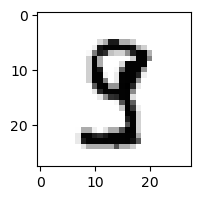

0.044593833745956726% - 0
0.06582264495562193% - 1
0.009212772823601686% - 2
37.08238698045707% - 3 - ОШИБКА
6.259125344557881% - 4
7.738168338611871% - 5
0.00034962676769979346% - 6
0.618946568577318% - 7
20.61471129178177% - 8
0.06898455595668804% - 9

 5


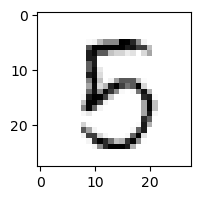

2.5693033670763543% - 0
0.038806568849269% - 1
1.58677312130336% - 2
11.779322893995262% - 3
22.550300291130153% - 4
44.7856372832074% - 5
0.8785908608356559% - 6
0.012356807450410881% - 7
60.58504004893403% - 8 - ОШИБКА
3.549930027242033% - 9

 4


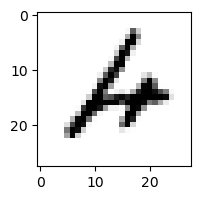

2.4772187949573534% - 0
0.042959620403997464% - 1
3.569515485386902% - 2
2.2622402320617776% - 3
9.880501215892647% - 4
0.1526457465198057% - 5
72.40978623180513% - 6 - ОШИБКА
0.04612601346278075% - 7
0.7770390326780071% - 8
3.3771748137404503% - 9

 3


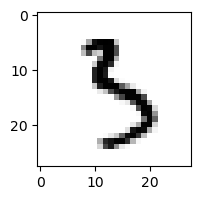

0.0770106538482833% - 0
0.06233176201649735% - 1
0.2121299362656533% - 2
50.4443281743157% - 3
4.562530742684253% - 4
64.2325445289206% - 5 - ОШИБКА
0.67458903399183% - 6
0.3328969929630715% - 7
14.37859878327838% - 8
3.6730756407319274% - 9

 2


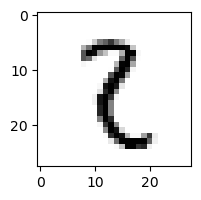

0.11963702545921269% - 0
41.68564023618199% - 1
2.872437754179984% - 2
23.178394728566083% - 3
0.10648213992264152% - 4
5.569251787692223% - 5
0.46690775233709253% - 6
0.17147629599690895% - 7
41.69637563896325% - 8 - ОШИБКА
1.6503883564680806% - 9

 9


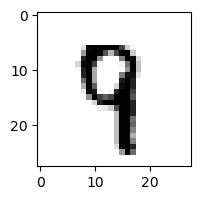

0.0004907452985535402% - 0
0.09119713319585636% - 1
0.23132832256128655% - 2
0.24489544921904427% - 3
23.881988661061065% - 4 - ОШИБКА
0.9700890554032946% - 5
0.13995788629447564% - 6
4.1714728963246825% - 7
1.4125043284262473% - 8
13.833667025871407% - 9

 8


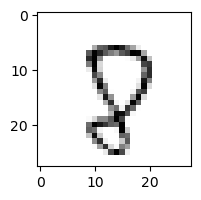

5.814714605419157% - 0
0.04011679044996799% - 1
9.485163672798175% - 2
1.5434841215173543% - 3
1.3786174500239619% - 4
33.844654211628445% - 5 - ОШИБКА
0.6705446333932693% - 6
25.937061094930193% - 7
24.183240291462607% - 8
22.778852944271772% - 9

 5


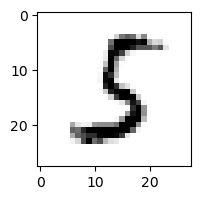

1.2641190584087836% - 0
1.2641390203469196% - 1
1.3365685758559807% - 2
61.23220945516553% - 3 - ОШИБКА
0.04205063011561827% - 4
49.19428645944022% - 5
5.5730054076406175% - 6
0.02511796689555243% - 7
2.38819081277588% - 8
0.004051796487672537% - 9

 8


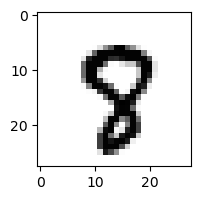

0.039549921932566894% - 0
0.000518300882282447% - 1
0.014338153517886722% - 2
0.02363933369716516% - 3
0.40975522163801914% - 4
8.616910048284778% - 5
0.002597409101550284% - 6
6.845027795755581% - 7
7.806997881175853% - 8
9.640385261103011% - 9 - ОШИБКА

 3


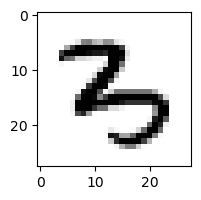

0.11274954975322911% - 0
0.003694751558656928% - 1
0.5599062577979955% - 2
1.766942646137598% - 3
46.99747490284368% - 4 - ОШИБКА
0.34634112439381515% - 5
0.6751317059508551% - 6
0.00918321107786799% - 7
0.020475070025177306% - 8
0.862876649331781% - 9

 8


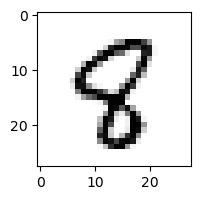

0.04712113427592585% - 0
0.09175967439694568% - 1
0.443208595004733% - 2
0.01888641388891873% - 3
22.853652463727784% - 4 - ОШИБКА
7.535300837549648% - 5
0.14316017191770525% - 6
0.10934374308476835% - 7
15.20623481179117% - 8
0.4425242806822554% - 9

 3


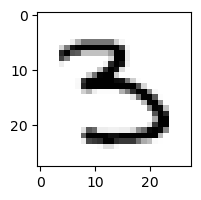

0.6104030060580827% - 0
0.10037476429045075% - 1
0.009257585779373245% - 2
69.86038271330474% - 3
1.0038179639463634% - 4
75.38593049612015% - 5 - ОШИБКА
0.038790585497272656% - 6
0.12885039970018883% - 7
0.2181308224878004% - 8
0.32596760632200916% - 9

 7


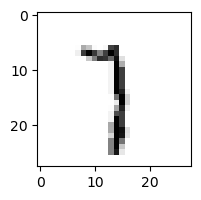

0.2133876979084188% - 0
63.0033331574616% - 1 - ОШИБКА
3.1984087900752614% - 2
20.291079541934366% - 3
0.7218993674956594% - 4
7.29772052258964% - 5
2.5531098592112134% - 6
39.77325460097146% - 7
6.109629939889758% - 8
8.941337451049542% - 9

 9


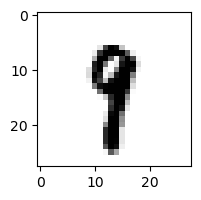

0.001908667194708121% - 0
17.37066822893853% - 1 - ОШИБКА
0.010391501186339526% - 2
0.40246597312992016% - 3
0.5947285166999896% - 4
5.905575939347813% - 5
0.06301947208947348% - 6
4.315361978762339% - 7
4.922990890752167% - 8
10.380613244094064% - 9

 9


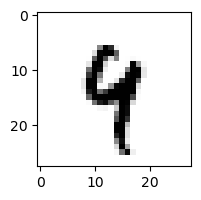

0.0010229288641561533% - 0
0.3990944469055092% - 1
0.13968201155479962% - 2
0.16129411527293086% - 3
71.57569220926706% - 4 - ОШИБКА
1.7181962015851453% - 5
1.010854293596288% - 6
1.30865354018516% - 7
7.012715489333375% - 8
52.87975508613617% - 9

 2


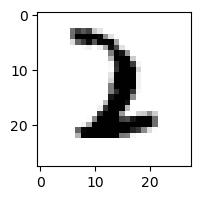

9.34321679152692e-05% - 0
16.57374023174205% - 1 - ОШИБКА
13.533798041771863% - 2
3.1226109197222782% - 3
0.0007871544039420591% - 4
0.02217727235609016% - 5
0.535984713075546% - 6
0.0654749579183302% - 7
0.002824984935257478% - 8
0.0022984682530784576% - 9

 5


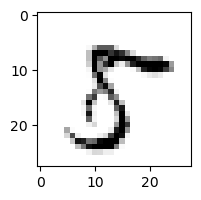

28.601788397788074% - 0
0.020240366274073086% - 1
0.16943141014593038% - 2
1.454246716674406% - 3
0.1791450675618594% - 4
36.15923485468564% - 5
0.006287172402085071% - 6
26.28625581995152% - 7
87.72423153305101% - 8 - ОШИБКА
3.8659454464802367% - 9

 9


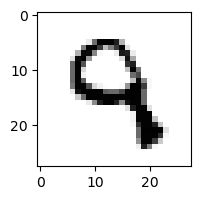

0.008951726658911386% - 0
0.0032937964928981918% - 1
10.53083911069374% - 2
11.145254443103438% - 3
49.96162084263908% - 4 - ОШИБКА
0.7795644075416375% - 5
0.8684768921280922% - 6
0.04535720059265766% - 7
0.03327125394105982% - 8
26.59727081385065% - 9

 3


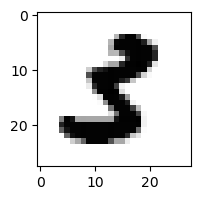

0.09635763624957942% - 0
0.17965153674980328% - 1
0.013082679477030727% - 2
1.768120881093082% - 3
0.0032705601529219993% - 4
31.467019397239792% - 5 - ОШИБКА
0.00010619854468280746% - 6
0.001587799617723529% - 7
0.03802735885550135% - 8
1.4635626561324322e-06% - 9

 8


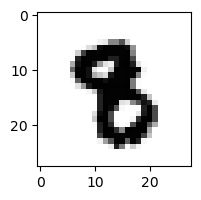

1.9758072315863997e-05% - 0
0.010653145121691087% - 1
0.00020655023116650204% - 2
0.07609136654317006% - 3
0.011128924589238722% - 4
1.5415136356503005% - 5 - ОШИБКА
0.020550519397927576% - 6
0.014063365065611786% - 7
0.1302407695450819% - 8
0.030701306764456083% - 9

 9


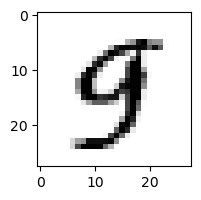

0.19444984933530388% - 0
0.007429562301717513% - 1
0.008011108485398417% - 2
0.43051909956150836% - 3
45.47122114109256% - 4 - ОШИБКА
1.611866301150849% - 5
0.06491336647800948% - 6
1.7882065709494748% - 7
0.473237024028308% - 8
15.074815486943038% - 9

 4


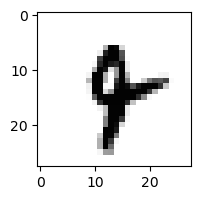

0.000780277346592661% - 0
1.3109990053301104% - 1
0.007197377548354905% - 2
0.00802390302376485% - 3
9.921144857257664% - 4
0.22865169965238258% - 5
3.914190226721173% - 6
2.2537343577199622% - 7
0.3300466150426244% - 8
42.59466970296196% - 9 - ОШИБКА

 3


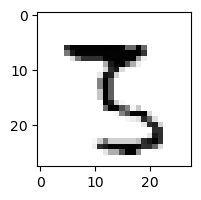

0.15315545095369146% - 0
0.14128414915508164% - 1
6.928460072904316% - 2
26.965359833202328% - 3
0.01092724675292761% - 4
21.03872029708897% - 5
0.01586472169814188% - 6
4.396087773193748% - 7
21.035231359929867% - 8
52.7268900548612% - 9 - ОШИБКА

 3


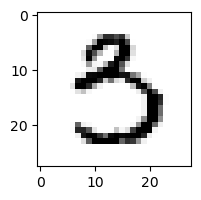

4.648291798014054% - 0
0.027527961475958197% - 1
0.009904002864829254% - 2
28.15633381539519% - 3
0.028841700171115082% - 4
42.74844520601437% - 5 - ОШИБКА
0.055503094431869016% - 6
0.6320745469553167% - 7
0.18999129943668147% - 8
0.021182085788490873% - 9

 5


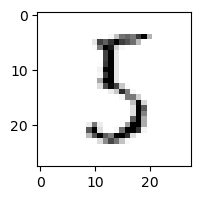

5.845747202419738% - 0
2.5688587781517134% - 1
4.341290336836207% - 2
72.5577041839231% - 3 - ОШИБКА
0.7726953994511349% - 4
65.83818382268501% - 5
10.215343623516365% - 6
0.5496727595984241% - 7
18.450689206086075% - 8
0.1114196967013276% - 9

 5


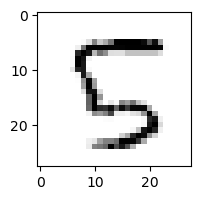

1.7841524905923671% - 0
0.048648916319096756% - 1
25.090974117079217% - 2
0.2319834332102452% - 3
42.78565491446135% - 4 - ОШИБКА
18.557164773670927% - 5
0.436844292274314% - 6
0.0683530880161823% - 7
18.919354648509856% - 8
0.09139703441627453% - 9

 6


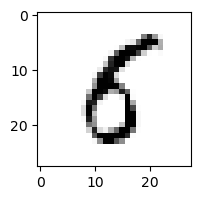

31.947880735273827% - 0
0.3225924456292046% - 1
0.05272131851819627% - 2
3.5341831079226353% - 3
1.6364096625781304% - 4
62.97876501763477% - 5 - ОШИБКА
6.657870670427226% - 6
0.018231836489457847% - 7
18.27577364372253% - 8
1.3843227591389988% - 9

 0


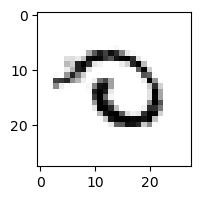

0.905112453437688% - 0
0.04003973653855862% - 1
6.40020204883893% - 2
0.6940886994123907% - 3
0.6153277059155143% - 4
2.345445525037166% - 5
25.295534367815474% - 6
1.5592677822671537% - 7
8.462537948652685% - 8
25.573088528705334% - 9 - ОШИБКА

 8


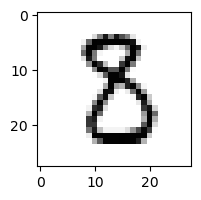

0.3999691534495424% - 0
0.24544537737618977% - 1
1.6704912590346392% - 2
21.103904558571898% - 3 - ОШИБКА
0.02807703819958043% - 4
13.025688881732345% - 5
0.03702719453108646% - 6
0.02888082714319758% - 7
8.569553077732769% - 8
0.0025977290517905627% - 9

 4


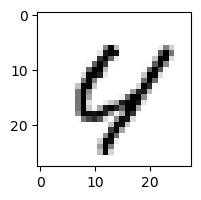

2.9278127129529654% - 0
0.002930752114253604% - 1
0.37961731166221546% - 2
0.00021581297467219448% - 3
38.24091815257528% - 4
1.2919541663388348% - 5
8.72331769890317% - 6
13.313827234355715% - 7
40.22994038672142% - 8 - ОШИБКА
25.838719427806332% - 9

 5


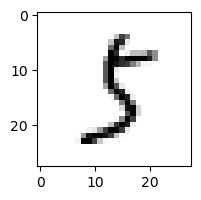

4.0499871290696685% - 0
6.634604738839402% - 1
1.6844401134738098% - 2
61.39157016381711% - 3 - ОШИБКА
0.09854340326358828% - 4
19.258688652456556% - 5
0.33777846641613596% - 6
6.213457100940802% - 7
3.967237172853677% - 8
0.7134948459953027% - 9

 8


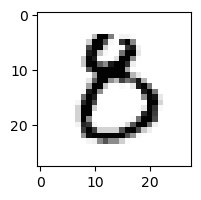

24.280801561171756% - 0
0.0020592426705740305% - 1
0.10511095437637974% - 2
5.814996997785785% - 3
0.08841982976945105% - 4
33.57253224286564% - 5 - ОШИБКА
0.6564814565699103% - 6
0.11806963497506887% - 7
0.11630966785850926% - 8
0.007916721923027928% - 9

 5


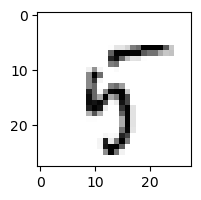

1.477463317660066% - 0
1.9942493053606416% - 1
0.7214806111931941% - 2
0.18237469442585172% - 3
22.15736456144851% - 4
11.452301785129157% - 5
1.9948597645212278% - 6
0.24725360452037848% - 7
47.972982717761% - 8
65.32704302995774% - 9 - ОШИБКА

 9


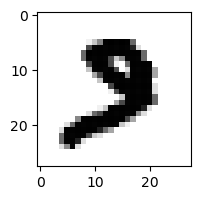

0.011359759694363732% - 0
0.003288360323302432% - 1
0.9058664409565459% - 2
0.5997558361074559% - 3
0.00027768225062943877% - 4
0.03201818821727377% - 5
0.001498440180280083% - 6
6.4889557334907835% - 7 - ОШИБКА
0.004878541909417505% - 8
0.006059387369006288% - 9

 8


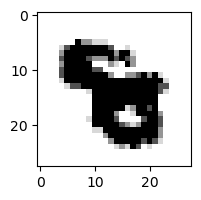

1.5636759016145416e-06% - 0
3.1027216709708615e-05% - 1
2.0596806904715426e-05% - 2
0.00010194072507653125% - 3
0.42160726973375934% - 4
0.0061478304147503686% - 5
1.323585071504839% - 6 - ОШИБКА
0.00137628466793315% - 7
0.013865033358320253% - 8
0.032019300396049145% - 9

 9


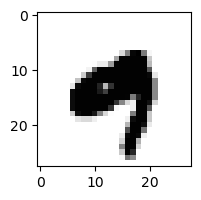

0.01585534288374318% - 0
0.008968365885519356% - 1
6.8756989660748124e-06% - 2
0.0067363604039766475% - 3
69.1940969451711% - 4 - ОШИБКА
0.0003805653984747762% - 5
0.10477040470212592% - 6
0.004814559132486077% - 7
0.001097295577893947% - 8
26.93345480325751% - 9

 5


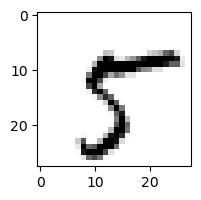

1.1995676935613526% - 0
0.1933893146399514% - 1
0.0020463075561623213% - 2
0.1511758622743061% - 3
2.2662899741578917% - 4
86.80762361370292% - 5
0.003434398726034687% - 6
87.7987573284969% - 7 - ОШИБКА
9.943877630741648% - 8
0.11206894330079427% - 9

 8


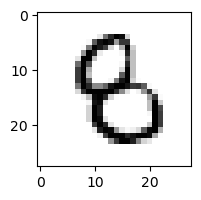

0.3786055621728279% - 0
0.0761834896005881% - 1
0.5464011333512261% - 2
1.8813648519094153% - 3
1.4856899789939395% - 4
10.281348339209877% - 5 - ОШИБКА
4.214581529912048% - 6
0.003381041514812555% - 7
3.7094411168496517% - 8
0.1632196464582639% - 9

 8


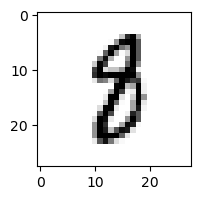

0.050434673781775914% - 0
2.9607080019763488% - 1 - ОШИБКА
0.19273989078470188% - 2
0.43504257986046535% - 3
0.20962448265014663% - 4
2.340298631405974% - 5
0.367163357477505% - 6
2.071295198367138% - 7
2.2902041297424813% - 8
0.043596403889325085% - 9

 5


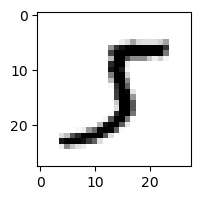

0.3974919449829639% - 0
44.04804070132062% - 1 - ОШИБКА
0.6142129838048065% - 2
30.20169991861239% - 3
0.09303868165909561% - 4
8.111484639319857% - 5
0.04559874604679245% - 6
3.342358464987412% - 7
0.04202105221783243% - 8
0.27306062620013094% - 9

 8


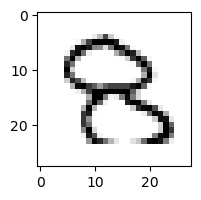

3.321829705613012% - 0
0.012142390254386768% - 1
25.743931403676267% - 2
43.86870507829371% - 3 - ОШИБКА
5.029518537480648% - 4
0.5319234942418787% - 5
0.1311463679831425% - 6
0.014059581439471332% - 7
1.8168488526377944% - 8
24.331153540839107% - 9

 8


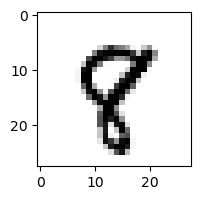

0.01002122703912856% - 0
0.6761086528375202% - 1
0.06771634371702144% - 2
0.00978144273384834% - 3
0.6859299184711292% - 4
1.1340136420472304% - 5
0.014419258938876304% - 6
3.313516126881567% - 7
9.463178656102416% - 8
16.38927422047817% - 9 - ОШИБКА

 8


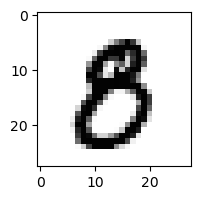

3.55388082004918% - 0
0.0009043903571206673% - 1
0.0024349036787475113% - 2
3.9381647857889375% - 3
0.03665056966133709% - 4
14.692878186833475% - 5 - ОШИБКА
0.0011566275131088537% - 6
0.010543573241057777% - 7
0.6610341697201879% - 8
0.17551475699988217% - 9

 5


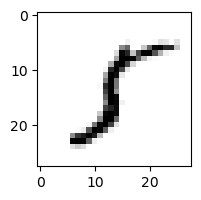

1.6036596569838806% - 0
94.33178239083068% - 1 - ОШИБКА
2.3673182506096424% - 2
3.9616800584093546% - 3
0.14776613605627867% - 4
51.14235231103497% - 5
0.41954980317885704% - 6
1.4651071991231361% - 7
2.339766604632364% - 8
0.34718434984908086% - 9

 9


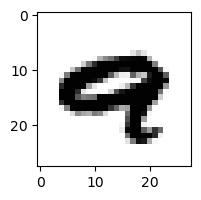

0.1538480356470826% - 0
0.00028499660699545686% - 1
1.236155621406079e-05% - 2
8.130501515055565e-06% - 3
71.5292178459053% - 4 - ОШИБКА
5.766144292701866e-05% - 5
0.11493361846239442% - 6
0.6346888688144363% - 7
0.00210864913180015% - 8
7.314685066829198% - 9

 8


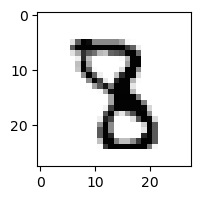

0.0001527442045622866% - 0
0.04113783568679633% - 1
0.22403149287989282% - 2
6.842291046050396% - 3 - ОШИБКА
1.3400043631414549% - 4
0.46031393970414164% - 5
0.003995939937555489% - 6
0.3357052740109309% - 7
0.40329593221422755% - 8
0.31773474077450164% - 9

 9


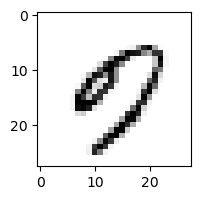

70.28272933553774% - 0 - ОШИБКА
0.016027071089429006% - 1
0.006058760423618237% - 2
0.6787282923277292% - 3
23.799736492733683% - 4
7.24433833084686% - 5
8.825424809168178% - 6
0.9919173842752659% - 7
2.6451411851881237% - 8
12.17192889358629% - 9

 2


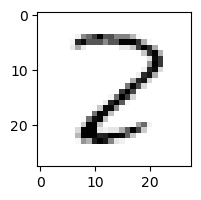

2.1317531092349493% - 0
3.943156531728708% - 1
78.30377016832225% - 2
1.850201917359972% - 3
1.2971539437060045% - 4
1.0133450935065025% - 5
0.7381244767725146% - 6
0.41038745097778395% - 7
89.78968868048888% - 8 - ОШИБКА
0.0044379237135315506% - 9

 2


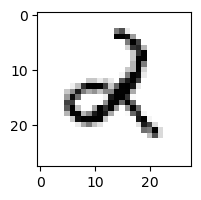

0.1413306744236864% - 0
1.479841379446815% - 1
19.81108554788129% - 2
0.20351889681822716% - 3
58.34902830913645% - 4 - ОШИБКА
0.10136337731830765% - 5
6.429812265111641% - 6
0.01640084063619004% - 7
2.376374959595779% - 8
2.2948563498704484% - 9

 2


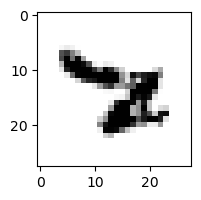

0.0017764508050460816% - 0
0.014293488981377315% - 1
0.0019668781759217355% - 2
0.017988374447896673% - 3
10.72343302577078% - 4
0.7071553265691181% - 5
50.45521718510133% - 6 - ОШИБКА
14.463867328031979% - 7
0.17284930148531852% - 8
0.17086024281641055% - 9

 5


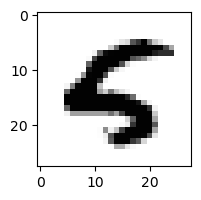

0.25316642961098745% - 0
0.0002978216849746277% - 1
0.006877656952020875% - 2
7.527755290731893e-06% - 3
53.92160272886374% - 4 - ОШИБКА
1.9852545092757574% - 5
0.026929454114812918% - 6
0.00025439303694814143% - 7
0.012911191258940325% - 8
0.5046368193485858% - 9

 2


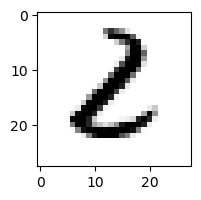

6.740110838266363% - 0
1.0515334849662747% - 1
12.641017174602553% - 2
26.658332079984188% - 3 - ОШИБКА
0.008115366412241965% - 4
4.232519159146569% - 5
0.9308578060494609% - 6
0.0004019077230683904% - 7
1.4147695295734806% - 8
0.002312307786582941% - 9

 7


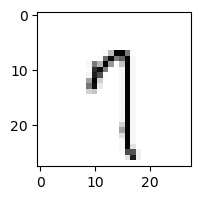

4.4472955221954225% - 0
2.310204400576427% - 1
1.7221467823642207% - 2
5.130543280124678% - 3
16.437670976839343% - 4
25.090305198838237% - 5
7.346598201351687% - 6
58.48090627037115% - 7
21.689137093256416% - 8
94.01696727821994% - 9 - ОШИБКА

 1


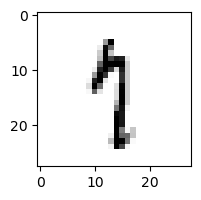

0.5984351564665288% - 0
16.15163207074933% - 1
0.23999494266215238% - 2
0.8661258243799655% - 3
13.44426197532545% - 4
21.742432489197267% - 5
3.15106086588825% - 6
44.61621264053968% - 7 - ОШИБКА
7.335803460003778% - 8
11.420564077570871% - 9

 2


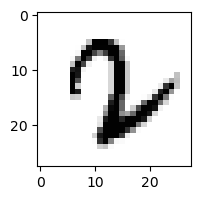

0.002833159105142472% - 0
2.493758383145079% - 1
0.045182828557357384% - 2
2.2220630930422662% - 3
0.00767405721912883% - 4
0.03888176570152414% - 5
3.9519919080697976% - 6 - ОШИБКА
0.49971386728150485% - 7
0.0023298130064086375% - 8
0.0021953114929122576% - 9

 6


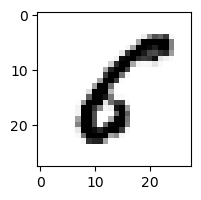

27.822948813878632% - 0
2.625627974310078% - 1
0.39731654320888515% - 2
0.14361619896692163% - 3
1.1498871758854536% - 4
85.26830282093307% - 5 - ОШИБКА
0.38174236881116586% - 6
0.013825294510525398% - 7
1.241697691744311% - 8
0.0020801634750075293% - 9

 1


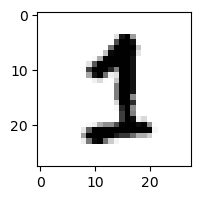

0.038282672084209976% - 0
0.10630493714906152% - 1
0.18393473546900937% - 2
1.5202142046579947% - 3
0.009672985860319405% - 4
2.5547844628007708% - 5
0.038578217596413146% - 6
3.736333066728275% - 7 - ОШИБКА
0.10518598021569227% - 8
0.06817209000691432% - 9

 9


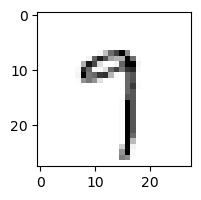

1.383270193328424% - 0
0.6827162328470322% - 1
0.7840586757492154% - 2
6.498258694243289% - 3
5.072879108322468% - 4
19.945168951508137% - 5
1.8196604943158858% - 6
86.01471794023476% - 7 - ОШИБКА
10.961708590933931% - 8
59.62214990208449% - 9

 7


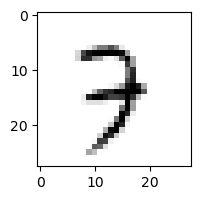

0.037584611597011916% - 0
0.19121186297767542% - 1
12.281440852477248% - 2
57.06308190583166% - 3 - ОШИБКА
11.461144285580069% - 4
1.6744629894581005% - 5
3.9243469980338923% - 6
16.115403046441177% - 7
6.238068703538906% - 8
40.99470993222839% - 9

 6


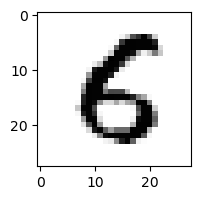

11.637742749236962% - 0
0.003603636128277753% - 1
0.03981325208594707% - 2
0.03448488841148983% - 3
1.1822955769928316% - 4
36.41363488744536% - 5 - ОШИБКА
13.121505481604126% - 6
0.0002105251758643299% - 7
0.24305121882097044% - 8
0.05582994064233818% - 9

 2


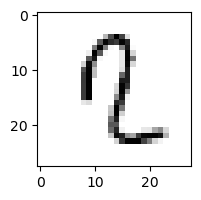

0.15348882650617146% - 0
7.860744014605041% - 1
2.566089370152307% - 2
0.4277918704918153% - 3
36.46622781607138% - 4 - ОШИБКА
11.3960116990612% - 5
0.9651076212140024% - 6
2.639716785413762% - 7
2.122237262120964% - 8
2.2813565275462757% - 9

 5


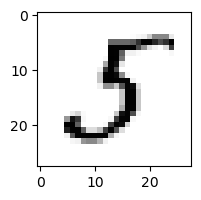

0.42584436908340045% - 0
2.133491566528309% - 1
1.8009105885477255% - 2
50.149979743117036% - 3 - ОШИБКА
0.2236304152539592% - 4
37.9986241625045% - 5
1.1299049018125003% - 6
0.4088192364482583% - 7
0.595168575166388% - 8
0.22021621116602008% - 9

 5


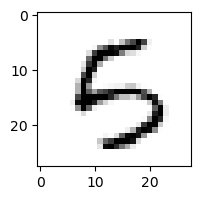

4.442969361235641% - 0
0.014718950862200415% - 1
1.5817802342533505% - 2
1.0906335932221733% - 3
33.727247168974365% - 4 - ОШИБКА
17.61380221403992% - 5
3.2218763135606987% - 6
0.01635194791204709% - 7
7.208350349050803% - 8
16.044820839966928% - 9

 4


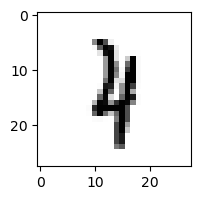

0.002184004807866118% - 0
16.163614997285798% - 1
3.778430206333249% - 2
1.605719533185487% - 3
15.124405836333194% - 4
0.1798974810805883% - 5
3.931378793442111% - 6
5.2470968605375345% - 7
20.781816646382502% - 8 - ОШИБКА
6.256697766406667% - 9

 5


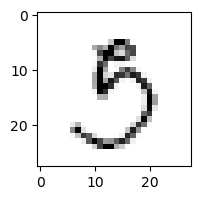

13.708216501612174% - 0
0.4137332853823922% - 1
0.44003653140819843% - 2
86.52177675837804% - 3 - ОШИБКА
0.2867190237007497% - 4
51.14150732601792% - 5
0.22043668455503737% - 6
1.8322612859310112% - 7
35.47923198089417% - 8
12.34647199593291% - 9

 9


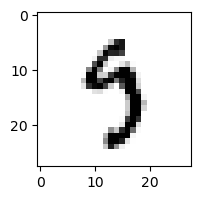

0.14752784315308773% - 0
0.09767702046065094% - 1
0.007186858293999521% - 2
23.093765577158447% - 3
20.096754904417878% - 4
32.05832876689859% - 5 - ОШИБКА
0.9734453488349967% - 6
5.462632681105411% - 7
5.717731058412339% - 8
5.154105966880132% - 9

 2


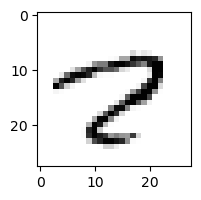

19.606508684773345% - 0
0.2773617889762706% - 1
0.03164111749814111% - 2
0.005319195781593781% - 3
2.5939237713484435% - 4
3.1761040596260552% - 5
0.03484784382543202% - 6
94.33412999825609% - 7 - ОШИБКА
8.37424539442653% - 8
0.4182728898158735% - 9

 9


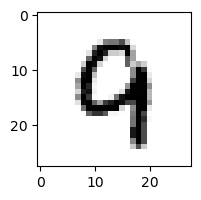

0.07241578509992434% - 0
0.0024241565510901646% - 1
2.027057885151366% - 2
0.016410317960916177% - 3
67.74212038533844% - 4 - ОШИБКА
0.0327429204333479% - 5
3.0386396497509316% - 6
0.8183367208568718% - 7
1.0218958006766292% - 8
60.226049578685405% - 9

 7


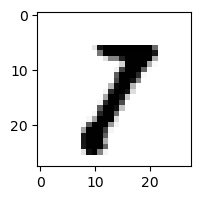

0.08048558959088231% - 0
47.18084449128543% - 1 - ОШИБКА
1.4442242433755268% - 2
8.960547212479902% - 3
0.008715583801695504% - 4
0.18821135572562325% - 5
0.0008190350662277846% - 6
5.866901449871506% - 7
0.9568622982056111% - 8
1.1956783468239969% - 9

 5


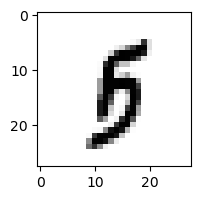

0.03528557566451795% - 0
0.8328954445726889% - 1
0.049072057335966784% - 2
8.242112635708871% - 3
0.5030603157758867% - 4
3.8271343974348797% - 5
1.8197957153277364% - 6
0.25290556582324625% - 7
17.15045858652364% - 8 - ОШИБКА
12.776628604922053% - 9

 5


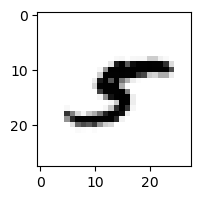

0.13428022006741136% - 0
31.39642244045894% - 1 - ОШИБКА
0.4199688731139411% - 2
2.00450577788005% - 3
1.1084513376032068% - 4
0.8457181951883672% - 5
0.1515957968152001% - 6
2.304308954450084% - 7
27.98083639375691% - 8
0.2998562032610653% - 9

 3


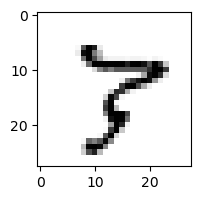

0.07128354908213287% - 0
1.0661206858512853% - 1
0.7644558644547026% - 2
0.31873435492794205% - 3
0.8695650030375368% - 4
0.09000922643718882% - 5
0.11943253849304632% - 6
95.30195931488568% - 7 - ОШИБКА
51.764375100630055% - 8
0.9286577464378415% - 9

 5


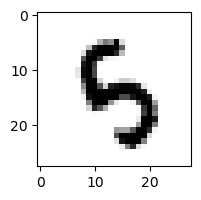

0.004611823368588422% - 0
0.009452892328790858% - 1
0.13670033772262122% - 2
1.7984528886920057% - 3
49.80921746021097% - 4 - ОШИБКА
30.905837659167624% - 5
4.811440224345204% - 6
0.00235953049753059% - 7
3.2721887159356595% - 8
23.157423006027827% - 9

 3


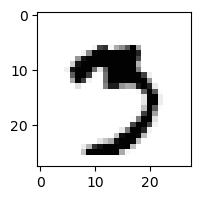

0.0913783907559035% - 0
0.029808497207667106% - 1
0.00018797242559856638% - 2
10.631105288637439% - 3
0.00036915562340344554% - 4
3.0141152587852678% - 5
0.002070317943458448% - 6
77.70656132820324% - 7 - ОШИБКА
0.2923206454308433% - 8
8.727825818956163% - 9

 5


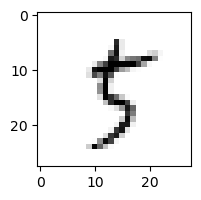

2.8266250694304142% - 0
2.3181197696456706% - 1
0.6229094713975402% - 2
6.140359613855327% - 3
3.1684304898902047% - 4
46.34275580397358% - 5
0.474763757254636% - 6
28.13745591622941% - 7
50.65955807939903% - 8 - ОШИБКА
6.244929806257598% - 9

 9


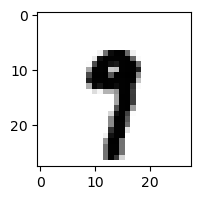

0.001465948988402124% - 0
0.5356592367710274% - 1
0.00024280370986135488% - 2
0.15573065670415576% - 3
0.6846235836728829% - 4
2.521438285249441% - 5
0.043091890756089456% - 6
45.59098765774243% - 7 - ОШИБКА
0.3568172049215516% - 8
8.277735643462949% - 9

 5


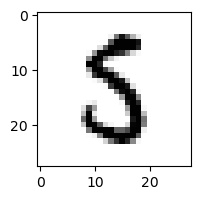

0.7707284486749425% - 0
0.040789747328803215% - 1
0.6698470474078492% - 2
3.627995614566241% - 3
0.061488524479006934% - 4
54.28569037563631% - 5
2.2360780928791195% - 6
0.04419300494064848% - 7
60.989988520814265% - 8 - ОШИБКА
0.03890201585343037% - 9

 2


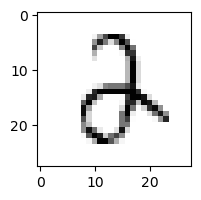

1.8898842506260747% - 0
0.053743984653074645% - 1
46.512367754768995% - 2
68.92921714186149% - 3 - ОШИБКА
17.76360003931689% - 4
1.083962881012482% - 5
1.1229664676871378% - 6
0.2621295250171991% - 7
0.5668154539943748% - 8
0.23516830440055847% - 9

 9


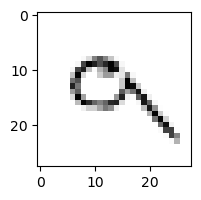

1.0645683191384359% - 0
5.453784841090612% - 1
1.825482898213778% - 2
0.364803522024493% - 3
64.35277356251717% - 4 - ОШИБКА
5.721556341031469% - 5
41.41129915232307% - 6
38.22539486298964% - 7
9.13997062474297% - 8
63.42580661102475% - 9

 5


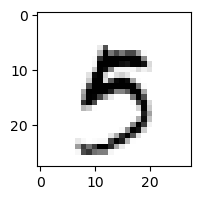

0.7942294236138178% - 0
0.024923232659604246% - 1
0.0015925572584552872% - 2
9.985667618304934% - 3
3.659061511068941% - 4
23.52661409004509% - 5
0.07053458553254133% - 6
0.7483376969806464% - 7
0.09157221561824676% - 8
67.90034502690402% - 9 - ОШИБКА

 5


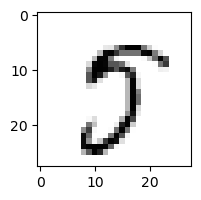

4.651259434941003% - 0
0.028051241407871273% - 1
0.0679398326994143% - 2
3.321802945144131% - 3
0.4130518444342994% - 4
57.16201324169627% - 5
0.05002356827883383% - 6
86.04579080636184% - 7 - ОШИБКА
11.61289958150778% - 8
2.9455051683846833% - 9

 5


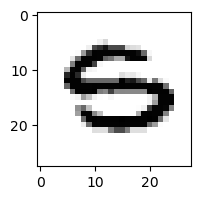

2.157354796110436% - 0
0.0007985334149561835% - 1
0.006432290262914295% - 2
0.29512819568626564% - 3
0.006897257339531709% - 4
0.7635978652370348% - 5
54.71170659154269% - 6 - ОШИБКА
0.005510873003580478% - 7
0.0142116390234921% - 8
2.355974454533386% - 9

 8


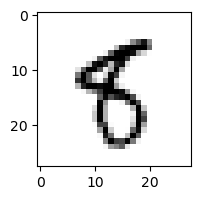

0.38318472417068433% - 0
0.1996630717174958% - 1
0.006380676404858076% - 2
0.0907870957163046% - 3
0.22671541850469806% - 4
53.10463720802876% - 5 - ОШИБКА
4.034748643228737% - 6
0.01995615962481714% - 7
40.72121231951763% - 8
29.61643616956558% - 9

 9


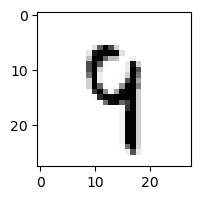

0.006806952912303146% - 0
0.09910600936355383% - 1
2.3616112642389995% - 2
3.062167943239931% - 3
69.3707889520552% - 4 - ОШИБКА
6.497641703759369% - 5
1.9424300079723889% - 6
5.024380085876728% - 7
19.18077966747464% - 8
41.012490112126756% - 9

 2


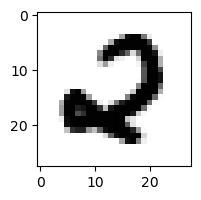

56.89984799591361% - 0 - ОШИБКА
0.0007432568080351421% - 1
39.668666141021006% - 2
0.0003393128151244165% - 3
0.3424220832108218% - 4
0.0005251344810908638% - 5
0.4526299447735514% - 6
0.010318329193751214% - 7
0.007793466622168241% - 8
0.0003331463287628903% - 9

 7


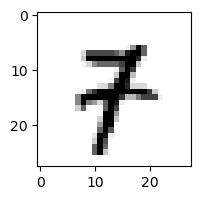

0.018662745396293756% - 0
2.6516539519901206% - 1
0.39913327520240405% - 2
0.742588464619888% - 3
1.5268212250985564% - 4
0.2317608252486772% - 5
0.156538153169355% - 6
3.661301246717663% - 7
0.031048006892244975% - 8
15.740197413011161% - 9 - ОШИБКА

 9


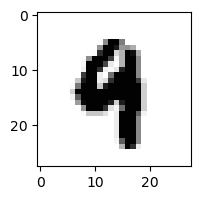

0.0004013569830300053% - 0
0.008518705928443712% - 1
0.0010505294095763359% - 2
0.007675067695308567% - 3
39.48884281255251% - 4 - ОШИБКА
0.05189110008379736% - 5
0.06434843937967998% - 6
0.003825696416795893% - 7
0.027659459015483355% - 8
16.164078922338497% - 9

 2


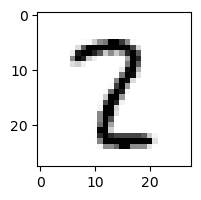

0.020230168949315147% - 0
18.7299433673775% - 1
6.78362960797394% - 2
9.290143780786538% - 3
0.49028915774167525% - 4
0.5756429374033658% - 5
0.0062465876746638305% - 6
2.795709777948976% - 7
47.22955161781881% - 8 - ОШИБКА
0.06642729085364442% - 9

 7


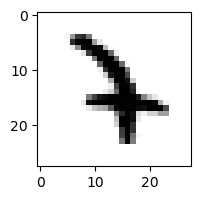

6.834949256777116e-05% - 0
1.694359642688286% - 1
1.3650799823161432% - 2
8.190331585790293% - 3
12.31749149762908% - 4 - ОШИБКА
0.04506680259188863% - 5
0.9861473011048231% - 6
1.372683732411208% - 7
0.004750181399758486% - 8
0.10250545067637762% - 9

 8


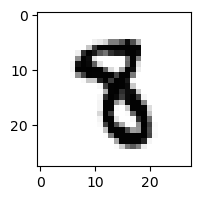

6.823430317737234e-05% - 0
0.09775706599282726% - 1
0.006777654147222465% - 2
0.399062657995357% - 3
0.25384839096210443% - 4
5.21962494867279% - 5 - ОШИБКА
0.03373525111087928% - 6
0.039617893539198146% - 7
2.0908698437946507% - 8
0.06298046868879086% - 9

 3


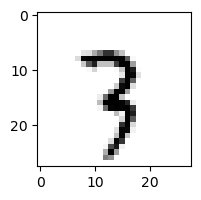

0.0030405865243839023% - 0
13.710169724196234% - 1
6.959483272664703% - 2
1.3077384685620819% - 3
4.300799142388052% - 4
0.7073948345632691% - 5
0.4062715589637155% - 6
70.9255895601981% - 7 - ОШИБКА
13.749827319888064% - 8
9.336096135210443% - 9

 6


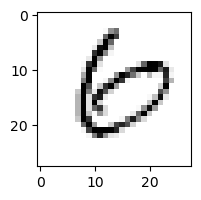

45.968809019554975% - 0 - ОШИБКА
0.03641621899544724% - 1
0.796008109053431% - 2
4.704497671294268% - 3
1.0454580085386307% - 4
1.7972767928261968% - 5
22.88051756908903% - 6
0.0771704318571242% - 7
18.02310174186627% - 8
0.4020234168934534% - 9

 2


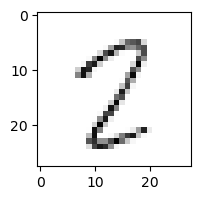

4.637339719478872% - 0
10.7961692383111% - 1
11.0194929774083% - 2
1.4826170096505893% - 3
5.061423784540715% - 4
27.95501634484234% - 5
0.6901801441774543% - 6
33.573275669812986% - 7
85.3485353480659% - 8 - ОШИБКА
2.3266856430176177% - 9

 9


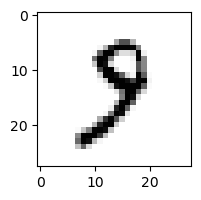

0.1506856414765531% - 0
3.0737303738761583% - 1
1.2409312361306453% - 2
5.212701545293796% - 3
0.38769242912719154% - 4
2.970279650371159% - 5
0.17953565525950996% - 6
19.60606870727371% - 7 - ОШИБКА
1.3056277789386517% - 8
2.759927487813561% - 9

 8


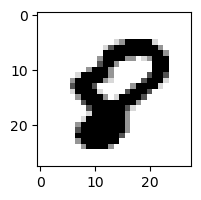

4.66054940427319% - 0 - ОШИБКА
0.00015239395595397892% - 1
0.0003811710374055877% - 2
2.3619931705222085e-07% - 3
0.19116103766573267% - 4
0.8494637301479948% - 5
0.10025584919948402% - 6
0.016417508934104767% - 7
1.2121826368630313% - 8
0.01638362634211987% - 9

 5


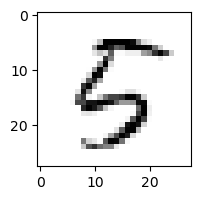

2.83015634074237% - 0
0.05619687460680639% - 1
1.6148610467021076% - 2
0.25760337220548213% - 3
74.20969773707857% - 4 - ОШИБКА
6.021191954596799% - 5
2.3286853284984144% - 6
0.06380860845237227% - 7
9.97330097409283% - 8
0.1724666384558442% - 9

 0


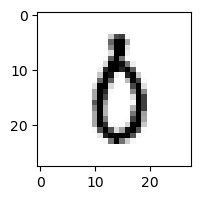

1.953839784894706% - 0
0.10924615708599557% - 1
0.7490199904285666% - 2
14.899973170363461% - 3
0.3752257831091152% - 4
5.4189936122716995% - 5
27.46775330963036% - 6 - ОШИБКА
0.8095116275286123% - 7
4.725841307432659% - 8
0.6068095712724444% - 9

 8


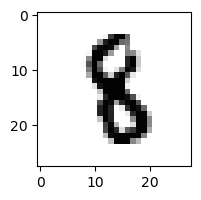

0.00021652003225775758% - 0
0.3763347620275937% - 1
0.09071208564101345% - 2
0.5277318346919463% - 3
0.739000894361723% - 4
6.398743955532939% - 5 - ОШИБКА
0.17136513407386916% - 6
0.010819635785065986% - 7
4.6257096981445205% - 8
0.0171724990637993% - 9

 9


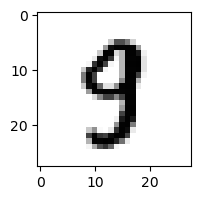

0.07501163223627143% - 0
0.015240080076624264% - 1
0.02774315660801502% - 2
2.7063942044533773% - 3
2.883204843593969% - 4
3.1668336330632685% - 5 - ОШИБКА
0.005674518055050497% - 6
1.8313697762922239% - 7
2.7159880229169566% - 8
2.6117357450430867% - 9

 8


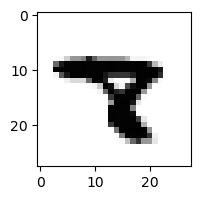

0.0001045438501976556% - 0
0.02299756882343574% - 1
0.0003813688607260009% - 2
0.0006166164658223846% - 3
3.471262568399284% - 4
0.07990855186429424% - 5
0.02050428729513649% - 6
48.98101411634651% - 7 - ОШИБКА
0.9194370439977639% - 8
0.17938497295022357% - 9

 7


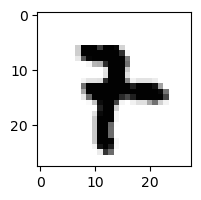

0.0014122972371976336% - 0
0.2550668210525893% - 1
0.0032902827730093734% - 2
0.5126061089163836% - 3
0.18855042684610243% - 4
0.38525995926354223% - 5
3.5003141487992253% - 6 - ОШИБКА
0.25119805438927045% - 7
0.05495403328777651% - 8
2.300714863245237% - 9

 9


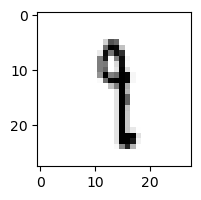

0.19126533790335143% - 0
61.886792723228666% - 1 - ОШИБКА
0.5702057139345531% - 2
30.911864234404906% - 3
2.2967316999738143% - 4
10.07545818991508% - 5
1.457053868056184% - 6
10.618909444741364% - 7
23.803890816500132% - 8
33.489189398192906% - 9

 9


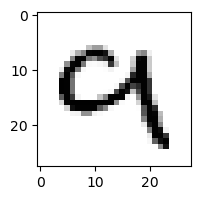

0.4049242708428936% - 0
0.04397582233629636% - 1
12.055076396794052% - 2
1.7683564676785186% - 3
30.440878694327512% - 4 - ОШИБКА
0.00413858942079858% - 5
0.43598530000017627% - 6
11.255144249389232% - 7
1.2961206306449762% - 8
29.90129147513658% - 9

 2


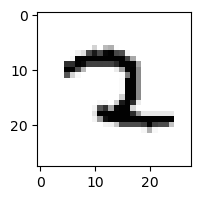

0.0016854709834428377% - 0
0.040933372597252125% - 1
72.18492902722893% - 2
0.1370689030466447% - 3
0.10682018660936475% - 4
0.11808278239913675% - 5
0.6270040669923367% - 6
88.06607433884793% - 7 - ОШИБКА
0.23198364204840144% - 8
2.2268966396120984% - 9

 8


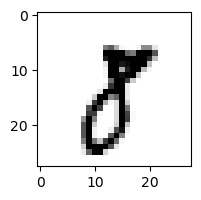

0.4985525734024775% - 0
18.757920650585472% - 1 - ОШИБКА
0.11929064127289449% - 2
17.70679327817753% - 3
0.003090392855753993% - 4
0.42936520966998254% - 5
0.0013185082928074373% - 6
3.3606778377640962% - 7
2.967763734379294% - 8
1.9328730499772167% - 9

 7


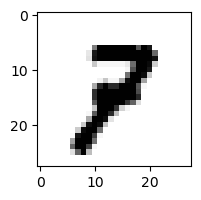

0.04001093422425045% - 0
0.35814055069460066% - 1
7.6546788215698225% - 2
3.3730540831105578% - 3
0.08480040234757602% - 4
0.13394966639506034% - 5
0.003971393676462043% - 6
0.23102276030188243% - 7
6.980315595612442% - 8
23.940056631211114% - 9 - ОШИБКА

 3


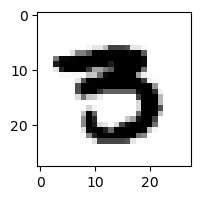

0.14208232653699435% - 0
9.955885537984176e-05% - 1
1.3292675146599249e-05% - 2
3.022654044509155% - 3
0.0008555307895604673% - 4
9.2744447304794% - 5 - ОШИБКА
0.0024742332764524037% - 6
0.29656411825320195% - 7
0.0018267943603225002% - 8
0.005655936318865681% - 9

 6


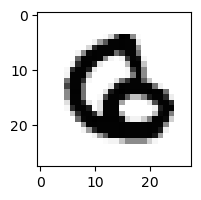

0.01040511637299201% - 0
0.000512684501353013% - 1
0.9847048735833123% - 2 - ОШИБКА
9.001532872747097e-05% - 3
0.009498884971451904% - 4
0.001299102104469633% - 5
0.34738106934929264% - 6
0.0009489118286495457% - 7
0.0011823122139902867% - 8
0.00027420210077989596% - 9

 8


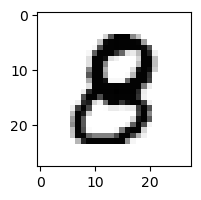

0.0874002015132053% - 0
0.00020398014456438285% - 1
0.28694847745761937% - 2
0.7511336093436952% - 3
4.032195449481293% - 4 - ОШИБКА
1.52197433640891% - 5
0.0015633744543010186% - 6
0.00023712504026245716% - 7
3.973829734954197% - 8
0.0393019780458891% - 9

 4


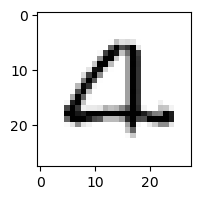

5.080619309882325% - 0
0.0015390346707905651% - 1
47.22888493963396% - 2 - ОШИБКА
0.020105181787049967% - 3
1.1600116208812385% - 4
0.14120270557081818% - 5
0.8614166807832141% - 6
1.2734252481698247% - 7
0.030319497493272896% - 8
8.875341355312639% - 9

 5


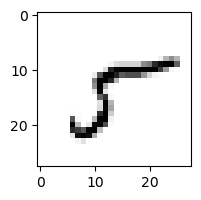

27.145895597947135% - 0
9.3816458749483% - 1
2.1657184971474326% - 2
19.05507226315301% - 3
1.2702653527575467% - 4
64.29469008308581% - 5
1.9482065329866678% - 6
8.19417292616779% - 7
80.43408763908222% - 8 - ОШИБКА
1.1331308255621806% - 9

 5


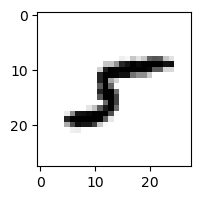

5.703186133873062% - 0
12.980347771845427% - 1
4.568048123704519% - 2
1.1263966861949608% - 3
0.5230819753182409% - 4
10.767352303674418% - 5
0.2586263714386385% - 6
1.5870862014659044% - 7
94.48010641008476% - 8 - ОШИБКА
0.5233295499560201% - 9

 8


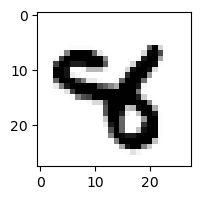

1.4755805584260991e-05% - 0
0.002958657041636758% - 1
0.005670596702994277% - 2
0.0074814735456756485% - 3
94.72560073529547% - 4 - ОШИБКА
0.11542898920556084% - 5
0.004043245642426174% - 6
0.24727895189487706% - 7
0.03228445139276609% - 8
0.032088174919683944% - 9

 2


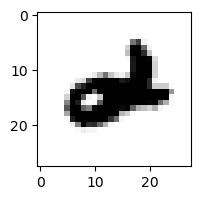

0.10005017503961562% - 0
0.02802522941538144% - 1
0.009044848277454297% - 2
0.0029290714949492215% - 3
96.58127087510351% - 4 - ОШИБКА
0.0002767527032684534% - 5
1.7492785044040349% - 6
0.00452709598714996% - 7
0.015018448384703575% - 8
1.1174292512485846% - 9

 6


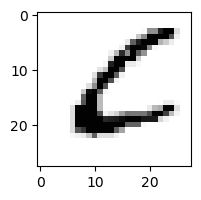

90.91276262539967% - 0 - ОШИБКА
0.03974207463078854% - 1
10.68250220706863% - 2
0.09784038899967487% - 3
0.006038225061583059% - 4
49.79186042311197% - 5
88.5725490291864% - 6
0.002668985430953816% - 7
0.05778199903859795% - 8
0.009213640282802346% - 9

 9


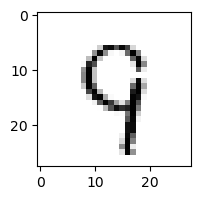

0.9497733591510975% - 0
0.05555428386475757% - 1
4.071632700097385% - 2
0.8369342772532266% - 3
74.5277653842229% - 4 - ОШИБКА
19.538888210609993% - 5
1.6932588615691948% - 6
7.1261107340274075% - 7
4.491264277121579% - 8
59.100256441968924% - 9

 8


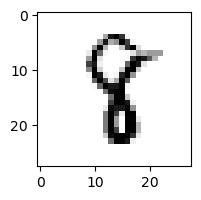

0.0038561673991032532% - 0
5.381846571499431% - 1
0.32054578316520826% - 2
0.3988481746838539% - 3
17.207564715321936% - 4 - ОШИБКА
7.2750487870766145% - 5
0.03722815986541744% - 6
0.6769123180397366% - 7
3.916785479992957% - 8
0.004630737881069809% - 9

 8


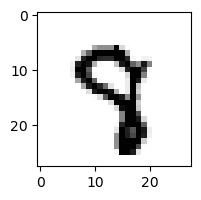

0.004424469864054855% - 0
0.00301667468390547% - 1
0.0964309839777739% - 2
0.6356457151453928% - 3
2.441836095666843% - 4
2.652785394250347% - 5
0.021971293922122517% - 6
4.574084038093723% - 7
1.8731926319953593% - 8
18.323687857673864% - 9 - ОШИБКА

 8


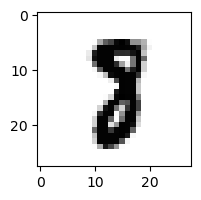

0.0017078566589350762% - 0
0.23872645969097622% - 1
0.28505124232855283% - 2
0.33833003277674867% - 3
0.011664514988550204% - 4
0.05853869583409082% - 5
0.00988130654149074% - 6
8.408659351000221% - 7 - ОШИБКА
0.1156946992167426% - 8
0.0024808658257203116% - 9

 2


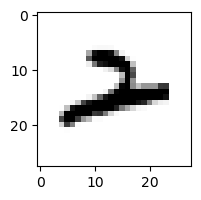

0.01910527040430303% - 0
0.670248317791525% - 1
10.288584992620496% - 2
0.06955862873946153% - 3
28.157478438458046% - 4 - ОШИБКА
0.0007773714769724172% - 5
4.478401122898113% - 6
11.432064324721235% - 7
0.12057697512837585% - 8
13.869782142174753% - 9

 3


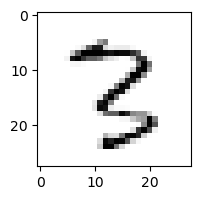

0.04159224927437601% - 0
0.7885276320025506% - 1
22.574927438754393% - 2
38.004282428266315% - 3
1.0408248180296797% - 4
0.9199809993469723% - 5
0.027919173958047366% - 6
4.665437718264097% - 7
81.6609948884024% - 8 - ОШИБКА
8.751490961957073% - 9

 8


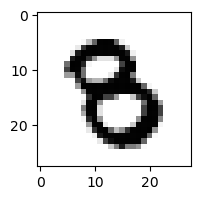

0.012788870797611306% - 0
0.000963735157215353% - 1
0.006276244289619537% - 2
15.179210956533234% - 3 - ОШИБКА
0.032650788241206825% - 4
1.3151919268497938% - 5
0.056454020767388514% - 6
0.0006745271960481526% - 7
0.049279106161041426% - 8
0.025604548479774517% - 9

 9


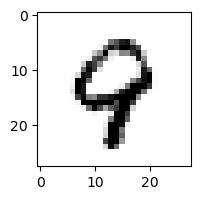

0.06434476639068484% - 0
0.02286762808205287% - 1
0.6279008127511639% - 2
0.0016500498341264621% - 3
58.10472112258993% - 4 - ОШИБКА
0.0379025600566197% - 5
1.5991867265865962% - 6
0.947396527763529% - 7
9.078106616473391% - 8
34.00326774929724% - 9

 6


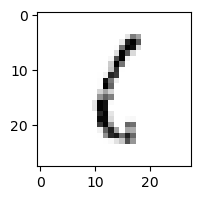

13.336772629019489% - 0
26.644075364961473% - 1
13.514428343321628% - 2
9.268377770102914% - 3
0.8125900987941845% - 4
26.377961611147168% - 5
76.01119663229204% - 6
0.7315164019100486% - 7
83.5703866862946% - 8 - ОШИБКА
6.351048257394515% - 9

 6


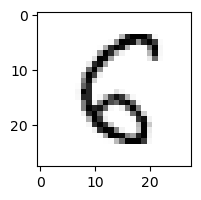

3.049476172658243% - 0
0.15436146132384065% - 1
8.802747225192135% - 2
0.004996215550012889% - 3
12.042542061817302% - 4
18.049876851737984% - 5
30.708243433802107% - 6
0.019724641140428253% - 7
49.4755892176105% - 8 - ОШИБКА
0.24269503982653876% - 9

 4


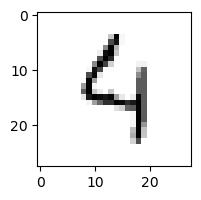

1.1346090614308535% - 0
0.13737223576083502% - 1
20.066544075731386% - 2
2.172181804564993% - 3
65.08357279590622% - 4
13.941319146839817% - 5
9.237466328670227% - 6
1.8707404360601598% - 7
6.435417649780403% - 8
75.42259743985714% - 9 - ОШИБКА

 5


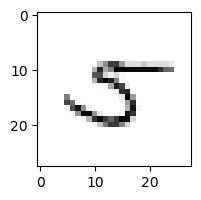

15.537951543776952% - 0
4.347894889629286% - 1
1.7053607857741584% - 2
2.2062483018936225% - 3
7.190308872057427% - 4
3.1029035329679497% - 5
19.60090673741958% - 6
23.801002451267316% - 7 - ОШИБКА
19.525136931117036% - 8
5.383318830637486% - 9

 8


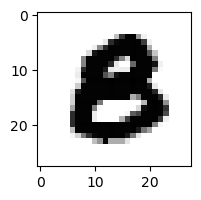

0.7785047295014336% - 0 - ОШИБКА
8.559115523801395e-07% - 1
0.00042236907507924617% - 2
0.05329803902759518% - 3
0.0016736689290185456% - 4
0.5939174771519351% - 5
0.0038062699091794315% - 6
8.4072886114229e-06% - 7
0.0009516689378906828% - 8
0.00018415473131153402% - 9

 8


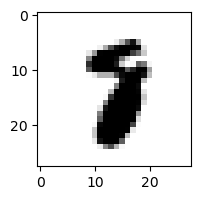

0.00017762927440479284% - 0
0.05619325498006769% - 1
0.08855603812697274% - 2
0.007151126956039312% - 3
0.034909477332473585% - 4
0.019175642905904077% - 5
0.022564897874591885% - 6
28.32742367008706% - 7 - ОШИБКА
0.09497097431601871% - 8
0.04314554484452371% - 9

 8


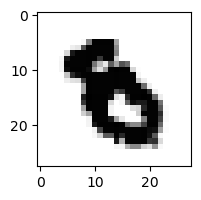

3.755028763830271e-05% - 0
7.758226496119871e-05% - 1
0.0003775630800617326% - 2
0.013220745077122861% - 3
0.1783431648989564% - 4
1.103795361148775% - 5
1.8961612035761763% - 6 - ОШИБКА
0.0006982213644430804% - 7
0.002924529155178162% - 8
0.001607914438915522% - 9

 4


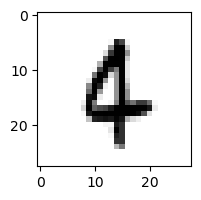

0.06496698514869072% - 0
0.8261228559482761% - 1
0.24540094078239544% - 2
0.004132807853091831% - 3
2.033438776457726% - 4
0.21219400865252944% - 5
22.732154888464194% - 6 - ОШИБКА
0.599851259015591% - 7
0.19726217791637307% - 8
9.157742882983264% - 9

 9


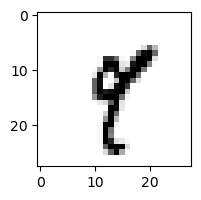

0.043287913505557704% - 0
33.91429770858257% - 1 - ОШИБКА
0.03953756071466437% - 2
1.424429806097739% - 3
13.211154792611456% - 4
2.6863085829532207% - 5
0.02283786454237605% - 6
21.831452360794575% - 7
3.7355393213220545% - 8
2.3566946632855963% - 9

 8


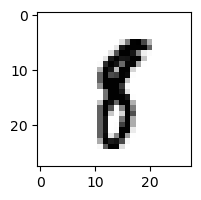

0.021085937269470747% - 0
24.42630207990281% - 1 - ОШИБКА
0.023570169468292167% - 2
0.6679421797411377% - 3
0.11219778821713339% - 4
3.0764370033139503% - 5
0.09025331931186499% - 6
0.2770302290553111% - 7
10.030289271573745% - 8
0.31106256387952747% - 9

 3


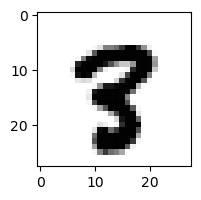

0.0004288175397778706% - 0
0.002312626536186907% - 1
0.004815514252298673% - 2
0.015022155220301368% - 3
0.06815539264551396% - 4
0.27157207777131664% - 5
9.975262249095241e-05% - 6
1.0002443740994584% - 7
37.65312885133337% - 8 - ОШИБКА
1.482982475994871% - 9

 8


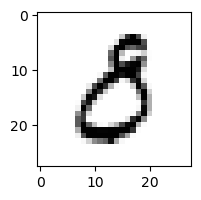

53.4362144076018% - 0 - ОШИБКА
0.060186093246425335% - 1
0.25898984979945616% - 2
42.96691871773303% - 3
0.10521397614061909% - 4
15.919646248839003% - 5
0.2523661922815723% - 6
0.12994233694112886% - 7
0.03829419377405878% - 8
0.003331357252704514% - 9

 3


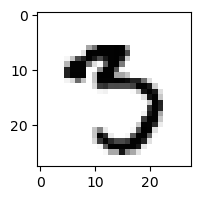

0.13842276431378792% - 0
0.014588086352856343% - 1
0.0017792174158475671% - 2
13.1328882503123% - 3
0.008214264445168987% - 4
55.41742342863202% - 5 - ОШИБКА
0.07650353017420086% - 6
4.896388673975944% - 7
28.181355056713294% - 8
20.33608674809657% - 9

 2


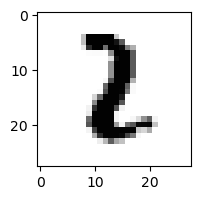

0.0019039991052273984% - 0
30.715269493932674% - 1 - ОШИБКА
8.816856622917639% - 2
2.521526788562071% - 3
0.00039988265562606353% - 4
0.04573777286287622% - 5
0.7991579814179566% - 6
0.004865716795028042% - 7
0.7750312590484241% - 8
0.023450479397876915% - 9

 6


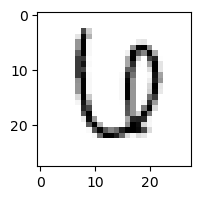

14.034494840399523% - 0
0.015968331694026477% - 1
1.0347132447751226% - 2
14.007266748733652% - 3
14.670201917819965% - 4 - ОШИБКА
0.3971717761200204% - 5
7.563735691925137% - 6
4.056569717885586% - 7
1.9446974961167163% - 8
0.10240464267359023% - 9

 9


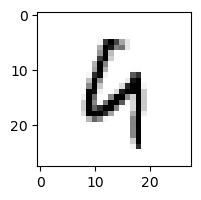

0.1117911209481739% - 0
0.2140979340021563% - 1
12.013032387590568% - 2
0.02407072641124514% - 3
81.89496392001543% - 4 - ОШИБКА
0.4376085383164233% - 5
46.98881637146818% - 6
0.37538472579647486% - 7
32.964702956156074% - 8
41.99366688111667% - 9

 8


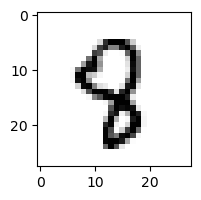

0.007345244935789477% - 0
0.034762763898716534% - 1
0.3186937804236205% - 2
0.06340264062856535% - 3
38.139112810519414% - 4 - ОШИБКА
5.593986721773322% - 5
0.24649768718855214% - 6
0.6925991305581785% - 7
6.369123422404373% - 8
0.14889973188911124% - 9

 8


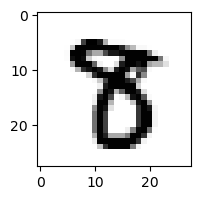

0.0023914843938731226% - 0
0.0033058779063582784% - 1
0.005938154178043045% - 2
15.747321302016143% - 3 - ОШИБКА
0.003913315416184921% - 4
1.4036444771005854% - 5
0.00019505064190034342% - 6
0.16269035412957264% - 7
6.657351128789527% - 8
0.01635767995209278% - 9

 7


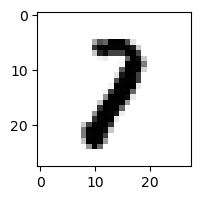

0.012887285715976023% - 0
31.765389008679097% - 1 - ОШИБКА
21.600034050564528% - 2
3.231862588300289% - 3
0.03653899063294329% - 4
0.05078222028611295% - 5
0.021918408821245017% - 6
0.9563800990351282% - 7
2.168133404049839% - 8
0.21675759141434925% - 9

 6


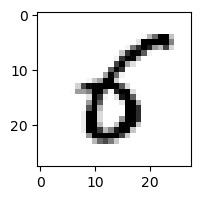

9.510449877972157% - 0
0.30265250882129147% - 1
0.03203275628499002% - 2
2.1100272036741257% - 3
4.842545916515563% - 4
57.42150148724288% - 5 - ОШИБКА
14.927831334281072% - 6
0.00755927342026811% - 7
0.7601652735759259% - 8
0.06066479581465894% - 9

 8


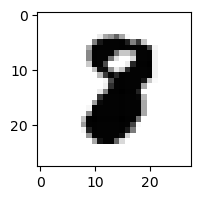

0.0001577188985604822% - 0
0.013318628472095483% - 1
0.9056036101322478% - 2 - ОШИБКА
0.010930316609558795% - 3
0.004758913536067866% - 4
0.004831025692462449% - 5
0.0019782038892866482% - 6
0.04477249774692578% - 7
0.32642355110775306% - 8
0.00013528186240395674% - 9

 8


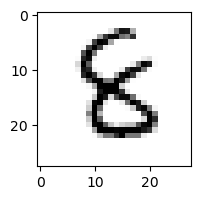

0.026011547052651327% - 0
0.02993078892651467% - 1
0.3521577119118534% - 2
10.246636171717736% - 3
0.7836720115102656% - 4
8.214469059241788% - 5
14.988043572378269% - 6 - ОШИБКА
0.009037074084357978% - 7
4.391822927648547% - 8
0.03280902158890209% - 9

 8


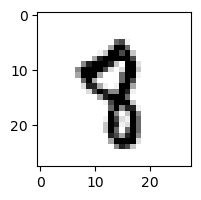

0.0017580780054738238% - 0
0.29325609207182735% - 1
0.023886181746366166% - 2
0.010243472443925343% - 3
2.7726341473230742% - 4
3.4747457843604903% - 5
0.08241419341994063% - 6
3.6735847032742472% - 7
3.6377531640706966% - 8
7.52940929838785% - 9 - ОШИБКА

 9


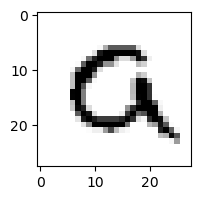

57.05992156212814% - 0 - ОШИБКА
0.00036528648155885815% - 1
2.7916973326579693% - 2
0.02870578950987679% - 3
0.056721581645411315% - 4
4.987820292014067% - 5
26.355285898686486% - 6
3.42339919622216% - 7
0.020065067070836374% - 8
27.98355058886351% - 9

 2


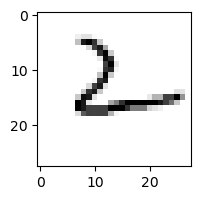

12.419003183037562% - 0
0.3764914293605798% - 1
26.60028693419676% - 2
0.6487637133653126% - 3
94.9062641712411% - 4 - ОШИБКА
1.0823353088607226% - 5
68.422088843161% - 6
4.0488239015032885% - 7
2.291039703327817% - 8
23.45416790730924% - 9

 8


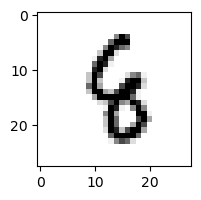

0.0017227468232226487% - 0
0.2152612613776356% - 1
2.2660923670707938% - 2
0.17129475618298498% - 3
47.53253354428346% - 4 - ОШИБКА
2.4959719716461186% - 5
10.391586434472263% - 6
0.1502676529784816% - 7
2.6127613429614027% - 8
1.163997293258098% - 9

 0


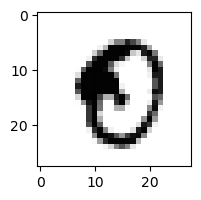

21.502635957391828% - 0
0.0018613455630430986% - 1
0.00012654702215483728% - 2
0.0013777895936586358% - 3
0.25840116085282827% - 4
28.652131944417935% - 5
0.1949494604147007% - 6
0.00019436934232347331% - 7
79.5206510680528% - 8 - ОШИБКА
1.585350776111952% - 9

 7


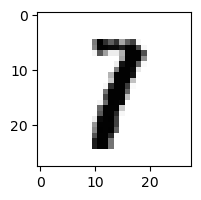

0.01192621166704813% - 0
71.37524736413519% - 1 - ОШИБКА
2.4061990070637957% - 2
4.960964929803565% - 3
0.04765654388484415% - 4
0.16320906382479577% - 5
0.03919730134269706% - 6
0.8156696858411527% - 7
1.9379692385309442% - 8
0.07424776398196706% - 9

 5


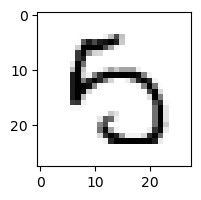

9.215852075090552% - 0
0.10925949480958881% - 1
0.02973467986324754% - 2
3.7174422929008784% - 3
25.55873200343568% - 4 - ОШИБКА
2.693803013670787% - 5
2.05107187428766% - 6
3.1145395262086573% - 7
0.6001348670869237% - 8
0.1687849295043845% - 9

 8


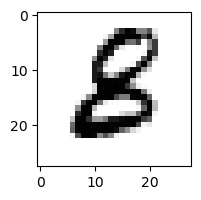

0.04926001099689996% - 0
0.005545981956118387% - 1
0.45322387026266264% - 2
1.8573068258484173% - 3
0.035424310742726645% - 4
9.117829387362985% - 5 - ОШИБКА
4.6514963934036295% - 6
0.0002319207706352573% - 7
0.023804957726255127% - 8
0.00011061235307800279% - 9

 9


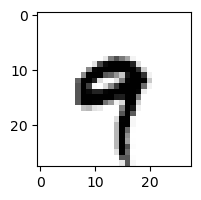

0.0061802742075899916% - 0
0.12943841006127255% - 1
0.0008034108278658827% - 2
0.020118783946092542% - 3
77.38721600559728% - 4 - ОШИБКА
0.07064441547028533% - 5
1.4180211852563618% - 6
1.96608657337009% - 7
0.0530761080788635% - 8
56.256039618983% - 9

 5


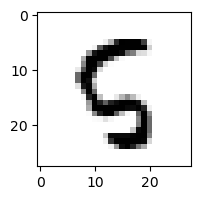

0.10723860552537326% - 0
0.008326705236789307% - 1
3.004072958017665% - 2
0.0006390225030898766% - 3
12.640367743086822% - 4
11.278041555808436% - 5
0.30330819012120896% - 6
0.04740014852181696% - 7
37.37391233202736% - 8 - ОШИБКА
5.300007368992742% - 9

 2


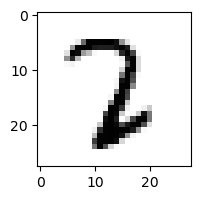

0.002799647594666486% - 0
1.244063991064955% - 1
11.361644402213885% - 2
30.871804926256985% - 3 - ОШИБКА
0.2471358797731323% - 4
0.09304161218291519% - 5
0.1958582237532697% - 6
3.3081300873930983% - 7
0.3152715500218728% - 8
0.002079883746656686% - 9

 2


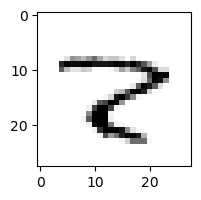

1.30491730495327% - 0
1.6700431470808055% - 1
2.7449122149687795% - 2
0.008264071992526748% - 3
0.5807733439229502% - 4
0.02028034821235478% - 5
19.951613656223703% - 6
59.85350280922863% - 7
76.57392737902909% - 8 - ОШИБКА
0.6342201117257661% - 9

 8


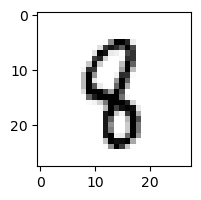

0.0101696115074708% - 0
1.7375025683167091% - 1
0.7424681174200286% - 2
0.1483135837404243% - 3
21.205786723248057% - 4 - ОШИБКА
6.3794785423836275% - 5
0.2340382020685207% - 6
0.11303283329546594% - 7
6.004714758670919% - 8
0.7749128310076964% - 9

 2


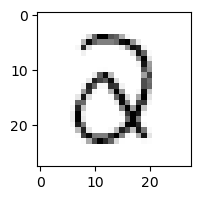

7.381200738297412% - 0
0.06996873885438687% - 1
4.705477819874925% - 2
38.45707648477728% - 3 - ОШИБКА
22.589175801670862% - 4
9.46588849424687% - 5
0.46037365677275444% - 6
0.06527817316642177% - 7
1.7180117794526262% - 8
0.04611034209101335% - 9

 6


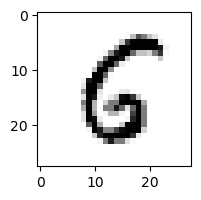

9.864100143164704% - 0
0.009379674268360087% - 1
0.23054284240482686% - 2
0.0055605726416604545% - 3
13.50331684442589% - 4
36.83257066952234% - 5 - ОШИБКА
5.529591018329441% - 6
0.023078312488277544% - 7
0.9302756805246561% - 8
0.059329449050365905% - 9

 2


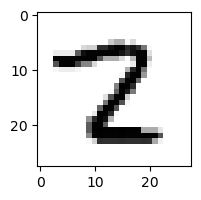

0.017483678924427162% - 0
0.6877683216681739% - 1
10.413616869437421% - 2
1.1322383012167594% - 3
0.058177658563431336% - 4
0.5046082055486427% - 5
0.005001588691096301% - 6
4.064080867889876% - 7
44.461942845055184% - 8 - ОШИБКА
0.014999959998955386% - 9

 8


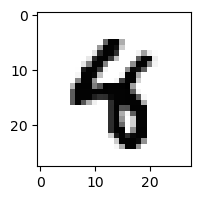

0.0003978148921316715% - 0
0.009783595324283804% - 1
0.003590695325883816% - 2
0.010698227185806668% - 3
83.7624555192162% - 4 - ОШИБКА
0.37471584692774346% - 5
0.03207698935034198% - 6
0.011083968036475435% - 7
0.014256249223963555% - 8
2.343875029734464% - 9

 9


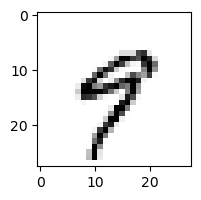

0.6395285072975682% - 0
0.41722034616673287% - 1
0.024674840969818545% - 2
1.3530139034440274% - 3
57.18721893171668% - 4 - ОШИБКА
4.204105523926834% - 5
0.38562902249423614% - 6
8.034733179972992% - 7
0.33950469820425705% - 8
41.12771689572816% - 9

 7


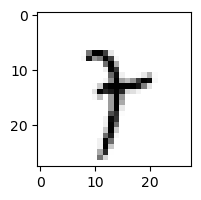

0.03438851002736897% - 0
51.84827805389616% - 1 - ОШИБКА
1.03484962462126% - 2
5.899355002755242% - 3
6.0784108359260935% - 4
7.976318308807663% - 5
10.539948810116478% - 6
8.045973052305563% - 7
50.74086724180072% - 8
27.321325042638637% - 9

 8


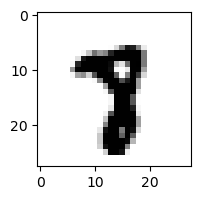

0.0002729460912815181% - 0
0.02136162987707144% - 1
0.00036436042836950874% - 2
0.011518927454090217% - 3
0.022777840177592504% - 4
1.8666479566868117% - 5
0.0024886058523515327% - 6
40.35724884577525% - 7 - ОШИБКА
1.5552317741833104% - 8
0.1493753130210671% - 9

 5


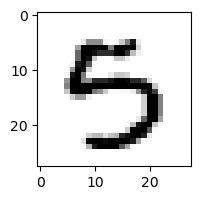

0.4822347792619741% - 0
0.003080764711184228% - 1
0.000343568005340634% - 2
40.59761697349516% - 3 - ОШИБКА
2.9778098441974907% - 4
31.35135329857387% - 5
0.18515793902754069% - 6
0.02420069788763624% - 7
0.9023926960313131% - 8
3.0663041239940725% - 9

 2


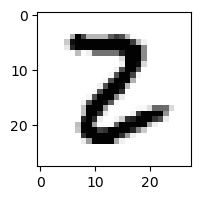

0.32359205318843415% - 0
0.09199863932651066% - 1
53.62708671224106% - 2
82.2405209464389% - 3 - ОШИБКА
0.00011268935606238891% - 4
0.17509278940338371% - 5
0.014294045373368567% - 6
6.145637773442168e-05% - 7
1.4148753991996939% - 8
0.00038502968505682724% - 9

 3


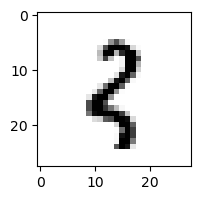

0.31688389547614615% - 0
25.060049534754892% - 1
11.854844112825063% - 2
1.2708638347125871% - 3
0.458540826732519% - 4
0.21780318649559458% - 5
0.6253212592881916% - 6
0.11472323416795807% - 7
23.443039865544048% - 8
25.588788758086928% - 9 - ОШИБКА

 2


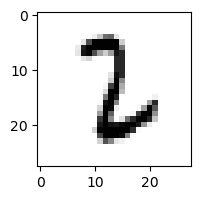

0.013256199661950446% - 0
11.850791772321333% - 1
19.190658672805927% - 2
49.429468828319564% - 3 - ОШИБКА
0.00225731464910724% - 4
1.5731631628318434% - 5
8.770523190385383% - 6
0.025295965782983893% - 7
0.397926000775078% - 8
0.00755884802142596% - 9

 9


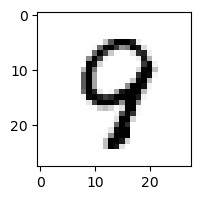

0.08402837543827894% - 0
0.008892698016260624% - 1
0.9454516227696986% - 2
0.14102929278190707% - 3
74.84931162726697% - 4 - ОШИБКА
0.9571952655636086% - 5
0.43611328750322137% - 6
1.0053760666462617% - 7
17.095963607752143% - 8
3.488696750765067% - 9

 9


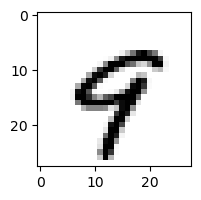

0.17050333570489062% - 0
0.025340010267208012% - 1
0.006322215019884739% - 2
0.0039205049538340074% - 3
74.59941013047747% - 4 - ОШИБКА
0.3571240319164546% - 5
0.21600282404328433% - 6
17.058431301140114% - 7
0.14938581566219108% - 8
6.27947499031131% - 9

 9


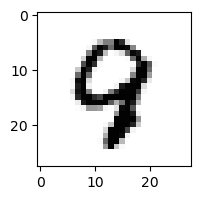

0.021862013954496176% - 0
0.003038396645233109% - 1
0.30594236705386235% - 2
0.09517355459831696% - 3
44.592458666315046% - 4 - ОШИБКА
0.045197679639230486% - 5
0.41196312625820936% - 6
0.4284486079077739% - 7
1.8482442865821416% - 8
3.8884854450878787% - 9

 3


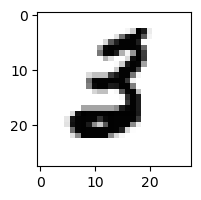

0.14550718231949109% - 0
0.036041954700902115% - 1
2.512590228504559% - 2 - ОШИБКА
0.45969507634206025% - 3
0.0105029737376205% - 4
1.315782794453691% - 5
0.3827135644251587% - 6
0.008639662111794306% - 7
0.009723426881077647% - 8
0.0005357293491335559% - 9

 3


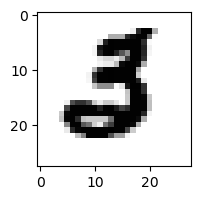

0.13262034672845735% - 0
0.001679259012938565% - 1
0.9114836068332693% - 2 - ОШИБКА
0.029083542140657677% - 3
0.007435019132046447% - 4
0.03802558681536793% - 5
0.08040378057440362% - 6
0.024177175772972712% - 7
0.00010579775976983413% - 8
7.788933308114135e-05% - 9

 3


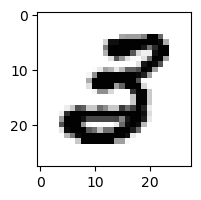

0.47452131761787153% - 0
0.002425296181834757% - 1
0.05949650383906392% - 2
0.8397595342524483% - 3
0.04717098680124748% - 4
8.768833780108173% - 5 - ОШИБКА
0.0022770461792261426% - 6
0.0012652282284858743% - 7
0.20397791513289318% - 8
3.625072539786745e-05% - 9

 8


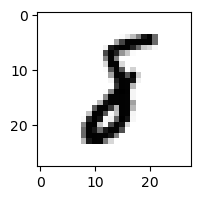

0.007828550888975046% - 0
49.55034914243853% - 1 - ОШИБКА
4.569403848481091% - 2
0.1452518767394574% - 3
0.0390023092588672% - 4
0.2040948883186965% - 5
5.3743633432351885% - 6
0.08346519478183724% - 7
4.460307589350351% - 8
0.03130429179573043% - 9

 3


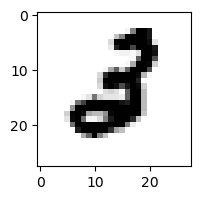

0.01474396066532701% - 0
0.09587497355705611% - 1
4.375789121265661% - 2 - ОШИБКА
0.028885566024908795% - 3
2.4827548968723416% - 4
0.043617803627737234% - 5
0.23822193695534974% - 6
0.006445656391690554% - 7
0.01194730839240763% - 8
7.167998305023921e-05% - 9

 4


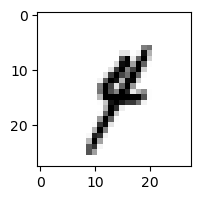

0.011574518864554965% - 0
54.194190483095426% - 1 - ОШИБКА
0.2791783881598569% - 2
25.713423457596207% - 3
23.956166821577163% - 4
0.8496517071007548% - 5
0.258723499146744% - 6
15.288730067555633% - 7
1.078375923263% - 8
1.598750058194599% - 9

 3


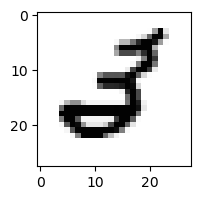

0.37446092092115846% - 0
0.08836838538708196% - 1
3.077896818303362% - 2
0.3419819508666182% - 3
5.014525035516951% - 4 - ОШИБКА
0.28588920758971714% - 5
0.10374557301728064% - 6
0.02545269182947032% - 7
0.35377598097099694% - 8
0.005545563213552589% - 9

 5


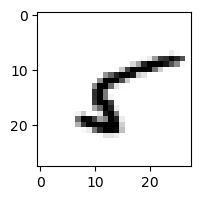

3.7523390408514636% - 0
5.308288746540852% - 1
4.302862052110472% - 2
2.888006661509373% - 3
3.527662877809851% - 4
67.3261828532259% - 5
13.955512882762877% - 6
0.4950970378429569% - 7
84.66140846545194% - 8 - ОШИБКА
0.3448850583650432% - 9

 2


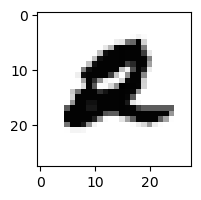

0.04873194264581204% - 0
0.0003707822512782687% - 1
1.1828823063230516% - 2
0.00013212958816680737% - 3
0.19519560718068543% - 4
0.005976250023971065% - 5
0.02651377902495287% - 6
0.0015652202007175177% - 7
0.021190998578289683% - 8
6.853800417417048% - 9 - ОШИБКА

 9


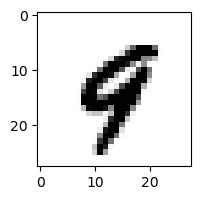

0.024031505935570296% - 0
0.03556626581230319% - 1
0.0033694700275481394% - 2
0.002375910079799856% - 3
64.50213002690265% - 4 - ОШИБКА
0.02914945269363642% - 5
0.1844219851188608% - 6
1.8223052874843382% - 7
0.0801956423445517% - 8
5.896101423715118% - 9

 9


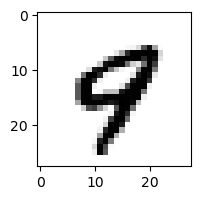

0.12457291519609495% - 0
0.005871298145899756% - 1
0.004986854882673521% - 2
0.000983543090158232% - 3
53.41664774514994% - 4 - ОШИБКА
0.032906004002708045% - 5
0.05673688144997842% - 6
7.201687607367785% - 7
0.14841408920645624% - 8
34.58798826167428% - 9

 8


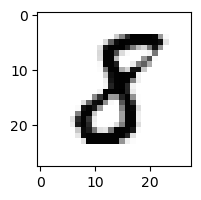

0.1311483795500679% - 0
1.7463768229288579% - 1
0.7308570236672681% - 2
3.481687490030272% - 3 - ОШИБКА
0.05770820776170035% - 4
1.7983192752181643% - 5
0.028887264602618132% - 6
0.003198824827350785% - 7
3.053300357645371% - 8
0.0006168331656707739% - 9

 8


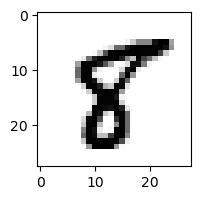

0.12295852291830092% - 0
0.31160293051848686% - 1
0.006953324494509153% - 2
0.000384307171471102% - 3
0.12482364064484452% - 4
55.96057324469168% - 5 - ОШИБКА
0.0016019355083622116% - 6
0.04463926573129188% - 7
30.339752725061132% - 8
0.14333382229742833% - 9

 5


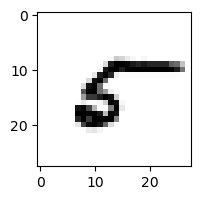

52.00454190338883% - 0 - ОШИБКА
1.4765491130326402% - 1
2.9618264388668267% - 2
0.02812267157442369% - 3
6.534241858251101% - 4
9.889331311870901% - 5
6.001837062055471% - 6
2.706988047919504% - 7
15.156028198175548% - 8
1.1624387593018546% - 9

 9


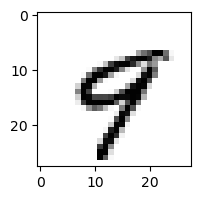

0.3089993795550505% - 0
0.018957414231552203% - 1
0.005227302867468882% - 2
0.015936926528410073% - 3
74.73352288585914% - 4 - ОШИБКА
0.32349890758958916% - 5
0.20547495524046736% - 6
22.062653648789983% - 7
0.6721461242384347% - 8
9.36024171687333% - 9

 8


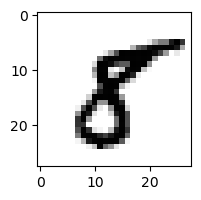

0.43933246583181845% - 0
1.00915537073306% - 1
0.009542057541341506% - 2
0.05713459397587758% - 3
0.26052130209336133% - 4
40.071525024897866% - 5 - ОШИБКА
7.792603857431163e-05% - 6
0.06332477911354366% - 7
8.137512251904287% - 8
0.023986240251123878% - 9

 3


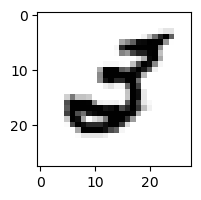

1.8401569537409628% - 0
0.12510492814793145% - 1
1.821867551626365% - 2
0.012645917906642672% - 3
5.927695046474309% - 4 - ОШИБКА
0.11965002670935768% - 5
0.18600707935542812% - 6
0.23763915778356606% - 7
0.022022639243261706% - 8
0.0007331498520275934% - 9

 3


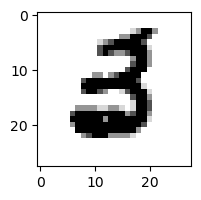

0.29109655759172276% - 0
0.001399786453907247% - 1
0.17771992891699126% - 2
0.41008143266122377% - 3
0.027385052321224016% - 4
2.3208586755040272% - 5 - ОШИБКА
1.479785721515446% - 6
0.000583238749628637% - 7
0.0004590239984806939% - 8
0.00016075987932063522% - 9

 8


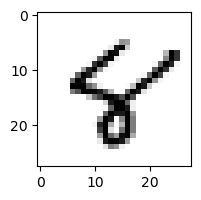

0.0900046790797621% - 0
0.040711071905012226% - 1
0.05354204042661547% - 2
0.0002682422573541994% - 3
25.617367660546797% - 4 - ОШИБКА
16.137408871674715% - 5
2.7721219373436097% - 6
0.6521578931365348% - 7
23.107124260253787% - 8
9.718774657122973% - 9

 8


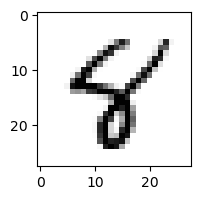

0.025171438142994242% - 0
0.06768337698479863% - 1
0.0371567383864188% - 2
0.005984858453660846% - 3
59.16478159965762% - 4 - ОШИБКА
20.34759785498347% - 5
0.5818564002047466% - 6
0.4229223236357509% - 7
47.92402891191725% - 8
0.8192384989629742% - 9

 9


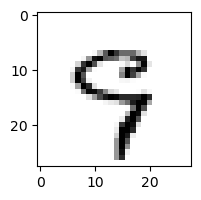

0.7898102325248993% - 0
0.043827843440785656% - 1
0.15493899211356635% - 2
7.2388256097304104% - 3
11.151296685934438% - 4
8.56288405538722% - 5
0.2634768096160627% - 6
30.820788173006168% - 7 - ОШИБКА
0.1389956137276275% - 8
23.05698797600913% - 9

 2


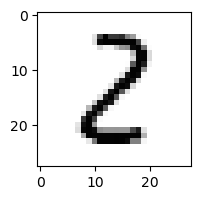

2.5655489397045628% - 0
16.01618194841972% - 1
28.20356656292608% - 2
6.755250513772861% - 3
0.40135827585884964% - 4
0.922698192527799% - 5
0.024046424318151967% - 6
0.02823642623507054% - 7
89.71765881201573% - 8 - ОШИБКА
0.004598655487812199% - 9

 3


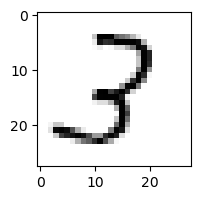

0.3421132881292489% - 0
3.5830406698472137% - 1
65.44580568959393% - 2 - ОШИБКА
64.8886995256141% - 3
14.430287599752226% - 4
0.46887528133029494% - 5
0.2813737289621654% - 6
0.20844607333878593% - 7
25.51725647694014% - 8
0.06284484946473662% - 9

 7


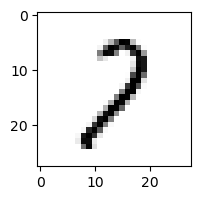

2.144904862162574% - 0
12.771316383413883% - 1
76.2022759285719% - 2 - ОШИБКА
9.1256633029402% - 3
3.672234060067716% - 4
0.6433837818789573% - 5
0.8374042131519183% - 6
26.762551315578133% - 7
13.164449004573425% - 8
3.86293962479856% - 9

 9


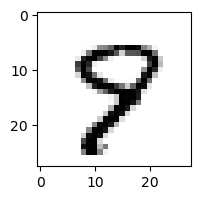

0.08092346441824085% - 0
0.013739519435254085% - 1
0.0661474284583683% - 2
0.2735080325244363% - 3
3.6332322120804244% - 4
20.47793505768589% - 5
0.10350842965269229% - 6
9.973532180599175% - 7
21.595184673880606% - 8 - ОШИБКА
11.234761064208145% - 9

 8


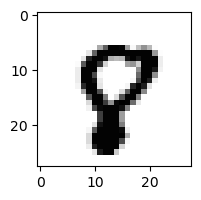

0.21527472491516264% - 0
0.00024288278053795172% - 1
0.014358316381694861% - 2
0.00021044868162565318% - 3
0.4722243819595886% - 4
0.9147385740032411% - 5
0.006408188705990036% - 6
15.152436720212705% - 7 - ОШИБКА
6.503007696498769% - 8
6.708399817037498% - 9

 8


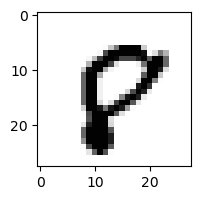

43.9533777764581% - 0 - ОШИБКА
0.00040270675340171153% - 1
0.06248275701845067% - 2
5.625391238924852e-05% - 3
0.08367036894234996% - 4
1.3324890054516394% - 5
0.0276364232971226% - 6
5.414096683467254% - 7
31.022999991698093% - 8
29.613629585159007% - 9

 8


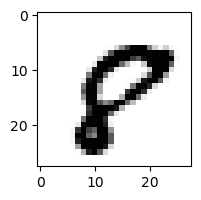

41.95555829654889% - 0 - ОШИБКА
0.0010438073420715149% - 1
0.007733879878188807% - 2
0.00010604474322058897% - 3
0.04910884159252469% - 4
5.170576000364294% - 5
0.015365400327628355% - 6
1.5949393898381858% - 7
37.23808159302169% - 8
2.2515219379298905% - 9

 9


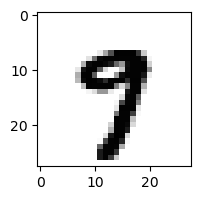

0.020766302116461827% - 0
0.00264318644538893% - 1
0.00018129781249970418% - 2
0.10587435354841729% - 3
0.6778061258738187% - 4
2.0547645884487795% - 5
0.002849516424640562% - 6
69.3019286214328% - 7 - ОШИБКА
0.1795720047845327% - 8
28.885169963466335% - 9

 9


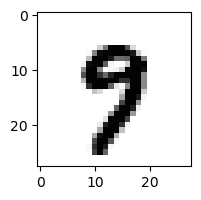

0.0274899031465646% - 0
0.001326089781440551% - 1
0.0009386103911436183% - 2
0.3736964494571539% - 3
0.5373035229600874% - 4
7.129358207628275% - 5
0.010026286200706823% - 6
54.250006368300006% - 7 - ОШИБКА
0.41925279560072487% - 8
18.4387560104497% - 9

 3


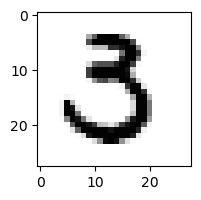

2.2080047363763518% - 0
0.004859115026160831% - 1
0.24642053614873394% - 2
19.299751710773755% - 3
0.0010605811424654087% - 4
20.280933839839534% - 5 - ОШИБКА
0.013807306668088428% - 6
0.2623728780133934% - 7
0.005336449056735687% - 8
7.402578457369839e-05% - 9

 1


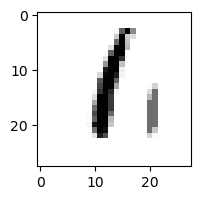

2.496106102113894% - 0
9.108037137980293% - 1
7.113632912346336% - 2
3.7977354027082826% - 3
0.03218244962956337% - 4
21.229255026564488% - 5
79.84073824190232% - 6 - ОШИБКА
0.04466430019985102% - 7
48.67365089722689% - 8
8.770907886555802% - 9

 8


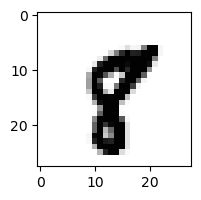

0.013027911163619897% - 0
0.5104653810129726% - 1
0.00128761485304549% - 2
0.0035936065970463187% - 3
0.15178906718035606% - 4
0.3585503624968075% - 5
0.002184800612240248% - 6
18.475346631569927% - 7 - ОШИБКА
0.6571990104809672% - 8
0.16557755744012062% - 9

 8


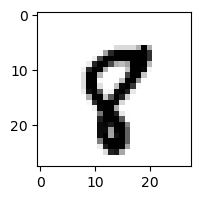

0.0328126058152566% - 0
0.14559838096717984% - 1
0.012676446378992677% - 2
0.0009196890169609515% - 3
0.3891307993342189% - 4
0.5667150120496253% - 5
0.02192191280283213% - 6
8.64790606665437% - 7 - ОШИБКА
2.417831756019797% - 8
3.648503764006974% - 9

 3


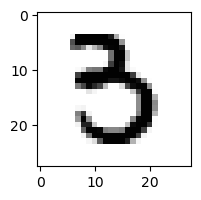

0.43188650124744743% - 0
0.006429115606835065% - 1
0.001859422130222805% - 2
25.167777567090244% - 3
0.014409871833481967% - 4
35.19503076180205% - 5 - ОШИБКА
0.20383181651302515% - 6
0.07365569161541351% - 7
0.035080858768746885% - 8
0.03060556620565819% - 9

 1


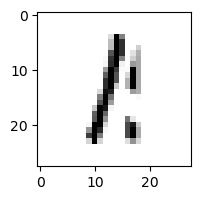

2.0225487253761636% - 0
18.49623339940606% - 1
7.640162376221974% - 2
18.10000208224437% - 3
0.053916527592011855% - 4
7.801433598782909% - 5
8.84817481347826% - 6
0.31128818527872315% - 7
62.04822293712142% - 8 - ОШИБКА
4.996569280451864% - 9

 8


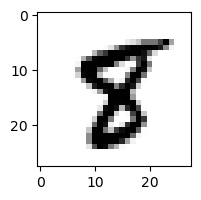

0.0026749597393787372% - 0
0.005425485465166126% - 1
0.0011041027648574686% - 2
0.0020167010482470583% - 3
0.1972251960959758% - 4
16.921429202347895% - 5 - ОШИБКА
0.0026765578101503% - 6
0.302615765716428% - 7
15.165732035816648% - 8
0.05340154115448172% - 9

 8


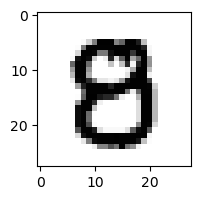

1.7966628637695845% - 0
5.260851103526559e-05% - 1
0.029501206746590368% - 2
4.151637052287311% - 3 - ОШИБКА
0.12977504235375423% - 4
1.2452190049643816% - 5
0.0003807675238881374% - 6
0.00044007801450457066% - 7
0.5065016511327697% - 8
0.04105093810483712% - 9

 9


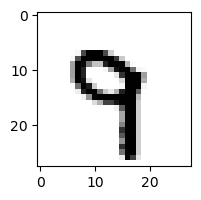

0.0004436202211465598% - 0
0.07680685775833278% - 1
0.04206688860153831% - 2
0.1322896207807847% - 3
23.296105072613823% - 4
0.37936357054389475% - 5
0.5808187843947991% - 6
25.876479660032377% - 7 - ОШИБКА
0.16248342946999492% - 8
11.474645670739763% - 9

 2


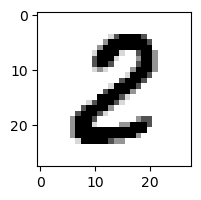

0.4647791375347409% - 0
0.07364346517498832% - 1
42.4373060969324% - 2
0.4037516721323951% - 3
0.0027025687360141895% - 4
0.2714890305293219% - 5
0.00395571719176187% - 6
0.0008000195643348284% - 7
84.71712351031728% - 8 - ОШИБКА
0.0015657704444579246% - 9

 8


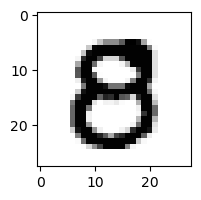

5.803621899120657% - 0 - ОШИБКА
1.022199886376154e-05% - 1
0.02395842260334947% - 2
1.72877218517879% - 3
0.29846027670191505% - 4
3.432661376518298% - 5
7.343121653582041e-05% - 6
0.0007903533599246052% - 7
0.20957709710363817% - 8
0.04396149243260022% - 9

 8


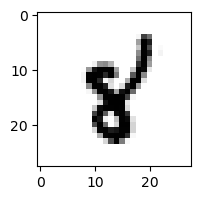

0.013666952911040735% - 0
0.8582370495531245% - 1
0.013093981397750904% - 2
0.0025579592453694815% - 3
64.09405319605985% - 4 - ОШИБКА
5.453512343014973% - 5
8.163052389662278% - 6
0.32623011347986103% - 7
56.034622863533045% - 8
0.08062786204269111% - 9

 8


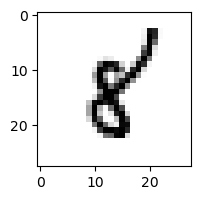

0.08683433967622833% - 0
22.585090516914246% - 1 - ОШИБКА
0.09690393506396035% - 2
0.06803911518156656% - 3
18.12695852938162% - 4
4.215026568499149% - 5
9.112445460910733% - 6
0.3886357896299095% - 7
21.129491244135522% - 8
0.28395417023337727% - 9

 4


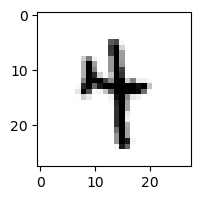

0.005853884403980425% - 0
15.726552892820356% - 1
0.0016947825027797568% - 2
0.2740091668082803% - 3
26.752973059419332% - 4
13.592303902010864% - 5
4.638158674914907% - 6
0.754156641784173% - 7
1.9490680474186326% - 8
43.292019809164394% - 9 - ОШИБКА

 7


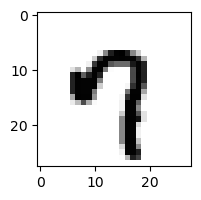

5.206737698224828% - 0
0.0007300515926611066% - 1
0.0012104658424473321% - 2
0.008375430519189566% - 3
15.972673371830107% - 4
0.954484557071829% - 5
0.12771209857713905% - 6
18.185879915554864% - 7
0.00908998037661014% - 8
96.9002623671391% - 9 - ОШИБКА

 8


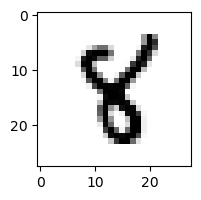

0.0005996632370859541% - 0
0.7191559468581724% - 1
0.021774122050001826% - 2
0.12571503169519013% - 3
40.16412066333904% - 4 - ОШИБКА
17.23920398179635% - 5
0.06464607612013727% - 6
0.18527375084194253% - 7
26.77202495829042% - 8
0.0328101226277023% - 9

 2


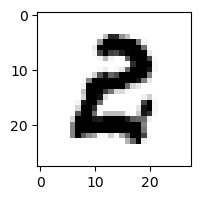

12.85736567973967% - 0 - ОШИБКА
0.0034144739236382756% - 1
1.2177162899774179% - 2
7.02498798899303% - 3
0.0037800124772312876% - 4
1.1376021786164126% - 5
0.10718888603163665% - 6
3.289275855089546e-05% - 7
0.04051483306713255% - 8
0.0021797939558895803% - 9

 3


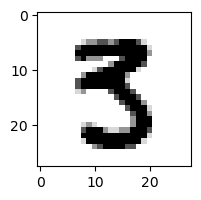

0.02405057641002871% - 0
0.002564896031372733% - 1
6.38050012261813e-05% - 2
31.927258689692106% - 3
0.012735992449015082% - 4
33.36486234467541% - 5 - ОШИБКА
1.624953427300722e-05% - 6
0.030341335090548684% - 7
0.026207303210374445% - 8
0.0005014860505214245% - 9

 1


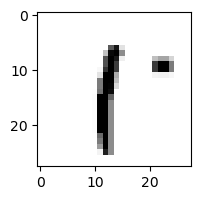

3.789513240776726% - 0
5.33815940357023% - 1
1.3285603402791526% - 2
2.9832005736271814% - 3
0.16940121683258644% - 4
68.42095545116258% - 5
19.979907104949763% - 6
1.4642751512441614% - 7
99.23075443984085% - 8 - ОШИБКА
29.599861333773763% - 9

 8


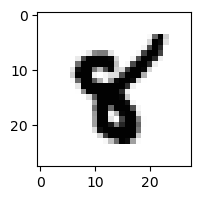

0.00029061551825594053% - 0
0.101121153139431% - 1
0.00030160773956944194% - 2
0.0001757349157608604% - 3
14.733156852371362% - 4 - ОШИБКА
10.412471412694899% - 5
0.0492636033956915% - 6
0.05062803295610038% - 7
2.775782386722734% - 8
0.00934324732497227% - 9

 8


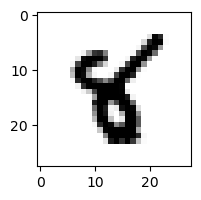

0.0008559862671639856% - 0
0.3209115615628771% - 1
0.00047548378636583694% - 2
0.004460869848144521% - 3
19.820742324180962% - 4
23.538876685189415% - 5 - ОШИБКА
0.12128678920874227% - 6
0.021980561975384033% - 7
2.1306680821929396% - 8
0.006599334525718839% - 9

 8


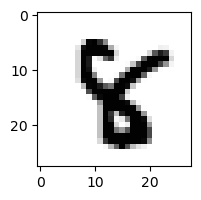

1.90070743781006e-05% - 0
0.005123737715299807% - 1
0.014849703600726839% - 2
0.05011560742318796% - 3
18.7075820138205% - 4 - ОШИБКА
5.4746029177570295% - 5
0.001286724331834624% - 6
0.015328394273298374% - 7
18.565857467160253% - 8
0.004422584757292838% - 9

 8


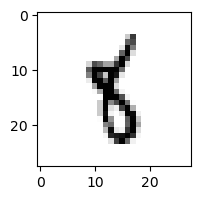

0.085435226699632% - 0
5.36443712713754% - 1
0.05330083449463575% - 2
0.1255669895918223% - 3
4.317179367672481% - 4
57.20384464391144% - 5 - ОШИБКА
10.49799424715729% - 6
0.19617797115876223% - 7
49.16383367421368% - 8
1.1788292844679817% - 9

 7


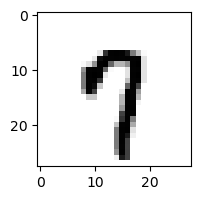

0.6072687875151811% - 0
0.005375554261849632% - 1
0.0250426033131102% - 2
0.09314180781952743% - 3
6.316520353894677% - 4
6.240971703057842% - 5
0.16778405581712977% - 6
74.99101920941204% - 7
0.4137703647005578% - 8
75.05725537863853% - 9 - ОШИБКА

 2


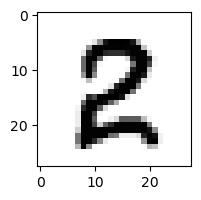

0.4773240855298002% - 0
0.003688679605261042% - 1
28.930886433265858% - 2
1.615100108077692% - 3
0.007073102640301967% - 4
0.8091706385971483% - 5
0.019517639927473466% - 6
0.0024097778572017% - 7
29.07097008614371% - 8 - ОШИБКА
0.012284095454685747% - 9

 3


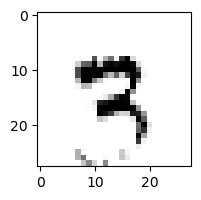

0.003850976241794881% - 0
1.2921519725207644% - 1
0.13781600784160622% - 2
0.001867864380231731% - 3
13.611464712913076% - 4
1.1034703405678% - 5
1.4402683150298687% - 6
64.358811568863% - 7 - ОШИБКА
8.592017043960656% - 8
17.075708019622805% - 9

 5


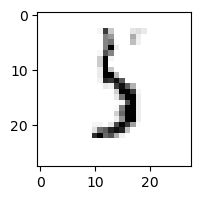

0.2539089202220228% - 0
3.1367681557549076% - 1
3.1908643509854286% - 2
46.87012276674357% - 3 - ОШИБКА
10.639308694459116% - 4
19.1051678324567% - 5
45.9685291046049% - 6
5.292783157409834% - 7
17.13791716107114% - 8
3.3769484787880533% - 9

 8


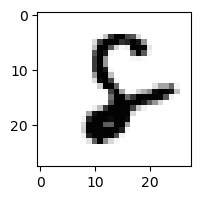

0.08220295808884533% - 0
0.0932465645935357% - 1
1.7068495474041958% - 2
0.004305282591829288% - 3
0.3751705972985106% - 4
3.2947084709128363% - 5
25.80762163733228% - 6 - ОШИБКА
0.09028854047735534% - 7
0.37535132783533653% - 8
6.541563835874227e-05% - 9

 9


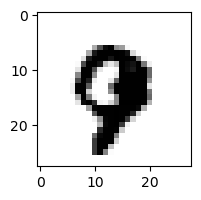

0.0007583051560678436% - 0
0.0019359612342755284% - 1
0.0012981072231831243% - 2
0.0004765667873413319% - 3
0.38918040251686997% - 4
0.0020747632848295582% - 5
0.019760130645620898% - 6
36.95693717106556% - 7 - ОШИБКА
0.0033038660356500544% - 8
11.895869016077429% - 9

 8


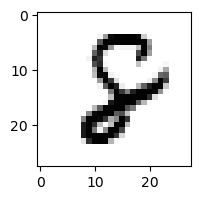

0.068549576203574% - 0
0.28457153232837035% - 1
1.4560435510783163% - 2
0.0024272891111209727% - 3
0.7264763958488264% - 4
0.5229218449541663% - 5
6.509587790949088% - 6 - ОШИБКА
0.08153322415235559% - 7
1.9099976364961528% - 8
0.0001479021161206559% - 9

 9


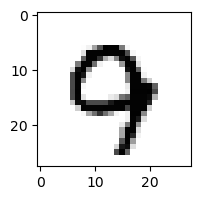

0.026513773743643623% - 0
0.002933560356579945% - 1
0.2144502532669604% - 2
0.008023281204341669% - 3
22.118664007958778% - 4
0.0022876320486250336% - 5
0.6011142719688285% - 6
37.80334164252243% - 7 - ОШИБКА
0.05394307972126229% - 8
33.585615871647406% - 9

 5


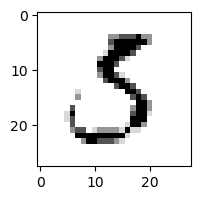

5.634363936426621% - 0
0.20176468098557512% - 1
0.7461859184394486% - 2
57.56065540577229% - 3 - ОШИБКА
0.016183082281811215% - 4
25.871606551112947% - 5
0.403998373467704% - 6
0.27267451626538497% - 7
0.5226518781165456% - 8
0.09849981159895721% - 9

 7


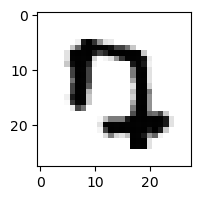

1.464272172325899% - 0
1.3806582781913503e-05% - 1
0.6458570857339205% - 2
2.8354343689837127% - 3 - ОШИБКА
0.11829409953448208% - 4
0.23635472719475745% - 5
0.07359218058739299% - 6
0.7223237112421893% - 7
0.00019929063973513287% - 8
0.573192813038104% - 9

 4


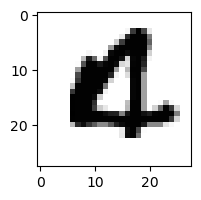

19.65477876743877% - 0 - ОШИБКА
9.6868922701308e-07% - 1
0.07486565490890498% - 2
1.1242581398955645e-05% - 3
0.041542512606513926% - 4
0.5019069986878647% - 5
2.069257049620824% - 6
0.0018782645411648097% - 7
6.82625551421157e-05% - 8
0.02716342233788605% - 9

 5


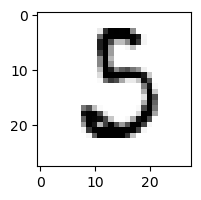

9.03273954931232% - 0
0.1611153882153687% - 1
7.376449091006701% - 2
16.559530698858197% - 3
0.0008457170586539047% - 4
1.0284131195180866% - 5
67.54340226834526% - 6 - ОШИБКА
0.5297150456900381% - 7
0.36700355555021513% - 8
0.0006355391638918931% - 9

 3


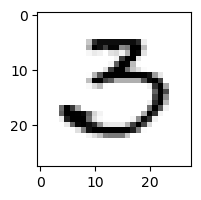

83.2498206843028% - 0 - ОШИБКА
0.10321043951488312% - 1
4.087364035957384% - 2
73.03895773245443% - 3
0.0026064332409907864% - 4
0.45646955227589375% - 5
2.034404011971021% - 6
0.09617562393557015% - 7
0.21829697184226246% - 8
0.0011793540734255845% - 9

 5


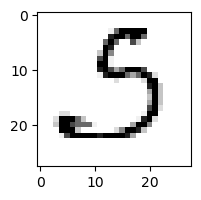

26.403823252098434% - 0
0.6424720310424527% - 1
19.72310654077693% - 2
94.8596100388029% - 3 - ОШИБКА
0.012175485992120039% - 4
2.0201804027838546% - 5
2.0585234725002954% - 6
3.400125976006608% - 7
0.45229221789973434% - 8
0.0204930559745502% - 9

 3


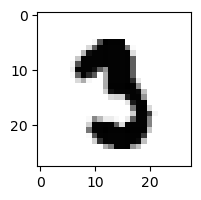

0.001450615930024587% - 0
0.006721805979948019% - 1
0.0010540927446719343% - 2
2.9597196653700717% - 3
0.00013077531896844695% - 4
10.623914773113748% - 5 - ОШИБКА
0.00396727541538327% - 6
0.8982456650081232% - 7
0.1604859645030142% - 8
0.0032553071070439803% - 9

 4


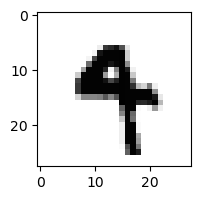

0.0021444959854739214% - 0
0.019329556895162497% - 1
3.1746670008896865e-05% - 2
0.133208187931822% - 3
31.411949754733094% - 4
13.259072210667236% - 5
0.5377113711189897% - 6
0.1821535804127714% - 7
0.008122121145132695% - 8
89.94150777770676% - 9 - ОШИБКА

 8


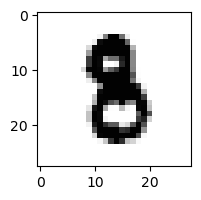

0.00034441233071658633% - 0
0.013681017598365122% - 1
0.009049156219052173% - 2
0.6848170904945% - 3
0.005347393583931069% - 4
1.5007339532808663% - 5 - ОШИБКА
0.2260693326284865% - 6
0.005275837263851313% - 7
1.1635420507661267% - 8
0.024462606710375825% - 9

 3


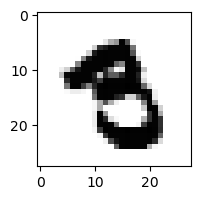

0.0007569074001590931% - 0
0.0009659479893734858% - 1
1.20178084298783e-05% - 2
0.010467769508922878% - 3
0.008822805964250325% - 4
14.100654177068344% - 5 - ОШИБКА
0.011477194941475886% - 6
0.008972289844542876% - 7
0.23445546311041046% - 8
1.913083134843516% - 9

 8


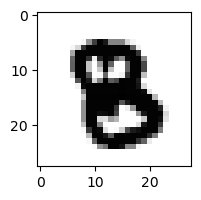

0.00018872015807871648% - 0
2.2165005480159135e-05% - 1
0.007995796808839375% - 2
0.008713610176582185% - 3
0.06455663185008957% - 4
0.08203061589212937% - 5 - ОШИБКА
0.00040872614802848806% - 6
0.0005742440732460105% - 7
0.028107034570807824% - 8
0.00692081705963129% - 9

 8


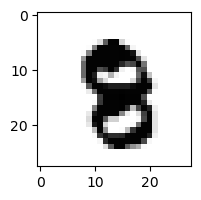

0.000215311171187732% - 0
0.0006935492686469148% - 1
0.013018503030554738% - 2
0.000435426690807671% - 3
0.043653788616904686% - 4
0.258063891695603% - 5
0.0054705262024601015% - 6
0.05523703509291456% - 7
1.5483085692919627% - 8
1.5617382988733848% - 9 - ОШИБКА

 3


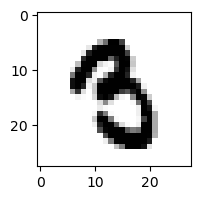

0.0012885237265948257% - 0
0.023334288340775253% - 1
0.0002824257773365242% - 2
0.6250593572981352% - 3
0.010097812286385281% - 4
21.226731717218104% - 5 - ОШИБКА
0.1695755551322885% - 6
0.008147386275031747% - 7
0.1846117285477914% - 8
1.0336495437970799% - 9

 4


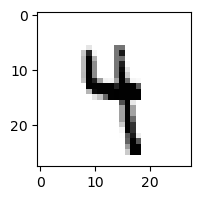

0.003218754849881392% - 0
2.2196486783258385% - 1
0.02277092502827272% - 2
3.6656983790824493% - 3
49.87925534611935% - 4
15.00201831564302% - 5
5.149150937544391% - 6
0.21529968811409447% - 7
4.798516540695314% - 8
72.927599674178% - 9 - ОШИБКА

 8


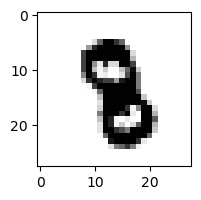

2.822630772158778e-06% - 0
0.008712479693221947% - 1
0.0368941943167665% - 2
0.06315368783700322% - 3
0.2866882425154313% - 4
0.48868065086361373% - 5 - ОШИБКА
0.0189381386442845% - 6
0.03118988129687604% - 7
0.2912944971071718% - 8
0.13047098044369965% - 9

 8


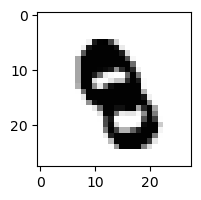

2.6891936021596372e-06% - 0
0.0011083432085486813% - 1
0.007607905992096356% - 2
0.0008557118945622143% - 3
1.2560761867381476% - 4 - ОШИБКА
0.6632426165738783% - 5
0.011280199379437871% - 6
0.041024852013317605% - 7
0.007558399047717421% - 8
0.7261688436447198% - 9

 1


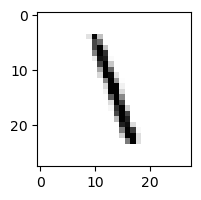

0.17067441507448808% - 0
49.70269424439972% - 1
6.3287890494078995% - 2
6.843046787754823% - 3
16.950863651115295% - 4
50.90774274594717% - 5 - ОШИБКА
10.119364707703802% - 6
3.3242133373726226% - 7
46.02728077513232% - 8
3.9162701377194478% - 9

 3


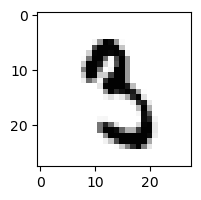

0.015959553171350907% - 0
0.50908807780186% - 1
0.011719372581142857% - 2
21.15683336191283% - 3
0.040154257222719106% - 4
57.904447592629495% - 5 - ОШИБКА
0.1933747406001995% - 6
0.1726640867240414% - 7
3.9219688067081884% - 8
2.23498056451537% - 9

 8


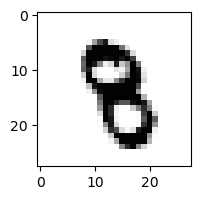

3.360884801256617e-05% - 0
0.02619215394732293% - 1
0.11967115916600804% - 2
0.6731553721359229% - 3
0.6965030972034013% - 4
0.5458713006752525% - 5
0.02786937668746604% - 6
0.0713022817074411% - 7
0.49763228483964406% - 8
6.812965129046483% - 9 - ОШИБКА

 3


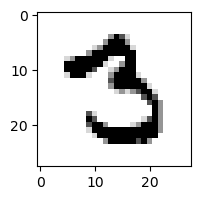

0.13914914179584567% - 0
0.03033263429592215% - 1
0.1812922858661823% - 2
10.925041127839807% - 3
0.0006964540033952946% - 4
12.403046902131456% - 5 - ОШИБКА
0.00885466972812765% - 6
1.2898980954100876% - 7
1.7126602798366375% - 8
0.009864094371033576% - 9

 3


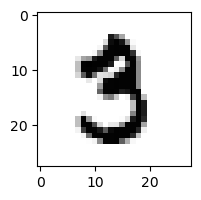

0.03844683275178295% - 0
0.014458816673236754% - 1
0.018382776176572607% - 2
9.524203128768312% - 3
0.0015379955723412051% - 4
33.43511918177467% - 5 - ОШИБКА
0.008444643321362156% - 6
0.10917483300753913% - 7
3.994496436854488% - 8
0.04251524998664362% - 9

 2


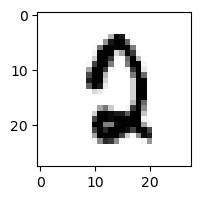

2.0301407442047643% - 0
0.00036681913960214717% - 1
1.3730870564197744% - 2
0.0196071301125619% - 3
0.0477070263201899% - 4
9.641770336867216% - 5 - ОШИБКА
1.3489271592924628% - 6
2.346587863215059% - 7
0.38092962340121284% - 8
0.042649322353140146% - 9

 4


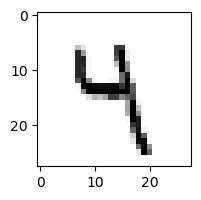

0.04136637501543158% - 0
1.57073307561275% - 1
0.15094797563589643% - 2
32.820064458281244% - 3
47.19092042729991% - 4
16.929503522619363% - 5
6.652430995280803% - 6
0.13770376418250932% - 7
4.223449744152719% - 8
93.6020439222256% - 9 - ОШИБКА

 5


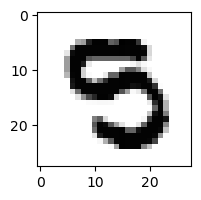

0.03683363266273967% - 0
0.0006163219191466982% - 1
0.002713205221537326% - 2
11.790230544840497% - 3 - ОШИБКА
0.023188482473363418% - 4
0.7262159612693835% - 5
0.003314221816235144% - 6
0.00032966459167058695% - 7
0.028741735950467993% - 8
0.017013060069232915% - 9

 8


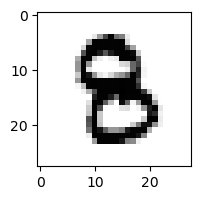

0.004554490744143609% - 0
0.0007092946169787959% - 1
0.012577026920443369% - 2
8.995118159996363% - 3 - ОШИБКА
0.125443709147874% - 4
2.401859857828165% - 5
0.02869097471651676% - 6
0.0005727593848239994% - 7
0.6488036290314213% - 8
0.05495800099737014% - 9

 3


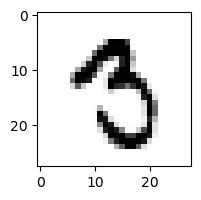

0.1652289295497982% - 0
0.3705289272383211% - 1
0.0049817672321100645% - 2
0.9385581383726626% - 3
0.007551334358295341% - 4
11.399336462748188% - 5 - ОШИБКА
0.12078587141986029% - 6
1.228687004781918% - 7
2.706184399821367% - 8
5.233901043945513% - 9

 3


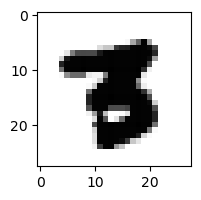

2.2936805252493217e-05% - 0
7.467295973258168e-05% - 1
0.00010272877926530945% - 2
0.013725131040230983% - 3
0.0021061370612295016% - 4
0.07548249106985817% - 5 - ОШИБКА
0.00019990837994190557% - 6
0.02912499091470811% - 7
0.00455775540243345% - 8
8.392750665213142e-05% - 9

 9


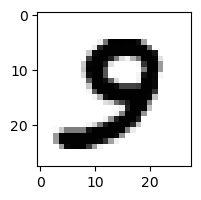

0.08825278600687726% - 0
4.5253010216116116e-05% - 1
0.0021747429495630774% - 2
2.71050153978424% - 3
0.0810977722395525% - 4
7.429171304221907% - 5 - ОШИБКА
0.005096019483214922% - 6
0.0389765161604912% - 7
0.8542596151106798% - 8
0.010629415007364905% - 9

 3


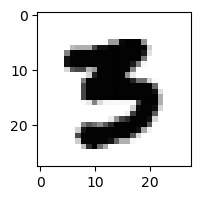

0.0030935097405135276% - 0
2.9199763914685028e-05% - 1
9.345477806457837e-06% - 2
5.64656921911937% - 3
0.0008413653418973547% - 4
11.241463704487176% - 5 - ОШИБКА
0.0021240958826314565% - 6
0.007449575953093842% - 7
9.95277940877595e-05% - 8
2.93100632535725e-05% - 9

 8


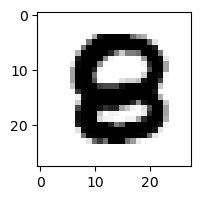

0.015913048824126277% - 0
6.753480680282408e-07% - 1
0.052091958138852444% - 2
9.853331960728758e-05% - 3
0.08199066899632323% - 4
0.09397066928439168% - 5 - ОШИБКА
0.021114669134855917% - 6
1.3308912471398343e-06% - 7
0.057972452217290485% - 8
4.356003374028458e-06% - 9

 9


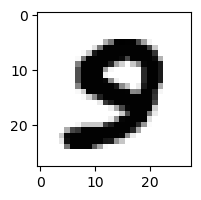

0.08014723026345387% - 0
4.009302650864799e-06% - 1
3.772852514488707e-05% - 2
0.07369140246095175% - 3
0.01755067411817991% - 4
4.712505648890192% - 5 - ОШИБКА
0.0005773002077007643% - 6
0.007248535941894152% - 7
0.06380858362306722% - 8
0.0021442501989869% - 9

 9


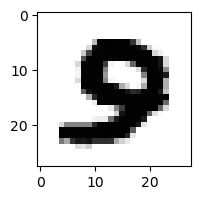

0.10359644009298741% - 0
9.296591624337458e-07% - 1
0.0003619964784207107% - 2
0.07362195409140689% - 3
0.005250928276582475% - 4
0.43234886898588637% - 5 - ОШИБКА
0.0006866621347729443% - 6
0.001499026100276947% - 7
0.004602571743205206% - 8
6.600678851074191e-05% - 9

 2


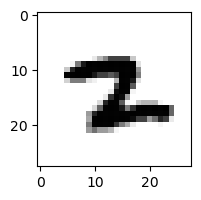

0.0003223313199552366% - 0
2.570002466062792% - 1
0.0811373781535148% - 2
0.0002330976322101205% - 3
0.013027857776914783% - 4
0.18764174429580516% - 5
7.297329414117061% - 6
11.01828506603904% - 7 - ОШИБКА
0.08198625416830572% - 8
0.060809630190421717% - 9

 9


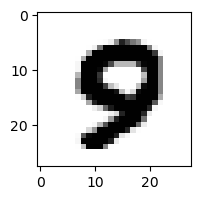

0.12426172033571141% - 0
2.788823154549339e-06% - 1
0.00020795823736425976% - 2
0.0011481822940335822% - 3
0.43793466583416774% - 4
0.857043076711677% - 5 - ОШИБКА
0.0036599649416778133% - 6
0.06826119879889521% - 7
0.025103557563362116% - 8
0.054159376130422564% - 9

 9


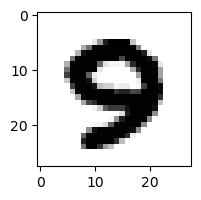

0.03137113635932815% - 0
5.578985129999945e-07% - 1
0.00022417298142663% - 2
0.021527688916003148% - 3
0.09526326320535956% - 4 - ОШИБКА
0.007544941648429913% - 5
0.0011843544164191469% - 6
0.042973577489057224% - 7
0.0019343127731702434% - 8
0.003888580123023224% - 9

 9


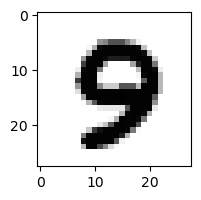

0.06525279389048198% - 0
4.547082868609744e-06% - 1
0.000539974723262457% - 2
0.06585794237425281% - 3
0.3705953834797617% - 4 - ОШИБКА
0.26775651055328925% - 5
0.0081686007077764% - 6
0.048985424318877736% - 7
0.02644584975898617% - 8
0.31297909387030004% - 9

 9


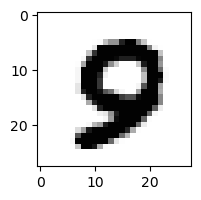

0.26647883826489954% - 0
4.739626898759172e-06% - 1
0.0015275224435719597% - 2
0.0009508551257997124% - 3
0.2145299878047156% - 4
0.669081458892019% - 5 - ОШИБКА
0.006874150695590338% - 6
0.0358938176709613% - 7
0.017109704896343978% - 8
0.00454106208154629% - 9

 9


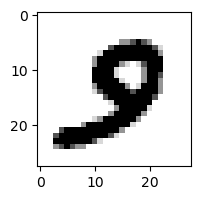

0.14389481643769297% - 0
0.002792157577665039% - 1
0.0012164709490340296% - 2
0.37713474596087265% - 3
0.004960628279408107% - 4
1.4444952719648918% - 5 - ОШИБКА
0.004072353982147552% - 6
0.08568747609552703% - 7
0.023636922402573694% - 8
0.004338143405790148% - 9

 9


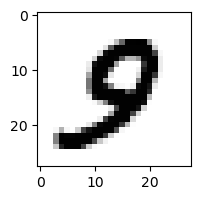

0.22458191167298516% - 0
0.0009411493522683786% - 1
0.03830544055052654% - 2
0.07502771267041024% - 3
0.6674842211450032% - 4
4.890932959418453% - 5 - ОШИБКА
0.01181076375493818% - 6
0.18151102028255814% - 7
0.1376089828112127% - 8
0.2643133707654598% - 9

 9


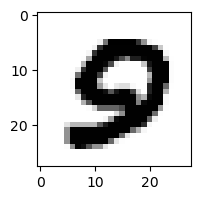

0.30111306394864856% - 0
3.3585865006629884e-06% - 1
0.00036259371387894747% - 2
0.0027721169280399338% - 3
0.03179689290809299% - 4
0.43712456301056424% - 5 - ОШИБКА
0.007879307457772463% - 6
0.0004650849188592746% - 7
0.008217588032737463% - 8
0.00017418101905274092% - 9

 9


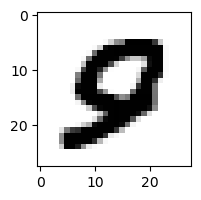

0.6851736953409402% - 0
2.6172551761988634e-05% - 1
0.012875146748332488% - 2
3.7336506522161606e-05% - 3
0.6914523417670473% - 4 - ОШИБКА
0.5687755383895646% - 5
0.027802807356303104% - 6
0.026695991706343528% - 7
0.004186365518565322% - 8
0.026417414484468528% - 9

 3


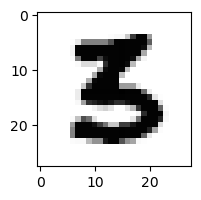

0.009717498768563515% - 0
0.0001390101290336926% - 1
0.03154428034179747% - 2
9.858903825567708% - 3
0.0009895483967799787% - 4
32.083536911707704% - 5 - ОШИБКА
0.0059053102751589455% - 6
1.536965320477283e-05% - 7
0.00010395413127392898% - 8
7.79583303299414e-06% - 9

 8


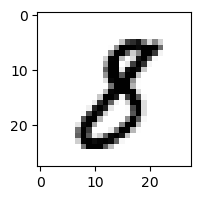

0.13520316790382464% - 0
4.0461265048373765% - 1
0.052753624151154775% - 2
13.297983965992731% - 3 - ОШИБКА
0.015818354342253205% - 4
0.49707652826016097% - 5
0.005185583574796957% - 6
0.11070233981401187% - 7
6.442898703407261% - 8
0.015016367769425935% - 9

 8


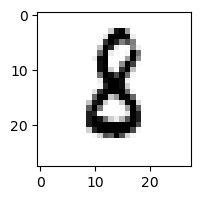

0.14008090928915767% - 0
0.5198658100712684% - 1
1.1261323201305258% - 2
3.8252518885447793% - 3
0.019863637627198057% - 4
4.020329734880715% - 5
21.58316456685348% - 6 - ОШИБКА
0.012644823799445003% - 7
2.2697179783486088% - 8
0.00906091912122442% - 9

 5


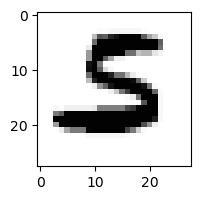

0.01095089311415478% - 0
0.0005803644069547515% - 1
6.7990274151336125% - 2
0.08081141693155504% - 3
0.00028607927008654835% - 4
16.322524430171807% - 5
17.190413633127445% - 6 - ОШИБКА
0.00029999395936802824% - 7
0.0034342804729508873% - 8
1.8943321686319927e-05% - 9

 2


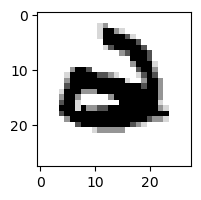

0.06820359579681749% - 0
9.443858572592145e-05% - 1
0.0016771762979947724% - 2
0.00024151354340960616% - 3
0.4150032298549761% - 4
0.0014508686024673396% - 5
3.337631443561251% - 6 - ОШИБКА
5.026823634707223e-05% - 7
0.00017528807473402792% - 8
0.00575037854589854% - 9

 2


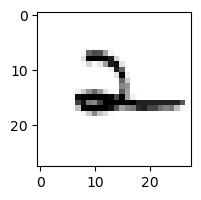

0.2790795683626376% - 0
3.625657353404229% - 1
44.365167122898285% - 2
0.6642439893478743% - 3
88.94478557031317% - 4 - ОШИБКА
0.12799595319586202% - 5
40.84600778555673% - 6
2.487370020942745% - 7
2.4079759494548303% - 8
29.303203647761762% - 9

 6


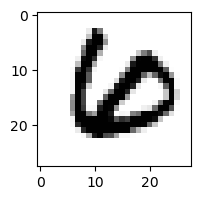

0.02038846647842586% - 0
0.0028386061515776784% - 1
1.1763866830130107% - 2 - ОШИБКА
0.007365767440841973% - 3
0.007286738281204196% - 4
0.0015117679470495076% - 5
0.5118517835478574% - 6
0.01113746748226133% - 7
0.24646622758121667% - 8
6.890802691712494e-05% - 9

 0


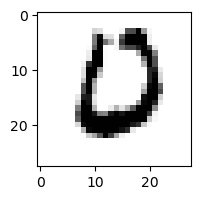

42.79739426602613% - 0
0.0001501370519711917% - 1
5.758299184700814% - 2
0.0017088683244587007% - 3
0.13787931106502396% - 4
0.9550544377388231% - 5
83.57016380760109% - 6 - ОШИБКА
0.030720587807509376% - 7
0.02250529965627771% - 8
5.12003948144175e-05% - 9

 3


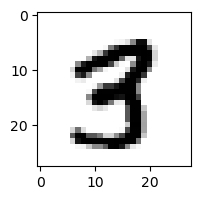

0.012419980133645796% - 0
0.0034527407692453976% - 1
0.020660110807875533% - 2
3.3227401651772457% - 3
0.3514143682264889% - 4
1.2440566393386223% - 5
9.691362038870644e-05% - 6
0.10102902769287753% - 7
18.793064042134578% - 8 - ОШИБКА
1.572975136449266% - 9

 3


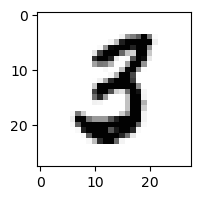

0.6393546283083062% - 0
0.014918355207754704% - 1
1.3348619061258145% - 2
21.706832152085116% - 3
0.015482516291142747% - 4
33.334203941856025% - 5 - ОШИБКА
0.06241569296875629% - 6
0.014876142363575548% - 7
0.052928718821940536% - 8
0.0008098855491142631% - 9

 3


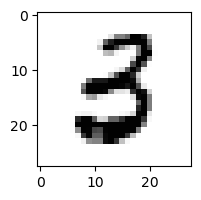

1.461002988021518% - 0
0.03880166052376551% - 1
0.046107713604396326% - 2
37.93178395970298% - 3
0.2680842517351388% - 4
56.23648041345497% - 5 - ОШИБКА
0.37311082598167294% - 6
0.0013644003476637621% - 7
0.005616237308948419% - 8
2.5100933522044074e-05% - 9

 2


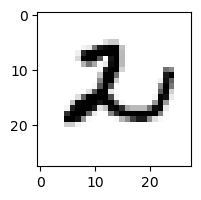

5.047209538011269% - 0
0.022377555932551578% - 1
18.78079680560492% - 2
1.2708406323959525% - 3
1.349446812908085% - 4
0.2721961231350841% - 5
26.758446760681426% - 6 - ОШИБКА
0.015406475671096806% - 7
1.8504199954371274% - 8
1.3439624247112192% - 9

 3


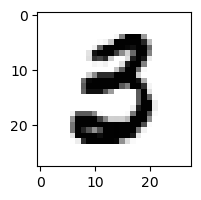

5.254223498082904% - 0
0.002310340290641401% - 1
0.008245871804802928% - 2
25.31076608195722% - 3
0.0022769458406059198% - 4
73.25210272265576% - 5 - ОШИБКА
0.017382409526879947% - 6
0.0018664343220679497% - 7
0.006489886619344351% - 8
2.568899460395722e-05% - 9

 8


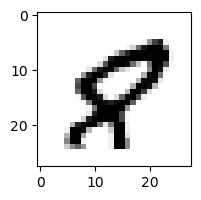

1.4819962707959828% - 0 - ОШИБКА
0.027577489323781013% - 1
0.003765972932752642% - 2
6.97013523142364e-06% - 3
1.3764281368086349% - 4
1.4407521694927952% - 5
0.02071740398258588% - 6
1.3358676600406632% - 7
0.2870588080763456% - 8
0.17675976501216314% - 9

 3


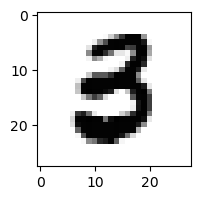

0.8282608225998203% - 0
0.0006600201150043451% - 1
0.009906413839499575% - 2
10.771260483499008% - 3
0.020212552335005397% - 4
43.388737347490306% - 5 - ОШИБКА
0.07141338305040655% - 6
0.0005868311603579173% - 7
0.0003639828400486122% - 8
1.0092830827499019e-05% - 9

 9


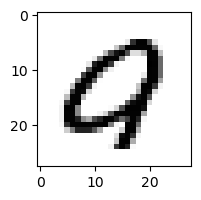

59.14124465705369% - 0 - ОШИБКА
0.0005331235317102354% - 1
0.18858897387646095% - 2
0.0006266433239259402% - 3
0.42932268034563065% - 4
3.6123130923567155% - 5
0.10846588880184252% - 6
0.4173459846849182% - 7
0.050660342736216696% - 8
0.05001664807247773% - 9

 9


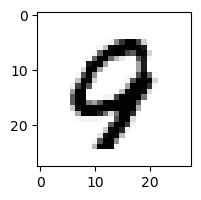

0.303003144918935% - 0
0.0007237632306851515% - 1
0.3566840928456439% - 2
7.021253114200589e-05% - 3
35.39960692711065% - 4 - ОШИБКА
0.0027319280085996308% - 5
0.7061414316573099% - 6
0.9834088216672113% - 7
2.8210961715031386% - 8
21.370704238353415% - 9

 9


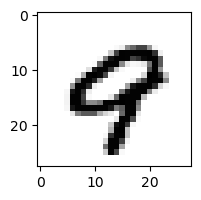

1.7122413434955328% - 0
0.0013198017502761151% - 1
0.0006247411497233847% - 2
2.311457729821166e-05% - 3
34.55685133658019% - 4 - ОШИБКА
0.001115220788150999% - 5
0.1498151376891021% - 6
7.018583283141335% - 7
0.5585060810543339% - 8
31.34046634188466% - 9

 3


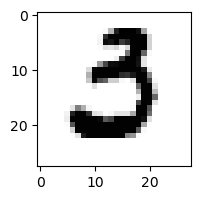

29.1602526337844% - 0 - ОШИБКА
0.00381913529288911% - 1
0.33781786391106716% - 2
0.47270446370035973% - 3
9.412684511480772e-05% - 4
1.7551777420455477% - 5
1.2797654885801402% - 6
0.5852601769426513% - 7
0.0003554536191729347% - 8
2.9317072937393915e-06% - 9

 8


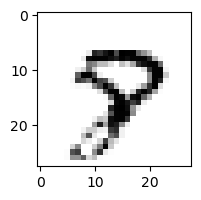

0.20255114291334556% - 0
0.016811640179429183% - 1
0.011194871886101647% - 2
0.013293648510337935% - 3
0.72516983733162% - 4
1.965059794554752% - 5
0.05510256365423915% - 6
33.59635549948305% - 7 - ОШИБКА
1.9852875355061095% - 8
12.20412288159909% - 9

 9


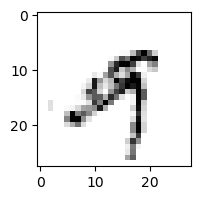

0.652429636143493% - 0
1.7805354014708588% - 1
0.521612647294652% - 2
13.63792034239287% - 3
20.175723023524707% - 4 - ОШИБКА
1.1570700595927215% - 5
0.2245560748078417% - 6
0.6720817947059947% - 7
1.2544124463312938% - 8
15.677591980248001% - 9

 7


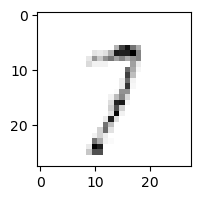

5.787457689164461% - 0
19.46744068305003% - 1
34.40882761900182% - 2
37.0288223886267% - 3
4.870998581494507% - 4
7.899196009061002% - 5
4.5834728057324945% - 6
72.77647419276927% - 7
31.762302745286746% - 8
83.93327181518424% - 9 - ОШИБКА

 9


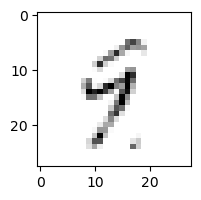

0.4324362330862006% - 0
16.46726737591608% - 1
4.285626785579387% - 2
12.593100276945753% - 3
68.93406579326205% - 4 - ОШИБКА
15.014692665368404% - 5
9.778732809698571% - 6
1.6754539573292087% - 7
28.155061789613207% - 8
58.022166532225626% - 9

 3


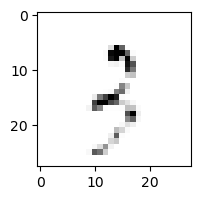

3.881791568548201% - 0
21.383701381107777% - 1
50.82433829401112% - 2
39.41020111563498% - 3
4.434864053404819% - 4
3.8458288291407627% - 5
9.549279167185814% - 6
14.569966500055088% - 7
66.65337593194681% - 8
94.02346168243378% - 9 - ОШИБКА

 1


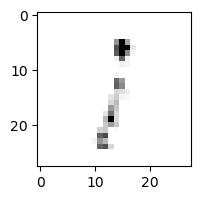

20.70645706826263% - 0
54.82593414629549% - 1
55.10623754299901% - 2
42.53986991761698% - 3
6.777799139662075% - 4
24.358024444233905% - 5
22.035394941124206% - 6
13.6130912961545% - 7
76.2644711286819% - 8 - ОШИБКА
62.774742560655085% - 9

 2


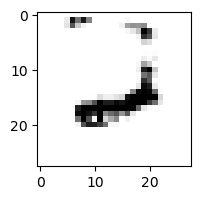

2.0693660773284406% - 0
0.5741704977675532% - 1
73.70608435549404% - 2
0.03809504224268628% - 3
84.20003456802922% - 4
0.027565682369080993% - 5
88.98771080735926% - 6 - ОШИБКА
10.615065680064127% - 7
6.814414779282149% - 8
9.724677494217097% - 9

 0


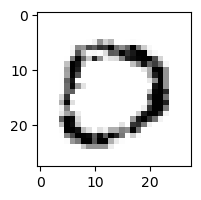

94.7919090472137% - 0
0.007377742808869912% - 1
0.8949411569659504% - 2
96.00020594466184% - 3 - ОШИБКА
0.003772236424428701% - 4
0.25029812868499374% - 5
0.007163247065198409% - 6
2.204342899064938% - 7
1.5090425087765096% - 8
0.020700146563987942% - 9

 0


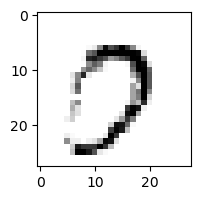

38.54997690049765% - 0
0.0024834130681005463% - 1
0.8240361880961047% - 2
25.428704817022513% - 3
0.18265681976884746% - 4
1.7944602684631863% - 5
0.06228631030634322% - 6
92.25016123225686% - 7 - ОШИБКА
1.9921417558408867% - 8
68.44434350590818% - 9

 5


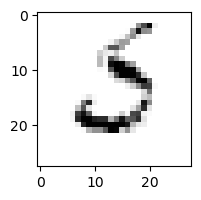

19.683459821774772% - 0
1.553298985815544% - 1
31.19523252649482% - 2
11.881633468687566% - 3
0.026684266275827973% - 4
0.5918991646941163% - 5
67.98917178432366% - 6 - ОШИБКА
21.478485838671883% - 7
0.15420857987833075% - 8
0.14121912061304473% - 9

 8


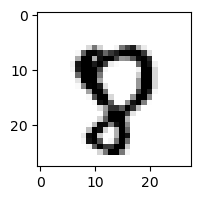

0.5372715500376536% - 0
0.00010852763373839198% - 1
0.014645940878670147% - 2
0.0010091205918765886% - 3
0.6251019814294708% - 4
16.035360298943015% - 5
0.01594197820921308% - 6
48.12754004831009% - 7 - ОШИБКА
0.8352086100484144% - 8
8.63906147969854% - 9

 9


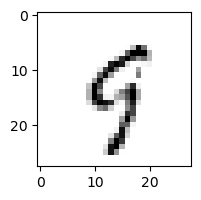

2.675265138501911% - 0
0.45530345504009395% - 1
0.4616528967309656% - 2
3.363169852286555% - 3
51.768927887608115% - 4 - ОШИБКА
11.423744928146332% - 5
3.4486507698349165% - 6
12.406623879400845% - 7
4.15091232713191% - 8
23.274205744606792% - 9

 8


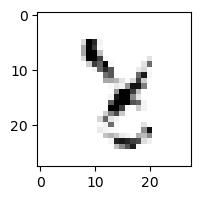

0.012839563514250764% - 0
3.1651514048607936% - 1
5.78302828196112% - 2
1.0018384368076878% - 3
67.13630292358755% - 4 - ОШИБКА
4.2437750686434885% - 5
1.9259444888821815% - 6
51.31825041589412% - 7
52.44656873786224% - 8
3.4526414656287976% - 9

 9


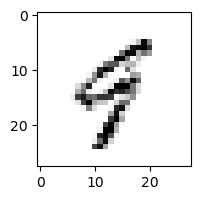

0.7875479693293583% - 0
3.6599848216527913% - 1
0.19819450438205602% - 2
0.34653343731654607% - 3
39.639737069721974% - 4 - ОШИБКА
1.6314327343952546% - 5
4.377489459858125% - 6
1.9250148817866335% - 7
2.54719618397591% - 8
27.77016884356398% - 9

 9


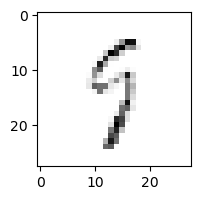

4.292067698478971% - 0
2.6955605927259234% - 1
12.349680030125386% - 2
18.78404098664382% - 3
25.442468890323195% - 4
30.27707867116836% - 5
16.206389656267465% - 6
13.367740678055599% - 7
67.52663430838523% - 8 - ОШИБКА
36.61189186570738% - 9

 8


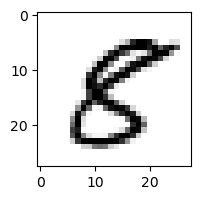

1.7193533193097483% - 0
0.03875498860657517% - 1
0.02043564148945174% - 2
0.08877401482596006% - 3
11.70767256878264% - 4
77.74781018432189% - 5 - ОШИБКА
0.0002625095808282179% - 6
0.004063100512693537% - 7
8.59184035553998% - 8
0.021043190680228172% - 9

 9


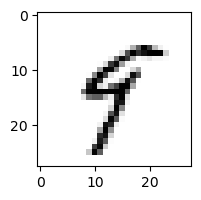

0.3045683266483135% - 0
7.410426985644484% - 1
0.04609849189669064% - 2
0.8456083460115489% - 3
55.31184681249142% - 4 - ОШИБКА
25.529006269511754% - 5
1.8650206121764414% - 6
2.51063302600004% - 7
3.323523697166739% - 8
15.708002291420922% - 9

 0


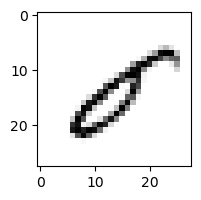

2.316377000570306% - 0
2.5190678595375515% - 1
47.5779788649209% - 2 - ОШИБКА
10.573600898481192% - 3
27.096436829970415% - 4
22.323350450306165% - 5
0.18901609075869594% - 6
0.6736309912656264% - 7
21.21685333634859% - 8
0.6385302140312853% - 9

 1


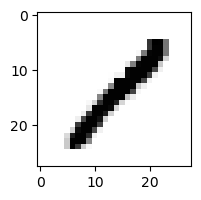

0.16808666671249292% - 0
67.32114783823583% - 1
6.614572385969737% - 2
2.486960431074001% - 3
4.261484209831206% - 4
0.48252239584670314% - 5
0.03345202981593779% - 6
0.3620779453932352% - 7
91.82427971366617% - 8 - ОШИБКА
0.3730125936079307% - 9

 1


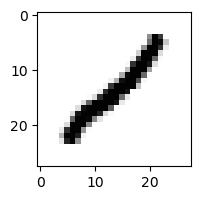

0.4838494045039947% - 0
49.72971696074769% - 1
37.718087396283% - 2
6.011845899189989% - 3
30.420336260017745% - 4
0.27077673026236987% - 5
0.12671569715234776% - 6
0.07046557849334455% - 7
88.0965511343948% - 8 - ОШИБКА
2.876256879471284% - 9

 6


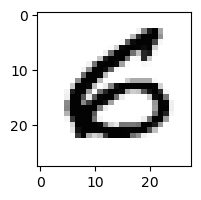

37.109723851353785% - 0 - ОШИБКА
0.0018422664714827534% - 1
0.0429080983122301% - 2
0.0005692727782532805% - 3
0.08018204483217993% - 4
2.2127449896224216% - 5
18.564297077926025% - 6
2.93707173551212e-05% - 7
0.026697051207827047% - 8
0.05472012172749577% - 9

 9


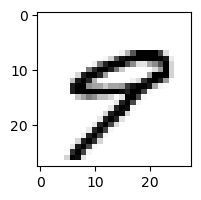

1.9036316714954273% - 0
0.04425230650752859% - 1
0.0004494299428850733% - 2
0.001958164966237063% - 3
18.763168648257455% - 4 - ОШИБКА
3.581472619329175% - 5
0.08280598064905575% - 6
12.880409318506066% - 7
0.10926491584901588% - 8
13.4990530900461% - 9

 1


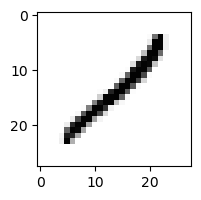

1.2920231994810822% - 0
50.19517023499907% - 1
47.37143101020491% - 2
13.092957169259314% - 3
29.95721885514402% - 4
1.0374418272895305% - 5
0.5434995618476504% - 6
0.8903148488788988% - 7
97.98390146940486% - 8 - ОШИБКА
8.491228922020664% - 9

 5


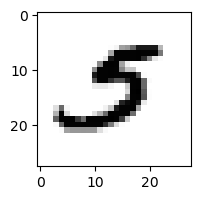

0.5008856183506317% - 0
0.31674773551877555% - 1
1.054722155203304% - 2
0.23105484077440563% - 3
0.06631794945970944% - 4
10.270110178487597% - 5
0.04896669636356629% - 6
20.39063183906065% - 7 - ОШИБКА
0.048143063188405236% - 8
0.8721410582212507% - 9

 5


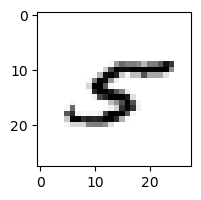

1.0138594465526019% - 0
2.7201857545684547% - 1
3.1315547735263425% - 2
1.4705384773216355% - 3
15.567593914302305% - 4
5.393994491440289% - 5
1.9848616732609698% - 6
2.6717035175240302% - 7
19.58402009624022% - 8 - ОШИБКА
0.7757412038288342% - 9

 9


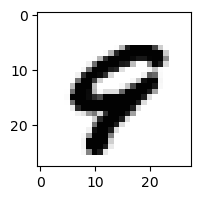

0.35712159198230564% - 0
0.0006388963082202108% - 1
0.0005416097428069888% - 2
1.2558370600892558e-06% - 3
11.212466779996944% - 4 - ОШИБКА
0.026980210412339646% - 5
0.053294329569871825% - 6
1.2969444816875997% - 7
0.011923316210620814% - 8
2.780035133888652% - 9

 2


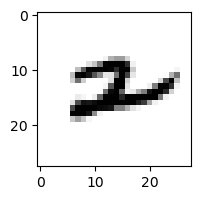

0.06693391580554306% - 0
9.580757918156833% - 1
0.021293791403759556% - 2
0.004057582988849557% - 3
60.00849498929131% - 4 - ОШИБКА
0.008343207085491725% - 5
11.391559162282777% - 6
1.043127660567728% - 7
0.5970765881710913% - 8
18.97104819374031% - 9

 3


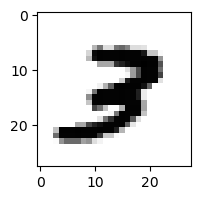

0.03322797523867235% - 0
0.005047142319657694% - 1
5.2631060025601215% - 2 - ОШИБКА
5.02104677514742% - 3
0.007949842082534292% - 4
0.009920664211102765% - 5
0.0026307842712457105% - 6
0.5643120550464324% - 7
0.13610579534400893% - 8
1.3972797094931044% - 9

 9


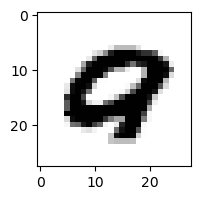

6.358735390326135% - 0 - ОШИБКА
1.6306075451411025e-05% - 1
0.0015299426062387695% - 2
2.5401842608414595e-07% - 3
0.1936290503804002% - 4
0.0008908057143069641% - 5
0.02193295451383213% - 6
0.6033866995724212% - 7
0.006123356022569049% - 8
0.2016583118946935% - 9

 2


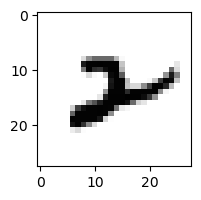

0.02212222661661877% - 0
9.49771678636348% - 1
0.48959207951400935% - 2
0.001337048522457168% - 3
2.458624629066062% - 4
0.04109920138814183% - 5
36.66340326545305% - 6
0.2846070087758698% - 7
39.822383192919695% - 8 - ОШИБКА
4.0691471013995875% - 9

 5


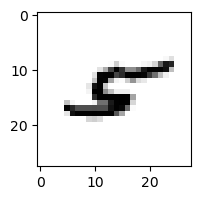

0.3758168525354178% - 0
3.820590732676575% - 1
2.2950792466967522% - 2
0.06114214254884082% - 3
88.6551444702208% - 4 - ОШИБКА
0.10897676290599861% - 5
8.244526179303682% - 6
1.4363235428263872% - 7
84.98938739355711% - 8
21.908944679867407% - 9

 9


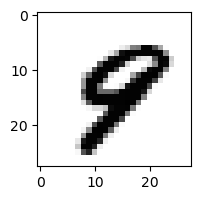

0.05281482364102603% - 0
0.006248371013999606% - 1
0.0018673442210006296% - 2
0.00023061887820408205% - 3
12.14811614724591% - 4 - ОШИБКА
0.6317036767851061% - 5
0.06574693586459594% - 6
1.8916545216643113% - 7
0.3736542189400502% - 8
3.682603224741532% - 9

 8


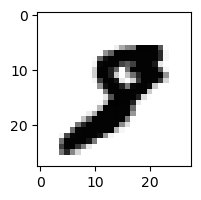

0.03977969747221672% - 0
0.20126267768310527% - 1
0.012831924765386058% - 2
0.011610221274475866% - 3
0.002002868575488862% - 4
0.04140903303179111% - 5
0.0006189010284254777% - 6
2.288299389777518% - 7 - ОШИБКА
0.48212757167859843% - 8
0.05421704672348602% - 9

 7


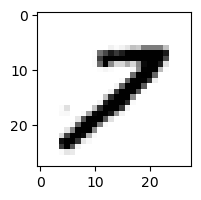

0.40142626135935505% - 0
3.0273753185756602% - 1
34.92686291198727% - 2
0.10937536194569712% - 3
0.04605932646177913% - 4
0.08996367564339001% - 5
0.004278364745995977% - 6
10.095343587427784% - 7
65.00874945337598% - 8 - ОШИБКА
10.878032491414105% - 9

 4


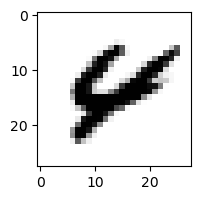

0.3179776481018497% - 0
0.005292143386131768% - 1
0.047903620695837264% - 2
7.925740565221676e-06% - 3
16.387452242809132% - 4
0.04823464432452875% - 5
2.2953609689418597% - 6
0.04652426189738153% - 7
45.506849058715524% - 8
82.24543960430762% - 9 - ОШИБКА

 9


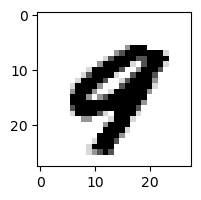

0.05406947318555292% - 0
0.00012180201804591585% - 1
2.9202089596325116e-05% - 2
9.144955328217324e-06% - 3
41.229803356452884% - 4 - ОШИБКА
0.0008196075929399006% - 5
0.013262677171508577% - 6
1.59290234729969% - 7
0.052258346533973425% - 8
1.6191757567290646% - 9

 5


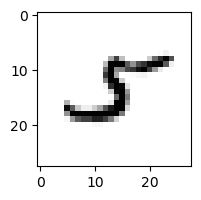

0.6480312170051892% - 0
62.740982736763165% - 1 - ОШИБКА
5.1590693116883% - 2
0.11805328143793871% - 3
1.8867071042525723% - 4
0.8987804891467113% - 5
0.6758691407074882% - 6
11.130561958132796% - 7
50.7985148599615% - 8
1.5452102283974676% - 9

 9


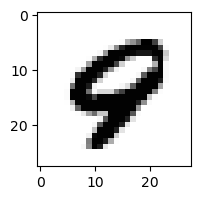

0.2648663726476173% - 0
0.0002541548569320637% - 1
0.0004801684412029847% - 2
2.3506222232740171e-07% - 3
36.061834625961176% - 4 - ОШИБКА
0.006840211463692823% - 5
0.5263544375981242% - 6
0.1310084144768937% - 7
0.1822057391575772% - 8
5.957750546375921% - 9

 2


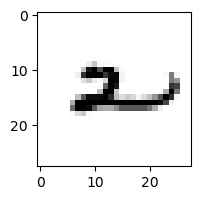

1.431231449766458% - 0
2.6141429085135015% - 1
0.3070297377461795% - 2
0.3207718251913559% - 3
96.3732528400082% - 4 - ОШИБКА
2.222623443611657% - 5
62.65999139900783% - 6
0.08950714083795192% - 7
16.74162615399611% - 8
21.01422768346265% - 9

 5


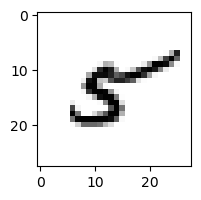

0.9622290697713868% - 0
5.019993044331322% - 1
0.740135874161513% - 2
0.06619715198530651% - 3
26.449852430403954% - 4
47.527547569264485% - 5
4.754657548041378% - 6
0.9597619817034057% - 7
69.44642495756676% - 8 - ОШИБКА
3.604962286252268% - 9

 9


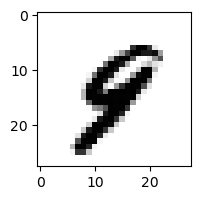

0.02574227458161798% - 0
0.3636894785208217% - 1
0.019557398559190777% - 2
0.00706211808729574% - 3
12.177224189225798% - 4 - ОШИБКА
0.5580042637726327% - 5
0.5218300248873171% - 6
0.43129729222045143% - 7
0.37465171163646416% - 8
4.240054899441356% - 9

 2


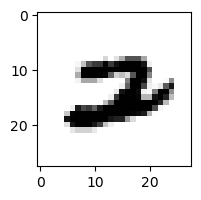

0.06066082585526887% - 0
0.011227873976349806% - 1
0.25657339072205937% - 2
0.00016612339701758518% - 3
0.8856275829994764% - 4
0.0021279560892852024% - 5
2.7208320640782837% - 6
41.31350760387754% - 7 - ОШИБКА
0.027200359862374568% - 8
0.04632152514039084% - 9

 9


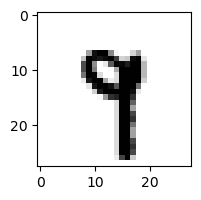

0.0006103977771489804% - 0
0.26447920852284595% - 1
0.003950820476133378% - 2
0.5902023345894858% - 3
7.765238487685316% - 4
0.9459491629846282% - 5
0.02548176958903135% - 6
22.008636380842113% - 7 - ОШИБКА
1.1346922308789116% - 8
9.389869869664972% - 9

 9


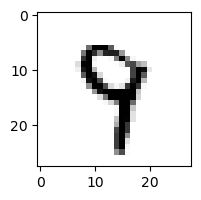

0.00656542396524022% - 0
0.036692051143974974% - 1
0.22281631899928517% - 2
1.8859804234672712% - 3
46.0285253076642% - 4 - ОШИБКА
3.102385048074478% - 5
0.7815880289017255% - 6
11.199279723515163% - 7
15.104443968519444% - 8
20.17617893441856% - 9

 9


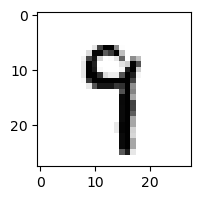

0.014237810765426528% - 0
0.453405553994946% - 1
0.023613348369650036% - 2
7.104625474553627% - 3
30.700134289609043% - 4 - ОШИБКА
21.47740702392122% - 5
0.528881857044894% - 6
11.866610333416384% - 7
18.745790515877896% - 8
24.563701271645176% - 9

 6


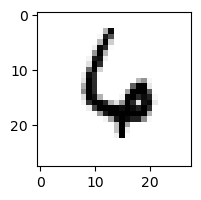

0.02787443647471199% - 0
0.010450732123231086% - 1
7.592417775977076% - 2
0.010557205263981127% - 3
92.28714100553577% - 4 - ОШИБКА
1.7613308066149576% - 5
69.5545116769607% - 6
3.060832491413706% - 7
0.07812786081154834% - 8
8.121070489955473% - 9

 2


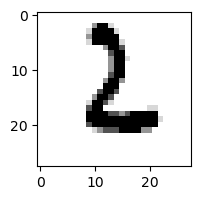

0.09275560217580944% - 0
1.8789604320641529% - 1
69.30861255551933% - 2
5.081882700668058% - 3
3.614395239521101e-05% - 4
0.5904731025796206% - 5
86.57316652243993% - 6 - ОШИБКА
0.0003953926620665821% - 7
0.5099210746974702% - 8
0.11779788590481383% - 9

 9


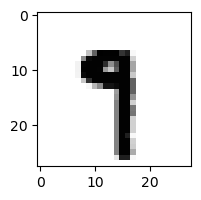

0.001062585023748657% - 0
0.5616839846715106% - 1
0.00032530081646671573% - 2
0.05099475352482953% - 3
0.3234492649702413% - 4
19.553392246622785% - 5
0.10717743300551659% - 6
41.25411131797227% - 7 - ОШИБКА
3.5016422426720233% - 8
20.889247035907943% - 9

 5


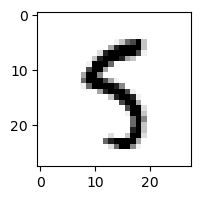

0.3124118042737282% - 0
0.05585470887282712% - 1
0.04342314010360469% - 2
0.878326846756765% - 3
3.4894515832288975% - 4
69.60768485252322% - 5
0.38687486355909084% - 6
0.09209429573962592% - 7
74.74602902059969% - 8 - ОШИБКА
65.06777502690062% - 9

 9


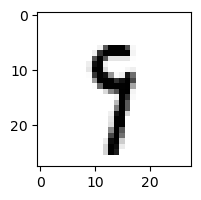

0.021088936823071086% - 0
2.2862410597439493% - 1
0.06509869622474203% - 2
3.320210464860015% - 3
4.616750039724758% - 4
33.461005156060494% - 5
2.3275148628736155% - 6
5.367817361586646% - 7
77.59247742341131% - 8 - ОШИБКА
65.57090986785188% - 9

 2


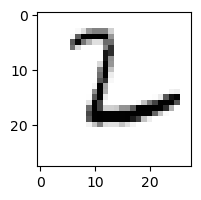

4.675018206089459% - 0
0.09980918538069275% - 1
84.27253123128094% - 2
0.7025452159901958% - 3
0.9914362320808625% - 4
1.2364450812442442% - 5
96.53840814951654% - 6 - ОШИБКА
0.3768616359438767% - 7
6.576673290201529% - 8
1.985876281551967% - 9

 5


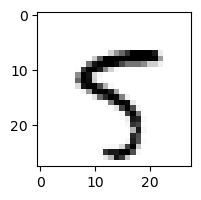

0.8263938935918862% - 0
0.09930797275242378% - 1
0.1009707515272903% - 2
0.06083308339246016% - 3
2.2028779339611053% - 4
60.004605942126354% - 5
0.0379720746370628% - 6
6.9080998896746575% - 7
6.088939500816854% - 8
82.69953858562472% - 9 - ОШИБКА

 9


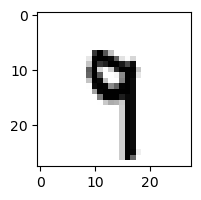

0.0015174798306103695% - 0
0.7890067758015522% - 1
0.0380405503333402% - 2
1.1723079498164302% - 3
24.897757965072316% - 4 - ОШИБКА
5.00352182914625% - 5
0.5138750918734818% - 6
6.780024827610267% - 7
4.786390870325689% - 8
23.939627078456976% - 9

 2


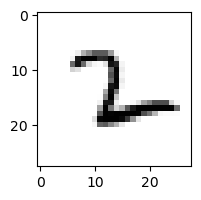

0.03767862435577497% - 0
18.729462239872646% - 1
30.087361315882745% - 2
1.5024558395998806% - 3
0.25192416397741507% - 4
4.927989436719378% - 5
34.220102046974695% - 6 - ОШИБКА
6.398697036499276% - 7
3.5130574703427375% - 8
0.4253367317989883% - 9

 9


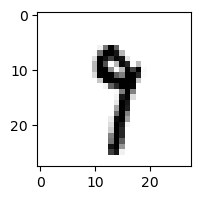

0.01718299479746865% - 0
6.285597521908273% - 1
0.059575442897642716% - 2
7.0988766127567295% - 3
1.0883614922979905% - 4
2.5934040610723277% - 5
0.3292313028956588% - 6
68.07430469291201% - 7 - ОШИБКА
7.0851073849736% - 8
19.443063050451297% - 9

 6


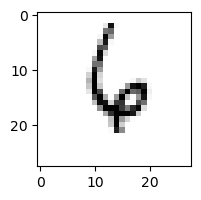

0.02977535535381092% - 0
0.5617747086362739% - 1
18.035530519112974% - 2
0.08403943823885765% - 3
95.21295334670896% - 4 - ОШИБКА
7.7205767370175415% - 5
66.66643487454994% - 6
9.34030496007778% - 7
3.7786541301071264% - 8
29.805007819943135% - 9

 3


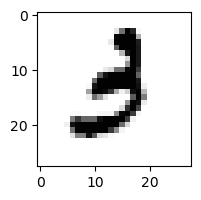

0.42074149509555536% - 0
0.14147178972200916% - 1
0.8000313098208345% - 2
19.471590851161473% - 3
0.10166543460439642% - 4
20.253570791626196% - 5 - ОШИБКА
1.165276255984832% - 6
0.024282749212038046% - 7
0.013847263223882151% - 8
0.0058279839909263% - 9

 8


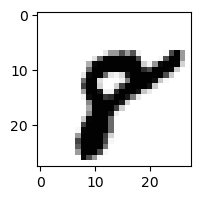

0.14062134530968318% - 0
0.00859682917874925% - 1
0.001053056138077701% - 2
7.43357604498676e-05% - 3
0.013464134849431493% - 4
0.08357756837399893% - 5
0.03720022015694429% - 6
8.9865072051889% - 7 - ОШИБКА
5.317280860572678% - 8
2.4671387669113782% - 9

 8


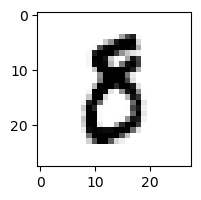

2.8564830953412073% - 0
0.008170037139966092% - 1
0.11748155692963326% - 2
8.088972239036785% - 3
0.023021103857641244% - 4
15.492280019596672% - 5 - ОШИБКА
0.21727076886997485% - 6
0.026982104810249475% - 7
1.6671919828629749% - 8
0.013815128301851833% - 9

 9


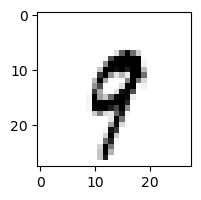

0.024700055049308972% - 0
2.8602749345569434% - 1
0.20123423180266561% - 2
0.12444916491068338% - 3
8.273546682899358% - 4
0.05651133364389017% - 5
0.645778682839766% - 6
51.31455522773084% - 7 - ОШИБКА
1.6085365583616082% - 8
21.092473706206267% - 9

 2


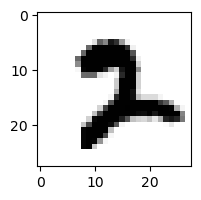

0.0006237985081544613% - 0
0.0059322456906844056% - 1
6.463839964481438% - 2
0.04205788382599034% - 3
0.00028027277333636985% - 4
0.10973173505712881% - 5
0.015357610464012145% - 6
29.148155043939987% - 7 - ОШИБКА
0.0014334959802205177% - 8
0.0025959834749443226% - 9

 9


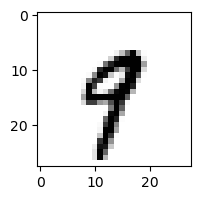

0.031554865150118266% - 0
4.356825994589532% - 1
0.026953303211089037% - 2
0.164732953305148% - 3
16.641167973497463% - 4
0.45052026651991844% - 5
0.3917945401970017% - 6
22.908064136046384% - 7 - ОШИБКА
0.19501997474570126% - 8
8.129711282473039% - 9

 9


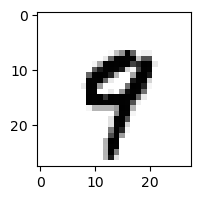

0.04192082742762261% - 0
0.02111304075131681% - 1
0.004564430704224469% - 2
0.013512912802600786% - 3
20.440943653629194% - 4
0.142661025756218% - 5
0.1162470722313509% - 6
32.25050205948589% - 7 - ОШИБКА
0.2445644274534493% - 8
26.724242823293444% - 9

 9


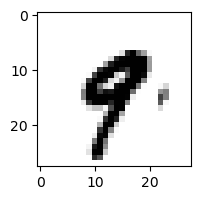

0.01691550234394074% - 0
0.6818891205317271% - 1
0.0012526838531181428% - 2
0.06984152265861834% - 3
19.38889590804074% - 4 - ОШИБКА
0.06748676897174054% - 5
0.11583299749511064% - 6
3.366658841228197% - 7
0.06150251911558843% - 8
6.061289476386074% - 9

 9


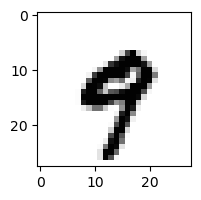

0.046505489139527935% - 0
0.02878825195225329% - 1
0.0005258891697490185% - 2
0.18340909838370084% - 3
37.79379890982963% - 4 - ОШИБКА
0.03969961693616762% - 5
0.11834364484991676% - 6
4.345265481877025% - 7
0.04463886347450519% - 8
22.08789989518149% - 9

 8


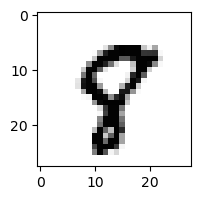

0.10004999115822553% - 0
0.012076969428874183% - 1
0.03370640968006312% - 2
0.002772170755531253% - 3
0.7329200727803927% - 4
2.894850853174061% - 5
0.00890964775103407% - 6
6.9333127161318355% - 7
4.835321217781507% - 8
12.106459273045312% - 9 - ОШИБКА

 9


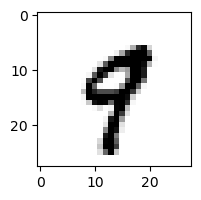

0.038634336037624326% - 0
0.24113430879510817% - 1
0.01703491422018704% - 2
0.08190427549643188% - 3
20.411058813203585% - 4
0.22918250878518065% - 5
0.02381648770638692% - 6
21.42416994649744% - 7 - ОШИБКА
0.26796366953147466% - 8
9.499141280811708% - 9

 9


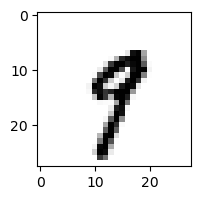

0.058712123956829926% - 0
2.3749356544408697% - 1
0.022629403835451603% - 2
5.57348290623797% - 3
15.263885815241387% - 4
1.1872943076411604% - 5
0.31479198774369405% - 6
38.31989998093443% - 7 - ОШИБКА
1.180010422437387% - 8
3.6770297021013603% - 9

 3


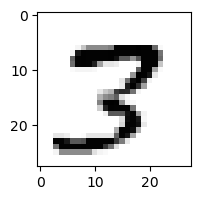

0.015954697318544823% - 0
0.015462918559464205% - 1
1.3692085989763985% - 2
7.1446084148715965% - 3
0.1621697233022973% - 4
0.39096388126578074% - 5
0.0002285028651276695% - 6
36.61329200921898% - 7
56.17919337707051% - 8 - ОШИБКА
0.38668649489281165% - 9

 8


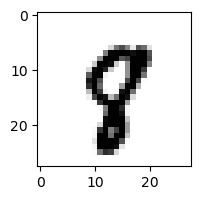

0.022934038370798715% - 0
0.02732189206063943% - 1
0.019485240578553865% - 2
0.006123822799649171% - 3
1.8995208649078172% - 4
0.8631791106511698% - 5
0.009979989249083197% - 6
29.82798608691231% - 7 - ОШИБКА
1.044018018841734% - 8
3.8005117199523095% - 9

 3


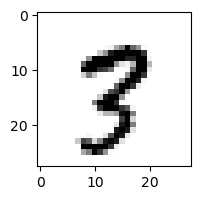

0.012422097979993937% - 0
0.359693942096582% - 1
0.12293235743783713% - 2
0.06929496519890918% - 3
0.10130518283011038% - 4
0.36317696439772396% - 5
0.00824824403903918% - 6
43.70291935604858% - 7
46.60517576262041% - 8 - ОШИБКА
31.644884748865376% - 9

 9


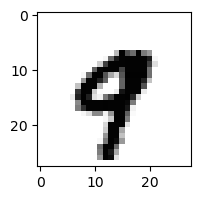

0.00878575481923116% - 0
0.028532975071691828% - 1
0.0003990829092076582% - 2
0.00040809857043073734% - 3
32.617855865010995% - 4 - ОШИБКА
0.0012458983707696841% - 5
0.02444359394530331% - 6
26.797951620576626% - 7
0.01622700834119726% - 8
15.67902022229558% - 9

 2


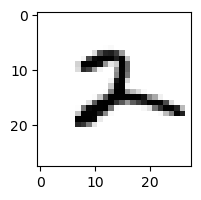

0.0700233640661345% - 0
8.742551235082942% - 1
20.1459948807574% - 2
0.15690927732523824% - 3
0.43990713576899576% - 4
0.37637828886379165% - 5
5.156904456165748% - 6
1.9164708282533576% - 7
21.98535179658469% - 8
26.660587458800116% - 9 - ОШИБКА

 9


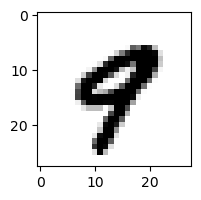

0.06333296078971415% - 0
0.01644833026966605% - 1
0.0003868373603109564% - 2
0.0017823087462897017% - 3
28.809980473374274% - 4 - ОШИБКА
0.04235485232459066% - 5
0.0060711315821992% - 6
4.701282069939763% - 7
0.1313714835338903% - 8
8.866292950304317% - 9

 5


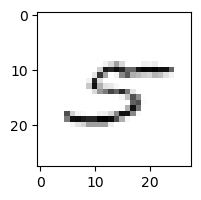

17.739085858566394% - 0
2.95066349934871% - 1
12.212029127049039% - 2
9.095247689371986% - 3
12.075408086844766% - 4
7.318952225557012% - 5
13.473529718937957% - 6
28.159830467857898% - 7 - ОШИБКА
19.171943476636642% - 8
7.625181297693359% - 9

 2


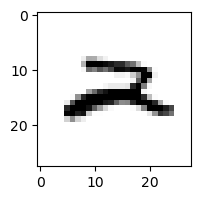

1.1438103109015443% - 0
0.1044265465295044% - 1
15.72028699667796% - 2
0.5963230915753294% - 3
82.70509433063114% - 4 - ОШИБКА
0.009829272875698854% - 5
3.76669784107812% - 6
2.365363348712312% - 7
0.20921469698499018% - 8
17.570898108445608% - 9

 0


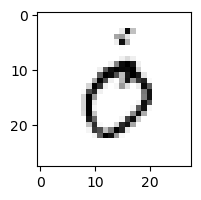

38.52588179875601% - 0
0.4971069959419643% - 1
0.2935779543372383% - 2
29.19829463296406% - 3
14.745753801082543% - 4
4.464310913462807% - 5
47.79194955692433% - 6 - ОШИБКА
14.492413949647458% - 7
0.7279801305941417% - 8
0.4939455920908933% - 9

 3


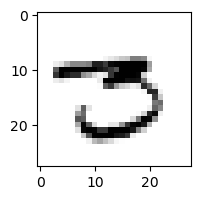

3.7936172344627157% - 0
0.4135695456791522% - 1
0.012544873179676732% - 2
14.667349135829383% - 3
0.012750434022471793% - 4
16.236880419673465% - 5 - ОШИБКА
0.0815830095770883% - 6
15.525089998377869% - 7
1.99528107373754% - 8
0.011836475821736636% - 9

 2


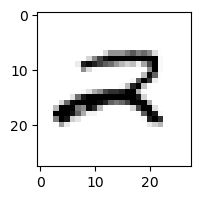

3.601211752437021% - 0
0.01858093728392072% - 1
42.09499621730854% - 2
3.072624453507088% - 3
14.603407008607997% - 4
0.033066034201965654% - 5
0.20500772231228356% - 6
0.8214382830955115% - 7
0.8895220994951927% - 8
71.48545934718126% - 9 - ОШИБКА

 5


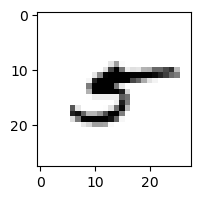

0.6706745483948482% - 0
22.457705976585647% - 1
0.32184217567041834% - 2
1.2228894296364319% - 3
20.514440258964093% - 4
1.2486871341928827% - 5
23.749170957114092% - 6
0.4392716418638521% - 7
57.55588004989794% - 8 - ОШИБКА
12.68749363518025% - 9

 3


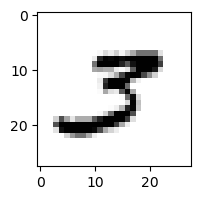

1.505470486369808% - 0
0.848228465512838% - 1
5.003336481603861% - 2
14.17226991680568% - 3
0.004880461162626949% - 4
3.7620189943092406% - 5
0.0029073202264263825% - 6
15.505699017195232% - 7 - ОШИБКА
0.7130827566233301% - 8
0.1370097380145968% - 9

 2


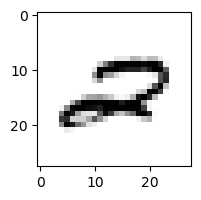

9.934630909461486% - 0
0.10255352127797547% - 1
5.038220801093052% - 2
0.022478577063376463% - 3
29.36068486027451% - 4 - ОШИБКА
0.004637549509426552% - 5
0.708953222636663% - 6
17.59189652629867% - 7
0.35403450756474025% - 8
0.4078569703549254% - 9

 8


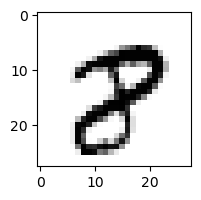

0.07266622462734527% - 0
0.1512618264417435% - 1
0.013031475396915109% - 2
0.0003523260266052786% - 3
0.0027933883844473545% - 4
0.0941283938549023% - 5
0.001557302651432282% - 6
22.74557686268041% - 7 - ОШИБКА
20.007781311044322% - 8
1.7884974800702624% - 9

 1


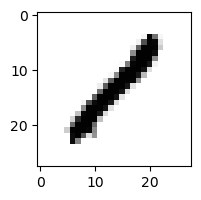

3.1970834298361375% - 0
60.857712709797994% - 1
12.845515420251994% - 2
11.892077844011245% - 3
2.1019427741596464% - 4
1.1494939132020492% - 5
0.03740714014497059% - 6
0.021439025531969687% - 7
68.87117642456742% - 8 - ОШИБКА
0.6425406818844117% - 9

 8


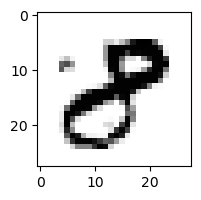

1.1200050778657376% - 0
0.08514409871064064% - 1
0.06130837894567829% - 2
8.477500901444897% - 3 - ОШИБКА
0.5557467587693106% - 4
0.002435422465745433% - 5
0.0014835083065138572% - 6
0.0031033899107147816% - 7
3.0030070114929885% - 8
0.4484343927624283% - 9

 3


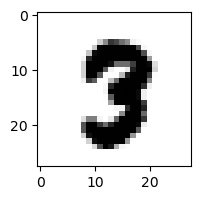

0.008088576267513416% - 0
0.00039449894863727715% - 1
0.010109316791507101% - 2
0.4186017727778206% - 3
0.0004633086559203016% - 4
0.33550840644274693% - 5
0.00013222661662707518% - 6
2.2719974950220245% - 7 - ОШИБКА
0.270826814713429% - 8
0.012369706146939677% - 9

 7


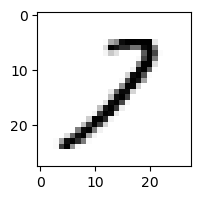

1.2823946103519774% - 0
54.11856455886513% - 1
75.64527705644531% - 2 - ОШИБКА
4.601520329242505% - 3
7.167601503526637% - 4
0.5624769132790992% - 5
0.9429904852072624% - 6
2.0113746993220016% - 7
64.80997643818785% - 8
0.2575572663699921% - 9

 4


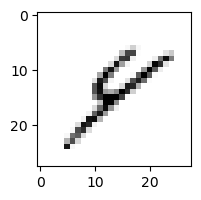

2.474658310191982% - 0
8.280770787736866% - 1
5.634842778272859% - 2
4.785176137460753% - 3
8.510377916576655% - 4
11.141139883134771% - 5
21.358308467112565% - 6
0.9819413810736392% - 7
98.62561162216697% - 8 - ОШИБКА
63.32269568147555% - 9

 3


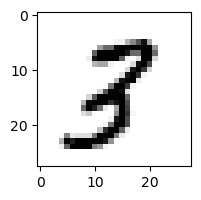

0.08713726292711742% - 0
0.8759007675658894% - 1
2.209627264395993% - 2
8.615841090332994% - 3
0.7374185022939463% - 4
0.1661768531083898% - 5
0.010869648656243451% - 6
0.3187797516790596% - 7
22.189137263648494% - 8 - ОШИБКА
2.1718187999791847% - 9

 1


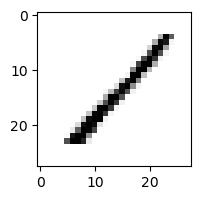

1.410904275920536% - 0
73.09601911017948% - 1
42.05431366992174% - 2
5.353603706796772% - 3
11.546979231817385% - 4
5.173838830795885% - 5
1.5930249516626405% - 6
2.822160523835043% - 7
91.98204796229959% - 8 - ОШИБКА
1.4458178040720588% - 9

 5


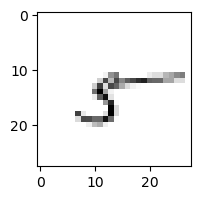

9.219574942432919% - 0
52.58521523953515% - 1
30.29285942887797% - 2
14.504326425670483% - 3
46.223098319280844% - 4
15.909476033670252% - 5
79.97047291091356% - 6
1.4999125996405747% - 7
92.84023267417764% - 8 - ОШИБКА
63.64746816740462% - 9

 5


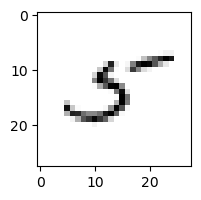

5.186812052627059% - 0
18.851167249065437% - 1
5.721378495876851% - 2
0.6772949904467575% - 3
42.142383614178875% - 4
40.68191412915343% - 5
5.425030924215523% - 6
10.323523115698764% - 7
90.68602942213066% - 8 - ОШИБКА
6.768717315090439% - 9

 9


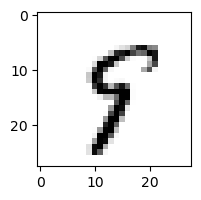

0.23126990869715974% - 0
1.1703858430471274% - 1
0.12553140049000128% - 2
0.19805334565156735% - 3
8.49922361331127% - 4
39.43935304110238% - 5 - ОШИБКА
0.7410910431938602% - 6
3.506391534360613% - 7
39.4229173954707% - 8
30.253484240561075% - 9

 2


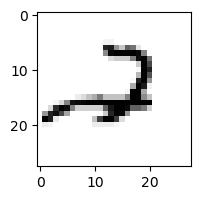

1.7440838500722662% - 0
0.3226253048925175% - 1
75.54907613776577% - 2
0.7225332866058689% - 3
52.95991070439786% - 4
0.013883629424395841% - 5
0.752221158627336% - 6
11.045544156710756% - 7
0.3021067487886471% - 8
84.51180938227505% - 9 - ОШИБКА

 4


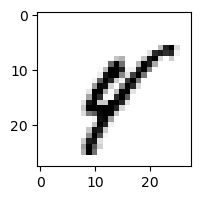

0.19373453815784103% - 0
8.069905761387053% - 1
0.19065397976519377% - 2
0.23545343698234086% - 3
33.165403646780064% - 4
2.159076787581408% - 5
4.668149228106035% - 6
2.021355447414092% - 7
41.64642712226792% - 8 - ОШИБКА
1.1968339873032363% - 9

 3


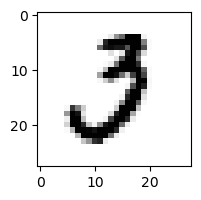

5.931211837190678% - 0
0.0663843775403636% - 1
26.9994802697063% - 2 - ОШИБКА
14.199323244447495% - 3
0.018701294132052144% - 4
0.711111975566203% - 5
0.01686706079954488% - 6
6.642079387811959% - 7
0.0033763692838637924% - 8
0.0007794733899283625% - 9

 9


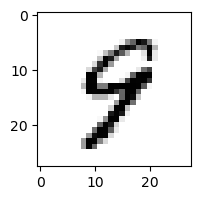

0.11604350903276497% - 0
0.14597204078901163% - 1
0.125680632015915% - 2
0.11511868273146511% - 3
42.867731447331686% - 4 - ОШИБКА
3.552677456261355% - 5
1.1985100126113362% - 6
0.7962477023334423% - 7
9.152782708975046% - 8
31.528233892267686% - 9

 2


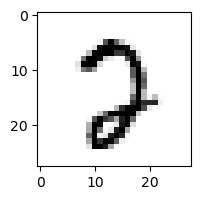

3.976659584341998% - 0
0.004119357724898509% - 1
22.006166703299616% - 2
3.655287564118994% - 3
0.05092992740755446% - 4
2.9439892875528404% - 5
0.1777264507263131% - 6
69.61310079279808% - 7 - ОШИБКА
2.0193095922682724% - 8
0.1496567405783222% - 9

 5


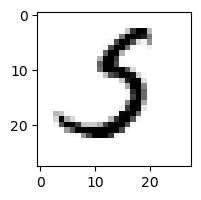

0.5561109269928146% - 0
0.10850916244392929% - 1
13.503941976003858% - 2
22.643615519042353% - 3 - ОШИБКА
0.02262337977893234% - 4
6.137109075477418% - 5
4.510865227947567% - 6
16.593413573393235% - 7
0.009597480393237176% - 8
0.03161348881021711% - 9

 2


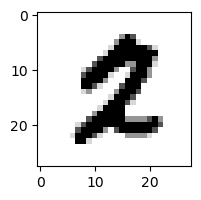

0.020189019725836158% - 0
0.009501379569914318% - 1
0.15719243807713448% - 2
0.0001982220923005975% - 3
0.0018071913573094712% - 4
0.9641862587293595% - 5 - ОШИБКА
0.009930530118793473% - 6
0.20442293322780522% - 7
0.013281410366634968% - 8
0.012777638103403391% - 9

 5


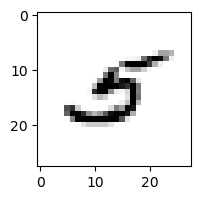

0.7666462691326854% - 0
2.010675441945127% - 1
6.309128801588962% - 2
3.2927325834778127% - 3
35.94634736274418% - 4 - ОШИБКА
19.682559001792015% - 5
2.078802815768391% - 6
1.07017929102081% - 7
8.078693143769625% - 8
1.2535276149013075% - 9

 5


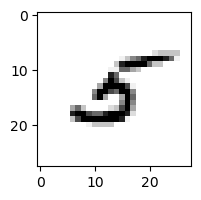

0.49953224291901116% - 0
8.542914112364304% - 1
15.098831504741423% - 2 - ОШИБКА
2.1172521282642562% - 3
12.80794494183621% - 4
8.751574058446412% - 5
1.613169090154175% - 6
0.7506080508700023% - 7
14.491511384057437% - 8
1.1144793509229007% - 9

 8


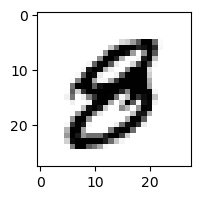

0.17648412997538226% - 0
0.0006764014022576021% - 1
0.0004957887983220607% - 2
0.3614851660047298% - 3
1.8630712896237123% - 4 - ОШИБКА
0.5754539648225417% - 5
0.008021078411525415% - 6
0.001719706749159256% - 7
0.27946309614025305% - 8
1.6190646148035857% - 9

 9


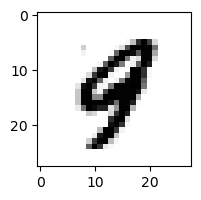

0.018580258082826994% - 0
0.04404667959902049% - 1
0.004004217198638795% - 2
0.005941803657772189% - 3
65.03198591157468% - 4 - ОШИБКА
0.03151886792823465% - 5
0.09249372265098312% - 6
0.18130922883820833% - 7
0.507239474317975% - 8
14.24053935379096% - 9

 9


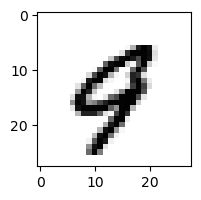

0.3959072813227916% - 0
0.015616373024918206% - 1
0.01582992668269527% - 2
0.0014491681978567067% - 3
71.83672012803041% - 4 - ОШИБКА
0.01567383269967729% - 5
0.3492314233150177% - 6
10.952802744972704% - 7
0.06161652319781611% - 8
5.622276160240257% - 9

 8


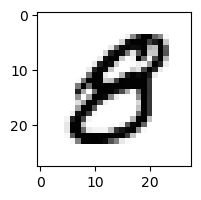

4.903071864007594% - 0
0.0012246985736700678% - 1
0.0013890660935118027% - 2
0.2846042949890411% - 3
2.368758536357671% - 4
14.724897687121125% - 5 - ОШИБКА
0.01011914046737003% - 6
0.0005467023838815965% - 7
2.078840590024516% - 8
0.21999640316320143% - 9

 2


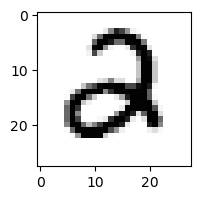

2.195781328512505% - 0
0.0006654963290994402% - 1
27.020715155445053% - 2
28.28132878481439% - 3 - ОШИБКА
1.668646091913488% - 4
0.2920645590056782% - 5
0.5664043172189186% - 6
0.0012544620887034574% - 7
5.629669005309964e-05% - 8
0.0007846419214411185% - 9

 2


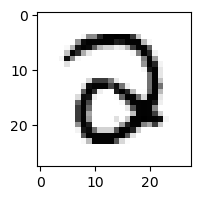

7.873957232774158% - 0
0.00037401571394492163% - 1
3.092998856791481% - 2
61.83699147835693% - 3 - ОШИБКА
3.1034551684404006% - 4
0.3175191703500625% - 5
0.540680388687154% - 6
0.0004469470282642196% - 7
0.013278246577019386% - 8
1.714325511218907e-05% - 9

 9


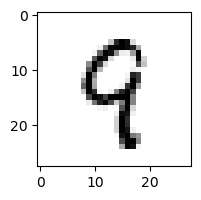

0.057069023510099876% - 0
0.17701186360029825% - 1
2.858834663551766% - 2
0.27099919448214593% - 3
56.12626207467092% - 4 - ОШИБКА
3.865994827970378% - 5
1.2147138666312218% - 6
0.5692896570808128% - 7
16.032964986192162% - 8
23.29356547411574% - 9

 9


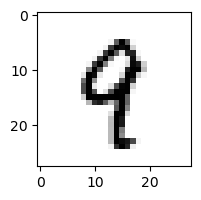

0.016893715952649734% - 0
1.6733373291723224% - 1
0.211537197244823% - 2
0.10324616671468227% - 3
29.77136780402063% - 4 - ОШИБКА
0.8607095718267092% - 5
0.146850106538772% - 6
1.2257669050021502% - 7
7.437974371283847% - 8
23.87444231695643% - 9

 5


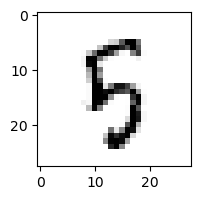

0.7919028859720727% - 0
0.02143067154585319% - 1
1.1190696778350753% - 2
3.388510348317438% - 3
47.219930027955655% - 4
48.668325998267356% - 5
4.4054821166393445% - 6
0.054151587145342114% - 7
79.65746184130904% - 8 - ОШИБКА
6.008900921787086% - 9

 2


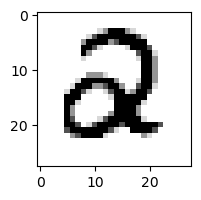

0.05048454507972837% - 0
0.0012157623708614169% - 1
1.6777606484076402% - 2
0.2162839880492005% - 3
1.6939052695785877% - 4 - ОШИБКА
0.31356502541043785% - 5
0.08743579674906828% - 6
0.0008802981777859556% - 7
0.0002255712123078265% - 8
9.758594091761239e-05% - 9

 8


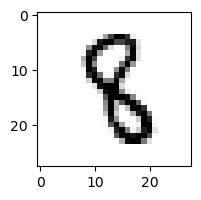

0.0014505971494128468% - 0
1.5442157202908005% - 1
0.6673909919464149% - 2
1.8959101184434386% - 3
2.7238812752737815% - 4
13.550919215187434% - 5 - ОШИБКА
0.24788791153835185% - 6
0.01809668977746096% - 7
0.6919132215639578% - 8
0.01407951037615328% - 9

 8


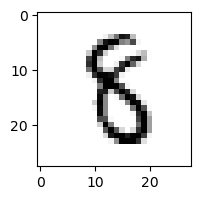

0.054121810919998736% - 0
0.1957526643782324% - 1
0.26343575325122515% - 2
6.188404877960508% - 3
1.0285719447321828% - 4
39.101824770173785% - 5 - ОШИБКА
2.321617984967099% - 6
0.05491580642852962% - 7
15.477330179076908% - 8
0.03518224708399135% - 9

 2


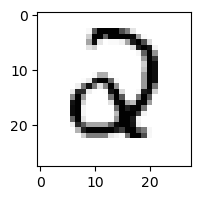

1.453047087547262% - 0
0.023543684796433446% - 1
2.0007944844037313% - 2
0.6367515416703462% - 3
15.07503339442365% - 4 - ОШИБКА
1.2737661921639645% - 5
6.479259334698829% - 6
0.012399715495181571% - 7
0.01575834384343825% - 8
0.0007725500644961776% - 9

 8


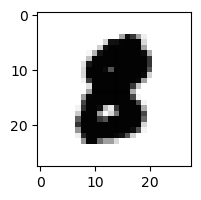

0.005326079185011896% - 0
0.00026632343099624396% - 1
0.004366937789404954% - 2
0.0008454435428570214% - 3
0.0004231556402868761% - 4
0.14100662836769495% - 5 - ОШИБКА
0.0015172598838772873% - 6
0.00027356142571194797% - 7
0.020405577150274544% - 8
0.00030460828386934025% - 9

 9


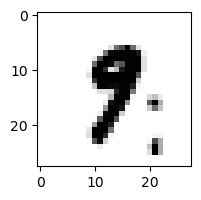

0.009584356370372199% - 0
6.347297384324463% - 1
0.005468483652061778% - 2
0.18418664689169242% - 3
0.07127772041933848% - 4
1.4392571758295563% - 5
0.028154257068881014% - 6
7.225555980305544% - 7 - ОШИБКА
0.3165571346268907% - 8
6.771249582474749% - 9

 9


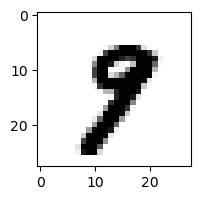

0.007867652800105328% - 0
0.17703141825243535% - 1
0.004614258541883935% - 2
0.18928056316135305% - 3
0.06564122395815478% - 4
0.2947321923015065% - 5
0.0009787240215062094% - 6
19.837482333714537% - 7 - ОШИБКА
1.7246856125270933% - 8
8.458571349914678% - 9

 8


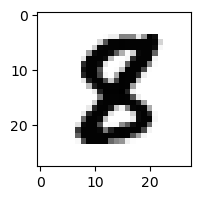

0.0021864604619384544% - 0
0.004166627689929755% - 1
0.022854992111985037% - 2
0.018106336505973323% - 3
0.021399419915045972% - 4
8.174369308912778% - 5 - ОШИБКА
0.0011020811683277304% - 6
0.00025112419576185977% - 7
3.6419945175426607% - 8
4.146479158221395e-05% - 9

 8


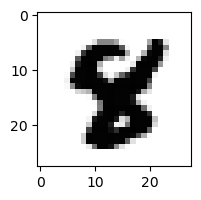

9.093065041615383e-06% - 0
3.38074671039947e-05% - 1
2.747585105623709e-05% - 2
0.00033754044863904133% - 3
0.2923546538733461% - 4
3.2051965426366555% - 5 - ОШИБКА
0.00025876289567371375% - 6
0.0025180341713732096% - 7
1.275397356193529% - 8
0.0010429398928087348% - 9

 9


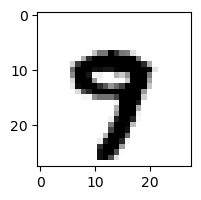

0.0017620571560118333% - 0
0.0005731653912860273% - 1
5.5542817331467905e-05% - 2
0.004731252331283055% - 3
0.7140694038105438% - 4
0.2736847620681991% - 5
0.006377949112762247% - 6
65.43447176455932% - 7 - ОШИБКА
0.020240687600560737% - 8
11.55097563320917% - 9

 8


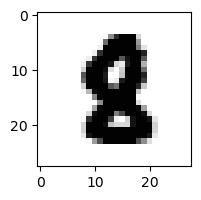

0.00017323156357425953% - 0
0.00021474920236050113% - 1
0.012663195708660256% - 2
0.00025590516098249986% - 3
0.007900244996719673% - 4
0.5707801385914517% - 5 - ОШИБКА
0.0029829859251586195% - 6
0.0004869498210688806% - 7
0.2943593255838189% - 8
0.003679285901577737% - 9

 5


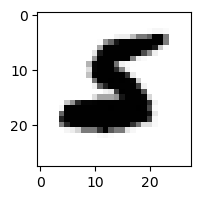

0.0009455529858262549% - 0
0.003700355719675201% - 1
0.669081783154363% - 2
0.00012432905331834798% - 3
0.005981615307750043% - 4
0.1631590007108499% - 5
1.7169197103971627% - 6 - ОШИБКА
0.0001896824921498996% - 7
0.0010719564664072702% - 8
0.0006154934815117928% - 9

 3


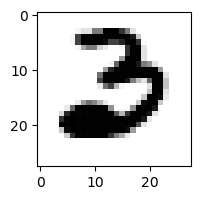

8.38317284272068% - 0
0.0027195845661316504% - 1
8.834345198908075% - 2 - ОШИБКА
2.293423116241977% - 3
7.798469263886684e-06% - 4
0.00012112327898404504% - 5
0.8603284810297993% - 6
0.004994876780223854% - 7
0.0005652467275793835% - 8
4.085718338668864e-07% - 9

 8


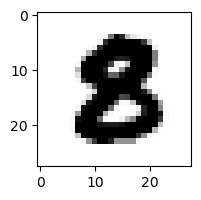

0.012276218071739158% - 0
1.1233569833011593e-05% - 1
0.0023696908605584% - 2
0.009515022313460223% - 3
0.00010308860854805247% - 4
0.834769883061062% - 5 - ОШИБКА
0.0003214784815983607% - 6
2.8554540643650245e-05% - 7
0.1876005765504495% - 8
6.33003714967693e-05% - 9

 3


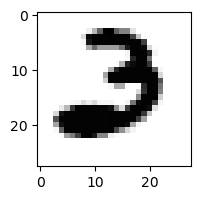

3.9587652480630133% - 0
0.007813206488176556% - 1
65.80525496417879% - 2 - ОШИБКА
1.5282879036126935% - 3
0.00014077254750939476% - 4
0.00010684198772393284% - 5
0.08783970126449163% - 6
0.040172536222699035% - 7
0.00026114572017576707% - 8
1.8605879109839323e-06% - 9

 8


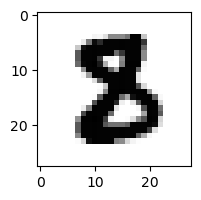

0.0007088005281038419% - 0
0.0012434911295354431% - 1
0.08090304069813166% - 2
0.10908603228039881% - 3
2.9388942698750408e-05% - 4
1.0655176461076274% - 5 - ОШИБКА
0.0036108741718121986% - 6
0.0007181269293542863% - 7
0.0378266966227097% - 8
8.621693112207212e-07% - 9

 5


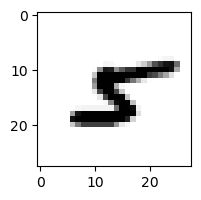

0.0783165067477087% - 0
3.8021898282780997% - 1
0.612291456706371% - 2
0.10130784290006146% - 3
2.1709533676082127% - 4
1.3125013455882544% - 5
3.8701421882419305% - 6
0.30227003719437184% - 7
75.52269022972473% - 8 - ОШИБКА
0.3836202923287867% - 9

 5


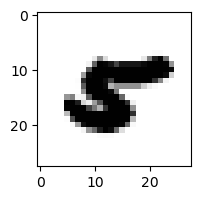

0.1073578249809658% - 0
0.015039955850150184% - 1
0.0036329405804868416% - 2
7.434574205781114e-06% - 3
2.444739040540021% - 4
0.021365211983037955% - 5
0.4093518078022628% - 6
0.02355871675853988% - 7
4.658912730346328% - 8 - ОШИБКА
0.035539486221392594% - 9

 3


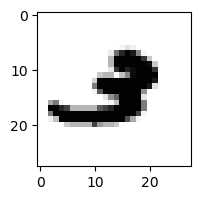

0.015223395193707316% - 0
0.15363590485523093% - 1
0.8329993590472691% - 2
0.16485148163796368% - 3
0.43950510067452725% - 4
0.0008672888564301136% - 5
0.05986522812933122% - 6
1.0888299120062945% - 7
0.16877232724915378% - 8
10.842355944596857% - 9 - ОШИБКА

 5


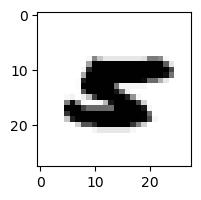

0.012775899514535158% - 0
0.0032277201702192154% - 1
0.002230243766493271% - 2
6.274595173434525e-05% - 3
0.7360345535406232% - 4 - ОШИБКА
0.010470110509700307% - 5
0.26921035888709854% - 6
0.017915530145081824% - 7
0.2979895962929972% - 8
0.022165634848355594% - 9

 9


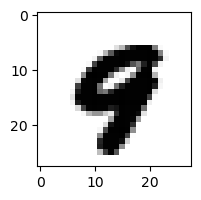

0.005810672342412628% - 0
4.608416490295627e-05% - 1
8.375005515608502e-06% - 2
1.6048335378725726e-05% - 3
23.543233523944465% - 4 - ОШИБКА
0.0022639278268868374% - 5
0.0035342788183087936% - 6
0.38993697508369624% - 7
0.0037534390508718323% - 8
1.7873780816687304% - 9

 2


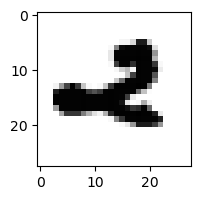

0.09871639246743914% - 0
0.02283694957703701% - 1
1.587678649008232% - 2
0.039903911359898035% - 3
22.29000079080589% - 4
2.5736508872314528e-05% - 5
0.014771155105160302% - 6
0.0014487378391287403% - 7
0.008329702277683877% - 8
45.45465978208818% - 9 - ОШИБКА

 3


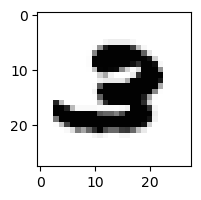

0.02413733698112493% - 0
0.00023632488728542427% - 1
3.156204630456517% - 2 - ОШИБКА
0.1795268268129766% - 3
5.0130914180198836e-05% - 4
0.006392370430957901% - 5
0.03948238183864791% - 6
0.03561142378562293% - 7
0.011067265418798319% - 8
0.09295426079415971% - 9

 5


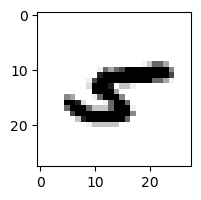

0.3428627849608737% - 0
2.978672745840766% - 1
0.34629169005943644% - 2
0.014794863393567876% - 3
42.12359160662235% - 4
0.0031731440356433894% - 5
7.604361222138511% - 6
0.14097123838717598% - 7
64.67133949549164% - 8 - ОШИБКА
4.157892745119041% - 9

 5


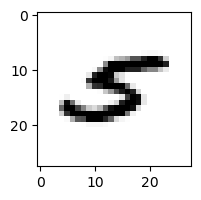

0.5129638325378857% - 0
0.7184592009975022% - 1
0.11017128647901238% - 2
0.0221625166219558% - 3
23.386062841295615% - 4 - ОШИБКА
0.7224354833900039% - 5
0.07175969420976262% - 6
7.3299250508613385% - 7
2.3014031167730793% - 8
0.6621487326160537% - 9

 8


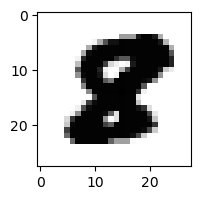

0.0003839832413033445% - 0
2.15816655682267e-06% - 1
0.0025538571866000315% - 2
3.4151882832408285e-05% - 3
0.0005249671512542638% - 4
1.7074563564241123% - 5 - ОШИБКА
9.279227233821207e-06% - 6
5.843060541982758e-06% - 7
0.6130329426485155% - 8
2.0816920330743747e-06% - 9

 2


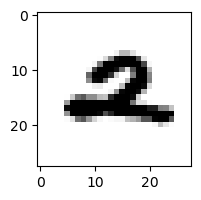

0.047530547587895225% - 0
0.011014090261225067% - 1
2.690824743845479% - 2
0.0006238783183650741% - 3
13.869411514613446% - 4 - ОШИБКА
0.00045587701368825153% - 5
0.9774710242859684% - 6
1.8011525421606085% - 7
0.08572731914326738% - 8
8.260409598058265% - 9

 2


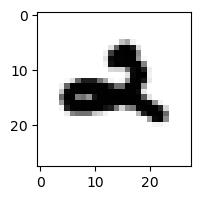

0.3033040410169248% - 0
0.0062934587501151% - 1
0.05529641675761143% - 2
0.1349609510827205% - 3
83.39674322457951% - 4
0.00037459252309992956% - 5
0.35315037629030815% - 6
0.007105519243787319% - 7
0.0008905372773680566% - 8
93.70715414454519% - 9 - ОШИБКА

 5


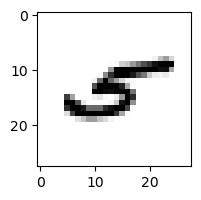

0.44027919227442575% - 0
7.029080250245929% - 1
0.5673924253525732% - 2
0.46716027899971835% - 3
73.58756265006787% - 4 - ОШИБКА
0.05013308746106915% - 5
0.6277260229398661% - 6
0.7454643843784198% - 7
40.162577487458634% - 8
6.059555735236676% - 9

 3


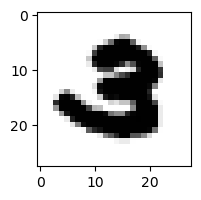

0.06468131921365174% - 0
3.0439746674783832e-05% - 1
0.3019192045195411% - 2 - ОШИБКА
0.1698785821197623% - 3
7.307907599561896e-05% - 4
0.0006961918222507886% - 5
0.007267101376780493% - 6
0.000508366622796697% - 7
0.0011213463587952457% - 8
0.0007368878081587597% - 9

 2


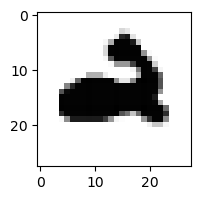

0.4357748564108777% - 0
0.00018587373341990323% - 1
0.039377772059305934% - 2
0.000620944130348698% - 3
33.99701518870212% - 4 - ОШИБКА
8.750001135000648e-06% - 5
0.42404140278022506% - 6
3.9391568807479975e-05% - 7
0.0003321575661781832% - 8
22.334789542303252% - 9

 5


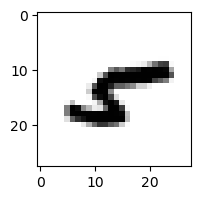

0.48801599475234636% - 0
5.296916297170122% - 1
1.5626217585360043% - 2
0.04025769778860232% - 3
8.216752681427932% - 4
0.013691928110834523% - 5
13.50491125321712% - 6
0.08535517525675149% - 7
75.6760194815401% - 8 - ОШИБКА
3.4473489432555473% - 9

 2


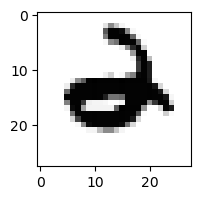

0.26602502546848306% - 0
0.0009631834045554309% - 1
0.015406898003598849% - 2
0.007757513491102346% - 3
66.98699532822533% - 4 - ОШИБКА
0.00046461186353258666% - 5
56.51680969566474% - 6
0.00037526543708366164% - 7
7.161627451730853e-05% - 8
0.03526781246069288% - 9

 9


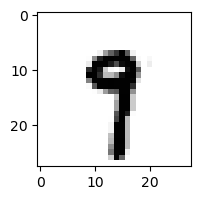

0.0034560798590867465% - 0
1.23347021771337% - 1
0.0015655116281662513% - 2
0.2782843824185278% - 3
1.6641198834241286% - 4
4.197073508654019% - 5
0.0818316141374121% - 6
31.734917425021415% - 7 - ОШИБКА
4.361757723743528% - 8
28.35904268859585% - 9

 9


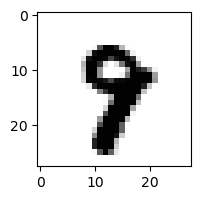

0.00025840875663807485% - 0
0.009458227647395135% - 1
0.0026379498331346837% - 2
0.011788219319053493% - 3
0.34685942677166415% - 4
0.22656430511067532% - 5
0.03169511536009211% - 6
16.741467717729467% - 7 - ОШИБКА
3.766762895937702% - 8
11.682264148486341% - 9

 8


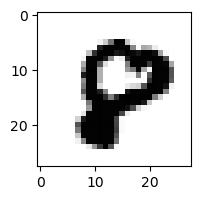

3.683310910949732% - 0 - ОШИБКА
2.2474281792526625e-05% - 1
0.019487113359788928% - 2
1.9234293163206065e-05% - 3
0.07935186600111298% - 4
0.04394239478534238% - 5
0.0032643634379458386% - 6
0.2307421622288865% - 7
2.2659455029808715% - 8
0.0044945845900345805% - 9

 9


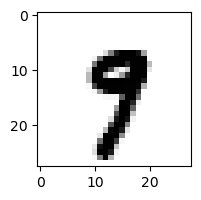

0.006572926912168409% - 0
0.02725476198471423% - 1
0.0004007314734227486% - 2
0.5866484690561335% - 3
0.516212733274288% - 4
0.7003055376074795% - 5
0.005721366759970744% - 6
40.40021008829371% - 7 - ОШИБКА
0.5446783800960018% - 8
24.417558567991833% - 9

 8


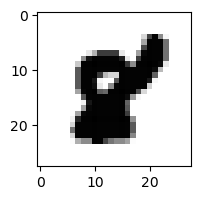

0.0020190777548228264% - 0
0.00478150700125959% - 1
9.207999916655308e-05% - 2
1.9939249067222768e-07% - 3
0.042713977842227406% - 4
0.46088715338725256% - 5 - ОШИБКА
0.00034661463260148256% - 6
0.024456441084226045% - 7
0.17936507969433813% - 8
0.0003829466399588043% - 9

 1


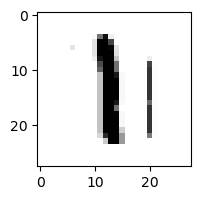

0.03748532121895075% - 0
19.816145098819952% - 1
1.320720250833769% - 2
0.9836926994594366% - 3
0.17455401452852354% - 4
14.679065525217183% - 5
5.863364997670459% - 6
0.24896634507473964% - 7
37.76632265471875% - 8 - ОШИБКА
0.7352760037062407% - 9

 9


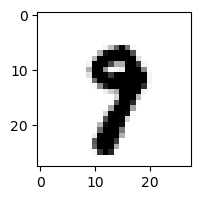

0.001484652007014246% - 0
0.07240045562262479% - 1
0.0010609665968130159% - 2
0.1472262517366048% - 3
0.08675188940300246% - 4
0.44261287110136427% - 5
0.01346955753018223% - 6
56.79339668255879% - 7 - ОШИБКА
0.809952654031242% - 8
9.541557290903606% - 9

 2


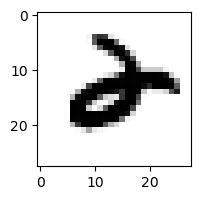

0.12206676520648324% - 0
0.03295868117802207% - 1
1.5646193173347316% - 2
0.014489898473357226% - 3
2.064285740919007% - 4
1.411688227770217e-05% - 5
2.5968134333645176% - 6
0.0016191113464878336% - 7
0.01649662786756137% - 8
7.432505113907631% - 9 - ОШИБКА

 9


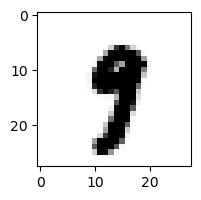

0.0018037154686203676% - 0
0.12099485996282652% - 1
0.00013027335302840737% - 2
1.0229388462821005% - 3
0.21419644246196543% - 4
0.6748376523472054% - 5
0.0024550270548817682% - 6
17.963669362778987% - 7 - ОШИБКА
0.15856418853223891% - 8
4.263553932755233% - 9

 5


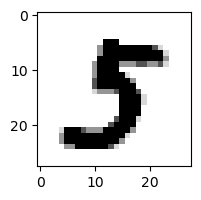

0.05500739261309311% - 0
0.00894641342152509% - 1
0.0002705313565049561% - 2
39.821613158596% - 3 - ОШИБКА
0.007887875611638616% - 4
38.10719140918087% - 5
5.058633999814482e-05% - 6
0.4560273281270755% - 7
0.10626631575881312% - 8
0.004744616117480677% - 9

 4


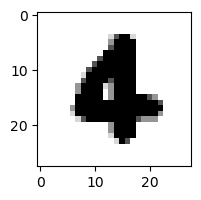

0.0004157722735164505% - 0
0.0020545849559648935% - 1
0.0008998848988696146% - 2
3.3118761042869624e-05% - 3
0.6420927611237665% - 4
0.0015239513282512278% - 5
1.6518739314494293% - 6 - ОШИБКА
0.0006663327221904725% - 7
1.746576311793705e-05% - 8
0.014896132726225898% - 9

 2


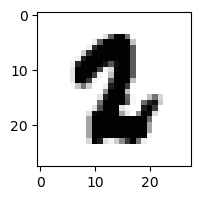

4.773373590507507e-05% - 0
0.09375265066628483% - 1
0.019167229906873674% - 2
0.0014260856247006312% - 3
2.1264956881134745e-05% - 4
0.38786752058038854% - 5 - ОШИБКА
0.046780119028422336% - 6
0.008246027044267551% - 7
0.03324074217123699% - 8
0.0001968122684976945% - 9

 2


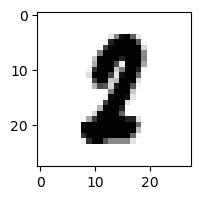

0.004524483716111526% - 0
0.7532369506876542% - 1
0.03466667513045221% - 2
0.004032857496741022% - 3
0.0005408021394875625% - 4
1.1857853982008897% - 5 - ОШИБКА
0.008079957763280233% - 6
0.1265616320864576% - 7
0.1691688141094336% - 8
0.00047718714011891653% - 9

 4


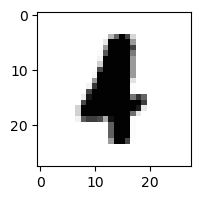

0.0005948345799727761% - 0
0.6220550195896896% - 1
0.04961418871770505% - 2
0.0016545868484409464% - 3
0.5228636897516635% - 4
0.011747756034731391% - 5
0.7664063710417806% - 6 - ОШИБКА
0.0018818257077482196% - 7
0.06656741086114525% - 8
0.29398477362164654% - 9

 8


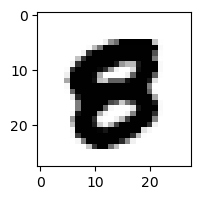

0.1415841354108336% - 0 - ОШИБКА
2.813668037208192e-07% - 1
2.3393376539286877e-05% - 2
0.0003053812491917993% - 3
0.004754138476221112% - 4
0.14142887848332045% - 5
0.00030139175430665834% - 6
3.5201813485636855e-05% - 7
0.030265871002534812% - 8
0.0011843681952546392% - 9

 3


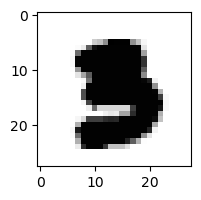

0.00015132718651439365% - 0
1.944884084158332e-06% - 1
1.772024336198565e-05% - 2
0.08190206287394329% - 3
0.00010900283334056228% - 4
0.29890619529250023% - 5 - ОШИБКА
0.00020280034086001827% - 6
0.0009520069340304889% - 7
4.036390619600318e-05% - 8
2.369640057311999e-06% - 9

 9


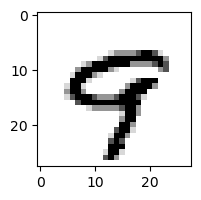

0.22658689391614178% - 0
0.0033492458503730158% - 1
0.0018280576665231202% - 2
0.00014623603489063595% - 3
25.159911618978892% - 4
0.12865146632481214% - 5
0.035622633077531045% - 6
27.31903908439764% - 7 - ОШИБКА
0.2566143956070201% - 8
26.107640922027226% - 9

 2


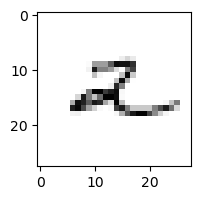

1.9358669289384713% - 0
17.200347421343736% - 1
19.12523067220163% - 2
3.4494955450293747% - 3
72.4435175779708% - 4 - ОШИБКА
0.981783112927913% - 5
12.148456207071947% - 6
0.9691173931358629% - 7
2.6530703886342923% - 8
33.759911169916926% - 9

 5


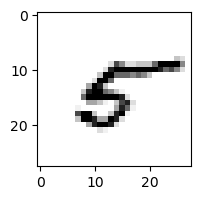

8.783401113749214% - 0
2.004556458182012% - 1
1.9930346456522605% - 2
1.4140496861521539% - 3
23.494644757455312% - 4 - ОШИБКА
15.302604473513378% - 5
10.188955629855434% - 6
1.6142900073224837% - 7
15.202840107859872% - 8
1.5469667432927208% - 9

 9


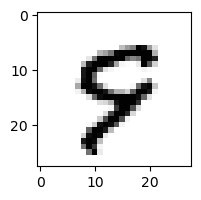

0.3387948516109491% - 0
0.007202534955226258% - 1
0.05854985316970328% - 2
0.00627133361556878% - 3
4.583719887459952% - 4
43.870928843661105% - 5 - ОШИБКА
0.09469004550477601% - 6
7.664149571004337% - 7
0.059073726812160936% - 8
22.316875128368522% - 9

 9


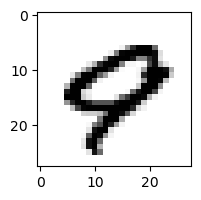

22.93911343954379% - 0 - ОШИБКА
0.0028010917254616065% - 1
0.000732085690279945% - 2
2.797913941525067e-06% - 3
9.700342045618646% - 4
0.002216282844214716% - 5
0.12827948111457604% - 6
14.90712143454945% - 7
0.07325669617406975% - 8
19.54470266739338% - 9

 2


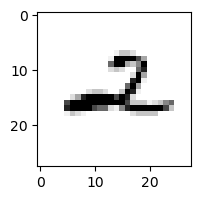

3.1636259808562492% - 0
0.7526677892084879% - 1
50.32351719030675% - 2
3.2559550738834777% - 3
83.22578953059818% - 4 - ОШИБКА
0.007487937573886164% - 5
7.494498039273603% - 6
2.6115802172263445% - 7
0.45728385497700663% - 8
49.25641157070899% - 9

 8


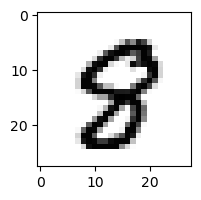

0.24736594031990644% - 0
0.0033421997931025005% - 1
0.006273232352165182% - 2
0.00292099773631306% - 3
0.35104913164900975% - 4
3.8156210395767403% - 5 - ОШИБКА
0.0030867064447811666% - 6
0.2544900681067898% - 7
2.9364169877706616% - 8
0.3203800662023537% - 9

 9


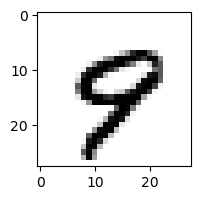

0.4395486697781631% - 0
0.00776633235958543% - 1
0.002658622837415476% - 2
0.0005495604108752671% - 3
14.543692924049376% - 4
0.5411389916092847% - 5
0.15996547432706015% - 6
31.906291219762885% - 7 - ОШИБКА
0.0450776579410042% - 8
11.097904387283887% - 9

 2


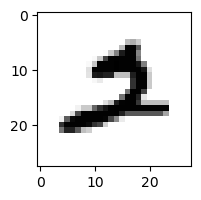

0.7692399789633723% - 0
0.02120434883928113% - 1
27.896098317635065% - 2
0.012072607172002104% - 3
0.008928387503082946% - 4
0.018311189618818294% - 5
0.12452741590875929% - 6
40.4100797875312% - 7 - ОШИБКА
0.047405242809714074% - 8
0.8372780803445741% - 9

 3


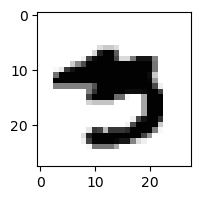

0.01321883502145577% - 0
0.000437464003964367% - 1
1.1681094219106006e-07% - 2
0.2731314106367088% - 3
0.04517236630195423% - 4
2.9555736218622486% - 5 - ОШИБКА
0.0004894645845440631% - 6
0.16700710351850356% - 7
0.14770519762050985% - 8
0.1290039560862368% - 9

 2


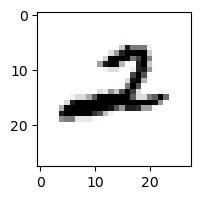

1.75843015740255% - 0
0.14427395031907786% - 1
47.35022618585993% - 2
0.27336435564068295% - 3
46.42745465209014% - 4
0.0004934226454942489% - 5
0.6685950774067084% - 6
1.525067628961031% - 7
0.512899190352656% - 8
56.46675335848984% - 9 - ОШИБКА

 2


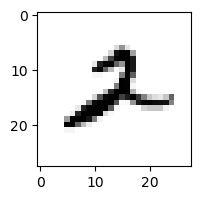

0.30678909260662124% - 0
5.105872079389622% - 1
20.753005772876072% - 2
0.5418960228041914% - 3
1.3816748800448964% - 4
0.039153123793599344% - 5
3.4788748777922684% - 6
1.4251106589266211% - 7
13.766538980638584% - 8
68.5476111190601% - 9 - ОШИБКА

 3


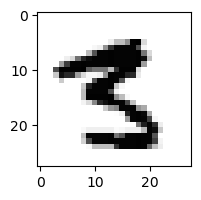

0.016467325067850765% - 0
0.0033532558279201876% - 1
0.002298229810664926% - 2
0.20099457623030662% - 3
0.01822027347065527% - 4
39.419170495413695% - 5 - ОШИБКА
1.8711472515792892e-05% - 6
0.0286451184540185% - 7
1.571215643517375% - 8
0.1329101681697809% - 9

 9


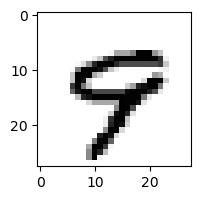

0.1845667547060151% - 0
0.0026259661827457924% - 1
0.0007528251358366605% - 2
0.0007637470482013952% - 3
14.215362392499589% - 4
0.576228067598053% - 5
0.06673736236067386% - 6
20.007868350942264% - 7 - ОШИБКА
0.04438268794246873% - 8
15.90318331798643% - 9

 3


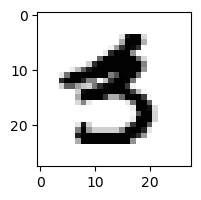

0.12065538890047679% - 0
0.006148181200432612% - 1
1.059302311362929e-05% - 2
0.6504884914297557% - 3
0.0328826076543995% - 4
16.157718462503883% - 5 - ОШИБКА
0.001102574960088198% - 6
0.006152583168266601% - 7
0.0021219715766735256% - 8
0.11627227412322827% - 9

 8


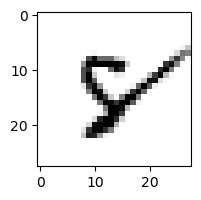

0.18204247752468086% - 0
0.31459006983102966% - 1
1.1099696585315864% - 2
0.0006941850130345828% - 3
8.380520449919167% - 4
14.735113498595817% - 5
22.19802610433508% - 6 - ОШИБКА
20.445184109013816% - 7
2.2706048434698447% - 8
3.3189653422665075% - 9

 2


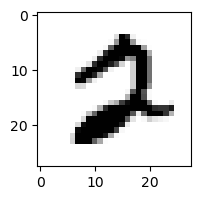

3.8688147902229733% - 0
0.0008764228538377387% - 1
7.330625388065568% - 2
0.0013695543626485987% - 3
0.0004094436843402615% - 4
0.6602656730012169% - 5
0.03940910508321322% - 6
7.505702617641247% - 7 - ОШИБКА
0.018585080408568704% - 8
0.08343559117857113% - 9

 3


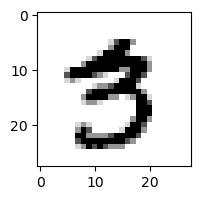

0.13910556809636532% - 0
0.002132357376893324% - 1
0.0009474794654816877% - 2
2.9989093389936228% - 3
0.012844739060937409% - 4
3.395279405646286% - 5 - ОШИБКА
0.0002623415494352125% - 6
0.6074665886839716% - 7
0.20360409112356606% - 8
0.4274624318331805% - 9

 8


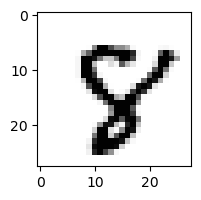

0.02121017840940064% - 0
0.0001928427007181046% - 1
0.013733010185485122% - 2
0.0048775196884435325% - 3
1.3505504524112688% - 4
29.700495886053808% - 5 - ОШИБКА
0.03332848065065201% - 6
7.552786073767496% - 7
15.125708792832784% - 8
0.7061782361823237% - 9

 3


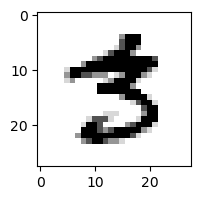

0.2140631241747928% - 0
0.007697051126300841% - 1
0.002027642930883542% - 2
2.573244208624942% - 3
0.00022759500379114302% - 4
6.738972027768768% - 5 - ОШИБКА
0.0006923071883562904% - 6
0.4699172660922053% - 7
0.04435700096924389% - 8
0.006691702931012696% - 9

 3


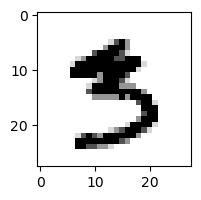

0.028824503764323956% - 0
0.0070307043580070975% - 1
3.811165728987902e-05% - 2
12.726926961658341% - 3
0.007071240444749627% - 4
66.24330707789538% - 5 - ОШИБКА
0.001401386345396829% - 6
0.43365570104113405% - 7
0.119053003539178% - 8
0.05964119366499669% - 9

 9


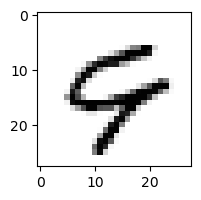

2.6673251477398816% - 0
0.013966201214848584% - 1
0.014874955089636918% - 2
0.00038703967587447443% - 3
36.28786602673961% - 4 - ОШИБКА
0.019415742299942425% - 5
3.1106640669483165% - 6
14.698782134335293% - 7
0.07231437368506842% - 8
21.86635771334479% - 9

 9


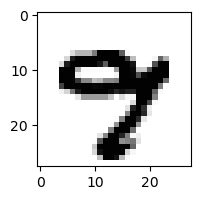

0.009370158000171856% - 0
0.0002064140768075574% - 1
1.3048195495721996e-06% - 2
0.24222863695353677% - 3
0.13499714596230714% - 4
0.007270431947802548% - 5
0.013630422885594986% - 6
31.65230709157011% - 7 - ОШИБКА
0.04945158371639112% - 8
2.5202838318253975% - 9

 8


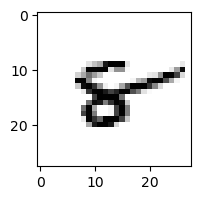

0.5189910763133384% - 0
1.4282611264551945% - 1
0.5738937355216838% - 2
0.00036688922757843496% - 3
49.623472208281015% - 4
0.42623597167496113% - 5
89.325037308735% - 6 - ОШИБКА
0.4213492754106955% - 7
21.591995558579082% - 8
50.28686561700313% - 9

 2


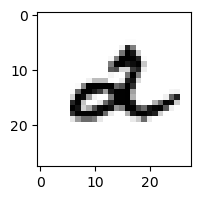

0.25190807298775947% - 0
0.4402278973057528% - 1
1.7617157030862418% - 2
0.6196949236943027% - 3
42.247576784542574% - 4 - ОШИБКА
0.006008798632041979% - 5
5.427020467411791% - 6
0.06895567673559934% - 7
0.05617744801867956% - 8
16.705094429848486% - 9

 9


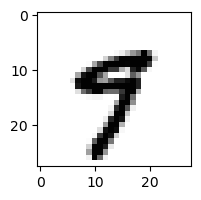

0.024233664142947954% - 0
0.07090769598811446% - 1
4.541367698261859e-05% - 2
0.02955124809292373% - 3
13.670601127221696% - 4
8.577796152175694% - 5
0.02152577732059005% - 6
19.48999058428678% - 7 - ОШИБКА
0.08900100623037208% - 8
9.894877081579052% - 9

 3


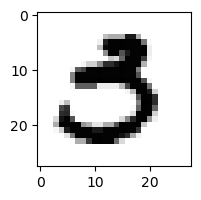

3.7795637791107186% - 0
0.0023406185166915247% - 1
0.00021670222850605226% - 2
10.151234578224713% - 3
0.0004514266755752531% - 4
24.860179380443366% - 5 - ОШИБКА
0.000958406684389578% - 6
0.21448202402441768% - 7
0.0005479995667807606% - 8
0.0003148066664961859% - 9

 9


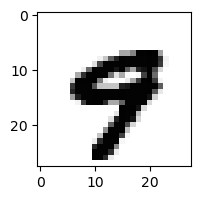

0.05780492848971156% - 0
0.00011563718897389764% - 1
1.3502693679264505e-06% - 2
0.0019744831898065108% - 3
32.758550566426095% - 4 - ОШИБКА
0.038334180347649585% - 5
0.005899200435892716% - 6
5.389816502801873% - 7
0.0015516886757474257% - 8
2.461846616831277% - 9

 8


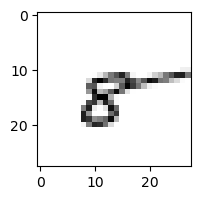

2.8245046329542185% - 0
28.85220357810724% - 1
4.93686866398751% - 2
1.013102268341767% - 3
67.35961429545944% - 4
2.6764058752268753% - 5
84.91431021359803% - 6 - ОШИБКА
0.2761905512625987% - 7
84.66086100299053% - 8
55.79832401647708% - 9

 8


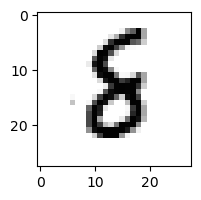

0.014117644768691439% - 0
0.06672027393947685% - 1
1.001004980569049% - 2
0.6234833469110642% - 3
0.14649773688222956% - 4
2.0487645175812537% - 5
69.20734985234725% - 6 - ОШИБКА
0.010470110057205271% - 7
32.86612224343387% - 8
0.05844246517818784% - 9

 9


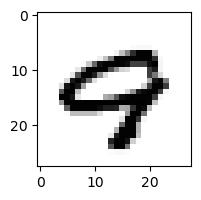

3.1510918918733375% - 0
0.0032301078489175364% - 1
0.0001922091040286804% - 2
8.421315626817409e-05% - 3
40.74253636859793% - 4 - ОШИБКА
0.001280362639852897% - 5
0.045505735930046545% - 6
8.912294281247116% - 7
0.023740277413580205% - 8
0.7511331956430753% - 9

 9


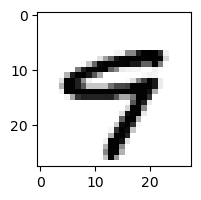

0.5756617614471943% - 0
0.0032490435603664556% - 1
2.9341099456206965e-05% - 2
0.010133428785084598% - 3
15.471600883891798% - 4 - ОШИБКА
2.45985802840157% - 5
0.03103033816730025% - 6
5.004559888942409% - 7
0.01494604972669424% - 8
13.125627725606634% - 9

 5


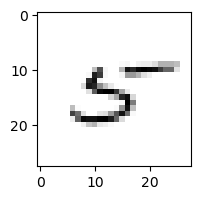

7.791175954345938% - 0
1.8752538629494608% - 1
14.001168871802863% - 2
1.7414738970641084% - 3
56.9486019156913% - 4 - ОШИБКА
19.126434166061273% - 5
14.536063803063232% - 6
8.41289034053551% - 7
56.70170817749506% - 8
21.11164246240199% - 9

 8


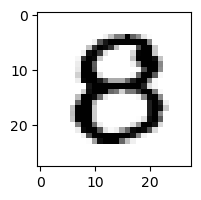

36.56282205065577% - 0 - ОШИБКА
5.5949917382249785e-05% - 1
0.10153467356153692% - 2
0.39860067674105415% - 3
2.8872708267069616% - 4
20.859885529913477% - 5
0.014655525988796212% - 6
0.00020477344141161608% - 7
5.422487437715572% - 8
0.00044872360310474805% - 9

 9


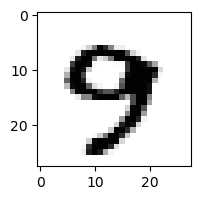

0.04655365674835295% - 0
0.00013461070326281643% - 1
0.00046579520876253625% - 2
7.007913445076913% - 3
1.4566780264864359% - 4
0.029144609077766448% - 5
0.009479412580472938% - 6
41.75598748888904% - 7 - ОШИБКА
0.06077912102966417% - 8
24.806958513294703% - 9

 8


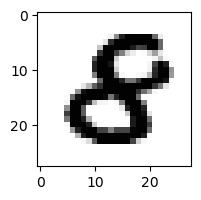

0.46974591383559156% - 0
0.00010387841393649288% - 1
0.005868342239142519% - 2
0.048269062101785394% - 3
0.35142097523000865% - 4
1.5577395663085192% - 5 - ОШИБКА
0.023947137726759302% - 6
4.113461364701762e-06% - 7
0.17712665464168734% - 8
0.00027691016697016036% - 9

 9


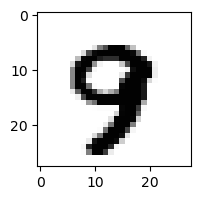

0.003011321238372621% - 0
0.00010137376984931302% - 1
0.002964034167682305% - 2
0.1863942555948541% - 3
1.1627558317706703% - 4
0.029569775351421575% - 5
0.0030918392870019026% - 6
19.596129214297978% - 7 - ОШИБКА
0.03519329774207153% - 8
18.22034985178764% - 9

 8


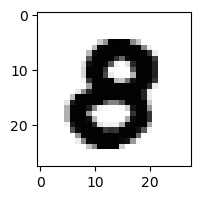

0.48914430161742267% - 0 - ОШИБКА
3.1274526411664667e-07% - 1
0.004322596154944697% - 2
0.05636787184504706% - 3
0.0281578668950664% - 4
0.2774660778192816% - 5
4.6802384163716236e-05% - 6
9.206197105757861e-05% - 7
0.38179333357793477% - 8
0.0025023194855133624% - 9

 4


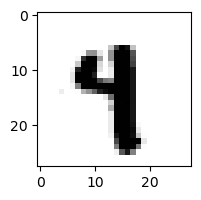

7.216479995875682e-05% - 0
0.3508905350994846% - 1
3.560773133095449e-05% - 2
0.012399801175074382% - 3
2.6831924358102035% - 4
2.306415817229788% - 5
0.03364495249895269% - 6
0.5457394518528805% - 7
0.12470967653406743% - 8
10.293944154189505% - 9 - ОШИБКА

 8


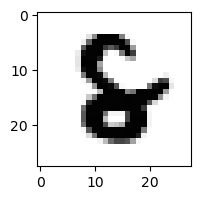

0.0023955338961271664% - 0
4.672368618434962e-05% - 1
0.2231487737877052% - 2
0.002276698175168078% - 3
0.3398718964660627% - 4
0.1907078186858745% - 5
22.920779729156315% - 6 - ОШИБКА
0.00023772807828390343% - 7
3.505210762541354% - 8
0.00011451264192433888% - 9

 9


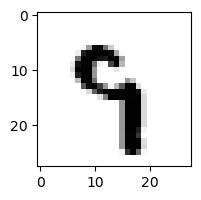

0.0009235133110673066% - 0
0.007140537223450832% - 1
0.06002582214085444% - 2
0.40800311267955736% - 3
18.69071247910276% - 4
22.474272728150847% - 5 - ОШИБКА
2.172096974656176% - 6
1.7614869303636087% - 7
2.5662880733534315% - 8
18.20410749318174% - 9

 8


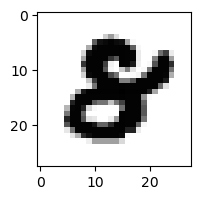

0.05932821014062821% - 0
9.22452885102232e-07% - 1
0.005973399655280248% - 2
0.010879375645103006% - 3
0.00896604263672289% - 4
0.23584648029122884% - 5 - ОШИБКА
0.0046806438168374275% - 6
0.00015469717892841267% - 7
0.055907748276432724% - 8
0.0014062894226277494% - 9

 2


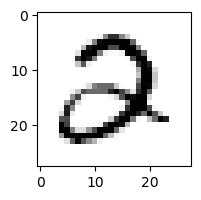

4.429279480161201% - 0
0.000796109921636623% - 1
52.51364561554717% - 2
94.4674434985236% - 3 - ОШИБКА
0.2796935925898871% - 4
0.1569465144142398% - 5
0.04395615978770227% - 6
0.2864090753489452% - 7
0.004636234600912845% - 8
0.007347160738088701% - 9

 2


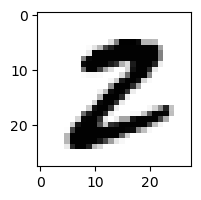

0.15062036698110579% - 0
0.010018795567129564% - 1
5.024547785100165% - 2
0.23672702970226814% - 3
5.489933330909389e-06% - 4
0.8100230068477918% - 5
0.00018512162438300556% - 6
0.010549871698087283% - 7
26.983504470364412% - 8 - ОШИБКА
0.00028330731329856217% - 9

 3


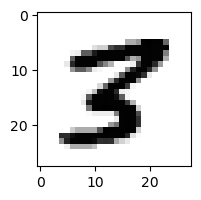

0.004197710855557027% - 0
0.021673781798819253% - 1
0.11755870451782774% - 2
0.33923859252808863% - 3
0.1093125230693863% - 4
1.7550717796552207% - 5
3.1899228134444584e-05% - 6
0.03510588935097646% - 7
12.409829644992515% - 8 - ОШИБКА
0.0017170959667362415% - 9

 7


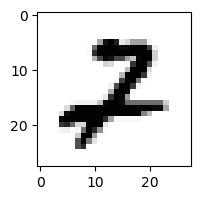

0.1907902475807387% - 0
0.21902454079592687% - 1
93.52009662872844% - 2 - ОШИБКА
0.7324070653863034% - 3
0.01602925914092236% - 4
0.003640533083109306% - 5
0.004588124348140137% - 6
0.10113318421939078% - 7
0.27595530589882755% - 8
0.07204939057922417% - 9

 2


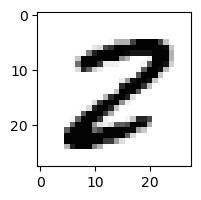

0.28670921393354226% - 0
0.007784769396434903% - 1
3.3913192907319987% - 2
0.036724827554458044% - 3
0.0008277606178358343% - 4
4.961594555360688% - 5
0.004458567816580529% - 6
0.05967864555182603% - 7
98.62273731556871% - 8 - ОШИБКА
0.0021551969225496307% - 9

 5


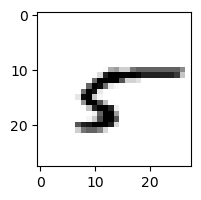

27.17605890850096% - 0
9.984114085158044% - 1
1.222186477079645% - 2
0.45222692366210565% - 3
13.750581472090866% - 4
2.886656967901876% - 5
56.2582481208487% - 6 - ОШИБКА
0.6444690497324734% - 7
35.064838320697994% - 8
8.43896956301824% - 9

 7


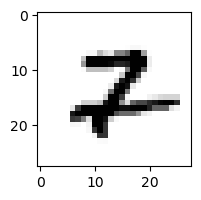

0.09024341251563239% - 0
0.5328835515518265% - 1
21.285454950604016% - 2 - ОШИБКА
0.007297851336106372% - 3
0.12377556120240667% - 4
0.00814044840053642% - 5
0.17285515211076902% - 6
12.362992712078848% - 7
0.964725873286568% - 8
0.7155764084957505% - 9

 0


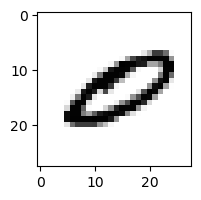

38.37031072413006% - 0
0.0985421623970625% - 1
0.06763484470988307% - 2
0.0666227136341692% - 3
40.71149783876193% - 4 - ОШИБКА
1.6775505166898736% - 5
0.3431015706254135% - 6
0.6080822918306028% - 7
0.01591389570353% - 8
0.014611806356208385% - 9

 1


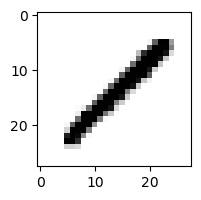

0.23019242397517015% - 0
56.40973089963309% - 1
19.83622091769545% - 2
2.978654204277002% - 3
9.801698676986287% - 4
0.7200690110302699% - 5
0.02557788298477698% - 6
0.1814264916141646% - 7
96.83212616112056% - 8 - ОШИБКА
1.0191398315873306% - 9

 7


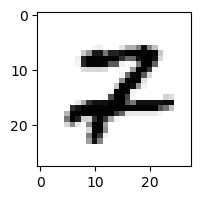

0.15779947924724064% - 0
0.021297949850348587% - 1
42.88252781211101% - 2 - ОШИБКА
0.006805918599146335% - 3
0.18582640501144537% - 4
0.007010725894679528% - 5
0.013149432952145034% - 6
5.755628326837627% - 7
4.000755227615033% - 8
0.3790080063692869% - 9

 9


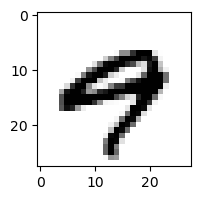

6.149536446007793% - 0
0.001189026771510676% - 1
7.466473878486104e-06% - 2
0.013010749435646698% - 3
34.01960503971584% - 4 - ОШИБКА
0.0034968170595632403% - 5
0.2902065197566715% - 6
1.1946636539006699% - 7
0.00664993760344603% - 8
21.84984652233463% - 9

 7


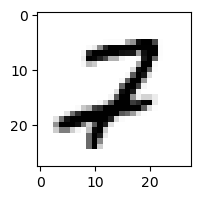

0.3699358105314328% - 0
0.03261662031305468% - 1
88.00824020966103% - 2 - ОШИБКА
0.27963234221558997% - 3
0.29124777299507637% - 4
0.11709769523411914% - 5
0.0445506683179171% - 6
2.239553557447555% - 7
7.575841683848333% - 8
0.11861415871336085% - 9

 9


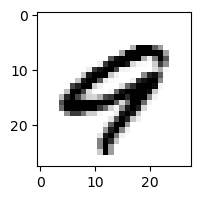

1.6989088009603277% - 0
0.001249529152575554% - 1
0.00032045886156922045% - 2
0.00011906066566279031% - 3
76.30396824882638% - 4 - ОШИБКА
0.007392636414218071% - 5
0.27424159991946534% - 6
1.7360629088135637% - 7
0.029636727077622563% - 8
4.931923972802543% - 9

 7


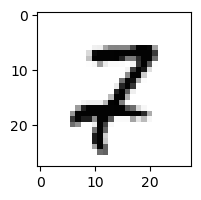

0.3316798648589503% - 0
0.2613255343227012% - 1
61.03967409186599% - 2 - ОШИБКА
0.0655482213449476% - 3
0.06171511028554001% - 4
0.047801156457505524% - 5
0.03984641292574562% - 6
5.1652252034699595% - 7
26.049005744231412% - 8
4.459604947067207% - 9

 2


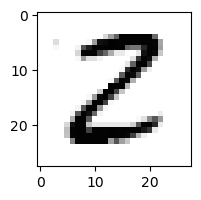

3.295837711988269% - 0
0.2872939542143392% - 1
56.165412707026896% - 2
59.62720296642583% - 3 - ОШИБКА
0.017400378086856197% - 4
8.765141928939016% - 5
0.0008246609734430585% - 6
0.0004029563290013694% - 7
5.424654891502878% - 8
1.1750848895786049e-05% - 9

 7


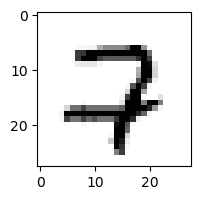

2.349148457386104% - 0
0.0009769909710467348% - 1
59.45015604716536% - 2 - ОШИБКА
0.24227367606092978% - 3
0.11983641676979347% - 4
0.011161136366226208% - 5
0.14885294314928738% - 6
33.941076413191155% - 7
0.6388451134550476% - 8
1.5885877348180266% - 9

 2


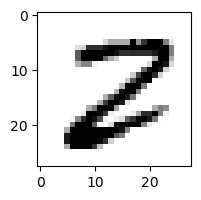

0.14185199329134085% - 0
0.006018719623404259% - 1
23.666179483665925% - 2
1.3880460859334505% - 3
0.001192245039694358% - 4
2.46651041762227% - 5
0.01614790077897323% - 6
0.04570310096224269% - 7
84.46759848232122% - 8 - ОШИБКА
0.0002125816387306355% - 9

 8


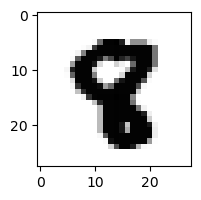

1.2655022882047777e-05% - 0
0.00022330009598318755% - 1
0.0023569691583131326% - 2
0.0008318342697074156% - 3
0.35908412441854115% - 4 - ОШИБКА
0.11238589517237277% - 5
0.0002184023994200119% - 6
0.0014600308392550992% - 7
0.07165178432076566% - 8
0.024287194109134668% - 9

 8


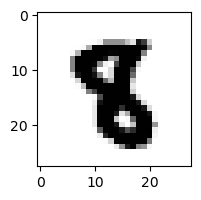

4.314470600799382e-06% - 0
0.004286300852350605% - 1
0.0008854915345570667% - 2
0.001882029409469408% - 3
0.030465669624290072% - 4
1.468001871439558% - 5 - ОШИБКА
0.004784821666370051% - 6
0.0018637476571433712% - 7
0.04145133775336592% - 8
0.006623138241697167% - 9

 8


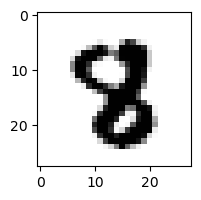

8.30924057466903e-05% - 0
0.0005392724006116328% - 1
0.024460741674676708% - 2
0.014986615725990941% - 3
0.24910107827673533% - 4 - ОШИБКА
0.19712565709578544% - 5
0.0012728445279244235% - 6
0.1573021079974864% - 7
0.13437422443678013% - 8
0.006014581207250327% - 9

 8


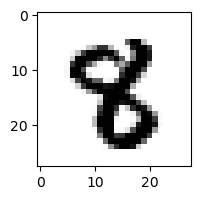

6.19373960288236e-05% - 0
0.016156252090786805% - 1
0.005928570409238986% - 2
0.030835168891378665% - 3
0.6011722955609182% - 4
0.8373867623606512% - 5 - ОШИБКА
0.0008374735907554409% - 6
0.038715132159727494% - 7
0.2842625253728116% - 8
0.005982292581208133% - 9

 8


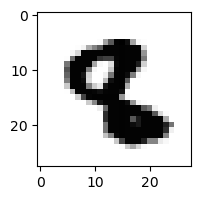

3.271370139340439e-05% - 0
0.008704766432642489% - 1
0.020610884009866555% - 2
0.009605676661222945% - 3
0.005445413581034046% - 4
0.526788761330348% - 5 - ОШИБКА
0.0010791823555009769% - 6
0.00038301629454370005% - 7
0.00018749700994602595% - 8
0.0076293621602266755% - 9

 8


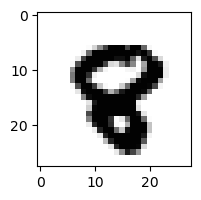

0.0027142364513415423% - 0
2.496323774018366e-05% - 1
0.004534431202849593% - 2
2.2346067361364964e-06% - 3
0.059011179750985% - 4
0.011551197077136982% - 5
0.01524975838828449% - 6
0.043878275096575124% - 7
5.954071453444158% - 8
6.86247465880873% - 9 - ОШИБКА

 8


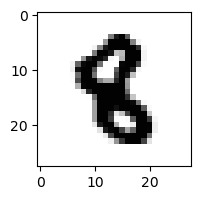

0.00011691653016699068% - 0
0.02641171063594085% - 1
0.013534008876156927% - 2
0.002994096968169328% - 3
0.18669617611581538% - 4
1.7962646474132566% - 5 - ОШИБКА
0.05519891514008039% - 6
0.0004598014796637436% - 7
0.10005426678652647% - 8
0.03937935967988943% - 9

 8


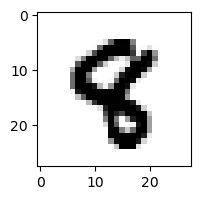

0.00016588097878581464% - 0
0.00866968113645957% - 1
0.006838744625877926% - 2
0.004702592856160972% - 3
3.448211178128612% - 4 - ОШИБКА
0.22126389124768972% - 5
0.0005203805670046329% - 6
0.0054898755700351284% - 7
0.16653960931509354% - 8
0.43133110126049684% - 9

 8


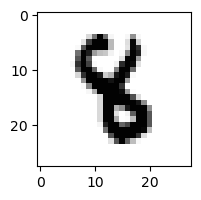

2.4872158145410516e-05% - 0
0.08690498338174046% - 1
0.008787671204501642% - 2
0.3165776116551453% - 3
1.4293532375466664% - 4
4.09571924893921% - 5 - ОШИБКА
0.19099002061816675% - 6
0.0072299199895160095% - 7
0.030382083448494652% - 8
0.0013340130551394607% - 9

 7


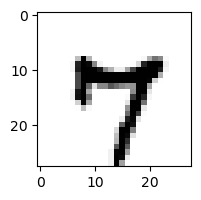

0.5901736120392839% - 0
0.005143056844038912% - 1
1.7533210417846612e-05% - 2
0.10869967748540851% - 3
75.62610749355609% - 4 - ОШИБКА
1.7482352305345648% - 5
0.3162390384255469% - 6
30.385018204435628% - 7
6.901517983246862% - 8
20.691761740134062% - 9

 8


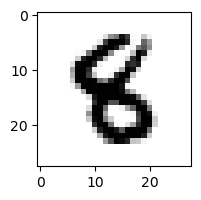

0.0015090253537795642% - 0
0.007108201594926758% - 1
0.004125211437121772% - 2
0.038333157599632336% - 3
0.7128076742471484% - 4
7.586942472209141% - 5 - ОШИБКА
0.17099933959610447% - 6
0.00027983123016431135% - 7
0.30408512974949936% - 8
0.003249789928429107% - 9

 8


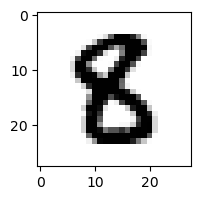

0.030922579848814392% - 0
0.0012566049183775946% - 1
0.0051177357278278535% - 2
0.1263634852462778% - 3
0.013964480983573365% - 4
16.46839685334129% - 5 - ОШИБКА
0.026400927077894293% - 6
4.236481000499793e-05% - 7
0.502471367333728% - 8
0.00014032755383935596% - 9

 2


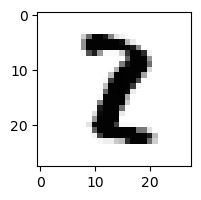

0.0003666904982188649% - 0
23.3802434944744% - 1 - ОШИБКА
3.8152558130418583% - 2
3.401090833541573% - 3
0.06114137142790432% - 4
0.013964608242368132% - 5
0.003369533379592331% - 6
0.04031598124983275% - 7
0.3075020587053587% - 8
0.00189791366827349% - 9

 8


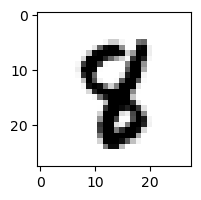

0.0001561660135936769% - 0
0.013383708290310893% - 1
0.03534710932623715% - 2
0.017485943147203534% - 3
2.1414098845567864% - 4 - ОШИБКА
1.7655602797360572% - 5
0.011624495254278463% - 6
0.29783838502664506% - 7
1.6091883524265758% - 8
0.06652169124113706% - 9

 3


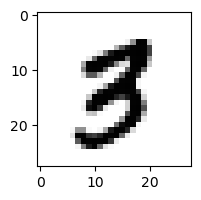

0.051230905380500555% - 0
0.007713492173665079% - 1
0.018753663371763464% - 2
1.2725019581618853% - 3
0.12460490629392115% - 4
0.3478196239824641% - 5
0.002809005838375575% - 6
0.2814680470624514% - 7
1.703651612935907% - 8 - ОШИБКА
1.1414308924852112% - 9

 2


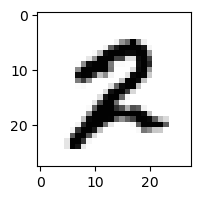

0.027599048703090653% - 0
0.06562762495302873% - 1
10.307954368623456% - 2
0.0012540527291680704% - 3
0.0007540513910725515% - 4
0.9811916040523734% - 5
0.06362741738522391% - 6
0.06383300815657568% - 7
22.53544037636092% - 8 - ОШИБКА
2.987623771031231% - 9

 4


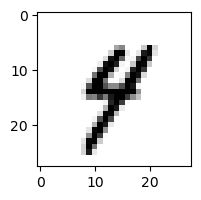

0.06525000571917419% - 0
2.1308195728881056% - 1
0.03787294085822044% - 2
0.48644608978084247% - 3
19.907809803522177% - 4
5.0608059439465665% - 5
0.3817233311396637% - 6
2.1291177134785686% - 7
2.1799534933745304% - 8
20.704451972388092% - 9 - ОШИБКА

 9


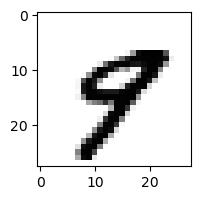

0.07170939722357486% - 0
0.021901510250989607% - 1
0.001738158843468417% - 2
0.008455594957648353% - 3
39.37666447951552% - 4 - ОШИБКА
0.8045481579183007% - 5
0.008837572228217063% - 6
17.346702969224996% - 7
0.3236141953268144% - 8
1.2182918763170854% - 9

 9


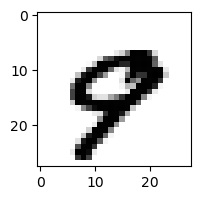

0.9357683052640721% - 0
0.004316382414736442% - 1
0.0008109118895072184% - 2
1.9364748758343684e-05% - 3
14.10785789563258% - 4
0.0005734810274612384% - 5
0.013475077174367415% - 6
72.04577820359572% - 7 - ОШИБКА
0.016787715293304906% - 8
13.24099206947701% - 9

 9


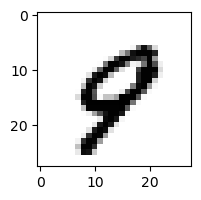

1.6852022785973877% - 0
0.04839510779359238% - 1
0.030367911241159586% - 2
0.0006896688810486642% - 3
27.309979583621256% - 4 - ОШИБКА
0.038551463007426595% - 5
0.15302261929036395% - 6
16.93103367126444% - 7
0.2561198627201609% - 8
10.977012154610595% - 9

 8


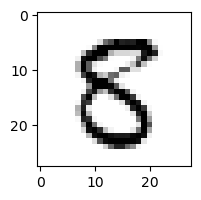

3.0710575615210107% - 0
0.0028119775079804487% - 1
0.05938564384444428% - 2
2.5482136934552146% - 3
4.011181179605669% - 4
87.7806245627224% - 5 - ОШИБКА
0.006200001911177832% - 6
0.003161077253812084% - 7
28.891426084979027% - 8
0.0021265255142610745% - 9

 2


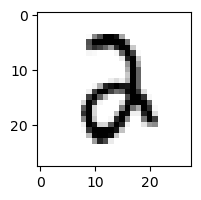

0.504263732392728% - 0
0.0038520518399883835% - 1
55.70166338695783% - 2
58.848232073417265% - 3 - ОШИБКА
0.49057874295834025% - 4
0.19066852009500784% - 5
1.9869929783066003% - 6
0.01953105775814254% - 7
0.08656761917799063% - 8
0.06051690278911449% - 9

 8


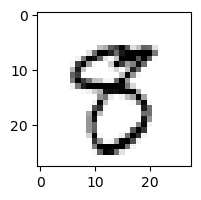

0.5421711458527515% - 0
0.09050124938608618% - 1
0.0079799717464823% - 2
8.682061847288937% - 3
0.09925577329096297% - 4
9.605150949434254% - 5
0.007906428475967642% - 6
0.830834502813581% - 7
3.354326767651995% - 8
31.78038093530466% - 9 - ОШИБКА

 8


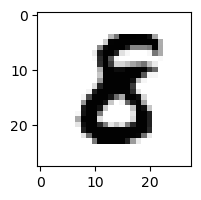

0.04252347292760498% - 0
0.010459644461542962% - 1
0.04867920637706272% - 2
1.2536037683629744% - 3 - ОШИБКА
0.015597572002425179% - 4
0.7632963420264849% - 5
0.05992265829170242% - 6
4.251239356420818e-05% - 7
0.7748156534756997% - 8
9.229617296371225e-05% - 9

 8


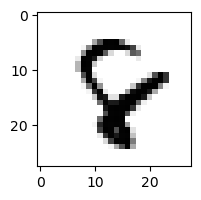

0.009055871829358205% - 0
0.006065412118247615% - 1
0.6110076117497054% - 2
0.003079336547259977% - 3
29.858701337776793% - 4 - ОШИБКА
0.22377763925996141% - 5
7.887836277337701% - 6
2.7100691686434644% - 7
1.8937455810714612% - 8
0.058912743603115256% - 9

 2


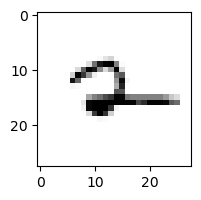

0.18480018904913703% - 0
29.606454683481786% - 1
1.540896277507266% - 2
0.022844842177646645% - 3
63.57290833611068% - 4 - ОШИБКА
0.5230904038737281% - 5
54.574043976646735% - 6
3.439390519043951% - 7
32.54514824033272% - 8
60.67264764368824% - 9

 2


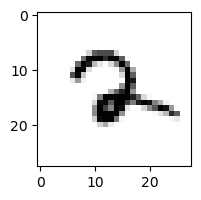

0.0011745699456461299% - 0
7.340484949686063% - 1
22.230323569492118% - 2
0.04094192652324368% - 3
12.548897682234763% - 4
0.12878615496817453% - 5
13.409197780785536% - 6
53.008373549293495% - 7 - ОШИБКА
4.571995553378766% - 8
16.211618497542997% - 9

 8


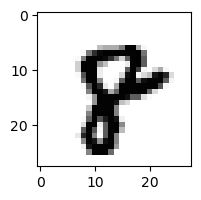

0.015689414688278187% - 0
0.003084957181054399% - 1
0.003812237471741863% - 2
0.0003045847662134834% - 3
0.04146691811234482% - 4
0.02205057315596791% - 5
0.17920251699263054% - 6
2.992649013506289% - 7
12.183525683550915% - 8
12.24131856553373% - 9 - ОШИБКА

 5


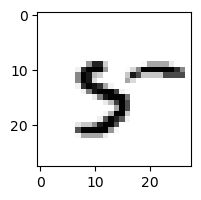

0.8784983349704711% - 0
0.6468900148523262% - 1
0.673959061014376% - 2
0.019365889972920776% - 3
34.581662463960576% - 4
50.369290252348875% - 5
10.51407539910044% - 6
1.7517832205247743% - 7
53.89122114617953% - 8 - ОШИБКА
5.559727777280898% - 9

 9


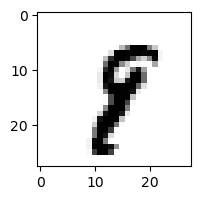

0.005185457740523632% - 0
8.627117841296089% - 1
0.06027934329721504% - 2
0.4925824997955997% - 3
0.1241476947002445% - 4
0.3708726623459946% - 5
0.10585706233050211% - 6
13.706830943765292% - 7 - ОШИБКА
3.135212521426452% - 8
2.9629574096484887% - 9

 2


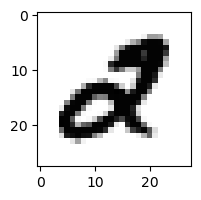

1.88837014898619% - 0
0.0037573615832055787% - 1
1.0657847299535177% - 2
0.0946372894320872% - 3
2.6750906091872384% - 4 - ОШИБКА
0.1594967250775411% - 5
0.0005301605729778466% - 6
0.001869415872251472% - 7
7.429102623777649e-05% - 8
0.002611817935648203% - 9

 9


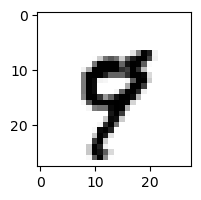

0.01845549794005279% - 0
0.10912741414063358% - 1
0.004737162351660502% - 2
0.0013196349036608088% - 3
27.597417122098882% - 4
0.2010460295332157% - 5
0.051140705277044576% - 6
64.50386471723726% - 7 - ОШИБКА
0.030821538225968483% - 8
4.125935058853652% - 9

 9


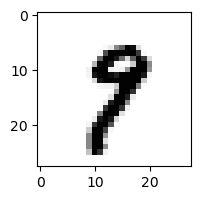

0.024452424632914336% - 0
2.6233282716113475% - 1
0.029749367672457512% - 2
0.17937355272522623% - 3
0.07749516545671292% - 4
0.5510303543952518% - 5
0.025669364131701528% - 6
44.06750330263755% - 7 - ОШИБКА
6.761628247394031% - 8
20.635492227084214% - 9

 7


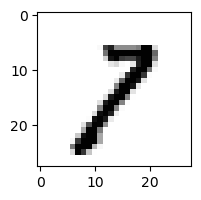

0.6220666767971444% - 0
32.42879059570497% - 1 - ОШИБКА
9.18511588338778% - 2
12.19765943198223% - 3
0.06887438904154469% - 4
0.19829070364296483% - 5
0.016633451024382507% - 6
11.329005164305975% - 7
18.12570994352416% - 8
19.229733816513907% - 9

 8


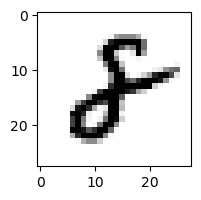

0.13799029303432786% - 0
14.914785487665377% - 1
22.48739135890987% - 2 - ОШИБКА
0.0951210024305982% - 3
0.05098587237945157% - 4
0.014413560554711588% - 5
0.7030022595630244% - 6
0.0024950501053075643% - 7
1.4293615652199685% - 8
0.13429639417628475% - 9

 9


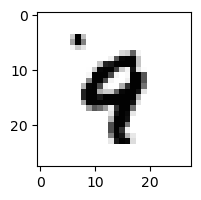

0.006070886359347763% - 0
0.10405416039756019% - 1
0.013825275072103793% - 2
0.008938937501307169% - 3
88.80717923641423% - 4 - ОШИБКА
0.1250550919573097% - 5
3.27991657404889% - 6
2.173781349411418% - 7
0.09743824707577034% - 8
7.202789505807217% - 9

 2


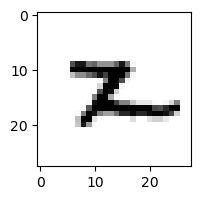

0.040625740845324367% - 0
4.692192095790131% - 1
1.0631394471478657% - 2
0.02610219774846971% - 3
2.2492046899518705% - 4
10.342956139339195% - 5
10.880333965403787% - 6
0.21229369401449782% - 7
58.12518131525102% - 8 - ОШИБКА
2.8089424757327435% - 9

 6


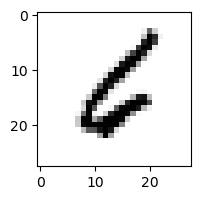

11.701078271130065% - 0
1.3063623801796898% - 1
3.2615056563853146% - 2
1.3387363213890764% - 3
2.897607800805492% - 4
18.71117264740443% - 5 - ОШИБКА
8.97205527689863% - 6
0.3694268347935049% - 7
0.028187715923523284% - 8
0.021485218478109264% - 9

 3


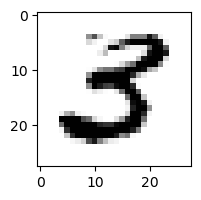

0.6244742401536428% - 0
0.017507206626963315% - 1
0.007515160513382701% - 2
59.89028194477226% - 3
0.219911071846071% - 4
88.74793621455056% - 5 - ОШИБКА
0.004831922913423334% - 6
0.019622778651167582% - 7
0.029327115345906686% - 8
2.5316498553701015e-06% - 9

 3


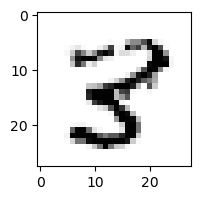

0.02271018416815637% - 0
0.1535874124468778% - 1
0.5068970495120999% - 2
2.004205113435211% - 3
20.017431206630988% - 4
5.333350293383302% - 5
0.0024462949404045037% - 6
0.03279779137198211% - 7
93.12188543298716% - 8 - ОШИБКА
0.00935572913460342% - 9

 0


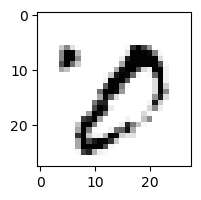

8.29130047779226% - 0
9.147314714427026% - 1
0.037408233666364886% - 2
50.81923430059102% - 3
0.02733589967599359% - 4
0.1846986236998717% - 5
0.00684257287230633% - 6
0.924811350989452% - 7
57.9842306509074% - 8 - ОШИБКА
0.008808099135552342% - 9

 9


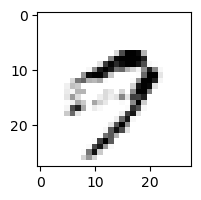

47.770176793818024% - 0
0.02336078871458571% - 1
0.017364199903647345% - 2
0.526536558952969% - 3
1.7347369829175439% - 4
0.3241472879337138% - 5
0.34246072310701164% - 6
88.3472481221031% - 7 - ОШИБКА
0.5025021547867411% - 8
64.67818111631696% - 9

 1


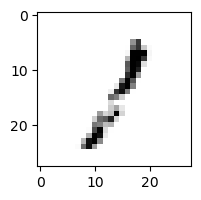

7.961340710792491% - 0
51.65365459785842% - 1
17.49398029375751% - 2
38.724330447395275% - 3
10.709518094014367% - 4
4.031219438243976% - 5
0.9912955619603389% - 6
61.229309695257825% - 7 - ОШИБКА
16.522591619470823% - 8
3.5978304932750644% - 9

 1


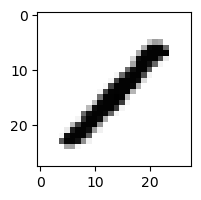

0.07583496853989807% - 0
77.9930318068478% - 1
17.954278558358595% - 2
1.6050539879494883% - 3
6.1362825812195885% - 4
0.5004156292198324% - 5
0.032539619932323446% - 6
0.15604087795455396% - 7
87.1172658872699% - 8 - ОШИБКА
0.3011435875604612% - 9

 3


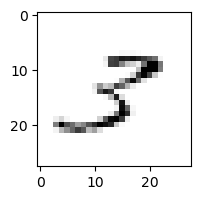

8.30167498540635% - 0
10.052473772882735% - 1
47.836232615479005% - 2 - ОШИБКА
24.609183784717377% - 3
0.8642257359412051% - 4
3.906899761609708% - 5
0.49505304998283806% - 6
18.653011819058392% - 7
26.567608932257393% - 8
13.032665343735822% - 9

 3


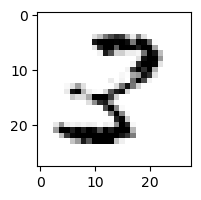

5.146521586756035% - 0
0.9968538729456402% - 1
25.85145363002467% - 2 - ОШИБКА
21.999613350649355% - 3
0.5282207039562404% - 4
0.5844955701024015% - 5
0.004131237863306308% - 6
0.025780857514560728% - 7
10.003648777068534% - 8
0.0018632911920896174% - 9

 2


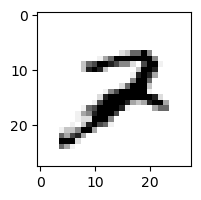

0.12767502341717685% - 0
0.8962538302296041% - 1
12.378746442297983% - 2
0.009771437770426418% - 3
0.7822429414212452% - 4
0.011521521208500607% - 5
0.4245975808651313% - 6
24.377679683172108% - 7 - ОШИБКА
6.835907524220356% - 8
7.58922144807688% - 9

 3


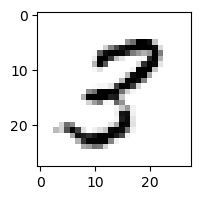

2.343156413788967% - 0
0.2191467262620016% - 1
3.1851683183190787% - 2
41.49960034911282% - 3
0.8681386551304018% - 4
3.579265008787246% - 5
0.010653415247684834% - 6
0.11718040292404516% - 7
54.132360824806725% - 8 - ОШИБКА
1.7257269247771614% - 9

 6


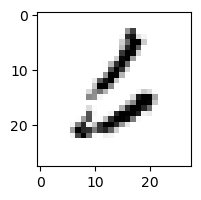

25.435769861126367% - 0
0.41904668344578183% - 1
3.846457530218493% - 2
25.45590664050394% - 3
0.2517390110202738% - 4
52.167064382846796% - 5 - ОШИБКА
36.56392462885114% - 6
0.8928492746874775% - 7
0.019954759769476742% - 8
0.05490614416364002% - 9

 3


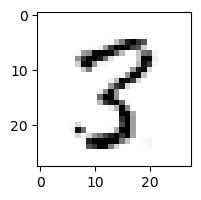

0.17260253614518295% - 0
0.8033443984454922% - 1
4.09059657077524% - 2
20.470595391703167% - 3
1.2537210523402074% - 4
9.08135180151308% - 5
0.0049472924188584426% - 6
2.5435716606318737% - 7
92.58932933604903% - 8 - ОШИБКА
0.10342165191743462% - 9

 9


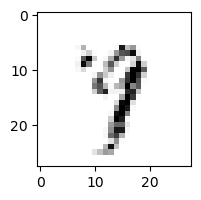

0.11655953010793157% - 0
0.3099491059771317% - 1
1.2614810461903885% - 2
9.956917366804102% - 3
28.60472182016772% - 4
1.4500168512260236% - 5
2.065910865471447% - 6
69.45897318205232% - 7 - ОШИБКА
7.229639066815883% - 8
34.794954595112465% - 9

 2


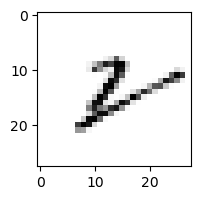

2.6690352556472194% - 0
36.18629190878867% - 1
7.84941440634478% - 2
0.32142389935525756% - 3
3.051343695264924% - 4
2.1912599115420033% - 5
46.8106776111323% - 6
1.2997896566720373% - 7
57.5385690379534% - 8 - ОШИБКА
23.370519878228084% - 9

 8


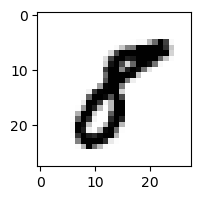

1.4306266239379644% - 0
9.411578175097514% - 1
0.045498167626152525% - 2
0.9993339674434714% - 3
0.0911815997418557% - 4
12.158252373639787% - 5 - ОШИБКА
0.00035113087892022285% - 6
0.04940762768836761% - 7
1.5127543870106384% - 8
0.020308891117663617% - 9

 2


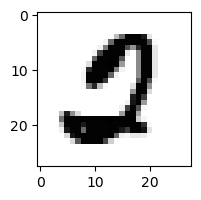

46.884020639636994% - 0
7.42062002930441e-05% - 1
1.347082241496242% - 2
0.14217165022011466% - 3
0.00016705530807317525% - 4
66.24205604005195% - 5 - ОШИБКА
0.019094478250754925% - 6
0.24650465806663946% - 7
0.07496757789538697% - 8
0.0002313819676987009% - 9

 5


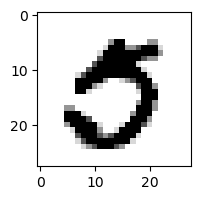

56.521715317411825% - 0 - ОШИБКА
0.000650400766464507% - 1
0.00020257166581204398% - 2
1.5230174929484652% - 3
0.0004261039784059624% - 4
36.1776933778672% - 5
4.2600502119128725e-05% - 6
2.2395587351115713% - 7
0.004902923021592959% - 8
0.0018876549606094424% - 9

 2


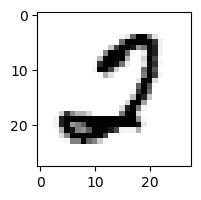

75.39367242051352% - 0 - ОШИБКА
0.008536367629793973% - 1
60.272866076001264% - 2
2.586536298319203% - 3
0.0005507021043334753% - 4
14.01127442933018% - 5
0.38301007638515355% - 6
1.7630176176201933% - 7
0.16146264093642634% - 8
0.005004558851865281% - 9

 5


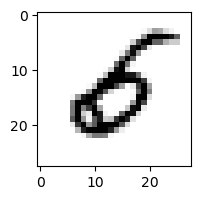

20.933284269005565% - 0
0.23830655815693919% - 1
0.4768654062415894% - 2
1.125243388903546% - 3
2.9970966419502085% - 4
5.284665480656966% - 5
53.31546365573882% - 6 - ОШИБКА
0.019687601082078954% - 7
0.010209236238841643% - 8
0.11914502352230984% - 9

 8


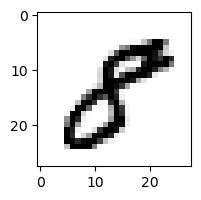

1.9223354696189319% - 0
0.6303838322113204% - 1
0.03489793125757781% - 2
4.86837010397188% - 3
0.7044911139780785% - 4
6.282463150166986% - 5 - ОШИБКА
0.0008366934029518726% - 6
0.04107059386582679% - 7
3.6981476213366933% - 8
0.10644030749685147% - 9

 9


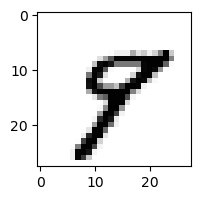

0.07735874901489005% - 0
0.43296277096860936% - 1
0.029980366590563093% - 2
0.014042514287602512% - 3
5.412335421992574% - 4
5.319562212881616% - 5
0.028431529794352168% - 6
12.861328285067986% - 7
36.89157198202121% - 8 - ОШИБКА
6.554596052143862% - 9

 9


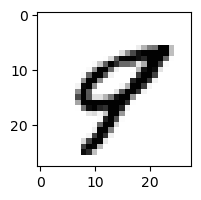

0.6305164034111435% - 0
0.06687371498081676% - 1
0.010279364721814099% - 2
0.00033499628199591913% - 3
65.26869346231278% - 4 - ОШИБКА
0.20977455426040578% - 5
0.03873171652697795% - 6
15.137960096522542% - 7
4.126521306568912% - 8
5.406758735164441% - 9

 9


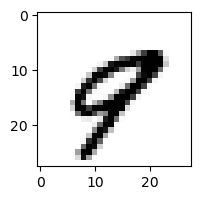

0.8647378165326194% - 0
0.12059224105594399% - 1
0.012031216339066094% - 2
0.0005328683832634243% - 3
40.145221033692344% - 4 - ОШИБКА
0.013031755708709718% - 5
0.058422197593614805% - 6
35.95938217244278% - 7
1.4806408255237262% - 8
1.8070945572594965% - 9

 8


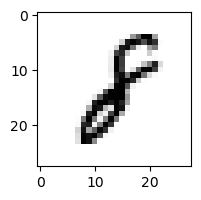

0.08856179308407323% - 0
76.82370165703027% - 1 - ОШИБКА
8.761705121929403% - 2
0.3334669674062348% - 3
0.2368447745211364% - 4
0.13856953893021956% - 5
1.359905019346145% - 6
0.10869389692894807% - 7
15.927359915169362% - 8
0.46396000588259917% - 9

 4


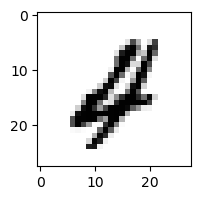

0.6663608418681619% - 0
0.10230172729273954% - 1
5.573794289938988% - 2 - ОШИБКА
0.09891235331294267% - 3
2.652192136794719% - 4
0.03449057455356928% - 5
0.38873758048601464% - 6
0.1472553885250616% - 7
0.21448080316485021% - 8
0.3250946929271225% - 9

 5


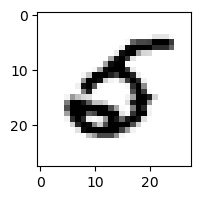

3.8234673578106553% - 0
0.012309561121155266% - 1
0.04770659511107934% - 2
0.0013809494764172594% - 3
1.8006783207319996% - 4
1.5258239676503125% - 5
13.132771860599174% - 6 - ОШИБКА
0.1945955947223022% - 7
0.00037358553964629115% - 8
0.005387559684446801% - 9

 2


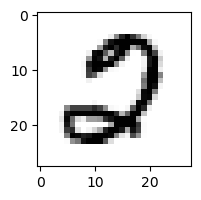

44.218926648512735% - 0 - ОШИБКА
0.0006465748513773966% - 1
27.534031332995863% - 2
0.015082133741833696% - 3
0.0030661064730572217% - 4
0.18254390403076165% - 5
0.27523655590681095% - 6
0.4864977255827219% - 7
2.7532012672788206% - 8
0.0016565171806338088% - 9

 2


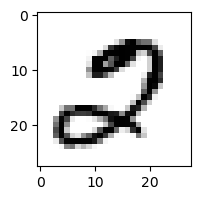

64.64833109894175% - 0 - ОШИБКА
0.0035055560180856957% - 1
3.060600973844919% - 2
0.03843437820061635% - 3
0.00570439368678273% - 4
0.26488500057153846% - 5
0.1657897782245221% - 6
5.888891675252547% - 7
1.2493876202461478% - 8
0.05619596822264672% - 9

 8


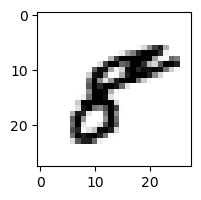

8.382236037094753% - 0 - ОШИБКА
0.23337281087618564% - 1
0.08588421775906649% - 2
0.055206922527139025% - 3
3.805159738210858% - 4
4.295367723099777% - 5
0.0020635129762875373% - 6
0.20992581247642705% - 7
5.780029564818111% - 8
0.6858779454580932% - 9

 9


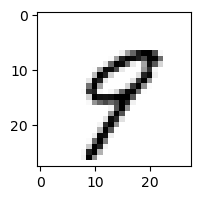

0.43928658761910894% - 0
0.36956896205001644% - 1
0.11587129416689426% - 2
0.40666980711975387% - 3
33.74396338539662% - 4 - ОШИБКА
2.204616727308909% - 5
0.2240830287567066% - 6
33.29618905308816% - 7
2.3990505216314064% - 8
12.442567909654995% - 9

 2


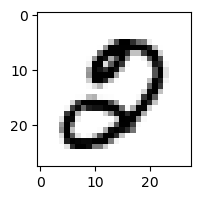

18.305398690081436% - 0 - ОШИБКА
0.002117417252182313% - 1
0.043491868263046685% - 2
0.042755976509112725% - 3
0.2154383547889656% - 4
0.3839914562113608% - 5
0.15193910667755428% - 6
0.40420188504548826% - 7
1.9765618272291556% - 8
0.008829778803164122% - 9

 5


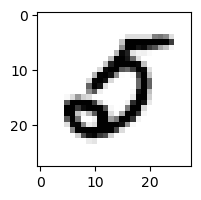

82.05422617540196% - 0 - ОШИБКА
0.0036939408697596854% - 1
0.614891033261261% - 2
0.013391999673715101% - 3
0.4167637231807609% - 4
0.8239817376375562% - 5
2.0988076897799286% - 6
0.33845970191741165% - 7
0.002155370382624672% - 8
0.00789679839041228% - 9

 5


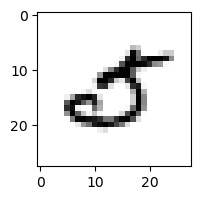

50.3052525384169% - 0 - ОШИБКА
0.11453517326466926% - 1
1.0152121943098573% - 2
7.255520585572138% - 3
6.507749177421471% - 4
7.316815248206095% - 5
1.2110727316091676% - 6
4.332700968885258% - 7
0.07353824538561932% - 8
0.09171951358775303% - 9

 2


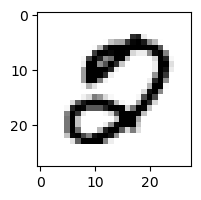

15.158169462202109% - 0 - ОШИБКА
0.0003563687926402833% - 1
0.18580567591965447% - 2
0.0010698669132800755% - 3
0.25436948115253466% - 4
2.382579901352886% - 5
0.3686991821458823% - 6
0.10045594279438984% - 7
1.5832366402716322% - 8
0.004517374428745294% - 9

 8


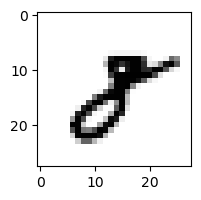

0.24137997873895056% - 0
19.003269779312255% - 1 - ОШИБКА
1.927712080003555% - 2
1.7200795419727906% - 3
0.06882809852945225% - 4
0.0377389243055539% - 5
0.007164032600463995% - 6
2.442179992517226% - 7
4.296960876926368% - 8
0.6291106110648018% - 9

 9


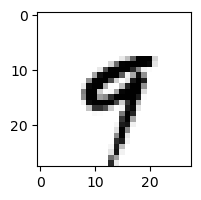

0.041232247900478566% - 0
0.21271648325645295% - 1
0.006174622336016621% - 2
0.8059776314234466% - 3
90.62318125638686% - 4 - ОШИБКА
0.3811367801898584% - 5
0.4455451263898261% - 6
5.172934834911115% - 7
0.2075884378988896% - 8
4.465275050673702% - 9

 2


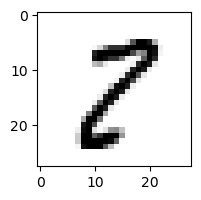

5.928307381166005% - 0
3.8102487622078547% - 1
4.938056905429959% - 2
10.718418402889162% - 3
0.017529992760151856% - 4
4.616278184370932% - 5
0.005639735954304092% - 6
0.4798991458847045% - 7
97.81393680787065% - 8 - ОШИБКА
1.231844989122494% - 9

 2


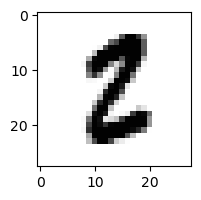

0.08601495208655754% - 0
0.22764846726331173% - 1
0.774195091597332% - 2
0.09257613540301726% - 3
2.1989136135601438e-05% - 4
3.370163227986718% - 5 - ОШИБКА
0.06595632463481663% - 6
0.006964479969109069% - 7
2.709404752967214% - 8
0.003975153779509085% - 9

 4


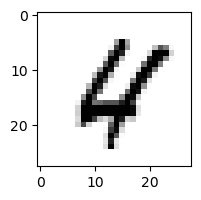

0.6082979866630699% - 0
0.005036570951351989% - 1
2.186562741443455% - 2
0.00048648412793700737% - 3
38.90542738785257% - 4
0.16423274452278738% - 5
2.355748546565797% - 6
0.5258697943072375% - 7
48.64593767979447% - 8 - ОШИБКА
5.883627237098049% - 9

 2


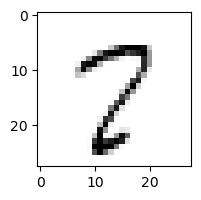

4.3908532651582215% - 0
0.5465405775894585% - 1
4.1101044583135% - 2
2.9872636189932096% - 3
0.7869134184402417% - 4
16.53381777484483% - 5
0.1076861052942723% - 6
81.60736233436134% - 7 - ОШИБКА
78.601725285442% - 8
28.30603459525158% - 9

 3


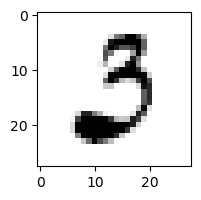

60.56136740729914% - 0 - ОШИБКА
0.5742672311221612% - 1
11.191316843506057% - 2
35.770052299089194% - 3
0.0004042251286623987% - 4
3.9980771826382218% - 5
1.0628185344552323% - 6
0.5686168856790798% - 7
0.2597323710704562% - 8
0.00010243898022275424% - 9

 9


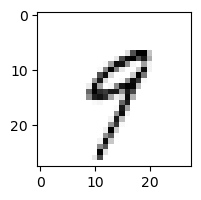

0.9310012055320536% - 0
1.9344025403082037% - 1
0.43961230042384075% - 2
17.38980219407069% - 3
50.452192404830065% - 4 - ОШИБКА
5.473240945428818% - 5
2.215930267804318% - 6
12.566584042260228% - 7
4.463348253945611% - 8
43.4886239976026% - 9

 2


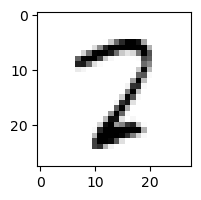

1.5057122550762647% - 0
0.044673891057144026% - 1
22.940100307290177% - 2
6.897831332998851% - 3
1.7400962982660524% - 4
7.159381703033445% - 5
0.19322651121336162% - 6
21.375430927739% - 7
26.538101827972287% - 8 - ОШИБКА
0.017297404495899643% - 9

 5


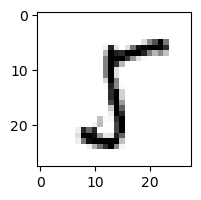

3.3208305674348715% - 0
66.31483798077156% - 1 - ОШИБКА
0.3681934707701143% - 2
2.862541474749543% - 3
0.11145263108652552% - 4
63.37459257634317% - 5
0.03639514444808672% - 6
3.5304345449752894% - 7
12.27875840647722% - 8
0.6422258058850917% - 9

 2


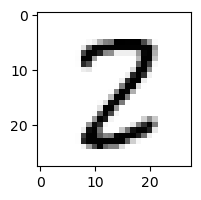

0.18362495323290703% - 0
0.5900241293671101% - 1
22.67056274426234% - 2
5.337496901729795% - 3
0.43543182599182495% - 4
1.8731239225559488% - 5
0.0037448375639624674% - 6
0.8433257225036721% - 7
72.2476733811146% - 8 - ОШИБКА
0.0007052067683536782% - 9

 9


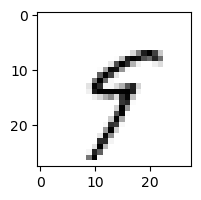

0.5569653164942121% - 0
4.235524602073296% - 1
0.15836317738438427% - 2
12.665762481848756% - 3
50.54093766116989% - 4 - ОШИБКА
32.65702933868685% - 5
1.5398419324277255% - 6
16.012784655126858% - 7
6.351917566627025% - 8
4.218476621405181% - 9

 6


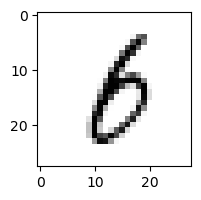

1.3979040319118385% - 0
12.611108320978898% - 1
0.4830891275297452% - 2
27.698622659782963% - 3
0.279444246699425% - 4
5.0429239248850966% - 5
25.75948884945431% - 6
0.15376794747245986% - 7
46.562104351920226% - 8 - ОШИБКА
3.7952780150223258% - 9

 2


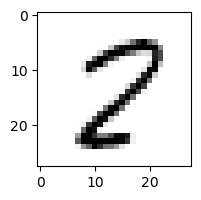

4.8707127326162745% - 0
0.5130380578246004% - 1
3.3117037818433914% - 2
0.04131681044791587% - 3
0.2024363457607696% - 4
10.077911799816839% - 5
0.022668051330751907% - 6
17.552938195370434% - 7
94.85345804984436% - 8 - ОШИБКА
0.5018984607057075% - 9

 2


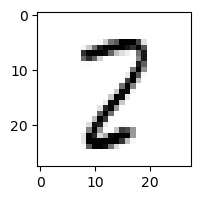

0.7619450871558902% - 0
4.07901690883705% - 1
22.150528337648474% - 2
8.557222915608342% - 3
0.9598545122409503% - 4
2.258396965383454% - 5
0.08419646336481092% - 6
10.739828107459333% - 7
80.52443194144013% - 8 - ОШИБКА
0.017814818238819693% - 9

 5


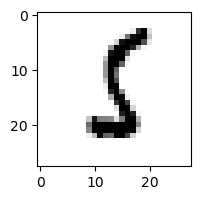

0.6648664998268924% - 0
9.758656199006692% - 1
3.5857925743743113% - 2
2.7548663665134385% - 3
0.0048923098249284815% - 4
16.826272940279402% - 5
47.536912836770256% - 6 - ОШИБКА
0.0949122729875367% - 7
0.766139605912809% - 8
0.02018109158133075% - 9

 6


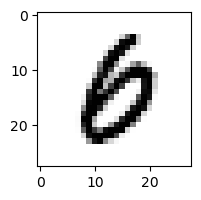

8.80425695928496% - 0 - ОШИБКА
0.004935710896508182% - 1
0.0939016528473149% - 2
0.7184679995848486% - 3
0.19532410212359355% - 4
0.3058353601276104% - 5
1.923547135217142% - 6
0.013305920152441295% - 7
2.2626968875470332% - 8
0.9795685753998029% - 9

 9


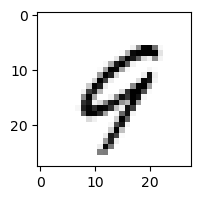

2.6600819838905707% - 0
0.26052218144960765% - 1
0.29314432710776844% - 2
0.041214852871651726% - 3
67.19834574029468% - 4 - ОШИБКА
0.26705726049365797% - 5
6.902784808489885% - 6
5.700391034870851% - 7
2.5410824701701222% - 8
15.6375514580151% - 9

 9


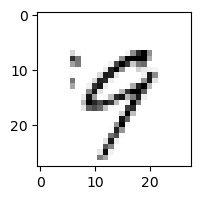

5.1608216800335285% - 0
0.3210352835397205% - 1
0.3263679448721414% - 2
2.0464544754774274% - 3
54.45604177543327% - 4 - ОШИБКА
0.9583532713016617% - 5
3.160612418211793% - 6
28.55229146559679% - 7
2.1024284600095307% - 8
25.076099739380386% - 9

 8


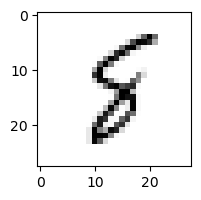

0.2554230988509896% - 0
3.0187432381923696% - 1
1.0565331844130452% - 2
0.3534267606065865% - 3
4.368946985221591% - 4
17.442743954892673% - 5
42.0856889689641% - 6 - ОШИБКА
1.118380655856428% - 7
39.6128685310705% - 8
6.981630191788681% - 9

 2


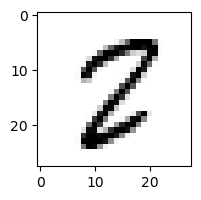

0.5539703614457187% - 0
0.3614920697685065% - 1
1.7244858010812867% - 2
0.2047076821744514% - 3
0.03902063381184505% - 4
10.116387437718762% - 5
0.21559026881555615% - 6
1.0140114415513746% - 7
73.41326105692596% - 8 - ОШИБКА
0.04312623736715089% - 9

 9


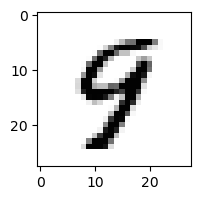

0.05698589489648857% - 0
0.006273927519098285% - 1
0.037142120477457664% - 2
0.13936870129847626% - 3
48.638400016464146% - 4 - ОШИБКА
4.142606250198401% - 5
0.30495886766277697% - 6
0.5260709811981855% - 7
5.134618250446064% - 8
15.996761505277757% - 9

 2


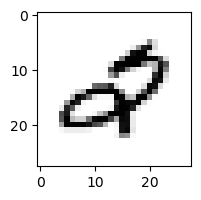

8.725563330366887% - 0 - ОШИБКА
0.7825197381806509% - 1
1.6942299932854485% - 2
0.26145225136186545% - 3
6.511007638726412% - 4
0.22841510072749574% - 5
0.10749920082659858% - 6
0.7858384149798439% - 7
0.0036447931144006273% - 8
0.01799076418132763% - 9

 3


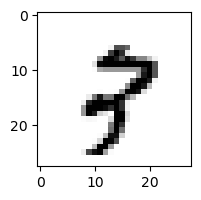

0.22771218847595304% - 0
0.29357785721711843% - 1
2.449309428121911% - 2
0.013901248485189713% - 3
0.4018347453181985% - 4
0.001950433163882485% - 5
0.14507918112053578% - 6
56.93011165526293% - 7
24.11371456346736% - 8
61.412648224010965% - 9 - ОШИБКА

 9


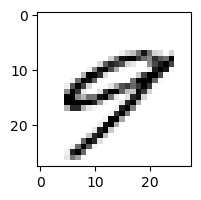

11.067861080174712% - 0
0.023836540607324545% - 1
0.005372370605614221% - 2
0.01082330671886091% - 3
48.090760997225885% - 4 - ОШИБКА
0.30361982877522475% - 5
0.22005303300731577% - 6
8.300217017249919% - 7
0.7720258364733963% - 8
36.77633869611572% - 9

 3


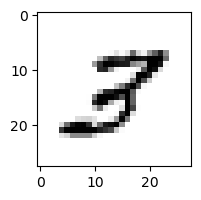

0.6249740113836239% - 0
0.31968152572007785% - 1
24.458563113566594% - 2
3.047262059087071% - 3
0.15644290509162048% - 4
2.2012426716033584% - 5
0.04414855593217901% - 6
3.8607332395614216% - 7
29.512946937189454% - 8 - ОШИБКА
1.8221483753402978% - 9

 5


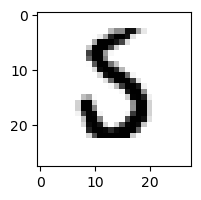

0.3515108761373799% - 0
0.012869604526535947% - 1
2.5927120434837705% - 2
6.728689676320212% - 3
0.041225721159663754% - 4
2.32864664306293% - 5
35.2567935835445% - 6 - ОШИБКА
0.34717995443615035% - 7
0.08850389921785183% - 8
0.001203492041092955% - 9

 3


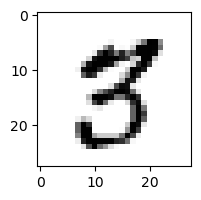

0.32388495265112055% - 0
0.03400187201866165% - 1
0.11298417181121614% - 2
2.8124570642676283% - 3
0.1768251818898433% - 4
32.66336043355875% - 5 - ОШИБКА
0.00048649866693055855% - 6
0.8718704370227179% - 7
11.398930369536748% - 8
0.40368784459241613% - 9

 3


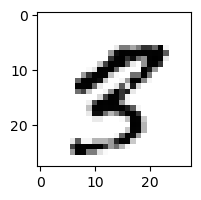

0.0377077450474169% - 0
0.13219828260665553% - 1
0.0004840018597718366% - 2
0.0025597607054808143% - 3
4.693060318023192% - 4
0.8596429693189774% - 5
0.00505848404208723% - 6
1.8432827090377981% - 7
28.09819677642014% - 8 - ОШИБКА
12.99047232254373% - 9

 9


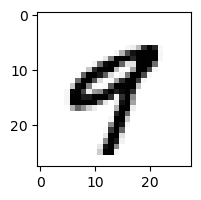

0.2114074795496931% - 0
0.050404427074149466% - 1
0.0003811463894582501% - 2
0.012352380875370569% - 3
58.611481044066096% - 4 - ОШИБКА
0.08227466443691948% - 5
0.011748816986352594% - 6
1.4682675643052518% - 7
0.1087373767162529% - 8
20.922930655079654% - 9

 2


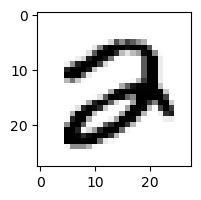

2.07462895114731% - 0
0.00018389793183996484% - 1
1.7405031479716497% - 2
0.48877644101147155% - 3
0.03479373484760888% - 4
0.030047912312719124% - 5
0.1965045677196582% - 6
0.2922486328703287% - 7
4.025352525942324% - 8 - ОШИБКА
0.00898980990901141% - 9

 8


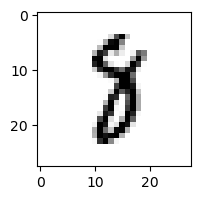

0.009874699587725626% - 0
3.653671736699895% - 1
1.3001383569272313% - 2
3.511759858881325% - 3
0.41194697141761427% - 4
1.0703301871983777% - 5
0.21585343151857647% - 6
12.216989216767745% - 7 - ОШИБКА
0.8792858165759275% - 8
0.058946505385822835% - 9

 5


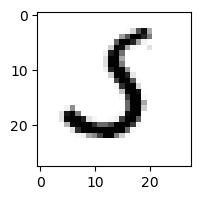

0.4916162314501303% - 0
0.3040021018031535% - 1
21.09285947597469% - 2
50.75007457561731% - 3 - ОШИБКА
0.013012291825771754% - 4
5.655794109842143% - 5
8.19629130683095% - 6
0.9508951642393394% - 7
0.009723815659633756% - 8
0.008728738897311536% - 9

 3


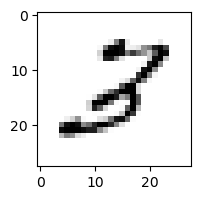

0.9333825214618711% - 0
0.4372355304083685% - 1
83.55167112489642% - 2 - ОШИБКА
24.87258059044059% - 3
0.5142019708581517% - 4
3.218873442576406% - 5
0.2276242600659378% - 6
0.2458912275286395% - 7
49.748806660416605% - 8
10.230875411064387% - 9

 2


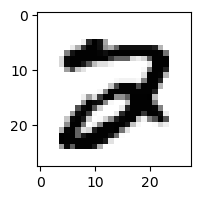

0.1673296560039252% - 0
8.852956061162107e-06% - 1
6.031521687453269% - 2
29.980370059922244% - 3 - ОШИБКА
0.001971760412876833% - 4
0.03800933784717689% - 5
0.004215566253689957% - 6
0.10911947292999705% - 7
0.14976410562820203% - 8
0.00019850600465599235% - 9

 5


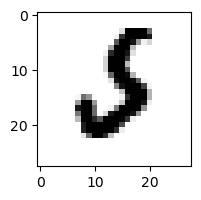

0.21461440710007842% - 0
0.13727506211159676% - 1
6.773849101582918% - 2
0.10687035154896764% - 3
0.01717326305601645% - 4
0.02986942179687026% - 5
30.13466979876162% - 6 - ОШИБКА
0.9017112044176077% - 7
0.00034691117011243454% - 8
0.034665105767380036% - 9

 2


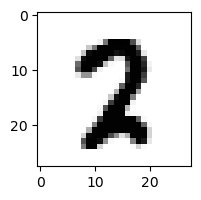

0.0018815554556167692% - 0
0.007280519181948791% - 1
4.420488303294146% - 2
0.06315234262237591% - 3
0.011942699752107181% - 4
0.19108273688764713% - 5
0.005337214477584999% - 6
7.632600411730822% - 7 - ОШИБКА
0.5553516738505271% - 8
0.002808135091989717% - 9

 3


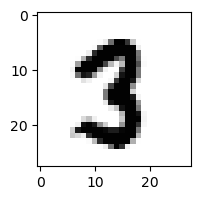

0.0022401241323605297% - 0
0.03930295418191862% - 1
0.0844105426095462% - 2
0.7735018002502929% - 3
0.0025730127195779683% - 4
4.416474548315983% - 5 - ОШИБКА
0.00034045793392667765% - 6
0.43691428335212507% - 7
3.998269848357422% - 8
0.0068619745468217475% - 9

 9


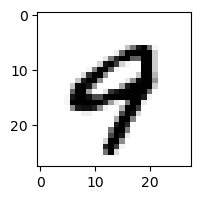

1.5514483492401903% - 0
0.0014443773510891286% - 1
0.0011565415353699837% - 2
0.0034998729865311886% - 3
83.00065738848485% - 4 - ОШИБКА
0.0087981134707584% - 5
0.3601153738368486% - 6
1.4496361581844055% - 7
0.08890664286275676% - 8
62.29489609278045% - 9

 5


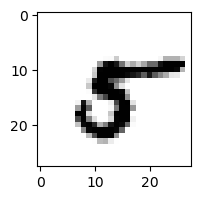

0.3097996111884784% - 0
0.332556465110568% - 1
0.017157934268084866% - 2
0.18904515634074% - 3
1.5177386833451796% - 4
9.876683676535746% - 5
0.3566959883598367% - 6
0.28393091591308744% - 7
19.13746113967791% - 8 - ОШИБКА
0.022762786384026755% - 9


Общая доля ошибок: 11.918808119188082%


In [162]:
errs = 0
for k in range(len(X_test)):
    ans = np.empty((0,10))
    for j in range(10):
        ans = np.append(ans,f(neursum(X_test[k],w[:,j],w0[j])))
    if (ans.argmax() != ansbase_test[k].argmax()):
        errs += 1
        print('\n',y_test[k])
        plt.figure(figsize=(2, 2))
        plt.imshow(X_test[k].reshape(28, 28), cmap=plt.cm.Greys)
        plt.show()
        for i in range(len(ans)):
            if i == ans.argmax():
                print(ans[i]*100,'%',' - ',i," - ОШИБКА",sep="") 
            else:
                print(ans[i]*100,'%',' - ',i,sep="") 
print("\n\nОбщая доля ошибок: ",errs/(len(X_test)+1)*100,'%',sep="")   

# Изменение критерия останова на отслеживание разницы матрицы весов

In [163]:
w = np.random.uniform(-0.0005,0.0005,(784, 10))
w0 = np.random.uniform(-0.0005,0.0005, (10,))

In [164]:
difference = 0.000005
eta = 0.05
prev = np.random.uniform(-1,1,(784, 10))
while abs(w-prev).sum() >= difference:
    prev = w.copy()
    pos = random.randint(0,len(X_train)-1)
    for j in range(len(ansbase[pos])):
        sm = neursum(X_train[pos],w[:,j],w0[j])
        res = f(sm)
        sigm = - (ansbase[pos][j] - res)*f_d(sm)
        for k in range(len(X_train[pos])):
            w[k][j]+= - eta * sigm * X_train[pos][k]
        w0[j] += eta * sigm
    clear_output() 
    print(abs(w-prev).sum())
clear_output() 
print(abs(w-prev).sum())

4.718800205785475e-06



 5


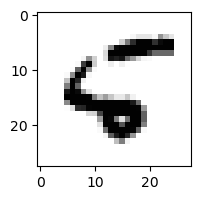

0.3996724523183497% - 0
0.04799039026446294% - 1
2.397692787057547% - 2
4.566921333774216e-05% - 3
4.767094067455759% - 4
0.8717519834496865% - 5
15.166327332834516% - 6 - ОШИБКА
0.005585912574813134% - 7
0.00694072943472362% - 8
0.20495808876035548% - 9

 4


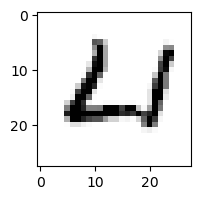

52.65947427753937% - 0
0.003097434380174688% - 1
15.870806676044621% - 2
0.00010279327634630431% - 3
20.756382103937103% - 4
0.47095249539257855% - 5
56.727197053318115% - 6 - ОШИБКА
0.11412471706717037% - 7
1.7718163522829309% - 8
0.2457567597613529% - 9

 2


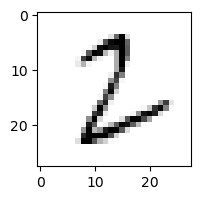

9.31096977824864% - 0
1.7314632480682486% - 1
62.230451253502814% - 2
65.35715184071739% - 3 - ОШИБКА
0.0003250497737638532% - 4
5.853244104028583% - 5
12.913904658222918% - 6
0.038196852757580675% - 7
17.100262704638588% - 8
0.06531239128309338% - 9

 5


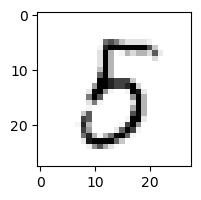

12.393512233551295% - 0
0.04871532949454567% - 1
0.22589577176076228% - 2
78.50406316024817% - 3 - ОШИБКА
2.8709099595623804% - 4
67.37040739797392% - 5
1.9130783531795699% - 6
0.026546175418182928% - 7
36.07388437641588% - 8
0.8558248647042271% - 9

 1


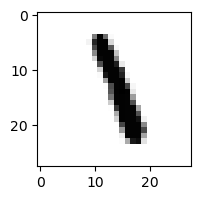

0.0006540215059052423% - 0
10.82597400086373% - 1
2.3329577884409844% - 2
24.41855005942752% - 3 - ОШИБКА
0.7901579761188271% - 4
3.5093903588428503% - 5
1.2401444257840788% - 6
0.7577980742639814% - 7
0.3934559779629418% - 8
0.35913828422776656% - 9

 3


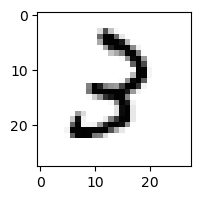

0.6604429179655424% - 0
0.21382520154287857% - 1
71.17825708681065% - 2 - ОШИБКА
48.8511896202164% - 3
0.48145961183435126% - 4
0.7753038998138778% - 5
0.40348636855732983% - 6
0.01605672941470836% - 7
1.8094586953696923% - 8
2.3182652086531164% - 9

 6


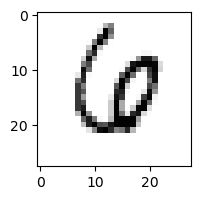

0.6662805496506264% - 0
0.17764697711765606% - 1
1.55605334663302% - 2
0.45554428589525964% - 3
2.5949602150441993% - 4
0.05866777203482709% - 5
6.059166123959912% - 6
8.518587739035274% - 7 - ОШИБКА
0.05507017680128711% - 8
0.02481576655629256% - 9

 8


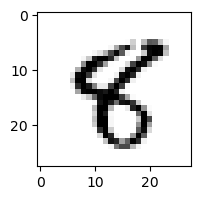

0.020838240365636845% - 0
0.20469896268750348% - 1
0.013065469373353965% - 2
0.013961094820550662% - 3
4.4042522090344445% - 4
22.713361259690615% - 5 - ОШИБКА
0.03871498628833416% - 6
0.030243060665004227% - 7
9.229266786432904% - 8
0.7056872925999448% - 9

 9


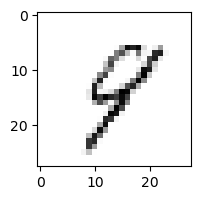

0.9640665290229169% - 0
2.7257139551667127% - 1
7.46217346125145% - 2
3.1988235006246075% - 3
51.668774386948215% - 4
9.34272626072371% - 5
3.3985744998251404% - 6
6.617569734393193% - 7
65.47444391460755% - 8 - ОШИБКА
63.84860370748496% - 9

 7


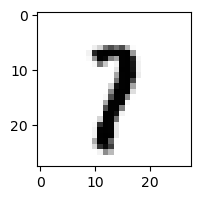

0.007163757279182686% - 0
33.9354601487458% - 1 - ОШИБКА
1.3973599202664733% - 2
3.8196044833891807% - 3
0.09789027853026071% - 4
0.26589780597193025% - 5
0.12976083367221317% - 6
15.12459359819633% - 7
1.5014166976433685% - 8
11.36520780378974% - 9

 7


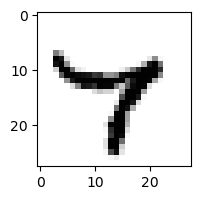

0.028119533695253128% - 0
0.03706689038675433% - 1
6.897342338992515e-05% - 2
0.33437525685393377% - 3
85.39787858117258% - 4 - ОШИБКА
0.10145396938873244% - 5
0.3985228450654194% - 6
19.78408411267626% - 7
10.177059406508505% - 8
29.344965933196534% - 9

 2


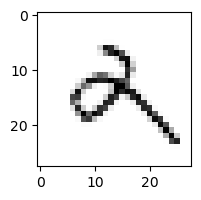

0.773075525423945% - 0
5.429603053407361% - 1
3.7317808265093575% - 2
7.097528797650438% - 3
13.883435811739146% - 4
0.36695734525463897% - 5
11.726976304153993% - 6
0.25054449995382544% - 7
7.577022138501996% - 8
79.83746605156183% - 9 - ОШИБКА

 5


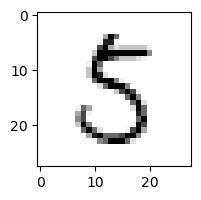

7.758066843193379% - 0
0.0564800622706684% - 1
2.2674480668829275% - 2
27.760233471619216% - 3
0.14034835418858058% - 4
54.36997677951856% - 5
0.10594815795372352% - 6
0.1909921327287394% - 7
61.76276501491061% - 8 - ОШИБКА
4.85917861644044% - 9

 5


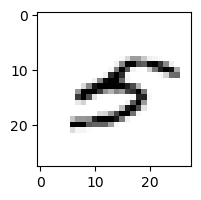

1.8528249136302188% - 0
1.319773345913466% - 1
0.3869718209202638% - 2
14.36054840844769% - 3
21.36378814539545% - 4 - ОШИБКА
11.741173386649342% - 5
2.4206056740725566% - 6
0.5234886626090012% - 7
0.1995082350358641% - 8
0.565194042414293% - 9

 7


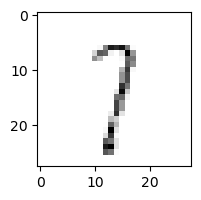

3.0727872539854344% - 0
22.86943981724204% - 1
24.461808154818343% - 2
59.368932616768774% - 3
8.749988315803202% - 4
10.23081962569647% - 5
6.024822519631529% - 6
51.33040818042426% - 7
38.0728816900638% - 8
61.11991113452934% - 9 - ОШИБКА

 9


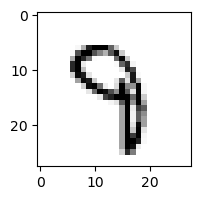

0.00540870919734402% - 0
0.12839853594707898% - 1
0.7317619149687353% - 2
20.402856486891704% - 3
42.35706734507242% - 4 - ОШИБКА
2.0645027266083744% - 5
0.8502240176355129% - 6
3.150175725791555% - 7
0.603765242211697% - 8
9.059663412368266% - 9

 3


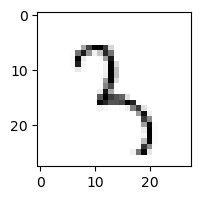

0.43642917754748417% - 0
7.0632975023370985% - 1
48.59474371530691% - 2
67.82192748782691% - 3
12.073920682614453% - 4
46.53247786857986% - 5
22.288217798921796% - 6
2.800654434148919% - 7
81.73595987033102% - 8 - ОШИБКА
32.44718247704934% - 9

 6


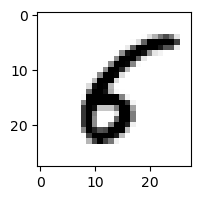

3.6857485135879573% - 0
0.3660888349339149% - 1
0.24360979937586622% - 2
0.1090528363856279% - 3
1.6477551712752736% - 4
68.0723569155312% - 5 - ОШИБКА
5.477540011366065% - 6
0.004728775660477977% - 7
1.026080308199308% - 8
0.01812651419048787% - 9

 5


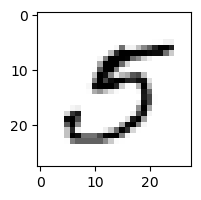

10.726733322537624% - 0
0.1202202913097108% - 1
0.03117249506777854% - 2
78.29348552243279% - 3 - ОШИБКА
0.07868748522417528% - 4
58.36659160373516% - 5
0.07426332127361197% - 6
0.4352621251195587% - 7
0.31436210498373685% - 8
2.2945448385207348% - 9

 8


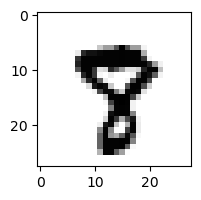

0.008922852699011555% - 0
0.0006518767259929572% - 1
0.005007815348418563% - 2
0.006302748629894019% - 3
0.020538496083863433% - 4
0.4755869745621286% - 5
0.0004276450691580781% - 6
34.236402451688505% - 7 - ОШИБКА
4.187897356417996% - 8
3.8513086096184255% - 9

 9


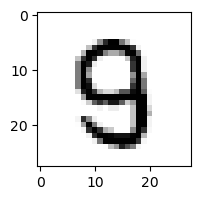

0.5568075497417743% - 0
0.0005421566319677842% - 1
0.5315701700350767% - 2
1.6300308168666213% - 3
1.1082338967524934% - 4
5.104472288406701% - 5 - ОШИБКА
0.013797684511512512% - 6
0.04390404649331801% - 7
2.395350731105723% - 8
0.10551884527505151% - 9

 7


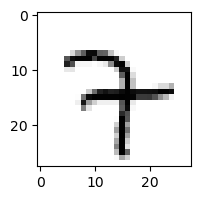

0.02615366430148036% - 0
0.819218482848542% - 1
2.96174394720132% - 2
11.287145339612541% - 3
49.91858099641437% - 4 - ОШИБКА
0.24110360954260496% - 5
6.059124030439634% - 6
36.497753801036446% - 7
0.06694115809575504% - 8
2.6518338188163355% - 9

 3


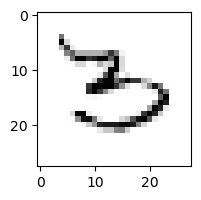

6.8559648146968994% - 0
0.22717048267221737% - 1
0.7484621709247437% - 2
55.100804961215275% - 3
0.09480023094994572% - 4
16.817005379491125% - 5
92.9667653706915% - 6 - ОШИБКА
0.5786379046928949% - 7
1.3581925571937559% - 8
0.5617398353397366% - 9

 4


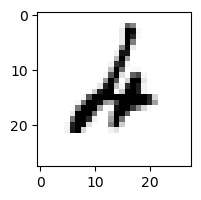

0.045593620850525235% - 0
0.17508217836916937% - 1
47.91203921959536% - 2 - ОШИБКА
0.9519011010532689% - 3
6.833110742734972% - 4
0.048466230243825785% - 5
21.411127107042674% - 6
0.048216929497471916% - 7
0.4181444429114425% - 8
4.481162926417341% - 9

 8


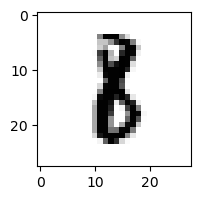

0.00769175248921357% - 0
4.411756689438361% - 1 - ОШИБКА
0.5253928832266188% - 2
1.8073811172121677% - 3
0.003085502703554069% - 4
0.8347885073910235% - 5
3.4229973838285064% - 6
0.009037733343358405% - 7
3.247965373445911% - 8
0.025693091903125284% - 9

 6


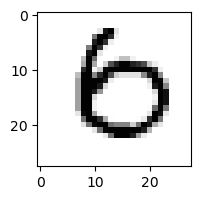

81.5548162134132% - 0 - ОШИБКА
0.001012016619202404% - 1
0.042158031303228004% - 2
0.020083087145443462% - 3
0.06404949106043419% - 4
0.17817668408605633% - 5
28.885456311166013% - 6
0.25962763585101445% - 7
0.023064493262430184% - 8
0.011188073439869523% - 9

 8


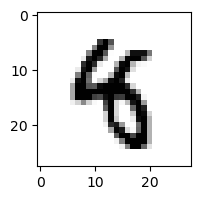

0.001062170984331569% - 0
0.3409781085716214% - 1
0.0024634779496676903% - 2
0.2360731601585827% - 3
17.084564365805775% - 4 - ОШИБКА
4.910671349622778% - 5
0.10296436203426251% - 6
0.0055307603003651494% - 7
0.0018855958519239137% - 8
0.2149574196249746% - 9

 8


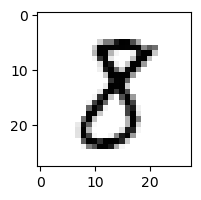

0.4069394612254518% - 0
1.2043097674025665% - 1
0.6183512319724103% - 2
55.27031322663021% - 3 - ОШИБКА
0.038634970115609554% - 4
2.110162756123925% - 5
0.0024095972752020815% - 6
0.07977960350239388% - 7
46.45504873715075% - 8
0.01567327263184202% - 9

 4


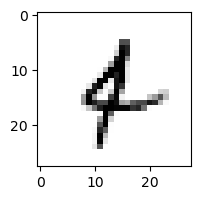

0.20268917872565817% - 0
18.196325759907687% - 1
0.17593670006840584% - 2
1.2168453712964882% - 3
4.5665072656999435% - 4
1.5006101330039883% - 5
25.90514161702086% - 6 - ОШИБКА
0.2915733696977066% - 7
0.48505674888125694% - 8
9.492594934719252% - 9

 7


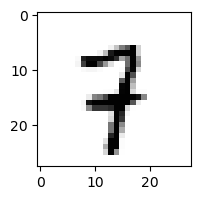

0.008266555636604745% - 0
0.5352405485886302% - 1
9.593820644089906% - 2
0.22314199967141923% - 3
4.5996966772058165% - 4
0.1534594527590808% - 5
0.40153522607632963% - 6
28.03202806065369% - 7
6.697700115329379% - 8
51.733261913734594% - 9 - ОШИБКА

 3


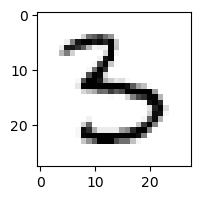

0.7775115445824035% - 0
0.021153887155684805% - 1
0.05381758743564459% - 2
23.22079419810355% - 3
7.27848334941611% - 4
41.814499849617945% - 5 - ОШИБКА
0.4515788545196916% - 6
0.020759581886068978% - 7
0.6419264128408397% - 8
0.32094610689208997% - 9

 2


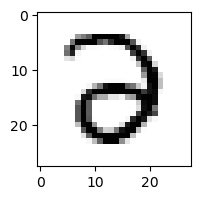

25.081956002684596% - 0
0.0015614107814188461% - 1
11.568794109087301% - 2
41.678672787250875% - 3 - ОШИБКА
0.6471039625361645% - 4
0.01627024160388697% - 5
0.3381793167391902% - 6
0.0015440630191850976% - 7
0.10755241593363417% - 8
0.0022236868660820597% - 9

 9


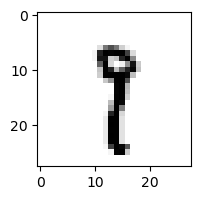

0.028729595706395085% - 0
43.90417516480045% - 1 - ОШИБКА
0.11614279567395029% - 2
6.1231164858352045% - 3
0.1721987358204905% - 4
2.8095132296494576% - 5
0.2589810124816781% - 6
38.83452383631681% - 7
1.6846280888595428% - 8
14.650672488963693% - 9

 2


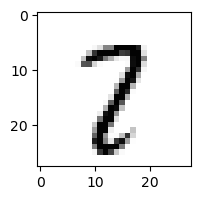

0.13906069764595444% - 0
3.828740399828577% - 1
3.1733761531444657% - 2
4.599082925941183% - 3
0.18857182837273057% - 4
1.3418339507390904% - 5
0.048561458738632476% - 6
50.02804785934156% - 7 - ОШИБКА
28.08464748873177% - 8
6.0265873222956365% - 9

 4


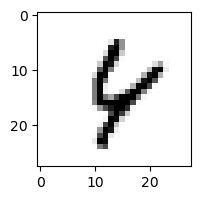

0.17862736571407933% - 0
0.10082136852704347% - 1
1.3589006714210843% - 2
0.02490765380036055% - 3
39.699530563285606% - 4
0.8861455796347787% - 5
9.191984053564257% - 6
3.0578119745323558% - 7
60.157015473127096% - 8
66.60746058189227% - 9 - ОШИБКА

 5


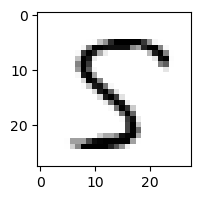

0.4992939567796972% - 0
0.05589731352230787% - 1
0.4167058234021843% - 2
3.0544893154119626% - 3
30.71334329351625% - 4
95.59410796518631% - 5
0.0930471084687048% - 6
0.15558707112675002% - 7
97.95968525744549% - 8 - ОШИБКА
0.0036260571998438266% - 9

 5


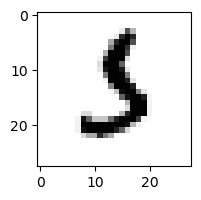

0.15118376707502362% - 0
0.5693594395101771% - 1
2.1870016922003908% - 2
42.958489824225275% - 3 - ОШИБКА
0.0006705682996931645% - 4
2.254055010757059% - 5
15.588566946923907% - 6
0.5350066579933248% - 7
0.009559856355115068% - 8
0.05916733036818685% - 9

 5


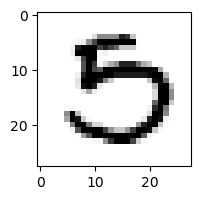

38.2919030371455% - 0 - ОШИБКА
0.0006091944927501406% - 1
0.16575756848131715% - 2
1.0790517613017299% - 3
0.0014517517611783322% - 4
0.5232502579759655% - 5
0.002063069083006135% - 6
0.42422071173859055% - 7
0.5820135090862221% - 8
3.534782005384679e-05% - 9

 9


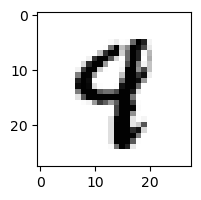

0.008571052503127265% - 0
0.01980606313786169% - 1
0.0368252467322304% - 2
0.031229186025561496% - 3
39.13742889669069% - 4 - ОШИБКА
0.4712461343073685% - 5
0.04345179994834235% - 6
0.21239535229718573% - 7
0.08551474448360766% - 8
10.625127511241296% - 9

 2


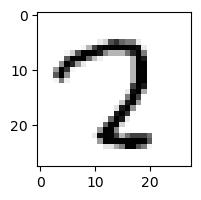

2.1600001425783946% - 0
0.01064367468206713% - 1
15.002500701027163% - 2
9.47308561690113% - 3
1.7782007376792146% - 4
0.6292758048503765% - 5
0.002798611367441424% - 6
43.98661380539405% - 7 - ОШИБКА
19.08037145708425% - 8
0.14182729738820257% - 9

 9


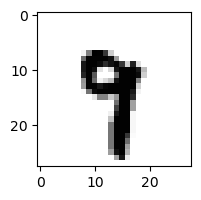

0.0002826373643231419% - 0
0.29943084820462235% - 1
0.001970823411277911% - 2
0.1810865182323606% - 3
13.134254646848293% - 4 - ОШИБКА
2.0270909882588004% - 5
0.1883504504599313% - 6
9.67272483178435% - 7
0.31697764567226655% - 8
1.5621375199157708% - 9

 8


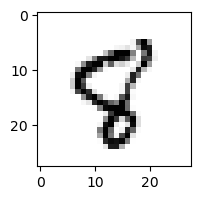

0.2854879658679406% - 0
0.08615511224331854% - 1
0.16645914644660867% - 2
0.002842988231123284% - 3
3.8340383244122824% - 4
8.559952119943533% - 5
0.6430872381696129% - 6
5.317636701492588% - 7
2.916946533373959% - 8
8.886021435057097% - 9 - ОШИБКА

 5


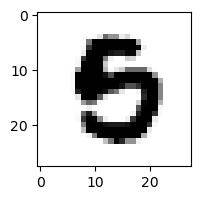

1.2319815513063486% - 0
6.458694387247998e-06% - 1
0.0006118811116056837% - 2
0.10514297857393948% - 3
0.0013748347922836416% - 4
0.6904398313296819% - 5
1.8600930596108396% - 6 - ОШИБКА
6.510908548003965e-05% - 7
0.017271684209811865% - 8
0.0055273094718426416% - 9

 9


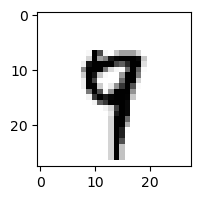

0.002760045467037399% - 0
0.4108937410121966% - 1
0.08024599491930133% - 2
0.02574583284142517% - 3
19.923532121915986% - 4 - ОШИБКА
1.7268131187000733% - 5
0.14011903518362642% - 6
15.654573758604487% - 7
0.5143004164431109% - 8
19.528117168811125% - 9

 8


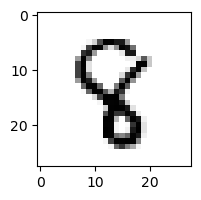

0.0027812303294400746% - 0
0.31819486943423936% - 1
0.4245948436724233% - 2
0.1719706067592292% - 3
27.022582547711416% - 4 - ОШИБКА
2.4990957814997246% - 5
0.18150045664543105% - 6
0.08628454057743815% - 7
9.835611953555528% - 8
0.07293812983214448% - 9

 5


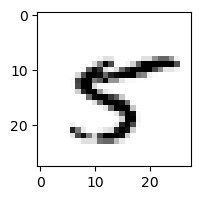

0.6947033533326321% - 0
0.08257910626319567% - 1
0.001895372490882629% - 2
0.2918879258804422% - 3
53.580311396710286% - 4 - ОШИБКА
46.73757240261776% - 5
0.10693672081444007% - 6
0.9478015959452321% - 7
19.618463239162597% - 8
0.3639993294219968% - 9

 8


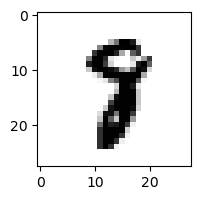

0.002866369743472729% - 0
0.08073494050472263% - 1
0.05401539407826% - 2
0.2881650411209888% - 3
0.12596859942152722% - 4
0.1730299373361458% - 5
0.02413389651024859% - 6
12.972801792792572% - 7 - ОШИБКА
2.6814760531092148% - 8
0.035099432498085795% - 9

 0


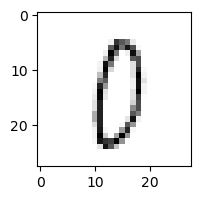

65.85943339385264% - 0
0.14221028688877208% - 1
6.182235425502636% - 2
30.952622646052415% - 3
1.7474352319516038% - 4
15.848793789450907% - 5
8.960546900096361% - 6
2.6095680424411265% - 7
88.78141856541558% - 8 - ОШИБКА
20.23049157147% - 9

 2


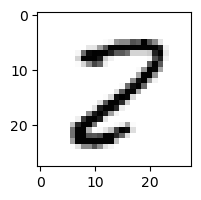

2.2648742692756114% - 0
0.04664455033620605% - 1
19.210525252084043% - 2
0.18157279073709884% - 3
0.05119291346645714% - 4
0.6161210073468694% - 5
0.022575509809542746% - 6
0.8867538236759908% - 7
99.16897181068175% - 8 - ОШИБКА
0.027527153333493252% - 9

 6


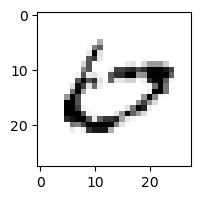

90.36080947188626% - 0 - ОШИБКА
0.03255605361095058% - 1
0.4408682200839823% - 2
0.4723503297613509% - 3
0.8343709674333217% - 4
0.03465943980718682% - 5
9.376331825283398% - 6
11.475929719688361% - 7
0.2822673114880578% - 8
0.07337991773475484% - 9

 9


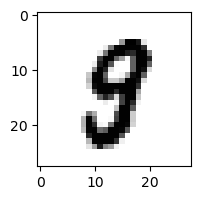

0.3727444233588568% - 0
0.00203547828184557% - 1
0.01778794381222768% - 2
1.4307172347068788% - 3
0.41425890120835107% - 4
4.239770485631953% - 5
0.009913671948834149% - 6
0.03283135059997402% - 7
18.71538305880212% - 8 - ОШИБКА
1.0751412703714527% - 9

 3


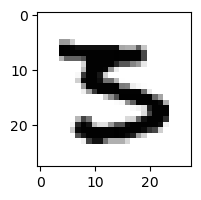

0.11974349080886076% - 0
2.585610494393352e-05% - 1
0.046536117144578636% - 2
5.143771487830831% - 3
0.0007093644476968367% - 4
69.92470493754578% - 5 - ОШИБКА
0.00677184378982176% - 6
0.008029178454441377% - 7
0.0033465498950310136% - 8
0.00265035555116676% - 9

 3


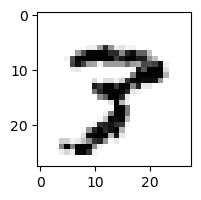

0.13121111623354767% - 0
0.03719190756590677% - 1
0.2900667751045824% - 2
3.168345925502673% - 3
0.05985723708224323% - 4
0.12649893162971027% - 5
0.010052993924073762% - 6
14.3550980670827% - 7
16.93736557137747% - 8 - ОШИБКА
3.485832327785586% - 9

 7


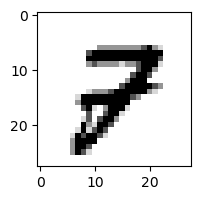

0.2308697071035484% - 0
0.02439540978333677% - 1
10.873006662095934% - 2 - ОШИБКА
0.041704716388753685% - 3
0.1795626587624276% - 4
0.0385226758655271% - 5
0.002255512066221654% - 6
2.9024480627441758% - 7
0.5293701755962941% - 8
7.538597729725768% - 9

 5


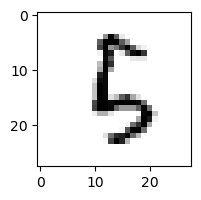

0.2596737566498993% - 0
0.09318479888672582% - 1
23.00935756247812% - 2
3.475374054819766% - 3
10.21785568134819% - 4
12.42278473096277% - 5
4.919491069779671% - 6
0.029560208281214223% - 7
49.485335443258656% - 8 - ОШИБКА
2.8099496072813013% - 9

 9


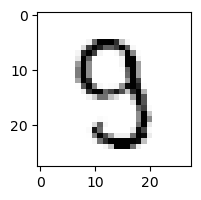

0.654462514315021% - 0
0.013755821697722072% - 1
0.7048070164360969% - 2
31.23647510486863% - 3 - ОШИБКА
4.701003973060708% - 4
8.45596938831576% - 5
0.032843301612213334% - 6
0.7353039647212154% - 7
5.994138470876628% - 8
1.2424153545786891% - 9

 5


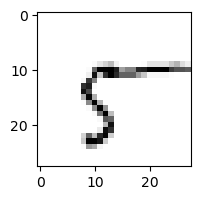

53.34601849963355% - 0 - ОШИБКА
3.438702283833981% - 1
0.23913153058955447% - 2
1.7649037926963054% - 3
12.136536587133156% - 4
17.48327545166889% - 5
10.30872771911513% - 6
31.12195645513014% - 7
51.70539377089797% - 8
15.320258438858472% - 9

 8


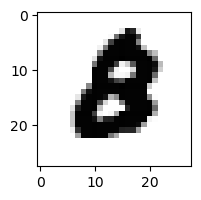

0.6936958663713891% - 0 - ОШИБКА
8.669429240748343e-07% - 1
0.25033865351489604% - 2
0.02136293101908587% - 3
0.0005097896864679145% - 4
0.012074610172177046% - 5
0.06446818913534554% - 6
7.224255973307977e-05% - 7
0.0010689959384124605% - 8
0.008351204434452163% - 9

 5


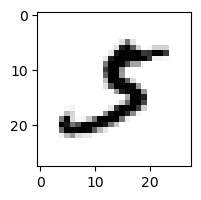

0.17622716594939622% - 0
3.565287950996882% - 1
6.7301879817676005% - 2
12.780948536516226% - 3 - ОШИБКА
0.010706977634275736% - 4
7.901781623301904% - 5
0.02958430666666073% - 6
5.916762814330611% - 7
0.007929655938698366% - 8
0.4953588930944156% - 9

 3


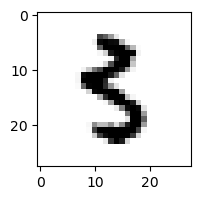

0.1919473389091848% - 0
0.03962169222842074% - 1
0.01411245137139989% - 2
5.873488666683372% - 3
0.10725790837735133% - 4
46.175731011338165% - 5 - ОШИБКА
1.604549521708524% - 6
0.007537408336695613% - 7
0.4987733100920929% - 8
0.40758048229477867% - 9

 4


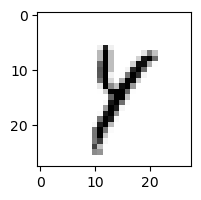

0.07101346042002375% - 0
27.9652646290415% - 1
0.593561122372133% - 2
2.8941726772419787% - 3
22.384866751098993% - 4
7.264933190721652% - 5
1.6116954340489371% - 6
20.305227445959506% - 7
78.93469278697395% - 8 - ОШИБКА
5.149383357356436% - 9

 3


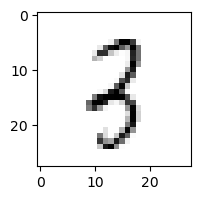

0.8295584685866324% - 0
3.606807587610874% - 1
25.71297418716052% - 2
60.65319759008818% - 3
11.95939711658352% - 4
1.7748290971322287% - 5
0.7773668009967304% - 6
0.3600565111793094% - 7
65.4645916554256% - 8 - ОШИБКА
7.434943365647699% - 9

 2


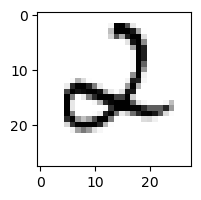

0.5643506621555557% - 0
0.1325885516968769% - 1
23.77004697233546% - 2
0.176789086244694% - 3
27.066833603558166% - 4 - ОШИБКА
0.6011012137815284% - 5
14.828425253828447% - 6
0.022400528441980705% - 7
0.012666653887727652% - 8
0.07690413827701914% - 9

 1


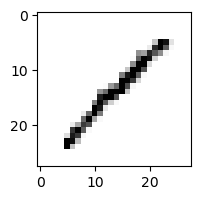

2.359096332924292% - 0
49.29715035785576% - 1
35.35781988758247% - 2
49.36908523679623% - 3
26.49255629643284% - 4
3.5783992874670663% - 5
0.6331479039348563% - 6
1.7094651247518078% - 7
89.74068583436743% - 8 - ОШИБКА
12.074411204691325% - 9

 9


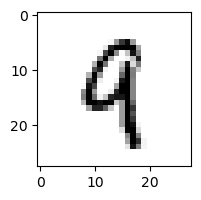

0.03959840783932903% - 0
0.5786914610307757% - 1
3.128665035491495% - 2
0.8950069362544101% - 3
48.45638176902591% - 4 - ОШИБКА
0.35468966323370227% - 5
0.6626869542385073% - 6
0.15502735387742309% - 7
1.2178168401293992% - 8
39.17943378111333% - 9

 3


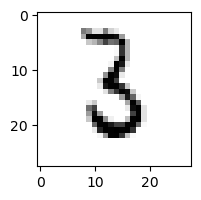

0.5397803814006313% - 0
2.428186452114832% - 1
6.509575947214% - 2
51.86044792369239% - 3
0.013092926205717812% - 4
0.8201149334762533% - 5
84.01230166199952% - 6 - ОШИБКА
0.07958935631398148% - 7
2.583646822563573% - 8
0.05410766017910987% - 9

 8


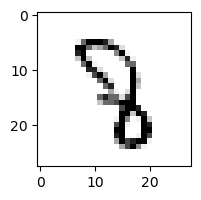

0.020872775253723% - 0
0.06423605673310082% - 1
22.83816677687168% - 2 - ОШИБКА
12.372701445036045% - 3
17.90076561805176% - 4
3.228486251360457% - 5
0.9138979280081725% - 6
1.0293503640896293% - 7
16.738314334351802% - 8
1.208332796605884% - 9

 2


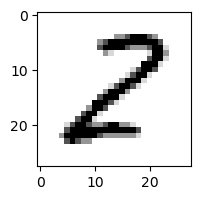

1.5826584807224944% - 0
1.1299673485413526% - 1
66.8842545382414% - 2
4.547514772174152% - 3
0.06147988362341342% - 4
1.438621602795555% - 5
0.42056850075535573% - 6
0.0017248336784494167% - 7
78.36989173922963% - 8 - ОШИБКА
0.0013951161124065592% - 9

 7


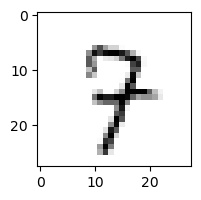

0.1428602386673761% - 0
0.31374956713331315% - 1
7.603932988551702% - 2
6.98918284391077% - 3
15.938668646562363% - 4
1.7596176698435482% - 5
1.3818864147713135% - 6
35.04151013652706% - 7
7.856906949980893% - 8
51.43164264121267% - 9 - ОШИБКА

 7


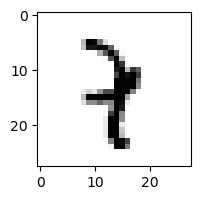

0.0010200514029653674% - 0
43.591786675825226% - 1 - ОШИБКА
2.3306254831371844% - 2
8.526114478131268% - 3
8.60911600465206% - 4
0.10305136956880945% - 5
0.6718117593312694% - 6
0.9320682987333737% - 7
0.3220233482650902% - 8
4.925465208910777% - 9

 4


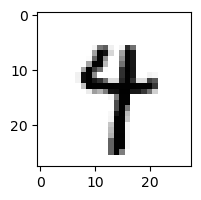

0.005690661567422035% - 0
0.2614244561703191% - 1
0.0037042887697922265% - 2
0.260801316443028% - 3
28.95221610952681% - 4
1.3595356063544703% - 5
0.4133282352694507% - 6
6.095859534534102% - 7
1.0374098999306773% - 8
51.994112226514666% - 9 - ОШИБКА

 3


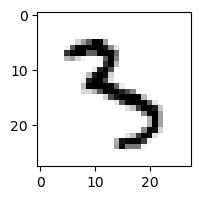

0.02795971367670021% - 0
0.029622949368918454% - 1
1.0351219690887952% - 2
35.25465436313968% - 3
43.89409440946317% - 4 - ОШИБКА
37.73429562640624% - 5
0.9268160531757257% - 6
0.3142267818851807% - 7
2.2619952561073333% - 8
3.0992134332791736% - 9

 3


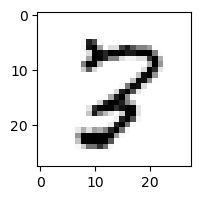

0.34952759092341984% - 0
0.013510324855924724% - 1
6.012252915582649% - 2
0.6525684748544378% - 3
0.19598060197851241% - 4
0.22628395071382076% - 5
0.06558648984509413% - 6
8.974697650362822% - 7
88.93658639487039% - 8 - ОШИБКА
4.586348274478911% - 9

 8


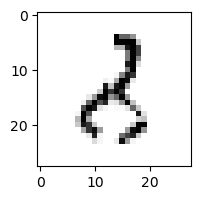

1.2766352821206641% - 0
6.411031305209075% - 1
77.70173930217209% - 2 - ОШИБКА
29.841316316796174% - 3
3.975140316847791% - 4
1.9353943862162615% - 5
0.9829535964662739% - 6
0.01440430928865887% - 7
39.854398016248325% - 8
1.0161936218386007% - 9

 8


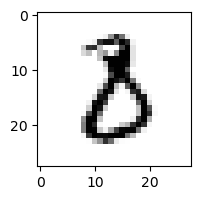

0.5756513267228877% - 0
0.2623606109451026% - 1
9.082491264278266% - 2
54.03928471898417% - 3 - ОШИБКА
0.0005473859768695721% - 4
0.557649761598817% - 5
0.8814561377738528% - 6
0.015224128409648728% - 7
1.0353747443321135% - 8
0.0752427267346844% - 9

 9


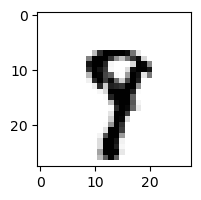

0.00483164216915543% - 0
0.03056016483513615% - 1
0.004157230198628943% - 2
0.21317151921490277% - 3
1.827066181592562% - 4
1.1760633834279146% - 5
0.027528989501899546% - 6
23.668919535100205% - 7 - ОШИБКА
22.15707505758136% - 8
22.804410531365633% - 9

 7


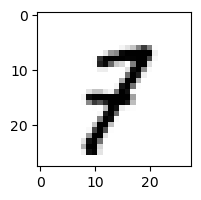

0.135329418780732% - 0
5.095995232871664% - 1
6.994236534299965% - 2
1.5853783998105035% - 3
1.9877823996835922% - 4
0.5582157247001235% - 5
0.07862205809715132% - 6
15.846393652666176% - 7
1.6022686875036565% - 8
29.379451952516998% - 9 - ОШИБКА

 8


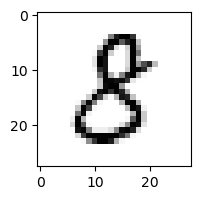

3.26714702882775% - 0
0.028276246283982644% - 1
1.9859955839368726% - 2
43.19453440173242% - 3 - ОШИБКА
0.42851643449516297% - 4
4.691946340244649% - 5
0.022350880840859663% - 6
0.008288293930180407% - 7
13.304734069592389% - 8
0.01595634383239139% - 9

 4


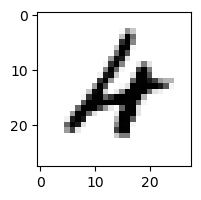

0.6446467959374763% - 0
0.0024928237177377433% - 1
10.90406943236624% - 2
0.17079978835392737% - 3
5.868955164901888% - 4
0.0030647803212961473% - 5
25.77576627823096% - 6 - ОШИБКА
0.04098361133959181% - 7
1.2397137792120723% - 8
23.316369711485375% - 9

 2


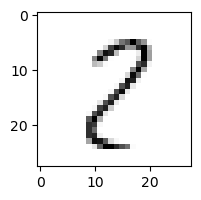

11.263980074543705% - 0
8.283026403391993% - 1
31.039147397093696% - 2
17.337023986030736% - 3
1.062850773653876% - 4
2.84313439249579% - 5
0.49718836118278453% - 6
8.324988366615791% - 7
98.86783052641712% - 8 - ОШИБКА
3.98391362450831% - 9

 1


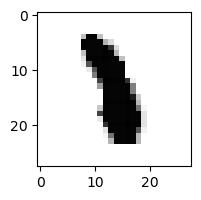

1.502481810327359e-06% - 0
0.5143856927152011% - 1
0.06320490474617205% - 2
0.04876178996381784% - 3
0.1528803548888196% - 4
0.8224882592926838% - 5
1.0854169166088552% - 6 - ОШИБКА
0.13034999985433582% - 7
0.2005751286803561% - 8
0.0026016091658028644% - 9

 2


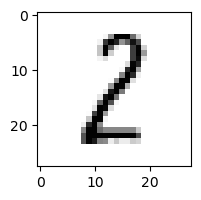

1.995403537307607% - 0
42.25201827824566% - 1
21.44804796047493% - 2
11.314722564672266% - 3
0.16366160804534158% - 4
2.083525589003662% - 5
0.1538352536302307% - 6
0.0658208152035026% - 7
54.70456728142461% - 8 - ОШИБКА
0.02861873527000737% - 9

 9


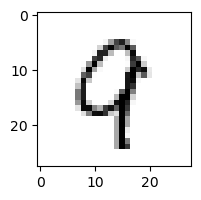

0.8083399717345621% - 0
0.5250199498916982% - 1
12.099703642669294% - 2
0.04312464812755406% - 3
55.174802488205266% - 4 - ОШИБКА
0.02308300652074332% - 5
1.2968304907250432% - 6
12.769225798216052% - 7
33.958610518104166% - 8
17.513347386620268% - 9

 3


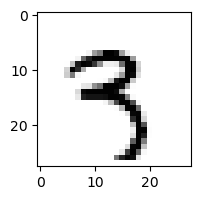

0.007936390185202832% - 0
0.7740131568252361% - 1
1.6881525954539436% - 2
20.961310703473632% - 3
5.173448746708523% - 4
5.07468813747934% - 5
0.2342711064902709% - 6
0.44957813693071186% - 7
0.3833395648069475% - 8
48.33560949941811% - 9 - ОШИБКА

 2


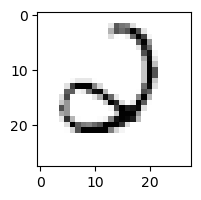

9.448222997785646% - 0
0.1750695976878921% - 1
3.0244201095971235% - 2
2.247988238777426% - 3
24.658710604665703% - 4
12.627071908731056% - 5
58.99833301866402% - 6 - ОШИБКА
1.1546440626457302% - 7
0.08604594213165644% - 8
0.3612853889284855% - 9

 5


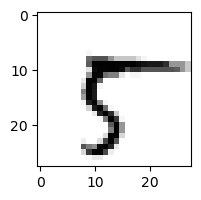

14.643610227234374% - 0
0.05099416597698454% - 1
0.011718772035701382% - 2
0.02003984917089625% - 3
1.0266366236735844% - 4
24.47530077569519% - 5
0.39723626048453414% - 6
65.88112460879586% - 7 - ОШИБКА
5.093295076559003% - 8
1.9270933090366267% - 9

 2


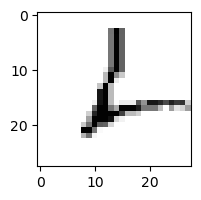

1.4612681549459763% - 0
8.521623316824362% - 1
69.14089567116413% - 2
1.5527054618539708% - 3
0.03213955245411716% - 4
2.4180223921186244% - 5
69.76673263745981% - 6 - ОШИБКА
0.44118750204465923% - 7
15.030402174236702% - 8
2.2641768366454524% - 9

 7


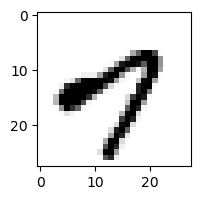

58.426285703972525% - 0
0.0027844441792300176% - 1
4.34323006153807e-05% - 2
3.8135240000679542% - 3
68.46000237469708% - 4 - ОШИБКА
0.6123799414176285% - 5
0.02519244280944438% - 6
7.769105095436922% - 7
0.0016780449322191424% - 8
2.589189928528113% - 9

 2


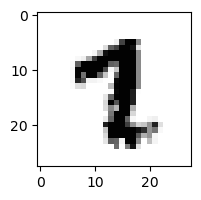

0.00019205778872691975% - 0
0.23526283492191% - 1
0.03292968791391227% - 2
0.007740450810061476% - 3
0.0306030345204674% - 4
0.321183195656486% - 5
0.003425602930285686% - 6
1.8813667336380575% - 7 - ОШИБКА
0.028970918290653375% - 8
0.911363190530756% - 9

 0


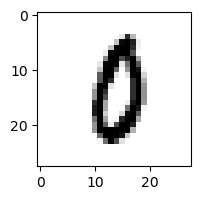

8.57345012792314% - 0
0.002673557757787276% - 1
0.6749698502602314% - 2
6.269114117299054% - 3
0.023677011467676076% - 4
0.8602312770403526% - 5
13.769736158508996% - 6 - ОШИБКА
0.2380236649874496% - 7
3.6787070104927064% - 8
2.1302962417870233% - 9

 7


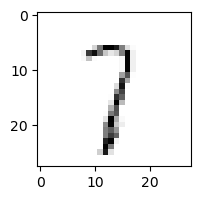

1.7286931491681732% - 0
28.327037298689344% - 1
18.235639750282726% - 2
37.23942768230048% - 3 - ОШИБКА
3.5438661581728503% - 4
10.401520696393453% - 5
6.166576061931672% - 6
31.515267731656017% - 7
26.424588794708452% - 8
33.02696474165575% - 9

 5


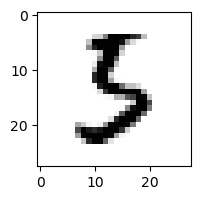

0.21696998952930205% - 0
0.009468699230254365% - 1
0.5197321970471488% - 2
30.09106804476379% - 3 - ОШИБКА
0.04031997739345179% - 4
28.774762298047126% - 5
5.204259497301456% - 6
0.03308569394421963% - 7
0.23760695919940894% - 8
0.018555016611454315% - 9

 7


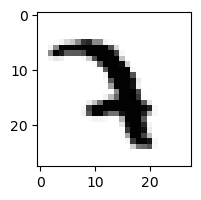

8.628622746419403e-06% - 0
0.3376223670658599% - 1
6.384139748494939% - 2 - ОШИБКА
1.339498719395318% - 3
0.6264424318696753% - 4
0.0026028371481376456% - 5
0.25916586877111536% - 6
1.6755381885059293% - 7
0.01909202802183308% - 8
0.11571779812993496% - 9

 8


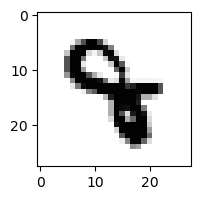

1.9465710209420524e-05% - 0
0.022297509946885313% - 1
0.008021106473974682% - 2
0.3154336828242625% - 3
48.090539404421015% - 4 - ОШИБКА
0.20613620936256158% - 5
1.4131103833097594% - 6
0.042396789221328716% - 7
0.0006094827179203655% - 8
0.1351002342363211% - 9

 4


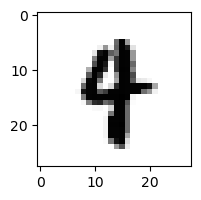

0.001104006098782234% - 0
0.2820530787718252% - 1
0.013814768315596778% - 2
0.021404730250605332% - 3
6.760563669825824% - 4
0.5501524226963441% - 5
0.24753837470016618% - 6
0.09707198217850235% - 7
0.008273892271177048% - 8
17.562758936097154% - 9 - ОШИБКА

 0


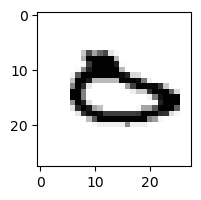

4.855615067510616% - 0
0.024839034889847632% - 1
0.022216936576297606% - 2
0.0002559159995163046% - 3
0.20756356179855284% - 4
0.054988512821666315% - 5
87.27826958080487% - 6 - ОШИБКА
5.636860227930864% - 7
0.041611273491405136% - 8
2.8319914710199514% - 9

 5


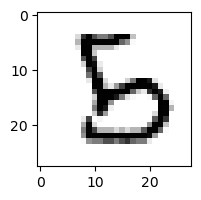

0.051130419330584355% - 0
0.01015873524031101% - 1
25.099375694997395% - 2
0.15455852353420046% - 3
1.4045673684700861% - 4
1.908529419693827% - 5
1.1721951743308325% - 6
0.001386226607280867% - 7
63.37665709061445% - 8 - ОШИБКА
0.023259824086208393% - 9

 2


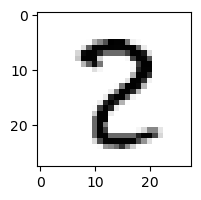

0.3755673623231653% - 0
0.07673562036880184% - 1
22.581684968301087% - 2
0.8045000518147769% - 3
0.07898186284032287% - 4
0.10592216466508465% - 5
0.002434370342292343% - 6
2.2492519434215574% - 7
98.95314124897027% - 8 - ОШИБКА
0.36549388719900766% - 9

 2


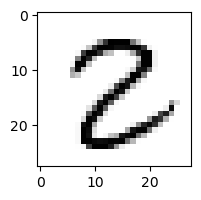

0.7196193597192966% - 0
0.15896410770265387% - 1
40.95910344059362% - 2
9.222466016014799% - 3
0.016240824379878796% - 4
1.0588164301571417% - 5
0.0014885905895956758% - 6
0.0757189721311503% - 7
98.28270757597362% - 8 - ОШИБКА
0.011777848172017612% - 9

 4


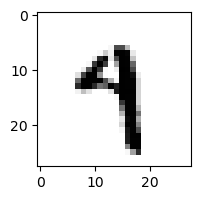

0.011060124008221857% - 0
0.1926509210696098% - 1
0.008665516189548705% - 2
3.130525008763464% - 3
16.415183230287116% - 4
2.1182692681429347% - 5
0.3303933566740359% - 6
2.4542392138758364% - 7
0.20572576466154233% - 8
83.39081347764422% - 9 - ОШИБКА

 2


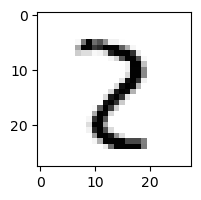

0.22079286172375984% - 0
2.950499185999275% - 1
10.143183357404052% - 2
5.9275941253520585% - 3
0.16541482491101775% - 4
0.0463420615430786% - 5
0.08290203361142262% - 6
2.2708491445154486% - 7
90.28023701454704% - 8 - ОШИБКА
8.243561692036968% - 9

 4


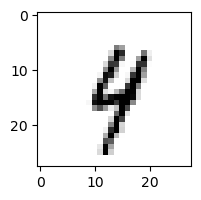

0.05204445808304664% - 0
0.4575389268718235% - 1
0.939888363163843% - 2
3.6005604766324133% - 3
23.463754019471185% - 4
0.6641652456909988% - 5
4.543768342284174% - 6
5.217875645883968% - 7
31.668751875128482% - 8
53.78359892440272% - 9 - ОШИБКА

 5


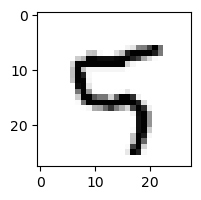

0.3744338307396627% - 0
0.09208223302947935% - 1
3.892748287245044% - 2
0.026595451816999637% - 3
6.832509192459776% - 4
17.744175885148607% - 5
0.48828455734114357% - 6
3.936381636387862% - 7
0.21733744239176753% - 8
26.151048296411034% - 9 - ОШИБКА

 3


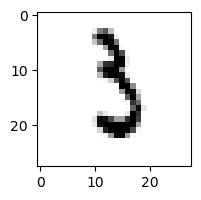

0.2046764392818891% - 0
2.9295036874536757% - 1
3.1215229626903036% - 2
41.48459619262598% - 3
0.011440873555831541% - 4
1.6190487741831108% - 5
46.35575577047735% - 6 - ОШИБКА
5.314840503887259% - 7
0.051397140791612686% - 8
0.5385435033691377% - 9

 5


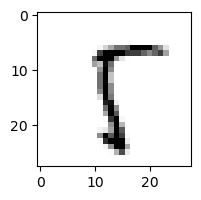

3.1196679816566406% - 0
1.9442660570477106% - 1
1.0911321353196861% - 2
2.043875136686804% - 3
1.2986494347149709% - 4
84.21804356710487% - 5
1.5159330455446551% - 6
2.365644804358229% - 7
93.99513179937951% - 8 - ОШИБКА
21.23959877952954% - 9

 8


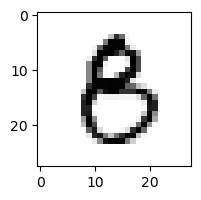

3.5041665506185837% - 0
0.009734894502095047% - 1
0.1188219390762776% - 2
10.68520744512679% - 3 - ОШИБКА
0.4017280017140158% - 4
6.965952330025638% - 5
0.03676371503628134% - 6
0.0020262469450924897% - 7
1.1340521527474166% - 8
1.389720678478063% - 9

 4


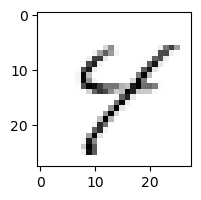

1.4978661421812558% - 0
0.9473861807386861% - 1
0.9268835060601907% - 2
0.83485112789258% - 3
70.53290735234728% - 4
40.03631464583799% - 5
11.313482046041747% - 6
12.826523896094288% - 7
79.73578759475541% - 8 - ОШИБКА
50.983757564332855% - 9

 8


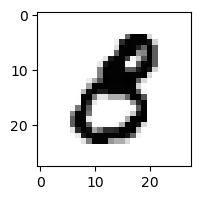

1.2642817649637887% - 0
0.004384436486585264% - 1
0.0038290098451513707% - 2
31.4477338399145% - 3 - ОШИБКА
0.020536252137288144% - 4
0.465125504143493% - 5
0.0020963030416162394% - 6
0.0012407061802869853% - 7
0.006382458708055132% - 8
0.003537999737157488% - 9

 8


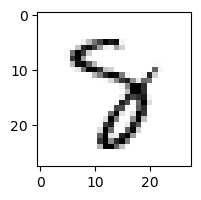

0.05724458627616042% - 0
0.07134401486438452% - 1
0.5470138742531238% - 2
3.691512119663285% - 3
6.456082979686056% - 4
2.803245421465531% - 5
1.1305754782590505% - 6
41.56355765665639% - 7 - ОШИБКА
8.515708448538934% - 8
0.027387568744381013% - 9

 7


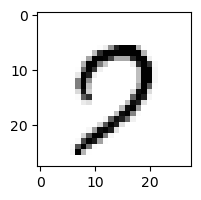

68.39579894854062% - 0
0.0034786840092338044% - 1
0.7115900323434422% - 2
1.049901724691044% - 3
0.2697318193085873% - 4
11.227159638669072% - 5
0.17605722687949568% - 6
61.016642107650796% - 7
0.6871344441913118% - 8
87.65288253207734% - 9 - ОШИБКА

 5


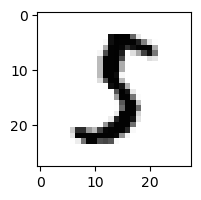

0.3953598011001348% - 0
0.9957078342032681% - 1
0.38224152216988744% - 2
28.114192131265337% - 3 - ОШИБКА
0.004018414877892663% - 4
14.1790780641601% - 5
0.20569221914306188% - 6
0.13702403250484899% - 7
0.31066796850976175% - 8
0.010785599782780235% - 9

 5


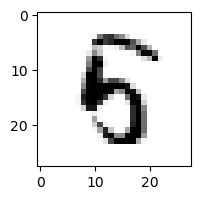

0.6905601605257469% - 0
0.0025662122056071884% - 1
0.2164952170204724% - 2
0.7423863224673606% - 3
61.57094650214119% - 4 - ОШИБКА
42.98643638942292% - 5
2.006003957858747% - 6
0.0005693053967080526% - 7
11.108178052362817% - 8
0.07827236583120174% - 9

 8


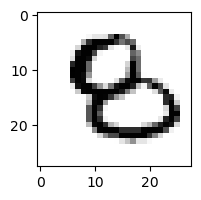

0.1979919714738216% - 0
0.008639053545754416% - 1
17.994936287489836% - 2 - ОШИБКА
0.020759662320703334% - 3
0.6242031710545338% - 4
0.1734453776472684% - 5
3.868223388520016% - 6
0.0015984249206996068% - 7
3.036872184964246% - 8
0.04892023670953309% - 9

 4


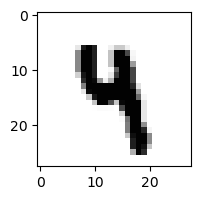

6.481040545898759e-05% - 0
0.03337579508843629% - 1
0.022663568858106043% - 2
3.0850177338824936% - 3
13.906849516212219% - 4
2.076512630334475% - 5
0.14031805499370997% - 6
0.053762756311629516% - 7
0.05275943008059539% - 8
18.921986593929883% - 9 - ОШИБКА

 7


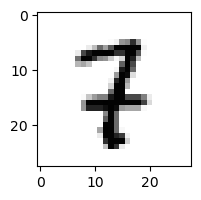

0.007373608718597358% - 0
2.0448427797308115% - 1
2.7734825866487305% - 2 - ОШИБКА
0.4035983893819582% - 3
0.6786470580218759% - 4
0.1274521541010519% - 5
0.06513757714876285% - 6
1.1999135038427595% - 7
1.0018881009782337% - 8
0.7998989975981788% - 9

 1


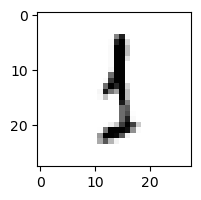

0.5581084069531602% - 0
43.87943795007978% - 1
2.6205525188389323% - 2
87.06212633379948% - 3 - ОШИБКА
0.21276570636808% - 4
4.501954583717149% - 5
6.646909626831085% - 6
0.48594682323118377% - 7
11.364888860419068% - 8
9.321261427693212% - 9

 2


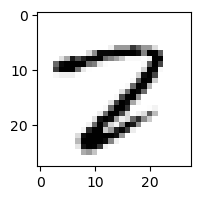

0.6974896754537718% - 0
0.007126057935909727% - 1
2.6507175055851584% - 2
0.3946118261361559% - 3
0.04697053573580461% - 4
1.1135733297261752% - 5
0.0366864370652629% - 6
54.459412297992316% - 7 - ОШИБКА
10.567309115379787% - 8
0.12831717579016452% - 9

 7


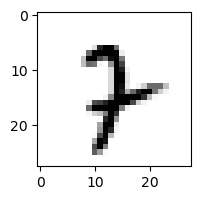

0.00347452017275513% - 0
14.755799622350448% - 1 - ОШИБКА
0.6541272749860648% - 2
0.134604834394467% - 3
0.4381522578163141% - 4
0.154937942467097% - 5
3.0674484739372834% - 6
13.119568864558278% - 7
1.2199640127454734% - 8
4.653780306158337% - 9

 8


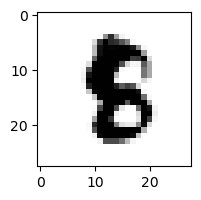

0.002346137749314637% - 0
0.002730587567772343% - 1
0.007872025336500551% - 2
0.012155104956244115% - 3
0.0067578694384373104% - 4
3.0478402106192197% - 5 - ОШИБКА
0.2022591180280466% - 6
0.0018685011533657878% - 7
0.47500906767843876% - 8
0.07862190825017502% - 9

 3


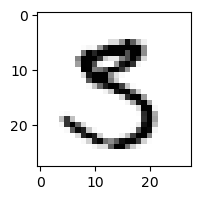

0.7710142770315138% - 0
0.010070441139734574% - 1
0.14022531465044175% - 2
27.752367345342794% - 3
0.008580406301258196% - 4
76.79574231887024% - 5 - ОШИБКА
0.0008842666133847237% - 6
0.4092028620420361% - 7
6.141891817156611% - 8
0.28600762150356285% - 9

 2


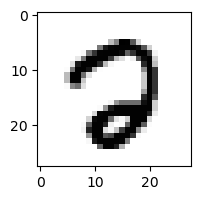

4.47688118131586% - 0
0.00038715450588303014% - 1
0.2403381400292031% - 2
0.008294342379821592% - 3
0.001381140041035889% - 4
1.8734944035416683% - 5
0.0363175479982132% - 6
5.049511371056416% - 7 - ОШИБКА
4.225293775870029% - 8
0.005896563207447451% - 9

 3


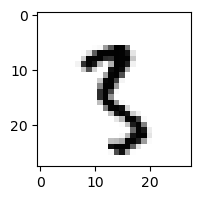

0.022251139467464796% - 0
2.1460003772867218% - 1
2.483298502745287% - 2
11.18162418368597% - 3
0.01842795091065266% - 4
28.722082174278% - 5
0.2065414518233521% - 6
1.0623758366925247% - 7
35.365692920510945% - 8 - ОШИБКА
14.70873122222156% - 9

 8


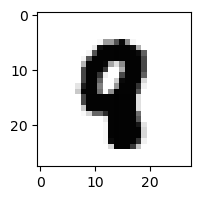

0.00020183469360927664% - 0
0.0005826253120977592% - 1
0.010285859686466236% - 2
7.847578959773794e-05% - 3
1.396688575852208% - 4 - ОШИБКА
0.007335792397564922% - 5
0.002677218240670335% - 6
0.01255684778656582% - 7
0.012831535425530591% - 8
1.0280904617301498% - 9

 7


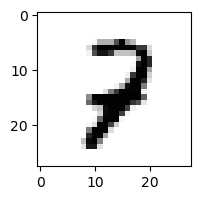

0.033798380243143175% - 0
0.3358237232695378% - 1
36.95546121018929% - 2 - ОШИБКА
0.5487589399411685% - 3
6.154217435394537% - 4
0.05089607376626303% - 5
0.0860276601667141% - 6
1.0687787160093694% - 7
8.141042512167141% - 8
2.8288447190536483% - 9

 1


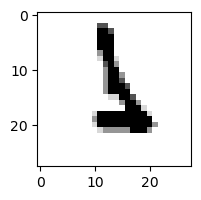

0.001857759154485344% - 0
2.952811258764339% - 1
15.468304288335109% - 2
9.313711276160694% - 3
0.01642299183559438% - 4
1.6402671566513223% - 5
63.237076497518466% - 6 - ОШИБКА
0.06911522341989858% - 7
0.06393717024635279% - 8
0.047453369782818715% - 9

 4


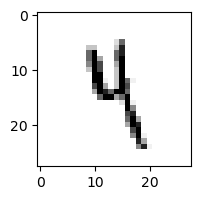

0.09342895525756806% - 0
1.6871178065361832% - 1
3.754445164431604% - 2
23.81603525105333% - 3
24.146339267116726% - 4
31.340835368973906% - 5
6.73969196252173% - 6
0.7406419715864402% - 7
40.81311800138122% - 8
52.610286544536166% - 9 - ОШИБКА

 7


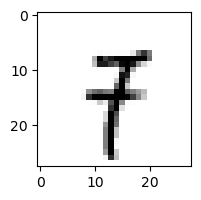

0.02917778801229611% - 0
23.38367134205918% - 1 - ОШИБКА
1.3993993511761984% - 2
2.104480817679736% - 3
5.689428885772236% - 4
2.143100272271715% - 5
0.19312449323977465% - 6
21.0785806386641% - 7
0.13100506051604877% - 8
6.236585246517929% - 9

 6


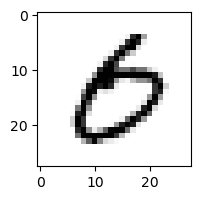

83.41765361249357% - 0 - ОШИБКА
0.006802910395201762% - 1
0.01959568145905133% - 2
16.649394021987597% - 3
0.03339150743380203% - 4
0.2659559568642128% - 5
12.129413710215022% - 6
0.03362089519859543% - 7
0.10612320508760413% - 8
0.33166829933250774% - 9

 2


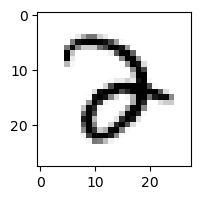

5.318303455553557% - 0
0.004412305096104754% - 1
33.076479205956176% - 2
52.693624105051015% - 3 - ОШИБКА
0.10898323902951623% - 4
0.009653547678819974% - 5
3.507529932406852% - 6
0.03251615494426501% - 7
0.5351248572249179% - 8
2.4322921020131285% - 9

 3


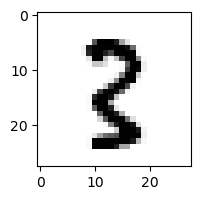

0.010576505342548682% - 0
0.7184376581714416% - 1
5.2797963619720925% - 2
6.494271138937364% - 3
0.027316719350098287% - 4
0.14184559909010727% - 5
0.009411595750793363% - 6
0.03627641831388998% - 7
17.850683609079887% - 8 - ОШИБКА
0.6600562487750495% - 9

 9


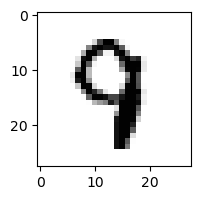

0.011387280481404775% - 0
0.006983103266810951% - 1
0.6159671775311735% - 2
2.166944854076344% - 3
16.747221223912426% - 4 - ОШИБКА
0.3204590190602828% - 5
0.12030718729507815% - 6
3.480520280171208% - 7
0.027180156292766742% - 8
1.5109593993579342% - 9

 1


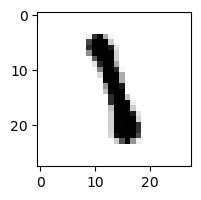

0.0009232418102475251% - 0
10.051332180345392% - 1
1.2503819427742986% - 2
4.394541798125104% - 3
0.5303931501643261% - 4
11.935847164813067% - 5 - ОШИБКА
2.4301352656601405% - 6
0.31354916393441956% - 7
1.6055245385360055% - 8
0.05193971692249191% - 9

 8


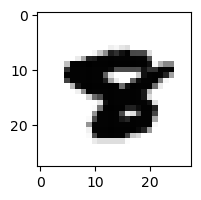

0.000402966412445158% - 0
1.5038364947206104e-05% - 1
1.0768078173338463e-05% - 2
4.683135689087724e-06% - 3
0.00659104900946889% - 4
0.025609401948038575% - 5
0.04462054458280476% - 6
0.027498200265918645% - 7
0.0017080200461858288% - 8
0.05203908525398692% - 9 - ОШИБКА

 9


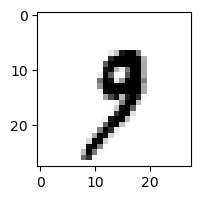

0.018288406615437045% - 0
1.0418933870647973% - 1
0.05894477424747648% - 2
33.18421101685171% - 3 - ОШИБКА
1.6147184983399219% - 4
0.3523921391531393% - 5
0.09405071093609821% - 6
21.84846200352874% - 7
0.23317312208652835% - 8
32.48092667607286% - 9

 7


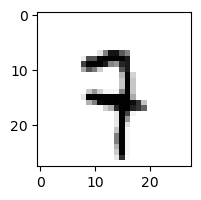

0.010505380473286053% - 0
0.9473591995017266% - 1
12.190240335839492% - 2
0.7569976836444529% - 3
13.412172174274748% - 4
1.757114490726279% - 5
2.189397170741645% - 6
33.8054567296992% - 7
1.8079739376295363% - 8
43.60649164909577% - 9 - ОШИБКА

 6


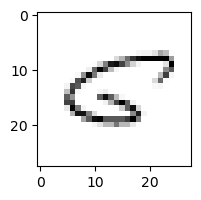

36.244694931933786% - 0 - ОШИБКА
1.2300912276439933% - 1
8.839207108223924% - 2
0.10709348466929444% - 3
8.281080353418366% - 4
22.449608621152336% - 5
12.657033705818263% - 6
8.970420712432947% - 7
21.141634455124915% - 8
3.382771333467585% - 9

 4


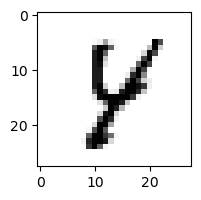

0.0764072450327067% - 0
0.19031862610583583% - 1
0.42754532382473137% - 2
0.22785712548441545% - 3
66.8428290444317% - 4
9.487686341603641% - 5
0.3765471299273951% - 6
5.38305881065431% - 7
73.39875992204281% - 8 - ОШИБКА
1.306134947152195% - 9

 5


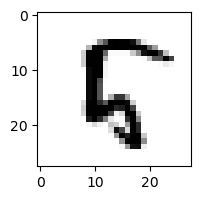

0.19390947763901029% - 0
0.004179985632480791% - 1
19.507871102041587% - 2
0.00020883398710614317% - 3
25.000536829702035% - 4
20.891516153099502% - 5
3.066804679939652% - 6
0.009091569520070198% - 7
82.12061582045519% - 8 - ОШИБКА
0.009605160679357058% - 9

 8


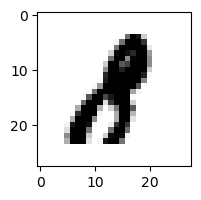

0.06790194666632811% - 0
0.2051499250397994% - 1
0.5339460330185697% - 2
3.5132452945679926% - 3 - ОШИБКА
0.007937772589954437% - 4
0.0066988365782931795% - 5
0.002334335709504859% - 6
0.0018012910800695595% - 7
0.20957573486116501% - 8
0.04650178358992048% - 9

 7


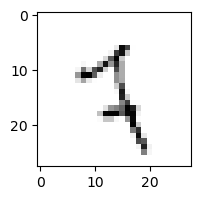

0.4481919965711233% - 0
13.96560080311618% - 1
10.531652568515797% - 2
0.5022470262131401% - 3
4.2762469969456225% - 4
14.57527452518646% - 5
11.472675621824182% - 6
18.16946040436497% - 7
15.559984466988402% - 8
86.14331734221548% - 9 - ОШИБКА

 6


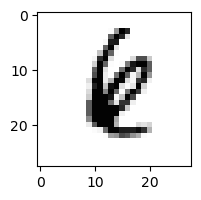

0.017654168808179223% - 0
0.43676046863139684% - 1
0.9091876921187739% - 2
0.0032974265621422243% - 3
3.253449691970417% - 4 - ОШИБКА
0.08262603331502998% - 5
2.752757332851623% - 6
0.022633601118885443% - 7
3.243044877552749% - 8
0.6280176349340741% - 9

 5


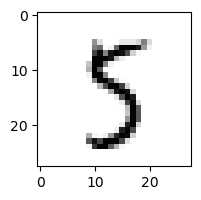

0.9848379167584848% - 0
0.07196410118640754% - 1
0.11906099597376009% - 2
34.183827755216974% - 3
1.1209874273220217% - 4
49.95157926896164% - 5
0.9948052846752323% - 6
0.790307245385262% - 7
85.16615619090406% - 8 - ОШИБКА
11.2126971680979% - 9

 2


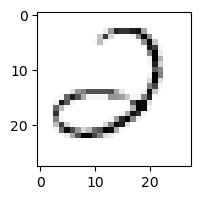

20.69234460075563% - 0
0.8936259123445657% - 1
6.940681731942331% - 2
57.33947336457405% - 3
24.322962146939616% - 4
6.04561095727381% - 5
61.447613612832896% - 6 - ОШИБКА
1.9930772153668286% - 7
0.2934844146478348% - 8
0.3150008802114917% - 9

 8


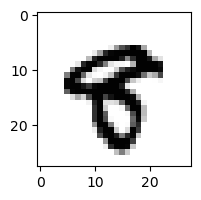

0.0712061802903136% - 0
0.0016072205576005744% - 1
4.538630793654162e-05% - 2
0.05426626088600687% - 3
0.09539646452973197% - 4
0.13868579871127504% - 5
0.0028749727394126886% - 6
0.019950582579624555% - 7
1.974222807651459% - 8
4.657143168928081% - 9 - ОШИБКА

 3


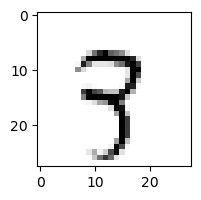

0.08573884022536751% - 0
1.381333045601044% - 1
12.793943989360463% - 2
4.557128418533366% - 3
9.011169444977734% - 4
1.6177298247452645% - 5
1.0192604972599555% - 6
25.102220551739872% - 7
1.8699584008541035% - 8
25.925064050535646% - 9 - ОШИБКА

 8


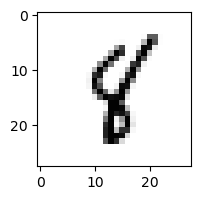

0.03951220731475557% - 0
5.52287523813132% - 1
0.2596073810661079% - 2
0.16269180006028675% - 3
43.283974504896165% - 4 - ОШИБКА
8.270788399346781% - 5
1.4232808601974754% - 6
1.5369495271397975% - 7
3.7752498271372925% - 8
3.7077841835770182% - 9

 5


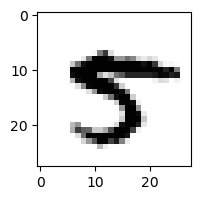

0.17587467909948318% - 0
0.002549463937311134% - 1
2.0352675218783973e-05% - 2
0.15567631128084164% - 3
0.15014471770028492% - 4
4.471438693285985% - 5
0.00172312531849179% - 6
1.7842748915406583% - 7
8.146395912516985% - 8 - ОШИБКА
0.03727411588262244% - 9

 5


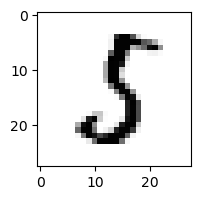

2.2238012835998173% - 0
1.7228606013532175% - 1
1.0724969853858528% - 2
37.048937444787335% - 3 - ОШИБКА
0.0026459494281763987% - 4
9.710319331836272% - 5
0.47410249151417994% - 6
0.05233219833484141% - 7
1.5541120937454516% - 8
0.009604150340756132% - 9

 5


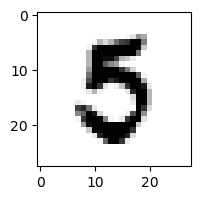

3.683978277031706% - 0 - ОШИБКА
0.0004741407125348324% - 1
0.0174078377669546% - 2
0.629956823387172% - 3
0.001192271985691691% - 4
3.1404298136307776% - 5
3.5661884639428543% - 6
0.12071127864980355% - 7
0.3771007328721381% - 8
0.014627322236007254% - 9

 7


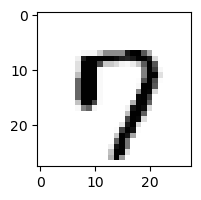

70.58891021645198% - 0 - ОШИБКА
0.00035371331038985343% - 1
0.01263257674065877% - 2
0.07676561975590146% - 3
4.487961792959035% - 4
2.982902694686876% - 5
0.4998269482644274% - 6
30.79826926312343% - 7
0.07109115752393738% - 8
61.748100907228256% - 9

 8


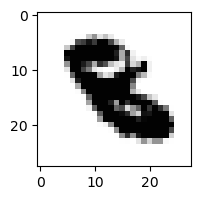

6.228905169975027e-07% - 0
6.073439210256403e-05% - 1
1.6075491618942315% - 2 - ОШИБКА
0.0284021529225051% - 3
0.0804219377443879% - 4
0.026814411766694687% - 5
0.028415325173108817% - 6
0.0005474231448785079% - 7
7.059812955101274e-05% - 8
0.009319592225939482% - 9

 9


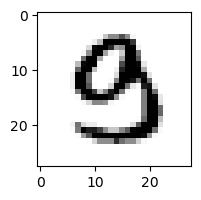

0.5701137117794611% - 0
0.00685600204095895% - 1
0.3236441655386798% - 2
7.352105537269081% - 3 - ОШИБКА
0.014956372946456907% - 4
1.5093101561392344% - 5
0.0017049405243859538% - 6
0.005408720872501443% - 7
0.0057166779018172995% - 8
0.051296692623183246% - 9

 4


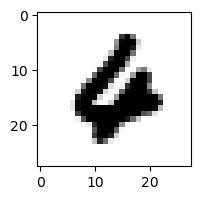

0.38484765994912695% - 0
0.00010902376745492359% - 1
0.04914642831418051% - 2
0.00025462092902079703% - 3
0.6744910520248767% - 4
0.0013526034059090479% - 5
66.54126962935808% - 6 - ОШИБКА
0.018597735185172156% - 7
0.0007002203042933388% - 8
0.14515661431700905% - 9

 3


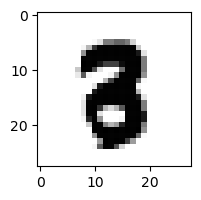

0.0009729782288281853% - 0
0.00022538089826568123% - 1
0.0973488432455076% - 2
0.2725240080060896% - 3
0.0014842068444535577% - 4
0.021394204138845047% - 5
0.004281949543514542% - 6
0.003201363746388297% - 7
0.5453910923864614% - 8 - ОШИБКА
0.009778963059151534% - 9

 7


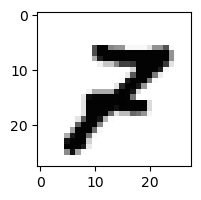

0.1851742977279716% - 0
0.006069264947307562% - 1
34.26327829002854% - 2 - ОШИБКА
0.13831137914940436% - 3
0.06522095253028638% - 4
0.014322293217803667% - 5
0.0008780146236705842% - 6
1.0006191408078093% - 7
8.680150969407235% - 8
2.4852696379089725% - 9

 3


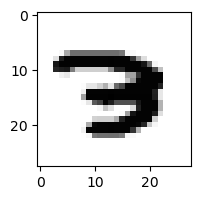

0.007552049083707645% - 0
0.0001834434951280393% - 1
0.10144146015108406% - 2
0.701733696547498% - 3
0.007554714805248209% - 4
0.0011722607099704503% - 5
0.8509270878739709% - 6
3.848795191969552% - 7 - ОШИБКА
0.00014977127251564762% - 8
0.008799320432401772% - 9

 5


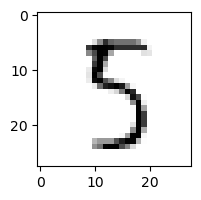

1.131490698066833% - 0
0.06833877845978385% - 1
1.3592324316211748% - 2
37.55317094778018% - 3
5.182666419014897% - 4
54.39031522525703% - 5
0.570284275613011% - 6
0.7027167929590935% - 7
91.82530558592003% - 8 - ОШИБКА
1.2659379410642007% - 9

 4


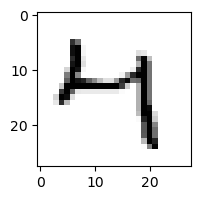

4.112522820191282% - 0
0.23084670765769214% - 1
0.0854065037622444% - 2
36.17869376753009% - 3
64.67083866682248% - 4
1.2903090675773825% - 5
0.8285202689291351% - 6
4.16855401465694% - 7
1.159677642672471% - 8
86.5100081021923% - 9 - ОШИБКА

 6


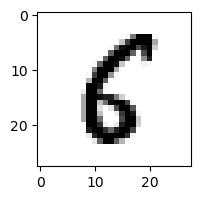

22.894503584957892% - 0
0.009178765354640685% - 1
0.40418852491070956% - 2
0.005727893061346357% - 3
0.2799717981902605% - 4
39.81628666320651% - 5 - ОШИБКА
26.079429708293922% - 6
0.003645119083515102% - 7
5.955782940587328% - 8
0.11015758904534939% - 9

 7


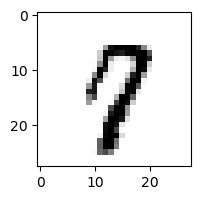

0.7668130771924466% - 0
0.02125588371561841% - 1
0.2331993580081636% - 2
0.46447433316849146% - 3
6.743592902921878% - 4
1.7141181729212709% - 5
0.04496734048150669% - 6
21.398319575332394% - 7
1.2689649349158716% - 8
36.99519180801448% - 9 - ОШИБКА

 6


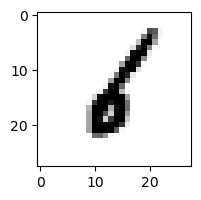

0.02566631021375794% - 0
81.88838578560873% - 1 - ОШИБКА
8.038115393463428% - 2
0.06662490621049821% - 3
1.5978654335117983% - 4
0.6066257657420786% - 5
16.654759443779266% - 6
0.14304404733149023% - 7
1.5858036578077286% - 8
0.09349751581466284% - 9

 8


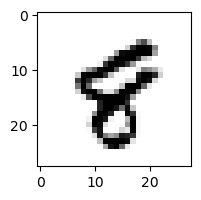

0.13130193489988387% - 0
0.07057039388199463% - 1
0.004123944114585187% - 2
0.0002673765597305453% - 3
1.3264172079982948% - 4
0.39803737208192486% - 5
0.2029349330798101% - 6
0.28639909749554654% - 7
5.895629098628646% - 8
9.140207762688094% - 9 - ОШИБКА

 0


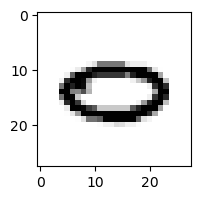

46.45644358655962% - 0
0.08518140278437908% - 1
0.007398371460945905% - 2
0.00034752403953668094% - 3
1.6250100662974534% - 4
0.0003569254625286047% - 5
60.05248303769074% - 6 - ОШИБКА
19.133388882553817% - 7
0.03495508693192953% - 8
5.558257371191777% - 9

 9


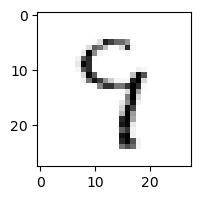

0.834596842140292% - 0
0.38125847125416784% - 1
3.7097734438210157% - 2
17.68736285039579% - 3
54.404066726787825% - 4
11.513734466988243% - 5
10.575756000673726% - 6
7.47435232100541% - 7
79.37885675674362% - 8 - ОШИБКА
11.580649717378751% - 9

 7


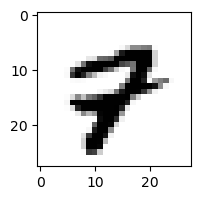

0.12683004330280503% - 0
0.028269039429988402% - 1
0.15242642682866198% - 2
1.3841716144503962e-05% - 3
0.20499611126036985% - 4
0.0018390446779813926% - 5
0.03679253152113044% - 6
11.304797278268277% - 7
1.5280076054253833% - 8
16.506023972878907% - 9 - ОШИБКА

 8


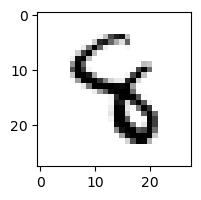

0.0007189627500827155% - 0
0.07908917864289802% - 1
0.9730095251783123% - 2
1.205172413658549% - 3
64.33104341184286% - 4 - ОШИБКА
1.6253656164701646% - 5
2.438531380574384% - 6
0.07619423892667829% - 7
0.546494432028843% - 8
0.18719445439331098% - 9

 8


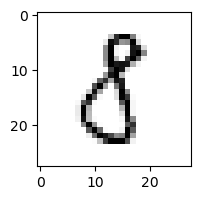

13.586063343864236% - 0
2.0304004712003016% - 1
1.7736830289138366% - 2
19.14703311239083% - 3 - ОШИБКА
0.4221543893477732% - 4
14.487787888502071% - 5
0.2448374452632194% - 6
0.1321172218652155% - 7
1.5390089955018775% - 8
0.07891598552372125% - 9

 8


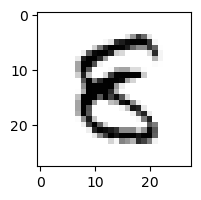

0.7022893663167125% - 0
0.011578714486980774% - 1
0.40484573985734695% - 2
0.4966794232631451% - 3
4.467597858057452% - 4
47.19120747124174% - 5 - ОШИБКА
1.1991374534193002% - 6
0.00026934448150472815% - 7
6.688562298480308% - 8
0.01003931275138372% - 9

 3


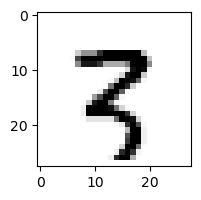

0.007960680578555526% - 0
1.2673805519302965% - 1
20.607853827072177% - 2
0.0780939446498634% - 3
0.044600736195931606% - 4
0.018756981969819474% - 5
0.030891336811545825% - 6
3.451333952316248% - 7
24.32124782617912% - 8
44.47110692202367% - 9 - ОШИБКА

 7


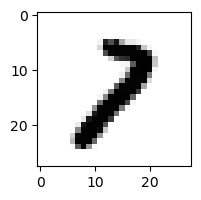

0.17524707495269565% - 0
3.2630047432799425% - 1
38.43974436810906% - 2 - ОШИБКА
1.162857174639415% - 3
0.014182522922321866% - 4
0.005087153942924776% - 5
0.004831982615413133% - 6
0.742177545326269% - 7
19.73270478217757% - 8
8.861603614317206% - 9

 3


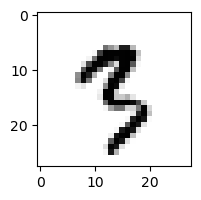

0.026472551811783093% - 0
1.505999464518786% - 1
0.050287137414703836% - 2
6.287195860407774% - 3
0.015484333110443654% - 4
9.081451957333995% - 5
0.0574560211058858% - 6
1.234885253655148% - 7
1.15869639883726% - 8
16.388433225004224% - 9 - ОШИБКА

 9


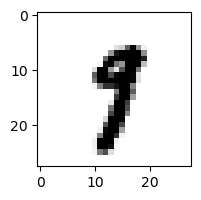

0.008455544314843312% - 0
2.9445089721607967% - 1
0.0030242753362727582% - 2
3.031815626431195% - 3
0.2941424445371063% - 4
0.9545055454160347% - 5
0.02090679312904077% - 6
15.201462530185442% - 7 - ОШИБКА
0.22856770374122415% - 8
7.231908930678935% - 9

 8


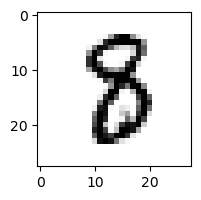

0.021803181400331342% - 0
0.3311913075980042% - 1
0.16664312395669664% - 2
2.3516089467366683% - 3 - ОШИБКА
0.022051420512787894% - 4
0.9781890199189971% - 5
0.3064006454651386% - 6
0.07588585338888815% - 7
1.9963314803109544% - 8
0.00027314400864607074% - 9

 2


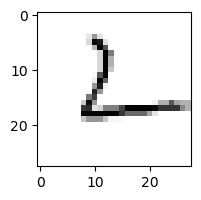

19.252734152861365% - 0
0.3480132065333627% - 1
72.82815213221784% - 2
0.2899045355342356% - 3
35.38305611396777% - 4
7.788293259997811% - 5
87.80343177734379% - 6 - ОШИБКА
2.929795566746735% - 7
36.68245711198624% - 8
15.990381241387613% - 9

 7


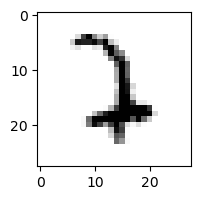

0.006629791304941584% - 0
5.401631695302995% - 1
61.507900119585926% - 2 - ОШИБКА
5.3828775667726845% - 3
0.11403682114271983% - 4
0.06159400136035462% - 5
22.83166887824038% - 6
3.3640902631295795% - 7
0.0118348896957359% - 8
0.1470337863383% - 9

 9


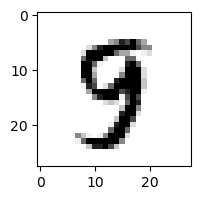

0.013747085037169149% - 0
0.005545418326688924% - 1
0.016965200273713163% - 2
14.51030870966835% - 3 - ОШИБКА
2.4954343704132245% - 4
1.0454851792423134% - 5
0.010094426088022636% - 6
0.18246243163699424% - 7
1.8612029383733826% - 8
0.6204311894157003% - 9

 9


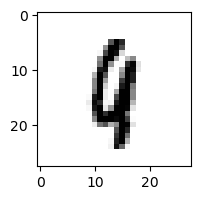

0.008333696742323786% - 0
0.9331458881989179% - 1
1.8413364233900493% - 2
0.027106909134736644% - 3
16.928288886387353% - 4 - ОШИБКА
0.20520412188573547% - 5
8.172926931446328% - 6
1.4532474173048777% - 7
2.6932114640554685% - 8
2.6100546633746466% - 9

 5


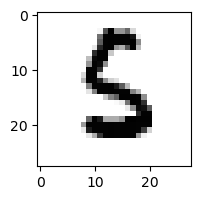

0.048804593642748466% - 0
0.0013054450305437875% - 1
2.9062472887791393% - 2
1.07428113151346% - 3
0.041851830377727266% - 4
44.72322909506896% - 5
52.67738507010795% - 6 - ОШИБКА
0.000593390360696094% - 7
0.37819814970590276% - 8
0.0003851512615985862% - 9

 8


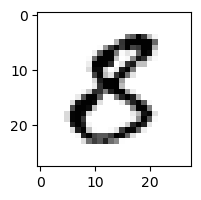

6.055723231035555% - 0
0.006695347773974652% - 1
0.632061765933986% - 2
2.6724688728810064% - 3
0.12320206355448213% - 4
10.693078387106778% - 5 - ОШИБКА
0.008444046091396852% - 6
0.0007212712636452451% - 7
0.044568702758933675% - 8
0.003593676667270939% - 9

 4


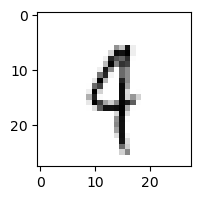

0.2518462083554497% - 0
7.3728416521930225% - 1
3.139438222506426% - 2
2.3436359817395367% - 3
26.34381940694677% - 4
4.5339475179311295% - 5
12.882275255285583% - 6
9.401587880255027% - 7
4.723565940245088% - 8
88.24693156427875% - 9 - ОШИБКА

 9


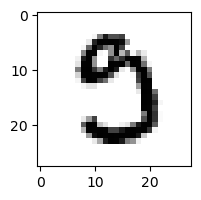

24.50127933001397% - 0 - ОШИБКА
0.0005619910860658636% - 1
0.15859708615804746% - 2
1.3863475095356776% - 3
0.00018902541456912805% - 4
15.546299072060057% - 5
0.008138519132747565% - 6
2.2062522339463286% - 7
0.5263430507339801% - 8
0.007560798178715699% - 9

 8


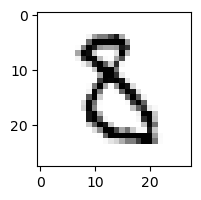

0.5575177963831186% - 0
0.006513226448177317% - 1
7.682001347262105% - 2
2.316463802374721% - 3
0.06436836777953839% - 4
5.625155727067818% - 5
8.716922739849586% - 6 - ОШИБКА
0.02501818980863192% - 7
4.70515860655747% - 8
0.03485061485234768% - 9

 2


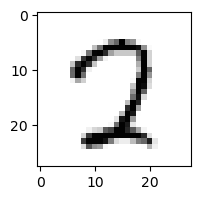

25.643892759116888% - 0
0.0046522858571116784% - 1
1.8749191442087279% - 2
16.522000956573727% - 3
0.3638931336991907% - 4
10.954362408493413% - 5
0.026699237633671675% - 6
13.097956950099501% - 7
36.47019098564493% - 8 - ОШИБКА
0.52208836436447% - 9

 7


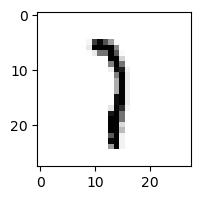

0.11715920754134782% - 0
65.69853415794495% - 1 - ОШИБКА
13.261281248404465% - 2
13.185144045375843% - 3
1.270256905049004% - 4
3.2979669118682926% - 5
3.674521745011536% - 6
19.108335597330257% - 7
1.7929060489705915% - 8
6.453939565472276% - 9

 8


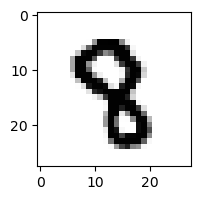

0.00012179580346927261% - 0
0.007336041099564799% - 1
0.16910131923108002% - 2
0.1691666060255285% - 3
2.7172053196090644% - 4 - ОШИБКА
0.3884400888342332% - 5
0.006924994701651886% - 6
0.07643964912781727% - 7
0.5313326766343697% - 8
0.1658425829484754% - 9

 0


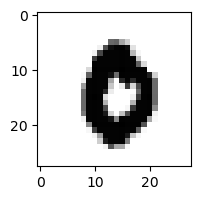

2.116048592390424% - 0
1.3386495623500743e-05% - 1
0.002419810856431124% - 2
0.015475580284827721% - 3
0.000802229541158369% - 4
0.015430251208726391% - 5
3.59824027650048% - 6 - ОШИБКА
0.030061672725504737% - 7
0.003312090157071875% - 8
0.09475794373738716% - 9

 4


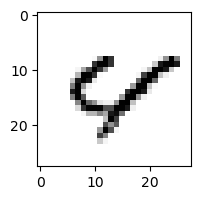

3.0585652629457427% - 0
0.058858247266505376% - 1
0.37742501733309514% - 2
2.2095422908895143e-05% - 3
78.64226549417992% - 4
0.33881574376211265% - 5
22.687097053970444% - 6
16.309989415489607% - 7
47.19058113726003% - 8
85.19954411198094% - 9 - ОШИБКА

 9


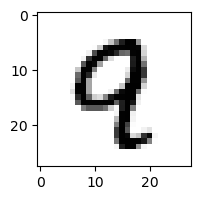

0.08481923239321094% - 0
0.00889095867061028% - 1
0.8926582624206758% - 2
0.009837862391264683% - 3
27.450664840415122% - 4 - ОШИБКА
0.02830322598096181% - 5
0.03329414572742919% - 6
0.23366285657527125% - 7
3.1445582221944774% - 8
25.020538755069122% - 9

 7


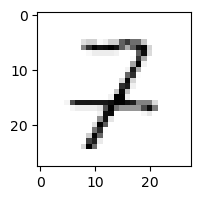

0.5681251005573741% - 0
6.96106356267147% - 1
65.28552039958977% - 2 - ОШИБКА
6.303832839712699% - 3
34.79596006288339% - 4
0.32627354535460795% - 5
2.2634783195103787% - 6
3.7297607657810783% - 7
9.878292202269904% - 8
0.8959634456133002% - 9

 5


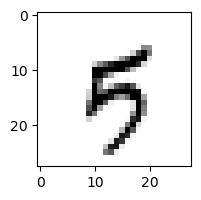

0.4588163238941607% - 0
0.35121512323060244% - 1
0.0590836468522511% - 2
2.448233215930868% - 3
16.94147445732432% - 4 - ОШИБКА
6.200034059322939% - 5
1.0258107406732098% - 6
1.681120184352431% - 7
0.9223143301642376% - 8
4.879666507573941% - 9

 3


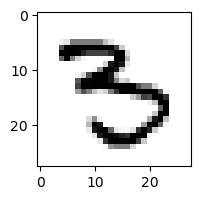

0.3458096153792142% - 0
0.0099555775473274% - 1
0.001782350825218083% - 2
13.019718574863745% - 3
0.21853692772841718% - 4
22.81268078926138% - 5 - ОШИБКА
0.39302183273408264% - 6
0.06323701673401555% - 7
0.22405213135757449% - 8
0.27062778691062256% - 9

 5


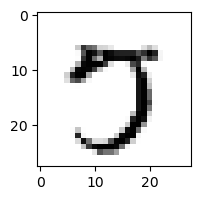

6.401720324109049% - 0
0.0018587884937634493% - 1
0.07561699601389206% - 2
10.43075164375334% - 3
0.019205016791586788% - 4
14.649049788318832% - 5
0.005980190932678928% - 6
91.34463394727352% - 7 - ОШИБКА
1.6306196815696234% - 8
4.121439373279029% - 9

 8


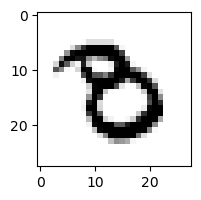

0.3750814514387945% - 0
0.0010463586651258013% - 1
0.058970581206327796% - 2
4.751450520207391% - 3
0.0010483729092447358% - 4
0.21294218020031486% - 5
10.812306312376117% - 6 - ОШИБКА
0.041228761337716247% - 7
0.02003258426575716% - 8
0.016238929291874277% - 9

 8


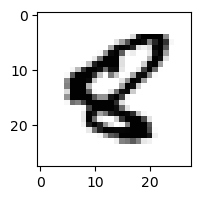

0.03273328237342042% - 0
0.007684778091540286% - 1
0.01597279071320813% - 2
1.374945879410195e-06% - 3
0.538592731426208% - 4
0.5406264053632306% - 5
1.8865631579922757% - 6 - ОШИБКА
0.0013401524099069843% - 7
0.4649843903937049% - 8
0.1180954784876243% - 9

 7


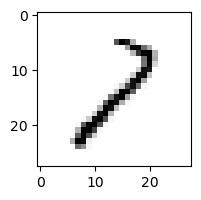

3.052640052410127% - 0
25.795620684927467% - 1
59.458287247686684% - 2
4.4707999534584415% - 3
4.598489678767292% - 4
0.6841480113723625% - 5
2.3037700929884646% - 6
7.594331505753531% - 7
89.91598586707723% - 8 - ОШИБКА
1.6699468996871716% - 9

 7


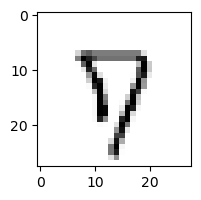

4.202995419823792% - 0
0.010194991039310465% - 1
3.500778669698939% - 2
0.5638674522565238% - 3
8.905156505968172% - 4
5.168218615395955% - 5
3.190023969722893% - 6
26.55285383088042% - 7
62.74084845454419% - 8
66.77007046967593% - 9 - ОШИБКА

 5


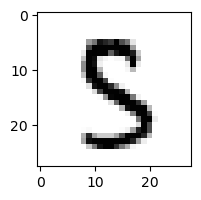

0.08149191071401905% - 0
0.002489011964476415% - 1
0.31268742085396367% - 2
15.189090957476402% - 3
0.8582011341508685% - 4
52.57402529175753% - 5
0.007001925626717361% - 6
0.024507989990823587% - 7
59.01902046826951% - 8 - ОШИБКА
0.29242935577464524% - 9

 2


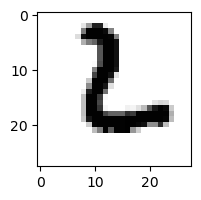

2.6223865946728866% - 0
0.0009628146114093007% - 1
78.29889391860999% - 2
0.07816935852708655% - 3
0.0008921517049671309% - 4
6.643543334841288% - 5
98.55508405823365% - 6 - ОШИБКА
0.0010483768831164866% - 7
0.07075487143097016% - 8
0.03584732310608437% - 9

 5


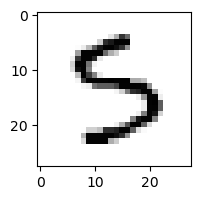

0.6075799794842542% - 0
0.011746067701315272% - 1
0.05148882660362433% - 2
46.21036280574816% - 3 - ОШИБКА
0.29665410511954565% - 4
26.453289076906085% - 5
3.561335750991732% - 6
0.15483558738973402% - 7
5.813267488698886% - 8
0.0485524971479999% - 9

 2


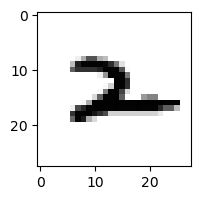

0.005377430425445772% - 0
4.059929715340455% - 1
2.7709878221160835% - 2
0.007625050355932591% - 3
6.16004571986638% - 4
0.3032693477937275% - 5
25.610702164067362% - 6 - ОШИБКА
1.5305159673543571% - 7
14.053570646688202% - 8
1.1173157317830595% - 9

 7


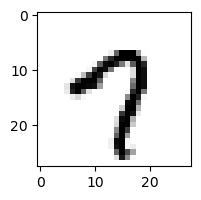

15.704904668730169% - 0
0.010396193134153763% - 1
0.005355308124184695% - 2
0.22155113040786667% - 3
6.759983291340969% - 4
3.4610823496442706% - 5
0.2941491789842054% - 6
51.350458082397324% - 7
0.08554116460803905% - 8
95.73286288826559% - 9 - ОШИБКА

 4


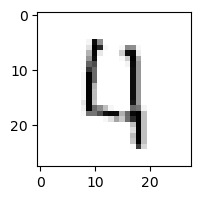

5.582878034742552% - 0
0.04046411589324617% - 1
36.72327619331195% - 2 - ОШИБКА
0.6083206300337856% - 3
35.34685033633803% - 4
1.6204351470159903% - 5
7.983892195939123% - 6
6.110038931479237% - 7
4.0032033542412915% - 8
27.708505847871045% - 9

 2


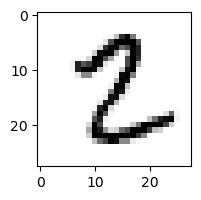

0.19428363017758182% - 0
1.4249502020383136% - 1
37.404865823179655% - 2
0.24720680802749972% - 3
0.005728842812845476% - 4
7.6372925460757495% - 5
0.010007554225885028% - 6
0.051281617046522565% - 7
48.5710722939558% - 8 - ОШИБКА
0.02702821802216546% - 9

 5


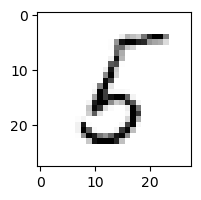

4.9480302978463175% - 0
1.7097767526536654% - 1
5.938815525788072% - 2
16.603824851356478% - 3
2.5421756807746587% - 4
30.19406398300692% - 5
31.684814998242945% - 6
0.029982073563184528% - 7
88.21067947585149% - 8 - ОШИБКА
0.3127576049302429% - 9

 3


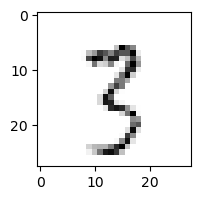

0.29656838861946017% - 0
10.628069092419686% - 1
14.963763984735252% - 2
50.5468902049973% - 3
0.47520344967423456% - 4
5.826037134561668% - 5
0.19169244237244024% - 6
24.314874890374867% - 7
17.980166544314617% - 8
62.12915189640097% - 9 - ОШИБКА

 4


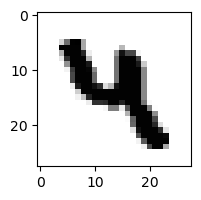

0.00012174107689442845% - 0
0.004669615398833271% - 1
0.05788157661651127% - 2
1.2518234181487362% - 3
16.55802183591298% - 4
0.04335329707885906% - 5
0.01142143056969449% - 6
0.03840552262327782% - 7
0.000213771852794094% - 8
20.10162951315929% - 9 - ОШИБКА

 5


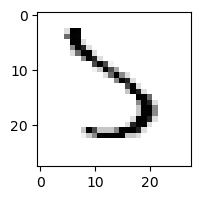

1.199826853069367% - 0
0.4552016039580322% - 1
5.700768125439809% - 2
77.61440593818809% - 3 - ОШИБКА
2.377244619837892% - 4
22.215805963715965% - 5
15.6102964898383% - 6
25.94852486000132% - 7
0.7986507163240466% - 8
0.12171770639493787% - 9

 8


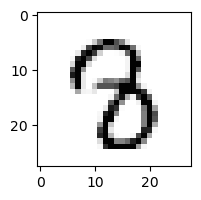

0.009221696726729527% - 0
0.12647912725847393% - 1
0.2158982883055825% - 2
2.4388852364017% - 3 - ОШИБКА
1.6319717553352122% - 4
1.0119732302088003% - 5
0.062131180446617626% - 6
1.2046664557471773% - 7
2.289371169794033% - 8
0.172967445517374% - 9

 2


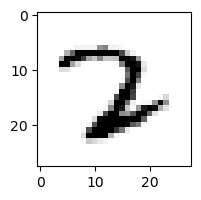

0.023227145406539747% - 0
0.13922021165398826% - 1
30.890660778723966% - 2
6.541940794799077% - 3
0.07351019947520102% - 4
0.07998372673798028% - 5
3.890230470137379% - 6
44.98957376548513% - 7 - ОШИБКА
0.013951466681194931% - 8
0.00960198956168546% - 9

 5


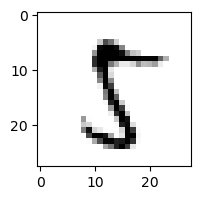

2.0064557412395283% - 0
0.4849833438573708% - 1
1.275482654603144% - 2
3.2739967859145245% - 3
0.04837778180595704% - 4
78.98972798731678% - 5
0.008078742124919807% - 6
1.878998360174958% - 7
92.50576794260375% - 8 - ОШИБКА
1.1963949726208345% - 9

 2


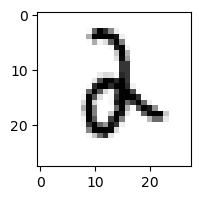

0.06183727862386916% - 0
0.44625264774765816% - 1
15.088256328898886% - 2
6.78053185324652% - 3
1.3116340413572485% - 4
0.3974998448787186% - 5
27.212504592255083% - 6 - ОШИБКА
0.02352357633350472% - 7
0.046733647308328095% - 8
0.6029393165694648% - 9

 5


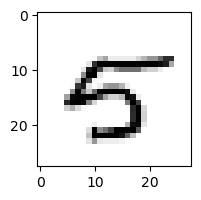

9.476286524071487% - 0
0.019962968995032856% - 1
0.01976706389698691% - 2
0.35226111906374535% - 3
36.41658341589126% - 4 - ОШИБКА
26.515983992626374% - 5
0.30161047061778% - 6
0.2920818270714393% - 7
0.23212728634964017% - 8
0.34352356001979234% - 9

 9


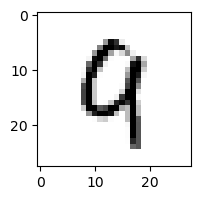

0.29194019575523644% - 0
0.03334723455231857% - 1
14.616928495034978% - 2
0.02614554606902822% - 3
54.237174509875274% - 4 - ОШИБКА
0.06465193267713361% - 5
1.2301320189415819% - 6
3.368923351278018% - 7
7.105305934667593% - 8
23.23697394991552% - 9

 8


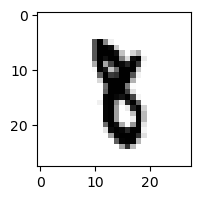

0.00010385449055778321% - 0
13.17713239688889% - 1 - ОШИБКА
0.04500679986070245% - 2
3.7948186067513836% - 3
0.09584292814306068% - 4
0.45766999788656754% - 5
0.027509395823977708% - 6
0.779794682340707% - 7
0.08283063003301934% - 8
0.056696154540428395% - 9

 9


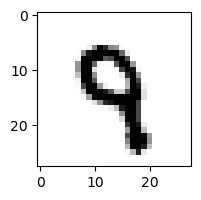

0.0017308920841640763% - 0
0.0050928853881254095% - 1
0.7130443766495863% - 2
0.713393248359657% - 3
32.23225984255015% - 4 - ОШИБКА
3.2578188667070282% - 5
0.20542794693539798% - 6
1.2855046027830066% - 7
0.10197441502948502% - 8
25.72804628452094% - 9

 4


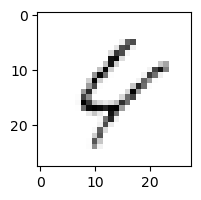

17.473197005697187% - 0
1.0934204568879102% - 1
15.918698979200183% - 2
0.033581366313520974% - 3
43.82287069148706% - 4
0.9893280145580567% - 5
26.91879005576581% - 6
5.2209961739305655% - 7
56.01615127250184% - 8
91.33713404917032% - 9 - ОШИБКА

 8


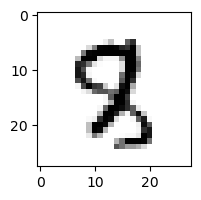

0.00424598202271629% - 0
0.2830989328268644% - 1
3.2875485540496316% - 2 - ОШИБКА
0.15332838318646697% - 3
0.8064927224720089% - 4
1.6871340645431216% - 5
0.06942211241161961% - 6
0.5379712420071615% - 7
1.258933104238786% - 8
1.8391973391198184% - 9

 6


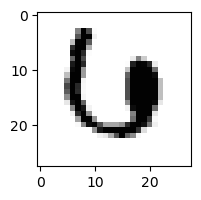

8.758641336113786% - 0
0.0001696277632814893% - 1
0.3732916653635915% - 2
1.4399010044892235% - 3
4.009026771134695% - 4
0.00028738052907399295% - 5
5.833181609402246% - 6
15.08181748139431% - 7 - ОШИБКА
0.0016753767621294766% - 8
0.04099650731930053% - 9

 4


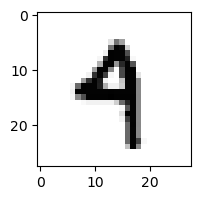

0.029631613248709745% - 0
0.053467498914046035% - 1
0.044659625938695297% - 2
6.41262593039857% - 3
56.402905544554784% - 4
1.6418157814536427% - 5
0.7180948926973246% - 6
0.11004488059975005% - 7
0.021588085002656257% - 8
80.12332995106618% - 9 - ОШИБКА

 3


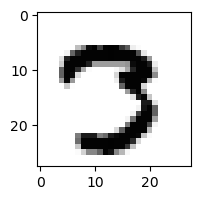

0.16236792437090614% - 0
0.00022891345091839455% - 1
0.035861737816968706% - 2
87.39962257537333% - 3
0.0001983013771257718% - 4
0.030630013931825302% - 5
6.287952035632819e-06% - 6
89.15208082019902% - 7 - ОШИБКА
0.07685713049200489% - 8
0.15335517980888566% - 9

 8


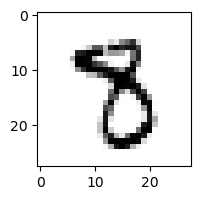

0.003678668756189406% - 0
0.516992852011132% - 1
0.04786731320930668% - 2
1.4769026960004017% - 3
0.09654788669093722% - 4
5.71842587915702% - 5 - ОШИБКА
0.005046242798283899% - 6
4.064648981141864% - 7
5.513669988767883% - 8
0.04451476121494202% - 9

 4


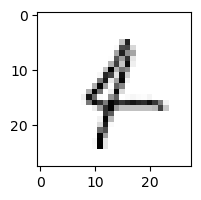

0.5559365677808802% - 0
13.446503431431264% - 1
1.1423337169419594% - 2
8.566852989250282% - 3
8.44656573743572% - 4
5.60140871896876% - 5
19.405334529766485% - 6 - ОШИБКА
1.1329984752023015% - 7
1.61944547421503% - 8
19.043134927325255% - 9

 5


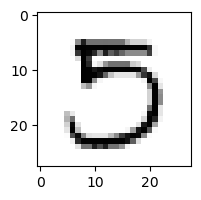

17.5835579090738% - 0
0.0060171915704175126% - 1
0.18702201750491027% - 2
20.31488152748688% - 3 - ОШИБКА
0.0038245837609609586% - 4
5.2520772440538686% - 5
0.0011098973568374076% - 6
8.964945354002664% - 7
2.55647476211119% - 8
0.05923268987226945% - 9

 5


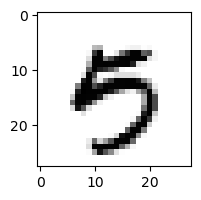

0.8556215044632532% - 0
0.005936793093321597% - 1
0.000517398807958555% - 2
0.7395362479452159% - 3
1.5387412208676703% - 4
5.6756188990656975% - 5
0.06151120611417693% - 6
0.09756691225765397% - 7
0.004094926835810558% - 8
19.16968908594451% - 9 - ОШИБКА

 3


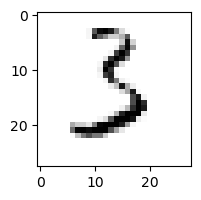

3.7202902953069397% - 0
0.4464507178361739% - 1
28.97454159351447% - 2
36.74774297224658% - 3
0.01338297764816994% - 4
23.735960819845335% - 5
37.9159665088097% - 6 - ОШИБКА
4.378675897429258% - 7
0.22594367268269172% - 8
1.374889042608116% - 9

 5


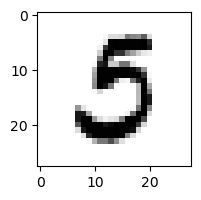

24.364557119712323% - 0
0.00468810248301579% - 1
0.18447488325181338% - 2
26.316130027679613% - 3 - ОШИБКА
0.00026300401426333634% - 4
10.182350978202525% - 5
1.399050203201295% - 6
0.04723348140022534% - 7
0.14480100388331396% - 8
0.00037012429387683167% - 9

 7


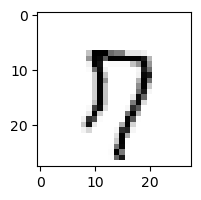

46.87240453809661% - 0
0.009374116406802944% - 1
6.474220430007422% - 2
2.2502344138132506% - 3
0.980485535884003% - 4
7.824652697732384% - 5
3.850614307441487% - 6
25.609993650438252% - 7
73.59336238952253% - 8 - ОШИБКА
67.98406553508501% - 9

 7


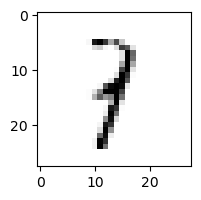

0.1361435643694237% - 0
81.07538480980901% - 1 - ОШИБКА
8.372566104143308% - 2
47.65981655869321% - 3
3.3745308490418653% - 4
4.122348436612869% - 5
2.3812480684487656% - 6
0.5344104362107028% - 7
12.937725433464806% - 8
11.744387314282887% - 9

 8


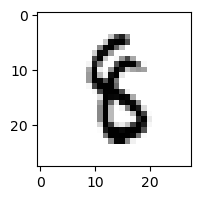

0.008239605837328648% - 0
0.5993223503053084% - 1
0.19182940051555242% - 2
2.1008292208029364% - 3
0.3462931463307146% - 4
7.3347087453370525% - 5 - ОШИБКА
1.4819910995038228% - 6
0.021836357304349404% - 7
5.817811828040739% - 8
0.005223796133794251% - 9

 2


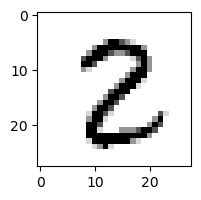

0.3737409568492579% - 0
0.24330846830151123% - 1
31.01812082181902% - 2
0.9813930580325685% - 3
0.013262788667132359% - 4
0.44597924754513957% - 5
0.002215225722186655% - 6
0.12285814321693565% - 7
98.80967006113389% - 8 - ОШИБКА
0.13845765425985826% - 9

 7


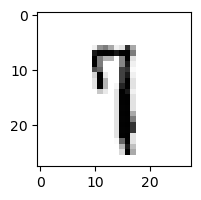

0.11726888862064173% - 0
1.0452942600487745% - 1
3.5242651217106067% - 2
29.20974737995919% - 3
8.526860185202572% - 4
5.780959865749892% - 5
2.5445352860250665% - 6
18.41957732112302% - 7
6.716283527496228% - 8
59.88963361896137% - 9 - ОШИБКА

 5


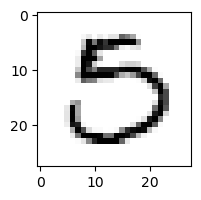

49.11282029685176% - 0 - ОШИБКА
0.007138690822017173% - 1
1.6694955917707022% - 2
2.7581993435078145% - 3
0.00781889833626955% - 4
1.2231875589744934% - 5
0.012610057735852739% - 6
1.2645056260773817% - 7
7.544815299625543% - 8
0.0007800687039659491% - 9

 1


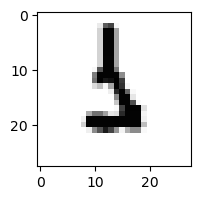

0.03828696920062337% - 0
1.1605922163846771% - 1
1.7073277000127265% - 2
1.182136035392178% - 3
0.021409808213097185% - 4
10.272131657538223% - 5
80.60400083081986% - 6 - ОШИБКА
0.22086579466395642% - 7
0.9320025990693174% - 8
0.044679937769984544% - 9

 8


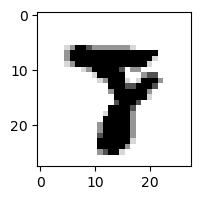

0.00024022817180676138% - 0
0.00487321570657568% - 1
0.00023991433170316738% - 2
0.0268970002628796% - 3
0.0010297825212631686% - 4
0.07949568944544266% - 5
0.00012773072969928087% - 6
79.85730353514704% - 7 - ОШИБКА
0.00948654824218938% - 8
0.006898087660476606% - 9

 4


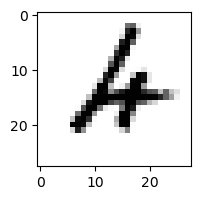

0.15241364603262741% - 0
0.01287652270403299% - 1
12.404693523158233% - 2
1.8072288154706966% - 3
2.2596199303501403% - 4
0.02969524468045435% - 5
60.07402091944583% - 6 - ОШИБКА
0.02501723019781381% - 7
1.5127001288878759% - 8
11.730689104935829% - 9

 9


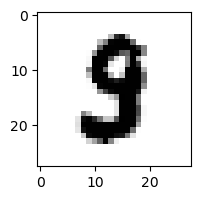

0.03762972233890338% - 0
0.0009309602417724779% - 1
0.14199396000426626% - 2
1.671522593201877% - 3 - ОШИБКА
0.004567974199722509% - 4
1.2255967957198992% - 5
0.030024620789768457% - 6
0.011147039211133934% - 7
0.8580143672517831% - 8
0.007266912830407057% - 9

 9


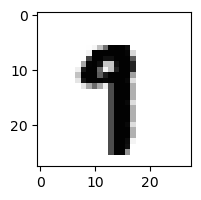

0.00014578530750673565% - 0
0.8282248794566485% - 1
0.00039732405675635196% - 2
0.05318760372256504% - 3
0.05773424150676659% - 4
2.454479435891075% - 5
0.02415982797662535% - 6
5.416822995295103% - 7 - ОШИБКА
0.20992615758703742% - 8
3.357822647977018% - 9

 9


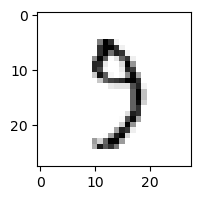

2.761494827715644% - 0
0.14206801517592663% - 1
0.8295377279858187% - 2
81.2781545673654% - 3 - ОШИБКА
1.1052287149065774% - 4
5.909459335683692% - 5
0.4234813181640654% - 6
32.6528670763491% - 7
11.697466697968284% - 8
15.774197256042008% - 9

 8


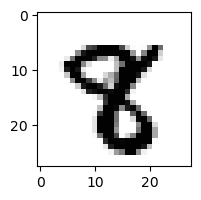

5.627790672057204e-05% - 0
0.019538989529776455% - 1
0.0018559143532519329% - 2
0.06677238534513527% - 3
0.064613316795364% - 4
0.29220007385206254% - 5 - ОШИБКА
0.00013669683077558004% - 6
0.13009640016168877% - 7
0.12833050293857767% - 8
0.03531396770982198% - 9

 7


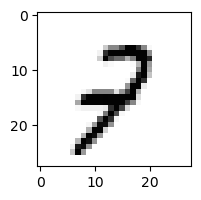

1.3793044287140959% - 0
0.6579177406440323% - 1
40.93756073813534% - 2
1.168800256484419% - 3
2.515188906683155% - 4
0.2675367200437121% - 5
0.2898738534422711% - 6
1.2863877856300836% - 7
1.8176493681986914% - 8
77.05457026883974% - 9 - ОШИБКА

 7


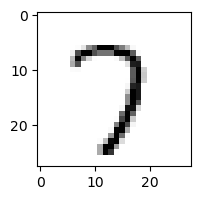

6.956095403625012% - 0
0.026453908333764983% - 1
17.14445601336008% - 2
83.31939163805545% - 3 - ОШИБКА
1.3199850648025453% - 4
1.1113932601444914% - 5
0.2849438584219213% - 6
71.1919293298691% - 7
4.012283378272988% - 8
30.010927505661062% - 9

 2


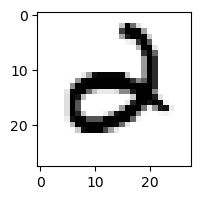

1.571829426558647% - 0
0.004618561925916122% - 1
0.0004971843139932911% - 2
0.10026513988737353% - 3
14.277501952868993% - 4
0.5732700197010738% - 5
41.40676148745703% - 6 - ОШИБКА
0.043745884020898275% - 7
0.00024058465324741773% - 8
0.014099272465036285% - 9

 0


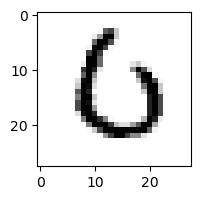

81.5555398217246% - 0
0.0012684348843467056% - 1
13.939331878684758% - 2
0.02248621072983443% - 3
0.1977331036602382% - 4
0.2905339101787844% - 5
85.03597160252755% - 6 - ОШИБКА
0.2038917584307046% - 7
0.2814907486319095% - 8
0.10225449417302268% - 9

 4


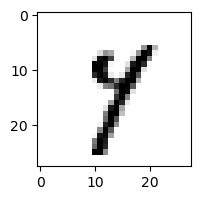

0.030898972356837265% - 0
7.49526274607241% - 1
0.030826210023435663% - 2
0.5760002862579437% - 3
19.123913605594346% - 4
7.448207244285338% - 5
0.1321809235088081% - 6
50.68513963899686% - 7 - ОШИБКА
26.057308821176328% - 8
1.9300580034116541% - 9

 9


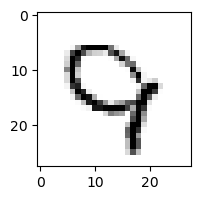

0.5801655988792553% - 0
0.08600422221528911% - 1
8.20368043641028% - 2
0.7615191332089596% - 3
32.56080317820394% - 4 - ОШИБКА
0.06641366948046404% - 5
5.792320838861353% - 6
10.076810163894708% - 7
0.06626780368596819% - 8
17.137705126987456% - 9

 2


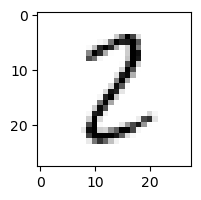

3.9021446624309166% - 0
11.12453000286348% - 1
43.29870014775277% - 2
26.39807894343703% - 3
0.06348797963941362% - 4
4.177147907309293% - 5
0.46017412253449624% - 6
0.0828659450868065% - 7
43.30472363285223% - 8 - ОШИБКА
0.049684645845757325% - 9

 7


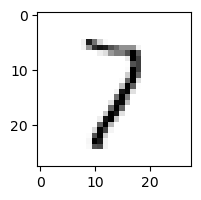

1.0218810451206461% - 0
12.058826817973985% - 1
50.761781933608% - 2 - ОШИБКА
26.095145260498754% - 3
9.953257759653825% - 4
1.2843315652992606% - 5
1.8294201828743917% - 6
34.059885164481166% - 7
19.44432592968288% - 8
26.927649690834333% - 9

 3


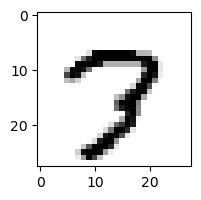

1.6621197037187858% - 0
0.0005589544588954036% - 1
0.06906910141326647% - 2
1.1868929738682275% - 3
0.06549812553335442% - 4
0.579428078698366% - 5
0.010978577062371424% - 6
96.37338462199473% - 7 - ОШИБКА
3.3719888863564167% - 8
20.79457572612127% - 9

 9


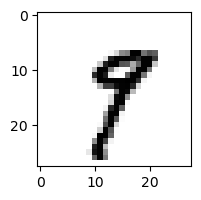

0.04507324935522741% - 0
5.65077994646512% - 1
0.01121288154180859% - 2
1.6294073942854874% - 3
1.5553421532451408% - 4
1.2625721663129508% - 5
0.019655950865809634% - 6
43.421231023047596% - 7 - ОШИБКА
7.608568720136569% - 8
15.682282238055231% - 9

 2


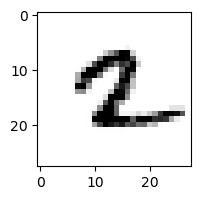

0.005263276785487209% - 0
7.342991732838794% - 1
2.072037159734215% - 2
0.0032426333152053436% - 3
0.038965561509096774% - 4
0.46639871483399165% - 5
9.140768696217366% - 6
1.5328960968747918% - 7
0.09834011889573185% - 8
18.53748078281439% - 9 - ОШИБКА

 9


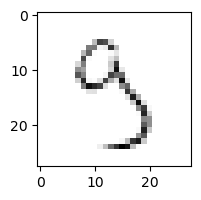

2.39779182347014% - 0
3.9716903094611524% - 1
1.4958019758955654% - 2
66.8444321677624% - 3 - ОШИБКА
21.674575592061498% - 4
40.65884086619882% - 5
12.283294306354065% - 6
14.666753407121167% - 7
24.11846092784368% - 8
23.90909581194693% - 9

 7


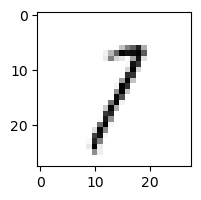

3.125508366461009% - 0
55.652907098623906% - 1
24.244494209027707% - 2
35.06021991985821% - 3
6.737437273515541% - 4
3.6149345022140107% - 5
2.6398346274823092% - 6
31.973118423210913% - 7
31.420307452961048% - 8
65.71013765923323% - 9 - ОШИБКА

 8


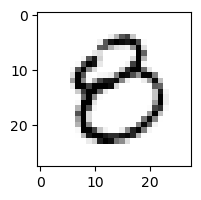

88.45914485151968% - 0 - ОШИБКА
0.013413252671789892% - 1
0.1448001775506372% - 2
1.7909259628687744% - 3
0.7159177770556198% - 4
3.7463023749732454% - 5
0.07446898957278351% - 6
0.01006177648709878% - 7
2.6857987329435247% - 8
0.023411727796702007% - 9

 7


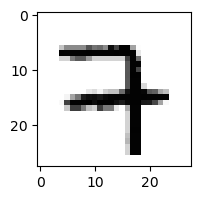

0.040982578793800295% - 0
0.004227688979449113% - 1
18.41066887632944% - 2
18.75950659334171% - 3
28.396524488691654% - 4 - ОШИБКА
0.0007444973578626012% - 5
0.1822278602585796% - 6
2.018691247098723% - 7
0.003826221570132748% - 8
10.582698851700256% - 9

 2


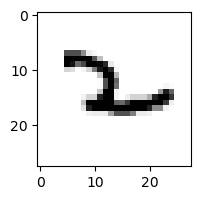

0.08211803324743226% - 0
0.6523010769187435% - 1
2.065468281598225% - 2
0.1936461163095226% - 3
59.863604609113096% - 4
4.646458849703993% - 5
67.33712243381298% - 6 - ОШИБКА
6.391476089214493% - 7
50.65070092639039% - 8
1.3687396928976423% - 9

 3


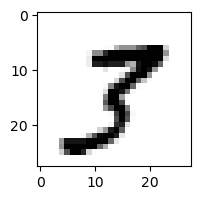

0.06722738757166814% - 0
0.776255782723693% - 1
0.0949431248707488% - 2
11.191897983108033% - 3
0.09536559064797906% - 4
0.6100967100271086% - 5
9.745150101135964e-05% - 6
39.309099115215% - 7 - ОШИБКА
5.5964204772769% - 8
2.703195496103265% - 9

 5


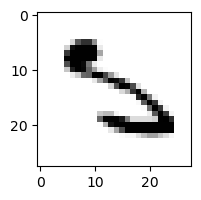

0.016630694284363437% - 0
0.04990595481850352% - 1
48.05540177728331% - 2 - ОШИБКА
5.749911094704649% - 3
0.7776924487972119% - 4
24.41274070105414% - 5
20.670165182288912% - 6
6.2921441074066% - 7
0.3067018533319067% - 8
0.02342106018951714% - 9

 8


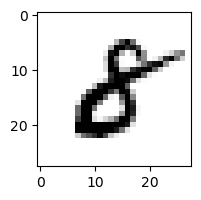

2.8155853432434887% - 0
0.024152021358099535% - 1
5.077258593753056% - 2
8.144118455282214% - 3 - ОШИБКА
0.04340680839978319% - 4
1.5376489643024762% - 5
0.4045891727782006% - 6
0.002636014575987939% - 7
1.7686087764792542% - 8
0.14963036827141593% - 9

 7


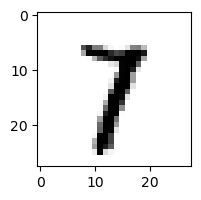

0.00902779322299863% - 0
37.61006389359005% - 1 - ОШИБКА
1.1512107597063983% - 2
5.745454807751222% - 3
0.06595089670637976% - 4
0.38249993433051716% - 5
0.024226798500352264% - 6
18.597213091434043% - 7
0.41567670013002483% - 8
2.5168961433724863% - 9

 2


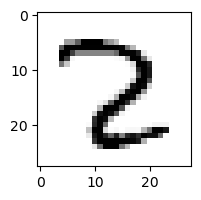

0.21516643392680626% - 0
0.027196401761254495% - 1
38.44239048970255% - 2
0.9532522840343618% - 3
0.25521462624495167% - 4
0.018800666357930693% - 5
0.0013343985169476933% - 6
5.946167360756132% - 7
41.590354140347166% - 8 - ОШИБКА
0.29300207515940435% - 9

 4


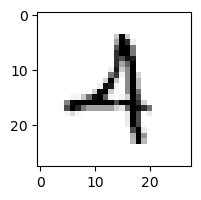

0.5824670083795641% - 0
0.15998113727272242% - 1
48.69158348851851% - 2 - ОШИБКА
38.10555985317379% - 3
10.095732687013225% - 4
0.04088087383028967% - 5
1.8407163320868762% - 6
0.07462677543287863% - 7
0.19291125228600747% - 8
30.768705524496458% - 9

 5


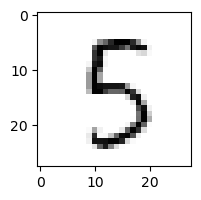

3.36424704615717% - 0
0.04061175472048765% - 1
0.9591952668750828% - 2
34.279242005891284% - 3
13.862373671635211% - 4
64.01707111837214% - 5
0.9636147206607073% - 6
0.04708498086869872% - 7
71.58725659295834% - 8 - ОШИБКА
0.44566300521131114% - 9

 7


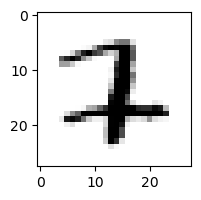

0.0008899347594676264% - 0
2.140326760222184% - 1
25.35927700101795% - 2 - ОШИБКА
0.9847984156319971% - 3
0.012704454848172769% - 4
0.004500316322031249% - 5
0.34938972081377695% - 6
0.2957299797702453% - 7
0.03196019727677647% - 8
0.018883427945107542% - 9

 8


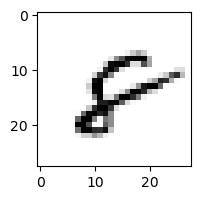

9.089838297403572% - 0
0.6713585629353841% - 1
2.7317163157865196% - 2
0.023431484771710524% - 3
3.736167803610519% - 4
1.933805143696741% - 5
23.52422608108706% - 6 - ОШИБКА
1.584490183584605% - 7
20.247130987544505% - 8
3.442067302608536% - 9

 7


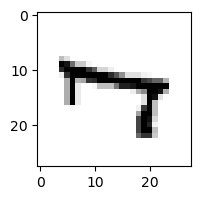

1.57027591670638% - 0
0.41135886259064774% - 1
0.0021406169462292375% - 2
1.3010882469108214% - 3
24.61261036971414% - 4
1.741076883287699% - 5
43.747874539918826% - 6
1.6320948232340717% - 7
3.3148016913561764% - 8
59.47953361453821% - 9 - ОШИБКА

 1


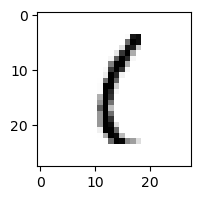

2.213647784854458% - 0
56.14077524024249% - 1
4.207753978749046% - 2
14.095915975395423% - 3
0.12684765919944363% - 4
19.70367301929637% - 5
38.26310687836131% - 6
0.722023308369983% - 7
65.62784363427684% - 8 - ОШИБКА
4.790017342178914% - 9

 8


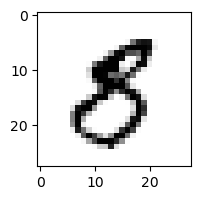

2.56413647096935% - 0
0.017009211961489978% - 1
0.01297128718926165% - 2
8.075765323928836% - 3 - ОШИБКА
0.10760451667858348% - 4
6.701406419992371% - 5
0.014302411858861525% - 6
0.013842992239950237% - 7
2.076233913365432% - 8
0.7449237689146545% - 9

 8


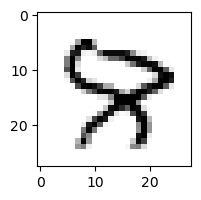

0.2374274795347909% - 0
0.009490277870783255% - 1
0.4990869427158537% - 2
0.18139907255165763% - 3
2.195920296256235% - 4 - ОШИБКА
0.03425278245492326% - 5
0.10658899938130985% - 6
0.5569534741361447% - 7
0.08398449943043547% - 8
1.0468114227588616% - 9

 7


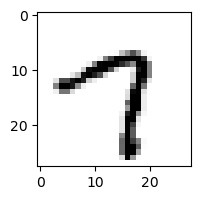

7.626822229644552% - 0
0.04271423011382572% - 1
0.029645553665012016% - 2
0.2766010147002103% - 3
0.7768326356376302% - 4
1.9925077398767401% - 5
0.06166027634561394% - 6
88.5815162786865% - 7
0.9479540024519494% - 8
91.87320287590255% - 9 - ОШИБКА

 2


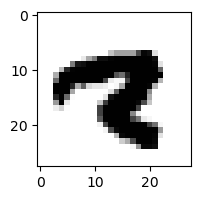

2.5630949109564907e-05% - 0
0.0008763004604217241% - 1
3.889832522239677e-05% - 2
5.794141293877445e-06% - 3
0.26428861409233284% - 4
0.002120993427788009% - 5
0.0003104238227633921% - 6
29.260133824269484% - 7 - ОШИБКА
0.0017114725827610104% - 8
0.4532505843698427% - 9

 8


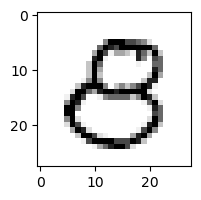

22.427306028394995% - 0 - ОШИБКА
0.001841445052379022% - 1
0.7201847093284568% - 2
2.0751266932622494% - 3
8.65872561258551% - 4
6.794310867987546% - 5
0.0013914258679586808% - 6
0.004900941494530567% - 7
5.208795863097272% - 8
0.21768672770423958% - 9

 8


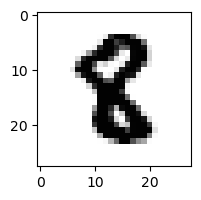

0.0002398147586377357% - 0
0.02332986819363717% - 1
0.09519373853010066% - 2
0.007108289013905332% - 3
0.017153423762776444% - 4
1.7165667217243366% - 5 - ОШИБКА
0.019236140904901448% - 6
0.00038918823216648715% - 7
0.876416663040411% - 8
9.511292963041507e-05% - 9

 3


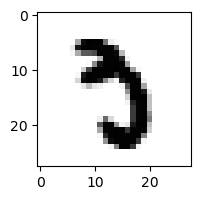

0.013123206037237631% - 0
0.001609458130600331% - 1
0.00362691684390624% - 2
5.747759612845705% - 3
0.03794195608828% - 4
2.844531934394849% - 5
0.09053640560957313% - 6
13.513494298835235% - 7 - ОШИБКА
0.008805276995440463% - 8
0.03452448049809406% - 9

 2


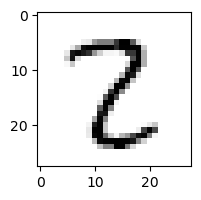

0.27345249624722817% - 0
5.856359120816519% - 1
29.004209047983455% - 2
25.049975763693226% - 3
0.18710322107265642% - 4
0.7909425145258846% - 5
0.0037487971604862873% - 6
0.26171092388204764% - 7
87.4828320825213% - 8 - ОШИБКА
0.03619886342799932% - 9

 2


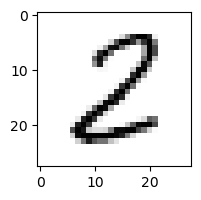

1.4592281690053015% - 0
0.9578108739352258% - 1
42.25052127845421% - 2
2.0571371657739497% - 3
0.09638721567669364% - 4
1.0131087660295937% - 5
0.23179478244403615% - 6
0.05881251911716949% - 7
86.04274587419457% - 8 - ОШИБКА
0.0055785271708482164% - 9

 5


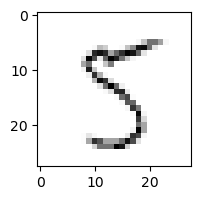

4.882619567668136% - 0
1.1795533640920617% - 1
1.6642973067175344% - 2
32.6347664267263% - 3
2.818870260597145% - 4
76.92597118488709% - 5
0.9089160360370447% - 6
5.608750892058163% - 7
86.62416870426425% - 8 - ОШИБКА
37.30086373953032% - 9

 8


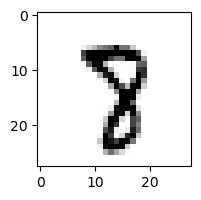

0.029797854113235128% - 0
0.015592062387687842% - 1
0.1848365904134504% - 2
0.8918506191052956% - 3
0.06396441462608135% - 4
2.1969549628664065% - 5
0.013583247915793678% - 6
26.21755713257339% - 7 - ОШИБКА
9.548362478879467% - 8
4.349718673469408% - 9

 6


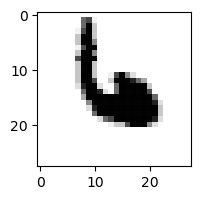

1.409964304459118e-05% - 0
0.004515686779544946% - 1
0.36864933386738946% - 2
0.006126266663264842% - 3
79.00748088769001% - 4 - ОШИБКА
0.04866787369484278% - 5
58.315610720425425% - 6
0.05899219836297193% - 7
0.001439894874605627% - 8
0.3652235539835875% - 9

 5


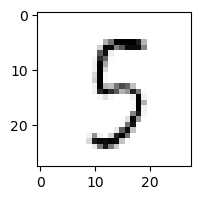

12.546826710472484% - 0
0.3247079065074656% - 1
2.845457845458663% - 2
64.29733167647596% - 3
13.5957125194916% - 4
49.38910261992689% - 5
5.4140129394868355% - 6
0.34107215575020494% - 7
89.79458628545294% - 8 - ОШИБКА
1.8077207284416301% - 9

 4


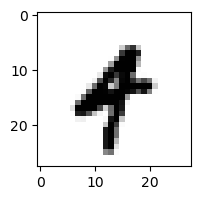

0.01018510649104947% - 0
0.9872021553230824% - 1
0.051042964950516134% - 2
0.11369770143764384% - 3
9.036111051562695% - 4
0.02236563193562854% - 5
1.3230056707319213% - 6
0.05408480202102352% - 7
0.18284734894291083% - 8
28.054161889819767% - 9 - ОШИБКА

 1


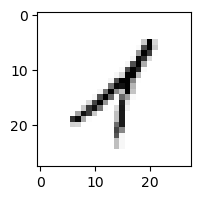

0.6580617008745797% - 0
33.2446018084166% - 1
25.25847316980414% - 2
14.926162969993465% - 3
64.06259245153058% - 4 - ОШИБКА
0.8835040257324435% - 5
1.9753296314687727% - 6
2.213002557236853% - 7
48.721124327466356% - 8
15.920961298389175% - 9

 8


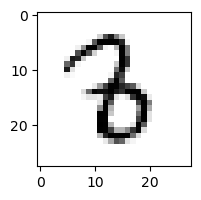

0.007216725776829926% - 0
1.4040912568992934% - 1
3.502850430702197% - 2
41.74847694798698% - 3 - ОШИБКА
0.15204775691715625% - 4
0.37267431011801866% - 5
3.3173551894999638% - 6
0.020453894605273908% - 7
0.28631942414649003% - 8
0.02237693225075247% - 9

 5


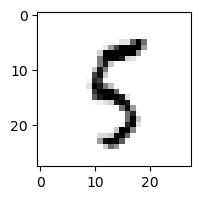

3.464572846239978% - 0
0.170292630345387% - 1
2.224791250766156% - 2
10.926777119333867% - 3
5.774499893940341% - 4
61.20984570998539% - 5
3.647608481442303% - 6
0.05735835434087447% - 7
66.149412543986% - 8 - ОШИБКА
55.011400049421844% - 9

 8


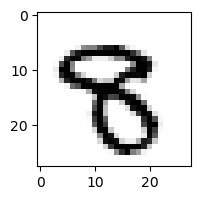

0.04769049868605781% - 0
0.0013864236609349716% - 1
0.02043271105044151% - 2
3.0618633331943523% - 3
0.07277976275144277% - 4
0.11280739828097325% - 5
0.007409622468753858% - 6
0.04175876106430556% - 7
3.3450528221742513% - 8
19.580921252746368% - 9 - ОШИБКА

 7


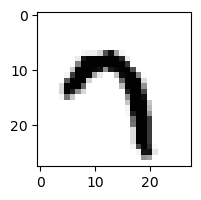

0.04489188989609289% - 0
0.017667976391464654% - 1
0.02453772205390829% - 2
0.2973572512203822% - 3
0.8270240121546901% - 4
3.0475027891344446% - 5
0.2045281747586218% - 6
67.23263692710061% - 7
0.012676940341336637% - 8
74.14826579215121% - 9 - ОШИБКА

 8


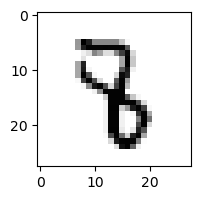

0.0005391986629583804% - 0
1.7597405098793577% - 1
0.38238079166677685% - 2
2.30437926099194% - 3
4.6509515010125835% - 4 - ОШИБКА
1.2760499176161002% - 5
0.17325450977974313% - 6
0.04805006273182275% - 7
0.22680708613022887% - 8
0.3324807487376159% - 9

 9


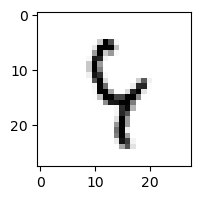

0.213248946758719% - 0
0.41935050859875905% - 1
9.351767624181587% - 2
2.5099771638402553% - 3
83.95600258658962% - 4 - ОШИБКА
30.356633555200315% - 5
15.90310663177579% - 6
2.8577109876071374% - 7
79.10102466306135% - 8
18.504729470844534% - 9

 5


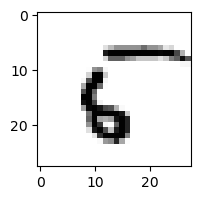

66.67342454262007% - 0 - ОШИБКА
0.09554140517067032% - 1
2.0633034193362185% - 2
0.004356829421208579% - 3
3.0987673145475165% - 4
61.73251400422558% - 5
18.09643341302431% - 6
0.07915903390140064% - 7
12.504487807830348% - 8
5.057507145879509% - 9

 5


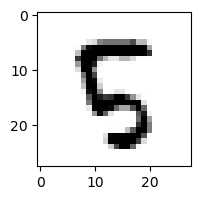

0.04785856581724008% - 0
0.0020972147667493632% - 1
5.455250015861425% - 2
0.01964819871285762% - 3
4.450451620390089% - 4
9.338546848797508% - 5
0.09005690357472262% - 6
0.02044967009889207% - 7
42.71793198044135% - 8 - ОШИБКА
0.5099092164156622% - 9

 2


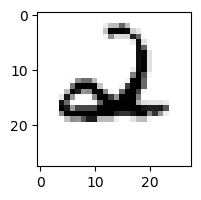

0.19836458267716048% - 0
0.014541986863251201% - 1
7.896088178353213% - 2
0.006221593421555616% - 3
87.62402844924483% - 4 - ОШИБКА
0.0026468273764294085% - 5
14.983859496468583% - 6
0.0608012853752501% - 7
0.14707089233947224% - 8
2.405084797588836% - 9

 4


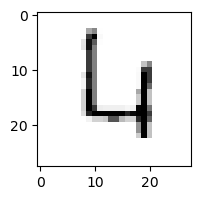

10.895157643574006% - 0
0.022010842289139083% - 1
65.0967977466569% - 2 - ОШИБКА
0.10545594938773287% - 3
28.817084484058718% - 4
0.8902895955598937% - 5
63.047951556587265% - 6
4.412705902412661% - 7
4.216551799441793% - 8
17.076758165981644% - 9

 5


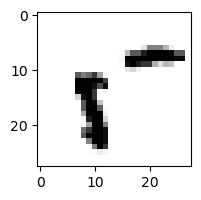

99.19831453635366% - 0 - ОШИБКА
0.03766947954426561% - 1
0.051875161777112065% - 2
0.07484333830178447% - 3
26.7826712741345% - 4
97.82015193940961% - 5
1.1156423242394666% - 6
0.28194489996834443% - 7
56.54293462048039% - 8
0.8114135149738763% - 9

 5


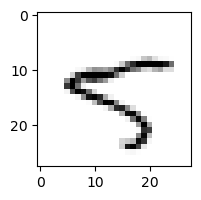

4.628447377969985% - 0
0.7094170242237869% - 1
0.03807391070033254% - 2
0.49728661197835616% - 3
60.06801029717806% - 4 - ОШИБКА
57.939083144963845% - 5
0.6595750340456542% - 6
3.8870747185803323% - 7
16.217860104896197% - 8
17.376039134032595% - 9

 9


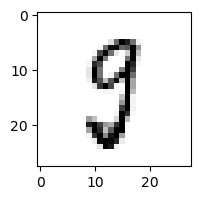

3.4055625570966983% - 0
0.2063717979386435% - 1
0.5239434263021328% - 2
24.305473767318006% - 3
0.7609084991322886% - 4
27.46088268357219% - 5
0.3549377161912336% - 6
2.887294644696818% - 7
36.6917694486895% - 8 - ОШИБКА
0.3298952513483507% - 9

 5


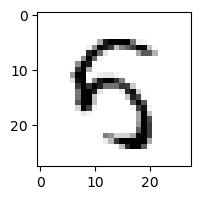

4.568677475509379% - 0
0.016821578498194566% - 1
0.20604255622189163% - 2
1.5693048748118121% - 3
69.25002730041312% - 4 - ОШИБКА
32.4534530229162% - 5
1.016602655542328% - 6
0.013267324096995797% - 7
5.370852112332491% - 8
1.6902547972763193% - 9

 8


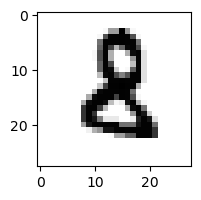

0.00850359110329484% - 0
0.015513015898387114% - 1
30.58596661052593% - 2 - ОШИБКА
1.4204737345758858% - 3
0.008780311112780857% - 4
0.0744013332993962% - 5
4.269522451898387% - 6
8.25653251802398e-05% - 7
0.7616867504618721% - 8
0.009235390825773385% - 9

 4


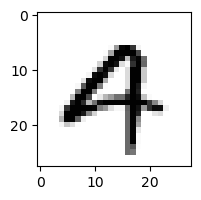

4.150408429002511% - 0
0.0006958670299545532% - 1
0.5993773770718138% - 2
0.16938985816047858% - 3
21.271771130606634% - 4
0.015163855287673262% - 5
0.2599399790155771% - 6
0.24489074173932496% - 7
0.0030847691106517913% - 8
49.677430996848834% - 9 - ОШИБКА

 8


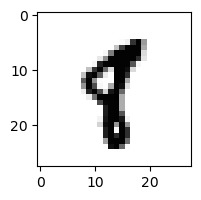

0.012567110334165953% - 0
17.23607066041547% - 1 - ОШИБКА
0.010637849054735107% - 2
0.013200558700933568% - 3
0.13387223086322786% - 4
5.135957540466447% - 5
0.12615208031898553% - 6
0.12364199246696285% - 7
0.08801177763856462% - 8
3.4558737235163712% - 9

 5


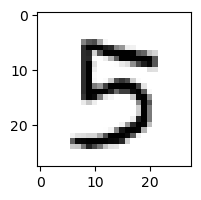

0.8478857338020409% - 0
0.0023281279672737417% - 1
0.006802413596953514% - 2
75.85117368072025% - 3 - ОШИБКА
0.6626538077613278% - 4
24.63096769257929% - 5
0.006629646895077196% - 6
0.05376781638197168% - 7
0.07321710863937174% - 8
2.521703489748819% - 9

 8


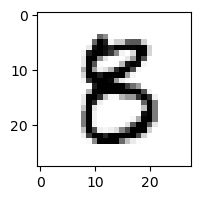

0.7999892183618444% - 0
0.0020785055381638833% - 1
0.03148586352389655% - 2
17.877837383381255% - 3
0.09387336876810798% - 4
34.492366892868304% - 5 - ОШИБКА
0.007684932453970919% - 6
0.001358550690585403% - 7
0.5884252611927038% - 8
0.004702465659786824% - 9

 6


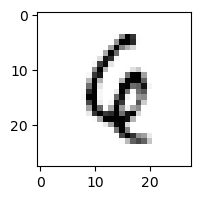

0.063641804988112% - 0
0.2786204743614749% - 1
6.7197468628433645% - 2
0.009483793794954114% - 3
51.5504663237803% - 4 - ОШИБКА
0.1802414436064001% - 5
36.47726979456346% - 6
0.6494380734294217% - 7
1.1926101663487791% - 8
11.180736901935749% - 9

 6


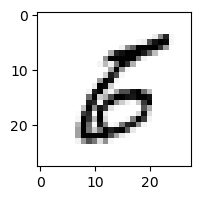

4.335196080381825% - 0
0.18977601769555594% - 1
0.7815237998476332% - 2
2.8473766476647526% - 3
0.05523534824947828% - 4
11.124064465536941% - 5 - ОШИБКА
8.436312024388753% - 6
0.02492332946526483% - 7
0.19568807985041237% - 8
0.06479775644554644% - 9

 4


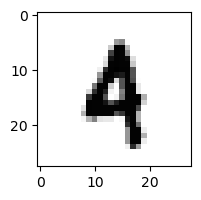

0.001762065444705456% - 0
0.26889333963159895% - 1
1.32142277115867% - 2
0.28219218578015914% - 3
8.336185204322186% - 4
0.0238701819773322% - 5
3.9985257440028703% - 6
0.12943927958771248% - 7
0.5342836711230098% - 8
17.583026446272935% - 9 - ОШИБКА

 1


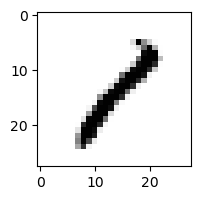

0.40446285639854407% - 0
50.959557623929705% - 1
11.150212520179712% - 2
2.9257528916325275% - 3
3.6864701560847006% - 4
0.19374446259999162% - 5
0.20825046036042383% - 6
1.4401860882722248% - 7
93.57308488826253% - 8 - ОШИБКА
0.9296847585422119% - 9

 7


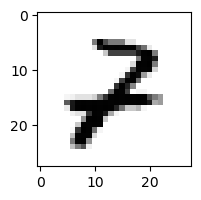

0.59383480185329% - 0
0.3178498096852148% - 1
56.97773987711036% - 2 - ОШИБКА
0.627501662476629% - 3
1.4380154078007992% - 4
0.000645545273647693% - 5
0.02591258785051648% - 6
0.12441855520925402% - 7
3.1875828885213284% - 8
1.3012202735047425% - 9

 7


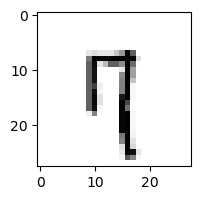

0.9317380459876173% - 0
0.5459591873080402% - 1
4.572303096542493% - 2
1.2795974317742853% - 3
11.892780814343244% - 4
2.707930988267217% - 5
3.278415999397927% - 6
32.08647949083393% - 7
1.633962132468935% - 8
81.55802517610911% - 9 - ОШИБКА

 5


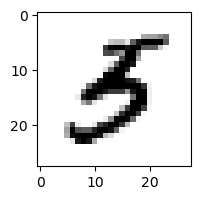

0.37523296568922565% - 0
0.21118751560300894% - 1
0.021534544650114885% - 2
73.08496673090968% - 3 - ОШИБКА
0.23238329197120003% - 4
17.792750571148545% - 5
0.5646333862709041% - 6
0.006780970688488283% - 7
7.690637445563653e-05% - 8
0.13354203818287347% - 9

 5


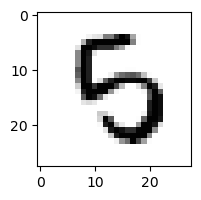

0.19495257781524436% - 0
0.015900563261053772% - 1
0.8350794344902317% - 2
5.472474386912642% - 3
1.0905142660469092% - 4
3.3249806552240004% - 5
19.688609825570573% - 6 - ОШИБКА
0.0015518835835977487% - 7
0.021057558553094085% - 8
0.022974709453556435% - 9

 5


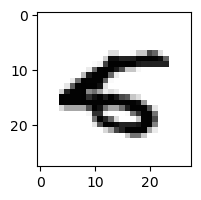

0.8260472173816045% - 0
0.0029029430477923892% - 1
0.012456544602819863% - 2
0.0006285366493589994% - 3
16.466597972747632% - 4 - ОШИБКА
2.239094129112578% - 5
2.5123724078878937% - 6
0.01378774297887963% - 7
0.001015184367339296% - 8
0.11228967626944267% - 9

 4


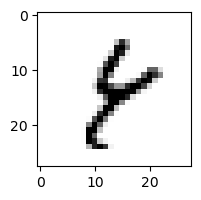

0.16488172286186856% - 0
5.370065676748602% - 1
1.0044871976196035% - 2
0.7291485650918377% - 3
0.8516316750690432% - 4
0.6832855923175052% - 5
14.317895299600133% - 6
0.3427750476915273% - 7
97.22497377181065% - 8 - ОШИБКА
72.12912522946483% - 9

 2


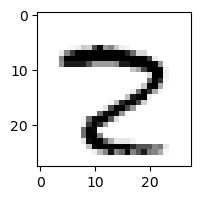

3.692609920436205% - 0
0.004552009617348497% - 1
2.114236370670074% - 2
0.11226234296294331% - 3
0.0019283529514056497% - 4
0.10956910648274128% - 5
0.0005985791267418806% - 6
98.99386597479392% - 7 - ОШИБКА
3.710258623199112% - 8
0.8179081102200957% - 9

 4


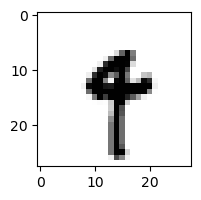

0.0014108164377031195% - 0
3.7778827475611% - 1
0.000864376235956495% - 2
0.3538279416457275% - 3
10.488416683148909% - 4
1.6113104729270917% - 5
1.0981551652556816% - 6
1.066275937145629% - 7
0.08820782006160967% - 8
59.370724439354596% - 9 - ОШИБКА

 8


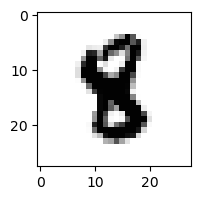

0.00022464078919768492% - 0
0.011210160096753746% - 1
0.009212220143694822% - 2
0.05484215685466807% - 3
0.3119654713862347% - 4
3.2992699651769866% - 5 - ОШИБКА
0.9184024161646789% - 6
0.0007536633331600609% - 7
3.1484812680180427% - 8
0.0029227486641734395% - 9

 7


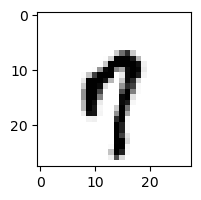

1.274774736330894% - 0
0.1255029777005844% - 1
0.035326324108533626% - 2
0.40732969441939215% - 3
48.68873463471628% - 4 - ОШИБКА
0.5854996280618908% - 5
2.2349188567020346% - 6
13.676958228965109% - 7
0.33604354035444634% - 8
46.356686813747864% - 9

 5


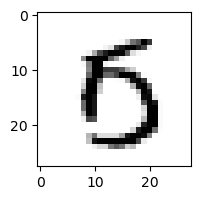

27.64532437330804% - 0 - ОШИБКА
0.0015916190297568928% - 1
0.14510579435895654% - 2
0.20492628581956074% - 3
0.5591660175113884% - 4
10.339616739408704% - 5
0.19320770088407632% - 6
0.2625015962269329% - 7
1.4144224073228624% - 8
6.770581138190416% - 9

 8


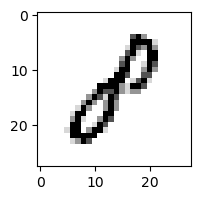

1.38966086267152% - 0
23.754482537269816% - 1 - ОШИБКА
5.55913151246144% - 2
5.5841202944757145% - 3
0.645284964754248% - 4
1.5134695186540001% - 5
0.18892591734370168% - 6
0.024263564489346457% - 7
1.7972049504008614% - 8
0.5479659389729262% - 9

 2


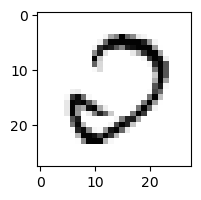

97.9905697171524% - 0 - ОШИБКА
0.01822039955095777% - 1
62.1581368792892% - 2
1.756174719413557% - 3
0.2382042879929233% - 4
0.17634689988687186% - 5
1.670098871936193% - 6
0.08913873062003147% - 7
10.731143247037238% - 8
0.0009449643138472151% - 9

 8


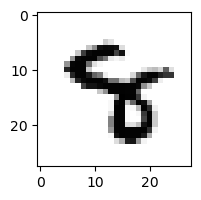

0.0010149447149146514% - 0
0.004527966696242105% - 1
0.010999472378229827% - 2
0.060560117054325444% - 3
7.204792847411462% - 4 - ОШИБКА
0.37960238970711574% - 5
0.7937524008366236% - 6
0.16514938343984625% - 7
2.7247253402724327% - 8
4.844380300865906% - 9

 3


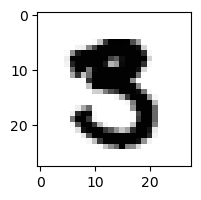

0.03161771784537102% - 0
2.4842851961865717e-05% - 1
0.0025922853867681485% - 2
2.6490343171343524% - 3
6.046440663693868e-05% - 4
7.598693102011075% - 5 - ОШИБКА
6.111299498462438e-06% - 6
0.031003854452788724% - 7
0.1092229306859063% - 8
9.783058568184664e-05% - 9

 8


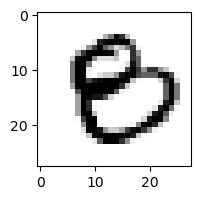

32.43861362327574% - 0 - ОШИБКА
0.0008446043580671312% - 1
0.05921914637003527% - 2
0.4958308770569007% - 3
0.04682891239214567% - 4
0.28534524531434524% - 5
0.020835590485192446% - 6
0.00012700163370361333% - 7
2.137533640481951% - 8
0.007910460287375408% - 9

 3


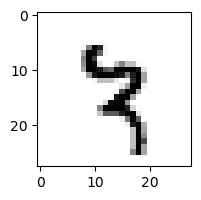

0.0012118231806952124% - 0
1.2256086255962926% - 1
1.0696201556905915% - 2
0.1827545288808881% - 3
21.326210475927144% - 4
0.7427940509719979% - 5
0.7323134760402914% - 6
59.80588550509683% - 7 - ОШИБКА
12.890167261444201% - 8
1.6328169802169088% - 9

 2


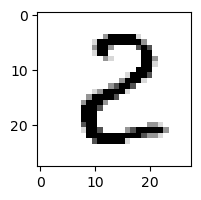

12.671745450049436% - 0
0.16963913574898543% - 1
87.01946089769545% - 2
2.6692373115116808% - 3
0.45829493959225226% - 4
0.4363604123532011% - 5
0.018529193864603204% - 6
0.0017884026650859728% - 7
97.01624728968801% - 8 - ОШИБКА
0.0278780744033264% - 9

 7


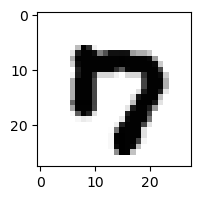

48.12964717571976% - 0 - ОШИБКА
3.1477478643849726e-06% - 1
0.00019720040893934899% - 2
0.0011757962972385883% - 3
0.035185145399455414% - 4
0.001917698518253134% - 5
0.006630888034099507% - 6
32.62334265966382% - 7
0.00023087988278425083% - 8
0.4273855716644521% - 9

 6


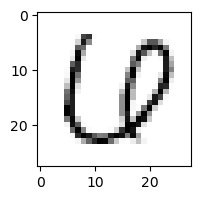

7.904154969203403% - 0
0.06221741279118297% - 1
0.4490117168464935% - 2
15.870385454160552% - 3 - ОШИБКА
13.371791349348436% - 4
0.7926998587754654% - 5
0.04654463787804696% - 6
1.926068961478057% - 7
0.09407136649425625% - 8
0.0013994896213114676% - 9

 8


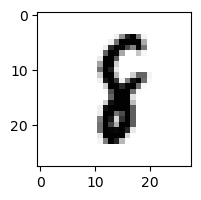

0.001792235230300111% - 0
4.208285454238828% - 1
0.45146545958641227% - 2
0.11489898750826652% - 3
0.36009349009325264% - 4
0.4348646094371664% - 5
10.79139795749952% - 6 - ОШИБКА
0.08099049166974792% - 7
10.043808486369816% - 8
0.1577554836036321% - 9

 5


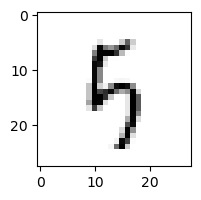

1.5386217156237587% - 0
0.10685596519435434% - 1
6.7862377520481285% - 2
14.540078388546378% - 3
41.235812353457085% - 4
31.769244204536445% - 5
20.643599842329394% - 6
0.15406872515324155% - 7
56.50830451799439% - 8
70.08841103714416% - 9 - ОШИБКА

 9


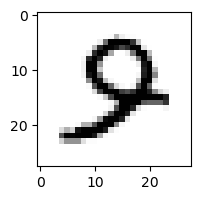

0.4711327671747034% - 0
0.00428668413028884% - 1
1.736518376372596% - 2
0.24128347983608447% - 3
2.0949396598230168% - 4
3.0329421328760517% - 5 - ОШИБКА
0.22919802693205119% - 6
0.7831493191738844% - 7
0.9501652951894818% - 8
0.06408601412518924% - 9

 4


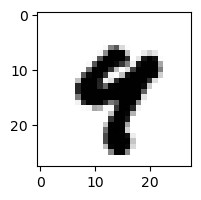

0.00208086629428841% - 0
0.000638826547727663% - 1
1.7778649816222544e-05% - 2
0.0010524686602341575% - 3
17.59740266850656% - 4
0.022856076336648264% - 5
0.004145366243780176% - 6
0.19005876901749413% - 7
0.08028135836726823% - 8
63.19629551144885% - 9 - ОШИБКА

 5


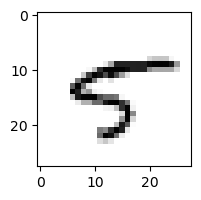

7.6788959409776005% - 0
0.5994414266192544% - 1
0.014854155266359293% - 2
0.36585008069818303% - 3
41.499782469477495% - 4 - ОШИБКА
26.331828422054183% - 5
1.237668020028035% - 6
7.037091089630105% - 7
2.2118255051009537% - 8
2.038887822736366% - 9

 6


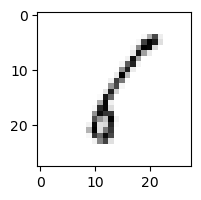

8.511487809557078% - 0
82.21091762568243% - 1 - ОШИБКА
15.160549032624063% - 2
4.06936749090394% - 3
4.1573971612835585% - 4
24.0148521544764% - 5
12.568412053993722% - 6
2.569732909998971% - 7
42.10930452253614% - 8
2.054711975572824% - 9

 2


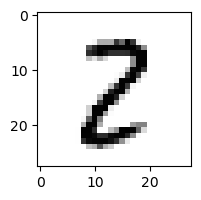

1.5736576318074422% - 0
1.3916403849246888% - 1
12.040039376233846% - 2
17.874299126408637% - 3
0.013572734480771079% - 4
0.33398822993421245% - 5
0.006638134446153034% - 6
0.03373530672457021% - 7
92.9948906628143% - 8 - ОШИБКА
0.19557944670830266% - 9

 4


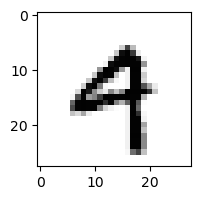

0.38477557438878635% - 0
0.01473598601359868% - 1
0.15694076758970238% - 2
0.4586569396753974% - 3
37.921046495509195% - 4
0.031967816258715635% - 5
0.46337996900014516% - 6
0.22626563908151454% - 7
0.01252531625376285% - 8
58.05444335868647% - 9 - ОШИБКА

 8


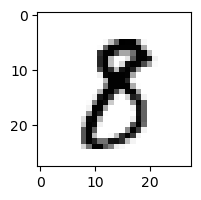

0.33826074549169305% - 0
0.4568225764647407% - 1
0.13633567199528962% - 2
47.386066805396545% - 3 - ОШИБКА
0.0050884941787814305% - 4
1.47922132170074% - 5
0.002813013190402737% - 6
0.049049049416349536% - 7
16.131330567010654% - 8
0.04053169983466759% - 9

 8


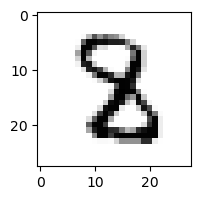

0.0006598825919662245% - 0
0.34862163025824067% - 1
4.999737935256012% - 2 - ОШИБКА
0.2253327438315802% - 3
0.42441197400545966% - 4
0.33072227887271394% - 5
0.04178202088724766% - 6
0.17192709848175872% - 7
0.7413547447873711% - 8
0.00042953322912603836% - 9

 8


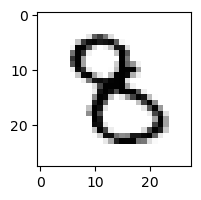

0.028289646079939286% - 0
0.145774868897302% - 1
2.5925530770400917% - 2
19.14123513442408% - 3 - ОШИБКА
0.15803144903542496% - 4
0.5839484066356011% - 5
0.25164142462329475% - 6
0.01530306577813702% - 7
4.7031569246754215% - 8
0.2944482844104163% - 9

 1


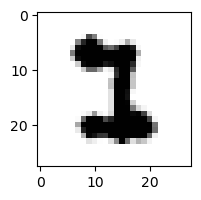

0.00027930231565212867% - 0
0.014569466467615056% - 1
31.5939878767032% - 2 - ОШИБКА
0.42868913298525% - 3
1.2648871010341719e-05% - 4
0.5923778517954977% - 5
0.010871661238386426% - 6
0.12602480311434083% - 7
0.0012727998995715024% - 8
7.216777510686911e-05% - 9

 0


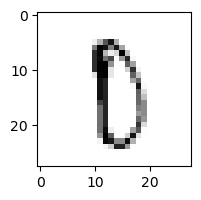

5.9906098050563354% - 0
0.03624852757095157% - 1
4.642327859683207% - 2
5.645823424729358% - 3
1.0751811221736687% - 4
43.653588968493324% - 5
6.204187437208362% - 6
3.4304962149530827% - 7
96.58773850700267% - 8 - ОШИБКА
8.524845114132267% - 9

 2


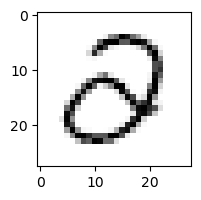

23.19628227827924% - 0
0.03588667149746452% - 1
0.17100293234033054% - 2
56.2146059166884% - 3 - ОШИБКА
12.903647124095324% - 4
1.1667656921069616% - 5
0.6687999844732425% - 6
0.02294423343284332% - 7
0.2204004638581172% - 8
0.0009696960589506361% - 9

 9


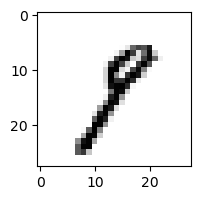

0.21487822256221384% - 0
86.43115183288047% - 1 - ОШИБКА
0.4170093211714664% - 2
21.724762943798755% - 3
0.08690195907343595% - 4
1.0381522724856016% - 5
0.1666771181004749% - 6
14.387399353183639% - 7
13.592510730747973% - 8
5.222202876030573% - 9

 2


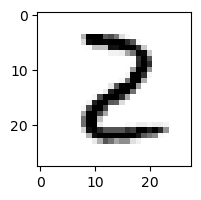

0.7182490883491006% - 0
0.29171754394088384% - 1
91.13580099379415% - 2
2.4376320959645414% - 3
0.09834369902145361% - 4
0.03432141792107239% - 5
0.04451430647512739% - 6
0.004128795192109101% - 7
95.90155119503572% - 8 - ОШИБКА
0.09280139968425181% - 9

 5


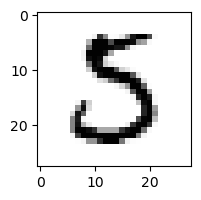

1.0248280552517115% - 0
0.004723090475108671% - 1
3.3259072476536167% - 2
28.56146184641226% - 3 - ОШИБКА
0.007014454952482313% - 4
11.043447238831762% - 5
0.038131773603899806% - 6
0.16539693477607328% - 7
0.32995866305572114% - 8
0.00035010616148448506% - 9

 8


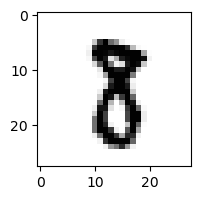

0.00950993773258724% - 0
0.5849098477006595% - 1
0.20056383951941137% - 2
22.472998604602274% - 3 - ОШИБКА
0.0016463873051269866% - 4
0.4476194246394312% - 5
0.009779319874056534% - 6
0.1673245150584467% - 7
3.9203823049556004% - 8
0.1085517219070075% - 9

 6


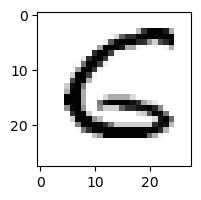

2.9166993769820584% - 0
0.0018756618531491085% - 1
55.3563409827059% - 2 - ОШИБКА
0.0008893094986960464% - 3
0.1588424730682944% - 4
32.1284892816917% - 5
19.80109341737473% - 6
0.0022166738034169993% - 7
0.0680874667808661% - 8
0.0006537637054627222% - 9

 5


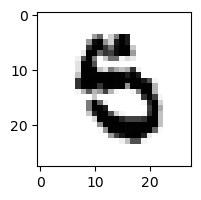

0.005399703829843486% - 0
0.0009433110937365906% - 1
0.023275358396903104% - 2
0.03576113718733635% - 3
0.005268395971774461% - 4
0.38787110545498826% - 5
12.515216903090733% - 6 - ОШИБКА
0.0008372758904948954% - 7
0.02027455549793274% - 8
0.2708602142049132% - 9

 3


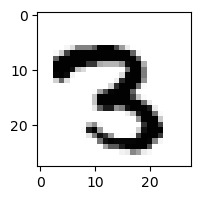

7.225323339242648e-05% - 0
0.002975590129873156% - 1
10.793545357070535% - 2 - ОШИБКА
4.174875208436293% - 3
0.025518591740058563% - 4
0.025700783047010463% - 5
6.143277841263715e-05% - 6
1.4779953090742073% - 7
1.399107599965773% - 8
0.5592113755752591% - 9

 9


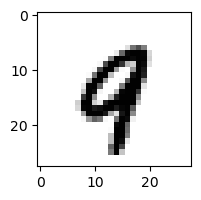

0.08735193572280271% - 0
0.024087389773879347% - 1
0.05298012986099282% - 2
0.0012470018699110115% - 3
34.54849277298071% - 4 - ОШИБКА
0.007480870550553701% - 5
0.4401572534087907% - 6
2.4742681419252093% - 7
0.30821926738422156% - 8
16.04997289868295% - 9

 8


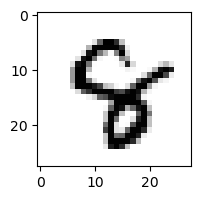

0.005179416240501839% - 0
0.0021975624053412737% - 1
0.05448927852619688% - 2
0.022980368944771096% - 3
9.502301937373462% - 4 - ОШИБКА
0.4025678989933066% - 5
0.3199740459951659% - 6
0.05586829803603933% - 7
1.1538586490688054% - 8
0.33944762009504453% - 9

 1


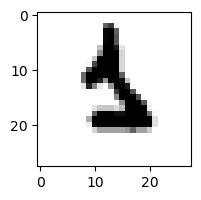

0.00142236150223489% - 0
0.05797797316571039% - 1
0.11141031627757225% - 2
0.019908801318615638% - 3
0.0052093524837715606% - 4
2.249844914103584% - 5
48.14487782114856% - 6 - ОШИБКА
0.14562845805653293% - 7
0.019207322137056195% - 8
0.09433392961109202% - 9

 8


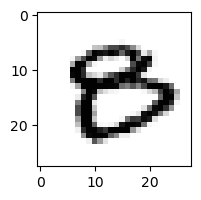

70.14417652213241% - 0 - ОШИБКА
0.0003008839154374966% - 1
0.002576844709351134% - 2
1.4973772702236456% - 3
0.006113148354403578% - 4
0.17454942799102752% - 5
0.7211286167262138% - 6
0.0053067701820047304% - 7
0.04246788074118482% - 8
0.35396388118569416% - 9

 9


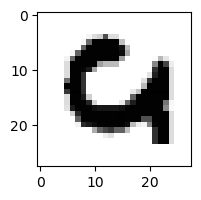

5.6090651451231315% - 0
1.7732410753131992e-06% - 1
55.02885348745119% - 2 - ОШИБКА
6.751499471792784e-06% - 3
0.0004072019668865125% - 4
8.477679162837717e-05% - 5
36.99118265152133% - 6
0.03735463840457677% - 7
0.00042568105789789917% - 8
0.002130909678104103% - 9

 8


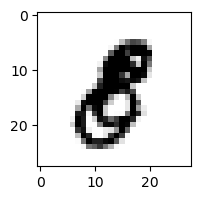

0.5356242303466809% - 0
0.018575093982056888% - 1
0.03045144598833542% - 2
4.293801482717826% - 3 - ОШИБКА
0.002567032161817028% - 4
0.037996416937378825% - 5
0.0238894619044619% - 6
0.004772302715876548% - 7
0.15053954261434635% - 8
0.26018380035879474% - 9

 2


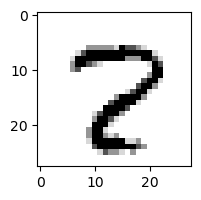

0.5034695179902591% - 0
0.011287439626042367% - 1
1.358486053273204% - 2
0.020881378012531253% - 3
0.028418406918455607% - 4
0.44839367873905167% - 5
0.004058017501667866% - 6
85.37422102651138% - 7 - ОШИБКА
61.78928897730488% - 8
1.8818940868957412% - 9

 7


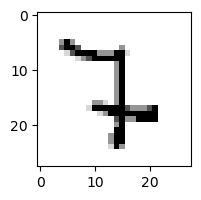

0.01719579607041564% - 0
4.7311191907616115% - 1
18.909500892216315% - 2 - ОШИБКА
3.1087688027736293% - 3
0.2015620892470169% - 4
0.31974155445074826% - 5
4.625623152282982% - 6
9.682511207890238% - 7
0.8628703419458249% - 8
1.2240849496075246% - 9

 5


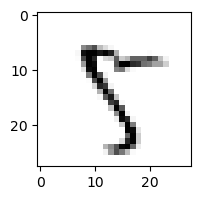

0.4624085864921998% - 0
0.6508087126299275% - 1
2.018106394997785% - 2
2.815626202096096% - 3
4.57173563739111% - 4
63.498092627643% - 5
0.1645489553228631% - 6
39.275118426353124% - 7
69.01598390433628% - 8 - ОШИБКА
2.065856446518191% - 9

 1


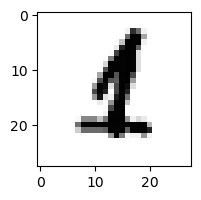

0.004706138609967875% - 0
3.887600291113094% - 1
0.8422672006632471% - 2
2.0047904785938946% - 3
0.013550988709626224% - 4
3.0860567648478727% - 5
8.023194023043828% - 6 - ОШИБКА
0.02886903783209927% - 7
0.007137626443615092% - 8
0.02269349700184023% - 9

 5


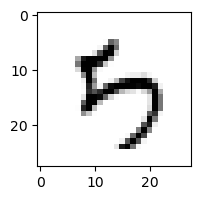

1.2652877157000546% - 0
0.06928242366125563% - 1
2.753882319105892% - 2
0.7023575747757328% - 3
13.391233799635799% - 4
4.96375640548831% - 5
15.461801919474317% - 6
0.0843459436256183% - 7
37.094597830733115% - 8
84.33677137827654% - 9 - ОШИБКА

 4


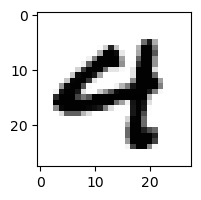

0.22920435193431626% - 0
0.0002825527085528422% - 1
0.012069341986382152% - 2
0.00012313671566370382% - 3
20.840413067587072% - 4
0.0018859494350486074% - 5
0.010643360460316472% - 6
0.04925825976934517% - 7
0.02084585073754685% - 8
64.24497168489872% - 9 - ОШИБКА

 2


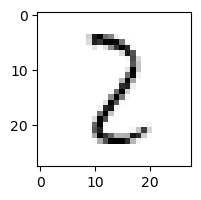

0.95112915010857% - 0
28.266108406039496% - 1
53.563920637204134% - 2
17.18860360857849% - 3
2.1884907160989697% - 4
0.9902352885863391% - 5
0.7880270685260565% - 6
1.6275541859888114% - 7
83.65726643106254% - 8 - ОШИБКА
1.6232287984783453% - 9

 0


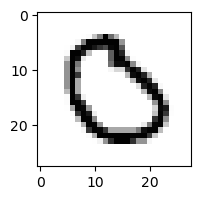

58.246512375494945% - 0
0.0070838823899053325% - 1
76.08118997566184% - 2 - ОШИБКА
2.4507974176203264% - 3
0.003801608094908253% - 4
0.007418848108130516% - 5
0.022538053038135296% - 6
0.5460584990979792% - 7
0.11488877323505078% - 8
0.05619578681757019% - 9

 9


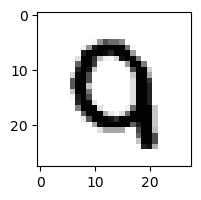

23.409334107336928% - 0 - ОШИБКА
3.070145191440547e-05% - 1
16.156340936401957% - 2
0.008286018040043997% - 3
0.007014084427091914% - 4
0.024022760818004103% - 5
7.252404091383298% - 6
0.1634909950020985% - 7
0.004790089021602464% - 8
5.053193948159915% - 9

 9


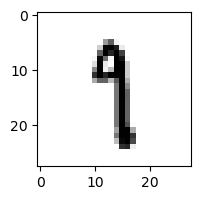

0.043795475703999935% - 0
31.38949255666233% - 1 - ОШИБКА
0.30589838776459116% - 2
9.094782292059048% - 3
0.9637941214251843% - 4
7.944741269415603% - 5
0.9733059147946364% - 6
12.084278176166945% - 7
4.634748545418448% - 8
8.934559510579891% - 9

 8


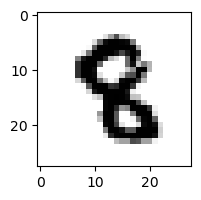

6.183728141737281e-05% - 0
0.0017823966992232278% - 1
0.8074756525455875% - 2 - ОШИБКА
0.019767981295088517% - 3
0.26548764466852137% - 4
0.35149963254438554% - 5
0.015002131301717911% - 6
0.0019125486989063124% - 7
0.24971478085873594% - 8
0.10624464556315383% - 9

 8


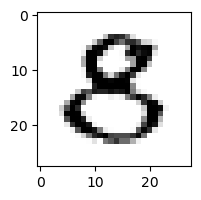

2.107379361743763% - 0
0.0011973340454858763% - 1
0.6554661434192225% - 2
17.47209781435114% - 3
0.32833105121842204% - 4
18.119630600677542% - 5 - ОШИБКА
0.00018998226727832035% - 6
0.0007967105730284147% - 7
0.023610406902915375% - 8
0.0004122863103454602% - 9

 4


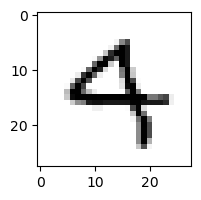

0.19732226445886178% - 0
0.022384933570310482% - 1
0.5697839008388819% - 2
0.390090672636894% - 3
33.61170763463777% - 4
0.21733385966979224% - 5
2.4763349114127564% - 6
0.5120226884999799% - 7
0.004680306224960316% - 8
87.13608326395558% - 9 - ОШИБКА

 8


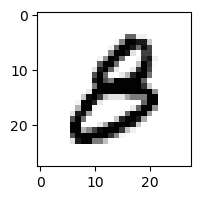

2.8774708223908383% - 0
0.0004708859158640822% - 1
0.042564832177212145% - 2
12.361829971706428% - 3 - ОШИБКА
0.0671320453664706% - 4
0.31377130834507033% - 5
0.49382106800706804% - 6
0.0014007337373127414% - 7
0.027003800599755642% - 8
0.3247248924043442% - 9

 2


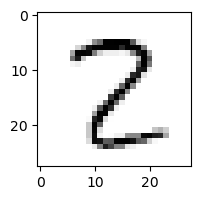

0.5098174090699393% - 0
2.4302013937506475% - 1
57.42901096729109% - 2
9.250850618725206% - 3
0.7737400308054339% - 4
0.3403175300737437% - 5
0.014046290405143349% - 6
1.4165784904320082% - 7
98.03647901182775% - 8 - ОШИБКА
0.062242040916569624% - 9

 5


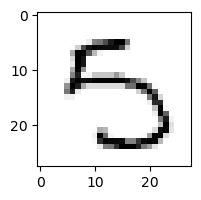

2.385213946104038% - 0
0.1743612494417354% - 1
0.08561094551924749% - 2
17.6358515505268% - 3
7.280874249939799% - 4
20.715892863599656% - 5
0.3358946431667496% - 6
1.6173046045928914% - 7
63.03847305014032% - 8 - ОШИБКА
4.010702667976459% - 9

 4


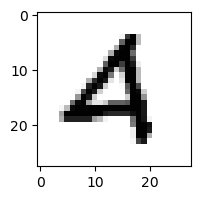

0.2867673545962434% - 0
0.0009775657676169079% - 1
21.63289231654683% - 2 - ОШИБКА
0.00922564896823799% - 3
8.068913285908907% - 4
0.007118942100914379% - 5
0.7871054733226239% - 6
0.041565247181808325% - 7
0.0020574153581140804% - 8
2.4595498197301513% - 9

 9


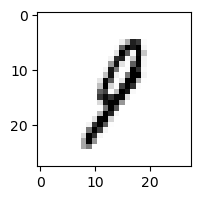

0.2512532167360028% - 0
33.51203776146886% - 1
9.671980962755132% - 2
16.26814709591803% - 3
1.4441978610722706% - 4
2.022868684918549% - 5
4.988585885101743% - 6
2.263824983992966% - 7
66.16909959628707% - 8 - ОШИБКА
12.3199584509014% - 9

 3


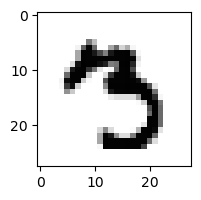

0.003965275108443445% - 0
0.02585082428192081% - 1
0.001623100874940815% - 2
5.273466746586672% - 3
0.002790464248335063% - 4
1.0119377283743145% - 5
0.0005071620611143865% - 6
7.479356719909883% - 7
0.11771287206395384% - 8
9.209330560844991% - 9 - ОШИБКА

 9


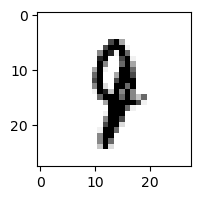

0.001545103309771456% - 0
2.9995058848072955% - 1
0.3658488082667171% - 2
0.907673510853077% - 3
13.256333262655707% - 4 - ОШИБКА
0.7945638245269835% - 5
0.3274980296246518% - 6
1.1922002764574842% - 7
0.8944218470230697% - 8
6.767807983547483% - 9

 6


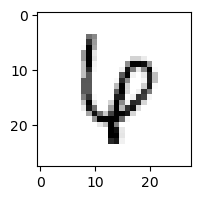

0.23724491210783483% - 0
1.0255142931889047% - 1
1.3675990579155166% - 2
0.025804677276624777% - 3
55.698709137418525% - 4 - ОШИБКА
0.12077664975406066% - 5
5.121112344281823% - 6
31.243219149062483% - 7
0.6204358094516662% - 8
1.4733912376612928% - 9

 8


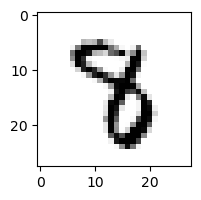

0.00022428375645050717% - 0
0.7711208321818098% - 1
0.11803378922861173% - 2
3.1286975112019166% - 3 - ОШИБКА
1.5087022028862818% - 4
0.67146391825344% - 5
0.015954946444718753% - 6
1.9545652624594245% - 7
0.11412467534156745% - 8
0.018811065603221% - 9

 2


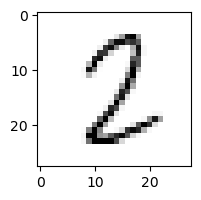

1.5123619021679624% - 0
4.4627528804665415% - 1
38.33319774583438% - 2
2.7179205209664925% - 3
1.0100419993650216% - 4
9.276904772267988% - 5
0.32543334030853227% - 6
3.345730317306543% - 7
40.91232565947813% - 8 - ОШИБКА
0.030990732649812683% - 9

 0


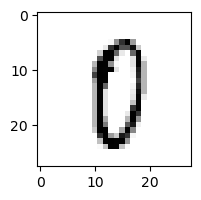

47.734365458123904% - 0
0.005682895017255061% - 1
0.5279180057626643% - 2
2.094451172924238% - 3
0.5226942089970995% - 4
32.70355183147401% - 5
4.478257540110937% - 6
1.180922209694388% - 7
88.88022793411676% - 8 - ОШИБКА
3.0731134884591977% - 9

 5


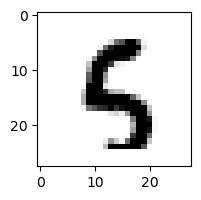

0.04333611514215095% - 0
0.0007589936159454211% - 1
4.157434814485671% - 2
0.017501267221097398% - 3
7.794208933114974% - 4
12.68630262861257% - 5
0.6217840034918675% - 6
0.0021108710201633183% - 7
5.478695769844653% - 8
27.923232916520995% - 9 - ОШИБКА

 2


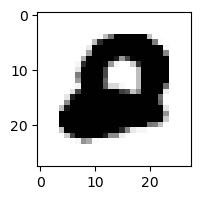

0.6950133771060556% - 0 - ОШИБКА
4.811155277005852e-09% - 1
0.37444014670690434% - 2
2.685751223779663e-07% - 3
0.00021408899672261755% - 4
0.0009861674180240455% - 5
0.008669039094692873% - 6
8.396307430702307e-07% - 7
4.000012267119815e-05% - 8
8.541623591713156e-07% - 9

 2


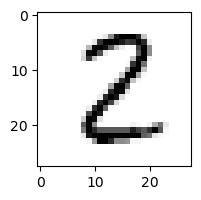

0.6824312467140207% - 0
3.590341127845625% - 1
54.83151801297454% - 2
4.351881485014316% - 3
0.11894465984696166% - 4
1.384773034305514% - 5
0.01595009944512542% - 6
0.015790555012874852% - 7
76.51544845388652% - 8 - ОШИБКА
0.0010309871816647444% - 9

 5


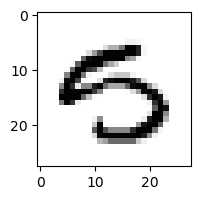

6.9031026117355205% - 0
0.003675391476940416% - 1
0.013060035401838766% - 2
0.4191839675697048% - 3
0.08172899544749791% - 4
25.9736918721797% - 5
0.35734763519601337% - 6
0.03850565355662596% - 7
0.058408864322910724% - 8
26.719063825046057% - 9 - ОШИБКА

 2


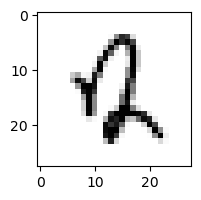

2.382543538932511% - 0
0.009611561519742606% - 1
10.255658231419758% - 2
0.0589092175899902% - 3
22.548689525741587% - 4 - ОШИБКА
1.6567106734014607% - 5
9.15853928693256% - 6
0.2730582084797033% - 7
0.09882636973947705% - 8
1.839380654642792% - 9

 9


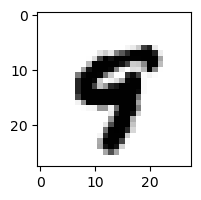

0.0026411123490039093% - 0
0.001118884871422767% - 1
4.068737958660673e-05% - 2
0.001053664778814193% - 3
22.031933881605415% - 4 - ОШИБКА
1.7174861096548346% - 5
0.008628004922338285% - 6
0.14917176204879656% - 7
0.016624769569881005% - 8
6.322822736673069% - 9

 7


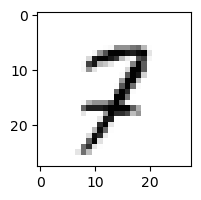

0.1639040557372782% - 0
2.325719562825475% - 1
31.21430570844946% - 2
0.4224062700503058% - 3
1.9886803571539369% - 4
0.12752810863142489% - 5
0.32050914825910837% - 6
39.87808960671554% - 7
26.56875485382154% - 8
59.67896366973457% - 9 - ОШИБКА

 7


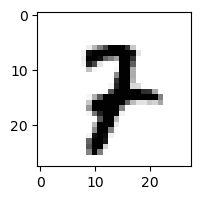

0.0013803130946653157% - 0
2.0562593516501946% - 1
1.1921422483496082% - 2
0.26025451114339926% - 3
0.09510626729457772% - 4
0.0327286057130242% - 5
0.37323003065020516% - 6
4.435506415960626% - 7
0.29500062713722364% - 8
7.396096264104278% - 9 - ОШИБКА

 9


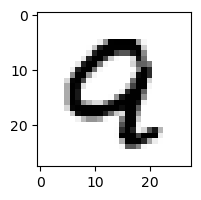

0.3436106200546835% - 0
0.00044145731405078486% - 1
11.309306560979111% - 2 - ОШИБКА
8.014601614986228e-05% - 3
3.337742052128105% - 4
0.0009336751801526239% - 5
0.041966296639894686% - 6
0.12763467156903166% - 7
4.9748968273978855% - 8
5.263881633303963% - 9

 8


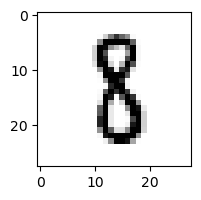

0.01089070123878057% - 0
3.729525413351547% - 1
0.9667763171171474% - 2
12.2159010644398% - 3 - ОШИБКА
0.07650145233863305% - 4
2.4422508376263967% - 5
0.44441622111159884% - 6
0.07552196853476523% - 7
5.121331652297017% - 8
0.00720538517783381% - 9

 5


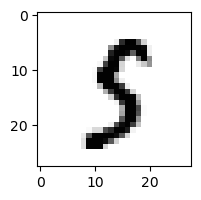

0.6420771062647881% - 0
0.21321069173207483% - 1
0.017958568835434528% - 2
61.178411632617745% - 3 - ОШИБКА
0.06880912530601792% - 4
22.909348167709084% - 5
0.26727360253991% - 6
0.18101396388234484% - 7
8.471235349859056% - 8
0.5714649572178916% - 9

 3


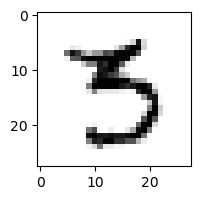

0.8927231090661135% - 0
0.031423356893189425% - 1
0.005849181967480438% - 2
27.777605878305923% - 3
0.018963820654429815% - 4
56.63230321877172% - 5 - ОШИБКА
0.02557399094598345% - 6
0.7052322843184294% - 7
1.5706006156718566% - 8
2.8350108362985584% - 9

 5


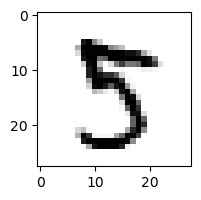

0.1517061942291627% - 0
0.001826896984568131% - 1
0.003101227080497486% - 2
51.594182227068096% - 3 - ОШИБКА
0.08127182070720528% - 4
48.416076790523945% - 5
0.00028713844495219655% - 6
3.0322029473316214% - 7
11.816047871849088% - 8
0.29311523551930563% - 9

 9


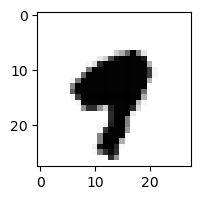

0.0005250865772223426% - 0
0.005087533293721634% - 1
9.889290592834175e-07% - 2
0.0007877859969142313% - 3
18.668012147554734% - 4 - ОШИБКА
0.017192834950021735% - 5
0.008627343791015787% - 6
0.0848096259819207% - 7
0.001187927143336289% - 8
14.283205509674977% - 9

 5


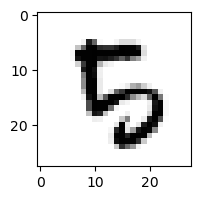

0.05520566525491771% - 0
0.0009476724792157126% - 1
4.259259697279064% - 2 - ОШИБКА
0.01857476706915708% - 3
0.4678080425516942% - 4
1.604167652241274% - 5
0.7183040127314383% - 6
0.020869030313013296% - 7
1.0314925555182664% - 8
4.224411010676691% - 9

 5


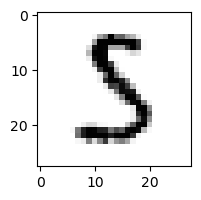

0.18517290890894234% - 0
0.11849329138719374% - 1
1.626643838743395% - 2
59.4145959450814% - 3 - ОШИБКА
0.030227776674143135% - 4
25.687758307508073% - 5
0.2424434349667433% - 6
0.08513148489120863% - 7
3.2867297872433525% - 8
0.0012447702938115331% - 9

 3


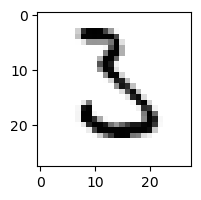

1.6536545826471947% - 0
0.11146209222581654% - 1
58.427365816829656% - 2 - ОШИБКА
13.036476289415502% - 3
0.0027787920515475865% - 4
3.239436340398774% - 5
31.853858565806743% - 6
0.0991325060293535% - 7
0.34957544981382593% - 8
0.10184593995721614% - 9

 7


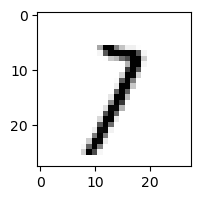

0.38421793069069005% - 0
39.2640656974563% - 1
12.504177067884118% - 2
27.294542440069954% - 3
1.5860349333954284% - 4
0.6679863552077392% - 5
0.4414805996450954% - 6
37.894199180496884% - 7
4.777205102481003% - 8
52.22123262768383% - 9 - ОШИБКА

 5


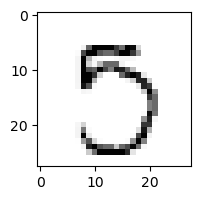

4.122471019900068% - 0
0.04678810708877423% - 1
0.4284392759480225% - 2
14.01350881937707% - 3
0.03173242120869802% - 4
20.47583047595269% - 5
0.24901933261173267% - 6
60.50670752052538% - 7
1.8426286142039203% - 8
88.13320041267893% - 9 - ОШИБКА

 7


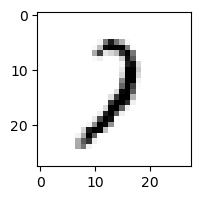

0.13117551293074628% - 0
32.619089358969156% - 1
56.793717617955096% - 2 - ОШИБКА
12.316953919450523% - 3
2.153930734996662% - 4
0.3975421526444487% - 5
1.1716124552391334% - 6
21.029956486468055% - 7
3.0638086527953505% - 8
8.251538809879973% - 9

 9


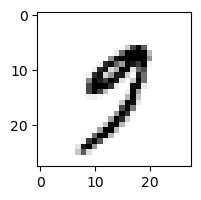

6.872508120034848% - 0
0.11364129603994921% - 1
0.013765987107786535% - 2
21.454432294151186% - 3 - ОШИБКА
3.0120524655054175% - 4
14.073088019264812% - 5
0.048729924095715325% - 6
15.951751874543438% - 7
0.09888070415284325% - 8
21.108974525022646% - 9

 5


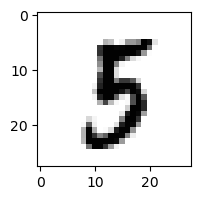

0.10441757849652661% - 0
0.029064414422837984% - 1
0.012233407437231648% - 2
75.85734153092227% - 3 - ОШИБКА
0.03510242032563668% - 4
28.414293151762145% - 5
0.2484228985720921% - 6
0.006976215697964652% - 7
4.049694068976349% - 8
1.4509281723396312% - 9

 8


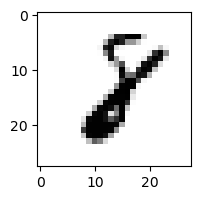

0.020084889553458468% - 0
10.586586338949557% - 1
27.68000316896388% - 2 - ОШИБКА
0.0706499191329373% - 3
0.16488944561499821% - 4
0.04695018066073513% - 5
0.6389641771224871% - 6
0.8231381522381009% - 7
24.501087230093578% - 8
0.009667276610505343% - 9

 5


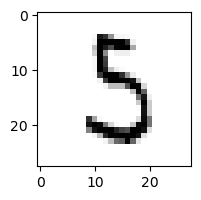

1.2371292320023441% - 0
0.3450492933255457% - 1
2.415727038514288% - 2
53.34535885524518% - 3 - ОШИБКА
0.05504617528516867% - 4
38.25056718284579% - 5
2.2359435805504915% - 6
0.26732903155637866% - 7
10.738564207796504% - 8
0.022430786905549636% - 9

 7


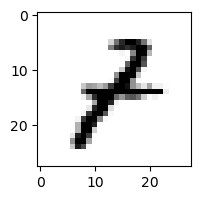

0.662430713977339% - 0
8.072870989274362% - 1
5.474494110418114% - 2
10.283945647672233% - 3 - ОШИБКА
4.604761036318307% - 4
0.14145750733049334% - 5
0.34631824014598184% - 6
0.011162048206331066% - 7
3.564060134237051% - 8
0.9073226260056879% - 9

 2


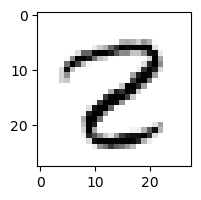

0.36346897014089213% - 0
0.11171413697365028% - 1
16.408152238035594% - 2
0.18668133807445586% - 3
0.32141660173591663% - 4
0.13269749188877072% - 5
0.004781515666118719% - 6
0.9469935191594753% - 7
99.91594454205296% - 8 - ОШИБКА
0.4797871273121573% - 9

 5


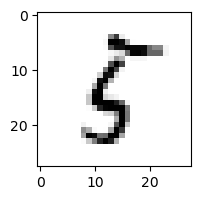

5.214136372824836% - 0
1.4799717915409965% - 1
3.691407373059002% - 2
1.8289204802555878% - 3
3.3667344104334798% - 4
40.09697354062956% - 5
2.632561598979454% - 6
0.12310789125902323% - 7
42.377660473403836% - 8 - ОШИБКА
0.9052611279532368% - 9

 7


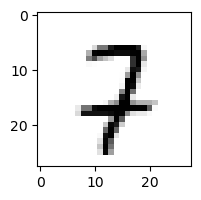

0.29180950482368734% - 0
0.07622370283247001% - 1
38.126584264308434% - 2 - ОШИБКА
0.5248961556269873% - 3
2.8668215372827315% - 4
0.02528703291330594% - 5
0.8840982375348229% - 6
29.803086190809303% - 7
12.639149540564077% - 8
24.309246849962555% - 9

 0


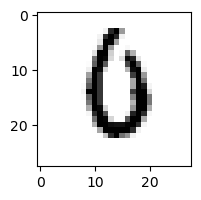

9.338557972493854% - 0
0.000515752557051728% - 1
1.6203675127453248% - 2
0.3163790897700063% - 3
0.7225067409745844% - 4
0.7147208647274379% - 5
69.39858862772319% - 6 - ОШИБКА
0.6624060459208889% - 7
0.044690063608368184% - 8
0.46550054887879055% - 9

 2


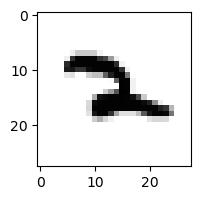

0.0002207229218302216% - 0
1.6347554831763729% - 1
1.4593955273524757% - 2
0.007270401333101551% - 3
6.01425703920879% - 4
0.4579504857887492% - 5
11.66151560374171% - 6
26.620460732290297% - 7 - ОШИБКА
4.941280596163987% - 8
0.6569112209389397% - 9

 9


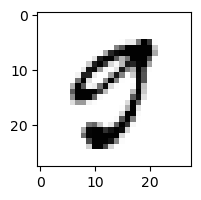

84.22075554328234% - 0 - ОШИБКА
0.002418373245643963% - 1
0.00211316382670151% - 2
3.678423049653487% - 3
0.10161523290196003% - 4
23.086501855137392% - 5
0.008672438528121844% - 6
0.6471553815787299% - 7
0.029135630196564486% - 8
2.22224262799078% - 9

 6


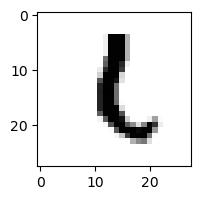

0.005731776955658154% - 0
27.559350368644136% - 1 - ОШИБКА
17.030418235809094% - 2
0.7607148640900874% - 3
0.02136794033039663% - 4
5.422077431626518% - 5
6.449083453324343% - 6
0.0048562912033558265% - 7
3.5214593442762494% - 8
1.759648177027822% - 9

 5


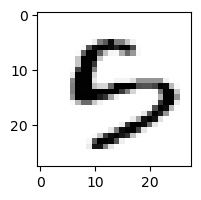

6.977941260439477% - 0
0.0025241237383371016% - 1
0.023534194258257705% - 2
0.6054431165138026% - 3
1.153785274556568% - 4
2.8086936122636907% - 5
13.055404397288711% - 6 - ОШИБКА
0.0011187022118530536% - 7
1.2761720606469649% - 8
3.647421284304233% - 9

 5


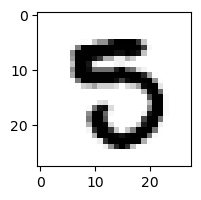

0.634359634911074% - 0
0.000568808823741213% - 1
0.012719747029482892% - 2
0.05108736490877674% - 3
0.00018428323757898633% - 4
0.570865590332011% - 5
0.05813399888682051% - 6
0.11196374618730824% - 7
18.066453830491593% - 8 - ОШИБКА
0.00512873364376673% - 9

 5


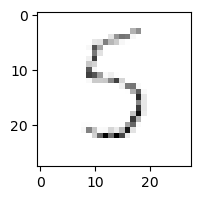

20.729513037687305% - 0
3.5303182146506984% - 1
14.814633060149566% - 2
56.50369498677269% - 3
23.08612364647385% - 4
55.26431445748282% - 5
45.26118482284971% - 6
16.53849719321428% - 7
59.5994097155927% - 8 - ОШИБКА
7.35564567102812% - 9

 7


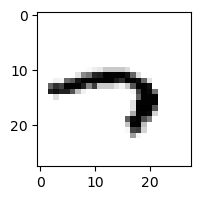

1.279955961981035% - 0
0.3601368612081645% - 1
0.0012490326230534358% - 2
50.69809561217794% - 3
58.444564198670854% - 4 - ОШИБКА
12.385687917238265% - 5
57.91874934226745% - 6
6.012059456057142% - 7
0.08760410031800989% - 8
34.24746278691432% - 9

 0


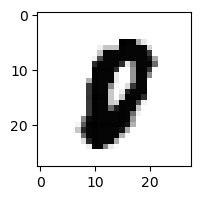

1.182786186605246% - 0
3.5951960659545e-05% - 1
0.021389034634408128% - 2
0.0007937054526207626% - 3
0.007563101786009299% - 4
0.662788404051622% - 5
0.038124762681216166% - 6
0.025761751815134844% - 7
1.202539809382326% - 8 - ОШИБКА
0.05489046425304964% - 9

 9


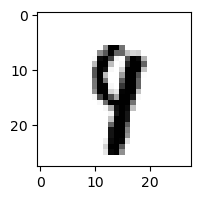

0.004226893865030209% - 0
0.06720834828796346% - 1
0.05917366082385582% - 2
1.005783248704675% - 3
26.96809297980447% - 4 - ОШИБКА
0.7744853779617238% - 5
0.07179926177843834% - 6
8.273036371122% - 7
2.177579472332645% - 8
11.801671941348307% - 9

 9


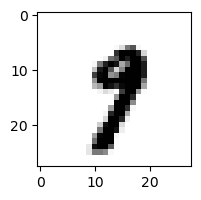

0.012672476740158204% - 0
0.43273381888452667% - 1
0.002283431586259777% - 2
2.276909583685179% - 3
0.515291147942071% - 4
0.2882011261412978% - 5
0.011910520145127616% - 6
28.11202969778821% - 7 - ОШИБКА
0.3480685448642991% - 8
14.33072808557599% - 9

 5


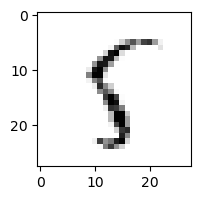

0.8572509470193042% - 0
5.05346990217309% - 1
2.8765139344668054% - 2
0.2039459540035311% - 3
15.722589315993272% - 4
60.066963301136234% - 5
12.101093278537501% - 6
1.3643747738637741% - 7
86.81089118451662% - 8 - ОШИБКА
11.720960843209234% - 9

 1


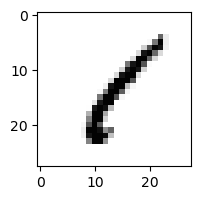

1.343408393185774% - 0
77.80033437599097% - 1
2.6306895521872615% - 2
7.779180350512213% - 3
3.3187311685294123% - 4
4.191515469427891% - 5
0.29955335895316615% - 6
0.7055363441223251% - 7
80.88710947515997% - 8 - ОШИБКА
0.5444180345945656% - 9

 3


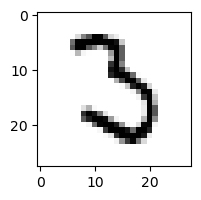

0.5083688601212045% - 0
0.740821124002295% - 1
69.93267802392326% - 2 - ОШИБКА
42.91510766227122% - 3
0.0023595212356451126% - 4
0.08797058578620201% - 5
9.353121791706931% - 6
0.9398732358491751% - 7
0.026452895899713766% - 8
0.03823165938454952% - 9

 8


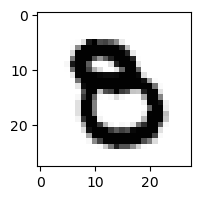

0.1229850899315638% - 0
4.299480626007408e-05% - 1
0.0020397167517739044% - 2
0.24834426357247386% - 3
0.0009293000922488423% - 4
0.4799923597038629% - 5 - ОШИБКА
0.003622063862427557% - 6
0.0010401746570929634% - 7
0.014071451548731084% - 8
0.01231756048395903% - 9

 3


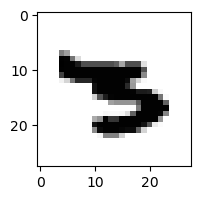

0.00021689369462727693% - 0
0.012098157795777602% - 1
3.2915757022478516e-05% - 2
0.6160391380262817% - 3
0.27325636203628306% - 4
1.3914127226188244% - 5
25.435305874779612% - 6 - ОШИБКА
0.17235653663200295% - 7
0.0003947508603801731% - 8
0.001960526422465511% - 9

 4


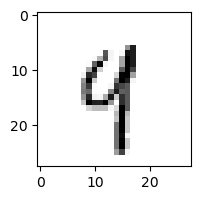

0.1023179786368176% - 0
13.382452835394702% - 1
0.5942627878248561% - 2
1.1292159726403108% - 3
35.94515577675924% - 4
1.6796311189539712% - 5
1.452480275924978% - 6
4.366271271627255% - 7
1.5291727586250992% - 8
51.82509679009587% - 9 - ОШИБКА

 2


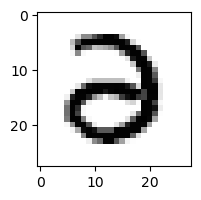

11.234912987086597% - 0
8.218190355906423e-05% - 1
1.1419925319287327% - 2
53.257267495747065% - 3 - ОШИБКА
0.22532778154071448% - 4
0.00873039704517678% - 5
0.01524302905174729% - 6
5.121083207901451e-05% - 7
0.0003353069770692537% - 8
0.0021630796735089136% - 9

 5


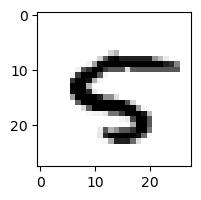

0.9680161372367619% - 0
0.0074952262647886075% - 1
0.011780319298595158% - 2
0.00011082413950863871% - 3
8.869963845453697% - 4 - ОШИБКА
4.2459217800963245% - 5
0.020992423707213992% - 6
0.2973632402315517% - 7
0.22550320486961312% - 8
1.1438439393364288% - 9

 5


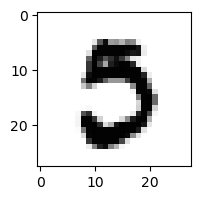

6.5388678095289645% - 0
0.0002109083862788497% - 1
0.006071014797499652% - 2
6.9605532787187006% - 3 - ОШИБКА
1.4880051525275928e-05% - 4
3.702878264309892% - 5
0.01379150413408595% - 6
1.780219630667764% - 7
0.05119580696040537% - 8
0.003912460892612344% - 9

 9


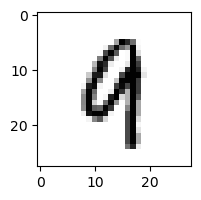

0.072980822221378% - 0
0.2237387969198536% - 1
0.7744267543404109% - 2
0.06230194887837219% - 3
30.070378427053058% - 4 - ОШИБКА
0.02187779677323048% - 5
0.5906417349551252% - 6
0.17789666234942764% - 7
1.4563581835959787% - 8
24.218155592869714% - 9

 7


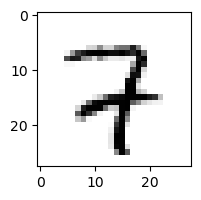

0.1093182056500618% - 0
0.036019588555776444% - 1
31.163589707844952% - 2 - ОШИБКА
1.2655562876793356% - 3
14.951942905409835% - 4
0.009991779300782669% - 5
0.28563747920728705% - 6
26.552181722965912% - 7
11.529514060681807% - 8
15.436743568919855% - 9

 5


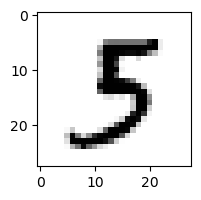

0.2640916389876824% - 0
0.1380983833157586% - 1
0.004231854861899086% - 2
96.38328480064892% - 3 - ОШИБКА
0.01759937864232763% - 4
16.471728869052292% - 5
0.3447907503856867% - 6
0.0315684080075311% - 7
0.22682966393446488% - 8
0.24725163747145484% - 9

 5


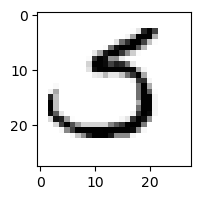

10.539765519758994% - 0
0.02046844057193471% - 1
9.187102373125835% - 2
56.73645357853757% - 3 - ОШИБКА
0.0005084802562167154% - 4
6.485322410619874% - 5
3.108589786903072% - 6
4.751594046218893% - 7
0.010761511300311876% - 8
0.042082727592813576% - 9

 7


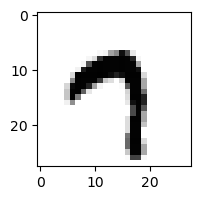

0.37639935225321747% - 0
0.01809012551392383% - 1
0.0001902577595889831% - 2
0.2817753804452682% - 3
1.34014257696678% - 4
1.611638963568204% - 5
0.08128773845600121% - 6
59.489083706632954% - 7
0.004817113058153833% - 8
79.85871088470337% - 9 - ОШИБКА

 8


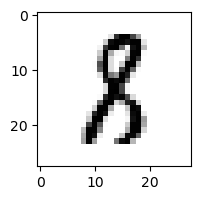

0.03270126188272515% - 0
12.421806612013976% - 1 - ОШИБКА
4.130282450386765% - 2
2.884505193540458% - 3
0.019934089092921676% - 4
1.6614211335841949% - 5
0.1282168461676658% - 6
0.012673888302259243% - 7
5.823975370898672% - 8
0.004270501058460526% - 9

 9


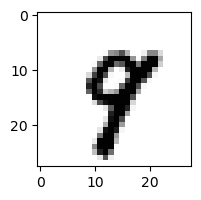

0.010530192449314586% - 0
0.01471541460909127% - 1
0.009323984662395294% - 2
0.05727950323566127% - 3
23.322288173482235% - 4 - ОШИБКА
0.30753759807071157% - 5
0.014714133395285585% - 6
19.966436019433832% - 7
1.9438623406462747% - 8
16.373763966949976% - 9

 6


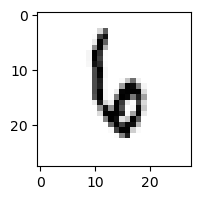

0.007595746047471534% - 0
0.16896019685124614% - 1
10.363251206924646% - 2
0.13249874795954672% - 3
85.77409068592516% - 4 - ОШИБКА
3.8151239922724645% - 5
76.79837918019913% - 6
2.400660207372083% - 7
2.114239131883631% - 8
1.867326991243462% - 9

 8


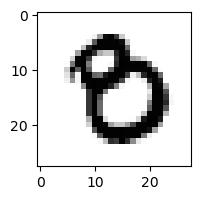

13.861001233446277% - 0 - ОШИБКА
0.00018153976604096136% - 1
0.008517026389792851% - 2
0.44968810712306634% - 3
6.743585209028027e-05% - 4
0.019765358817821713% - 5
0.17037185318751769% - 6
0.0026017728469605334% - 7
0.04234668574296595% - 8
0.001903030237698211% - 9

 8


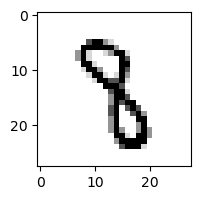

0.000710969108137946% - 0
4.867853802531955% - 1
0.5212264081692094% - 2
2.5691649016309865% - 3
2.2247145425257018% - 4
5.095419111263025% - 5 - ОШИБКА
0.147020654761751% - 6
0.3674661596666476% - 7
2.1006809982760193% - 8
0.35622839365668874% - 9

 3


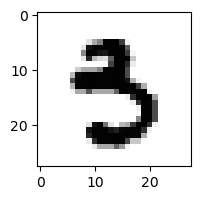

0.046331646059862265% - 0
0.0026468599876190847% - 1
1.670156529290098e-05% - 2
16.119751362695844% - 3
0.0037049985255771497% - 4
36.34943253019874% - 5 - ОШИБКА
0.03145053850455276% - 6
0.012690687689092525% - 7
0.004493355828988947% - 8
0.05576236901151185% - 9

 4


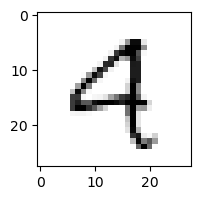

4.554485072680094% - 0
0.027907027597701965% - 1
3.9067791591965233% - 2
0.1622345658203192% - 3
63.34147481978489% - 4
0.06992039061650836% - 5
0.9117678977248966% - 6
0.9406710005580528% - 7
0.270003201261332% - 8
82.69589907299651% - 9 - ОШИБКА

 5


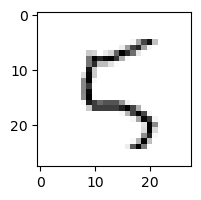

6.47704914326009% - 0
0.590742437596522% - 1
53.558323717142684% - 2
0.244970529180567% - 3
12.6467256089455% - 4
25.509015802157563% - 5
23.115213949973697% - 6
1.3044960514132913% - 7
27.400189263655367% - 8
87.56106835405384% - 9 - ОШИБКА

 5


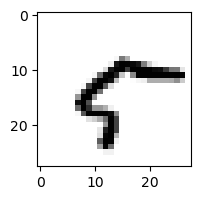

81.69025647315229% - 0 - ОШИБКА
0.19920201654521832% - 1
0.04534543878710851% - 2
0.19313248778206793% - 3
4.538989038982342% - 4
0.024454764740545983% - 5
5.240390084634119% - 6
4.5798780853960235% - 7
17.263327723987537% - 8
2.243039440063395% - 9

 3


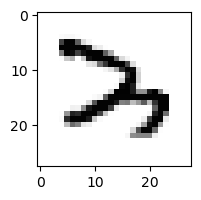

0.00823203404033466% - 0
0.07179078645453808% - 1
91.81754355018117% - 2 - ОШИБКА
1.54816311162502% - 3
1.081439299348191% - 4
0.0031405533282955755% - 5
1.3959881560828462% - 6
5.929906384765265% - 7
0.14026447456869837% - 8
0.14329156993874523% - 9

 5


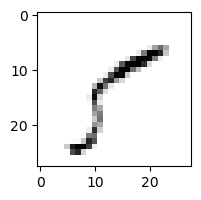

61.07511112021873% - 0
23.40515542182116% - 1
1.296828956848626% - 2
89.53431301205268% - 3 - ОШИБКА
9.89244988645834% - 4
59.02993295360199% - 5
0.7351962308038752% - 6
43.504184898943215% - 7
16.680917031242423% - 8
2.026302962914806% - 9

 3


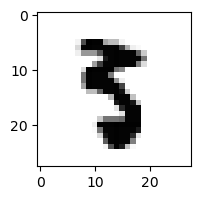

0.015567325105736357% - 0
0.0042528525335854975% - 1
0.0018240436827380723% - 2
0.687580604095544% - 3
0.019586590540440336% - 4
35.37871606564967% - 5 - ОШИБКА
0.12769441305800078% - 6
0.0341043337512464% - 7
0.14713101858810176% - 8
0.0533363835865893% - 9

 5


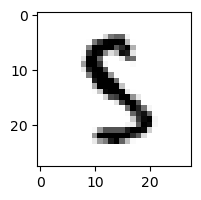

0.09181445861110134% - 0
0.0076079469238885125% - 1
0.48396556665628526% - 2
13.564335572456496% - 3
0.37863878198886664% - 4
70.96749151147519% - 5
0.4227645461379199% - 6
0.008138638825163257% - 7
74.18387407828187% - 8 - ОШИБКА
0.10745389640164991% - 9

 5


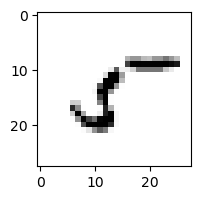

21.65625899213527% - 0
8.97936687044373% - 1
14.175840222039762% - 2
11.468565055542895% - 3
1.000064219869683% - 4
69.96458165306903% - 5
7.091914700106219% - 6
0.7005843928075228% - 7
93.78108360522928% - 8 - ОШИБКА
0.4260126387329429% - 9

 5


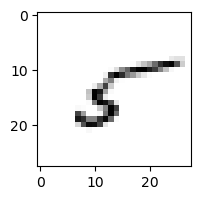

12.514087119167346% - 0
10.293812407218445% - 1
46.07332764283511% - 2
5.9955462765278345% - 3
11.674463384681347% - 4
22.540312712829948% - 5
23.433944432617164% - 6
2.802124275247237% - 7
88.0312381207315% - 8 - ОШИБКА
4.439666674706275% - 9

 5


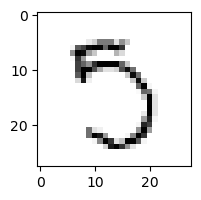

5.476315688057639% - 0
0.16393338663156545% - 1
8.497298505429528% - 2
11.151553194021533% - 3
0.2598149633225025% - 4
22.557930194156537% - 5
0.13334967560928968% - 6
48.020798232237794% - 7 - ОШИБКА
34.01123111902749% - 8
1.6445793460900922% - 9

 5


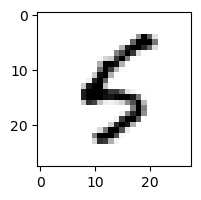

5.67875142061053% - 0
0.030260963562621524% - 1
0.10278626430804155% - 2
4.313949366719898% - 3
20.285227855724653% - 4
60.78477235143818% - 5
65.79823206211015% - 6 - ОШИБКА
0.016643701494257958% - 7
0.30015519984847183% - 8
4.763504375355403% - 9

 8


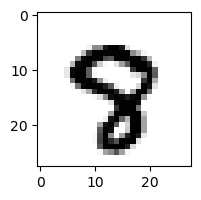

0.026500661039368874% - 0
7.70582022330069e-05% - 1
0.0015109963509770145% - 2
0.02390500113050862% - 3
0.23886126120759987% - 4
1.782885597870383% - 5
0.0023750809908804744% - 6
2.5476681333085915% - 7 - ОШИБКА
0.3703464688192515% - 8
1.7637129279175479% - 9

 6


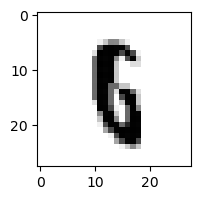

0.0076965712241939006% - 0
0.04020342515936763% - 1
0.23569264284075161% - 2
0.2824544381869055% - 3
0.4372030920847983% - 4
16.248627121124095% - 5 - ОШИБКА
12.00148183265943% - 6
0.014540519874254296% - 7
8.612998793002483% - 8
1.8891827490224513% - 9

 9


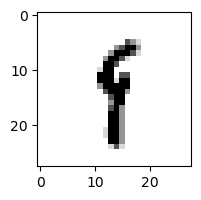

0.017477680778347413% - 0
40.15112425009731% - 1 - ОШИБКА
0.12371004268250348% - 2
3.346418758154009% - 3
1.5661010535541728% - 4
13.33070527682545% - 5
6.4170971466968% - 6
0.5178965827165581% - 7
35.631181822789976% - 8
33.64900489095095% - 9

 8


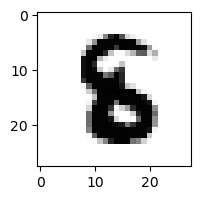

0.0002580060573618243% - 0
0.0013457742018186756% - 1
0.03614231189311154% - 2
0.006139605343153629% - 3
0.03215971223580364% - 4
5.382735427017541% - 5 - ОШИБКА
1.8293108504138031% - 6
1.6066729315260106e-05% - 7
1.0866923547584686% - 8
1.3450290880308259e-05% - 9

 6


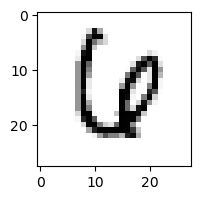

2.786045671088054% - 0
0.0023271049331599356% - 1
3.1237784863630864% - 2
0.474680946269112% - 3
16.798338499549374% - 4 - ОШИБКА
0.06301446595542479% - 5
12.166163043645408% - 6
10.620375865823029% - 7
0.9299975269632228% - 8
0.021002009013855145% - 9

 9


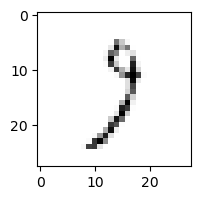

10.125273942191303% - 0
8.686066383423961% - 1
31.51954015646919% - 2
67.63716937331988% - 3
12.805154952839418% - 4
2.9886965885627705% - 5
3.4291995327327025% - 6
69.89239078868576% - 7 - ОШИБКА
14.917025722115715% - 8
37.96390976333843% - 9

 1


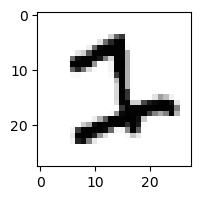

0.052170426656014346% - 0
0.08139028506632386% - 1
48.39448065894155% - 2 - ОШИБКА
37.857687417161436% - 3
0.00010408134000779382% - 4
1.983385391012397% - 5
1.8003323235459063% - 6
3.4487843127287503% - 7
0.0010295448654654522% - 8
0.0007304529662672111% - 9

 7


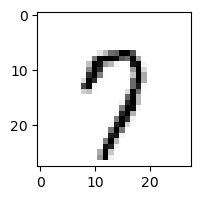

9.452466894779526% - 0
0.014467261291339401% - 1
0.672141010251916% - 2
1.318966933314473% - 3
3.228945274610672% - 4
6.947914456381367% - 5
0.8374127340979299% - 6
68.80607393161175% - 7
3.3579649890288157% - 8
83.46615907635328% - 9 - ОШИБКА

 7


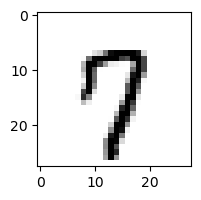

3.7438985647312317% - 0
0.004973740178814239% - 1
0.37963191201733104% - 2
0.7257896995618218% - 3
3.396910151486322% - 4
2.550815297881911% - 5
0.126755488139698% - 6
65.9327634749525% - 7
0.6023610571675685% - 8
68.45383075658144% - 9 - ОШИБКА

 5


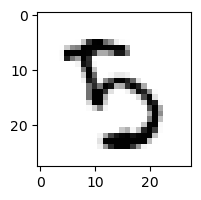

0.1578492935641848% - 0
0.0041213889276407265% - 1
1.0012480867581222% - 2
41.868739566875455% - 3 - ОШИБКА
4.383273937269616% - 4
26.40882392535431% - 5
0.19070983881694475% - 6
0.026464090775116824% - 7
16.703516096749357% - 8
4.104008801170911% - 9

 5


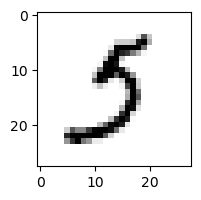

2.118864005300559% - 0
0.5026698419554064% - 1
0.5236544837722641% - 2
40.4307721782162% - 3 - ОШИБКА
0.11655180662242502% - 4
18.339904607017143% - 5
2.3735316771737427% - 6
8.380711440856752% - 7
0.13494240627419668% - 8
3.0769320931694306% - 9

 2


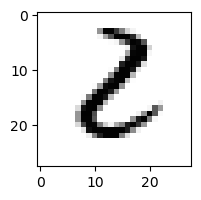

18.79099434686606% - 0
0.9320636939668473% - 1
17.16069772670102% - 2
25.908856466909995% - 3 - ОШИБКА
0.009105719785640882% - 4
2.072964816613461% - 5
5.051949493650705% - 6
0.001008409732872718% - 7
0.5366286105746491% - 8
0.005162406114933554% - 9

 3


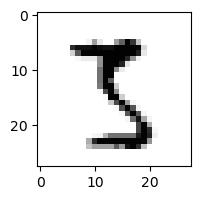

0.31573400302062254% - 0
0.06267064965050198% - 1
1.9261751319824407% - 2
45.7829191800167% - 3
0.022055575911873387% - 4
35.58261237832014% - 5
0.007653566567313534% - 6
0.20099914890812617% - 7
61.556863089700684% - 8 - ОШИБКА
0.8755735070512588% - 9

 3


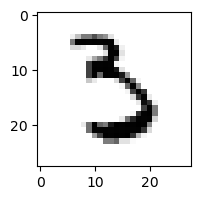

0.34537383344761313% - 0
0.019870234688127056% - 1
1.0430615920969866% - 2
16.31889240681312% - 3
0.004203204691293016% - 4
24.761146847357026% - 5 - ОШИБКА
7.350359923281438% - 6
1.270165752049872% - 7
0.07087217953519968% - 8
0.023090880429963108% - 9

 4


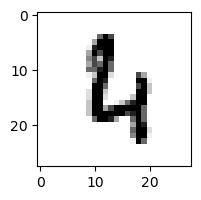

0.13958950326976985% - 0
0.001461604237078284% - 1
30.694060761497425% - 2
0.01038178414253087% - 3
19.050382003245414% - 4
4.509312375529494% - 5
34.160179241614394% - 6 - ОШИБКА
0.4556195251899627% - 7
5.803614315840262% - 8
4.462914214077418% - 9

 5


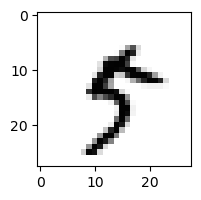

0.7999042879462088% - 0
0.31632232363270113% - 1
0.026083757881522028% - 2
15.067346932324421% - 3
3.015541390201881% - 4
0.933984742190881% - 5
1.7434608339983984% - 6
4.376608128409226% - 7
3.9545759167642887% - 8
36.1022408036422% - 9 - ОШИБКА

 5


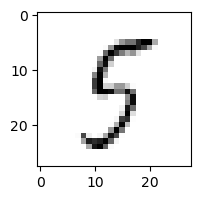

11.41081443129587% - 0
0.19020201527554675% - 1
0.7865484600319803% - 2
23.79830496177022% - 3
16.27479867837566% - 4
63.3161719700987% - 5
7.066357096100482% - 6
0.29443026463729144% - 7
64.67974152496517% - 8 - ОШИБКА
29.76777325525846% - 9

 6


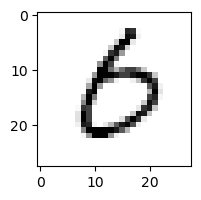

75.30235027724714% - 0 - ОШИБКА
0.01492806840702923% - 1
0.5497812706385248% - 2
6.624499382467865% - 3
0.09401441566357188% - 4
1.2981588921614708% - 5
53.5770859514924% - 6
0.4438060807969558% - 7
0.40682424967575126% - 8
0.6743122693291761% - 9

 4


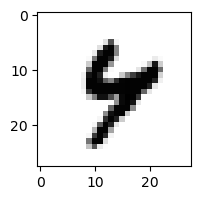

0.006568003145217961% - 0
0.021032678742574633% - 1
0.00877191941721515% - 2
0.018351331039539547% - 3
56.02601217909775% - 4
0.5709575916014887% - 5
0.6011519347807005% - 6
0.3750882232024362% - 7
25.282541981550143% - 8
70.5925949616413% - 9 - ОШИБКА

 7


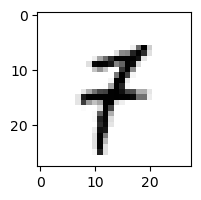

0.11306791670354571% - 0
25.71076011321155% - 1 - ОШИБКА
1.3303110787953947% - 2
0.9779918582415422% - 3
1.3412786622938833% - 4
1.489447446709761% - 5
0.5140575829015859% - 6
0.9472817542377283% - 7
0.3398284047574939% - 8
21.535833427772648% - 9

 8


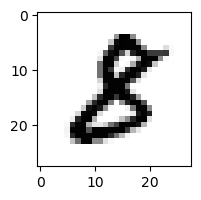

0.118235922225802% - 0
0.012191158922137733% - 1
0.9462072490909919% - 2
23.253068362679326% - 3 - ОШИБКА
0.0014203839126634386% - 4
0.3914273675529178% - 5
0.008195675663529228% - 6
0.001097006719291407% - 7
4.806709963326553% - 8
0.0018270938133534056% - 9

 5


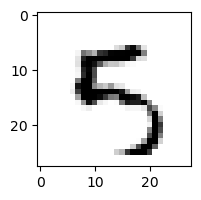

2.2574167453446887% - 0
0.0070849369127756% - 1
2.579415261089067% - 2
0.3089071823162169% - 3
5.086986006906719% - 4
54.276528298763814% - 5
1.5333882380632962% - 6
0.14136973327120353% - 7
0.18771394539110065% - 8
99.68499196221632% - 9 - ОШИБКА

 2


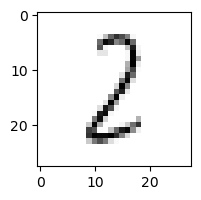

2.375098964550839% - 0
38.961254360450006% - 1
41.36499380156852% - 2
17.06751332926704% - 3
1.5008096705187344% - 4
1.7977849893398183% - 5
3.4759470524112004% - 6
1.190433586263118% - 7
43.162478489003554% - 8 - ОШИБКА
0.16898872135156628% - 9

 5


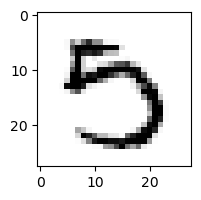

3.0593448720509877% - 0
0.01347276666586752% - 1
0.003268051210795773% - 2
4.627418196305157% - 3
0.23676346685900895% - 4
4.978985689289999% - 5
0.005567716469753205% - 6
25.16456713023729% - 7 - ОШИБКА
0.2640526485056069% - 8
0.5019726523668728% - 9

 9


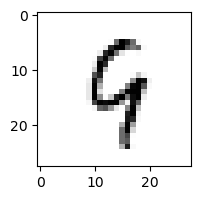

0.3164031689257573% - 0
0.092780334778066% - 1
7.970208733167839% - 2
1.3083024878452503% - 3
60.2550871423073% - 4 - ОШИБКА
3.000078829237934% - 5
17.406415312699796% - 6
0.8650881306084749% - 7
30.31336024190463% - 8
52.71315677686932% - 9

 7


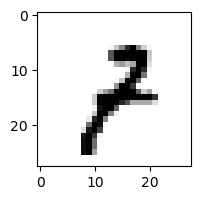

0.0885023490951001% - 0
4.32051292715827% - 1
6.972241973691892% - 2
6.530958430067399% - 3
0.7092234074976379% - 4
0.03078185439727332% - 5
0.12575763826086941% - 6
6.731436586061055% - 7
2.0885516314744517% - 8
52.26075476057452% - 9 - ОШИБКА

 5


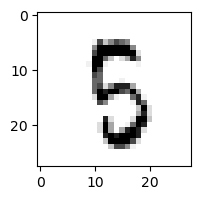

0.6459577860745049% - 0
0.027806274220050456% - 1
2.6529726910104197% - 2
26.65084618685909% - 3
0.44257416210577344% - 4
33.46465315488867% - 5
0.8392317515111603% - 6
0.023990788315917274% - 7
42.63280343231589% - 8 - ОШИБКА
5.858466205349821% - 9

 5


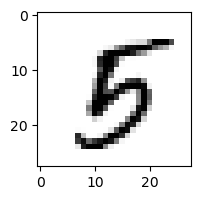

0.30131763531616157% - 0
0.02243353405094475% - 1
0.017678386325153797% - 2
3.2891454312109345% - 3
0.8809099247640234% - 4
7.501956689413797% - 5
9.695999265592803% - 6
0.027323921216367335% - 7
15.498053101644931% - 8
19.68872334058445% - 9 - ОШИБКА

 7


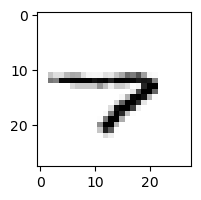

0.3154077585434505% - 0
2.851429963088476% - 1
0.0855058326710565% - 2
0.7915883413246696% - 3
91.49661177979546% - 4 - ОШИБКА
3.0164199687665953% - 5
53.305700306359014% - 6
40.481914214531514% - 7
1.285370020898169% - 8
59.53181329642799% - 9

 3


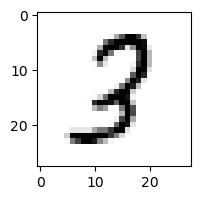

0.4366035870696234% - 0
0.5616917637544186% - 1
30.7797278163226% - 2 - ОШИБКА
23.71955208731559% - 3
1.5138864089209134% - 4
0.26185606852087784% - 5
0.15840424250362387% - 6
0.3244756351946322% - 7
27.98735132991126% - 8
0.07254604034165525% - 9

 8


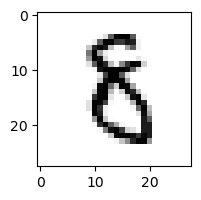

0.053900414152201516% - 0
0.14530999294745445% - 1
2.4957400826460927% - 2
6.725977684680405% - 3 - ОШИБКА
0.2261764519381955% - 4
3.1844914791029284% - 5
3.914624511651408% - 6
0.047035418035830945% - 7
2.7041999348829244% - 8
0.00981861454980122% - 9

 8


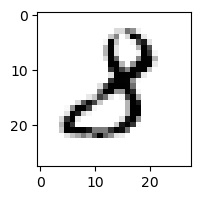

0.8053790571229591% - 0
0.48304424189273404% - 1
2.975770120538174% - 2
90.96874771756532% - 3 - ОШИБКА
0.17569755048220248% - 4
0.14145815144165416% - 5
0.034836121499819996% - 6
0.11580545671009473% - 7
0.024620346714009176% - 8
0.09220595483746001% - 9

 8


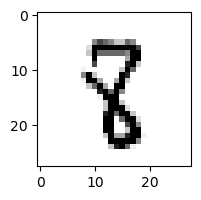

0.012280451214075717% - 0
3.2325925098127977% - 1
1.3250695723530392% - 2
1.530380481688883% - 3
1.5834184701262597% - 4
4.233096147336287% - 5 - ОШИБКА
0.07449118196447485% - 6
0.05091812076231385% - 7
3.978596459638136% - 8
0.25983782396405986% - 9

 6


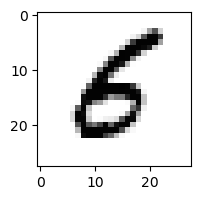

4.086771790760105% - 0
0.015977073297526942% - 1
0.23190303746861143% - 2
0.8520368921541734% - 3
0.5705317871761327% - 4
56.011977792636145% - 5 - ОШИБКА
52.394915957977986% - 6
0.0005558057934930142% - 7
0.012563890047905042% - 8
0.323794321609464% - 9

 7


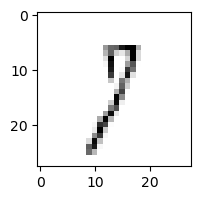

5.40683864082129% - 0
58.17864748126856% - 1 - ОШИБКА
21.68798406291573% - 2
45.149973321863335% - 3
1.8854302316874005% - 4
10.439997545159567% - 5
6.242558283276724% - 6
35.93173465292616% - 7
26.57553032383494% - 8
49.457167332611476% - 9

 9


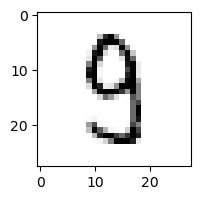

0.42366583189567636% - 0
0.06060324262477749% - 1
1.7647950197979168% - 2
34.5043310047311% - 3 - ОШИБКА
4.874804988783185% - 4
8.719429571957354% - 5
0.10890770634174966% - 6
0.32005867133604576% - 7
21.95547311091137% - 8
1.3095251070587501% - 9

 8


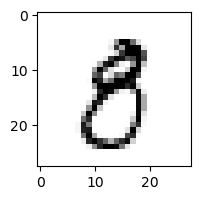

3.2991699820437344% - 0
0.14248446792449132% - 1
0.11100263208204918% - 2
40.47677682612796% - 3 - ОШИБКА
0.16967078708120864% - 4
3.4632928515691406% - 5
0.014159584122097418% - 6
0.055989505540099904% - 7
39.35596320819034% - 8
6.848016227639145% - 9

 6


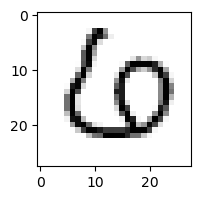

3.2686399947487925% - 0 - ОШИБКА
0.04009436566183524% - 1
1.9165621484912336% - 2
1.1835101353728281% - 3
0.23492428187432052% - 4
0.2019958754041586% - 5
0.05312499599939917% - 6
0.26061469793192454% - 7
0.07054874946348597% - 8
0.0031542484090798044% - 9

 5


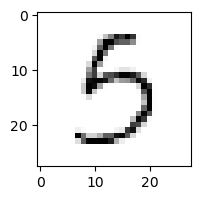

9.392203128883796% - 0
0.15097261253331484% - 1
0.13870124916513127% - 2
59.02228078941704% - 3 - ОШИБКА
4.187234631894427% - 4
22.20993882031% - 5
1.8002768896734043% - 6
1.6357349571493545% - 7
6.276702337679131% - 8
0.165555599969907% - 9

 7


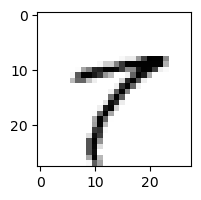

0.7949626521559212% - 0
8.973843660495493% - 1
0.04797256851343807% - 2
0.23446316822398808% - 3
3.073151189610672% - 4
2.313292768334775% - 5
0.10025699607198789% - 6
79.17132600427425% - 7
81.57591406555196% - 8 - ОШИБКА
6.71082410841405% - 9

 8


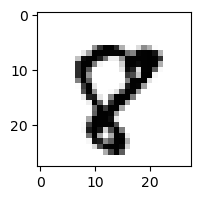

0.2395018802527319% - 0
0.005685475137276301% - 1
0.030793834381976238% - 2
0.00225117047918482% - 3
0.04710889589761533% - 4
0.27621893153261445% - 5
0.002042443332985628% - 6
27.70312252373852% - 7 - ОШИБКА
8.777717780768054% - 8
0.3287248465096091% - 9

 4


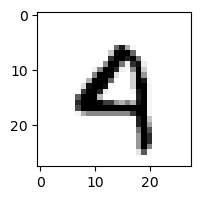

2.8153522004096057% - 0
0.002996275615973798% - 1
0.9543078260371214% - 2
0.031586881387675805% - 3
20.878048127756607% - 4
0.20645100606630135% - 5
3.3761912369020175% - 6
0.07840648891677382% - 7
0.07996232235847901% - 8
91.98663489964974% - 9 - ОШИБКА

 8


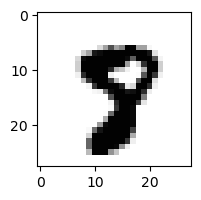

0.006836036842900961% - 0
0.0001227265637263514% - 1
2.43487891615961e-05% - 2
0.00614733504736978% - 3
0.009000661836779018% - 4
7.7301541026231675% - 5
0.0007219086361516031% - 6
8.920384581823047% - 7 - ОШИБКА
1.1097402777804264% - 8
0.3242685914242049% - 9

 6


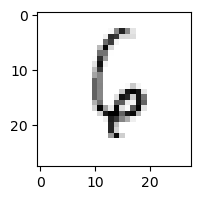

0.3821484924574224% - 0
0.6409161474128482% - 1
26.844193988193126% - 2
0.42313454031835335% - 3
79.07893476994467% - 4 - ОШИБКА
8.084680550981767% - 5
71.58851316182495% - 6
11.517607259659377% - 7
4.960993475402295% - 8
8.154873252458362% - 9

 7


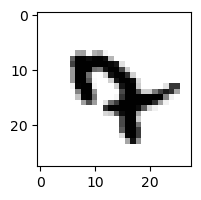

0.0010773677049118224% - 0
0.050878120929839205% - 1
0.0006109149493487003% - 2
0.008372211550807336% - 3
66.1352186606955% - 4 - ОШИБКА
0.6547676133367704% - 5
10.650043027180265% - 6
26.302974637794996% - 7
0.0004793916766412533% - 8
0.16562407666134052% - 9

 8


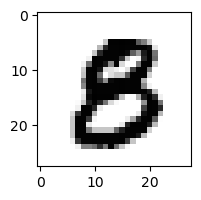

0.4485290727218918% - 0
1.9104055781726276e-05% - 1
0.004062847039193525% - 2
1.5644206225994668% - 3 - ОШИБКА
0.0018702427308762007% - 4
0.6831961238330528% - 5
0.00024356544470715102% - 6
4.50788508734088e-05% - 7
0.4024146459368741% - 8
0.014078829360843821% - 9

 7


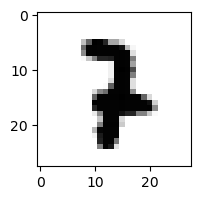

6.804288661561164e-05% - 0
0.3224612000054544% - 1
1.4637557069568328% - 2
1.7031597399055636% - 3 - ОШИБКА
0.02861142338853301% - 4
0.012861210213665738% - 5
0.11222652730013749% - 6
0.3085119179677556% - 7
0.011367782962965896% - 8
0.16261259676830417% - 9

 2


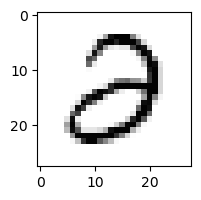

30.30628786775123% - 0
0.009607339519261422% - 1
10.966826239608514% - 2
54.779960776402056% - 3 - ОШИБКА
0.38802072887471867% - 4
0.18382594873557737% - 5
0.42302817849802965% - 6
0.008428586173399382% - 7
0.4331427464005555% - 8
0.007345326572744898% - 9

 7


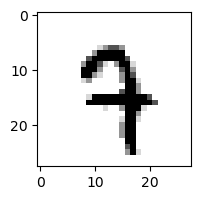

0.003907759503853887% - 0
0.044381944276541005% - 1
2.1919946941983746% - 2
1.8281719921898445% - 3
5.0551470960067% - 4
0.5188862067432173% - 5
0.8412529854121162% - 6
24.70336368933299% - 7
0.2322673537595669% - 8
41.20584518602427% - 9 - ОШИБКА

 9


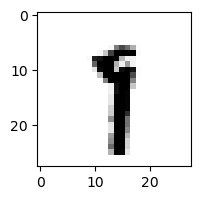

0.0022581990292399805% - 0
18.83171479041143% - 1
0.05742548828928148% - 2
2.7764285266447843% - 3
0.29732596603339473% - 4
1.0054624412475974% - 5
0.24425580450841197% - 6
34.46516461612501% - 7 - ОШИБКА
0.9236692780102491% - 8
15.307779021690774% - 9

 7


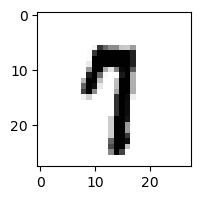

0.016951753978966116% - 0
0.3802339037547882% - 1
0.02326231791554807% - 2
0.21665380663105713% - 3
0.9815827904940382% - 4
2.736651351692778% - 5
0.06115765396686056% - 6
34.03710443443672% - 7
0.037291014820359174% - 8
36.52367583851424% - 9 - ОШИБКА

 4


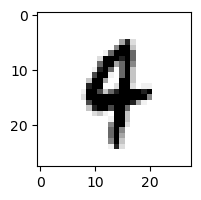

0.0019609133065522717% - 0
0.14525853187647444% - 1
0.057259709181020364% - 2
0.027759742801185355% - 3
52.11836296781102% - 4
0.34467848082645375% - 5
1.8451300768244676% - 6
0.24375157976857614% - 7
0.06632141460636373% - 8
55.447202743569356% - 9 - ОШИБКА

 9


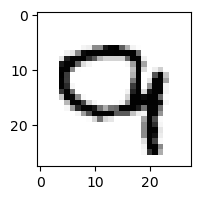

7.902068916419813% - 0
0.0010736536887833719% - 1
49.430826375742654% - 2 - ОШИБКА
0.0793345025504245% - 3
0.8809506630395718% - 4
0.00010095371899961414% - 5
0.39712617420110863% - 6
15.312482622073354% - 7
0.014758013643640289% - 8
22.989483000322963% - 9

 7


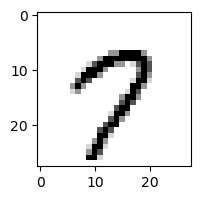

8.334492109579497% - 0
0.028899526624316267% - 1
0.14085228337214212% - 2
0.037695050536337975% - 3
1.111044337983323% - 4
3.8583299561676325% - 5
0.10719476909744358% - 6
85.40296215851578% - 7
1.956816880551036% - 8
91.5426607295879% - 9 - ОШИБКА

 2


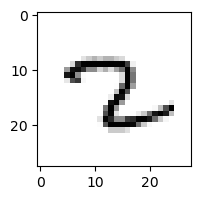

0.0103761431713064% - 0
16.768615041195993% - 1
9.801718302974988% - 2
0.2032719452050713% - 3
0.5045025776027284% - 4
1.8735717127986686% - 5
36.09845054249423% - 6
40.705765145028266% - 7 - ОШИБКА
0.5115956988039309% - 8
1.253541855235878% - 9

 6


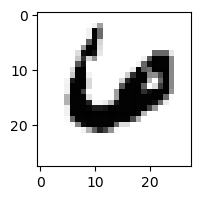

0.3233838994802105% - 0
6.194055287232982e-05% - 1
0.2524312195708791% - 2
1.1851317052353739e-05% - 3
21.295209329556645% - 4 - ОШИБКА
3.381870241270621e-05% - 5
13.557203697390301% - 6
1.1863685362053515% - 7
0.019873659961611403% - 8
0.003615528252612299% - 9

 5


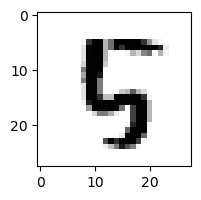

0.017751329818049295% - 0
0.0006873084588495175% - 1
1.715919440733045% - 2
0.0029468346358197156% - 3
68.55946426953089% - 4 - ОШИБКА
14.90559805816968% - 5
0.572841579730979% - 6
0.01564575045860956% - 7
6.740007615326157% - 8
0.007819923960497412% - 9

 4


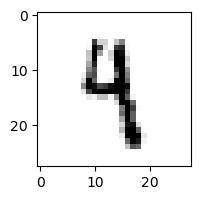

0.012658776325622645% - 0
3.100183751078275% - 1
0.4661663231560243% - 2
27.76420008781241% - 3
10.546444056766212% - 4
9.448027153623288% - 5
1.1715470009361888% - 6
0.11344000192050492% - 7
0.9217406002187326% - 8
30.82050545726096% - 9 - ОШИБКА

 8


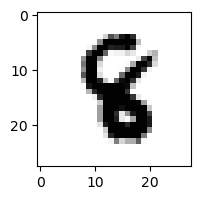

2.0513541443675192e-05% - 0
0.007001810084261317% - 1
0.3235268620051216% - 2
0.04557046431158117% - 3
5.255815635380902% - 4 - ОШИБКА
0.2945137637894191% - 5
0.11017710223679025% - 6
0.0015224713677574684% - 7
0.22747453785177033% - 8
0.000914256371593851% - 9

 9


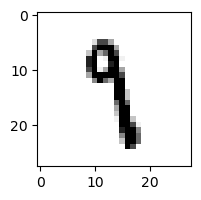

0.017375230393798125% - 0
13.917489959394782% - 1
0.2865723970005192% - 2
4.071543311429693% - 3
1.2388513461072856% - 4
26.463216553149067% - 5 - ОШИБКА
1.5149362842130984% - 6
4.415678376131318% - 7
14.626702145007542% - 8
2.8951304683619195% - 9

 6


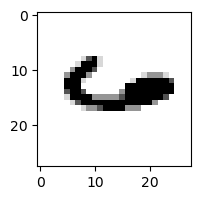

1.1148652705416522% - 0
0.06896432425199106% - 1
0.02257789691539214% - 2
0.0005118205714908875% - 3
98.65109537194297% - 4 - ОШИБКА
0.0024047196145254145% - 5
79.96351388635729% - 6
11.937155392402202% - 7
0.8268481014102315% - 8
89.14188841081929% - 9

 8


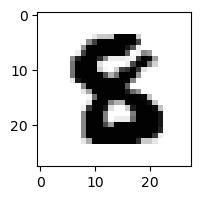

0.0005079897835783492% - 0
5.7772553414904366e-06% - 1
0.014437500548939065% - 2
0.02456316331084406% - 3
0.0005324861897909494% - 4
0.8195739148009147% - 5 - ОШИБКА
0.0031720760370383366% - 6
8.614808223185275e-06% - 7
0.1017721797711134% - 8
3.907025614570842e-06% - 9

 4


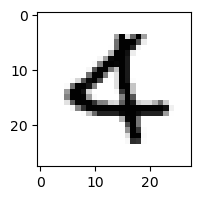

0.053299213094666% - 0
0.03747620624048534% - 1
0.27710555722192076% - 2
0.0020013933460193904% - 3
6.32052671348807% - 4
0.006716087679271862% - 5
5.781474184707156% - 6
0.04286658103027146% - 7
0.0006482362112306382% - 8
8.566431609235517% - 9 - ОШИБКА

 3


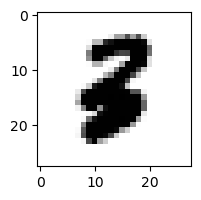

0.0031190286246717226% - 0
0.010681008765735163% - 1
0.7506046147296469% - 2 - ОШИБКА
0.057631014937164195% - 3
0.034696767984863604% - 4
0.03830856612760739% - 5
0.055862212732601585% - 6
0.00014788332751837686% - 7
0.0008193549293906652% - 8
0.00014619291441481152% - 9

 5


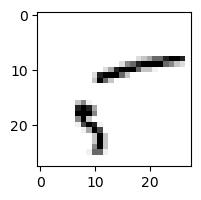

88.46151367878029% - 0
1.9212742216834808% - 1
4.246021306492544% - 2
29.370698706951504% - 3
2.805857156897664% - 4
66.34754548471145% - 5
0.579238564958935% - 6
38.60542532737751% - 7
93.67630012948057% - 8 - ОШИБКА
0.6944058153825132% - 9

 5


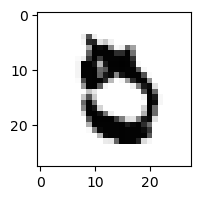

1.6670270594602479% - 0
0.0003723977373584726% - 1
0.039943095478658486% - 2
0.006467515545568806% - 3
0.0003806340235821069% - 4
0.783490925067018% - 5
2.240583568029861% - 6 - ОШИБКА
0.6869832501553016% - 7
0.013066176421229673% - 8
0.04267585391993911% - 9

 8


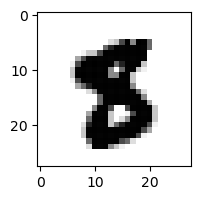

0.00040859310611349485% - 0
0.00018260271691482029% - 1
2.667151169324919e-05% - 2
0.0019006711101451084% - 3
0.0004001105886464967% - 4
4.526562544732127% - 5 - ОШИБКА
0.005648030241071739% - 6
0.0006316645697576124% - 7
0.0644065490664032% - 8
0.000350078752653238% - 9

 7


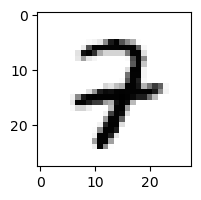

0.05630217887154503% - 0
0.04360717387174333% - 1
11.506558990038549% - 2
1.3327324699638152% - 3
35.55923280235705% - 4 - ОШИБКА
0.015797979860748955% - 5
0.3149334084869575% - 6
0.20057645194082643% - 7
0.14795086737779303% - 8
0.9010271089989434% - 9

 2


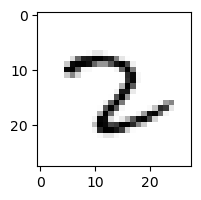

0.02278872050820526% - 0
5.294133804470266% - 1
25.63952184592024% - 2
1.0297394689211223% - 3
0.2661858959737438% - 4
0.971520807275804% - 5
68.39025421619931% - 6 - ОШИБКА
57.02424281536669% - 7
1.1114789631402373% - 8
0.09883962271308815% - 9

 7


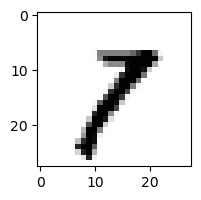

0.0928571021257277% - 0
46.96493524013242% - 1 - ОШИБКА
2.696816585338648% - 2
5.98959980319967% - 3
0.06239868987241782% - 4
0.07636541109147574% - 5
0.008916269534788489% - 6
25.002548243994156% - 7
8.004467600157524% - 8
7.079603369338742% - 9

 9


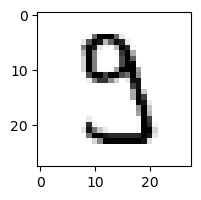

2.0871963867076535% - 0
0.027102012911114682% - 1
1.8888846050692447% - 2
61.17971291091698% - 3 - ОШИБКА
0.06783595844562% - 4
7.771409173314094% - 5
0.003075175174877543% - 6
5.740390285514757% - 7
2.038657068598947% - 8
0.04436361785082353% - 9

 1


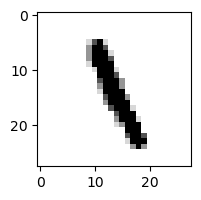

0.0008615504237281396% - 0
4.412526632377403% - 1
1.019444022184785% - 2
1.5707761204819863% - 3
13.172721655778524% - 4
51.506430736129005% - 5 - ОШИБКА
4.68885405332015% - 6
0.2210393660856385% - 7
49.90881934500818% - 8
0.4750967280915923% - 9

 7


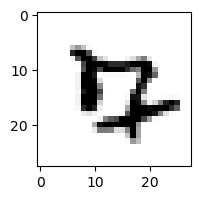

12.047888251612784% - 0 - ОШИБКА
9.878997289895506e-05% - 1
0.1316063637441938% - 2
0.023318587514245752% - 3
1.2714144590953185% - 4
0.7162146982519889% - 5
9.312097084355813% - 6
9.013842863076233% - 7
0.0006664065807044016% - 8
0.11102503503963657% - 9

 8


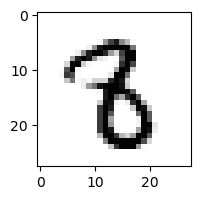

0.0015079584194074593% - 0
0.8785007402619652% - 1
0.28807557942628836% - 2
7.385017836610676% - 3 - ОШИБКА
0.03643651822295671% - 4
0.722212443311411% - 5
0.0296639863411502% - 6
0.03162434445067192% - 7
4.652428814119831% - 8
0.0715912687623644% - 9

 8


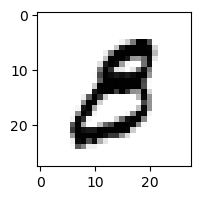

4.0831262420115015% - 0
0.00902269193593147% - 1
0.02891845975840672% - 2
51.95318627742801% - 3 - ОШИБКА
0.003699391567703795% - 4
0.9487187723570835% - 5
0.13011665450079316% - 6
0.0032702080698073337% - 7
0.0720737570909794% - 8
0.3574482325259042% - 9

 5


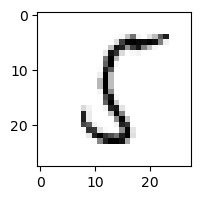

9.12719866361961% - 0
8.882752997109606% - 1
9.459696998431204% - 2
2.1336802571746647% - 3
2.0895239111292123% - 4
78.19674748688745% - 5
6.4562877262771865% - 6
0.12172221147590959% - 7
93.59729487210208% - 8 - ОШИБКА
0.3128293127077921% - 9

 8


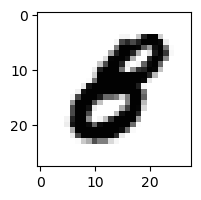

0.694034262692254% - 0 - ОШИБКА
0.000202840068197392% - 1
0.006077770931842425% - 2
0.11789109370653132% - 3
0.0499293639403192% - 4
0.6291988334183249% - 5
0.012966386713006933% - 6
0.00015745264346548755% - 7
0.0009389472259999935% - 8
0.002509536751089757% - 9

 9


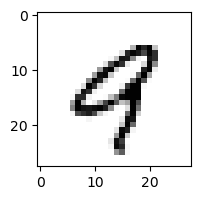

3.5148664916277945% - 0
0.034980564427950306% - 1
0.1478375106586082% - 2
0.09443132638310746% - 3
68.83862921687563% - 4 - ОШИБКА
0.06625828846332306% - 5
1.3117268852818336% - 6
5.133061747859414% - 7
2.507844540059076% - 8
23.360574021683927% - 9

 2


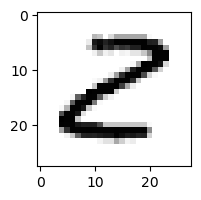

23.133690518026818% - 0
0.01937748508387903% - 1
39.95940266668838% - 2
47.83129096818524% - 3 - ОШИБКА
0.5061628332358855% - 4
13.798945409184268% - 5
0.0012937327544384819% - 6
5.842213496309052e-05% - 7
0.5334832080798535% - 8
0.00011380229158221552% - 9

 6


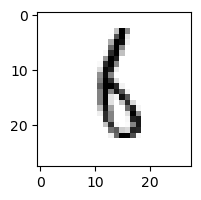

0.14139838801615903% - 0
6.836471147569588% - 1
5.865820104167095% - 2
14.387424489138056% - 3
1.987007399512032% - 4
22.771319688950353% - 5
53.29058114121382% - 6
0.09548755505791705% - 7
58.61046985179512% - 8 - ОШИБКА
10.653620159243461% - 9

 5


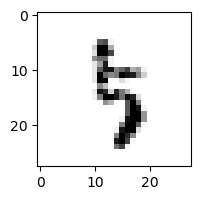

0.0986210599660345% - 0
0.657742274579271% - 1
0.8008280419067979% - 2
66.50921774831934% - 3 - ОШИБКА
19.82304175423727% - 4
17.227695858176542% - 5
5.662069303577253% - 6
2.8143218951459983% - 7
11.544166876401315% - 8
0.6388163256895033% - 9

 9


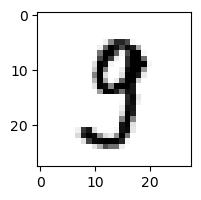

1.2820665708530885% - 0
0.06674428917561721% - 1
0.12825329651822248% - 2
73.4010715968698% - 3 - ОШИБКА
0.7897540433274071% - 4
2.568540908312824% - 5
0.0016601707242267986% - 6
1.3380635823309606% - 7
10.369158390970274% - 8
4.539675925606022% - 9

 4


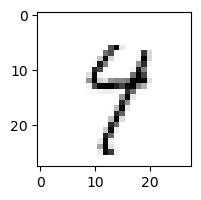

1.0524065887233784% - 0
0.8783748194996366% - 1
0.47543621514147555% - 2
8.033894892698987% - 3
39.10225338506488% - 4
5.442311525315134% - 5
1.9895124364112664% - 6
19.480497817537966% - 7
71.07104889730806% - 8
82.72450045174273% - 9 - ОШИБКА

 4


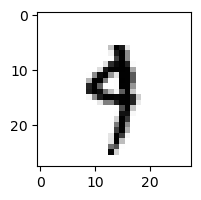

0.014255039962120776% - 0
1.687275301076904% - 1
0.06827397146304846% - 2
16.70038195367216% - 3
37.565951482935745% - 4
3.265804141831499% - 5
2.7193652652078044% - 6
3.340135232197419% - 7
0.3121234461016373% - 8
49.216870475276295% - 9 - ОШИБКА

 8


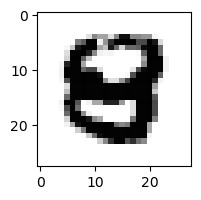

0.021932147899369734% - 0
8.954583036229858e-07% - 1
0.0005513022168244205% - 2
0.0031682060666154343% - 3
2.477737304536388% - 4 - ОШИБКА
0.04574116739481708% - 5
0.0059512043101874355% - 6
7.519458887113313e-06% - 7
0.0011114711707429143% - 8
2.182045911030581e-06% - 9

 7


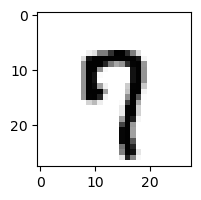

4.461417897756511% - 0
0.0020261242155897256% - 1
0.2702059482223439% - 2
0.6391198565613767% - 3
4.5487580198397195% - 4
5.632021300165723% - 5
0.20747254813556823% - 6
21.967720031006053% - 7
0.1923341186717683% - 8
88.68851096773928% - 9 - ОШИБКА

 8


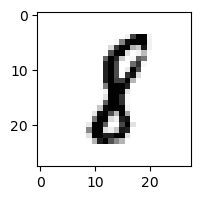

0.01936025477596288% - 0
44.61431571778128% - 1 - ОШИБКА
0.2072576219499573% - 2
0.421963543268287% - 3
0.036357829587205175% - 4
1.092101446655014% - 5
1.1738684681036546% - 6
0.10430161108464948% - 7
27.888202066513802% - 8
0.07886815109626502% - 9

 7


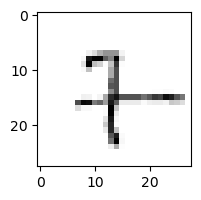

0.7514519743985231% - 0
35.22648376254065% - 1 - ОШИБКА
4.395652314686851% - 2
2.4132294659568223% - 3
5.952726616108679% - 4
7.095552722934818% - 5
25.872832051288075% - 6
13.877089969132975% - 7
12.934269057668565% - 8
9.316053703810114% - 9

 5


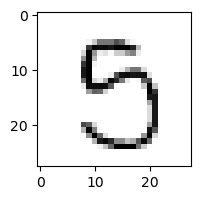

14.870231274915719% - 0
0.09247048623162989% - 1
0.7735749460173479% - 2
60.62922209719469% - 3 - ОШИБКА
0.6140901550536426% - 4
27.478993419585983% - 5
0.1651984481666851% - 6
0.5915253691697187% - 7
59.323561183387675% - 8
7.508622218949967% - 9

 8


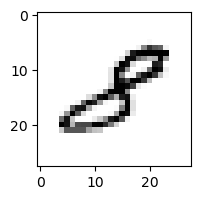

0.9482953403194291% - 0
7.409391591658632% - 1
31.90165018379083% - 2 - ОШИБКА
6.142089364042968% - 3
1.6009487788052823% - 4
0.5301455545290616% - 5
0.03347720465284356% - 6
0.813898596240045% - 7
1.3248652601230946% - 8
1.1448177712982237% - 9

 5


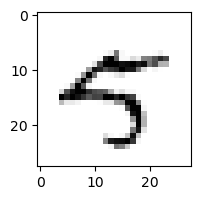

2.6204552621594623% - 0
0.1879408526363598% - 1
0.023316253175872374% - 2
0.780903015242205% - 3
44.71590635371115% - 4 - ОШИБКА
21.670146781151104% - 5
0.04540291985607432% - 6
5.972224762064756% - 7
0.3314494379880597% - 8
3.4403740892249624% - 9

 7


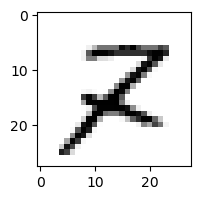

0.10791943494233697% - 0
0.2965023539965625% - 1
83.49705119596234% - 2 - ОШИБКА
0.8334696755315646% - 3
0.4708766567373098% - 4
0.2869553480309379% - 5
0.09770268352087379% - 6
0.06737061068053062% - 7
34.196239349753235% - 8
3.2708651658978556% - 9

 5


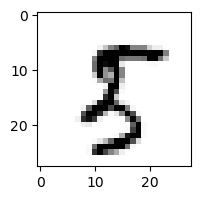

0.1088002061513259% - 0
1.0220837333656867% - 1
0.3247829225482811% - 2
0.1316782682854209% - 3
0.00575493058548664% - 4
9.14763462451519% - 5
0.018147756274721125% - 6
0.4076886825903733% - 7
88.97834578739877% - 8 - ОШИБКА
3.9825063971329717% - 9

 5


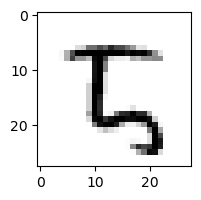

10.84364891055861% - 0
0.0015597445734084059% - 1
72.7201343409106% - 2 - ОШИБКА
0.15364540103595245% - 3
0.0699340701679627% - 4
46.9139268479276% - 5
29.293421118180735% - 6
0.18600976160159008% - 7
14.660083084250367% - 8
18.157443633486224% - 9

 4


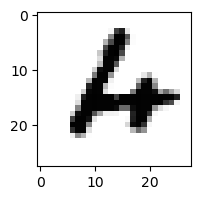

1.008535859410819% - 0
0.00011787295690451662% - 1
7.877358587961941% - 2
0.014894118378024308% - 3
1.3065244925403474% - 4
0.03863244200487602% - 5
50.96581431955289% - 6 - ОШИБКА
0.0013589327256051161% - 7
0.023508300817449562% - 8
0.773593430169014% - 9

 8


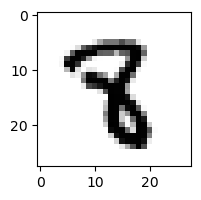

5.835441048333718e-05% - 0
0.2760276756297419% - 1
0.07389571125964725% - 2
1.064773240917626% - 3
3.22930642195634% - 4 - ОШИБКА
0.6160536389535809% - 5
0.004387752099956267% - 6
0.020107141552431904% - 7
0.07723260334424926% - 8
0.004004254662205711% - 9

 2


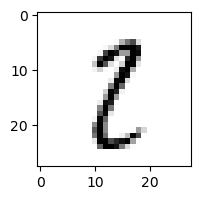

1.1046325583621255% - 0
39.19654468752833% - 1
1.9360263477927842% - 2
8.845819628800896% - 3
0.03531283710498702% - 4
5.756333767740487% - 5
0.04832771803978869% - 6
1.2093851669185647% - 7
61.21769699070205% - 8 - ОШИБКА
4.589053922513155% - 9

 6


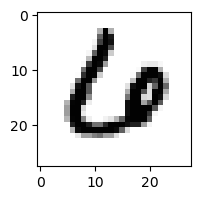

58.773057537197026% - 0 - ОШИБКА
8.864492123821266e-06% - 1
0.643917241001588% - 2
0.031168038319490252% - 3
0.1613101038998515% - 4
0.018789090571750273% - 5
22.222804600772008% - 6
0.19361522320714122% - 7
0.000986390472400432% - 8
0.0371800208311062% - 9

 5


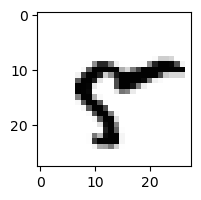

5.687699912272285% - 0
0.12325731119319809% - 1
0.0003748532004689632% - 2
0.001659135610598718% - 3
7.304540063395519% - 4
0.1734033167502359% - 5
1.5327441298048554% - 6
2.827982585693043% - 7
63.69645761008898% - 8 - ОШИБКА
32.640397913372574% - 9

 7


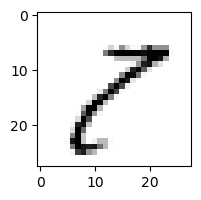

24.916832778546567% - 0
4.800253763540584% - 1
19.357796958594758% - 2
85.09057385198084% - 3 - ОШИБКА
0.8731361471506214% - 4
8.149982663657857% - 5
0.02558709165364882% - 6
1.8494105611738407% - 7
82.1519025436903% - 8
54.550736554578826% - 9

 2


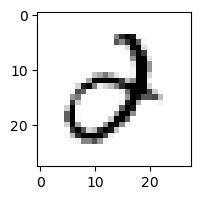

9.872153104849726% - 0
0.03434757433353428% - 1
0.23223110060028382% - 2
12.600568730300857% - 3
24.216758176116553% - 4 - ОШИБКА
1.151134863966335% - 5
0.11446111549480735% - 6
0.9326108627749479% - 7
0.04828086272088652% - 8
0.2203253809549859% - 9

 2


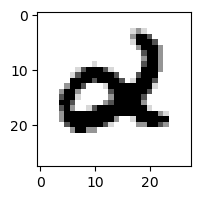

0.0069822052500015126% - 0
0.0034145097863550284% - 1
0.012835135331854737% - 2
1.2343434127566984e-05% - 3
1.5187697075789648% - 4 - ОШИБКА
0.045187480015775675% - 5
0.36430506029030474% - 6
0.0025322803431077545% - 7
0.26961625951060664% - 8
0.016189698395441782% - 9

 9


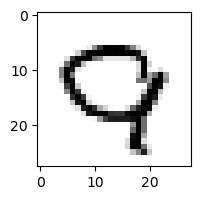

29.847327801870982% - 0 - ОШИБКА
0.004145148461328331% - 1
11.778011905776738% - 2
0.07800805340675336% - 3
0.15831232403132695% - 4
0.0009483770411299394% - 5
2.5558107927301266% - 6
5.751397848361309% - 7
0.31824874008652815% - 8
21.81784292068333% - 9

 8


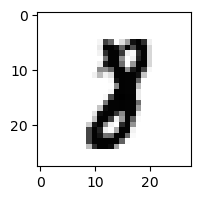

0.0025377723562421055% - 0
2.058182666943862% - 1
0.07266801117749594% - 2
0.4147298273934995% - 3
0.017681524319822173% - 4
0.02034111883526899% - 5
0.0018404173902658199% - 6
2.195552072291244% - 7 - ОШИБКА
0.16875894278816622% - 8
0.017078755118722817% - 9

 7


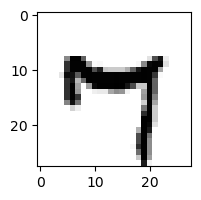

0.3091236466574815% - 0
0.05816097539167041% - 1
8.742093148965989e-05% - 2
0.5512020825940211% - 3
33.35310415412579% - 4
0.5439076119011652% - 5
0.14105651991320647% - 6
2.1981734348100117% - 7
12.408283469534554% - 8
74.44237347554386% - 9 - ОШИБКА

 7


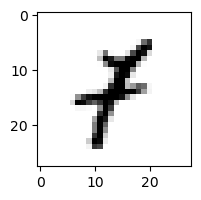

0.12199436846224174% - 0
69.59324971894269% - 1 - ОШИБКА
0.9228277345596528% - 2
1.6464042697992465% - 3
0.8955725391432939% - 4
0.47139797880978407% - 5
0.3803243238193841% - 6
0.30071018251845033% - 7
0.23511393242050863% - 8
4.8320330677293% - 9

 6


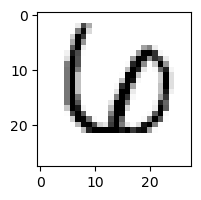

0.7451125778032335% - 0
0.259598266850835% - 1
12.462538102234118% - 2 - ОШИБКА
0.24424222402320622% - 3
6.570223747069728% - 4
0.032489126038527244% - 5
0.2883720368156457% - 6
3.291949608567096% - 7
0.04533215352780507% - 8
0.002548696102253568% - 9

 7


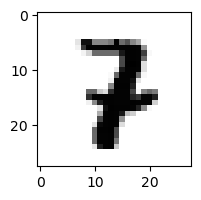

0.0007300892401106586% - 0
0.17813430765390287% - 1
0.6997549724312284% - 2
3.6077411064534104% - 3 - ОШИБКА
0.38884213389104194% - 4
0.008242111124630224% - 5
0.006300782814478881% - 6
0.19612805209043654% - 7
0.0030843492699401498% - 8
0.025507187198328615% - 9

 9


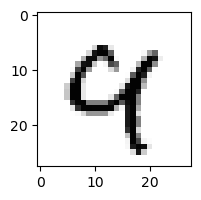

0.11280057678048921% - 0
0.02567300172436839% - 1
0.7146903952540579% - 2
0.009328794478770936% - 3
60.808109360957744% - 4 - ОШИБКА
0.008765427189753651% - 5
0.742351475296368% - 6
12.045850949730145% - 7
8.44617971328986% - 8
41.53652785143543% - 9

 6


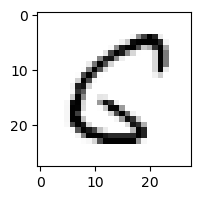

30.936281633035517% - 0
0.05864325742148429% - 1
3.2764514862291523% - 2
0.004707652196876023% - 3
1.9225367294977522% - 4
81.78935725489737% - 5 - ОШИБКА
0.045833453610062067% - 6
0.023203401376451785% - 7
21.098651832132646% - 8
0.06504469724936715% - 9

 5


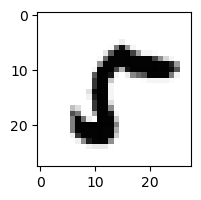

81.49852684616067% - 0 - ОШИБКА
0.0037749532932521137% - 1
0.32415694505820697% - 2
0.17838874905666238% - 3
0.0005817226715575772% - 4
8.755667688546247% - 5
0.005525027453706495% - 6
0.3297663230977433% - 7
77.62639373749126% - 8
0.4662049860454839% - 9

 2


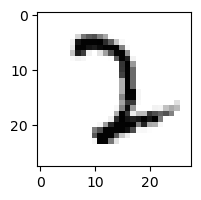

0.07046160820936416% - 0
0.03367716688601438% - 1
83.48537099586405% - 2
92.6467688037112% - 3 - ОШИБКА
0.04321408530954364% - 4
0.12166968219516333% - 5
0.7175488587727606% - 6
1.92858828027952% - 7
0.014517544315049525% - 8
0.1162127730786502% - 9

 9


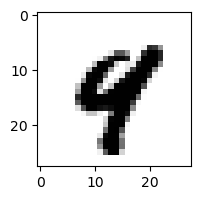

0.0027941499988599857% - 0
0.0018989195738237394% - 1
0.00023321265084661621% - 2
8.01939491705825e-05% - 3
75.34370697239603% - 4 - ОШИБКА
0.02407624757472856% - 5
0.00814282975972991% - 6
0.2571291177485344% - 7
0.4115679775628591% - 8
17.39181853468392% - 9

 2


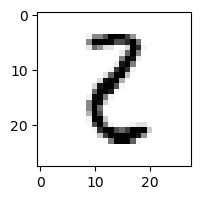

6.194129852940091% - 0
3.754291467278255% - 1
14.332993911686948% - 2
26.337489710786027% - 3 - ОШИБКА
0.0669085055702081% - 4
5.797408593174875% - 5
5.201926868191857% - 6
0.003774599512208035% - 7
16.235936075831376% - 8
0.020290935992779372% - 9

 5


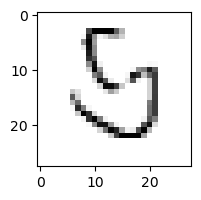

17.87961645457451% - 0
0.12741648256834065% - 1
19.698658790140943% - 2
4.62095406706534% - 3
1.810341868297324% - 4
1.0957663556088328% - 5
59.53231650057367% - 6 - ОШИБКА
1.313961097816271% - 7
42.9076582911214% - 8
1.059535192151432% - 9

 5


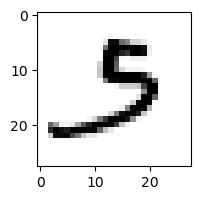

5.542480579510496% - 0
0.3641378237808923% - 1
7.0521978186113845% - 2
60.19868346855848% - 3 - ОШИБКА
0.0012233856324231993% - 4
0.708332922117984% - 5
1.47846757275329% - 6
5.919280366416302% - 7
0.03681434476533963% - 8
2.054949746310715% - 9

 1


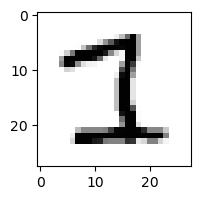

0.031857636660616535% - 0
0.10006817427242864% - 1
30.351570452353506% - 2
69.85661025009581% - 3 - ОШИБКА
0.12753828687211327% - 4
1.189531963895083% - 5
0.0015770054776609783% - 6
1.3846997908894394% - 7
0.28944545129684923% - 8
0.0007293192526070996% - 9

 9


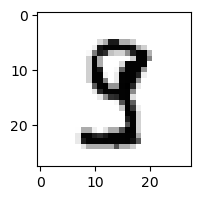

0.06864772672609634% - 0
0.04718110531369711% - 1
0.011238028236851156% - 2
64.30141191400656% - 3 - ОШИБКА
3.0895555462713924% - 4
2.5942915698725604% - 5
0.0002258312391395486% - 6
0.29042229107999523% - 7
23.008336554992436% - 8
0.08849611980240367% - 9

 5


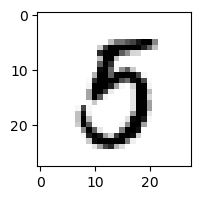

5.355602364508095% - 0
0.0038703436345006188% - 1
0.017926923869733827% - 2
50.3832330938623% - 3 - ОШИБКА
0.12622619833401916% - 4
40.85918247529799% - 5
0.09729018704449752% - 6
0.009279235277738022% - 7
1.5606196284968776% - 8
0.11367358140552332% - 9

 5


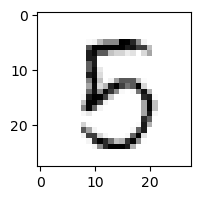

3.252876199484168% - 0
0.020358298170126986% - 1
2.7419955620276397% - 2
8.98606365012151% - 3
5.28309450984996% - 4
34.78800441320667% - 5
0.4366059918180458% - 6
0.010438298812554089% - 7
56.28230054339232% - 8 - ОШИБКА
5.4771708749359584% - 9

 4


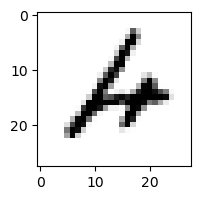

2.311319476387591% - 0
0.01755426847677353% - 1
8.075843837448557% - 2
3.794058423520746% - 3
1.97144815476001% - 4
0.09441807753644979% - 5
82.5338391650892% - 6 - ОШИБКА
0.0581472123226297% - 7
0.9410483803621006% - 8
4.54151221327796% - 9

 3


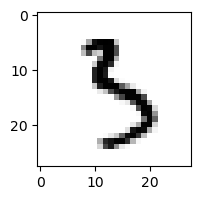

0.07926556733864402% - 0
0.03871929166602344% - 1
0.3888217204125542% - 2
39.12184385396145% - 3
3.642502128918306% - 4
47.51252747379212% - 5 - ОШИБКА
0.5241586924777852% - 6
0.2630674479765594% - 7
20.543805498910302% - 8
1.905685627656023% - 9

 2


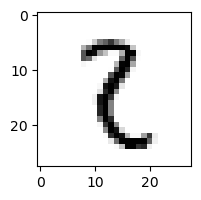

0.09717555308960493% - 0
36.2380047216721% - 1 - ОШИБКА
5.937190317935378% - 2
26.234184152018685% - 3
0.0509894392629991% - 4
2.9506666850904923% - 5
0.6027988387479464% - 6
0.13124464208552622% - 7
33.43461962150464% - 8
1.3653197346770174% - 9

 9


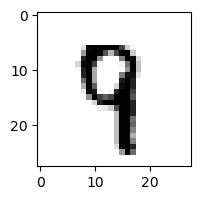

0.001250109113875166% - 0
0.07568249935841154% - 1
0.4464944033834989% - 2
0.5687264631221884% - 3
21.526017213287176% - 4 - ОШИБКА
1.1079602556137658% - 5
0.20636443497002835% - 6
2.2628319524049467% - 7
0.8732368548039685% - 8
15.159576878283634% - 9

 5


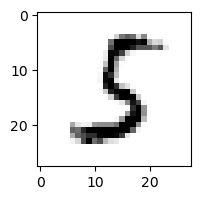

1.2975835634789075% - 0
0.6920706436202082% - 1
1.108198628747401% - 2
72.26529453608575% - 3 - ОШИБКА
0.01597548629572684% - 4
36.47693214452474% - 5
7.521450382388702% - 6
0.012380565943052662% - 7
2.720387590235754% - 8
0.006858482995787931% - 9

 3


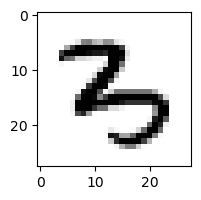

0.10170459651661735% - 0
0.001895179328383824% - 1
3.1068624010239807% - 2
1.043473301856416% - 3
13.959683017754296% - 4 - ОШИБКА
0.28226859314082997% - 5
0.5421729009893604% - 6
0.013215826224756711% - 7
0.024685356572373144% - 8
0.7032587362071623% - 9

 5


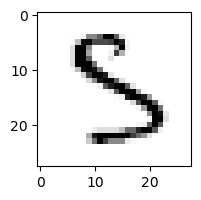

0.17058944289682532% - 0
0.029815869683040112% - 1
1.4056933099376867% - 2
32.65216513880146% - 3 - ОШИБКА
1.22725307640069% - 4
27.68004624532886% - 5
0.37511688029237295% - 6
0.3383109948158988% - 7
16.633634545062883% - 8
0.07481028291609941% - 9

 7


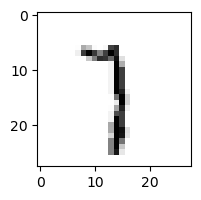

0.20935348194543912% - 0
52.64841813935603% - 1 - ОШИБКА
3.0158965028236997% - 2
26.007996840084% - 3
0.833100528647299% - 4
8.07361105007946% - 5
2.993328066963205% - 6
32.84311154122402% - 7
4.735564652949028% - 8
8.831587581763847% - 9

 9


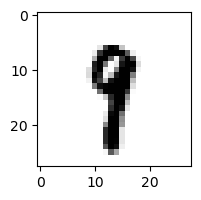

0.0017319195480981612% - 0
8.938966848963673% - 1 - ОШИБКА
0.011501769679489187% - 2
1.1621673257987772% - 3
0.5763593385121741% - 4
3.264464674945977% - 5
0.10965091057675627% - 6
1.5280553934951167% - 7
2.773976030574208% - 8
8.883619697346681% - 9

 9


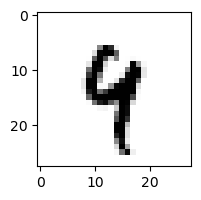

0.0024639019504059424% - 0
0.33952259397511647% - 1
0.18009674873388112% - 2
0.38181376478800727% - 3
81.46762562568696% - 4 - ОШИБКА
1.5125064656403133% - 5
1.1642333573809454% - 6
0.6457345098128341% - 7
4.5088498761190605% - 8
56.97520731561059% - 9

 5


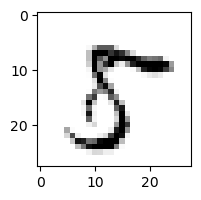

25.039586548095414% - 0
0.008982986136282003% - 1
0.17755455156594033% - 2
2.6957795367434754% - 3
0.18334688816156902% - 4
29.570357277461927% - 5
0.010834526565320251% - 6
9.24419692384452% - 7
88.2151192056476% - 8 - ОШИБКА
3.4831315705865324% - 9

 9


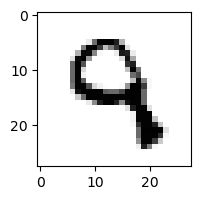

0.02134009115977781% - 0
0.00263266555531162% - 1
32.28583168692995% - 2
7.369251166736539% - 3
33.75180237643613% - 4 - ОШИБКА
0.6404717717072751% - 5
0.4686660613326934% - 6
0.020890892006744103% - 7
0.02490744614603939% - 8
20.41478942213223% - 9

 3


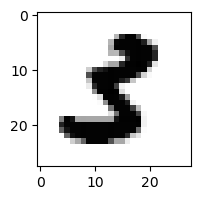

0.04678928879209644% - 0
0.07933241539484846% - 1
0.01027869213953597% - 2
6.250761115963723% - 3
0.0012170442169198493% - 4
15.948382388356652% - 5 - ОШИБКА
0.00021172298073557052% - 6
0.0007623807990331506% - 7
0.02015815235018134% - 8
2.292820491307528e-06% - 9

 8


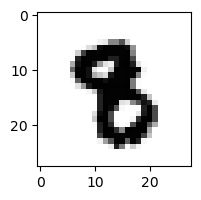

2.488179324831331e-05% - 0
0.009770761825896493% - 1
0.0006450405390552859% - 2
0.09388560442829405% - 3
0.004608274904841553% - 4
0.37880082687266164% - 5 - ОШИБКА
0.02053901322644934% - 6
0.00930726108887919% - 7
0.07460919022661412% - 8
0.015653043141539077% - 9

 4


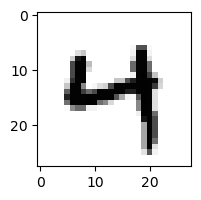

2.395796284476829% - 0
0.023943487224628884% - 1
0.07207316139104751% - 2
0.3125405967390708% - 3
83.46411786691714% - 4
0.01930926547353038% - 5
0.5657516117600115% - 6
0.04906453887404483% - 7
0.027481221972748684% - 8
93.25938205659304% - 9 - ОШИБКА

 1


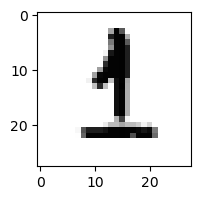

0.02456112399206037% - 0
7.2714734203465285% - 1
0.23951204519234928% - 2
6.45275546734531% - 3
0.01903539962133043% - 4
9.533933652286489% - 5 - ОШИБКА
0.15993330729767039% - 6
0.17724317568540862% - 7
0.1115136421909348% - 8
0.30777189342201566% - 9

 4


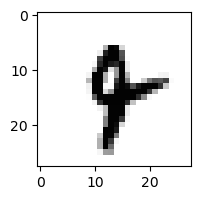

0.0010223173931546287% - 0
0.7448852232604983% - 1
0.0073560707454478685% - 2
0.010702870292455145% - 3
7.660578784832932% - 4
0.28597004767358736% - 5
3.390183705820503% - 6
0.6887588434189809% - 7
0.2159594433512148% - 8
39.604730971786736% - 9 - ОШИБКА

 7


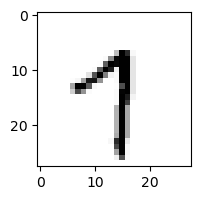

0.2688603193543563% - 0
11.464055711419826% - 1
0.06532501010042796% - 2
3.0584757660876662% - 3
19.699205622154796% - 4
5.026373881211891% - 5
2.431571530402058% - 6
62.971992735493934% - 7
0.4181472727021441% - 8
70.34342371416797% - 9 - ОШИБКА

 5


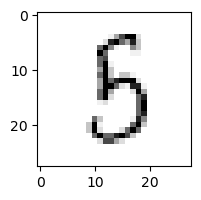

2.542481497105552% - 0
0.6547048746243388% - 1
2.4146461784116346% - 2
64.27985465232948% - 3 - ОШИБКА
3.388845705095379% - 4
62.41827893326403% - 5
9.69291297199146% - 6
0.14937757000712273% - 7
58.47927598981347% - 8
0.3345689778641132% - 9

 5


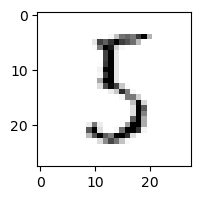

5.536283355015658% - 0
1.7907605882589914% - 1
3.049433516398168% - 2
77.44724615768483% - 3 - ОШИБКА
0.4395749007473577% - 4
55.072508960099306% - 5
14.299490826809247% - 6
0.3534121375705796% - 7
33.79330400720846% - 8
0.11273889687788352% - 9

 5


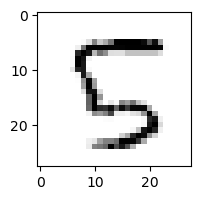

1.918456600365142% - 0
0.02383869037480242% - 1
38.672434998263846% - 2 - ОШИБКА
0.15266635205184398% - 3
16.594380463011177% - 4
28.924907482480727% - 5
0.31314609986811687% - 6
0.05741177242568595% - 7
21.584628312782275% - 8
0.08652705669809777% - 9

 6


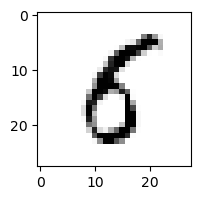

19.5246724810602% - 0
0.24636067298420788% - 1
0.11675601226568288% - 2
7.173423758090538% - 3
0.6020753742754497% - 4
55.82565831092027% - 5 - ОШИБКА
15.083480696892332% - 6
0.008774230997178266% - 7
13.03819919441693% - 8
3.2918934245344906% - 9

 0


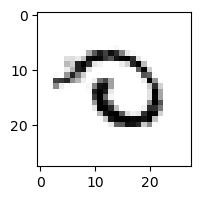

1.0802004764669138% - 0
0.045875157862033854% - 1
10.37490477345255% - 2
0.491578054058878% - 3
0.28962911932647106% - 4
1.734097488079385% - 5
45.78582842891892% - 6 - ОШИБКА
1.3883405069311705% - 7
4.360140367992094% - 8
26.7477866915177% - 9

 8


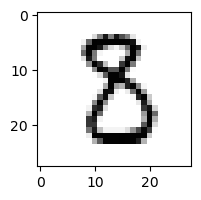

0.2947135157538588% - 0
0.1510434374389031% - 1
6.72219642429048% - 2
12.66303962573665% - 3 - ОШИБКА
0.008166518638689644% - 4
4.0167743066021675% - 5
0.017359148080478667% - 6
0.023412273645260107% - 7
10.320046801703853% - 8
0.0030866226624953006% - 9

 5


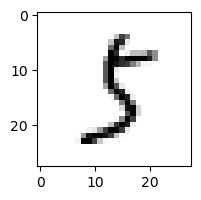

4.686394695657845% - 0
5.330934549575579% - 1
1.4444664250922432% - 2
71.99618516199602% - 3 - ОШИБКА
0.08897634814292825% - 4
25.477119123074594% - 5
0.49454979398752785% - 6
3.979265530257592% - 7
3.198681629862198% - 8
1.0321215042282723% - 9

 8


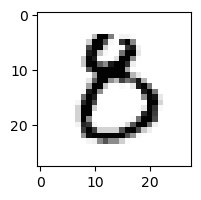

14.352847359348836% - 0 - ОШИБКА
0.0013098260365463701% - 1
0.4610950333933692% - 2
2.770148640636206% - 3
0.01154642025743549% - 4
12.766571238307748% - 5
0.40138839801711035% - 6
0.07474377876897605% - 7
0.03183482608526314% - 8
0.020286811866892768% - 9

 5


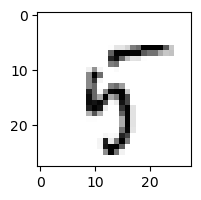

1.2479429504276478% - 0
0.9696053380872798% - 1
1.9281116315847429% - 2
0.4784739895036125% - 3
16.740927565855284% - 4
18.910119619569404% - 5
3.067900493013079% - 6
0.19151724714787796% - 7
38.12169598741465% - 8
75.23859747213356% - 9 - ОШИБКА

 9


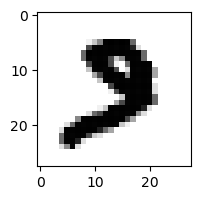

0.011197362611317936% - 0
0.0011211519481405638% - 1
0.9371669255182714% - 2
0.298011387428991% - 3
0.0001063609058973465% - 4
0.009363752190262944% - 5
0.0011057026190549853% - 6
4.190083840474905% - 7 - ОШИБКА
0.006528543524077371% - 8
0.008212886284018433% - 9

 8


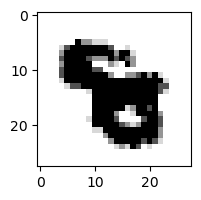

2.7178604573776105e-06% - 0
2.230883223209361e-05% - 1
0.00012751493953480742% - 2
2.831193354157173e-05% - 3
0.19142795941451968% - 4
0.0014550096953051899% - 5
1.0976487885640045% - 6 - ОШИБКА
0.001021932834826035% - 7
0.004443411785588899% - 8
0.022892738866721336% - 9

 9


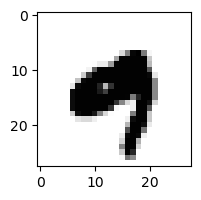

0.010655542147969247% - 0
0.005800644585570327% - 1
3.330095067392571e-05% - 2
0.007346237889786462% - 3
34.76985747423292% - 4 - ОШИБКА
0.0001709539185638095% - 5
0.05951748532234605% - 6
0.004628281846587858% - 7
0.0003149832375957641% - 8
14.12918370100201% - 9

 9


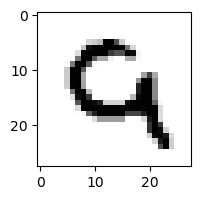

1.371823845855971% - 0
0.0006776450946795889% - 1
68.19216318924755% - 2 - ОШИБКА
0.0016360391680795084% - 3
1.2387788606320302% - 4
0.010418100978543779% - 5
8.153295410805798% - 6
0.5347181713999641% - 7
0.029354752251008854% - 8
52.71444330689076% - 9

 8


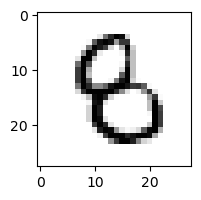

0.3237578372770848% - 0
0.06923477844018809% - 1
2.0077752565515845% - 2
1.013189009563% - 3
0.6708957944037649% - 4
6.035141562291269% - 5 - ОШИБКА
5.143511934750768% - 6
0.0019149518018508832% - 7
1.7634720608209116% - 8
0.2797576701844216% - 9

 8


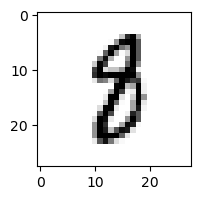

0.061425753846006854% - 0
2.492305626465484% - 1 - ОШИБКА
0.08371536773774664% - 2
1.6499948274212333% - 3
0.09448921408156302% - 4
0.5921427506968088% - 5
0.4543577002140371% - 6
0.5184434078662638% - 7
1.5503361798324098% - 8
0.05173994242116929% - 9

 5


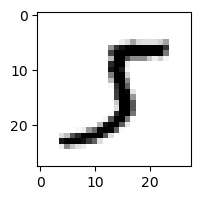

0.20052705037703616% - 0
30.824572011766065% - 1
0.854132347266763% - 2
35.96335772627961% - 3 - ОШИБКА
0.052452804379841844% - 4
15.951356756094592% - 5
0.05421635058600527% - 6
4.614749939540671% - 7
0.017702413070140893% - 8
0.5817350165378% - 9

 8


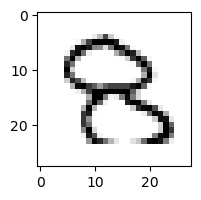

5.9539435994396355% - 0
0.005451186005517023% - 1
57.13615559788996% - 2 - ОШИБКА
33.79100767332173% - 3
2.580364094698453% - 4
0.2218346871740678% - 5
0.11809399866373231% - 6
0.010520928400066914% - 7
2.62004147695001% - 8
32.25835485024259% - 9

 8


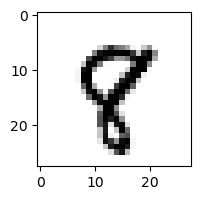

0.015408831295170467% - 0
0.5111809209250806% - 1
0.044099936985377466% - 2
0.025235544512983817% - 3
0.49945617029541695% - 4
0.902528714709562% - 5
0.02927644729153216% - 6
1.8970834765950222% - 7
8.536685902849744% - 8
14.810380280634018% - 9 - ОШИБКА

 8


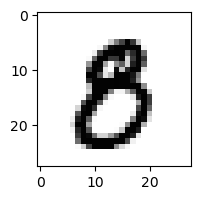

3.126471277060297% - 0
0.0003049996104894417% - 1
0.006879609837180266% - 2
15.1939494880591% - 3 - ОШИБКА
0.006599582733700713% - 4
1.5222323248438863% - 5
0.0006767398634761495% - 6
0.004128163045150731% - 7
0.3891463245379535% - 8
0.16293272834343556% - 9

 5


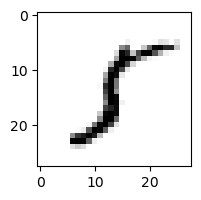

0.5236496409630091% - 0
92.56169169681426% - 1 - ОШИБКА
1.8410733203069538% - 2
5.880243250631156% - 3
0.057858465954675795% - 4
58.59573412943884% - 5
0.9862831682155152% - 6
1.8507353421695603% - 7
1.9935818621783274% - 8
0.36204561358092774% - 9

 9


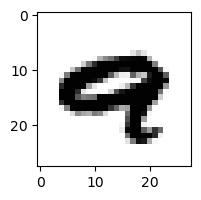

0.10851875561586671% - 0
0.00019353360131543442% - 1
9.111862869120247e-05% - 2
8.733215873507407e-06% - 3
26.86389271902465% - 4 - ОШИБКА
3.4174454900857734e-05% - 5
0.033957343970130505% - 6
0.7715941312611178% - 7
0.0008433994440405321% - 8
5.843937886337598% - 9

 8


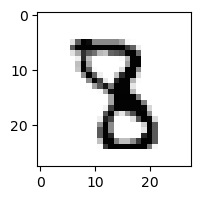

0.00031658142139964226% - 0
0.028791895125443997% - 1
0.37634251739503927% - 2
5.0556989290435554% - 3 - ОШИБКА
0.9729482269702103% - 4
0.23710174834156647% - 5
0.0036248783384201532% - 6
0.16636813692662406% - 7
0.44376395188804196% - 8
0.18843093152022927% - 9

 9


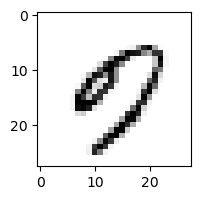

71.89349819770631% - 0 - ОШИБКА
0.010210776085470795% - 1
0.013862028963769285% - 2
1.3968527019691324% - 3
7.53976616145873% - 4
10.044127613097219% - 5
10.458715136027314% - 6
0.5813402818520743% - 7
0.6975687792024047% - 8
19.264775053554185% - 9

 2


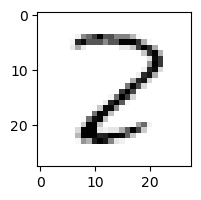

2.5229559142013036% - 0
1.4157958514748301% - 1
68.87325526441498% - 2
0.8664441055411334% - 3
1.169050616261051% - 4
0.38369485900876155% - 5
0.2886344933361874% - 6
0.5404915736159109% - 7
92.10768486531799% - 8 - ОШИБКА
0.004535063739403662% - 9

 2


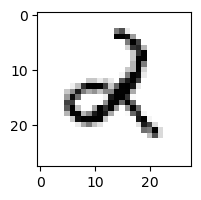

0.1315089221568783% - 0
0.8981182864458697% - 1
21.347199115008536% - 2
0.17572048913546934% - 3
57.509540358807364% - 4 - ОШИБКА
0.03076967845409048% - 5
4.026728202869961% - 6
0.01049491620532994% - 7
3.5402985606743878% - 8
0.8730701787475738% - 9

 2


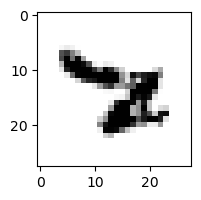

0.0036485426072563293% - 0
0.0144876707352963% - 1
0.0029260123371083985% - 2
0.018662015481883454% - 3
4.6920923032059445% - 4
0.3243181411935106% - 5
53.458694006791994% - 6 - ОШИБКА
10.330996458549059% - 7
0.06740296812680764% - 8
0.18805633887454296% - 9

 5


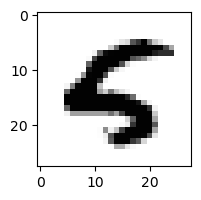

0.1487439802099544% - 0
0.00018685117365410637% - 1
0.04021693719135992% - 2
8.026199380322618e-06% - 3
19.55622307196202% - 4 - ОШИБКА
3.843733482929413% - 5
0.03434480473299255% - 6
0.00019560867351275043% - 7
0.00215439567638738% - 8
0.2307031745587952% - 9

 5


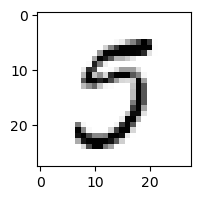

17.70271629633486% - 0
0.014989077444392927% - 1
0.008341636509693972% - 2
66.22722200581401% - 3 - ОШИБКА
0.11029480322575069% - 4
27.6842435851605% - 5
0.07888583085757131% - 6
2.5290916063806756% - 7
1.7222634232025986% - 8
2.057045478810774% - 9

 7


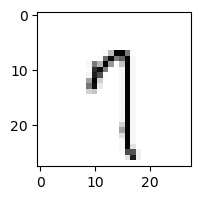

4.735474807948465% - 0
2.461588230844405% - 1
4.70246301703094% - 2
14.723756508147817% - 3
21.354125855082298% - 4
21.994090549733215% - 5
8.405970171388594% - 6
48.99386039478686% - 7
13.963239452147706% - 8
94.85209860406476% - 9 - ОШИБКА

 1


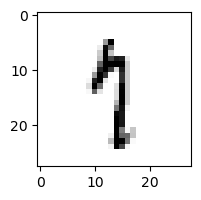

0.3995681130451562% - 0
12.460945139371066% - 1
0.4047863545411113% - 2
1.66594702943561% - 3
17.755227100671284% - 4
34.154191205823395% - 5 - ОШИБКА
3.60061668844513% - 6
32.109883640859586% - 7
6.344677655013371% - 8
10.67346289271877% - 9

 2


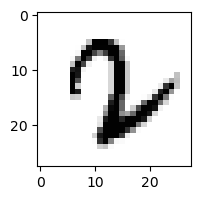

0.003492280126654933% - 0
1.892464988273152% - 1
0.043564987820168544% - 2
1.4106677527069789% - 3
0.0025794661499504816% - 4
0.0483092368173591% - 5
7.585784606240073% - 6 - ОШИБКА
0.2834791797419097% - 7
0.0008958300870500989% - 8
0.0034494932661916235% - 9

 6


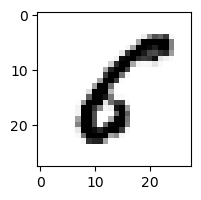

15.958737396755977% - 0
1.2264962107856543% - 1
0.9408790497625463% - 2
0.18539749200538283% - 3
0.35756992828023065% - 4
87.64154140568162% - 5 - ОШИБКА
1.447674571377596% - 6
0.014754402444242665% - 7
0.9367916412900178% - 8
0.0021789554592639695% - 9

 1


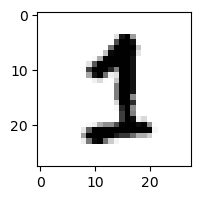

0.03618882275468004% - 0
0.09688071337523753% - 1
0.5286259596734342% - 2
3.1219478934848017% - 3 - ОШИБКА
0.006643602883780386% - 4
1.7070380501098155% - 5
0.025549988786802733% - 6
1.1515608880181447% - 7
0.02746428429513041% - 8
0.23581540394246792% - 9

 9


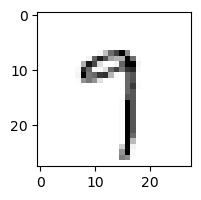

1.8914693324130438% - 0
0.8895663513773497% - 1
1.8862318122758115% - 2
19.294496624820678% - 3
4.67317665025643% - 4
13.05660396939255% - 5
1.9860512899038438% - 6
82.98163945678141% - 7 - ОШИБКА
7.116850619267626% - 8
61.98266751685884% - 9

 7


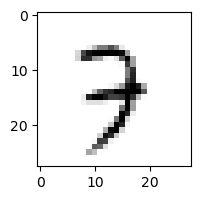

0.11746394752861929% - 0
0.1711592761269634% - 1
15.749113361816672% - 2
54.30884418313975% - 3 - ОШИБКА
18.010034139651047% - 4
2.052003113063127% - 5
2.7402123231784374% - 6
5.824748843057197% - 7
3.244509306785426% - 8
50.34564059456306% - 9

 6


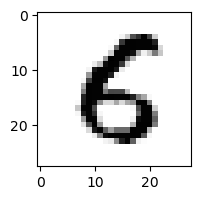

6.162235174643326% - 0
0.00225648420544837% - 1
0.28695036376676814% - 2
0.02494420351934732% - 3
0.29300753696887905% - 4
33.21955831797852% - 5 - ОШИБКА
12.360820969952409% - 6
0.00015546797012219783% - 7
0.09801314223591734% - 8
0.04370714243410103% - 9

 2


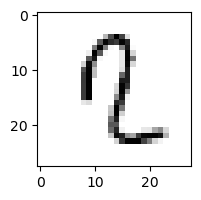

0.1512821312173552% - 0
5.724213229343852% - 1
11.169349068059436% - 2
0.540660480928041% - 3
24.509363117558255% - 4 - ОШИБКА
8.684216010721707% - 5
0.59717251840812% - 6
1.8551129375175723% - 7
1.6037042127482093% - 8
2.1629847337718% - 9

 5


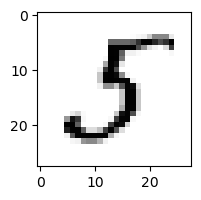

0.5084400846795119% - 0
1.1257542243057204% - 1
2.4952966995215218% - 2
52.570427121216326% - 3 - ОШИБКА
0.09263000183069273% - 4
26.896362575248585% - 5
0.8568394675830041% - 6
0.2843134862593165% - 7
0.6672089483860756% - 8
0.38141179082394583% - 9

 3


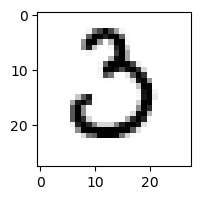

42.40237515566945% - 0
0.006952923443949561% - 1
69.07689477626657% - 2 - ОШИБКА
43.081075356176505% - 3
0.0005838083989857572% - 4
0.11765732715508992% - 5
1.456750127005341% - 6
0.9083813886904639% - 7
0.0016669033237945703% - 8
0.019219283717620776% - 9

 5


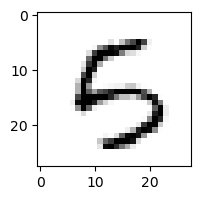

5.4606387262602105% - 0
0.009909789950830016% - 1
5.254657470238668% - 2
0.618730959776424% - 3
11.128886524658805% - 4
16.140444991387472% - 5
1.5545107524872226% - 6
0.011337157178734495% - 7
4.301900816280864% - 8
16.576631780494196% - 9 - ОШИБКА

 5


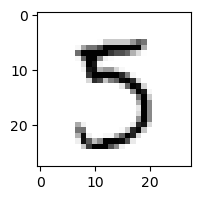

0.9654059837211872% - 0
0.02219101489360926% - 1
0.09191050660954622% - 2
62.88584732782623% - 3 - ОШИБКА
0.13177986099008057% - 4
50.47778996491705% - 5
0.053614328601226814% - 6
6.795148458141188% - 7
28.409871055082313% - 8
0.5442258044215341% - 9

 4


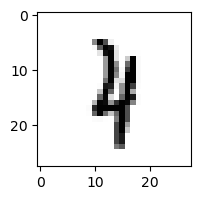

0.003703770077258419% - 0
11.339648157098443% - 1
4.112985475107581% - 2
2.709642673565639% - 3
20.276719344442743% - 4
0.21676010550812905% - 5
5.903979425503292% - 6
3.211512724742147% - 7
27.918622974098255% - 8 - ОШИБКА
8.26728174520716% - 9

 5


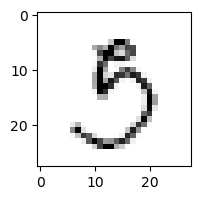

12.06643782205744% - 0
0.24737124201129018% - 1
0.638677614851774% - 2
91.79488381470983% - 3 - ОШИБКА
0.15434942253791728% - 4
25.295195425080696% - 5
0.21413279075092034% - 6
1.0487624817602221% - 7
26.710065505152038% - 8
14.614877433250825% - 9

 9


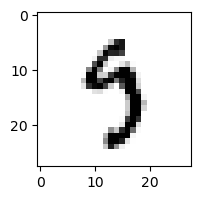

0.26455974683181477% - 0
0.056927930792476905% - 1
0.006636886992412832% - 2
62.12198045334115% - 3 - ОШИБКА
8.330761173082484% - 4
8.08861635299816% - 5
0.9479586583186017% - 6
3.2258190032937164% - 7
4.031422041550025% - 8
3.937175319229924% - 9

 2


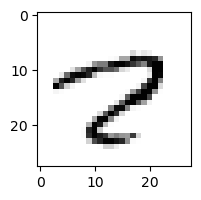

15.846472814119828% - 0
0.2637870344607268% - 1
0.02514218343996378% - 2
0.0037159711926786037% - 3
1.6244266165164385% - 4
4.708482921165263% - 5
0.019658156636029326% - 6
93.00484626861389% - 7 - ОШИБКА
12.817341901437484% - 8
0.7623560464089361% - 9

 7


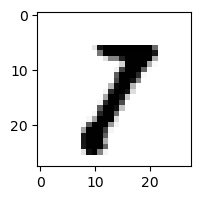

0.04523502143546499% - 0
36.90362171294023% - 1 - ОШИБКА
0.9061860111523028% - 2
13.045771118299685% - 3
0.00726927790486806% - 4
0.1461604528369617% - 5
0.0008949781432757266% - 6
3.6692347242019663% - 7
0.7936355279082263% - 8
1.8952473326924433% - 9

 5


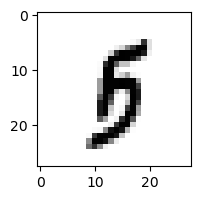

0.0535748336416862% - 0
0.6983101880545168% - 1
0.04160027826455803% - 2
17.08530882767173% - 3
0.31263688154713265% - 4
2.575116119910798% - 5
2.3541833175026317% - 6
0.09530479486557976% - 7
10.477257009378977% - 8
21.55521981158988% - 9 - ОШИБКА

 5


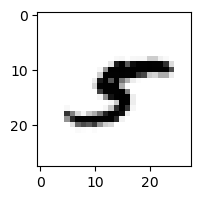

0.06487228262587738% - 0
15.646839446858865% - 1
0.8588797752971034% - 2
2.000862741563414% - 3
1.7204187250099825% - 4
0.365067015286842% - 5
0.1124180259238855% - 6
2.438095584354074% - 7
37.33680561096164% - 8 - ОШИБКА
0.1573856526852183% - 9

 3


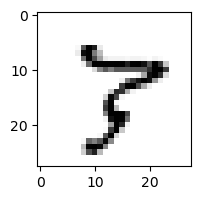

0.08930835333349683% - 0
0.6204414955950315% - 1
0.7467009008152508% - 2
0.2984478491610725% - 3
0.5322961411147135% - 4
0.056043638863742376% - 5
0.0630587689252643% - 6
90.78994979745485% - 7 - ОШИБКА
36.13133012844871% - 8
0.9357665490704064% - 9

 4


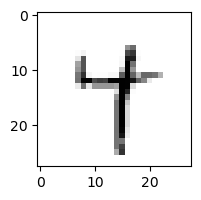

0.12185051832005844% - 0
15.028245150329738% - 1
0.06242395443254075% - 2
10.066757488632264% - 3
55.46276228486071% - 4
1.3683761046062992% - 5
3.74249750669665% - 6
22.447131439387448% - 7
15.613884848962304% - 8
59.18191402180252% - 9 - ОШИБКА

 5


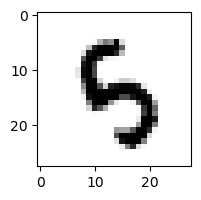

0.007618438245873073% - 0
0.00808065964608165% - 1
0.5675541814017688% - 2
0.7673334023925943% - 3
32.61127007133798% - 4 - ОШИБКА
18.69874698991855% - 5
2.9268941438016762% - 6
0.002389792017750033% - 7
2.316967926968277% - 8
12.856256691842574% - 9

 3


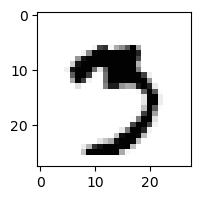

0.049275672398381% - 0
0.02310487255573759% - 1
0.0008327819492478217% - 2
12.575609025601656% - 3
9.577918740674193e-05% - 4
1.4364443679845036% - 5
0.0011962996240349633% - 6
72.52625631151733% - 7 - ОШИБКА
0.053520968685872576% - 8
14.958233636005334% - 9

 5


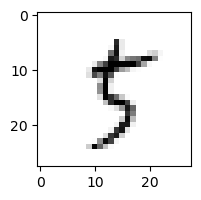

3.402038796592397% - 0
1.8472005818254544% - 1
0.4684387299302982% - 2
17.917451063279053% - 3
1.9745438256021708% - 4
47.48629188395831% - 5
0.7822518558821103% - 6
15.972851837161189% - 7
49.594826281005325% - 8 - ОШИБКА
6.908400945015441% - 9

 9


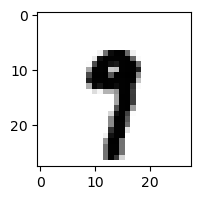

0.001540148307726535% - 0
0.32572612896874736% - 1
0.00041103865315406037% - 2
0.6989411380577207% - 3
0.7194590620029757% - 4
1.3818519698624216% - 5
0.051343057000637626% - 6
24.903007482638685% - 7 - ОШИБКА
0.16492174066456552% - 8
13.759076435259379% - 9

 5


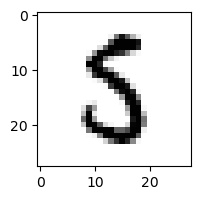

0.7777147697477262% - 0
0.025214542300036755% - 1
1.1296211214938523% - 2
3.177294146164479% - 3
0.026012095362486682% - 4
22.580145715439105% - 5
2.1435363532673146% - 6
0.03384943808921651% - 7
70.20204480505093% - 8 - ОШИБКА
0.027865034658074904% - 9

 2


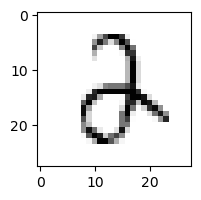

4.510468383540926% - 0
0.048938392496814954% - 1
46.92508803157538% - 2
70.34075204212115% - 3 - ОШИБКА
11.710459698946373% - 4
0.535203140480828% - 5
0.9119371629981251% - 6
0.1279193006572004% - 7
0.3794771994739457% - 8
0.9118804857520884% - 9

 5


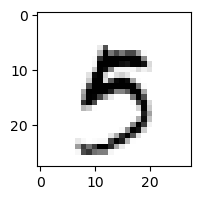

0.475396689296188% - 0
0.02306593332067796% - 1
0.004245343620357878% - 2
20.750418526893963% - 3
2.9554132065550265% - 4
19.64822038721133% - 5
0.06580710548584105% - 6
0.3517714920025707% - 7
0.030787428050726866% - 8
57.50172400151842% - 9 - ОШИБКА

 5


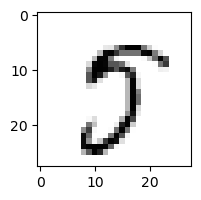

4.5483102189334845% - 0
0.01733108448181083% - 1
0.061218241059636885% - 2
13.136311143367232% - 3
0.23967754210444092% - 4
54.17385747120343% - 5
0.04162082419513871% - 6
73.38539620282353% - 7 - ОШИБКА
3.5044943641024235% - 8
4.998324320745579% - 9

 5


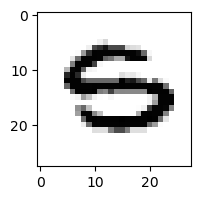

3.4794395072492352% - 0
0.0008164110957950634% - 1
0.03371108091203022% - 2
0.1229273024889271% - 3
0.002794830168244264% - 4
0.31111924981519185% - 5
74.10827848245908% - 6 - ОШИБКА
0.0030167049878382824% - 7
0.0031416363113971214% - 8
1.9589673413338535% - 9

 9


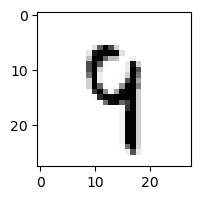

0.01758986808280407% - 0
0.09401670056837366% - 1
3.3368973482435416% - 2
7.287046118266112% - 3
69.93152252479838% - 4 - ОШИБКА
3.4861053292236077% - 5
2.1178974544038742% - 6
4.283692115826238% - 7
21.669729488513887% - 8
37.71098033194458% - 9

 9


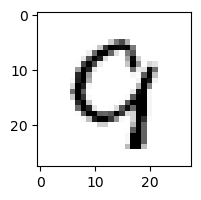

20.837768908633535% - 0 - ОШИБКА
0.0033435951526974267% - 1
12.386085430316001% - 2
0.006639810869887888% - 3
3.9505490697045316% - 4
0.07565704627573601% - 5
2.177367478701498% - 6
4.208631572915618% - 7
1.1011802180044665% - 8
17.3783051864326% - 9

 5


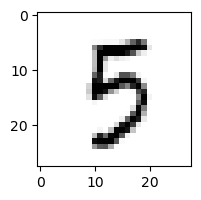

2.9879741114377767% - 0
0.01419774179809064% - 1
0.05796760178727866% - 2
80.93737659343134% - 3 - ОШИБКА
1.8227188311402927% - 4
30.63820546839408% - 5
1.8401565632001293% - 6
0.02453538612586826% - 7
12.010500238995043% - 8
26.127791394691435% - 9

 7


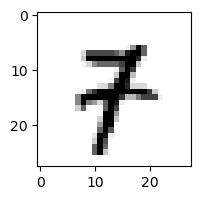

0.015755629081260797% - 0
3.5619050635194056% - 1
0.6320327265527137% - 2
0.6927234992844686% - 3
1.211009723871931% - 4
0.31723951700942715% - 5
0.16536806836146342% - 6
1.4993233114816236% - 7
0.012892144471951401% - 8
13.537673682339879% - 9 - ОШИБКА

 9


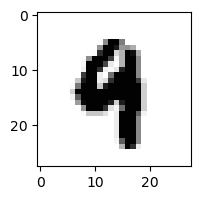

0.0007290385273094231% - 0
0.006655765687329187% - 1
0.0047424991512696356% - 2
0.031917050095275006% - 3
22.71151322046255% - 4 - ОШИБКА
0.027944020574809655% - 5
0.07445642534067633% - 6
0.0020665377221995352% - 7
0.011509651987370485% - 8
11.199125785750171% - 9

 2


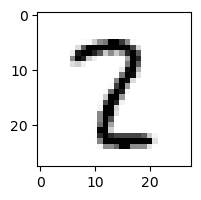

0.026949926258673346% - 0
12.868334177859575% - 1
6.698375197711798% - 2
8.116067058723942% - 3
0.31936552682448704% - 4
0.3525384595416781% - 5
0.005200073362324103% - 6
1.2586338288936454% - 7
51.31659061568919% - 8 - ОШИБКА
0.08221095000942899% - 9

 7


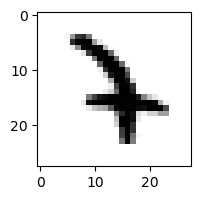

7.187224132826554e-05% - 0
0.925645252413977% - 1
1.7344458962655585% - 2
9.291253186508168% - 3 - ОШИБКА
5.177378504200075% - 4
0.07449468357393159% - 5
2.3634893214000026% - 6
2.6328903368646763% - 7
0.002927754638990045% - 8
0.09449298808666132% - 9

 8


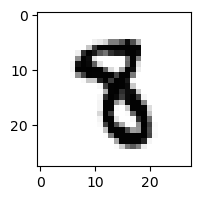

7.057400987000544e-05% - 0
0.09255832672939239% - 1
0.017616464018711864% - 2
0.292583002548268% - 3
0.1410218657814424% - 4
2.1234667072032405% - 5 - ОШИБКА
0.020138877442160308% - 6
0.024657163046450895% - 7
1.1207065407800563% - 8
0.031579202380987166% - 9

 3


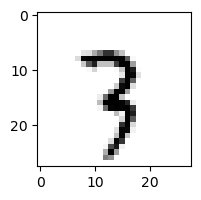

0.0036586395470373056% - 0
11.1473982329431% - 1
8.434803086612511% - 2
4.397447505453784% - 3
3.5345297958449438% - 4
0.7097561574244425% - 5
0.6518933220484131% - 6
55.40381326569509% - 7 - ОШИБКА
5.762417950524227% - 8
11.057106009212179% - 9

 5


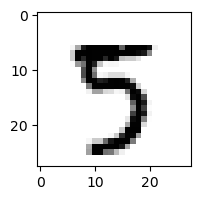

0.05614358698439619% - 0
0.0010451246962332257% - 1
0.005182929294412465% - 2
54.16227778771938% - 3 - ОШИБКА
0.2530158288713753% - 4
41.30546468899073% - 5
0.035066080156890986% - 6
1.732299639377468% - 7
3.8745983656293483% - 8
3.962350069950596% - 9

 6


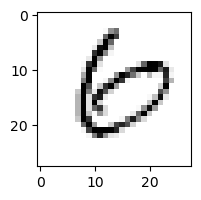

61.25807022254508% - 0 - ОШИБКА
0.022855232102559422% - 1
1.5236534552925247% - 2
2.9367762338610834% - 3
0.5837908933970657% - 4
0.6451987652481458% - 5
24.823497625931914% - 6
0.08386829466352988% - 7
15.053678315426275% - 8
0.4261734579467405% - 9

 2


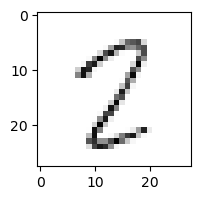

3.707275952426254% - 0
8.567601281644063% - 1
6.922087383847504% - 2
2.8310622035678676% - 3
3.472041414046248% - 4
24.739352193768525% - 5
0.5592527758899738% - 6
25.075095167483706% - 7
91.85945364592308% - 8 - ОШИБКА
1.996704598748867% - 9

 9


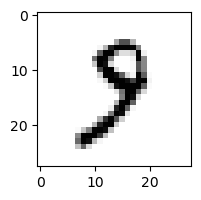

0.17561285786598965% - 0
1.930330069628362% - 1
0.8457886593002428% - 2
3.9052656558974546% - 3
0.21190118287318402% - 4
2.3963090209019313% - 5
0.14146759296895106% - 6
14.347158953510114% - 7 - ОШИБКА
3.028681662055495% - 8
4.797649436855543% - 9

 8


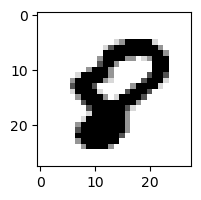

4.7880159596337855% - 0 - ОШИБКА
4.3075421712248825e-05% - 1
0.00038980315703651843% - 2
3.4637823979508063e-07% - 3
0.08708545353236374% - 4
1.2399814851656688% - 5
0.09587162916303418% - 6
0.0042920394195338826% - 7
0.6548717842486754% - 8
0.02772717842188097% - 9

 5


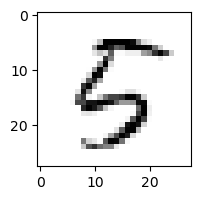

4.3003280458602084% - 0
0.02545773312556653% - 1
1.988415263342379% - 2
0.49153410401139097% - 3
38.48699994136075% - 4 - ОШИБКА
6.667548925913172% - 5
2.4455527573633313% - 6
0.04216488008559156% - 7
10.806505726091524% - 8
0.1673308005353562% - 9

 0


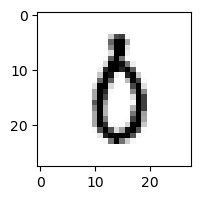

2.0199522837570183% - 0
0.09362862161661373% - 1
1.400495494613137% - 2
34.535416268794364% - 3 - ОШИБКА
0.11505069652432236% - 4
2.0254588851518807% - 5
25.725727981059876% - 6
0.3844960918725816% - 7
4.670272256774274% - 8
0.6604648914699418% - 9

 4


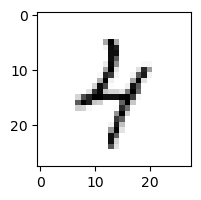

2.601229281747189% - 0
0.34530635489888073% - 1
7.769444235145763% - 2
9.592719854298128% - 3
61.44728287687581% - 4
2.6773517238164595% - 5
23.7021048056771% - 6
0.963653175635996% - 7
16.974590616562427% - 8
69.02982442403784% - 9 - ОШИБКА

 9


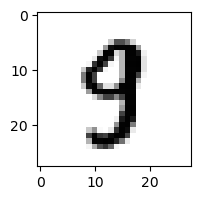

0.19930354531306615% - 0
0.011009155225780113% - 1
0.02918968290393858% - 2
8.99220249019692% - 3 - ОШИБКА
2.7791844979295597% - 4
2.1343905136413133% - 5
0.005906926640673732% - 6
0.36800933966295934% - 7
1.5601002694321306% - 8
5.896207821771416% - 9

 8


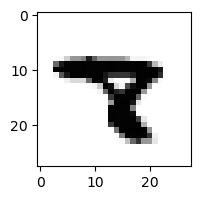

9.478755665419823e-05% - 0
0.018273475205170506% - 1
0.0013224000410310334% - 2
0.0010808796248362815% - 3
1.9207100370268089% - 4
0.036680237907876466% - 5
0.009935043183260658% - 6
36.37938413136732% - 7 - ОШИБКА
0.21741340040778626% - 8
0.14510765895193042% - 9

 7


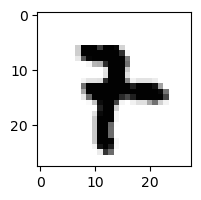

0.0016974380476529132% - 0
0.1501336087175588% - 1
0.002384750407267137% - 2
0.467931514843868% - 3
0.0806202918092108% - 4
0.2922228482184706% - 5
5.394098903465635% - 6 - ОШИБКА
0.13037636303408537% - 7
0.0775480947613936% - 8
1.647106877924714% - 9

 9


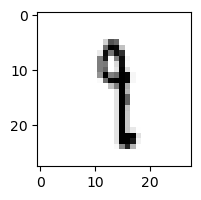

0.15487283953647543% - 0
50.34493218307481% - 1 - ОШИБКА
1.487968554137515% - 2
46.257605900868185% - 3
2.7810950401317918% - 4
7.896150055139972% - 5
1.1883363547591357% - 6
11.793997169195345% - 7
19.25358904465718% - 8
26.511376893126616% - 9

 8


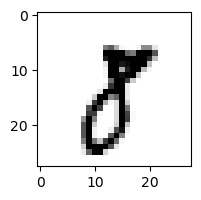

0.28472360244093525% - 0
7.224870596101102% - 1
0.15693179766313137% - 2
43.805107322576596% - 3 - ОШИБКА
0.0035480141278388983% - 4
0.5009224861821094% - 5
0.0016988418462456334% - 6
2.1095878629659% - 7
1.4733976111463658% - 8
2.296809141064886% - 9

 7


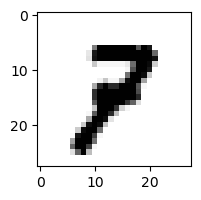

0.04129191545987106% - 0
0.16381174895355788% - 1
5.703372928078186% - 2
3.6860586966031748% - 3
0.07540930361571517% - 4
0.06628395241662997% - 5
0.0042310640132293435% - 6
0.22625320119219441% - 7
10.983934171240522% - 8
30.238742125312406% - 9 - ОШИБКА

 5


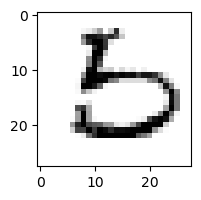

21.51339371628244% - 0 - ОШИБКА
0.002455362417612802% - 1
7.405369855440207% - 2
0.5142715648171791% - 3
0.0318440130509895% - 4
13.357466155436914% - 5
3.285632847893885% - 6
0.03882717329727368% - 7
8.230080613358256% - 8
0.01107666938920335% - 9

 6


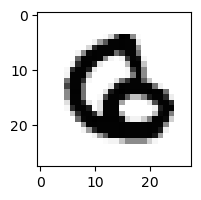

0.010770425372874062% - 0
0.00040301195829171426% - 1
10.986189054890385% - 2 - ОШИБКА
1.1225211643172551e-05% - 3
0.0015154908738531463% - 4
0.0006436754817051592% - 5
0.15001275649887397% - 6
0.00026270479092170855% - 7
0.0008001794829502522% - 8
0.000571070721482463% - 9

 4


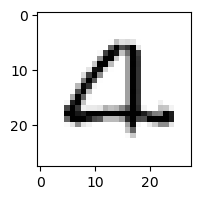

11.117326154239649% - 0
0.0011277691950737992% - 1
79.54049244739087% - 2 - ОШИБКА
0.021286748454531976% - 3
0.5580961362096941% - 4
0.043222261101826% - 5
0.57210636119444% - 6
0.36100771455413383% - 7
0.01567571321293569% - 8
7.797655596910339% - 9

 5


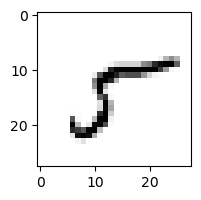

17.546657428406988% - 0
6.140499346656549% - 1
2.1574425187550452% - 2
27.492889989131182% - 3
1.5121813333084655% - 4
42.67760784664844% - 5
2.0128230007326144% - 6
8.120710896451808% - 7
88.28405646596474% - 8 - ОШИБКА
0.7903270828955172% - 9

 5


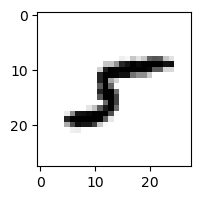

2.7657192952514427% - 0
6.252940334613495% - 1
6.495016567422575% - 2
1.1787394750342086% - 3
0.5153682482407743% - 4
3.7591224872498032% - 5
0.3248574233155205% - 6
1.4105718603068664% - 7
97.32397476453355% - 8 - ОШИБКА
0.17201594956739855% - 9

 8


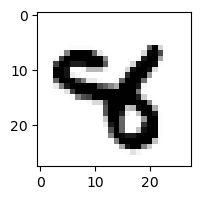

2.3346231235751738e-05% - 0
0.0020479558849937672% - 1
0.009500933456781758% - 2
0.003790425015321882% - 3
94.54903802408492% - 4 - ОШИБКА
0.1093902670122984% - 5
0.00278843632578182% - 6
0.44196256695802566% - 7
0.008637401701949208% - 8
0.01592130835027629% - 9

 2


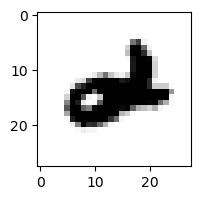

0.11902164864535342% - 0
0.011005552484515638% - 1
0.00888991732868612% - 2
0.0010388900535195581% - 3
93.50034526319462% - 4 - ОШИБКА
0.00011445970446396037% - 5
1.2971833876590604% - 6
0.005311679025384734% - 7
0.025524658943225104% - 8
0.8419175439654074% - 9

 8


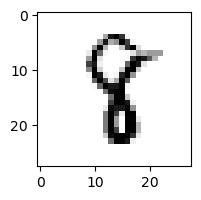

0.003372261266323743% - 0
5.127615179350687% - 1
0.4154594333204704% - 2
1.2480458271904855% - 3
10.24945909499971% - 4 - ОШИБКА
4.078600185100072% - 5
0.05247837684851686% - 6
0.45217671692219613% - 7
3.053136261645429% - 8
0.005315899722910116% - 9

 8


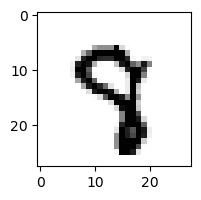

0.010526083514810942% - 0
0.0037751558886038664% - 1
0.19982906884664073% - 2
1.6511764572605832% - 3
2.3231708697477775% - 4
1.7554519302126956% - 5
0.028428642551670408% - 6
3.4000134100035786% - 7
0.9286399203350113% - 8
10.490970160312129% - 9 - ОШИБКА

 8


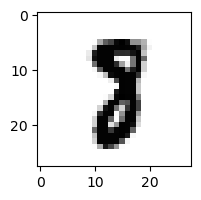

0.0030631743414523387% - 0
0.14346370456138824% - 1
0.12465743936630345% - 2
0.8513865409631591% - 3
0.003797606022126209% - 4
0.03644961295882734% - 5
0.01091948450910328% - 6
2.6079366305017677% - 7 - ОШИБКА
0.17833621851960862% - 8
0.004143543506234828% - 9

 3


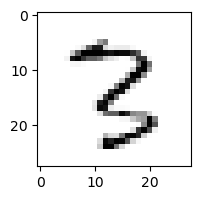

0.06867577293259676% - 0
0.4829830816021373% - 1
29.981383443096043% - 2
25.40057756230779% - 3
0.7201937094420215% - 4
0.6925711642578588% - 5
0.019481296618067055% - 6
3.2135058032455373% - 7
79.97498591257765% - 8 - ОШИБКА
9.402414012883078% - 9

 8


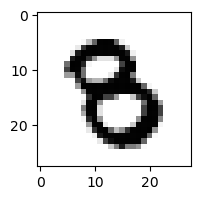

0.014503219466233303% - 0
0.0006146406292820706% - 1
0.04021434221958064% - 2
5.82825398089165% - 3 - ОШИБКА
0.013042737985942944% - 4
0.3034710852039728% - 5
0.04381279220087521% - 6
0.00040901197252771394% - 7
0.013572929472368265% - 8
0.02059864563199094% - 9

 7


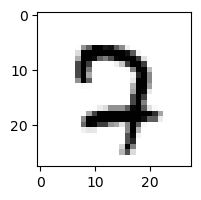

1.0092799965529826% - 0
0.001195692635016427% - 1
35.30144781839467% - 2 - ОШИБКА
0.07483650545167488% - 3
0.001064189660227941% - 4
0.19095579121640066% - 5
0.5681509092498986% - 6
23.812970727641805% - 7
0.13496183984401236% - 8
1.2364550767832725% - 9

 6


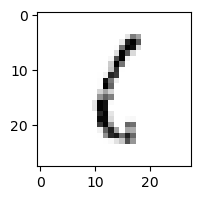

9.75489876063811% - 0
21.851710914038353% - 1
24.751326211951955% - 2
16.77497800767162% - 3
0.3075420580620935% - 4
19.951165072484788% - 5
79.92324444988368% - 6
0.7096911334480372% - 7
89.9952616952819% - 8 - ОШИБКА
10.294831350835604% - 9

 5


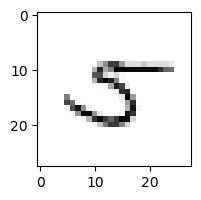

11.253879655009262% - 0
3.35376170255781% - 1
3.1269879869432673% - 2
2.6161814001906527% - 3
6.1483624793513485% - 4
1.4412539644289073% - 5
16.97602766300221% - 6
25.438092607906466% - 7 - ОШИБКА
17.187417189499293% - 8
3.778036965869796% - 9

 8


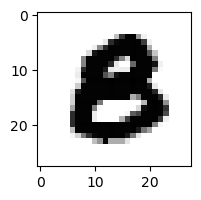

1.014297739823137% - 0 - ОШИБКА
3.048208233971328e-07% - 1
0.0019320937703579976% - 2
0.025280515833160655% - 3
0.00023675205318982325% - 4
0.099910930362618% - 5
0.003088912279271149% - 6
4.0502804978895005e-06% - 7
0.00020475673375603648% - 8
0.00026760593415870354% - 9

 8


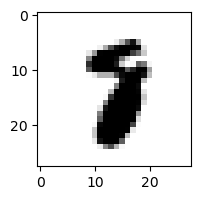

0.0003098779867605681% - 0
0.03708346858512976% - 1
0.05444496075826422% - 2
0.016489396836011416% - 3
0.011558368965713632% - 4
0.011728585584570945% - 5
0.024304314109680526% - 6
8.778871545713761% - 7 - ОШИБКА
0.07401262086040822% - 8
0.09433573539158877% - 9

 9


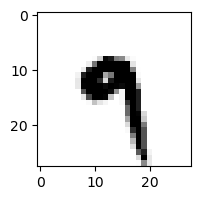

0.006626661521423408% - 0
0.11494777484105773% - 1
0.0011779952703200802% - 2
3.3338146980785957% - 3
48.745928394407166% - 4 - ОШИБКА
22.052603532003133% - 5
1.5910187643119218% - 6
0.1715949374959137% - 7
0.03745333363506642% - 8
46.25017285193487% - 9

 8


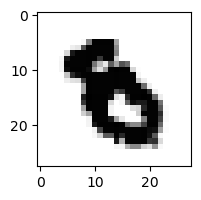

4.170724942494189e-05% - 0
7.829009869108124e-05% - 1
0.002660285814496498% - 2
0.004014827090371277% - 3
0.07078735195530458% - 4
0.30557142291922196% - 5
1.4734543064319299% - 6 - ОШИБКА
0.0006666397580721609% - 7
0.000902118671149117% - 8
0.0008040018729924394% - 9

 5


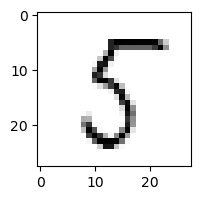

9.839652085334254% - 0
1.2677625627345148% - 1
0.9621075136151733% - 2
5.560163403110228% - 3
3.7634985807909964% - 4
91.43126637488977% - 5
0.8488584227566434% - 6
0.15431600257228176% - 7
92.47408562541317% - 8 - ОШИБКА
0.12657707644621097% - 9

 4


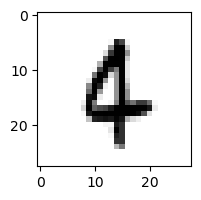

0.046656326065754226% - 0
0.5577230064306188% - 1
0.39066440519057194% - 2
0.0075297784881413815% - 3
1.6595406570006868% - 4
0.22192968711995542% - 5
26.81380149286104% - 6 - ОШИБКА
0.39475112417857267% - 7
0.1222214854033306% - 8
5.189457258520962% - 9

 9


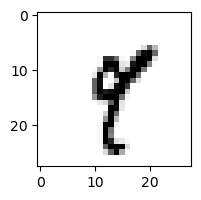

0.02703955709553733% - 0
28.153026560717997% - 1 - ОШИБКА
0.01625475427841505% - 2
2.836964448722526% - 3
10.307371679984637% - 4
5.264545618153047% - 5
0.03593429060968399% - 6
16.145973845816634% - 7
3.8859773861464304% - 8
2.4015507197452273% - 9

 5


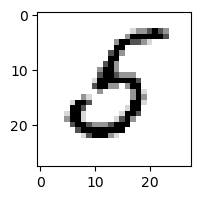

5.483196746096949% - 0
0.03520312706049021% - 1
0.9510222948907006% - 2
8.43367359578835% - 3
0.1769019159108781% - 4
19.68969826342119% - 5
44.99044587619617% - 6 - ОШИБКА
0.04058135711955304% - 7
0.054518349415187024% - 8
0.07397638197865139% - 9

 8


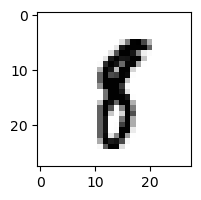

0.011829424107516043% - 0
17.528083411898994% - 1 - ОШИБКА
0.026737618793291094% - 2
2.812797154231589% - 3
0.05720765053489139% - 4
2.3751587290461904% - 5
0.15816051609790677% - 6
0.12855958109594862% - 7
6.570356328620132% - 8
0.4067635904961466% - 9

 3


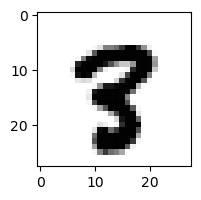

0.0008707612485472405% - 0
0.0014341969163264438% - 1
0.00397019051494913% - 2
0.03855225899350275% - 3
0.031189432784737067% - 4
0.2993737876121925% - 5
0.00019922952629016272% - 6
0.32576652850846777% - 7
27.010799945707426% - 8 - ОШИБКА
3.11312571327456% - 9

 8


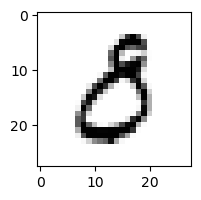

54.998167774922905% - 0
0.029817870675471283% - 1
0.39249510359065204% - 2
76.45679640726335% - 3 - ОШИБКА
0.019211108387608953% - 4
3.1881197392310248% - 5
0.20727359793088568% - 6
0.05105526953966719% - 7
0.02961734918398871% - 8
0.005881540577231085% - 9

 3


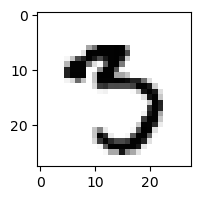

0.12598855620398405% - 0
0.010888625170911928% - 1
0.0043257155079343655% - 2
7.909620081291734% - 3
0.0022268512771787797% - 4
34.47649327900016% - 5 - ОШИБКА
0.040298799332485466% - 6
3.9040108778371474% - 7
11.897609451830718% - 8
28.629439210545787% - 9

 4


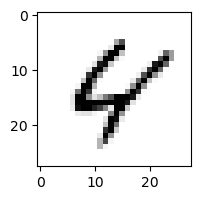

2.0009408173473764% - 0
0.028774898801853997% - 1
2.059411010142711% - 2
0.00034043955030610553% - 3
71.45785643067386% - 4
0.3129477938591197% - 5
4.531306660520365% - 6
0.6076718130557172% - 7
27.02776637897955% - 8
73.69247227101697% - 9 - ОШИБКА

 6


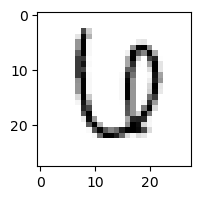

28.20201534842632% - 0 - ОШИБКА
0.013881177691617291% - 1
2.7623615764029275% - 2
4.378267092743993% - 3
12.955382134594382% - 4
0.3401126370945023% - 5
6.856160733147471% - 6
6.46501619730676% - 7
0.4562841245093115% - 8
0.12304863681385902% - 9

 8


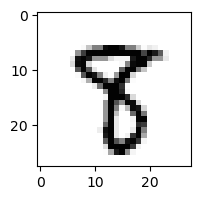

0.0015246246235312158% - 0
0.1589719004115272% - 1
0.007059004931268638% - 2
2.4134519356191095% - 3
0.19600323927103205% - 4
9.176916910591906% - 5 - ОШИБКА
0.0004267642154595625% - 6
1.294864113019722% - 7
7.47170854825801% - 8
0.1527023064613195% - 9

 9


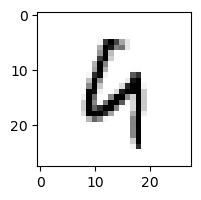

0.15849082463701533% - 0
0.1256206946473092% - 1
16.911285641192055% - 2
0.0350906985807525% - 3
73.15499121237427% - 4 - ОШИБКА
0.20496641364066673% - 5
40.327523766491154% - 6
0.2837884050497493% - 7
39.73843323045298% - 8
19.203631925862503% - 9

 8


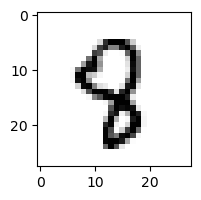

0.017938447040297276% - 0
0.024972967571099906% - 1
0.35995465449797837% - 2
0.11213895017677204% - 3
20.94923994955176% - 4 - ОШИБКА
5.6466229054470345% - 5
0.35234755226637765% - 6
0.2729587768573368% - 7
9.632365958491704% - 8
0.19191911808207004% - 9

 8


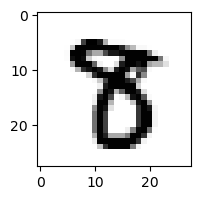

0.002976157697890684% - 0
0.002344649329877568% - 1
0.015468701492674992% - 2
10.508330466143189% - 3 - ОШИБКА
0.0014887873558075402% - 4
0.4879886680649318% - 5
0.00014727452051401606% - 6
0.1763735036296806% - 7
8.17840386476485% - 8
0.007722592641120539% - 9

 7


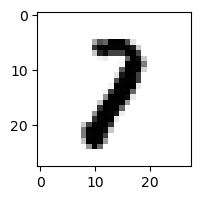

0.015645155889680094% - 0
24.415508753107325% - 1 - ОШИБКА
19.20756451631884% - 2
2.5885304566969713% - 3
0.02721511493246542% - 4
0.02761102527214736% - 5
0.01785332361510335% - 6
0.328811928774836% - 7
4.770434167691387% - 8
0.3771545487301205% - 9

 6


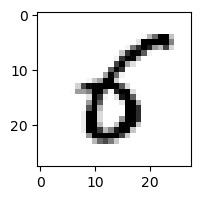

7.7235755020980195% - 0
0.22214991488701455% - 1
0.051806393550431956% - 2
3.3643851196576113% - 3
2.3473083254367104% - 4
49.01366328808713% - 5 - ОШИБКА
35.49623074422732% - 6
0.004101225536750086% - 7
0.502642995418063% - 8
0.05631118928824349% - 9

 8


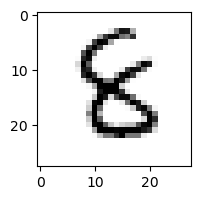

0.026884836788205694% - 0
0.039895674445348576% - 1
0.9349127599873226% - 2
3.489795495512967% - 3
0.7683317888205505% - 4
4.535267839842726% - 5
14.635202588725061% - 6 - ОШИБКА
0.007264597241887726% - 7
4.137604667611481% - 8
0.02231271200499459% - 9

 8


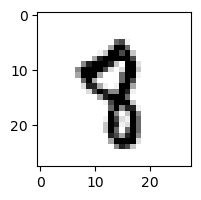

0.0021211968588877093% - 0
0.26684308580050764% - 1
0.0481035513058373% - 2
0.03133131564575656% - 3
2.901020744604268% - 4
3.271618617995072% - 5
0.1226346044419198% - 6
1.3875588860166381% - 7
1.2270338554224882% - 8
7.8910453470407536% - 9 - ОШИБКА

 9


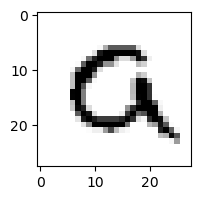

59.84187701760517% - 0 - ОШИБКА
0.0003657313165500159% - 1
11.763668734650407% - 2
0.019171673272510462% - 3
0.012372925718230104% - 4
1.90936434853675% - 5
35.10693156500799% - 6
1.8055807633112746% - 7
0.008993520092929459% - 8
26.118144039175583% - 9

 2


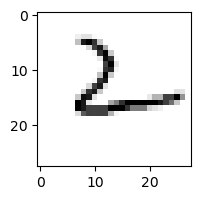

13.135305429424962% - 0
0.3443962179559714% - 1
18.207357026161727% - 2
0.29140056980971807% - 3
91.41884443148338% - 4 - ОШИБКА
1.7039911589981784% - 5
81.60061964838398% - 6
5.5360521768252635% - 7
4.4220041003675545% - 8
20.423839458751242% - 9

 8


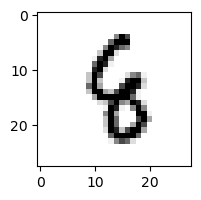

0.003171160789885015% - 0
0.16864889887188045% - 1
2.4103134825882013% - 2
0.17561663256775276% - 3
42.246603355960424% - 4 - ОШИБКА
1.819705087015542% - 5
7.203289023575499% - 6
0.07104386512925483% - 7
2.328443981604272% - 8
0.642618514328608% - 9

 0


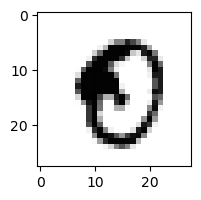

18.35802144869948% - 0
0.0007274322995807843% - 1
0.0005598898766367334% - 2
0.0015123986416823068% - 3
0.1120625175376305% - 4
18.02986033410962% - 5
0.2550533036736087% - 6
0.0002574112538828542% - 7
73.83737094158025% - 8 - ОШИБКА
1.2579691503648465% - 9

 7


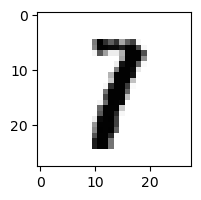

0.009236152595861226% - 0
58.71190076143604% - 1 - ОШИБКА
2.02718768419739% - 2
6.461980089537081% - 3
0.02773543377014478% - 4
0.15888446929482636% - 5
0.04716738046237198% - 6
0.2827963757045857% - 7
2.800749011218144% - 8
0.09075003284228005% - 9

 5


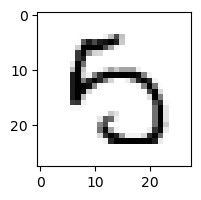

8.553430872044775% - 0
0.09978256143467892% - 1
0.06703157260896163% - 2
1.818342604657339% - 3
10.507665137718773% - 4 - ОШИБКА
1.7860308246453884% - 5
1.719944404569271% - 6
1.9904937762583934% - 7
0.3603221069496577% - 8
0.33403070032852034% - 9

 8


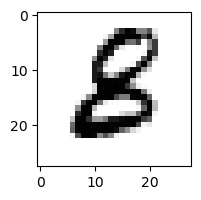

0.06185061683641208% - 0
0.0027154187072422143% - 1
0.8429308170706976% - 2
2.2972457855850803% - 3
0.012931510049762288% - 4
1.3745339236270318% - 5
6.9842713429472685% - 6 - ОШИБКА
0.00024195826864727103% - 7
0.01643692461319117% - 8
6.917965784449479e-05% - 9

 4


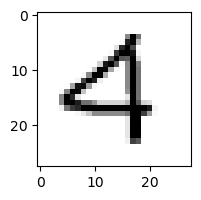

1.454513527020591% - 0
0.012834173608569727% - 1
1.26652504089989% - 2
0.01050840523348617% - 3
25.702587009119288% - 4
0.010975681440658466% - 5
1.3446279769027107% - 6
1.059317480384404% - 7
0.025123028499193383% - 8
48.97111786461769% - 9 - ОШИБКА

 5


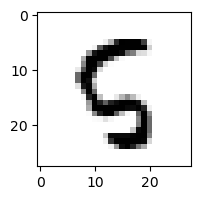

0.16853950479221422% - 0
0.005124428035977257% - 1
4.611712257411358% - 2
0.0006402030341169744% - 3
5.010498901777828% - 4
8.507644083802232% - 5
0.3014963952404981% - 6
0.04368498377616826% - 7
36.49049167337666% - 8 - ОШИБКА
2.1868171253675213% - 9

 2


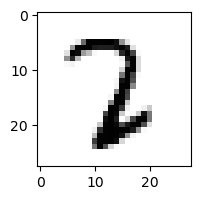

0.0051187187125051456% - 0
0.8155856039890238% - 1
15.710045212720274% - 2
30.40372952982033% - 3 - ОШИБКА
0.15974658868205524% - 4
0.055094758566237544% - 5
0.24141196286166378% - 6
1.0592707290749208% - 7
0.1678253060979984% - 8
0.003817633077888153% - 9

 5


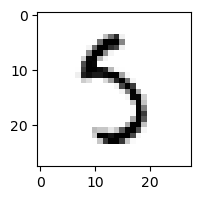

0.733920527421956% - 0
0.11634739913446515% - 1
0.18937394470758684% - 2
13.159993614121932% - 3
1.2550125775026508% - 4
54.96247466020681% - 5
1.2375985228120086% - 6
4.530909201881596% - 7
60.71208234637553% - 8 - ОШИБКА
0.12305083613482794% - 9

 2


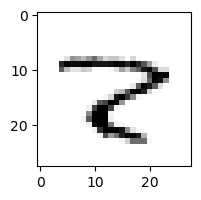

1.2840615714633392% - 0
1.282297000584516% - 1
4.348488240589565% - 2
0.0049072484474920785% - 3
0.48868063453287186% - 4
0.011253988722155222% - 5
12.471503718318889% - 6
52.11067113755598% - 7
76.20866979568463% - 8 - ОШИБКА
0.295350237254133% - 9

 8


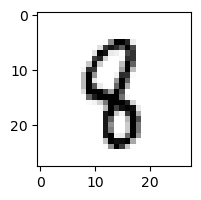

0.011287237563347374% - 0
1.1760142535664198% - 1
0.7319383948495561% - 2
0.40028453187107943% - 3
13.292065751514947% - 4 - ОШИБКА
6.414869200998878% - 5
0.41505058390365535% - 6
0.05730145440881318% - 7
2.966192007836622% - 8
0.45804261137969965% - 9

 2


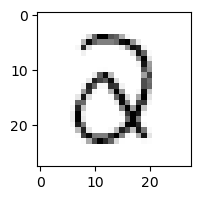

10.386292474641994% - 0
0.03209465622367398% - 1
4.524433994852526% - 2
39.026625059237695% - 3 - ОШИБКА
11.414863505888446% - 4
3.8832897485185605% - 5
0.28268551662628677% - 6
0.04712273344409368% - 7
1.5684620836406638% - 8
0.03240561896197146% - 9

 6


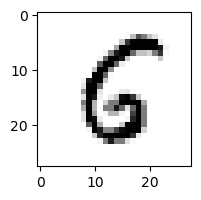

7.394902372930824% - 0
0.005402943786704194% - 1
0.36174776535376874% - 2
0.009023719282693429% - 3
4.977918113857906% - 4
40.33790700056959% - 5 - ОШИБКА
11.667351420162834% - 6
0.011776615981988904% - 7
0.5269738837820145% - 8
0.06475817186928627% - 9

 2


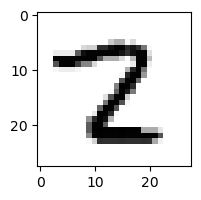

0.026030081076334408% - 0
0.415373739234329% - 1
11.502226857898528% - 2
0.6689678738699291% - 3
0.03715811706645947% - 4
0.1922957185872966% - 5
0.0032861462069219112% - 6
1.7149129113262793% - 7
55.32440888455632% - 8 - ОШИБКА
0.019019156458902196% - 9

 8


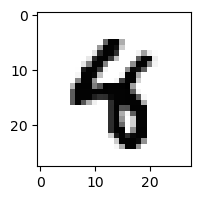

0.0007839891104026789% - 0
0.009857797396904264% - 1
0.004610632516501262% - 2
0.00945062473577866% - 3
84.69039466861035% - 4 - ОШИБКА
0.36694585274410924% - 5
0.031288299305824704% - 6
0.00849215391841713% - 7
0.00795285603306644% - 8
0.5462593380058871% - 9

 9


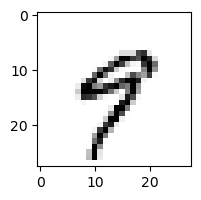

1.0380550804246613% - 0
0.5028331698986318% - 1
0.030502512288314333% - 2
1.3206864120058963% - 3
67.69156178192446% - 4 - ОШИБКА
7.054674635987071% - 5
0.408496382279814% - 6
4.415038458826148% - 7
0.27537333514709605% - 8
54.97499928875178% - 9

 7


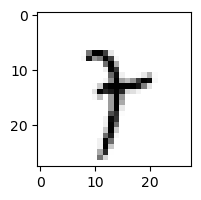

0.03631939630915051% - 0
35.96964985403848% - 1
0.5797885076968823% - 2
6.052761564008624% - 3
3.7568768064912605% - 4
8.20996172700198% - 5
14.244409972380852% - 6
4.7397986683202165% - 7
49.24166525841234% - 8 - ОШИБКА
23.748541227341644% - 9

 5


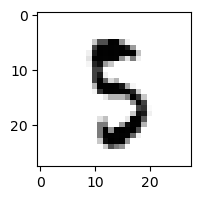

0.4875012794321627% - 0
0.01090802604029272% - 1
0.3489055680375956% - 2
50.79635111695369% - 3 - ОШИБКА
0.07934871506397811% - 4
27.619906339681183% - 5
1.2685675396710079% - 6
0.027650980805749997% - 7
32.33436039340929% - 8
1.8899915656159436% - 9

 8


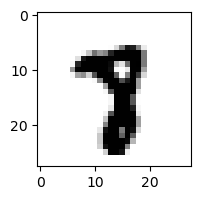

0.0003975454980461899% - 0
0.01421641270361009% - 1
0.0005545672214622078% - 2
0.03370761354556401% - 3
0.011463335010903547% - 4
1.797338214225907% - 5
0.0038035699902214644% - 6
17.038750283098512% - 7 - ОШИБКА
0.9061565466194488% - 8
0.2937010094507034% - 9

 5


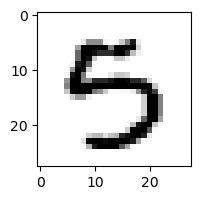

0.40826389436968874% - 0
0.0019076501621005972% - 1
0.0006470190778139044% - 2
24.488719243186488% - 3 - ОШИБКА
0.707285143735288% - 4
15.16946720587512% - 5
0.11340189213642413% - 6
0.016228670649761832% - 7
0.3354942815770613% - 8
5.348882406486151% - 9

 4


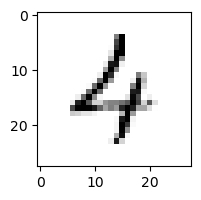

8.683297039774349% - 0
0.08357539356275857% - 1
9.14705435697095% - 2
1.359295245013912% - 3
42.993387569339866% - 4
0.506767172736726% - 5
38.59909094223131% - 6
0.7118698108270483% - 7
1.0708511782045553% - 8
44.26851506571362% - 9 - ОШИБКА

 3


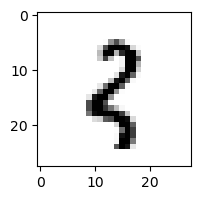

0.2528590313720965% - 0
20.123124456513054% - 1
31.451101482366635% - 2 - ОШИБКА
2.8216001976386895% - 3
0.38463270637827424% - 4
0.16450040973307398% - 5
1.197467312205285% - 6
0.06093967962366114% - 7
19.025450187077155% - 8
30.541046889935764% - 9

 2


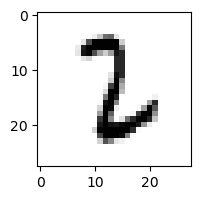

0.01668439391297829% - 0
9.111765820839608% - 1
20.749500495302186% - 2
35.800850593868056% - 3 - ОШИБКА
0.0008776858311897437% - 4
0.5554330743335609% - 5
14.174348077655571% - 6
0.014686036908251307% - 7
0.2506796866982421% - 8
0.007408624984058471% - 9

 9


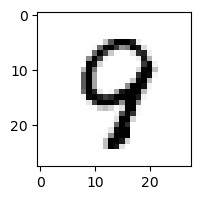

0.2624949841506182% - 0
0.0036252999550683267% - 1
0.6017438997709051% - 2
0.2429672097443211% - 3
50.133680931963355% - 4 - ОШИБКА
0.8262656304014679% - 5
0.3238737260320745% - 6
0.5795542720089419% - 7
23.19036290257165% - 8
3.2609759971443233% - 9

 9


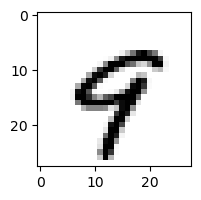

0.3398027899325474% - 0
0.011901768040114821% - 1
0.008702092803650672% - 2
0.005044211537455369% - 3
63.63057059693512% - 4 - ОШИБКА
1.373459768877894% - 5
0.1525065782632839% - 6
7.232259796448058% - 7
0.08207938875351257% - 8
8.499083766171346% - 9

 9


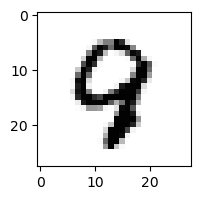

0.09980190353449878% - 0
0.0017597030443234787% - 1
0.3649930388421129% - 2
0.07888775862185993% - 3
15.912269115924133% - 4 - ОШИБКА
0.06351786627972052% - 5
0.3642041979697866% - 6
0.15085865845792726% - 7
1.9430938398951787% - 8
6.267144696860372% - 9

 3


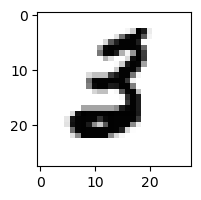

0.18671520019022345% - 0
0.016990030101364066% - 1
3.0922236464310813% - 2 - ОШИБКА
0.8890836876926261% - 3
0.006236220334427215% - 4
0.23854002692117915% - 5
0.5564052612514361% - 6
0.0039303537705750215% - 7
0.023840658484671318% - 8
0.0003550576994398117% - 9

 3


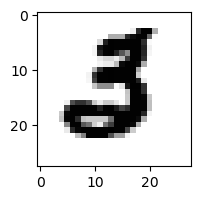

0.15293774272403457% - 0
0.0007873126798256252% - 1
2.1568171379930066% - 2 - ОШИБКА
0.05332768418825303% - 3
0.0009810903750117072% - 4
0.0058868701040745205% - 5
0.05926232898124143% - 6
0.007303899483246192% - 7
0.00013491506262752853% - 8
0.00013506634594047322% - 9

 8


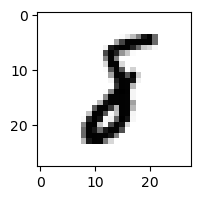

0.009108538434879602% - 0
30.890162100061286% - 1 - ОШИБКА
2.8069312317278885% - 2
0.18679828768881193% - 3
0.02637037445341227% - 4
0.11857577837990806% - 5
5.903205179187451% - 6
0.046582488502528864% - 7
4.540790721130215% - 8
0.045735651921216536% - 9

 3


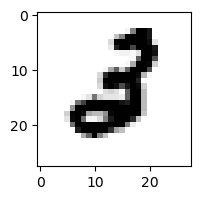

0.01742277566258357% - 0
0.0398925608653909% - 1
3.2747950787053615% - 2 - ОШИБКА
0.04542844318269604% - 3
0.3191031916597003% - 4
0.013374267377684615% - 5
0.35124155969170845% - 6
0.00832498434341066% - 7
0.015329519006502612% - 8
0.00015831481239086706% - 9

 4


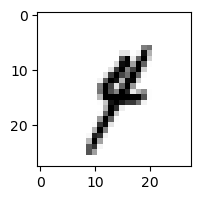

0.009316112394235018% - 0
59.1633871857215% - 1 - ОШИБКА
0.19992738871779298% - 2
41.47479250391669% - 3
20.25727024226972% - 4
0.6723957391091179% - 5
0.2852536570586633% - 6
14.236443018053452% - 7
2.0666360331444005% - 8
1.555247681541032% - 9

 3


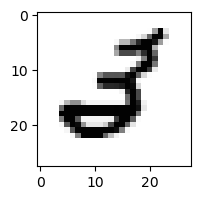

0.3810330928097093% - 0
0.037214235443696494% - 1
3.6014931415512828% - 2 - ОШИБКА
0.332632408299117% - 3
1.5583137015400599% - 4
0.053164435827995786% - 5
0.11830696658684776% - 6
0.03166051335156265% - 7
0.3263427889805963% - 8
0.012669020991079196% - 9

 5


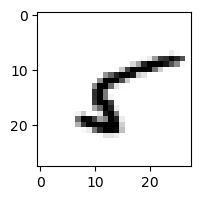

2.3529678765435236% - 0
3.2805207900894584% - 1
4.356238664476749% - 2
3.237571078673608% - 3
3.6725351278389065% - 4
53.04295496553584% - 5
24.867763353343406% - 6
0.4269020165895854% - 7
87.07892302929761% - 8 - ОШИБКА
0.24322823520848383% - 9

 9


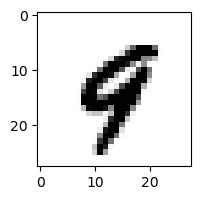

0.03242218319939309% - 0
0.020272722120520913% - 1
0.003498028420391263% - 2
0.003972571472482035% - 3
41.45274580633983% - 4 - ОШИБКА
0.08310037010524123% - 5
0.16465713626412007% - 6
0.8393047017936988% - 7
0.04480692353786775% - 8
8.283353790749864% - 9

 8


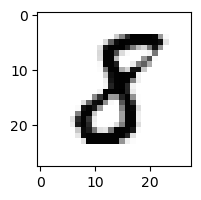

0.1352207307016187% - 0
0.507192590939116% - 1
0.7630767580148675% - 2
5.537134139167505% - 3 - ОШИБКА
0.015939685101157917% - 4
0.8829993204449376% - 5
0.03650971872357% - 6
0.0017998133962623796% - 7
2.602994443244077% - 8
0.0014031509069702458% - 9

 8


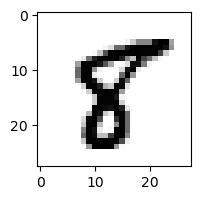

0.08916159782028772% - 0
0.1412943776026714% - 1
0.00633623572805397% - 2
0.001040839475869861% - 3
0.08942518412244452% - 4
50.51042915289108% - 5 - ОШИБКА
0.005052409182833589% - 6
0.018922482672350395% - 7
19.852125246197897% - 8
0.10957850462946155% - 9

 5


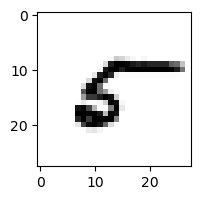

32.888575771512414% - 0 - ОШИБКА
0.7983912304650654% - 1
4.642817415269489% - 2
0.02170598062202679% - 3
4.870160219376986% - 4
6.924968155438403% - 5
6.66101877607496% - 6
1.874141848544654% - 7
24.45014035862313% - 8
0.40694579531092223% - 9

 9


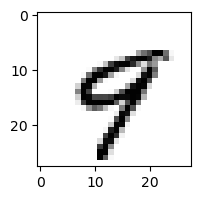

0.6434167310544986% - 0
0.009126318894070827% - 1
0.004163658802026836% - 2
0.020446988699898538% - 3
60.77007010847826% - 4 - ОШИБКА
0.8991331623799323% - 5
0.13846823408953235% - 6
12.532305884917086% - 7
0.2737681715456191% - 8
8.843687662668712% - 9

 8


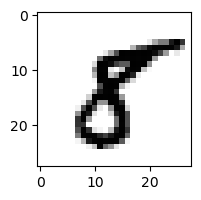

0.2753835412636084% - 0
0.348950617925961% - 1
0.011369929439479242% - 2
0.191287578061518% - 3
0.14119005758032066% - 4
31.23087903053331% - 5 - ОШИБКА
0.00024223661512700223% - 6
0.03314777729756774% - 7
3.514675021930465% - 8
0.030220106874088645% - 9

 3


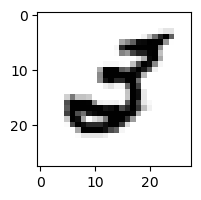

1.0840249232943497% - 0
0.05498820011362156% - 1
2.973961311139358% - 2 - ОШИБКА
0.007999139752927478% - 3
1.1981699460303794% - 4
0.058894202409769364% - 5
0.143973746725549% - 6
0.33825737741607825% - 7
0.013426994958397795% - 8
0.0015225820839939593% - 9

 3


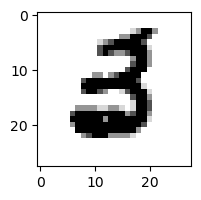

0.48543382261222673% - 0
0.0006013303189954806% - 1
0.3001073273109172% - 2
0.7208018140376435% - 3
0.008124188884466315% - 4
0.16998182451375576% - 5
2.0984348793915935% - 6 - ОШИБКА
0.00027871061740617354% - 7
0.0009114964967128003% - 8
0.00012997525224646243% - 9

 7


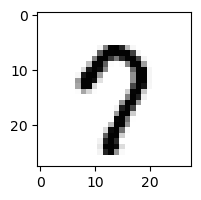

7.726259913480443% - 0
0.0010193918981148706% - 1
0.0542914803508915% - 2
0.1957009104644333% - 3
0.7168133382027888% - 4
3.323324723464737% - 5
0.06893183817122192% - 6
60.83426016298361% - 7
1.7454548171147597% - 8
92.02368817036064% - 9 - ОШИБКА

 4


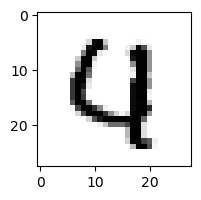

9.496641453245562% - 0 - ОШИБКА
0.0006775414943235241% - 1
1.450757734848163% - 2
0.005026154643244136% - 3
6.041721971214389% - 4
0.012678964852398975% - 5
1.6708142772328787% - 6
2.8323267505331144% - 7
0.024208540486305944% - 8
0.8897696256618136% - 9

 9


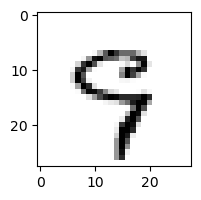

1.3222914219572% - 0
0.06671949869762227% - 1
0.1858203889891397% - 2
22.567860063546917% - 3
10.4632543346195% - 4
7.462642773150076% - 5
0.6751438318642661% - 6
28.35464241794789% - 7 - ОШИБКА
0.12535336590661605% - 8
12.412396441839935% - 9

 2


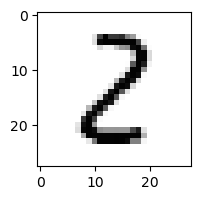

2.5580018254390824% - 0
8.39510805394414% - 1
30.323475617011052% - 2
6.720717009411834% - 3
0.22979196917932587% - 4
0.31794968796554446% - 5
0.01033230011626613% - 6
0.0178347730884744% - 7
94.51635800031424% - 8 - ОШИБКА
0.007135865060294195% - 9

 7


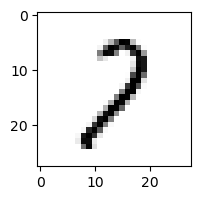

3.0631007205418483% - 0
8.61792589478893% - 1
68.98907926786492% - 2 - ОШИБКА
7.547646710869044% - 3
2.131296198382486% - 4
0.5136789598545055% - 5
0.5555230161515432% - 6
17.880178229201373% - 7
39.7311949517223% - 8
5.855444583612549% - 9

 9


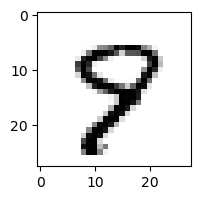

0.10355591244218768% - 0
0.010760547020518063% - 1
0.06063336772959368% - 2
0.20233196326411088% - 3
4.080240947930043% - 4
21.281665072631196% - 5
0.10186020476440065% - 6
8.311514308692852% - 7
27.488141620146827% - 8 - ОШИБКА
13.844614927633629% - 9

 8


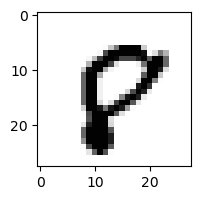

48.27301515333839% - 0 - ОШИБКА
0.0001628375783803032% - 1
0.06574265723232854% - 2
4.7963890108643105e-05% - 3
0.08002285438016575% - 4
1.5569797876382752% - 5
0.024702162162430253% - 6
1.8464419727955137% - 7
32.14058690561299% - 8
27.257435255136453% - 9

 8


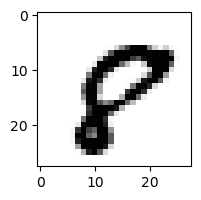

33.57665488497455% - 0 - ОШИБКА
0.00032775069707760324% - 1
0.011124418692382641% - 2
0.00017256846951680134% - 3
0.036613009660284856% - 4
5.125709464302817% - 5
0.011773160118911226% - 6
0.6968220395669272% - 7
28.95313515373931% - 8
2.2019924488964597% - 9

 9


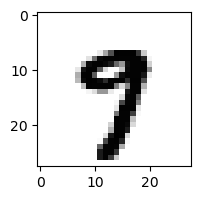

0.04288591433756588% - 0
0.0021206556596415575% - 1
0.0002700019648946096% - 2
0.48781036829922236% - 3
0.5050593547496125% - 4
0.765144007291306% - 5
0.003318764265972171% - 6
42.26223752853719% - 7 - ОШИБКА
0.11512116085267701% - 8
37.88840807367224% - 9

 9


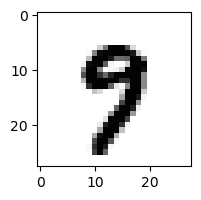

0.07242710647612512% - 0
0.0012934278052045673% - 1
0.0011973624395312174% - 2
1.139531424476448% - 3
0.3679335325683584% - 4
2.335009536004065% - 5
0.010135291591079402% - 6
23.586551136995666% - 7 - ОШИБКА
0.4388349948728358% - 8
20.384660832925473% - 9

 1


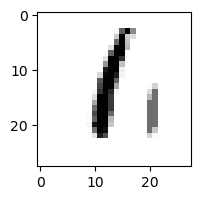

1.8773385162794185% - 0
9.45793407430853% - 1
11.30739417045691% - 2
2.9079884139191248% - 3
0.01528521136207422% - 4
12.911395898435082% - 5
86.64542679485528% - 6 - ОШИБКА
0.03664677114875417% - 7
65.02008385039846% - 8
12.237323867594283% - 9

 8


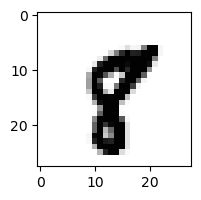

0.009423628913009182% - 0
0.37312725106928074% - 1
0.0006585200889586207% - 2
0.008773518993913538% - 3
0.11352235162565862% - 4
0.6001555634334544% - 5
0.0034815931889247975% - 6
6.343659511417968% - 7 - ОШИБКА
0.3849769929659882% - 8
0.330817334914174% - 9

 8


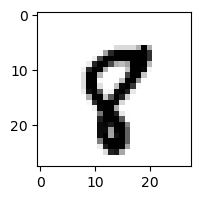

0.04180829151506845% - 0
0.11221526939563752% - 1
0.008466451365526817% - 2
0.0026631529988369236% - 3
0.29494661126458127% - 4
0.6471197651107952% - 5
0.03863070394669868% - 6
2.280391254744577% - 7
1.5480047709342128% - 8
6.666462790678067% - 9 - ОШИБКА

 1


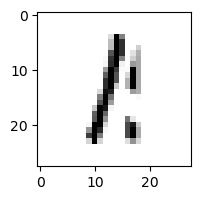

2.059030026975298% - 0
15.628228020888013% - 1
13.826879395003813% - 2
28.8210770124859% - 3
0.03102701140005085% - 4
3.5228824048851326% - 5
7.663069852327125% - 6
0.2330098493272882% - 7
79.99231689579427% - 8 - ОШИБКА
7.9537446142857915% - 9

 8


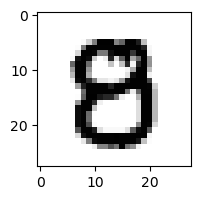

3.0147702878120257% - 0 - ОШИБКА
1.8396059625217054e-05% - 1
0.0941080159751114% - 2
0.8944755917158184% - 3
0.022756172395685767% - 4
0.39914377092524395% - 5
0.00012250911516164614% - 6
0.00020168241705414871% - 7
0.36126157293027106% - 8
0.07492883756106415% - 9

 9


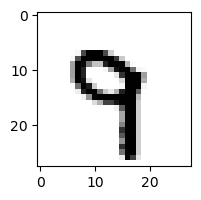

0.0010197608425571273% - 0
0.09775430301078025% - 1
0.07710626686501569% - 2
0.4741662673368117% - 3
19.637747998539478% - 4
0.6581321395067142% - 5
0.6355679962277363% - 6
24.98542859054659% - 7 - ОШИБКА
0.06050758032526232% - 8
7.5880384705898685% - 9

 2


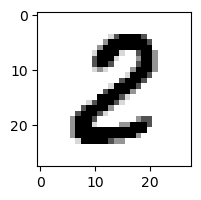

0.6773493828005049% - 0
0.018246472746653683% - 1
36.21291379654476% - 2
0.23625276224456368% - 3
0.0009394133229691778% - 4
0.05031757125181496% - 5
0.0022603917409867147% - 6
0.000520533722218567% - 7
88.73068417378427% - 8 - ОШИБКА
0.0020259684240918545% - 9

 8


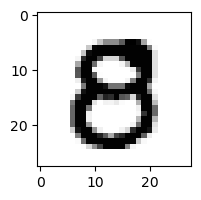

9.392671496555153% - 0 - ОШИБКА
3.368612478784294e-06% - 1
0.05213423603947643% - 2
0.412587456615272% - 3
0.05116879113294487% - 4
1.1630201131305777% - 5
1.9454784499035832e-05% - 6
0.0004712837065665996% - 7
0.14609563037974682% - 8
0.040887052237413964% - 9

 8


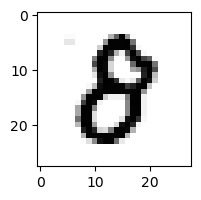

24.903725023013283% - 0 - ОШИБКА
8.266473465395348e-05% - 1
0.32203035465050844% - 2
2.1696208034617213% - 3
0.05772651504025146% - 4
0.6258938678247892% - 5
0.028887507279448433% - 6
0.0012283526805891723% - 7
19.082582827260353% - 8
0.24548821505011725% - 9

 4


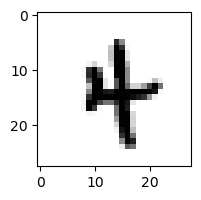

0.0043479695244263115% - 0
1.3453760599230167% - 1
0.052315805611313854% - 2
0.16998660362719353% - 3
46.208199432553116% - 4
0.26004200963727986% - 5
4.764910171920988% - 6
0.04622970933121406% - 7
0.09347217245451536% - 8
47.2004395451751% - 9 - ОШИБКА

 7


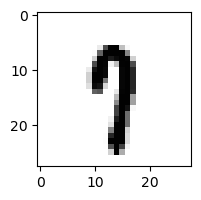

0.024344340356955294% - 0
0.1661125699446757% - 1
0.04747053422579861% - 2
1.2568459845039937% - 3
7.583870720889547% - 4
3.259600644983477% - 5
0.23246503203127933% - 6
34.163413736453336% - 7
0.820731660781516% - 8
36.871109620115746% - 9 - ОШИБКА

 8


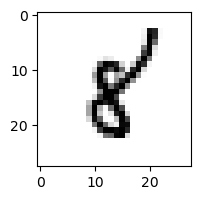

0.05185272111008607% - 0
22.989937513354146% - 1
0.08988229043810339% - 2
0.1179755462948519% - 3
7.9803505736280815% - 4
4.242061237499859% - 5
24.24144389278447% - 6 - ОШИБКА
0.2449456325109631% - 7
19.863335591209232% - 8
0.38753529993279817% - 9

 4


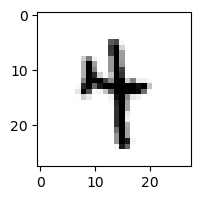

0.007219882526492864% - 0
12.103380395286077% - 1
0.004670705066222042% - 2
0.7980005824969993% - 3
20.973533274740184% - 4
7.4556521964690425% - 5
3.2550443815413685% - 6
0.41373253202322297% - 7
1.634581130475585% - 8
38.3150409234431% - 9 - ОШИБКА

 7


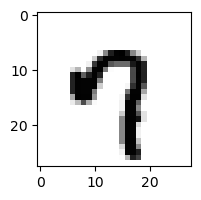

7.949145424540291% - 0
0.001257444772220953% - 1
0.003122821562839957% - 2
0.036460064956168076% - 3
10.274778027674616% - 4
0.8632627475242728% - 5
0.13291158677135934% - 6
9.438104127306735% - 7
0.00434170728970477% - 8
96.95224683452899% - 9 - ОШИБКА

 8


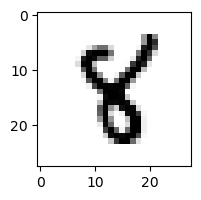

0.0005762162101530077% - 0
0.8179652053612676% - 1
0.015457740006352206% - 2
0.18631330176227381% - 3
32.90352884961332% - 4 - ОШИБКА
12.092764958707233% - 5
0.13237934277103455% - 6
0.1836502701152258% - 7
14.932023403967372% - 8
0.015853112441108142% - 9

 2


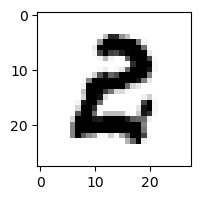

10.928132118856576% - 0 - ОШИБКА
0.0011012735020584981% - 1
5.604264734839107% - 2
8.151038347693431% - 3
0.0011165629775395883% - 4
0.19249659147403134% - 5
0.12549698249998315% - 6
2.6676912216668993e-05% - 7
0.026793469875612236% - 8
0.0017231483836461301% - 9

 1


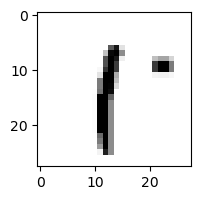

3.442142155517546% - 0
3.238632510386351% - 1
1.156626304586211% - 2
4.051378206631417% - 3
0.15739548472142875% - 4
65.70626924011249% - 5
27.895157984504415% - 6
0.7419456274767318% - 7
99.68741593108639% - 8 - ОШИБКА
25.44733115928607% - 9

 8


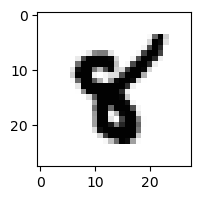

0.00027901287308635504% - 0
0.08586377372509865% - 1
0.0002380719588887161% - 2
0.0003506097463417464% - 3
11.099571071923444% - 4
12.537637722965563% - 5 - ОШИБКА
0.25396782590291045% - 6
0.05277223673273877% - 7
1.2678814142518666% - 8
0.00585371494246086% - 9

 8


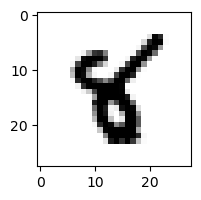

0.0008096025041787445% - 0
0.34478931069390595% - 1
0.00047326698908234306% - 2
0.010721763726362011% - 3
16.30917969337602% - 4
19.870428240176235% - 5 - ОШИБКА
0.48500398742234285% - 6
0.024005262836987236% - 7
0.6849224945627858% - 8
0.0020171277168499666% - 9

 8


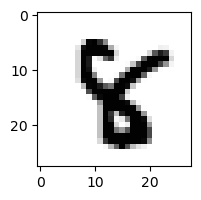

3.669517804166837e-05% - 0
0.00296931270155195% - 1
0.011701051474996893% - 2
0.035041506914878146% - 3
25.455980617550683% - 4 - ОШИБКА
4.483298852594498% - 5
0.0023932476492877926% - 6
0.012921535402855882% - 7
12.715770497067568% - 8
0.0018238932763986358% - 9

 7


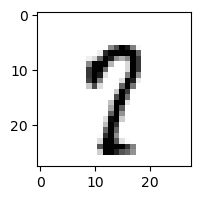

0.13342764021136994% - 0
0.16286041535422843% - 1
0.08811403432515932% - 2
0.13088590642990172% - 3
0.7174043684820562% - 4
3.921701922292194% - 5
0.11650615222129428% - 6
63.47518040777932% - 7
16.79372412159526% - 8
73.0983073687844% - 9 - ОШИБКА

 5


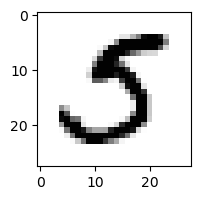

1.2255808539057296% - 0
0.015081382525402304% - 1
0.07510248827470863% - 2
46.86000910567664% - 3 - ОШИБКА
0.001508003220075458% - 4
22.2833990983239% - 5
0.017896895057525262% - 6
0.3003075834653868% - 7
0.004422678618625892% - 8
0.003918216978321486% - 9

 4


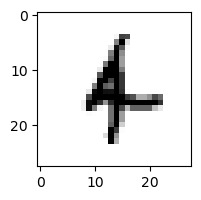

0.01187893777166382% - 0
5.21472247219064% - 1
0.06776234533816113% - 2
1.7550297646467279% - 3
14.340362120531994% - 4
2.8496045727907564% - 5
23.117506244291675% - 6 - ОШИБКА
0.05081814827551203% - 7
0.213566923013005% - 8
3.82309373606095% - 9

 8


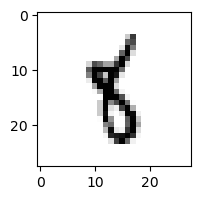

0.04263272633740631% - 0
4.3972496928579154% - 1
0.10900527590280051% - 2
0.48115917181057966% - 3
1.845994145913267% - 4
48.162555535181% - 5 - ОШИБКА
18.677700310084695% - 6
0.16258152707203669% - 7
46.31046997428813% - 8
1.4354779339294093% - 9

 7


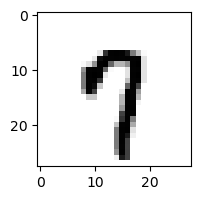

1.357130470845474% - 0
0.008000986047066673% - 1
0.04850475802351781% - 2
0.45200444842844534% - 3
8.04125784211874% - 4
4.634133781866293% - 5
0.20237821851198404% - 6
50.1950766399673% - 7
0.27584183679863133% - 8
83.33147838383307% - 9 - ОШИБКА

 7


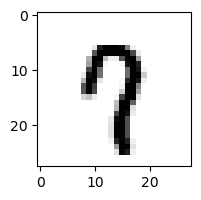

0.3171365805958333% - 0
0.012751698846069387% - 1
0.3277209892316124% - 2
0.7939026830388511% - 3
10.500908949419541% - 4
1.2065272842202714% - 5
0.09568304528204488% - 6
34.18406595972085% - 7
0.37676190053601805% - 8
64.20264154527342% - 9 - ОШИБКА

 3


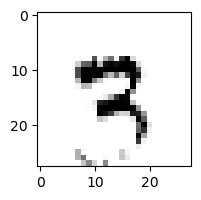

0.004340647404878967% - 0
1.4365330593328838% - 1
0.20260345790044754% - 2
0.003428054463924947% - 3
9.842161644249622% - 4
1.1053725260792462% - 5
1.1583505922452064% - 6
58.23387897848292% - 7 - ОШИБКА
4.864642732121435% - 8
10.048252119537414% - 9

 5


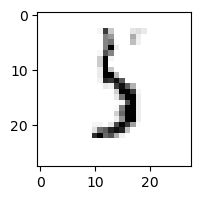

0.4420834580257005% - 0
2.3821116273515788% - 1
2.012112229217708% - 2
47.077520383267895% - 3
11.08787246187057% - 4
23.74371956756378% - 5
55.50552275604155% - 6 - ОШИБКА
4.115405064348741% - 7
15.409136801064577% - 8
3.3895943456084607% - 9

 8


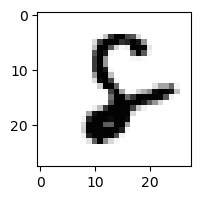

0.13106791865615847% - 0
0.08158881820281019% - 1
0.9689232169228639% - 2
0.002746647020676943% - 3
0.280601329478213% - 4
2.345485394603263% - 5
37.94436551739277% - 6 - ОШИБКА
0.06922832716234166% - 7
1.324207734167886% - 8
6.171760697501926e-05% - 9

 5


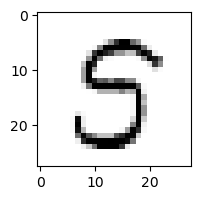

2.567760377260897% - 0
0.017206496299710033% - 1
0.033540790099150126% - 2
61.85133674696872% - 3
0.9531657716875694% - 4
75.75593371399368% - 5
0.005811291143532255% - 6
0.10833508472490386% - 7
91.29154542798904% - 8 - ОШИБКА
0.17552104010059422% - 9

 5


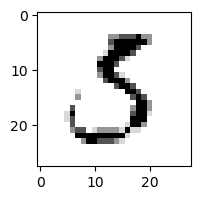

5.945155052153715% - 0
0.10344352862796055% - 1
0.6385471489483099% - 2
71.76432799540667% - 3 - ОШИБКА
0.004319059289812702% - 4
8.730257134646957% - 5
0.3625223709270359% - 6
0.13440424787442118% - 7
0.4664979253259399% - 8
0.15688270193621648% - 9

 5


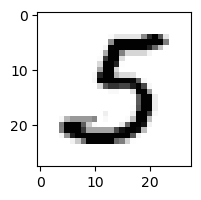

2.455270509030697% - 0
0.09862665864208377% - 1
0.10038300103141053% - 2
76.92564970328712% - 3 - ОШИБКА
0.003707121079313316% - 4
43.73477348710227% - 5
0.10152214944230109% - 6
0.010195328094483178% - 7
0.24055577570058656% - 8
0.003101397141515628% - 9

 5


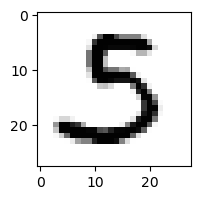

1.1727451644877611% - 0
0.005764669585292287% - 1
0.4812447346207019% - 2
84.24409865100188% - 3 - ОШИБКА
0.0016283270234815623% - 4
40.65126185755007% - 5
0.012416465523388511% - 6
0.03177724359223585% - 7
0.20395210725097523% - 8
3.992388745909749e-05% - 9

 5


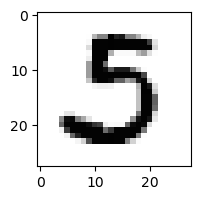

4.0255679621743194% - 0
0.0018256841099436182% - 1
0.38276983535430076% - 2
51.310151387750594% - 3 - ОШИБКА
0.00022229325941254497% - 4
28.79639213387814% - 5
0.0051746775436292336% - 6
0.033307448220278556% - 7
0.12866546220927935% - 8
7.4607015323947195e-06% - 9

 5


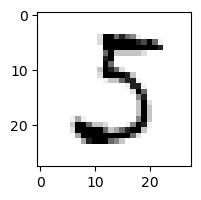

14.098340547947188% - 0
0.4561248168452015% - 1
4.710163853251608% - 2
70.70064793047734% - 3 - ОШИБКА
0.005069426834622181% - 4
50.45825832265359% - 5
0.04833728015802469% - 6
0.10400220692090019% - 7
0.7649032622289654% - 8
0.0016469537134754615% - 9

 7


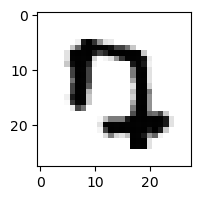

2.600154228281108% - 0
1.8721810349887584e-05% - 1
7.0688958313561425% - 2 - ОШИБКА
1.0013416040757082% - 3
0.025686942444055866% - 4
0.1285251314853734% - 5
0.05447768853488967% - 6
0.3206350682822885% - 7
6.113973809009997e-05% - 8
0.6272528897090162% - 9

 4


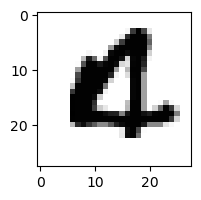

15.94036498799757% - 0 - ОШИБКА
8.312749588485421e-07% - 1
0.6584839867849736% - 2
1.401725776748134e-05% - 3
0.004258423298540272% - 4
0.13854731226423256% - 5
2.2736057315832654% - 6
0.0006346987971692816% - 7
2.5197708921195167e-05% - 8
0.022308698828839343% - 9

 5


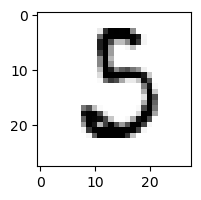

6.417934178064728% - 0
0.09865050851710729% - 1
7.695283973645626% - 2
6.401455019766196% - 3
0.0004767445471990971% - 4
0.34480182973549006% - 5
65.8560783099357% - 6 - ОШИБКА
0.3639567550738282% - 7
0.19799236303953283% - 8
0.0005086481334214087% - 9

 3


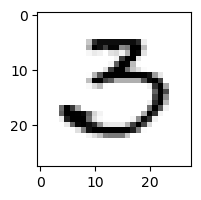

80.97522433700262% - 0 - ОШИБКА
0.04228004173219547% - 1
15.714039413880048% - 2
62.07027432631305% - 3
0.00042356852913451136% - 4
0.11186170734079519% - 5
1.1470053190625888% - 6
0.07412255032038799% - 7
0.11971627972449371% - 8
0.0022804574250461637% - 9

 5


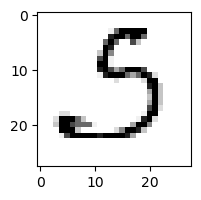

16.931340267892928% - 0
0.3937022272138381% - 1
18.043778398896315% - 2
83.5578870235024% - 3 - ОШИБКА
0.006119960804106386% - 4
0.9924408136005671% - 5
1.6680100715963324% - 6
3.2385230084998295% - 7
0.1559049630611987% - 8
0.029050581201958026% - 9

 5


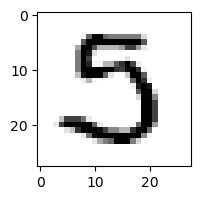

2.9700634861561226% - 0
0.0012993900805489508% - 1
18.40875632244639% - 2 - ОШИБКА
5.728226560533872% - 3
0.0016766053616379456% - 4
12.95449967407152% - 5
0.008722575063827977% - 6
0.9879295920455367% - 7
0.1648005314984892% - 8
6.828656009900796e-05% - 9

 3


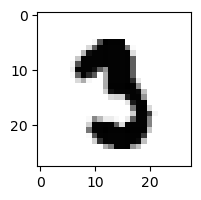

0.0017968313170904832% - 0
0.006047875097284452% - 1
0.0025594518658027883% - 2
3.644101125467768% - 3
4.205117435073876e-05% - 4
4.457064617452432% - 5 - ОШИБКА
0.003103914674076239% - 6
0.4059764345530315% - 7
0.06841724157604866% - 8
0.002114436123250712% - 9

 4


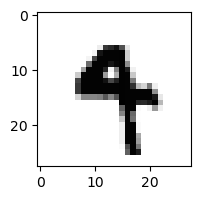

0.0018668367580919473% - 0
0.01983725286982734% - 1
0.00010173522679476624% - 2
0.5784757990396641% - 3
24.975043080612707% - 4
6.831608956160491% - 5
0.6865385772776449% - 6
0.21706290094056724% - 7
0.003280844140437736% - 8
84.89741201087848% - 9 - ОШИБКА

 5


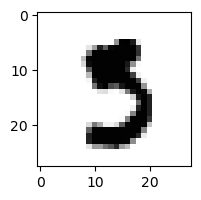

0.11443711702763876% - 0
0.0009639235388711239% - 1
0.00047471101425020936% - 2
37.19176351395735% - 3 - ОШИБКА
0.00023172091983434987% - 4
19.414778817089044% - 5
0.0040315653560962835% - 6
0.4820279370655221% - 7
0.07027322177328997% - 8
0.012090163001265737% - 9

 3


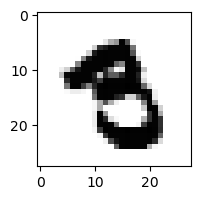

0.0005384556391325277% - 0
0.0008358732368833514% - 1
0.00010538825190138949% - 2
0.01459561717046948% - 3
0.0033000685885707314% - 4
3.1596166764917255% - 5 - ОШИБКА
0.006508902943155001% - 6
0.003741482071180596% - 7
0.07629452499908031% - 8
2.2227780970739115% - 9

 8


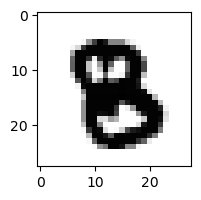

0.00030883534317178193% - 0
1.195190500323058e-05% - 1
0.024245907549302188% - 2
0.002717382033981088% - 3
0.021604767595275375% - 4
0.03279197702829938% - 5 - ОШИБКА
0.0003789457616605273% - 6
0.00019547906949198772% - 7
0.029487026758556415% - 8
0.008591239615258837% - 9

 3


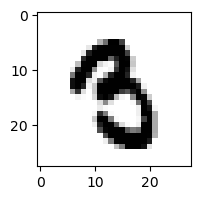

0.0013183887868324722% - 0
0.02329098555085077% - 1
0.001419839403400057% - 2
0.698620453224564% - 3
0.0034684215864228866% - 4
5.188169574624261% - 5 - ОШИБКА
0.10137072482758007% - 6
0.006046366011050089% - 7
0.09064007009664342% - 8
0.4042798992865201% - 9

 4


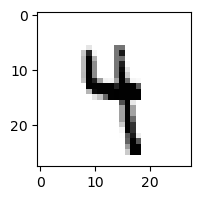

0.003950823515774434% - 0
2.4004947260205376% - 1
0.08266504355076755% - 2
9.063241863492225% - 3
49.531901222575165% - 4
8.856014532341042% - 5
4.426519947042051% - 6
0.28815482201731385% - 7
3.0395417273209393% - 8
64.96156310832346% - 9 - ОШИБКА

 8


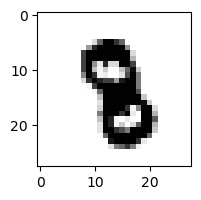

5.1812369638202176e-06% - 0
0.006854927126337416% - 1
0.1262495689557749% - 2
0.044924207033842575% - 3
0.18861355962248594% - 4
0.22200141264340456% - 5 - ОШИБКА
0.011126080333143296% - 6
0.015043308153154659% - 7
0.17481191992415257% - 8
0.07344643913308159% - 9

 5


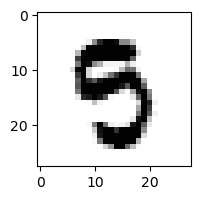

0.06484910095650112% - 0
0.00037426613726578923% - 1
0.0008506935409449058% - 2
26.60626644279329% - 3 - ОШИБКА
0.03749819823361979% - 4
13.947189905262631% - 5
0.0379938084956361% - 6
0.0032611224199944134% - 7
0.0780857538646679% - 8
0.19894220293203385% - 9

 8


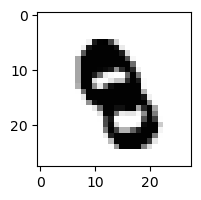

3.687443916175462e-06% - 0
0.001076444119742931% - 1
0.027247490656550195% - 2
0.0005698264675280644% - 3
0.6843041386162546% - 4 - ОШИБКА
0.5466572216003271% - 5
0.00797778536092596% - 6
0.019324707899812315% - 7
0.0025046410239167607% - 8
0.45359950501406854% - 9

 1


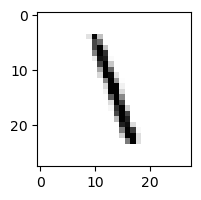

0.12052038339060592% - 0
36.61362643318748% - 1
8.044697823609347% - 2
8.950299347946993% - 3
16.93036297431604% - 4
51.85624426008153% - 5
19.575624608520886% - 6
3.442654940358994% - 7
55.116037161660515% - 8 - ОШИБКА
3.121761866674269% - 9

 4


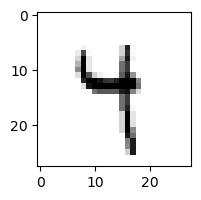

0.03745724218569551% - 0
4.963231102000795% - 1
0.04101561713844201% - 2
29.640708734626507% - 3
73.23372342900298% - 4
13.82959225902837% - 5
7.653164245340803% - 6
1.0313740269340455% - 7
16.043810722697184% - 8
76.2166988693186% - 9 - ОШИБКА

 3


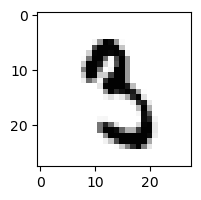

0.013617738022430836% - 0
0.4404537103439168% - 1
0.06058559874052685% - 2
17.673645334605933% - 3
0.017781279576353802% - 4
24.78157601538115% - 5 - ОШИБКА
0.10160251887815258% - 6
0.20287101802131732% - 7
2.322174530509269% - 8
0.7956961396623268% - 9

 8


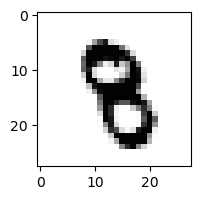

5.7365367092029934e-05% - 0
0.02638565949931327% - 1
0.438908440976833% - 2
0.47093196556743916% - 3
0.5797981327071534% - 4
0.18170789129096948% - 5
0.017265472842588763% - 6
0.04295293866416418% - 7
0.32623602733638574% - 8
4.999533716697669% - 9 - ОШИБКА

 2


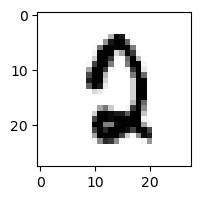

3.702572889260495% - 0 - ОШИБКА
0.00037957467655558004% - 1
1.6751922631210372% - 2
0.0403895064978271% - 3
0.021813488975169913% - 4
3.2128973397299365% - 5
1.7585352944387573% - 6
0.37123960575397863% - 7
0.414345733764844% - 8
0.052021766907819844% - 9

 4


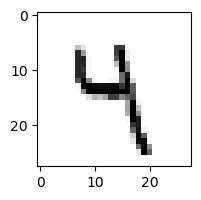

0.04379821741429199% - 0
1.6323744742707598% - 1
0.3993955281625715% - 2
40.43862456921895% - 3
47.24617270624209% - 4
11.802505712761125% - 5
7.142646427790613% - 6
0.16984449329862572% - 7
1.3720591702023968% - 8
86.39320325544585% - 9 - ОШИБКА

 5


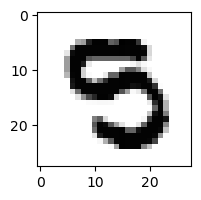

0.04052868404793684% - 0
0.00042588745521396706% - 1
0.019009636982835323% - 2
7.370688970406709% - 3 - ОШИБКА
0.006552823534553483% - 4
0.3198826028582191% - 5
0.002689480249840958% - 6
0.00021698848487135887% - 7
0.010106357330974796% - 8
0.030626890780956213% - 9

 8


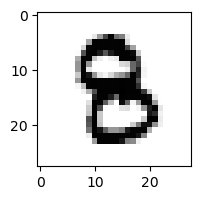

0.009806822358097591% - 0
0.0005076936418784365% - 1
0.0461351935303516% - 2
4.859240075886678% - 3 - ОШИБКА
0.06191812111118229% - 4
0.6191000167903032% - 5
0.016987245647911424% - 6
0.0002264989757883775% - 7
0.8011529691682862% - 8
0.116696448403945% - 9

 3


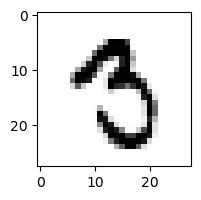

0.15597676731094712% - 0
0.2672254690611137% - 1
0.019864941888759258% - 2
1.1637223714779685% - 3
0.0019792069834767825% - 4
2.066447144451935% - 5
0.06234888346255508% - 6
1.0784382787524294% - 7
0.8025813920406775% - 8
6.09947464571192% - 9 - ОШИБКА

 3


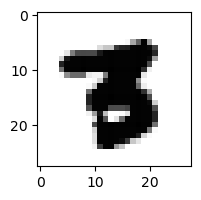

2.0713628277688728e-05% - 0
4.829939292501561e-05% - 1
0.00016150542900718402% - 2
0.023805710512160325% - 3
0.000446840268198157% - 4
0.0652150274857516% - 5 - ОШИБКА
0.00035984668628386745% - 6
0.01736315110333361% - 7
0.0008093262421891997% - 8
8.304871667752979e-05% - 9

 9


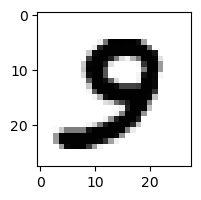

0.15061243158805976% - 0
2.0540625648843358e-05% - 1
0.0016528684131756947% - 2
2.6696005286498674% - 3
0.03379316127117177% - 4
2.787013270759732% - 5 - ОШИБКА
0.0062116885827031496% - 6
0.02605082852995892% - 7
0.5713536509561173% - 8
0.01571814245630062% - 9

 8


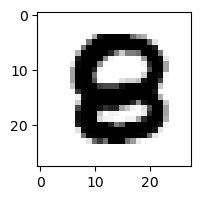

0.03226277016849946% - 0
2.0541833282946411e-07% - 1
0.2153514057989916% - 2 - ОШИБКА
1.8634711165495008e-05% - 3
0.011984276249354366% - 4
0.030707892415353474% - 5
0.012855280380905193% - 6
1.2388292158475133e-06% - 7
0.02578151593019598% - 8
7.301168944350913e-06% - 9

 9


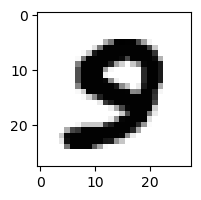

0.13673509222164498% - 0
1.7731511335867898e-06% - 1
3.5673708709950455e-05% - 2
0.093312764813548% - 3
0.00619002930871936% - 4
2.064235824787723% - 5 - ОШИБКА
0.0009538965822703002% - 6
0.004651585089956299% - 7
0.024959295547654796% - 8
0.0023284580934455094% - 9

 5


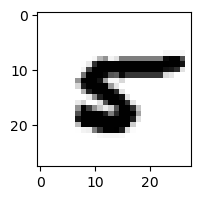

0.18984326224813491% - 0
0.00597457064275057% - 1
0.014619122886000698% - 2
9.108002464852515e-05% - 3
0.3328567301134895% - 4
3.1484732807873095% - 5
1.0703877107799746% - 6
0.12960080160311188% - 7
4.837149788774695% - 8 - ОШИБКА
0.007450569518467105% - 9

 9


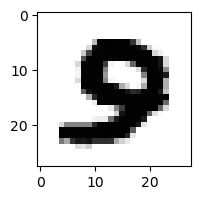

0.2185415238229393% - 0
4.090951424477763e-07% - 1
0.0003854716771584533% - 2
0.055993581285978644% - 3
0.0019772381815874184% - 4
0.22268453319143894% - 5 - ОШИБКА
0.0013110990823178457% - 6
0.0009685834097081467% - 7
0.004102417401815866% - 8
8.29971554850488e-05% - 9

 2


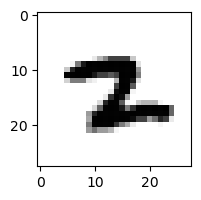

0.00020115420587777334% - 0
2.3388527324977626% - 1
0.15271675246331112% - 2
0.0003643973208103582% - 3
0.00783817275504556% - 4
0.14036063179198183% - 5
12.34678836578058% - 6 - ОШИБКА
8.565362818503178% - 7
0.019904764403815275% - 8
0.04101731089325529% - 9

 9


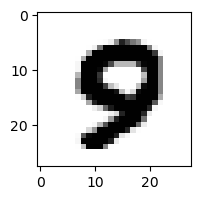

0.3153145869890357% - 0
1.6058395176141872e-06% - 1
0.0001479495569533898% - 2
0.0026299191162503163% - 3
0.13645297013176907% - 4
1.0195187556884642% - 5 - ОШИБКА
0.009387400889575988% - 6
0.02792317897281636% - 7
0.013432404848044477% - 8
0.06141302596329493% - 9

 9


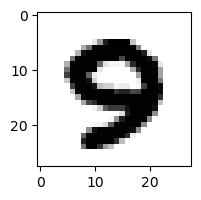

0.11054242320945062% - 0 - ОШИБКА
3.160988077608893e-07% - 1
0.0002338467879592651% - 2
0.011543403104430148% - 3
0.021787294806020617% - 4
0.010349247394302614% - 5
0.002028671561130089% - 6
0.01864508223628755% - 7
0.0010044670710256567% - 8
0.007104711003510126% - 9

 9


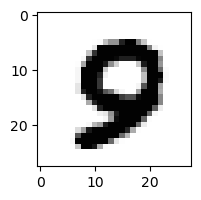

0.5419800236083707% - 0
2.2796389778316296e-06% - 1
0.0011136577276850488% - 2
0.0014634173891352618% - 3
0.056084154044940895% - 4
0.5845551812710484% - 5 - ОШИБКА
0.01814064463811637% - 6
0.024109613844668278% - 7
0.008627992038508926% - 8
0.006385326735970445% - 9

 8


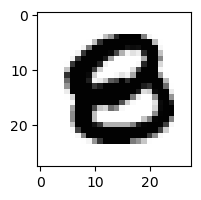

0.2196717227902325% - 0 - ОШИБКА
2.0694910058501413e-06% - 1
0.028816996463378736% - 2
1.617561092565517e-05% - 3
0.007754278656289382% - 4
0.005494624757521317% - 5
0.0012006029896927005% - 6
4.638076512920813e-07% - 7
0.12289858609072776% - 8
7.715100505862976e-05% - 9

 9


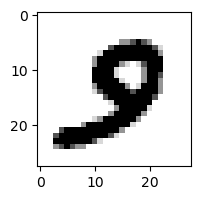

0.1107253225934382% - 0
0.0009562140468399053% - 1
0.0013661443922800194% - 2
0.4542972432870448% - 3
0.002889859774853841% - 4
1.2331418074560139% - 5 - ОШИБКА
0.0062685747515555095% - 6
0.0946908367726097% - 7
0.010339497569500483% - 8
0.006443933291288573% - 9

 9


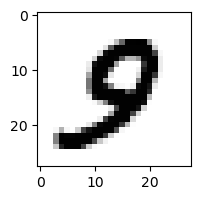

0.18044253185048248% - 0
0.00047940992018649295% - 1
0.025398796696809122% - 2
0.08802076317393162% - 3
0.371835354226908% - 4
6.20099026421209% - 5 - ОШИБКА
0.02027128491773744% - 6
0.13952517454830235% - 7
0.09351435305663905% - 8
0.4172922262973739% - 9

 9


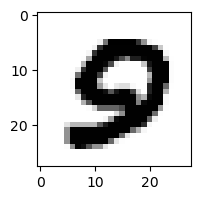

0.6757720750654089% - 0 - ОШИБКА
1.25851384883268e-06% - 1
0.000478215997502287% - 2
0.0028437394540629943% - 3
0.009732497969162568% - 4
0.4427545645436843% - 5
0.013088002164448128% - 6
0.00038571270410877093% - 7
0.0023572489114875696% - 8
0.00022482387486254696% - 9

 9


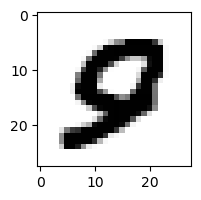

0.8401519949732653% - 0 - ОШИБКА
1.023346060784496e-05% - 1
0.011643804080554335% - 2
2.870804708442823e-05% - 3
0.15082296065338793% - 4
0.8006689923739402% - 5
0.047906368819448576% - 6
0.023611218950093816% - 7
0.001441583581768333% - 8
0.03584921249800454% - 9

 3


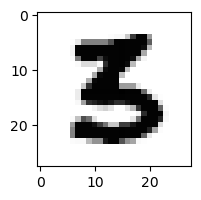

0.009334374750644227% - 0
6.258592781309478e-05% - 1
0.08972382314223831% - 2
8.637427178403481% - 3
0.0001932679684827631% - 4
17.31527375193308% - 5 - ОШИБКА
0.009163795695393441% - 6
7.621404886427817e-06% - 7
6.159712652064998e-05% - 8
7.642154723886263e-06% - 9

 5


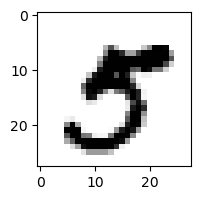

0.16677275930035762% - 0
0.0015827371884234852% - 1
4.361098003782365e-06% - 2
82.9096403993016% - 3 - ОШИБКА
0.1320816696759537% - 4
52.665276368638644% - 5
8.252124149186777e-06% - 6
0.8033061788369862% - 7
0.005676511509327188% - 8
0.014064636993299157% - 9

 8


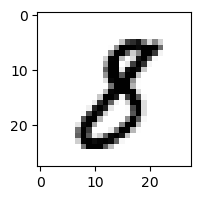

0.09013355764078736% - 0
1.2864910667635003% - 1
0.03613716638712691% - 2
29.77971790336289% - 3 - ОШИБКА
0.005496905225887516% - 4
0.17209537231166486% - 5
0.004758971678878645% - 6
0.07602710341768891% - 7
4.0319650177094895% - 8
0.019243364522571988% - 9

 5


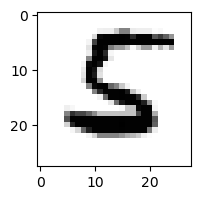

0.010167496167701127% - 0
0.0004342611566658141% - 1
62.968026483103415% - 2 - ОШИБКА
0.021480972444146554% - 3
0.009160690339451156% - 4
42.19171760583305% - 5
61.12684959582311% - 6
4.87628537879221e-05% - 7
0.012406673112086729% - 8
1.2484412298953275e-06% - 9

 8


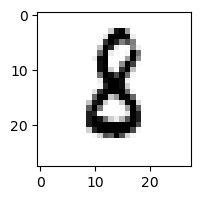

0.10469166203822541% - 0
0.47927311339778245% - 1
1.7959768848991056% - 2
5.230630995578938% - 3
0.019114033496602657% - 4
2.907411162536945% - 5
41.22193792925778% - 6 - ОШИБКА
0.0060781673920197905% - 7
1.424566724734024% - 8
0.0053592845013050935% - 9

 5


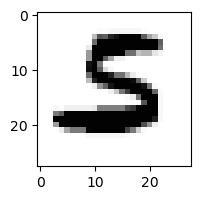

0.009688023919387704% - 0
0.0002463272169799385% - 1
20.67381064423963% - 2 - ОШИБКА
0.056571989770681494% - 3
4.658369509628721e-05% - 4
1.0193673210825296% - 5
13.46490863588659% - 6
0.0001920798422642888% - 7
0.0014594532922719051% - 8
1.8151748066659937e-05% - 9

 2


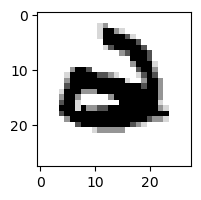

0.06361438642854225% - 0
3.746512802576897e-05% - 1
0.0034875211353813176% - 2
0.00016424892950539288% - 3
0.11607082113139434% - 4
0.0003102582955613972% - 5
2.306042194639511% - 6 - ОШИБКА
4.70595906860055e-05% - 7
0.00011699398574069348% - 8
0.00368253127623452% - 9

 2


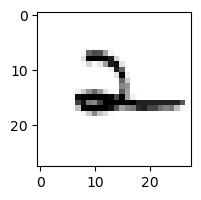

0.3356860462810881% - 0
3.1064116944798497% - 1
41.213688005386594% - 2
0.43255059375928706% - 3
72.86267738046493% - 4 - ОШИБКА
0.2809113783728487% - 5
51.74807955123678% - 6
4.764624722730061% - 7
2.018248756264819% - 8
23.054946739281945% - 9

 3


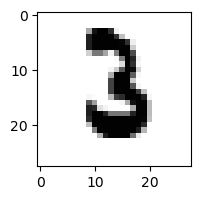

0.0028909353104742456% - 0
0.07355980508004782% - 1
29.82606399442363% - 2 - ОШИБКА
15.410953214013695% - 3
0.0007181093380729736% - 4
0.002571862645983604% - 5
3.725273282237549% - 6
0.011570327218649357% - 7
0.0012379064285664848% - 8
0.0011276229393049203% - 9

 6


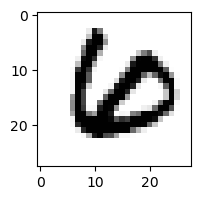

0.04764280731061728% - 0
0.0016353590140210958% - 1
2.018357871826308% - 2 - ОШИБКА
0.001063414562397665% - 3
0.00455298725723003% - 4
0.0003758038577531136% - 5
0.4741231671731501% - 6
0.008324023800433525% - 7
0.10409861200513168% - 8
6.139396112838558e-05% - 9

 0


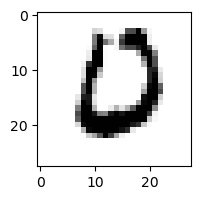

55.22060702164203% - 0
8.504908085171019e-05% - 1
9.58687044312292% - 2
0.0006947549697828802% - 3
0.029451602579696395% - 4
0.29163954870148995% - 5
87.5733205815071% - 6 - ОШИБКА
0.052190912981470335% - 7
0.010848031914494216% - 8
4.748498846762992e-05% - 9

 3


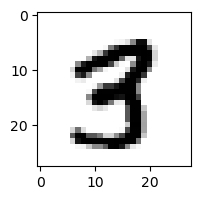

0.014834877689752517% - 0
0.0020246520061304655% - 1
0.01621032317896493% - 2
7.580527527654185% - 3
0.1371740056008089% - 4
0.8046248157408035% - 5
8.442806333552435e-05% - 6
0.08690806864263467% - 7
9.899997031541302% - 8 - ОШИБКА
1.5246112502994151% - 9

 8


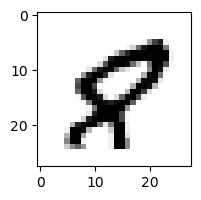

1.11831277447402% - 0
0.010196302303138572% - 1
0.006420355191756378% - 2
9.071890913901346e-06% - 3
1.3508747388604234% - 4
2.8546463980175174% - 5 - ОШИБКА
0.018608291612830286% - 6
0.7288732821259138% - 7
0.07145270621841511% - 8
0.128621542803678% - 9

 9


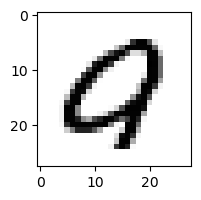

44.632862906065014% - 0 - ОШИБКА
0.0002625255873133474% - 1
0.4172802387982495% - 2
0.0009930513610354296% - 3
0.17955390698352183% - 4
1.81138273293289% - 5
0.11174296722638835% - 6
0.43392613375330646% - 7
0.015083867892130244% - 8
0.051419362023186144% - 9

 3


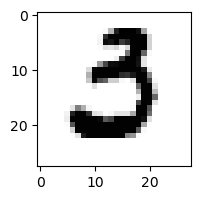

20.55845000285933% - 0 - ОШИБКА
0.001952624967899943% - 1
0.8521239134857874% - 2
0.5381828104088306% - 3
1.6869896293328565e-05% - 4
0.3613255223095706% - 5
1.0119802570364471% - 6
0.19721735087186998% - 7
0.00017937205251942825% - 8
4.273225682784784e-06% - 9

 5


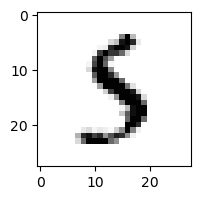

0.15661357409635984% - 0
0.07519472491626036% - 1
0.04418177467774167% - 2
42.61754527213538% - 3 - ОШИБКА
0.8550452255007372% - 4
32.457070711649436% - 5
1.0292760396357592% - 6
0.09705838946059456% - 7
29.081713986449675% - 8
0.41183039889060624% - 9

 8


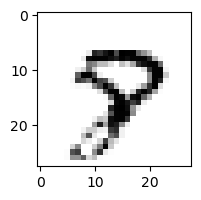

0.2987156941549482% - 0
0.011678315860826242% - 1
0.012848841272024122% - 2
0.021901021170758973% - 3
0.8531393039027829% - 4
1.5068578987986139% - 5
0.07619670146199538% - 6
25.251249189053382% - 7 - ОШИБКА
1.6369766136788797% - 8
9.76423876846994% - 9

 9


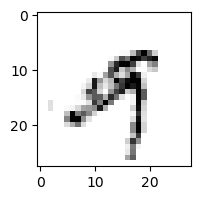

0.4609190784913268% - 0
0.9478461389219107% - 1
1.2401812199615416% - 2
26.68954624122969% - 3 - ОШИБКА
11.214544281000855% - 4
0.703902504762792% - 5
0.1470316177894781% - 6
0.8166371134962179% - 7
0.5976852455487671% - 8
10.376925488980032% - 9

 7


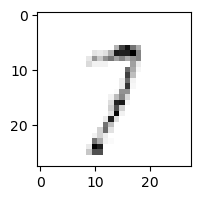

5.7788489069357425% - 0
18.144389712012646% - 1
51.00328454298418% - 2
48.89118399571012% - 3
4.909976144794069% - 4
8.271056536705544% - 5
5.608420520106215% - 6
60.76489374958823% - 7
29.855102004527033% - 8
88.49795989856426% - 9 - ОШИБКА

 9


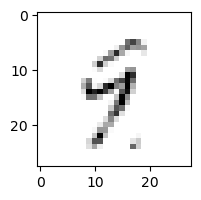

0.47508826452473185% - 0
14.54444674066181% - 1
5.21716549219223% - 2
18.847306760114776% - 3
73.78237717877921% - 4 - ОШИБКА
12.253810750080854% - 5
12.990906219738735% - 6
1.3336147690587659% - 7
27.59553742368277% - 8
64.54298771041171% - 9

 3


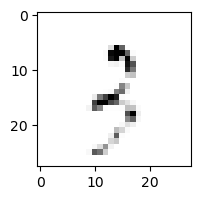

4.425498439593051% - 0
15.757677080928097% - 1
59.756894193539466% - 2
59.99258616805615% - 3
3.239075829654702% - 4
3.5390044428697207% - 5
13.025195643926942% - 6
8.171253474020371% - 7
51.54639860835142% - 8
95.26967189095438% - 9 - ОШИБКА

 1


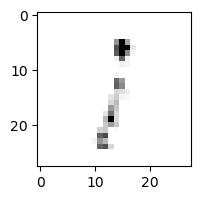

21.25311548002599% - 0
50.08060926437644% - 1
55.135611838902% - 2
45.959038132616485% - 3
3.9369838215426523% - 4
20.326733329838945% - 5
22.265111816490833% - 6
9.301940287413242% - 7
78.96065656410165% - 8 - ОШИБКА
73.96099770384374% - 9

 5


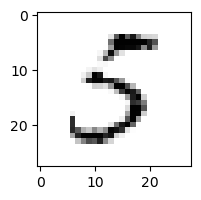

5.257104592208829% - 0
0.19204343363307058% - 1
0.5835687511958816% - 2
54.937241042426365% - 3 - ОШИБКА
1.4157321557742357% - 4
30.685187082344928% - 5
5.306270923450199% - 6
0.041395777884134455% - 7
3.406109884197791% - 8
0.084653210566794% - 9

 2


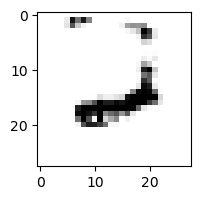

2.5715050788722262% - 0
0.3490149367510615% - 1
62.03514208214628% - 2
0.009626281626752447% - 3
69.98518755270702% - 4
0.01962894886315367% - 5
92.40829779918563% - 6 - ОШИБКА
14.118529288165432% - 7
12.476443271701033% - 8
7.55239329650345% - 9

 7


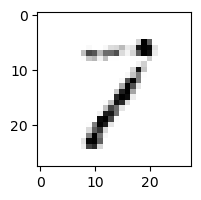

0.9750330668140591% - 0
29.79417316105428% - 1
23.759337444233836% - 2
6.113470195302127% - 3
15.126014880806215% - 4
5.576750271537099% - 5
5.813749684585037% - 6
34.042739299602175% - 7
44.2141802157879% - 8 - ОШИБКА
5.40699769399418% - 9

 0


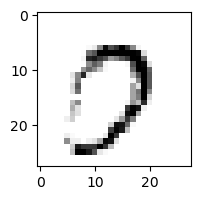

52.12075738700669% - 0
0.0018634604940955183% - 1
0.7969460476324065% - 2
36.29836491147294% - 3
0.06781283161765057% - 4
1.0285755520030995% - 5
0.07253555405929% - 6
80.5417956987707% - 7 - ОШИБКА
1.2372924997751475% - 8
75.64100252147007% - 9

 5


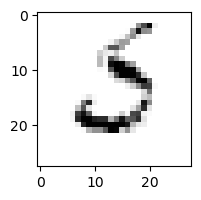

16.706548654189067% - 0
0.9989494379146969% - 1
49.71358001340809% - 2
17.124843002416036% - 3
0.008265221208161946% - 4
0.23988353633356074% - 5
75.37883258264134% - 6 - ОШИБКА
14.7088242261007% - 7
0.06474821024359749% - 8
0.13484547900605748% - 9

 8


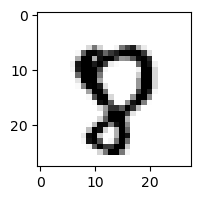

0.716766889393885% - 0
0.00014710239031830982% - 1
0.007664705637652273% - 2
0.0011281425047657793% - 3
0.3647304418676559% - 4
23.484042902286024% - 5 - ОШИБКА
0.037351595652982114% - 6
23.204756601466347% - 7
1.3963713384676282% - 8
12.960396608203078% - 9

 9


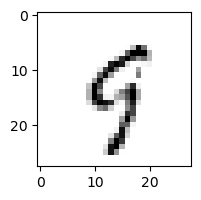

2.5309634812269866% - 0
0.3710747669917022% - 1
0.49010207873082184% - 2
8.823199446240803% - 3
37.2466709755472% - 4 - ОШИБКА
18.341147306734147% - 5
4.72456664129762% - 6
8.689910888995001% - 7
3.8805615944817644% - 8
31.233117534796417% - 9

 7


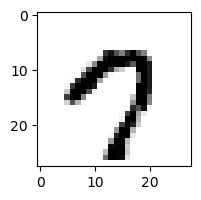

47.67535731490889% - 0
0.0015555895202582612% - 1
0.00027225352924863577% - 2
0.12698594739573263% - 3
0.7542995776462117% - 4
1.444187216540451% - 5
0.039732541784302605% - 6
70.03485968353968% - 7
0.00437256992854922% - 8
76.46509835823433% - 9 - ОШИБКА

 9


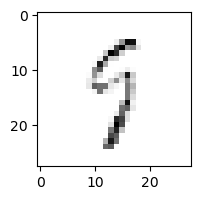

7.07829310700947% - 0
1.6861241155451623% - 1
13.055279502060888% - 2
28.859399337067003% - 3
25.820763308461824% - 4
25.282206543920488% - 5
17.29592102941547% - 6
7.93884249220618% - 7
63.94495620429963% - 8 - ОШИБКА
48.55133674560007% - 9

 8


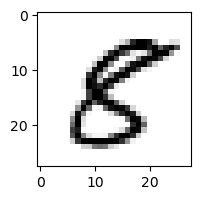

1.1196014987379315% - 0
0.012208009747202035% - 1
0.01993948715433825% - 2
0.36873787221867477% - 3
2.927537144997575% - 4
66.85359967035447% - 5 - ОШИБКА
0.0005243391910523412% - 6
0.003776652305788734% - 7
2.6679706082976424% - 8
0.013956002634532715% - 9

 9


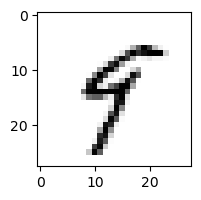

0.21651178211157499% - 0
6.873180212882492% - 1
0.060190093211096585% - 2
1.6542089805254834% - 3
56.21405778293249% - 4 - ОШИБКА
43.646333702914596% - 5
2.7223760195775175% - 6
1.4913271858995456% - 7
2.001639388712077% - 8
24.57036212572376% - 9

 0


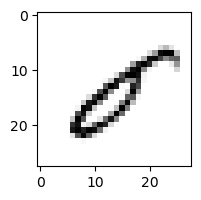

3.4055551770501014% - 0
1.4329866471921366% - 1
57.062368374242446% - 2 - ОШИБКА
8.311508589134123% - 3
22.952212266339618% - 4
20.64438745384887% - 5
0.211651335564949% - 6
0.812551362543123% - 7
22.410193338344435% - 8
1.0817199315693495% - 9

 1


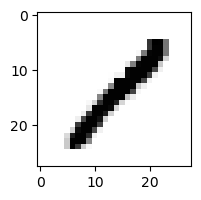

0.11444379063547004% - 0
33.17074219723077% - 1
5.535742698889845% - 2
1.5735819214147417% - 3
3.860531417889306% - 4
0.1748749186031878% - 5
0.026138500385896678% - 6
0.7663891940771422% - 7
88.52423822360007% - 8 - ОШИБКА
0.25922721660679826% - 9

 1


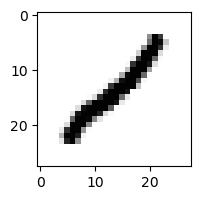

0.3748012882299694% - 0
24.772504760406395% - 1
44.023014677495034% - 2
2.934201636590884% - 3
19.181274031565433% - 4
0.10810857859750085% - 5
0.13250377229695037% - 6
0.11302859874758184% - 7
82.87376517901056% - 8 - ОШИБКА
2.49737194947657% - 9

 9


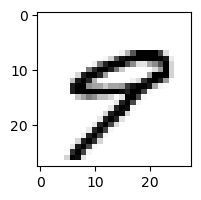

1.5117586308713733% - 0
0.04764178036478036% - 1
0.000803943164559539% - 2
0.0022569175472287864% - 3
20.967129187654407% - 4 - ОШИБКА
9.081535128544632% - 5
0.06744052552070981% - 6
7.582720112047878% - 7
0.09242139839303379% - 8
19.82693945261885% - 9

 1


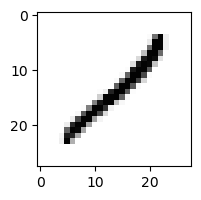

1.0851847392270053% - 0
24.632172202792912% - 1
53.21150075832897% - 2
8.538554427885199% - 3
26.014504950279687% - 4
0.44159751574388795% - 5
0.4535957207666327% - 6
1.4704717489656909% - 7
97.74264473299868% - 8 - ОШИБКА
7.5301814100407345% - 9

 5


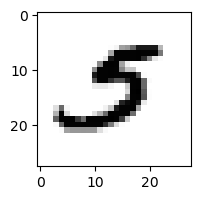

0.27881869236284357% - 0
0.19299434887459077% - 1
2.167675287958882% - 2
0.5118212657387576% - 3
0.03420030145038946% - 4
7.085088520740805% - 5
0.0313845813796071% - 6
17.691823390280568% - 7 - ОШИБКА
0.023954902089457535% - 8
1.1972448357715528% - 9

 5


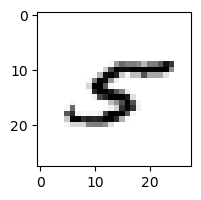

0.6393772573590986% - 0
1.5556925646117963% - 1
4.067724746061216% - 2
1.4489905936350522% - 3
19.835517986976186% - 4
3.69539336266014% - 5
1.8921690455252689% - 6
2.4118661142092046% - 7
29.716257172122535% - 8 - ОШИБКА
0.36994449449916533% - 9

 2


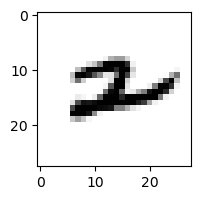

0.051349728387078714% - 0
8.174567964040111% - 1
0.05679897738648706% - 2
0.002385460806065877% - 3
30.113330794165478% - 4 - ОШИБКА
0.01099570758437229% - 5
10.80354382404945% - 6
1.4432399283250803% - 7
0.5033434425877463% - 8
26.722779709099225% - 9

 5


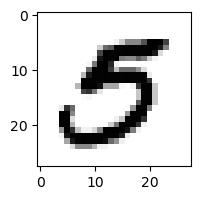

6.37400794396477% - 0
0.0009912735708891972% - 1
0.00010372473987260144% - 2
42.966730904412195% - 3 - ОШИБКА
0.012957285297628048% - 4
23.84021644784594% - 5
0.004853679530356143% - 6
0.13013943352653953% - 7
0.0011678214369422847% - 8
0.057380126623433815% - 9

 3


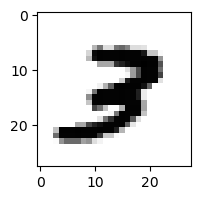

0.05637066269131726% - 0
0.0023926059537029013% - 1
5.172031976291905% - 2 - ОШИБКА
4.8600118621483785% - 3
0.007163141346182929% - 4
0.008897291286430834% - 5
0.0033992336607477766% - 6
0.31927353775704925% - 7
0.07407493610112954% - 8
2.720216367066609% - 9

 9


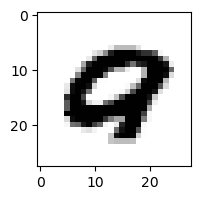

6.137428696503727% - 0 - ОШИБКА
6.892459086123683e-06% - 1
0.007023864183762618% - 2
1.710158999174306e-07% - 3
0.06806956793833895% - 4
0.0004103194414382579% - 5
0.016313001406398506% - 6
0.38548907108907005% - 7
0.0031696052278898153% - 8
0.09575476450116774% - 9

 2


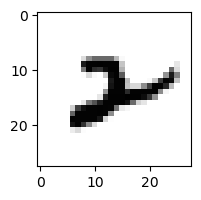

0.01989094542438214% - 0
4.28923308778649% - 1
1.2316079808525309% - 2
0.0005714535673881617% - 3
0.958171690052074% - 4
0.021567388045118034% - 5
30.395153453532604% - 6
0.36558223581648247% - 7
50.53431255492997% - 8 - ОШИБКА
1.851121030184345% - 9

 5


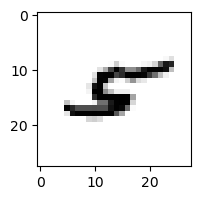

0.3551461035879895% - 0
1.8935459418719072% - 1
2.884824845991229% - 2
0.05942454454829443% - 3
89.61377041548715% - 4
0.058015264356164636% - 5
7.731131376040466% - 6
1.3850805238439048% - 7
92.26423260774969% - 8 - ОШИБКА
15.229312913228249% - 9

 9


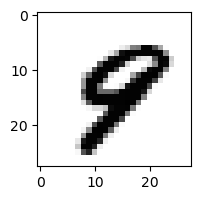

0.041778528079246396% - 0
0.0037407984585156313% - 1
0.0031079781838618406% - 2
0.0003053211120677686% - 3
9.652420857851476% - 4 - ОШИБКА
1.8639357430741812% - 5
0.05329077106082811% - 6
0.8342751957504217% - 7
0.20016469536479495% - 8
7.227351876669038% - 9

 8


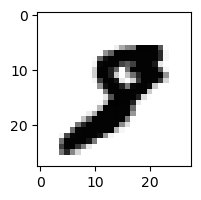

0.02093472894535681% - 0
0.07099143284576134% - 1
0.011767675514510615% - 2
0.013394931733377198% - 3
0.0017321367655214592% - 4
0.021039585737296893% - 5
0.0005278263885030032% - 6
2.4838464523661874% - 7 - ОШИБКА
0.2326086555749641% - 8
0.07156808392949623% - 9

 7


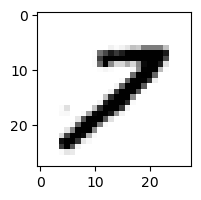

0.3904225953619955% - 0
0.7195249721011858% - 1
34.76793803391434% - 2
0.09787324684614852% - 3
0.06926360538149925% - 4
0.05386015405696345% - 5
0.002760702505352086% - 6
11.428320088478614% - 7
55.02514113778151% - 8 - ОШИБКА
7.990791332941108% - 9

 4


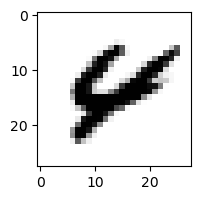

0.4594219951691091% - 0
0.0015014239292537208% - 1
0.09386498786258228% - 2
3.7728682783797522e-06% - 3
12.1106606393425% - 4
0.02418076625523687% - 5
1.0851204430812262% - 6
0.025294652223237946% - 7
37.54440774780637% - 8
71.59981977550434% - 9 - ОШИБКА

 9


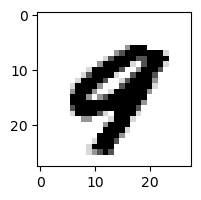

0.0758524340104196% - 0
3.820739553218154e-05% - 1
4.711833969140454e-05% - 2
1.3485692714468918e-05% - 3
17.509750915155877% - 4 - ОШИБКА
0.0010579836060152698% - 5
0.009209788405180271% - 6
0.4272432216289246% - 7
0.022175913173130432% - 8
3.0291794653137596% - 9

 5


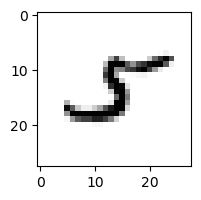

0.3136804587106314% - 0
36.0450247406945% - 1
8.119299406424116% - 2
0.09185546556774955% - 3
2.155275092701607% - 4
0.6556547756157968% - 5
0.6397398744899537% - 6
11.040743173742982% - 7
65.14000597238933% - 8 - ОШИБКА
0.910387223526709% - 9

 2


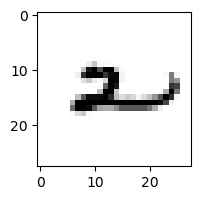

1.5493344491446817% - 0
2.416286727651184% - 1
0.3141810423963723% - 2
0.17201787308356536% - 3
88.58052052227465% - 4 - ОШИБКА
3.4825147446389995% - 5
76.88305037621978% - 6
0.17489817337647218% - 7
18.747943445168342% - 8
30.655101248939097% - 9

 5


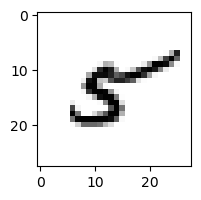

0.7580619745879128% - 0
2.26571444704214% - 1
0.7953979242096456% - 2
0.05381194460111411% - 3
31.033535757841463% - 4
42.214872746126616% - 5
6.030213964624183% - 6
0.6117270821072175% - 7
73.04334274632207% - 8 - ОШИБКА
2.1715039029512493% - 9

 9


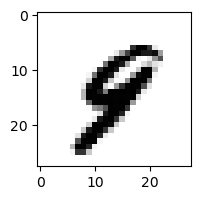

0.015251057204334463% - 0
0.2157615759780896% - 1
0.02120084088790271% - 2
0.008710509548087607% - 3
8.135678594971575% - 4 - ОШИБКА
1.120469375414814% - 5
0.49255918144322847% - 6
0.3011723604447413% - 7
0.2440706294478529% - 8
6.652392258490622% - 9

 2


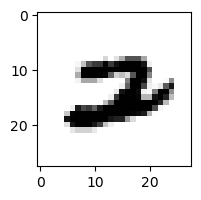

0.09308377707117614% - 0
0.006636666434181711% - 1
0.4065950107347329% - 2
7.851838479137848e-05% - 3
0.3307527231832415% - 4
0.0010019105426344245% - 5
1.7462780870309529% - 6
40.15998328556853% - 7 - ОШИБКА
0.03667590665200014% - 8
0.033538037296992715% - 9

 9


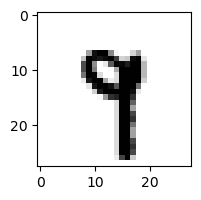

0.0010430218305387193% - 0
0.37638796474131037% - 1
0.012396014800777976% - 2
2.7412300781997434% - 3
9.329970144590412% - 4
0.6179462345951005% - 5
0.024866130189452787% - 6
14.70731577759212% - 7 - ОШИБКА
0.6893799920114017% - 8
8.641069273303723% - 9

 9


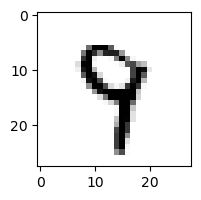

0.018468114628824823% - 0
0.039724682122202745% - 1
0.31896517984980716% - 2
2.440081966521778% - 3
50.07905029083148% - 4 - ОШИБКА
2.417154653381473% - 5
0.7843753601522632% - 6
4.6957749372862105% - 7
24.04259735016499% - 8
28.843873456587925% - 9

 9


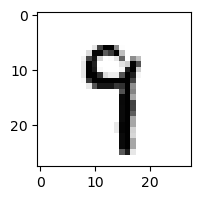

0.023500366243246907% - 0
0.4661487434993855% - 1
0.060343310774869596% - 2
19.717768564311857% - 3
31.237834840355738% - 4 - ОШИБКА
9.15760694199608% - 5
0.5184743250972857% - 6
10.092517826990717% - 7
18.08988128870988% - 8
24.929161509116767% - 9

 6


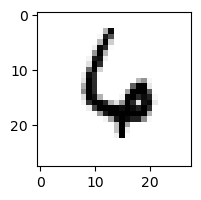

0.07748524683746247% - 0
0.008206667289744882% - 1
7.722063012352089% - 2
0.015382306709488992% - 3
84.8406818995428% - 4 - ОШИБКА
1.5336280307825831% - 5
70.595337325234% - 6
2.127883606711584% - 7
0.06258796885460971% - 8
4.962621017173812% - 9

 4


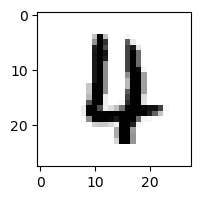

0.27560386165662015% - 0
0.00021290103192984984% - 1
9.746499442255525% - 2 - ОШИБКА
0.03152784063133206% - 3
6.320063314694973% - 4
0.07976410746159882% - 5
8.224411811504304% - 6
0.42739039651310834% - 7
0.08926490685194446% - 8
0.26091220260589637% - 9

 5


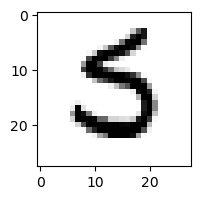

0.9105650255990855% - 0
0.002331636354366751% - 1
0.4627858623305536% - 2
0.6561743378106956% - 3
0.00034888543775039% - 4
13.201743423537021% - 5
37.783370791347984% - 6 - ОШИБКА
0.09055881878020731% - 7
0.19901184261215144% - 8
0.010543190849164661% - 9

 9


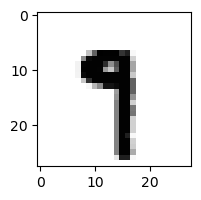

0.00105149198688615% - 0
0.59917485669687% - 1
0.0011198330809186294% - 2
0.2970484147203817% - 3
0.31066219942774603% - 4
10.330208504939241% - 5
0.1512930608688466% - 6
34.94708848474687% - 7 - ОШИБКА
1.6583521412569617% - 8
17.00366513485441% - 9

 5


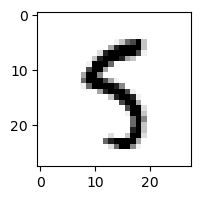

0.338429491088261% - 0
0.04256781043328894% - 1
0.1077591075381248% - 2
2.654376704086027% - 3
3.49081870153855% - 4
53.01638754360791% - 5
0.45998853409505347% - 6
0.06778168914815716% - 7
69.15430694731458% - 8 - ОШИБКА
48.56317988247764% - 9

 9


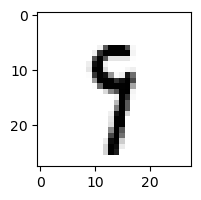

0.0301704386759071% - 0
1.017533525238461% - 1
0.10733909942847152% - 2
6.968906769214138% - 3
4.8278597306086315% - 4
17.677370310210737% - 5
2.746778654927897% - 6
2.9318861621922854% - 7
74.57409440457076% - 8 - ОШИБКА
72.69784709780389% - 9

 2


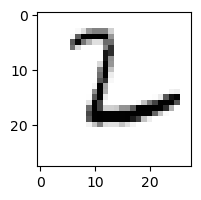

4.163173653904405% - 0
0.07551815396144278% - 1
85.52977267168875% - 2
0.5249297154546563% - 3
0.7288393421764261% - 4
1.3446699688279053% - 5
98.71264492058543% - 6 - ОШИБКА
0.39658681351905856% - 7
4.378312261486799% - 8
0.9904203143783704% - 9

 5


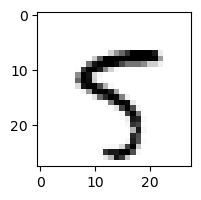

0.7734836767313075% - 0
0.11111303767651673% - 1
0.19672864643332502% - 2
0.2599905815461297% - 3
2.663613802233306% - 4
70.37175605290949% - 5
0.10718049314935611% - 6
8.907927675067391% - 7
4.121789696956265% - 8
74.14839077445191% - 9 - ОШИБКА

 9


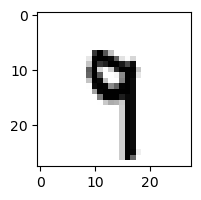

0.0018490635779702216% - 0
0.9794889335163567% - 1
0.09764831658676522% - 2
6.027583925171986% - 3
28.26153101789935% - 4 - ОШИБКА
3.2992330991918077% - 5
0.5904970987044298% - 6
5.975063778201569% - 7
2.5052035941550175% - 8
19.923033572762137% - 9

 2


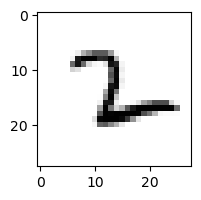

0.04010189778969424% - 0
16.86063368948686% - 1
22.67010563972926% - 2
1.368113934202468% - 3
0.15490424446069376% - 4
6.249200267837322% - 5
56.14977991506292% - 6 - ОШИБКА
9.470518775264141% - 7
1.8899183894721974% - 8
0.22764950688087507% - 9

 9


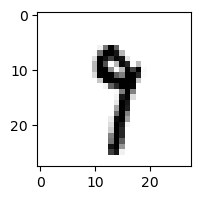

0.021164487771082718% - 0
3.625323334871268% - 1
0.08579869846828428% - 2
14.56450664072713% - 3
1.4292247334234702% - 4
1.571366613378731% - 5
0.28256348669708736% - 6
56.51840902343965% - 7 - ОШИБКА
4.316973473835546% - 8
26.912408344382893% - 9

 6


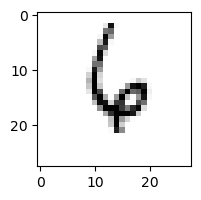

0.05805607121176413% - 0
0.4150635953984674% - 1
18.028685538740298% - 2
0.15350315716559215% - 3
94.09526366946086% - 4 - ОШИБКА
8.975563927533578% - 5
67.33475059761332% - 6
6.06388253659991% - 7
5.717621671660576% - 8
26.670362467751662% - 9

 5


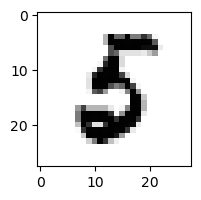

1.0144425683736862% - 0
0.01849358282195084% - 1
0.13483583875248062% - 2
0.08206829274698749% - 3
0.005053740250804518% - 4
5.790283598451544% - 5
21.461427201976115% - 6 - ОШИБКА
0.0017696070594906957% - 7
0.27089161844581117% - 8
0.00042831630922903944% - 9

 5


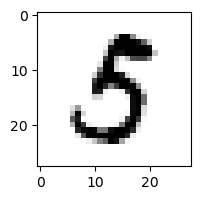

4.999724223070768% - 0
0.011867579325587496% - 1
0.03287675496919611% - 2
62.265599975188465% - 3 - ОШИБКА
0.040961905362654184% - 4
45.599674005090094% - 5
0.04450043055486115% - 6
0.00814475407138214% - 7
0.2576250730388358% - 8
0.027174972665377144% - 9

 7


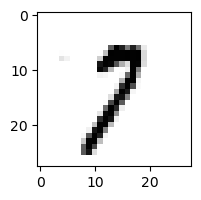

0.4739420484863725% - 0
16.502515821429505% - 1
9.182589691634375% - 2
2.289229004877262% - 3
0.0817103313874231% - 4
0.9291676889929417% - 5
0.2201057608109515% - 6
49.79104581832986% - 7
3.057458034656426% - 8
61.066972408691036% - 9 - ОШИБКА

 8


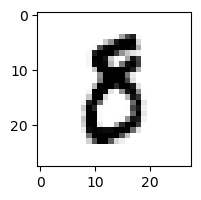

2.7664385664105047% - 0
0.0055077831833172134% - 1
0.1279837034108081% - 2
16.47984693143903% - 3 - ОШИБКА
0.006138571004615231% - 4
4.314787000890123% - 5
0.4418946120109484% - 6
0.00911513385592466% - 7
2.6486987727037232% - 8
0.01601473606340983% - 9

 2


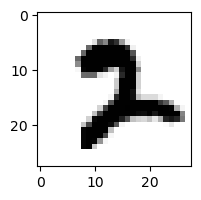

0.0009170411606741425% - 0
0.0052402004092452145% - 1
10.668662317059589% - 2
0.024749558055811468% - 3
0.00011501083500428703% - 4
0.09030338667515397% - 5
0.01852409458169761% - 6
19.086896193813512% - 7 - ОШИБКА
0.000589281013595703% - 8
0.004318235576396499% - 9

 9


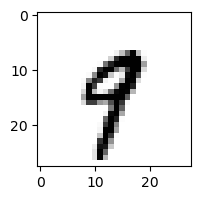

0.028768806245082688% - 0
3.601879434481234% - 1
0.04037390382345058% - 2
0.2807948272997449% - 3
12.536992986764627% - 4 - ОШИБКА
1.0952392376395332% - 5
0.3603414720788668% - 6
7.3394348810644825% - 7
0.09638468255309723% - 8
10.595415332716875% - 9

 9


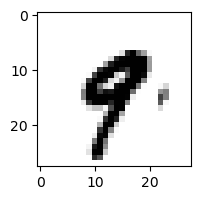

0.01651002320910082% - 0
0.6560113565901766% - 1
0.0019322616818459822% - 2
0.12886015576960727% - 3
13.186472026000073% - 4 - ОШИБКА
0.14362842422753286% - 5
0.1298000127500381% - 6
1.1121739921836977% - 7
0.05479239377908447% - 8
8.35144673989968% - 9

 8


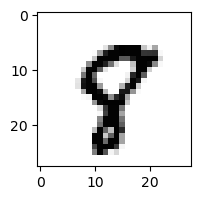

0.19184944824162736% - 0
0.007794584522260683% - 1
0.021483856936494506% - 2
0.007021601846755744% - 3
0.6467842826403497% - 4
4.207544151762707% - 5
0.016302096795511575% - 6
1.9862863188362359% - 7
6.5121854012921405% - 8
19.776378296368897% - 9 - ОШИБКА

 9


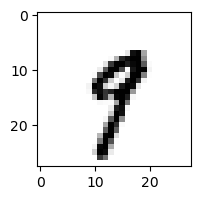

0.06678787011289246% - 0
1.6428013769442478% - 1
0.02848263654162548% - 2
8.579926269311953% - 3
13.683622575182783% - 4
1.9720337605562035% - 5
0.29398129560602826% - 6
16.888056658529578% - 7 - ОШИБКА
1.6104736404766722% - 8
5.102289774422374% - 9

 3


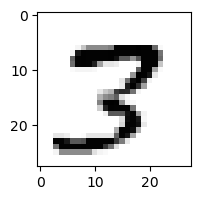

0.026765063052520396% - 0
0.0062512218430431565% - 1
1.0942809087047767% - 2
13.898871376221555% - 3
0.062132635153869825% - 4
0.30388546899118757% - 5
0.00028707113569889284% - 6
30.391647145541643% - 7
30.651625926619307% - 8 - ОШИБКА
0.5831690990677172% - 9

 8


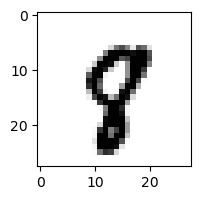

0.0439021506685279% - 0
0.019497198370285178% - 1
0.013561062860376746% - 2
0.016345567574393344% - 3
1.6910565711154815% - 4
1.1628946522646104% - 5
0.01563643561227556% - 6
6.973551048145188% - 7
1.2035372448660104% - 8
9.609457616457732% - 9 - ОШИБКА

 3


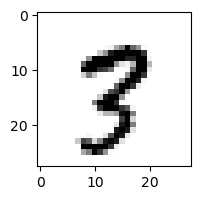

0.015157980028050647% - 0
0.21060532922187414% - 1
0.13989166082323926% - 2
0.21462984750847133% - 3
0.04606250604396655% - 4
0.3499321014335875% - 5
0.010686121332651509% - 6
17.06059703273923% - 7
32.26306817239911% - 8
51.22196863113901% - 9 - ОШИБКА

 9


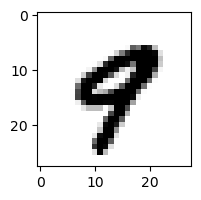

0.09544505855581861% - 0
0.00943841789266909% - 1
0.00046970156238959723% - 2
0.0025193576325482658% - 3
18.582009487259214% - 4 - ОШИБКА
0.13224423560220666% - 5
0.004456019558853108% - 6
1.8551756555214798% - 7
0.06488278857372741% - 8
15.132362544550087% - 9

 5


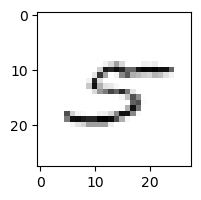

13.425876837502923% - 0
2.305799604701769% - 1
16.025639905524766% - 2
7.565654501112901% - 3
12.559146917995978% - 4
5.6381693638093004% - 5
11.627172111631424% - 6
26.089576931931774% - 7 - ОШИБКА
18.631215775700348% - 8
5.560392684141438% - 9

 8


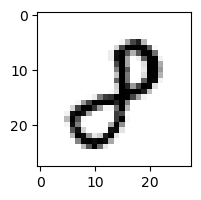

0.6004990369057924% - 0
0.34262942817609326% - 1
4.099789618072681% - 2
1.3095891593420017% - 3
0.4535055634276089% - 4
0.004507334232809943% - 5
0.006009040154412952% - 6
0.8733356646305583% - 7
2.9095386179806337% - 8
5.725017794935091% - 9 - ОШИБКА

 6


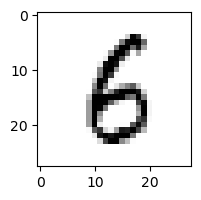

0.6924039017787059% - 0
0.053788795596756415% - 1
0.7601834497679512% - 2
0.605837187571095% - 3
0.6590868393517056% - 4
5.67315775126706% - 5
34.29315561838944% - 6
0.005526403021607327% - 7
46.36963602666876% - 8 - ОШИБКА
1.3007743650971828% - 9

 2


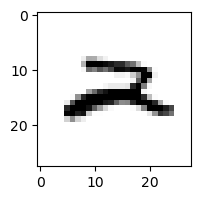

1.200816557611556% - 0
0.0727917304239566% - 1
23.968004703445057% - 2
0.2586181766066141% - 3
43.76808763939096% - 4 - ОШИБКА
0.011117677491692892% - 5
2.841485486305037% - 6
2.7896842024517676% - 7
0.11234151105312412% - 8
21.349258602993586% - 9

 0


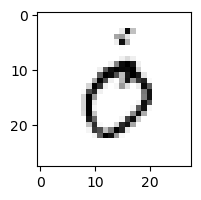

33.352317944097024% - 0
0.3872875381567706% - 1
0.4455257578313281% - 2
41.844311498333155% - 3
6.58904055316493% - 4
2.228769981590883% - 5
51.6909119638192% - 6 - ОШИБКА
8.367566812698383% - 7
0.4062235648388345% - 8
0.5635729464473223% - 9

 3


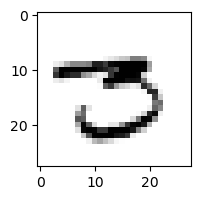

2.4037733522442912% - 0
0.3114876023027252% - 1
0.016226969774715078% - 2
7.361976550218291% - 3
0.003644229991641984% - 4
4.862671809884427% - 5
0.06153139338245249% - 6
11.151918728493289% - 7 - ОШИБКА
0.46192953933000164% - 8
0.024543588179420976% - 9

 5


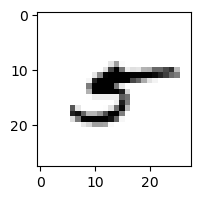

0.4510123838598217% - 0
12.21059554120765% - 1
0.5253402589833924% - 2
1.330407701859536% - 3
21.50739733072837% - 4
0.40473881472198336% - 5
18.51640469072217% - 6
0.43405634210252036% - 7
65.01182192955073% - 8 - ОШИБКА
7.39286974952062% - 9

 3


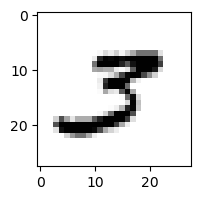

0.8931995251105381% - 0
0.48171287973644217% - 1
7.797860346957816% - 2
18.963261547047765% - 3
0.007883182286222748% - 4
2.276634963327237% - 5
0.0037740374772696392% - 6
21.69098195245208% - 7 - ОШИБКА
0.4425258929133964% - 8
0.13834633849933373% - 9

 2


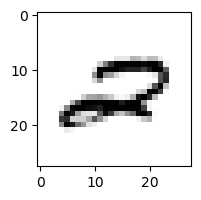

8.312858330086263% - 0
0.06394890371807793% - 1
9.357674771987243% - 2
0.011937871884734486% - 3
10.359352356410959% - 4
0.0036661066742274895% - 5
0.45300323382472224% - 6
18.47959248175564% - 7 - ОШИБКА
0.3434685535917408% - 8
0.37475728346332376% - 9

 8


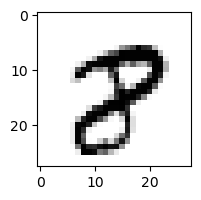

0.04055916314768883% - 0
0.038057991839750345% - 1
0.027088300797231984% - 2
0.0010916524371238458% - 3
0.0019844188029818424% - 4
0.043563224043106585% - 5
0.0009453171807248826% - 6
23.640900970717126% - 7 - ОШИБКА
17.30479515028796% - 8
1.2395057188619945% - 9

 1


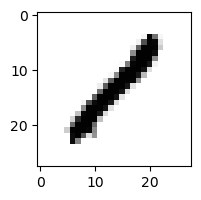

1.6364902874260634% - 0
37.261079976936514% - 1
16.18720613338773% - 2
11.095918490840416% - 3
1.2578428169046594% - 4
0.3920794018117477% - 5
0.045348599651484585% - 6
0.03688178756227259% - 7
54.198970538754885% - 8 - ОШИБКА
0.5139182618736534% - 9

 8


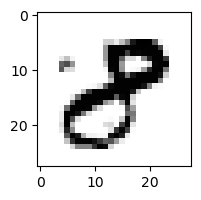

0.7456022196463676% - 0
0.01790772813036258% - 1
0.11992379193542983% - 2
9.0535269269213% - 3 - ОШИБКА
0.12404926235466388% - 4
0.002148301701980099% - 5
0.0005066108756577389% - 6
0.0018935094035463142% - 7
0.3465235593227408% - 8
1.4525785164609868% - 9

 5


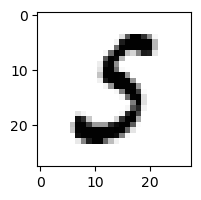

1.4430326575652175% - 0
0.394520945904146% - 1
0.1429055089957226% - 2
52.150609441672124% - 3 - ОШИБКА
0.0032238693119437415% - 4
31.138514414922984% - 5
1.1338448007286215% - 6
0.07732503621872092% - 7
0.1585582076797262% - 8
0.007112071443800477% - 9

 4


0.012953156414809442% - 0
0.004730892527972409% - 1
0.010291777423792864% - 2
0.03357220893991207% - 3
1.7171158549903205% - 4
0.005389503799767125% - 5
0.08688625299644649% - 6
0.015914401064080815% - 7
1.1491714745792536% - 8
8.335499568215193% - 9 - ОШИБКА

 4


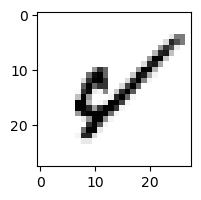

5.2696348661813195% - 0
0.30410056859046525% - 1
1.0528986763828458% - 2
0.001979983606004403% - 3
93.32608136915559% - 4
2.075579837435936% - 5
24.83720219292881% - 6
0.39860826741142% - 7
94.36745159028122% - 8 - ОШИБКА
7.196675844490988% - 9

 7


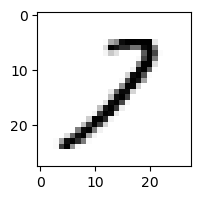

1.1161985175149172% - 0
31.699522450216534% - 1
56.68085138418787% - 2
4.069983298584004% - 3
3.483411691713032% - 4
0.32213443315530926% - 5
0.5509836154472049% - 6
3.259397806147355% - 7
71.3018842898127% - 8 - ОШИБКА
0.3151553871068008% - 9

 8


0.22772699285123535% - 0
0.9283260753124655% - 1
27.53589982259977% - 2 - ОШИБКА
1.834802224170395% - 3
0.05317566180151928% - 4
0.026407589524398988% - 5
0.5350718750258259% - 6
0.052675276367432584% - 7
20.341268360404253% - 8
1.6834153724286087% - 9

 4


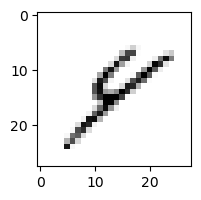

1.8711228593569187% - 0
3.5804582859501104% - 1
9.43920588522237% - 2
5.247840771686262% - 3
8.437252066103728% - 4
6.585929403771951% - 5
18.908480425052144% - 6
0.9182776363688333% - 7
98.69760101253385% - 8 - ОШИБКА
61.63309506760667% - 9

 1


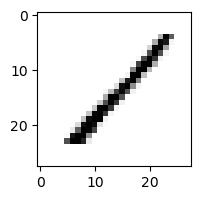

1.0828502387966454% - 0
51.32859473915479% - 1
29.422172720326955% - 2
3.8138730010476642% - 3
11.365492862322924% - 4
2.1016314409962993% - 5
1.365051863349323% - 6
5.035991011553081% - 7
92.82317747263198% - 8 - ОШИБКА
1.0564758777958962% - 9

 5


2.670368739138488% - 0
0.0035080159088080472% - 1
0.06303806681053911% - 2
25.29483398280208% - 3 - ОШИБКА
0.0020870441273001523% - 4
11.772157025260721% - 5
6.054585268628313% - 6
0.021510180689657533% - 7
0.3585443521076861% - 8
0.04445001218046425% - 9

 5


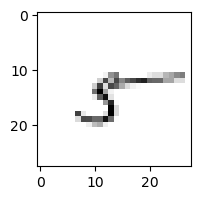

9.046417984863089% - 0
46.23966301896388% - 1
26.161950738614127% - 2
13.340327214695105% - 3
35.98523920824649% - 4
8.650888112816716% - 5
81.95057970765194% - 6
1.5134289323804366% - 7
95.21917846793184% - 8 - ОШИБКА
56.59420996405965% - 9

 5


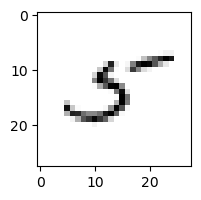

3.728136685677245% - 0
11.209475639858683% - 1
6.783311477035543% - 2
0.6084159321232329% - 3
48.15353506927285% - 4
33.476248132667976% - 5
6.022738248779294% - 6
8.797958869067182% - 7
95.71963412979032% - 8 - ОШИБКА
4.311414226493652% - 9

 9


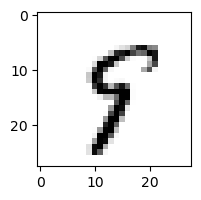

0.19994113663604451% - 0
0.9475051235826721% - 1
0.17082275614199213% - 2
0.2979693148436742% - 3
13.70225957897318% - 4
48.54824366687996% - 5 - ОШИБКА
1.4049359932495282% - 6
2.003830111401408% - 7
38.57306126299799% - 8
41.19808614507437% - 9

 2


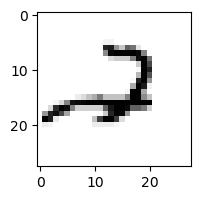

2.8206324711567303% - 0
0.20330665287285446% - 1
73.85941057978906% - 2
0.412190928886358% - 3
25.499759438869553% - 4
0.01781034064599529% - 5
0.6519424224213062% - 6
9.298812796457252% - 7
0.39555423174424753% - 8
90.00287687269584% - 9 - ОШИБКА

 4


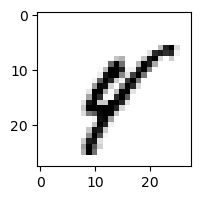

0.12268147034157953% - 0
5.643606219801846% - 1
0.18180956505965976% - 2
0.33228840217441646% - 3
22.180450049772844% - 4
1.9933892580317973% - 5
6.762204040719406% - 6
2.950970459887745% - 7
61.79119463101607% - 8 - ОШИБКА
1.214518583044249% - 9

 3


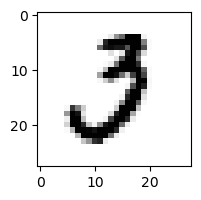

9.467006913365127% - 0
0.036620560885614994% - 1
36.26564892801401% - 2 - ОШИБКА
16.843808426635057% - 3
0.004776158939884192% - 4
0.42196986798265546% - 5
0.008637723902326384% - 6
2.3580368508361036% - 7
0.005338892728168824% - 8
0.0028809387714218647% - 9

 2


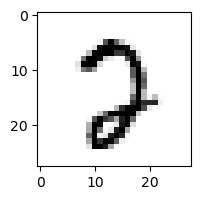

10.665646370976948% - 0
0.0034592369666496792% - 1
13.021131764793598% - 2
4.571836071330428% - 3
0.018251120613361323% - 4
2.106653315383639% - 5
0.20033871248842763% - 6
37.55323471892428% - 7 - ОШИБКА
2.550477335055235% - 8
0.3065772833075186% - 9

 5


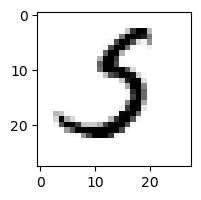

0.7445670873483085% - 0
0.09077018335379813% - 1
9.996218829010658% - 2
40.2756348478765% - 3 - ОШИБКА
0.009148504705234884% - 4
3.386273359461303% - 5
4.9990902530913575% - 6
7.386704954814853% - 7
0.005365947187191712% - 8
0.08008095116644606% - 9

 5


7.8383747714641485% - 0
0.003960674031524947% - 1
0.9333690114353449% - 2
1.5977292691312424% - 3
9.14562741230172e-05% - 4
15.196207679713602% - 5
0.14706713453490344% - 6
20.75338320230567% - 7 - ОШИБКА
0.001673896739831001% - 8
0.018049124154569572% - 9

 8


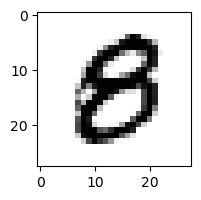

9.70295241029299% - 0 - ОШИБКА
0.00011179325334337176% - 1
0.006369868490875057% - 2
0.1476533966332005% - 3
0.05044249646621344% - 4
0.8674573301521354% - 5
0.15853200942905135% - 6
0.00011563898175945194% - 7
5.265129404410285% - 8
0.11328534434563127% - 9

 8


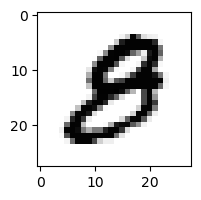

4.8639752041383% - 0 - ОШИБКА
0.00018613907387758622% - 1
0.03604447250777953% - 2
0.4811885200981178% - 3
0.008349628079985828% - 4
0.04437009952726434% - 5
0.09440979743088969% - 6
0.0002987652823826053% - 7
1.8490311979662901% - 8
0.46402773502988254% - 9

 5


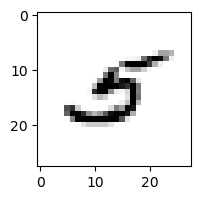

0.7260133369392733% - 0
1.1854218264778145% - 1
5.500873688468088% - 2
2.870815818805901% - 3
30.526407525283755% - 4 - ОШИБКА
10.147920496704305% - 5
2.2399022673857503% - 6
1.3143126312185223% - 7
14.257253836072245% - 8
0.7046836001467524% - 9

 5


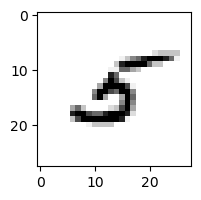

0.5039438299008902% - 0
5.649298383997283% - 1
21.20190519017618% - 2
1.4433189724217876% - 3
17.270323492113036% - 4
6.913339987423352% - 5
1.9257921353166645% - 6
0.9882772587978604% - 7
25.139309400259275% - 8 - ОШИБКА
0.5005873425629064% - 9

 8


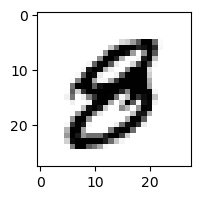

0.22545015059931892% - 0
0.0002161561144506355% - 1
0.0005987135145858253% - 2
0.6752783589066262% - 3
0.47308229729628853% - 4
0.09233388366899395% - 5
0.008659736953446353% - 6
0.0007342701505077501% - 7
0.05611925058432098% - 8
2.653088652318308% - 9 - ОШИБКА

 7


0.2305771666241374% - 0
0.0003058710378129307% - 1
1.0227123027437313e-06% - 2
0.0022411459177707526% - 3
64.1442565446297% - 4 - ОШИБКА
1.73721273287594% - 5
0.0014634309997794254% - 6
59.48194749164368% - 7
0.07968033039841979% - 8
0.17778973045165883% - 9

 9


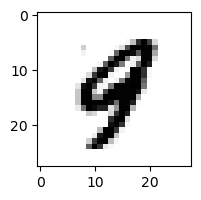

0.03341349006426343% - 0
0.029732196073924327% - 1
0.006653192066581497% - 2
0.006908305111973612% - 3
47.802107372999515% - 4 - ОШИБКА
0.0656780886493057% - 5
0.06555367937975931% - 6
0.07140978967590436% - 7
0.22141355802102808% - 8
36.22513906791608% - 9

 9


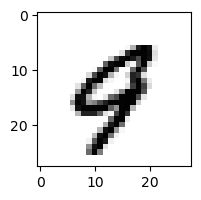

0.7462590449644545% - 0
0.015298738605066897% - 1
0.022252947689886653% - 2
0.0014305475352514492% - 3
57.72300127490881% - 4 - ОШИБКА
0.029520478809354163% - 5
0.23214889518142276% - 6
4.937926382142262% - 7
0.06479369237527782% - 8
8.57279382227391% - 9

 8


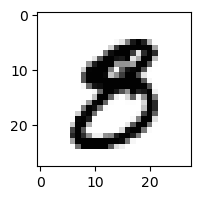

0.24055266629061164% - 0
0.0006568284504451463% - 1
0.00042513455918788537% - 2
2.4304476694243466% - 3 - ОШИБКА
0.00473617886985001% - 4
1.3946415542292268% - 5
0.00023511284264673133% - 6
0.004642698537663742% - 7
2.0550617223482868% - 8
0.3904669236299748% - 9

 8


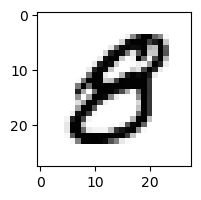

4.51162115252014% - 0 - ОШИБКА
0.00030114260421115735% - 1
0.0030625603820675007% - 2
0.24645732627572348% - 3
0.4918849396273722% - 4
2.8762918820371834% - 5
0.00893031777345526% - 6
0.00019796472273764406% - 7
0.5951696103967575% - 8
0.35365358693560695% - 9

 2


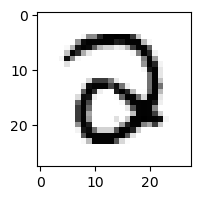

16.71931659448374% - 0
0.00014433034560996284% - 1
4.553544921614798% - 2
36.19216884599146% - 3 - ОШИБКА
0.8759433541181664% - 4
0.058576298969006284% - 5
0.2906762698104979% - 6
0.0008433321395565858% - 7
0.008890780668833465% - 8
2.1917273731405517e-05% - 9

 9


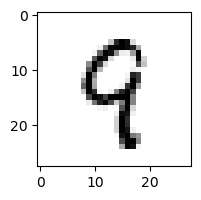

0.14768718656648594% - 0
0.12956636011585349% - 1
5.596654518250274% - 2
0.6949910146704413% - 3
46.132528756535606% - 4 - ОШИБКА
3.560777791596009% - 5
0.9949744166002767% - 6
0.40772829826719653% - 7
20.075623354405238% - 8
22.72762032768513% - 9

 9


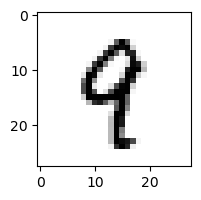

0.03320333191581449% - 0
1.0698993161311872% - 1
0.33316135885283354% - 2
0.25136934276650263% - 3
32.78839118075149% - 4 - ОШИБКА
1.1504846845339498% - 5
0.16675340101360336% - 6
0.481123544611263% - 7
3.5241901514229577% - 8
30.452962378081477% - 9

 5


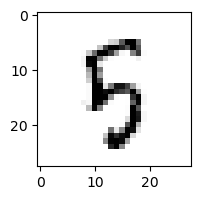

1.1726290066284555% - 0
0.013633940056207598% - 1
1.3607205535991405% - 2
6.415099413359111% - 3
20.639720332670315% - 4
37.77658599517376% - 5
7.005201684326703% - 6
0.023066729712436847% - 7
86.52614341334743% - 8 - ОШИБКА
6.52335241564852% - 9

 5


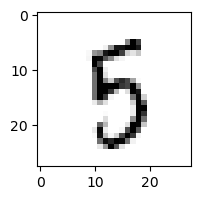

1.122048215386034% - 0
0.026813665880090893% - 1
0.267190514668984% - 2
45.70860110388164% - 3
4.231372867724578% - 4
59.353821106823325% - 5
3.155452663757018% - 6
0.039990571639610825% - 7
67.87661890888317% - 8 - ОШИБКА
14.952692436711265% - 9

 8


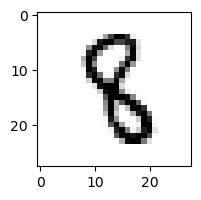

0.0011856567921912033% - 0
1.7847898990195925% - 1
2.4098760901692544% - 2
1.6167855134714897% - 3
1.4548402306695287% - 4
7.1307144095436055% - 5 - ОШИБКА
0.1675925635912763% - 6
0.013060724217132199% - 7
0.5761599713054892% - 8
0.007939134533711516% - 9

 2


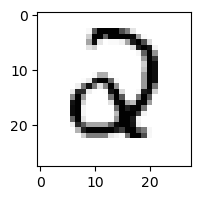

1.0430326417592275% - 0
0.009446702073713715% - 1
1.8273870942667403% - 2
0.699568821008336% - 3
8.605733336930637% - 4 - ОШИБКА
0.859604848490287% - 5
4.725539973483063% - 6
0.0190311710844684% - 7
0.0067255615818701715% - 8
0.0006993601753334547% - 9

 8


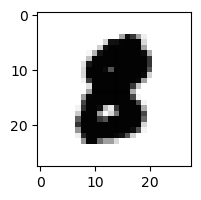

0.005177842009412219% - 0
0.00010110334431768523% - 1
0.012338483612362845% - 2
0.0015663203826715934% - 3
0.0001024581327769701% - 4
0.037890867922685485% - 5 - ОШИБКА
0.002814503486047963% - 6
0.00010952338328010514% - 7
0.01814775754283332% - 8
0.0002905528896600695% - 9

 8


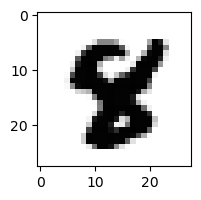

2.0980661888767386e-05% - 0
1.77164831379991e-05% - 1
1.910537350300479e-05% - 2
0.00016098333086196368% - 3
0.14985595449426872% - 4
1.6147842366106557% - 5 - ОШИБКА
0.00030820790513731066% - 6
0.0012929322131341678% - 7
0.779455873852727% - 8
0.0005635402952101619% - 9

 5


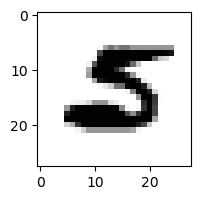

0.12222725745190585% - 0
0.004586947771836044% - 1
1.2278655598037103% - 2 - ОШИБКА
0.002566198296120794% - 3
7.593540176019389e-05% - 4
0.5516622191851341% - 5
0.4829701850851755% - 6
0.12444441227960241% - 7
0.0015469599908727516% - 8
0.009362612741781996% - 9

 9


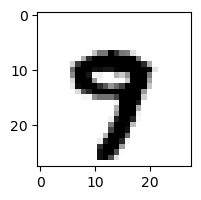

0.003671233006093127% - 0
0.0004681566967123964% - 1
4.8309861140434515e-05% - 2
0.01407407012771468% - 3
0.4981459164123762% - 4
0.30568213128533467% - 5
0.007997279587048434% - 6
26.840394955525394% - 7 - ОШИБКА
0.007762677470235493% - 8
16.8361768550733% - 9

 5


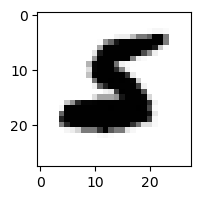

0.0007160165345332993% - 0
0.001256151664990475% - 1
3.3767727265874745% - 2 - ОШИБКА
0.00013246084881132447% - 3
0.0006502568536129359% - 4
0.027704167284232646% - 5
2.4586361770845935% - 6
0.00011949354543722746% - 7
0.0005575054063015441% - 8
0.0004978072877806907% - 9

 3


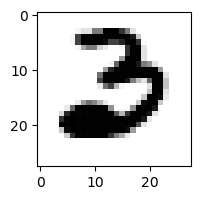

6.627130582221727% - 0
0.0009897980803906551% - 1
23.847617261406096% - 2 - ОШИБКА
1.0003346479527526% - 3
1.4524015000879307e-06% - 4
1.270153527632788e-05% - 5
0.4226778325221113% - 6
0.005436274394216577% - 7
0.00023011027811790629% - 8
6.394504702365699e-07% - 9

 3


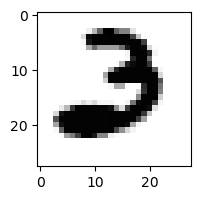

3.023251731856259% - 0
0.0022970290912148767% - 1
68.21882816898678% - 2 - ОШИБКА
0.7514339224946707% - 3
2.3103092513022097e-05% - 4
1.777203830975599e-05% - 5
0.03811365300374289% - 6
0.04824693149752556% - 7
0.00016187271154745038% - 8
2.596465273531626e-06% - 9

 8


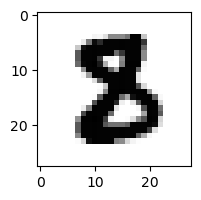

0.000719186351085525% - 0
0.0005214737521644986% - 1
0.2154308525661041% - 2 - ОШИБКА
0.05552011003920849% - 3
5.860320214600235e-06% - 4
0.10461181390563491% - 5
0.0024007172489987397% - 6
0.0002999511219203541% - 7
0.03040017881095033% - 8
1.0618805336465885e-06% - 9

 5


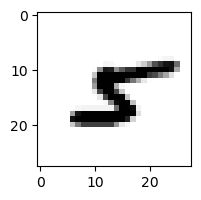

0.053679051329430245% - 0
1.4576372752934679% - 1
0.9862754109067353% - 2
0.0997406282736452% - 3
3.4496674023049927% - 4
0.3896886752041078% - 5
4.0773142326830225% - 6
0.3021675765269774% - 7
80.86179208173373% - 8 - ОШИБКА
0.14571728429954578% - 9

 5


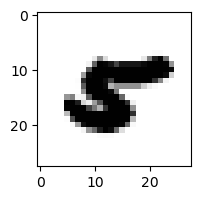

0.06340760379675438% - 0
0.005291419272266386% - 1
0.008005939081175906% - 2
9.949698718378016e-06% - 3
1.3165758712377216% - 4
0.007481309685616281% - 5
0.47053732546552984% - 6
0.015398582498604658% - 7
3.252784994597376% - 8 - ОШИБКА
0.02119344419612236% - 9

 3


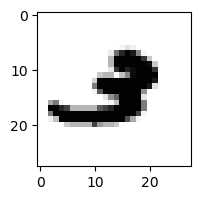

0.013870861343582189% - 0
0.06568709349508248% - 1
2.0837458094196877% - 2
0.18820120372564672% - 3
0.27767352412842816% - 4
0.00017133599130772785% - 5
0.03456175908141224% - 6
0.729879403496285% - 7
0.13220668808195624% - 8
8.132101718213795% - 9 - ОШИБКА

 5


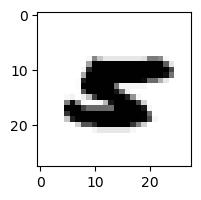

0.010338391125275395% - 0
0.0012914518514022312% - 1
0.006379082812335942% - 2
7.864213447521774e-05% - 3
0.4674655544951878% - 4 - ОШИБКА
0.002245559183466611% - 5
0.3321216700663251% - 6
0.014497603642358014% - 7
0.1916356521496118% - 8
0.006026663797272016% - 9

 9


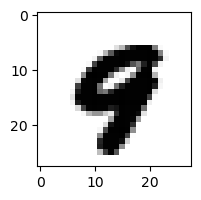

0.008845861147797233% - 0
1.9977206557373004e-05% - 1
9.968436510491983e-06% - 2
4.0877904674229e-05% - 3
5.96913503980297% - 4 - ОШИБКА
0.0037419548226666887% - 5
0.004819156960243923% - 6
0.1334723461540585% - 7
0.001496783916984509% - 8
3.332415863328165% - 9

 2


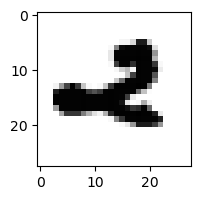

0.08894161740182814% - 0
0.00954940644717689% - 1
7.364347242595416% - 2
0.03289332284776325% - 3
5.167753667960662% - 4
2.0150910668386554e-05% - 5
0.006744136860533344% - 6
0.0008949210980002374% - 7
0.0010527453362421493% - 8
59.3391100982472% - 9 - ОШИБКА

 3


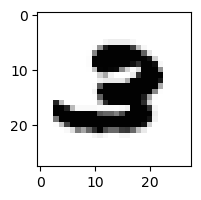

0.032792098204008045% - 0
8.958739680984518e-05% - 1
11.77971750740804% - 2 - ОШИБКА
0.1256656856067158% - 3
2.08136901905452e-05% - 4
0.0010119576286966039% - 5
0.04066961301542618% - 6
0.017458059738336248% - 7
0.00605831714662883% - 8
0.0577297178100886% - 9

 5


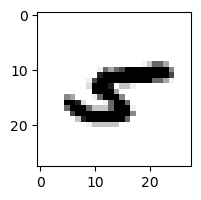

0.24214258313211423% - 0
1.174817881076557% - 1
0.6650737602959703% - 2
0.01247637274358324% - 3
38.7412969918485% - 4
0.0007109606366493285% - 5
4.925648838636481% - 6
0.15825058537891717% - 7
67.4058076456494% - 8 - ОШИБКА
2.371010520816153% - 9

 5


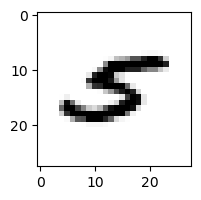

0.31624180197141555% - 0
0.39933926656885493% - 1
0.16099003547024796% - 2
0.022332921983645646% - 3
23.274299525998472% - 4 - ОШИБКА
0.3609748898564477% - 5
0.060425173989750544% - 6
6.4820033449793275% - 7
5.374154285800258% - 8
0.3613048156811025% - 9

 8


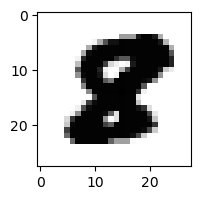

0.0005578049719386273% - 0
4.4485018450618715e-07% - 1
0.008245097322107677% - 2
2.287501201719598e-05% - 3
0.00014539249616501957% - 4
0.3132086490220881% - 5 - ОШИБКА
9.110320740872917e-06% - 6
2.2370141869006793e-06% - 7
0.2971085047891608% - 8
1.1429214896457987e-06% - 9

 2


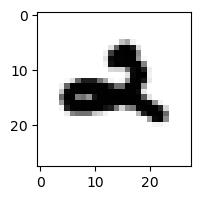

0.34446124396137195% - 0
0.003947537885984684% - 1
0.22270424714390838% - 2
0.1862449749540734% - 3
49.94983002063461% - 4
0.00023272242908551396% - 5
0.32040341882341106% - 6
0.002660670166834863% - 7
0.0005626126622952181% - 8
97.57036697956542% - 9 - ОШИБКА

 5


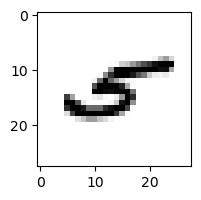

0.29076342856458987% - 0
3.425684082095974% - 1
1.0466506653559364% - 2
0.3252500968312635% - 3
78.8215452371778% - 4 - ОШИБКА
0.016762121852492977% - 5
0.45546808337918276% - 6
0.7193955267887513% - 7
57.52106961423029% - 8
4.2202404083677685% - 9

 3


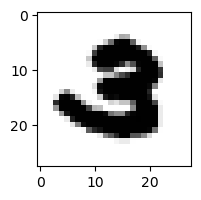

0.04767856578728075% - 0
9.259864438384813e-06% - 1
2.8314734684257954% - 2 - ОШИБКА
0.06387528478552115% - 3
1.627699743378465e-05% - 4
6.617368620184401e-05% - 5
0.0026871551640601705% - 6
0.00035354606890482693% - 7
0.00040666765832128305% - 8
0.0007411451203284477% - 9

 2


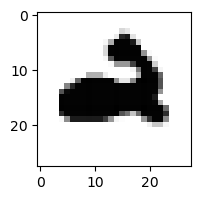

0.5484847865705287% - 0
6.066551821243327e-05% - 1
0.17557691475649212% - 2
0.00027419495113598536% - 3
5.883582149754499% - 4
2.524895163277364e-06% - 5
0.1817542042156832% - 6
2.3741175391952154e-05% - 7
0.0002634263536693338% - 8
23.641401845319173% - 9 - ОШИБКА

 5


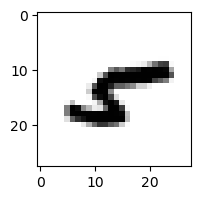

0.36827395961213755% - 0
1.9715232429584388% - 1
2.276522595777027% - 2
0.035734381322374005% - 3
5.629380608038548% - 4
0.0027541954853419178% - 5
12.306012224228667% - 6
0.09026316210439417% - 7
81.87092123917311% - 8 - ОШИБКА
2.0473989758541755% - 9

 8


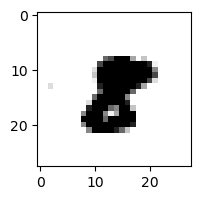

0.001301653905937105% - 0
0.9639526238347647% - 1
0.07147845470916576% - 2
0.01074690374494415% - 3
0.037840625009943785% - 4
0.003635652565937306% - 5
6.239176617808561% - 6 - ОШИБКА
0.12777213589676775% - 7
4.643835574923066% - 8
0.422754428875287% - 9

 1


0.011245344361248643% - 0
2.3521787133564738% - 1
0.437357274635408% - 2
0.017118104737234026% - 3
0.1334336506898504% - 4
0.008266711613200408% - 5
0.004363304076150153% - 6
0.024525994235558377% - 7
2.3621085824270667% - 8 - ОШИБКА
0.004899601833495883% - 9

 2


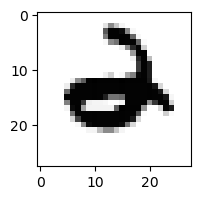

0.3296161781715056% - 0
0.0005825173553765622% - 1
0.016113658072257796% - 2
0.003372693631090226% - 3
43.38034969667631% - 4 - ОШИБКА
0.0002873968087799151% - 5
41.84162896172601% - 6
0.00037797858344897143% - 7
7.520960388578715e-05% - 8
0.020022757674058998% - 9

 8


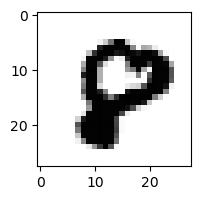

8.196432495898003% - 0 - ОШИБКА
7.169602751869759e-06% - 1
0.017363966095592397% - 2
1.6468763916959325e-05% - 3
0.04084285616644222% - 4
0.038553462898191636% - 5
0.002842211798154894% - 6
0.10603937083291323% - 7
7.0183716894224135% - 8
0.004175182769210199% - 9

 7


0.22111467418949587% - 0
4.447108833794477% - 1
10.528715058156022% - 2
2.684925179404194% - 3
0.013435411611025967% - 4
0.06375925184632052% - 5
0.00914045181111289% - 6
21.40218527964367% - 7
5.607095348527466% - 8
25.308769135521793% - 9 - ОШИБКА

 8


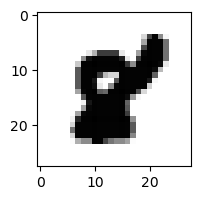

0.0018728521212531709% - 0
0.0015783708395535748% - 1
0.00012782793547779878% - 2
1.8100978964193774e-07% - 3
0.022014573631852108% - 4
0.29910953318006456% - 5 - ОШИБКА
0.0005376712879678201% - 6
0.0114388665456035% - 7
0.04826212294319457% - 8
0.0002723647469785278% - 9

 1


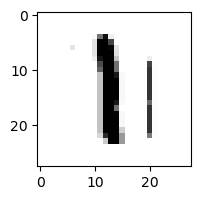

0.02801492754296381% - 0
13.046645421034054% - 1
0.6082490671976317% - 2
0.5286867216938945% - 3
0.10715990081552179% - 4
13.487196865152306% - 5
12.29566999768023% - 6
0.15187692236220005% - 7
37.590972697795266% - 8 - ОШИБКА
0.6449958285812476% - 9

 9


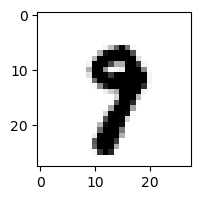

0.0026109659798882368% - 0
0.047351428627625695% - 1
0.0012822127988972116% - 2
0.43112619438518496% - 3
0.07289643454812093% - 4
0.17829755241819098% - 5
0.011844774077630226% - 6
18.95115330773829% - 7 - ОШИБКА
0.4471811455301175% - 8
17.65225499771655% - 9

 2


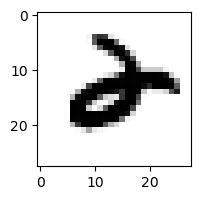

0.17208171623807517% - 0
0.013126798368727242% - 1
7.017672426087324% - 2
0.006743437620193987% - 3
1.1021046418130227% - 4
3.4682312730021976e-06% - 5
0.9021504789572728% - 6
0.0009585488120838752% - 7
0.015150379086502184% - 8
7.114849497285768% - 9 - ОШИБКА

 5


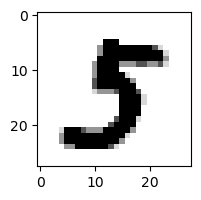

0.04290486786370042% - 0
0.003356356881293179% - 1
0.0002319903901896656% - 2
75.01700183259294% - 3 - ОШИБКА
0.004202493006535181% - 4
34.74835421773946% - 5
6.792505601984367e-05% - 6
0.24689577882842845% - 7
0.056322846514923655% - 8
0.008430074397289815% - 9

 4


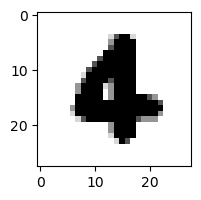

0.00036181631592433204% - 0
0.0011024048351158315% - 1
0.004094111986962788% - 2
7.260080483391745e-05% - 3
0.13159224494081745% - 4
0.0005282353363845037% - 5
2.2617982689559324% - 6 - ОШИБКА
0.00034235174011579034% - 7
3.808511206392336e-06% - 8
0.014409246561047681% - 9

 2


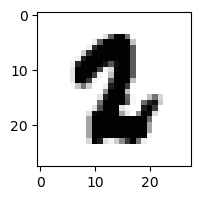

4.800198025282128e-05% - 0
0.08141957974265551% - 1
0.0703214359614304% - 2
0.001109104316106828% - 3
8.6136827536733e-06% - 4
0.15383839536881141% - 5 - ОШИБКА
0.07436267519029219% - 6
0.004051336522558635% - 7
0.011003516818107613% - 8
0.00019001189956641338% - 9

 2


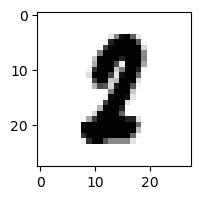

0.0033704474672251266% - 0
0.4419348867584846% - 1 - ОШИБКА
0.05243609601321429% - 2
0.012357090074657415% - 3
0.0003441356484937397% - 4
0.4050534779331154% - 5
0.00992552314019884% - 6
0.027542816595028587% - 7
0.1815227807435339% - 8
0.000858077408200352% - 9

 4


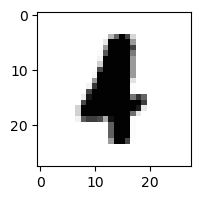

0.00033870009996215134% - 0
0.30788900429360727% - 1
0.14605122895947714% - 2
0.005152424107200233% - 3
0.22831100697375178% - 4
0.008649771714027315% - 5
1.4603760711313283% - 6 - ОШИБКА
0.0008676303958691022% - 7
0.048637590829952095% - 8
0.2648271403038336% - 9

 8


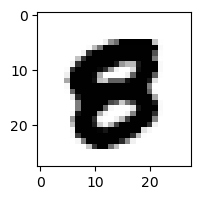

0.22900448665903508% - 0 - ОШИБКА
7.837814138886314e-08% - 1
4.612288284725965e-05% - 2
0.0001421263806330441% - 3
0.0005399681053713096% - 4
0.049697815514282935% - 5
0.00024410659841266435% - 6
1.538991515689305e-05% - 7
0.006686116643732063% - 8
0.0020766473509221065% - 9

 3


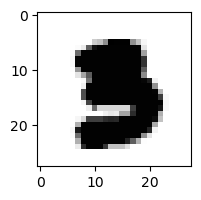

0.00015525232536026934% - 0
9.701314496053896e-07% - 1
4.4042428522966375e-05% - 2
0.0824714110490298% - 3
1.2729172804770465e-05% - 4
0.11784179310082812% - 5 - ОШИБКА
0.00021573110686658916% - 6
0.00027989144067749747% - 7
8.933687448814044e-06% - 8
2.9707421427174716e-06% - 9

 2


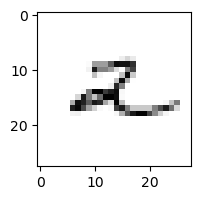

1.5883064894202843% - 0
14.296543170814175% - 1
32.04038871740488% - 2
2.8302263076447596% - 3
53.879451641950624% - 4 - ОШИБКА
1.8968535187944613% - 5
14.06195644525722% - 6
0.7651015682071226% - 7
0.8339565149821171% - 8
37.65295849515847% - 9

 5


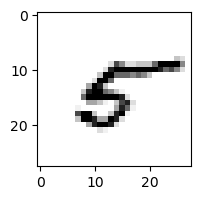

4.524578685590787% - 0
1.098129956195248% - 1
3.474811489411742% - 2
1.6230329307385771% - 3
25.14305524890976% - 4 - ОШИБКА
15.072671539596104% - 5
12.041341108711375% - 6
1.5195359810987596% - 7
19.88775648427597% - 8
0.7151752685928315% - 9

 9


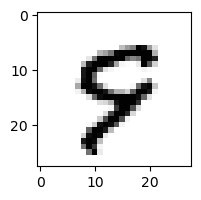

0.33646574949880875% - 0
0.008771616423074929% - 1
0.06267308937301042% - 2
0.008222506590569157% - 3
6.164751478706377% - 4
65.40110419352222% - 5 - ОШИБКА
0.1970224490012122% - 6
5.0793198887252675% - 7
0.06710021873218412% - 8
22.08384367952212% - 9

 8


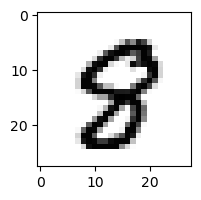

0.27150829930312687% - 0
0.0014485838812619753% - 1
0.002900794056318662% - 2
0.007847405634248614% - 3
0.251152106512748% - 4
2.4165481233859096% - 5 - ОШИБКА
0.0031404255444290917% - 6
0.12110122171291265% - 7
2.3817672522991926% - 8
0.17118927410268422% - 9

 9


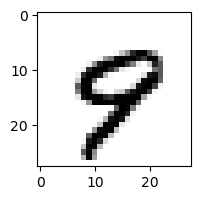

0.6264410144150672% - 0
0.0076508703718893714% - 1
0.004613341552347602% - 2
0.0007147236098542117% - 3
12.804612725536483% - 4
1.9791326744894384% - 5
0.16593981067557864% - 6
17.61056110292373% - 7 - ОШИБКА
0.02619609775457298% - 8
14.431795023650693% - 9

 1


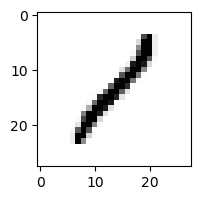

1.824343984125849% - 0
74.09594931383732% - 1
22.604184474922707% - 2
11.83016799861142% - 3
3.9565217571739053% - 4
0.6791966272278693% - 5
0.728234644414626% - 6
0.361221218711062% - 7
79.08216314278556% - 8 - ОШИБКА
3.2372650744993923% - 9

 3


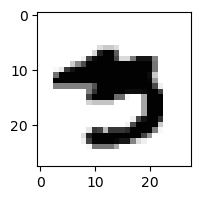

0.008038335114485954% - 0
0.00030404880880176695% - 1
1.9655769245208536e-07% - 2
0.17809535492779247% - 3
0.012293679455996288% - 4
0.950581705812946% - 5 - ОШИБКА
0.0002335810957696438% - 6
0.11986145579598949% - 7
0.02380625843524925% - 8
0.1645967724515143% - 9

 2


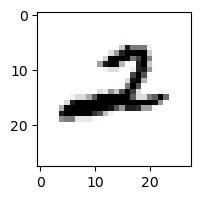

2.3521654874517224% - 0
0.08973199783648557% - 1
61.62903690356008% - 2
0.14390291519463017% - 3
18.02457071146411% - 4
0.0006452849625173425% - 5
0.5303079714241538% - 6
1.8996059593859336% - 7
0.6900157635584006% - 8
77.5701821967995% - 9 - ОШИБКА

 2


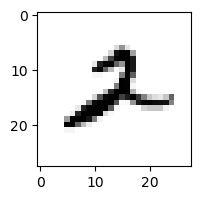

0.23619472602714997% - 0
2.6742596695324203% - 1
43.447874687425944% - 2
0.45056663720040807% - 3
0.759301976223788% - 4
0.023529937826271784% - 5
4.375403967817292% - 6
1.233499246655128% - 7
8.15864999941706% - 8
73.78673181643983% - 9 - ОШИБКА

 1


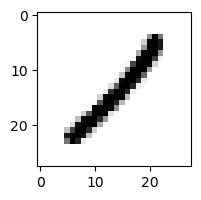

0.1713257488373958% - 0
59.13518407281544% - 1
22.852295349364084% - 2
1.5089165123952828% - 3
5.787201024901516% - 4
0.2513764845207111% - 5
0.13024050554124783% - 6
1.0081051614803735% - 7
71.42043045484132% - 8 - ОШИБКА
0.27620992905012687% - 9

 3


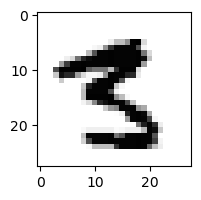

0.012491494658391965% - 0
0.0021433259842917178% - 1
0.0048091130553890304% - 2
0.6695230310116439% - 3
0.007712441109021107% - 4
29.233661780866022% - 5 - ОШИБКА
2.315564422468181e-05% - 6
0.014846737767728492% - 7
0.647788620887379% - 8
0.035461865376564816% - 9

 3


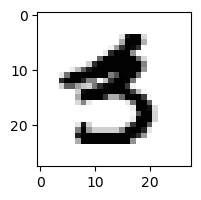

0.06761088572652905% - 0
0.005169162604224871% - 1
2.955404107035222e-05% - 2
1.3360517177566311% - 3
0.011946641318877882% - 4
5.789036743626188% - 5 - ОШИБКА
0.0006033862821134024% - 6
0.0036714938200689672% - 7
0.000763151086276035% - 8
0.15178860803670421% - 9

 8


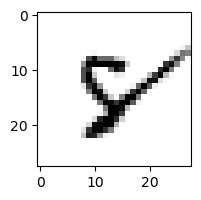

0.19625452960402015% - 0
0.3429716147442947% - 1
1.1519374494193912% - 2
0.0007278906929248101% - 3
6.937323162116728% - 4
23.371297258677178% - 5
25.589705553729818% - 6 - ОШИБКА
13.100992766114366% - 7
3.9831814513151502% - 8
2.511884078448899% - 9

 2


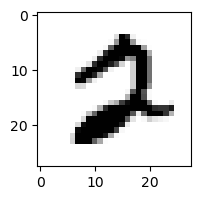

5.579599901684248% - 0 - ОШИБКА
0.0006416425656702591% - 1
4.5719191663391525% - 2
0.001009301536212928% - 3
0.00016519431132759813% - 4
0.3055594317846581% - 5
0.05228266855438589% - 6
3.7316884265933057% - 7
0.0216601840683875% - 8
0.15012626017004727% - 9

 8


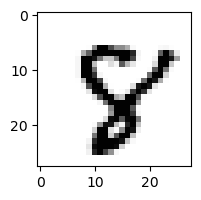

0.0560601704395644% - 0
0.00015332339266510122% - 1
0.017340235191921863% - 2
0.010009856050789348% - 3
0.9864744115571169% - 4
34.385969522623405% - 5 - ОШИБКА
0.056145582342117424% - 6
1.3616778826707565% - 7
18.35925636249929% - 8
0.8849023744280815% - 9

 3


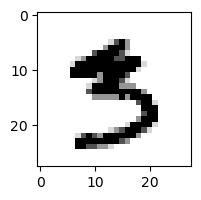

0.018994357274618477% - 0
0.005871679825989238% - 1
7.245745675751136e-05% - 2
15.68339476129238% - 3
0.0024131128327468665% - 4
40.05317698829698% - 5 - ОШИБКА
0.0009142074497449776% - 6
0.21995156578849448% - 7
0.03424512553845968% - 8
0.040246288711686534% - 9

 0


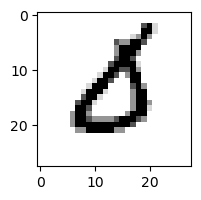

55.52769361507468% - 0
0.0015451959456076378% - 1
7.881665554445079% - 2
14.10730598174236% - 3
0.01986757545398943% - 4
1.502095911982201% - 5
61.72695153553267% - 6 - ОШИБКА
0.048224967911699834% - 7
0.0008808987603500465% - 8
0.037705652122449% - 9

 9


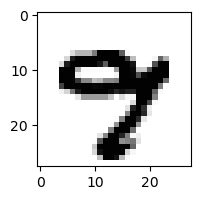

0.015256592296282361% - 0
0.00012037860443876926% - 1
2.7833292388792033e-06% - 2
1.0096765120951778% - 3
0.0744799049205206% - 4
0.002738049093196626% - 5
0.008318644977682844% - 6
12.168880992859291% - 7 - ОШИБКА
0.008537971174947957% - 8
2.550315850850203% - 9

 8


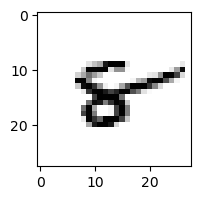

0.4272232019875636% - 0
1.078304025093241% - 1
1.2743347967317993% - 2
0.00033372671276522554% - 3
35.63092499371377% - 4
0.6219104823392008% - 5
91.61461246694982% - 6 - ОШИБКА
0.2635784517020328% - 7
23.596435152764634% - 8
44.39895421620011% - 9

 2


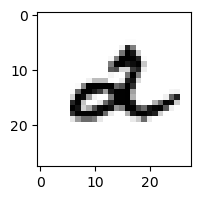

0.27240025047590494% - 0
0.30742460781561265% - 1
3.992240663111466% - 2
0.5335963374448477% - 3
26.94246993180947% - 4 - ОШИБКА
0.003599646230557194% - 5
6.2972657718598555% - 6
0.04769023181937935% - 7
0.034838631573462724% - 8
15.482008320621219% - 9

 9


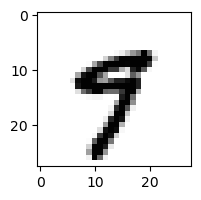

0.04083560335510025% - 0
0.07204362633380246% - 1
4.8616773350494e-05% - 2
0.08085401950147594% - 3
15.356677029061819% - 4 - ОШИБКА
9.245994349220382% - 5
0.02615406814081824% - 6
7.384468901852075% - 7
0.07835859410197213% - 8
14.87637892609287% - 9

 9


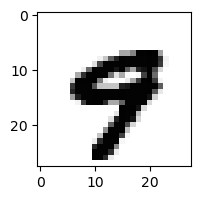

0.09364524997095204% - 0
6.484157460767832e-05% - 1
1.4609521215000757e-06% - 2
0.004849292349664167% - 3
18.41765043940623% - 4 - ОШИБКА
0.09681869665461246% - 5
0.00647445365162478% - 6
1.858015975394327% - 7
0.00046139940570612286% - 8
3.3502804681885796% - 9

 8


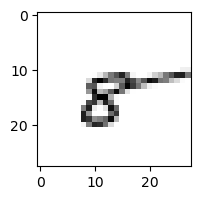

2.0236076083978776% - 0
21.19797691244848% - 1
6.4938048265270405% - 2
1.047319523498638% - 3
51.130184919633535% - 4
1.8014305710454666% - 5
84.71814237912004% - 6 - ОШИБКА
0.24546049560427782% - 7
83.67455525072432% - 8
45.16315528163264% - 9

 8


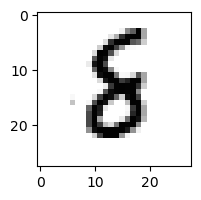

0.02642960486333438% - 0
0.04086569344946255% - 1
0.9498102935877129% - 2
0.6734600009361648% - 3
0.06331445415563865% - 4
0.5796054205069363% - 5
78.45055935405406% - 6 - ОШИБКА
0.004994382318479548% - 7
45.05802972688248% - 8
0.042644651426291126% - 9

 9


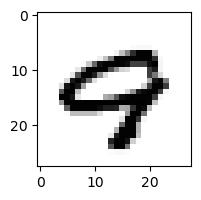

2.9502303594330965% - 0
0.0021641150922398636% - 1
0.0004649930526792898% - 2
0.0001298349293560353% - 3
11.907848770124843% - 4 - ОШИБКА
0.0019492970346339452% - 5
0.0500582846409249% - 6
10.24380874860104% - 7
0.01223133397878623% - 8
1.2751637756066865% - 9

 5


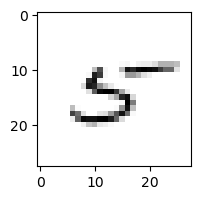

8.866609433143283% - 0
1.3918354065456389% - 1
19.472526284600814% - 2
1.4677089452923773% - 3
72.14670700910636% - 4 - ОШИБКА
12.964635575125488% - 5
12.675344689360182% - 6
5.953483151643987% - 7
57.66119614315875% - 8
15.714559990686155% - 9

 8


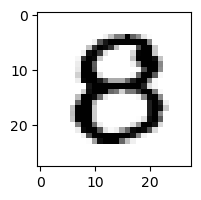

46.326692776882375% - 0 - ОШИБКА
2.2550127919023324e-05% - 1
0.2307652086566892% - 2
0.06072504241081163% - 3
0.44798034446983753% - 4
5.089150565679183% - 5
0.004581959257451108% - 6
0.00022222446299559684% - 7
3.843225923586456% - 8
0.0009405928503313018% - 9

 8


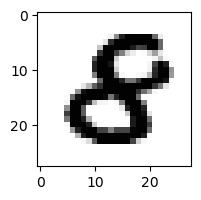

0.4647136090216849% - 0 - ОШИБКА
2.6474126109733402e-05% - 1
0.01773345323797212% - 2
0.027910597998903993% - 3
0.0635361402424218% - 4
0.34047370313855085% - 5
0.00592737193267002% - 6
1.9778651049514816e-06% - 7
0.07960102271453948% - 8
0.00019707090260645503% - 9

 8


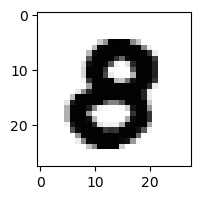

0.8937765138286548% - 0 - ОШИБКА
7.915324467305166e-08% - 1
0.007733949847047456% - 2
0.030865772400580978% - 3
0.0040234847814883045% - 4
0.061156297715225176% - 5
2.4474815747808895e-05% - 6
2.927023991526313e-05% - 7
0.2344291986814515% - 8
0.00262410048944453% - 9

 4


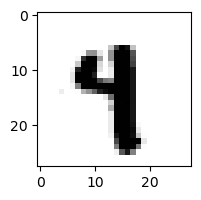

8.817318150565587e-05% - 0
0.3835849169448991% - 1
0.00016658989658714643% - 2
0.08272279974141813% - 3
1.9411788481249348% - 4
1.4088923808891851% - 5
0.053665648704426985% - 6
0.37268523240653806% - 7
0.03461571491674739% - 8
11.857650691220122% - 9 - ОШИБКА

 8


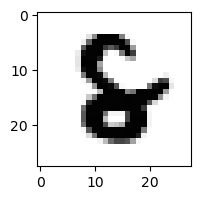

0.005968708113384897% - 0
3.653428642767374e-05% - 1
0.681402445253742% - 2
0.000971250499777295% - 3
0.09327815744717617% - 4
0.07719030641539436% - 5
33.42644167713249% - 6 - ОШИБКА
0.00016561438198937588% - 7
6.795210358706025% - 8
6.654214779113906e-05% - 9

 9


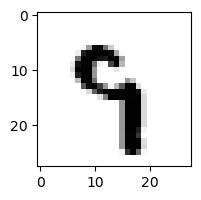

0.0020248134294963993% - 0
0.010201681376867427% - 1
0.11746118586688065% - 2
0.7581358916968041% - 3
22.670343662200036% - 4 - ОШИБКА
21.89977681141868% - 5
2.7731595799770328% - 6
1.926929574359745% - 7
1.8916842071001891% - 8
7.991670383426519% - 9

 8


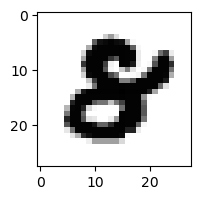

0.1140339933070078% - 0 - ОШИБКА
3.060820989852017e-07% - 1
0.02991733546592973% - 2
0.0074251147557731784% - 3
0.0022901633573944925% - 4
0.06835891924162202% - 5
0.003055129007760282% - 6
3.4438162526295764e-05% - 7
0.02701867099994348% - 8
0.0015670832929968969% - 9

 5


2.5696690665502726% - 0
0.0072387555773951095% - 1
0.44258612976724226% - 2
6.24560471186824% - 3 - ОШИБКА
0.0016557850699474206% - 4
5.271547297689382% - 5
0.0011399861911473238% - 6
1.6028384401273101% - 7
0.041023176521978455% - 8
0.2935949075550318% - 9

 2


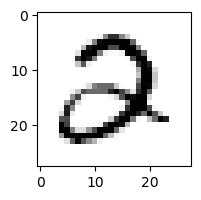

5.603444467800686% - 0
0.000565010782679203% - 1
53.87494737807184% - 2
84.69590678776484% - 3 - ОШИБКА
0.10351540834757096% - 4
0.14039017653616437% - 5
0.03799328073091317% - 6
0.13328341025888066% - 7
0.005258330469837142% - 8
0.01288859227899613% - 9

 8


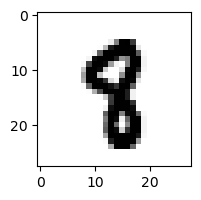

0.00036709156324540187% - 0
0.045960441888955664% - 1
0.0131397369565593% - 2
0.042166072385968235% - 3
1.328265685400591% - 4 - ОШИБКА
1.0200925273144514% - 5
0.01198494453429416% - 6
0.06798062525809148% - 7
1.262073560903455% - 8
0.39149900522445336% - 9

 3


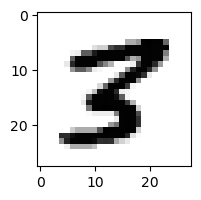

0.004552356248137373% - 0
0.008266809788947579% - 1
0.10469145074684776% - 2
0.4715434194324706% - 3
0.03881044919514973% - 4
2.0586241288285243% - 5
0.00010418469053773141% - 6
0.024632732179918848% - 7
2.4625448920111954% - 8 - ОШИБКА
0.0036682504979898695% - 9

 7


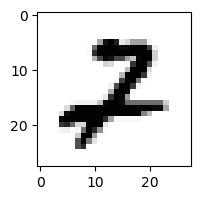

0.1862551731695317% - 0
0.059551979288570846% - 1
93.78593963698538% - 2 - ОШИБКА
0.32197453738659426% - 3
0.004845242782624261% - 4
0.0013619752296981976% - 5
0.0038031285720319477% - 6
0.12294058007370236% - 7
0.40231131066740056% - 8
0.08983180424906899% - 9

 2


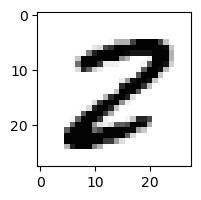

0.3413469626304865% - 0
0.0013308334319795355% - 1
5.240797617771015% - 2
0.017889590295594327% - 3
0.00035653397424951263% - 4
1.1344184955266312% - 5
0.002585001254697264% - 6
0.0336344024618839% - 7
95.22351105734538% - 8 - ОШИБКА
0.001481975455459982% - 9

 5


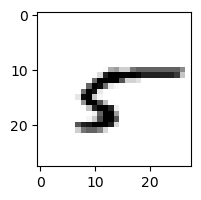

16.51742856145145% - 0
6.408880271908149% - 1
1.4999013771839316% - 2
0.6792916607150913% - 3
10.501799265557441% - 4
1.3273900615868919% - 5
55.0881804472913% - 6 - ОШИБКА
0.7753560426622887% - 7
34.35669574116757% - 8
6.282225047927588% - 9

 7


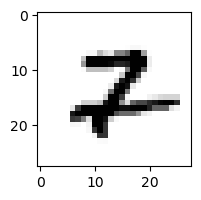

0.0922227584582624% - 0
0.45090566872804216% - 1
26.891329901710304% - 2 - ОШИБКА
0.003925392659525427% - 3
0.052445828238188934% - 4
0.006943973683843289% - 5
0.35934266714198515% - 6
11.427767824270724% - 7
0.8845251462159868% - 8
0.6173138947894673% - 9

 1


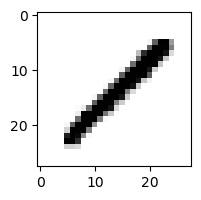

0.17815256726373435% - 0
23.163971464896097% - 1
22.02553713277425% - 2
2.038231587321691% - 3
9.321470146882884% - 4
0.2758100329078709% - 5
0.022362010395843474% - 6
0.367138415270732% - 7
95.39793588307356% - 8 - ОШИБКА
0.5671039377851015% - 9

 7


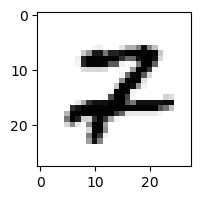

0.22361730402726118% - 0
0.012801316953409893% - 1
41.83690183694887% - 2 - ОШИБКА
0.0023931671302737456% - 3
0.0656237449235641% - 4
0.006242858924586569% - 5
0.02260160067887087% - 6
8.24699635439872% - 7
4.1131965164579505% - 8
0.627039241262265% - 9

 7


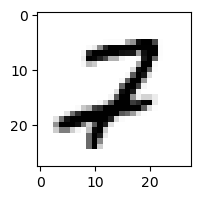

0.5618095916591727% - 0
0.014516122765299197% - 1
85.21238310299911% - 2 - ОШИБКА
0.11518768013973382% - 3
0.12594870815902232% - 4
0.04811947532323008% - 5
0.042468904964795474% - 6
2.6528189457340265% - 7
18.191641917683647% - 8
0.14099311932381278% - 9

 9


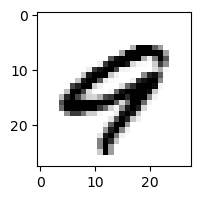

2.0012489039511925% - 0
0.0005579152316681045% - 1
0.0007358657968481935% - 2
0.0001393184821176332% - 3
38.92545818083866% - 4 - ОШИБКА
0.015266011004527085% - 5
0.16325015519609767% - 6
0.6121824779871718% - 7
0.008843812248111524% - 8
9.553625285745243% - 9

 7


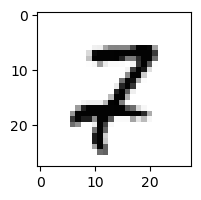

0.4953965652895101% - 0
0.14691027162281145% - 1
59.552624087319586% - 2 - ОШИБКА
0.05597257293115728% - 3
0.04374278257744697% - 4
0.02300006625676947% - 5
0.04673801551824791% - 6
3.6099305569140565% - 7
35.28262012291684% - 8
3.819517621691812% - 9

 7


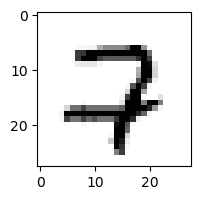

6.198105228265603% - 0
0.0005512696461644876% - 1
56.886016631022926% - 2 - ОШИБКА
0.13951319150951444% - 3
0.05601609391262489% - 4
0.0054661212960310885% - 5
0.15518165157965863% - 6
30.268602916252398% - 7
0.5602806850750216% - 8
1.6022036913008144% - 9

 2


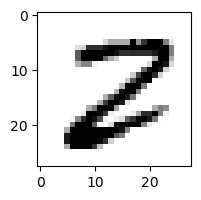

0.26826173456595814% - 0
0.000995068963873359% - 1
31.476110434692746% - 2
0.48373992079402145% - 3
0.0005187898158010024% - 4
0.6023452746295348% - 5
0.013079283979603408% - 6
0.02292464961345957% - 7
63.550185409021964% - 8 - ОШИБКА
0.0001817081982845704% - 9

 8


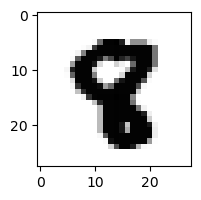

3.3786612189781925e-05% - 0
0.0001482930326517582% - 1
0.005345127604466763% - 2
0.0009367658547230846% - 3
0.2101787174855991% - 4 - ОШИБКА
0.09909654488328501% - 5
0.0002098791132211471% - 6
0.0008955915747777951% - 7
0.027011488534783336% - 8
0.01667466553232623% - 9

 8


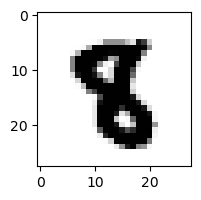

5.301868915817117e-06% - 0
0.004404409097808364% - 1
0.0038165634531373326% - 2
0.0022926547811976394% - 3
0.016248490959645697% - 4
0.7844802436973953% - 5 - ОШИБКА
0.005779299926227434% - 6
0.001126158926671639% - 7
0.015921496236890997% - 8
0.0022897436187313868% - 9

 8


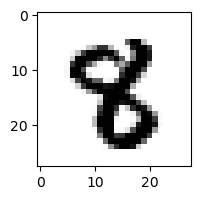

8.764012838629021e-05% - 0
0.01650962582675473% - 1
0.007567654338804338% - 2
0.0186305703635594% - 3
0.5196494679414709% - 4
0.5536074176639361% - 5 - ОШИБКА
0.0008445567164467716% - 6
0.03517932141248322% - 7
0.2000072244798464% - 8
0.0020852654615640866% - 9

 8


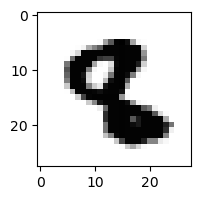

2.4458912228976587e-05% - 0
0.007435019430632024% - 1
0.3062094315337366% - 2
0.01859085954810242% - 3
0.0017083639257522252% - 4
0.48068772162273055% - 5 - ОШИБКА
0.0013566149859561298% - 6
0.0001588175800672387% - 7
3.8574054604544736e-05% - 8
0.0045427786120761145% - 9

 8


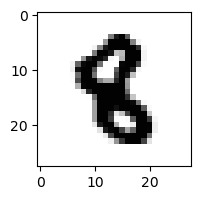

0.00011774613781139102% - 0
0.025464821899647525% - 1
0.04435635464489962% - 2
0.004223422326814099% - 3
0.10974884257634983% - 4
1.0305957261454728% - 5 - ОШИБКА
0.07269473585149062% - 6
0.00027778232049235403% - 7
0.05472238100158108% - 8
0.009136228044969765% - 9

 8


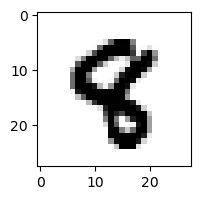

0.00022951240263736555% - 0
0.006474120696128733% - 1
0.008561112643196178% - 2
0.007545270852954971% - 3
2.0298778486221645% - 4 - ОШИБКА
0.27006442960453736% - 5
0.0008150994464417979% - 6
0.004586593135778311% - 7
0.04593461284836515% - 8
0.20437004655990887% - 9

 8


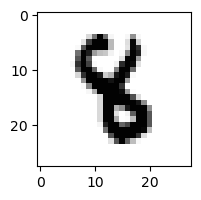

2.0689738629726712e-05% - 0
0.09291045464007038% - 1
0.01982852369760293% - 2
0.29288657477264934% - 3
1.2089030982480868% - 4
2.538396886646856% - 5 - ОШИБКА
0.27719995192809294% - 6
0.0047837934936624% - 7
0.014650934819707868% - 8
0.000567191568018403% - 9

 7


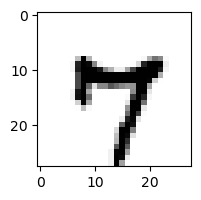

0.8781459861671089% - 0
0.004788629487892101% - 1
2.403495538792997e-05% - 2
0.29277633765646516% - 3
53.33500884342533% - 4 - ОШИБКА
0.5529325138233455% - 5
0.19365026239313235% - 6
27.191218492715503% - 7
3.363584009882662% - 8
21.223781253135698% - 9

 8


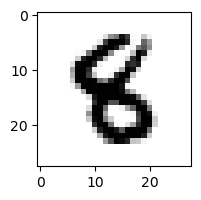

0.0020524243850473935% - 0
0.006954409188669997% - 1
0.008249097267460296% - 2
0.026999979544066237% - 3
0.44119570078028486% - 4
4.151458618132707% - 5 - ОШИБКА
0.23443138935840824% - 6
0.00022549942329478038% - 7
0.29608324766065275% - 8
0.0006457083531102515% - 9

 8


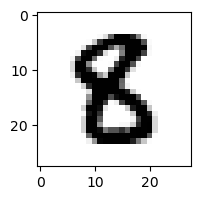

0.02613733118411251% - 0
0.0008256053761910914% - 1
0.025088758330999893% - 2
0.08577258500937729% - 3
0.004431164156706903% - 4
8.166892474970467% - 5 - ОШИБКА
0.02073978432931305% - 6
2.7752983805425148e-05% - 7
0.6849572385740534% - 8
7.669148478505483e-05% - 9

 2


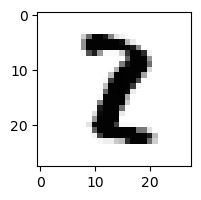

0.0002837940189511853% - 0
12.632183592779084% - 1 - ОШИБКА
7.5754270170398765% - 2
2.016836755723359% - 3
0.030368056322673007% - 4
0.0061960625552901355% - 5
0.002520948255802525% - 6
0.02653497138332957% - 7
0.558250787333908% - 8
0.002481762537892308% - 9

 8


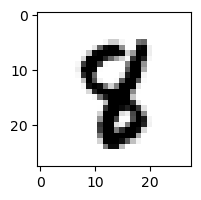

0.0003954011447650366% - 0
0.010957623144919559% - 1
0.025968769314979583% - 2
0.020424739148749493% - 3
1.7057568920031771% - 4 - ОШИБКА
1.1101667550840906% - 5
0.015818350279055284% - 6
0.10090449799059861% - 7
1.595729273412845% - 8
0.0361819432672768% - 9

 4


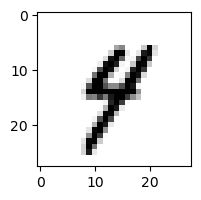

0.052219413193733175% - 0
2.3911194230773836% - 1
0.028585419485503336% - 2
0.8417985633018573% - 3
21.54703089332666% - 4
5.858803019490601% - 5
0.4251336346626965% - 6
1.1342050462693338% - 7
3.673723839780014% - 8
26.2309024369331% - 9 - ОШИБКА

 9


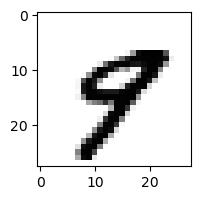

0.09792379327623088% - 0
0.015300216404558989% - 1
0.002104937077930312% - 2
0.009049233674043058% - 3
43.17839988005256% - 4 - ОШИБКА
2.7593306984452943% - 5
0.007518441521046755% - 6
8.76264967916089% - 7
0.20020934843626897% - 8
1.4197109384035538% - 9

 5


1.431561860669145% - 0
1.9353443616127972% - 1
1.34016134717168% - 2
0.1492026049589261% - 3
0.9499514280549454% - 4
25.623253574299515% - 5
1.4307472679654785% - 6
1.5425251765846602% - 7
27.90544617462881% - 8 - ОШИБКА
0.10751344154780683% - 9

 9


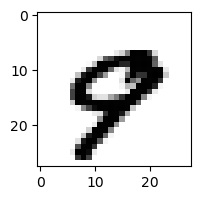

0.9998025490409386% - 0
0.004311655489625698% - 1
0.0013054893498286788% - 2
1.4077630111638557e-05% - 3
7.553481081499013% - 4
0.0009644813746224602% - 5
0.008455129315584209% - 6
57.697776882716% - 7 - ОШИБКА
0.008731003710808333% - 8
29.108645601301568% - 9

 9


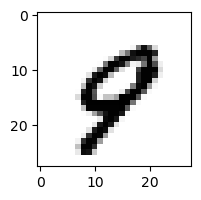

1.5360761897833701% - 0
0.03631760038076347% - 1
0.03831010636750891% - 2
0.0005546744932719215% - 3
19.176557168769207% - 4 - ОШИБКА
0.09468592825044177% - 5
0.12661106568570216% - 6
12.871014754657265% - 7
0.19996673337776566% - 8
17.898086233225296% - 9

 8


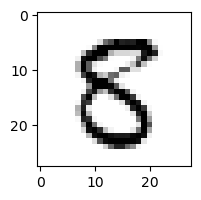

3.810939758863894% - 0
0.0016190340787132992% - 1
0.08417574369908024% - 2
1.5422704530366882% - 3
1.2697549172047906% - 4
81.07415072594259% - 5 - ОШИБКА
0.003826373296409441% - 6
0.0037786713209822954% - 7
40.440394452339504% - 8
0.0007721800034077732% - 9

 8


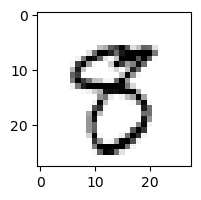

0.4373090035881334% - 0
0.07997650194045768% - 1
0.023763464185182184% - 2
11.873767728787584% - 3
0.0686789231401517% - 4
7.607421325260027% - 5
0.007413881934961035% - 6
0.741976921034806% - 7
3.0494830932299655% - 8
25.241917356765637% - 9 - ОШИБКА

 8


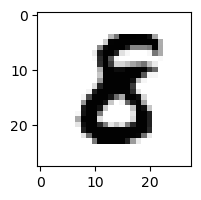

0.03134653119668154% - 0
0.004071877695684846% - 1
0.0956915661565125% - 2
0.8211699226982206% - 3 - ОШИБКА
0.0034630929829495617% - 4
0.14909310330318762% - 5
0.05453727980115444% - 6
2.8684638121890725e-05% - 7
0.5928184336349814% - 8
6.899835772956708e-05% - 9

 5


0.35952343267344805% - 0
0.0011329819153720248% - 1
0.16354079846934072% - 2
48.18324547103352% - 3 - ОШИБКА
0.0068561967141293% - 4
45.15421996915653% - 5
0.1193525036046951% - 6
0.05157628039800354% - 7
0.560151344784309% - 8
0.04677324206376664% - 9

 5


1.5670723321543563% - 0
0.0036748440539323473% - 1
0.08167198012900007% - 2
31.560379872044113% - 3 - ОШИБКА
0.0006327485822839475% - 4
27.34535855425428% - 5
0.11518115374061356% - 6
0.0018019802243619304% - 7
0.00144695816109288% - 8
0.0010027757411411864% - 9

 8


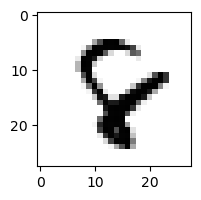

0.029934454563906907% - 0
0.0057592157421321585% - 1
0.6000608963848091% - 2
0.0017646454991981917% - 3
16.847337615916448% - 4 - ОШИБКА
0.360184099263751% - 5
7.180100951853355% - 6
1.0845893011775662% - 7
5.133738691124199% - 8
0.06812002122256602% - 9

 2


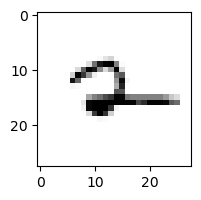

0.1304004058750535% - 0
27.449564735636645% - 1
1.1393696333666912% - 2
0.020804241498010686% - 3
42.81769290038582% - 4
0.8221265443640975% - 5
66.63777433919881% - 6 - ОШИБКА
6.38067007359806% - 7
34.45767301348641% - 8
63.85047262599544% - 9

 2


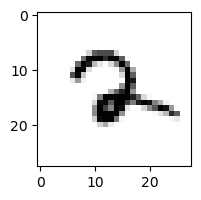

0.0016510578035477759% - 0
6.721848252351002% - 1
27.23239898370974% - 2
0.034516558644953656% - 3
10.489690388452997% - 4
0.16817490867604815% - 5
14.233253711163227% - 6
60.31688360873058% - 7 - ОШИБКА
3.9798648788092965% - 8
12.047200869574889% - 9

 5


1.3407324483781387% - 0
0.5075701823177035% - 1
5.976864078686382% - 2
51.75863185098558% - 3 - ОШИБКА
0.0003212799758462211% - 4
43.30538135732533% - 5
0.27108463788491405% - 6
0.04589743603844787% - 7
0.020166364088524208% - 8
0.004153236894766891% - 9

 5


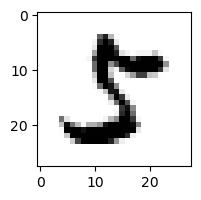

2.1216563011676093% - 0
0.010934985924876283% - 1
0.18085837078949546% - 2
26.01054608687805% - 3 - ОШИБКА
0.00099479158812493% - 4
13.37192606073036% - 5
0.0001976998189547855% - 6
1.4783465663541722% - 7
2.577457846876368% - 8
0.0013975286835798972% - 9

 5


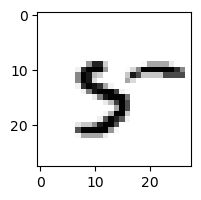

1.012386089497165% - 0
0.516510294189667% - 1
0.7738269628239253% - 2
0.0206276781157146% - 3
52.51912409552185% - 4
47.412002235137216% - 5
15.783420363847842% - 6
1.2923992490347658% - 7
64.73519570193088% - 8 - ОШИБКА
7.002472793499738% - 9

 7


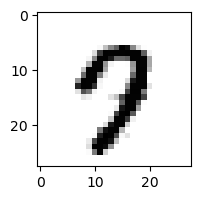

3.5259584899942418% - 0
0.00022239378001943295% - 1
0.007635126115987238% - 2
0.18090971397066163% - 3
2.0320238732248503% - 4
2.896646542298002% - 5
0.021085713609715524% - 6
43.05548885860862% - 7
0.3709758755207281% - 8
72.46943613137397% - 9 - ОШИБКА

 9


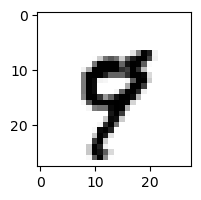

0.026489392382347588% - 0
0.12094100184404037% - 1
0.00479771945766205% - 2
0.002767569734783883% - 3
18.836968266526725% - 4
0.4576728987722847% - 5
0.055048484806758564% - 6
38.373012738831996% - 7 - ОШИБКА
0.02707741289314807% - 8
4.995598381118689% - 9

 7


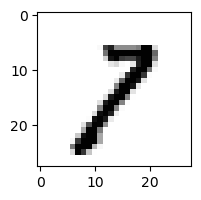

0.4564692807135235% - 0
20.754470420729625% - 1
6.218109140123496% - 2
12.398515435176144% - 3
0.06750118705740935% - 4
0.11950326236361787% - 5
0.013513573367804024% - 6
12.216096813809573% - 7
16.317328142185364% - 8
28.53478189787918% - 9 - ОШИБКА

 8


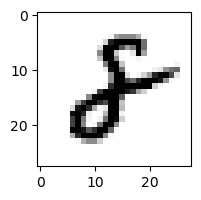

0.12371540177562686% - 0
5.173491320927157% - 1
29.6516360533226% - 2 - ОШИБКА
0.05832678454579513% - 3
0.009085020779027082% - 4
0.01093452866530017% - 5
0.32058697286647814% - 6
0.001247490032920322% - 7
1.944428006849728% - 8
0.2118973593180308% - 9

 9


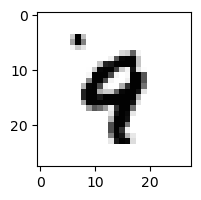

0.010055230209578228% - 0
0.08170659263048206% - 1
0.032179316079501495% - 2
0.017371414716550602% - 3
85.39552463707243% - 4 - ОШИБКА
0.3101815717576638% - 5
3.172805617961464% - 6
0.6747966060918411% - 7
0.044271189002895374% - 8
10.837867417796092% - 9

 2


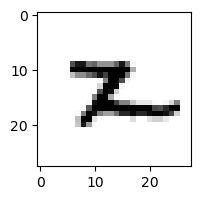

0.029249658715891826% - 0
3.0826019036684067% - 1
1.6793453672562957% - 2
0.027894652994944275% - 3
0.7972362501267131% - 4
7.912507837508242% - 5
20.826018505208335% - 6
0.22996683776471835% - 7
44.498700494897044% - 8 - ОШИБКА
1.6442774894546617% - 9

 1


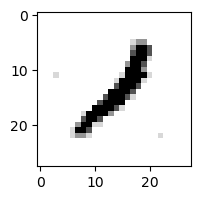

0.1102542167552582% - 0
54.86987429628867% - 1
40.4544626060704% - 2
0.9205860236641679% - 3
9.713921379094675% - 4
0.01820880572178791% - 5
0.25662716910573147% - 6
1.7712826888885873% - 7
75.06118042884864% - 8 - ОШИБКА
5.099162420115272% - 9

 3


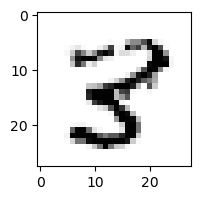

0.030815845717510306% - 0
0.03813555550778856% - 1
0.34825043483332085% - 2
2.9456505667525272% - 3
10.661238445474492% - 4
5.872480027985535% - 5
0.0035736950264232724% - 6
0.0285669963495277% - 7
86.18522494322846% - 8 - ОШИБКА
0.015939275325810635% - 9

 0


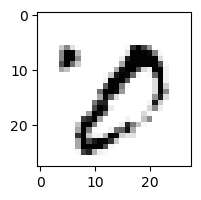

6.25646527778286% - 0
3.4748466026071214% - 1
0.05378185513030022% - 2
68.45741164808618% - 3 - ОШИБКА
0.024604255233351923% - 4
0.04173855522425009% - 5
0.005036234250932738% - 6
1.3458441980653812% - 7
31.457069176000484% - 8
0.00904479397458084% - 9

 1


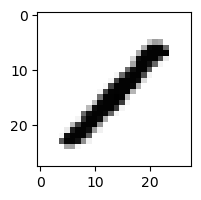

0.054627342569985526% - 0
48.69837665975392% - 1
14.509596333032498% - 2
1.1326212448819892% - 3
5.776856895842276% - 4
0.24746544768762113% - 5
0.031655829339359814% - 6
0.3209726772140799% - 7
85.64349245594067% - 8 - ОШИБКА
0.18498682246071216% - 9

 3


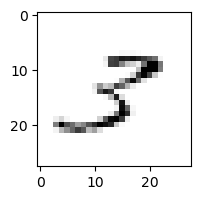

7.398673916113493% - 0
7.006218503515174% - 1
58.383059310510696% - 2 - ОШИБКА
24.3899314125821% - 3
1.6718032205496391% - 4
3.548916272474218% - 5
0.6160541577397365% - 6
19.162040456156937% - 7
23.923007254356012% - 8
19.309710525172008% - 9

 2


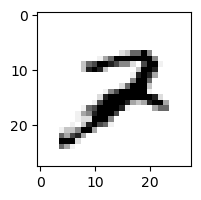

0.11056572689203577% - 0
0.43468818747217797% - 1
10.414779220607532% - 2
0.0046960285509016104% - 3
0.5804604894141658% - 4
0.010111615776045071% - 5
0.36896533257297387% - 6
30.404735538539462% - 7 - ОШИБКА
6.462283945019428% - 8
6.902212027443206% - 9

 6


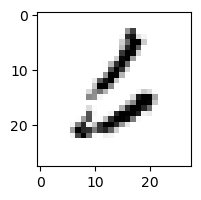

15.663125297053604% - 0
0.26684809922518304% - 1
6.7317237585458765% - 2
55.953824614046354% - 3 - ОШИБКА
0.09002203445651352% - 4
37.504250154099104% - 5
55.48420818652683% - 6
1.1521134603029308% - 7
0.02209248355265586% - 8
0.07499593902803131% - 9

 3


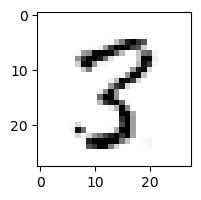

0.35878224176490836% - 0
0.38810667242599906% - 1
1.9732023836966854% - 2
37.61714030264806% - 3
0.6158595953874805% - 4
5.8874810287989074% - 5
0.00640047086660033% - 6
1.3526402889790412% - 7
92.44426564900716% - 8 - ОШИБКА
0.16797490178827715% - 9

 2


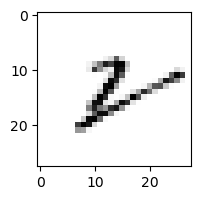

1.9616547177509425% - 0
26.689230942988907% - 1
15.479589381116146% - 2
0.38897947860880194% - 3
1.8572491417888088% - 4
1.5368865978127586% - 5
50.667172114372924% - 6
1.5290720553072967% - 7
64.54761205051106% - 8 - ОШИБКА
18.478276199721403% - 9

 8


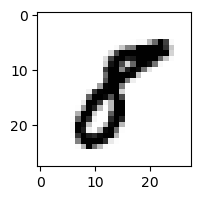

0.5641276263696199% - 0
2.6621596000536254% - 1
0.08424754789923646% - 2
1.3876939978249787% - 3
0.04078815119691428% - 4
15.758042688970281% - 5 - ОШИБКА
0.0007456483586489336% - 6
0.044567285756066645% - 7
0.7278113569790786% - 8
0.03187826449214781% - 9

 2


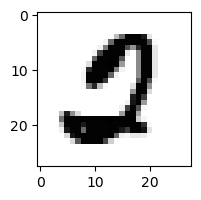

40.188110442070375% - 0 - ОШИБКА
3.812905540300237e-05% - 1
0.8282322074045213% - 2
0.176649209035656% - 3
3.299753725943141e-05% - 4
34.56280791823926% - 5
0.017463038643246616% - 6
0.11129763084255494% - 7
0.050876336201366876% - 8
0.00023542683219837041% - 9

 5


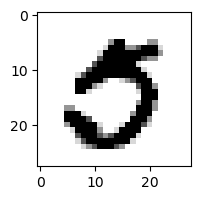

45.82105762045016% - 0 - ОШИБКА
0.00021710179348034266% - 1
0.0003180433222520125% - 2
3.929870893345163% - 3
6.65519386744137e-05% - 4
11.216280604449341% - 5
4.047620798165377e-05% - 6
0.7459375455345952% - 7
0.0008477621717073797% - 8
0.002889560031858434% - 9

 2


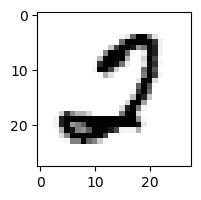

58.70231677226144% - 0 - ОШИБКА
0.003976132827258486% - 1
51.3706322392255% - 2
2.428077618903292% - 3
0.00016489453126335263% - 4
9.26922692536155% - 5
0.615111657776966% - 6
1.3329939747793322% - 7
0.051489007239567015% - 8
0.009565088973391872% - 9

 5


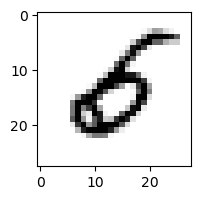

13.06498057731754% - 0
0.17149960376004572% - 1
1.3463710852028208% - 2
1.0335985468151143% - 3
0.6180057630786653% - 4
1.7985878612976003% - 5
60.43079350905196% - 6 - ОШИБКА
0.016097250641269982% - 7
0.004201955679649753% - 8
0.1624102897005639% - 9

 8


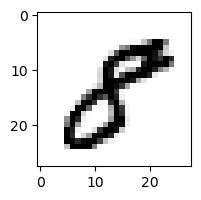

0.8289924566353113% - 0
0.20560158114203533% - 1
0.06429591117113403% - 2
2.615905857240736% - 3
0.3005093671374015% - 4
10.72835798444189% - 5 - ОШИБКА
0.0012807167491544807% - 6
0.030483009492951133% - 7
0.7660618140612809% - 8
0.2730625601918365% - 9

 9


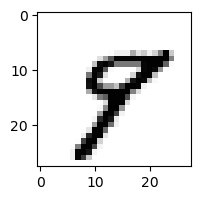

0.07885055347027929% - 0
0.29830502088556987% - 1
0.034493845716821805% - 2
0.0172032795735815% - 3
8.792575128569023% - 4
6.478936725499278% - 5
0.03371742616055451% - 6
6.9948376116687445% - 7
42.13219114904592% - 8 - ОШИБКА
7.104781801039987% - 9

 4


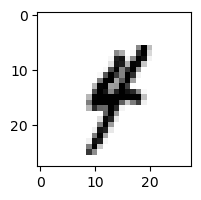

0.007690453141363884% - 0
20.308334489088345% - 1 - ОШИБКА
0.10452860612882972% - 2
5.91961633002853% - 3
19.931514997633336% - 4
0.7255896609424002% - 5
0.7285334204359919% - 6
1.0422563818380257% - 7
1.4807132698780794% - 8
4.909690960318869% - 9

 4


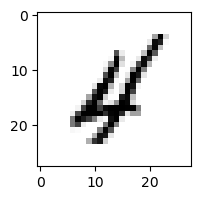

0.4880863424816184% - 0
0.25523910755857493% - 1
7.342081489743152% - 2
0.037778080927446854% - 3
29.685636540163436% - 4
0.46699747443369477% - 5
9.349137112711608% - 6
0.6039610316097801% - 7
34.725880677138626% - 8 - ОШИБКА
1.0286597843353422% - 9

 9


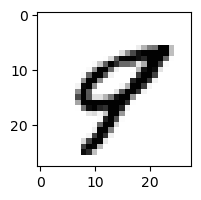

0.8219400495439341% - 0
0.04393042504142822% - 1
0.019271143896740728% - 2
0.00026417864920668624% - 3
50.95415057042234% - 4 - ОШИБКА
0.62516535094781% - 5
0.033885684835243415% - 6
9.50239857173935% - 7
2.4309484373088166% - 8
8.960190279273961% - 9

 9


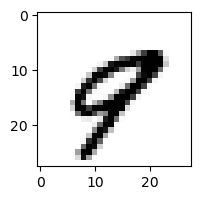

1.0129798274759498% - 0
0.08132826055466204% - 1
0.019513765327285423% - 2
0.0003794776533690559% - 3
29.925480565361447% - 4 - ОШИБКА
0.015486675786494522% - 5
0.033587193901761646% - 6
26.888848927327835% - 7
2.1431583997069144% - 8
1.8774441823836057% - 9

 8


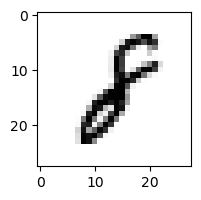

0.04419895792877885% - 0
58.731231204634284% - 1 - ОШИБКА
13.09562730914901% - 2
0.3482580028674387% - 3
0.1023984126939878% - 4
0.0769780446017228% - 5
1.4499982291102589% - 6
0.10560964190394063% - 7
16.36925699948242% - 8
1.165110806706178% - 9

 4


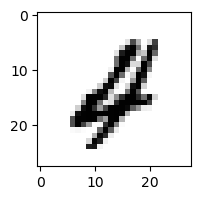

0.7206745081841934% - 0
0.05545322215720542% - 1
9.590316504038402% - 2 - ОШИБКА
0.06944274511614962% - 3
0.7814793383653379% - 4
0.022194602627383167% - 5
0.48955135582060194% - 6
0.1871165463619779% - 7
0.28951354816447844% - 8
0.4299731838334212% - 9

 5


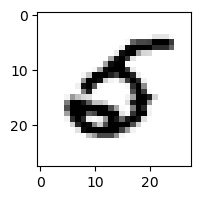

3.4222053020129906% - 0
0.007400104462942784% - 1
0.18626978874706515% - 2
0.001617830971356464% - 3
0.2949183747273455% - 4
0.6632802943571064% - 5
11.388635979593827% - 6 - ОШИБКА
0.074054739461612% - 7
0.00010679347721027365% - 8
0.010696274237668136% - 9

 2


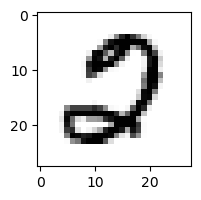

46.26735574434097% - 0 - ОШИБКА
0.0002863037924943115% - 1
35.77237125642136% - 2
0.008130107074379209% - 3
0.0005793118585221826% - 4
0.04990602159652464% - 5
0.2177025729639517% - 6
0.4013312302735556% - 7
1.9417340115295783% - 8
0.0024967467336510507% - 9

 2


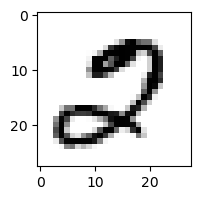

47.5813839455376% - 0 - ОШИБКА
0.0020032035806554537% - 1
8.982814769154436% - 2
0.026638351837615308% - 3
0.0011677056409188655% - 4
0.1309456781762672% - 5
0.14191651412761488% - 6
5.576274084528925% - 7
0.3554702327506904% - 8
0.1308510900358184% - 9

 8


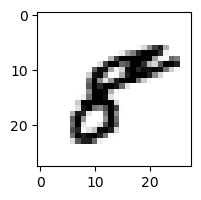

5.228826581347303% - 0 - ОШИБКА
0.12566912334855598% - 1
0.13742833632202173% - 2
0.05153849601861549% - 3
1.7832305510375297% - 4
4.050853458207065% - 5
0.0028219477998653493% - 6
0.13181316837116627% - 7
3.5499678211563546% - 8
1.490874317204669% - 9

 4


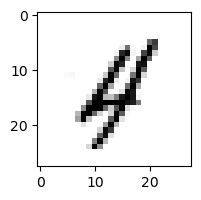

0.4615765672184601% - 0
0.6108955102880395% - 1
3.3561463497470108% - 2
0.6213396323616508% - 3
11.66809085845723% - 4
0.28251654772752943% - 5
3.317944407191606% - 6
1.292849726333857% - 7
39.63461363158557% - 8 - ОШИБКА
9.334496970131589% - 9

 9


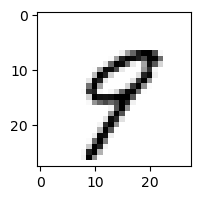

0.4998956696672982% - 0
0.288199907177359% - 1
0.14376399730052533% - 2
0.5248069768960109% - 3
34.376671560498366% - 4 - ОШИБКА
6.308854110235007% - 5
0.23201981323646342% - 6
25.146149967652704% - 7
2.428832897912558% - 8
13.596170481564961% - 9

 2


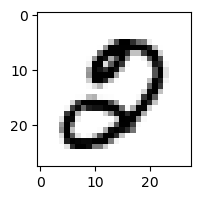

16.499521990764958% - 0 - ОШИБКА
0.0008013010093731011% - 1
0.10359574657866043% - 2
0.08909014213806643% - 3
0.014696351011510983% - 4
0.18848615868636243% - 5
0.16190594704470332% - 6
0.33155405751559297% - 7
0.7396275439758877% - 8
0.02149015480883761% - 9

 5


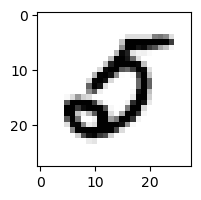

65.99903571211654% - 0 - ОШИБКА
0.002454949082976763% - 1
1.5802719658918818% - 2
0.017262712973465766% - 3
0.054635231883119535% - 4
0.4108642939748073% - 5
2.451195824570238% - 6
0.12979434269480097% - 7
0.0014931326057265565% - 8
0.01906674043094528% - 9

 5


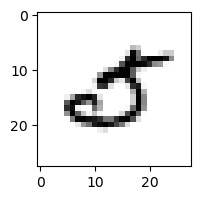

36.45717573319847% - 0 - ОШИБКА
0.07369625986168421% - 1
2.237592320062554% - 2
14.789265502634228% - 3
2.299004301762903% - 4
4.043386042803674% - 5
1.3822948317293071% - 6
3.8670810591618436% - 7
0.04074502505637903% - 8
0.055383813576196275% - 9

 2


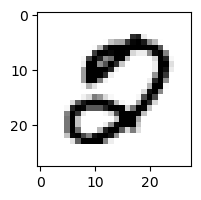

22.034020676161266% - 0 - ОШИБКА
0.0001612792782580683% - 1
0.5594347909127234% - 2
0.001090873777698034% - 3
0.019267469288732755% - 4
1.9453440392005872% - 5
0.44328439726794716% - 6
0.050618656748358276% - 7
1.0635783357474218% - 8
0.012331181833685008% - 9

 8


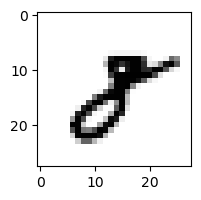

0.16775999646828318% - 0
7.607094576879475% - 1 - ОШИБКА
4.771808789753882% - 2
1.5110292976352733% - 3
0.051049844423481025% - 4
0.03695418064627285% - 5
0.005791140497221701% - 6
1.334198703951928% - 7
4.41410121445113% - 8
1.2898419243687964% - 9

 2


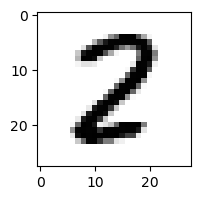

0.09218614321858401% - 0
0.13287597088563619% - 1
38.59150229621234% - 2
0.5235094584915994% - 3
0.007286352838970974% - 4
0.04713407939677597% - 5
0.013639817053069098% - 6
0.01325181114790559% - 7
60.323511754886496% - 8 - ОШИБКА
3.555247360157516e-05% - 9

 9


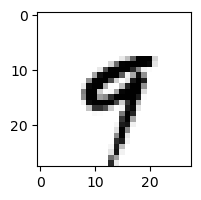

0.05035029667842898% - 0
0.16850713507132195% - 1
0.005399306744261626% - 2
3.0546633645696875% - 3
80.00064652265458% - 4 - ОШИБКА
0.3405780011611959% - 5
0.4462497903111404% - 6
3.7954583479402433% - 7
0.18794627935921743% - 8
3.944749226057658% - 9

 2


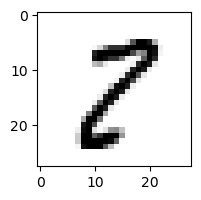

5.031112416515392% - 0
1.2653876860493527% - 1
2.5249698535791145% - 2
12.035210343264275% - 3
0.011792023086659895% - 4
1.490445111668841% - 5
0.004850271638066754% - 6
0.3476251513302546% - 7
96.52639820084839% - 8 - ОШИБКА
1.806271386380501% - 9

 4


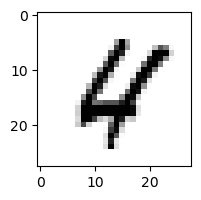

1.1289858356339475% - 0
0.0012547691318265145% - 1
2.794390756648333% - 2
0.00035695833013803263% - 3
24.660135403740078% - 4
0.15639481431632685% - 5
1.991627558815888% - 6
0.3331239563502172% - 7
47.493402684363794% - 8 - ОШИБКА
5.711461817381858% - 9

 2


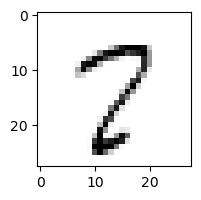

5.633137119555441% - 0
0.4614371287772862% - 1
2.975213169711966% - 2
4.628988614871966% - 3
0.41262297612060067% - 4
14.047493225764471% - 5
0.11293614284096669% - 6
69.28536290548503% - 7
86.01919507281104% - 8 - ОШИБКА
35.5547891885935% - 9

 3


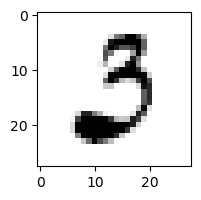

60.73596534304894% - 0 - ОШИБКА
0.21576904370162464% - 1
11.53539522573209% - 2
48.41665894530075% - 3
0.000133308970551705% - 4
0.76547376013916% - 5
1.063650538791305% - 6
0.23086143113462826% - 7
0.2844063926509035% - 8
9.16030810912668e-05% - 9

 9


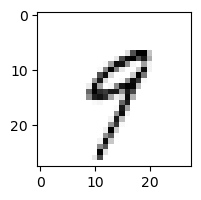

1.1745789828567503% - 0
1.6001583922219471% - 1
0.5686663145726382% - 2
20.74319138318749% - 3
50.99150287681445% - 4 - ОШИБКА
9.750754316759155% - 5
2.0669914242171257% - 6
7.955557253977521% - 7
4.341721948801367% - 8
50.28548042837859% - 9

 2


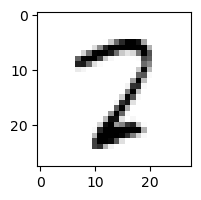

4.008132221911544% - 0
0.034156744737090135% - 1
16.798425823060715% - 2
5.083024917998698% - 3
0.658545961551022% - 4
7.618020934651687% - 5
0.15462866558661942% - 6
10.572817509526669% - 7
35.1714476591568% - 8 - ОШИБКА
0.03881449608031185% - 9

 2


0.28534098810367364% - 0
6.714641813725682% - 1
21.511291121157047% - 2
2.021228245822993% - 3
0.4919921192223879% - 4
0.29613353720154556% - 5
0.589082537824194% - 6
0.18064126560871824% - 7
26.030786570638238% - 8 - ОШИБКА
0.00047679951132685437% - 9

 2


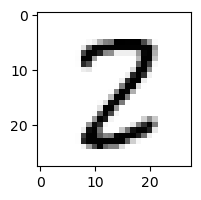

0.21961911155033084% - 0
0.2815323466084826% - 1
12.066295926798016% - 2
2.3704814231532487% - 3
0.1425398115646032% - 4
1.3459014113481718% - 5
0.0013947701348350657% - 6
0.6290329463543786% - 7
85.80060818515815% - 8 - ОШИБКА
0.0010208251569961049% - 9

 9


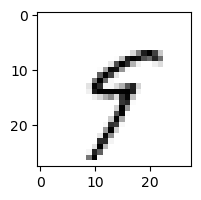

0.5789897766388947% - 0
3.608265252569191% - 1
0.21075253367286184% - 2
20.317033045668644% - 3
58.54615803410624% - 4 - ОШИБКА
49.44410994458362% - 5
1.8151071426113794% - 6
12.611869851412305% - 7
7.801341712414782% - 8
3.719167073151701% - 9

 6


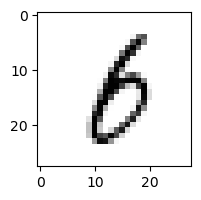

1.5527449528472947% - 0
7.595132529760155% - 1
0.7051860445376631% - 2
50.33009041170302% - 3 - ОШИБКА
0.09017679965898509% - 4
1.661713115129267% - 5
28.82635373013039% - 6
0.0798754981330142% - 7
43.93652288896489% - 8
7.412481713231768% - 9

 2


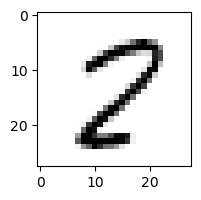

4.829981926082499% - 0
0.16591326065293469% - 1
1.8645293084147887% - 2
0.03976761714456484% - 3
0.12130258638006663% - 4
5.83664924376622% - 5
0.014148940950685893% - 6
12.63464383034168% - 7
93.03707180549759% - 8 - ОШИБКА
0.5704812992402164% - 9

 2


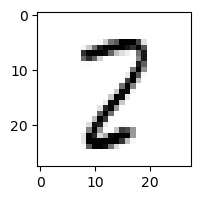

1.1130542424742795% - 0
2.1146825639087177% - 1
8.315509427110062% - 2
9.135781098201642% - 3
0.45043564040602274% - 4
1.4622355866565608% - 5
0.05080503724302927% - 6
4.493543684922805% - 7
93.87189229658735% - 8 - ОШИБКА
0.0268395498952751% - 9

 0


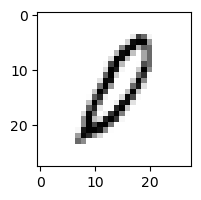

20.25219432449135% - 0
0.6113054091404788% - 1
26.976617779644798% - 2 - ОШИБКА
0.9560291160397347% - 3
0.18091038270648085% - 4
6.843122736153727% - 5
16.15962318326892% - 6
0.6742475462301197% - 7
23.33386910280235% - 8
5.054910119007269% - 9

 2


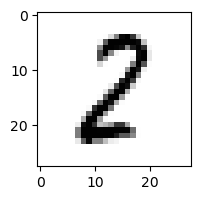

1.6325387362586257% - 0
7.326769026274748% - 1
41.78334720658752% - 2
3.63589907580764% - 3
0.025881797811986722% - 4
0.4743123127410169% - 5
0.2889328498776218% - 6
0.025068990426403905% - 7
67.25169597997213% - 8 - ОШИБКА
0.004735764995411913% - 9

 5


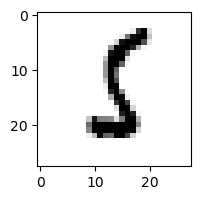

0.39877564637746854% - 0
6.274698614000015% - 1
5.036839894778219% - 2
6.052757158505365% - 3
0.0024154701845255705% - 4
15.314440207116736% - 5
71.92724705531265% - 6 - ОШИБКА
0.05087334923509899% - 7
0.6643955401290481% - 8
0.04435735033576099% - 9

 6


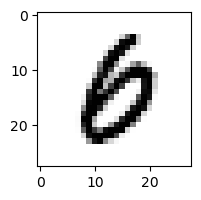

7.559706688558425% - 0 - ОШИБКА
0.0024265808336830573% - 1
0.10965035301043118% - 2
1.1821003641999184% - 3
0.0628783688947624% - 4
0.11725259181625473% - 5
3.561064600798982% - 6
0.0048075392784749016% - 7
1.4263978836952054% - 8
1.6229918339288454% - 9

 9


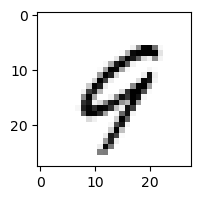

2.5240926872816862% - 0
0.13047995408020913% - 1
0.27583498070678336% - 2
0.05914140942030772% - 3
51.10859717346414% - 4 - ОШИБКА
0.39140752028946% - 5
6.680910830432419% - 6
4.802021834656741% - 7
1.692349839698028% - 8
11.56997899212416% - 9

 9


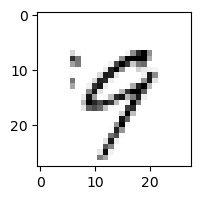

5.194151780272163% - 0
0.21183462410523904% - 1
0.27826296025800834% - 2
4.206684749990545% - 3
32.609048347519696% - 4 - ОШИБКА
1.6818710043197065% - 5
2.8562342414990742% - 6
21.257439153403407% - 7
1.4916544307830588% - 8
22.379358707724776% - 9

 8


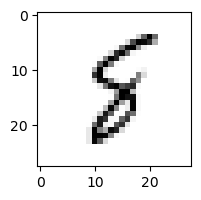

0.2943925980864619% - 0
2.815131333899723% - 1
0.8171276393654938% - 2
0.4764638782232069% - 3
2.6586667810692877% - 4
9.428852116699545% - 5
52.666957806577976% - 6 - ОШИБКА
0.5649649105399578% - 7
46.93542185836319% - 8
10.200484078953535% - 9

 2


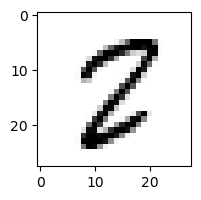

0.7132405977007901% - 0
0.20995271287471604% - 1
0.7487081155465651% - 2
0.35277527489264926% - 3
0.01644809617238158% - 4
2.8876458469534327% - 5
0.29245212749578575% - 6
0.6167371235395531% - 7
66.6238813637538% - 8 - ОШИБКА
0.049349756424980074% - 9

 9


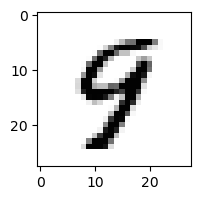

0.17917764184496945% - 0
0.004666226558871552% - 1
0.028771605823065708% - 2
0.17338287621058107% - 3
39.72868502951045% - 4 - ОШИБКА
3.035523312623783% - 5
0.2411611746220454% - 6
0.17366760515678908% - 7
3.847944070494843% - 8
23.26921029160124% - 9

 2


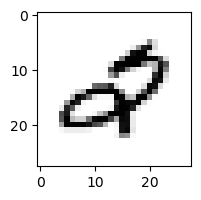

3.395266427541202% - 0
0.5249072716505263% - 1
3.8935333730946375% - 2
0.3625122624091434% - 3
4.273733079412218% - 4 - ОШИБКА
0.3004531263599297% - 5
0.12118547300174379% - 6
0.6726821625980874% - 7
0.0030082702687433058% - 8
0.014775917024896591% - 9

 3


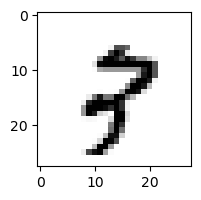

0.3605906687656288% - 0
0.0971615997313351% - 1
3.1038234463107504% - 2
0.020709828905925157% - 3
0.21998116152322608% - 4
0.002410160943044232% - 5
0.11740057601170432% - 6
30.271224527643557% - 7
18.203184219211945% - 8
68.85884691763762% - 9 - ОШИБКА

 5


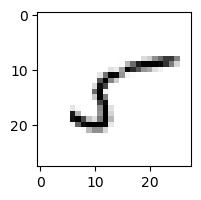

37.208230488867635% - 0
2.6350446442849504% - 1
23.8850430982527% - 2
20.94736862579353% - 3
4.6191132930602885% - 4
87.66975379820092% - 5
12.589903078071401% - 6
3.251262109000095% - 7
95.65403582630844% - 8 - ОШИБКА
0.8927520046248182% - 9

 3


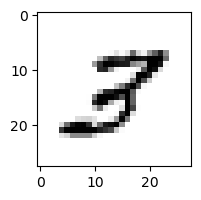

0.7347093461107519% - 0
0.15701239192491823% - 1
35.174122376257785% - 2 - ОШИБКА
3.0260965987228006% - 3
0.2370261543972779% - 4
3.796649074661265% - 5
0.0480841444283555% - 6
3.570413634027013% - 7
19.070970588278694% - 8
2.7217929223561392% - 9

 5


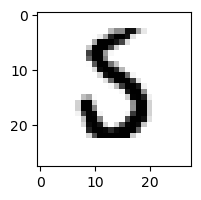

0.5178266047778379% - 0
0.010785699991041259% - 1
3.655409062334885% - 2
3.247359257493404% - 3
0.012236989377656292% - 4
0.6273384882739166% - 5
31.40193069750472% - 6 - ОШИБКА
0.26695553036478176% - 7
0.10562990083993823% - 8
0.0008295804163149088% - 9

 3


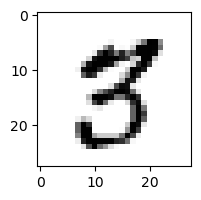

0.2751160027534465% - 0
0.018314485701195954% - 1
0.10876249822031252% - 2
5.489159453002353% - 3
0.1063897082898562% - 4
24.47905427774082% - 5 - ОШИБКА
0.0004757201291456652% - 6
0.7193735397110669% - 7
4.715941695140473% - 8
0.35352697564200747% - 9

 3


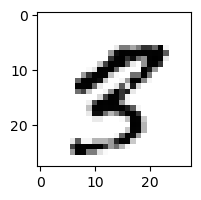

0.024350411296758707% - 0
0.05190056965187796% - 1
0.0010711238440411597% - 2
0.009722302439491891% - 3
2.5940739637031416% - 4
1.0087347065161656% - 5
0.005795166543607983% - 6
1.6755157361423634% - 7
10.685965835132235% - 8 - ОШИБКА
10.483309719953358% - 9

 9


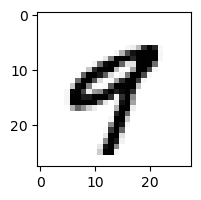

0.2814259435477834% - 0
0.026003219027304406% - 1
0.0006575987737671812% - 2
0.010759144546230559% - 3
50.17176762868487% - 4 - ОШИБКА
0.28614820784227896% - 5
0.008408706953490037% - 6
0.8219812998660014% - 7
0.03216863342471569% - 8
48.96321875506647% - 9

 2


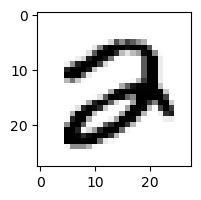

4.193528765596006% - 0 - ОШИБКА
5.449908950486906e-05% - 1
1.7458249154115602% - 2
0.1713039109658359% - 3
0.005406208291354509% - 4
0.01804070941709346% - 5
0.15883084013463444% - 6
0.4013726625899881% - 7
1.8852255717792126% - 8
0.011862819689283108% - 9

 8


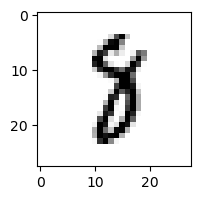

0.01838548879817335% - 0
3.9555715458655016% - 1
0.49975341876395313% - 2
4.065514047208954% - 3
0.2673211097285003% - 4
0.6140322499246761% - 5
0.218032278495447% - 6
5.581058705940252% - 7 - ОШИБКА
0.8847779789877118% - 8
0.050787818800167535% - 9

 5


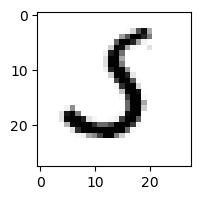

0.666125022487564% - 0
0.19352439596745427% - 1
22.76332259879654% - 2
68.00384338142221% - 3 - ОШИБКА
0.004682513928671585% - 4
2.3285204712699534% - 5
8.938952312442176% - 6
0.5107252646623676% - 7
0.006074556071480898% - 8
0.014462112207114448% - 9

 3


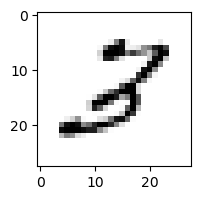

1.0894162103366798% - 0
0.15428695128320513% - 1
87.76375659576765% - 2 - ОШИБКА
18.412463914134165% - 3
0.4055084856584872% - 4
3.3453376382656623% - 5
0.23628746882752974% - 6
0.28842294968035376% - 7
43.69846868730832% - 8
12.282272160270542% - 9

 5


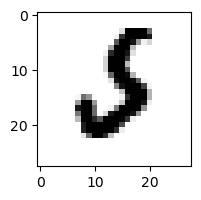

0.20827048455781708% - 0
0.09881170937633046% - 1
14.441823811902502% - 2
0.09385931909387502% - 3
0.004259419485268276% - 4
0.014684377222099561% - 5
23.174747425559325% - 6 - ОШИБКА
0.5341345663667874% - 7
0.0002898461923895635% - 8
0.0759918852022473% - 9

 3


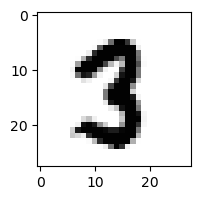

0.004038302221776148% - 0
0.02534848250400366% - 1
0.09983916019432022% - 2
1.65594517088908% - 3
0.0014195453507521588% - 4
2.010306514258954% - 5
0.0005128718545847469% - 6
0.14572755594259618% - 7
2.45799897116788% - 8 - ОШИБКА
0.009938747341796901% - 9

 5


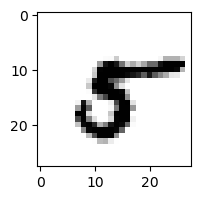

0.24283816244109097% - 0
0.1489563111392985% - 1
0.03056259103586458% - 2
0.1699130483792233% - 3
1.693638760391555% - 4
7.129230363743484% - 5
0.452549290027884% - 6
0.14844710458911697% - 7
17.558147501536805% - 8 - ОШИБКА
0.025016926661298806% - 9


Общая доля ошибок: 11.518848115188481%


In [165]:
errs = 0
for k in range(len(X_test)):
    ans = np.empty((0,10))
    for j in range(10):
        ans = np.append(ans,f(neursum(X_test[k],w[:,j],w0[j])))
    if (ans.argmax() != ansbase_test[k].argmax()):
        errs += 1
        print('\n',y_test[k])
        plt.figure(figsize=(2, 2))
        plt.imshow(X_test[k].reshape(28, 28), cmap=plt.cm.Greys)
        plt.show()
        for i in range(len(ans)):
            if i == ans.argmax():
                print(ans[i]*100,'%',' - ',i," - ОШИБКА",sep="") 
            else:
                print(ans[i]*100,'%',' - ',i,sep="") 
print("\n\nОбщая доля ошибок: ",errs/(len(X_test)+1)*100,'%',sep="")   